In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow as tf
import re
import os
from itertools import chain
import glob
import seaborn as sns
import matplotlib.font_manager as font_manager
import seaborn as sns
import matplotlib as mpl
from pytorch_tabnet.tab_model import TabNetRegressor
import torch
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import scale 
from sklearn import model_selection
from sklearn.model_selection import RepeatedKFold
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.neural_network import MLPRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor
from sklearn.linear_model import SGDRegressor
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor, Pool
from sklearn.preprocessing import StandardScaler
from lightgbm import LGBMRegressor
from sklearn.neighbors import LocalOutlierFactor
from sklearn.model_selection import RandomizedSearchCV
from collections import Counter
from sklearn.model_selection import GridSearchCV
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_absolute_percentage_error
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from pandas.plotting import register_matplotlib_converters
import warnings
warnings.filterwarnings('ignore')
register_matplotlib_converters()
sns.set_theme()
mpl.matplotlib_fname()
font_dirs = ['D:\\Software\\Anaconda\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf' ]
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
for font_file in font_files:
    font_manager.fontManager.addfont(font_file)
mpl.font_manager._rebuild()
result = font_manager.findfont("Rounded Mplus 1c")
print(result)
mpl.rc('font', family='Rounded Mplus 1c')
le = LabelEncoder()
ss = StandardScaler()

Matplotlib is building the font cache; this may take a moment.


D:\Software\Anaconda\Lib\site-packages\matplotlib\mpl-data\fonts\ttf\MPLUSRounded1c-Regular.ttf


In [2]:
names = ["Gradient_Boosting", "Decision_Tree", "Extra_Trees", "Random_Forest","XGBoost","LGBMRegressor"]

In [3]:
df_all = pd.read_csv('Kaiho_merged_data.csv')

In [4]:
df_all['Tên phụ tùng_商品名'].value_counts()

エンジン                14926
ノーズカット（個別）           3524
ＣＫＤ／コンプリート           1207
Ｒアクスル（生/Ｄ）            389
フロントアクスル（個別）          158
リアアクスル（個別）            109
Ｆアクスル（生/Ｄ）             69
ＣＫＤ／コンプリート（バイヤー）       22
外装コンプリート               13
フェイスカット                 8
ミッション（個別）               2
リアホーシング（デフ無）（個別）        1
Name: Tên phụ tùng_商品名, dtype: int64

# Select best 3 accecessories

In [5]:
# df =  df_all[(df_all['Tên phụ tùng_商品名'] == 'エンジン') | (df_all['Tên phụ tùng_商品名']=='ノーズカット（個別）') | (df_all['Tên phụ tùng_商品名']=='ＣＫＤ／コンプリート')]
df  = df_all.copy()

In [6]:
df.shape[0]

20428

In [7]:
df.columns

Index(['Vị trí_ロケーション', 'Ngày sản xuất_生産日', 'Tháng sản xuất_生産月',
       'Năm sản xuất_生産年', 'Nv sản xuất_生産担当者', 'Số nhập kho_入庫番号',
       'Nguồn nhập hàng_仕入先', 'Mã loại phụ tùng_商品コード', 'Tên phụ tùng_商品名',
       'Số nhập kho(phụ tùng)_入庫番号 (部品)', 'Tên xe_車名', 'Model xe_車輌型式',
       'Engine model_エンジン型式', 'Số lượng_数量_PARTS', 'Tổng giá nhập_仕入合計',
       'Số phút công_標準工数', 'Kết quả_生産高',
       'Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額',
       'Ước tính giá bán ra tại thời điểm sản xuất_生産時販売予測額',
       'Số lượng bán ra_販売数量', 'Thành tích bán ra_販売実績', 'Khách hàng_仕向先',
       'Truyền động 1_駆動1', 'TM_TM', 'Truyền động 2_駆動2', 'Chi tiết_詳細',
       'Số km đã chạy_走行距離', 'Năm sản xuất_年式', 'Tình trạng engine_エンジン状態',
       'Rank_ランク', 'Loại xe_車種', 'Tình trạng sản xuất_未生産',
       'Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額.1',
       'Số chỉ định loại_型式指定番号', 'Số phân loại danh mục_類別区分番号',
       'Đơn giá mua_仕入単価', 'Nhà sản xuất_メーカー', 'Giờ làm việc

In [8]:
df_target =  df['Thành tích bán ra_販売実績']

In [9]:
df_categoric = df.select_dtypes(['object'])
df_numeric  =  df.select_dtypes(['int64','float64'])

In [10]:
df_categoric_encoded  = df_categoric.apply(lambda x : le.fit_transform(x))

In [11]:
df_merge = pd.merge(df_categoric_encoded,df_numeric,on=df_numeric.index,how = 'outer')
df_merge.drop(columns='key_0',inplace=True)

In [12]:
df_scale = pd.DataFrame(ss.fit_transform(df_merge),columns=df_merge.columns)
df_scale.drop(columns = ['Thành tích bán ra_販売実績','Đơn giá bán hàng_売上単価','Sản lượng bán ra_売上金額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額','Ước tính giá bán ra tại thời điểm sản xuất_生産時販売予測額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額.1','Tổng giá nhập_仕入合計'],inplace=True)
df_scale.fillna(value=0,inplace=True)

In [36]:
df_scale

,Vị trí_ロケーション,Nv sản xuất_生産担当者,Số nhập kho_入庫番号,Nguồn nhập hàng_仕入先,Mã loại phụ tùng_商品コード,Tên phụ tùng_商品名,Số nhập kho(phụ tùng)_入庫番号 (部品),Tên xe_車名,Model xe_車輌型式,Engine model_エンジン型式,...,Năm bán hàng_売上年,Chi phí_経費,Ngày mua_仕入日,Tháng mua hàng_仕入月,Năm mua_仕入年,Số phiếu_伝票番号,Mã nhà cung cấp_仕入先コード,Phân loại mang đến/đón_持込・引取区分,Tiền công_工賃,Phân loại bán hàng_売上分類
0,0.0,0.164148,-1.010681,1.410203,0.994744,0.018787,1.035856,0.134275,-0.770367,1.158144,...,0.165117,0.0,0.610925,1.722273,-1.105804,0.289860,1.838572,0.0,0.0,0.0
1,0.0,-1.148147,-0.989579,1.750591,-0.302580,-0.389047,0.796923,-0.347813,-1.419184,-0.323023,...,-0.160809,0.0,1.611512,-1.609584,-0.126892,-0.541213,1.838537,0.0,0.0,0.0
2,0.0,0.781699,-0.989579,1.750591,0.994744,0.018787,0.768773,-0.347813,-1.419184,-0.323023,...,-0.160809,0.0,1.611512,-1.609584,-0.126892,-0.541213,1.838537,0.0,0.0,0.0
3,0.0,1.785219,-0.704514,1.696845,0.994744,0.018787,0.789971,0.270867,0.756646,0.179286,...,-0.160809,0.0,-0.167309,-1.609584,-0.126892,-0.540060,-0.498864,0.0,0.0,0.0
4,0.0,-0.839372,-0.583365,-0.340216,0.994744,0.018787,0.801502,0.351215,-1.567735,1.744171,...,-0.160809,0.0,0.722102,-1.306688,-0.126892,-0.515832,-0.886164,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20423,0.0,-0.916566,-1.129191,1.143583,0.994744,0.018787,-0.198489,-0.227291,0.503236,-1.179524,...,-1.138586,0.0,0.944454,0.207793,-1.105804,-1.116221,-1.226032,0.0,0.0,0.0
20424,0.0,-0.221821,-1.118452,1.696845,2.940728,3.689285,-0.153382,0.624399,0.566589,-0.477580,...,-1.138586,0.0,-1.612600,0.510689,-1.105804,-1.118875,-0.498864,0.0,0.0,0.0
20425,0.0,1.630832,-1.110539,1.393341,2.940728,3.689285,-0.745881,1.299322,0.935781,1.415738,...,-1.138586,0.0,-0.945543,0.510689,-1.105804,-1.118875,1.838572,0.0,0.0,0.0
20426,0.0,-0.221821,-1.050624,-1.014669,3.589390,4.097118,-0.121671,-1.070945,-1.115529,-1.108686,...,-1.138586,0.0,1.055630,1.116481,-1.105804,-1.079995,-1.142329,0.0,0.0,0.0


In [13]:
x_train, x_test, y_train, y_test = train_test_split(df_scale.values, df_target,test_size=0.3,random_state=42)

In [14]:
print(x_train.shape)
print(y_train.shape)
print(x_test.shape)
print(y_test.shape)

(14299, 52)
(14299,)
(6129, 52)
(6129,)


In [15]:
lof = LocalOutlierFactor()
yhat = lof.fit_predict(x_train)
mask = yhat != -1
print(mask)
# x_train, y_train = x_train[mask, :], y_train[mask]

[ True  True  True ...  True  True  True]


In [527]:
len(mask)

14299

In [528]:
x_train, y_train = x_train[mask, :], y_train[mask]

In [16]:
models = [
    GradientBoostingRegressor(),
    DecisionTreeRegressor(max_depth=5),
    ExtraTreesRegressor(),
    RandomForestRegressor(),
    XGBRegressor(),
    LGBMRegressor()]

In [17]:
rmse = []
mape = []
r_squared = []
for  model in models:
    model.fit(x_train, y_train)
    y_pred  = model.predict(x_test)
#     print(y_pred)
    rmse_score = mean_squared_error(y_test, y_pred,squared=False)
    mape_score = np.mean(np.abs((y_test.values - y_pred)/y_test.values)*100)
    print(mape_score)
#     mape_score = mean_absolute_percentage_error(y_test,y_pred)
    r_squared_score  = model.score(x_test,y_test)
    r_squared.append(r_squared_score)
    rmse.append(rmse_score)
    mape.append(mape_score)

20.971373358439145
24.033588385924887
13.04481990370343
13.765428472023109
16.317621262093503
16.643999287574992


In [18]:
df_score = pd.DataFrame()
df_score['MODELS'] = names
df_score['R_SQUARED'] = r_squared
df_score['RMSE'] = rmse
df_score['MAPE'] = mape
df_score['RMSE'] = round(df_score['RMSE'],3)
df_score['MAPE'] = round(df_score['MAPE'],3)
df_score['R_SQUARED'] = round(df_score['R_SQUARED'],3)

df_score

,MODELS,R_SQUARED,RMSE,MAPE
0,Gradient_Boosting,0.867,12594.634,20.971
1,Decision_Tree,0.793,15704.294,24.034
2,Extra_Trees,0.902,10797.368,13.045
3,Random_Forest,0.890,11441.845,13.765
4,XGBoost,0.894,11230.807,16.318
5,LGBMRegressor,0.893,11306.054,16.644


# XGBoost

In [535]:
params = { 'max_depth': [3, 5, 6, 10, 15, 20],
           'learning_rate': [0.01, 0.1, 0.2, 0.3],
           'subsample': np.arange(0.5, 1.0, 0.1),
           'colsample_bytree': np.arange(0.4, 1.0, 0.1),
           'colsample_bylevel': np.arange(0.4, 1.0, 0.1),
           'n_estimators': [100, 500, 1000]}

In [537]:
xgbr = XGBRegressor(seed = 20)
clf = RandomizedSearchCV(estimator=xgbr,
                         param_distributions=params,
                         scoring='neg_mean_squared_error',
                         n_iter=25,
                         verbose=1)
clf.fit(x_train, y_train)
print("Best parameters:", clf.best_params_)
print("Lowest RMSE: ", (-clf.best_score_)**(1/2.0))

Fitting 5 folds for each of 25 candidates, totalling 125 fits
Best parameters: {'subsample': 0.7999999999999999, 'n_estimators': 1000, 'max_depth': 10, 'learning_rate': 0.01, 'colsample_bytree': 0.5, 'colsample_bylevel': 0.7}
Lowest RMSE:  10753.46684726697


In [19]:
model_best = XGBRegressor (subsample = 0.7999999999999999, n_estimators = 1000, max_depth= 10, learning_rate =  0.01, colsample_bytree = 0.5, colsample_bylevel = 0.7)

In [20]:
model_best.fit(x_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=0.7,
             colsample_bynode=1, colsample_bytree=0.5, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.01, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=1000, n_jobs=12,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=0.7999999999999999,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [21]:
y_pred = model_best.predict(x_test)
print('MAPE: %.3f'%(mean_absolute_percentage_error(y_test,y_pred)))

MAPE: 0.134


In [33]:
x_test[0]

array([ 0.        ,  1.16766855, -1.7008291 , -0.93668569, -0.3025796 ,
       -0.38904663, -0.7089131 , -1.04684107, -0.99100843, -0.9219298 ,
        0.5621198 ,  1.65429079, -0.27958889,  1.20516043,  0.702526  ,
       -0.87406929,  1.11294404,  0.        , -0.50999774,  0.73296477,
       -1.39393676, -0.93949565,  0.73635619, -3.45505618, -0.11839354,
       -1.77665405,  1.07959942, -2.09578692,  0.        ,  1.64290991,
        1.53475538, -0.17787352, -0.04674459,  0.03257265,  0.        ,
       -0.17144086, -0.05845607, -0.23528193,  1.54882388,  0.        ,
       -1.35198424,  1.35372366, -2.11636333,  0.        ,  1.50033564,
        0.81358468, -2.0847151 , -1.64185029, -0.51560444,  0.        ,
        0.        ,  0.        ])

# ExtraTree

In [22]:
model = ExtraTreesRegressor(n_estimators=100, n_jobs=4, min_samples_split=25,
                            min_samples_leaf=35, max_features=150)

In [23]:
gsc = GridSearchCV(
    estimator=model,
    param_grid={
        #'n_estimators': range(50,126,25),
        'max_features': range(50,401,50),
        #'min_samples_leaf': range(20,50,5),
        #'min_samples_split': range(15,36,5),
    },
    scoring='r2',
    cv=5,
    return_train_score=True
)

In [24]:
grid_result = gsc.fit(x_train, y_train)

print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

for test_mean, train_mean, param in zip(
        grid_result.cv_results_['mean_test_score'],
        grid_result.cv_results_['mean_train_score'],
        grid_result.cv_results_['params']):
    print("Train: %f // Test : %f with: %r" % (train_mean, test_mean, param))
    
model_best_tree = ExtraTreesRegressor(**grid_result.best_params_)

model_best_tree.fit(x_train, y_train)


Best: 0.815001 using {'max_features': 50}
Train: 0.828520 // Test : 0.815001 with: {'max_features': 50}
Train: nan // Test : nan with: {'max_features': 100}
Train: nan // Test : nan with: {'max_features': 150}
Train: nan // Test : nan with: {'max_features': 200}
Train: nan // Test : nan with: {'max_features': 250}
Train: nan // Test : nan with: {'max_features': 300}
Train: nan // Test : nan with: {'max_features': 350}
Train: nan // Test : nan with: {'max_features': 400}


ExtraTreesRegressor(max_features=50)

In [26]:
y_pred = model_best_tree.predict(x_test)
print('MAPE: %.4f'%(mean_absolute_percentage_error(y_test,y_pred)))

MAPE: 0.1302


In [27]:
x_test[0]

array([ 0.        ,  1.16766855, -1.7008291 , -0.93668569, -0.3025796 ,
       -0.38904663, -0.7089131 , -1.04684107, -0.99100843, -0.9219298 ,
        0.5621198 ,  1.65429079, -0.27958889,  1.20516043,  0.702526  ,
       -0.87406929,  1.11294404,  0.        , -0.50999774,  0.73296477,
       -1.39393676, -0.93949565,  0.73635619, -3.45505618, -0.11839354,
       -1.77665405,  1.07959942, -2.09578692,  0.        ,  1.64290991,
        1.53475538, -0.17787352, -0.04674459,  0.03257265,  0.        ,
       -0.17144086, -0.05845607, -0.23528193,  1.54882388,  0.        ,
       -1.35198424,  1.35372366, -2.11636333,  0.        ,  1.50033564,
        0.81358468, -2.0847151 , -1.64185029, -0.51560444,  0.        ,
        0.        ,  0.        ])

# LightGBM

# CatBoost

In [532]:
train_dataset = Pool(x_train, y_train) 
test_dataset = Pool(x_test, y_test)

In [533]:
model = CatBoostRegressor(loss_function='RMSE',depth=10,l2_leaf_reg=3, iterations = 2000, learning_rate = 0.1)
model.fit(train_dataset)

0:	learn: 32979.1792549	total: 33.1ms	remaining: 1m 6s
1:	learn: 30827.0262454	total: 63.3ms	remaining: 1m 3s
2:	learn: 28893.0488443	total: 96.3ms	remaining: 1m 4s
3:	learn: 27053.8581393	total: 127ms	remaining: 1m 3s
4:	learn: 25416.3742037	total: 157ms	remaining: 1m 2s
5:	learn: 23921.2625357	total: 187ms	remaining: 1m 2s
6:	learn: 22545.6152248	total: 217ms	remaining: 1m 1s
7:	learn: 21395.6942179	total: 246ms	remaining: 1m 1s
8:	learn: 20338.5177442	total: 278ms	remaining: 1m 1s
9:	learn: 19436.6126852	total: 309ms	remaining: 1m 1s
10:	learn: 18633.5458311	total: 340ms	remaining: 1m 1s
11:	learn: 17931.8843374	total: 370ms	remaining: 1m 1s
12:	learn: 17238.8412430	total: 399ms	remaining: 1m
13:	learn: 16723.6121216	total: 428ms	remaining: 1m
14:	learn: 16205.4706992	total: 457ms	remaining: 1m
15:	learn: 15688.4557778	total: 489ms	remaining: 1m
16:	learn: 15246.0630402	total: 520ms	remaining: 1m
17:	learn: 14836.0577649	total: 552ms	remaining: 1m
18:	learn: 14433.8408937	total: 588

156:	learn: 6673.5590885	total: 5.13s	remaining: 1m
157:	learn: 6643.7733747	total: 5.17s	remaining: 1m
158:	learn: 6635.3536349	total: 5.2s	remaining: 1m
159:	learn: 6614.0184462	total: 5.23s	remaining: 1m
160:	learn: 6586.9758000	total: 5.26s	remaining: 1m
161:	learn: 6563.2741990	total: 5.29s	remaining: 1m
162:	learn: 6542.1013318	total: 5.32s	remaining: 60s
163:	learn: 6508.4506668	total: 5.36s	remaining: 60s
164:	learn: 6482.2041246	total: 5.39s	remaining: 59.9s
165:	learn: 6448.7055973	total: 5.42s	remaining: 59.9s
166:	learn: 6426.6161139	total: 5.45s	remaining: 59.8s
167:	learn: 6411.3512574	total: 5.48s	remaining: 59.8s
168:	learn: 6388.2579760	total: 5.51s	remaining: 59.7s
169:	learn: 6373.3827912	total: 5.54s	remaining: 59.7s
170:	learn: 6349.0560734	total: 5.58s	remaining: 59.7s
171:	learn: 6328.6199763	total: 5.62s	remaining: 59.7s
172:	learn: 6311.3765302	total: 5.65s	remaining: 59.7s
173:	learn: 6294.5819322	total: 5.69s	remaining: 59.7s
174:	learn: 6283.7892482	total: 5

308:	learn: 4455.9584889	total: 9.87s	remaining: 54s
309:	learn: 4440.4442223	total: 9.9s	remaining: 54s
310:	learn: 4435.9510262	total: 9.93s	remaining: 53.9s
311:	learn: 4430.3411171	total: 9.96s	remaining: 53.9s
312:	learn: 4424.7606244	total: 9.99s	remaining: 53.8s
313:	learn: 4415.3229508	total: 10s	remaining: 53.8s
314:	learn: 4402.3418325	total: 10s	remaining: 53.7s
315:	learn: 4393.2947135	total: 10.1s	remaining: 53.7s
316:	learn: 4379.3617419	total: 10.1s	remaining: 53.7s
317:	learn: 4369.1448367	total: 10.1s	remaining: 53.6s
318:	learn: 4361.2091041	total: 10.2s	remaining: 53.6s
319:	learn: 4349.2863521	total: 10.2s	remaining: 53.5s
320:	learn: 4346.6941610	total: 10.2s	remaining: 53.4s
321:	learn: 4346.4683407	total: 10.2s	remaining: 53.4s
322:	learn: 4332.9926922	total: 10.3s	remaining: 53.4s
323:	learn: 4320.4815567	total: 10.3s	remaining: 53.3s
324:	learn: 4302.0607491	total: 10.3s	remaining: 53.3s
325:	learn: 4290.5238537	total: 10.4s	remaining: 53.2s
326:	learn: 4279.31

464:	learn: 3268.0509753	total: 14.5s	remaining: 48s
465:	learn: 3263.5522581	total: 14.6s	remaining: 47.9s
466:	learn: 3260.8416490	total: 14.6s	remaining: 47.9s
467:	learn: 3258.1769812	total: 14.6s	remaining: 47.9s
468:	learn: 3245.7128132	total: 14.7s	remaining: 47.8s
469:	learn: 3242.0983516	total: 14.7s	remaining: 47.8s
470:	learn: 3232.8599551	total: 14.7s	remaining: 47.8s
471:	learn: 3229.1860599	total: 14.7s	remaining: 47.7s
472:	learn: 3224.3726005	total: 14.8s	remaining: 47.7s
473:	learn: 3213.3294433	total: 14.8s	remaining: 47.7s
474:	learn: 3207.9635836	total: 14.8s	remaining: 47.6s
475:	learn: 3200.2124272	total: 14.9s	remaining: 47.6s
476:	learn: 3191.5107839	total: 14.9s	remaining: 47.6s
477:	learn: 3186.8108952	total: 14.9s	remaining: 47.5s
478:	learn: 3183.2466417	total: 15s	remaining: 47.5s
479:	learn: 3177.2040808	total: 15s	remaining: 47.5s
480:	learn: 3173.6616302	total: 15s	remaining: 47.4s
481:	learn: 3163.4462654	total: 15s	remaining: 47.4s
482:	learn: 3158.953

621:	learn: 2453.6328369	total: 19.2s	remaining: 42.5s
622:	learn: 2448.1545238	total: 19.2s	remaining: 42.5s
623:	learn: 2439.6474768	total: 19.3s	remaining: 42.5s
624:	learn: 2432.9574142	total: 19.3s	remaining: 42.4s
625:	learn: 2430.0623039	total: 19.3s	remaining: 42.4s
626:	learn: 2430.0179188	total: 19.3s	remaining: 42.4s
627:	learn: 2425.4913803	total: 19.4s	remaining: 42.3s
628:	learn: 2421.0179569	total: 19.4s	remaining: 42.3s
629:	learn: 2418.0104779	total: 19.4s	remaining: 42.3s
630:	learn: 2413.5736373	total: 19.5s	remaining: 42.2s
631:	learn: 2408.4433501	total: 19.5s	remaining: 42.2s
632:	learn: 2403.7571567	total: 19.5s	remaining: 42.2s
633:	learn: 2399.7035264	total: 19.6s	remaining: 42.1s
634:	learn: 2396.6385610	total: 19.6s	remaining: 42.1s
635:	learn: 2388.2509765	total: 19.6s	remaining: 42.1s
636:	learn: 2385.6880715	total: 19.6s	remaining: 42s
637:	learn: 2381.3219370	total: 19.7s	remaining: 42s
638:	learn: 2379.2682923	total: 19.7s	remaining: 42s
639:	learn: 2376

777:	learn: 1872.4531380	total: 23.9s	remaining: 37.5s
778:	learn: 1870.5546711	total: 23.9s	remaining: 37.5s
779:	learn: 1866.2440721	total: 24s	remaining: 37.5s
780:	learn: 1861.2354367	total: 24s	remaining: 37.4s
781:	learn: 1858.8968348	total: 24s	remaining: 37.4s
782:	learn: 1856.2793769	total: 24s	remaining: 37.4s
783:	learn: 1850.8536643	total: 24.1s	remaining: 37.3s
784:	learn: 1848.2275083	total: 24.1s	remaining: 37.3s
785:	learn: 1844.6442471	total: 24.1s	remaining: 37.3s
786:	learn: 1839.9012682	total: 24.2s	remaining: 37.2s
787:	learn: 1836.3242740	total: 24.2s	remaining: 37.2s
788:	learn: 1834.1101771	total: 24.2s	remaining: 37.2s
789:	learn: 1831.5618745	total: 24.3s	remaining: 37.1s
790:	learn: 1828.2971212	total: 24.3s	remaining: 37.1s
791:	learn: 1823.7873800	total: 24.3s	remaining: 37.1s
792:	learn: 1821.5790387	total: 24.3s	remaining: 37.1s
793:	learn: 1817.6530654	total: 24.4s	remaining: 37s
794:	learn: 1814.3155932	total: 24.4s	remaining: 37s
795:	learn: 1814.17189

934:	learn: 1435.2628270	total: 28.6s	remaining: 32.6s
935:	learn: 1433.2623358	total: 28.6s	remaining: 32.6s
936:	learn: 1427.1582267	total: 28.7s	remaining: 32.5s
937:	learn: 1425.4353098	total: 28.7s	remaining: 32.5s
938:	learn: 1423.5184761	total: 28.7s	remaining: 32.5s
939:	learn: 1422.1374605	total: 28.8s	remaining: 32.4s
940:	learn: 1419.1500576	total: 28.8s	remaining: 32.4s
941:	learn: 1416.2836883	total: 28.8s	remaining: 32.4s
942:	learn: 1412.9318801	total: 28.9s	remaining: 32.3s
943:	learn: 1410.2555085	total: 28.9s	remaining: 32.3s
944:	learn: 1407.1462812	total: 28.9s	remaining: 32.3s
945:	learn: 1404.3149682	total: 28.9s	remaining: 32.2s
946:	learn: 1402.3746972	total: 29s	remaining: 32.2s
947:	learn: 1401.2440808	total: 29s	remaining: 32.2s
948:	learn: 1399.3182731	total: 29s	remaining: 32.2s
949:	learn: 1397.8321289	total: 29.1s	remaining: 32.1s
950:	learn: 1397.5014550	total: 29.1s	remaining: 32.1s
951:	learn: 1395.7337838	total: 29.1s	remaining: 32.1s
952:	learn: 1394

1090:	learn: 1127.9192727	total: 33.3s	remaining: 27.8s
1091:	learn: 1126.0838147	total: 33.3s	remaining: 27.7s
1092:	learn: 1124.9709763	total: 33.4s	remaining: 27.7s
1093:	learn: 1122.9143294	total: 33.4s	remaining: 27.7s
1094:	learn: 1122.3055108	total: 33.4s	remaining: 27.6s
1095:	learn: 1120.3738658	total: 33.5s	remaining: 27.6s
1096:	learn: 1119.0611220	total: 33.5s	remaining: 27.6s
1097:	learn: 1117.0370999	total: 33.5s	remaining: 27.5s
1098:	learn: 1115.2488246	total: 33.6s	remaining: 27.5s
1099:	learn: 1113.6119052	total: 33.6s	remaining: 27.5s
1100:	learn: 1112.4594593	total: 33.6s	remaining: 27.4s
1101:	learn: 1111.1509277	total: 33.6s	remaining: 27.4s
1102:	learn: 1108.7849755	total: 33.7s	remaining: 27.4s
1103:	learn: 1106.7404125	total: 33.7s	remaining: 27.4s
1104:	learn: 1104.2514911	total: 33.7s	remaining: 27.3s
1105:	learn: 1102.3781465	total: 33.8s	remaining: 27.3s
1106:	learn: 1100.8968956	total: 33.8s	remaining: 27.3s
1107:	learn: 1098.6414988	total: 33.8s	remaining

1243:	learn: 892.3334797	total: 38s	remaining: 23.1s
1244:	learn: 890.7136307	total: 38s	remaining: 23.1s
1245:	learn: 889.1488475	total: 38.1s	remaining: 23s
1246:	learn: 889.1278191	total: 38.1s	remaining: 23s
1247:	learn: 887.4539063	total: 38.1s	remaining: 23s
1248:	learn: 886.0918879	total: 38.1s	remaining: 22.9s
1249:	learn: 884.8905682	total: 38.1s	remaining: 22.9s
1250:	learn: 883.4386368	total: 38.2s	remaining: 22.9s
1251:	learn: 882.3899343	total: 38.2s	remaining: 22.8s
1252:	learn: 880.8808566	total: 38.2s	remaining: 22.8s
1253:	learn: 879.5554128	total: 38.3s	remaining: 22.8s
1254:	learn: 878.0452026	total: 38.3s	remaining: 22.7s
1255:	learn: 876.1679511	total: 38.3s	remaining: 22.7s
1256:	learn: 874.7373269	total: 38.4s	remaining: 22.7s
1257:	learn: 872.7793162	total: 38.4s	remaining: 22.6s
1258:	learn: 870.6717159	total: 38.4s	remaining: 22.6s
1259:	learn: 869.1922244	total: 38.5s	remaining: 22.6s
1260:	learn: 867.6707900	total: 38.5s	remaining: 22.6s
1261:	learn: 865.958

1396:	learn: 711.2283129	total: 42.6s	remaining: 18.4s
1397:	learn: 710.2098438	total: 42.6s	remaining: 18.3s
1398:	learn: 708.9060274	total: 42.6s	remaining: 18.3s
1399:	learn: 708.5709207	total: 42.7s	remaining: 18.3s
1400:	learn: 707.0946216	total: 42.7s	remaining: 18.3s
1401:	learn: 706.4606956	total: 42.7s	remaining: 18.2s
1402:	learn: 704.7562276	total: 42.8s	remaining: 18.2s
1403:	learn: 704.4058941	total: 42.8s	remaining: 18.2s
1404:	learn: 703.0254938	total: 42.8s	remaining: 18.1s
1405:	learn: 702.5908042	total: 42.9s	remaining: 18.1s
1406:	learn: 702.5356340	total: 42.9s	remaining: 18.1s
1407:	learn: 702.0645359	total: 42.9s	remaining: 18s
1408:	learn: 701.7539859	total: 42.9s	remaining: 18s
1409:	learn: 700.3695775	total: 43s	remaining: 18s
1410:	learn: 699.4970030	total: 43s	remaining: 17.9s
1411:	learn: 698.4756902	total: 43s	remaining: 17.9s
1412:	learn: 697.2774559	total: 43s	remaining: 17.9s
1413:	learn: 696.3021810	total: 43.1s	remaining: 17.9s
1414:	learn: 695.5235824

1549:	learn: 579.0524736	total: 47.3s	remaining: 13.7s
1550:	learn: 578.1991794	total: 47.3s	remaining: 13.7s
1551:	learn: 577.7443686	total: 47.3s	remaining: 13.7s
1552:	learn: 577.1480028	total: 47.3s	remaining: 13.6s
1553:	learn: 576.3346997	total: 47.4s	remaining: 13.6s
1554:	learn: 575.7462344	total: 47.4s	remaining: 13.6s
1555:	learn: 575.0823980	total: 47.4s	remaining: 13.5s
1556:	learn: 574.2663948	total: 47.5s	remaining: 13.5s
1557:	learn: 573.1108259	total: 47.5s	remaining: 13.5s
1558:	learn: 572.5604746	total: 47.5s	remaining: 13.4s
1559:	learn: 571.5420729	total: 47.6s	remaining: 13.4s
1560:	learn: 571.0659711	total: 47.6s	remaining: 13.4s
1561:	learn: 570.4643147	total: 47.6s	remaining: 13.4s
1562:	learn: 570.3036681	total: 47.6s	remaining: 13.3s
1563:	learn: 569.7272087	total: 47.7s	remaining: 13.3s
1564:	learn: 568.8735372	total: 47.7s	remaining: 13.3s
1565:	learn: 568.1684661	total: 47.7s	remaining: 13.2s
1566:	learn: 567.5593043	total: 47.8s	remaining: 13.2s
1567:	lear

1705:	learn: 470.1339785	total: 52.1s	remaining: 8.97s
1706:	learn: 469.2766176	total: 52.1s	remaining: 8.94s
1707:	learn: 468.1236299	total: 52.1s	remaining: 8.91s
1708:	learn: 467.3989209	total: 52.1s	remaining: 8.88s
1709:	learn: 467.0384399	total: 52.2s	remaining: 8.85s
1710:	learn: 466.6469648	total: 52.2s	remaining: 8.82s
1711:	learn: 466.0483324	total: 52.2s	remaining: 8.79s
1712:	learn: 464.9538035	total: 52.3s	remaining: 8.76s
1713:	learn: 464.0892834	total: 52.3s	remaining: 8.73s
1714:	learn: 463.6726227	total: 52.3s	remaining: 8.7s
1715:	learn: 461.9155059	total: 52.4s	remaining: 8.66s
1716:	learn: 461.3094463	total: 52.4s	remaining: 8.63s
1717:	learn: 460.7233157	total: 52.4s	remaining: 8.6s
1718:	learn: 459.9624118	total: 52.4s	remaining: 8.57s
1719:	learn: 459.4400894	total: 52.5s	remaining: 8.54s
1720:	learn: 458.6428706	total: 52.5s	remaining: 8.51s
1721:	learn: 457.6503522	total: 52.5s	remaining: 8.48s
1722:	learn: 457.0854282	total: 52.6s	remaining: 8.45s
1723:	learn:

1857:	learn: 384.0197683	total: 56.7s	remaining: 4.33s
1858:	learn: 383.6379056	total: 56.7s	remaining: 4.3s
1859:	learn: 382.8848565	total: 56.7s	remaining: 4.27s
1860:	learn: 382.7947840	total: 56.8s	remaining: 4.24s
1861:	learn: 382.5119076	total: 56.8s	remaining: 4.21s
1862:	learn: 381.9532897	total: 56.8s	remaining: 4.18s
1863:	learn: 381.4499584	total: 56.8s	remaining: 4.15s
1864:	learn: 380.7878444	total: 56.9s	remaining: 4.12s
1865:	learn: 380.3935665	total: 56.9s	remaining: 4.09s
1866:	learn: 380.2892129	total: 56.9s	remaining: 4.06s
1867:	learn: 379.9459826	total: 57s	remaining: 4.03s
1868:	learn: 379.4381059	total: 57s	remaining: 4s
1869:	learn: 378.7915253	total: 57s	remaining: 3.96s
1870:	learn: 378.0236875	total: 57.1s	remaining: 3.93s
1871:	learn: 377.5170623	total: 57.1s	remaining: 3.9s
1872:	learn: 377.0962191	total: 57.1s	remaining: 3.87s
1873:	learn: 376.3031617	total: 57.2s	remaining: 3.84s
1874:	learn: 375.6591432	total: 57.2s	remaining: 3.81s
1875:	learn: 375.6541

In [421]:
# grid = {'iterations': [100, 150, 200,500,1000],
#         'learning_rate': [0.03, 0.1,0.001,0.01],
#         'depth': [2, 4, 6, 8,10,12],
#         'l2_leaf_reg': [0.2, 0.5, 1, 3]}
# model.grid_search(grid, train_dataset)

0:	learn: 50482.5043775	test: 52120.1486098	best: 52120.1486098 (0)	total: 9.24ms	remaining: 915ms
1:	learn: 49216.3145603	test: 50853.1312156	best: 50853.1312156 (1)	total: 10.9ms	remaining: 537ms
2:	learn: 48038.6214176	test: 49670.9971238	best: 49670.9971238 (2)	total: 12.6ms	remaining: 407ms
3:	learn: 46862.0275883	test: 48489.4922115	best: 48489.4922115 (3)	total: 14.1ms	remaining: 338ms
4:	learn: 45718.5871688	test: 47348.8473120	best: 47348.8473120 (4)	total: 15.6ms	remaining: 296ms
5:	learn: 44616.6268845	test: 46240.2093878	best: 46240.2093878 (5)	total: 17.1ms	remaining: 268ms
6:	learn: 43660.0241327	test: 45282.8983411	best: 45282.8983411 (6)	total: 18.6ms	remaining: 247ms
7:	learn: 42630.1958640	test: 44255.7476032	best: 44255.7476032 (7)	total: 20.1ms	remaining: 231ms
8:	learn: 41672.1127398	test: 43295.3510718	best: 43295.3510718 (8)	total: 21.6ms	remaining: 218ms
9:	learn: 40750.0798980	test: 42371.2917300	best: 42371.2917300 (9)	total: 23.1ms	remaining: 208ms
10:	learn:

15:	learn: 20306.2871639	test: 21628.4389222	best: 21628.4389222 (15)	total: 24.7ms	remaining: 130ms
16:	learn: 19763.2986971	test: 21030.5499850	best: 21030.5499850 (16)	total: 26.5ms	remaining: 129ms
17:	learn: 19294.6830310	test: 20537.3869846	best: 20537.3869846 (17)	total: 28.5ms	remaining: 130ms
18:	learn: 18887.9072189	test: 20099.3368133	best: 20099.3368133 (18)	total: 30ms	remaining: 128ms
19:	learn: 18590.9156414	test: 19778.0105593	best: 19778.0105593 (19)	total: 31.6ms	remaining: 126ms
20:	learn: 18288.6534149	test: 19442.8267049	best: 19442.8267049 (20)	total: 33.1ms	remaining: 125ms
21:	learn: 18023.2417531	test: 19132.5889968	best: 19132.5889968 (21)	total: 34.7ms	remaining: 123ms
22:	learn: 17789.6610785	test: 18921.5231112	best: 18921.5231112 (22)	total: 36.3ms	remaining: 121ms
23:	learn: 17581.5185126	test: 18659.9757225	best: 18659.9757225 (23)	total: 37.9ms	remaining: 120ms
24:	learn: 17403.1542827	test: 18463.1266872	best: 18463.1266872 (24)	total: 39.6ms	remaining

31:	learn: 50434.6114371	test: 52068.7974249	best: 52068.7974249 (31)	total: 47.8ms	remaining: 102ms
32:	learn: 50393.9714830	test: 52028.0049653	best: 52028.0049653 (32)	total: 49.6ms	remaining: 101ms
33:	learn: 50353.3800526	test: 51987.2615274	best: 51987.2615274 (33)	total: 51.2ms	remaining: 99.3ms
34:	learn: 50311.7084990	test: 51945.4379074	best: 51945.4379074 (34)	total: 52.8ms	remaining: 98ms
35:	learn: 50271.2096570	test: 51904.7879532	best: 51904.7879532 (35)	total: 54.5ms	remaining: 96.9ms
36:	learn: 50229.3942656	test: 51863.0652431	best: 51863.0652431 (36)	total: 56.1ms	remaining: 95.6ms
37:	learn: 50188.2536221	test: 51821.4941788	best: 51821.4941788 (37)	total: 57.7ms	remaining: 94.2ms
38:	learn: 50146.5526870	test: 51779.6904507	best: 51779.6904507 (38)	total: 59.4ms	remaining: 92.9ms
39:	learn: 50108.1334714	test: 51741.2335836	best: 51741.2335836 (39)	total: 61.2ms	remaining: 91.8ms
40:	learn: 50066.1925618	test: 51699.3894712	best: 51699.3894712 (40)	total: 62.8ms	re

48:	learn: 35523.9232176	test: 37114.3058236	best: 37114.3058236 (48)	total: 74.6ms	remaining: 77.6ms
49:	learn: 35285.3908968	test: 36875.4603830	best: 36875.4603830 (49)	total: 76.4ms	remaining: 76.4ms
50:	learn: 35050.0294362	test: 36639.8004048	best: 36639.8004048 (50)	total: 78.4ms	remaining: 75.3ms
51:	learn: 34809.7171622	test: 36398.8180085	best: 36398.8180085 (51)	total: 79.9ms	remaining: 73.8ms
52:	learn: 34571.3793487	test: 36160.1543519	best: 36160.1543519 (52)	total: 81.5ms	remaining: 72.3ms
53:	learn: 34344.5471657	test: 35933.0326606	best: 35933.0326606 (53)	total: 83.1ms	remaining: 70.8ms
54:	learn: 34112.8561497	test: 35702.3164369	best: 35702.3164369 (54)	total: 84.7ms	remaining: 69.3ms
55:	learn: 33883.2008336	test: 35470.8403183	best: 35470.8403183 (55)	total: 86.2ms	remaining: 67.8ms
56:	learn: 33659.0218977	test: 35244.8136012	best: 35244.8136012 (56)	total: 87.9ms	remaining: 66.3ms
57:	learn: 33436.6014289	test: 35020.8677667	best: 35020.8677667 (57)	total: 89.6m

63:	learn: 19106.4959927	test: 20334.7062059	best: 20334.7062059 (63)	total: 98.2ms	remaining: 55.3ms
64:	learn: 18984.4654023	test: 20195.2887207	best: 20195.2887207 (64)	total: 100ms	remaining: 53.8ms
65:	learn: 18873.5789106	test: 20077.8627083	best: 20077.8627083 (65)	total: 102ms	remaining: 52.3ms
66:	learn: 18767.8538683	test: 19963.7893981	best: 19963.7893981 (66)	total: 103ms	remaining: 50.8ms
67:	learn: 18674.0193761	test: 19865.5144858	best: 19865.5144858 (67)	total: 105ms	remaining: 49.2ms
68:	learn: 18572.1916021	test: 19751.9736962	best: 19751.9736962 (68)	total: 106ms	remaining: 47.7ms
69:	learn: 18479.1670428	test: 19653.1111645	best: 19653.1111645 (69)	total: 108ms	remaining: 46.1ms
70:	learn: 18386.7083289	test: 19550.7738712	best: 19550.7738712 (70)	total: 109ms	remaining: 44.6ms
71:	learn: 18306.1860275	test: 19461.4785895	best: 19461.4785895 (71)	total: 111ms	remaining: 43.3ms
72:	learn: 18229.4531993	test: 19375.1177416	best: 19375.1177416 (72)	total: 113ms	remaini

79:	learn: 14000.1515368	test: 14635.2408632	best: 14635.2408632 (79)	total: 123ms	remaining: 30.8ms
80:	learn: 13983.7697124	test: 14620.0322002	best: 14620.0322002 (80)	total: 125ms	remaining: 29.3ms
81:	learn: 13962.8061074	test: 14595.2845513	best: 14595.2845513 (81)	total: 126ms	remaining: 27.8ms
82:	learn: 13947.7134259	test: 14583.9445881	best: 14583.9445881 (82)	total: 128ms	remaining: 26.2ms
83:	learn: 13901.9220020	test: 14507.4977800	best: 14507.4977800 (83)	total: 130ms	remaining: 24.7ms
84:	learn: 13884.4915780	test: 14488.6117643	best: 14488.6117643 (84)	total: 131ms	remaining: 23.2ms
85:	learn: 13862.5631596	test: 14469.4072128	best: 14469.4072128 (85)	total: 133ms	remaining: 21.6ms
86:	learn: 13838.9835056	test: 14463.6841455	best: 14463.6841455 (86)	total: 135ms	remaining: 20.1ms
87:	learn: 13822.6980066	test: 14449.8297277	best: 14449.8297277 (87)	total: 136ms	remaining: 18.6ms
88:	learn: 13809.0928164	test: 14444.0161703	best: 14444.0161703 (88)	total: 138ms	remainin

78:	learn: 48533.5254068	test: 50162.6620917	best: 50162.6620917 (78)	total: 138ms	remaining: 36.7ms
79:	learn: 48493.7291409	test: 50122.7767540	best: 50122.7767540 (79)	total: 140ms	remaining: 34.9ms
80:	learn: 48453.6901355	test: 50082.5224430	best: 50082.5224430 (80)	total: 141ms	remaining: 33.1ms
81:	learn: 48413.6980898	test: 50042.3152339	best: 50042.3152339 (81)	total: 143ms	remaining: 31.3ms
82:	learn: 48375.2679272	test: 50003.7509922	best: 50003.7509922 (82)	total: 144ms	remaining: 29.5ms
83:	learn: 48336.0327870	test: 49964.1852971	best: 49964.1852971 (83)	total: 146ms	remaining: 27.8ms
84:	learn: 48299.3298388	test: 49927.2466925	best: 49927.2466925 (84)	total: 147ms	remaining: 26ms
85:	learn: 48261.4577273	test: 49889.2827721	best: 49889.2827721 (85)	total: 149ms	remaining: 24.2ms
86:	learn: 48223.2054959	test: 49850.8993061	best: 49850.8993061 (86)	total: 150ms	remaining: 22.5ms
87:	learn: 48183.4541071	test: 49811.1862162	best: 49811.1862162 (87)	total: 152ms	remaining:

94:	learn: 26897.4074482	test: 28433.7606808	best: 28433.7606808 (94)	total: 145ms	remaining: 7.64ms
95:	learn: 26761.7940443	test: 28297.7626369	best: 28297.7626369 (95)	total: 147ms	remaining: 6.12ms
96:	learn: 26628.3064368	test: 28163.8584600	best: 28163.8584600 (96)	total: 148ms	remaining: 4.59ms
97:	learn: 26494.4172087	test: 28028.3937378	best: 28028.3937378 (97)	total: 150ms	remaining: 3.06ms
98:	learn: 26358.0914825	test: 27888.5255433	best: 27888.5255433 (98)	total: 151ms	remaining: 1.53ms
99:	learn: 26226.9566416	test: 27756.2367781	best: 27756.2367781 (99)	total: 153ms	remaining: 0us

bestTest = 27756.23678
bestIteration = 99

7:	loss: 27756.2367781	best: 14200.8760469 (1)	total: 1.35s	remaining: 1m 19s
0:	learn: 50484.2282002	test: 52121.9264438	best: 52121.9264438 (0)	total: 1.65ms	remaining: 163ms
1:	learn: 49219.5518945	test: 50856.4731293	best: 50856.4731293 (1)	total: 3.17ms	remaining: 155ms
2:	learn: 48042.5331344	test: 49675.0230306	best: 49675.0230306 (2)	total: 4.

8:	learn: 27131.4686131	test: 28663.3812076	best: 28663.3812076 (8)	total: 14.6ms	remaining: 148ms
9:	learn: 25734.6515097	test: 27257.2439830	best: 27257.2439830 (9)	total: 16.2ms	remaining: 146ms
10:	learn: 24459.6923453	test: 25942.0731428	best: 25942.0731428 (10)	total: 17.7ms	remaining: 144ms
11:	learn: 23385.8218169	test: 24838.1077526	best: 24838.1077526 (11)	total: 19.2ms	remaining: 141ms
12:	learn: 22411.7380976	test: 23819.7596073	best: 23819.7596073 (12)	total: 20.9ms	remaining: 140ms
13:	learn: 21631.0659996	test: 23021.0337675	best: 23021.0337675 (13)	total: 22.5ms	remaining: 138ms
14:	learn: 20898.0411920	test: 22224.7667593	best: 22224.7667593 (14)	total: 24ms	remaining: 136ms
15:	learn: 20318.2357893	test: 21641.7719621	best: 21641.7719621 (15)	total: 25.6ms	remaining: 134ms
16:	learn: 19774.8991546	test: 21043.6405891	best: 21043.6405891 (16)	total: 27.1ms	remaining: 132ms
17:	learn: 19305.5522824	test: 20549.7760545	best: 20549.7760545 (17)	total: 28.8ms	remaining: 13

21:	learn: 50856.0909144	test: 52491.6328468	best: 52491.6328468 (21)	total: 34ms	remaining: 121ms
22:	learn: 50813.6305910	test: 52448.9891528	best: 52448.9891528 (22)	total: 35.7ms	remaining: 120ms
23:	learn: 50770.9945807	test: 52406.1265297	best: 52406.1265297 (23)	total: 37.3ms	remaining: 118ms
24:	learn: 50728.4079354	test: 52363.3134462	best: 52363.3134462 (24)	total: 38.8ms	remaining: 116ms
25:	learn: 50686.3047649	test: 52321.1037441	best: 52321.1037441 (25)	total: 40.4ms	remaining: 115ms
26:	learn: 50644.0944493	test: 52278.7038032	best: 52278.7038032 (26)	total: 41.9ms	remaining: 113ms
27:	learn: 50601.8690781	test: 52236.5163600	best: 52236.5163600 (27)	total: 43.4ms	remaining: 112ms
28:	learn: 50559.7825656	test: 52194.3320293	best: 52194.3320293 (28)	total: 45ms	remaining: 110ms
29:	learn: 50517.4691408	test: 52151.9908552	best: 52151.9908552 (29)	total: 46.7ms	remaining: 109ms
30:	learn: 50476.7576336	test: 52111.1262028	best: 52111.1262028 (30)	total: 48.2ms	remaining: 

35:	learn: 39018.5266136	test: 40619.1919066	best: 40619.1919066 (35)	total: 55.8ms	remaining: 99.2ms
36:	learn: 38730.5417883	test: 40331.8605334	best: 40331.8605334 (36)	total: 57.5ms	remaining: 97.9ms
37:	learn: 38448.8780124	test: 40046.4194732	best: 40046.4194732 (37)	total: 59ms	remaining: 96.3ms
38:	learn: 38167.5283569	test: 39764.3187542	best: 39764.3187542 (38)	total: 60.5ms	remaining: 94.7ms
39:	learn: 37889.3176267	test: 39484.7722390	best: 39484.7722390 (39)	total: 62.1ms	remaining: 93.2ms
40:	learn: 37613.1805088	test: 39209.3899749	best: 39209.3899749 (40)	total: 63.6ms	remaining: 91.6ms
41:	learn: 37341.5830497	test: 38936.1534660	best: 38936.1534660 (41)	total: 65.2ms	remaining: 90ms
42:	learn: 37073.0629494	test: 38666.9728637	best: 38666.9728637 (42)	total: 66.7ms	remaining: 88.4ms
43:	learn: 36823.4774231	test: 38418.9477130	best: 38418.9477130 (43)	total: 68.2ms	remaining: 86.8ms
44:	learn: 36561.5813103	test: 38156.4303650	best: 38156.4303650 (44)	total: 69.9ms	re

51:	learn: 20945.0858980	test: 22308.0816560	best: 22308.0816560 (51)	total: 79.5ms	remaining: 73.4ms
52:	learn: 20767.3123594	test: 22130.3702153	best: 22130.3702153 (52)	total: 81.4ms	remaining: 72.2ms
53:	learn: 20599.5176463	test: 21959.3281218	best: 21959.3281218 (53)	total: 83ms	remaining: 70.7ms
54:	learn: 20419.3806504	test: 21767.7534145	best: 21767.7534145 (54)	total: 84.6ms	remaining: 69.2ms
55:	learn: 20247.2021810	test: 21576.4125716	best: 21576.4125716 (55)	total: 86.1ms	remaining: 67.7ms
56:	learn: 20083.0729755	test: 21401.5798935	best: 21401.5798935 (56)	total: 87.7ms	remaining: 66.2ms
57:	learn: 19931.4020930	test: 21246.0218536	best: 21246.0218536 (57)	total: 89.3ms	remaining: 64.7ms
58:	learn: 19776.7129499	test: 21082.4696478	best: 21082.4696478 (58)	total: 91ms	remaining: 63.2ms
59:	learn: 19646.1152792	test: 20933.7946814	best: 20933.7946814 (59)	total: 92.7ms	remaining: 61.8ms
60:	learn: 19501.7974914	test: 20771.2554725	best: 20771.2554725 (60)	total: 94.3ms	re

66:	learn: 14370.9170652	test: 14998.5703708	best: 14998.5703708 (66)	total: 104ms	remaining: 51.4ms
67:	learn: 14352.2933662	test: 14973.8649661	best: 14973.8649661 (67)	total: 106ms	remaining: 49.9ms
68:	learn: 14316.9614092	test: 14947.3235318	best: 14947.3235318 (68)	total: 108ms	remaining: 48.3ms
69:	learn: 14296.1113624	test: 14927.2052065	best: 14927.2052065 (69)	total: 109ms	remaining: 46.8ms
70:	learn: 14270.8619305	test: 14910.7138249	best: 14910.7138249 (70)	total: 111ms	remaining: 45.2ms
71:	learn: 14246.1370352	test: 14888.3951029	best: 14888.3951029 (71)	total: 112ms	remaining: 43.7ms
72:	learn: 14200.1394701	test: 14813.8276298	best: 14813.8276298 (72)	total: 114ms	remaining: 42.2ms
73:	learn: 14182.6913784	test: 14808.0437623	best: 14808.0437623 (73)	total: 116ms	remaining: 40.7ms
74:	learn: 14158.4604484	test: 14789.9057146	best: 14789.9057146 (74)	total: 117ms	remaining: 39.1ms
75:	learn: 14139.0365224	test: 14777.9267272	best: 14777.9267272 (75)	total: 119ms	remainin

82:	learn: 48386.8663269	test: 50015.4554167	best: 50015.4554167 (82)	total: 126ms	remaining: 25.8ms
83:	learn: 48347.7436986	test: 49975.9996545	best: 49975.9996545 (83)	total: 128ms	remaining: 24.3ms
84:	learn: 48311.1577303	test: 49939.1762612	best: 49939.1762612 (84)	total: 129ms	remaining: 22.8ms
85:	learn: 48273.3479526	test: 49901.2753987	best: 49901.2753987 (85)	total: 131ms	remaining: 21.3ms
86:	learn: 48235.1617357	test: 49862.9588424	best: 49862.9588424 (86)	total: 133ms	remaining: 19.8ms
87:	learn: 48195.5455891	test: 49823.3840758	best: 49823.3840758 (87)	total: 134ms	remaining: 18.3ms
88:	learn: 48155.9458623	test: 49783.8900918	best: 49783.8900918 (88)	total: 136ms	remaining: 16.8ms
89:	learn: 48117.8887445	test: 49745.7037903	best: 49745.7037903 (89)	total: 138ms	remaining: 15.3ms
90:	learn: 48078.4066629	test: 49706.2631751	best: 49706.2631751 (90)	total: 139ms	remaining: 13.8ms
91:	learn: 48040.4368741	test: 49668.1650063	best: 49668.1650063 (91)	total: 141ms	remainin

96:	learn: 26685.0629973	test: 28227.2887816	best: 28227.2887816 (96)	total: 153ms	remaining: 4.72ms
97:	learn: 26547.1135484	test: 28086.2306640	best: 28086.2306640 (97)	total: 154ms	remaining: 3.15ms
98:	learn: 26411.1064364	test: 27946.6656090	best: 27946.6656090 (98)	total: 156ms	remaining: 1.57ms
99:	learn: 26279.8444664	test: 27814.2456643	best: 27814.2456643 (99)	total: 158ms	remaining: 0us

bestTest = 27814.24566
bestIteration = 99

15:	loss: 27814.2456643	best: 14200.8760469 (1)	total: 2.66s	remaining: 1m 17s
0:	learn: 50482.5043775	test: 52120.1486098	best: 52120.1486098 (0)	total: 1.64ms	remaining: 244ms
1:	learn: 49216.3145603	test: 50853.1312156	best: 50853.1312156 (1)	total: 3.16ms	remaining: 234ms
2:	learn: 48038.6214176	test: 49670.9971238	best: 49670.9971238 (2)	total: 4.71ms	remaining: 231ms
3:	learn: 46862.0275883	test: 48489.4922115	best: 48489.4922115 (3)	total: 6.3ms	remaining: 230ms
4:	learn: 45718.5871688	test: 47348.8473120	best: 47348.8473120 (4)	total: 7.84ms

107:	learn: 16399.1535169	test: 17343.6370264	best: 17343.6370264 (107)	total: 173ms	remaining: 67.2ms
108:	learn: 16357.4854512	test: 17276.5075341	best: 17276.5075341 (108)	total: 174ms	remaining: 65.6ms
109:	learn: 16327.8624293	test: 17246.8204824	best: 17246.8204824 (109)	total: 176ms	remaining: 64ms
110:	learn: 16296.8978608	test: 17210.7607173	best: 17210.7607173 (110)	total: 177ms	remaining: 62.3ms
111:	learn: 16267.5416951	test: 17175.4797021	best: 17175.4797021 (111)	total: 179ms	remaining: 60.8ms
112:	learn: 16237.8309171	test: 17138.6941250	best: 17138.6941250 (112)	total: 181ms	remaining: 59.1ms
113:	learn: 16196.0996937	test: 17083.0379618	best: 17083.0379618 (113)	total: 182ms	remaining: 57.5ms
114:	learn: 16166.6611778	test: 17045.9673130	best: 17045.9673130 (114)	total: 184ms	remaining: 55.9ms
115:	learn: 16138.1601729	test: 17019.7305205	best: 17019.7305205 (115)	total: 186ms	remaining: 54.4ms
116:	learn: 16113.2275155	test: 16994.0747301	best: 16994.0747301 (116)	tot

68:	learn: 14286.6437022	test: 14896.3983640	best: 14896.3983640 (68)	total: 106ms	remaining: 125ms
69:	learn: 14266.6377788	test: 14877.5718516	best: 14877.5718516 (69)	total: 108ms	remaining: 124ms
70:	learn: 14245.2896044	test: 14863.5210814	best: 14863.5210814 (70)	total: 110ms	remaining: 122ms
71:	learn: 14221.9832983	test: 14842.7953552	best: 14842.7953552 (71)	total: 111ms	remaining: 121ms
72:	learn: 14184.0057873	test: 14775.5665222	best: 14775.5665222 (72)	total: 113ms	remaining: 119ms
73:	learn: 14161.8848067	test: 14745.3345433	best: 14745.3345433 (73)	total: 114ms	remaining: 117ms
74:	learn: 14113.2390609	test: 14728.1474917	best: 14728.1474917 (74)	total: 116ms	remaining: 116ms
75:	learn: 14093.4427601	test: 14716.3562144	best: 14716.3562144 (75)	total: 117ms	remaining: 114ms
76:	learn: 14063.6033667	test: 14662.7994121	best: 14662.7994121 (76)	total: 119ms	remaining: 113ms
77:	learn: 14043.2967656	test: 14637.9309254	best: 14637.9309254 (77)	total: 120ms	remaining: 111ms


35:	learn: 50271.2096570	test: 51904.7879532	best: 51904.7879532 (35)	total: 53.8ms	remaining: 170ms
36:	learn: 50229.3942656	test: 51863.0652431	best: 51863.0652431 (36)	total: 55.5ms	remaining: 169ms
37:	learn: 50188.2536221	test: 51821.4941788	best: 51821.4941788 (37)	total: 57ms	remaining: 168ms
38:	learn: 50146.5526870	test: 51779.6904507	best: 51779.6904507 (38)	total: 58.5ms	remaining: 167ms
39:	learn: 50108.1334714	test: 51741.2335836	best: 51741.2335836 (39)	total: 60.1ms	remaining: 165ms
40:	learn: 50066.1925618	test: 51699.3894712	best: 51699.3894712 (40)	total: 61.6ms	remaining: 164ms
41:	learn: 50024.3778836	test: 51657.5475803	best: 51657.5475803 (41)	total: 63.2ms	remaining: 162ms
42:	learn: 49982.6216591	test: 51615.6452504	best: 51615.6452504 (42)	total: 64.8ms	remaining: 161ms
43:	learn: 49943.1450145	test: 51576.2690914	best: 51576.2690914 (43)	total: 66.3ms	remaining: 160ms
44:	learn: 49901.4848777	test: 51534.5633518	best: 51534.5633518 (44)	total: 67.9ms	remaining

1:	learn: 50922.0794280	test: 52560.1562630	best: 52560.1562630 (1)	total: 3.44ms	remaining: 255ms
2:	learn: 50510.8170408	test: 52147.2378073	best: 52147.2378073 (2)	total: 5.05ms	remaining: 247ms
3:	learn: 50090.0705385	test: 51724.7084823	best: 51724.7084823 (3)	total: 6.57ms	remaining: 240ms
4:	learn: 49671.2607636	test: 51306.8531480	best: 51306.8531480 (4)	total: 8.08ms	remaining: 234ms
5:	learn: 49258.3522536	test: 50891.4718766	best: 50891.4718766 (5)	total: 9.58ms	remaining: 230ms
6:	learn: 48888.4147202	test: 50521.0687505	best: 50521.0687505 (6)	total: 11.1ms	remaining: 226ms
7:	learn: 48483.4616687	test: 50117.0785739	best: 50117.0785739 (7)	total: 12.8ms	remaining: 227ms
8:	learn: 48085.9006630	test: 49718.3849579	best: 49718.3849579 (8)	total: 14.5ms	remaining: 228ms
9:	learn: 47705.2782314	test: 49336.4791990	best: 49336.4791990 (9)	total: 16.3ms	remaining: 229ms
10:	learn: 47318.4601387	test: 48948.8213533	best: 48948.8213533 (10)	total: 18ms	remaining: 227ms
11:	learn:

115:	learn: 24324.6325782	test: 25810.7833284	best: 25810.7833284 (115)	total: 183ms	remaining: 53.8ms
116:	learn: 24216.3769881	test: 25700.3656633	best: 25700.3656633 (116)	total: 185ms	remaining: 52.2ms
117:	learn: 24109.1434925	test: 25590.1356508	best: 25590.1356508 (117)	total: 187ms	remaining: 50.6ms
118:	learn: 24008.7005530	test: 25488.9596687	best: 25488.9596687 (118)	total: 188ms	remaining: 49ms
119:	learn: 23902.8721229	test: 25376.1747558	best: 25376.1747558 (119)	total: 190ms	remaining: 47.4ms
120:	learn: 23805.0006386	test: 25277.6281338	best: 25277.6281338 (120)	total: 191ms	remaining: 45.9ms
121:	learn: 23708.6844303	test: 25180.6243822	best: 25180.6243822 (121)	total: 193ms	remaining: 44.3ms
122:	learn: 23610.5721579	test: 25080.7561865	best: 25080.7561865 (122)	total: 195ms	remaining: 42.8ms
123:	learn: 23510.6327550	test: 24975.9068742	best: 24975.9068742 (123)	total: 197ms	remaining: 41.2ms
124:	learn: 23415.6883757	test: 24878.8022759	best: 24878.8022759 (124)	tot

75:	learn: 17987.3478637	test: 19114.9605548	best: 19114.9605548 (75)	total: 123ms	remaining: 119ms
76:	learn: 17921.0766212	test: 19041.1560434	best: 19041.1560434 (76)	total: 124ms	remaining: 118ms
77:	learn: 17851.4052385	test: 18965.4116925	best: 18965.4116925 (77)	total: 126ms	remaining: 116ms
78:	learn: 17778.9156459	test: 18877.5390628	best: 18877.5390628 (78)	total: 128ms	remaining: 115ms
79:	learn: 17708.4806663	test: 18801.5114740	best: 18801.5114740 (79)	total: 129ms	remaining: 113ms
80:	learn: 17646.5800007	test: 18739.1178542	best: 18739.1178542 (80)	total: 132ms	remaining: 112ms
81:	learn: 17577.5437543	test: 18655.5150345	best: 18655.5150345 (81)	total: 133ms	remaining: 111ms
82:	learn: 17515.1830920	test: 18602.9484704	best: 18602.9484704 (82)	total: 135ms	remaining: 109ms
83:	learn: 17460.0201142	test: 18552.9629852	best: 18552.9629852 (83)	total: 137ms	remaining: 107ms
84:	learn: 17396.6341308	test: 18475.9508409	best: 18475.9508409 (84)	total: 138ms	remaining: 106ms


37:	learn: 15779.7535185	test: 16618.4254443	best: 16618.4254443 (37)	total: 59.5ms	remaining: 175ms
38:	learn: 15688.6389607	test: 16490.3735647	best: 16490.3735647 (38)	total: 61.3ms	remaining: 175ms
39:	learn: 15624.1669907	test: 16412.7679212	best: 16412.7679212 (39)	total: 63ms	remaining: 173ms
40:	learn: 15559.1228206	test: 16355.6922962	best: 16355.6922962 (40)	total: 64.6ms	remaining: 172ms
41:	learn: 15446.7330995	test: 16176.7720817	best: 16176.7720817 (41)	total: 66.2ms	remaining: 170ms
42:	learn: 15393.7691398	test: 16130.4640010	best: 16130.4640010 (42)	total: 67.7ms	remaining: 169ms
43:	learn: 15335.6574257	test: 16058.5021443	best: 16058.5021443 (43)	total: 69.4ms	remaining: 167ms
44:	learn: 15295.7433800	test: 16017.0139337	best: 16017.0139337 (44)	total: 71ms	remaining: 166ms
45:	learn: 15249.4641982	test: 15995.0662718	best: 15995.0662718 (45)	total: 72.6ms	remaining: 164ms
46:	learn: 15202.6734627	test: 15935.1300896	best: 15935.1300896 (46)	total: 74.2ms	remaining: 


bestTest = 13658.58584
bestIteration = 149

21:	loss: 13658.5858367	best: 13658.5858367 (21)	total: 4.15s	remaining: 1m 26s
0:	learn: 51748.2450263	test: 53386.8942078	best: 53386.8942078 (0)	total: 1.5ms	remaining: 223ms
1:	learn: 51706.1953415	test: 53344.6789100	best: 53344.6789100 (1)	total: 3.06ms	remaining: 226ms
2:	learn: 51664.2322543	test: 53302.5422478	best: 53302.5422478 (2)	total: 4.58ms	remaining: 224ms
3:	learn: 51620.8565989	test: 53258.9812188	best: 53258.9812188 (3)	total: 6.08ms	remaining: 222ms
4:	learn: 51577.2307167	test: 53215.4517986	best: 53215.4517986 (4)	total: 7.58ms	remaining: 220ms
5:	learn: 51533.7981929	test: 53171.7589699	best: 53171.7589699 (5)	total: 9.08ms	remaining: 218ms
6:	learn: 51494.3633522	test: 53132.2645500	best: 53132.2645500 (6)	total: 10.4ms	remaining: 213ms
7:	learn: 51450.8817425	test: 53088.8795750	best: 53088.8795750 (7)	total: 11.9ms	remaining: 212ms
8:	learn: 51407.7331615	test: 53045.6043608	best: 53045.6043608 (8)	total: 13.6ms	re

118:	learn: 46996.5420933	test: 48621.8620547	best: 48621.8620547 (118)	total: 181ms	remaining: 47.2ms
119:	learn: 46958.9361433	test: 48583.7955830	best: 48583.7955830 (119)	total: 183ms	remaining: 45.7ms
120:	learn: 46920.6730397	test: 48545.4028742	best: 48545.4028742 (120)	total: 184ms	remaining: 44.2ms
121:	learn: 46882.6428818	test: 48507.2698323	best: 48507.2698323 (121)	total: 186ms	remaining: 42.7ms
122:	learn: 46845.9170065	test: 48470.4258519	best: 48470.4258519 (122)	total: 188ms	remaining: 41.2ms
123:	learn: 46808.2723051	test: 48432.6352344	best: 48432.6352344 (123)	total: 189ms	remaining: 39.7ms
124:	learn: 46772.4942489	test: 48396.5712034	best: 48396.5712034 (124)	total: 191ms	remaining: 38.2ms
125:	learn: 46734.4367045	test: 48358.5178875	best: 48358.5178875 (125)	total: 192ms	remaining: 36.7ms
126:	learn: 46696.6614095	test: 48320.5775787	best: 48320.5775787 (126)	total: 194ms	remaining: 35.1ms
127:	learn: 46659.2070872	test: 48282.8980048	best: 48282.8980048 (127)	t

84:	learn: 28393.9726105	test: 29956.5202738	best: 29956.5202738 (84)	total: 131ms	remaining: 100ms
85:	learn: 28237.3043323	test: 29798.6819361	best: 29798.6819361 (85)	total: 133ms	remaining: 98.6ms
86:	learn: 28086.1200791	test: 29647.2024946	best: 29647.2024946 (86)	total: 134ms	remaining: 97.2ms
87:	learn: 27931.9410110	test: 29489.7166655	best: 29489.7166655 (87)	total: 136ms	remaining: 95.7ms
88:	learn: 27775.7835863	test: 29327.2773592	best: 29327.2773592 (88)	total: 138ms	remaining: 94.3ms
89:	learn: 27628.9781399	test: 29178.4878892	best: 29178.4878892 (89)	total: 139ms	remaining: 92.8ms
90:	learn: 27481.3880465	test: 29027.4872131	best: 29027.4872131 (90)	total: 141ms	remaining: 91.2ms
91:	learn: 27333.2841408	test: 28879.7032666	best: 28879.7032666 (91)	total: 142ms	remaining: 89.7ms
92:	learn: 27187.6015570	test: 28730.9428935	best: 28730.9428935 (92)	total: 144ms	remaining: 88.2ms
93:	learn: 27041.2169649	test: 28580.6357304	best: 28580.6357304 (93)	total: 145ms	remaining

48:	learn: 21511.4417948	test: 22919.0228014	best: 22919.0228014 (48)	total: 76.8ms	remaining: 158ms
49:	learn: 21295.5083142	test: 22686.7297512	best: 22686.7297512 (49)	total: 78.7ms	remaining: 157ms
50:	learn: 21105.4689837	test: 22493.7607898	best: 22493.7607898 (50)	total: 80.3ms	remaining: 156ms
51:	learn: 20909.6582171	test: 22283.6557252	best: 22283.6557252 (51)	total: 81.8ms	remaining: 154ms
52:	learn: 20727.9748500	test: 22097.8909524	best: 22097.8909524 (52)	total: 83.3ms	remaining: 152ms
53:	learn: 20536.3258836	test: 21887.8546821	best: 21887.8546821 (53)	total: 84.9ms	remaining: 151ms
54:	learn: 20359.0250781	test: 21699.2446193	best: 21699.2446193 (54)	total: 86.4ms	remaining: 149ms
55:	learn: 20189.7896075	test: 21511.0786836	best: 21511.0786836 (55)	total: 88ms	remaining: 148ms
56:	learn: 20028.0580060	test: 21338.8497462	best: 21338.8497462 (56)	total: 89.6ms	remaining: 146ms
57:	learn: 19877.6765643	test: 21184.5159185	best: 21184.5159185 (57)	total: 91.2ms	remaining

4:	learn: 34699.9994793	test: 36277.1583574	best: 36277.1583574 (4)	total: 17ms	remaining: 493ms
5:	learn: 32381.8879111	test: 33938.8086406	best: 33938.8086406 (5)	total: 18.6ms	remaining: 446ms
6:	learn: 30394.9405395	test: 31949.6872207	best: 31949.6872207 (6)	total: 20.3ms	remaining: 414ms
7:	learn: 28630.7904039	test: 30165.6475840	best: 30165.6475840 (7)	total: 21.9ms	remaining: 388ms
8:	learn: 27131.4686131	test: 28663.3812076	best: 28663.3812076 (8)	total: 23.8ms	remaining: 373ms
9:	learn: 25734.6515097	test: 27257.2439830	best: 27257.2439830 (9)	total: 25.4ms	remaining: 356ms
10:	learn: 24459.6923453	test: 25942.0731428	best: 25942.0731428 (10)	total: 27.1ms	remaining: 343ms
11:	learn: 23385.8218169	test: 24838.1077526	best: 24838.1077526 (11)	total: 28.7ms	remaining: 330ms
12:	learn: 22411.7380976	test: 23819.7596073	best: 23819.7596073 (12)	total: 30.3ms	remaining: 319ms
13:	learn: 21631.0659996	test: 23021.0337675	best: 23021.0337675 (13)	total: 31.8ms	remaining: 309ms
14:	

119:	learn: 13373.5643720	test: 13991.6584792	best: 13991.6584792 (119)	total: 197ms	remaining: 49.4ms
120:	learn: 13350.4601683	test: 13964.8504129	best: 13964.8504129 (120)	total: 199ms	remaining: 47.7ms
121:	learn: 13334.7153417	test: 13959.5100410	best: 13959.5100410 (121)	total: 201ms	remaining: 46.1ms
122:	learn: 13312.6625008	test: 13918.8839838	best: 13918.8839838 (122)	total: 202ms	remaining: 44.4ms
123:	learn: 13304.6684282	test: 13908.5587663	best: 13908.5587663 (123)	total: 204ms	remaining: 42.8ms
124:	learn: 13292.8589674	test: 13899.9143113	best: 13899.9143113 (124)	total: 206ms	remaining: 41.1ms
125:	learn: 13283.0643448	test: 13894.4794270	best: 13894.4794270 (125)	total: 207ms	remaining: 39.5ms
126:	learn: 13260.8574621	test: 13855.0663498	best: 13855.0663498 (126)	total: 209ms	remaining: 37.8ms
127:	learn: 13250.6722228	test: 13849.9784642	best: 13849.9784642 (127)	total: 210ms	remaining: 36.1ms
128:	learn: 13241.2391176	test: 13831.1680119	best: 13831.1680119 (128)	t

85:	learn: 48263.8511148	test: 49891.6962855	best: 49891.6962855 (85)	total: 132ms	remaining: 97.9ms
86:	learn: 48225.6121002	test: 49853.3262155	best: 49853.3262155 (86)	total: 133ms	remaining: 96.5ms
87:	learn: 48185.8879463	test: 49813.6409871	best: 49813.6409871 (87)	total: 135ms	remaining: 95ms
88:	learn: 48146.1788571	test: 49774.0323656	best: 49774.0323656 (88)	total: 136ms	remaining: 93.5ms
89:	learn: 48108.0694936	test: 49735.7931096	best: 49735.7931096 (89)	total: 138ms	remaining: 91.9ms
90:	learn: 48068.4801438	test: 49696.2427841	best: 49696.2427841 (90)	total: 140ms	remaining: 90.4ms
91:	learn: 48030.4584548	test: 49658.0920109	best: 49658.0920109 (91)	total: 141ms	remaining: 88.9ms
92:	learn: 47992.4926633	test: 49619.9968740	best: 49619.9968740 (92)	total: 143ms	remaining: 87.4ms
93:	learn: 47953.3498746	test: 49580.8854690	best: 49580.8854690 (93)	total: 144ms	remaining: 85.9ms
94:	learn: 47914.1582583	test: 49541.6173695	best: 49541.6173695 (94)	total: 146ms	remaining:

49:	learn: 35303.5299196	test: 36898.7128850	best: 36898.7128850 (49)	total: 78.1ms	remaining: 156ms
50:	learn: 35067.8658377	test: 36662.7647438	best: 36662.7647438 (50)	total: 79.7ms	remaining: 155ms
51:	learn: 34827.7696215	test: 36421.9995388	best: 36421.9995388 (51)	total: 81.2ms	remaining: 153ms
52:	learn: 34589.7037247	test: 36183.6135932	best: 36183.6135932 (52)	total: 82.8ms	remaining: 152ms
53:	learn: 34362.5631939	test: 35956.1963176	best: 35956.1963176 (53)	total: 84.3ms	remaining: 150ms
54:	learn: 34131.2474252	test: 35725.8423638	best: 35725.8423638 (54)	total: 85.9ms	remaining: 148ms
55:	learn: 33901.8702947	test: 35494.6592257	best: 35494.6592257 (55)	total: 87.5ms	remaining: 147ms
56:	learn: 33677.9727302	test: 35268.8795894	best: 35268.8795894 (56)	total: 89ms	remaining: 145ms
57:	learn: 33455.8122623	test: 35045.2044484	best: 35045.2044484 (57)	total: 90.5ms	remaining: 144ms
58:	learn: 33235.3804121	test: 34824.1606201	best: 34824.1606201 (58)	total: 92.1ms	remaining

14:	learn: 36510.5598295	test: 38113.6245846	best: 38113.6245846 (14)	total: 23.7ms	remaining: 214ms
15:	learn: 35775.2454203	test: 37378.3217752	best: 37378.3217752 (15)	total: 25.4ms	remaining: 212ms
16:	learn: 35034.8646011	test: 36630.2135776	best: 36630.2135776 (16)	total: 26.8ms	remaining: 210ms
17:	learn: 34318.8332940	test: 35913.2746017	best: 35913.2746017 (17)	total: 28.4ms	remaining: 208ms
18:	learn: 33639.2014428	test: 35223.4551229	best: 35223.4551229 (18)	total: 29.9ms	remaining: 206ms
19:	learn: 32994.5294727	test: 34577.7856065	best: 34577.7856065 (19)	total: 31.5ms	remaining: 205ms
20:	learn: 32354.3314219	test: 33934.6690258	best: 33934.6690258 (20)	total: 33ms	remaining: 203ms
21:	learn: 31741.6966236	test: 33313.4563650	best: 33313.4563650 (21)	total: 34.6ms	remaining: 201ms
22:	learn: 31150.6550485	test: 32716.1907861	best: 32716.1907861 (22)	total: 36.1ms	remaining: 199ms
23:	learn: 30583.5556316	test: 32149.7784076	best: 32149.7784076 (23)	total: 38ms	remaining: 

130:	learn: 15760.2230674	test: 16545.8077389	best: 16545.8077389 (130)	total: 205ms	remaining: 29.7ms
131:	learn: 15743.2874261	test: 16536.2309441	best: 16536.2309441 (131)	total: 207ms	remaining: 28.2ms
132:	learn: 15721.4525107	test: 16513.7156394	best: 16513.7156394 (132)	total: 208ms	remaining: 26.6ms
133:	learn: 15699.8601645	test: 16493.6960793	best: 16493.6960793 (133)	total: 210ms	remaining: 25ms
134:	learn: 15670.5151315	test: 16458.3282365	best: 16458.3282365 (134)	total: 211ms	remaining: 23.5ms
135:	learn: 15642.9376703	test: 16413.2614592	best: 16413.2614592 (135)	total: 213ms	remaining: 21.9ms
136:	learn: 15617.6602924	test: 16370.6508561	best: 16370.6508561 (136)	total: 214ms	remaining: 20.3ms
137:	learn: 15596.9440830	test: 16349.9505513	best: 16349.9505513 (137)	total: 216ms	remaining: 18.8ms
138:	learn: 15574.3463029	test: 16334.4997510	best: 16334.4997510 (138)	total: 217ms	remaining: 17.2ms
139:	learn: 15560.2378266	test: 16320.2147173	best: 16320.2147173 (139)	tot

96:	learn: 13720.3881714	test: 14390.7158568	best: 14390.7158568 (96)	total: 149ms	remaining: 81.3ms
97:	learn: 13700.8674901	test: 14367.9518752	best: 14367.9518752 (97)	total: 151ms	remaining: 79.9ms
98:	learn: 13683.5507700	test: 14358.2037167	best: 14358.2037167 (98)	total: 152ms	remaining: 78.4ms
99:	learn: 13664.9123074	test: 14332.3403851	best: 14332.3403851 (99)	total: 154ms	remaining: 76.8ms
100:	learn: 13650.1094628	test: 14315.3591162	best: 14315.3591162 (100)	total: 155ms	remaining: 75.3ms
101:	learn: 13635.8983290	test: 14301.3118069	best: 14301.3118069 (101)	total: 157ms	remaining: 73.8ms
102:	learn: 13620.3370824	test: 14293.0844024	best: 14293.0844024 (102)	total: 158ms	remaining: 72.3ms
103:	learn: 13604.4571797	test: 14280.1070752	best: 14280.1070752 (103)	total: 160ms	remaining: 70.8ms
104:	learn: 13590.8234639	test: 14254.5443939	best: 14254.5443939 (104)	total: 162ms	remaining: 69.3ms
105:	learn: 13574.7718429	test: 14247.8106406	best: 14247.8106406 (105)	total: 16

62:	learn: 49180.2227719	test: 50811.2797622	best: 50811.2797622 (62)	total: 96.3ms	remaining: 133ms
63:	learn: 49139.7939485	test: 50770.6342511	best: 50770.6342511 (63)	total: 97.9ms	remaining: 132ms
64:	learn: 49099.1546511	test: 50730.0345038	best: 50730.0345038 (64)	total: 99.5ms	remaining: 130ms
65:	learn: 49059.2974845	test: 50689.7795653	best: 50689.7795653 (65)	total: 101ms	remaining: 129ms
66:	learn: 49018.7940161	test: 50649.1278192	best: 50649.1278192 (66)	total: 103ms	remaining: 127ms
67:	learn: 48980.2705310	test: 50610.2626661	best: 50610.2626661 (67)	total: 104ms	remaining: 126ms
68:	learn: 48940.1052836	test: 50569.8350483	best: 50569.8350483 (68)	total: 106ms	remaining: 124ms
69:	learn: 48899.7585565	test: 50529.4676034	best: 50529.4676034 (69)	total: 108ms	remaining: 123ms
70:	learn: 48859.4068525	test: 50489.1007335	best: 50489.1007335 (70)	total: 109ms	remaining: 121ms
71:	learn: 48819.5247847	test: 50448.9823265	best: 50448.9823265 (71)	total: 111ms	remaining: 120

28:	learn: 41111.0705773	test: 42714.5922326	best: 42714.5922326 (28)	total: 44.3ms	remaining: 185ms
29:	learn: 40798.6042761	test: 42401.7975508	best: 42401.7975508 (29)	total: 46.1ms	remaining: 184ms
30:	learn: 40499.2040259	test: 42101.7689398	best: 42101.7689398 (30)	total: 47.7ms	remaining: 183ms
31:	learn: 40203.8900812	test: 41805.7632601	best: 41805.7632601 (31)	total: 49.3ms	remaining: 182ms
32:	learn: 39901.2075171	test: 41503.9338383	best: 41503.9338383 (32)	total: 50.8ms	remaining: 180ms
33:	learn: 39612.6280920	test: 41214.8020081	best: 41214.8020081 (33)	total: 52.3ms	remaining: 179ms
34:	learn: 39327.7449211	test: 40929.3699734	best: 40929.3699734 (34)	total: 54ms	remaining: 178ms
35:	learn: 39046.4772619	test: 40647.6020252	best: 40647.6020252 (35)	total: 55.6ms	remaining: 176ms
36:	learn: 38759.0378088	test: 40360.8352565	best: 40360.8352565 (36)	total: 57.1ms	remaining: 174ms
37:	learn: 38478.2339914	test: 40076.2971005	best: 40076.2971005 (37)	total: 58.8ms	remaining

146:	learn: 21636.5021946	test: 23034.6520167	best: 23034.6520167 (146)	total: 225ms	remaining: 4.59ms
147:	learn: 21563.0157262	test: 22959.8386687	best: 22959.8386687 (147)	total: 227ms	remaining: 3.06ms
148:	learn: 21498.7810084	test: 22891.7317755	best: 22891.7317755 (148)	total: 228ms	remaining: 1.53ms
149:	learn: 21431.1493713	test: 22822.5192914	best: 22822.5192914 (149)	total: 230ms	remaining: 0us

bestTest = 22822.51929
bestIteration = 149

31:	loss: 22822.5192914	best: 13644.5317115 (25)	total: 6.59s	remaining: 1m 32s
0:	learn: 50482.5043775	test: 52120.1486098	best: 52120.1486098 (0)	total: 1.57ms	remaining: 312ms
1:	learn: 49216.3145603	test: 50853.1312156	best: 50853.1312156 (1)	total: 3.15ms	remaining: 312ms
2:	learn: 48038.6214176	test: 49670.9971238	best: 49670.9971238 (2)	total: 4.75ms	remaining: 312ms
3:	learn: 46862.0275883	test: 48489.4922115	best: 48489.4922115 (3)	total: 6.4ms	remaining: 313ms
4:	learn: 45718.5871688	test: 47348.8473120	best: 47348.8473120 (4)	tot

112:	learn: 16237.8309171	test: 17138.6941250	best: 17138.6941250 (112)	total: 175ms	remaining: 135ms
113:	learn: 16196.0996937	test: 17083.0379618	best: 17083.0379618 (113)	total: 178ms	remaining: 135ms
114:	learn: 16166.6611778	test: 17045.9673130	best: 17045.9673130 (114)	total: 180ms	remaining: 133ms
115:	learn: 16138.1601729	test: 17019.7305205	best: 17019.7305205 (115)	total: 181ms	remaining: 131ms
116:	learn: 16113.2275155	test: 16994.0747301	best: 16994.0747301 (116)	total: 183ms	remaining: 130ms
117:	learn: 16086.9144346	test: 16966.4893144	best: 16966.4893144 (117)	total: 185ms	remaining: 128ms
118:	learn: 16058.7134804	test: 16946.1638305	best: 16946.1638305 (118)	total: 186ms	remaining: 127ms
119:	learn: 16027.4985558	test: 16903.9436049	best: 16903.9436049 (119)	total: 188ms	remaining: 125ms
120:	learn: 16000.3332378	test: 16870.6798287	best: 16870.6798287 (120)	total: 190ms	remaining: 124ms
121:	learn: 15976.8924901	test: 16850.0218815	best: 16850.0218815 (121)	total: 191

26:	learn: 17067.9245069	test: 18121.1821845	best: 18121.1821845 (26)	total: 41.3ms	remaining: 265ms
27:	learn: 16936.4936201	test: 17982.3023931	best: 17982.3023931 (27)	total: 43.1ms	remaining: 265ms
28:	learn: 16763.1763460	test: 17759.9487226	best: 17759.9487226 (28)	total: 44.6ms	remaining: 263ms
29:	learn: 16614.7050533	test: 17581.6508578	best: 17581.6508578 (29)	total: 46.1ms	remaining: 261ms
30:	learn: 16498.3234605	test: 17490.0086980	best: 17490.0086980 (30)	total: 47.7ms	remaining: 260ms
31:	learn: 16373.5844850	test: 17321.0057483	best: 17321.0057483 (31)	total: 49.4ms	remaining: 260ms
32:	learn: 16265.1038879	test: 17221.3508594	best: 17221.3508594 (32)	total: 51ms	remaining: 258ms
33:	learn: 16108.9023093	test: 17029.2937314	best: 17029.2937314 (33)	total: 52.6ms	remaining: 257ms
34:	learn: 16015.7374544	test: 16919.1677918	best: 16919.1677918 (34)	total: 54.3ms	remaining: 256ms
35:	learn: 15920.0745687	test: 16744.8718691	best: 16744.8718691 (35)	total: 56ms	remaining: 

143:	learn: 12964.5302904	test: 13777.7984649	best: 13777.7984649 (143)	total: 222ms	remaining: 86.5ms
144:	learn: 12953.7988384	test: 13778.5985223	best: 13777.7984649 (143)	total: 224ms	remaining: 85ms
145:	learn: 12942.7566789	test: 13776.4342044	best: 13776.4342044 (145)	total: 227ms	remaining: 83.8ms
146:	learn: 12935.9006763	test: 13776.3779684	best: 13776.3779684 (146)	total: 228ms	remaining: 82.3ms
147:	learn: 12927.7553996	test: 13770.6884419	best: 13770.6884419 (147)	total: 230ms	remaining: 80.8ms
148:	learn: 12921.3429678	test: 13766.4606130	best: 13766.4606130 (148)	total: 232ms	remaining: 79.2ms
149:	learn: 12904.9804220	test: 13743.3607669	best: 13743.3607669 (149)	total: 233ms	remaining: 77.8ms
150:	learn: 12896.3355041	test: 13739.2343366	best: 13739.2343366 (150)	total: 235ms	remaining: 76.3ms
151:	learn: 12876.2844842	test: 13738.5197987	best: 13738.5197987 (151)	total: 237ms	remaining: 74.7ms
152:	learn: 12867.9712655	test: 13735.2529393	best: 13735.2529393 (152)	tot

59:	learn: 49292.8274624	test: 50924.0137422	best: 50924.0137422 (59)	total: 90.3ms	remaining: 211ms
60:	learn: 49251.9203589	test: 50883.0658302	best: 50883.0658302 (60)	total: 92.2ms	remaining: 210ms
61:	learn: 49211.0375735	test: 50842.0412520	best: 50842.0412520 (61)	total: 93.9ms	remaining: 209ms
62:	learn: 49170.2071501	test: 50801.1664636	best: 50801.1664636 (62)	total: 95.5ms	remaining: 208ms
63:	learn: 49129.5929849	test: 50760.3330467	best: 50760.3330467 (63)	total: 97.1ms	remaining: 206ms
64:	learn: 49088.7938184	test: 50719.5698116	best: 50719.5698116 (64)	total: 98.7ms	remaining: 205ms
65:	learn: 49048.8010073	test: 50679.1837116	best: 50679.1837116 (65)	total: 100ms	remaining: 204ms
66:	learn: 49008.1264519	test: 50638.3550979	best: 50638.3550979 (66)	total: 102ms	remaining: 202ms
67:	learn: 48969.5115577	test: 50599.3963636	best: 50599.3963636 (67)	total: 103ms	remaining: 201ms
68:	learn: 48929.1933085	test: 50558.8188327	best: 50558.8188327 (68)	total: 105ms	remaining: 

176:	learn: 44876.8307326	test: 46495.7099457	best: 46495.7099457 (176)	total: 271ms	remaining: 35.2ms
177:	learn: 44841.1014718	test: 46460.0204312	best: 46460.0204312 (177)	total: 272ms	remaining: 33.7ms
178:	learn: 44805.1786090	test: 46424.1961802	best: 46424.1961802 (178)	total: 274ms	remaining: 32.1ms
179:	learn: 44769.5893119	test: 46388.5324332	best: 46388.5324332 (179)	total: 276ms	remaining: 30.6ms
180:	learn: 44735.2013786	test: 46354.0455925	best: 46354.0455925 (180)	total: 277ms	remaining: 29.1ms
181:	learn: 44699.4010724	test: 46318.3438943	best: 46318.3438943 (181)	total: 279ms	remaining: 27.6ms
182:	learn: 44663.8467049	test: 46282.8688827	best: 46282.8688827 (182)	total: 280ms	remaining: 26ms
183:	learn: 44628.1981824	test: 46247.1009506	best: 46247.1009506 (183)	total: 282ms	remaining: 24.5ms
184:	learn: 44592.6218898	test: 46211.4847909	best: 46211.4847909 (184)	total: 283ms	remaining: 23ms
185:	learn: 44557.3043122	test: 46176.3060601	best: 46176.3060601 (185)	total

92:	learn: 27174.5382641	test: 28710.4940918	best: 28710.4940918 (92)	total: 144ms	remaining: 165ms
93:	learn: 27028.2884702	test: 28560.3360478	best: 28560.3360478 (93)	total: 145ms	remaining: 164ms
94:	learn: 26884.5948819	test: 28413.5899185	best: 28413.5899185 (94)	total: 147ms	remaining: 162ms
95:	learn: 26752.4421548	test: 28282.6521859	best: 28282.6521859 (95)	total: 148ms	remaining: 161ms
96:	learn: 26618.8982732	test: 28148.7245194	best: 28148.7245194 (96)	total: 150ms	remaining: 159ms
97:	learn: 26484.9577217	test: 28013.2156955	best: 28013.2156955 (97)	total: 152ms	remaining: 158ms
98:	learn: 26348.5907437	test: 27873.3294900	best: 27873.3294900 (98)	total: 153ms	remaining: 156ms
99:	learn: 26217.4835501	test: 27741.0795043	best: 27741.0795043 (99)	total: 155ms	remaining: 155ms
100:	learn: 26089.7815248	test: 27611.7785661	best: 27611.7785661 (100)	total: 156ms	remaining: 153ms
101:	learn: 25963.2244290	test: 27482.8322408	best: 27482.8322408 (101)	total: 158ms	remaining: 15

9:	learn: 40753.8725785	test: 42375.1877172	best: 42375.1877172 (9)	total: 15.3ms	remaining: 291ms
10:	learn: 39836.7991285	test: 41456.3102810	best: 41456.3102810 (10)	total: 17ms	remaining: 292ms
11:	learn: 38949.7340787	test: 40563.0100452	best: 40563.0100452 (11)	total: 18.7ms	remaining: 293ms
12:	learn: 38087.1064454	test: 39699.9142901	best: 39699.9142901 (12)	total: 20.5ms	remaining: 294ms
13:	learn: 37270.4019219	test: 38877.1207614	best: 38877.1207614 (13)	total: 22ms	remaining: 292ms
14:	learn: 36469.9827137	test: 38072.1890855	best: 38072.1890855 (14)	total: 23.5ms	remaining: 290ms
15:	learn: 35730.1788630	test: 37332.5272879	best: 37332.5272879 (15)	total: 25.1ms	remaining: 288ms
16:	learn: 34988.1075142	test: 36582.6630348	best: 36582.6630348 (16)	total: 26.6ms	remaining: 286ms
17:	learn: 34271.0636838	test: 35864.6334586	best: 35864.6334586 (17)	total: 28.2ms	remaining: 285ms
18:	learn: 33590.1221018	test: 35173.3054597	best: 35173.3054597 (18)	total: 29.8ms	remaining: 28

126:	learn: 15815.4078623	test: 16654.4048929	best: 16654.4048929 (126)	total: 197ms	remaining: 113ms
127:	learn: 15793.0928913	test: 16630.2746980	best: 16630.2746980 (127)	total: 199ms	remaining: 112ms
128:	learn: 15771.6786141	test: 16611.2659584	best: 16611.2659584 (128)	total: 201ms	remaining: 110ms
129:	learn: 15750.7371570	test: 16586.2517625	best: 16586.2517625 (129)	total: 202ms	remaining: 109ms
130:	learn: 15729.0935125	test: 16548.4780070	best: 16548.4780070 (130)	total: 204ms	remaining: 107ms
131:	learn: 15714.8134288	test: 16538.7207936	best: 16538.7207936 (131)	total: 205ms	remaining: 106ms
132:	learn: 15693.7899337	test: 16505.9437144	best: 16505.9437144 (132)	total: 207ms	remaining: 104ms
133:	learn: 15674.6378240	test: 16487.1241619	best: 16487.1241619 (133)	total: 209ms	remaining: 103ms
134:	learn: 15644.5727487	test: 16451.3933411	best: 16451.3933411 (134)	total: 210ms	remaining: 101ms
135:	learn: 15615.7521010	test: 16404.0477074	best: 16404.0477074 (135)	total: 212

42:	learn: 15393.7691398	test: 16130.4640010	best: 16130.4640010 (42)	total: 65.8ms	remaining: 240ms
43:	learn: 15335.6574257	test: 16058.5021443	best: 16058.5021443 (43)	total: 67.3ms	remaining: 239ms
44:	learn: 15295.7433800	test: 16017.0139337	best: 16017.0139337 (44)	total: 68.9ms	remaining: 237ms
45:	learn: 15249.4641982	test: 15995.0662718	best: 15995.0662718 (45)	total: 70.5ms	remaining: 236ms
46:	learn: 15202.6734627	test: 15935.1300896	best: 15935.1300896 (46)	total: 72ms	remaining: 234ms
47:	learn: 15105.8419141	test: 15824.7771377	best: 15824.7771377 (47)	total: 73.6ms	remaining: 233ms
48:	learn: 15059.1138700	test: 15782.8180913	best: 15782.8180913 (48)	total: 75.1ms	remaining: 231ms
49:	learn: 14980.4194060	test: 15654.6978716	best: 15654.6978716 (49)	total: 76.7ms	remaining: 230ms
50:	learn: 14947.3410154	test: 15618.2266574	best: 15618.2266574 (50)	total: 78.4ms	remaining: 229ms
51:	learn: 14911.7777292	test: 15573.2056789	best: 15573.2056789 (51)	total: 80ms	remaining: 

159:	learn: 12833.8371818	test: 13596.0567301	best: 13596.0567301 (159)	total: 246ms	remaining: 61.6ms
160:	learn: 12827.2435504	test: 13595.8584762	best: 13595.8584762 (160)	total: 248ms	remaining: 60.1ms
161:	learn: 12812.2569341	test: 13576.2071634	best: 13576.2071634 (161)	total: 250ms	remaining: 58.6ms
162:	learn: 12805.3539406	test: 13571.7901224	best: 13571.7901224 (162)	total: 251ms	remaining: 57.1ms
163:	learn: 12796.2047953	test: 13564.9491883	best: 13564.9491883 (163)	total: 253ms	remaining: 55.5ms
164:	learn: 12788.3333965	test: 13559.5887256	best: 13559.5887256 (164)	total: 255ms	remaining: 54ms
165:	learn: 12782.4873753	test: 13550.5163382	best: 13550.5163382 (165)	total: 256ms	remaining: 52.4ms
166:	learn: 12770.0110233	test: 13534.9115526	best: 13534.9115526 (166)	total: 258ms	remaining: 50.9ms
167:	learn: 12756.6163076	test: 13532.4775492	best: 13532.4775492 (167)	total: 259ms	remaining: 49.4ms
168:	learn: 12740.3006933	test: 13500.9026761	best: 13500.9026761 (168)	tot

75:	learn: 48652.0233276	test: 50281.3706163	best: 50281.3706163 (75)	total: 116ms	remaining: 189ms
76:	learn: 48612.0461142	test: 50241.2263681	best: 50241.2263681 (76)	total: 118ms	remaining: 188ms
77:	learn: 48572.1283927	test: 50201.3995703	best: 50201.3995703 (77)	total: 119ms	remaining: 187ms
78:	learn: 48533.5254068	test: 50162.6620917	best: 50162.6620917 (78)	total: 121ms	remaining: 185ms
79:	learn: 48493.7291409	test: 50122.7767540	best: 50122.7767540 (79)	total: 123ms	remaining: 184ms
80:	learn: 48453.6901355	test: 50082.5224430	best: 50082.5224430 (80)	total: 124ms	remaining: 182ms
81:	learn: 48413.6980898	test: 50042.3152339	best: 50042.3152339 (81)	total: 126ms	remaining: 181ms
82:	learn: 48375.2679272	test: 50003.7509922	best: 50003.7509922 (82)	total: 127ms	remaining: 180ms
83:	learn: 48336.0327870	test: 49964.1852971	best: 49964.1852971 (83)	total: 129ms	remaining: 178ms
84:	learn: 48299.3298388	test: 49927.2466925	best: 49927.2466925 (84)	total: 131ms	remaining: 177ms


192:	learn: 44317.1707694	test: 45935.1540950	best: 45935.1540950 (192)	total: 297ms	remaining: 10.8ms
193:	learn: 44283.2956437	test: 45901.1843704	best: 45901.1843704 (193)	total: 299ms	remaining: 9.25ms
194:	learn: 44248.1084223	test: 45865.9808119	best: 45865.9808119 (194)	total: 301ms	remaining: 7.71ms
195:	learn: 44213.4230266	test: 45831.0887247	best: 45831.0887247 (195)	total: 302ms	remaining: 6.17ms
196:	learn: 44178.3177799	test: 45795.9671296	best: 45795.9671296 (196)	total: 304ms	remaining: 4.63ms
197:	learn: 44144.5978703	test: 45762.1539723	best: 45762.1539723 (197)	total: 305ms	remaining: 3.08ms
198:	learn: 44109.7723140	test: 45727.1869525	best: 45727.1869525 (198)	total: 307ms	remaining: 1.54ms
199:	learn: 44074.9895412	test: 45692.2635697	best: 45692.2635697 (199)	total: 308ms	remaining: 0us

bestTest = 45692.26357
bestIteration = 199

38:	loss: 45692.2635697	best: 13295.0659687 (37)	total: 8.85s	remaining: 1m 40s
0:	learn: 51354.9989334	test: 52993.3473421	best: 5299

108:	learn: 25137.9334248	test: 26653.4339279	best: 26653.4339279 (108)	total: 167ms	remaining: 139ms
109:	learn: 25021.1182292	test: 26534.6841082	best: 26534.6841082 (109)	total: 168ms	remaining: 138ms
110:	learn: 24905.2369974	test: 26416.0365867	best: 26416.0365867 (110)	total: 170ms	remaining: 136ms
111:	learn: 24790.9377950	test: 26296.0080676	best: 26296.0080676 (111)	total: 172ms	remaining: 135ms
112:	learn: 24674.3506831	test: 26174.1505309	best: 26174.1505309 (112)	total: 173ms	remaining: 133ms
113:	learn: 24561.0392072	test: 26056.5517723	best: 26056.5517723 (113)	total: 175ms	remaining: 132ms
114:	learn: 24450.2259038	test: 25943.1365569	best: 25943.1365569 (114)	total: 177ms	remaining: 130ms
115:	learn: 24341.7918044	test: 25834.4377329	best: 25834.4377329 (115)	total: 178ms	remaining: 129ms
116:	learn: 24233.6780392	test: 25724.1662910	best: 25724.1662910 (116)	total: 180ms	remaining: 127ms
117:	learn: 24129.1265398	test: 25617.7872685	best: 25617.7872685 (117)	total: 181

24:	learn: 30007.9271323	test: 31576.6313903	best: 31576.6313903 (24)	total: 37.9ms	remaining: 265ms
25:	learn: 29471.3778384	test: 31029.3366484	best: 31029.3366484 (25)	total: 39.4ms	remaining: 264ms
26:	learn: 28966.5439936	test: 30531.6536886	best: 30531.6536886 (26)	total: 41ms	remaining: 263ms
27:	learn: 28465.9572033	test: 30019.0738883	best: 30019.0738883 (27)	total: 42.5ms	remaining: 261ms
28:	learn: 28009.4856165	test: 29562.5017146	best: 29562.5017146 (28)	total: 44.1ms	remaining: 260ms
29:	learn: 27567.1614053	test: 29119.4320856	best: 29119.4320856 (29)	total: 45.6ms	remaining: 258ms
30:	learn: 27144.3766226	test: 28695.8324994	best: 28695.8324994 (30)	total: 47.1ms	remaining: 257ms
31:	learn: 26724.4471293	test: 28263.4474169	best: 28263.4474169 (31)	total: 48.6ms	remaining: 255ms
32:	learn: 26311.3077328	test: 27847.0331748	best: 27847.0331748 (32)	total: 51.1ms	remaining: 259ms
33:	learn: 25904.4700776	test: 27429.9554353	best: 27429.9554353 (33)	total: 54.5ms	remaining

139:	learn: 15532.7033286	test: 16333.1318228	best: 16333.1318228 (139)	total: 219ms	remaining: 94ms
140:	learn: 15515.5974047	test: 16310.5296223	best: 16310.5296223 (140)	total: 221ms	remaining: 92.5ms
141:	learn: 15498.8063759	test: 16294.7371278	best: 16294.7371278 (141)	total: 223ms	remaining: 90.9ms
142:	learn: 15472.1759399	test: 16249.9705262	best: 16249.9705262 (142)	total: 224ms	remaining: 89.3ms
143:	learn: 15454.4160480	test: 16234.5124880	best: 16234.5124880 (143)	total: 226ms	remaining: 87.8ms
144:	learn: 15436.7762014	test: 16213.1548282	best: 16213.1548282 (144)	total: 227ms	remaining: 86.3ms
145:	learn: 15412.0370710	test: 16170.9226079	best: 16170.9226079 (145)	total: 229ms	remaining: 84.7ms
146:	learn: 15388.6677943	test: 16130.8413023	best: 16130.8413023 (146)	total: 231ms	remaining: 83.1ms
147:	learn: 15374.5518107	test: 16124.0758737	best: 16124.0758737 (147)	total: 232ms	remaining: 81.6ms
148:	learn: 15359.0762380	test: 16102.4283366	best: 16102.4283366 (148)	tot

55:	learn: 14737.4895331	test: 15370.7992449	best: 15370.7992449 (55)	total: 85.8ms	remaining: 221ms
56:	learn: 14701.9809530	test: 15334.5493204	best: 15334.5493204 (56)	total: 87.6ms	remaining: 220ms
57:	learn: 14661.0771047	test: 15281.0727688	best: 15281.0727688 (57)	total: 89.2ms	remaining: 218ms
58:	learn: 14630.8681265	test: 15223.3112794	best: 15223.3112794 (58)	total: 90.8ms	remaining: 217ms
59:	learn: 14608.0690868	test: 15216.2939012	best: 15216.2939012 (59)	total: 92.3ms	remaining: 215ms
60:	learn: 14580.0141198	test: 15200.7297955	best: 15200.7297955 (60)	total: 93.9ms	remaining: 214ms
61:	learn: 14533.1343459	test: 15113.0010782	best: 15113.0010782 (61)	total: 95.4ms	remaining: 212ms
62:	learn: 14506.9580171	test: 15079.8462864	best: 15079.8462864 (62)	total: 97.5ms	remaining: 212ms
63:	learn: 14479.7410168	test: 15058.5511107	best: 15058.5511107 (63)	total: 99ms	remaining: 210ms
64:	learn: 14443.8712136	test: 15002.5213402	best: 15002.5213402 (64)	total: 101ms	remaining:

171:	learn: 12792.8783010	test: 13509.4388496	best: 13509.4388496 (171)	total: 267ms	remaining: 43.4ms
172:	learn: 12784.5865508	test: 13508.0244110	best: 13508.0244110 (172)	total: 269ms	remaining: 41.9ms
173:	learn: 12778.7327001	test: 13498.7161740	best: 13498.7161740 (173)	total: 270ms	remaining: 40.4ms
174:	learn: 12765.7840875	test: 13494.2747464	best: 13494.2747464 (174)	total: 272ms	remaining: 38.9ms
175:	learn: 12755.8537056	test: 13488.5751147	best: 13488.5751147 (175)	total: 274ms	remaining: 37.3ms
176:	learn: 12748.5793430	test: 13485.4030546	best: 13485.4030546 (176)	total: 275ms	remaining: 35.8ms
177:	learn: 12738.1283753	test: 13471.9701125	best: 13471.9701125 (177)	total: 277ms	remaining: 34.2ms
178:	learn: 12724.5480597	test: 13459.6160181	best: 13459.6160181 (178)	total: 279ms	remaining: 32.7ms
179:	learn: 12718.3689169	test: 13455.6496191	best: 13455.6496191 (179)	total: 280ms	remaining: 31.1ms
180:	learn: 12711.6152359	test: 13447.6687054	best: 13447.6687054 (180)	t

88:	learn: 48146.1788571	test: 49774.0323656	best: 49774.0323656 (88)	total: 134ms	remaining: 168ms
89:	learn: 48108.0694936	test: 49735.7931096	best: 49735.7931096 (89)	total: 136ms	remaining: 167ms
90:	learn: 48068.4801438	test: 49696.2427841	best: 49696.2427841 (90)	total: 138ms	remaining: 165ms
91:	learn: 48030.4584548	test: 49658.0920109	best: 49658.0920109 (91)	total: 139ms	remaining: 164ms
92:	learn: 47992.4926633	test: 49619.9968740	best: 49619.9968740 (92)	total: 141ms	remaining: 162ms
93:	learn: 47953.3498746	test: 49580.8854690	best: 49580.8854690 (93)	total: 143ms	remaining: 161ms
94:	learn: 47914.1582583	test: 49541.6173695	best: 49541.6173695 (94)	total: 145ms	remaining: 160ms
95:	learn: 47877.0129037	test: 49504.5786145	best: 49504.5786145 (95)	total: 146ms	remaining: 159ms
96:	learn: 47838.6424236	test: 49466.0642545	best: 49466.0642545 (96)	total: 148ms	remaining: 157ms
97:	learn: 47800.8807307	test: 49428.1759756	best: 49428.1759756 (97)	total: 150ms	remaining: 156ms


3:	learn: 50091.9283055	test: 51726.6071966	best: 51726.6071966 (3)	total: 6.16ms	remaining: 302ms
4:	learn: 49673.6099888	test: 51309.2667932	best: 51309.2667932 (4)	total: 7.84ms	remaining: 306ms
5:	learn: 49261.2389086	test: 50894.4299604	best: 50894.4299604 (5)	total: 9.41ms	remaining: 304ms
6:	learn: 48891.7515284	test: 50524.4799857	best: 50524.4799857 (6)	total: 10.9ms	remaining: 301ms
7:	learn: 48487.2550250	test: 50120.9687940	best: 50120.9687940 (7)	total: 12.5ms	remaining: 300ms
8:	learn: 48090.1238967	test: 49722.7100776	best: 49722.7100776 (8)	total: 14.2ms	remaining: 302ms
9:	learn: 47709.7053634	test: 49341.0111592	best: 49341.0111592 (9)	total: 15.8ms	remaining: 300ms
10:	learn: 47323.2616176	test: 48953.7290038	best: 48953.7290038 (10)	total: 17.4ms	remaining: 299ms
11:	learn: 46940.0546530	test: 48567.9018858	best: 48567.9018858 (11)	total: 19.3ms	remaining: 302ms
12:	learn: 46563.1887512	test: 48188.4022948	best: 48188.4022948 (12)	total: 20.9ms	remaining: 300ms
13:	

122:	learn: 23632.6170146	test: 25104.4448293	best: 25104.4448293 (122)	total: 188ms	remaining: 118ms
123:	learn: 23532.5492399	test: 24999.4753914	best: 24999.4753914 (123)	total: 190ms	remaining: 116ms
124:	learn: 23440.4395225	test: 24906.3606336	best: 24906.3606336 (124)	total: 192ms	remaining: 115ms
125:	learn: 23347.5464055	test: 24809.8570072	best: 24809.8570072 (125)	total: 193ms	remaining: 113ms
126:	learn: 23257.2254877	test: 24718.7548570	best: 24718.7548570 (126)	total: 195ms	remaining: 112ms
127:	learn: 23161.4124986	test: 24619.7592797	best: 24619.7592797 (127)	total: 196ms	remaining: 110ms
128:	learn: 23066.6779656	test: 24517.8601295	best: 24517.8601295 (128)	total: 198ms	remaining: 109ms
129:	learn: 22979.6235531	test: 24428.3264133	best: 24428.3264133 (129)	total: 200ms	remaining: 108ms
130:	learn: 22896.3251223	test: 24345.8175461	best: 24345.8175461 (130)	total: 202ms	remaining: 106ms
131:	learn: 22810.4925911	test: 24259.4992882	best: 24259.4992882 (131)	total: 203

39:	learn: 23885.5085599	test: 25370.1290606	best: 25370.1290606 (39)	total: 60.4ms	remaining: 242ms
40:	learn: 23573.4781136	test: 25047.8417942	best: 25047.8417942 (40)	total: 62.1ms	remaining: 241ms
41:	learn: 23285.9018213	test: 24756.9439915	best: 24756.9439915 (41)	total: 63.9ms	remaining: 240ms
42:	learn: 23002.5541392	test: 24464.3659795	best: 24464.3659795 (42)	total: 65.5ms	remaining: 239ms
43:	learn: 22754.7850703	test: 24213.6537826	best: 24213.6537826 (43)	total: 67ms	remaining: 238ms
44:	learn: 22503.5578622	test: 23958.1992466	best: 23958.1992466 (44)	total: 68.6ms	remaining: 236ms
45:	learn: 22255.0631651	test: 23700.2259090	best: 23700.2259090 (45)	total: 70.2ms	remaining: 235ms
46:	learn: 22022.7980764	test: 23460.9840781	best: 23460.9840781 (46)	total: 71.9ms	remaining: 234ms
47:	learn: 21783.8631934	test: 23203.5053876	best: 23203.5053876 (47)	total: 73.6ms	remaining: 233ms
48:	learn: 21557.5713494	test: 22957.2728001	best: 22957.2728001 (48)	total: 75.3ms	remaining

155:	learn: 15272.9631457	test: 15976.0123977	best: 15976.0123977 (155)	total: 242ms	remaining: 68.2ms
156:	learn: 15257.9897065	test: 15962.6062748	best: 15962.6062748 (156)	total: 244ms	remaining: 66.7ms
157:	learn: 15244.0737223	test: 15946.3250547	best: 15946.3250547 (157)	total: 245ms	remaining: 65.2ms
158:	learn: 15226.0738292	test: 15913.4919231	best: 15913.4919231 (158)	total: 247ms	remaining: 63.6ms
159:	learn: 15209.4420989	test: 15903.0793554	best: 15903.0793554 (159)	total: 248ms	remaining: 62.1ms
160:	learn: 15181.2531063	test: 15862.8703870	best: 15862.8703870 (160)	total: 250ms	remaining: 60.5ms
161:	learn: 15154.7747515	test: 15824.1456550	best: 15824.1456550 (161)	total: 252ms	remaining: 59ms
162:	learn: 15141.0522122	test: 15810.4322570	best: 15810.4322570 (162)	total: 253ms	remaining: 57.4ms
163:	learn: 15125.4676069	test: 15791.5026218	best: 15791.5026218 (163)	total: 255ms	remaining: 55.9ms
164:	learn: 15106.6576945	test: 15760.2275406	best: 15760.2275406 (164)	tot

70:	learn: 14270.8619305	test: 14910.7138249	best: 14910.7138249 (70)	total: 109ms	remaining: 199ms
71:	learn: 14246.1370352	test: 14888.3951029	best: 14888.3951029 (71)	total: 111ms	remaining: 198ms
72:	learn: 14200.1394701	test: 14813.8276298	best: 14813.8276298 (72)	total: 113ms	remaining: 196ms
73:	learn: 14182.6913784	test: 14808.0437623	best: 14808.0437623 (73)	total: 114ms	remaining: 194ms
74:	learn: 14158.4604484	test: 14789.9057146	best: 14789.9057146 (74)	total: 116ms	remaining: 193ms
75:	learn: 14139.0365224	test: 14777.9267272	best: 14777.9267272 (75)	total: 117ms	remaining: 192ms
76:	learn: 14106.3528640	test: 14718.9986439	best: 14718.9986439 (76)	total: 119ms	remaining: 190ms
77:	learn: 14085.6163223	test: 14690.6916540	best: 14690.6916540 (77)	total: 121ms	remaining: 189ms
78:	learn: 14068.2617970	test: 14669.5415967	best: 14669.5415967 (78)	total: 123ms	remaining: 188ms
79:	learn: 14046.2673221	test: 14647.7233511	best: 14647.7233511 (79)	total: 124ms	remaining: 187ms


185:	learn: 12754.4415622	test: 13488.0153709	best: 13488.0153709 (185)	total: 292ms	remaining: 22ms
186:	learn: 12744.8892019	test: 13481.4933725	best: 13481.4933725 (186)	total: 294ms	remaining: 20.4ms
187:	learn: 12734.0948712	test: 13458.2186426	best: 13458.2186426 (187)	total: 296ms	remaining: 18.9ms
188:	learn: 12728.7429333	test: 13457.2756483	best: 13457.2756483 (188)	total: 297ms	remaining: 17.3ms
189:	learn: 12719.9933672	test: 13444.0248330	best: 13444.0248330 (189)	total: 299ms	remaining: 15.7ms
190:	learn: 12710.9475251	test: 13435.1846072	best: 13435.1846072 (190)	total: 301ms	remaining: 14.2ms
191:	learn: 12707.7715910	test: 13435.7931856	best: 13435.1846072 (190)	total: 302ms	remaining: 12.6ms
192:	learn: 12701.4033880	test: 13419.4444838	best: 13419.4444838 (192)	total: 304ms	remaining: 11ms
193:	learn: 12692.5266786	test: 13415.1253685	best: 13415.1253685 (193)	total: 305ms	remaining: 9.45ms
194:	learn: 12684.3370666	test: 13413.0901290	best: 13413.0901290 (194)	total

89:	learn: 48117.8887445	test: 49745.7037903	best: 49745.7037903 (89)	total: 156ms	remaining: 191ms
90:	learn: 48078.4066629	test: 49706.2631751	best: 49706.2631751 (90)	total: 158ms	remaining: 189ms
91:	learn: 48040.4368741	test: 49668.1650063	best: 49668.1650063 (91)	total: 159ms	remaining: 187ms
92:	learn: 48002.5228475	test: 49630.1223360	best: 49630.1223360 (92)	total: 161ms	remaining: 185ms
93:	learn: 47963.4913925	test: 49591.1241803	best: 49591.1241803 (93)	total: 162ms	remaining: 183ms
94:	learn: 47924.4040659	test: 49551.9618109	best: 49551.9618109 (94)	total: 164ms	remaining: 181ms
95:	learn: 47887.3965797	test: 49515.0426523	best: 49515.0426523 (95)	total: 166ms	remaining: 179ms
96:	learn: 47849.1121559	test: 49476.6162551	best: 49476.6162551 (96)	total: 167ms	remaining: 177ms
97:	learn: 47811.4012760	test: 49438.7794699	best: 49438.7794699 (97)	total: 169ms	remaining: 175ms
98:	learn: 47772.2888357	test: 49399.4598455	best: 49399.4598455 (98)	total: 170ms	remaining: 174ms


1:	learn: 50925.9345963	test: 52564.1329290	best: 52564.1329290 (1)	total: 3.48ms	remaining: 344ms
2:	learn: 50515.5903131	test: 52152.1452740	best: 52152.1452740 (2)	total: 5.13ms	remaining: 337ms
3:	learn: 50096.5320818	test: 51731.3117280	best: 51731.3117280 (3)	total: 6.51ms	remaining: 319ms
4:	learn: 49679.4305628	test: 51315.2453213	best: 51315.2453213 (4)	total: 8.05ms	remaining: 314ms
5:	learn: 49268.3936517	test: 50901.7600887	best: 50901.7600887 (5)	total: 9.53ms	remaining: 308ms
6:	learn: 48900.0236756	test: 50532.9349736	best: 50532.9349736 (6)	total: 11ms	remaining: 304ms
7:	learn: 48496.6580078	test: 50130.6093156	best: 50130.6093156 (7)	total: 12.6ms	remaining: 302ms
8:	learn: 48100.5903906	test: 49733.4265179	best: 49733.4265179 (8)	total: 14.2ms	remaining: 301ms
9:	learn: 47720.6810749	test: 49352.2441452	best: 49352.2441452 (9)	total: 15.9ms	remaining: 302ms
10:	learn: 47335.1662971	test: 48965.8943833	best: 48965.8943833 (10)	total: 17.5ms	remaining: 301ms
11:	learn:

115:	learn: 24391.2714196	test: 25886.7908472	best: 25886.7908472 (115)	total: 184ms	remaining: 134ms
116:	learn: 24283.0589621	test: 25776.4475385	best: 25776.4475385 (116)	total: 186ms	remaining: 132ms
117:	learn: 24178.7863347	test: 25668.3789630	best: 25668.3789630 (117)	total: 188ms	remaining: 130ms
118:	learn: 24077.8999950	test: 25566.7851921	best: 25566.7851921 (118)	total: 189ms	remaining: 129ms
119:	learn: 23971.7181260	test: 25453.7698283	best: 25453.7698283 (119)	total: 191ms	remaining: 127ms
120:	learn: 23873.4145439	test: 25354.8148417	best: 25354.8148417 (120)	total: 193ms	remaining: 126ms
121:	learn: 23776.6678935	test: 25257.4042101	best: 25257.4042101 (121)	total: 194ms	remaining: 124ms
122:	learn: 23677.8229530	test: 25156.8348890	best: 25156.8348890 (122)	total: 196ms	remaining: 123ms
123:	learn: 23577.3157439	test: 25051.4869069	best: 25051.4869069 (123)	total: 198ms	remaining: 121ms
124:	learn: 23477.6873272	test: 24945.5118605	best: 24945.5118605 (124)	total: 199

23:	learn: 30523.6194833	test: 32091.3082271	best: 32091.3082271 (23)	total: 40.2ms	remaining: 798ms
24:	learn: 29980.1334327	test: 31545.7162104	best: 31545.7162104 (24)	total: 42.2ms	remaining: 801ms
25:	learn: 29443.5161182	test: 30998.2623468	best: 30998.2623468 (25)	total: 43.9ms	remaining: 800ms
26:	learn: 28938.1780827	test: 30500.1380928	best: 30500.1380928 (26)	total: 45.5ms	remaining: 798ms
27:	learn: 28440.1176614	test: 29990.0767638	best: 29990.0767638 (27)	total: 47.2ms	remaining: 795ms
28:	learn: 27980.8063141	test: 29530.5932237	best: 29530.5932237 (28)	total: 48.9ms	remaining: 795ms
29:	learn: 27535.8438563	test: 29084.7808878	best: 29084.7808878 (29)	total: 50.6ms	remaining: 793ms
30:	learn: 27110.5066914	test: 28658.5277382	best: 28658.5277382 (30)	total: 52.2ms	remaining: 790ms
31:	learn: 26704.5738106	test: 28251.3466589	best: 28251.3466589 (31)	total: 53.8ms	remaining: 787ms
32:	learn: 26298.1008400	test: 27832.5184095	best: 27832.5184095 (32)	total: 55.4ms	remaini

132:	learn: 15731.4593468	test: 16545.9806126	best: 16545.9806126 (132)	total: 221ms	remaining: 609ms
133:	learn: 15712.0126375	test: 16522.2349362	best: 16522.2349362 (133)	total: 223ms	remaining: 609ms
134:	learn: 15677.7158154	test: 16474.8223410	best: 16474.8223410 (134)	total: 224ms	remaining: 607ms
135:	learn: 15646.5747926	test: 16424.0067629	best: 16424.0067629 (135)	total: 226ms	remaining: 605ms
136:	learn: 15627.5634114	test: 16407.0290975	best: 16407.0290975 (136)	total: 228ms	remaining: 603ms
137:	learn: 15602.1185851	test: 16384.8175508	best: 16384.8175508 (137)	total: 229ms	remaining: 601ms
138:	learn: 15583.8890149	test: 16369.7004399	best: 16369.7004399 (138)	total: 231ms	remaining: 599ms
139:	learn: 15552.1476298	test: 16325.3448664	best: 16325.3448664 (139)	total: 232ms	remaining: 598ms
140:	learn: 15534.6359972	test: 16301.3587485	best: 16301.3587485 (140)	total: 234ms	remaining: 596ms
141:	learn: 15518.3110779	test: 16286.0074283	best: 16286.0074283 (141)	total: 236

243:	learn: 14180.3518858	test: 14788.6340328	best: 14788.6340328 (243)	total: 402ms	remaining: 422ms
244:	learn: 14172.8054578	test: 14783.5676329	best: 14783.5676329 (244)	total: 404ms	remaining: 420ms
245:	learn: 14165.3344603	test: 14774.5959586	best: 14774.5959586 (245)	total: 405ms	remaining: 419ms
246:	learn: 14153.2795853	test: 14753.5477697	best: 14753.5477697 (246)	total: 407ms	remaining: 417ms
247:	learn: 14145.2588990	test: 14751.3455875	best: 14751.3455875 (247)	total: 409ms	remaining: 415ms
248:	learn: 14138.1010793	test: 14744.8225994	best: 14744.8225994 (248)	total: 410ms	remaining: 413ms
249:	learn: 14130.9151902	test: 14740.7774552	best: 14740.7774552 (249)	total: 412ms	remaining: 412ms
250:	learn: 14124.9984080	test: 14736.1679982	best: 14736.1679982 (250)	total: 413ms	remaining: 410ms
251:	learn: 14111.9078725	test: 14714.9008010	best: 14714.9008010 (251)	total: 415ms	remaining: 408ms
252:	learn: 14104.2019167	test: 14704.4853059	best: 14704.4853059 (252)	total: 417

352:	learn: 13458.4882336	test: 14103.4901285	best: 14103.4901285 (352)	total: 582ms	remaining: 243ms
353:	learn: 13455.3558484	test: 14100.6545440	best: 14100.6545440 (353)	total: 584ms	remaining: 241ms
354:	learn: 13450.0914314	test: 14098.5056952	best: 14098.5056952 (354)	total: 586ms	remaining: 239ms
355:	learn: 13446.1248504	test: 14095.6943506	best: 14095.6943506 (355)	total: 588ms	remaining: 238ms
356:	learn: 13441.1308975	test: 14091.2137265	best: 14091.2137265 (356)	total: 589ms	remaining: 236ms
357:	learn: 13436.4837204	test: 14086.7840185	best: 14086.7840185 (357)	total: 591ms	remaining: 234ms
358:	learn: 13433.5113003	test: 14084.1557490	best: 14084.1557490 (358)	total: 593ms	remaining: 233ms
359:	learn: 13429.3428231	test: 14082.4495524	best: 14082.4495524 (359)	total: 594ms	remaining: 231ms
360:	learn: 13424.7956262	test: 14079.1678985	best: 14079.1678985 (360)	total: 596ms	remaining: 229ms
361:	learn: 13418.9791269	test: 14073.3657151	best: 14073.3657151 (361)	total: 598

459:	learn: 13024.8773721	test: 13766.2375207	best: 13766.2375207 (459)	total: 763ms	remaining: 66.3ms
460:	learn: 13022.5250358	test: 13762.7946946	best: 13762.7946946 (460)	total: 765ms	remaining: 64.7ms
461:	learn: 13019.1427179	test: 13759.7994710	best: 13759.7994710 (461)	total: 766ms	remaining: 63ms
462:	learn: 13015.8852247	test: 13755.3470933	best: 13755.3470933 (462)	total: 768ms	remaining: 61.4ms
463:	learn: 13013.0032691	test: 13753.2777277	best: 13753.2777277 (463)	total: 770ms	remaining: 59.7ms
464:	learn: 13010.2878687	test: 13752.0198632	best: 13752.0198632 (464)	total: 771ms	remaining: 58.1ms
465:	learn: 13007.5586723	test: 13748.6613269	best: 13748.6613269 (465)	total: 773ms	remaining: 56.4ms
466:	learn: 13005.4300509	test: 13747.3998878	best: 13747.3998878 (466)	total: 775ms	remaining: 54.7ms
467:	learn: 13001.6835396	test: 13747.3662147	best: 13747.3662147 (467)	total: 776ms	remaining: 53.1ms
468:	learn: 12996.6264628	test: 13740.7186920	best: 13740.7186920 (468)	tot

69:	learn: 14266.6377788	test: 14877.5718516	best: 14877.5718516 (69)	total: 112ms	remaining: 687ms
70:	learn: 14245.2896044	test: 14863.5210814	best: 14863.5210814 (70)	total: 114ms	remaining: 686ms
71:	learn: 14221.9832983	test: 14842.7953552	best: 14842.7953552 (71)	total: 116ms	remaining: 687ms
72:	learn: 14184.0057873	test: 14775.5665222	best: 14775.5665222 (72)	total: 117ms	remaining: 686ms
73:	learn: 14161.8848067	test: 14745.3345433	best: 14745.3345433 (73)	total: 119ms	remaining: 684ms
74:	learn: 14113.2390609	test: 14728.1474917	best: 14728.1474917 (74)	total: 120ms	remaining: 682ms
75:	learn: 14093.4427601	test: 14716.3562144	best: 14716.3562144 (75)	total: 122ms	remaining: 681ms
76:	learn: 14063.6033667	test: 14662.7994121	best: 14662.7994121 (76)	total: 124ms	remaining: 679ms
77:	learn: 14043.2967656	test: 14637.9309254	best: 14637.9309254 (77)	total: 125ms	remaining: 677ms
78:	learn: 13993.4624659	test: 14557.3951606	best: 14557.3951606 (78)	total: 127ms	remaining: 676ms


182:	learn: 12590.9177381	test: 13488.0152481	best: 13488.0152481 (182)	total: 293ms	remaining: 508ms
183:	learn: 12580.8759370	test: 13484.4648232	best: 13484.4648232 (183)	total: 295ms	remaining: 506ms
184:	learn: 12572.3438286	test: 13471.4502635	best: 13471.4502635 (184)	total: 296ms	remaining: 505ms
185:	learn: 12563.6428178	test: 13463.3844280	best: 13463.3844280 (185)	total: 298ms	remaining: 503ms
186:	learn: 12551.1254138	test: 13466.3975511	best: 13463.3844280 (185)	total: 299ms	remaining: 501ms
187:	learn: 12546.6235745	test: 13464.4262238	best: 13463.3844280 (185)	total: 301ms	remaining: 500ms
188:	learn: 12541.2711090	test: 13455.5269669	best: 13455.5269669 (188)	total: 303ms	remaining: 498ms
189:	learn: 12535.0110317	test: 13449.5283457	best: 13449.5283457 (189)	total: 304ms	remaining: 496ms
190:	learn: 12524.9656674	test: 13437.8051722	best: 13437.8051722 (190)	total: 306ms	remaining: 495ms
191:	learn: 12519.5770066	test: 13437.6699670	best: 13437.6699670 (191)	total: 308

296:	learn: 11814.6231112	test: 12847.4105884	best: 12847.4105884 (296)	total: 474ms	remaining: 324ms
297:	learn: 11809.3029688	test: 12837.3820211	best: 12837.3820211 (297)	total: 476ms	remaining: 323ms
298:	learn: 11802.8653553	test: 12830.4024212	best: 12830.4024212 (298)	total: 478ms	remaining: 321ms
299:	learn: 11796.8101867	test: 12828.3957564	best: 12828.3957564 (299)	total: 479ms	remaining: 319ms
300:	learn: 11793.5208791	test: 12827.1763331	best: 12827.1763331 (300)	total: 481ms	remaining: 318ms
301:	learn: 11787.4244632	test: 12820.5016898	best: 12820.5016898 (301)	total: 483ms	remaining: 316ms
302:	learn: 11784.3053234	test: 12820.0663802	best: 12820.0663802 (302)	total: 484ms	remaining: 315ms
303:	learn: 11778.2299174	test: 12814.0954670	best: 12814.0954670 (303)	total: 486ms	remaining: 313ms
304:	learn: 11773.9888383	test: 12805.0886252	best: 12805.0886252 (304)	total: 487ms	remaining: 312ms
305:	learn: 11769.8428624	test: 12801.1553512	best: 12801.1553512 (305)	total: 489

412:	learn: 11360.3751710	test: 12480.5949138	best: 12479.2404950 (410)	total: 655ms	remaining: 138ms
413:	learn: 11358.8169500	test: 12478.1791952	best: 12478.1791952 (413)	total: 657ms	remaining: 136ms
414:	learn: 11356.3286300	test: 12478.0108337	best: 12478.0108337 (414)	total: 659ms	remaining: 135ms
415:	learn: 11354.2485632	test: 12475.9828413	best: 12475.9828413 (415)	total: 660ms	remaining: 133ms
416:	learn: 11351.3957096	test: 12474.3333533	best: 12474.3333533 (416)	total: 662ms	remaining: 132ms
417:	learn: 11348.9375473	test: 12471.3281680	best: 12471.3281680 (417)	total: 663ms	remaining: 130ms
418:	learn: 11346.7806650	test: 12470.4749286	best: 12470.4749286 (418)	total: 665ms	remaining: 129ms
419:	learn: 11343.6130021	test: 12466.8064372	best: 12466.8064372 (419)	total: 667ms	remaining: 127ms
420:	learn: 11337.3667559	test: 12470.4316488	best: 12466.8064372 (419)	total: 668ms	remaining: 125ms
421:	learn: 11334.8781615	test: 12466.1357365	best: 12466.1357365 (421)	total: 670

28:	learn: 50558.3669026	test: 52192.8967605	best: 52192.8967605 (28)	total: 43.8ms	remaining: 711ms
29:	learn: 50516.0009500	test: 52150.5019911	best: 52150.5019911 (29)	total: 45.5ms	remaining: 713ms
30:	learn: 50475.2638610	test: 52109.6114018	best: 52109.6114018 (30)	total: 47.1ms	remaining: 713ms
31:	learn: 50434.6114371	test: 52068.7974249	best: 52068.7974249 (31)	total: 48.7ms	remaining: 712ms
32:	learn: 50393.9714830	test: 52028.0049653	best: 52028.0049653 (32)	total: 50.2ms	remaining: 710ms
33:	learn: 50353.3800526	test: 51987.2615274	best: 51987.2615274 (33)	total: 51.7ms	remaining: 709ms
34:	learn: 50311.7084990	test: 51945.4379074	best: 51945.4379074 (34)	total: 53.3ms	remaining: 708ms
35:	learn: 50271.2096570	test: 51904.7879532	best: 51904.7879532 (35)	total: 54.8ms	remaining: 706ms
36:	learn: 50229.3942656	test: 51863.0652431	best: 51863.0652431 (36)	total: 56.3ms	remaining: 705ms
37:	learn: 50188.2536221	test: 51821.4941788	best: 51821.4941788 (37)	total: 57.9ms	remaini

141:	learn: 46135.1288330	test: 47757.6706515	best: 47757.6706515 (141)	total: 225ms	remaining: 568ms
142:	learn: 46097.7975708	test: 47720.3188550	best: 47720.3188550 (142)	total: 227ms	remaining: 567ms
143:	learn: 46060.5321359	test: 47682.8294984	best: 47682.8294984 (143)	total: 229ms	remaining: 566ms
144:	learn: 46025.3987793	test: 47647.6059016	best: 47647.6059016 (144)	total: 231ms	remaining: 564ms
145:	learn: 45989.6010332	test: 47611.6975554	best: 47611.6975554 (145)	total: 232ms	remaining: 563ms
146:	learn: 45953.8470323	test: 47575.8333654	best: 47575.8333654 (146)	total: 234ms	remaining: 562ms
147:	learn: 45916.8958247	test: 47538.7740714	best: 47538.7740714 (147)	total: 236ms	remaining: 560ms
148:	learn: 45882.7510635	test: 47504.4352471	best: 47504.4352471 (148)	total: 237ms	remaining: 559ms
149:	learn: 45845.9516653	test: 47467.4346645	best: 47467.4346645 (149)	total: 239ms	remaining: 558ms
150:	learn: 45809.5013031	test: 47430.5442448	best: 47430.5442448 (150)	total: 241

255:	learn: 42200.4355758	test: 43812.7715897	best: 43812.7715897 (255)	total: 405ms	remaining: 386ms
256:	learn: 42167.6611315	test: 43779.9981241	best: 43779.9981241 (256)	total: 407ms	remaining: 384ms
257:	learn: 42134.9066308	test: 43747.0558385	best: 43747.0558385 (257)	total: 408ms	remaining: 383ms
258:	learn: 42102.2121095	test: 43714.3618448	best: 43714.3618448 (258)	total: 410ms	remaining: 381ms
259:	learn: 42070.3234771	test: 43682.4079329	best: 43682.4079329 (259)	total: 411ms	remaining: 380ms
260:	learn: 42038.9459199	test: 43650.9546204	best: 43650.9546204 (260)	total: 413ms	remaining: 378ms
261:	learn: 42006.3293977	test: 43618.3771642	best: 43618.3771642 (261)	total: 414ms	remaining: 376ms
262:	learn: 41973.8141693	test: 43585.8297020	best: 43585.8297020 (262)	total: 416ms	remaining: 375ms
263:	learn: 41941.3064257	test: 43553.1818627	best: 43553.1818627 (263)	total: 417ms	remaining: 373ms
264:	learn: 41909.8358153	test: 43521.4368438	best: 43521.4368438 (264)	total: 419

372:	learn: 38664.7090822	test: 40267.1862446	best: 40267.1862446 (372)	total: 587ms	remaining: 200ms
373:	learn: 38637.8382243	test: 40240.4767777	best: 40240.4767777 (373)	total: 588ms	remaining: 198ms
374:	learn: 38609.4979797	test: 40212.0031923	best: 40212.0031923 (374)	total: 590ms	remaining: 197ms
375:	learn: 38581.0862520	test: 40183.4401866	best: 40183.4401866 (375)	total: 591ms	remaining: 195ms
376:	learn: 38552.6135946	test: 40154.7879971	best: 40154.7879971 (376)	total: 593ms	remaining: 193ms
377:	learn: 38524.5488278	test: 40126.4672999	best: 40126.4672999 (377)	total: 595ms	remaining: 192ms
378:	learn: 38496.3871299	test: 40098.1702364	best: 40098.1702364 (378)	total: 596ms	remaining: 190ms
379:	learn: 38468.9467521	test: 40070.4786607	best: 40070.4786607 (379)	total: 598ms	remaining: 189ms
380:	learn: 38440.6298719	test: 40042.1402908	best: 40042.1402908 (380)	total: 600ms	remaining: 187ms
381:	learn: 38412.9645299	test: 40014.2898605	best: 40014.2898605 (381)	total: 602

486:	learn: 35659.9497848	test: 37254.8422205	best: 37254.8422205 (486)	total: 766ms	remaining: 20.5ms
487:	learn: 35635.9211070	test: 37230.7824321	best: 37230.7824321 (487)	total: 768ms	remaining: 18.9ms
488:	learn: 35611.3008056	test: 37205.9819446	best: 37205.9819446 (488)	total: 769ms	remaining: 17.3ms
489:	learn: 35587.3326587	test: 37181.9830926	best: 37181.9830926 (489)	total: 771ms	remaining: 15.7ms
490:	learn: 35562.9251661	test: 37157.4113154	best: 37157.4113154 (490)	total: 773ms	remaining: 14.2ms
491:	learn: 35538.1631643	test: 37132.4898769	best: 37132.4898769 (491)	total: 774ms	remaining: 12.6ms
492:	learn: 35514.2782518	test: 37108.5745765	best: 37108.5745765 (492)	total: 776ms	remaining: 11ms
493:	learn: 35489.9161051	test: 37084.1841543	best: 37084.1841543 (493)	total: 777ms	remaining: 9.44ms
494:	learn: 35465.2446826	test: 37059.4637038	best: 37059.4637038 (494)	total: 779ms	remaining: 7.87ms
495:	learn: 35441.1322547	test: 37034.8403674	best: 37034.8403674 (495)	tot

101:	learn: 25963.2244290	test: 27482.8322408	best: 27482.8322408 (101)	total: 159ms	remaining: 621ms
102:	learn: 25839.7644903	test: 27358.9426211	best: 27358.9426211 (102)	total: 161ms	remaining: 620ms
103:	learn: 25713.7723332	test: 27230.8405829	best: 27230.8405829 (103)	total: 162ms	remaining: 618ms
104:	learn: 25596.1807028	test: 27114.3268717	best: 27114.3268717 (104)	total: 164ms	remaining: 617ms
105:	learn: 25476.0859241	test: 26994.8901402	best: 26994.8901402 (105)	total: 166ms	remaining: 616ms
106:	learn: 25359.1921468	test: 26877.4253814	best: 26877.4253814 (106)	total: 167ms	remaining: 614ms
107:	learn: 25235.5328349	test: 26748.0550303	best: 26748.0550303 (107)	total: 169ms	remaining: 613ms
108:	learn: 25120.1693710	test: 26632.5689523	best: 26632.5689523 (108)	total: 170ms	remaining: 611ms
109:	learn: 25003.5296191	test: 26514.0029978	best: 26514.0029978 (109)	total: 172ms	remaining: 609ms
110:	learn: 24890.3962219	test: 26397.6467531	best: 26397.6467531 (110)	total: 173

216:	learn: 18307.6449715	test: 19473.3661150	best: 19473.3661150 (216)	total: 340ms	remaining: 443ms
217:	learn: 18279.4287775	test: 19442.4515476	best: 19442.4515476 (217)	total: 342ms	remaining: 442ms
218:	learn: 18249.4083957	test: 19407.8668955	best: 19407.8668955 (218)	total: 343ms	remaining: 440ms
219:	learn: 18220.1985998	test: 19372.3267141	best: 19372.3267141 (219)	total: 345ms	remaining: 439ms
220:	learn: 18193.0755565	test: 19341.5844026	best: 19341.5844026 (220)	total: 346ms	remaining: 437ms
221:	learn: 18167.3665077	test: 19313.3426702	best: 19313.3426702 (221)	total: 348ms	remaining: 436ms
222:	learn: 18142.0153862	test: 19286.9730818	best: 19286.9730818 (222)	total: 350ms	remaining: 435ms
223:	learn: 18114.8302671	test: 19253.6674692	best: 19253.6674692 (223)	total: 351ms	remaining: 433ms
224:	learn: 18086.9383974	test: 19222.9619198	best: 19222.9619198 (224)	total: 353ms	remaining: 431ms
225:	learn: 18059.6204438	test: 19193.2477036	best: 19193.2477036 (225)	total: 354

329:	learn: 16317.7804802	test: 17217.8860721	best: 17217.8860721 (329)	total: 520ms	remaining: 268ms
330:	learn: 16307.7933112	test: 17208.9248237	best: 17208.9248237 (330)	total: 522ms	remaining: 267ms
331:	learn: 16297.4703991	test: 17199.0990809	best: 17199.0990809 (331)	total: 524ms	remaining: 265ms
332:	learn: 16283.9700229	test: 17177.1208968	best: 17177.1208968 (332)	total: 525ms	remaining: 263ms
333:	learn: 16270.3119012	test: 17155.3783199	best: 17155.3783199 (333)	total: 527ms	remaining: 262ms
334:	learn: 16260.3448615	test: 17143.7015034	best: 17143.7015034 (334)	total: 528ms	remaining: 260ms
335:	learn: 16251.3526418	test: 17134.1596930	best: 17134.1596930 (335)	total: 530ms	remaining: 259ms
336:	learn: 16242.8711714	test: 17123.5181162	best: 17123.5181162 (336)	total: 532ms	remaining: 257ms
337:	learn: 16232.7458726	test: 17113.8238416	best: 17113.8238416 (337)	total: 533ms	remaining: 256ms
338:	learn: 16223.5573283	test: 17102.8185164	best: 17102.8185164 (338)	total: 535

445:	learn: 15386.9498042	test: 16143.4229974	best: 16143.4229974 (445)	total: 702ms	remaining: 85ms
446:	learn: 15379.6529598	test: 16128.6155973	best: 16128.6155973 (446)	total: 703ms	remaining: 83.4ms
447:	learn: 15374.6533336	test: 16124.2016544	best: 16124.2016544 (447)	total: 705ms	remaining: 81.8ms
448:	learn: 15366.5284014	test: 16110.4455104	best: 16110.4455104 (448)	total: 706ms	remaining: 80.2ms
449:	learn: 15361.1036062	test: 16105.4140713	best: 16105.4140713 (449)	total: 708ms	remaining: 78.7ms
450:	learn: 15355.2408520	test: 16101.6995713	best: 16101.6995713 (450)	total: 710ms	remaining: 77.1ms
451:	learn: 15349.8356570	test: 16094.9347623	best: 16094.9347623 (451)	total: 711ms	remaining: 75.5ms
452:	learn: 15341.0846656	test: 16084.8680434	best: 16084.8680434 (452)	total: 713ms	remaining: 74ms
453:	learn: 15333.2785749	test: 16071.5448851	best: 16071.5448851 (453)	total: 714ms	remaining: 72.4ms
454:	learn: 15328.3305001	test: 16067.1694276	best: 16067.1694276 (454)	total

59:	learn: 19628.6422009	test: 20911.0361389	best: 20911.0361389 (59)	total: 93.5ms	remaining: 686ms
60:	learn: 19483.9956232	test: 20747.9052405	best: 20747.9052405 (60)	total: 95.3ms	remaining: 686ms
61:	learn: 19345.3455443	test: 20591.2945896	best: 20591.2945896 (61)	total: 97ms	remaining: 685ms
62:	learn: 19222.6570515	test: 20459.6822061	best: 20459.6822061 (62)	total: 98.8ms	remaining: 685ms
63:	learn: 19106.4959927	test: 20334.7062059	best: 20334.7062059 (63)	total: 100ms	remaining: 684ms
64:	learn: 18984.4654023	test: 20195.2887207	best: 20195.2887207 (64)	total: 102ms	remaining: 682ms
65:	learn: 18873.5789106	test: 20077.8627083	best: 20077.8627083 (65)	total: 104ms	remaining: 682ms
66:	learn: 18767.8538683	test: 19963.7893981	best: 19963.7893981 (66)	total: 105ms	remaining: 681ms
67:	learn: 18674.0193761	test: 19865.5144858	best: 19865.5144858 (67)	total: 107ms	remaining: 680ms
68:	learn: 18572.1916021	test: 19751.9736962	best: 19751.9736962 (68)	total: 109ms	remaining: 680m

174:	learn: 14934.2806854	test: 15586.5241505	best: 15586.5241505 (174)	total: 275ms	remaining: 510ms
175:	learn: 14914.3286331	test: 15561.8855552	best: 15561.8855552 (175)	total: 276ms	remaining: 509ms
176:	learn: 14905.0944807	test: 15553.5422277	best: 15553.5422277 (176)	total: 278ms	remaining: 507ms
177:	learn: 14893.4648243	test: 15538.6129645	best: 15538.6129645 (177)	total: 280ms	remaining: 506ms
178:	learn: 14882.4849881	test: 15529.9939784	best: 15529.9939784 (178)	total: 281ms	remaining: 504ms
179:	learn: 14866.7107859	test: 15498.6346145	best: 15498.6346145 (179)	total: 283ms	remaining: 502ms
180:	learn: 14857.5256758	test: 15488.4662762	best: 15488.4662762 (180)	total: 284ms	remaining: 501ms
181:	learn: 14846.4287148	test: 15480.0284493	best: 15480.0284493 (181)	total: 286ms	remaining: 499ms
182:	learn: 14835.2861200	test: 15466.8554513	best: 15466.8554513 (182)	total: 287ms	remaining: 497ms
183:	learn: 14822.8064696	test: 15455.7782001	best: 15455.7782001 (183)	total: 289

291:	learn: 13847.6309184	test: 14462.1590063	best: 14462.1590063 (291)	total: 457ms	remaining: 325ms
292:	learn: 13842.9634122	test: 14457.9073768	best: 14457.9073768 (292)	total: 458ms	remaining: 324ms
293:	learn: 13837.9736893	test: 14452.9435567	best: 14452.9435567 (293)	total: 460ms	remaining: 322ms
294:	learn: 13831.6852266	test: 14441.8754777	best: 14441.8754777 (294)	total: 461ms	remaining: 321ms
295:	learn: 13824.8389517	test: 14440.4817755	best: 14440.4817755 (295)	total: 463ms	remaining: 319ms
296:	learn: 13819.7861806	test: 14436.4938926	best: 14436.4938926 (296)	total: 465ms	remaining: 318ms
297:	learn: 13815.4687208	test: 14433.3175340	best: 14433.3175340 (297)	total: 466ms	remaining: 316ms
298:	learn: 13809.0919326	test: 14424.3094691	best: 14424.3094691 (298)	total: 468ms	remaining: 315ms
299:	learn: 13805.4956419	test: 14421.0697547	best: 14421.0697547 (299)	total: 470ms	remaining: 313ms
300:	learn: 13799.4835000	test: 14420.2559404	best: 14420.2559404 (300)	total: 471

406:	learn: 13262.5440194	test: 13953.5192584	best: 13953.3645275 (405)	total: 637ms	remaining: 146ms
407:	learn: 13259.4389900	test: 13952.0537285	best: 13952.0537285 (407)	total: 639ms	remaining: 144ms
408:	learn: 13252.7681975	test: 13950.5985891	best: 13950.5985891 (408)	total: 641ms	remaining: 143ms
409:	learn: 13250.0981409	test: 13949.6771884	best: 13949.6771884 (409)	total: 642ms	remaining: 141ms
410:	learn: 13246.8534506	test: 13946.3328945	best: 13946.3328945 (410)	total: 644ms	remaining: 139ms
411:	learn: 13244.4404544	test: 13943.4187559	best: 13943.4187559 (411)	total: 645ms	remaining: 138ms
412:	learn: 13240.8233618	test: 13938.5788341	best: 13938.5788341 (412)	total: 647ms	remaining: 136ms
413:	learn: 13234.3920271	test: 13937.0122771	best: 13937.0122771 (413)	total: 649ms	remaining: 135ms
414:	learn: 13230.8780976	test: 13934.8071134	best: 13934.8071134 (414)	total: 650ms	remaining: 133ms
415:	learn: 13225.4421983	test: 13929.9274035	best: 13929.9274035 (415)	total: 652

19:	learn: 18594.3810824	test: 19782.0722444	best: 19782.0722444 (19)	total: 31.2ms	remaining: 750ms
20:	learn: 18291.8974377	test: 19446.6695619	best: 19446.6695619 (20)	total: 33.1ms	remaining: 754ms
21:	learn: 18026.4557053	test: 19136.4746285	best: 19136.4746285 (21)	total: 34.7ms	remaining: 753ms
22:	learn: 17792.8799368	test: 18925.3942561	best: 18925.3942561 (22)	total: 36.2ms	remaining: 751ms
23:	learn: 17585.0287567	test: 18664.3026884	best: 18664.3026884 (23)	total: 37.7ms	remaining: 748ms
24:	learn: 17406.6377108	test: 18467.4286640	best: 18467.4286640 (24)	total: 39.3ms	remaining: 747ms
25:	learn: 17236.9866216	test: 18261.1699960	best: 18261.1699960 (25)	total: 40.9ms	remaining: 745ms
26:	learn: 17071.5186743	test: 18125.3892753	best: 18125.3892753 (26)	total: 42.4ms	remaining: 743ms
27:	learn: 16940.1292965	test: 17986.5446400	best: 17986.5446400 (27)	total: 44ms	remaining: 742ms
28:	learn: 16766.7707807	test: 17764.2136666	best: 17764.2136666 (28)	total: 45.5ms	remaining

133:	learn: 13111.1350800	test: 13814.1149342	best: 13814.1149342 (133)	total: 213ms	remaining: 581ms
134:	learn: 13097.2374842	test: 13796.9282739	best: 13796.9282739 (134)	total: 214ms	remaining: 580ms
135:	learn: 13090.0123215	test: 13788.2911170	best: 13788.2911170 (135)	total: 216ms	remaining: 578ms
136:	learn: 13071.6957370	test: 13772.0395812	best: 13772.0395812 (136)	total: 218ms	remaining: 577ms
137:	learn: 13063.3987586	test: 13756.4842186	best: 13756.4842186 (137)	total: 219ms	remaining: 575ms
138:	learn: 13053.9881946	test: 13753.2463361	best: 13753.2463361 (138)	total: 221ms	remaining: 573ms
139:	learn: 13041.5027911	test: 13731.4807166	best: 13731.4807166 (139)	total: 222ms	remaining: 571ms
140:	learn: 13032.1024533	test: 13724.6651042	best: 13724.6651042 (140)	total: 224ms	remaining: 569ms
141:	learn: 13016.5326619	test: 13705.8835013	best: 13705.8835013 (141)	total: 225ms	remaining: 568ms
142:	learn: 13009.9055590	test: 13701.7805966	best: 13701.7805966 (142)	total: 227

250:	learn: 12097.3350084	test: 12990.5971618	best: 12990.5971618 (250)	total: 394ms	remaining: 391ms
251:	learn: 12090.3596935	test: 12981.2718478	best: 12981.2718478 (251)	total: 396ms	remaining: 390ms
252:	learn: 12081.9703957	test: 12977.5386382	best: 12977.5386382 (252)	total: 398ms	remaining: 388ms
253:	learn: 12077.4647369	test: 12975.3464137	best: 12975.3464137 (253)	total: 399ms	remaining: 387ms
254:	learn: 12069.2827072	test: 12977.6951497	best: 12975.3464137 (253)	total: 401ms	remaining: 385ms
255:	learn: 12064.5696624	test: 12974.9007138	best: 12974.9007138 (255)	total: 402ms	remaining: 383ms
256:	learn: 12056.0361975	test: 12955.5092681	best: 12955.5092681 (256)	total: 404ms	remaining: 382ms
257:	learn: 12048.5300131	test: 12944.1853990	best: 12944.1853990 (257)	total: 406ms	remaining: 381ms
258:	learn: 12041.7793265	test: 12944.1354128	best: 12944.1354128 (258)	total: 407ms	remaining: 379ms
259:	learn: 12033.6860843	test: 12948.0651587	best: 12944.1354128 (258)	total: 409

367:	learn: 11541.4562717	test: 12553.6644916	best: 12553.6644916 (367)	total: 576ms	remaining: 206ms
368:	learn: 11535.0461854	test: 12551.9002830	best: 12551.9002830 (368)	total: 577ms	remaining: 205ms
369:	learn: 11532.4242964	test: 12547.8156604	best: 12547.8156604 (369)	total: 579ms	remaining: 203ms
370:	learn: 11527.6973918	test: 12546.9774753	best: 12546.9774753 (370)	total: 581ms	remaining: 202ms
371:	learn: 11520.8824291	test: 12550.3176276	best: 12546.9774753 (370)	total: 582ms	remaining: 200ms
372:	learn: 11517.4234481	test: 12545.3485903	best: 12545.3485903 (372)	total: 584ms	remaining: 199ms
373:	learn: 11515.9487185	test: 12545.9149686	best: 12545.3485903 (372)	total: 585ms	remaining: 197ms
374:	learn: 11511.5665903	test: 12538.9070710	best: 12538.9070710 (374)	total: 587ms	remaining: 196ms
375:	learn: 11507.1757247	test: 12544.2996303	best: 12538.9070710 (374)	total: 588ms	remaining: 194ms
376:	learn: 11505.0314063	test: 12542.2198208	best: 12538.9070710 (374)	total: 590

484:	learn: 11156.4904557	test: 12271.9763686	best: 12270.5407521 (482)	total: 757ms	remaining: 23.4ms
485:	learn: 11152.6558518	test: 12274.2262494	best: 12270.5407521 (482)	total: 759ms	remaining: 21.9ms
486:	learn: 11143.6473876	test: 12260.7155388	best: 12260.7155388 (486)	total: 760ms	remaining: 20.3ms
487:	learn: 11139.0925855	test: 12253.9494816	best: 12253.9494816 (487)	total: 762ms	remaining: 18.7ms
488:	learn: 11136.5707627	test: 12251.0308587	best: 12251.0308587 (488)	total: 764ms	remaining: 17.2ms
489:	learn: 11132.8816091	test: 12250.9479953	best: 12250.9479953 (489)	total: 765ms	remaining: 15.6ms
490:	learn: 11129.9514021	test: 12249.8746411	best: 12249.8746411 (490)	total: 767ms	remaining: 14.1ms
491:	learn: 11129.1428961	test: 12250.7505510	best: 12249.8746411 (490)	total: 769ms	remaining: 12.5ms
492:	learn: 11126.7712310	test: 12249.8928910	best: 12249.8746411 (490)	total: 770ms	remaining: 10.9ms
493:	learn: 11124.5588303	test: 12248.2150433	best: 12248.2150433 (493)	t

100:	learn: 47682.1497314	test: 49309.0629073	best: 49309.0629073 (100)	total: 153ms	remaining: 606ms
101:	learn: 47644.5491703	test: 49271.3371091	best: 49271.3371091 (101)	total: 155ms	remaining: 606ms
102:	learn: 47608.6849151	test: 49235.4166946	best: 49235.4166946 (102)	total: 157ms	remaining: 604ms
103:	learn: 47570.0558338	test: 49196.4720898	best: 49196.4720898 (103)	total: 158ms	remaining: 603ms
104:	learn: 47531.0796719	test: 49157.3475505	best: 49157.3475505 (104)	total: 160ms	remaining: 602ms
105:	learn: 47492.0832068	test: 49118.4516417	best: 49118.4516417 (105)	total: 162ms	remaining: 601ms
106:	learn: 47453.2451828	test: 49079.3815910	best: 49079.3815910 (106)	total: 163ms	remaining: 600ms
107:	learn: 47414.3815302	test: 49040.5017036	best: 49040.5017036 (107)	total: 165ms	remaining: 598ms
108:	learn: 47375.5751633	test: 49001.4863037	best: 49001.4863037 (108)	total: 166ms	remaining: 597ms
109:	learn: 47336.7587626	test: 48962.7700876	best: 48962.7700876 (109)	total: 168

217:	learn: 43461.6244023	test: 45077.0063800	best: 45077.0063800 (217)	total: 334ms	remaining: 431ms
218:	learn: 43427.4028163	test: 45042.7628096	best: 45042.7628096 (218)	total: 335ms	remaining: 430ms
219:	learn: 43393.4150907	test: 45008.6371946	best: 45008.6371946 (219)	total: 337ms	remaining: 429ms
220:	learn: 43359.3662764	test: 44974.7509896	best: 44974.7509896 (220)	total: 339ms	remaining: 428ms
221:	learn: 43326.5643366	test: 44941.8617730	best: 44941.8617730 (221)	total: 340ms	remaining: 426ms
222:	learn: 43292.6824279	test: 44907.8920134	best: 44907.8920134 (222)	total: 342ms	remaining: 425ms
223:	learn: 43259.9581508	test: 44875.0811144	best: 44875.0811144 (223)	total: 343ms	remaining: 423ms
224:	learn: 43225.9544150	test: 44841.0812858	best: 44841.0812858 (224)	total: 345ms	remaining: 422ms
225:	learn: 43192.1048100	test: 44806.9969086	best: 44806.9969086 (225)	total: 346ms	remaining: 420ms
226:	learn: 43158.3423336	test: 44773.2718921	best: 44773.2718921 (226)	total: 348

335:	learn: 39733.9646598	test: 41340.2427892	best: 41340.2427892 (335)	total: 515ms	remaining: 251ms
336:	learn: 39704.5711770	test: 41310.4701491	best: 41310.4701491 (336)	total: 517ms	remaining: 250ms
337:	learn: 39674.7320111	test: 41280.6894972	best: 41280.6894972 (337)	total: 518ms	remaining: 248ms
338:	learn: 39646.4043827	test: 41252.3369683	best: 41252.3369683 (338)	total: 520ms	remaining: 247ms
339:	learn: 39616.8779646	test: 41222.5388576	best: 41222.5388576 (339)	total: 521ms	remaining: 245ms
340:	learn: 39587.6503013	test: 41193.1401582	best: 41193.1401582 (340)	total: 523ms	remaining: 244ms
341:	learn: 39557.9582684	test: 41163.4831845	best: 41163.4831845 (341)	total: 524ms	remaining: 242ms
342:	learn: 39528.5425306	test: 41134.0887852	best: 41134.0887852 (342)	total: 526ms	remaining: 241ms
343:	learn: 39499.3117912	test: 41104.6798562	best: 41104.6798562 (343)	total: 527ms	remaining: 239ms
344:	learn: 39470.8665384	test: 41076.1792436	best: 41076.1792436 (344)	total: 529

454:	learn: 36470.1695144	test: 38066.4518332	best: 38066.4518332 (454)	total: 697ms	remaining: 68.9ms
455:	learn: 36444.3174805	test: 38040.4399046	best: 38040.4399046 (455)	total: 699ms	remaining: 67.4ms
456:	learn: 36419.4012568	test: 38015.4872874	best: 38015.4872874 (456)	total: 700ms	remaining: 65.9ms
457:	learn: 36394.3887927	test: 37990.3738178	best: 37990.3738178 (457)	total: 702ms	remaining: 64.4ms
458:	learn: 36368.7182177	test: 37964.6276410	best: 37964.6276410 (458)	total: 703ms	remaining: 62.8ms
459:	learn: 36342.8758490	test: 37938.6296872	best: 37938.6296872 (459)	total: 705ms	remaining: 61.3ms
460:	learn: 36317.6981686	test: 37913.7947521	best: 37913.7947521 (460)	total: 707ms	remaining: 59.8ms
461:	learn: 36292.0767898	test: 37888.2274923	best: 37888.2274923 (461)	total: 708ms	remaining: 58.2ms
462:	learn: 36266.4082849	test: 37862.5399062	best: 37862.5399062 (462)	total: 710ms	remaining: 56.7ms
463:	learn: 36240.7729236	test: 37836.8851580	best: 37836.8851580 (463)	t

70:	learn: 30801.6486417	test: 32379.8489118	best: 32379.8489118 (70)	total: 109ms	remaining: 661ms
71:	learn: 30614.6447789	test: 32190.5802114	best: 32190.5802114 (71)	total: 111ms	remaining: 661ms
72:	learn: 30431.2654668	test: 32004.5994810	best: 32004.5994810 (72)	total: 113ms	remaining: 660ms
73:	learn: 30246.1849305	test: 31821.8697685	best: 31821.8697685 (73)	total: 114ms	remaining: 659ms
74:	learn: 30067.0801464	test: 31639.8776823	best: 31639.8776823 (74)	total: 116ms	remaining: 657ms
75:	learn: 29888.3192833	test: 31462.2679387	best: 31462.2679387 (75)	total: 118ms	remaining: 656ms
76:	learn: 29710.7331752	test: 31283.3965009	best: 31283.3965009 (76)	total: 119ms	remaining: 655ms
77:	learn: 29537.5248308	test: 31108.5567736	best: 31108.5567736 (77)	total: 121ms	remaining: 654ms
78:	learn: 29369.7399523	test: 30940.5044774	best: 30940.5044774 (78)	total: 122ms	remaining: 652ms
79:	learn: 29202.2728667	test: 30771.9330668	best: 30771.9330668 (79)	total: 124ms	remaining: 651ms


187:	learn: 19323.4979615	test: 20598.4656863	best: 20598.4656863 (187)	total: 290ms	remaining: 482ms
188:	learn: 19281.9333556	test: 20554.0324248	best: 20554.0324248 (188)	total: 292ms	remaining: 480ms
189:	learn: 19238.3571741	test: 20506.5155191	best: 20506.5155191 (189)	total: 293ms	remaining: 479ms
190:	learn: 19197.4901413	test: 20461.5660805	best: 20461.5660805 (190)	total: 295ms	remaining: 477ms
191:	learn: 19160.8543687	test: 20423.8534182	best: 20423.8534182 (191)	total: 297ms	remaining: 476ms
192:	learn: 19122.5216179	test: 20379.7923444	best: 20379.7923444 (192)	total: 298ms	remaining: 474ms
193:	learn: 19084.7113460	test: 20339.4245099	best: 20339.4245099 (193)	total: 300ms	remaining: 473ms
194:	learn: 19045.6386374	test: 20296.2422089	best: 20296.2422089 (194)	total: 301ms	remaining: 471ms
195:	learn: 19006.7057189	test: 20253.9291846	best: 20253.9291846 (195)	total: 303ms	remaining: 470ms
196:	learn: 18967.7697363	test: 20209.4605223	best: 20209.4605223 (196)	total: 304

305:	learn: 16630.5047357	test: 17605.7404589	best: 17605.7404589 (305)	total: 472ms	remaining: 299ms
306:	learn: 16613.8332345	test: 17585.1885760	best: 17585.1885760 (306)	total: 474ms	remaining: 298ms
307:	learn: 16601.2090820	test: 17569.9986764	best: 17569.9986764 (307)	total: 475ms	remaining: 296ms
308:	learn: 16589.3870261	test: 17559.8754715	best: 17559.8754715 (308)	total: 477ms	remaining: 295ms
309:	learn: 16573.1098455	test: 17539.8134713	best: 17539.8134713 (309)	total: 478ms	remaining: 293ms
310:	learn: 16562.3393788	test: 17527.5960952	best: 17527.5960952 (310)	total: 480ms	remaining: 292ms
311:	learn: 16550.6280928	test: 17516.3461241	best: 17516.3461241 (311)	total: 482ms	remaining: 290ms
312:	learn: 16536.8193208	test: 17498.4761964	best: 17498.4761964 (312)	total: 483ms	remaining: 289ms
313:	learn: 16521.7682385	test: 17478.9328762	best: 17478.9328762 (313)	total: 485ms	remaining: 287ms
314:	learn: 16510.2183068	test: 17467.0091809	best: 17467.0091809 (314)	total: 486

422:	learn: 15556.0209406	test: 16356.7944862	best: 16356.7944862 (422)	total: 653ms	remaining: 119ms
423:	learn: 15551.2299891	test: 16351.0221827	best: 16351.0221827 (423)	total: 655ms	remaining: 117ms
424:	learn: 15545.5287043	test: 16343.6756710	best: 16343.6756710 (424)	total: 657ms	remaining: 116ms
425:	learn: 15539.7427339	test: 16338.4369799	best: 16338.4369799 (425)	total: 658ms	remaining: 114ms
426:	learn: 15535.0909286	test: 16332.9356858	best: 16332.9356858 (426)	total: 660ms	remaining: 113ms
427:	learn: 15525.3251454	test: 16321.6643400	best: 16321.6643400 (427)	total: 662ms	remaining: 111ms
428:	learn: 15514.8691430	test: 16306.8080467	best: 16306.8080467 (428)	total: 663ms	remaining: 110ms
429:	learn: 15508.5208355	test: 16299.2693153	best: 16299.2693153 (429)	total: 665ms	remaining: 108ms
430:	learn: 15502.5900271	test: 16293.6962113	best: 16293.6962113 (430)	total: 666ms	remaining: 107ms
431:	learn: 15497.6465562	test: 16288.4228170	best: 16288.4228170 (431)	total: 668

38:	learn: 24129.3096437	test: 25617.2102447	best: 25617.2102447 (38)	total: 59ms	remaining: 698ms
39:	learn: 23819.0086875	test: 25302.5616558	best: 25302.5616558 (39)	total: 60.8ms	remaining: 699ms
40:	learn: 23525.5395728	test: 25002.0052226	best: 25002.0052226 (40)	total: 62.4ms	remaining: 698ms
41:	learn: 23239.3285832	test: 24712.6942837	best: 24712.6942837 (41)	total: 64ms	remaining: 698ms
42:	learn: 22957.4198732	test: 24421.8455610	best: 24421.8455610 (42)	total: 65.6ms	remaining: 697ms
43:	learn: 22705.3690529	test: 24171.6076955	best: 24171.6076955 (43)	total: 67.2ms	remaining: 697ms
44:	learn: 22454.0101973	test: 23916.2972418	best: 23916.2972418 (44)	total: 68.9ms	remaining: 696ms
45:	learn: 22205.3343814	test: 23658.4118157	best: 23658.4118157 (45)	total: 70.5ms	remaining: 696ms
46:	learn: 21975.1137030	test: 23421.3875658	best: 23421.3875658 (46)	total: 72ms	remaining: 694ms
47:	learn: 21736.8254751	test: 23164.4288831	best: 23164.4288831 (47)	total: 73.6ms	remaining: 69

155:	learn: 15238.2309414	test: 15961.1411494	best: 15961.1411494 (155)	total: 242ms	remaining: 533ms
156:	learn: 15222.7221679	test: 15947.2339665	best: 15947.2339665 (156)	total: 243ms	remaining: 532ms
157:	learn: 15209.8698181	test: 15932.0825226	best: 15932.0825226 (157)	total: 245ms	remaining: 530ms
158:	learn: 15190.1374102	test: 15895.5397973	best: 15895.5397973 (158)	total: 246ms	remaining: 528ms
159:	learn: 15176.7485705	test: 15881.2610818	best: 15881.2610818 (159)	total: 248ms	remaining: 527ms
160:	learn: 15154.9537589	test: 15855.9947953	best: 15855.9947953 (160)	total: 249ms	remaining: 525ms
161:	learn: 15128.1616217	test: 15816.7567524	best: 15816.7567524 (161)	total: 251ms	remaining: 524ms
162:	learn: 15114.7987144	test: 15802.6085951	best: 15802.6085951 (162)	total: 252ms	remaining: 522ms
163:	learn: 15094.8996778	test: 15769.0502517	best: 15769.0502517 (163)	total: 254ms	remaining: 520ms
164:	learn: 15080.7771816	test: 15755.4102342	best: 15755.4102342 (164)	total: 256

271:	learn: 13980.7687694	test: 14550.9391929	best: 14550.9391929 (271)	total: 422ms	remaining: 354ms
272:	learn: 13972.2824617	test: 14543.0851880	best: 14543.0851880 (272)	total: 424ms	remaining: 353ms
273:	learn: 13967.2641725	test: 14538.2790178	best: 14538.2790178 (273)	total: 426ms	remaining: 351ms
274:	learn: 13960.2072541	test: 14526.0279446	best: 14526.0279446 (274)	total: 427ms	remaining: 349ms
275:	learn: 13948.7008526	test: 14507.0216384	best: 14507.0216384 (275)	total: 429ms	remaining: 348ms
276:	learn: 13942.9922969	test: 14503.3097929	best: 14503.3097929 (276)	total: 430ms	remaining: 346ms
277:	learn: 13936.4967061	test: 14498.1508096	best: 14498.1508096 (277)	total: 432ms	remaining: 345ms
278:	learn: 13930.8279659	test: 14492.3826270	best: 14492.3826270 (278)	total: 433ms	remaining: 343ms
279:	learn: 13922.0922740	test: 14476.3119417	best: 14476.3119417 (279)	total: 435ms	remaining: 342ms
280:	learn: 13917.3643144	test: 14470.9107716	best: 14470.9107716 (280)	total: 437

387:	learn: 13354.2556498	test: 13974.7580625	best: 13974.7580625 (387)	total: 603ms	remaining: 174ms
388:	learn: 13351.0152569	test: 13973.3462067	best: 13973.3462067 (388)	total: 605ms	remaining: 173ms
389:	learn: 13347.4878940	test: 13968.8077104	best: 13968.8077104 (389)	total: 606ms	remaining: 171ms
390:	learn: 13343.1065303	test: 13968.8858926	best: 13968.8077104 (389)	total: 608ms	remaining: 169ms
391:	learn: 13339.0884527	test: 13968.0829007	best: 13968.0829007 (391)	total: 610ms	remaining: 168ms
392:	learn: 13334.9118733	test: 13965.8990205	best: 13965.8990205 (392)	total: 611ms	remaining: 166ms
393:	learn: 13330.7112695	test: 13962.1944143	best: 13962.1944143 (393)	total: 613ms	remaining: 165ms
394:	learn: 13324.8683861	test: 13960.6682210	best: 13960.6682210 (394)	total: 614ms	remaining: 163ms
395:	learn: 13321.5338088	test: 13958.5536245	best: 13958.5536245 (395)	total: 616ms	remaining: 162ms
396:	learn: 13315.5586375	test: 13950.1157335	best: 13950.1157335 (396)	total: 618

1:	learn: 43619.3958601	test: 45251.0385540	best: 45251.0385540 (1)	total: 3.55ms	remaining: 884ms
2:	learn: 40324.1442663	test: 41946.1178082	best: 41946.1178082 (2)	total: 5.21ms	remaining: 863ms
3:	learn: 37327.5931546	test: 38935.7234731	best: 38935.7234731 (3)	total: 6.64ms	remaining: 823ms
4:	learn: 34699.9994793	test: 36277.1583574	best: 36277.1583574 (4)	total: 8.15ms	remaining: 807ms
5:	learn: 32381.8879111	test: 33938.8086406	best: 33938.8086406 (5)	total: 9.63ms	remaining: 793ms
6:	learn: 30394.9405395	test: 31949.6872207	best: 31949.6872207 (6)	total: 11.1ms	remaining: 783ms
7:	learn: 28630.7904039	test: 30165.6475840	best: 30165.6475840 (7)	total: 12.6ms	remaining: 774ms
8:	learn: 27131.4686131	test: 28663.3812076	best: 28663.3812076 (8)	total: 14.2ms	remaining: 775ms
9:	learn: 25734.6515097	test: 27257.2439830	best: 27257.2439830 (9)	total: 15.8ms	remaining: 775ms
10:	learn: 24459.6923453	test: 25942.0731428	best: 25942.0731428 (10)	total: 17.4ms	remaining: 774ms
11:	lear

116:	learn: 13403.1862000	test: 14020.0772323	best: 14020.0772323 (116)	total: 182ms	remaining: 595ms
117:	learn: 13393.2786027	test: 14012.7276608	best: 14012.7276608 (117)	total: 184ms	remaining: 594ms
118:	learn: 13382.7502113	test: 14005.1219332	best: 14005.1219332 (118)	total: 185ms	remaining: 593ms
119:	learn: 13373.5643720	test: 13991.6584792	best: 13991.6584792 (119)	total: 187ms	remaining: 591ms
120:	learn: 13350.4601683	test: 13964.8504129	best: 13964.8504129 (120)	total: 188ms	remaining: 590ms
121:	learn: 13334.7153417	test: 13959.5100410	best: 13959.5100410 (121)	total: 190ms	remaining: 588ms
122:	learn: 13312.6625008	test: 13918.8839838	best: 13918.8839838 (122)	total: 191ms	remaining: 587ms
123:	learn: 13304.6684282	test: 13908.5587663	best: 13908.5587663 (123)	total: 193ms	remaining: 585ms
124:	learn: 13292.8589674	test: 13899.9143113	best: 13899.9143113 (124)	total: 195ms	remaining: 584ms
125:	learn: 13283.0643448	test: 13894.4794270	best: 13894.4794270 (125)	total: 196

230:	learn: 12325.0679531	test: 13171.7684759	best: 13171.7684759 (230)	total: 363ms	remaining: 423ms
231:	learn: 12312.6567615	test: 13145.9238493	best: 13145.9238493 (231)	total: 365ms	remaining: 421ms
232:	learn: 12304.5859670	test: 13140.6528978	best: 13140.6528978 (232)	total: 366ms	remaining: 420ms
233:	learn: 12295.5207011	test: 13145.5885999	best: 13140.6528978 (232)	total: 368ms	remaining: 418ms
234:	learn: 12290.7552879	test: 13141.8605239	best: 13140.6528978 (232)	total: 369ms	remaining: 416ms
235:	learn: 12282.1577885	test: 13139.0650255	best: 13139.0650255 (235)	total: 371ms	remaining: 415ms
236:	learn: 12278.5564437	test: 13139.4755292	best: 13139.0650255 (235)	total: 372ms	remaining: 413ms
237:	learn: 12271.8932501	test: 13141.1033234	best: 13139.0650255 (235)	total: 374ms	remaining: 412ms
238:	learn: 12264.0754158	test: 13146.1765920	best: 13139.0650255 (235)	total: 376ms	remaining: 410ms
239:	learn: 12258.4828582	test: 13141.2026339	best: 13139.0650255 (235)	total: 377

345:	learn: 11696.9434549	test: 12637.5668808	best: 12637.5668808 (345)	total: 544ms	remaining: 242ms
346:	learn: 11695.7804762	test: 12638.0997695	best: 12637.5668808 (345)	total: 546ms	remaining: 241ms
347:	learn: 11688.8005269	test: 12627.9226314	best: 12627.9226314 (347)	total: 548ms	remaining: 239ms
348:	learn: 11685.6444942	test: 12618.9275879	best: 12618.9275879 (348)	total: 549ms	remaining: 238ms
349:	learn: 11679.8602646	test: 12614.5873036	best: 12614.5873036 (349)	total: 551ms	remaining: 236ms
350:	learn: 11676.9694751	test: 12613.1580181	best: 12613.1580181 (350)	total: 554ms	remaining: 235ms
351:	learn: 11671.0244623	test: 12611.3859308	best: 12611.3859308 (351)	total: 555ms	remaining: 233ms
352:	learn: 11668.0588342	test: 12612.6752543	best: 12611.3859308 (351)	total: 557ms	remaining: 232ms
353:	learn: 11664.6433881	test: 12611.3691585	best: 12611.3691585 (353)	total: 558ms	remaining: 230ms
354:	learn: 11661.0355138	test: 12607.8769187	best: 12607.8769187 (354)	total: 560

459:	learn: 11290.3293990	test: 12342.0043151	best: 12342.0043151 (459)	total: 726ms	remaining: 63.1ms
460:	learn: 11286.8544795	test: 12340.0307055	best: 12340.0307055 (460)	total: 727ms	remaining: 61.5ms
461:	learn: 11285.7346037	test: 12338.6665268	best: 12338.6665268 (461)	total: 729ms	remaining: 59.9ms
462:	learn: 11281.1116763	test: 12340.9966491	best: 12338.6665268 (461)	total: 730ms	remaining: 58.4ms
463:	learn: 11280.4056180	test: 12341.6581693	best: 12338.6665268 (461)	total: 732ms	remaining: 56.8ms
464:	learn: 11279.5806673	test: 12342.4054010	best: 12338.6665268 (461)	total: 733ms	remaining: 55.2ms
465:	learn: 11273.7543057	test: 12337.7426902	best: 12337.7426902 (465)	total: 735ms	remaining: 53.6ms
466:	learn: 11271.3105529	test: 12335.0222285	best: 12335.0222285 (466)	total: 736ms	remaining: 52ms
467:	learn: 11269.4646245	test: 12334.7640795	best: 12334.7640795 (467)	total: 738ms	remaining: 50.5ms
468:	learn: 11266.9398494	test: 12331.6586349	best: 12331.6586349 (468)	tot

73:	learn: 48733.1904223	test: 50362.7113545	best: 50362.7113545 (73)	total: 114ms	remaining: 654ms
74:	learn: 48694.4294664	test: 50323.8133484	best: 50323.8133484 (74)	total: 115ms	remaining: 653ms
75:	learn: 48654.1858106	test: 50283.5511097	best: 50283.5511097 (75)	total: 117ms	remaining: 652ms
76:	learn: 48614.2358965	test: 50243.4342629	best: 50243.4342629 (76)	total: 118ms	remaining: 651ms
77:	learn: 48574.3465575	test: 50203.6366230	best: 50203.6366230 (77)	total: 120ms	remaining: 649ms
78:	learn: 48535.7571507	test: 50164.9129077	best: 50164.9129077 (78)	total: 121ms	remaining: 647ms
79:	learn: 48495.9903503	test: 50125.0573580	best: 50125.0573580 (79)	total: 123ms	remaining: 645ms
80:	learn: 48455.9809480	test: 50084.8334064	best: 50084.8334064 (80)	total: 125ms	remaining: 644ms
81:	learn: 48416.0184324	test: 50044.6564824	best: 50044.6564824 (81)	total: 126ms	remaining: 644ms
82:	learn: 48377.6025495	test: 50006.1064965	best: 50006.1064965 (82)	total: 128ms	remaining: 643ms


190:	learn: 44390.9810006	test: 46009.2693530	best: 46009.2693530 (190)	total: 295ms	remaining: 477ms
191:	learn: 44356.9093809	test: 45975.0193382	best: 45975.0193382 (191)	total: 297ms	remaining: 476ms
192:	learn: 44321.8339148	test: 45939.8820846	best: 45939.8820846 (192)	total: 298ms	remaining: 475ms
193:	learn: 44287.9674050	test: 45905.9210984	best: 45905.9210984 (193)	total: 300ms	remaining: 473ms
194:	learn: 44252.8035749	test: 45870.7417236	best: 45870.7417236 (194)	total: 302ms	remaining: 472ms
195:	learn: 44218.1367597	test: 45835.8679543	best: 45835.8679543 (195)	total: 303ms	remaining: 470ms
196:	learn: 44183.0547824	test: 45800.7704185	best: 45800.7704185 (196)	total: 305ms	remaining: 469ms
197:	learn: 44149.3433282	test: 45766.9658381	best: 45766.9658381 (197)	total: 306ms	remaining: 467ms
198:	learn: 44114.5379669	test: 45732.0190791	best: 45732.0190791 (198)	total: 308ms	remaining: 466ms
199:	learn: 44079.7752088	test: 45697.1160586	best: 45697.1160586 (199)	total: 310

306:	learn: 40610.2906550	test: 42218.4911162	best: 42218.4911162 (306)	total: 478ms	remaining: 300ms
307:	learn: 40579.6178169	test: 42187.7379172	best: 42187.7379172 (307)	total: 480ms	remaining: 299ms
308:	learn: 40548.8070202	test: 42156.9267371	best: 42156.9267371 (308)	total: 481ms	remaining: 297ms
309:	learn: 40517.9637784	test: 42126.1737155	best: 42126.1737155 (309)	total: 483ms	remaining: 296ms
310:	learn: 40487.3876456	test: 42095.5447772	best: 42095.5447772 (310)	total: 485ms	remaining: 295ms
311:	learn: 40457.8277715	test: 42065.9220554	best: 42065.9220554 (311)	total: 486ms	remaining: 293ms
312:	learn: 40427.3233733	test: 42035.3651371	best: 42035.3651371 (312)	total: 488ms	remaining: 291ms
313:	learn: 40396.8532865	test: 42004.8089941	best: 42004.8089941 (313)	total: 489ms	remaining: 290ms
314:	learn: 40366.4210889	test: 41974.2908478	best: 41974.2908478 (314)	total: 491ms	remaining: 288ms
315:	learn: 40335.8454800	test: 41943.5334518	best: 41943.5334518 (315)	total: 492

418:	learn: 37420.3714756	test: 39018.6462325	best: 39018.6462325 (418)	total: 657ms	remaining: 127ms
419:	learn: 37393.2269424	test: 38991.6329857	best: 38991.6329857 (419)	total: 659ms	remaining: 125ms
420:	learn: 37366.2917188	test: 38964.6428919	best: 38964.6428919 (420)	total: 660ms	remaining: 124ms
421:	learn: 37339.2590907	test: 38937.4523370	best: 38937.4523370 (421)	total: 662ms	remaining: 122ms
422:	learn: 37313.5597076	test: 38911.6438423	best: 38911.6438423 (422)	total: 664ms	remaining: 121ms
423:	learn: 37287.9418138	test: 38886.0155839	best: 38886.0155839 (423)	total: 665ms	remaining: 119ms
424:	learn: 37261.1249395	test: 38859.0375297	best: 38859.0375297 (424)	total: 667ms	remaining: 118ms
425:	learn: 37235.2798214	test: 38833.1530253	best: 38833.1530253 (425)	total: 668ms	remaining: 116ms
426:	learn: 37208.4982143	test: 38806.3358845	best: 38806.3358845 (426)	total: 670ms	remaining: 115ms
427:	learn: 37181.7456416	test: 38779.5206632	best: 38779.5206632 (427)	total: 671

33:	learn: 39584.9497691	test: 41186.6669510	best: 41186.6669510 (33)	total: 52.7ms	remaining: 722ms
34:	learn: 39299.9154136	test: 40901.0850556	best: 40901.0850556 (34)	total: 54.3ms	remaining: 722ms
35:	learn: 39018.5266136	test: 40619.1919066	best: 40619.1919066 (35)	total: 55.7ms	remaining: 718ms
36:	learn: 38730.5417883	test: 40331.8605334	best: 40331.8605334 (36)	total: 57.3ms	remaining: 717ms
37:	learn: 38448.8780124	test: 40046.4194732	best: 40046.4194732 (37)	total: 58.9ms	remaining: 716ms
38:	learn: 38167.5283569	test: 39764.3187542	best: 39764.3187542 (38)	total: 60.4ms	remaining: 714ms
39:	learn: 37889.3176267	test: 39484.7722390	best: 39484.7722390 (39)	total: 62ms	remaining: 713ms
40:	learn: 37613.1805088	test: 39209.3899749	best: 39209.3899749 (40)	total: 63.6ms	remaining: 712ms
41:	learn: 37341.5830497	test: 38936.1534660	best: 38936.1534660 (41)	total: 65.2ms	remaining: 711ms
42:	learn: 37073.0629494	test: 38666.9728637	best: 38666.9728637 (42)	total: 66.9ms	remaining

151:	learn: 21245.5837348	test: 22617.0459027	best: 22617.0459027 (151)	total: 233ms	remaining: 534ms
152:	learn: 21177.0433054	test: 22545.3090135	best: 22545.3090135 (152)	total: 235ms	remaining: 534ms
153:	learn: 21114.5878736	test: 22482.9753638	best: 22482.9753638 (153)	total: 237ms	remaining: 532ms
154:	learn: 21053.2392496	test: 22417.4602038	best: 22417.4602038 (154)	total: 239ms	remaining: 532ms
155:	learn: 20990.9795750	test: 22354.6211870	best: 22354.6211870 (155)	total: 241ms	remaining: 532ms
156:	learn: 20930.2837844	test: 22293.8373004	best: 22293.8373004 (156)	total: 243ms	remaining: 530ms
157:	learn: 20867.4849958	test: 22228.0312369	best: 22228.0312369 (157)	total: 244ms	remaining: 529ms
158:	learn: 20802.6545650	test: 22157.4888379	best: 22157.4888379 (158)	total: 246ms	remaining: 527ms
159:	learn: 20738.3678475	test: 22086.7091098	best: 22086.7091098 (159)	total: 247ms	remaining: 526ms
160:	learn: 20681.8759332	test: 22027.7454572	best: 22027.7454572 (160)	total: 249

267:	learn: 17178.3494180	test: 18203.1055460	best: 18203.1055460 (267)	total: 414ms	remaining: 359ms
268:	learn: 17162.8013901	test: 18186.1947798	best: 18186.1947798 (268)	total: 416ms	remaining: 357ms
269:	learn: 17147.3891410	test: 18170.5054091	best: 18170.5054091 (269)	total: 418ms	remaining: 356ms
270:	learn: 17132.8326880	test: 18155.2794979	best: 18155.2794979 (270)	total: 419ms	remaining: 354ms
271:	learn: 17117.8718922	test: 18138.0657257	best: 18138.0657257 (271)	total: 421ms	remaining: 353ms
272:	learn: 17102.7039170	test: 18116.6649083	best: 18116.6649083 (272)	total: 422ms	remaining: 351ms
273:	learn: 17086.3742426	test: 18101.4082192	best: 18101.4082192 (273)	total: 424ms	remaining: 350ms
274:	learn: 17071.9604698	test: 18086.7001558	best: 18086.7001558 (274)	total: 426ms	remaining: 348ms
275:	learn: 17055.8906842	test: 18067.0507585	best: 18067.0507585 (275)	total: 427ms	remaining: 347ms
276:	learn: 17041.3606898	test: 18051.7587743	best: 18051.7587743 (276)	total: 429

383:	learn: 15852.8638293	test: 16698.9041130	best: 16698.9041130 (383)	total: 596ms	remaining: 180ms
384:	learn: 15843.7164862	test: 16686.7916347	best: 16686.7916347 (384)	total: 598ms	remaining: 179ms
385:	learn: 15836.6713646	test: 16680.6002856	best: 16680.6002856 (385)	total: 599ms	remaining: 177ms
386:	learn: 15826.6842539	test: 16668.9197252	best: 16668.9197252 (386)	total: 601ms	remaining: 175ms
387:	learn: 15818.8946828	test: 16659.7609798	best: 16659.7609798 (387)	total: 603ms	remaining: 174ms
388:	learn: 15811.5123105	test: 16652.3369666	best: 16652.3369666 (388)	total: 604ms	remaining: 172ms
389:	learn: 15801.6463728	test: 16634.9043294	best: 16634.9043294 (389)	total: 606ms	remaining: 171ms
390:	learn: 15794.9394413	test: 16629.5359568	best: 16629.5359568 (390)	total: 607ms	remaining: 169ms
391:	learn: 15784.0556883	test: 16617.4446352	best: 16617.4446352 (391)	total: 609ms	remaining: 168ms
392:	learn: 15776.8169089	test: 16609.8550676	best: 16609.8550676 (392)	total: 610

498:	learn: 15104.8176489	test: 15860.4808236	best: 15860.4808236 (498)	total: 777ms	remaining: 1.56ms
499:	learn: 15100.5751903	test: 15858.6188867	best: 15858.6188867 (499)	total: 779ms	remaining: 0us

bestTest = 15858.61889
bestIteration = 499

59:	loss: 15858.6188867	best: 12231.3568475 (53)	total: 21.6s	remaining: 2m 31s
0:	learn: 50488.5020062	test: 52126.3329017	best: 52126.3329017 (0)	total: 1.48ms	remaining: 739ms
1:	learn: 49227.5745263	test: 50864.7521194	best: 50864.7521194 (1)	total: 2.99ms	remaining: 745ms
2:	learn: 48052.2384737	test: 49685.0086618	best: 49685.0086618 (2)	total: 4.52ms	remaining: 748ms
3:	learn: 46880.0164963	test: 48507.8947234	best: 48507.8947234 (3)	total: 6ms	remaining: 744ms
4:	learn: 45740.7853873	test: 47371.6712152	best: 47371.6712152 (4)	total: 7.49ms	remaining: 742ms
5:	learn: 44643.2743906	test: 46267.5502768	best: 46267.5502768 (5)	total: 9.22ms	remaining: 760ms
6:	learn: 43690.0822241	test: 45313.6790902	best: 45313.6790902 (6)	total: 10.9ms

110:	learn: 16309.2320450	test: 17192.1771236	best: 17192.1771236 (110)	total: 177ms	remaining: 620ms
111:	learn: 16278.3640147	test: 17156.9129357	best: 17156.9129357 (111)	total: 179ms	remaining: 619ms
112:	learn: 16247.7728522	test: 17119.4193587	best: 17119.4193587 (112)	total: 180ms	remaining: 617ms
113:	learn: 16207.5701403	test: 17065.8357349	best: 17065.8357349 (113)	total: 182ms	remaining: 615ms
114:	learn: 16182.8049475	test: 17038.9536493	best: 17038.9536493 (114)	total: 183ms	remaining: 614ms
115:	learn: 16145.9621064	test: 16993.5170886	best: 16993.5170886 (115)	total: 185ms	remaining: 612ms
116:	learn: 16119.3047407	test: 16966.1931665	best: 16966.1931665 (116)	total: 186ms	remaining: 610ms
117:	learn: 16092.2639591	test: 16934.2645636	best: 16934.2645636 (117)	total: 188ms	remaining: 609ms
118:	learn: 16054.8326544	test: 16884.1375775	best: 16884.1375775 (118)	total: 190ms	remaining: 607ms
119:	learn: 16024.6577552	test: 16844.1008734	best: 16844.1008734 (119)	total: 191

226:	learn: 14369.6897897	test: 14923.7232337	best: 14923.7232337 (226)	total: 359ms	remaining: 431ms
227:	learn: 14359.1280296	test: 14905.8784123	best: 14905.8784123 (227)	total: 360ms	remaining: 430ms
228:	learn: 14348.8016516	test: 14892.5869724	best: 14892.5869724 (228)	total: 362ms	remaining: 428ms
229:	learn: 14340.1103296	test: 14876.0109790	best: 14876.0109790 (229)	total: 363ms	remaining: 426ms
230:	learn: 14323.9715673	test: 14850.8470660	best: 14850.8470660 (230)	total: 365ms	remaining: 425ms
231:	learn: 14317.8580728	test: 14847.0929540	best: 14847.0929540 (231)	total: 366ms	remaining: 423ms
232:	learn: 14308.9251317	test: 14835.6465164	best: 14835.6465164 (232)	total: 368ms	remaining: 422ms
233:	learn: 14301.6648234	test: 14832.5007716	best: 14832.5007716 (233)	total: 369ms	remaining: 420ms
234:	learn: 14294.6830491	test: 14825.3214437	best: 14825.3214437 (234)	total: 371ms	remaining: 418ms
235:	learn: 14285.5032780	test: 14813.3728578	best: 14813.3728578 (235)	total: 372

341:	learn: 13631.5239725	test: 14169.8083133	best: 14169.8083133 (341)	total: 539ms	remaining: 249ms
342:	learn: 13626.6328983	test: 14169.5410193	best: 14169.5410193 (342)	total: 540ms	remaining: 247ms
343:	learn: 13622.0519141	test: 14168.3999663	best: 14168.3999663 (343)	total: 542ms	remaining: 246ms
344:	learn: 13613.1738948	test: 14153.0057964	best: 14153.0057964 (344)	total: 544ms	remaining: 244ms
345:	learn: 13609.9204882	test: 14146.9015751	best: 14146.9015751 (345)	total: 545ms	remaining: 243ms
346:	learn: 13605.8012600	test: 14139.4169457	best: 14139.4169457 (346)	total: 547ms	remaining: 241ms
347:	learn: 13602.5879957	test: 14136.3468468	best: 14136.3468468 (347)	total: 549ms	remaining: 240ms
348:	learn: 13599.0822924	test: 14133.2824245	best: 14133.2824245 (348)	total: 550ms	remaining: 238ms
349:	learn: 13590.7111205	test: 14118.5980043	best: 14118.5980043 (349)	total: 552ms	remaining: 236ms
350:	learn: 13586.8641612	test: 14115.2389802	best: 14115.2389802 (350)	total: 553

455:	learn: 13210.4371294	test: 13790.1690202	best: 13790.1690202 (455)	total: 720ms	remaining: 69.5ms
456:	learn: 13207.1589142	test: 13789.4931250	best: 13789.4931250 (456)	total: 722ms	remaining: 67.9ms
457:	learn: 13204.4665250	test: 13787.7453444	best: 13787.7453444 (457)	total: 723ms	remaining: 66.3ms
458:	learn: 13201.5913496	test: 13785.7583136	best: 13785.7583136 (458)	total: 725ms	remaining: 64.7ms
459:	learn: 13199.2037585	test: 13785.0266921	best: 13785.0266921 (459)	total: 726ms	remaining: 63.2ms
460:	learn: 13196.0269688	test: 13783.5530244	best: 13783.5530244 (460)	total: 728ms	remaining: 61.6ms
461:	learn: 13191.8071046	test: 13778.2862979	best: 13778.2862979 (461)	total: 729ms	remaining: 60ms
462:	learn: 13188.5042597	test: 13773.6795343	best: 13773.6795343 (462)	total: 731ms	remaining: 58.4ms
463:	learn: 13185.3661404	test: 13773.6045561	best: 13773.6045561 (463)	total: 732ms	remaining: 56.8ms
464:	learn: 13182.3317580	test: 13772.9438928	best: 13772.9438928 (464)	tot

68:	learn: 14316.9614092	test: 14947.3235318	best: 14947.3235318 (68)	total: 109ms	remaining: 679ms
69:	learn: 14296.1113624	test: 14927.2052065	best: 14927.2052065 (69)	total: 110ms	remaining: 678ms
70:	learn: 14270.8619305	test: 14910.7138249	best: 14910.7138249 (70)	total: 112ms	remaining: 676ms
71:	learn: 14246.1370352	test: 14888.3951029	best: 14888.3951029 (71)	total: 113ms	remaining: 675ms
72:	learn: 14200.1394701	test: 14813.8276298	best: 14813.8276298 (72)	total: 115ms	remaining: 673ms
73:	learn: 14182.6913784	test: 14808.0437623	best: 14808.0437623 (73)	total: 117ms	remaining: 671ms
74:	learn: 14158.4604484	test: 14789.9057146	best: 14789.9057146 (74)	total: 118ms	remaining: 669ms
75:	learn: 14139.0365224	test: 14777.9267272	best: 14777.9267272 (75)	total: 120ms	remaining: 668ms
76:	learn: 14106.3528640	test: 14718.9986439	best: 14718.9986439 (76)	total: 121ms	remaining: 666ms
77:	learn: 14085.6163223	test: 14690.6916540	best: 14690.6916540 (77)	total: 123ms	remaining: 665ms


182:	learn: 12775.2493882	test: 13499.6492359	best: 13499.6492359 (182)	total: 290ms	remaining: 502ms
183:	learn: 12771.1629581	test: 13497.5261042	best: 13497.5261042 (183)	total: 291ms	remaining: 500ms
184:	learn: 12760.8529429	test: 13495.8688569	best: 13495.8688569 (184)	total: 293ms	remaining: 499ms
185:	learn: 12754.4415622	test: 13488.0153709	best: 13488.0153709 (185)	total: 295ms	remaining: 497ms
186:	learn: 12744.8892019	test: 13481.4933725	best: 13481.4933725 (186)	total: 296ms	remaining: 496ms
187:	learn: 12734.0948712	test: 13458.2186426	best: 13458.2186426 (187)	total: 298ms	remaining: 494ms
188:	learn: 12728.7429333	test: 13457.2756483	best: 13457.2756483 (188)	total: 300ms	remaining: 493ms
189:	learn: 12719.9933672	test: 13444.0248330	best: 13444.0248330 (189)	total: 301ms	remaining: 491ms
190:	learn: 12710.9475251	test: 13435.1846072	best: 13435.1846072 (190)	total: 303ms	remaining: 490ms
191:	learn: 12707.7715910	test: 13435.7931856	best: 13435.1846072 (190)	total: 304

297:	learn: 12058.3524233	test: 12903.5871018	best: 12903.5871018 (297)	total: 472ms	remaining: 320ms
298:	learn: 12056.2797728	test: 12900.8034477	best: 12900.8034477 (298)	total: 473ms	remaining: 318ms
299:	learn: 12049.8285409	test: 12884.8838307	best: 12884.8838307 (299)	total: 475ms	remaining: 317ms
300:	learn: 12045.5625897	test: 12879.7206624	best: 12879.7206624 (300)	total: 476ms	remaining: 315ms
301:	learn: 12044.7893532	test: 12880.2900354	best: 12879.7206624 (300)	total: 478ms	remaining: 313ms
302:	learn: 12040.4800616	test: 12880.1775054	best: 12879.7206624 (300)	total: 479ms	remaining: 312ms
303:	learn: 12032.3187831	test: 12868.8473455	best: 12868.8473455 (303)	total: 481ms	remaining: 310ms
304:	learn: 12029.4715599	test: 12863.0000886	best: 12863.0000886 (304)	total: 482ms	remaining: 308ms
305:	learn: 12022.3215089	test: 12850.5894813	best: 12850.5894813 (305)	total: 484ms	remaining: 307ms
306:	learn: 12019.6559104	test: 12846.4758571	best: 12846.4758571 (306)	total: 485

412:	learn: 11596.1431840	test: 12528.5322671	best: 12528.5322671 (412)	total: 653ms	remaining: 137ms
413:	learn: 11592.5998189	test: 12528.1387850	best: 12528.1387850 (413)	total: 654ms	remaining: 136ms
414:	learn: 11588.5622081	test: 12525.0251779	best: 12525.0251779 (414)	total: 656ms	remaining: 134ms
415:	learn: 11586.7209142	test: 12525.4032099	best: 12525.0251779 (414)	total: 658ms	remaining: 133ms
416:	learn: 11585.1773834	test: 12525.0102102	best: 12525.0102102 (416)	total: 659ms	remaining: 131ms
417:	learn: 11581.0077585	test: 12511.7124029	best: 12511.7124029 (417)	total: 661ms	remaining: 130ms
418:	learn: 11578.6132285	test: 12509.5543887	best: 12509.5543887 (418)	total: 662ms	remaining: 128ms
419:	learn: 11574.5765537	test: 12505.5588094	best: 12505.5588094 (419)	total: 664ms	remaining: 126ms
420:	learn: 11570.3412999	test: 12497.3832577	best: 12497.3832577 (420)	total: 665ms	remaining: 125ms
421:	learn: 11568.6939379	test: 12496.8528644	best: 12496.8528644 (421)	total: 667

26:	learn: 50647.3527019	test: 52282.0070373	best: 52282.0070373 (26)	total: 41.9ms	remaining: 735ms
27:	learn: 50605.2458543	test: 52239.9404122	best: 52239.9404122 (27)	total: 43.5ms	remaining: 733ms
28:	learn: 50563.2901125	test: 52197.8882681	best: 52197.8882681 (28)	total: 45ms	remaining: 730ms
29:	learn: 50521.1068795	test: 52155.6799094	best: 52155.6799094 (29)	total: 46.4ms	remaining: 727ms
30:	learn: 50480.4591294	test: 52114.8798975	best: 52114.8798975 (30)	total: 47.9ms	remaining: 725ms
31:	learn: 50439.8958930	test: 52074.1563380	best: 52074.1563380 (31)	total: 49.6ms	remaining: 726ms
32:	learn: 50399.3448361	test: 52033.4540074	best: 52033.4540074 (32)	total: 51.1ms	remaining: 724ms
33:	learn: 50358.8420825	test: 51992.8004745	best: 51992.8004745 (33)	total: 52.6ms	remaining: 722ms
34:	learn: 50317.3216558	test: 51951.1295344	best: 51951.1295344 (34)	total: 54.1ms	remaining: 719ms
35:	learn: 50276.9109846	test: 51910.5689713	best: 51910.5689713 (35)	total: 55.6ms	remaining

139:	learn: 46229.3793622	test: 47852.5450611	best: 47852.5450611 (139)	total: 223ms	remaining: 573ms
140:	learn: 46192.0827536	test: 47815.0488248	best: 47815.0488248 (140)	total: 225ms	remaining: 572ms
141:	learn: 46155.6648984	test: 47778.4537861	best: 47778.4537861 (141)	total: 226ms	remaining: 570ms
142:	learn: 46118.4808451	test: 47741.2540078	best: 47741.2540078 (142)	total: 228ms	remaining: 569ms
143:	learn: 46081.3689829	test: 47703.9203367	best: 47703.9203367 (143)	total: 229ms	remaining: 567ms
144:	learn: 46046.3176338	test: 47668.7796587	best: 47668.7796587 (144)	total: 231ms	remaining: 565ms
145:	learn: 46010.5790344	test: 47632.9312764	best: 47632.9312764 (145)	total: 233ms	remaining: 564ms
146:	learn: 45974.8840007	test: 47597.1268684	best: 47597.1268684 (146)	total: 234ms	remaining: 562ms
147:	learn: 45938.0604230	test: 47560.1965511	best: 47560.1965511 (147)	total: 236ms	remaining: 561ms
148:	learn: 45904.0393825	test: 47525.9901352	best: 47525.9901352 (148)	total: 237

253:	learn: 42297.7317743	test: 43910.6315590	best: 43910.6315590 (253)	total: 403ms	remaining: 391ms
254:	learn: 42265.1688372	test: 43877.9929311	best: 43877.9929311 (254)	total: 405ms	remaining: 390ms
255:	learn: 42232.4410155	test: 43845.2530081	best: 43845.2530081 (255)	total: 407ms	remaining: 388ms
256:	learn: 42199.7766319	test: 43812.5949932	best: 43812.5949932 (256)	total: 409ms	remaining: 386ms
257:	learn: 42167.1300605	test: 43779.7638410	best: 43779.7638410 (257)	total: 410ms	remaining: 385ms
258:	learn: 42134.5449537	test: 43747.1846340	best: 43747.1846340 (258)	total: 412ms	remaining: 383ms
259:	learn: 42102.7309874	test: 43715.3055619	best: 43715.3055619 (259)	total: 413ms	remaining: 382ms
260:	learn: 42071.3878026	test: 43683.8871765	best: 43683.8871765 (260)	total: 415ms	remaining: 380ms
261:	learn: 42038.8687943	test: 43651.4098677	best: 43651.4098677 (261)	total: 417ms	remaining: 378ms
262:	learn: 42006.4642949	test: 43618.9766828	best: 43618.9766828 (262)	total: 418

368:	learn: 38817.1243743	test: 40420.4855329	best: 40420.4855329 (368)	total: 586ms	remaining: 208ms
369:	learn: 38789.8201293	test: 40393.1623145	best: 40393.1623145 (369)	total: 587ms	remaining: 206ms
370:	learn: 38761.3926730	test: 40364.6736346	best: 40364.6736346 (370)	total: 589ms	remaining: 205ms
371:	learn: 38732.8510899	test: 40336.1144273	best: 40336.1144273 (371)	total: 591ms	remaining: 203ms
372:	learn: 38705.6441735	test: 40308.8889436	best: 40308.8889436 (372)	total: 592ms	remaining: 202ms
373:	learn: 38678.8830601	test: 40282.2653824	best: 40282.2653824 (373)	total: 594ms	remaining: 200ms
374:	learn: 38650.6099297	test: 40253.8607725	best: 40253.8607725 (374)	total: 595ms	remaining: 198ms
375:	learn: 38622.2868546	test: 40225.3886356	best: 40225.3886356 (375)	total: 597ms	remaining: 197ms
376:	learn: 38593.8899643	test: 40196.8150149	best: 40196.8150149 (376)	total: 599ms	remaining: 195ms
377:	learn: 38565.8884256	test: 40168.5532897	best: 40168.5532897 (377)	total: 600

484:	learn: 35757.0860070	test: 37352.9770735	best: 37352.9770735 (484)	total: 766ms	remaining: 23.7ms
485:	learn: 35732.2851915	test: 37328.0965675	best: 37328.0965675 (485)	total: 767ms	remaining: 22.1ms
486:	learn: 35707.3864838	test: 37303.0219543	best: 37303.0219543 (486)	total: 769ms	remaining: 20.5ms
487:	learn: 35683.3600885	test: 37278.9648548	best: 37278.9648548 (487)	total: 771ms	remaining: 18.9ms
488:	learn: 35658.7777199	test: 37254.2022714	best: 37254.2022714 (488)	total: 772ms	remaining: 17.4ms
489:	learn: 35634.8116217	test: 37230.2058773	best: 37230.2058773 (489)	total: 774ms	remaining: 15.8ms
490:	learn: 35610.4432563	test: 37205.6759802	best: 37205.6759802 (490)	total: 775ms	remaining: 14.2ms
491:	learn: 35585.7406236	test: 37180.8157993	best: 37180.8157993 (491)	total: 777ms	remaining: 12.6ms
492:	learn: 35561.8574449	test: 37156.9026415	best: 37156.9026415 (492)	total: 778ms	remaining: 11.1ms
493:	learn: 35537.5308945	test: 37132.5486823	best: 37132.5486823 (493)	t

101:	learn: 26024.0614209	test: 27554.5567124	best: 27554.5567124 (101)	total: 156ms	remaining: 607ms
102:	learn: 25900.2957911	test: 27430.3372892	best: 27430.3372892 (102)	total: 157ms	remaining: 606ms
103:	learn: 25775.8396010	test: 27302.7633427	best: 27302.7633427 (103)	total: 159ms	remaining: 605ms
104:	learn: 25658.2258716	test: 27186.0577448	best: 27186.0577448 (104)	total: 160ms	remaining: 603ms
105:	learn: 25537.6441711	test: 27066.1409804	best: 27066.1409804 (105)	total: 162ms	remaining: 601ms
106:	learn: 25420.4705284	test: 26948.3871567	best: 26948.3871567 (106)	total: 163ms	remaining: 600ms
107:	learn: 25296.5072043	test: 26818.7941884	best: 26818.7941884 (107)	total: 165ms	remaining: 599ms
108:	learn: 25188.8884735	test: 26708.7047875	best: 26708.7047875 (108)	total: 166ms	remaining: 597ms
109:	learn: 25071.6893748	test: 26589.5972734	best: 26589.5972734 (109)	total: 168ms	remaining: 596ms
110:	learn: 24958.2083094	test: 26472.9258784	best: 26472.9258784 (110)	total: 170

219:	learn: 18264.5577711	test: 19426.8580827	best: 19426.8580827 (219)	total: 336ms	remaining: 428ms
220:	learn: 18237.2106114	test: 19395.9301270	best: 19395.9301270 (220)	total: 338ms	remaining: 426ms
221:	learn: 18210.9826621	test: 19367.1956012	best: 19367.1956012 (221)	total: 339ms	remaining: 425ms
222:	learn: 18184.5799715	test: 19336.0162436	best: 19336.0162436 (222)	total: 341ms	remaining: 423ms
223:	learn: 18157.0061239	test: 19303.4126663	best: 19303.4126663 (223)	total: 342ms	remaining: 422ms
224:	learn: 18128.8696048	test: 19272.5177683	best: 19272.5177683 (224)	total: 344ms	remaining: 420ms
225:	learn: 18101.9334427	test: 19242.6782991	best: 19242.6782991 (225)	total: 345ms	remaining: 419ms
226:	learn: 18078.3057719	test: 19215.7531355	best: 19215.7531355 (226)	total: 347ms	remaining: 417ms
227:	learn: 18052.2342715	test: 19184.5361664	best: 19184.5361664 (227)	total: 349ms	remaining: 416ms
228:	learn: 18026.4316598	test: 19154.4656772	best: 19154.4656772 (228)	total: 350

336:	learn: 16302.8475375	test: 17225.9227254	best: 17225.9227254 (336)	total: 517ms	remaining: 250ms
337:	learn: 16290.4069816	test: 17206.2299326	best: 17206.2299326 (337)	total: 519ms	remaining: 249ms
338:	learn: 16281.2082344	test: 17195.2286364	best: 17195.2286364 (338)	total: 520ms	remaining: 247ms
339:	learn: 16272.2184738	test: 17184.0664388	best: 17184.0664388 (339)	total: 522ms	remaining: 246ms
340:	learn: 16263.3286650	test: 17173.6283525	best: 17173.6283525 (340)	total: 523ms	remaining: 244ms
341:	learn: 16254.2294218	test: 17164.2863930	best: 17164.2863930 (341)	total: 525ms	remaining: 243ms
342:	learn: 16244.7572386	test: 17154.5244730	best: 17154.5244730 (342)	total: 527ms	remaining: 241ms
343:	learn: 16231.8284754	test: 17137.2874727	best: 17137.2874727 (343)	total: 528ms	remaining: 240ms
344:	learn: 16223.1598704	test: 17127.8164791	best: 17127.8164791 (344)	total: 530ms	remaining: 238ms
345:	learn: 16214.4005338	test: 17117.4556321	best: 17117.4556321 (345)	total: 532

452:	learn: 15396.9832874	test: 16174.2178847	best: 16174.2178847 (452)	total: 697ms	remaining: 72.4ms
453:	learn: 15391.6461540	test: 16169.7088358	best: 16169.7088358 (453)	total: 699ms	remaining: 70.8ms
454:	learn: 15386.6685175	test: 16165.2962168	best: 16165.2962168 (454)	total: 701ms	remaining: 69.3ms
455:	learn: 15382.1159337	test: 16160.3804945	best: 16160.3804945 (455)	total: 702ms	remaining: 67.8ms
456:	learn: 15378.0465984	test: 16154.7855411	best: 16154.7855411 (456)	total: 704ms	remaining: 66.2ms
457:	learn: 15373.5240522	test: 16148.9644595	best: 16148.9644595 (457)	total: 705ms	remaining: 64.7ms
458:	learn: 15368.1488210	test: 16142.4172225	best: 16142.4172225 (458)	total: 707ms	remaining: 63.1ms
459:	learn: 15360.5143322	test: 16129.9917870	best: 16129.9917870 (459)	total: 708ms	remaining: 61.6ms
460:	learn: 15355.1722454	test: 16122.9031044	best: 16122.9031044 (460)	total: 710ms	remaining: 60.1ms
461:	learn: 15351.7238793	test: 16121.2701999	best: 16121.2701999 (461)	t

68:	learn: 18564.9151737	test: 19747.4844814	best: 19747.4844814 (68)	total: 106ms	remaining: 1.43s
69:	learn: 18472.2826308	test: 19649.0541457	best: 19649.0541457 (69)	total: 108ms	remaining: 1.43s
70:	learn: 18379.3604849	test: 19546.2448423	best: 19546.2448423 (70)	total: 109ms	remaining: 1.43s
71:	learn: 18302.9658149	test: 19460.2751911	best: 19460.2751911 (71)	total: 111ms	remaining: 1.43s
72:	learn: 18225.7611392	test: 19373.2212935	best: 19373.2212935 (72)	total: 112ms	remaining: 1.43s
73:	learn: 18145.5967781	test: 19288.5324500	best: 19288.5324500 (73)	total: 114ms	remaining: 1.43s
74:	learn: 18064.1949792	test: 19195.6912942	best: 19195.6912942 (74)	total: 115ms	remaining: 1.42s
75:	learn: 17984.8821499	test: 19108.6628534	best: 19108.6628534 (75)	total: 117ms	remaining: 1.43s
76:	learn: 17913.7915847	test: 19032.1538250	best: 19032.1538250 (76)	total: 119ms	remaining: 1.42s
77:	learn: 17845.1541141	test: 18957.4966142	best: 18957.4966142 (77)	total: 120ms	remaining: 1.42s


185:	learn: 14787.6158281	test: 15398.7572886	best: 15398.7572886 (185)	total: 286ms	remaining: 1.25s
186:	learn: 14776.4330639	test: 15390.1216240	best: 15390.1216240 (186)	total: 288ms	remaining: 1.25s
187:	learn: 14767.2300429	test: 15378.8159506	best: 15378.8159506 (187)	total: 290ms	remaining: 1.25s
188:	learn: 14748.1456910	test: 15367.9528911	best: 15367.9528911 (188)	total: 291ms	remaining: 1.25s
189:	learn: 14737.8682467	test: 15365.1134601	best: 15365.1134601 (189)	total: 293ms	remaining: 1.25s
190:	learn: 14725.3807081	test: 15361.1131298	best: 15361.1131298 (190)	total: 294ms	remaining: 1.25s
191:	learn: 14713.4702103	test: 15351.3635048	best: 15351.3635048 (191)	total: 296ms	remaining: 1.25s
192:	learn: 14692.4179349	test: 15319.8558596	best: 15319.8558596 (192)	total: 298ms	remaining: 1.25s
193:	learn: 14676.7591229	test: 15300.2989036	best: 15300.2989036 (193)	total: 299ms	remaining: 1.24s
194:	learn: 14665.6610008	test: 15297.1106501	best: 15297.1106501 (194)	total: 301

302:	learn: 13757.2545992	test: 14400.9316125	best: 14400.9316125 (302)	total: 467ms	remaining: 1.07s
303:	learn: 13746.8057348	test: 14383.3974008	best: 14383.3974008 (303)	total: 469ms	remaining: 1.07s
304:	learn: 13740.5667471	test: 14380.4095356	best: 14380.4095356 (304)	total: 470ms	remaining: 1.07s
305:	learn: 13733.9367660	test: 14374.1798489	best: 14374.1798489 (305)	total: 472ms	remaining: 1.07s
306:	learn: 13725.6903542	test: 14359.0426571	best: 14359.0426571 (306)	total: 474ms	remaining: 1.07s
307:	learn: 13715.3851699	test: 14355.5749667	best: 14355.5749667 (307)	total: 476ms	remaining: 1.07s
308:	learn: 13709.5880298	test: 14345.3782411	best: 14345.3782411 (308)	total: 477ms	remaining: 1.07s
309:	learn: 13704.4173028	test: 14340.8836893	best: 14340.8836893 (309)	total: 479ms	remaining: 1.06s
310:	learn: 13699.6275457	test: 14338.3785981	best: 14338.3785981 (310)	total: 480ms	remaining: 1.06s
311:	learn: 13689.5286042	test: 14321.2556021	best: 14321.2556021 (311)	total: 482

419:	learn: 13167.3005599	test: 13873.2439177	best: 13873.2439177 (419)	total: 649ms	remaining: 897ms
420:	learn: 13163.3875883	test: 13873.1862034	best: 13873.1862034 (420)	total: 651ms	remaining: 896ms
421:	learn: 13158.4699011	test: 13868.6509334	best: 13868.6509334 (421)	total: 653ms	remaining: 894ms
422:	learn: 13154.6173611	test: 13868.0020783	best: 13868.0020783 (422)	total: 654ms	remaining: 893ms
423:	learn: 13152.2714994	test: 13865.6014584	best: 13865.6014584 (423)	total: 656ms	remaining: 891ms
424:	learn: 13146.6147598	test: 13857.6283732	best: 13857.6283732 (424)	total: 658ms	remaining: 890ms
425:	learn: 13143.9314447	test: 13857.0027899	best: 13857.0027899 (425)	total: 659ms	remaining: 888ms
426:	learn: 13141.0364482	test: 13854.8277365	best: 13854.8277365 (426)	total: 661ms	remaining: 887ms
427:	learn: 13135.3628809	test: 13853.2402209	best: 13853.2402209 (427)	total: 662ms	remaining: 885ms
428:	learn: 13132.8471291	test: 13849.5929204	best: 13849.5929204 (428)	total: 664

535:	learn: 12787.3671069	test: 13560.2617744	best: 13560.2617744 (535)	total: 831ms	remaining: 720ms
536:	learn: 12783.3716131	test: 13558.8171554	best: 13558.8171554 (536)	total: 833ms	remaining: 718ms
537:	learn: 12781.6140697	test: 13557.0324699	best: 13557.0324699 (537)	total: 835ms	remaining: 717ms
538:	learn: 12779.9999799	test: 13553.6255716	best: 13553.6255716 (538)	total: 836ms	remaining: 715ms
539:	learn: 12777.9361666	test: 13551.7458081	best: 13551.7458081 (539)	total: 838ms	remaining: 714ms
540:	learn: 12774.3624600	test: 13549.3449059	best: 13549.3449059 (540)	total: 839ms	remaining: 712ms
541:	learn: 12770.4471619	test: 13543.6475419	best: 13543.6475419 (541)	total: 841ms	remaining: 711ms
542:	learn: 12766.8052011	test: 13538.2515255	best: 13538.2515255 (542)	total: 843ms	remaining: 709ms
543:	learn: 12764.5401610	test: 13536.8712723	best: 13536.8712723 (543)	total: 844ms	remaining: 708ms
544:	learn: 12761.9809062	test: 13535.0191813	best: 13535.0191813 (544)	total: 846

651:	learn: 12479.9245535	test: 13285.3980814	best: 13285.3980814 (651)	total: 1.01s	remaining: 540ms
652:	learn: 12476.6115561	test: 13284.9101987	best: 13284.9101987 (652)	total: 1.01s	remaining: 539ms
653:	learn: 12474.6266110	test: 13282.5565141	best: 13282.5565141 (653)	total: 1.01s	remaining: 537ms
654:	learn: 12471.5619117	test: 13276.0444198	best: 13276.0444198 (654)	total: 1.02s	remaining: 536ms
655:	learn: 12469.9050546	test: 13274.9099945	best: 13274.9099945 (655)	total: 1.02s	remaining: 534ms
656:	learn: 12468.3048773	test: 13273.6855604	best: 13273.6855604 (656)	total: 1.02s	remaining: 533ms
657:	learn: 12466.4727745	test: 13271.3855177	best: 13271.3855177 (657)	total: 1.02s	remaining: 532ms
658:	learn: 12464.4275599	test: 13270.0749667	best: 13270.0749667 (658)	total: 1.02s	remaining: 530ms
659:	learn: 12460.8125895	test: 13264.8503964	best: 13264.8503964 (659)	total: 1.02s	remaining: 528ms
660:	learn: 12458.8457174	test: 13264.0938371	best: 13264.0938371 (660)	total: 1.0

766:	learn: 12212.0150569	test: 13048.6993076	best: 13048.6993076 (766)	total: 1.19s	remaining: 362ms
767:	learn: 12210.6686888	test: 13047.7995591	best: 13047.7995591 (767)	total: 1.19s	remaining: 361ms
768:	learn: 12207.0616258	test: 13045.6327154	best: 13045.6327154 (768)	total: 1.2s	remaining: 359ms
769:	learn: 12203.9288690	test: 13040.3453708	best: 13040.3453708 (769)	total: 1.2s	remaining: 358ms
770:	learn: 12202.0651817	test: 13038.6420240	best: 13038.6420240 (770)	total: 1.2s	remaining: 356ms
771:	learn: 12199.7106776	test: 13037.0534246	best: 13037.0534246 (771)	total: 1.2s	remaining: 355ms
772:	learn: 12196.3042314	test: 13035.0068839	best: 13035.0068839 (772)	total: 1.2s	remaining: 353ms
773:	learn: 12194.5656153	test: 13033.9383697	best: 13033.9383697 (773)	total: 1.2s	remaining: 352ms
774:	learn: 12192.2838056	test: 13033.9594188	best: 13033.9383697 (773)	total: 1.21s	remaining: 350ms
775:	learn: 12191.1860996	test: 13031.4404330	best: 13031.4404330 (775)	total: 1.21s	rem

883:	learn: 11989.5516028	test: 12890.6928424	best: 12890.6928424 (883)	total: 1.37s	remaining: 180ms
884:	learn: 11986.8905323	test: 12890.3938462	best: 12890.3938462 (884)	total: 1.38s	remaining: 179ms
885:	learn: 11984.5999382	test: 12887.1116021	best: 12887.1116021 (885)	total: 1.38s	remaining: 177ms
886:	learn: 11983.6010485	test: 12886.7848754	best: 12886.7848754 (886)	total: 1.38s	remaining: 176ms
887:	learn: 11981.4702170	test: 12885.6035854	best: 12885.6035854 (887)	total: 1.38s	remaining: 174ms
888:	learn: 11979.5225309	test: 12883.5669156	best: 12883.5669156 (888)	total: 1.38s	remaining: 173ms
889:	learn: 11978.8009261	test: 12882.5537816	best: 12882.5537816 (889)	total: 1.38s	remaining: 171ms
890:	learn: 11976.1743620	test: 12883.9975553	best: 12882.5537816 (889)	total: 1.39s	remaining: 169ms
891:	learn: 11974.4950689	test: 12884.0347441	best: 12882.5537816 (889)	total: 1.39s	remaining: 168ms
892:	learn: 11972.0434868	test: 12880.3854685	best: 12880.3854685 (892)	total: 1.3

0:	learn: 47453.6429485	test: 49088.5973773	best: 49088.5973773 (0)	total: 2.06ms	remaining: 2.06s
1:	learn: 43609.6596317	test: 45240.9641148	best: 45240.9641148 (1)	total: 3.69ms	remaining: 1.84s
2:	learn: 40313.4031124	test: 41935.0169849	best: 41935.0169849 (2)	total: 5.09ms	remaining: 1.69s
3:	learn: 37314.7180912	test: 38922.4717515	best: 38922.4717515 (3)	total: 6.6ms	remaining: 1.64s
4:	learn: 34684.8114566	test: 36261.4913858	best: 36261.4913858 (4)	total: 8.17ms	remaining: 1.63s
5:	learn: 32365.5491325	test: 33921.9321188	best: 33921.9321188 (5)	total: 9.68ms	remaining: 1.6s
6:	learn: 30379.2814094	test: 31933.5162271	best: 31933.5162271 (6)	total: 11.3ms	remaining: 1.6s
7:	learn: 28614.8015760	test: 30149.0826863	best: 30149.0826863 (7)	total: 12.8ms	remaining: 1.58s
8:	learn: 27116.6265151	test: 28647.9419795	best: 28647.9419795 (8)	total: 14.4ms	remaining: 1.58s
9:	learn: 25720.3151070	test: 27242.2874662	best: 27242.2874662 (9)	total: 16.1ms	remaining: 1.59s
10:	learn: 24

116:	learn: 13312.5938627	test: 14018.8371320	best: 14018.8371320 (116)	total: 181ms	remaining: 1.37s
117:	learn: 13295.2403949	test: 14014.9571792	best: 14014.9571792 (117)	total: 183ms	remaining: 1.37s
118:	learn: 13268.0986499	test: 14008.9896138	best: 14008.9896138 (118)	total: 185ms	remaining: 1.37s
119:	learn: 13257.0450855	test: 13996.8648712	best: 13996.8648712 (119)	total: 186ms	remaining: 1.37s
120:	learn: 13246.6974489	test: 13989.7603504	best: 13989.7603504 (120)	total: 188ms	remaining: 1.36s
121:	learn: 13234.1989939	test: 13982.2855549	best: 13982.2855549 (121)	total: 189ms	remaining: 1.36s
122:	learn: 13224.4375581	test: 13973.7156982	best: 13973.7156982 (122)	total: 191ms	remaining: 1.36s
123:	learn: 13216.7022496	test: 13966.6150887	best: 13966.6150887 (123)	total: 193ms	remaining: 1.36s
124:	learn: 13194.2276609	test: 13962.1954501	best: 13962.1954501 (124)	total: 194ms	remaining: 1.36s
125:	learn: 13173.7544665	test: 13957.0951048	best: 13957.0951048 (125)	total: 196

233:	learn: 12172.7836893	test: 13146.4869263	best: 13146.4869263 (233)	total: 363ms	remaining: 1.19s
234:	learn: 12166.7826280	test: 13141.1059022	best: 13141.1059022 (234)	total: 365ms	remaining: 1.19s
235:	learn: 12163.4481219	test: 13133.4309514	best: 13133.4309514 (235)	total: 367ms	remaining: 1.19s
236:	learn: 12156.1721824	test: 13128.9265694	best: 13128.9265694 (236)	total: 368ms	remaining: 1.19s
237:	learn: 12142.9421649	test: 13102.5949538	best: 13102.5949538 (237)	total: 370ms	remaining: 1.18s
238:	learn: 12134.2573598	test: 13108.0737391	best: 13102.5949538 (237)	total: 372ms	remaining: 1.18s
239:	learn: 12123.9689333	test: 13094.4692387	best: 13094.4692387 (239)	total: 373ms	remaining: 1.18s
240:	learn: 12116.0126518	test: 13085.0631404	best: 13085.0631404 (240)	total: 375ms	remaining: 1.18s
241:	learn: 12111.5312469	test: 13085.9161037	best: 13085.0631404 (240)	total: 376ms	remaining: 1.18s
242:	learn: 12104.3051569	test: 13083.4028921	best: 13083.4028921 (242)	total: 378

350:	learn: 11590.9018306	test: 12661.1653841	best: 12661.1653841 (350)	total: 544ms	remaining: 1.01s
351:	learn: 11587.4789031	test: 12657.6997420	best: 12657.6997420 (351)	total: 546ms	remaining: 1s
352:	learn: 11581.5686430	test: 12653.3660841	best: 12653.3660841 (352)	total: 547ms	remaining: 1s
353:	learn: 11579.4024709	test: 12652.7136069	best: 12652.7136069 (353)	total: 549ms	remaining: 1s
354:	learn: 11576.0490048	test: 12650.1022907	best: 12650.1022907 (354)	total: 551ms	remaining: 1s
355:	learn: 11572.8511706	test: 12642.8912963	best: 12642.8912963 (355)	total: 552ms	remaining: 999ms
356:	learn: 11567.6837994	test: 12639.9735606	best: 12639.9735606 (356)	total: 554ms	remaining: 997ms
357:	learn: 11563.5163156	test: 12631.6682319	best: 12631.6682319 (357)	total: 555ms	remaining: 996ms
358:	learn: 11558.5683801	test: 12632.2026862	best: 12631.6682319 (357)	total: 557ms	remaining: 995ms
359:	learn: 11553.8168243	test: 12617.3911408	best: 12617.3911408 (359)	total: 559ms	remaining

467:	learn: 11181.3980798	test: 12336.7742354	best: 12336.7742354 (467)	total: 726ms	remaining: 825ms
468:	learn: 11177.9093693	test: 12334.9546266	best: 12334.9546266 (468)	total: 727ms	remaining: 824ms
469:	learn: 11177.0050050	test: 12335.6807920	best: 12334.9546266 (468)	total: 729ms	remaining: 822ms
470:	learn: 11175.5503635	test: 12332.3489588	best: 12332.3489588 (470)	total: 731ms	remaining: 821ms
471:	learn: 11172.8807532	test: 12331.9966801	best: 12331.9966801 (471)	total: 732ms	remaining: 819ms
472:	learn: 11170.6066839	test: 12330.3146025	best: 12330.3146025 (472)	total: 734ms	remaining: 818ms
473:	learn: 11166.6601201	test: 12330.4480456	best: 12330.3146025 (472)	total: 735ms	remaining: 816ms
474:	learn: 11164.1094758	test: 12328.9397044	best: 12328.9397044 (474)	total: 737ms	remaining: 815ms
475:	learn: 11160.4117704	test: 12330.0439707	best: 12328.9397044 (474)	total: 739ms	remaining: 813ms
476:	learn: 11158.4733161	test: 12329.6807376	best: 12328.9397044 (474)	total: 740

584:	learn: 10857.4797642	test: 12145.1488617	best: 12145.1488617 (584)	total: 906ms	remaining: 643ms
585:	learn: 10854.7485991	test: 12142.4687274	best: 12142.4687274 (585)	total: 908ms	remaining: 641ms
586:	learn: 10852.9244969	test: 12144.8010707	best: 12142.4687274 (585)	total: 909ms	remaining: 640ms
587:	learn: 10850.4794042	test: 12139.9811307	best: 12139.9811307 (587)	total: 911ms	remaining: 638ms
588:	learn: 10848.1969143	test: 12136.1216503	best: 12136.1216503 (588)	total: 912ms	remaining: 637ms
589:	learn: 10844.1199994	test: 12140.6527505	best: 12136.1216503 (588)	total: 914ms	remaining: 635ms
590:	learn: 10842.6293596	test: 12139.5718259	best: 12136.1216503 (588)	total: 916ms	remaining: 634ms
591:	learn: 10837.3945949	test: 12127.0572794	best: 12127.0572794 (591)	total: 917ms	remaining: 632ms
592:	learn: 10834.0097441	test: 12127.1597392	best: 12127.0572794 (591)	total: 919ms	remaining: 631ms
593:	learn: 10832.1388305	test: 12125.7476848	best: 12125.7476848 (593)	total: 920

702:	learn: 10558.0679799	test: 11976.8170365	best: 11976.8170365 (702)	total: 1.09s	remaining: 460ms
703:	learn: 10555.8641601	test: 11975.6538909	best: 11975.6538909 (703)	total: 1.09s	remaining: 458ms
704:	learn: 10554.1059524	test: 11972.4078434	best: 11972.4078434 (704)	total: 1.09s	remaining: 457ms
705:	learn: 10553.0176069	test: 11972.8713075	best: 11972.4078434 (704)	total: 1.09s	remaining: 455ms
706:	learn: 10551.2019877	test: 11975.3311374	best: 11972.4078434 (704)	total: 1.09s	remaining: 454ms
707:	learn: 10549.0931792	test: 11979.2024360	best: 11972.4078434 (704)	total: 1.1s	remaining: 452ms
708:	learn: 10546.7771560	test: 11978.2150231	best: 11972.4078434 (704)	total: 1.1s	remaining: 451ms
709:	learn: 10544.3592392	test: 11975.8515994	best: 11972.4078434 (704)	total: 1.1s	remaining: 449ms
710:	learn: 10543.1813728	test: 11974.8398799	best: 11972.4078434 (704)	total: 1.1s	remaining: 448ms
711:	learn: 10540.6908776	test: 11972.9456289	best: 11972.4078434 (704)	total: 1.1s	re

817:	learn: 10346.2785930	test: 11885.6002552	best: 11885.6002552 (817)	total: 1.27s	remaining: 282ms
818:	learn: 10344.1011114	test: 11883.5756602	best: 11883.5756602 (818)	total: 1.27s	remaining: 281ms
819:	learn: 10343.4988784	test: 11882.4394103	best: 11882.4394103 (819)	total: 1.27s	remaining: 279ms
820:	learn: 10339.4168143	test: 11882.2076368	best: 11882.2076368 (820)	total: 1.27s	remaining: 278ms
821:	learn: 10338.1246292	test: 11882.6407184	best: 11882.2076368 (820)	total: 1.28s	remaining: 276ms
822:	learn: 10337.0109922	test: 11881.6389820	best: 11881.6389820 (822)	total: 1.28s	remaining: 275ms
823:	learn: 10336.4083947	test: 11881.4226142	best: 11881.4226142 (823)	total: 1.28s	remaining: 273ms
824:	learn: 10334.9679870	test: 11881.3694947	best: 11881.3694947 (824)	total: 1.28s	remaining: 272ms
825:	learn: 10332.6986030	test: 11881.4498978	best: 11881.3694947 (824)	total: 1.28s	remaining: 270ms
826:	learn: 10330.8664620	test: 11879.8318651	best: 11879.8318651 (826)	total: 1.2

928:	learn: 10147.3153155	test: 11798.9644641	best: 11798.0527137 (927)	total: 1.45s	remaining: 111ms
929:	learn: 10145.7462456	test: 11797.4593429	best: 11797.4593429 (929)	total: 1.45s	remaining: 109ms
930:	learn: 10144.4599725	test: 11797.2081654	best: 11797.2081654 (930)	total: 1.45s	remaining: 108ms
931:	learn: 10141.3511286	test: 11799.8326537	best: 11797.2081654 (930)	total: 1.45s	remaining: 106ms
932:	learn: 10140.2818657	test: 11799.7419645	best: 11797.2081654 (930)	total: 1.46s	remaining: 105ms
933:	learn: 10138.9857929	test: 11796.5219463	best: 11796.5219463 (933)	total: 1.46s	remaining: 103ms
934:	learn: 10138.3981049	test: 11795.9848536	best: 11795.9848536 (934)	total: 1.46s	remaining: 101ms
935:	learn: 10137.2516003	test: 11795.5408273	best: 11795.5408273 (935)	total: 1.46s	remaining: 99.9ms
936:	learn: 10136.0531432	test: 11795.4825612	best: 11795.4825612 (936)	total: 1.46s	remaining: 98.3ms
937:	learn: 10134.3680154	test: 11795.4252042	best: 11795.4252042 (937)	total: 1

38:	learn: 50146.5526870	test: 51779.6904507	best: 51779.6904507 (38)	total: 63.3ms	remaining: 1.56s
39:	learn: 50108.1334714	test: 51741.2335836	best: 51741.2335836 (39)	total: 65ms	remaining: 1.56s
40:	learn: 50066.1925618	test: 51699.3894712	best: 51699.3894712 (40)	total: 66.6ms	remaining: 1.56s
41:	learn: 50024.3778836	test: 51657.5475803	best: 51657.5475803 (41)	total: 68.2ms	remaining: 1.55s
42:	learn: 49982.6216591	test: 51615.6452504	best: 51615.6452504 (42)	total: 70.1ms	remaining: 1.56s
43:	learn: 49943.1450145	test: 51576.2690914	best: 51576.2690914 (43)	total: 71.7ms	remaining: 1.56s
44:	learn: 49901.4848777	test: 51534.5633518	best: 51534.5633518 (44)	total: 73.3ms	remaining: 1.55s
45:	learn: 49862.3260371	test: 51495.0987046	best: 51495.0987046 (45)	total: 75ms	remaining: 1.56s
46:	learn: 49820.8788579	test: 51453.8261806	best: 51453.8261806 (46)	total: 76.6ms	remaining: 1.55s
47:	learn: 49779.3419282	test: 51412.2312143	best: 51412.2312143 (47)	total: 78.1ms	remaining: 

151:	learn: 45772.4615165	test: 47393.6032175	best: 47393.6032175 (151)	total: 246ms	remaining: 1.37s
152:	learn: 45736.9511499	test: 47357.9845752	best: 47357.9845752 (152)	total: 247ms	remaining: 1.37s
153:	learn: 45700.1041232	test: 47321.1034043	best: 47321.1034043 (153)	total: 249ms	remaining: 1.37s
154:	learn: 45663.7755418	test: 47284.4885569	best: 47284.4885569 (154)	total: 251ms	remaining: 1.37s
155:	learn: 45628.3869986	test: 47248.9925895	best: 47248.9925895 (155)	total: 252ms	remaining: 1.36s
156:	learn: 45591.8438301	test: 47212.3627892	best: 47212.3627892 (156)	total: 254ms	remaining: 1.36s
157:	learn: 45556.5373201	test: 47176.9494707	best: 47176.9494707 (157)	total: 255ms	remaining: 1.36s
158:	learn: 45519.8041477	test: 47140.2851592	best: 47140.2851592 (158)	total: 257ms	remaining: 1.36s
159:	learn: 45483.1687782	test: 47103.5087337	best: 47103.5087337 (159)	total: 259ms	remaining: 1.36s
160:	learn: 45446.5220065	test: 47066.9305895	best: 47066.9305895 (160)	total: 260

263:	learn: 41941.3064257	test: 43553.1818627	best: 43553.1818627 (263)	total: 427ms	remaining: 1.19s
264:	learn: 41909.8358153	test: 43521.4368438	best: 43521.4368438 (264)	total: 429ms	remaining: 1.19s
265:	learn: 41877.3903796	test: 43488.8632897	best: 43488.8632897 (265)	total: 431ms	remaining: 1.19s
266:	learn: 41845.1884829	test: 43456.4906751	best: 43456.4906751 (266)	total: 432ms	remaining: 1.19s
267:	learn: 41813.2366100	test: 43424.3502575	best: 43424.3502575 (267)	total: 434ms	remaining: 1.19s
268:	learn: 41780.9068311	test: 43391.8925773	best: 43391.8925773 (268)	total: 436ms	remaining: 1.18s
269:	learn: 41749.8515525	test: 43360.7640804	best: 43360.7640804 (269)	total: 437ms	remaining: 1.18s
270:	learn: 41717.5760935	test: 43328.5273523	best: 43328.5273523 (270)	total: 439ms	remaining: 1.18s
271:	learn: 41686.9377258	test: 43297.8501368	best: 43297.8501368 (271)	total: 440ms	remaining: 1.18s
272:	learn: 41654.7678950	test: 43265.5406057	best: 43265.5406057 (272)	total: 442

376:	learn: 38552.6135946	test: 40154.7879971	best: 40154.7879971 (376)	total: 607ms	remaining: 1s
377:	learn: 38524.5488278	test: 40126.4672999	best: 40126.4672999 (377)	total: 609ms	remaining: 1s
378:	learn: 38496.3871299	test: 40098.1702364	best: 40098.1702364 (378)	total: 611ms	remaining: 1s
379:	learn: 38468.9467521	test: 40070.4786607	best: 40070.4786607 (379)	total: 613ms	remaining: 999ms
380:	learn: 38440.6298719	test: 40042.1402908	best: 40042.1402908 (380)	total: 614ms	remaining: 998ms
381:	learn: 38412.9645299	test: 40014.2898605	best: 40014.2898605 (381)	total: 616ms	remaining: 996ms
382:	learn: 38385.0193402	test: 39986.1571817	best: 39986.1571817 (382)	total: 617ms	remaining: 994ms
383:	learn: 38356.7781327	test: 39957.7948414	best: 39957.7948414 (383)	total: 619ms	remaining: 993ms
384:	learn: 38328.5572508	test: 39929.6051695	best: 39929.6051695 (384)	total: 620ms	remaining: 991ms
385:	learn: 38301.4561066	test: 39902.4558774	best: 39902.4558774 (385)	total: 622ms	remain

494:	learn: 35465.2446826	test: 37059.4637038	best: 37059.4637038 (494)	total: 789ms	remaining: 804ms
495:	learn: 35441.1322547	test: 37034.8403674	best: 37034.8403674 (495)	total: 790ms	remaining: 803ms
496:	learn: 35416.9678032	test: 37010.5231322	best: 37010.5231322 (496)	total: 792ms	remaining: 801ms
497:	learn: 35392.1779418	test: 36985.8440366	best: 36985.8440366 (497)	total: 794ms	remaining: 800ms
498:	learn: 35367.6258852	test: 36961.2420674	best: 36961.2420674 (498)	total: 795ms	remaining: 798ms
499:	learn: 35343.2811049	test: 36936.7521574	best: 36936.7521574 (499)	total: 797ms	remaining: 797ms
500:	learn: 35318.7918400	test: 36912.2124708	best: 36912.2124708 (500)	total: 798ms	remaining: 795ms
501:	learn: 35294.3343519	test: 36887.5575733	best: 36887.5575733 (501)	total: 800ms	remaining: 794ms
502:	learn: 35270.7272263	test: 36863.9210752	best: 36863.9210752 (502)	total: 801ms	remaining: 792ms
503:	learn: 35246.9950499	test: 36840.0384765	best: 36840.0384765 (503)	total: 803

613:	learn: 32761.3060668	test: 34344.3610429	best: 34344.3610429 (613)	total: 970ms	remaining: 610ms
614:	learn: 32740.1360210	test: 34323.0590929	best: 34323.0590929 (614)	total: 971ms	remaining: 608ms
615:	learn: 32718.9559204	test: 34301.7436340	best: 34301.7436340 (615)	total: 973ms	remaining: 606ms
616:	learn: 32697.7804620	test: 34280.4171242	best: 34280.4171242 (616)	total: 974ms	remaining: 605ms
617:	learn: 32677.2712922	test: 34259.8034403	best: 34259.8034403 (617)	total: 976ms	remaining: 603ms
618:	learn: 32656.0634103	test: 34238.5341826	best: 34238.5341826 (618)	total: 977ms	remaining: 602ms
619:	learn: 32634.9527464	test: 34217.0366550	best: 34217.0366550 (619)	total: 979ms	remaining: 600ms
620:	learn: 32613.8421117	test: 34195.8550082	best: 34195.8550082 (620)	total: 980ms	remaining: 598ms
621:	learn: 32592.8463804	test: 34174.7720215	best: 34174.7720215 (621)	total: 982ms	remaining: 597ms
622:	learn: 32571.7717814	test: 34153.6401416	best: 34153.6401416 (622)	total: 984

731:	learn: 30443.6028861	test: 32015.9394364	best: 32015.9394364 (731)	total: 1.15s	remaining: 421ms
732:	learn: 30425.2515401	test: 31997.4070414	best: 31997.4070414 (732)	total: 1.15s	remaining: 420ms
733:	learn: 30407.4105304	test: 31979.5469935	best: 31979.5469935 (733)	total: 1.15s	remaining: 418ms
734:	learn: 30388.8720140	test: 31960.8997811	best: 31960.8997811 (734)	total: 1.16s	remaining: 417ms
735:	learn: 30370.7742152	test: 31942.4340191	best: 31942.4340191 (735)	total: 1.16s	remaining: 415ms
736:	learn: 30352.5324227	test: 31923.8864944	best: 31923.8864944 (736)	total: 1.16s	remaining: 413ms
737:	learn: 30334.2331455	test: 31905.5532661	best: 31905.5532661 (737)	total: 1.16s	remaining: 412ms
738:	learn: 30316.3827628	test: 31887.6524162	best: 31887.6524162 (738)	total: 1.16s	remaining: 410ms
739:	learn: 30298.3887742	test: 31869.4937644	best: 31869.4937644 (739)	total: 1.16s	remaining: 409ms
740:	learn: 30280.1658620	test: 31851.2450599	best: 31851.2450599 (740)	total: 1.1

850:	learn: 28423.8101989	test: 29977.9021354	best: 29977.9021354 (850)	total: 1.33s	remaining: 233ms
851:	learn: 28408.1475708	test: 29962.0373075	best: 29962.0373075 (851)	total: 1.33s	remaining: 232ms
852:	learn: 28392.1098738	test: 29945.6989831	best: 29945.6989831 (852)	total: 1.33s	remaining: 230ms
853:	learn: 28376.7391490	test: 29930.3039615	best: 29930.3039615 (853)	total: 1.34s	remaining: 229ms
854:	learn: 28360.8583222	test: 29914.6219080	best: 29914.6219080 (854)	total: 1.34s	remaining: 227ms
855:	learn: 28345.1133066	test: 29898.4739398	best: 29898.4739398 (855)	total: 1.34s	remaining: 225ms
856:	learn: 28329.1770758	test: 29882.4564949	best: 29882.4564949 (856)	total: 1.34s	remaining: 224ms
857:	learn: 28313.1173511	test: 29866.0966321	best: 29866.0966321 (857)	total: 1.34s	remaining: 222ms
858:	learn: 28297.0555306	test: 29849.4901538	best: 29849.4901538 (858)	total: 1.34s	remaining: 221ms
859:	learn: 28281.1493870	test: 29833.2299496	best: 29833.2299496 (859)	total: 1.3

967:	learn: 26707.2576737	test: 28239.9213727	best: 28239.9213727 (967)	total: 1.51s	remaining: 50ms
968:	learn: 26693.6923725	test: 28226.1600610	best: 28226.1600610 (968)	total: 1.51s	remaining: 48.4ms
969:	learn: 26680.4117473	test: 28212.8440169	best: 28212.8440169 (969)	total: 1.51s	remaining: 46.9ms
970:	learn: 26666.8964116	test: 28199.1126729	best: 28199.1126729 (970)	total: 1.52s	remaining: 45.3ms
971:	learn: 26653.3808257	test: 28185.1741545	best: 28185.1741545 (971)	total: 1.52s	remaining: 43.7ms
972:	learn: 26639.9847873	test: 28171.7231773	best: 28171.7231773 (972)	total: 1.52s	remaining: 42.2ms
973:	learn: 26626.5989721	test: 28158.3507952	best: 28158.3507952 (973)	total: 1.52s	remaining: 40.6ms
974:	learn: 26613.4223863	test: 28145.1286853	best: 28145.1286853 (974)	total: 1.52s	remaining: 39.1ms
975:	learn: 26600.2439255	test: 28131.9123086	best: 28131.9123086 (975)	total: 1.52s	remaining: 37.5ms
976:	learn: 26586.3814498	test: 28117.7888284	best: 28117.7888284 (976)	tot

84:	learn: 28383.2075397	test: 29940.4045726	best: 29940.4045726 (84)	total: 130ms	remaining: 1.4s
85:	learn: 28226.8687160	test: 29782.8844608	best: 29782.8844608 (85)	total: 132ms	remaining: 1.4s
86:	learn: 28076.0205696	test: 29631.7276004	best: 29631.7276004 (86)	total: 133ms	remaining: 1.4s
87:	learn: 27921.7648796	test: 29474.1734859	best: 29474.1734859 (87)	total: 135ms	remaining: 1.4s
88:	learn: 27765.5837205	test: 29311.7222762	best: 29311.7222762 (88)	total: 137ms	remaining: 1.4s
89:	learn: 27618.2160031	test: 29163.5999477	best: 29163.5999477 (89)	total: 138ms	remaining: 1.4s
90:	learn: 27470.5714830	test: 29012.5627225	best: 29012.5627225 (90)	total: 140ms	remaining: 1.4s
91:	learn: 27320.4785160	test: 28859.0020267	best: 28859.0020267 (91)	total: 141ms	remaining: 1.39s
92:	learn: 27174.5382641	test: 28710.4940918	best: 28710.4940918 (92)	total: 143ms	remaining: 1.39s
93:	learn: 27028.2884702	test: 28560.3360478	best: 28560.3360478 (93)	total: 144ms	remaining: 1.39s
94:	lea

201:	learn: 18783.4668884	test: 20001.0896366	best: 20001.0896366 (201)	total: 310ms	remaining: 1.23s
202:	learn: 18748.0782499	test: 19961.4000987	best: 19961.4000987 (202)	total: 312ms	remaining: 1.23s
203:	learn: 18713.5623295	test: 19924.3786890	best: 19924.3786890 (203)	total: 314ms	remaining: 1.22s
204:	learn: 18678.6343419	test: 19884.5071941	best: 19884.5071941 (204)	total: 315ms	remaining: 1.22s
205:	learn: 18645.4977600	test: 19849.7347472	best: 19849.7347472 (205)	total: 317ms	remaining: 1.22s
206:	learn: 18613.1133566	test: 19814.3020997	best: 19814.3020997 (206)	total: 318ms	remaining: 1.22s
207:	learn: 18579.1009890	test: 19773.5257061	best: 19773.5257061 (207)	total: 320ms	remaining: 1.22s
208:	learn: 18547.5002785	test: 19740.5780622	best: 19740.5780622 (208)	total: 321ms	remaining: 1.22s
209:	learn: 18516.4329628	test: 19707.0824573	best: 19707.0824573 (209)	total: 323ms	remaining: 1.21s
210:	learn: 18486.7268828	test: 19675.5477495	best: 19675.5477495 (210)	total: 324

318:	learn: 16438.4770711	test: 17346.0610942	best: 17346.0610942 (318)	total: 491ms	remaining: 1.05s
319:	learn: 16427.2265755	test: 17330.2756041	best: 17330.2756041 (319)	total: 493ms	remaining: 1.05s
320:	learn: 16417.2369635	test: 17319.6163318	best: 17319.6163318 (320)	total: 495ms	remaining: 1.05s
321:	learn: 16406.3443168	test: 17306.1198924	best: 17306.1198924 (321)	total: 496ms	remaining: 1.04s
322:	learn: 16394.3647449	test: 17296.8963462	best: 17296.8963462 (322)	total: 498ms	remaining: 1.04s
323:	learn: 16385.1411383	test: 17287.5060116	best: 17287.5060116 (323)	total: 499ms	remaining: 1.04s
324:	learn: 16371.3900033	test: 17271.7974597	best: 17271.7974597 (324)	total: 501ms	remaining: 1.04s
325:	learn: 16361.3080116	test: 17262.0190823	best: 17262.0190823 (325)	total: 502ms	remaining: 1.04s
326:	learn: 16348.2139928	test: 17246.7135955	best: 17246.7135955 (326)	total: 504ms	remaining: 1.04s
327:	learn: 16337.4683981	test: 17237.6002966	best: 17237.6002966 (327)	total: 505

435:	learn: 15448.5492201	test: 16209.7400372	best: 16209.7400372 (435)	total: 672ms	remaining: 870ms
436:	learn: 15442.7529771	test: 16203.7097754	best: 16203.7097754 (436)	total: 674ms	remaining: 868ms
437:	learn: 15437.4901668	test: 16199.6339037	best: 16199.6339037 (437)	total: 675ms	remaining: 867ms
438:	learn: 15433.0730533	test: 16194.6556201	best: 16194.6556201 (438)	total: 677ms	remaining: 865ms
439:	learn: 15428.3705925	test: 16191.3203980	best: 16191.3203980 (439)	total: 679ms	remaining: 864ms
440:	learn: 15421.6953908	test: 16182.7418928	best: 16182.7418928 (440)	total: 680ms	remaining: 862ms
441:	learn: 15416.3705635	test: 16176.7378420	best: 16176.7378420 (441)	total: 682ms	remaining: 861ms
442:	learn: 15411.3304567	test: 16172.1473264	best: 16172.1473264 (442)	total: 683ms	remaining: 859ms
443:	learn: 15402.5317321	test: 16161.5801303	best: 16161.5801303 (443)	total: 685ms	remaining: 858ms
444:	learn: 15393.0344723	test: 16150.1973446	best: 16150.1973446 (444)	total: 687

553:	learn: 14807.5174712	test: 15488.0259229	best: 15488.0259229 (553)	total: 854ms	remaining: 687ms
554:	learn: 14803.7211544	test: 15486.5994992	best: 15486.5994992 (554)	total: 856ms	remaining: 686ms
555:	learn: 14800.7513651	test: 15486.0489245	best: 15486.0489245 (555)	total: 857ms	remaining: 684ms
556:	learn: 14797.0981478	test: 15482.9206517	best: 15482.9206517 (556)	total: 859ms	remaining: 683ms
557:	learn: 14793.8390135	test: 15480.0411212	best: 15480.0411212 (557)	total: 860ms	remaining: 681ms
558:	learn: 14788.6850061	test: 15470.5105172	best: 15470.5105172 (558)	total: 862ms	remaining: 680ms
559:	learn: 14785.2768770	test: 15467.3478948	best: 15467.3478948 (559)	total: 863ms	remaining: 678ms
560:	learn: 14779.1556928	test: 15463.8122763	best: 15463.8122763 (560)	total: 865ms	remaining: 677ms
561:	learn: 14771.7324006	test: 15452.8198790	best: 15452.8198790 (561)	total: 866ms	remaining: 675ms
562:	learn: 14768.2331177	test: 15448.2704834	best: 15448.2704834 (562)	total: 868

670:	learn: 14364.5893100	test: 15009.8576006	best: 15009.8576006 (670)	total: 1.03s	remaining: 507ms
671:	learn: 14362.3742502	test: 15007.9552496	best: 15007.9552496 (671)	total: 1.04s	remaining: 506ms
672:	learn: 14359.7993004	test: 15005.4282092	best: 15005.4282092 (672)	total: 1.04s	remaining: 504ms
673:	learn: 14357.1395541	test: 15002.2859276	best: 15002.2859276 (673)	total: 1.04s	remaining: 503ms
674:	learn: 14354.2149280	test: 14999.8048042	best: 14999.8048042 (674)	total: 1.04s	remaining: 501ms
675:	learn: 14352.1774894	test: 14997.3240239	best: 14997.3240239 (675)	total: 1.04s	remaining: 500ms
676:	learn: 14349.7451730	test: 14995.2829860	best: 14995.2829860 (676)	total: 1.04s	remaining: 498ms
677:	learn: 14346.0261069	test: 14991.7254947	best: 14991.7254947 (677)	total: 1.04s	remaining: 497ms
678:	learn: 14343.6916777	test: 14989.8686068	best: 14989.8686068 (678)	total: 1.05s	remaining: 495ms
679:	learn: 14339.4899115	test: 14982.5872140	best: 14982.5872140 (679)	total: 1.0

785:	learn: 14035.6380717	test: 14684.8808178	best: 14684.8808178 (785)	total: 1.22s	remaining: 331ms
786:	learn: 14033.6884560	test: 14684.3363997	best: 14684.3363997 (786)	total: 1.22s	remaining: 329ms
787:	learn: 14031.8335509	test: 14682.6401170	best: 14682.6401170 (787)	total: 1.22s	remaining: 328ms
788:	learn: 14028.7323817	test: 14676.9526691	best: 14676.9526691 (788)	total: 1.22s	remaining: 326ms
789:	learn: 14026.1068817	test: 14674.4774113	best: 14674.4774113 (789)	total: 1.22s	remaining: 325ms
790:	learn: 14023.3863396	test: 14673.9667963	best: 14673.9667963 (790)	total: 1.22s	remaining: 323ms
791:	learn: 14020.0637763	test: 14668.3038914	best: 14668.3038914 (791)	total: 1.23s	remaining: 322ms
792:	learn: 14018.3773025	test: 14666.1320031	best: 14666.1320031 (792)	total: 1.23s	remaining: 320ms
793:	learn: 14015.9245335	test: 14665.3358572	best: 14665.3358572 (793)	total: 1.23s	remaining: 319ms
794:	learn: 14013.3274086	test: 14663.8611300	best: 14663.8611300 (794)	total: 1.2

902:	learn: 13758.6757002	test: 14423.6259847	best: 14423.6259847 (902)	total: 1.4s	remaining: 150ms
903:	learn: 13756.3029529	test: 14421.4300771	best: 14421.4300771 (903)	total: 1.4s	remaining: 149ms
904:	learn: 13754.1386500	test: 14419.4763334	best: 14419.4763334 (904)	total: 1.4s	remaining: 147ms
905:	learn: 13752.6973345	test: 14418.0381749	best: 14418.0381749 (905)	total: 1.4s	remaining: 145ms
906:	learn: 13751.0969164	test: 14417.7151643	best: 14417.7151643 (906)	total: 1.4s	remaining: 144ms
907:	learn: 13749.2438316	test: 14416.5406409	best: 14416.5406409 (907)	total: 1.41s	remaining: 142ms
908:	learn: 13745.7472261	test: 14415.3796810	best: 14415.3796810 (908)	total: 1.41s	remaining: 141ms
909:	learn: 13743.9001431	test: 14414.3488862	best: 14414.3488862 (909)	total: 1.41s	remaining: 139ms
910:	learn: 13742.3590429	test: 14412.9773370	best: 14412.9773370 (910)	total: 1.41s	remaining: 138ms
911:	learn: 13740.2387679	test: 14410.1906226	best: 14410.1906226 (911)	total: 1.41s	re

16:	learn: 34988.1075142	test: 36582.6630348	best: 36582.6630348 (16)	total: 26ms	remaining: 1.5s
17:	learn: 34271.0636838	test: 35864.6334586	best: 35864.6334586 (17)	total: 27.6ms	remaining: 1.51s
18:	learn: 33590.1221018	test: 35173.3054597	best: 35173.3054597 (18)	total: 29.2ms	remaining: 1.51s
19:	learn: 32945.0488822	test: 34527.3051263	best: 34527.3051263 (19)	total: 30.8ms	remaining: 1.51s
20:	learn: 32304.3536084	test: 33883.6515096	best: 33883.6515096 (20)	total: 32.4ms	remaining: 1.51s
21:	learn: 31690.5804868	test: 33261.2276396	best: 33261.2276396 (21)	total: 33.9ms	remaining: 1.51s
22:	learn: 31099.0217301	test: 32663.4127193	best: 32663.4127193 (22)	total: 35.5ms	remaining: 1.51s
23:	learn: 30531.9500778	test: 32096.9347771	best: 32096.9347771 (23)	total: 37.1ms	remaining: 1.51s
24:	learn: 29997.2765995	test: 31561.5790452	best: 31561.5790452 (24)	total: 38.6ms	remaining: 1.51s
25:	learn: 29460.0669329	test: 31013.6265346	best: 31013.6265346 (25)	total: 40.2ms	remaining:

133:	learn: 15674.6378240	test: 16487.1241619	best: 16487.1241619 (133)	total: 207ms	remaining: 1.33s
134:	learn: 15644.5727487	test: 16451.3933411	best: 16451.3933411 (134)	total: 208ms	remaining: 1.33s
135:	learn: 15615.7521010	test: 16404.0477074	best: 16404.0477074 (135)	total: 210ms	remaining: 1.33s
136:	learn: 15597.1811284	test: 16387.4164404	best: 16387.4164404 (136)	total: 212ms	remaining: 1.33s
137:	learn: 15573.4601689	test: 16366.6024935	best: 16366.6024935 (137)	total: 213ms	remaining: 1.33s
138:	learn: 15555.3157674	test: 16351.5509287	best: 16351.5509287 (138)	total: 215ms	remaining: 1.33s
139:	learn: 15524.0878498	test: 16307.8949039	best: 16307.8949039 (139)	total: 216ms	remaining: 1.33s
140:	learn: 15506.5071861	test: 16284.7709182	best: 16284.7709182 (140)	total: 218ms	remaining: 1.32s
141:	learn: 15489.3418900	test: 16268.6595210	best: 16268.6595210 (141)	total: 219ms	remaining: 1.32s
142:	learn: 15463.5551461	test: 16225.3049727	best: 16225.3049727 (142)	total: 221

250:	learn: 14129.0223658	test: 14721.3897640	best: 14721.3897640 (250)	total: 389ms	remaining: 1.16s
251:	learn: 14122.2703264	test: 14714.7487144	best: 14714.7487144 (251)	total: 390ms	remaining: 1.16s
252:	learn: 14114.7931872	test: 14704.2845927	best: 14704.2845927 (252)	total: 392ms	remaining: 1.16s
253:	learn: 14109.8584471	test: 14702.7345696	best: 14702.7345696 (253)	total: 393ms	remaining: 1.16s
254:	learn: 14105.0520333	test: 14700.6823938	best: 14700.6823938 (254)	total: 395ms	remaining: 1.15s
255:	learn: 14099.2674958	test: 14695.1081759	best: 14695.1081759 (255)	total: 396ms	remaining: 1.15s
256:	learn: 14090.8835114	test: 14692.3175044	best: 14692.3175044 (256)	total: 398ms	remaining: 1.15s
257:	learn: 14081.4687466	test: 14682.0888081	best: 14682.0888081 (257)	total: 400ms	remaining: 1.15s
258:	learn: 14075.0077137	test: 14677.2940778	best: 14677.2940778 (258)	total: 401ms	remaining: 1.15s
259:	learn: 14069.3147980	test: 14675.9728365	best: 14675.9728365 (259)	total: 403

367:	learn: 13434.1859858	test: 14078.9505859	best: 14078.9505859 (367)	total: 571ms	remaining: 980ms
368:	learn: 13426.6309783	test: 14077.0706929	best: 14077.0706929 (368)	total: 572ms	remaining: 978ms
369:	learn: 13422.4308526	test: 14073.1803070	best: 14073.1803070 (369)	total: 574ms	remaining: 977ms
370:	learn: 13417.8354672	test: 14071.4028497	best: 14071.4028497 (370)	total: 575ms	remaining: 976ms
371:	learn: 13413.9032869	test: 14067.6569488	best: 14067.6569488 (371)	total: 577ms	remaining: 974ms
372:	learn: 13410.6826791	test: 14063.1639865	best: 14063.1639865 (372)	total: 579ms	remaining: 973ms
373:	learn: 13406.3489827	test: 14061.5875500	best: 14061.5875500 (373)	total: 580ms	remaining: 971ms
374:	learn: 13402.5030214	test: 14058.8277767	best: 14058.8277767 (374)	total: 582ms	remaining: 970ms
375:	learn: 13395.3579230	test: 14050.6717750	best: 14050.6717750 (375)	total: 583ms	remaining: 968ms
376:	learn: 13392.5770656	test: 14048.7287087	best: 14048.7287087 (376)	total: 585

484:	learn: 12988.1066668	test: 13715.8725988	best: 13715.8725988 (484)	total: 752ms	remaining: 798ms
485:	learn: 12985.5447964	test: 13714.7245620	best: 13714.7245620 (485)	total: 753ms	remaining: 797ms
486:	learn: 12983.1854780	test: 13713.3383841	best: 13713.3383841 (486)	total: 755ms	remaining: 795ms
487:	learn: 12980.4768871	test: 13711.3065037	best: 13711.3065037 (487)	total: 756ms	remaining: 794ms
488:	learn: 12976.6648214	test: 13706.0096737	best: 13706.0096737 (488)	total: 758ms	remaining: 792ms
489:	learn: 12974.7034905	test: 13703.9830379	best: 13703.9830379 (489)	total: 760ms	remaining: 791ms
490:	learn: 12971.8650660	test: 13704.3227064	best: 13703.9830379 (489)	total: 761ms	remaining: 789ms
491:	learn: 12966.9805312	test: 13697.4780274	best: 13697.4780274 (491)	total: 763ms	remaining: 788ms
492:	learn: 12964.3277591	test: 13694.0789980	best: 13694.0789980 (492)	total: 764ms	remaining: 786ms
493:	learn: 12961.2571902	test: 13691.2647790	best: 13691.2647790 (493)	total: 766

600:	learn: 12670.9267820	test: 13421.1442989	best: 13421.1442989 (600)	total: 933ms	remaining: 619ms
601:	learn: 12668.0027886	test: 13416.7313896	best: 13416.7313896 (601)	total: 934ms	remaining: 618ms
602:	learn: 12664.5155867	test: 13411.2149987	best: 13411.2149987 (602)	total: 936ms	remaining: 616ms
603:	learn: 12661.3183359	test: 13408.7230351	best: 13408.7230351 (603)	total: 938ms	remaining: 615ms
604:	learn: 12659.2342767	test: 13406.1886383	best: 13406.1886383 (604)	total: 939ms	remaining: 613ms
605:	learn: 12655.2673232	test: 13402.7382672	best: 13402.7382672 (605)	total: 941ms	remaining: 612ms
606:	learn: 12653.4851367	test: 13401.4893452	best: 13401.4893452 (606)	total: 943ms	remaining: 610ms
607:	learn: 12651.7564807	test: 13401.0354748	best: 13401.0354748 (607)	total: 944ms	remaining: 609ms
608:	learn: 12648.6802163	test: 13399.9375785	best: 13399.9375785 (608)	total: 946ms	remaining: 607ms
609:	learn: 12645.7457710	test: 13397.9542985	best: 13397.9542985 (609)	total: 947

717:	learn: 12390.5001348	test: 13178.9621359	best: 13178.9621359 (717)	total: 1.11s	remaining: 437ms
718:	learn: 12389.0151685	test: 13178.1714106	best: 13178.1714106 (718)	total: 1.11s	remaining: 436ms
719:	learn: 12387.1341912	test: 13176.3570916	best: 13176.3570916 (719)	total: 1.12s	remaining: 434ms
720:	learn: 12383.8896704	test: 13172.5827744	best: 13172.5827744 (720)	total: 1.12s	remaining: 433ms
721:	learn: 12382.6323139	test: 13172.7618992	best: 13172.5827744 (720)	total: 1.12s	remaining: 431ms
722:	learn: 12379.7383045	test: 13173.3198175	best: 13172.5827744 (720)	total: 1.12s	remaining: 430ms
723:	learn: 12378.3134911	test: 13172.5918688	best: 13172.5827744 (720)	total: 1.12s	remaining: 428ms
724:	learn: 12375.7439678	test: 13171.6713400	best: 13171.6713400 (724)	total: 1.12s	remaining: 427ms
725:	learn: 12373.2767960	test: 13169.7522498	best: 13169.7522498 (725)	total: 1.13s	remaining: 425ms
726:	learn: 12371.0721855	test: 13168.2422496	best: 13168.2422496 (726)	total: 1.1

833:	learn: 12150.5718272	test: 12970.8324158	best: 12970.6636599 (832)	total: 1.29s	remaining: 258ms
834:	learn: 12148.4370807	test: 12969.4904210	best: 12969.4904210 (834)	total: 1.29s	remaining: 256ms
835:	learn: 12146.7022509	test: 12965.7941775	best: 12965.7941775 (835)	total: 1.3s	remaining: 255ms
836:	learn: 12145.4579618	test: 12965.9716168	best: 12965.7941775 (835)	total: 1.3s	remaining: 253ms
837:	learn: 12143.6883614	test: 12964.1270521	best: 12964.1270521 (837)	total: 1.3s	remaining: 251ms
838:	learn: 12140.3590478	test: 12964.9727087	best: 12964.1270521 (837)	total: 1.3s	remaining: 250ms
839:	learn: 12136.3592132	test: 12960.3922515	best: 12960.3922515 (839)	total: 1.3s	remaining: 248ms
840:	learn: 12134.2176613	test: 12960.3943080	best: 12960.3922515 (839)	total: 1.3s	remaining: 247ms
841:	learn: 12132.9956754	test: 12959.6044902	best: 12959.6044902 (841)	total: 1.31s	remaining: 245ms
842:	learn: 12131.0168934	test: 12958.5382297	best: 12958.5382297 (842)	total: 1.31s	rem

950:	learn: 11933.8312765	test: 12793.3360114	best: 12792.9871379 (947)	total: 1.48s	remaining: 76.1ms
951:	learn: 11932.7126518	test: 12792.2931027	best: 12792.2931027 (951)	total: 1.48s	remaining: 74.5ms
952:	learn: 11930.2634226	test: 12789.6595272	best: 12789.6595272 (952)	total: 1.48s	remaining: 73ms
953:	learn: 11929.1871789	test: 12788.7211469	best: 12788.7211469 (953)	total: 1.48s	remaining: 71.4ms
954:	learn: 11926.9836737	test: 12788.4478457	best: 12788.4478457 (954)	total: 1.48s	remaining: 69.9ms
955:	learn: 11925.7006873	test: 12787.8141745	best: 12787.8141745 (955)	total: 1.48s	remaining: 68.3ms
956:	learn: 11923.9505339	test: 12785.9371108	best: 12785.9371108 (956)	total: 1.49s	remaining: 66.8ms
957:	learn: 11923.1656179	test: 12785.8276706	best: 12785.8276706 (957)	total: 1.49s	remaining: 65.2ms
958:	learn: 11921.9574965	test: 12786.1921699	best: 12785.8276706 (957)	total: 1.49s	remaining: 63.7ms
959:	learn: 11919.5223135	test: 12781.8062986	best: 12781.8062986 (959)	tot

65:	learn: 14376.7919135	test: 14999.1588189	best: 14999.1588189 (65)	total: 102ms	remaining: 1.44s
66:	learn: 14337.8683741	test: 14956.0735406	best: 14956.0735406 (66)	total: 104ms	remaining: 1.45s
67:	learn: 14318.1314185	test: 14935.4681913	best: 14935.4681913 (67)	total: 105ms	remaining: 1.45s
68:	learn: 14296.5580074	test: 14910.8473699	best: 14910.8473699 (68)	total: 107ms	remaining: 1.45s
69:	learn: 14276.5369466	test: 14891.9802180	best: 14891.9802180 (69)	total: 109ms	remaining: 1.45s
70:	learn: 14238.4211503	test: 14823.8288409	best: 14823.8288409 (70)	total: 111ms	remaining: 1.45s
71:	learn: 14217.6776217	test: 14816.8671274	best: 14816.8671274 (71)	total: 112ms	remaining: 1.44s
72:	learn: 14196.3381338	test: 14792.9803458	best: 14792.9803458 (72)	total: 114ms	remaining: 1.44s
73:	learn: 14172.8741502	test: 14760.8190501	best: 14760.8190501 (73)	total: 115ms	remaining: 1.44s
74:	learn: 14129.4445447	test: 14742.1654734	best: 14742.1654734 (74)	total: 117ms	remaining: 1.44s


182:	learn: 12632.5655326	test: 13418.2931694	best: 13418.2931694 (182)	total: 285ms	remaining: 1.27s
183:	learn: 12622.3626389	test: 13414.6113933	best: 13414.6113933 (183)	total: 286ms	remaining: 1.27s
184:	learn: 12610.8367211	test: 13399.5796644	best: 13399.5796644 (184)	total: 288ms	remaining: 1.27s
185:	learn: 12604.4966570	test: 13397.0556949	best: 13397.0556949 (185)	total: 290ms	remaining: 1.27s
186:	learn: 12594.5232350	test: 13391.4371270	best: 13391.4371270 (186)	total: 291ms	remaining: 1.26s
187:	learn: 12586.6540699	test: 13385.5487181	best: 13385.5487181 (187)	total: 293ms	remaining: 1.26s
188:	learn: 12576.8817771	test: 13384.6951184	best: 13384.6951184 (188)	total: 294ms	remaining: 1.26s
189:	learn: 12565.5338276	test: 13368.2441307	best: 13368.2441307 (189)	total: 296ms	remaining: 1.26s
190:	learn: 12552.5284934	test: 13341.8122852	best: 13341.8122852 (190)	total: 297ms	remaining: 1.26s
191:	learn: 12545.6365532	test: 13338.4796649	best: 13338.4796649 (191)	total: 299

298:	learn: 11833.7264531	test: 12802.0333329	best: 12802.0333329 (298)	total: 466ms	remaining: 1.09s
299:	learn: 11827.0374184	test: 12802.6293716	best: 12802.0333329 (298)	total: 467ms	remaining: 1.09s
300:	learn: 11823.1805839	test: 12796.3816985	best: 12796.3816985 (300)	total: 469ms	remaining: 1.09s
301:	learn: 11818.9912057	test: 12792.3531657	best: 12792.3531657 (301)	total: 470ms	remaining: 1.09s
302:	learn: 11815.7182428	test: 12789.4892984	best: 12789.4892984 (302)	total: 472ms	remaining: 1.08s
303:	learn: 11813.3023233	test: 12789.3450865	best: 12789.3450865 (303)	total: 474ms	remaining: 1.08s
304:	learn: 11807.9821890	test: 12785.4243348	best: 12785.4243348 (304)	total: 475ms	remaining: 1.08s
305:	learn: 11804.5785708	test: 12785.8650027	best: 12785.4243348 (304)	total: 477ms	remaining: 1.08s
306:	learn: 11798.4978373	test: 12777.2359225	best: 12777.2359225 (306)	total: 479ms	remaining: 1.08s
307:	learn: 11792.6576626	test: 12769.7338690	best: 12769.7338690 (307)	total: 480

415:	learn: 11366.1854161	test: 12437.6671667	best: 12437.4963269 (414)	total: 647ms	remaining: 908ms
416:	learn: 11363.6212914	test: 12434.9363814	best: 12434.9363814 (416)	total: 648ms	remaining: 906ms
417:	learn: 11360.6800041	test: 12432.6794624	best: 12432.6794624 (417)	total: 650ms	remaining: 905ms
418:	learn: 11359.1649312	test: 12430.9918837	best: 12430.9918837 (418)	total: 651ms	remaining: 903ms
419:	learn: 11355.9195530	test: 12428.1994322	best: 12428.1994322 (419)	total: 653ms	remaining: 902ms
420:	learn: 11353.4876836	test: 12422.3019933	best: 12422.3019933 (420)	total: 654ms	remaining: 900ms
421:	learn: 11348.6241758	test: 12419.2673053	best: 12419.2673053 (421)	total: 656ms	remaining: 899ms
422:	learn: 11343.8137093	test: 12412.9851876	best: 12412.9851876 (422)	total: 658ms	remaining: 897ms
423:	learn: 11339.6526711	test: 12411.4911131	best: 12411.4911131 (423)	total: 659ms	remaining: 896ms
424:	learn: 11336.0470638	test: 12416.6826333	best: 12411.4911131 (423)	total: 661

531:	learn: 11030.6677828	test: 12173.8328702	best: 12173.8328702 (531)	total: 827ms	remaining: 728ms
532:	learn: 11026.4172282	test: 12173.3000678	best: 12173.3000678 (532)	total: 829ms	remaining: 726ms
533:	learn: 11023.1173155	test: 12172.6816821	best: 12172.6816821 (533)	total: 831ms	remaining: 725ms
534:	learn: 11020.8891364	test: 12173.8097614	best: 12172.6816821 (533)	total: 832ms	remaining: 723ms
535:	learn: 11017.2014371	test: 12170.1542656	best: 12170.1542656 (535)	total: 834ms	remaining: 722ms
536:	learn: 11012.9066462	test: 12164.6623861	best: 12164.6623861 (536)	total: 835ms	remaining: 720ms
537:	learn: 11009.4893604	test: 12160.9532976	best: 12160.9532976 (537)	total: 837ms	remaining: 719ms
538:	learn: 11006.2568684	test: 12159.3283167	best: 12159.3283167 (538)	total: 839ms	remaining: 717ms
539:	learn: 11003.8607678	test: 12158.9648296	best: 12158.9648296 (539)	total: 840ms	remaining: 716ms
540:	learn: 11001.6517015	test: 12156.9161990	best: 12156.9161990 (540)	total: 842

648:	learn: 10718.1517811	test: 12021.5505144	best: 12021.1507479 (647)	total: 1.01s	remaining: 545ms
649:	learn: 10715.5738241	test: 12019.8219927	best: 12019.8219927 (649)	total: 1.01s	remaining: 544ms
650:	learn: 10713.3787665	test: 12020.0199997	best: 12019.8219927 (649)	total: 1.01s	remaining: 543ms
651:	learn: 10711.2455015	test: 12019.2297795	best: 12019.2297795 (651)	total: 1.01s	remaining: 541ms
652:	learn: 10710.5163192	test: 12018.8383753	best: 12018.8383753 (652)	total: 1.01s	remaining: 540ms
653:	learn: 10708.1605473	test: 12016.9290443	best: 12016.9290443 (653)	total: 1.02s	remaining: 538ms
654:	learn: 10706.2576180	test: 12014.9870615	best: 12014.9870615 (654)	total: 1.02s	remaining: 537ms
655:	learn: 10704.1785363	test: 12016.4138638	best: 12014.9870615 (654)	total: 1.02s	remaining: 535ms
656:	learn: 10702.2625270	test: 12014.0570207	best: 12014.0570207 (656)	total: 1.02s	remaining: 533ms
657:	learn: 10700.4000566	test: 12009.9194223	best: 12009.9194223 (657)	total: 1.0

765:	learn: 10483.1223606	test: 11902.6025059	best: 11899.9044614 (763)	total: 1.19s	remaining: 364ms
766:	learn: 10479.0119371	test: 11902.3273293	best: 11899.9044614 (763)	total: 1.19s	remaining: 362ms
767:	learn: 10476.9830718	test: 11901.5974781	best: 11899.9044614 (763)	total: 1.19s	remaining: 361ms
768:	learn: 10474.3516108	test: 11900.5481622	best: 11899.9044614 (763)	total: 1.2s	remaining: 359ms
769:	learn: 10472.2395090	test: 11898.0551630	best: 11898.0551630 (769)	total: 1.2s	remaining: 358ms
770:	learn: 10469.9602302	test: 11898.1919616	best: 11898.0551630 (769)	total: 1.2s	remaining: 356ms
771:	learn: 10465.1565603	test: 11886.5373078	best: 11886.5373078 (771)	total: 1.2s	remaining: 354ms
772:	learn: 10462.8564900	test: 11887.6816130	best: 11886.5373078 (771)	total: 1.2s	remaining: 353ms
773:	learn: 10461.5123239	test: 11885.0751802	best: 11885.0751802 (773)	total: 1.2s	remaining: 351ms
774:	learn: 10461.0792209	test: 11885.3487692	best: 11885.0751802 (773)	total: 1.2s	rema

882:	learn: 10263.7348550	test: 11795.5034043	best: 11794.7079035 (878)	total: 1.37s	remaining: 182ms
883:	learn: 10261.8463186	test: 11794.7123158	best: 11794.7079035 (878)	total: 1.37s	remaining: 180ms
884:	learn: 10260.2429877	test: 11796.2136703	best: 11794.7079035 (878)	total: 1.38s	remaining: 179ms
885:	learn: 10258.8426550	test: 11795.2346553	best: 11794.7079035 (878)	total: 1.38s	remaining: 177ms
886:	learn: 10256.9109392	test: 11792.7484171	best: 11792.7484171 (886)	total: 1.38s	remaining: 176ms
887:	learn: 10255.3312342	test: 11791.5645934	best: 11791.5645934 (887)	total: 1.38s	remaining: 174ms
888:	learn: 10253.6464731	test: 11792.1001260	best: 11791.5645934 (887)	total: 1.38s	remaining: 173ms
889:	learn: 10252.4884356	test: 11791.3014842	best: 11791.3014842 (889)	total: 1.38s	remaining: 171ms
890:	learn: 10252.1318444	test: 11790.4456279	best: 11790.4456279 (890)	total: 1.38s	remaining: 169ms
891:	learn: 10250.8751808	test: 11790.4393265	best: 11790.4393265 (891)	total: 1.3

999:	learn: 10080.3978232	test: 11731.4584863	best: 11731.3029524 (997)	total: 1.55s	remaining: 0us

bestTest = 11731.30295
bestIteration = 997

69:	loss: 11731.3029524	best: 11731.3029524 (69)	total: 34.5s	remaining: 3m 22s
0:	learn: 51748.2450263	test: 53386.8942078	best: 53386.8942078 (0)	total: 1.54ms	remaining: 1.54s
1:	learn: 51706.1953415	test: 53344.6789100	best: 53344.6789100 (1)	total: 3.06ms	remaining: 1.53s
2:	learn: 51664.2322543	test: 53302.5422478	best: 53302.5422478 (2)	total: 4.66ms	remaining: 1.55s
3:	learn: 51620.8565989	test: 53258.9812188	best: 53258.9812188 (3)	total: 6.21ms	remaining: 1.54s
4:	learn: 51577.2307167	test: 53215.4517986	best: 53215.4517986 (4)	total: 7.76ms	remaining: 1.54s
5:	learn: 51533.7981929	test: 53171.7589699	best: 53171.7589699 (5)	total: 9.24ms	remaining: 1.53s
6:	learn: 51494.3633522	test: 53132.2645500	best: 53132.2645500 (6)	total: 10.9ms	remaining: 1.55s
7:	learn: 51450.8817425	test: 53088.8795750	best: 53088.8795750 (7)	total: 12.8ms	

115:	learn: 47106.9172653	test: 48732.5662980	best: 48732.5662980 (115)	total: 178ms	remaining: 1.35s
116:	learn: 47070.3379011	test: 48695.9059599	best: 48695.9059599 (116)	total: 180ms	remaining: 1.35s
117:	learn: 47033.4006697	test: 48658.8488021	best: 48658.8488021 (117)	total: 181ms	remaining: 1.35s
118:	learn: 46996.5420933	test: 48621.8620547	best: 48621.8620547 (118)	total: 183ms	remaining: 1.35s
119:	learn: 46958.9361433	test: 48583.7955830	best: 48583.7955830 (119)	total: 184ms	remaining: 1.35s
120:	learn: 46920.6730397	test: 48545.4028742	best: 48545.4028742 (120)	total: 186ms	remaining: 1.35s
121:	learn: 46882.6428818	test: 48507.2698323	best: 48507.2698323 (121)	total: 187ms	remaining: 1.35s
122:	learn: 46845.9170065	test: 48470.4258519	best: 48470.4258519 (122)	total: 189ms	remaining: 1.35s
123:	learn: 46808.2723051	test: 48432.6352344	best: 48432.6352344 (123)	total: 190ms	remaining: 1.34s
124:	learn: 46772.4942489	test: 48396.5712034	best: 48396.5712034 (124)	total: 192

232:	learn: 42956.1753562	test: 44570.9172670	best: 44570.9172670 (232)	total: 359ms	remaining: 1.18s
233:	learn: 42923.1237171	test: 44537.4737467	best: 44537.4737467 (233)	total: 360ms	remaining: 1.18s
234:	learn: 42889.4757047	test: 44503.6436270	best: 44503.6436270 (234)	total: 362ms	remaining: 1.18s
235:	learn: 42857.1810974	test: 44471.2665307	best: 44471.2665307 (235)	total: 363ms	remaining: 1.18s
236:	learn: 42824.9582618	test: 44438.9526279	best: 44438.9526279 (236)	total: 365ms	remaining: 1.18s
237:	learn: 42791.8040069	test: 44405.7284444	best: 44405.7284444 (237)	total: 367ms	remaining: 1.17s
238:	learn: 42758.4684500	test: 44372.2108133	best: 44372.2108133 (238)	total: 368ms	remaining: 1.17s
239:	learn: 42725.0618151	test: 44338.6001532	best: 44338.6001532 (239)	total: 370ms	remaining: 1.17s
240:	learn: 42692.9555105	test: 44306.4129259	best: 44306.4129259 (240)	total: 372ms	remaining: 1.17s
241:	learn: 42660.8892693	test: 44274.2660994	best: 44274.2660994 (241)	total: 373

350:	learn: 39296.0521094	test: 40901.1051890	best: 40901.1051890 (350)	total: 540ms	remaining: 998ms
351:	learn: 39266.9381573	test: 40871.8566880	best: 40871.8566880 (351)	total: 541ms	remaining: 997ms
352:	learn: 39237.6502235	test: 40842.3887513	best: 40842.3887513 (352)	total: 543ms	remaining: 995ms
353:	learn: 39210.5196476	test: 40814.9868511	best: 40814.9868511 (353)	total: 545ms	remaining: 994ms
354:	learn: 39182.4069419	test: 40786.8209561	best: 40786.8209561 (354)	total: 546ms	remaining: 993ms
355:	learn: 39154.1662286	test: 40758.3811244	best: 40758.3811244 (355)	total: 548ms	remaining: 991ms
356:	learn: 39125.3492232	test: 40729.1586662	best: 40729.1586662 (356)	total: 549ms	remaining: 990ms
357:	learn: 39096.2223040	test: 40699.8443670	best: 40699.8443670 (357)	total: 551ms	remaining: 988ms
358:	learn: 39067.1395487	test: 40670.7407026	best: 40670.7407026 (358)	total: 553ms	remaining: 987ms
359:	learn: 39039.1929746	test: 40642.7419492	best: 40642.7419492 (359)	total: 555

468:	learn: 36114.6682632	test: 37709.7778839	best: 37709.7778839 (468)	total: 721ms	remaining: 816ms
469:	learn: 36090.2134585	test: 37685.3898441	best: 37685.3898441 (469)	total: 723ms	remaining: 815ms
470:	learn: 36064.8662199	test: 37659.8503797	best: 37659.8503797 (470)	total: 724ms	remaining: 813ms
471:	learn: 36039.4780170	test: 37634.4317355	best: 37634.4317355 (471)	total: 726ms	remaining: 812ms
472:	learn: 36014.3737611	test: 37609.1847215	best: 37609.1847215 (472)	total: 727ms	remaining: 810ms
473:	learn: 35988.9958238	test: 37583.8466024	best: 37583.8466024 (473)	total: 729ms	remaining: 809ms
474:	learn: 35963.9499952	test: 37558.6387321	best: 37558.6387321 (474)	total: 730ms	remaining: 807ms
475:	learn: 35938.8134436	test: 37533.4385117	best: 37533.4385117 (475)	total: 732ms	remaining: 806ms
476:	learn: 35913.5972846	test: 37508.5239170	best: 37508.5239170 (476)	total: 734ms	remaining: 804ms
477:	learn: 35889.2213901	test: 37484.3597774	best: 37484.3597774 (477)	total: 735

587:	learn: 33324.5764378	test: 34911.0967240	best: 34911.0967240 (587)	total: 901ms	remaining: 632ms
588:	learn: 33302.3270689	test: 34888.9465760	best: 34888.9465760 (588)	total: 903ms	remaining: 630ms
589:	learn: 33281.0520244	test: 34867.6496453	best: 34867.6496453 (589)	total: 905ms	remaining: 629ms
590:	learn: 33259.0936962	test: 34845.6361184	best: 34845.6361184 (590)	total: 906ms	remaining: 627ms
591:	learn: 33237.4719662	test: 34823.6938810	best: 34823.6938810 (591)	total: 908ms	remaining: 626ms
592:	learn: 33216.2753447	test: 34802.4736421	best: 34802.4736421 (592)	total: 909ms	remaining: 624ms
593:	learn: 33194.6578424	test: 34780.7348438	best: 34780.7348438 (593)	total: 911ms	remaining: 623ms
594:	learn: 33172.7525784	test: 34758.8660430	best: 34758.8660430 (594)	total: 912ms	remaining: 621ms
595:	learn: 33150.9130376	test: 34736.9177835	best: 34736.9177835 (595)	total: 914ms	remaining: 620ms
596:	learn: 33129.1852385	test: 34714.9790553	best: 34714.9790553 (596)	total: 915

705:	learn: 30930.8344930	test: 32505.1031487	best: 32505.1031487 (705)	total: 1.08s	remaining: 451ms
706:	learn: 30912.1524097	test: 32486.5139765	best: 32486.5139765 (706)	total: 1.08s	remaining: 449ms
707:	learn: 30893.2293023	test: 32467.5012640	best: 32467.5012640 (707)	total: 1.09s	remaining: 448ms
708:	learn: 30874.2516210	test: 32448.4960690	best: 32448.4960690 (708)	total: 1.09s	remaining: 447ms
709:	learn: 30855.2805992	test: 32429.5293895	best: 32429.5293895 (709)	total: 1.09s	remaining: 445ms
710:	learn: 30836.3779744	test: 32410.4840451	best: 32410.4840451 (710)	total: 1.09s	remaining: 444ms
711:	learn: 30817.7330106	test: 32391.7270810	best: 32391.7270810 (711)	total: 1.09s	remaining: 442ms
712:	learn: 30798.9390980	test: 32372.5046355	best: 32372.5046355 (712)	total: 1.09s	remaining: 440ms
713:	learn: 30780.3671545	test: 32353.9045124	best: 32353.9045124 (713)	total: 1.09s	remaining: 439ms
714:	learn: 30762.0843789	test: 32335.6027509	best: 32335.6027509 (714)	total: 1.1

823:	learn: 28862.7017285	test: 30421.9238764	best: 30421.9238764 (823)	total: 1.26s	remaining: 270ms
824:	learn: 28846.4286099	test: 30405.4947330	best: 30405.4947330 (824)	total: 1.26s	remaining: 268ms
825:	learn: 28830.0430607	test: 30388.7392057	best: 30388.7392057 (825)	total: 1.27s	remaining: 267ms
826:	learn: 28813.8058049	test: 30372.3158561	best: 30372.3158561 (826)	total: 1.27s	remaining: 265ms
827:	learn: 28797.7368142	test: 30356.1703159	best: 30356.1703159 (827)	total: 1.27s	remaining: 264ms
828:	learn: 28781.6480807	test: 30340.1181835	best: 30340.1181835 (828)	total: 1.27s	remaining: 262ms
829:	learn: 28765.5732301	test: 30323.8998668	best: 30323.8998668 (829)	total: 1.27s	remaining: 261ms
830:	learn: 28749.2010462	test: 30307.7269527	best: 30307.7269527 (830)	total: 1.27s	remaining: 259ms
831:	learn: 28732.9842302	test: 30291.4419584	best: 30291.4419584 (831)	total: 1.28s	remaining: 258ms
832:	learn: 28716.8004512	test: 30275.1788887	best: 30275.1788887 (832)	total: 1.2

942:	learn: 27059.5201388	test: 28596.9945184	best: 28596.9945184 (942)	total: 1.44s	remaining: 87.3ms
943:	learn: 27045.1613787	test: 28581.9504631	best: 28581.9504631 (943)	total: 1.45s	remaining: 85.8ms
944:	learn: 27031.0468270	test: 28567.4626293	best: 28567.4626293 (944)	total: 1.45s	remaining: 84.3ms
945:	learn: 27017.3340304	test: 28553.5254269	best: 28553.5254269 (945)	total: 1.45s	remaining: 82.8ms
946:	learn: 27003.3883016	test: 28539.3860289	best: 28539.3860289 (946)	total: 1.45s	remaining: 81.2ms
947:	learn: 26989.5096814	test: 28525.5581939	best: 28525.5581939 (947)	total: 1.45s	remaining: 79.7ms
948:	learn: 26975.4686847	test: 28511.1438829	best: 28511.1438829 (948)	total: 1.45s	remaining: 78.2ms
949:	learn: 26961.6740283	test: 28497.3119918	best: 28497.3119918 (949)	total: 1.46s	remaining: 76.6ms
950:	learn: 26948.4766843	test: 28483.9700845	best: 28483.9700845 (950)	total: 1.46s	remaining: 75.1ms
951:	learn: 26934.8121853	test: 28470.4681394	best: 28470.4681394 (951)	t

57:	learn: 33446.8393599	test: 35036.0803429	best: 35036.0803429 (57)	total: 88.8ms	remaining: 1.44s
58:	learn: 33226.3535242	test: 34814.9769417	best: 34814.9769417 (58)	total: 90.6ms	remaining: 1.44s
59:	learn: 33008.4269622	test: 34595.4201800	best: 34595.4201800 (59)	total: 92.2ms	remaining: 1.44s
60:	learn: 32793.5500620	test: 34379.8103812	best: 34379.8103812 (60)	total: 93.7ms	remaining: 1.44s
61:	learn: 32583.5453608	test: 34168.7154951	best: 34168.7154951 (61)	total: 95.3ms	remaining: 1.44s
62:	learn: 32379.5665512	test: 33964.4294049	best: 33964.4294049 (62)	total: 96.8ms	remaining: 1.44s
63:	learn: 32172.2325598	test: 33755.4427729	best: 33755.4427729 (63)	total: 98.4ms	remaining: 1.44s
64:	learn: 31969.5129600	test: 33552.9515372	best: 33552.9515372 (64)	total: 100ms	remaining: 1.44s
65:	learn: 31769.6313994	test: 33353.1084071	best: 33353.1084071 (65)	total: 102ms	remaining: 1.44s
66:	learn: 31570.1518876	test: 33151.8717509	best: 33151.8717509 (66)	total: 104ms	remaining:

174:	learn: 19918.1728657	test: 21230.9674022	best: 21230.9674022 (174)	total: 271ms	remaining: 1.28s
175:	learn: 19867.0903598	test: 21177.0109341	best: 21177.0109341 (175)	total: 272ms	remaining: 1.27s
176:	learn: 19816.9761361	test: 21124.5243203	best: 21124.5243203 (176)	total: 274ms	remaining: 1.27s
177:	learn: 19771.2526902	test: 21076.0477331	best: 21076.0477331 (177)	total: 276ms	remaining: 1.27s
178:	learn: 19724.7148665	test: 21024.8434748	best: 21024.8434748 (178)	total: 277ms	remaining: 1.27s
179:	learn: 19677.3917703	test: 20975.5094469	best: 20975.5094469 (179)	total: 279ms	remaining: 1.27s
180:	learn: 19630.8676908	test: 20927.5554581	best: 20927.5554581 (180)	total: 280ms	remaining: 1.27s
181:	learn: 19584.3915755	test: 20878.4141693	best: 20878.4141693 (181)	total: 282ms	remaining: 1.27s
182:	learn: 19539.4657150	test: 20830.7125747	best: 20830.7125747 (182)	total: 283ms	remaining: 1.26s
183:	learn: 19496.8878613	test: 20786.9514520	best: 20786.9514520 (183)	total: 285

291:	learn: 16811.3781813	test: 17801.1958565	best: 17801.1958565 (291)	total: 451ms	remaining: 1.09s
292:	learn: 16798.3698632	test: 17787.8025474	best: 17787.8025474 (292)	total: 453ms	remaining: 1.09s
293:	learn: 16784.9074343	test: 17770.7155044	best: 17770.7155044 (293)	total: 454ms	remaining: 1.09s
294:	learn: 16770.7049110	test: 17759.3910479	best: 17759.3910479 (294)	total: 456ms	remaining: 1.09s
295:	learn: 16757.3715161	test: 17744.0348131	best: 17744.0348131 (295)	total: 458ms	remaining: 1.09s
296:	learn: 16744.7489180	test: 17732.6365538	best: 17732.6365538 (296)	total: 459ms	remaining: 1.09s
297:	learn: 16731.5125773	test: 17721.1923741	best: 17721.1923741 (297)	total: 461ms	remaining: 1.08s
298:	learn: 16719.0259909	test: 17708.7485664	best: 17708.7485664 (298)	total: 462ms	remaining: 1.08s
299:	learn: 16706.6927971	test: 17694.4824251	best: 17694.4824251 (299)	total: 464ms	remaining: 1.08s
300:	learn: 16693.9715541	test: 17683.5196459	best: 17683.5196459 (300)	total: 466

407:	learn: 15654.8436911	test: 16462.5368773	best: 16462.5368773 (407)	total: 634ms	remaining: 919ms
408:	learn: 15648.5213916	test: 16456.5571772	best: 16456.5571772 (408)	total: 635ms	remaining: 918ms
409:	learn: 15641.5340366	test: 16451.8504841	best: 16451.8504841 (409)	total: 637ms	remaining: 916ms
410:	learn: 15636.9484252	test: 16448.7834200	best: 16448.7834200 (410)	total: 638ms	remaining: 915ms
411:	learn: 15630.6539714	test: 16443.3490776	best: 16443.3490776 (411)	total: 640ms	remaining: 913ms
412:	learn: 15622.2773929	test: 16435.9956639	best: 16435.9956639 (412)	total: 641ms	remaining: 912ms
413:	learn: 15616.1975770	test: 16429.0069774	best: 16429.0069774 (413)	total: 643ms	remaining: 910ms
414:	learn: 15609.7322543	test: 16421.9718022	best: 16421.9718022 (414)	total: 645ms	remaining: 909ms
415:	learn: 15602.5407994	test: 16412.1649014	best: 16412.1649014 (415)	total: 646ms	remaining: 907ms
416:	learn: 15596.3024113	test: 16405.7758335	best: 16405.7758335 (416)	total: 648

524:	learn: 14958.7456155	test: 15687.3102894	best: 15687.3102894 (524)	total: 814ms	remaining: 736ms
525:	learn: 14954.8059400	test: 15683.2642364	best: 15683.2642364 (525)	total: 816ms	remaining: 735ms
526:	learn: 14951.0878124	test: 15678.2622244	best: 15678.2622244 (526)	total: 817ms	remaining: 733ms
527:	learn: 14947.1823180	test: 15674.1798464	best: 15674.1798464 (527)	total: 819ms	remaining: 732ms
528:	learn: 14942.2447194	test: 15669.3155911	best: 15669.3155911 (528)	total: 820ms	remaining: 730ms
529:	learn: 14936.4686297	test: 15662.1103473	best: 15662.1103473 (529)	total: 822ms	remaining: 729ms
530:	learn: 14930.1755703	test: 15651.2354074	best: 15651.2354074 (530)	total: 824ms	remaining: 727ms
531:	learn: 14927.0737098	test: 15648.1905459	best: 15648.1905459 (531)	total: 825ms	remaining: 726ms
532:	learn: 14922.5479142	test: 15643.1966258	best: 15643.1966258 (532)	total: 827ms	remaining: 725ms
533:	learn: 14918.6573949	test: 15638.6434157	best: 15638.6434157 (533)	total: 829

642:	learn: 14471.4492430	test: 15136.6697141	best: 15136.6697141 (642)	total: 995ms	remaining: 553ms
643:	learn: 14468.8930583	test: 15133.9937687	best: 15133.9937687 (643)	total: 997ms	remaining: 551ms
644:	learn: 14466.1002903	test: 15131.2453505	best: 15131.2453505 (644)	total: 999ms	remaining: 550ms
645:	learn: 14461.5778611	test: 15123.4746934	best: 15123.4746934 (645)	total: 1s	remaining: 548ms
646:	learn: 14459.1972227	test: 15119.4463134	best: 15119.4463134 (646)	total: 1s	remaining: 547ms
647:	learn: 14454.9921721	test: 15111.9268001	best: 15111.9268001 (647)	total: 1s	remaining: 545ms
648:	learn: 14452.3489046	test: 15109.4939373	best: 15109.4939373 (648)	total: 1s	remaining: 544ms
649:	learn: 14450.0891930	test: 15107.3484365	best: 15107.3484365 (649)	total: 1.01s	remaining: 542ms
650:	learn: 14447.8820878	test: 15105.0350574	best: 15105.0350574 (650)	total: 1.01s	remaining: 540ms
651:	learn: 14444.5685722	test: 15100.8544085	best: 15100.8544085 (651)	total: 1.01s	remaining

759:	learn: 14122.2382833	test: 14766.2020989	best: 14766.2020989 (759)	total: 1.18s	remaining: 371ms
760:	learn: 14119.4444602	test: 14761.0287814	best: 14761.0287814 (760)	total: 1.18s	remaining: 370ms
761:	learn: 14116.9846206	test: 14760.4166332	best: 14760.4166332 (761)	total: 1.18s	remaining: 368ms
762:	learn: 14114.2596808	test: 14754.7983658	best: 14754.7983658 (762)	total: 1.18s	remaining: 367ms
763:	learn: 14111.4826259	test: 14752.1069307	best: 14752.1069307 (763)	total: 1.18s	remaining: 365ms
764:	learn: 14107.8911638	test: 14748.4458634	best: 14748.4458634 (764)	total: 1.18s	remaining: 364ms
765:	learn: 14104.6104395	test: 14742.5072844	best: 14742.5072844 (765)	total: 1.19s	remaining: 362ms
766:	learn: 14101.7411274	test: 14740.1370111	best: 14740.1370111 (766)	total: 1.19s	remaining: 361ms
767:	learn: 14098.8680042	test: 14739.0327450	best: 14739.0327450 (767)	total: 1.19s	remaining: 359ms
768:	learn: 14096.9668793	test: 14737.2025236	best: 14737.2025236 (768)	total: 1.1

876:	learn: 13834.0577466	test: 14466.9656585	best: 14466.9656585 (876)	total: 1.36s	remaining: 190ms
877:	learn: 13832.7571967	test: 14465.9363635	best: 14465.9363635 (877)	total: 1.36s	remaining: 189ms
878:	learn: 13830.8257476	test: 14463.7971350	best: 14463.7971350 (878)	total: 1.36s	remaining: 187ms
879:	learn: 13827.5759455	test: 14462.5625305	best: 14462.5625305 (879)	total: 1.36s	remaining: 186ms
880:	learn: 13825.6044702	test: 14459.1358505	best: 14459.1358505 (880)	total: 1.36s	remaining: 184ms
881:	learn: 13823.9741493	test: 14457.2666972	best: 14457.2666972 (881)	total: 1.36s	remaining: 183ms
882:	learn: 13822.0208637	test: 14455.8016021	best: 14455.8016021 (882)	total: 1.37s	remaining: 181ms
883:	learn: 13819.5861415	test: 14453.6998749	best: 14453.6998749 (883)	total: 1.37s	remaining: 180ms
884:	learn: 13817.9329924	test: 14452.3721630	best: 14452.3721630 (884)	total: 1.37s	remaining: 178ms
885:	learn: 13814.7592987	test: 14451.1613517	best: 14451.1613517 (885)	total: 1.3

992:	learn: 13607.7011141	test: 14275.4480535	best: 14275.4480535 (992)	total: 1.54s	remaining: 10.8ms
993:	learn: 13605.9805032	test: 14273.8632672	best: 14273.8632672 (993)	total: 1.54s	remaining: 9.3ms
994:	learn: 13604.4773262	test: 14272.8254303	best: 14272.8254303 (994)	total: 1.54s	remaining: 7.75ms
995:	learn: 13602.9966067	test: 14271.6761463	best: 14271.6761463 (995)	total: 1.54s	remaining: 6.2ms
996:	learn: 13601.5484078	test: 14270.5853979	best: 14270.5853979 (996)	total: 1.54s	remaining: 4.65ms
997:	learn: 13600.4085214	test: 14268.9997034	best: 14268.9997034 (997)	total: 1.55s	remaining: 3.1ms
998:	learn: 13597.1380833	test: 14263.4693253	best: 14263.4693253 (998)	total: 1.55s	remaining: 1.55ms
999:	learn: 13595.7055893	test: 14262.6115099	best: 14262.6115099 (999)	total: 1.55s	remaining: 0us

bestTest = 14262.61151
bestIteration = 999

71:	loss: 14262.6115099	best: 11731.3029524 (69)	total: 37.7s	remaining: 3m 33s
0:	learn: 50484.2282002	test: 52121.9264438	best: 52121.9

106:	learn: 16408.1781721	test: 17357.3639503	best: 17357.3639503 (106)	total: 166ms	remaining: 1.39s
107:	learn: 16377.6955670	test: 17322.5379951	best: 17322.5379951 (107)	total: 168ms	remaining: 1.39s
108:	learn: 16337.3494503	test: 17257.3680232	best: 17257.3680232 (108)	total: 169ms	remaining: 1.38s
109:	learn: 16302.3927893	test: 17213.3636278	best: 17213.3636278 (109)	total: 171ms	remaining: 1.38s
110:	learn: 16269.3147085	test: 17174.1933243	best: 17174.1933243 (110)	total: 172ms	remaining: 1.38s
111:	learn: 16231.2182046	test: 17125.4352963	best: 17125.4352963 (111)	total: 174ms	remaining: 1.38s
112:	learn: 16199.2883024	test: 17086.1028476	best: 17086.1028476 (112)	total: 176ms	remaining: 1.38s
113:	learn: 16160.1656835	test: 17033.6770731	best: 17033.6770731 (113)	total: 177ms	remaining: 1.38s
114:	learn: 16131.1225211	test: 16998.2974301	best: 16998.2974301 (114)	total: 179ms	remaining: 1.38s
115:	learn: 16101.9974168	test: 16971.4421695	best: 16971.4421695 (115)	total: 180

223:	learn: 14359.4444406	test: 14927.1100191	best: 14927.1100191 (223)	total: 347ms	remaining: 1.2s
224:	learn: 14350.7529939	test: 14924.0389785	best: 14924.0389785 (224)	total: 349ms	remaining: 1.2s
225:	learn: 14339.4967160	test: 14917.4444290	best: 14917.4444290 (225)	total: 351ms	remaining: 1.2s
226:	learn: 14328.7134562	test: 14911.1876071	best: 14911.1876071 (226)	total: 352ms	remaining: 1.2s
227:	learn: 14321.1005350	test: 14905.6673208	best: 14905.6673208 (227)	total: 354ms	remaining: 1.2s
228:	learn: 14311.1099852	test: 14892.6503359	best: 14892.6503359 (228)	total: 356ms	remaining: 1.2s
229:	learn: 14302.9739771	test: 14889.1344452	best: 14889.1344452 (229)	total: 357ms	remaining: 1.2s
230:	learn: 14287.9375432	test: 14865.4535302	best: 14865.4535302 (230)	total: 359ms	remaining: 1.2s
231:	learn: 14281.6834026	test: 14861.9010482	best: 14861.9010482 (231)	total: 361ms	remaining: 1.19s
232:	learn: 14272.6393394	test: 14850.4871968	best: 14850.4871968 (232)	total: 362ms	remai

340:	learn: 13570.9402622	test: 14163.2212649	best: 14163.2212649 (340)	total: 528ms	remaining: 1.02s
341:	learn: 13567.0735640	test: 14159.9804414	best: 14159.9804414 (341)	total: 530ms	remaining: 1.02s
342:	learn: 13562.1505852	test: 14155.4808995	best: 14155.4808995 (342)	total: 532ms	remaining: 1.02s
343:	learn: 13554.8352670	test: 14147.5393474	best: 14147.5393474 (343)	total: 534ms	remaining: 1.02s
344:	learn: 13546.9165456	test: 14133.5213715	best: 14133.5213715 (344)	total: 535ms	remaining: 1.02s
345:	learn: 13542.7135717	test: 14127.1888858	best: 14127.1888858 (345)	total: 537ms	remaining: 1.01s
346:	learn: 13538.1627716	test: 14125.0320983	best: 14125.0320983 (346)	total: 538ms	remaining: 1.01s
347:	learn: 13535.0295410	test: 14121.2977584	best: 14121.2977584 (347)	total: 540ms	remaining: 1.01s
348:	learn: 13531.1569346	test: 14119.0091945	best: 14119.0091945 (348)	total: 541ms	remaining: 1.01s
349:	learn: 13527.4915148	test: 14117.1091193	best: 14117.1091193 (349)	total: 543

456:	learn: 13099.4892130	test: 13775.4631124	best: 13775.4631124 (456)	total: 711ms	remaining: 845ms
457:	learn: 13096.6006849	test: 13773.3820400	best: 13773.3820400 (457)	total: 713ms	remaining: 844ms
458:	learn: 13093.2217422	test: 13770.3548818	best: 13770.3548818 (458)	total: 714ms	remaining: 842ms
459:	learn: 13090.0353472	test: 13768.2961186	best: 13768.2961186 (459)	total: 716ms	remaining: 841ms
460:	learn: 13085.9939223	test: 13765.3850271	best: 13765.3850271 (460)	total: 718ms	remaining: 839ms
461:	learn: 13082.6346232	test: 13758.0651984	best: 13758.0651984 (461)	total: 719ms	remaining: 837ms
462:	learn: 13079.9570465	test: 13756.6327839	best: 13756.6327839 (462)	total: 721ms	remaining: 836ms
463:	learn: 13076.6647674	test: 13756.8952177	best: 13756.6327839 (462)	total: 722ms	remaining: 834ms
464:	learn: 13074.2926987	test: 13756.6070776	best: 13756.6070776 (464)	total: 724ms	remaining: 833ms
465:	learn: 13070.8006432	test: 13755.2741246	best: 13755.2741246 (465)	total: 725

572:	learn: 12769.6228389	test: 13490.5758897	best: 13490.5758897 (572)	total: 892ms	remaining: 665ms
573:	learn: 12768.1364925	test: 13490.4607536	best: 13490.4607536 (573)	total: 894ms	remaining: 663ms
574:	learn: 12764.7848415	test: 13489.1579197	best: 13489.1579197 (574)	total: 896ms	remaining: 662ms
575:	learn: 12762.9036236	test: 13487.4658237	best: 13487.4658237 (575)	total: 897ms	remaining: 660ms
576:	learn: 12759.9468243	test: 13485.1666842	best: 13485.1666842 (576)	total: 899ms	remaining: 659ms
577:	learn: 12757.7895764	test: 13482.4959948	best: 13482.4959948 (577)	total: 901ms	remaining: 657ms
578:	learn: 12755.9617604	test: 13481.2798726	best: 13481.2798726 (578)	total: 902ms	remaining: 656ms
579:	learn: 12754.1784184	test: 13480.1626994	best: 13480.1626994 (579)	total: 904ms	remaining: 654ms
580:	learn: 12752.5298049	test: 13480.1864963	best: 13480.1626994 (579)	total: 905ms	remaining: 653ms
581:	learn: 12751.1399033	test: 13479.4952279	best: 13479.4952279 (581)	total: 907

689:	learn: 12487.4582955	test: 13245.7688392	best: 13245.6396342 (688)	total: 1.07s	remaining: 482ms
690:	learn: 12484.4562663	test: 13246.2538658	best: 13245.6396342 (688)	total: 1.07s	remaining: 481ms
691:	learn: 12481.9289962	test: 13244.2906598	best: 13244.2906598 (691)	total: 1.08s	remaining: 479ms
692:	learn: 12479.5593090	test: 13242.0205258	best: 13242.0205258 (692)	total: 1.08s	remaining: 478ms
693:	learn: 12476.9357366	test: 13238.1626658	best: 13238.1626658 (693)	total: 1.08s	remaining: 476ms
694:	learn: 12474.9392455	test: 13236.3115931	best: 13236.3115931 (694)	total: 1.08s	remaining: 475ms
695:	learn: 12472.0850586	test: 13230.0568719	best: 13230.0568719 (695)	total: 1.08s	remaining: 473ms
696:	learn: 12468.2872909	test: 13226.7436145	best: 13226.7436145 (696)	total: 1.08s	remaining: 472ms
697:	learn: 12466.2197411	test: 13224.8990653	best: 13224.8990653 (697)	total: 1.09s	remaining: 470ms
698:	learn: 12464.4183664	test: 13222.5411015	best: 13222.5411015 (698)	total: 1.0

806:	learn: 12229.2622856	test: 13034.0776295	best: 13034.0776295 (806)	total: 1.25s	remaining: 300ms
807:	learn: 12227.5497681	test: 13033.1674728	best: 13033.1674728 (807)	total: 1.26s	remaining: 299ms
808:	learn: 12225.5349557	test: 13032.7695502	best: 13032.7695502 (808)	total: 1.26s	remaining: 297ms
809:	learn: 12224.2637265	test: 13032.2092276	best: 13032.2092276 (809)	total: 1.26s	remaining: 296ms
810:	learn: 12222.1073764	test: 13029.5190645	best: 13029.5190645 (810)	total: 1.26s	remaining: 294ms
811:	learn: 12221.1300462	test: 13029.7788175	best: 13029.5190645 (810)	total: 1.26s	remaining: 292ms
812:	learn: 12220.1749950	test: 13029.0762146	best: 13029.0762146 (812)	total: 1.26s	remaining: 291ms
813:	learn: 12216.1468066	test: 13024.2078327	best: 13024.2078327 (813)	total: 1.26s	remaining: 289ms
814:	learn: 12214.0968640	test: 13024.1955960	best: 13024.1955960 (814)	total: 1.27s	remaining: 288ms
815:	learn: 12211.1100806	test: 13019.6427506	best: 13019.6427506 (815)	total: 1.2

919:	learn: 12022.5691235	test: 12868.2964706	best: 12868.2964706 (919)	total: 1.44s	remaining: 125ms
920:	learn: 12021.4719422	test: 12867.3181333	best: 12867.3181333 (920)	total: 1.44s	remaining: 123ms
921:	learn: 12020.8951480	test: 12866.8719115	best: 12866.8719115 (921)	total: 1.44s	remaining: 122ms
922:	learn: 12018.3104309	test: 12868.2176441	best: 12866.8719115 (921)	total: 1.44s	remaining: 120ms
923:	learn: 12016.7829429	test: 12867.8505395	best: 12866.8719115 (921)	total: 1.44s	remaining: 119ms
924:	learn: 12014.9049798	test: 12867.0928789	best: 12866.8719115 (921)	total: 1.44s	remaining: 117ms
925:	learn: 12013.1753820	test: 12864.8923861	best: 12864.8923861 (925)	total: 1.45s	remaining: 116ms
926:	learn: 12012.0455636	test: 12864.3530210	best: 12864.3530210 (926)	total: 1.45s	remaining: 114ms
927:	learn: 12009.4000526	test: 12860.4466533	best: 12860.4466533 (927)	total: 1.45s	remaining: 112ms
928:	learn: 12007.5524223	test: 12860.1371739	best: 12860.1371739 (928)	total: 1.4

34:	learn: 16026.6806515	test: 16931.6733797	best: 16931.6733797 (34)	total: 54.3ms	remaining: 1.5s
35:	learn: 15933.8420518	test: 16777.2208037	best: 16777.2208037 (35)	total: 56.1ms	remaining: 1.5s
36:	learn: 15854.2480905	test: 16692.4972074	best: 16692.4972074 (36)	total: 57.7ms	remaining: 1.5s
37:	learn: 15787.9635808	test: 16637.0490380	best: 16637.0490380 (37)	total: 59.3ms	remaining: 1.5s
38:	learn: 15697.5346343	test: 16509.8336923	best: 16509.8336923 (38)	total: 60.9ms	remaining: 1.5s
39:	learn: 15632.8628827	test: 16431.9933099	best: 16431.9933099 (39)	total: 62.5ms	remaining: 1.5s
40:	learn: 15567.7870593	test: 16374.9019919	best: 16374.9019919 (40)	total: 64.1ms	remaining: 1.5s
41:	learn: 15456.6556911	test: 16197.6933568	best: 16197.6933568 (41)	total: 65.6ms	remaining: 1.5s
42:	learn: 15403.6193920	test: 16151.3067838	best: 16151.3067838 (42)	total: 67.2ms	remaining: 1.5s
43:	learn: 15345.7670474	test: 16079.6716675	best: 16079.6716675 (43)	total: 68.8ms	remaining: 1.49s

151:	learn: 12974.0626568	test: 13631.8897809	best: 13631.8897809 (151)	total: 236ms	remaining: 1.31s
152:	learn: 12963.0919164	test: 13624.7210111	best: 13624.7210111 (152)	total: 238ms	remaining: 1.31s
153:	learn: 12955.4491321	test: 13618.5032344	best: 13618.5032344 (153)	total: 239ms	remaining: 1.31s
154:	learn: 12950.3336228	test: 13615.6893154	best: 13615.6893154 (154)	total: 241ms	remaining: 1.31s
155:	learn: 12939.7532960	test: 13616.2042526	best: 13615.6893154 (154)	total: 242ms	remaining: 1.31s
156:	learn: 12933.2440762	test: 13615.8330734	best: 13615.6893154 (154)	total: 244ms	remaining: 1.31s
157:	learn: 12927.1610727	test: 13615.5976430	best: 13615.5976430 (157)	total: 245ms	remaining: 1.31s
158:	learn: 12919.0753694	test: 13609.8498200	best: 13609.8498200 (158)	total: 247ms	remaining: 1.31s
159:	learn: 12905.9182989	test: 13609.1465294	best: 13609.1465294 (159)	total: 249ms	remaining: 1.3s
160:	learn: 12899.1270284	test: 13603.0097831	best: 13603.0097831 (160)	total: 250m

267:	learn: 12080.1670671	test: 12947.6039186	best: 12947.6039186 (267)	total: 418ms	remaining: 1.14s
268:	learn: 12077.5885060	test: 12944.0688047	best: 12944.0688047 (268)	total: 420ms	remaining: 1.14s
269:	learn: 12068.4133199	test: 12931.9930856	best: 12931.9930856 (269)	total: 422ms	remaining: 1.14s
270:	learn: 12064.0392757	test: 12927.9266498	best: 12927.9266498 (270)	total: 423ms	remaining: 1.14s
271:	learn: 12060.9481722	test: 12926.8304474	best: 12926.8304474 (271)	total: 425ms	remaining: 1.14s
272:	learn: 12058.4093273	test: 12922.9699786	best: 12922.9699786 (272)	total: 426ms	remaining: 1.14s
273:	learn: 12052.0964236	test: 12914.7412395	best: 12914.7412395 (273)	total: 428ms	remaining: 1.13s
274:	learn: 12049.3746786	test: 12914.1668682	best: 12914.1668682 (274)	total: 429ms	remaining: 1.13s
275:	learn: 12043.5064783	test: 12909.8927268	best: 12909.8927268 (275)	total: 431ms	remaining: 1.13s
276:	learn: 12038.6408367	test: 12911.5753594	best: 12909.8927268 (275)	total: 433

381:	learn: 11556.7444057	test: 12534.9428837	best: 12534.9428837 (381)	total: 598ms	remaining: 968ms
382:	learn: 11553.4761726	test: 12533.1177295	best: 12533.1177295 (382)	total: 600ms	remaining: 966ms
383:	learn: 11549.0944009	test: 12537.8379855	best: 12533.1177295 (382)	total: 602ms	remaining: 965ms
384:	learn: 11548.1336884	test: 12538.4243984	best: 12533.1177295 (382)	total: 603ms	remaining: 963ms
385:	learn: 11546.7240594	test: 12537.4402142	best: 12533.1177295 (382)	total: 605ms	remaining: 962ms
386:	learn: 11541.8700775	test: 12530.9687271	best: 12530.9687271 (386)	total: 606ms	remaining: 960ms
387:	learn: 11539.9743693	test: 12530.4470865	best: 12530.4470865 (387)	total: 608ms	remaining: 959ms
388:	learn: 11537.2106984	test: 12527.6935529	best: 12527.6935529 (388)	total: 609ms	remaining: 957ms
389:	learn: 11533.5318974	test: 12516.2504015	best: 12516.2504015 (389)	total: 611ms	remaining: 955ms
390:	learn: 11529.5142375	test: 12511.7606912	best: 12511.7606912 (390)	total: 612

498:	learn: 11192.0691666	test: 12286.8756247	best: 12286.8756247 (498)	total: 779ms	remaining: 782ms
499:	learn: 11189.3660292	test: 12282.2535557	best: 12282.2535557 (499)	total: 781ms	remaining: 781ms
500:	learn: 11186.1520731	test: 12286.8528207	best: 12282.2535557 (499)	total: 783ms	remaining: 780ms
501:	learn: 11184.2221334	test: 12286.5023971	best: 12282.2535557 (499)	total: 784ms	remaining: 778ms
502:	learn: 11181.9150910	test: 12285.2692616	best: 12282.2535557 (499)	total: 786ms	remaining: 776ms
503:	learn: 11179.0329236	test: 12279.1376610	best: 12279.1376610 (503)	total: 787ms	remaining: 775ms
504:	learn: 11177.8634609	test: 12278.7663721	best: 12278.7663721 (504)	total: 789ms	remaining: 773ms
505:	learn: 11175.2814777	test: 12272.4361363	best: 12272.4361363 (505)	total: 791ms	remaining: 772ms
506:	learn: 11170.2151118	test: 12270.6920329	best: 12270.6920329 (506)	total: 792ms	remaining: 771ms
507:	learn: 11168.4692582	test: 12265.9918886	best: 12265.9918886 (507)	total: 794

616:	learn: 10908.7842784	test: 12079.1977596	best: 12079.1977596 (616)	total: 961ms	remaining: 597ms
617:	learn: 10904.6097471	test: 12075.6646252	best: 12075.6646252 (617)	total: 963ms	remaining: 595ms
618:	learn: 10902.4161891	test: 12076.5853157	best: 12075.6646252 (617)	total: 965ms	remaining: 594ms
619:	learn: 10901.6182435	test: 12075.7601059	best: 12075.6646252 (617)	total: 967ms	remaining: 593ms
620:	learn: 10899.1403896	test: 12074.7347542	best: 12074.7347542 (620)	total: 969ms	remaining: 591ms
621:	learn: 10896.3428962	test: 12074.8333422	best: 12074.7347542 (620)	total: 970ms	remaining: 590ms
622:	learn: 10895.4796612	test: 12074.6449643	best: 12074.6449643 (622)	total: 972ms	remaining: 588ms
623:	learn: 10891.8523831	test: 12074.9557180	best: 12074.6449643 (622)	total: 973ms	remaining: 586ms
624:	learn: 10889.6235557	test: 12073.6587176	best: 12073.6587176 (624)	total: 975ms	remaining: 585ms
625:	learn: 10887.4494353	test: 12068.7118611	best: 12068.7118611 (625)	total: 976

732:	learn: 10611.6877637	test: 11936.8995755	best: 11936.8995755 (732)	total: 1.14s	remaining: 416ms
733:	learn: 10609.4168934	test: 11935.9818399	best: 11935.9818399 (733)	total: 1.14s	remaining: 414ms
734:	learn: 10608.0127811	test: 11938.0723794	best: 11935.9818399 (733)	total: 1.15s	remaining: 413ms
735:	learn: 10606.3669535	test: 11937.6400615	best: 11935.9818399 (733)	total: 1.15s	remaining: 411ms
736:	learn: 10602.9530214	test: 11936.4316197	best: 11935.9818399 (733)	total: 1.15s	remaining: 410ms
737:	learn: 10600.6773869	test: 11936.1643785	best: 11935.9818399 (733)	total: 1.15s	remaining: 408ms
738:	learn: 10599.2289690	test: 11938.3337371	best: 11935.9818399 (733)	total: 1.15s	remaining: 407ms
739:	learn: 10597.2892525	test: 11936.6146866	best: 11935.9818399 (733)	total: 1.15s	remaining: 405ms
740:	learn: 10595.5560874	test: 11935.8346048	best: 11935.8346048 (740)	total: 1.15s	remaining: 404ms
741:	learn: 10592.7020991	test: 11931.2799007	best: 11931.2799007 (741)	total: 1.1

849:	learn: 10396.8325723	test: 11852.7179433	best: 11849.4079908 (848)	total: 1.32s	remaining: 234ms
850:	learn: 10394.2553412	test: 11849.6762647	best: 11849.4079908 (848)	total: 1.33s	remaining: 232ms
851:	learn: 10392.5607194	test: 11846.9590266	best: 11846.9590266 (851)	total: 1.33s	remaining: 231ms
852:	learn: 10390.4415873	test: 11847.7066113	best: 11846.9590266 (851)	total: 1.33s	remaining: 229ms
853:	learn: 10389.6338434	test: 11847.3210260	best: 11846.9590266 (851)	total: 1.33s	remaining: 228ms
854:	learn: 10386.9459212	test: 11846.9324130	best: 11846.9324130 (854)	total: 1.33s	remaining: 226ms
855:	learn: 10384.9661010	test: 11843.0804764	best: 11843.0804764 (855)	total: 1.33s	remaining: 224ms
856:	learn: 10383.9493697	test: 11842.4293217	best: 11842.4293217 (856)	total: 1.33s	remaining: 223ms
857:	learn: 10382.5680604	test: 11842.9281663	best: 11842.4293217 (856)	total: 1.34s	remaining: 221ms
858:	learn: 10382.1017737	test: 11841.5129434	best: 11841.5129434 (858)	total: 1.3

965:	learn: 10214.4568393	test: 11765.7378714	best: 11765.2810399 (964)	total: 1.5s	remaining: 53ms
966:	learn: 10213.3168683	test: 11768.1679893	best: 11765.2810399 (964)	total: 1.51s	remaining: 51.4ms
967:	learn: 10211.6297708	test: 11768.4606494	best: 11765.2810399 (964)	total: 1.51s	remaining: 49.9ms
968:	learn: 10210.1688594	test: 11768.1901304	best: 11765.2810399 (964)	total: 1.51s	remaining: 48.3ms
969:	learn: 10207.2276751	test: 11767.1089150	best: 11765.2810399 (964)	total: 1.51s	remaining: 46.7ms
970:	learn: 10206.5043119	test: 11766.8334050	best: 11765.2810399 (964)	total: 1.51s	remaining: 45.2ms
971:	learn: 10205.1056756	test: 11763.4334668	best: 11763.4334668 (971)	total: 1.51s	remaining: 43.6ms
972:	learn: 10203.8785707	test: 11764.0274397	best: 11763.4334668 (971)	total: 1.52s	remaining: 42.1ms
973:	learn: 10202.1871832	test: 11762.2557531	best: 11762.2557531 (973)	total: 1.52s	remaining: 40.5ms
974:	learn: 10200.9882346	test: 11761.8177809	best: 11761.8177809 (974)	tota

81:	learn: 48416.0184324	test: 50044.6564824	best: 50044.6564824 (81)	total: 124ms	remaining: 1.39s
82:	learn: 48377.6025495	test: 50006.1064965	best: 50006.1064965 (82)	total: 125ms	remaining: 1.39s
83:	learn: 48338.3900498	test: 49966.5629096	best: 49966.5629096 (83)	total: 127ms	remaining: 1.39s
84:	learn: 48301.7107499	test: 49929.6475842	best: 49929.6475842 (84)	total: 129ms	remaining: 1.39s
85:	learn: 48263.8511148	test: 49891.6962855	best: 49891.6962855 (85)	total: 131ms	remaining: 1.39s
86:	learn: 48225.6121002	test: 49853.3262155	best: 49853.3262155 (86)	total: 132ms	remaining: 1.39s
87:	learn: 48185.8879463	test: 49813.6409871	best: 49813.6409871 (87)	total: 134ms	remaining: 1.39s
88:	learn: 48146.1788571	test: 49774.0323656	best: 49774.0323656 (88)	total: 135ms	remaining: 1.39s
89:	learn: 48108.0694936	test: 49735.7931096	best: 49735.7931096 (89)	total: 137ms	remaining: 1.39s
90:	learn: 48068.4801438	test: 49696.2427841	best: 49696.2427841 (90)	total: 139ms	remaining: 1.39s


197:	learn: 44149.3433282	test: 45766.9658381	best: 45766.9658381 (197)	total: 305ms	remaining: 1.23s
198:	learn: 44114.5379669	test: 45732.0190791	best: 45732.0190791 (198)	total: 306ms	remaining: 1.23s
199:	learn: 44079.7752088	test: 45697.1160586	best: 45697.1160586 (199)	total: 308ms	remaining: 1.23s
200:	learn: 44045.0897982	test: 45662.4620137	best: 45662.4620137 (200)	total: 309ms	remaining: 1.23s
201:	learn: 44010.1634906	test: 45627.5781085	best: 45627.5781085 (201)	total: 311ms	remaining: 1.23s
202:	learn: 43975.5560460	test: 45592.7346640	best: 45592.7346640 (202)	total: 312ms	remaining: 1.23s
203:	learn: 43942.5695803	test: 45559.9465221	best: 45559.9465221 (203)	total: 314ms	remaining: 1.23s
204:	learn: 43909.1201876	test: 45526.4061754	best: 45526.4061754 (204)	total: 316ms	remaining: 1.22s
205:	learn: 43874.8536987	test: 45491.8617903	best: 45491.8617903 (205)	total: 317ms	remaining: 1.22s
206:	learn: 43840.4020819	test: 45457.1751873	best: 45457.1751873 (206)	total: 319

314:	learn: 40366.4210889	test: 41974.2908478	best: 41974.2908478 (314)	total: 486ms	remaining: 1.06s
315:	learn: 40335.8454800	test: 41943.5334518	best: 41943.5334518 (315)	total: 488ms	remaining: 1.05s
316:	learn: 40306.9106064	test: 41914.3127373	best: 41914.3127373 (316)	total: 489ms	remaining: 1.05s
317:	learn: 40277.5570140	test: 41884.8977260	best: 41884.8977260 (317)	total: 491ms	remaining: 1.05s
318:	learn: 40247.0599259	test: 41854.4622282	best: 41854.4622282 (318)	total: 492ms	remaining: 1.05s
319:	learn: 40217.1742536	test: 41824.3439048	best: 41824.3439048 (319)	total: 494ms	remaining: 1.05s
320:	learn: 40186.7358923	test: 41793.7369661	best: 41793.7369661 (320)	total: 495ms	remaining: 1.05s
321:	learn: 40156.3970282	test: 41763.3807194	best: 41763.3807194 (321)	total: 497ms	remaining: 1.05s
322:	learn: 40126.2808902	test: 41733.1378887	best: 41733.1378887 (322)	total: 499ms	remaining: 1.04s
323:	learn: 40097.1605694	test: 41703.9482125	best: 41703.9482125 (323)	total: 500

432:	learn: 37048.4821611	test: 38646.5676120	best: 38646.5676120 (432)	total: 668ms	remaining: 875ms
433:	learn: 37022.0375942	test: 38620.0070591	best: 38620.0070591 (433)	total: 670ms	remaining: 874ms
434:	learn: 36995.7914084	test: 38593.5735850	best: 38593.5735850 (434)	total: 672ms	remaining: 872ms
435:	learn: 36969.6095727	test: 38567.1485664	best: 38567.1485664 (435)	total: 673ms	remaining: 871ms
436:	learn: 36943.2639057	test: 38540.7281663	best: 38540.7281663 (436)	total: 675ms	remaining: 869ms
437:	learn: 36916.9676050	test: 38514.3819749	best: 38514.3819749 (437)	total: 676ms	remaining: 868ms
438:	learn: 36890.4884260	test: 38487.9758237	best: 38487.9758237 (438)	total: 678ms	remaining: 866ms
439:	learn: 36864.0831925	test: 38461.4509663	best: 38461.4509663 (439)	total: 679ms	remaining: 864ms
440:	learn: 36837.6024026	test: 38435.0863881	best: 38435.0863881 (440)	total: 681ms	remaining: 863ms
441:	learn: 36812.4669097	test: 38409.6856377	best: 38409.6856377 (441)	total: 682

550:	learn: 34156.9737722	test: 35747.8016233	best: 35747.8016233 (550)	total: 850ms	remaining: 692ms
551:	learn: 34134.7112564	test: 35725.5145217	best: 35725.5145217 (551)	total: 851ms	remaining: 691ms
552:	learn: 34112.2958298	test: 35703.2397570	best: 35703.2397570 (552)	total: 853ms	remaining: 689ms
553:	learn: 34089.5049785	test: 35680.2595908	best: 35680.2595908 (553)	total: 854ms	remaining: 688ms
554:	learn: 34066.5872764	test: 35657.2646494	best: 35657.2646494 (554)	total: 856ms	remaining: 686ms
555:	learn: 34044.6939560	test: 35635.3723391	best: 35635.3723391 (555)	total: 857ms	remaining: 685ms
556:	learn: 34022.1110634	test: 35612.7498578	best: 35612.7498578 (556)	total: 859ms	remaining: 683ms
557:	learn: 33999.6646589	test: 35589.6882943	best: 35589.6882943 (557)	total: 861ms	remaining: 682ms
558:	learn: 33976.8079134	test: 35566.7261413	best: 35566.7261413 (558)	total: 862ms	remaining: 680ms
559:	learn: 33953.9338725	test: 35543.6986241	best: 35543.6986241 (559)	total: 864

669:	learn: 31634.7624279	test: 33213.2559544	best: 33213.2559544 (669)	total: 1.03s	remaining: 508ms
670:	learn: 31614.9519941	test: 33193.1511838	best: 33193.1511838 (670)	total: 1.03s	remaining: 506ms
671:	learn: 31595.1466687	test: 33173.2656551	best: 33173.2656551 (671)	total: 1.03s	remaining: 505ms
672:	learn: 31575.5209149	test: 33153.5221793	best: 33153.5221793 (672)	total: 1.03s	remaining: 503ms
673:	learn: 31555.8398274	test: 33133.7606559	best: 33133.7606559 (673)	total: 1.04s	remaining: 502ms
674:	learn: 31535.8723661	test: 33114.0671804	best: 33114.0671804 (674)	total: 1.04s	remaining: 500ms
675:	learn: 31516.7134707	test: 33094.8898500	best: 33094.8898500 (675)	total: 1.04s	remaining: 499ms
676:	learn: 31496.7620261	test: 33074.6848454	best: 33074.6848454 (676)	total: 1.04s	remaining: 497ms
677:	learn: 31477.2557592	test: 33055.0389443	best: 33055.0389443 (677)	total: 1.04s	remaining: 496ms
678:	learn: 31457.6004238	test: 33035.1903945	best: 33035.1903945 (678)	total: 1.0

788:	learn: 29452.7471443	test: 31017.0372657	best: 31017.0372657 (788)	total: 1.21s	remaining: 324ms
789:	learn: 29435.6960203	test: 30999.7839077	best: 30999.7839077 (789)	total: 1.21s	remaining: 323ms
790:	learn: 29418.6154340	test: 30982.3000521	best: 30982.3000521 (790)	total: 1.22s	remaining: 321ms
791:	learn: 29401.8191743	test: 30965.7245517	best: 30965.7245517 (791)	total: 1.22s	remaining: 320ms
792:	learn: 29384.7232982	test: 30948.2575860	best: 30948.2575860 (792)	total: 1.22s	remaining: 318ms
793:	learn: 29367.8583880	test: 30931.2768641	best: 30931.2768641 (793)	total: 1.22s	remaining: 317ms
794:	learn: 29350.8791982	test: 30913.9127677	best: 30913.9127677 (794)	total: 1.22s	remaining: 315ms
795:	learn: 29334.0825159	test: 30896.9420767	best: 30896.9420767 (795)	total: 1.22s	remaining: 314ms
796:	learn: 29317.2195800	test: 30880.0712500	best: 30880.0712500 (796)	total: 1.23s	remaining: 312ms
797:	learn: 29300.6669954	test: 30863.3801755	best: 30863.3801755 (797)	total: 1.2

907:	learn: 27571.2033099	test: 29114.6663423	best: 29114.6663423 (907)	total: 1.39s	remaining: 141ms
908:	learn: 27556.8400903	test: 29100.2743795	best: 29100.2743795 (908)	total: 1.39s	remaining: 140ms
909:	learn: 27541.8282837	test: 29084.4350346	best: 29084.4350346 (909)	total: 1.4s	remaining: 138ms
910:	learn: 27527.3118535	test: 29069.7574297	best: 29069.7574297 (910)	total: 1.4s	remaining: 137ms
911:	learn: 27513.0034977	test: 29055.4201642	best: 29055.4201642 (911)	total: 1.4s	remaining: 135ms
912:	learn: 27498.5407664	test: 29040.7735238	best: 29040.7735238 (912)	total: 1.4s	remaining: 134ms
913:	learn: 27483.4624972	test: 29025.2370073	best: 29025.2370073 (913)	total: 1.4s	remaining: 132ms
914:	learn: 27468.8161287	test: 29010.4206718	best: 29010.4206718 (914)	total: 1.4s	remaining: 130ms
915:	learn: 27454.7274933	test: 28996.2924060	best: 28996.2924060 (915)	total: 1.41s	remaining: 129ms
916:	learn: 27440.2928855	test: 28981.9093870	best: 28981.9093870 (916)	total: 1.41s	rem

23:	learn: 42677.9088780	test: 44286.1519220	best: 44286.1519220 (23)	total: 36.7ms	remaining: 1.49s
24:	learn: 42353.2829438	test: 43960.7313063	best: 43960.7313063 (24)	total: 38.5ms	remaining: 1.5s
25:	learn: 42030.9058150	test: 43635.7340239	best: 43635.7340239 (25)	total: 39.9ms	remaining: 1.5s
26:	learn: 41707.6261966	test: 43310.8535360	best: 43310.8535360 (26)	total: 41.4ms	remaining: 1.49s
27:	learn: 41388.5583438	test: 42992.0348444	best: 42992.0348444 (27)	total: 43ms	remaining: 1.49s
28:	learn: 41085.1233074	test: 42688.2551610	best: 42688.2551610 (28)	total: 44.5ms	remaining: 1.49s
29:	learn: 40771.9839158	test: 42374.7697629	best: 42374.7697629 (29)	total: 46.1ms	remaining: 1.49s
30:	learn: 40472.4125990	test: 42074.5656693	best: 42074.5656693 (30)	total: 47.6ms	remaining: 1.49s
31:	learn: 40176.9352217	test: 41778.3923818	best: 41778.3923818 (31)	total: 49.2ms	remaining: 1.49s
32:	learn: 39873.6680369	test: 41475.9417890	best: 41475.9417890 (32)	total: 50.9ms	remaining: 

140:	learn: 22045.7812964	test: 23456.3914484	best: 23456.3914484 (140)	total: 219ms	remaining: 1.33s
141:	learn: 21970.6928178	test: 23375.8417203	best: 23375.8417203 (141)	total: 220ms	remaining: 1.33s
142:	learn: 21891.6577611	test: 23293.5256374	best: 23293.5256374 (142)	total: 222ms	remaining: 1.33s
143:	learn: 21813.5487083	test: 23212.4194953	best: 23212.4194953 (143)	total: 223ms	remaining: 1.33s
144:	learn: 21742.5365606	test: 23137.8910009	best: 23137.8910009 (144)	total: 225ms	remaining: 1.33s
145:	learn: 21672.5219055	test: 23065.6190503	best: 23065.6190503 (145)	total: 227ms	remaining: 1.32s
146:	learn: 21601.5758414	test: 22992.7490418	best: 22992.7490418 (146)	total: 228ms	remaining: 1.32s
147:	learn: 21528.0469625	test: 22917.8231543	best: 22917.8231543 (147)	total: 230ms	remaining: 1.32s
148:	learn: 21452.9559298	test: 22836.0266148	best: 22836.0266148 (148)	total: 232ms	remaining: 1.32s
149:	learn: 21385.4102362	test: 22766.8341226	best: 22766.8341226 (149)	total: 233

256:	learn: 17383.8937892	test: 18434.5323283	best: 18434.5323283 (256)	total: 399ms	remaining: 1.15s
257:	learn: 17363.0248845	test: 18409.4523667	best: 18409.4523667 (257)	total: 401ms	remaining: 1.15s
258:	learn: 17340.3613062	test: 18381.7011241	best: 18381.7011241 (258)	total: 402ms	remaining: 1.15s
259:	learn: 17323.9526177	test: 18362.5434360	best: 18362.5434360 (259)	total: 404ms	remaining: 1.15s
260:	learn: 17305.6881381	test: 18346.2699614	best: 18346.2699614 (260)	total: 405ms	remaining: 1.15s
261:	learn: 17286.5621188	test: 18323.2619211	best: 18323.2619211 (261)	total: 407ms	remaining: 1.15s
262:	learn: 17268.8428416	test: 18304.2666999	best: 18304.2666999 (262)	total: 409ms	remaining: 1.14s
263:	learn: 17248.6513769	test: 18280.5127570	best: 18280.5127570 (263)	total: 410ms	remaining: 1.14s
264:	learn: 17231.7204558	test: 18262.0684098	best: 18262.0684098 (264)	total: 412ms	remaining: 1.14s
265:	learn: 17214.6020505	test: 18245.4305636	best: 18245.4305636 (265)	total: 413

374:	learn: 15925.7558735	test: 16778.3305001	best: 16778.3305001 (374)	total: 582ms	remaining: 970ms
375:	learn: 15917.4413336	test: 16767.7785202	best: 16767.7785202 (375)	total: 584ms	remaining: 968ms
376:	learn: 15909.4811111	test: 16760.1675188	best: 16760.1675188 (376)	total: 585ms	remaining: 967ms
377:	learn: 15903.7737468	test: 16754.5140860	best: 16754.5140860 (377)	total: 587ms	remaining: 966ms
378:	learn: 15896.4620971	test: 16744.7750821	best: 16744.7750821 (378)	total: 588ms	remaining: 964ms
379:	learn: 15888.7552743	test: 16736.7345059	best: 16736.7345059 (379)	total: 590ms	remaining: 963ms
380:	learn: 15881.4762390	test: 16729.9912709	best: 16729.9912709 (380)	total: 592ms	remaining: 961ms
381:	learn: 15873.9830830	test: 16721.4310191	best: 16721.4310191 (381)	total: 593ms	remaining: 960ms
382:	learn: 15864.6745366	test: 16712.7563936	best: 16712.7563936 (382)	total: 595ms	remaining: 959ms
383:	learn: 15852.8638293	test: 16698.9041130	best: 16698.9041130 (383)	total: 597

491:	learn: 15145.9132066	test: 15904.2548736	best: 15904.2548736 (491)	total: 763ms	remaining: 788ms
492:	learn: 15136.5740871	test: 15891.0394026	best: 15891.0394026 (492)	total: 765ms	remaining: 786ms
493:	learn: 15129.4123496	test: 15879.1240260	best: 15879.1240260 (493)	total: 767ms	remaining: 785ms
494:	learn: 15124.8257935	test: 15877.3467376	best: 15877.3467376 (494)	total: 768ms	remaining: 784ms
495:	learn: 15120.7787198	test: 15874.3520014	best: 15874.3520014 (495)	total: 770ms	remaining: 782ms
496:	learn: 15116.5533561	test: 15870.8211288	best: 15870.8211288 (496)	total: 771ms	remaining: 781ms
497:	learn: 15109.1415706	test: 15862.3988372	best: 15862.3988372 (497)	total: 773ms	remaining: 779ms
498:	learn: 15104.8176489	test: 15860.4808236	best: 15860.4808236 (498)	total: 774ms	remaining: 777ms
499:	learn: 15100.5751903	test: 15858.6188867	best: 15858.6188867 (499)	total: 776ms	remaining: 776ms
500:	learn: 15094.4669410	test: 15853.8295541	best: 15853.8295541 (500)	total: 777

608:	learn: 14616.9264313	test: 15306.6615818	best: 15306.6615818 (608)	total: 943ms	remaining: 606ms
609:	learn: 14613.7729913	test: 15305.4587948	best: 15305.4587948 (609)	total: 945ms	remaining: 604ms
610:	learn: 14608.9900737	test: 15298.4730945	best: 15298.4730945 (610)	total: 947ms	remaining: 603ms
611:	learn: 14605.3469386	test: 15297.3632610	best: 15297.3632610 (611)	total: 949ms	remaining: 601ms
612:	learn: 14602.4404103	test: 15295.0134235	best: 15295.0134235 (612)	total: 950ms	remaining: 600ms
613:	learn: 14598.7473194	test: 15291.6381812	best: 15291.6381812 (613)	total: 952ms	remaining: 598ms
614:	learn: 14595.2747560	test: 15288.7062887	best: 15288.7062887 (614)	total: 953ms	remaining: 597ms
615:	learn: 14591.6830150	test: 15287.5891405	best: 15287.5891405 (615)	total: 955ms	remaining: 595ms
616:	learn: 14587.9360537	test: 15283.0575124	best: 15283.0575124 (616)	total: 956ms	remaining: 594ms
617:	learn: 14584.4508225	test: 15278.6960329	best: 15278.6960329 (617)	total: 958

724:	learn: 14236.6300787	test: 14893.9995867	best: 14893.9995867 (724)	total: 1.13s	remaining: 427ms
725:	learn: 14233.7808501	test: 14893.2423087	best: 14893.2423087 (725)	total: 1.13s	remaining: 425ms
726:	learn: 14228.2987943	test: 14884.7648045	best: 14884.7648045 (726)	total: 1.13s	remaining: 424ms
727:	learn: 14225.3747495	test: 14881.0261026	best: 14881.0261026 (727)	total: 1.13s	remaining: 422ms
728:	learn: 14219.9987686	test: 14872.6880929	best: 14872.6880929 (728)	total: 1.13s	remaining: 421ms
729:	learn: 14216.8240442	test: 14869.6423945	best: 14869.6423945 (729)	total: 1.13s	remaining: 419ms
730:	learn: 14214.1109719	test: 14865.8826893	best: 14865.8826893 (730)	total: 1.13s	remaining: 418ms
731:	learn: 14211.3752380	test: 14861.1608148	best: 14861.1608148 (731)	total: 1.14s	remaining: 416ms
732:	learn: 14209.1959628	test: 14857.5725006	best: 14857.5725006 (732)	total: 1.14s	remaining: 415ms
733:	learn: 14206.2943643	test: 14853.8015108	best: 14853.8015108 (733)	total: 1.1

835:	learn: 13950.4421448	test: 14579.8579221	best: 14579.8579221 (835)	total: 1.3s	remaining: 256ms
836:	learn: 13948.0195741	test: 14576.7221263	best: 14576.7221263 (836)	total: 1.31s	remaining: 255ms
837:	learn: 13945.4470235	test: 14573.0758273	best: 14573.0758273 (837)	total: 1.31s	remaining: 253ms
838:	learn: 13943.7620299	test: 14571.1218034	best: 14571.1218034 (838)	total: 1.31s	remaining: 251ms
839:	learn: 13942.3885670	test: 14569.6061248	best: 14569.6061248 (839)	total: 1.31s	remaining: 250ms
840:	learn: 13939.9053360	test: 14566.5820544	best: 14566.5820544 (840)	total: 1.31s	remaining: 248ms
841:	learn: 13937.8536882	test: 14563.3846334	best: 14563.3846334 (841)	total: 1.31s	remaining: 247ms
842:	learn: 13935.3516593	test: 14560.9537685	best: 14560.9537685 (842)	total: 1.32s	remaining: 245ms
843:	learn: 13933.8909154	test: 14559.6695983	best: 14559.6695983 (843)	total: 1.32s	remaining: 244ms
844:	learn: 13932.1996450	test: 14557.7063564	best: 14557.7063564 (844)	total: 1.32

948:	learn: 13719.4808587	test: 14375.6249924	best: 14375.6249924 (948)	total: 1.49s	remaining: 80ms
949:	learn: 13717.9598143	test: 14374.3967937	best: 14374.3967937 (949)	total: 1.49s	remaining: 78.4ms
950:	learn: 13715.3492027	test: 14371.4548309	best: 14371.4548309 (950)	total: 1.49s	remaining: 76.8ms
951:	learn: 13713.6781569	test: 14370.2078409	best: 14370.2078409 (951)	total: 1.49s	remaining: 75.3ms
952:	learn: 13711.9234920	test: 14368.7013494	best: 14368.7013494 (952)	total: 1.49s	remaining: 73.7ms
953:	learn: 13709.5189428	test: 14366.7776495	best: 14366.7776495 (953)	total: 1.5s	remaining: 72.2ms
954:	learn: 13707.7427190	test: 14365.1983434	best: 14365.1983434 (954)	total: 1.5s	remaining: 70.6ms
955:	learn: 13706.2883998	test: 14364.1325231	best: 14364.1325231 (955)	total: 1.5s	remaining: 69ms
956:	learn: 13704.9322974	test: 14362.3913772	best: 14362.3913772 (956)	total: 1.5s	remaining: 67.5ms
957:	learn: 13702.6439468	test: 14358.3663451	best: 14358.3663451 (957)	total: 1.

57:	learn: 19931.4020930	test: 21246.0218536	best: 21246.0218536 (57)	total: 92.6ms	remaining: 1.5s
58:	learn: 19776.7129499	test: 21082.4696478	best: 21082.4696478 (58)	total: 94.5ms	remaining: 1.51s
59:	learn: 19646.1152792	test: 20933.7946814	best: 20933.7946814 (59)	total: 96.1ms	remaining: 1.5s
60:	learn: 19501.7974914	test: 20771.2554725	best: 20771.2554725 (60)	total: 97.7ms	remaining: 1.5s
61:	learn: 19363.8228741	test: 20615.5308183	best: 20615.5308183 (61)	total: 99.3ms	remaining: 1.5s
62:	learn: 19241.3015472	test: 20484.3019590	best: 20484.3019590 (62)	total: 102ms	remaining: 1.51s
63:	learn: 19123.5228786	test: 20352.7688154	best: 20352.7688154 (63)	total: 103ms	remaining: 1.51s
64:	learn: 19001.1476268	test: 20213.1876267	best: 20213.1876267 (64)	total: 105ms	remaining: 1.51s
65:	learn: 18888.0219793	test: 20093.4302573	best: 20093.4302573 (65)	total: 107ms	remaining: 1.51s
66:	learn: 18780.9064391	test: 19977.8881374	best: 19977.8881374 (66)	total: 108ms	remaining: 1.5s


169:	learn: 15045.2282314	test: 15701.2234029	best: 15701.2234029 (169)	total: 274ms	remaining: 1.34s
170:	learn: 15028.0934256	test: 15671.8703962	best: 15671.8703962 (170)	total: 276ms	remaining: 1.34s
171:	learn: 15003.3712544	test: 15635.1884423	best: 15635.1884423 (171)	total: 277ms	remaining: 1.33s
172:	learn: 14992.3363534	test: 15617.0533861	best: 15617.0533861 (172)	total: 279ms	remaining: 1.33s
173:	learn: 14973.8745376	test: 15596.0973783	best: 15596.0973783 (173)	total: 281ms	remaining: 1.33s
174:	learn: 14959.4379538	test: 15577.8065028	best: 15577.8065028 (174)	total: 282ms	remaining: 1.33s
175:	learn: 14939.4091011	test: 15553.1932233	best: 15553.1932233 (175)	total: 284ms	remaining: 1.33s
176:	learn: 14928.3886526	test: 15543.5521456	best: 15543.5521456 (176)	total: 286ms	remaining: 1.33s
177:	learn: 14916.4561084	test: 15528.2554406	best: 15528.2554406 (177)	total: 287ms	remaining: 1.33s
178:	learn: 14905.5565384	test: 15519.7243480	best: 15519.7243480 (178)	total: 289

281:	learn: 13960.3842441	test: 14465.4710745	best: 14465.4710745 (281)	total: 456ms	remaining: 1.16s
282:	learn: 13954.2979155	test: 14463.9560414	best: 14463.9560414 (282)	total: 457ms	remaining: 1.16s
283:	learn: 13949.1892875	test: 14460.1611626	best: 14460.1611626 (283)	total: 459ms	remaining: 1.16s
284:	learn: 13943.0279081	test: 14458.9534227	best: 14458.9534227 (284)	total: 461ms	remaining: 1.16s
285:	learn: 13937.1659464	test: 14451.0845473	best: 14451.0845473 (285)	total: 462ms	remaining: 1.15s
286:	learn: 13932.0420780	test: 14447.0335858	best: 14447.0335858 (286)	total: 464ms	remaining: 1.15s
287:	learn: 13927.6885332	test: 14443.6427218	best: 14443.6427218 (287)	total: 466ms	remaining: 1.15s
288:	learn: 13920.9498317	test: 14439.1315788	best: 14439.1315788 (288)	total: 467ms	remaining: 1.15s
289:	learn: 13915.0338008	test: 14433.2686454	best: 14433.2686454 (289)	total: 469ms	remaining: 1.15s
290:	learn: 13908.0347275	test: 14424.5322312	best: 14424.5322312 (290)	total: 470

397:	learn: 13401.4170459	test: 13963.4105446	best: 13963.4105446 (397)	total: 637ms	remaining: 963ms
398:	learn: 13397.6403085	test: 13961.5368123	best: 13961.5368123 (398)	total: 638ms	remaining: 962ms
399:	learn: 13394.1421539	test: 13960.0017337	best: 13960.0017337 (399)	total: 640ms	remaining: 960ms
400:	learn: 13391.8036679	test: 13957.2350163	best: 13957.2350163 (400)	total: 642ms	remaining: 959ms
401:	learn: 13388.5912354	test: 13955.2478284	best: 13955.2478284 (401)	total: 643ms	remaining: 957ms
402:	learn: 13383.4193727	test: 13949.3334090	best: 13949.3334090 (402)	total: 645ms	remaining: 955ms
403:	learn: 13380.6466857	test: 13945.3945024	best: 13945.3945024 (403)	total: 646ms	remaining: 953ms
404:	learn: 13376.2357039	test: 13941.7987170	best: 13941.7987170 (404)	total: 648ms	remaining: 952ms
405:	learn: 13371.2438930	test: 13936.0947957	best: 13936.0947957 (405)	total: 649ms	remaining: 950ms
406:	learn: 13367.4724928	test: 13936.1333018	best: 13936.0947957 (405)	total: 651

515:	learn: 13024.5498803	test: 13618.0042381	best: 13618.0042381 (515)	total: 819ms	remaining: 768ms
516:	learn: 13022.2551836	test: 13616.9067463	best: 13616.9067463 (516)	total: 821ms	remaining: 767ms
517:	learn: 13020.2853156	test: 13613.9506748	best: 13613.9506748 (517)	total: 823ms	remaining: 766ms
518:	learn: 13015.7460061	test: 13603.7586213	best: 13603.7586213 (518)	total: 824ms	remaining: 764ms
519:	learn: 13013.0529237	test: 13603.7976618	best: 13603.7586213 (518)	total: 826ms	remaining: 762ms
520:	learn: 13010.5593508	test: 13600.5377561	best: 13600.5377561 (520)	total: 828ms	remaining: 761ms
521:	learn: 13008.5287835	test: 13599.3789910	best: 13599.3789910 (521)	total: 829ms	remaining: 759ms
522:	learn: 13004.8972625	test: 13597.0612605	best: 13597.0612605 (522)	total: 831ms	remaining: 758ms
523:	learn: 13002.3327591	test: 13596.5602285	best: 13596.5602285 (523)	total: 833ms	remaining: 756ms
524:	learn: 13000.6328876	test: 13595.4432506	best: 13595.4432506 (524)	total: 834

632:	learn: 12732.5720775	test: 13352.2742694	best: 13352.2742694 (632)	total: 1s	remaining: 580ms
633:	learn: 12730.6721760	test: 13349.9508253	best: 13349.9508253 (633)	total: 1s	remaining: 578ms
634:	learn: 12727.7328283	test: 13348.2091732	best: 13348.2091732 (634)	total: 1s	remaining: 577ms
635:	learn: 12725.7223514	test: 13347.8656016	best: 13347.8656016 (635)	total: 1s	remaining: 575ms
636:	learn: 12723.5365798	test: 13345.8698339	best: 13345.8698339 (636)	total: 1.01s	remaining: 574ms
637:	learn: 12720.8708673	test: 13343.4190148	best: 13343.4190148 (637)	total: 1.01s	remaining: 572ms
638:	learn: 12719.5921073	test: 13342.1481869	best: 13342.1481869 (638)	total: 1.01s	remaining: 571ms
639:	learn: 12716.8705635	test: 13341.1520309	best: 13341.1520309 (639)	total: 1.01s	remaining: 569ms
640:	learn: 12713.8998630	test: 13339.0968128	best: 13339.0968128 (640)	total: 1.01s	remaining: 567ms
641:	learn: 12712.0732447	test: 13338.3291219	best: 13338.3291219 (641)	total: 1.01s	remaining

749:	learn: 12485.0683080	test: 13140.7199151	best: 13140.5509980 (748)	total: 1.18s	remaining: 394ms
750:	learn: 12483.0600609	test: 13140.3165772	best: 13140.3165772 (750)	total: 1.18s	remaining: 392ms
751:	learn: 12480.8601586	test: 13136.7448507	best: 13136.7448507 (751)	total: 1.18s	remaining: 391ms
752:	learn: 12478.0912087	test: 13130.6576286	best: 13130.6576286 (752)	total: 1.19s	remaining: 389ms
753:	learn: 12474.7513226	test: 13131.3190300	best: 13130.6576286 (752)	total: 1.19s	remaining: 387ms
754:	learn: 12472.7713453	test: 13127.4403009	best: 13127.4403009 (754)	total: 1.19s	remaining: 386ms
755:	learn: 12471.5556988	test: 13126.8537568	best: 13126.8537568 (755)	total: 1.19s	remaining: 384ms
756:	learn: 12469.0693799	test: 13124.8291204	best: 13124.8291204 (756)	total: 1.19s	remaining: 383ms
757:	learn: 12466.0728295	test: 13121.5056437	best: 13121.5056437 (757)	total: 1.19s	remaining: 381ms
758:	learn: 12464.2917811	test: 13120.5765283	best: 13120.5765283 (758)	total: 1.2

867:	learn: 12272.2560764	test: 12966.7553242	best: 12966.7553242 (867)	total: 1.36s	remaining: 207ms
868:	learn: 12269.6005744	test: 12962.8138368	best: 12962.8138368 (868)	total: 1.36s	remaining: 206ms
869:	learn: 12267.0343875	test: 12958.6275557	best: 12958.6275557 (869)	total: 1.36s	remaining: 204ms
870:	learn: 12264.6410495	test: 12955.4369064	best: 12955.4369064 (870)	total: 1.37s	remaining: 202ms
871:	learn: 12263.3632696	test: 12955.3601105	best: 12955.3601105 (871)	total: 1.37s	remaining: 201ms
872:	learn: 12261.6619665	test: 12955.6885349	best: 12955.3601105 (871)	total: 1.37s	remaining: 199ms
873:	learn: 12259.8919071	test: 12955.4234534	best: 12955.3601105 (871)	total: 1.37s	remaining: 198ms
874:	learn: 12259.1165113	test: 12955.1464479	best: 12955.1464479 (874)	total: 1.37s	remaining: 196ms
875:	learn: 12257.4641496	test: 12954.8464197	best: 12954.8464197 (875)	total: 1.38s	remaining: 195ms
876:	learn: 12255.5032004	test: 12952.0327390	best: 12952.0327390 (876)	total: 1.3

984:	learn: 12094.2749317	test: 12828.6317504	best: 12828.6317504 (984)	total: 1.54s	remaining: 23.5ms
985:	learn: 12093.1241576	test: 12827.5792432	best: 12827.5792432 (985)	total: 1.54s	remaining: 21.9ms
986:	learn: 12091.8310853	test: 12826.9222838	best: 12826.9222838 (986)	total: 1.55s	remaining: 20.4ms
987:	learn: 12089.5475358	test: 12824.8930963	best: 12824.8930963 (987)	total: 1.55s	remaining: 18.8ms
988:	learn: 12087.1305773	test: 12825.9137822	best: 12824.8930963 (987)	total: 1.55s	remaining: 17.2ms
989:	learn: 12086.4681993	test: 12825.7277058	best: 12824.8930963 (987)	total: 1.55s	remaining: 15.7ms
990:	learn: 12085.1061234	test: 12824.7000943	best: 12824.7000943 (990)	total: 1.55s	remaining: 14.1ms
991:	learn: 12084.2487270	test: 12823.4338669	best: 12823.4338669 (991)	total: 1.55s	remaining: 12.5ms
992:	learn: 12082.1230522	test: 12820.8811773	best: 12820.8811773 (992)	total: 1.56s	remaining: 11ms
993:	learn: 12081.4300505	test: 12819.8157309	best: 12819.8157309 (993)	tot

98:	learn: 13683.5507700	test: 14358.2037167	best: 14358.2037167 (98)	total: 152ms	remaining: 1.39s
99:	learn: 13664.9123074	test: 14332.3403851	best: 14332.3403851 (99)	total: 154ms	remaining: 1.39s
100:	learn: 13650.1094628	test: 14315.3591162	best: 14315.3591162 (100)	total: 156ms	remaining: 1.39s
101:	learn: 13635.8983290	test: 14301.3118069	best: 14301.3118069 (101)	total: 157ms	remaining: 1.39s
102:	learn: 13620.3370824	test: 14293.0844024	best: 14293.0844024 (102)	total: 159ms	remaining: 1.39s
103:	learn: 13604.4571797	test: 14280.1070752	best: 14280.1070752 (103)	total: 161ms	remaining: 1.38s
104:	learn: 13590.8234639	test: 14254.5443939	best: 14254.5443939 (104)	total: 162ms	remaining: 1.38s
105:	learn: 13574.7718429	test: 14247.8106406	best: 14247.8106406 (105)	total: 164ms	remaining: 1.38s
106:	learn: 13564.8950971	test: 14235.7354677	best: 14235.7354677 (106)	total: 165ms	remaining: 1.38s
107:	learn: 13536.9972449	test: 14186.6270950	best: 14186.6270950 (107)	total: 167ms	r

215:	learn: 12537.0873331	test: 13298.4990565	best: 13296.7864388 (213)	total: 334ms	remaining: 1.21s
216:	learn: 12529.1181693	test: 13300.3163245	best: 13296.7864388 (213)	total: 336ms	remaining: 1.21s
217:	learn: 12519.6641168	test: 13279.3426465	best: 13279.3426465 (217)	total: 338ms	remaining: 1.21s
218:	learn: 12512.3472760	test: 13274.7096476	best: 13274.7096476 (218)	total: 340ms	remaining: 1.21s
219:	learn: 12507.1450546	test: 13272.4835571	best: 13272.4835571 (219)	total: 341ms	remaining: 1.21s
220:	learn: 12501.4179769	test: 13272.1539886	best: 13272.1539886 (220)	total: 343ms	remaining: 1.21s
221:	learn: 12494.4465821	test: 13267.3877781	best: 13267.3877781 (221)	total: 345ms	remaining: 1.21s
222:	learn: 12487.2586409	test: 13264.7052474	best: 13264.7052474 (222)	total: 346ms	remaining: 1.21s
223:	learn: 12482.6333737	test: 13264.2336953	best: 13264.2336953 (223)	total: 348ms	remaining: 1.21s
224:	learn: 12475.6836668	test: 13262.8497230	best: 13262.8497230 (224)	total: 350

332:	learn: 11893.5984104	test: 12748.8210409	best: 12748.8210409 (332)	total: 516ms	remaining: 1.03s
333:	learn: 11889.7000773	test: 12741.0228138	best: 12741.0228138 (333)	total: 517ms	remaining: 1.03s
334:	learn: 11883.8870854	test: 12733.0493670	best: 12733.0493670 (334)	total: 519ms	remaining: 1.03s
335:	learn: 11868.9559853	test: 12711.3693215	best: 12711.3693215 (335)	total: 521ms	remaining: 1.03s
336:	learn: 11864.0625936	test: 12715.4113465	best: 12711.3693215 (335)	total: 522ms	remaining: 1.03s
337:	learn: 11860.6027096	test: 12715.1619191	best: 12711.3693215 (335)	total: 524ms	remaining: 1.02s
338:	learn: 11858.7992624	test: 12712.3715804	best: 12711.3693215 (335)	total: 525ms	remaining: 1.02s
339:	learn: 11855.5050006	test: 12712.8209767	best: 12711.3693215 (335)	total: 527ms	remaining: 1.02s
340:	learn: 11851.7169662	test: 12709.2853602	best: 12709.2853602 (340)	total: 528ms	remaining: 1.02s
341:	learn: 11848.4740298	test: 12710.1490865	best: 12709.2853602 (340)	total: 530

450:	learn: 11477.4395280	test: 12415.6090804	best: 12415.6090804 (450)	total: 697ms	remaining: 849ms
451:	learn: 11475.3296066	test: 12414.4863216	best: 12414.4863216 (451)	total: 699ms	remaining: 847ms
452:	learn: 11472.7251971	test: 12412.1081134	best: 12412.1081134 (452)	total: 700ms	remaining: 846ms
453:	learn: 11469.2832286	test: 12410.4374032	best: 12410.4374032 (453)	total: 702ms	remaining: 844ms
454:	learn: 11466.7773559	test: 12409.9767660	best: 12409.9767660 (454)	total: 704ms	remaining: 843ms
455:	learn: 11465.5513600	test: 12408.2047740	best: 12408.2047740 (455)	total: 705ms	remaining: 841ms
456:	learn: 11462.0114765	test: 12412.2057676	best: 12408.2047740 (455)	total: 707ms	remaining: 840ms
457:	learn: 11457.1697383	test: 12409.6745476	best: 12408.2047740 (455)	total: 708ms	remaining: 838ms
458:	learn: 11453.4895561	test: 12408.4997903	best: 12408.2047740 (455)	total: 710ms	remaining: 837ms
459:	learn: 11451.3223637	test: 12408.3556996	best: 12408.2047740 (455)	total: 711

565:	learn: 11179.2688663	test: 12202.5227292	best: 12202.5227292 (565)	total: 876ms	remaining: 672ms
566:	learn: 11178.7449148	test: 12202.9608262	best: 12202.5227292 (565)	total: 878ms	remaining: 671ms
567:	learn: 11176.5103006	test: 12203.6097948	best: 12202.5227292 (565)	total: 880ms	remaining: 669ms
568:	learn: 11173.6275455	test: 12197.4772201	best: 12197.4772201 (568)	total: 881ms	remaining: 668ms
569:	learn: 11172.4104420	test: 12197.1630035	best: 12197.1630035 (569)	total: 883ms	remaining: 666ms
570:	learn: 11172.1504844	test: 12197.5987619	best: 12197.1630035 (569)	total: 885ms	remaining: 665ms
571:	learn: 11169.3449314	test: 12197.4848193	best: 12197.1630035 (569)	total: 886ms	remaining: 663ms
572:	learn: 11165.9171725	test: 12196.8848260	best: 12196.8848260 (572)	total: 888ms	remaining: 662ms
573:	learn: 11163.8668013	test: 12198.2400653	best: 12196.8848260 (572)	total: 890ms	remaining: 660ms
574:	learn: 11162.2206533	test: 12196.9826920	best: 12196.8848260 (572)	total: 891

682:	learn: 10907.5551769	test: 12063.5280623	best: 12063.4270050 (679)	total: 1.06s	remaining: 491ms
683:	learn: 10905.7756890	test: 12062.6950765	best: 12062.6950765 (683)	total: 1.06s	remaining: 490ms
684:	learn: 10902.7914503	test: 12060.0601852	best: 12060.0601852 (684)	total: 1.06s	remaining: 488ms
685:	learn: 10898.6305019	test: 12049.1077274	best: 12049.1077274 (685)	total: 1.06s	remaining: 487ms
686:	learn: 10895.9342661	test: 12049.1939696	best: 12049.1077274 (685)	total: 1.06s	remaining: 485ms
687:	learn: 10893.6559343	test: 12048.9496109	best: 12048.9496109 (687)	total: 1.07s	remaining: 484ms
688:	learn: 10887.2822120	test: 12038.9042549	best: 12038.9042549 (688)	total: 1.07s	remaining: 482ms
689:	learn: 10885.4944338	test: 12037.9942112	best: 12037.9942112 (689)	total: 1.07s	remaining: 481ms
690:	learn: 10882.5873070	test: 12036.8661137	best: 12036.8661137 (690)	total: 1.07s	remaining: 479ms
691:	learn: 10879.1690473	test: 12036.9885763	best: 12036.8661137 (690)	total: 1.0

800:	learn: 10659.9573032	test: 11910.6988300	best: 11910.6988300 (800)	total: 1.24s	remaining: 308ms
801:	learn: 10657.0974890	test: 11910.9413675	best: 11910.6988300 (800)	total: 1.24s	remaining: 307ms
802:	learn: 10655.7567898	test: 11909.9746906	best: 11909.9746906 (802)	total: 1.24s	remaining: 305ms
803:	learn: 10653.0279067	test: 11907.6456210	best: 11907.6456210 (803)	total: 1.25s	remaining: 304ms
804:	learn: 10650.7788876	test: 11906.9646722	best: 11906.9646722 (804)	total: 1.25s	remaining: 302ms
805:	learn: 10648.6569370	test: 11907.8849780	best: 11906.9646722 (804)	total: 1.25s	remaining: 301ms
806:	learn: 10647.1428990	test: 11907.6563860	best: 11906.9646722 (804)	total: 1.25s	remaining: 299ms
807:	learn: 10645.9570413	test: 11906.9472615	best: 11906.9472615 (807)	total: 1.25s	remaining: 297ms
808:	learn: 10642.6643072	test: 11897.7643185	best: 11897.7643185 (808)	total: 1.25s	remaining: 296ms
809:	learn: 10640.9009963	test: 11897.6691721	best: 11897.6691721 (809)	total: 1.2

917:	learn: 10466.0192026	test: 11821.9407702	best: 11821.7967531 (915)	total: 1.42s	remaining: 127ms
918:	learn: 10464.4843496	test: 11820.8027475	best: 11820.8027475 (918)	total: 1.42s	remaining: 125ms
919:	learn: 10463.3505485	test: 11820.2362117	best: 11820.2362117 (919)	total: 1.43s	remaining: 124ms
920:	learn: 10463.2561436	test: 11820.2338383	best: 11820.2338383 (920)	total: 1.43s	remaining: 122ms
921:	learn: 10461.0112981	test: 11819.6557837	best: 11819.6557837 (921)	total: 1.43s	remaining: 121ms
922:	learn: 10460.3194039	test: 11819.3378093	best: 11819.3378093 (922)	total: 1.43s	remaining: 119ms
923:	learn: 10458.8732857	test: 11820.6995967	best: 11819.3378093 (922)	total: 1.43s	remaining: 118ms
924:	learn: 10455.6715434	test: 11811.8226205	best: 11811.8226205 (924)	total: 1.43s	remaining: 116ms
925:	learn: 10453.8535941	test: 11811.5733463	best: 11811.5733463 (925)	total: 1.43s	remaining: 115ms
926:	learn: 10451.8197089	test: 11811.2471467	best: 11811.2471467 (926)	total: 1.4

33:	learn: 50358.8420825	test: 51992.8004745	best: 51992.8004745 (33)	total: 50.8ms	remaining: 1.44s
34:	learn: 50317.3216558	test: 51951.1295344	best: 51951.1295344 (34)	total: 52.8ms	remaining: 1.45s
35:	learn: 50276.9109846	test: 51910.5689713	best: 51910.5689713 (35)	total: 54.3ms	remaining: 1.45s
36:	learn: 50235.2693304	test: 51869.0246572	best: 51869.0246572 (36)	total: 55.8ms	remaining: 1.45s
37:	learn: 50194.3566597	test: 51827.6889662	best: 51827.6889662 (37)	total: 57.4ms	remaining: 1.45s
38:	learn: 50152.8337499	test: 51786.0660711	best: 51786.0660711 (38)	total: 59ms	remaining: 1.45s
39:	learn: 50114.5989157	test: 51747.7723914	best: 51747.7723914 (39)	total: 60.5ms	remaining: 1.45s
40:	learn: 50072.8293474	test: 51706.1076861	best: 51706.1076861 (40)	total: 62.1ms	remaining: 1.45s
41:	learn: 50031.1929203	test: 51664.4476481	best: 51664.4476481 (41)	total: 63.8ms	remaining: 1.45s
42:	learn: 49989.6247012	test: 51622.7365413	best: 51622.7365413 (42)	total: 65.5ms	remaining

149:	learn: 45867.3660217	test: 47489.1166955	best: 47489.1166955 (149)	total: 232ms	remaining: 1.31s
150:	learn: 45831.0899883	test: 47452.4067606	best: 47452.4067606 (150)	total: 233ms	remaining: 1.31s
151:	learn: 45794.1822911	test: 47415.6045537	best: 47415.6045537 (151)	total: 235ms	remaining: 1.31s
152:	learn: 45758.7293968	test: 47380.0441811	best: 47380.0441811 (152)	total: 237ms	remaining: 1.31s
153:	learn: 45722.0267253	test: 47343.3115893	best: 47343.3115893 (153)	total: 238ms	remaining: 1.31s
154:	learn: 45685.8674800	test: 47306.8705199	best: 47306.8705199 (154)	total: 240ms	remaining: 1.31s
155:	learn: 45650.5357102	test: 47271.4321167	best: 47271.4321167 (155)	total: 241ms	remaining: 1.31s
156:	learn: 45614.1226839	test: 47234.9356452	best: 47234.9356452 (156)	total: 243ms	remaining: 1.3s
157:	learn: 45578.8725291	test: 47199.5794676	best: 47199.5794676 (157)	total: 245ms	remaining: 1.3s
158:	learn: 45542.2706703	test: 47163.0528590	best: 47163.0528590 (158)	total: 246ms

267:	learn: 41846.3585989	test: 43457.9700993	best: 43457.9700993 (267)	total: 414ms	remaining: 1.13s
268:	learn: 41814.1391002	test: 43425.6258451	best: 43425.6258451 (268)	total: 415ms	remaining: 1.13s
269:	learn: 41783.1163425	test: 43394.5304097	best: 43394.5304097 (269)	total: 417ms	remaining: 1.13s
270:	learn: 41750.9358388	test: 43362.3912349	best: 43362.3912349 (270)	total: 419ms	remaining: 1.13s
271:	learn: 41720.3267255	test: 43331.7437211	best: 43331.7437211 (271)	total: 420ms	remaining: 1.12s
272:	learn: 41688.2611809	test: 43299.5425650	best: 43299.5425650 (272)	total: 422ms	remaining: 1.12s
273:	learn: 41657.3953754	test: 43268.6038544	best: 43268.6038544 (273)	total: 423ms	remaining: 1.12s
274:	learn: 41625.3980589	test: 43236.4998838	best: 43236.4998838 (274)	total: 425ms	remaining: 1.12s
275:	learn: 41593.3949928	test: 43204.5654129	best: 43204.5654129 (275)	total: 426ms	remaining: 1.12s
276:	learn: 41562.6267382	test: 43173.7262715	best: 43173.7262715 (276)	total: 428

385:	learn: 38343.2527439	test: 39944.9993103	best: 39944.9993103 (385)	total: 596ms	remaining: 948ms
386:	learn: 38315.2148755	test: 39916.9429228	best: 39916.9429228 (386)	total: 597ms	remaining: 946ms
387:	learn: 38288.8800216	test: 39890.5318221	best: 39890.5318221 (387)	total: 599ms	remaining: 945ms
388:	learn: 38260.8323262	test: 39862.5681456	best: 39862.5681456 (388)	total: 600ms	remaining: 943ms
389:	learn: 38233.8616081	test: 39835.5518753	best: 39835.5518753 (389)	total: 602ms	remaining: 942ms
390:	learn: 38206.2599121	test: 39807.7358538	best: 39807.7358538 (390)	total: 604ms	remaining: 940ms
391:	learn: 38178.3647902	test: 39779.6646224	best: 39779.6646224 (391)	total: 605ms	remaining: 939ms
392:	learn: 38150.6817881	test: 39751.8608137	best: 39751.8608137 (392)	total: 607ms	remaining: 937ms
393:	learn: 38122.8754258	test: 39724.0488142	best: 39724.0488142 (393)	total: 608ms	remaining: 936ms
394:	learn: 38095.0979633	test: 39696.6137149	best: 39696.6137149 (394)	total: 610

502:	learn: 35318.7167681	test: 36912.6808483	best: 36912.6808483 (502)	total: 775ms	remaining: 766ms
503:	learn: 35294.9961927	test: 36888.8092917	best: 36888.8092917 (503)	total: 777ms	remaining: 765ms
504:	learn: 35270.9863755	test: 36864.7615686	best: 36864.7615686 (504)	total: 778ms	remaining: 763ms
505:	learn: 35246.8980567	test: 36840.2686138	best: 36840.2686138 (505)	total: 780ms	remaining: 761ms
506:	learn: 35223.2854149	test: 36816.5907636	best: 36816.5907636 (506)	total: 781ms	remaining: 760ms
507:	learn: 35199.0243157	test: 36792.2962609	best: 36792.2962609 (507)	total: 783ms	remaining: 758ms
508:	learn: 35174.7146586	test: 36767.8335856	best: 36767.8335856 (508)	total: 784ms	remaining: 757ms
509:	learn: 35150.4365878	test: 36743.4024781	best: 36743.4024781 (509)	total: 786ms	remaining: 755ms
510:	learn: 35126.2092823	test: 36719.2108106	best: 36719.2108106 (510)	total: 787ms	remaining: 754ms
511:	learn: 35102.3046134	test: 36694.9438374	best: 36694.9438374 (511)	total: 789

620:	learn: 32666.3569846	test: 34249.7963330	best: 34249.7963330 (620)	total: 956ms	remaining: 583ms
621:	learn: 32645.3778579	test: 34228.7319649	best: 34228.7319649 (621)	total: 958ms	remaining: 582ms
622:	learn: 32624.3251936	test: 34207.6260892	best: 34207.6260892 (622)	total: 959ms	remaining: 581ms
623:	learn: 32603.9066561	test: 34187.1877093	best: 34187.1877093 (623)	total: 961ms	remaining: 579ms
624:	learn: 32583.0961909	test: 34166.0220568	best: 34166.0220568 (624)	total: 963ms	remaining: 578ms
625:	learn: 32562.7398167	test: 34145.6438146	best: 34145.6438146 (625)	total: 964ms	remaining: 576ms
626:	learn: 32541.5890863	test: 34124.4320285	best: 34124.4320285 (626)	total: 966ms	remaining: 575ms
627:	learn: 32521.3006051	test: 34104.1140599	best: 34104.1140599 (627)	total: 968ms	remaining: 573ms
628:	learn: 32500.4016187	test: 34083.1642527	best: 34083.1642527 (628)	total: 969ms	remaining: 572ms
629:	learn: 32479.5667148	test: 34062.0762932	best: 34062.0762932 (629)	total: 971

738:	learn: 30369.7148654	test: 31941.7616500	best: 31941.7616500 (738)	total: 1.14s	remaining: 402ms
739:	learn: 30351.6983187	test: 31923.5813611	best: 31923.5813611 (739)	total: 1.14s	remaining: 400ms
740:	learn: 30333.4898832	test: 31905.3520193	best: 31905.3520193 (740)	total: 1.14s	remaining: 399ms
741:	learn: 30315.5827034	test: 31887.3091553	best: 31887.3091553 (741)	total: 1.14s	remaining: 397ms
742:	learn: 30297.4721398	test: 31869.0043378	best: 31869.0043378 (742)	total: 1.14s	remaining: 396ms
743:	learn: 30279.4965516	test: 31850.8605026	best: 31850.8605026 (743)	total: 1.15s	remaining: 394ms
744:	learn: 30261.1809677	test: 31832.7877444	best: 31832.7877444 (744)	total: 1.15s	remaining: 393ms
745:	learn: 30243.1500741	test: 31814.5357119	best: 31814.5357119 (745)	total: 1.15s	remaining: 391ms
746:	learn: 30225.1260622	test: 31796.3445978	best: 31796.3445978 (746)	total: 1.15s	remaining: 390ms
747:	learn: 30207.2282826	test: 31778.3410759	best: 31778.3410759 (747)	total: 1.1

856:	learn: 28384.2880270	test: 29938.8779043	best: 29938.8779043 (856)	total: 1.32s	remaining: 220ms
857:	learn: 28368.2538586	test: 29922.5514412	best: 29922.5514412 (857)	total: 1.32s	remaining: 219ms
858:	learn: 28352.2495725	test: 29906.0223774	best: 29906.0223774 (858)	total: 1.32s	remaining: 217ms
859:	learn: 28336.3332612	test: 29889.7547519	best: 29889.7547519 (859)	total: 1.32s	remaining: 216ms
860:	learn: 28320.7915936	test: 29874.0115392	best: 29874.0115392 (860)	total: 1.32s	remaining: 214ms
861:	learn: 28305.2739289	test: 29858.3854144	best: 29858.3854144 (861)	total: 1.33s	remaining: 212ms
862:	learn: 28289.8877420	test: 29842.5253521	best: 29842.5253521 (862)	total: 1.33s	remaining: 211ms
863:	learn: 28274.0867418	test: 29826.6015436	best: 29826.6015436 (863)	total: 1.33s	remaining: 209ms
864:	learn: 28258.2628405	test: 29810.4843328	best: 29810.4843328 (864)	total: 1.33s	remaining: 208ms
865:	learn: 28243.1242188	test: 29795.3117182	best: 29795.3117182 (865)	total: 1.3

974:	learn: 26666.7508038	test: 28199.7041689	best: 28199.7041689 (974)	total: 1.5s	remaining: 38.4ms
975:	learn: 26653.5458449	test: 28186.4623183	best: 28186.4623183 (975)	total: 1.5s	remaining: 36.9ms
976:	learn: 26639.6766295	test: 28172.3344125	best: 28172.3344125 (976)	total: 1.5s	remaining: 35.4ms
977:	learn: 26626.1374890	test: 28158.6312492	best: 28158.6312492 (977)	total: 1.5s	remaining: 33.8ms
978:	learn: 26613.1591175	test: 28145.6371914	best: 28145.6371914 (978)	total: 1.5s	remaining: 32.3ms
979:	learn: 26599.8128757	test: 28132.3363795	best: 28132.3363795 (979)	total: 1.51s	remaining: 30.8ms
980:	learn: 26586.4162518	test: 28118.7577407	best: 28118.7577407 (980)	total: 1.51s	remaining: 29.2ms
981:	learn: 26572.9307292	test: 28105.1066196	best: 28105.1066196 (981)	total: 1.51s	remaining: 27.7ms
982:	learn: 26559.7702357	test: 28091.8091501	best: 28091.8091501 (982)	total: 1.51s	remaining: 26.1ms
983:	learn: 26546.1450446	test: 28078.2045270	best: 28078.2045270 (983)	total:

90:	learn: 27524.7056917	test: 29072.1240224	best: 29072.1240224 (90)	total: 138ms	remaining: 1.38s
91:	learn: 27380.2065525	test: 28926.1863362	best: 28926.1863362 (91)	total: 140ms	remaining: 1.38s
92:	learn: 27238.7788189	test: 28784.4307621	best: 28784.4307621 (92)	total: 142ms	remaining: 1.38s
93:	learn: 27098.6962230	test: 28644.7747037	best: 28644.7747037 (93)	total: 143ms	remaining: 1.38s
94:	learn: 26954.6609838	test: 28497.6701554	best: 28497.6701554 (94)	total: 145ms	remaining: 1.38s
95:	learn: 26818.8002890	test: 28361.4338992	best: 28361.4338992 (95)	total: 146ms	remaining: 1.38s
96:	learn: 26685.0629973	test: 28227.2887816	best: 28227.2887816 (96)	total: 148ms	remaining: 1.38s
97:	learn: 26547.1135484	test: 28086.2306640	best: 28086.2306640 (97)	total: 150ms	remaining: 1.38s
98:	learn: 26411.1064364	test: 27946.6656090	best: 27946.6656090 (98)	total: 151ms	remaining: 1.38s
99:	learn: 26279.8444664	test: 27814.2456643	best: 27814.2456643 (99)	total: 153ms	remaining: 1.38s


207:	learn: 18626.7378627	test: 19829.8148416	best: 19829.8148416 (207)	total: 319ms	remaining: 1.21s
208:	learn: 18594.9332074	test: 19796.6772041	best: 19796.6772041 (208)	total: 321ms	remaining: 1.21s
209:	learn: 18563.4273832	test: 19762.7656489	best: 19762.7656489 (209)	total: 322ms	remaining: 1.21s
210:	learn: 18533.6326929	test: 19731.0896133	best: 19731.0896133 (210)	total: 324ms	remaining: 1.21s
211:	learn: 18501.6923797	test: 19697.1686223	best: 19697.1686223 (211)	total: 325ms	remaining: 1.21s
212:	learn: 18471.5441917	test: 19663.9529237	best: 19663.9529237 (212)	total: 327ms	remaining: 1.21s
213:	learn: 18443.1306834	test: 19631.8972494	best: 19631.8972494 (213)	total: 329ms	remaining: 1.21s
214:	learn: 18414.5434532	test: 19601.8831951	best: 19601.8831951 (214)	total: 330ms	remaining: 1.21s
215:	learn: 18383.5134252	test: 19566.4400206	best: 19566.4400206 (215)	total: 332ms	remaining: 1.2s
216:	learn: 18355.2344564	test: 19533.1709134	best: 19533.1709134 (216)	total: 333m

324:	learn: 16433.9173984	test: 17376.9286629	best: 17376.9286629 (324)	total: 500ms	remaining: 1.04s
325:	learn: 16423.2599092	test: 17367.0229398	best: 17367.0229398 (325)	total: 502ms	remaining: 1.04s
326:	learn: 16410.2416463	test: 17351.6965523	best: 17351.6965523 (326)	total: 504ms	remaining: 1.04s
327:	learn: 16397.4395557	test: 17331.0352030	best: 17331.0352030 (327)	total: 505ms	remaining: 1.03s
328:	learn: 16387.1823079	test: 17318.4762115	best: 17318.4762115 (328)	total: 507ms	remaining: 1.03s
329:	learn: 16377.8388458	test: 17309.9139197	best: 17309.9139197 (329)	total: 509ms	remaining: 1.03s
330:	learn: 16367.8695281	test: 17300.9932701	best: 17300.9932701 (330)	total: 510ms	remaining: 1.03s
331:	learn: 16354.4151026	test: 17284.4847398	best: 17284.4847398 (331)	total: 512ms	remaining: 1.03s
332:	learn: 16342.0595065	test: 17264.4644324	best: 17264.4644324 (332)	total: 513ms	remaining: 1.03s
333:	learn: 16332.0588327	test: 17254.8300407	best: 17254.8300407 (333)	total: 515

435:	learn: 15506.5752166	test: 16294.1093139	best: 16294.1093139 (435)	total: 682ms	remaining: 882ms
436:	learn: 15500.4009385	test: 16290.0078201	best: 16290.0078201 (436)	total: 684ms	remaining: 881ms
437:	learn: 15495.0577652	test: 16285.8541988	best: 16285.8541988 (437)	total: 686ms	remaining: 880ms
438:	learn: 15490.6841755	test: 16284.1035022	best: 16284.1035022 (438)	total: 687ms	remaining: 878ms
439:	learn: 15484.8600275	test: 16278.2367455	best: 16278.2367455 (439)	total: 689ms	remaining: 877ms
440:	learn: 15478.0232922	test: 16269.4999992	best: 16269.4999992 (440)	total: 691ms	remaining: 875ms
441:	learn: 15472.5788871	test: 16263.3434923	best: 16263.3434923 (441)	total: 692ms	remaining: 874ms
442:	learn: 15466.8815165	test: 16257.5411537	best: 16257.5411537 (442)	total: 694ms	remaining: 873ms
443:	learn: 15458.3627034	test: 16247.2281191	best: 16247.2281191 (443)	total: 696ms	remaining: 871ms
444:	learn: 15448.6695849	test: 16235.6570853	best: 16235.6570853 (444)	total: 697

547:	learn: 14901.2348862	test: 15601.6733714	best: 15601.6733714 (547)	total: 862ms	remaining: 711ms
548:	learn: 14896.9663372	test: 15596.3690868	best: 15596.3690868 (548)	total: 864ms	remaining: 709ms
549:	learn: 14892.7110949	test: 15592.3932404	best: 15592.3932404 (549)	total: 865ms	remaining: 708ms
550:	learn: 14889.4439933	test: 15589.8490839	best: 15589.8490839 (550)	total: 867ms	remaining: 706ms
551:	learn: 14885.7520286	test: 15586.1932414	best: 15586.1932414 (551)	total: 868ms	remaining: 705ms
552:	learn: 14877.8000314	test: 15574.3229804	best: 15574.3229804 (552)	total: 870ms	remaining: 703ms
553:	learn: 14874.5495403	test: 15570.8435866	best: 15570.8435866 (553)	total: 872ms	remaining: 702ms
554:	learn: 14870.1682844	test: 15565.2178963	best: 15565.2178963 (554)	total: 873ms	remaining: 700ms
555:	learn: 14867.7252524	test: 15564.6487423	best: 15564.6487423 (555)	total: 875ms	remaining: 699ms
556:	learn: 14862.1269314	test: 15558.4327288	best: 15558.4327288 (556)	total: 876

662:	learn: 14475.7857280	test: 15121.5961731	best: 15121.5961731 (662)	total: 1.04s	remaining: 531ms
663:	learn: 14472.6208965	test: 15117.9615477	best: 15117.9615477 (663)	total: 1.05s	remaining: 529ms
664:	learn: 14470.2990465	test: 15116.7939019	best: 15116.7939019 (664)	total: 1.05s	remaining: 528ms
665:	learn: 14464.2059179	test: 15107.4401268	best: 15107.4401268 (665)	total: 1.05s	remaining: 526ms
666:	learn: 14462.0218680	test: 15106.4730299	best: 15106.4730299 (666)	total: 1.05s	remaining: 525ms
667:	learn: 14459.3347078	test: 15105.7406716	best: 15105.7406716 (667)	total: 1.05s	remaining: 523ms
668:	learn: 14456.7251403	test: 15103.8743913	best: 15103.8743913 (668)	total: 1.05s	remaining: 521ms
669:	learn: 14454.1358154	test: 15100.7818838	best: 15100.7818838 (669)	total: 1.05s	remaining: 520ms
670:	learn: 14450.7560219	test: 15096.6638060	best: 15096.6638060 (670)	total: 1.06s	remaining: 518ms
671:	learn: 14448.6309593	test: 15094.5776621	best: 15094.5776621 (671)	total: 1.0

774:	learn: 14153.3831206	test: 14759.6650515	best: 14759.6650515 (774)	total: 1.23s	remaining: 356ms
775:	learn: 14150.4324199	test: 14757.7409489	best: 14757.7409489 (775)	total: 1.23s	remaining: 354ms
776:	learn: 14148.6462604	test: 14757.2014529	best: 14757.2014529 (776)	total: 1.23s	remaining: 353ms
777:	learn: 14146.1018688	test: 14753.8873477	best: 14753.8873477 (777)	total: 1.23s	remaining: 351ms
778:	learn: 14144.0854665	test: 14753.1356457	best: 14753.1356457 (778)	total: 1.23s	remaining: 349ms
779:	learn: 14141.6099462	test: 14749.8988016	best: 14749.8988016 (779)	total: 1.23s	remaining: 348ms
780:	learn: 14139.3949753	test: 14747.3878304	best: 14747.3878304 (780)	total: 1.24s	remaining: 346ms
781:	learn: 14137.5588430	test: 14745.3492641	best: 14745.3492641 (781)	total: 1.24s	remaining: 345ms
782:	learn: 14135.5591040	test: 14743.5807425	best: 14743.5807425 (782)	total: 1.24s	remaining: 343ms
783:	learn: 14133.7633433	test: 14742.5870250	best: 14742.5870250 (783)	total: 1.2

888:	learn: 13901.2803382	test: 14490.6093354	best: 14490.6093354 (888)	total: 1.41s	remaining: 176ms
889:	learn: 13899.6974569	test: 14489.3193975	best: 14489.3193975 (889)	total: 1.41s	remaining: 174ms
890:	learn: 13895.8335425	test: 14482.9746825	best: 14482.9746825 (890)	total: 1.41s	remaining: 172ms
891:	learn: 13893.9435095	test: 14482.4748238	best: 14482.4748238 (891)	total: 1.41s	remaining: 171ms
892:	learn: 13892.3863084	test: 14480.7295089	best: 14480.7295089 (892)	total: 1.41s	remaining: 169ms
893:	learn: 13890.3710664	test: 14479.4669961	best: 14479.4669961 (893)	total: 1.41s	remaining: 168ms
894:	learn: 13888.3829190	test: 14478.4163566	best: 14478.4163566 (894)	total: 1.42s	remaining: 166ms
895:	learn: 13886.5030063	test: 14478.1933662	best: 14478.1933662 (895)	total: 1.42s	remaining: 164ms
896:	learn: 13885.0668899	test: 14477.1726954	best: 14477.1726954 (896)	total: 1.42s	remaining: 163ms
897:	learn: 13883.3721732	test: 14475.7970537	best: 14475.7970537 (897)	total: 1.4

2:	learn: 47922.7001897	test: 49550.2957809	best: 49550.2957809 (2)	total: 7.46ms	remaining: 241ms
3:	learn: 46703.0609062	test: 48330.9357946	best: 48330.9357946 (3)	total: 9.82ms	remaining: 236ms
4:	learn: 45517.4423527	test: 47143.7129788	best: 47143.7129788 (4)	total: 11.8ms	remaining: 224ms
5:	learn: 44372.3922023	test: 45992.3155944	best: 45992.3155944 (5)	total: 13.9ms	remaining: 218ms
6:	learn: 43269.5118615	test: 44887.9842654	best: 44887.9842654 (6)	total: 16.1ms	remaining: 214ms
7:	learn: 42250.8471925	test: 43862.3648504	best: 43862.3648504 (7)	total: 18.2ms	remaining: 210ms
8:	learn: 41229.2118000	test: 42833.0862570	best: 42833.0862570 (8)	total: 20.4ms	remaining: 206ms
9:	learn: 40234.1016324	test: 41828.0648084	best: 41828.0648084 (9)	total: 22.5ms	remaining: 203ms
10:	learn: 39280.7660603	test: 40874.9752745	best: 40874.9752745 (10)	total: 24.7ms	remaining: 199ms
11:	learn: 38366.5622742	test: 39958.6578312	best: 39958.6578312 (11)	total: 26.9ms	remaining: 197ms
12:	le

87:	learn: 15273.6624199	test: 16126.1119108	best: 16126.1119108 (87)	total: 188ms	remaining: 25.6ms
88:	learn: 15217.1687306	test: 16049.2861040	best: 16049.2861040 (88)	total: 190ms	remaining: 23.5ms
89:	learn: 15161.0489739	test: 15979.6688022	best: 15979.6688022 (89)	total: 193ms	remaining: 21.4ms
90:	learn: 15101.7730478	test: 15918.1163575	best: 15918.1163575 (90)	total: 195ms	remaining: 19.3ms
91:	learn: 15045.3958744	test: 15873.2679269	best: 15873.2679269 (91)	total: 197ms	remaining: 17.2ms
92:	learn: 14999.8025649	test: 15828.4827702	best: 15828.4827702 (92)	total: 199ms	remaining: 15ms
93:	learn: 14958.4943741	test: 15786.3693435	best: 15786.3693435 (93)	total: 202ms	remaining: 12.9ms
94:	learn: 14906.6313520	test: 15742.5990497	best: 15742.5990497 (94)	total: 204ms	remaining: 10.7ms
95:	learn: 14857.3964797	test: 15696.8648892	best: 15696.8648892 (95)	total: 206ms	remaining: 8.58ms
96:	learn: 14813.6225057	test: 15643.2586839	best: 15643.2586839 (96)	total: 208ms	remaining:

72:	learn: 12299.4674170	test: 13253.8776877	best: 13253.8776877 (72)	total: 153ms	remaining: 56.7ms
73:	learn: 12239.1412865	test: 13179.6629240	best: 13179.6629240 (73)	total: 156ms	remaining: 54.7ms
74:	learn: 12209.7184595	test: 13157.7973556	best: 13157.7973556 (74)	total: 158ms	remaining: 52.6ms
75:	learn: 12187.2913115	test: 13141.2764644	best: 13141.2764644 (75)	total: 160ms	remaining: 50.5ms
76:	learn: 12163.6486607	test: 13129.0786902	best: 13129.0786902 (76)	total: 162ms	remaining: 48.4ms
77:	learn: 12138.6154670	test: 13125.5500073	best: 13125.5500073 (77)	total: 164ms	remaining: 46.3ms
78:	learn: 12108.2864341	test: 13113.9245706	best: 13113.9245706 (78)	total: 167ms	remaining: 44.3ms
79:	learn: 12084.1339483	test: 13084.5781293	best: 13084.5781293 (79)	total: 169ms	remaining: 42.2ms
80:	learn: 12056.2777007	test: 13056.8898234	best: 13056.8898234 (80)	total: 171ms	remaining: 40.1ms
81:	learn: 12041.1324951	test: 13057.0858159	best: 13056.8898234 (80)	total: 173ms	remainin

58:	learn: 49236.9509485	test: 50863.8796636	best: 50863.8796636 (58)	total: 123ms	remaining: 85.5ms
59:	learn: 49194.8609384	test: 50821.5060354	best: 50821.5060354 (59)	total: 125ms	remaining: 83.5ms
60:	learn: 49152.6002684	test: 50779.1457263	best: 50779.1457263 (60)	total: 127ms	remaining: 81.4ms
61:	learn: 49110.6827070	test: 50736.6160026	best: 50736.6160026 (61)	total: 129ms	remaining: 79.3ms
62:	learn: 49070.4285963	test: 50696.4166769	best: 50696.4166769 (62)	total: 131ms	remaining: 77.2ms
63:	learn: 49027.7099166	test: 50653.1500923	best: 50653.1500923 (63)	total: 134ms	remaining: 75.1ms
64:	learn: 48986.4284999	test: 50611.2870327	best: 50611.2870327 (64)	total: 136ms	remaining: 73.1ms
65:	learn: 48946.2532258	test: 50570.7463223	best: 50570.7463223 (65)	total: 138ms	remaining: 71.1ms
66:	learn: 48904.7114057	test: 50529.0449141	best: 50529.0449141 (66)	total: 140ms	remaining: 69ms
67:	learn: 48863.7194664	test: 50487.8400830	best: 50487.8400830 (67)	total: 142ms	remaining:

43:	learn: 36167.1616024	test: 37721.7223802	best: 37721.7223802 (43)	total: 91.9ms	remaining: 117ms
44:	learn: 35901.9133215	test: 37452.5345680	best: 37452.5345680 (44)	total: 94.2ms	remaining: 115ms
45:	learn: 35635.2951300	test: 37186.1335089	best: 37186.1335089 (45)	total: 96.6ms	remaining: 113ms
46:	learn: 35367.1325128	test: 36916.2113728	best: 36916.2113728 (46)	total: 98.7ms	remaining: 111ms
47:	learn: 35111.6989950	test: 36659.9973352	best: 36659.9973352 (47)	total: 101ms	remaining: 109ms
48:	learn: 34852.3155108	test: 36400.2758031	best: 36400.2758031 (48)	total: 103ms	remaining: 107ms
49:	learn: 34587.5960844	test: 36127.0554839	best: 36127.0554839 (49)	total: 105ms	remaining: 105ms
50:	learn: 34334.1656185	test: 35872.4806681	best: 35872.4806681 (50)	total: 107ms	remaining: 103ms
51:	learn: 34092.5398422	test: 35632.1386314	best: 35632.1386314 (51)	total: 109ms	remaining: 101ms
52:	learn: 33840.9216126	test: 35380.5007064	best: 35380.5007064 (52)	total: 112ms	remaining: 99

29:	learn: 26415.2826492	test: 27888.3304798	best: 27888.3304798 (29)	total: 62.5ms	remaining: 146ms
30:	learn: 25962.9153636	test: 27423.9807221	best: 27423.9807221 (30)	total: 64.7ms	remaining: 144ms
31:	learn: 25499.0062874	test: 26943.6827372	best: 26943.6827372 (31)	total: 66.8ms	remaining: 142ms
32:	learn: 25061.8274272	test: 26496.3836522	best: 26496.3836522 (32)	total: 68.9ms	remaining: 140ms
33:	learn: 24654.3262252	test: 26082.5414881	best: 26082.5414881 (33)	total: 71.1ms	remaining: 138ms
34:	learn: 24246.5052906	test: 25647.1278421	best: 25647.1278421 (34)	total: 73.1ms	remaining: 136ms
35:	learn: 23881.4607901	test: 25275.4261736	best: 25275.4261736 (35)	total: 75.3ms	remaining: 134ms
36:	learn: 23510.5428333	test: 24895.3883372	best: 24895.3883372 (36)	total: 77.4ms	remaining: 132ms
37:	learn: 23175.7376944	test: 24549.1300898	best: 24549.1300898 (37)	total: 79.6ms	remaining: 130ms
38:	learn: 22832.7472441	test: 24186.2288501	best: 24186.2288501 (38)	total: 81.7ms	remaini

14:	learn: 19424.6980950	test: 20574.9772132	best: 20574.9772132 (14)	total: 31.4ms	remaining: 178ms
15:	learn: 18769.7214898	test: 19827.8697793	best: 19827.8697793 (15)	total: 33.5ms	remaining: 176ms
16:	learn: 18208.8392722	test: 19247.0052999	best: 19247.0052999 (16)	total: 35.7ms	remaining: 174ms
17:	learn: 17708.3597568	test: 18697.5374689	best: 18697.5374689 (17)	total: 38.1ms	remaining: 174ms
18:	learn: 17262.8884810	test: 18222.3384300	best: 18222.3384300 (18)	total: 40.3ms	remaining: 172ms
19:	learn: 16900.4753293	test: 17833.8319297	best: 17833.8319297 (19)	total: 42.4ms	remaining: 170ms
20:	learn: 16576.4265004	test: 17525.7547439	best: 17525.7547439 (20)	total: 44.6ms	remaining: 168ms
21:	learn: 16255.5130321	test: 17187.3724716	best: 17187.3724716 (21)	total: 46.7ms	remaining: 166ms
22:	learn: 16018.9065530	test: 16964.5298205	best: 16964.5298205 (22)	total: 48.9ms	remaining: 164ms
23:	learn: 15731.2310995	test: 16664.8658958	best: 16664.8658958 (23)	total: 51.1ms	remaini


bestTest = 12651.97121
bestIteration = 99

85:	loss: 12651.9712090	best: 11731.3029524 (69)	total: 51.9s	remaining: 3m 57s
0:	learn: 51748.0382188	test: 53386.6858570	best: 53386.6858570 (0)	total: 2.34ms	remaining: 232ms
1:	learn: 51702.7643025	test: 53341.3262965	best: 53341.3262965 (1)	total: 4.68ms	remaining: 229ms
2:	learn: 51658.7652890	test: 53297.0325820	best: 53297.0325820 (2)	total: 7.07ms	remaining: 229ms
3:	learn: 51613.9171793	test: 53252.1854749	best: 53252.1854749 (3)	total: 9.2ms	remaining: 221ms
4:	learn: 51568.8893787	test: 53207.0720773	best: 53207.0720773 (4)	total: 11.3ms	remaining: 215ms
5:	learn: 51523.9177790	test: 53161.8308834	best: 53161.8308834 (5)	total: 13.4ms	remaining: 211ms
6:	learn: 51480.3271874	test: 53118.2863418	best: 53118.2863418 (6)	total: 15.6ms	remaining: 207ms
7:	learn: 51436.0871985	test: 53073.7383427	best: 53073.7383427 (7)	total: 17.8ms	remaining: 204ms
8:	learn: 51391.2276190	test: 53028.7367768	best: 53028.7367768 (8)	total: 19.9ms	rem

86:	learn: 48088.4382514	test: 49708.3381475	best: 49708.3381475 (86)	total: 182ms	remaining: 27.3ms
87:	learn: 48048.5375189	test: 49668.3669224	best: 49668.3669224 (87)	total: 185ms	remaining: 25.2ms
88:	learn: 48007.9560610	test: 49627.6244275	best: 49627.6244275 (88)	total: 187ms	remaining: 23.1ms
89:	learn: 47968.1607622	test: 49587.3530793	best: 49587.3530793 (89)	total: 190ms	remaining: 21.1ms
90:	learn: 47927.4603849	test: 49546.3201697	best: 49546.3201697 (90)	total: 192ms	remaining: 19ms
91:	learn: 47886.0399204	test: 49504.1186275	best: 49504.1186275 (91)	total: 194ms	remaining: 16.9ms
92:	learn: 47845.5618960	test: 49463.1778458	best: 49463.1778458 (92)	total: 197ms	remaining: 14.8ms
93:	learn: 47805.6773241	test: 49423.5334231	best: 49423.5334231 (93)	total: 199ms	remaining: 12.7ms
94:	learn: 47764.8552894	test: 49382.5808178	best: 49382.5808178 (94)	total: 201ms	remaining: 10.6ms
95:	learn: 47724.4861560	test: 49341.8860717	best: 49341.8860717 (95)	total: 203ms	remaining:

70:	learn: 29870.3557013	test: 31375.9777733	best: 31375.9777733 (70)	total: 150ms	remaining: 61.4ms
71:	learn: 29674.1410953	test: 31178.8091127	best: 31178.8091127 (71)	total: 152ms	remaining: 59.3ms
72:	learn: 29478.7719044	test: 30981.7416826	best: 30981.7416826 (72)	total: 154ms	remaining: 57.1ms
73:	learn: 29284.8472759	test: 30788.7048816	best: 30788.7048816 (73)	total: 156ms	remaining: 55ms
74:	learn: 29089.8403693	test: 30586.4791811	best: 30586.4791811 (74)	total: 159ms	remaining: 52.9ms
75:	learn: 28898.5097176	test: 30392.6858929	best: 30392.6858929 (75)	total: 161ms	remaining: 50.8ms
76:	learn: 28710.0615324	test: 30199.1123082	best: 30199.1123082 (76)	total: 163ms	remaining: 48.7ms
77:	learn: 28522.1614182	test: 30007.3776978	best: 30007.3776978 (77)	total: 165ms	remaining: 46.6ms
78:	learn: 28339.7480162	test: 29821.5664279	best: 29821.5664279 (78)	total: 167ms	remaining: 44.5ms
79:	learn: 28159.9881729	test: 29639.4366429	best: 29639.4366429 (79)	total: 170ms	remaining:

55:	learn: 18706.7861194	test: 19874.3392081	best: 19874.3392081 (55)	total: 116ms	remaining: 91.4ms
56:	learn: 18528.8442139	test: 19671.5522639	best: 19671.5522639 (56)	total: 119ms	remaining: 89.4ms
57:	learn: 18364.9118477	test: 19497.3919006	best: 19497.3919006 (57)	total: 121ms	remaining: 87.5ms
58:	learn: 18212.1998121	test: 19325.1358527	best: 19325.1358527 (58)	total: 123ms	remaining: 85.4ms
59:	learn: 18055.1961108	test: 19158.4596075	best: 19158.4596075 (59)	total: 125ms	remaining: 83.3ms
60:	learn: 17910.0375859	test: 18999.8467748	best: 18999.8467748 (60)	total: 127ms	remaining: 81.3ms
61:	learn: 17767.4266616	test: 18852.0975396	best: 18852.0975396 (61)	total: 129ms	remaining: 79.2ms
62:	learn: 17642.5332469	test: 18723.5984562	best: 18723.5984562 (62)	total: 131ms	remaining: 77.1ms
63:	learn: 17504.6362720	test: 18564.3707671	best: 18564.3707671 (63)	total: 133ms	remaining: 75ms
64:	learn: 17378.3446049	test: 18430.4592196	best: 18430.4592196 (64)	total: 136ms	remaining:

40:	learn: 13627.4721688	test: 14346.4960837	best: 14346.4960837 (40)	total: 87ms	remaining: 125ms
41:	learn: 13559.1920669	test: 14278.3646882	best: 14278.3646882 (41)	total: 89.3ms	remaining: 123ms
42:	learn: 13514.1093419	test: 14245.6990197	best: 14245.6990197 (42)	total: 91.4ms	remaining: 121ms
43:	learn: 13455.8727308	test: 14192.4032431	best: 14192.4032431 (43)	total: 93.6ms	remaining: 119ms
44:	learn: 13406.3562770	test: 14156.4723345	best: 14156.4723345 (44)	total: 95.9ms	remaining: 117ms
45:	learn: 13352.6753307	test: 14113.0129449	best: 14113.0129449 (45)	total: 98.1ms	remaining: 115ms
46:	learn: 13314.3654254	test: 14069.0472358	best: 14069.0472358 (46)	total: 101ms	remaining: 113ms
47:	learn: 13269.5217311	test: 14057.9928489	best: 14057.9928489 (47)	total: 103ms	remaining: 111ms
48:	learn: 13230.6488693	test: 14027.1089096	best: 14027.1089096 (48)	total: 105ms	remaining: 109ms
49:	learn: 13193.4445429	test: 13998.0093617	best: 13998.0093617 (49)	total: 107ms	remaining: 10

24:	learn: 50691.3696274	test: 52326.6381396	best: 52326.6381396 (24)	total: 52.1ms	remaining: 156ms
25:	learn: 50647.6874190	test: 52282.6866755	best: 52282.6866755 (25)	total: 54.5ms	remaining: 155ms
26:	learn: 50604.3348658	test: 52238.7709204	best: 52238.7709204 (26)	total: 56.7ms	remaining: 153ms
27:	learn: 50564.1843938	test: 52198.4606053	best: 52198.4606053 (27)	total: 58.8ms	remaining: 151ms
28:	learn: 50520.8380109	test: 52154.8184911	best: 52154.8184911 (28)	total: 60.9ms	remaining: 149ms
29:	learn: 50478.3066662	test: 52112.2296902	best: 52112.2296902 (29)	total: 63ms	remaining: 147ms
30:	learn: 50435.4612811	test: 52069.3525618	best: 52069.3525618 (30)	total: 65.2ms	remaining: 145ms
31:	learn: 50392.4485832	test: 52026.0957967	best: 52026.0957967 (31)	total: 67.5ms	remaining: 143ms
32:	learn: 50348.4194007	test: 51981.5439285	best: 51981.5439285 (32)	total: 69.8ms	remaining: 142ms
33:	learn: 50307.7056037	test: 51940.4358914	best: 51940.4358914 (33)	total: 71.9ms	remaining

10:	learn: 47141.1039846	test: 48764.6796466	best: 48764.6796466 (10)	total: 23.1ms	remaining: 187ms
11:	learn: 46746.5651618	test: 48368.8011504	best: 48368.8011504 (11)	total: 25.2ms	remaining: 185ms
12:	learn: 46363.7262125	test: 47987.2314227	best: 47987.2314227 (12)	total: 27.3ms	remaining: 183ms
13:	learn: 45976.5092772	test: 47597.7928944	best: 47597.7928944 (13)	total: 29.4ms	remaining: 181ms
14:	learn: 45592.2561754	test: 47211.5653401	best: 47211.5653401 (14)	total: 31.5ms	remaining: 179ms
15:	learn: 45216.0240570	test: 46833.7698482	best: 46833.7698482 (15)	total: 33.6ms	remaining: 177ms
16:	learn: 44835.9386316	test: 46451.3910226	best: 46451.3910226 (16)	total: 35.8ms	remaining: 175ms
17:	learn: 44462.4776013	test: 46077.9373509	best: 46077.9373509 (17)	total: 37.9ms	remaining: 173ms
18:	learn: 44095.3467996	test: 45710.2114440	best: 45710.2114440 (18)	total: 40.1ms	remaining: 171ms
19:	learn: 43733.3403300	test: 45346.2351408	best: 45346.2351408 (19)	total: 42.3ms	remaini

97:	learn: 25329.1188233	test: 26755.2515422	best: 26755.2515422 (97)	total: 205ms	remaining: 4.18ms
98:	learn: 25187.9822224	test: 26607.5150583	best: 26607.5150583 (98)	total: 207ms	remaining: 2.09ms
99:	learn: 25049.4392453	test: 26469.5225766	best: 26469.5225766 (99)	total: 209ms	remaining: 0us

bestTest = 26469.52258
bestIteration = 99

91:	loss: 26469.5225766	best: 11731.3029524 (69)	total: 53.3s	remaining: 3m 44s
0:	learn: 50496.2728960	test: 52134.0561952	best: 52134.0561952 (0)	total: 2.46ms	remaining: 244ms
1:	learn: 49193.2229169	test: 50828.1623990	best: 50828.1623990 (1)	total: 4.64ms	remaining: 227ms
2:	learn: 47967.4547415	test: 49593.6993655	best: 49593.6993655 (2)	total: 6.79ms	remaining: 220ms
3:	learn: 46752.1693636	test: 48379.5807118	best: 48379.5807118 (3)	total: 8.88ms	remaining: 213ms
4:	learn: 45576.2419028	test: 47202.3241846	best: 47202.3241846 (4)	total: 11ms	remaining: 208ms
5:	learn: 44438.1179194	test: 46058.0882021	best: 46058.0882021 (5)	total: 13.6ms	r

82:	learn: 15839.7459322	test: 16728.9272770	best: 16728.9272770 (82)	total: 174ms	remaining: 35.7ms
83:	learn: 15771.8352486	test: 16653.5338110	best: 16653.5338110 (83)	total: 176ms	remaining: 33.6ms
84:	learn: 15708.7575121	test: 16569.0626119	best: 16569.0626119 (84)	total: 179ms	remaining: 31.5ms
85:	learn: 15645.7456549	test: 16488.0872785	best: 16488.0872785 (85)	total: 181ms	remaining: 29.4ms
86:	learn: 15584.4821560	test: 16425.9467805	best: 16425.9467805 (86)	total: 183ms	remaining: 27.3ms
87:	learn: 15521.5258306	test: 16350.0973651	best: 16350.0973651 (87)	total: 185ms	remaining: 25.2ms
88:	learn: 15464.6428882	test: 16273.9735551	best: 16273.9735551 (88)	total: 187ms	remaining: 23.1ms
89:	learn: 15408.7266913	test: 16204.4048120	best: 16204.4048120 (89)	total: 189ms	remaining: 21ms
90:	learn: 15352.1886208	test: 16143.5772463	best: 16143.5772463 (90)	total: 191ms	remaining: 18.9ms
91:	learn: 15299.6794044	test: 16079.6195490	best: 16079.6195490 (91)	total: 194ms	remaining:

67:	learn: 12760.5966268	test: 13626.8763322	best: 13626.8763322 (67)	total: 143ms	remaining: 67.2ms
68:	learn: 12735.7978279	test: 13585.6624841	best: 13585.6624841 (68)	total: 145ms	remaining: 65.2ms
69:	learn: 12702.7662094	test: 13549.1717039	best: 13549.1717039 (69)	total: 147ms	remaining: 63.2ms
70:	learn: 12679.4757728	test: 13531.1470108	best: 13531.1470108 (70)	total: 150ms	remaining: 61.1ms
71:	learn: 12651.0033706	test: 13530.9684738	best: 13530.9684738 (71)	total: 152ms	remaining: 59ms
72:	learn: 12636.2752281	test: 13512.2619954	best: 13512.2619954 (72)	total: 154ms	remaining: 56.9ms
73:	learn: 12608.6576129	test: 13489.4867962	best: 13489.4867962 (73)	total: 156ms	remaining: 54.8ms
74:	learn: 12582.4015182	test: 13488.9359866	best: 13488.9359866 (74)	total: 158ms	remaining: 52.7ms
75:	learn: 12559.3752785	test: 13471.7912768	best: 13471.7912768 (75)	total: 160ms	remaining: 50.6ms
76:	learn: 12538.7636920	test: 13467.7037178	best: 13467.7037178 (76)	total: 162ms	remaining:

53:	learn: 49468.8458587	test: 51098.1436477	best: 51098.1436477 (53)	total: 114ms	remaining: 96.8ms
54:	learn: 49428.1359259	test: 51057.2027693	best: 51057.2027693 (54)	total: 116ms	remaining: 94.8ms
55:	learn: 49385.9841190	test: 51014.9526278	best: 51014.9526278 (55)	total: 118ms	remaining: 92.8ms
56:	learn: 49343.7818128	test: 50972.5907321	best: 50972.5907321 (56)	total: 120ms	remaining: 90.7ms
57:	learn: 49301.5035259	test: 50930.0482555	best: 50930.0482555 (57)	total: 122ms	remaining: 88.6ms
58:	learn: 49259.3022316	test: 50887.4968941	best: 50887.4968941 (58)	total: 125ms	remaining: 86.5ms
59:	learn: 49217.5346994	test: 50845.5967274	best: 50845.5967274 (59)	total: 127ms	remaining: 84.4ms
60:	learn: 49175.6310282	test: 50803.6061728	best: 50803.6061728 (60)	total: 129ms	remaining: 82.3ms
61:	learn: 49134.0577398	test: 50761.4554779	best: 50761.4554779 (61)	total: 131ms	remaining: 80.2ms
62:	learn: 49094.0031958	test: 50721.4297412	best: 50721.4297412 (62)	total: 133ms	remainin

39:	learn: 37408.6055156	test: 38977.9833407	best: 38977.9833407 (39)	total: 83ms	remaining: 124ms
40:	learn: 37116.2779884	test: 38681.1311040	best: 38681.1311040 (40)	total: 85.2ms	remaining: 123ms
41:	learn: 36835.0666186	test: 38398.6237538	best: 38398.6237538 (41)	total: 87.2ms	remaining: 120ms
42:	learn: 36556.4033093	test: 38119.1132258	best: 38119.1132258 (42)	total: 90ms	remaining: 119ms
43:	learn: 36283.1486756	test: 37844.5855630	best: 37844.5855630 (43)	total: 92.3ms	remaining: 117ms
44:	learn: 36017.6877663	test: 37575.1261614	best: 37575.1261614 (44)	total: 94.6ms	remaining: 116ms
45:	learn: 35753.0541114	test: 37310.8626604	best: 37310.8626604 (45)	total: 96.8ms	remaining: 114ms
46:	learn: 35486.6801303	test: 37043.3347415	best: 37043.3347415 (46)	total: 98.9ms	remaining: 112ms
47:	learn: 35233.4627225	test: 36790.1780694	best: 36790.1780694 (47)	total: 101ms	remaining: 110ms
48:	learn: 34974.9381801	test: 36531.6624324	best: 36531.6624324 (48)	total: 103ms	remaining: 10

24:	learn: 29010.0863610	test: 30545.8898916	best: 30545.8898916 (24)	total: 52.3ms	remaining: 261ms
25:	learn: 28451.0119802	test: 29983.7504006	best: 29983.7504006 (25)	total: 54.5ms	remaining: 260ms
26:	learn: 27908.4392396	test: 29408.9900011	best: 29408.9900011 (26)	total: 56.6ms	remaining: 258ms
27:	learn: 27397.6444051	test: 28896.4867249	best: 28896.4867249 (27)	total: 58.8ms	remaining: 256ms
28:	learn: 26882.0922706	test: 28368.4037547	best: 28368.4037547 (28)	total: 60.9ms	remaining: 254ms
29:	learn: 26397.8534671	test: 27868.9885644	best: 27868.9885644 (29)	total: 63ms	remaining: 252ms
30:	learn: 25945.3376556	test: 27404.4651456	best: 27404.4651456 (30)	total: 65.1ms	remaining: 250ms
31:	learn: 25481.4495246	test: 26924.0777634	best: 26924.0777634 (31)	total: 67.2ms	remaining: 248ms
32:	learn: 25044.4121222	test: 26476.9445992	best: 26476.9445992 (32)	total: 69.4ms	remaining: 246ms
33:	learn: 24636.7108939	test: 26062.9067871	best: 26062.9067871 (33)	total: 71.5ms	remaining

111:	learn: 14218.7395264	test: 15041.1866712	best: 15041.1866712 (111)	total: 236ms	remaining: 80ms
112:	learn: 14189.4845455	test: 15016.8161384	best: 15016.8161384 (112)	total: 238ms	remaining: 78ms
113:	learn: 14152.8495195	test: 14986.7933072	best: 14986.7933072 (113)	total: 240ms	remaining: 75.9ms
114:	learn: 14118.5945599	test: 14953.9383078	best: 14953.9383078 (114)	total: 243ms	remaining: 73.8ms
115:	learn: 14086.8134485	test: 14931.0165361	best: 14931.0165361 (115)	total: 245ms	remaining: 71.8ms
116:	learn: 14064.0249224	test: 14915.2119151	best: 14915.2119151 (116)	total: 247ms	remaining: 69.7ms
117:	learn: 14036.9558768	test: 14895.5633167	best: 14895.5633167 (117)	total: 249ms	remaining: 67.6ms
118:	learn: 14007.6183508	test: 14865.6532784	best: 14865.6532784 (118)	total: 251ms	remaining: 65.5ms
119:	learn: 13985.0594396	test: 14847.2427938	best: 14847.2427938 (119)	total: 253ms	remaining: 63.3ms
120:	learn: 13953.8074305	test: 14814.6005389	best: 14814.6005389 (120)	total

45:	learn: 13210.1269998	test: 13913.1007194	best: 13913.1007194 (45)	total: 98.5ms	remaining: 223ms
46:	learn: 13163.2198014	test: 13891.4434242	best: 13891.4434242 (46)	total: 101ms	remaining: 221ms
47:	learn: 13122.4224818	test: 13844.6072491	best: 13844.6072491 (47)	total: 103ms	remaining: 219ms
48:	learn: 13079.3056053	test: 13776.8211897	best: 13776.8211897 (48)	total: 105ms	remaining: 217ms
49:	learn: 13039.7714906	test: 13742.5217345	best: 13742.5217345 (49)	total: 107ms	remaining: 215ms
50:	learn: 13012.0899379	test: 13728.0080472	best: 13728.0080472 (50)	total: 110ms	remaining: 213ms
51:	learn: 12967.0131645	test: 13699.9830050	best: 13699.9830050 (51)	total: 112ms	remaining: 211ms
52:	learn: 12929.6282927	test: 13674.7836006	best: 13674.7836006 (52)	total: 114ms	remaining: 209ms
53:	learn: 12870.4615065	test: 13632.6296799	best: 13632.6296799 (53)	total: 116ms	remaining: 207ms
54:	learn: 12841.2062331	test: 13607.0526143	best: 13607.0526143 (54)	total: 119ms	remaining: 205ms

130:	learn: 11012.1981228	test: 12318.7867365	best: 12318.7867365 (130)	total: 281ms	remaining: 40.8ms
131:	learn: 10998.1296408	test: 12306.2551464	best: 12306.2551464 (131)	total: 283ms	remaining: 38.7ms
132:	learn: 10984.7815775	test: 12300.9817244	best: 12300.9817244 (132)	total: 286ms	remaining: 36.5ms
133:	learn: 10954.8647937	test: 12298.9414513	best: 12298.9414513 (133)	total: 288ms	remaining: 34.4ms
134:	learn: 10933.3881520	test: 12272.0056606	best: 12272.0056606 (134)	total: 290ms	remaining: 32.2ms
135:	learn: 10909.2478893	test: 12265.7942254	best: 12265.7942254 (135)	total: 292ms	remaining: 30.1ms
136:	learn: 10900.9138522	test: 12265.2477583	best: 12265.2477583 (136)	total: 294ms	remaining: 27.9ms
137:	learn: 10883.8574465	test: 12272.9792489	best: 12265.2477583 (136)	total: 297ms	remaining: 25.8ms
138:	learn: 10860.1187744	test: 12253.5974427	best: 12253.5974427 (138)	total: 299ms	remaining: 23.7ms
139:	learn: 10837.8774771	test: 12248.6164164	best: 12248.6164164 (139)	t

64:	learn: 48986.4284999	test: 50611.2870327	best: 50611.2870327 (64)	total: 136ms	remaining: 178ms
65:	learn: 48946.2532258	test: 50570.7463223	best: 50570.7463223 (65)	total: 139ms	remaining: 177ms
66:	learn: 48904.7114057	test: 50529.0449141	best: 50529.0449141 (66)	total: 141ms	remaining: 175ms
67:	learn: 48863.7194664	test: 50487.8400830	best: 50487.8400830 (67)	total: 143ms	remaining: 172ms
68:	learn: 48823.0222784	test: 50446.7543181	best: 50446.7543181 (68)	total: 145ms	remaining: 170ms
69:	learn: 48781.3388498	test: 50404.9984634	best: 50404.9984634 (69)	total: 147ms	remaining: 168ms
70:	learn: 48739.3962133	test: 50362.7801564	best: 50362.7801564 (70)	total: 149ms	remaining: 166ms
71:	learn: 48698.4988736	test: 50321.9440663	best: 50321.9440663 (71)	total: 151ms	remaining: 164ms
72:	learn: 48658.2079431	test: 50281.1198950	best: 50281.1198950 (72)	total: 154ms	remaining: 162ms
73:	learn: 48616.8549400	test: 50239.6456854	best: 50239.6456854 (73)	total: 156ms	remaining: 160ms


1:	learn: 50903.4658437	test: 52541.0166518	best: 52541.0166518 (1)	total: 4.44ms	remaining: 329ms
2:	learn: 50471.8477775	test: 52106.5614699	best: 52106.5614699 (2)	total: 6.76ms	remaining: 331ms
3:	learn: 50036.4204192	test: 51671.1160988	best: 51671.1160988 (3)	total: 8.89ms	remaining: 325ms
4:	learn: 49603.3656154	test: 51237.3030250	best: 51237.3030250 (4)	total: 11ms	remaining: 318ms
5:	learn: 49175.2560161	test: 50806.6819023	best: 50806.6819023 (5)	total: 13.2ms	remaining: 317ms
6:	learn: 48764.6432211	test: 50396.4130428	best: 50396.4130428 (6)	total: 15.3ms	remaining: 313ms
7:	learn: 48351.8315640	test: 49980.4334463	best: 49980.4334463 (7)	total: 17.6ms	remaining: 313ms
8:	learn: 47939.3609857	test: 49565.9977846	best: 49565.9977846 (8)	total: 19.8ms	remaining: 310ms
9:	learn: 47530.6692496	test: 49153.3393847	best: 49153.3393847 (9)	total: 21.9ms	remaining: 307ms
10:	learn: 47129.5500890	test: 48751.9329585	best: 48751.9329585 (10)	total: 24ms	remaining: 303ms
11:	learn: 4

87:	learn: 26793.2916303	test: 28258.1884009	best: 28258.1884009 (87)	total: 185ms	remaining: 130ms
88:	learn: 26628.3777355	test: 28085.9044421	best: 28085.9044421 (88)	total: 188ms	remaining: 129ms
89:	learn: 26473.3531134	test: 27929.5442297	best: 27929.5442297 (89)	total: 190ms	remaining: 127ms
90:	learn: 26313.6933945	test: 27759.5914121	best: 27759.5914121 (90)	total: 192ms	remaining: 125ms
91:	learn: 26154.1240850	test: 27595.9716124	best: 27595.9716124 (91)	total: 194ms	remaining: 122ms
92:	learn: 26001.3299841	test: 27441.3433807	best: 27441.3433807 (92)	total: 196ms	remaining: 120ms
93:	learn: 25855.9710047	test: 27296.0272720	best: 27296.0272720 (93)	total: 198ms	remaining: 118ms
94:	learn: 25709.8557593	test: 27145.5371143	best: 27145.5371143 (94)	total: 201ms	remaining: 116ms
95:	learn: 25564.8582709	test: 26997.8899167	best: 26997.8899167 (95)	total: 203ms	remaining: 114ms
96:	learn: 25418.4069377	test: 26851.4510044	best: 26851.4510044 (96)	total: 205ms	remaining: 112ms


23:	learn: 29583.4988194	test: 31131.9257958	best: 31131.9257958 (23)	total: 50ms	remaining: 263ms
24:	learn: 29025.7710989	test: 30563.9286946	best: 30563.9286946 (24)	total: 52.2ms	remaining: 261ms
25:	learn: 28468.0448527	test: 30002.5280466	best: 30002.5280466 (25)	total: 54.3ms	remaining: 259ms
26:	learn: 27925.8037848	test: 29428.2361028	best: 29428.2361028 (26)	total: 56.5ms	remaining: 258ms
27:	learn: 27414.9597493	test: 28915.6740824	best: 28915.6740824 (27)	total: 58.7ms	remaining: 256ms
28:	learn: 26899.4510190	test: 28387.6588413	best: 28387.6588413 (28)	total: 60.9ms	remaining: 254ms
29:	learn: 26415.2826492	test: 27888.3304798	best: 27888.3304798 (29)	total: 63.1ms	remaining: 252ms
30:	learn: 25962.9153636	test: 27423.9807221	best: 27423.9807221 (30)	total: 65ms	remaining: 250ms
31:	learn: 25499.0062874	test: 26943.6827372	best: 26943.6827372 (31)	total: 67.2ms	remaining: 248ms
32:	learn: 25061.8274272	test: 26496.3836522	best: 26496.3836522 (32)	total: 69.3ms	remaining: 

109:	learn: 14324.0730513	test: 15155.1296663	best: 15155.1296663 (109)	total: 233ms	remaining: 84.7ms
110:	learn: 14290.9062798	test: 15125.4241665	best: 15125.4241665 (110)	total: 235ms	remaining: 82.7ms
111:	learn: 14255.1597991	test: 15089.7101345	best: 15089.7101345 (111)	total: 238ms	remaining: 80.6ms
112:	learn: 14225.7568778	test: 15069.9987519	best: 15069.9987519 (112)	total: 240ms	remaining: 78.5ms
113:	learn: 14190.4667125	test: 15037.0046820	best: 15037.0046820 (113)	total: 242ms	remaining: 76.4ms
114:	learn: 14162.7014404	test: 15006.0020950	best: 15006.0020950 (114)	total: 244ms	remaining: 74.3ms
115:	learn: 14129.7585833	test: 14956.5143858	best: 14956.5143858 (115)	total: 246ms	remaining: 72.2ms
116:	learn: 14106.7297037	test: 14939.6456796	best: 14939.6456796 (116)	total: 248ms	remaining: 70.1ms
117:	learn: 14079.3720126	test: 14919.4470988	best: 14919.4470988 (117)	total: 251ms	remaining: 67.9ms
118:	learn: 14050.1751022	test: 14880.8139076	best: 14880.8139076 (118)	t

43:	learn: 13428.8424610	test: 14109.9883188	best: 14109.9883188 (43)	total: 92.3ms	remaining: 222ms
44:	learn: 13372.3307182	test: 14023.7956010	best: 14023.7956010 (44)	total: 94.5ms	remaining: 220ms
45:	learn: 13325.4607555	test: 13994.0994315	best: 13994.0994315 (45)	total: 96.6ms	remaining: 218ms
46:	learn: 13271.0362078	test: 13925.7839876	best: 13925.7839876 (46)	total: 98.8ms	remaining: 216ms
47:	learn: 13236.0523235	test: 13896.8142647	best: 13896.8142647 (47)	total: 101ms	remaining: 215ms
48:	learn: 13192.9865719	test: 13844.0788563	best: 13844.0788563 (48)	total: 103ms	remaining: 213ms
49:	learn: 13154.4749387	test: 13813.4827146	best: 13813.4827146 (49)	total: 105ms	remaining: 211ms
50:	learn: 13114.9558581	test: 13772.0508020	best: 13772.0508020 (50)	total: 108ms	remaining: 209ms
51:	learn: 13071.0708674	test: 13752.4945996	best: 13752.4945996 (51)	total: 110ms	remaining: 207ms
52:	learn: 13024.2580910	test: 13733.2076702	best: 13733.2076702 (52)	total: 112ms	remaining: 20

129:	learn: 11115.5146175	test: 12298.8141493	best: 12298.8141493 (129)	total: 276ms	remaining: 42.4ms
130:	learn: 11090.8559942	test: 12303.0398879	best: 12298.8141493 (129)	total: 278ms	remaining: 40.3ms
131:	learn: 11079.0574922	test: 12291.7478822	best: 12291.7478822 (131)	total: 280ms	remaining: 38.2ms
132:	learn: 11059.9521185	test: 12282.0747363	best: 12282.0747363 (132)	total: 282ms	remaining: 36.1ms
133:	learn: 11041.9847595	test: 12270.2124201	best: 12270.2124201 (133)	total: 284ms	remaining: 34ms
134:	learn: 11031.2363730	test: 12262.1292931	best: 12262.1292931 (134)	total: 287ms	remaining: 31.8ms
135:	learn: 11014.8979408	test: 12257.1939431	best: 12257.1939431 (135)	total: 289ms	remaining: 29.7ms
136:	learn: 11006.8676734	test: 12253.5032555	best: 12253.5032555 (136)	total: 291ms	remaining: 27.6ms
137:	learn: 10992.1160090	test: 12245.1522986	best: 12245.1522986 (137)	total: 293ms	remaining: 25.5ms
138:	learn: 10981.4065844	test: 12240.9560062	best: 12240.9560062 (138)	tot

64:	learn: 48989.1902447	test: 50614.3657494	best: 50614.3657494 (64)	total: 136ms	remaining: 178ms
65:	learn: 48949.0607981	test: 50573.8709473	best: 50573.8709473 (65)	total: 138ms	remaining: 176ms
66:	learn: 48907.5343447	test: 50532.1850050	best: 50532.1850050 (66)	total: 141ms	remaining: 174ms
67:	learn: 48866.5867802	test: 50491.0278677	best: 50491.0278677 (67)	total: 143ms	remaining: 172ms
68:	learn: 48825.9462422	test: 50450.0036543	best: 50450.0036543 (68)	total: 145ms	remaining: 170ms
69:	learn: 48784.3005831	test: 50408.2869525	best: 50408.2869525 (69)	total: 147ms	remaining: 168ms
70:	learn: 48742.3984174	test: 50366.1163191	best: 50366.1163191 (70)	total: 149ms	remaining: 166ms
71:	learn: 48701.5656359	test: 50325.3471419	best: 50325.3471419 (71)	total: 151ms	remaining: 164ms
72:	learn: 48661.3584559	test: 50284.6166830	best: 50284.6166830 (72)	total: 154ms	remaining: 162ms
73:	learn: 48620.0368282	test: 50243.1744355	best: 50243.1744355 (73)	total: 156ms	remaining: 160ms


102:	loss: 47227.3194551	best: 11731.3029524 (69)	total: 56.4s	remaining: 3m 26s
0:	learn: 51352.9198912	test: 52991.2449565	best: 52991.2449565 (0)	total: 2.28ms	remaining: 340ms
1:	learn: 50904.7598005	test: 52542.2869713	best: 52542.2869713 (1)	total: 4.47ms	remaining: 331ms
2:	learn: 50473.6008207	test: 52108.2593929	best: 52108.2593929 (2)	total: 6.76ms	remaining: 331ms
3:	learn: 50038.4153085	test: 51673.1376148	best: 51673.1376148 (3)	total: 8.83ms	remaining: 322ms
4:	learn: 49605.7897266	test: 51239.7662352	best: 51239.7662352 (4)	total: 10.9ms	remaining: 317ms
5:	learn: 49178.0231929	test: 50809.5035019	best: 50809.5035019 (5)	total: 13.1ms	remaining: 314ms
6:	learn: 48767.9209817	test: 50399.8836496	best: 50399.8836496 (6)	total: 15.4ms	remaining: 314ms
7:	learn: 48355.4653496	test: 49984.6388317	best: 49984.6388317 (7)	total: 17.5ms	remaining: 311ms
8:	learn: 47943.1655173	test: 49570.3735273	best: 49570.3735273 (8)	total: 19.7ms	remaining: 308ms
9:	learn: 47534.8242240	test

85:	learn: 27140.1667224	test: 28610.3179479	best: 28610.3179479 (85)	total: 183ms	remaining: 136ms
86:	learn: 26976.0327729	test: 28445.7505779	best: 28445.7505779 (86)	total: 185ms	remaining: 134ms
87:	learn: 26814.0774358	test: 28281.8377340	best: 28281.8377340 (87)	total: 187ms	remaining: 132ms
88:	learn: 26649.4375165	test: 28109.9129459	best: 28109.9129459 (88)	total: 189ms	remaining: 130ms
89:	learn: 26496.3198198	test: 27952.8027771	best: 27952.8027771 (89)	total: 191ms	remaining: 128ms
90:	learn: 26337.0036539	test: 27783.4150703	best: 27783.4150703 (90)	total: 193ms	remaining: 125ms
91:	learn: 26177.7935517	test: 27620.3506908	best: 27620.3506908 (91)	total: 196ms	remaining: 123ms
92:	learn: 26025.1185108	test: 27465.7908845	best: 27465.7908845 (92)	total: 198ms	remaining: 121ms
93:	learn: 25879.7292616	test: 27320.3977239	best: 27320.3977239 (93)	total: 200ms	remaining: 119ms
94:	learn: 25734.0369467	test: 27170.4220856	best: 27170.4220856 (94)	total: 202ms	remaining: 117ms


16:	learn: 34222.2070392	test: 35781.2201464	best: 35781.2201464 (16)	total: 46ms	remaining: 360ms
17:	learn: 33477.3155764	test: 35038.8512084	best: 35038.8512084 (17)	total: 48.4ms	remaining: 355ms
18:	learn: 32762.9629605	test: 34319.8000690	best: 34319.8000690 (18)	total: 50.5ms	remaining: 348ms
19:	learn: 32075.4192829	test: 33628.3647989	best: 33628.3647989 (19)	total: 53.6ms	remaining: 348ms
20:	learn: 31423.6872061	test: 32969.7337300	best: 32969.7337300 (20)	total: 55.9ms	remaining: 344ms
21:	learn: 30792.3913386	test: 32336.3143670	best: 32336.3143670 (21)	total: 58.2ms	remaining: 339ms
22:	learn: 30197.8023112	test: 31738.3430574	best: 31738.3430574 (22)	total: 60.5ms	remaining: 334ms
23:	learn: 29603.2382932	test: 31139.1336016	best: 31139.1336016 (23)	total: 62.9ms	remaining: 330ms
24:	learn: 29046.2897873	test: 30572.1845393	best: 30572.1845393 (24)	total: 65.1ms	remaining: 325ms
25:	learn: 28489.6699310	test: 30011.1401291	best: 30011.1401291 (25)	total: 67.4ms	remaining

101:	learn: 14695.9355901	test: 15512.3388652	best: 15512.3388652 (101)	total: 227ms	remaining: 107ms
102:	learn: 14656.5217658	test: 15469.4429057	best: 15469.4429057 (102)	total: 230ms	remaining: 105ms
103:	learn: 14616.7509200	test: 15426.5568984	best: 15426.5568984 (103)	total: 232ms	remaining: 103ms
104:	learn: 14576.4867888	test: 15384.3217505	best: 15384.3217505 (104)	total: 234ms	remaining: 100ms
105:	learn: 14538.4476491	test: 15349.8153531	best: 15349.8153531 (105)	total: 237ms	remaining: 98.2ms
106:	learn: 14502.7511054	test: 15322.8161947	best: 15322.8161947 (106)	total: 239ms	remaining: 96ms
107:	learn: 14466.9951127	test: 15283.1955997	best: 15283.1955997 (107)	total: 241ms	remaining: 93.7ms
108:	learn: 14429.6099833	test: 15245.2784418	best: 15245.2784418 (108)	total: 243ms	remaining: 91.4ms
109:	learn: 14398.7555059	test: 15204.3608754	best: 15204.3608754 (109)	total: 245ms	remaining: 89.2ms
110:	learn: 14355.3507562	test: 15164.8700261	best: 15164.8700261 (110)	total: 

36:	learn: 13892.2287051	test: 14609.1830042	best: 14609.1830042 (36)	total: 78.9ms	remaining: 241ms
37:	learn: 13810.7207696	test: 14539.4608243	best: 14539.4608243 (37)	total: 81.1ms	remaining: 239ms
38:	learn: 13748.9191827	test: 14472.3090244	best: 14472.3090244 (38)	total: 83.2ms	remaining: 237ms
39:	learn: 13691.0145905	test: 14395.9303063	best: 14395.9303063 (39)	total: 85.3ms	remaining: 235ms
40:	learn: 13627.4721688	test: 14346.4960837	best: 14346.4960837 (40)	total: 87.4ms	remaining: 232ms
41:	learn: 13559.1920669	test: 14278.3646882	best: 14278.3646882 (41)	total: 89.5ms	remaining: 230ms
42:	learn: 13514.1093419	test: 14245.6990197	best: 14245.6990197 (42)	total: 91.7ms	remaining: 228ms
43:	learn: 13455.8727308	test: 14192.4032431	best: 14192.4032431 (43)	total: 93.9ms	remaining: 226ms
44:	learn: 13406.3562770	test: 14156.4723345	best: 14156.4723345 (44)	total: 96.1ms	remaining: 224ms
45:	learn: 13352.6753307	test: 14113.0129449	best: 14113.0129449 (45)	total: 98.2ms	remaini

120:	learn: 11419.4770185	test: 12653.5846660	best: 12651.5782082 (119)	total: 259ms	remaining: 62.2ms
121:	learn: 11397.3078060	test: 12647.6468874	best: 12647.6468874 (121)	total: 262ms	remaining: 60.1ms
122:	learn: 11352.2605947	test: 12596.0190139	best: 12596.0190139 (122)	total: 264ms	remaining: 57.9ms
123:	learn: 11343.5158696	test: 12596.6693441	best: 12596.0190139 (122)	total: 266ms	remaining: 55.8ms
124:	learn: 11331.6341672	test: 12587.2613781	best: 12587.2613781 (124)	total: 268ms	remaining: 53.6ms
125:	learn: 11318.7547220	test: 12581.3897076	best: 12581.3897076 (125)	total: 270ms	remaining: 51.5ms
126:	learn: 11304.1581511	test: 12565.8941112	best: 12565.8941112 (126)	total: 273ms	remaining: 49.4ms
127:	learn: 11290.4973865	test: 12570.5702120	best: 12565.8941112 (126)	total: 276ms	remaining: 47.4ms
128:	learn: 11271.4226392	test: 12566.1484883	best: 12565.8941112 (126)	total: 278ms	remaining: 45.3ms
129:	learn: 11252.3153974	test: 12553.3979945	best: 12553.3979945 (129)	t

52:	learn: 49496.8168560	test: 51125.5350330	best: 51125.5350330 (52)	total: 115ms	remaining: 211ms
53:	learn: 49454.4475817	test: 51083.1073458	best: 51083.1073458 (53)	total: 118ms	remaining: 209ms
54:	learn: 49413.4007163	test: 51041.8319544	best: 51041.8319544 (54)	total: 120ms	remaining: 207ms
55:	learn: 49370.9605631	test: 50999.3222924	best: 50999.3222924 (55)	total: 122ms	remaining: 205ms
56:	learn: 49328.6247435	test: 50956.8261330	best: 50956.8261330 (56)	total: 124ms	remaining: 203ms
57:	learn: 49286.1032957	test: 50914.0363237	best: 50914.0363237 (57)	total: 126ms	remaining: 200ms
58:	learn: 49243.6346007	test: 50871.2050362	best: 50871.2050362 (58)	total: 129ms	remaining: 199ms
59:	learn: 49201.6504495	test: 50828.9974540	best: 50828.9974540 (59)	total: 131ms	remaining: 197ms
60:	learn: 49159.4933059	test: 50786.7437049	best: 50786.7437049 (60)	total: 133ms	remaining: 195ms
61:	learn: 49117.6762125	test: 50744.3245112	best: 50744.3245112 (61)	total: 136ms	remaining: 193ms


135:	learn: 46159.7004154	test: 47770.9449233	best: 47770.9449233 (135)	total: 296ms	remaining: 30.5ms
136:	learn: 46121.5003966	test: 47732.3313046	best: 47732.3313046 (136)	total: 298ms	remaining: 28.3ms
137:	learn: 46084.9197683	test: 47695.4474406	best: 47695.4474406 (137)	total: 300ms	remaining: 26.1ms
138:	learn: 46046.5515669	test: 47656.8928807	best: 47656.8928807 (138)	total: 303ms	remaining: 23.9ms
139:	learn: 46010.3063137	test: 47620.5279939	best: 47620.5279939 (139)	total: 305ms	remaining: 21.8ms
140:	learn: 45971.2925902	test: 47581.1271009	best: 47581.1271009 (140)	total: 307ms	remaining: 19.6ms
141:	learn: 45932.7527514	test: 47542.3530062	best: 47542.3530062 (141)	total: 309ms	remaining: 17.4ms
142:	learn: 45894.3048021	test: 47503.8261645	best: 47503.8261645 (142)	total: 312ms	remaining: 15.3ms
143:	learn: 45855.6750205	test: 47465.1329673	best: 47465.1329673 (143)	total: 314ms	remaining: 13.1ms
144:	learn: 45818.1176198	test: 47427.4842326	best: 47427.4842326 (144)	t

147:	learn: 20027.3853587	test: 21251.2818873	best: 21251.2818873 (147)	total: 329ms	remaining: 4.44ms
148:	learn: 19955.3819282	test: 21176.5215265	best: 21176.5215265 (148)	total: 331ms	remaining: 2.22ms
149:	learn: 19883.0016156	test: 21100.2291921	best: 21100.2291921 (149)	total: 333ms	remaining: 0us

bestTest = 21100.22919
bestIteration = 149

107:	loss: 21100.2291921	best: 11731.3029524 (69)	total: 58.1s	remaining: 3m 20s
0:	learn: 50496.2728960	test: 52134.0561952	best: 52134.0561952 (0)	total: 2.38ms	remaining: 354ms
1:	learn: 49193.2229169	test: 50828.1623990	best: 50828.1623990 (1)	total: 4.51ms	remaining: 334ms
2:	learn: 47967.4547415	test: 49593.6993655	best: 49593.6993655 (2)	total: 6.72ms	remaining: 329ms
3:	learn: 46752.1693636	test: 48379.5807118	best: 48379.5807118 (3)	total: 8.77ms	remaining: 320ms
4:	learn: 45576.2419028	test: 47202.3241846	best: 47202.3241846 (4)	total: 10.8ms	remaining: 314ms
5:	learn: 44438.1179194	test: 46058.0882021	best: 46058.0882021 (5)	total

82:	learn: 15839.7459322	test: 16728.9272770	best: 16728.9272770 (82)	total: 175ms	remaining: 141ms
83:	learn: 15771.8352486	test: 16653.5338110	best: 16653.5338110 (83)	total: 178ms	remaining: 140ms
84:	learn: 15708.7575121	test: 16569.0626119	best: 16569.0626119 (84)	total: 180ms	remaining: 137ms
85:	learn: 15645.7456549	test: 16488.0872785	best: 16488.0872785 (85)	total: 182ms	remaining: 135ms
86:	learn: 15584.4821560	test: 16425.9467805	best: 16425.9467805 (86)	total: 184ms	remaining: 133ms
87:	learn: 15521.5258306	test: 16350.0973651	best: 16350.0973651 (87)	total: 186ms	remaining: 131ms
88:	learn: 15464.6428882	test: 16273.9735551	best: 16273.9735551 (88)	total: 188ms	remaining: 129ms
89:	learn: 15408.7266913	test: 16204.4048120	best: 16204.4048120 (89)	total: 190ms	remaining: 127ms
90:	learn: 15352.1886208	test: 16143.5772463	best: 16143.5772463 (90)	total: 193ms	remaining: 125ms
91:	learn: 15299.6794044	test: 16079.6195490	best: 16079.6195490 (91)	total: 195ms	remaining: 123ms


14:	learn: 19563.2428260	test: 20756.4726024	best: 20756.4726024 (14)	total: 31.4ms	remaining: 283ms
15:	learn: 18905.1716051	test: 20018.8089581	best: 20018.8089581 (15)	total: 33.7ms	remaining: 282ms
16:	learn: 18345.2622039	test: 19436.9906807	best: 19436.9906807 (16)	total: 35.9ms	remaining: 281ms
17:	learn: 17850.2170441	test: 18894.2758979	best: 18894.2758979 (17)	total: 38.1ms	remaining: 279ms
18:	learn: 17425.5993218	test: 18419.3184511	best: 18419.3184511 (18)	total: 40.4ms	remaining: 279ms
19:	learn: 17063.2053896	test: 18029.2431167	best: 18029.2431167 (19)	total: 42.7ms	remaining: 277ms
20:	learn: 16726.2950561	test: 17668.9316969	best: 17668.9316969 (20)	total: 45ms	remaining: 276ms
21:	learn: 16401.1743643	test: 17307.1150144	best: 17307.1150144 (21)	total: 47.2ms	remaining: 274ms
22:	learn: 16106.2178124	test: 16965.9691947	best: 16965.9691947 (22)	total: 49.2ms	remaining: 272ms
23:	learn: 15842.0268066	test: 16675.7609202	best: 16675.7609202 (23)	total: 51.4ms	remaining

98:	learn: 12011.5612008	test: 13083.6228118	best: 13083.6228118 (98)	total: 212ms	remaining: 109ms
99:	learn: 11992.5038322	test: 13067.6206404	best: 13067.6206404 (99)	total: 214ms	remaining: 107ms
100:	learn: 11970.2717569	test: 13059.9779499	best: 13059.9779499 (100)	total: 216ms	remaining: 105ms
101:	learn: 11944.7710789	test: 13039.2293370	best: 13039.2293370 (101)	total: 218ms	remaining: 103ms
102:	learn: 11920.1096998	test: 13027.1711516	best: 13027.1711516 (102)	total: 221ms	remaining: 101ms
103:	learn: 11896.4760842	test: 13009.4920128	best: 13009.4920128 (103)	total: 223ms	remaining: 98.5ms
104:	learn: 11884.9602654	test: 12990.4406621	best: 12990.4406621 (104)	total: 225ms	remaining: 96.3ms
105:	learn: 11863.3019725	test: 12973.4062933	best: 12973.4062933 (105)	total: 227ms	remaining: 94.2ms
106:	learn: 11832.7799095	test: 12921.3495721	best: 12921.3495721 (106)	total: 229ms	remaining: 92ms
107:	learn: 11787.5973581	test: 12880.2901213	best: 12880.2901213 (107)	total: 231ms

33:	learn: 50316.9914080	test: 51949.9682567	best: 51949.9682567 (33)	total: 71ms	remaining: 242ms
34:	learn: 50275.0034443	test: 51907.9400934	best: 51907.9400934 (34)	total: 73.3ms	remaining: 241ms
35:	learn: 50232.1797245	test: 51864.6189945	best: 51864.6189945 (35)	total: 75.7ms	remaining: 240ms
36:	learn: 50189.1133565	test: 51821.3626959	best: 51821.3626959 (36)	total: 78ms	remaining: 238ms
37:	learn: 50146.7494280	test: 51778.8584076	best: 51778.8584076 (37)	total: 80.3ms	remaining: 237ms
38:	learn: 50103.9648486	test: 51735.9419319	best: 51735.9419319 (38)	total: 82.3ms	remaining: 234ms
39:	learn: 50061.0990970	test: 51692.8695361	best: 51692.8695361 (39)	total: 84.4ms	remaining: 232ms
40:	learn: 50017.6394836	test: 51649.0325912	best: 51649.0325912 (40)	total: 86.5ms	remaining: 230ms
41:	learn: 49974.8566682	test: 51606.0496897	best: 51606.0496897 (41)	total: 88.6ms	remaining: 228ms
42:	learn: 49932.0748063	test: 51563.1422204	best: 51563.1422204 (42)	total: 90.8ms	remaining: 

120:	learn: 46768.6722830	test: 48383.8102382	best: 48383.8102382 (120)	total: 253ms	remaining: 60.6ms
121:	learn: 46729.4273070	test: 48344.0366831	best: 48344.0366831 (121)	total: 255ms	remaining: 58.6ms
122:	learn: 46690.5422148	test: 48304.9604334	best: 48304.9604334 (122)	total: 257ms	remaining: 56.5ms
123:	learn: 46653.1663874	test: 48267.5195892	best: 48267.5195892 (123)	total: 259ms	remaining: 54.4ms
124:	learn: 46614.2892375	test: 48228.4357883	best: 48228.4357883 (124)	total: 262ms	remaining: 52.3ms
125:	learn: 46576.5697781	test: 48190.6913214	best: 48190.6913214 (125)	total: 264ms	remaining: 50.2ms
126:	learn: 46537.4310963	test: 48151.6438807	best: 48151.6438807 (126)	total: 266ms	remaining: 48.2ms
127:	learn: 46499.6117390	test: 48113.8812475	best: 48113.8812475 (127)	total: 268ms	remaining: 46.1ms
128:	learn: 46460.9049013	test: 48074.9279957	best: 48074.9279957 (128)	total: 270ms	remaining: 44ms
129:	learn: 46423.9595331	test: 48037.5891059	best: 48037.5891059 (129)	tot

56:	learn: 33006.9826268	test: 34543.2005093	best: 34543.2005093 (56)	total: 118ms	remaining: 193ms
57:	learn: 32772.7880879	test: 34308.1036205	best: 34308.1036205 (57)	total: 121ms	remaining: 192ms
58:	learn: 32540.7009671	test: 34073.4130115	best: 34073.4130115 (58)	total: 123ms	remaining: 190ms
59:	learn: 32310.8334494	test: 33843.8145730	best: 33843.8145730 (59)	total: 125ms	remaining: 188ms
60:	learn: 32091.3393103	test: 33626.1237804	best: 33626.1237804 (60)	total: 128ms	remaining: 186ms
61:	learn: 31866.1665823	test: 33396.0046991	best: 33396.0046991 (61)	total: 130ms	remaining: 184ms
62:	learn: 31645.1079756	test: 33173.0496021	best: 33173.0496021 (62)	total: 132ms	remaining: 182ms
63:	learn: 31425.4159556	test: 32953.0115894	best: 32953.0115894 (63)	total: 134ms	remaining: 180ms
64:	learn: 31209.6670838	test: 32732.6941983	best: 32732.6941983 (64)	total: 136ms	remaining: 178ms
65:	learn: 31007.8762052	test: 32529.0878421	best: 32529.0878421 (65)	total: 138ms	remaining: 176ms


143:	learn: 20479.9178668	test: 21737.9773956	best: 21737.9773956 (143)	total: 301ms	remaining: 12.5ms
144:	learn: 20402.4733029	test: 21658.3291229	best: 21658.3291229 (144)	total: 303ms	remaining: 10.5ms
145:	learn: 20325.5026956	test: 21578.0928274	best: 21578.0928274 (145)	total: 305ms	remaining: 8.37ms
146:	learn: 20249.3180386	test: 21497.4320944	best: 21497.4320944 (146)	total: 308ms	remaining: 6.28ms
147:	learn: 20171.4345240	test: 21416.5502723	best: 21416.5502723 (147)	total: 310ms	remaining: 4.19ms
148:	learn: 20099.3866530	test: 21341.5442702	best: 21341.5442702 (148)	total: 312ms	remaining: 2.09ms
149:	learn: 20026.7483707	test: 21264.8693921	best: 21264.8693921 (149)	total: 314ms	remaining: 0us

bestTest = 21264.86939
bestIteration = 149

111:	loss: 21264.8693921	best: 11731.3029524 (69)	total: 59.5s	remaining: 3m 15s
0:	learn: 50474.4162808	test: 52111.9243622	best: 52111.9243622 (0)	total: 2.25ms	remaining: 449ms
1:	learn: 49159.1817965	test: 50794.7882697	best: 50794.7

78:	learn: 15893.5932506	test: 16848.7003989	best: 16848.7003989 (78)	total: 167ms	remaining: 255ms
79:	learn: 15821.7859571	test: 16767.1854510	best: 16767.1854510 (79)	total: 169ms	remaining: 254ms
80:	learn: 15755.7477850	test: 16690.5112121	best: 16690.5112121 (80)	total: 171ms	remaining: 252ms
81:	learn: 15679.3409143	test: 16608.5533408	best: 16608.5533408 (81)	total: 174ms	remaining: 250ms
82:	learn: 15612.7081250	test: 16528.8700238	best: 16528.8700238 (82)	total: 176ms	remaining: 248ms
83:	learn: 15537.0274602	test: 16456.6352404	best: 16456.6352404 (83)	total: 178ms	remaining: 246ms
84:	learn: 15471.0753084	test: 16365.4864461	best: 16365.4864461 (84)	total: 180ms	remaining: 244ms
85:	learn: 15402.8123882	test: 16263.2609613	best: 16263.2609613 (85)	total: 182ms	remaining: 242ms
86:	learn: 15339.0249654	test: 16209.3176107	best: 16209.3176107 (86)	total: 185ms	remaining: 240ms
87:	learn: 15273.6624199	test: 16126.1119108	best: 16126.1119108 (87)	total: 187ms	remaining: 238ms


30:	learn: 14422.8601819	test: 15235.4358019	best: 15235.4358019 (30)	total: 71.2ms	remaining: 388ms
31:	learn: 14299.0956924	test: 15098.2982222	best: 15098.2982222 (31)	total: 73.8ms	remaining: 387ms
32:	learn: 14176.3487122	test: 14929.9729957	best: 14929.9729957 (32)	total: 76ms	remaining: 385ms
33:	learn: 14066.6425482	test: 14844.7694161	best: 14844.7694161 (33)	total: 78.5ms	remaining: 383ms
34:	learn: 13969.9937878	test: 14752.5704256	best: 14752.5704256 (34)	total: 80.8ms	remaining: 381ms
35:	learn: 13890.7161634	test: 14688.5115704	best: 14688.5115704 (35)	total: 83ms	remaining: 378ms
36:	learn: 13804.1247203	test: 14580.6797927	best: 14580.6797927 (36)	total: 85.3ms	remaining: 376ms
37:	learn: 13727.4989772	test: 14495.4177566	best: 14495.4177566 (37)	total: 87.6ms	remaining: 374ms
38:	learn: 13659.5732937	test: 14419.4887959	best: 14419.4887959 (38)	total: 89.9ms	remaining: 371ms
39:	learn: 13593.0699572	test: 14374.7712871	best: 14374.7712871 (39)	total: 92.2ms	remaining: 

187:	learn: 10266.5721114	test: 11904.7856567	best: 11901.5348103 (186)	total: 434ms	remaining: 27.7ms
188:	learn: 10257.2483087	test: 11896.7195177	best: 11896.7195177 (188)	total: 436ms	remaining: 25.4ms
189:	learn: 10249.6664018	test: 11889.6638233	best: 11889.6638233 (189)	total: 439ms	remaining: 23.1ms
190:	learn: 10236.2729914	test: 11886.4388568	best: 11886.4388568 (190)	total: 441ms	remaining: 20.8ms
191:	learn: 10224.2941956	test: 11878.3382388	best: 11878.3382388 (191)	total: 443ms	remaining: 18.5ms
192:	learn: 10218.7924305	test: 11878.8149913	best: 11878.3382388 (191)	total: 446ms	remaining: 16.2ms
193:	learn: 10205.0392350	test: 11866.5648128	best: 11866.5648128 (193)	total: 448ms	remaining: 13.9ms
194:	learn: 10189.8359418	test: 11859.6319034	best: 11859.6319034 (194)	total: 450ms	remaining: 11.5ms
195:	learn: 10177.5911540	test: 11855.7229992	best: 11855.7229992 (195)	total: 453ms	remaining: 9.24ms
196:	learn: 10167.2005952	test: 11850.7010640	best: 11850.7010640 (196)	t

69:	learn: 48781.3388498	test: 50404.9984634	best: 50404.9984634 (69)	total: 152ms	remaining: 283ms
70:	learn: 48739.3962133	test: 50362.7801564	best: 50362.7801564 (70)	total: 155ms	remaining: 281ms
71:	learn: 48698.4988736	test: 50321.9440663	best: 50321.9440663 (71)	total: 157ms	remaining: 278ms
72:	learn: 48658.2079431	test: 50281.1198950	best: 50281.1198950 (72)	total: 159ms	remaining: 276ms
73:	learn: 48616.8549400	test: 50239.6456854	best: 50239.6456854 (73)	total: 161ms	remaining: 274ms
74:	learn: 48575.4094865	test: 50197.8589586	best: 50197.8589586 (74)	total: 163ms	remaining: 272ms
75:	learn: 48535.0392066	test: 50157.5519089	best: 50157.5519089 (75)	total: 166ms	remaining: 270ms
76:	learn: 48493.9883968	test: 50116.3090522	best: 50116.3090522 (76)	total: 168ms	remaining: 268ms
77:	learn: 48452.9580436	test: 50074.1732067	best: 50074.1732067 (77)	total: 172ms	remaining: 269ms
78:	learn: 48411.3698334	test: 50032.4026490	best: 50032.4026490 (78)	total: 174ms	remaining: 267ms


33:	learn: 39084.2676094	test: 40660.3447703	best: 40660.3447703 (33)	total: 69.8ms	remaining: 341ms
34:	learn: 38782.3195961	test: 40357.7927921	best: 40357.7927921 (34)	total: 72.2ms	remaining: 340ms
35:	learn: 38478.1290541	test: 40049.4999091	best: 40049.4999091 (35)	total: 74.4ms	remaining: 339ms
36:	learn: 38174.9824286	test: 39742.7260865	best: 39742.7260865 (36)	total: 76.4ms	remaining: 337ms
37:	learn: 37883.0077580	test: 39449.3156398	best: 39449.3156398 (37)	total: 78.6ms	remaining: 335ms
38:	learn: 37589.5305807	test: 39154.6198111	best: 39154.6198111 (38)	total: 80.8ms	remaining: 333ms
39:	learn: 37297.9582613	test: 38861.1137886	best: 38861.1137886 (39)	total: 82.9ms	remaining: 332ms
40:	learn: 37004.1580746	test: 38562.4735099	best: 38562.4735099 (40)	total: 85.2ms	remaining: 330ms
41:	learn: 36722.0085806	test: 38279.1284891	best: 38279.1284891 (41)	total: 87.4ms	remaining: 329ms
42:	learn: 36442.1451156	test: 37998.0826902	best: 37998.0826902 (42)	total: 89.6ms	remaini

119:	learn: 22519.0888842	test: 23853.1504027	best: 23853.1504027 (119)	total: 251ms	remaining: 167ms
120:	learn: 22408.4504987	test: 23744.5723153	best: 23744.5723153 (120)	total: 253ms	remaining: 165ms
121:	learn: 22303.6937410	test: 23638.5047643	best: 23638.5047643 (121)	total: 255ms	remaining: 163ms
122:	learn: 22201.5103184	test: 23533.1881773	best: 23533.1881773 (122)	total: 257ms	remaining: 161ms
123:	learn: 22101.0140825	test: 23429.4232703	best: 23429.4232703 (123)	total: 259ms	remaining: 159ms
124:	learn: 21995.5596227	test: 23318.8093318	best: 23318.8093318 (124)	total: 261ms	remaining: 157ms
125:	learn: 21892.8415310	test: 23213.0815102	best: 23213.0815102 (125)	total: 263ms	remaining: 155ms
126:	learn: 21790.4859843	test: 23112.3551174	best: 23112.3551174 (126)	total: 266ms	remaining: 153ms
127:	learn: 21690.8134920	test: 23012.8810564	best: 23012.8810564 (127)	total: 268ms	remaining: 151ms
128:	learn: 21591.9956084	test: 22907.3786985	best: 22907.3786985 (128)	total: 270

3:	learn: 46708.6389022	test: 48336.5810158	best: 48336.5810158 (3)	total: 8.6ms	remaining: 421ms
4:	learn: 45524.0731225	test: 47150.4376829	best: 47150.4376829 (4)	total: 11ms	remaining: 428ms
5:	learn: 44379.7777528	test: 45999.8240643	best: 45999.8240643 (5)	total: 13.1ms	remaining: 423ms
6:	learn: 43277.4503809	test: 44895.9513870	best: 44895.9513870 (6)	total: 15.2ms	remaining: 419ms
7:	learn: 42259.9872214	test: 43873.1097473	best: 43873.1097473 (7)	total: 17.4ms	remaining: 417ms
8:	learn: 41238.6257326	test: 42844.1305980	best: 42844.1305980 (8)	total: 19.5ms	remaining: 414ms
9:	learn: 40244.1494190	test: 41839.7507966	best: 41839.7507966 (9)	total: 21.6ms	remaining: 411ms
10:	learn: 39291.1530806	test: 40886.9784264	best: 40886.9784264 (10)	total: 23.7ms	remaining: 408ms
11:	learn: 38377.0010173	test: 39970.7295994	best: 39970.7295994 (11)	total: 25.8ms	remaining: 404ms
12:	learn: 37515.1049351	test: 39110.4737641	best: 39110.4737641 (12)	total: 27.9ms	remaining: 401ms
13:	lea

89:	learn: 15210.2648749	test: 16025.2155823	best: 16025.2155823 (89)	total: 191ms	remaining: 233ms
90:	learn: 15150.8276873	test: 15963.5668915	best: 15963.5668915 (90)	total: 193ms	remaining: 231ms
91:	learn: 15090.6170392	test: 15914.7522189	best: 15914.7522189 (91)	total: 195ms	remaining: 229ms
92:	learn: 15041.3476222	test: 15862.1579382	best: 15862.1579382 (92)	total: 197ms	remaining: 226ms
93:	learn: 14984.9302706	test: 15805.5625895	best: 15805.5625895 (93)	total: 199ms	remaining: 224ms
94:	learn: 14931.4278168	test: 15764.5059299	best: 15764.5059299 (94)	total: 201ms	remaining: 222ms
95:	learn: 14879.6393044	test: 15716.9285024	best: 15716.9285024 (95)	total: 203ms	remaining: 220ms
96:	learn: 14846.2416037	test: 15679.4177366	best: 15679.4177366 (96)	total: 205ms	remaining: 218ms
97:	learn: 14800.5296499	test: 15633.1059017	best: 15633.1059017 (97)	total: 207ms	remaining: 216ms
98:	learn: 14754.7692138	test: 15595.9071884	best: 15595.9071884 (98)	total: 210ms	remaining: 214ms


175:	learn: 13024.5664978	test: 13923.4460018	best: 13923.4460018 (175)	total: 374ms	remaining: 51.1ms
176:	learn: 13010.0335691	test: 13907.6425155	best: 13907.6425155 (176)	total: 377ms	remaining: 49ms
177:	learn: 12998.5432225	test: 13898.0103782	best: 13898.0103782 (177)	total: 379ms	remaining: 46.9ms
178:	learn: 12988.1676156	test: 13889.9155126	best: 13889.9155126 (178)	total: 381ms	remaining: 44.8ms
179:	learn: 12977.5888970	test: 13885.9954623	best: 13885.9954623 (179)	total: 384ms	remaining: 42.7ms
180:	learn: 12967.7453784	test: 13876.5342933	best: 13876.5342933 (180)	total: 386ms	remaining: 40.5ms
181:	learn: 12951.2677436	test: 13865.6548364	best: 13865.6548364 (181)	total: 389ms	remaining: 38.4ms
182:	learn: 12943.1287872	test: 13857.7096008	best: 13857.7096008 (182)	total: 391ms	remaining: 36.3ms
183:	learn: 12934.3565800	test: 13851.8532187	best: 13851.8532187 (183)	total: 393ms	remaining: 34.2ms
184:	learn: 12921.8517260	test: 13837.0240091	best: 13837.0240091 (184)	tot

139:	learn: 10970.9661323	test: 12228.6460064	best: 12228.6460064 (139)	total: 308ms	remaining: 132ms
140:	learn: 10950.5735293	test: 12225.7793659	best: 12225.7793659 (140)	total: 310ms	remaining: 130ms
141:	learn: 10919.0560573	test: 12190.1112922	best: 12190.1112922 (141)	total: 312ms	remaining: 127ms
142:	learn: 10909.7392750	test: 12186.9934433	best: 12186.9934433 (142)	total: 314ms	remaining: 125ms
143:	learn: 10899.1746247	test: 12178.9915808	best: 12178.9915808 (143)	total: 316ms	remaining: 123ms
144:	learn: 10872.8932752	test: 12165.4896768	best: 12165.4896768 (144)	total: 319ms	remaining: 121ms
145:	learn: 10868.3454005	test: 12164.8048135	best: 12164.8048135 (145)	total: 321ms	remaining: 119ms
146:	learn: 10850.8713822	test: 12149.3518021	best: 12149.3518021 (146)	total: 323ms	remaining: 116ms
147:	learn: 10841.2825581	test: 12140.0528289	best: 12140.0528289 (147)	total: 325ms	remaining: 114ms
148:	learn: 10823.4385029	test: 12135.7763976	best: 12135.7763976 (148)	total: 327

22:	learn: 50774.6867577	test: 52410.2431818	best: 52410.2431818 (22)	total: 48.9ms	remaining: 377ms
23:	learn: 50732.1980531	test: 52367.7329602	best: 52367.7329602 (23)	total: 51.4ms	remaining: 377ms
24:	learn: 50689.5934082	test: 52324.7322523	best: 52324.7322523 (24)	total: 53.5ms	remaining: 375ms
25:	learn: 50645.8759529	test: 52280.7451214	best: 52280.7451214 (25)	total: 55.6ms	remaining: 372ms
26:	learn: 50602.4281876	test: 52236.7312827	best: 52236.7312827 (26)	total: 57.8ms	remaining: 370ms
27:	learn: 50562.1911770	test: 52196.3289693	best: 52196.3289693 (27)	total: 60ms	remaining: 368ms
28:	learn: 50518.7642795	test: 52152.5941037	best: 52152.5941037 (28)	total: 62ms	remaining: 366ms
29:	learn: 50476.1232145	test: 52109.8767118	best: 52109.8767118 (29)	total: 65ms	remaining: 368ms
30:	learn: 50433.2083401	test: 52066.9353209	best: 52066.9353209 (30)	total: 67.3ms	remaining: 367ms
31:	learn: 50390.1270696	test: 52023.6180199	best: 52023.6180199 (31)	total: 69.5ms	remaining: 36

106:	learn: 47285.2112851	test: 48901.0895113	best: 48901.0895113 (106)	total: 232ms	remaining: 202ms
107:	learn: 47245.0376441	test: 48860.7717200	best: 48860.7717200 (107)	total: 234ms	remaining: 200ms
108:	learn: 47204.3120041	test: 48819.8687119	best: 48819.8687119 (108)	total: 236ms	remaining: 197ms
109:	learn: 47164.7085733	test: 48779.6914491	best: 48779.6914491 (109)	total: 238ms	remaining: 195ms
110:	learn: 47124.5694387	test: 48739.6460959	best: 48739.6460959 (110)	total: 241ms	remaining: 193ms
111:	learn: 47086.1032034	test: 48700.9179342	best: 48700.9179342 (111)	total: 243ms	remaining: 191ms
112:	learn: 47047.3081965	test: 48662.2907142	best: 48662.2907142 (112)	total: 245ms	remaining: 189ms
113:	learn: 47007.9343258	test: 48622.7513046	best: 48622.7513046 (113)	total: 247ms	remaining: 186ms
114:	learn: 46968.3478877	test: 48583.1341334	best: 48583.1341334 (114)	total: 249ms	remaining: 184ms
115:	learn: 46928.6679145	test: 48542.9446644	best: 48542.9446644 (115)	total: 251

189:	learn: 44134.7385268	test: 45735.0589992	best: 45735.0589992 (189)	total: 414ms	remaining: 21.8ms
190:	learn: 44098.1185652	test: 45698.0756297	best: 45698.0756297 (190)	total: 416ms	remaining: 19.6ms
191:	learn: 44061.7389996	test: 45661.5687846	best: 45661.5687846 (191)	total: 418ms	remaining: 17.4ms
192:	learn: 44026.3061945	test: 45625.9042714	best: 45625.9042714 (192)	total: 421ms	remaining: 15.3ms
193:	learn: 43990.0427556	test: 45589.6553501	best: 45589.6553501 (193)	total: 423ms	remaining: 13.1ms
194:	learn: 43955.0015350	test: 45554.4491449	best: 45554.4491449 (194)	total: 425ms	remaining: 10.9ms
195:	learn: 43918.5034044	test: 45518.0261662	best: 45518.0261662 (195)	total: 428ms	remaining: 8.72ms
196:	learn: 43882.4966837	test: 45481.5365338	best: 45481.5365338 (196)	total: 430ms	remaining: 6.54ms
197:	learn: 43846.6182724	test: 45445.2724879	best: 45445.2724879 (197)	total: 432ms	remaining: 4.36ms
198:	learn: 43810.7985947	test: 45409.0471180	best: 45409.0471180 (198)	t

71:	learn: 29674.1410953	test: 31178.8091127	best: 31178.8091127 (71)	total: 155ms	remaining: 276ms
72:	learn: 29478.7719044	test: 30981.7416826	best: 30981.7416826 (72)	total: 158ms	remaining: 274ms
73:	learn: 29284.8472759	test: 30788.7048816	best: 30788.7048816 (73)	total: 160ms	remaining: 272ms
74:	learn: 29089.8403693	test: 30586.4791811	best: 30586.4791811 (74)	total: 162ms	remaining: 270ms
75:	learn: 28898.5097176	test: 30392.6858929	best: 30392.6858929 (75)	total: 164ms	remaining: 268ms
76:	learn: 28710.0615324	test: 30199.1123082	best: 30199.1123082 (76)	total: 166ms	remaining: 266ms
77:	learn: 28522.1614182	test: 30007.3776978	best: 30007.3776978 (77)	total: 168ms	remaining: 263ms
78:	learn: 28339.7480162	test: 29821.5664279	best: 29821.5664279 (78)	total: 171ms	remaining: 261ms
79:	learn: 28159.9881729	test: 29639.4366429	best: 29639.4366429 (79)	total: 173ms	remaining: 259ms
80:	learn: 27990.1547132	test: 29467.1739008	best: 29467.1739008 (80)	total: 175ms	remaining: 257ms


156:	learn: 19361.5449826	test: 20572.5387882	best: 20572.5387882 (156)	total: 337ms	remaining: 92.3ms
157:	learn: 19294.1579810	test: 20506.0505329	best: 20506.0505329 (157)	total: 339ms	remaining: 90.2ms
158:	learn: 19225.7424785	test: 20434.1145186	best: 20434.1145186 (158)	total: 341ms	remaining: 88ms
159:	learn: 19161.2208444	test: 20365.1170452	best: 20365.1170452 (159)	total: 344ms	remaining: 85.9ms
160:	learn: 19094.4006367	test: 20299.3735608	best: 20299.3735608 (160)	total: 346ms	remaining: 83.8ms
161:	learn: 19026.9325692	test: 20227.4620341	best: 20227.4620341 (161)	total: 348ms	remaining: 81.7ms
162:	learn: 18965.8038414	test: 20163.4215584	best: 20163.4215584 (162)	total: 350ms	remaining: 79.6ms
163:	learn: 18903.4785903	test: 20102.5156266	best: 20102.5156266 (163)	total: 353ms	remaining: 77.4ms
164:	learn: 18848.5710323	test: 20045.1101216	best: 20045.1101216 (164)	total: 355ms	remaining: 75.3ms
165:	learn: 18790.0112298	test: 19983.7993800	best: 19983.7993800 (165)	tot

42:	learn: 21640.5661010	test: 22958.5575436	best: 22958.5575436 (42)	total: 88.3ms	remaining: 323ms
43:	learn: 21346.7689456	test: 22639.1932542	best: 22639.1932542 (43)	total: 90.5ms	remaining: 321ms
44:	learn: 21080.0477586	test: 22352.6127867	best: 22352.6127867 (44)	total: 93.2ms	remaining: 321ms
45:	learn: 20829.9242309	test: 22094.0353110	best: 22094.0353110 (45)	total: 95.4ms	remaining: 319ms
46:	learn: 20583.2640716	test: 21842.2329788	best: 21842.2329788 (46)	total: 97.7ms	remaining: 318ms
47:	learn: 20354.4969689	test: 21607.1226591	best: 21607.1226591 (47)	total: 99.9ms	remaining: 316ms
48:	learn: 20132.7212819	test: 21373.4219505	best: 21373.4219505 (48)	total: 102ms	remaining: 315ms
49:	learn: 19903.9000364	test: 21143.3436324	best: 21143.3436324 (49)	total: 104ms	remaining: 313ms
50:	learn: 19687.0699978	test: 20915.8753393	best: 20915.8753393 (50)	total: 106ms	remaining: 311ms
51:	learn: 19491.7468687	test: 20725.8726776	best: 20725.8726776 (51)	total: 109ms	remaining: 

128:	learn: 13888.3776810	test: 14675.8115577	best: 14675.8115577 (128)	total: 270ms	remaining: 149ms
129:	learn: 13867.1353159	test: 14649.5904203	best: 14649.5904203 (129)	total: 272ms	remaining: 147ms
130:	learn: 13837.8077731	test: 14624.7559745	best: 14624.7559745 (130)	total: 275ms	remaining: 145ms
131:	learn: 13813.4981992	test: 14599.6523522	best: 14599.6523522 (131)	total: 277ms	remaining: 143ms
132:	learn: 13794.6089320	test: 14578.9817286	best: 14578.9817286 (132)	total: 279ms	remaining: 141ms
133:	learn: 13769.8652316	test: 14569.7519139	best: 14569.7519139 (133)	total: 281ms	remaining: 138ms
134:	learn: 13749.4095663	test: 14545.7684919	best: 14545.7684919 (134)	total: 283ms	remaining: 136ms
135:	learn: 13728.6421323	test: 14529.1376463	best: 14529.1376463 (135)	total: 286ms	remaining: 134ms
136:	learn: 13710.7764527	test: 14516.4548476	best: 14516.4548476 (136)	total: 288ms	remaining: 132ms
137:	learn: 13691.9047196	test: 14498.2274659	best: 14498.2274659 (137)	total: 290

8:	learn: 25925.8484827	test: 27318.8345747	best: 27318.8345747 (8)	total: 25.8ms	remaining: 547ms
9:	learn: 24484.0630381	test: 25829.5287317	best: 25829.5287317 (9)	total: 27.9ms	remaining: 530ms
10:	learn: 23212.9054363	test: 24565.1897218	best: 24565.1897218 (10)	total: 30.2ms	remaining: 519ms
11:	learn: 22077.0871625	test: 23349.5892044	best: 23349.5892044 (11)	total: 32.4ms	remaining: 507ms
12:	learn: 21083.9634122	test: 22334.1162706	best: 22334.1162706 (12)	total: 35.3ms	remaining: 508ms
13:	learn: 20217.1617483	test: 21446.0281358	best: 21446.0281358 (13)	total: 37.5ms	remaining: 498ms
14:	learn: 19429.2062489	test: 20609.7176417	best: 20609.7176417 (14)	total: 39.7ms	remaining: 490ms
15:	learn: 18768.5160835	test: 19861.1375896	best: 19861.1375896 (15)	total: 41.8ms	remaining: 481ms
16:	learn: 18203.6754855	test: 19277.0558001	best: 19277.0558001 (16)	total: 44ms	remaining: 474ms
17:	learn: 17710.8539784	test: 18736.6541986	best: 18736.6541986 (17)	total: 46.2ms	remaining: 46

90:	learn: 12005.6353369	test: 13034.6499464	best: 13034.6499464 (90)	total: 207ms	remaining: 248ms
91:	learn: 11975.6456661	test: 13013.6975704	best: 13013.6975704 (91)	total: 209ms	remaining: 245ms
92:	learn: 11953.7128118	test: 12993.4986696	best: 12993.4986696 (92)	total: 211ms	remaining: 243ms
93:	learn: 11924.9764975	test: 12965.7778139	best: 12965.7778139 (93)	total: 213ms	remaining: 241ms
94:	learn: 11906.5797625	test: 12940.1495249	best: 12940.1495249 (94)	total: 216ms	remaining: 238ms
95:	learn: 11885.9724676	test: 12935.0034212	best: 12935.0034212 (95)	total: 218ms	remaining: 236ms
96:	learn: 11858.8252091	test: 12931.2720506	best: 12931.2720506 (96)	total: 220ms	remaining: 233ms
97:	learn: 11840.3330065	test: 12917.3219672	best: 12917.3219672 (97)	total: 222ms	remaining: 231ms
98:	learn: 11811.6800864	test: 12899.4216525	best: 12899.4216525 (98)	total: 224ms	remaining: 229ms
99:	learn: 11796.6061719	test: 12896.2071762	best: 12896.2071762 (99)	total: 226ms	remaining: 226ms


175:	learn: 10581.8559826	test: 12100.7749173	best: 12100.7749173 (175)	total: 390ms	remaining: 53.2ms
176:	learn: 10567.0529880	test: 12087.6307352	best: 12087.6307352 (176)	total: 392ms	remaining: 51ms
177:	learn: 10558.2011086	test: 12083.0917171	best: 12083.0917171 (177)	total: 395ms	remaining: 48.8ms
178:	learn: 10550.6993137	test: 12081.6017536	best: 12081.6017536 (178)	total: 397ms	remaining: 46.6ms
179:	learn: 10533.2959352	test: 12068.2335483	best: 12068.2335483 (179)	total: 399ms	remaining: 44.4ms
180:	learn: 10527.7052102	test: 12065.3276666	best: 12065.3276666 (180)	total: 401ms	remaining: 42.1ms
181:	learn: 10523.6782687	test: 12066.0932437	best: 12065.3276666 (180)	total: 403ms	remaining: 39.9ms
182:	learn: 10515.7430812	test: 12064.3544266	best: 12064.3544266 (182)	total: 406ms	remaining: 37.7ms
183:	learn: 10505.7764339	test: 12063.2211364	best: 12063.2211364 (183)	total: 408ms	remaining: 35.5ms
184:	learn: 10496.0362874	test: 12052.7297193	best: 12052.7297193 (184)	tot

59:	learn: 49201.6504495	test: 50828.9974540	best: 50828.9974540 (59)	total: 126ms	remaining: 295ms
60:	learn: 49159.4933059	test: 50786.7437049	best: 50786.7437049 (60)	total: 129ms	remaining: 293ms
61:	learn: 49117.6762125	test: 50744.3245112	best: 50744.3245112 (61)	total: 131ms	remaining: 291ms
62:	learn: 49077.4800123	test: 50704.1753580	best: 50704.1753580 (62)	total: 133ms	remaining: 289ms
63:	learn: 49034.8607712	test: 50661.0176967	best: 50661.0176967 (63)	total: 135ms	remaining: 287ms
64:	learn: 48993.6464690	test: 50619.2206791	best: 50619.2206791 (64)	total: 137ms	remaining: 285ms
65:	learn: 48953.5914517	test: 50578.8004468	best: 50578.8004468 (65)	total: 140ms	remaining: 284ms
66:	learn: 48912.0906197	test: 50537.1403186	best: 50537.1403186 (66)	total: 142ms	remaining: 282ms
67:	learn: 48871.2163979	test: 50496.0619382	best: 50496.0619382 (67)	total: 144ms	remaining: 280ms
68:	learn: 48830.6695285	test: 50455.1395192	best: 50455.1395192 (68)	total: 146ms	remaining: 278ms


143:	learn: 45855.6750205	test: 47465.1329673	best: 47465.1329673 (143)	total: 310ms	remaining: 120ms
144:	learn: 45818.1176198	test: 47427.4842326	best: 47427.4842326 (144)	total: 312ms	remaining: 118ms
145:	learn: 45781.4153894	test: 47390.5780661	best: 47390.5780661 (145)	total: 314ms	remaining: 116ms
146:	learn: 45743.5950055	test: 47352.4332953	best: 47352.4332953 (146)	total: 316ms	remaining: 114ms
147:	learn: 45704.8558659	test: 47313.4693507	best: 47313.4693507 (147)	total: 319ms	remaining: 112ms
148:	learn: 45666.6187174	test: 47275.2368926	best: 47275.2368926 (148)	total: 321ms	remaining: 110ms
149:	learn: 45628.2967221	test: 47236.6442772	best: 47236.6442772 (149)	total: 323ms	remaining: 108ms
150:	learn: 45590.4633278	test: 47198.6145121	best: 47198.6145121 (150)	total: 325ms	remaining: 106ms
151:	learn: 45552.3373513	test: 47159.8630425	best: 47159.8630425 (151)	total: 327ms	remaining: 103ms
152:	learn: 45513.9928833	test: 47121.1442849	best: 47121.1442849 (152)	total: 330

28:	learn: 40701.8102297	test: 42297.4006207	best: 42297.4006207 (28)	total: 60ms	remaining: 354ms
29:	learn: 40385.3337376	test: 41980.3579379	best: 41980.3579379 (29)	total: 62.2ms	remaining: 352ms
30:	learn: 40071.3351637	test: 41663.4158222	best: 41663.4158222 (30)	total: 64.4ms	remaining: 351ms
31:	learn: 39745.4449177	test: 41331.0021734	best: 41331.0021734 (31)	total: 66.5ms	remaining: 349ms
32:	learn: 39424.6683319	test: 41006.0073679	best: 41006.0073679 (32)	total: 68.7ms	remaining: 347ms
33:	learn: 39113.5747562	test: 40692.0667011	best: 40692.0667011 (33)	total: 70.9ms	remaining: 346ms
34:	learn: 38812.8172563	test: 40390.7773462	best: 40390.7773462 (34)	total: 73.2ms	remaining: 345ms
35:	learn: 38509.1067662	test: 40082.9766140	best: 40082.9766140 (35)	total: 75.3ms	remaining: 343ms
36:	learn: 38206.8793669	test: 39777.1358016	best: 39777.1358016 (36)	total: 77.5ms	remaining: 341ms
37:	learn: 37915.2422600	test: 39484.1282130	best: 39484.1282130 (37)	total: 79.8ms	remaining

112:	learn: 23371.5555304	test: 24739.8750321	best: 24739.8750321 (112)	total: 243ms	remaining: 187ms
113:	learn: 23249.8653138	test: 24611.6799385	best: 24611.6799385 (113)	total: 245ms	remaining: 185ms
114:	learn: 23133.8099069	test: 24491.4626705	best: 24491.4626705 (114)	total: 247ms	remaining: 183ms
115:	learn: 23016.5274580	test: 24366.7164199	best: 24366.7164199 (115)	total: 249ms	remaining: 180ms
116:	learn: 22904.2638112	test: 24251.4535427	best: 24251.4535427 (116)	total: 251ms	remaining: 178ms
117:	learn: 22790.0504516	test: 24130.7014585	best: 24130.7014585 (117)	total: 253ms	remaining: 176ms
118:	learn: 22678.0539686	test: 24012.5310146	best: 24012.5310146 (118)	total: 255ms	remaining: 174ms
119:	learn: 22565.2777323	test: 23892.9997512	best: 23892.9997512 (119)	total: 258ms	remaining: 172ms
120:	learn: 22454.7709675	test: 23775.8105389	best: 23775.8105389 (120)	total: 260ms	remaining: 170ms
121:	learn: 22350.0850053	test: 23669.8050343	best: 23669.8050343 (121)	total: 262

196:	learn: 17274.6856305	test: 18322.7457724	best: 18322.7457724 (196)	total: 423ms	remaining: 6.44ms
197:	learn: 17234.0205405	test: 18278.8206789	best: 18278.8206789 (197)	total: 425ms	remaining: 4.29ms
198:	learn: 17191.0748171	test: 18231.1834939	best: 18231.1834939 (198)	total: 427ms	remaining: 2.15ms
199:	learn: 17154.3316076	test: 18192.6648759	best: 18192.6648759 (199)	total: 430ms	remaining: 0us

bestTest = 18192.66488
bestIteration = 199

123:	loss: 18192.6648759	best: 11731.3029524 (69)	total: 1m 4s	remaining: 3m 6s
0:	learn: 50496.2728960	test: 52134.0561952	best: 52134.0561952 (0)	total: 2.35ms	remaining: 468ms
1:	learn: 49193.2229169	test: 50828.1623990	best: 50828.1623990 (1)	total: 4.72ms	remaining: 467ms
2:	learn: 47967.4547415	test: 49593.6993655	best: 49593.6993655 (2)	total: 6.89ms	remaining: 453ms
3:	learn: 46752.1693636	test: 48379.5807118	best: 48379.5807118 (3)	total: 8.98ms	remaining: 440ms
4:	learn: 45576.2419028	test: 47202.3241846	best: 47202.3241846 (4)	to

81:	learn: 15906.9903256	test: 16808.4003247	best: 16808.4003247 (81)	total: 173ms	remaining: 249ms
82:	learn: 15839.7459322	test: 16728.9272770	best: 16728.9272770 (82)	total: 176ms	remaining: 248ms
83:	learn: 15771.8352486	test: 16653.5338110	best: 16653.5338110 (83)	total: 178ms	remaining: 246ms
84:	learn: 15708.7575121	test: 16569.0626119	best: 16569.0626119 (84)	total: 180ms	remaining: 243ms
85:	learn: 15645.7456549	test: 16488.0872785	best: 16488.0872785 (85)	total: 182ms	remaining: 241ms
86:	learn: 15584.4821560	test: 16425.9467805	best: 16425.9467805 (86)	total: 184ms	remaining: 239ms
87:	learn: 15521.5258306	test: 16350.0973651	best: 16350.0973651 (87)	total: 186ms	remaining: 237ms
88:	learn: 15464.6428882	test: 16273.9735551	best: 16273.9735551 (88)	total: 189ms	remaining: 235ms
89:	learn: 15408.7266913	test: 16204.4048120	best: 16204.4048120 (89)	total: 191ms	remaining: 233ms
90:	learn: 15352.1886208	test: 16143.5772463	best: 16143.5772463 (90)	total: 193ms	remaining: 231ms


165:	learn: 13412.9810559	test: 14191.3824255	best: 14191.3824255 (165)	total: 356ms	remaining: 73ms
166:	learn: 13400.1145844	test: 14172.5250495	best: 14172.5250495 (166)	total: 359ms	remaining: 71ms
167:	learn: 13386.5205545	test: 14167.9304269	best: 14167.9304269 (167)	total: 362ms	remaining: 69ms
168:	learn: 13372.0177642	test: 14155.3588163	best: 14155.3588163 (168)	total: 364ms	remaining: 66.8ms
169:	learn: 13359.2401693	test: 14145.3686649	best: 14145.3686649 (169)	total: 366ms	remaining: 64.7ms
170:	learn: 13347.8486022	test: 14136.0774909	best: 14136.0774909 (170)	total: 369ms	remaining: 62.5ms
171:	learn: 13338.1297444	test: 14126.8107038	best: 14126.8107038 (171)	total: 371ms	remaining: 60.4ms
172:	learn: 13326.9365539	test: 14115.6184493	best: 14115.6184493 (172)	total: 373ms	remaining: 58.2ms
173:	learn: 13308.5122815	test: 14099.2298945	best: 14099.2298945 (173)	total: 375ms	remaining: 56ms
174:	learn: 13298.8111423	test: 14097.5955402	best: 14097.5955402 (174)	total: 37

49:	learn: 13350.9716642	test: 14063.7836841	best: 14063.7836841 (49)	total: 105ms	remaining: 314ms
50:	learn: 13311.1109017	test: 14026.7212885	best: 14026.7212885 (50)	total: 107ms	remaining: 312ms
51:	learn: 13278.4200934	test: 13989.9584450	best: 13989.9584450 (51)	total: 109ms	remaining: 310ms
52:	learn: 13234.4568470	test: 13964.3772673	best: 13964.3772673 (52)	total: 111ms	remaining: 309ms
53:	learn: 13180.1904620	test: 13957.2001326	best: 13957.2001326 (53)	total: 113ms	remaining: 307ms
54:	learn: 13149.3726120	test: 13929.7374984	best: 13929.7374984 (54)	total: 115ms	remaining: 304ms
55:	learn: 13126.1640796	test: 13896.4080616	best: 13896.4080616 (55)	total: 118ms	remaining: 302ms
56:	learn: 13096.6985766	test: 13875.2050452	best: 13875.2050452 (56)	total: 120ms	remaining: 301ms
57:	learn: 13072.7161108	test: 13860.6828133	best: 13860.6828133 (57)	total: 122ms	remaining: 299ms
58:	learn: 13037.9304948	test: 13837.4558451	best: 13837.4558451 (58)	total: 124ms	remaining: 296ms


132:	learn: 11359.2187322	test: 12620.2476900	best: 12620.2476900 (132)	total: 287ms	remaining: 145ms
133:	learn: 11343.5422801	test: 12614.4340862	best: 12614.4340862 (133)	total: 290ms	remaining: 143ms
134:	learn: 11335.7091733	test: 12612.9271235	best: 12612.9271235 (134)	total: 292ms	remaining: 140ms
135:	learn: 11315.6194137	test: 12598.5742874	best: 12598.5742874 (135)	total: 294ms	remaining: 138ms
136:	learn: 11288.7584078	test: 12544.9574554	best: 12544.9574554 (136)	total: 296ms	remaining: 136ms
137:	learn: 11280.6835068	test: 12533.3392736	best: 12533.3392736 (137)	total: 298ms	remaining: 134ms
138:	learn: 11266.5547954	test: 12520.1043262	best: 12520.1043262 (138)	total: 301ms	remaining: 132ms
139:	learn: 11250.8707132	test: 12510.0640512	best: 12510.0640512 (139)	total: 303ms	remaining: 130ms
140:	learn: 11234.8331557	test: 12485.6019469	best: 12485.6019469 (140)	total: 305ms	remaining: 128ms
141:	learn: 11206.2567677	test: 12451.7638456	best: 12451.7638456 (141)	total: 308

15:	learn: 51087.9748852	test: 52724.3155749	best: 52724.3155749 (15)	total: 32.9ms	remaining: 378ms
16:	learn: 51043.5667556	test: 52679.5975876	best: 52679.5975876 (16)	total: 35.2ms	remaining: 379ms
17:	learn: 50999.5175342	test: 52635.5262802	best: 52635.5262802 (17)	total: 37.4ms	remaining: 378ms
18:	learn: 50955.6891535	test: 52591.6043175	best: 52591.6043175 (18)	total: 39.5ms	remaining: 377ms
19:	learn: 50911.9668613	test: 52547.8020326	best: 52547.8020326 (19)	total: 41.8ms	remaining: 376ms
20:	learn: 50868.1768358	test: 52503.9188096	best: 52503.9188096 (20)	total: 43.8ms	remaining: 374ms
21:	learn: 50824.8891882	test: 52460.6439545	best: 52460.6439545 (21)	total: 46ms	remaining: 372ms
22:	learn: 50782.2798573	test: 52417.9848321	best: 52417.9848321 (22)	total: 48.1ms	remaining: 370ms
23:	learn: 50740.1155973	test: 52375.8302732	best: 52375.8302732 (23)	total: 50.1ms	remaining: 368ms
24:	learn: 50698.1824802	test: 52333.6091332	best: 52333.6091332 (24)	total: 52.3ms	remaining

100:	learn: 47556.3993886	test: 49174.9883646	best: 49174.9883646 (100)	total: 215ms	remaining: 211ms
101:	learn: 47516.5114426	test: 49134.8374670	best: 49134.8374670 (101)	total: 217ms	remaining: 209ms
102:	learn: 47477.1603761	test: 49095.5302454	best: 49095.5302454 (102)	total: 219ms	remaining: 207ms
103:	learn: 47437.1895157	test: 49055.3578443	best: 49055.3578443 (103)	total: 222ms	remaining: 205ms
104:	learn: 47397.7691493	test: 49015.4969280	best: 49015.4969280 (104)	total: 224ms	remaining: 202ms
105:	learn: 47358.2276851	test: 48975.8267226	best: 48975.8267226 (105)	total: 226ms	remaining: 200ms
106:	learn: 47319.5948152	test: 48937.3140444	best: 48937.3140444 (106)	total: 228ms	remaining: 198ms
107:	learn: 47279.7761751	test: 48897.3203269	best: 48897.3203269 (107)	total: 231ms	remaining: 196ms
108:	learn: 47239.2891286	test: 48856.6663369	best: 48856.6663369 (108)	total: 233ms	remaining: 194ms
109:	learn: 47200.1347580	test: 48816.9354258	best: 48816.9354258 (109)	total: 235

185:	learn: 44336.9983287	test: 45941.3181463	best: 45941.3181463 (185)	total: 397ms	remaining: 29.9ms
186:	learn: 44300.7350153	test: 45904.5536822	best: 45904.5536822 (186)	total: 399ms	remaining: 27.7ms
187:	learn: 44264.2807712	test: 45868.0135832	best: 45868.0135832 (187)	total: 401ms	remaining: 25.6ms
188:	learn: 44227.6786893	test: 45830.9612135	best: 45830.9612135 (188)	total: 403ms	remaining: 23.5ms
189:	learn: 44190.8900785	test: 45793.9633615	best: 45793.9633615 (189)	total: 405ms	remaining: 21.3ms
190:	learn: 44154.3864457	test: 45757.1125594	best: 45757.1125594 (190)	total: 408ms	remaining: 19.2ms
191:	learn: 44118.1390976	test: 45720.6934188	best: 45720.6934188 (191)	total: 410ms	remaining: 17.1ms
192:	learn: 44083.2301541	test: 45685.6853619	best: 45685.6853619 (192)	total: 412ms	remaining: 14.9ms
193:	learn: 44047.1713933	test: 45649.6309252	best: 45649.6309252 (193)	total: 414ms	remaining: 12.8ms
194:	learn: 44012.4410720	test: 45614.7287025	best: 45614.7287025 (194)	t

66:	learn: 30792.0662486	test: 32311.8587282	best: 32311.8587282 (66)	total: 149ms	remaining: 295ms
67:	learn: 30590.0129212	test: 32107.2186288	best: 32107.2186288 (67)	total: 151ms	remaining: 293ms
68:	learn: 30394.2895252	test: 31908.1901232	best: 31908.1901232 (68)	total: 153ms	remaining: 291ms
69:	learn: 30194.1606084	test: 31707.0351070	best: 31707.0351070 (69)	total: 155ms	remaining: 288ms
70:	learn: 29994.2981850	test: 31505.1686821	best: 31505.1686821 (70)	total: 157ms	remaining: 286ms
71:	learn: 29799.7620783	test: 31309.1658442	best: 31309.1658442 (71)	total: 159ms	remaining: 283ms
72:	learn: 29604.8917616	test: 31112.6522771	best: 31112.6522771 (72)	total: 162ms	remaining: 281ms
73:	learn: 29411.3646704	test: 30919.8057132	best: 30919.8057132 (73)	total: 164ms	remaining: 278ms
74:	learn: 29217.3615571	test: 30719.7232350	best: 30719.7232350 (74)	total: 166ms	remaining: 277ms
75:	learn: 29027.1090984	test: 30527.0363345	best: 30527.0363345 (75)	total: 168ms	remaining: 275ms


152:	learn: 19808.4184462	test: 21031.2202234	best: 21031.2202234 (152)	total: 331ms	remaining: 102ms
153:	learn: 19738.2968905	test: 20954.8190471	best: 20954.8190471 (153)	total: 333ms	remaining: 99.5ms
154:	learn: 19665.4836734	test: 20876.3419769	best: 20876.3419769 (154)	total: 335ms	remaining: 97.3ms
155:	learn: 19601.4702380	test: 20813.4033799	best: 20813.4033799 (155)	total: 337ms	remaining: 95.2ms
156:	learn: 19530.2686236	test: 20735.6709460	best: 20735.6709460 (156)	total: 340ms	remaining: 93ms
157:	learn: 19462.0554856	test: 20668.0451477	best: 20668.0451477 (157)	total: 342ms	remaining: 90.9ms
158:	learn: 19394.0784132	test: 20591.8058577	best: 20591.8058577 (158)	total: 344ms	remaining: 88.8ms
159:	learn: 19328.5963492	test: 20521.7388006	best: 20521.7388006 (159)	total: 346ms	remaining: 86.6ms
160:	learn: 19267.9608453	test: 20457.2339535	best: 20457.2339535 (160)	total: 349ms	remaining: 84.5ms
161:	learn: 19199.7292507	test: 20384.5036036	best: 20384.5036036 (161)	tota

37:	learn: 23158.0231484	test: 24529.2282811	best: 24529.2282811 (37)	total: 78.2ms	remaining: 951ms
38:	learn: 22814.8170433	test: 24165.8946503	best: 24165.8946503 (38)	total: 80.4ms	remaining: 951ms
39:	learn: 22497.7870635	test: 23840.4799559	best: 23840.4799559 (39)	total: 82.6ms	remaining: 949ms
40:	learn: 22177.8086376	test: 23508.6782018	best: 23508.6782018 (40)	total: 84.6ms	remaining: 948ms
41:	learn: 21862.4942989	test: 23188.5711442	best: 23188.5711442 (41)	total: 86.9ms	remaining: 947ms
42:	learn: 21575.2393403	test: 22887.2419482	best: 22887.2419482 (42)	total: 89ms	remaining: 946ms
43:	learn: 21291.9915051	test: 22588.7734842	best: 22588.7734842 (43)	total: 91.2ms	remaining: 945ms
44:	learn: 21024.0509537	test: 22304.3887618	best: 22304.3887618 (44)	total: 93.3ms	remaining: 944ms
45:	learn: 20767.3834710	test: 22052.2836754	best: 22052.2836754 (45)	total: 95.5ms	remaining: 942ms
46:	learn: 20504.0929433	test: 21806.4419893	best: 21806.4419893 (46)	total: 97.8ms	remaining

124:	learn: 13852.1318418	test: 14709.6024419	best: 14709.6024419 (124)	total: 261ms	remaining: 783ms
125:	learn: 13828.8518058	test: 14683.6440828	best: 14683.6440828 (125)	total: 263ms	remaining: 781ms
126:	learn: 13802.2955703	test: 14665.8234074	best: 14665.8234074 (126)	total: 265ms	remaining: 780ms
127:	learn: 13781.0298902	test: 14657.9898617	best: 14657.9898617 (127)	total: 268ms	remaining: 778ms
128:	learn: 13758.8194203	test: 14642.5754609	best: 14642.5754609 (128)	total: 270ms	remaining: 776ms
129:	learn: 13739.1694307	test: 14628.3257352	best: 14628.3257352 (129)	total: 272ms	remaining: 774ms
130:	learn: 13721.2259597	test: 14609.0053515	best: 14609.0053515 (130)	total: 274ms	remaining: 772ms
131:	learn: 13699.2298281	test: 14591.4695670	best: 14591.4695670 (131)	total: 276ms	remaining: 770ms
132:	learn: 13676.5653687	test: 14561.6639519	best: 14561.6639519 (132)	total: 278ms	remaining: 768ms
133:	learn: 13650.7599876	test: 14543.8931615	best: 14543.8931615 (133)	total: 280

211:	learn: 12600.0913346	test: 13536.3295739	best: 13536.3295739 (211)	total: 443ms	remaining: 602ms
212:	learn: 12582.6609516	test: 13537.0878092	best: 13536.3295739 (211)	total: 445ms	remaining: 600ms
213:	learn: 12573.6026860	test: 13533.3553894	best: 13533.3553894 (213)	total: 448ms	remaining: 598ms
214:	learn: 12561.1585517	test: 13528.7708575	best: 13528.7708575 (214)	total: 450ms	remaining: 596ms
215:	learn: 12551.0929309	test: 13519.5687228	best: 13519.5687228 (215)	total: 452ms	remaining: 594ms
216:	learn: 12539.6318998	test: 13512.9572548	best: 13512.9572548 (216)	total: 454ms	remaining: 592ms
217:	learn: 12535.1037320	test: 13508.8047237	best: 13508.8047237 (217)	total: 456ms	remaining: 590ms
218:	learn: 12527.2997180	test: 13506.9808162	best: 13506.9808162 (218)	total: 458ms	remaining: 588ms
219:	learn: 12518.8641427	test: 13499.0967906	best: 13499.0967906 (219)	total: 461ms	remaining: 586ms
220:	learn: 12510.5370799	test: 13491.1317866	best: 13491.1317866 (220)	total: 463

298:	learn: 11842.6133189	test: 12894.7138677	best: 12894.7138677 (298)	total: 626ms	remaining: 421ms
299:	learn: 11834.0328343	test: 12888.3029526	best: 12888.3029526 (299)	total: 628ms	remaining: 419ms
300:	learn: 11826.4082611	test: 12885.1399265	best: 12885.1399265 (300)	total: 630ms	remaining: 417ms
301:	learn: 11820.3609578	test: 12879.5166962	best: 12879.5166962 (301)	total: 632ms	remaining: 415ms
302:	learn: 11814.0017393	test: 12873.4012041	best: 12873.4012041 (302)	total: 635ms	remaining: 413ms
303:	learn: 11806.7905885	test: 12865.9748421	best: 12865.9748421 (303)	total: 637ms	remaining: 411ms
304:	learn: 11790.8135936	test: 12851.1308403	best: 12851.1308403 (304)	total: 639ms	remaining: 409ms
305:	learn: 11787.6752402	test: 12851.2829368	best: 12851.1308403 (304)	total: 641ms	remaining: 407ms
306:	learn: 11776.7708611	test: 12847.7433198	best: 12847.7433198 (306)	total: 643ms	remaining: 404ms
307:	learn: 11772.5527508	test: 12843.8462944	best: 12843.8462944 (307)	total: 646

385:	learn: 11269.8867104	test: 12503.6244545	best: 12503.6244545 (385)	total: 807ms	remaining: 238ms
386:	learn: 11262.4603617	test: 12499.8072250	best: 12499.8072250 (386)	total: 809ms	remaining: 236ms
387:	learn: 11259.1216021	test: 12496.1700671	best: 12496.1700671 (387)	total: 811ms	remaining: 234ms
388:	learn: 11252.8150568	test: 12491.8493156	best: 12491.8493156 (388)	total: 813ms	remaining: 232ms
389:	learn: 11247.1318292	test: 12489.0403989	best: 12489.0403989 (389)	total: 816ms	remaining: 230ms
390:	learn: 11241.0317018	test: 12482.9649891	best: 12482.9649891 (390)	total: 818ms	remaining: 228ms
391:	learn: 11233.8494843	test: 12478.3656397	best: 12478.3656397 (391)	total: 820ms	remaining: 226ms
392:	learn: 11229.3672354	test: 12474.0348719	best: 12474.0348719 (392)	total: 822ms	remaining: 224ms
393:	learn: 11223.6849673	test: 12470.8905808	best: 12470.8905808 (393)	total: 825ms	remaining: 222ms
394:	learn: 11218.1505908	test: 12466.3543839	best: 12466.3543839 (394)	total: 827

470:	learn: 10843.2141802	test: 12221.4163816	best: 12221.4163816 (470)	total: 988ms	remaining: 60.8ms
471:	learn: 10838.1643225	test: 12222.6720436	best: 12221.4163816 (470)	total: 991ms	remaining: 58.8ms
472:	learn: 10836.0064734	test: 12222.5196239	best: 12221.4163816 (470)	total: 993ms	remaining: 56.7ms
473:	learn: 10833.0908450	test: 12217.7348014	best: 12217.7348014 (473)	total: 995ms	remaining: 54.6ms
474:	learn: 10830.5741092	test: 12214.8228993	best: 12214.8228993 (474)	total: 997ms	remaining: 52.5ms
475:	learn: 10827.1469562	test: 12212.9807769	best: 12212.9807769 (475)	total: 1000ms	remaining: 50.4ms
476:	learn: 10822.3460537	test: 12209.9978922	best: 12209.9978922 (476)	total: 1s	remaining: 48.3ms
477:	learn: 10816.8324375	test: 12205.2366094	best: 12205.2366094 (477)	total: 1s	remaining: 46.2ms
478:	learn: 10811.9436879	test: 12202.5926205	best: 12202.5926205 (478)	total: 1.01s	remaining: 44.1ms
479:	learn: 10806.5998438	test: 12199.9066688	best: 12199.9066688 (479)	total:

55:	learn: 12784.2908393	test: 13544.6288280	best: 13544.6288280 (55)	total: 118ms	remaining: 933ms
56:	learn: 12751.3866637	test: 13522.0163591	best: 13522.0163591 (56)	total: 120ms	remaining: 931ms
57:	learn: 12702.4787919	test: 13513.5050304	best: 13513.5050304 (57)	total: 122ms	remaining: 930ms
58:	learn: 12667.6018651	test: 13496.7349992	best: 13496.7349992 (58)	total: 124ms	remaining: 928ms
59:	learn: 12628.4424066	test: 13471.0508212	best: 13471.0508212 (59)	total: 126ms	remaining: 926ms
60:	learn: 12608.7659521	test: 13452.7129662	best: 13452.7129662 (60)	total: 129ms	remaining: 928ms
61:	learn: 12582.7943259	test: 13444.3881965	best: 13444.3881965 (61)	total: 131ms	remaining: 925ms
62:	learn: 12545.8806003	test: 13406.2908662	best: 13406.2908662 (62)	total: 133ms	remaining: 924ms
63:	learn: 12517.9682857	test: 13384.5413432	best: 13384.5413432 (63)	total: 135ms	remaining: 923ms
64:	learn: 12498.3922012	test: 13377.8818468	best: 13377.8818468 (64)	total: 138ms	remaining: 921ms


141:	learn: 10803.9196877	test: 12222.9836029	best: 12222.9836029 (141)	total: 299ms	remaining: 754ms
142:	learn: 10789.5592371	test: 12214.7263467	best: 12214.7263467 (142)	total: 301ms	remaining: 752ms
143:	learn: 10778.9509878	test: 12205.0047826	best: 12205.0047826 (143)	total: 303ms	remaining: 750ms
144:	learn: 10756.0832518	test: 12175.1590978	best: 12175.1590978 (144)	total: 305ms	remaining: 748ms
145:	learn: 10740.0627786	test: 12167.6027134	best: 12167.6027134 (145)	total: 308ms	remaining: 746ms
146:	learn: 10731.5963336	test: 12164.5306003	best: 12164.5306003 (146)	total: 310ms	remaining: 744ms
147:	learn: 10720.3529644	test: 12149.9596657	best: 12149.9596657 (147)	total: 312ms	remaining: 742ms
148:	learn: 10704.9576661	test: 12142.5536131	best: 12142.5536131 (148)	total: 314ms	remaining: 740ms
149:	learn: 10688.6736784	test: 12129.9857312	best: 12129.9857312 (149)	total: 316ms	remaining: 738ms
150:	learn: 10676.2096491	test: 12121.9869664	best: 12121.9869664 (150)	total: 318

227:	learn: 9860.2663164	test: 11700.8588524	best: 11700.8588524 (227)	total: 481ms	remaining: 574ms
228:	learn: 9853.7940828	test: 11697.7530261	best: 11697.7530261 (228)	total: 483ms	remaining: 572ms
229:	learn: 9846.7050942	test: 11696.1554107	best: 11696.1554107 (229)	total: 486ms	remaining: 570ms
230:	learn: 9833.5385439	test: 11701.1020724	best: 11696.1554107 (229)	total: 488ms	remaining: 568ms
231:	learn: 9821.0964370	test: 11686.3342954	best: 11686.3342954 (231)	total: 490ms	remaining: 566ms
232:	learn: 9806.1412709	test: 11679.9411114	best: 11679.9411114 (232)	total: 492ms	remaining: 564ms
233:	learn: 9798.4985550	test: 11672.4277574	best: 11672.4277574 (233)	total: 495ms	remaining: 562ms
234:	learn: 9786.2523778	test: 11667.1758386	best: 11667.1758386 (234)	total: 497ms	remaining: 560ms
235:	learn: 9777.0409610	test: 11659.6239273	best: 11659.6239273 (235)	total: 499ms	remaining: 558ms
236:	learn: 9763.2356480	test: 11650.0084965	best: 11650.0084965 (236)	total: 501ms	remaini

313:	learn: 9089.6292674	test: 11362.5531532	best: 11361.1438363 (312)	total: 664ms	remaining: 393ms
314:	learn: 9083.4717148	test: 11363.1221782	best: 11361.1438363 (312)	total: 666ms	remaining: 391ms
315:	learn: 9078.4963865	test: 11360.4225746	best: 11360.4225746 (315)	total: 669ms	remaining: 389ms
316:	learn: 9074.5823220	test: 11354.2517618	best: 11354.2517618 (316)	total: 671ms	remaining: 387ms
317:	learn: 9065.3075771	test: 11347.8674315	best: 11347.8674315 (317)	total: 673ms	remaining: 385ms
318:	learn: 9058.2755743	test: 11345.2219827	best: 11345.2219827 (318)	total: 675ms	remaining: 383ms
319:	learn: 9046.3045318	test: 11338.6989630	best: 11338.6989630 (319)	total: 678ms	remaining: 381ms
320:	learn: 9037.3027116	test: 11335.2039866	best: 11335.2039866 (320)	total: 680ms	remaining: 379ms
321:	learn: 9030.7535194	test: 11337.1632056	best: 11335.2039866 (320)	total: 682ms	remaining: 377ms
322:	learn: 9023.0124858	test: 11331.1631588	best: 11331.1631588 (322)	total: 684ms	remaini

398:	learn: 8514.4644642	test: 11176.9328442	best: 11174.0682404 (384)	total: 846ms	remaining: 214ms
399:	learn: 8504.5181284	test: 11171.1101183	best: 11171.1101183 (399)	total: 849ms	remaining: 212ms
400:	learn: 8497.5045569	test: 11167.1131581	best: 11167.1131581 (400)	total: 851ms	remaining: 210ms
401:	learn: 8493.0535380	test: 11167.4008940	best: 11167.1131581 (400)	total: 853ms	remaining: 208ms
402:	learn: 8489.2497533	test: 11167.8947210	best: 11167.1131581 (400)	total: 855ms	remaining: 206ms
403:	learn: 8484.9035271	test: 11165.1966327	best: 11165.1966327 (403)	total: 858ms	remaining: 204ms
404:	learn: 8481.7028758	test: 11163.6146094	best: 11163.6146094 (404)	total: 860ms	remaining: 202ms
405:	learn: 8475.0543816	test: 11163.1287583	best: 11163.1287583 (405)	total: 862ms	remaining: 200ms
406:	learn: 8464.4467351	test: 11155.1432866	best: 11155.1432866 (406)	total: 864ms	remaining: 198ms
407:	learn: 8458.8552470	test: 11153.5336694	best: 11153.5336694 (407)	total: 867ms	remaini

62:	learn: 49070.4285963	test: 50696.4166769	best: 50696.4166769 (62)	total: 130ms	remaining: 904ms
63:	learn: 49027.7099166	test: 50653.1500923	best: 50653.1500923 (63)	total: 133ms	remaining: 903ms
64:	learn: 48986.4284999	test: 50611.2870327	best: 50611.2870327 (64)	total: 135ms	remaining: 901ms
65:	learn: 48946.2532258	test: 50570.7463223	best: 50570.7463223 (65)	total: 137ms	remaining: 900ms
66:	learn: 48904.7114057	test: 50529.0449141	best: 50529.0449141 (66)	total: 139ms	remaining: 898ms
67:	learn: 48863.7194664	test: 50487.8400830	best: 50487.8400830 (67)	total: 141ms	remaining: 896ms
68:	learn: 48823.0222784	test: 50446.7543181	best: 50446.7543181 (68)	total: 143ms	remaining: 895ms
69:	learn: 48781.3388498	test: 50404.9984634	best: 50404.9984634 (69)	total: 145ms	remaining: 893ms
70:	learn: 48739.3962133	test: 50362.7801564	best: 50362.7801564 (70)	total: 147ms	remaining: 891ms
71:	learn: 48698.4988736	test: 50321.9440663	best: 50321.9440663 (71)	total: 150ms	remaining: 891ms


149:	learn: 45613.4028583	test: 47220.8927412	best: 47220.8927412 (149)	total: 313ms	remaining: 729ms
150:	learn: 45575.4940920	test: 47182.7546446	best: 47182.7546446 (150)	total: 315ms	remaining: 727ms
151:	learn: 45537.2521470	test: 47143.8724434	best: 47143.8724434 (151)	total: 317ms	remaining: 725ms
152:	learn: 45498.8612598	test: 47105.1064655	best: 47105.1064655 (152)	total: 319ms	remaining: 724ms
153:	learn: 45460.7749924	test: 47066.8047113	best: 47066.8047113 (153)	total: 321ms	remaining: 722ms
154:	learn: 45423.8011051	test: 47029.7372161	best: 47029.7372161 (154)	total: 323ms	remaining: 719ms
155:	learn: 45385.9542591	test: 46991.6058399	best: 46991.6058399 (155)	total: 325ms	remaining: 717ms
156:	learn: 45348.0552958	test: 46953.7054172	best: 46953.7054172 (156)	total: 327ms	remaining: 715ms
157:	learn: 45310.1290934	test: 46915.5234044	best: 46915.5234044 (157)	total: 330ms	remaining: 713ms
158:	learn: 45272.5038515	test: 46877.6227938	best: 46877.6227938 (158)	total: 332

237:	learn: 42433.4017198	test: 44024.0805451	best: 44024.0805451 (237)	total: 495ms	remaining: 545ms
238:	learn: 42397.9866757	test: 43988.2897504	best: 43988.2897504 (238)	total: 497ms	remaining: 543ms
239:	learn: 42363.5759634	test: 43953.9239006	best: 43953.9239006 (239)	total: 499ms	remaining: 541ms
240:	learn: 42330.8320731	test: 43921.2782528	best: 43921.2782528 (240)	total: 501ms	remaining: 539ms
241:	learn: 42297.5806867	test: 43887.6162556	best: 43887.6162556 (241)	total: 503ms	remaining: 537ms
242:	learn: 42263.3192681	test: 43853.0163409	best: 43853.0163409 (242)	total: 505ms	remaining: 534ms
243:	learn: 42230.4723606	test: 43820.2690250	best: 43820.2690250 (243)	total: 507ms	remaining: 532ms
244:	learn: 42197.1951521	test: 43787.2992964	best: 43787.2992964 (244)	total: 510ms	remaining: 530ms
245:	learn: 42163.9758332	test: 43754.1300693	best: 43754.1300693 (245)	total: 512ms	remaining: 528ms
246:	learn: 42130.1121283	test: 43720.1770405	best: 43720.1770405 (246)	total: 514

324:	learn: 39597.3467400	test: 41175.3133951	best: 41175.3133951 (324)	total: 676ms	remaining: 364ms
325:	learn: 39565.3779963	test: 41142.7448505	best: 41142.7448505 (325)	total: 678ms	remaining: 362ms
326:	learn: 39535.1307439	test: 41112.6139060	best: 41112.6139060 (326)	total: 680ms	remaining: 360ms
327:	learn: 39504.0361828	test: 41081.4657530	best: 41081.4657530 (327)	total: 682ms	remaining: 358ms
328:	learn: 39472.6242493	test: 41050.0864317	best: 41050.0864317 (328)	total: 684ms	remaining: 356ms
329:	learn: 39441.7460333	test: 41019.1377819	best: 41019.1377819 (329)	total: 687ms	remaining: 354ms
330:	learn: 39411.0816787	test: 40988.6796372	best: 40988.6796372 (330)	total: 689ms	remaining: 352ms
331:	learn: 39380.4697252	test: 40957.4928632	best: 40957.4928632 (331)	total: 691ms	remaining: 350ms
332:	learn: 39349.6636823	test: 40926.8282515	best: 40926.8282515 (332)	total: 693ms	remaining: 348ms
333:	learn: 39318.7873730	test: 40895.3233829	best: 40895.3233829 (333)	total: 695

411:	learn: 37024.1114944	test: 38587.2214642	best: 38587.2214642 (411)	total: 859ms	remaining: 183ms
412:	learn: 36995.8159862	test: 38558.9066765	best: 38558.9066765 (412)	total: 861ms	remaining: 181ms
413:	learn: 36967.2694435	test: 38529.8055940	best: 38529.8055940 (413)	total: 863ms	remaining: 179ms
414:	learn: 36938.8128580	test: 38501.2485786	best: 38501.2485786 (414)	total: 866ms	remaining: 177ms
415:	learn: 36911.1733094	test: 38474.0248133	best: 38474.0248133 (415)	total: 868ms	remaining: 175ms
416:	learn: 36882.8180789	test: 38445.8028494	best: 38445.8028494 (416)	total: 870ms	remaining: 173ms
417:	learn: 36854.6791716	test: 38417.2893449	best: 38417.2893449 (417)	total: 872ms	remaining: 171ms
418:	learn: 36827.0481239	test: 38389.3813905	best: 38389.3813905 (418)	total: 874ms	remaining: 169ms
419:	learn: 36799.3900325	test: 38361.1543072	best: 38361.1543072 (419)	total: 877ms	remaining: 167ms
420:	learn: 36772.3110293	test: 38334.0354045	best: 38334.0354045 (420)	total: 879

497:	learn: 34718.2744661	test: 36265.7463985	best: 36265.7463985 (497)	total: 1.04s	remaining: 4.18ms
498:	learn: 34693.1130169	test: 36240.3175376	best: 36240.3175376 (498)	total: 1.04s	remaining: 2.09ms
499:	learn: 34667.3790308	test: 36214.0894323	best: 36214.0894323 (499)	total: 1.04s	remaining: 0us

bestTest = 36214.08943
bestIteration = 499

130:	loss: 36214.0894323	best: 10975.8621298 (129)	total: 1m 9s	remaining: 3m 6s
0:	learn: 51352.1095110	test: 52990.4236791	best: 52990.4236791 (0)	total: 2.27ms	remaining: 1.14s
1:	learn: 50903.4658437	test: 52541.0166518	best: 52541.0166518 (1)	total: 4.47ms	remaining: 1.11s
2:	learn: 50471.8477775	test: 52106.5614699	best: 52106.5614699 (2)	total: 6.69ms	remaining: 1.11s
3:	learn: 50036.4204192	test: 51671.1160988	best: 51671.1160988 (3)	total: 8.83ms	remaining: 1.09s
4:	learn: 49603.3656154	test: 51237.3030250	best: 51237.3030250 (4)	total: 11ms	remaining: 1.09s
5:	learn: 49175.2560161	test: 50806.6819023	best: 50806.6819023 (5)	total: 

83:	learn: 27460.6603546	test: 28935.5614693	best: 28935.5614693 (83)	total: 176ms	remaining: 872ms
84:	learn: 27287.0443944	test: 28757.7591505	best: 28757.7591505 (84)	total: 178ms	remaining: 871ms
85:	learn: 27119.4073543	test: 28586.6464198	best: 28586.6464198 (85)	total: 181ms	remaining: 870ms
86:	learn: 26955.2536637	test: 28422.0747673	best: 28422.0747673 (86)	total: 183ms	remaining: 868ms
87:	learn: 26793.2916303	test: 28258.1884009	best: 28258.1884009 (87)	total: 185ms	remaining: 866ms
88:	learn: 26628.3777355	test: 28085.9044421	best: 28085.9044421 (88)	total: 187ms	remaining: 864ms
89:	learn: 26473.3531134	test: 27929.5442297	best: 27929.5442297 (89)	total: 189ms	remaining: 863ms
90:	learn: 26313.6933945	test: 27759.5914121	best: 27759.5914121 (90)	total: 192ms	remaining: 861ms
91:	learn: 26154.1240850	test: 27595.9716124	best: 27595.9716124 (91)	total: 194ms	remaining: 859ms
92:	learn: 26001.3299841	test: 27441.3433807	best: 27441.3433807 (92)	total: 196ms	remaining: 857ms


170:	learn: 18465.3094075	test: 19633.9565045	best: 19633.9565045 (170)	total: 358ms	remaining: 688ms
171:	learn: 18405.6742172	test: 19568.2394538	best: 19568.2394538 (171)	total: 360ms	remaining: 686ms
172:	learn: 18347.9870040	test: 19500.7720731	best: 19500.7720731 (172)	total: 362ms	remaining: 684ms
173:	learn: 18291.5659463	test: 19439.8939444	best: 19439.8939444 (173)	total: 364ms	remaining: 682ms
174:	learn: 18241.9749759	test: 19387.1258598	best: 19387.1258598 (174)	total: 366ms	remaining: 680ms
175:	learn: 18188.8604859	test: 19331.6339191	best: 19331.6339191 (175)	total: 369ms	remaining: 678ms
176:	learn: 18137.1803268	test: 19277.6629889	best: 19277.6629889 (176)	total: 371ms	remaining: 676ms
177:	learn: 18085.4386687	test: 19227.0319413	best: 19227.0319413 (177)	total: 373ms	remaining: 675ms
178:	learn: 18033.1924914	test: 19168.3140610	best: 19168.3140610 (178)	total: 375ms	remaining: 673ms
179:	learn: 17983.2097533	test: 19117.0428543	best: 19117.0428543 (179)	total: 377

257:	learn: 15385.9490203	test: 16282.6853632	best: 16282.6853632 (257)	total: 540ms	remaining: 506ms
258:	learn: 15364.9682665	test: 16254.2729125	best: 16254.2729125 (258)	total: 542ms	remaining: 504ms
259:	learn: 15345.9932810	test: 16237.1717752	best: 16237.1717752 (259)	total: 544ms	remaining: 502ms
260:	learn: 15324.8509163	test: 16216.2969629	best: 16216.2969629 (260)	total: 546ms	remaining: 500ms
261:	learn: 15306.3214720	test: 16197.7667583	best: 16197.7667583 (261)	total: 548ms	remaining: 498ms
262:	learn: 15284.2753082	test: 16177.6445123	best: 16177.6445123 (262)	total: 550ms	remaining: 496ms
263:	learn: 15263.8431372	test: 16153.4784547	best: 16153.4784547 (263)	total: 553ms	remaining: 494ms
264:	learn: 15244.2429231	test: 16131.7532193	best: 16131.7532193 (264)	total: 555ms	remaining: 492ms
265:	learn: 15223.9646922	test: 16110.3376559	best: 16110.3376559 (265)	total: 557ms	remaining: 490ms
266:	learn: 15203.4303855	test: 16094.2890443	best: 16094.2890443 (266)	total: 559

342:	learn: 14120.8900824	test: 14973.3373650	best: 14973.3373650 (342)	total: 721ms	remaining: 330ms
343:	learn: 14109.9217675	test: 14960.6138171	best: 14960.6138171 (343)	total: 723ms	remaining: 328ms
344:	learn: 14101.1719933	test: 14951.9833092	best: 14951.9833092 (344)	total: 726ms	remaining: 326ms
345:	learn: 14091.5567929	test: 14943.6255363	best: 14943.6255363 (345)	total: 728ms	remaining: 324ms
346:	learn: 14079.9153425	test: 14933.1816628	best: 14933.1816628 (346)	total: 730ms	remaining: 322ms
347:	learn: 14068.7109014	test: 14920.8718882	best: 14920.8718882 (347)	total: 732ms	remaining: 320ms
348:	learn: 14058.7821356	test: 14910.6615829	best: 14910.6615829 (348)	total: 735ms	remaining: 318ms
349:	learn: 14050.3495774	test: 14900.8853990	best: 14900.8853990 (349)	total: 737ms	remaining: 316ms
350:	learn: 14041.1090750	test: 14895.4773528	best: 14895.4773528 (350)	total: 739ms	remaining: 314ms
351:	learn: 14031.7819189	test: 14885.2778536	best: 14885.2778536 (351)	total: 741

427:	learn: 13450.8183272	test: 14297.4390742	best: 14297.4390742 (427)	total: 903ms	remaining: 152ms
428:	learn: 13446.1229550	test: 14292.5396193	best: 14292.5396193 (428)	total: 906ms	remaining: 150ms
429:	learn: 13438.4985315	test: 14287.7783621	best: 14287.7783621 (429)	total: 908ms	remaining: 148ms
430:	learn: 13432.0746013	test: 14282.6419535	best: 14282.6419535 (430)	total: 910ms	remaining: 146ms
431:	learn: 13425.6574514	test: 14276.3793123	best: 14276.3793123 (431)	total: 912ms	remaining: 144ms
432:	learn: 13420.6402495	test: 14272.3676433	best: 14272.3676433 (432)	total: 914ms	remaining: 141ms
433:	learn: 13416.2263354	test: 14267.8436335	best: 14267.8436335 (433)	total: 916ms	remaining: 139ms
434:	learn: 13410.1379715	test: 14263.9679149	best: 14263.9679149 (434)	total: 919ms	remaining: 137ms
435:	learn: 13404.4887126	test: 14258.3500376	best: 14258.3500376 (435)	total: 921ms	remaining: 135ms
436:	learn: 13399.3036037	test: 14251.1978589	best: 14251.1978589 (436)	total: 923

89:	learn: 15210.2648749	test: 16025.2155823	best: 16025.2155823 (89)	total: 204ms	remaining: 931ms
90:	learn: 15150.8276873	test: 15963.5668915	best: 15963.5668915 (90)	total: 207ms	remaining: 929ms
91:	learn: 15090.6170392	test: 15914.7522189	best: 15914.7522189 (91)	total: 209ms	remaining: 926ms
92:	learn: 15041.3476222	test: 15862.1579382	best: 15862.1579382 (92)	total: 211ms	remaining: 924ms
93:	learn: 14984.9302706	test: 15805.5625895	best: 15805.5625895 (93)	total: 213ms	remaining: 921ms
94:	learn: 14931.4278168	test: 15764.5059299	best: 15764.5059299 (94)	total: 216ms	remaining: 920ms
95:	learn: 14879.6393044	test: 15716.9285024	best: 15716.9285024 (95)	total: 218ms	remaining: 917ms
96:	learn: 14846.2416037	test: 15679.4177366	best: 15679.4177366 (96)	total: 220ms	remaining: 914ms
97:	learn: 14800.5296499	test: 15633.1059017	best: 15633.1059017 (97)	total: 222ms	remaining: 912ms
98:	learn: 14754.7692138	test: 15595.9071884	best: 15595.9071884 (98)	total: 224ms	remaining: 909ms


175:	learn: 13024.5664978	test: 13923.4460018	best: 13923.4460018 (175)	total: 388ms	remaining: 714ms
176:	learn: 13010.0335691	test: 13907.6425155	best: 13907.6425155 (176)	total: 390ms	remaining: 712ms
177:	learn: 12998.5432225	test: 13898.0103782	best: 13898.0103782 (177)	total: 392ms	remaining: 709ms
178:	learn: 12988.1676156	test: 13889.9155126	best: 13889.9155126 (178)	total: 394ms	remaining: 707ms
179:	learn: 12977.5888970	test: 13885.9954623	best: 13885.9954623 (179)	total: 396ms	remaining: 705ms
180:	learn: 12967.7453784	test: 13876.5342933	best: 13876.5342933 (180)	total: 399ms	remaining: 703ms
181:	learn: 12951.2677436	test: 13865.6548364	best: 13865.6548364 (181)	total: 401ms	remaining: 701ms
182:	learn: 12943.1287872	test: 13857.7096008	best: 13857.7096008 (182)	total: 403ms	remaining: 699ms
183:	learn: 12934.3565800	test: 13851.8532187	best: 13851.8532187 (183)	total: 406ms	remaining: 696ms
184:	learn: 12921.8517260	test: 13837.0240091	best: 13837.0240091 (184)	total: 408

258:	learn: 12248.4929883	test: 13230.6479401	best: 13230.6479401 (258)	total: 569ms	remaining: 529ms
259:	learn: 12237.1135584	test: 13218.7652403	best: 13218.7652403 (259)	total: 571ms	remaining: 527ms
260:	learn: 12230.0734426	test: 13213.9971100	best: 13213.9971100 (260)	total: 573ms	remaining: 525ms
261:	learn: 12224.4282155	test: 13208.8834641	best: 13208.8834641 (261)	total: 576ms	remaining: 523ms
262:	learn: 12211.9148145	test: 13196.2335757	best: 13196.2335757 (262)	total: 578ms	remaining: 521ms
263:	learn: 12198.7482394	test: 13191.7428529	best: 13191.7428529 (263)	total: 580ms	remaining: 518ms
264:	learn: 12193.1446889	test: 13187.0673516	best: 13187.0673516 (264)	total: 582ms	remaining: 516ms
265:	learn: 12173.5488551	test: 13168.4087338	best: 13168.4087338 (265)	total: 584ms	remaining: 514ms
266:	learn: 12165.1876743	test: 13163.1075039	best: 13163.1075039 (266)	total: 587ms	remaining: 512ms
267:	learn: 12158.7216231	test: 13159.3635224	best: 13159.3635224 (267)	total: 589

340:	learn: 11615.8153796	test: 12697.5856199	best: 12697.5856199 (340)	total: 750ms	remaining: 350ms
341:	learn: 11611.3401723	test: 12696.8283212	best: 12696.8283212 (341)	total: 753ms	remaining: 348ms
342:	learn: 11598.1974843	test: 12686.0123420	best: 12686.0123420 (342)	total: 755ms	remaining: 346ms
343:	learn: 11593.9779885	test: 12682.4368222	best: 12682.4368222 (343)	total: 757ms	remaining: 343ms
344:	learn: 11588.9956092	test: 12676.5439131	best: 12676.5439131 (344)	total: 759ms	remaining: 341ms
345:	learn: 11584.6968069	test: 12673.3123997	best: 12673.3123997 (345)	total: 761ms	remaining: 339ms
346:	learn: 11578.1255333	test: 12667.0713926	best: 12667.0713926 (346)	total: 763ms	remaining: 336ms
347:	learn: 11571.2919209	test: 12667.9371327	best: 12667.0713926 (346)	total: 765ms	remaining: 334ms
348:	learn: 11565.7458877	test: 12663.9103288	best: 12663.9103288 (348)	total: 768ms	remaining: 332ms
349:	learn: 11560.7436940	test: 12657.0905255	best: 12657.0905255 (349)	total: 770

425:	learn: 11119.8801242	test: 12319.9664490	best: 12319.9664490 (425)	total: 933ms	remaining: 162ms
426:	learn: 11112.3625603	test: 12310.6859521	best: 12310.6859521 (426)	total: 935ms	remaining: 160ms
427:	learn: 11106.9610532	test: 12305.4310810	best: 12305.4310810 (427)	total: 937ms	remaining: 158ms
428:	learn: 11100.3609922	test: 12294.6362331	best: 12294.6362331 (428)	total: 940ms	remaining: 156ms
429:	learn: 11095.4851129	test: 12291.3953814	best: 12291.3953814 (429)	total: 942ms	remaining: 153ms
430:	learn: 11092.2204072	test: 12291.6306180	best: 12291.3953814 (429)	total: 945ms	remaining: 151ms
431:	learn: 11088.3357701	test: 12291.7816444	best: 12291.3953814 (429)	total: 947ms	remaining: 149ms
432:	learn: 11083.7406956	test: 12289.5738986	best: 12289.5738986 (432)	total: 949ms	remaining: 147ms
433:	learn: 11078.8168374	test: 12288.5377252	best: 12288.5377252 (433)	total: 951ms	remaining: 145ms
434:	learn: 11075.4467416	test: 12285.6081021	best: 12285.6081021 (434)	total: 953

7:	learn: 27558.7789067	test: 28969.2561355	best: 28969.2561355 (7)	total: 16.8ms	remaining: 1.03s
8:	learn: 25892.7831883	test: 27279.2081954	best: 27279.2081954 (8)	total: 19ms	remaining: 1.04s
9:	learn: 24448.5304717	test: 25785.6058081	best: 25785.6058081 (9)	total: 21.3ms	remaining: 1.04s
10:	learn: 23178.1274342	test: 24521.4097518	best: 24521.4097518 (10)	total: 23.5ms	remaining: 1.04s
11:	learn: 22041.8885143	test: 23303.9750083	best: 23303.9750083 (11)	total: 25.6ms	remaining: 1.04s
12:	learn: 21048.3593363	test: 22286.9954597	best: 22286.9954597 (12)	total: 27.9ms	remaining: 1.04s
13:	learn: 20180.9102280	test: 21400.8605507	best: 21400.8605507 (13)	total: 30.2ms	remaining: 1.05s
14:	learn: 19424.6980950	test: 20574.9772132	best: 20574.9772132 (14)	total: 32.4ms	remaining: 1.05s
15:	learn: 18769.7214898	test: 19827.8697793	best: 19827.8697793 (15)	total: 34.6ms	remaining: 1.04s
16:	learn: 18208.8392722	test: 19247.0052999	best: 19247.0052999 (16)	total: 36.9ms	remaining: 1.05

91:	learn: 11873.1255949	test: 12787.6365323	best: 12787.6365323 (91)	total: 199ms	remaining: 883ms
92:	learn: 11847.5951120	test: 12782.6873749	best: 12782.6873749 (92)	total: 202ms	remaining: 882ms
93:	learn: 11818.4262910	test: 12754.5297093	best: 12754.5297093 (93)	total: 204ms	remaining: 881ms
94:	learn: 11792.4067895	test: 12736.7160491	best: 12736.7160491 (94)	total: 206ms	remaining: 879ms
95:	learn: 11768.1058401	test: 12712.4339934	best: 12712.4339934 (95)	total: 209ms	remaining: 878ms
96:	learn: 11744.5337246	test: 12691.6770654	best: 12691.6770654 (96)	total: 211ms	remaining: 876ms
97:	learn: 11722.7037444	test: 12667.7298559	best: 12667.7298559 (97)	total: 213ms	remaining: 874ms
98:	learn: 11701.3870511	test: 12654.5627870	best: 12654.5627870 (98)	total: 216ms	remaining: 873ms
99:	learn: 11684.9110377	test: 12651.9712090	best: 12651.9712090 (99)	total: 218ms	remaining: 872ms
100:	learn: 11669.8224238	test: 12637.2304803	best: 12637.2304803 (100)	total: 220ms	remaining: 870m

174:	learn: 10508.4905663	test: 11938.5611511	best: 11938.5611511 (174)	total: 382ms	remaining: 709ms
175:	learn: 10497.4480701	test: 11938.6545117	best: 11938.5611511 (174)	total: 384ms	remaining: 707ms
176:	learn: 10491.9402488	test: 11935.1820480	best: 11935.1820480 (176)	total: 386ms	remaining: 705ms
177:	learn: 10477.7744162	test: 11922.8291889	best: 11922.8291889 (177)	total: 389ms	remaining: 703ms
178:	learn: 10470.2471657	test: 11922.7128815	best: 11922.7128815 (178)	total: 391ms	remaining: 701ms
179:	learn: 10458.1702014	test: 11914.7810619	best: 11914.7810619 (179)	total: 393ms	remaining: 699ms
180:	learn: 10445.6776982	test: 11905.9958377	best: 11905.9958377 (180)	total: 395ms	remaining: 697ms
181:	learn: 10437.3924902	test: 11898.7613943	best: 11898.7613943 (181)	total: 398ms	remaining: 695ms
182:	learn: 10431.9503391	test: 11893.2104460	best: 11893.2104460 (182)	total: 400ms	remaining: 693ms
183:	learn: 10423.1018980	test: 11885.2054716	best: 11885.2054716 (183)	total: 402

256:	learn: 9681.7201024	test: 11504.2766411	best: 11504.2766411 (256)	total: 563ms	remaining: 533ms
257:	learn: 9668.4563458	test: 11505.0335556	best: 11504.2766411 (256)	total: 566ms	remaining: 531ms
258:	learn: 9658.9484454	test: 11498.5105502	best: 11498.5105502 (258)	total: 568ms	remaining: 528ms
259:	learn: 9644.7377115	test: 11487.1898204	best: 11487.1898204 (259)	total: 570ms	remaining: 526ms
260:	learn: 9637.6058587	test: 11490.9104872	best: 11487.1898204 (259)	total: 572ms	remaining: 524ms
261:	learn: 9631.2516484	test: 11483.2941879	best: 11483.2941879 (261)	total: 574ms	remaining: 522ms
262:	learn: 9623.3263934	test: 11472.6034146	best: 11472.6034146 (262)	total: 577ms	remaining: 520ms
263:	learn: 9609.0739154	test: 11467.5217366	best: 11467.5217366 (263)	total: 579ms	remaining: 518ms
264:	learn: 9601.1847205	test: 11465.5862709	best: 11465.5862709 (264)	total: 582ms	remaining: 516ms
265:	learn: 9589.6733201	test: 11467.7485149	best: 11465.5862709 (264)	total: 584ms	remaini

338:	learn: 9012.3896159	test: 11246.3557217	best: 11245.4812904 (337)	total: 745ms	remaining: 354ms
339:	learn: 9006.0977631	test: 11241.2990580	best: 11241.2990580 (339)	total: 747ms	remaining: 351ms
340:	learn: 8998.3508791	test: 11237.5366998	best: 11237.5366998 (340)	total: 749ms	remaining: 349ms
341:	learn: 8992.6062312	test: 11236.9078996	best: 11236.9078996 (341)	total: 751ms	remaining: 347ms
342:	learn: 8986.5048782	test: 11240.6376044	best: 11236.9078996 (341)	total: 753ms	remaining: 345ms
343:	learn: 8982.8177355	test: 11243.4182583	best: 11236.9078996 (341)	total: 755ms	remaining: 343ms
344:	learn: 8972.0002727	test: 11241.2157512	best: 11236.9078996 (341)	total: 758ms	remaining: 340ms
345:	learn: 8964.7374039	test: 11236.8010606	best: 11236.8010606 (345)	total: 760ms	remaining: 338ms
346:	learn: 8953.9303276	test: 11241.4853553	best: 11236.8010606 (345)	total: 762ms	remaining: 336ms
347:	learn: 8948.4754386	test: 11237.0438982	best: 11236.8010606 (345)	total: 764ms	remaini

422:	learn: 8471.9704282	test: 11120.1970985	best: 11113.7837711 (410)	total: 926ms	remaining: 169ms
423:	learn: 8465.5720218	test: 11113.2727059	best: 11113.2727059 (423)	total: 929ms	remaining: 166ms
424:	learn: 8456.9582930	test: 11114.8166999	best: 11113.2727059 (423)	total: 931ms	remaining: 164ms
425:	learn: 8451.6536148	test: 11112.9964141	best: 11112.9964141 (425)	total: 933ms	remaining: 162ms
426:	learn: 8448.1763545	test: 11109.7098887	best: 11109.7098887 (426)	total: 935ms	remaining: 160ms
427:	learn: 8443.4316159	test: 11109.3298055	best: 11109.3298055 (427)	total: 937ms	remaining: 158ms
428:	learn: 8437.4426279	test: 11108.7291550	best: 11108.7291550 (428)	total: 939ms	remaining: 155ms
429:	learn: 8427.3120003	test: 11103.9856415	best: 11103.9856415 (429)	total: 941ms	remaining: 153ms
430:	learn: 8422.8603918	test: 11104.1894550	best: 11103.9856415 (429)	total: 943ms	remaining: 151ms
431:	learn: 8418.0762406	test: 11102.7699279	best: 11102.7699279 (431)	total: 946ms	remaini

4:	learn: 51568.8893787	test: 53207.0720773	best: 53207.0720773 (4)	total: 10.9ms	remaining: 1.07s
5:	learn: 51523.9177790	test: 53161.8308834	best: 53161.8308834 (5)	total: 13.1ms	remaining: 1.07s
6:	learn: 51480.3271874	test: 53118.2863418	best: 53118.2863418 (6)	total: 15.1ms	remaining: 1.06s
7:	learn: 51436.0871985	test: 53073.7383427	best: 53073.7383427 (7)	total: 17.3ms	remaining: 1.06s
8:	learn: 51391.2276190	test: 53028.7367768	best: 53028.7367768 (8)	total: 19.6ms	remaining: 1.07s
9:	learn: 51346.5276882	test: 52983.6021313	best: 52983.6021313 (9)	total: 21.8ms	remaining: 1.07s
10:	learn: 51302.2023517	test: 52939.2226457	best: 52939.2226457 (10)	total: 23.9ms	remaining: 1.06s
11:	learn: 51258.0835255	test: 52894.9286599	best: 52894.9286599 (11)	total: 26.1ms	remaining: 1.06s
12:	learn: 51214.7339194	test: 52851.6690361	best: 52851.6690361 (12)	total: 28.3ms	remaining: 1.06s
13:	learn: 51170.6309619	test: 52807.3084323	best: 52807.3084323 (13)	total: 30.4ms	remaining: 1.05s
14

88:	learn: 48007.9560610	test: 49627.6244275	best: 49627.6244275 (88)	total: 193ms	remaining: 890ms
89:	learn: 47968.1607622	test: 49587.3530793	best: 49587.3530793 (89)	total: 195ms	remaining: 889ms
90:	learn: 47927.4603849	test: 49546.3201697	best: 49546.3201697 (90)	total: 197ms	remaining: 887ms
91:	learn: 47886.0399204	test: 49504.1186275	best: 49504.1186275 (91)	total: 199ms	remaining: 885ms
92:	learn: 47845.5618960	test: 49463.1778458	best: 49463.1778458 (92)	total: 202ms	remaining: 884ms
93:	learn: 47805.6773241	test: 49423.5334231	best: 49423.5334231 (93)	total: 204ms	remaining: 881ms
94:	learn: 47764.8552894	test: 49382.5808178	best: 49382.5808178 (94)	total: 206ms	remaining: 879ms
95:	learn: 47724.4861560	test: 49341.8860717	best: 49341.8860717 (95)	total: 208ms	remaining: 877ms
96:	learn: 47684.0648153	test: 49301.2198077	best: 49301.2198077 (96)	total: 211ms	remaining: 875ms
97:	learn: 47643.4559734	test: 49260.4536828	best: 49260.4536828 (97)	total: 213ms	remaining: 873ms


171:	learn: 44796.2453397	test: 46398.9052215	best: 46398.9052215 (171)	total: 374ms	remaining: 713ms
172:	learn: 44759.0881035	test: 46361.6072895	best: 46361.6072895 (172)	total: 376ms	remaining: 711ms
173:	learn: 44722.7107580	test: 46325.0040337	best: 46325.0040337 (173)	total: 378ms	remaining: 709ms
174:	learn: 44686.5077014	test: 46288.7786791	best: 46288.7786791 (174)	total: 381ms	remaining: 707ms
175:	learn: 44649.4986212	test: 46251.7076658	best: 46251.7076658 (175)	total: 383ms	remaining: 705ms
176:	learn: 44612.9353513	test: 46215.0376620	best: 46215.0376620 (176)	total: 385ms	remaining: 703ms
177:	learn: 44576.2152137	test: 46178.2466441	best: 46178.2466441 (177)	total: 388ms	remaining: 701ms
178:	learn: 44539.5168571	test: 46141.6083862	best: 46141.6083862 (178)	total: 390ms	remaining: 699ms
179:	learn: 44502.2994150	test: 46104.5751288	best: 46104.5751288 (179)	total: 392ms	remaining: 697ms
180:	learn: 44465.2109217	test: 46067.1865245	best: 46067.1865245 (180)	total: 394

254:	learn: 41870.7050847	test: 43459.0159334	best: 43459.0159334 (254)	total: 556ms	remaining: 534ms
255:	learn: 41837.1814352	test: 43425.1078938	best: 43425.1078938 (255)	total: 558ms	remaining: 532ms
256:	learn: 41803.5654000	test: 43391.3449201	best: 43391.3449201 (256)	total: 561ms	remaining: 530ms
257:	learn: 41770.4238886	test: 43358.2605958	best: 43358.2605958 (257)	total: 563ms	remaining: 528ms
258:	learn: 41736.8671803	test: 43324.4224277	best: 43324.4224277 (258)	total: 565ms	remaining: 526ms
259:	learn: 41702.8681732	test: 43290.1871491	best: 43290.1871491 (259)	total: 567ms	remaining: 524ms
260:	learn: 41668.9332777	test: 43256.1228404	best: 43256.1228404 (260)	total: 569ms	remaining: 521ms
261:	learn: 41635.4809301	test: 43222.3881137	best: 43222.3881137 (261)	total: 571ms	remaining: 519ms
262:	learn: 41602.7023278	test: 43189.1744986	best: 43189.1744986 (262)	total: 573ms	remaining: 517ms
263:	learn: 41568.9332382	test: 43155.4577993	best: 43155.4577993 (263)	total: 576

339:	learn: 39147.6080604	test: 40723.2266291	best: 40723.2266291 (339)	total: 738ms	remaining: 348ms
340:	learn: 39116.8127375	test: 40692.5728214	best: 40692.5728214 (340)	total: 741ms	remaining: 345ms
341:	learn: 39086.5060305	test: 40661.6806471	best: 40661.6806471 (341)	total: 743ms	remaining: 343ms
342:	learn: 39055.6234871	test: 40630.6968781	best: 40630.6968781 (342)	total: 745ms	remaining: 341ms
343:	learn: 39024.6372665	test: 40599.4078157	best: 40599.4078157 (343)	total: 747ms	remaining: 339ms
344:	learn: 38993.9392382	test: 40568.9873088	best: 40568.9873088 (344)	total: 749ms	remaining: 337ms
345:	learn: 38963.6585797	test: 40538.7079953	best: 40538.7079953 (345)	total: 752ms	remaining: 335ms
346:	learn: 38934.0139209	test: 40508.9495915	best: 40508.9495915 (346)	total: 754ms	remaining: 332ms
347:	learn: 38903.7206924	test: 40478.4815636	best: 40478.4815636 (347)	total: 756ms	remaining: 330ms
348:	learn: 38872.7714658	test: 40447.3509671	best: 40447.3509671 (348)	total: 758

423:	learn: 36702.3428559	test: 38264.4607863	best: 38264.4607863 (423)	total: 919ms	remaining: 165ms
424:	learn: 36674.2516289	test: 38235.9747926	best: 38235.9747926 (424)	total: 921ms	remaining: 163ms
425:	learn: 36646.5280123	test: 38208.2500296	best: 38208.2500296 (425)	total: 923ms	remaining: 160ms
426:	learn: 36618.6734258	test: 38180.1732842	best: 38180.1732842 (426)	total: 925ms	remaining: 158ms
427:	learn: 36591.7067969	test: 38153.2157402	best: 38153.2157402 (427)	total: 927ms	remaining: 156ms
428:	learn: 36564.4882312	test: 38125.8470344	best: 38125.8470344 (428)	total: 930ms	remaining: 154ms
429:	learn: 36536.4345398	test: 38097.3908409	best: 38097.3908409 (429)	total: 932ms	remaining: 152ms
430:	learn: 36508.8855493	test: 38069.8262358	best: 38069.8262358 (430)	total: 934ms	remaining: 150ms
431:	learn: 36481.7444401	test: 38042.6146008	best: 38042.6146008 (431)	total: 936ms	remaining: 147ms
432:	learn: 36454.0182302	test: 38015.2989446	best: 38015.2989446 (432)	total: 938

5:	learn: 49178.0231929	test: 50809.5035019	best: 50809.5035019 (5)	total: 13.4ms	remaining: 1.1s
6:	learn: 48767.9209817	test: 50399.8836496	best: 50399.8836496 (6)	total: 15.5ms	remaining: 1.09s
7:	learn: 48355.4653496	test: 49984.6388317	best: 49984.6388317 (7)	total: 17.7ms	remaining: 1.09s
8:	learn: 47943.1655173	test: 49570.3735273	best: 49570.3735273 (8)	total: 20ms	remaining: 1.09s
9:	learn: 47534.8242240	test: 49158.0628537	best: 49158.0628537 (9)	total: 22.3ms	remaining: 1.09s
10:	learn: 47133.9511508	test: 48756.8870636	best: 48756.8870636 (10)	total: 24.7ms	remaining: 1.1s
11:	learn: 46739.1978868	test: 48360.7923451	best: 48360.7923451 (11)	total: 26.8ms	remaining: 1.09s
12:	learn: 46355.4008743	test: 47978.0314102	best: 47978.0314102 (12)	total: 28.9ms	remaining: 1.08s
13:	learn: 45967.6958022	test: 47588.0974627	best: 47588.0974627 (13)	total: 31ms	remaining: 1.08s
14:	learn: 45583.0385939	test: 47201.4172452	best: 47201.4172452 (14)	total: 33.2ms	remaining: 1.07s
15:	le

87:	learn: 26814.0774358	test: 28281.8377340	best: 28281.8377340 (87)	total: 194ms	remaining: 907ms
88:	learn: 26649.4375165	test: 28109.9129459	best: 28109.9129459 (88)	total: 196ms	remaining: 906ms
89:	learn: 26496.3198198	test: 27952.8027771	best: 27952.8027771 (89)	total: 198ms	remaining: 904ms
90:	learn: 26337.0036539	test: 27783.4150703	best: 27783.4150703 (90)	total: 201ms	remaining: 902ms
91:	learn: 26177.7935517	test: 27620.3506908	best: 27620.3506908 (91)	total: 203ms	remaining: 900ms
92:	learn: 26025.1185108	test: 27465.7908845	best: 27465.7908845 (92)	total: 205ms	remaining: 898ms
93:	learn: 25879.7292616	test: 27320.3977239	best: 27320.3977239 (93)	total: 207ms	remaining: 895ms
94:	learn: 25734.0369467	test: 27170.4220856	best: 27170.4220856 (94)	total: 210ms	remaining: 893ms
95:	learn: 25589.0975769	test: 27022.8298334	best: 27022.8298334 (95)	total: 212ms	remaining: 892ms
96:	learn: 25442.4581309	test: 26876.1815361	best: 26876.1815361 (96)	total: 214ms	remaining: 890ms


171:	learn: 18436.7352274	test: 19596.5769048	best: 19596.5769048 (171)	total: 376ms	remaining: 717ms
172:	learn: 18381.1154560	test: 19536.8161292	best: 19536.8161292 (172)	total: 378ms	remaining: 714ms
173:	learn: 18323.3578235	test: 19466.7077438	best: 19466.7077438 (173)	total: 380ms	remaining: 712ms
174:	learn: 18273.9050877	test: 19414.0746385	best: 19414.0746385 (174)	total: 382ms	remaining: 710ms
175:	learn: 18221.0013842	test: 19358.2171975	best: 19358.2171975 (175)	total: 385ms	remaining: 708ms
176:	learn: 18165.0830662	test: 19292.4656484	best: 19292.4656484 (176)	total: 387ms	remaining: 705ms
177:	learn: 18111.9961203	test: 19240.8772396	best: 19240.8772396 (177)	total: 389ms	remaining: 703ms
178:	learn: 18059.8168099	test: 19182.3845850	best: 19182.3845850 (178)	total: 391ms	remaining: 701ms
179:	learn: 18009.7685772	test: 19130.8474796	best: 19130.8474796 (179)	total: 393ms	remaining: 699ms
180:	learn: 17958.1425765	test: 19075.0936788	best: 19075.0936788 (180)	total: 395

254:	learn: 15493.4086160	test: 16392.8291501	best: 16392.8291501 (254)	total: 559ms	remaining: 537ms
255:	learn: 15471.9641001	test: 16366.9482837	best: 16366.9482837 (255)	total: 561ms	remaining: 534ms
256:	learn: 15448.2414974	test: 16344.4264383	best: 16344.4264383 (256)	total: 563ms	remaining: 532ms
257:	learn: 15426.1183178	test: 16315.5164914	best: 16315.5164914 (257)	total: 565ms	remaining: 530ms
258:	learn: 15405.1848076	test: 16287.1440245	best: 16287.1440245 (258)	total: 567ms	remaining: 528ms
259:	learn: 15386.0018527	test: 16267.2555697	best: 16267.2555697 (259)	total: 569ms	remaining: 526ms
260:	learn: 15365.0823503	test: 16244.8204253	best: 16244.8204253 (260)	total: 572ms	remaining: 523ms
261:	learn: 15347.0730738	test: 16229.2968676	best: 16229.2968676 (261)	total: 574ms	remaining: 521ms
262:	learn: 15325.3290086	test: 16209.3399600	best: 16209.3399600 (262)	total: 576ms	remaining: 519ms
263:	learn: 15304.0980780	test: 16185.8355635	best: 16185.8355635 (263)	total: 578

340:	learn: 14184.0407751	test: 15025.6754292	best: 15025.6754292 (340)	total: 739ms	remaining: 345ms
341:	learn: 14172.5947136	test: 15020.0621528	best: 15020.0621528 (341)	total: 742ms	remaining: 343ms
342:	learn: 14162.1973436	test: 15010.8323085	best: 15010.8323085 (342)	total: 744ms	remaining: 340ms
343:	learn: 14151.6070750	test: 14998.6038923	best: 14998.6038923 (343)	total: 746ms	remaining: 338ms
344:	learn: 14142.7895475	test: 14989.7719589	best: 14989.7719589 (344)	total: 748ms	remaining: 336ms
345:	learn: 14132.5542339	test: 14977.9834377	best: 14977.9834377 (345)	total: 750ms	remaining: 334ms
346:	learn: 14121.4205984	test: 14967.7233622	best: 14967.7233622 (346)	total: 752ms	remaining: 332ms
347:	learn: 14110.4659985	test: 14955.7238096	best: 14955.7238096 (347)	total: 755ms	remaining: 330ms
348:	learn: 14099.9139036	test: 14944.6934654	best: 14944.6934654 (348)	total: 757ms	remaining: 327ms
349:	learn: 14091.7405096	test: 14934.9860145	best: 14934.9860145 (349)	total: 759

425:	learn: 13500.9300334	test: 14349.6325259	best: 14349.6325259 (425)	total: 922ms	remaining: 160ms
426:	learn: 13493.9021364	test: 14344.0774103	best: 14344.0774103 (426)	total: 924ms	remaining: 158ms
427:	learn: 13489.1251001	test: 14339.8996707	best: 14339.8996707 (427)	total: 926ms	remaining: 156ms
428:	learn: 13482.8195263	test: 14335.4270821	best: 14335.4270821 (428)	total: 928ms	remaining: 154ms
429:	learn: 13476.9527909	test: 14331.2316431	best: 14331.2316431 (429)	total: 930ms	remaining: 151ms
430:	learn: 13470.8605161	test: 14326.3623941	best: 14326.3623941 (430)	total: 933ms	remaining: 149ms
431:	learn: 13464.4658437	test: 14320.0718344	best: 14320.0718344 (431)	total: 935ms	remaining: 147ms
432:	learn: 13460.8090930	test: 14316.8786006	best: 14316.8786006 (432)	total: 937ms	remaining: 145ms
433:	learn: 13456.6840688	test: 14312.7000708	best: 14312.7000708 (433)	total: 939ms	remaining: 143ms
434:	learn: 13450.4977313	test: 14306.4201429	best: 14306.4201429 (434)	total: 942

10:	learn: 39307.9848110	test: 40905.3692703	best: 40905.3692703 (10)	total: 23.3ms	remaining: 1.03s
11:	learn: 38393.9242233	test: 39989.2301470	best: 39989.2301470 (11)	total: 25.5ms	remaining: 1.03s
12:	learn: 37533.9024390	test: 39131.4705633	best: 39131.4705633 (12)	total: 27.6ms	remaining: 1.03s
13:	learn: 36674.0769132	test: 38266.3527602	best: 38266.3527602 (13)	total: 29.7ms	remaining: 1.03s
14:	learn: 35837.8413076	test: 37429.8191812	best: 37429.8191812 (14)	total: 31.8ms	remaining: 1.03s
15:	learn: 35014.8654210	test: 36597.1197565	best: 36597.1197565 (15)	total: 33.9ms	remaining: 1.02s
16:	learn: 34222.2070392	test: 35781.2201464	best: 35781.2201464 (16)	total: 36.1ms	remaining: 1.02s
17:	learn: 33477.3155764	test: 35038.8512084	best: 35038.8512084 (17)	total: 38.3ms	remaining: 1.02s
18:	learn: 32762.9629605	test: 34319.8000690	best: 34319.8000690 (18)	total: 40.6ms	remaining: 1.03s
19:	learn: 32075.4192829	test: 33628.3647989	best: 33628.3647989 (19)	total: 42.8ms	remaini

95:	learn: 14973.5669454	test: 15796.7469922	best: 15796.7469922 (95)	total: 207ms	remaining: 873ms
96:	learn: 14919.4621625	test: 15733.5872880	best: 15733.5872880 (96)	total: 210ms	remaining: 873ms
97:	learn: 14873.9520870	test: 15680.4065143	best: 15680.4065143 (97)	total: 213ms	remaining: 875ms
98:	learn: 14825.6310175	test: 15631.6420088	best: 15631.6420088 (98)	total: 216ms	remaining: 874ms
99:	learn: 14781.9207050	test: 15587.4470182	best: 15587.4470182 (99)	total: 219ms	remaining: 875ms
100:	learn: 14740.7121462	test: 15551.3057076	best: 15551.3057076 (100)	total: 221ms	remaining: 874ms
101:	learn: 14695.9355901	test: 15512.3388652	best: 15512.3388652 (101)	total: 224ms	remaining: 872ms
102:	learn: 14656.5217658	test: 15469.4429057	best: 15469.4429057 (102)	total: 226ms	remaining: 871ms
103:	learn: 14616.7509200	test: 15426.5568984	best: 15426.5568984 (103)	total: 228ms	remaining: 870ms
104:	learn: 14576.4867888	test: 15384.3217505	best: 15384.3217505 (104)	total: 231ms	remaini

242:	learn: 12457.5384493	test: 13372.0383787	best: 13372.0383787 (242)	total: 569ms	remaining: 602ms
243:	learn: 12448.0048117	test: 13368.2971439	best: 13368.2971439 (243)	total: 572ms	remaining: 600ms
244:	learn: 12441.9168040	test: 13361.7969016	best: 13361.7969016 (244)	total: 574ms	remaining: 598ms
245:	learn: 12434.0811202	test: 13351.9544227	best: 13351.9544227 (245)	total: 577ms	remaining: 596ms
246:	learn: 12424.9815191	test: 13341.4276463	best: 13341.4276463 (246)	total: 579ms	remaining: 593ms
247:	learn: 12417.0040604	test: 13337.6731791	best: 13337.6731791 (247)	total: 581ms	remaining: 591ms
248:	learn: 12411.4972666	test: 13333.2271709	best: 13333.2271709 (248)	total: 584ms	remaining: 588ms
249:	learn: 12404.5852203	test: 13328.8502673	best: 13328.8502673 (249)	total: 586ms	remaining: 586ms
250:	learn: 12399.5756743	test: 13326.0916862	best: 13326.0916862 (250)	total: 588ms	remaining: 584ms
251:	learn: 12390.8143134	test: 13326.7549977	best: 13326.0916862 (250)	total: 590

404:	learn: 11335.2377219	test: 12537.6164764	best: 12537.5294697 (403)	total: 934ms	remaining: 219ms
405:	learn: 11330.3778658	test: 12537.1813785	best: 12537.1813785 (405)	total: 937ms	remaining: 217ms
406:	learn: 11326.0539969	test: 12539.3086917	best: 12537.1813785 (405)	total: 939ms	remaining: 215ms
407:	learn: 11319.9533510	test: 12534.9573915	best: 12534.9573915 (407)	total: 942ms	remaining: 212ms
408:	learn: 11315.4695714	test: 12533.0326388	best: 12533.0326388 (408)	total: 944ms	remaining: 210ms
409:	learn: 11310.5973494	test: 12529.7625966	best: 12529.7625966 (409)	total: 946ms	remaining: 208ms
410:	learn: 11304.7626582	test: 12528.2554669	best: 12528.2554669 (410)	total: 948ms	remaining: 205ms
411:	learn: 11300.8988078	test: 12528.3323125	best: 12528.2554669 (410)	total: 950ms	remaining: 203ms
412:	learn: 11296.2860812	test: 12523.3247180	best: 12523.3247180 (412)	total: 953ms	remaining: 201ms
413:	learn: 11290.5196547	test: 12522.0892192	best: 12522.0892192 (413)	total: 955

48:	learn: 13230.6488693	test: 14027.1089096	best: 14027.1089096 (48)	total: 149ms	remaining: 1.37s
49:	learn: 13193.4445429	test: 13998.0093617	best: 13998.0093617 (49)	total: 151ms	remaining: 1.36s
50:	learn: 13166.0432930	test: 13977.0989601	best: 13977.0989601 (50)	total: 154ms	remaining: 1.36s
51:	learn: 13124.2132699	test: 13930.2393480	best: 13930.2393480 (51)	total: 156ms	remaining: 1.35s
52:	learn: 13075.5555422	test: 13899.0920145	best: 13899.0920145 (52)	total: 158ms	remaining: 1.34s
53:	learn: 13014.2136470	test: 13893.3842269	best: 13893.3842269 (53)	total: 161ms	remaining: 1.33s
54:	learn: 12993.5367306	test: 13876.7608328	best: 13876.7608328 (54)	total: 163ms	remaining: 1.32s
55:	learn: 12960.6044037	test: 13830.4085080	best: 13830.4085080 (55)	total: 165ms	remaining: 1.31s
56:	learn: 12916.9989250	test: 13818.3472435	best: 13818.3472435 (56)	total: 167ms	remaining: 1.3s
57:	learn: 12865.3444456	test: 13745.3986364	best: 13745.3986364 (57)	total: 169ms	remaining: 1.29s
5

133:	learn: 11188.8258474	test: 12515.0291595	best: 12515.0291595 (133)	total: 330ms	remaining: 903ms
134:	learn: 11150.3421938	test: 12480.2811540	best: 12480.2811540 (134)	total: 333ms	remaining: 900ms
135:	learn: 11122.0490915	test: 12435.3396728	best: 12435.3396728 (135)	total: 335ms	remaining: 896ms
136:	learn: 11115.2066109	test: 12429.1391976	best: 12429.1391976 (136)	total: 337ms	remaining: 893ms
137:	learn: 11098.2936837	test: 12416.8122345	best: 12416.8122345 (137)	total: 339ms	remaining: 889ms
138:	learn: 11085.3973592	test: 12408.5446802	best: 12408.5446802 (138)	total: 341ms	remaining: 886ms
139:	learn: 11071.7852178	test: 12386.6284920	best: 12386.6284920 (139)	total: 343ms	remaining: 883ms
140:	learn: 11059.0617917	test: 12385.4127636	best: 12385.4127636 (140)	total: 346ms	remaining: 880ms
141:	learn: 11038.4881589	test: 12384.1392159	best: 12384.1392159 (141)	total: 348ms	remaining: 877ms
142:	learn: 11034.4813959	test: 12383.3908346	best: 12383.3908346 (142)	total: 350

219:	learn: 10091.6149598	test: 11799.9644989	best: 11799.9644989 (219)	total: 512ms	remaining: 651ms
220:	learn: 10086.7717767	test: 11798.7211622	best: 11798.7211622 (220)	total: 514ms	remaining: 649ms
221:	learn: 10077.3748106	test: 11803.1625326	best: 11798.7211622 (220)	total: 516ms	remaining: 647ms
222:	learn: 10063.1982849	test: 11792.7955952	best: 11792.7955952 (222)	total: 518ms	remaining: 644ms
223:	learn: 10050.6381645	test: 11778.8803191	best: 11778.8803191 (223)	total: 521ms	remaining: 642ms
224:	learn: 10039.3855440	test: 11776.0155033	best: 11776.0155033 (224)	total: 523ms	remaining: 639ms
225:	learn: 10030.4931770	test: 11769.6216350	best: 11769.6216350 (225)	total: 525ms	remaining: 637ms
226:	learn: 10018.5324953	test: 11773.8630484	best: 11769.6216350 (225)	total: 527ms	remaining: 634ms
227:	learn: 10012.4123806	test: 11772.0287423	best: 11769.6216350 (225)	total: 529ms	remaining: 631ms
228:	learn: 10007.2134524	test: 11766.1048291	best: 11766.1048291 (228)	total: 531

306:	learn: 9382.8700446	test: 11507.3303654	best: 11507.3303654 (306)	total: 695ms	remaining: 437ms
307:	learn: 9373.9955192	test: 11508.2244381	best: 11507.3303654 (306)	total: 697ms	remaining: 434ms
308:	learn: 9363.8124425	test: 11501.7354515	best: 11501.7354515 (308)	total: 699ms	remaining: 432ms
309:	learn: 9355.0304520	test: 11494.0397518	best: 11494.0397518 (309)	total: 701ms	remaining: 430ms
310:	learn: 9350.0243668	test: 11498.8549126	best: 11494.0397518 (309)	total: 703ms	remaining: 427ms
311:	learn: 9346.0562737	test: 11500.2622611	best: 11494.0397518 (309)	total: 705ms	remaining: 425ms
312:	learn: 9339.4516970	test: 11496.3967108	best: 11494.0397518 (309)	total: 707ms	remaining: 423ms
313:	learn: 9330.1835138	test: 11490.7753471	best: 11490.7753471 (313)	total: 710ms	remaining: 420ms
314:	learn: 9323.4688373	test: 11489.0755870	best: 11489.0755870 (314)	total: 712ms	remaining: 418ms
315:	learn: 9318.2501682	test: 11489.4925394	best: 11489.0755870 (314)	total: 714ms	remaini

392:	learn: 8810.5257553	test: 11354.9873302	best: 11354.6579447 (391)	total: 877ms	remaining: 239ms
393:	learn: 8808.7557770	test: 11355.7647667	best: 11354.6579447 (391)	total: 879ms	remaining: 237ms
394:	learn: 8803.0438581	test: 11354.8488466	best: 11354.6579447 (391)	total: 882ms	remaining: 234ms
395:	learn: 8797.1599599	test: 11355.9553051	best: 11354.6579447 (391)	total: 884ms	remaining: 232ms
396:	learn: 8791.6856078	test: 11357.5195224	best: 11354.6579447 (391)	total: 886ms	remaining: 230ms
397:	learn: 8786.0641134	test: 11354.6046652	best: 11354.6046652 (397)	total: 888ms	remaining: 228ms
398:	learn: 8779.4171258	test: 11350.0078896	best: 11350.0078896 (398)	total: 890ms	remaining: 225ms
399:	learn: 8773.3043252	test: 11344.2397856	best: 11344.2397856 (399)	total: 892ms	remaining: 223ms
400:	learn: 8767.6247351	test: 11335.7732449	best: 11335.7732449 (400)	total: 894ms	remaining: 221ms
401:	learn: 8760.1896866	test: 11331.3783032	best: 11331.3783032 (401)	total: 897ms	remaini

477:	learn: 8321.9684878	test: 11180.3779730	best: 11175.3767765 (472)	total: 1.06s	remaining: 48.7ms
478:	learn: 8316.5237991	test: 11177.7835775	best: 11175.3767765 (472)	total: 1.06s	remaining: 46.5ms
479:	learn: 8311.1055332	test: 11173.0475396	best: 11173.0475396 (479)	total: 1.06s	remaining: 44.3ms
480:	learn: 8306.9418695	test: 11174.9192577	best: 11173.0475396 (479)	total: 1.06s	remaining: 42ms
481:	learn: 8301.8082245	test: 11177.5819916	best: 11173.0475396 (479)	total: 1.07s	remaining: 39.8ms
482:	learn: 8295.5883455	test: 11178.4567318	best: 11173.0475396 (479)	total: 1.07s	remaining: 37.6ms
483:	learn: 8290.0136200	test: 11178.5935416	best: 11173.0475396 (479)	total: 1.07s	remaining: 35.4ms
484:	learn: 8284.1364470	test: 11176.3911175	best: 11173.0475396 (479)	total: 1.07s	remaining: 33.2ms
485:	learn: 8276.7426393	test: 11171.4064250	best: 11171.4064250 (485)	total: 1.07s	remaining: 31ms
486:	learn: 8272.5365956	test: 11170.2701247	best: 11170.2701247 (486)	total: 1.08s	re

61:	learn: 49117.6762125	test: 50744.3245112	best: 50744.3245112 (61)	total: 133ms	remaining: 943ms
62:	learn: 49077.4800123	test: 50704.1753580	best: 50704.1753580 (62)	total: 136ms	remaining: 941ms
63:	learn: 49034.8607712	test: 50661.0176967	best: 50661.0176967 (63)	total: 138ms	remaining: 938ms
64:	learn: 48993.6464690	test: 50619.2206791	best: 50619.2206791 (64)	total: 140ms	remaining: 936ms
65:	learn: 48953.5914517	test: 50578.8004468	best: 50578.8004468 (65)	total: 142ms	remaining: 934ms
66:	learn: 48912.0906197	test: 50537.1403186	best: 50537.1403186 (66)	total: 144ms	remaining: 931ms
67:	learn: 48871.2163979	test: 50496.0619382	best: 50496.0619382 (67)	total: 146ms	remaining: 930ms
68:	learn: 48830.6695285	test: 50455.1395192	best: 50455.1395192 (68)	total: 149ms	remaining: 929ms
69:	learn: 48789.0856682	test: 50413.4870552	best: 50413.4870552 (69)	total: 151ms	remaining: 926ms
70:	learn: 48747.2466423	test: 50371.3871724	best: 50371.3871724 (70)	total: 153ms	remaining: 924ms


147:	learn: 45704.8558659	test: 47313.4693507	best: 47313.4693507 (147)	total: 315ms	remaining: 749ms
148:	learn: 45666.6187174	test: 47275.2368926	best: 47275.2368926 (148)	total: 317ms	remaining: 747ms
149:	learn: 45628.2967221	test: 47236.6442772	best: 47236.6442772 (149)	total: 319ms	remaining: 745ms
150:	learn: 45590.4633278	test: 47198.6145121	best: 47198.6145121 (150)	total: 321ms	remaining: 743ms
151:	learn: 45552.3373513	test: 47159.8630425	best: 47159.8630425 (151)	total: 324ms	remaining: 741ms
152:	learn: 45513.9928833	test: 47121.1442849	best: 47121.1442849 (152)	total: 326ms	remaining: 739ms
153:	learn: 45475.9414767	test: 47082.8775742	best: 47082.8775742 (153)	total: 328ms	remaining: 737ms
154:	learn: 45439.0711507	test: 47045.9031945	best: 47045.9031945 (154)	total: 330ms	remaining: 735ms
155:	learn: 45401.3075967	test: 47007.8553402	best: 47007.8553402 (155)	total: 332ms	remaining: 733ms
156:	learn: 45363.4871122	test: 46970.0311285	best: 46970.0311285 (156)	total: 334

230:	learn: 42697.3995483	test: 44290.7985139	best: 44290.7985139 (230)	total: 496ms	remaining: 578ms
231:	learn: 42661.8736812	test: 44255.0721217	best: 44255.0721217 (231)	total: 499ms	remaining: 576ms
232:	learn: 42627.9363561	test: 44221.1459449	best: 44221.1459449 (232)	total: 501ms	remaining: 574ms
233:	learn: 42593.6283282	test: 44186.3557826	best: 44186.3557826 (233)	total: 503ms	remaining: 572ms
234:	learn: 42558.2605846	test: 44150.6657432	best: 44150.6657432 (234)	total: 505ms	remaining: 570ms
235:	learn: 42523.6703202	test: 44116.0475292	best: 44116.0475292 (235)	total: 507ms	remaining: 568ms
236:	learn: 42489.1594935	test: 44081.1309276	best: 44081.1309276 (236)	total: 510ms	remaining: 566ms
237:	learn: 42455.7011662	test: 44047.5090241	best: 44047.5090241 (237)	total: 512ms	remaining: 564ms
238:	learn: 42420.3449516	test: 44011.7823247	best: 44011.7823247 (238)	total: 514ms	remaining: 561ms
239:	learn: 42385.9662976	test: 43977.3108812	best: 43977.3108812 (239)	total: 516

316:	learn: 39872.6317451	test: 41453.0682094	best: 41453.0682094 (316)	total: 678ms	remaining: 391ms
317:	learn: 39841.7344331	test: 41422.2307366	best: 41422.2307366 (317)	total: 680ms	remaining: 389ms
318:	learn: 39811.6046184	test: 41392.1147250	best: 41392.1147250 (318)	total: 682ms	remaining: 387ms
319:	learn: 39779.3488607	test: 41359.3487248	best: 41359.3487248 (319)	total: 684ms	remaining: 385ms
320:	learn: 39748.6641349	test: 41328.5703130	best: 41328.5703130 (320)	total: 687ms	remaining: 383ms
321:	learn: 39718.4405370	test: 41297.9493059	best: 41297.9493059 (321)	total: 689ms	remaining: 381ms
322:	learn: 39686.8498390	test: 41266.0820603	best: 41266.0820603 (322)	total: 691ms	remaining: 379ms
323:	learn: 39656.8463315	test: 41236.0363739	best: 41236.0363739 (323)	total: 694ms	remaining: 377ms
324:	learn: 39626.0140932	test: 41204.9817272	best: 41204.9817272 (324)	total: 696ms	remaining: 375ms
325:	learn: 39594.7869315	test: 41173.7853573	best: 41173.7853573 (325)	total: 698

400:	learn: 37370.6608106	test: 38938.8341846	best: 38938.8341846 (400)	total: 860ms	remaining: 212ms
401:	learn: 37341.9597085	test: 38909.8776559	best: 38909.8776559 (401)	total: 863ms	remaining: 210ms
402:	learn: 37313.3817362	test: 38881.1702448	best: 38881.1702448 (402)	total: 865ms	remaining: 208ms
403:	learn: 37284.8260107	test: 38852.6460675	best: 38852.6460675 (403)	total: 867ms	remaining: 206ms
404:	learn: 37256.9828011	test: 38824.4729559	best: 38824.4729559 (404)	total: 869ms	remaining: 204ms
405:	learn: 37228.1340395	test: 38795.2179151	best: 38795.2179151 (405)	total: 871ms	remaining: 202ms
406:	learn: 37199.5608530	test: 38766.2066494	best: 38766.2066494 (406)	total: 873ms	remaining: 199ms
407:	learn: 37171.3065959	test: 38738.0457847	best: 38738.0457847 (407)	total: 875ms	remaining: 197ms
408:	learn: 37142.8297358	test: 38709.2255763	best: 38709.2255763 (408)	total: 877ms	remaining: 195ms
409:	learn: 37114.3576308	test: 38680.4161168	best: 38680.4161168 (409)	total: 879

485:	learn: 35065.0698527	test: 36617.2958425	best: 36617.2958425 (485)	total: 1.04s	remaining: 30ms
486:	learn: 35039.7666981	test: 36591.9420027	best: 36591.9420027 (486)	total: 1.04s	remaining: 27.9ms
487:	learn: 35013.6129970	test: 36565.5052915	best: 36565.5052915 (487)	total: 1.05s	remaining: 25.7ms
488:	learn: 34988.0014101	test: 36539.9720116	best: 36539.9720116 (488)	total: 1.05s	remaining: 23.6ms
489:	learn: 34961.8777451	test: 36513.2012371	best: 36513.2012371 (489)	total: 1.05s	remaining: 21.5ms
490:	learn: 34937.0695480	test: 36488.1983984	best: 36488.1983984 (490)	total: 1.05s	remaining: 19.3ms
491:	learn: 34911.2502023	test: 36462.1340350	best: 36462.1340350 (491)	total: 1.05s	remaining: 17.2ms
492:	learn: 34885.6381064	test: 36436.4441260	best: 36436.4441260 (492)	total: 1.06s	remaining: 15ms
493:	learn: 34859.6693867	test: 36410.3758676	best: 36410.3758676 (493)	total: 1.06s	remaining: 12.9ms
494:	learn: 34833.8739955	test: 36384.3076404	best: 36384.3076404 (494)	total

149:	learn: 19883.0016156	test: 21100.2291921	best: 21100.2291921 (149)	total: 331ms	remaining: 772ms
150:	learn: 19810.7433036	test: 21025.2209899	best: 21025.2209899 (150)	total: 333ms	remaining: 771ms
151:	learn: 19735.1687497	test: 20940.9504280	best: 20940.9504280 (151)	total: 335ms	remaining: 768ms
152:	learn: 19665.2856682	test: 20870.0857706	best: 20870.0857706 (152)	total: 338ms	remaining: 766ms
153:	learn: 19594.3935504	test: 20790.8235736	best: 20790.8235736 (153)	total: 340ms	remaining: 764ms
154:	learn: 19520.8935600	test: 20712.1403929	best: 20712.1403929 (154)	total: 342ms	remaining: 761ms
155:	learn: 19455.9589419	test: 20649.8320893	best: 20649.8320893 (155)	total: 344ms	remaining: 759ms
156:	learn: 19386.4295478	test: 20577.0493666	best: 20577.0493666 (156)	total: 346ms	remaining: 757ms
157:	learn: 19318.9553017	test: 20510.3711007	best: 20510.3711007 (157)	total: 348ms	remaining: 754ms
158:	learn: 19250.6125472	test: 20438.4523826	best: 20438.4523826 (158)	total: 351

236:	learn: 15963.8708890	test: 16899.9293412	best: 16899.9293412 (236)	total: 513ms	remaining: 570ms
237:	learn: 15939.0782850	test: 16869.7198143	best: 16869.7198143 (237)	total: 515ms	remaining: 567ms
238:	learn: 15912.5934894	test: 16839.0187365	best: 16839.0187365 (238)	total: 517ms	remaining: 565ms
239:	learn: 15886.0853191	test: 16805.0059213	best: 16805.0059213 (239)	total: 520ms	remaining: 563ms
240:	learn: 15860.0200557	test: 16775.4543159	best: 16775.4543159 (240)	total: 522ms	remaining: 561ms
241:	learn: 15831.9983392	test: 16740.5951667	best: 16740.5951667 (241)	total: 524ms	remaining: 558ms
242:	learn: 15807.3431807	test: 16710.6971921	best: 16710.6971921 (242)	total: 526ms	remaining: 556ms
243:	learn: 15782.2160125	test: 16687.3320001	best: 16687.3320001 (243)	total: 528ms	remaining: 554ms
244:	learn: 15760.8903888	test: 16670.3694490	best: 16670.3694490 (244)	total: 530ms	remaining: 551ms
245:	learn: 15735.8266093	test: 16643.4283082	best: 16643.4283082 (245)	total: 532

322:	learn: 14449.3755119	test: 15260.8184235	best: 15260.8184235 (322)	total: 695ms	remaining: 381ms
323:	learn: 14437.8049082	test: 15249.4062948	best: 15249.4062948 (323)	total: 697ms	remaining: 379ms
324:	learn: 14426.6630487	test: 15237.9362725	best: 15237.9362725 (324)	total: 700ms	remaining: 377ms
325:	learn: 14416.0898303	test: 15230.0406020	best: 15230.0406020 (325)	total: 702ms	remaining: 375ms
326:	learn: 14404.6484217	test: 15217.7641311	best: 15217.7641311 (326)	total: 704ms	remaining: 372ms
327:	learn: 14392.7948830	test: 15203.8424978	best: 15203.8424978 (327)	total: 706ms	remaining: 370ms
328:	learn: 14382.3535553	test: 15196.5682565	best: 15196.5682565 (328)	total: 708ms	remaining: 368ms
329:	learn: 14369.7353845	test: 15185.8380432	best: 15185.8380432 (329)	total: 710ms	remaining: 366ms
330:	learn: 14360.3130322	test: 15178.8912782	best: 15178.8912782 (330)	total: 713ms	remaining: 364ms
331:	learn: 14349.3581269	test: 15166.9578271	best: 15166.9578271 (331)	total: 715

408:	learn: 13696.5524420	test: 14495.9981356	best: 14495.9981356 (408)	total: 876ms	remaining: 195ms
409:	learn: 13690.5448803	test: 14487.2243484	best: 14487.2243484 (409)	total: 879ms	remaining: 193ms
410:	learn: 13684.4268855	test: 14479.6096150	best: 14479.6096150 (410)	total: 881ms	remaining: 191ms
411:	learn: 13676.5325515	test: 14473.1412667	best: 14473.1412667 (411)	total: 883ms	remaining: 189ms
412:	learn: 13670.2206753	test: 14465.1444404	best: 14465.1444404 (412)	total: 885ms	remaining: 186ms
413:	learn: 13665.0411560	test: 14456.6464594	best: 14456.6464594 (413)	total: 887ms	remaining: 184ms
414:	learn: 13659.3646460	test: 14452.3533873	best: 14452.3533873 (414)	total: 890ms	remaining: 182ms
415:	learn: 13653.0696978	test: 14448.5949628	best: 14448.5949628 (415)	total: 892ms	remaining: 180ms
416:	learn: 13648.1993302	test: 14446.0129634	best: 14446.0129634 (416)	total: 894ms	remaining: 178ms
417:	learn: 13641.7745993	test: 14441.4348199	best: 14441.4348199 (417)	total: 896

495:	learn: 13220.8292999	test: 14063.9616875	best: 14063.9616875 (495)	total: 1.06s	remaining: 8.55ms
496:	learn: 13214.4813753	test: 14057.0150145	best: 14057.0150145 (496)	total: 1.06s	remaining: 6.42ms
497:	learn: 13210.9836359	test: 14053.6994086	best: 14053.6994086 (497)	total: 1.06s	remaining: 4.28ms
498:	learn: 13206.7364318	test: 14050.0244656	best: 14050.0244656 (498)	total: 1.07s	remaining: 2.14ms
499:	learn: 13202.4098606	test: 14046.6809302	best: 14046.6809302 (499)	total: 1.07s	remaining: 0us

bestTest = 14046.68093
bestIteration = 499

139:	loss: 14046.6809302	best: 10971.3438094 (133)	total: 1m 20s	remaining: 3m 14s
0:	learn: 50496.2728960	test: 52134.0561952	best: 52134.0561952 (0)	total: 2.31ms	remaining: 1.15s
1:	learn: 49193.2229169	test: 50828.1623990	best: 50828.1623990 (1)	total: 4.49ms	remaining: 1.12s
2:	learn: 47967.4547415	test: 49593.6993655	best: 49593.6993655 (2)	total: 6.84ms	remaining: 1.13s
3:	learn: 46752.1693636	test: 48379.5807118	best: 48379.5807118

80:	learn: 15977.9688263	test: 16886.8547022	best: 16886.8547022 (80)	total: 169ms	remaining: 876ms
81:	learn: 15906.9903256	test: 16808.4003247	best: 16808.4003247 (81)	total: 171ms	remaining: 874ms
82:	learn: 15839.7459322	test: 16728.9272770	best: 16728.9272770 (82)	total: 174ms	remaining: 873ms
83:	learn: 15771.8352486	test: 16653.5338110	best: 16653.5338110 (83)	total: 176ms	remaining: 872ms
84:	learn: 15708.7575121	test: 16569.0626119	best: 16569.0626119 (84)	total: 178ms	remaining: 871ms
85:	learn: 15645.7456549	test: 16488.0872785	best: 16488.0872785 (85)	total: 181ms	remaining: 869ms
86:	learn: 15584.4821560	test: 16425.9467805	best: 16425.9467805 (86)	total: 183ms	remaining: 867ms
87:	learn: 15521.5258306	test: 16350.0973651	best: 16350.0973651 (87)	total: 185ms	remaining: 865ms
88:	learn: 15464.6428882	test: 16273.9735551	best: 16273.9735551 (88)	total: 187ms	remaining: 863ms
89:	learn: 15408.7266913	test: 16204.4048120	best: 16204.4048120 (89)	total: 189ms	remaining: 861ms


162:	learn: 13444.0205514	test: 14207.6241491	best: 14207.6241491 (162)	total: 352ms	remaining: 728ms
163:	learn: 13433.2042757	test: 14201.5008163	best: 14201.5008163 (163)	total: 355ms	remaining: 727ms
164:	learn: 13422.4863727	test: 14197.0200189	best: 14197.0200189 (164)	total: 357ms	remaining: 724ms
165:	learn: 13412.9810559	test: 14191.3824255	best: 14191.3824255 (165)	total: 359ms	remaining: 722ms
166:	learn: 13400.1145844	test: 14172.5250495	best: 14172.5250495 (166)	total: 361ms	remaining: 720ms
167:	learn: 13386.5205545	test: 14167.9304269	best: 14167.9304269 (167)	total: 363ms	remaining: 718ms
168:	learn: 13372.0177642	test: 14155.3588163	best: 14155.3588163 (168)	total: 366ms	remaining: 716ms
169:	learn: 13359.2401693	test: 14145.3686649	best: 14145.3686649 (169)	total: 368ms	remaining: 714ms
170:	learn: 13347.8486022	test: 14136.0774909	best: 14136.0774909 (170)	total: 370ms	remaining: 712ms
171:	learn: 13338.1297444	test: 14126.8107038	best: 14126.8107038 (171)	total: 372

243:	learn: 12676.9752796	test: 13575.7941835	best: 13575.7941835 (243)	total: 532ms	remaining: 559ms
244:	learn: 12669.0793630	test: 13566.1963679	best: 13566.1963679 (244)	total: 535ms	remaining: 556ms
245:	learn: 12664.6149682	test: 13558.9670174	best: 13558.9670174 (245)	total: 537ms	remaining: 554ms
246:	learn: 12654.8838342	test: 13547.2955397	best: 13547.2955397 (246)	total: 539ms	remaining: 552ms
247:	learn: 12644.7981725	test: 13545.6344531	best: 13545.6344531 (247)	total: 541ms	remaining: 550ms
248:	learn: 12639.1570812	test: 13538.5245356	best: 13538.5245356 (248)	total: 544ms	remaining: 548ms
249:	learn: 12631.7659438	test: 13533.7282226	best: 13533.7282226 (249)	total: 546ms	remaining: 546ms
250:	learn: 12623.4087711	test: 13527.1842095	best: 13527.1842095 (250)	total: 548ms	remaining: 544ms
251:	learn: 12614.3490583	test: 13524.0976583	best: 13524.0976583 (251)	total: 551ms	remaining: 542ms
252:	learn: 12607.2163869	test: 13516.9604915	best: 13516.9604915 (252)	total: 553

324:	learn: 12076.7199708	test: 13090.0737205	best: 13090.0737205 (324)	total: 715ms	remaining: 385ms
325:	learn: 12071.5988503	test: 13086.3664555	best: 13086.3664555 (325)	total: 717ms	remaining: 383ms
326:	learn: 12066.1665490	test: 13085.4563984	best: 13085.4563984 (326)	total: 720ms	remaining: 381ms
327:	learn: 12058.0363315	test: 13080.2515508	best: 13080.2515508 (327)	total: 722ms	remaining: 379ms
328:	learn: 12049.3290909	test: 13071.6980665	best: 13071.6980665 (328)	total: 724ms	remaining: 376ms
329:	learn: 12044.6763468	test: 13069.2719889	best: 13069.2719889 (329)	total: 726ms	remaining: 374ms
330:	learn: 12033.7065335	test: 13061.6498035	best: 13061.6498035 (330)	total: 729ms	remaining: 372ms
331:	learn: 12030.9076584	test: 13060.3961297	best: 13060.3961297 (331)	total: 731ms	remaining: 370ms
332:	learn: 12020.9070542	test: 13045.8428382	best: 13045.8428382 (332)	total: 733ms	remaining: 368ms
333:	learn: 12013.9374527	test: 13038.6576966	best: 13038.6576966 (333)	total: 736

406:	learn: 11606.3940474	test: 12722.8633288	best: 12722.8633288 (406)	total: 898ms	remaining: 205ms
407:	learn: 11604.2025231	test: 12721.2528339	best: 12721.2528339 (407)	total: 900ms	remaining: 203ms
408:	learn: 11598.2714427	test: 12716.3086855	best: 12716.3086855 (408)	total: 902ms	remaining: 201ms
409:	learn: 11594.4715675	test: 12714.5777028	best: 12714.5777028 (409)	total: 904ms	remaining: 199ms
410:	learn: 11590.4135784	test: 12714.4311711	best: 12714.4311711 (410)	total: 907ms	remaining: 196ms
411:	learn: 11587.3151100	test: 12714.6351784	best: 12714.4311711 (410)	total: 909ms	remaining: 194ms
412:	learn: 11582.6716257	test: 12709.6282860	best: 12709.6282860 (412)	total: 911ms	remaining: 192ms
413:	learn: 11577.5418302	test: 12706.3978716	best: 12706.3978716 (413)	total: 913ms	remaining: 190ms
414:	learn: 11572.1830324	test: 12707.6946176	best: 12706.3978716 (413)	total: 916ms	remaining: 188ms
415:	learn: 11562.3899380	test: 12695.3191726	best: 12695.3191726 (415)	total: 918

488:	learn: 11207.9301156	test: 12433.4251145	best: 12433.4251145 (488)	total: 1.08s	remaining: 24.3ms
489:	learn: 11205.6676222	test: 12432.4357426	best: 12432.4357426 (489)	total: 1.08s	remaining: 22.1ms
490:	learn: 11203.2037551	test: 12430.4452331	best: 12430.4452331 (490)	total: 1.08s	remaining: 19.8ms
491:	learn: 11201.5343465	test: 12429.0366540	best: 12429.0366540 (491)	total: 1.08s	remaining: 17.6ms
492:	learn: 11197.2748871	test: 12425.3868660	best: 12425.3868660 (492)	total: 1.09s	remaining: 15.4ms
493:	learn: 11192.5811945	test: 12421.4965452	best: 12421.4965452 (493)	total: 1.09s	remaining: 13.2ms
494:	learn: 11189.8734499	test: 12420.3792303	best: 12420.3792303 (494)	total: 1.09s	remaining: 11ms
495:	learn: 11188.7826477	test: 12419.7188941	best: 12419.7188941 (495)	total: 1.09s	remaining: 8.82ms
496:	learn: 11186.4099278	test: 12419.1911263	best: 12419.1911263 (496)	total: 1.09s	remaining: 6.61ms
497:	learn: 11182.8937690	test: 12417.9864409	best: 12417.9864409 (497)	tot

151:	learn: 11101.6462975	test: 12416.0918417	best: 12416.0918417 (151)	total: 337ms	remaining: 771ms
152:	learn: 11087.9033680	test: 12407.4775493	best: 12407.4775493 (152)	total: 339ms	remaining: 769ms
153:	learn: 11078.6850605	test: 12399.6294731	best: 12399.6294731 (153)	total: 341ms	remaining: 766ms
154:	learn: 11062.1831615	test: 12383.4724618	best: 12383.4724618 (154)	total: 343ms	remaining: 764ms
155:	learn: 11055.0512045	test: 12376.4878514	best: 12376.4878514 (155)	total: 345ms	remaining: 762ms
156:	learn: 11051.9614447	test: 12376.1507473	best: 12376.1507473 (156)	total: 347ms	remaining: 759ms
157:	learn: 11036.7125172	test: 12369.9806843	best: 12369.9806843 (157)	total: 350ms	remaining: 757ms
158:	learn: 11018.7513883	test: 12355.8574688	best: 12355.8574688 (158)	total: 352ms	remaining: 755ms
159:	learn: 11005.1439185	test: 12343.7981134	best: 12343.7981134 (159)	total: 354ms	remaining: 753ms
160:	learn: 10988.8936484	test: 12330.3665289	best: 12330.3665289 (160)	total: 356

236:	learn: 10174.1758445	test: 11870.0722264	best: 11870.0722264 (236)	total: 520ms	remaining: 577ms
237:	learn: 10165.6624313	test: 11861.0946795	best: 11861.0946795 (237)	total: 522ms	remaining: 575ms
238:	learn: 10158.2620455	test: 11856.0874709	best: 11856.0874709 (238)	total: 524ms	remaining: 573ms
239:	learn: 10148.2556840	test: 11845.7630118	best: 11845.7630118 (239)	total: 527ms	remaining: 571ms
240:	learn: 10146.9306969	test: 11846.3152034	best: 11845.7630118 (239)	total: 529ms	remaining: 569ms
241:	learn: 10137.5408550	test: 11848.0811801	best: 11845.7630118 (239)	total: 531ms	remaining: 566ms
242:	learn: 10126.1849172	test: 11838.5553675	best: 11838.5553675 (242)	total: 534ms	remaining: 564ms
243:	learn: 10118.5875127	test: 11831.8594225	best: 11831.8594225 (243)	total: 536ms	remaining: 562ms
244:	learn: 10111.1267433	test: 11826.1094861	best: 11826.1094861 (244)	total: 538ms	remaining: 560ms
245:	learn: 10098.6581883	test: 11810.9844235	best: 11810.9844235 (245)	total: 541

317:	learn: 9534.7007487	test: 11553.7363306	best: 11553.7363306 (317)	total: 701ms	remaining: 401ms
318:	learn: 9528.1077289	test: 11547.0069808	best: 11547.0069808 (318)	total: 704ms	remaining: 399ms
319:	learn: 9521.9505175	test: 11538.7225053	best: 11538.7225053 (319)	total: 706ms	remaining: 397ms
320:	learn: 9513.8588265	test: 11538.9019377	best: 11538.7225053 (319)	total: 708ms	remaining: 395ms
321:	learn: 9503.7493541	test: 11535.3805905	best: 11535.3805905 (321)	total: 710ms	remaining: 393ms
322:	learn: 9495.2127795	test: 11528.5810025	best: 11528.5810025 (322)	total: 712ms	remaining: 390ms
323:	learn: 9487.9603919	test: 11527.0504866	best: 11527.0504866 (323)	total: 715ms	remaining: 388ms
324:	learn: 9482.3172129	test: 11525.3661619	best: 11525.3661619 (324)	total: 717ms	remaining: 386ms
325:	learn: 9476.0671417	test: 11514.7472834	best: 11514.7472834 (325)	total: 720ms	remaining: 384ms
326:	learn: 9470.4960687	test: 11508.1054483	best: 11508.1054483 (326)	total: 722ms	remaini

478:	learn: 8605.7330011	test: 11240.2755348	best: 11240.2755348 (478)	total: 1.06s	remaining: 46.7ms
479:	learn: 8599.9977661	test: 11237.6660101	best: 11237.6660101 (479)	total: 1.07s	remaining: 44.5ms
480:	learn: 8592.3274725	test: 11240.1994165	best: 11237.6660101 (479)	total: 1.07s	remaining: 42.2ms
481:	learn: 8587.8434318	test: 11244.3947295	best: 11237.6660101 (479)	total: 1.07s	remaining: 40ms
482:	learn: 8583.3815694	test: 11246.6552068	best: 11237.6660101 (479)	total: 1.07s	remaining: 37.8ms
483:	learn: 8579.3020455	test: 11240.2390288	best: 11237.6660101 (479)	total: 1.08s	remaining: 35.6ms
484:	learn: 8576.9841706	test: 11241.4452717	best: 11237.6660101 (479)	total: 1.08s	remaining: 33.4ms
485:	learn: 8573.2003589	test: 11240.5058535	best: 11237.6660101 (479)	total: 1.08s	remaining: 31.1ms
486:	learn: 8568.2701954	test: 11236.3777016	best: 11236.3777016 (486)	total: 1.08s	remaining: 28.9ms
487:	learn: 8564.3764454	test: 11236.0561895	best: 11236.0561895 (487)	total: 1.08s	

59:	learn: 49217.5346994	test: 50845.5967274	best: 50845.5967274 (59)	total: 130ms	remaining: 953ms
60:	learn: 49175.6310282	test: 50803.6061728	best: 50803.6061728 (60)	total: 133ms	remaining: 954ms
61:	learn: 49134.0577398	test: 50761.4554779	best: 50761.4554779 (61)	total: 135ms	remaining: 952ms
62:	learn: 49094.0031958	test: 50721.4297412	best: 50721.4297412 (62)	total: 137ms	remaining: 949ms
63:	learn: 49051.6290960	test: 50678.5400708	best: 50678.5400708 (63)	total: 139ms	remaining: 946ms
64:	learn: 49010.5751221	test: 50636.9076607	best: 50636.9076607 (64)	total: 141ms	remaining: 944ms
65:	learn: 48970.8002116	test: 50596.7681259	best: 50596.7681259 (65)	total: 143ms	remaining: 941ms
66:	learn: 48929.4019272	test: 50555.2113495	best: 50555.2113495 (66)	total: 145ms	remaining: 938ms
67:	learn: 48888.8133520	test: 50514.4385116	best: 50514.4385116 (67)	total: 147ms	remaining: 936ms
68:	learn: 48848.6320620	test: 50473.9129857	best: 50473.9129857 (68)	total: 150ms	remaining: 934ms


225:	learn: 42924.8035696	test: 44521.0347802	best: 44521.0347802 (225)	total: 494ms	remaining: 598ms
226:	learn: 42889.8118617	test: 44485.9600067	best: 44485.9600067 (226)	total: 496ms	remaining: 596ms
227:	learn: 42854.5330796	test: 44450.2326333	best: 44450.2326333 (227)	total: 498ms	remaining: 594ms
228:	learn: 42820.6538359	test: 44416.6311434	best: 44416.6311434 (228)	total: 500ms	remaining: 592ms
229:	learn: 42785.2017729	test: 44380.8036335	best: 44380.8036335 (229)	total: 502ms	remaining: 589ms
230:	learn: 42751.0948905	test: 44346.6950097	best: 44346.6950097 (230)	total: 504ms	remaining: 587ms
231:	learn: 42715.7054446	test: 44311.1107993	best: 44311.1107993 (231)	total: 506ms	remaining: 585ms
232:	learn: 42681.9118745	test: 44277.3466108	best: 44277.3466108 (232)	total: 509ms	remaining: 583ms
233:	learn: 42647.7626052	test: 44242.7376586	best: 44242.7376586 (233)	total: 511ms	remaining: 581ms
234:	learn: 42612.5275842	test: 44207.1851949	best: 44207.1851949 (234)	total: 513

309:	learn: 40155.4909536	test: 41738.6051077	best: 41738.6051077 (309)	total: 675ms	remaining: 414ms
310:	learn: 40124.8494166	test: 41707.8100097	best: 41707.8100097 (310)	total: 677ms	remaining: 411ms
311:	learn: 40092.8580147	test: 41675.6726881	best: 41675.6726881 (311)	total: 679ms	remaining: 409ms
312:	learn: 40061.5681421	test: 41644.1024879	best: 41644.1024879 (312)	total: 681ms	remaining: 407ms
313:	learn: 40030.9591402	test: 41613.6235153	best: 41613.6235153 (313)	total: 683ms	remaining: 405ms
314:	learn: 39999.4985860	test: 41582.0870007	best: 41582.0870007 (314)	total: 686ms	remaining: 403ms
315:	learn: 39968.0087770	test: 41550.5122838	best: 41550.5122838 (315)	total: 688ms	remaining: 400ms
316:	learn: 39936.8119761	test: 41519.2481431	best: 41519.2481431 (316)	total: 690ms	remaining: 398ms
317:	learn: 39906.1800275	test: 41488.6472381	best: 41488.6472381 (317)	total: 692ms	remaining: 396ms
318:	learn: 39876.2561361	test: 41458.6491420	best: 41458.6491420 (318)	total: 694

394:	learn: 37616.3066157	test: 39187.2868084	best: 39187.2868084 (394)	total: 857ms	remaining: 228ms
395:	learn: 37588.8642439	test: 39159.5953200	best: 39159.5953200 (395)	total: 859ms	remaining: 226ms
396:	learn: 37561.1720067	test: 39131.8769909	best: 39131.8769909 (396)	total: 862ms	remaining: 224ms
397:	learn: 37533.4634035	test: 39104.3155630	best: 39104.3155630 (397)	total: 864ms	remaining: 221ms
398:	learn: 37505.0054353	test: 39075.2980664	best: 39075.2980664 (398)	total: 866ms	remaining: 219ms
399:	learn: 37476.1546443	test: 39046.2919119	best: 39046.2919119 (399)	total: 869ms	remaining: 217ms
400:	learn: 37448.6625942	test: 39018.6666624	best: 39018.6666624 (400)	total: 871ms	remaining: 215ms
401:	learn: 37420.0717090	test: 38989.8206304	best: 38989.8206304 (401)	total: 873ms	remaining: 213ms
402:	learn: 37391.5706029	test: 38961.1935946	best: 38961.1935946 (402)	total: 875ms	remaining: 211ms
403:	learn: 37363.1147147	test: 38932.7673685	best: 38932.7673685 (403)	total: 877

48:	learn: 34974.9381801	test: 36531.6624324	best: 36531.6624324 (48)	total: 107ms	remaining: 986ms
49:	learn: 34711.8287983	test: 36261.1095026	best: 36261.1095026 (49)	total: 109ms	remaining: 984ms
50:	learn: 34456.7099221	test: 36004.0798913	best: 36004.0798913 (50)	total: 111ms	remaining: 981ms
51:	learn: 34216.1382208	test: 35764.5347455	best: 35764.5347455 (51)	total: 113ms	remaining: 978ms
52:	learn: 33969.5767776	test: 35518.0702734	best: 35518.0702734 (52)	total: 116ms	remaining: 975ms
53:	learn: 33726.4438711	test: 35275.4751317	best: 35275.4751317 (53)	total: 118ms	remaining: 973ms
54:	learn: 33485.5696394	test: 35030.4799411	best: 35030.4799411 (54)	total: 120ms	remaining: 971ms
55:	learn: 33243.2641852	test: 34783.6650789	best: 34783.6650789 (55)	total: 122ms	remaining: 968ms
56:	learn: 33006.9826268	test: 34543.2005093	best: 34543.2005093 (56)	total: 124ms	remaining: 967ms
57:	learn: 32772.7880879	test: 34308.1036205	best: 34308.1036205 (57)	total: 127ms	remaining: 965ms


134:	learn: 21232.9129905	test: 22529.9883845	best: 22529.9883845 (134)	total: 289ms	remaining: 783ms
135:	learn: 21144.9431721	test: 22436.0782971	best: 22436.0782971 (135)	total: 292ms	remaining: 781ms
136:	learn: 21056.8656081	test: 22341.5828124	best: 22341.5828124 (136)	total: 294ms	remaining: 779ms
137:	learn: 20970.9764982	test: 22251.4874253	best: 22251.4874253 (137)	total: 296ms	remaining: 777ms
138:	learn: 20883.5903742	test: 22160.0674334	best: 22160.0674334 (138)	total: 298ms	remaining: 775ms
139:	learn: 20802.5552989	test: 22075.3932454	best: 22075.3932454 (139)	total: 300ms	remaining: 773ms
140:	learn: 20718.2367656	test: 21990.8246296	best: 21990.8246296 (140)	total: 303ms	remaining: 770ms
141:	learn: 20639.4660786	test: 21906.4247149	best: 21906.4247149 (141)	total: 305ms	remaining: 768ms
142:	learn: 20555.0914963	test: 21817.2583998	best: 21817.2583998 (142)	total: 307ms	remaining: 766ms
143:	learn: 20479.9178668	test: 21737.9773956	best: 21737.9773956 (143)	total: 309

221:	learn: 16526.4148781	test: 17503.5762841	best: 17503.5762841 (221)	total: 473ms	remaining: 592ms
222:	learn: 16494.5732974	test: 17468.2005038	best: 17468.2005038 (222)	total: 475ms	remaining: 590ms
223:	learn: 16462.0467673	test: 17431.0917209	best: 17431.0917209 (223)	total: 477ms	remaining: 588ms
224:	learn: 16433.6155145	test: 17404.0370509	best: 17404.0370509 (224)	total: 480ms	remaining: 586ms
225:	learn: 16403.8637295	test: 17364.4283300	best: 17364.4283300 (225)	total: 482ms	remaining: 584ms
226:	learn: 16374.5610166	test: 17333.1098848	best: 17333.1098848 (226)	total: 484ms	remaining: 582ms
227:	learn: 16347.8906632	test: 17303.9904450	best: 17303.9904450 (227)	total: 487ms	remaining: 580ms
228:	learn: 16319.1923446	test: 17273.5815818	best: 17273.5815818 (228)	total: 489ms	remaining: 578ms
229:	learn: 16289.9053178	test: 17240.9421270	best: 17240.9421270 (229)	total: 491ms	remaining: 576ms
230:	learn: 16259.5929509	test: 17206.8556584	best: 17206.8556584 (230)	total: 493

307:	learn: 14785.3809785	test: 15546.0351187	best: 15546.0351187 (307)	total: 654ms	remaining: 408ms
308:	learn: 14772.8542208	test: 15536.4948635	best: 15536.4948635 (308)	total: 656ms	remaining: 406ms
309:	learn: 14759.8727940	test: 15519.3223682	best: 15519.3223682 (309)	total: 658ms	remaining: 403ms
310:	learn: 14747.5284378	test: 15505.9046623	best: 15505.9046623 (310)	total: 660ms	remaining: 401ms
311:	learn: 14736.4496478	test: 15495.8461002	best: 15495.8461002 (311)	total: 663ms	remaining: 399ms
312:	learn: 14724.7165853	test: 15480.9629415	best: 15480.9629415 (312)	total: 665ms	remaining: 397ms
313:	learn: 14711.6388846	test: 15465.2454393	best: 15465.2454393 (313)	total: 667ms	remaining: 395ms
314:	learn: 14698.5971515	test: 15447.8943700	best: 15447.8943700 (314)	total: 669ms	remaining: 393ms
315:	learn: 14684.6597356	test: 15435.0422795	best: 15435.0422795 (315)	total: 671ms	remaining: 391ms
316:	learn: 14673.3577388	test: 15425.4608731	best: 15425.4608731 (316)	total: 674

394:	learn: 13942.2985081	test: 14677.5598513	best: 14677.5598513 (394)	total: 836ms	remaining: 222ms
395:	learn: 13935.3080736	test: 14671.7729590	best: 14671.7729590 (395)	total: 838ms	remaining: 220ms
396:	learn: 13928.9691087	test: 14665.9383298	best: 14665.9383298 (396)	total: 840ms	remaining: 218ms
397:	learn: 13924.1769840	test: 14658.9936838	best: 14658.9936838 (397)	total: 842ms	remaining: 216ms
398:	learn: 13917.8514999	test: 14651.0611153	best: 14651.0611153 (398)	total: 845ms	remaining: 214ms
399:	learn: 13910.4894234	test: 14640.9639636	best: 14640.9639636 (399)	total: 847ms	remaining: 212ms
400:	learn: 13901.6557494	test: 14630.3771642	best: 14630.3771642 (400)	total: 849ms	remaining: 210ms
401:	learn: 13894.7207625	test: 14625.0925216	best: 14625.0925216 (401)	total: 851ms	remaining: 207ms
402:	learn: 13888.5031940	test: 14617.5926228	best: 14617.5926228 (402)	total: 853ms	remaining: 205ms
403:	learn: 13882.2258202	test: 14612.2779773	best: 14612.2779773 (403)	total: 855

475:	learn: 13477.2489036	test: 14234.5249098	best: 14234.5249098 (475)	total: 1.02s	remaining: 51.3ms
476:	learn: 13473.5127685	test: 14231.3718784	best: 14231.3718784 (476)	total: 1.02s	remaining: 49.2ms
477:	learn: 13469.6297682	test: 14229.0201442	best: 14229.0201442 (477)	total: 1.02s	remaining: 47ms
478:	learn: 13462.6260772	test: 14222.9384248	best: 14222.9384248 (478)	total: 1.02s	remaining: 44.9ms
479:	learn: 13458.7137594	test: 14220.4554022	best: 14220.4554022 (479)	total: 1.03s	remaining: 42.8ms
480:	learn: 13453.6841022	test: 14214.4962643	best: 14214.4962643 (480)	total: 1.03s	remaining: 40.6ms
481:	learn: 13445.8646146	test: 14206.8172621	best: 14206.8172621 (481)	total: 1.03s	remaining: 38.5ms
482:	learn: 13441.1783694	test: 14200.1004146	best: 14200.1004146 (482)	total: 1.03s	remaining: 36.4ms
483:	learn: 13436.5333347	test: 14195.9015309	best: 14195.9015309 (483)	total: 1.03s	remaining: 34.2ms
484:	learn: 13432.4263026	test: 14193.0532115	best: 14193.0532115 (484)	tot

136:	learn: 13574.7205677	test: 14476.2935604	best: 14476.2935604 (136)	total: 306ms	remaining: 1.93s
137:	learn: 13554.6391027	test: 14457.8658132	best: 14457.8658132 (137)	total: 308ms	remaining: 1.93s
138:	learn: 13532.2765638	test: 14431.9510270	best: 14431.9510270 (138)	total: 311ms	remaining: 1.92s
139:	learn: 13514.1134584	test: 14415.8490072	best: 14415.8490072 (139)	total: 313ms	remaining: 1.92s
140:	learn: 13498.2691465	test: 14404.6432133	best: 14404.6432133 (140)	total: 315ms	remaining: 1.92s
141:	learn: 13479.6282903	test: 14394.4920050	best: 14394.4920050 (141)	total: 317ms	remaining: 1.91s
142:	learn: 13454.3135210	test: 14359.8353811	best: 14359.8353811 (142)	total: 319ms	remaining: 1.91s
143:	learn: 13438.3720316	test: 14339.0668664	best: 14339.0668664 (143)	total: 321ms	remaining: 1.91s
144:	learn: 13420.1024400	test: 14316.6658321	best: 14316.6658321 (144)	total: 323ms	remaining: 1.9s
145:	learn: 13403.5017153	test: 14301.6087455	best: 14301.6087455 (145)	total: 325m

222:	learn: 12492.6776559	test: 13477.4372924	best: 13477.4372924 (222)	total: 489ms	remaining: 1.7s
223:	learn: 12474.4014770	test: 13452.3265697	best: 13452.3265697 (223)	total: 492ms	remaining: 1.7s
224:	learn: 12466.5853127	test: 13446.3313850	best: 13446.3313850 (224)	total: 494ms	remaining: 1.7s
225:	learn: 12459.8025599	test: 13443.9080083	best: 13443.9080083 (225)	total: 496ms	remaining: 1.7s
226:	learn: 12453.6194858	test: 13439.1128935	best: 13439.1128935 (226)	total: 498ms	remaining: 1.7s
227:	learn: 12444.0060630	test: 13432.2387388	best: 13432.2387388 (227)	total: 500ms	remaining: 1.69s
228:	learn: 12434.4295141	test: 13425.2884793	best: 13425.2884793 (228)	total: 502ms	remaining: 1.69s
229:	learn: 12425.4706802	test: 13416.2614498	best: 13416.2614498 (229)	total: 505ms	remaining: 1.69s
230:	learn: 12415.2617450	test: 13410.1682746	best: 13410.1682746 (230)	total: 507ms	remaining: 1.69s
231:	learn: 12407.1492328	test: 13401.8755222	best: 13401.8755222 (231)	total: 509ms	re

308:	learn: 11764.9817823	test: 12838.6565413	best: 12838.6565413 (308)	total: 671ms	remaining: 1.5s
309:	learn: 11758.0843315	test: 12834.1779865	best: 12834.1779865 (309)	total: 673ms	remaining: 1.5s
310:	learn: 11753.8045037	test: 12834.6002429	best: 12834.1779865 (309)	total: 675ms	remaining: 1.5s
311:	learn: 11744.1439790	test: 12819.5097000	best: 12819.5097000 (311)	total: 677ms	remaining: 1.49s
312:	learn: 11737.0758624	test: 12809.9109150	best: 12809.9109150 (312)	total: 680ms	remaining: 1.49s
313:	learn: 11732.7280956	test: 12807.5669344	best: 12807.5669344 (313)	total: 682ms	remaining: 1.49s
314:	learn: 11723.5097201	test: 12800.9142547	best: 12800.9142547 (314)	total: 684ms	remaining: 1.49s
315:	learn: 11717.3168153	test: 12795.9872720	best: 12795.9872720 (315)	total: 686ms	remaining: 1.49s
316:	learn: 11710.5366815	test: 12790.8708916	best: 12790.8708916 (316)	total: 689ms	remaining: 1.48s
317:	learn: 11705.6239281	test: 12784.8593096	best: 12784.8593096 (317)	total: 691ms	

394:	learn: 11218.1505908	test: 12466.3543839	best: 12466.3543839 (394)	total: 852ms	remaining: 1.3s
395:	learn: 11214.5655314	test: 12463.9176085	best: 12463.9176085 (395)	total: 854ms	remaining: 1.3s
396:	learn: 11208.6324319	test: 12458.0795972	best: 12458.0795972 (396)	total: 856ms	remaining: 1.3s
397:	learn: 11201.8737138	test: 12453.1540499	best: 12453.1540499 (397)	total: 858ms	remaining: 1.3s
398:	learn: 11199.1021622	test: 12451.9977916	best: 12451.9977916 (398)	total: 861ms	remaining: 1.3s
399:	learn: 11191.2724825	test: 12446.2704179	best: 12446.2704179 (399)	total: 863ms	remaining: 1.29s
400:	learn: 11185.4441535	test: 12442.3375240	best: 12442.3375240 (400)	total: 865ms	remaining: 1.29s
401:	learn: 11181.6246115	test: 12437.6746212	best: 12437.6746212 (401)	total: 867ms	remaining: 1.29s
402:	learn: 11178.8324481	test: 12434.7557969	best: 12434.7557969 (402)	total: 870ms	remaining: 1.29s
403:	learn: 11174.0918497	test: 12429.7140015	best: 12429.7140015 (403)	total: 873ms	re

479:	learn: 10806.5998438	test: 12199.9066688	best: 12199.9066688 (479)	total: 1.03s	remaining: 1.12s
480:	learn: 10802.4335708	test: 12196.0686489	best: 12196.0686489 (480)	total: 1.04s	remaining: 1.12s
481:	learn: 10797.0035761	test: 12193.1709047	best: 12193.1709047 (481)	total: 1.04s	remaining: 1.12s
482:	learn: 10794.9638248	test: 12193.0442857	best: 12193.0442857 (482)	total: 1.04s	remaining: 1.11s
483:	learn: 10791.3997216	test: 12191.0511620	best: 12191.0511620 (483)	total: 1.04s	remaining: 1.11s
484:	learn: 10785.7404284	test: 12188.6642984	best: 12188.6642984 (484)	total: 1.04s	remaining: 1.11s
485:	learn: 10782.7975154	test: 12185.8533085	best: 12185.8533085 (485)	total: 1.05s	remaining: 1.11s
486:	learn: 10772.6704593	test: 12174.1277586	best: 12174.1277586 (486)	total: 1.05s	remaining: 1.1s
487:	learn: 10767.7585847	test: 12170.3339851	best: 12170.3339851 (487)	total: 1.05s	remaining: 1.1s
488:	learn: 10761.9954165	test: 12166.6494577	best: 12166.6494577 (488)	total: 1.05s

564:	learn: 10455.9945305	test: 11969.6200653	best: 11969.6200653 (564)	total: 1.22s	remaining: 937ms
565:	learn: 10452.1145576	test: 11967.6693156	best: 11967.6693156 (565)	total: 1.22s	remaining: 935ms
566:	learn: 10446.1346307	test: 11960.3120109	best: 11960.3120109 (566)	total: 1.22s	remaining: 933ms
567:	learn: 10443.2329439	test: 11958.9091307	best: 11958.9091307 (567)	total: 1.22s	remaining: 931ms
568:	learn: 10441.3866809	test: 11957.3138546	best: 11957.3138546 (568)	total: 1.23s	remaining: 928ms
569:	learn: 10437.6010043	test: 11955.0401008	best: 11955.0401008 (569)	total: 1.23s	remaining: 926ms
570:	learn: 10435.9255221	test: 11954.0178699	best: 11954.0178699 (570)	total: 1.23s	remaining: 924ms
571:	learn: 10430.8953604	test: 11951.3747252	best: 11951.3747252 (571)	total: 1.23s	remaining: 922ms
572:	learn: 10428.2604347	test: 11950.8304245	best: 11950.8304245 (572)	total: 1.23s	remaining: 920ms
573:	learn: 10424.8221760	test: 11951.9815026	best: 11950.8304245 (572)	total: 1.2

649:	learn: 10156.6440075	test: 11786.3386210	best: 11786.3386210 (649)	total: 1.4s	remaining: 753ms
650:	learn: 10153.7293381	test: 11785.0960933	best: 11785.0960933 (650)	total: 1.4s	remaining: 752ms
651:	learn: 10149.9259505	test: 11783.7038368	best: 11783.7038368 (651)	total: 1.4s	remaining: 749ms
652:	learn: 10146.3528324	test: 11781.5266460	best: 11781.5266460 (652)	total: 1.41s	remaining: 747ms
653:	learn: 10141.4404545	test: 11777.4748272	best: 11777.4748272 (653)	total: 1.41s	remaining: 745ms
654:	learn: 10137.0292685	test: 11774.0223962	best: 11774.0223962 (654)	total: 1.41s	remaining: 743ms
655:	learn: 10132.7730977	test: 11767.0607557	best: 11767.0607557 (655)	total: 1.41s	remaining: 741ms
656:	learn: 10130.4299186	test: 11766.2924684	best: 11766.2924684 (656)	total: 1.41s	remaining: 739ms
657:	learn: 10127.1962549	test: 11764.6071182	best: 11764.6071182 (657)	total: 1.42s	remaining: 736ms
658:	learn: 10124.9914702	test: 11763.3462473	best: 11763.3462473 (658)	total: 1.42s	

733:	learn: 9896.5571853	test: 11658.6807523	best: 11658.5145941 (732)	total: 1.58s	remaining: 572ms
734:	learn: 9892.7382437	test: 11655.7606122	best: 11655.7606122 (734)	total: 1.58s	remaining: 570ms
735:	learn: 9890.6814000	test: 11654.7523539	best: 11654.7523539 (735)	total: 1.58s	remaining: 568ms
736:	learn: 9887.2635824	test: 11652.0913434	best: 11652.0913434 (736)	total: 1.59s	remaining: 566ms
737:	learn: 9884.7116191	test: 11650.0907746	best: 11650.0907746 (737)	total: 1.59s	remaining: 564ms
738:	learn: 9881.0660665	test: 11651.7370787	best: 11650.0907746 (737)	total: 1.59s	remaining: 562ms
739:	learn: 9878.3458871	test: 11647.7114445	best: 11647.7114445 (739)	total: 1.59s	remaining: 560ms
740:	learn: 9875.6095933	test: 11647.6379785	best: 11647.6379785 (740)	total: 1.59s	remaining: 557ms
741:	learn: 9872.0123246	test: 11646.7477275	best: 11646.7477275 (741)	total: 1.6s	remaining: 555ms
742:	learn: 9868.9381534	test: 11645.1535666	best: 11645.1535666 (742)	total: 1.6s	remaining

816:	learn: 9662.2236786	test: 11561.5769244	best: 11561.2273974 (807)	total: 1.76s	remaining: 395ms
817:	learn: 9659.4657723	test: 11561.1520336	best: 11561.1520336 (817)	total: 1.76s	remaining: 393ms
818:	learn: 9656.7529768	test: 11560.1825394	best: 11560.1825394 (818)	total: 1.77s	remaining: 391ms
819:	learn: 9655.1734890	test: 11558.9644923	best: 11558.9644923 (819)	total: 1.77s	remaining: 388ms
820:	learn: 9652.4140711	test: 11555.1025712	best: 11555.1025712 (820)	total: 1.77s	remaining: 386ms
821:	learn: 9650.6488078	test: 11553.6481350	best: 11553.6481350 (821)	total: 1.77s	remaining: 384ms
822:	learn: 9649.3534183	test: 11553.0654960	best: 11553.0654960 (822)	total: 1.77s	remaining: 382ms
823:	learn: 9645.9866027	test: 11552.1999268	best: 11552.1999268 (823)	total: 1.78s	remaining: 380ms
824:	learn: 9642.5442614	test: 11550.3943438	best: 11550.3943438 (824)	total: 1.78s	remaining: 378ms
825:	learn: 9639.6317633	test: 11548.3019389	best: 11548.3019389 (825)	total: 1.78s	remaini

898:	learn: 9455.2747013	test: 11458.0187237	best: 11458.0187237 (898)	total: 1.94s	remaining: 218ms
899:	learn: 9453.8473740	test: 11457.6756110	best: 11457.6756110 (899)	total: 1.95s	remaining: 216ms
900:	learn: 9451.3730611	test: 11457.8389072	best: 11457.6756110 (899)	total: 1.95s	remaining: 214ms
901:	learn: 9449.4862483	test: 11458.1227863	best: 11457.6756110 (899)	total: 1.95s	remaining: 212ms
902:	learn: 9447.4696936	test: 11457.9187165	best: 11457.6756110 (899)	total: 1.95s	remaining: 210ms
903:	learn: 9444.9887490	test: 11457.4090957	best: 11457.4090957 (903)	total: 1.96s	remaining: 208ms
904:	learn: 9440.8081560	test: 11454.7872570	best: 11454.7872570 (904)	total: 1.96s	remaining: 206ms
905:	learn: 9438.1637363	test: 11453.9097808	best: 11453.9097808 (905)	total: 1.96s	remaining: 203ms
906:	learn: 9436.5618113	test: 11453.4588815	best: 11453.4588815 (906)	total: 1.96s	remaining: 201ms
907:	learn: 9434.5683180	test: 11453.2009540	best: 11453.2009540 (907)	total: 1.96s	remaini

982:	learn: 9245.4835918	test: 11367.4110786	best: 11367.4110786 (982)	total: 2.13s	remaining: 36.8ms
983:	learn: 9243.6167022	test: 11365.8808200	best: 11365.8808200 (983)	total: 2.13s	remaining: 34.6ms
984:	learn: 9241.9644225	test: 11364.9682478	best: 11364.9682478 (984)	total: 2.13s	remaining: 32.4ms
985:	learn: 9239.2410148	test: 11363.4808778	best: 11363.4808778 (985)	total: 2.13s	remaining: 30.3ms
986:	learn: 9236.7859086	test: 11363.0396931	best: 11363.0396931 (986)	total: 2.13s	remaining: 28.1ms
987:	learn: 9230.3269114	test: 11360.2299772	best: 11360.2299772 (987)	total: 2.14s	remaining: 26ms
988:	learn: 9226.9960743	test: 11357.9483085	best: 11357.9483085 (988)	total: 2.14s	remaining: 23.8ms
989:	learn: 9224.3375421	test: 11354.2117083	best: 11354.2117083 (989)	total: 2.14s	remaining: 21.6ms
990:	learn: 9222.3907548	test: 11353.2797665	best: 11353.2797665 (990)	total: 2.14s	remaining: 19.5ms
991:	learn: 9219.8167177	test: 11351.8730734	best: 11351.8730734 (991)	total: 2.15s	

66:	learn: 12449.0716166	test: 13352.2814813	best: 13349.1596509 (65)	total: 140ms	remaining: 1.95s
67:	learn: 12429.0557722	test: 13339.2055862	best: 13339.2055862 (67)	total: 142ms	remaining: 1.95s
68:	learn: 12406.1759310	test: 13312.4468522	best: 13312.4468522 (68)	total: 144ms	remaining: 1.95s
69:	learn: 12356.4325711	test: 13293.5228837	best: 13293.5228837 (69)	total: 147ms	remaining: 1.95s
70:	learn: 12328.7068013	test: 13269.2166276	best: 13269.2166276 (70)	total: 149ms	remaining: 1.95s
71:	learn: 12314.9382479	test: 13265.2535192	best: 13265.2535192 (71)	total: 151ms	remaining: 1.95s
72:	learn: 12299.4674170	test: 13253.8776877	best: 13253.8776877 (72)	total: 153ms	remaining: 1.95s
73:	learn: 12239.1412865	test: 13179.6629240	best: 13179.6629240 (73)	total: 156ms	remaining: 1.95s
74:	learn: 12209.7184595	test: 13157.7973556	best: 13157.7973556 (74)	total: 158ms	remaining: 1.95s
75:	learn: 12187.2913115	test: 13141.2764644	best: 13141.2764644 (75)	total: 160ms	remaining: 1.95s


153:	learn: 10645.0291002	test: 12105.0868027	best: 12105.0868027 (153)	total: 323ms	remaining: 1.78s
154:	learn: 10626.5079840	test: 12081.3336868	best: 12081.3336868 (154)	total: 326ms	remaining: 1.77s
155:	learn: 10613.1178923	test: 12076.6703358	best: 12076.6703358 (155)	total: 328ms	remaining: 1.77s
156:	learn: 10603.4806621	test: 12071.4818861	best: 12071.4818861 (156)	total: 330ms	remaining: 1.77s
157:	learn: 10595.4397417	test: 12073.7214075	best: 12071.4818861 (156)	total: 333ms	remaining: 1.77s
158:	learn: 10579.1759399	test: 12070.4238566	best: 12070.4238566 (158)	total: 335ms	remaining: 1.77s
159:	learn: 10572.5888392	test: 12065.2264048	best: 12065.2264048 (159)	total: 337ms	remaining: 1.77s
160:	learn: 10558.6757275	test: 12054.6197205	best: 12054.6197205 (160)	total: 339ms	remaining: 1.77s
161:	learn: 10551.0989774	test: 12050.8999162	best: 12050.8999162 (161)	total: 341ms	remaining: 1.77s
162:	learn: 10534.3467563	test: 12039.5629979	best: 12039.5629979 (162)	total: 344

238:	learn: 9732.0471024	test: 11636.1806131	best: 11636.1806131 (238)	total: 505ms	remaining: 1.61s
239:	learn: 9725.6974677	test: 11636.5975247	best: 11636.1806131 (238)	total: 508ms	remaining: 1.61s
240:	learn: 9712.0433396	test: 11622.3104825	best: 11622.3104825 (240)	total: 510ms	remaining: 1.6s
241:	learn: 9707.6276514	test: 11619.5812531	best: 11619.5812531 (241)	total: 512ms	remaining: 1.6s
242:	learn: 9703.1805840	test: 11621.6383592	best: 11619.5812531 (241)	total: 514ms	remaining: 1.6s
243:	learn: 9695.6660851	test: 11616.6741154	best: 11616.6741154 (243)	total: 516ms	remaining: 1.6s
244:	learn: 9685.7725459	test: 11604.6165960	best: 11604.6165960 (244)	total: 519ms	remaining: 1.6s
245:	learn: 9678.6157099	test: 11600.5904544	best: 11600.5904544 (245)	total: 521ms	remaining: 1.6s
246:	learn: 9667.4433995	test: 11604.9786393	best: 11600.5904544 (245)	total: 523ms	remaining: 1.59s
247:	learn: 9654.3972648	test: 11595.4724638	best: 11595.4724638 (247)	total: 525ms	remaining: 1.

323:	learn: 9017.0992085	test: 11330.3884367	best: 11330.3884367 (323)	total: 687ms	remaining: 1.43s
324:	learn: 9007.0476215	test: 11326.2369975	best: 11326.2369975 (324)	total: 689ms	remaining: 1.43s
325:	learn: 9004.2188140	test: 11325.4344415	best: 11325.4344415 (325)	total: 691ms	remaining: 1.43s
326:	learn: 8996.6179508	test: 11328.4492781	best: 11325.4344415 (325)	total: 693ms	remaining: 1.43s
327:	learn: 8991.5774988	test: 11325.4298166	best: 11325.4298166 (327)	total: 695ms	remaining: 1.42s
328:	learn: 8984.2946481	test: 11321.5899726	best: 11321.5899726 (328)	total: 697ms	remaining: 1.42s
329:	learn: 8975.7502379	test: 11320.7609744	best: 11320.7609744 (329)	total: 699ms	remaining: 1.42s
330:	learn: 8965.0141980	test: 11318.7837153	best: 11318.7837153 (330)	total: 702ms	remaining: 1.42s
331:	learn: 8959.8889576	test: 11315.3461029	best: 11315.3461029 (331)	total: 704ms	remaining: 1.42s
332:	learn: 8956.6902094	test: 11314.0093471	best: 11314.0093471 (332)	total: 706ms	remaini

408:	learn: 8453.1575590	test: 11151.8315914	best: 11151.8315914 (408)	total: 869ms	remaining: 1.25s
409:	learn: 8446.9430059	test: 11142.9970585	best: 11142.9970585 (409)	total: 871ms	remaining: 1.25s
410:	learn: 8442.2853439	test: 11138.0467714	best: 11138.0467714 (410)	total: 873ms	remaining: 1.25s
411:	learn: 8438.4038415	test: 11137.2660417	best: 11137.2660417 (411)	total: 876ms	remaining: 1.25s
412:	learn: 8432.4204729	test: 11129.4839198	best: 11129.4839198 (412)	total: 878ms	remaining: 1.25s
413:	learn: 8428.5225009	test: 11125.6967637	best: 11125.6967637 (413)	total: 880ms	remaining: 1.25s
414:	learn: 8419.9955026	test: 11115.5853505	best: 11115.5853505 (414)	total: 882ms	remaining: 1.24s
415:	learn: 8415.2390226	test: 11114.8445717	best: 11114.8445717 (415)	total: 885ms	remaining: 1.24s
416:	learn: 8409.8595114	test: 11113.0796643	best: 11113.0796643 (416)	total: 887ms	remaining: 1.24s
417:	learn: 8405.1242855	test: 11111.2248269	best: 11111.2248269 (417)	total: 890ms	remaini

492:	learn: 8005.2522728	test: 10987.8691967	best: 10987.8691967 (492)	total: 1.05s	remaining: 1.08s
493:	learn: 8002.6752616	test: 10987.7371739	best: 10987.7371739 (493)	total: 1.05s	remaining: 1.08s
494:	learn: 7997.4737887	test: 10985.6905018	best: 10985.6905018 (494)	total: 1.05s	remaining: 1.08s
495:	learn: 7993.6038325	test: 10983.0901146	best: 10983.0901146 (495)	total: 1.06s	remaining: 1.07s
496:	learn: 7989.2226333	test: 10984.2176313	best: 10983.0901146 (495)	total: 1.06s	remaining: 1.07s
497:	learn: 7985.8939363	test: 10983.4481447	best: 10983.0901146 (495)	total: 1.06s	remaining: 1.07s
498:	learn: 7978.8247785	test: 10983.0709185	best: 10983.0709185 (498)	total: 1.06s	remaining: 1.07s
499:	learn: 7971.2938669	test: 10975.8621298	best: 10975.8621298 (499)	total: 1.07s	remaining: 1.07s
500:	learn: 7965.8824663	test: 10968.8780693	best: 10968.8780693 (500)	total: 1.07s	remaining: 1.06s
501:	learn: 7959.5087592	test: 10959.1233710	best: 10959.1233710 (501)	total: 1.07s	remaini

574:	learn: 7630.6267039	test: 10903.4159533	best: 10903.4159533 (574)	total: 1.23s	remaining: 911ms
575:	learn: 7626.3929646	test: 10901.6632516	best: 10901.6632516 (575)	total: 1.23s	remaining: 909ms
576:	learn: 7619.5465635	test: 10896.7082389	best: 10896.7082389 (576)	total: 1.24s	remaining: 907ms
577:	learn: 7613.5103708	test: 10896.7447119	best: 10896.7082389 (576)	total: 1.24s	remaining: 905ms
578:	learn: 7608.6848269	test: 10898.3780169	best: 10896.7082389 (576)	total: 1.24s	remaining: 902ms
579:	learn: 7605.5955100	test: 10897.2774978	best: 10896.7082389 (576)	total: 1.24s	remaining: 900ms
580:	learn: 7601.6964121	test: 10896.2946824	best: 10896.2946824 (580)	total: 1.25s	remaining: 898ms
581:	learn: 7595.4341910	test: 10892.5602882	best: 10892.5602882 (581)	total: 1.25s	remaining: 896ms
582:	learn: 7591.3399260	test: 10891.2854104	best: 10891.2854104 (582)	total: 1.25s	remaining: 894ms
583:	learn: 7588.7491612	test: 10889.7388194	best: 10889.7388194 (583)	total: 1.25s	remaini

656:	learn: 7302.2247791	test: 10815.3461477	best: 10802.9521798 (655)	total: 1.41s	remaining: 739ms
657:	learn: 7297.9642813	test: 10813.3021258	best: 10802.9521798 (655)	total: 1.42s	remaining: 736ms
658:	learn: 7294.5096939	test: 10811.8073800	best: 10802.9521798 (655)	total: 1.42s	remaining: 734ms
659:	learn: 7291.8220605	test: 10811.7793873	best: 10802.9521798 (655)	total: 1.42s	remaining: 732ms
660:	learn: 7286.4753555	test: 10809.4843327	best: 10802.9521798 (655)	total: 1.42s	remaining: 730ms
661:	learn: 7284.9970322	test: 10808.7671652	best: 10802.9521798 (655)	total: 1.43s	remaining: 728ms
662:	learn: 7274.5289065	test: 10808.4634583	best: 10802.9521798 (655)	total: 1.43s	remaining: 726ms
663:	learn: 7270.2613713	test: 10807.2502291	best: 10802.9521798 (655)	total: 1.43s	remaining: 724ms
664:	learn: 7265.5568219	test: 10803.6374924	best: 10802.9521798 (655)	total: 1.43s	remaining: 722ms
665:	learn: 7262.2725640	test: 10800.6467577	best: 10800.6467577 (665)	total: 1.43s	remaini

740:	learn: 6970.9671328	test: 10738.7781377	best: 10737.4598706 (714)	total: 1.59s	remaining: 558ms
741:	learn: 6966.7190057	test: 10738.9344512	best: 10737.4598706 (714)	total: 1.6s	remaining: 555ms
742:	learn: 6962.4502750	test: 10740.6473619	best: 10737.4598706 (714)	total: 1.6s	remaining: 553ms
743:	learn: 6958.0060309	test: 10739.6479034	best: 10737.4598706 (714)	total: 1.6s	remaining: 551ms
744:	learn: 6955.1386884	test: 10739.0190879	best: 10737.4598706 (714)	total: 1.6s	remaining: 549ms
745:	learn: 6952.7647923	test: 10736.1133267	best: 10736.1133267 (745)	total: 1.61s	remaining: 547ms
746:	learn: 6949.4891489	test: 10736.4996412	best: 10736.1133267 (745)	total: 1.61s	remaining: 545ms
747:	learn: 6941.5686042	test: 10736.3841721	best: 10736.1133267 (745)	total: 1.61s	remaining: 543ms
748:	learn: 6938.1572378	test: 10735.4199032	best: 10735.4199032 (748)	total: 1.61s	remaining: 540ms
749:	learn: 6932.8823926	test: 10729.9967248	best: 10729.9967248 (749)	total: 1.61s	remaining: 

903:	learn: 6440.7131671	test: 10640.3074504	best: 10640.3074504 (903)	total: 1.96s	remaining: 208ms
904:	learn: 6438.0386267	test: 10639.9766662	best: 10639.9766662 (904)	total: 1.96s	remaining: 206ms
905:	learn: 6434.5013624	test: 10640.6503005	best: 10639.9766662 (904)	total: 1.97s	remaining: 204ms
906:	learn: 6428.0615823	test: 10635.7329859	best: 10635.7329859 (906)	total: 1.97s	remaining: 202ms
907:	learn: 6425.7909906	test: 10635.4186087	best: 10635.4186087 (907)	total: 1.97s	remaining: 200ms
908:	learn: 6423.7153591	test: 10635.1909246	best: 10635.1909246 (908)	total: 1.97s	remaining: 197ms
909:	learn: 6420.4117322	test: 10634.5783654	best: 10634.5783654 (909)	total: 1.97s	remaining: 195ms
910:	learn: 6417.3211123	test: 10636.5010004	best: 10634.5783654 (909)	total: 1.98s	remaining: 193ms
911:	learn: 6413.1556776	test: 10632.5528835	best: 10632.5528835 (911)	total: 1.98s	remaining: 191ms
912:	learn: 6411.0435778	test: 10633.4990265	best: 10632.5528835 (911)	total: 1.98s	remaini

986:	learn: 6202.4133197	test: 10582.4152992	best: 10582.4152992 (986)	total: 2.14s	remaining: 28.2ms
987:	learn: 6199.9910785	test: 10582.7062424	best: 10582.4152992 (986)	total: 2.14s	remaining: 26ms
988:	learn: 6197.3996410	test: 10581.5718987	best: 10581.5718987 (988)	total: 2.15s	remaining: 23.9ms
989:	learn: 6195.2495325	test: 10581.7300512	best: 10581.5718987 (988)	total: 2.15s	remaining: 21.7ms
990:	learn: 6192.9344166	test: 10580.9198648	best: 10580.9198648 (990)	total: 2.15s	remaining: 19.5ms
991:	learn: 6190.4432977	test: 10579.8976701	best: 10579.8976701 (991)	total: 2.15s	remaining: 17.4ms
992:	learn: 6188.5521056	test: 10584.7938855	best: 10579.8976701 (991)	total: 2.15s	remaining: 15.2ms
993:	learn: 6186.5842946	test: 10583.9758185	best: 10579.8976701 (991)	total: 2.16s	remaining: 13ms
994:	learn: 6183.8675360	test: 10582.1194172	best: 10579.8976701 (991)	total: 2.16s	remaining: 10.8ms
995:	learn: 6181.3157388	test: 10579.9225031	best: 10579.8976701 (991)	total: 2.16s	re

71:	learn: 48698.4988736	test: 50321.9440663	best: 50321.9440663 (71)	total: 150ms	remaining: 1.94s
72:	learn: 48658.2079431	test: 50281.1198950	best: 50281.1198950 (72)	total: 153ms	remaining: 1.94s
73:	learn: 48616.8549400	test: 50239.6456854	best: 50239.6456854 (73)	total: 155ms	remaining: 1.94s
74:	learn: 48575.4094865	test: 50197.8589586	best: 50197.8589586 (74)	total: 157ms	remaining: 1.94s
75:	learn: 48535.0392066	test: 50157.5519089	best: 50157.5519089 (75)	total: 159ms	remaining: 1.94s
76:	learn: 48493.9883968	test: 50116.3090522	best: 50116.3090522 (76)	total: 161ms	remaining: 1.93s
77:	learn: 48452.9580436	test: 50074.1732067	best: 50074.1732067 (77)	total: 164ms	remaining: 1.93s
78:	learn: 48411.3698334	test: 50032.4026490	best: 50032.4026490 (78)	total: 166ms	remaining: 1.93s
79:	learn: 48369.9522423	test: 49990.6376470	best: 49990.6376470 (79)	total: 168ms	remaining: 1.93s
80:	learn: 48329.9038525	test: 49950.2115379	best: 49950.2115379 (80)	total: 170ms	remaining: 1.93s


158:	learn: 45272.5038515	test: 46877.6227938	best: 46877.6227938 (158)	total: 333ms	remaining: 1.76s
159:	learn: 45235.0539976	test: 46839.8039248	best: 46839.8039248 (159)	total: 336ms	remaining: 1.76s
160:	learn: 45198.4903078	test: 46803.1005236	best: 46803.1005236 (160)	total: 338ms	remaining: 1.76s
161:	learn: 45161.0191605	test: 46765.7190123	best: 46765.7190123 (161)	total: 340ms	remaining: 1.76s
162:	learn: 45124.0433065	test: 46728.4452653	best: 46728.4452653 (162)	total: 343ms	remaining: 1.76s
163:	learn: 45086.4559073	test: 46690.7061803	best: 46690.7061803 (163)	total: 345ms	remaining: 1.76s
164:	learn: 45048.8196212	test: 46652.8678661	best: 46652.8678661 (164)	total: 347ms	remaining: 1.76s
165:	learn: 45012.3940837	test: 46616.4950960	best: 46616.4950960 (165)	total: 349ms	remaining: 1.75s
166:	learn: 44974.7842630	test: 46578.1489233	best: 46578.1489233 (166)	total: 351ms	remaining: 1.75s
167:	learn: 44937.6430488	test: 46540.5561535	best: 46540.5561535 (167)	total: 354

243:	learn: 42230.4723606	test: 43820.2690250	best: 43820.2690250 (243)	total: 516ms	remaining: 1.6s
244:	learn: 42197.1951521	test: 43787.2992964	best: 43787.2992964 (244)	total: 518ms	remaining: 1.6s
245:	learn: 42163.9758332	test: 43754.1300693	best: 43754.1300693 (245)	total: 520ms	remaining: 1.59s
246:	learn: 42130.1121283	test: 43720.1770405	best: 43720.1770405 (246)	total: 522ms	remaining: 1.59s
247:	learn: 42096.4872123	test: 43686.2162308	best: 43686.2162308 (247)	total: 525ms	remaining: 1.59s
248:	learn: 42062.8319777	test: 43652.3839896	best: 43652.3839896 (248)	total: 527ms	remaining: 1.59s
249:	learn: 42028.3122952	test: 43617.4408140	best: 43617.4408140 (249)	total: 529ms	remaining: 1.59s
250:	learn: 41994.5464407	test: 43583.5823600	best: 43583.5823600 (250)	total: 531ms	remaining: 1.58s
251:	learn: 41960.7372780	test: 43549.4444195	best: 43549.4444195 (251)	total: 534ms	remaining: 1.58s
252:	learn: 41926.9459568	test: 43515.5989430	best: 43515.5989430 (252)	total: 536ms

328:	learn: 39472.6242493	test: 41050.0864317	best: 41050.0864317 (328)	total: 697ms	remaining: 1.42s
329:	learn: 39441.7460333	test: 41019.1377819	best: 41019.1377819 (329)	total: 700ms	remaining: 1.42s
330:	learn: 39411.0816787	test: 40988.6796372	best: 40988.6796372 (330)	total: 702ms	remaining: 1.42s
331:	learn: 39380.4697252	test: 40957.4928632	best: 40957.4928632 (331)	total: 704ms	remaining: 1.42s
332:	learn: 39349.6636823	test: 40926.8282515	best: 40926.8282515 (332)	total: 706ms	remaining: 1.41s
333:	learn: 39318.7873730	test: 40895.3233829	best: 40895.3233829 (333)	total: 708ms	remaining: 1.41s
334:	learn: 39288.2972991	test: 40864.7059169	best: 40864.7059169 (334)	total: 710ms	remaining: 1.41s
335:	learn: 39257.5690157	test: 40833.8736219	best: 40833.8736219 (335)	total: 712ms	remaining: 1.41s
336:	learn: 39226.6221884	test: 40802.2374846	best: 40802.2374846 (336)	total: 714ms	remaining: 1.41s
337:	learn: 39197.4045146	test: 40773.1045685	best: 40773.1045685 (337)	total: 716

414:	learn: 36938.8128580	test: 38501.2485786	best: 38501.2485786 (414)	total: 878ms	remaining: 1.24s
415:	learn: 36911.1733094	test: 38474.0248133	best: 38474.0248133 (415)	total: 880ms	remaining: 1.24s
416:	learn: 36882.8180789	test: 38445.8028494	best: 38445.8028494 (416)	total: 882ms	remaining: 1.23s
417:	learn: 36854.6791716	test: 38417.2893449	best: 38417.2893449 (417)	total: 885ms	remaining: 1.23s
418:	learn: 36827.0481239	test: 38389.3813905	best: 38389.3813905 (418)	total: 887ms	remaining: 1.23s
419:	learn: 36799.3900325	test: 38361.1543072	best: 38361.1543072 (419)	total: 889ms	remaining: 1.23s
420:	learn: 36772.3110293	test: 38334.0354045	best: 38334.0354045 (420)	total: 891ms	remaining: 1.23s
421:	learn: 36745.0751522	test: 38306.6612847	best: 38306.6612847 (421)	total: 893ms	remaining: 1.22s
422:	learn: 36717.1533903	test: 38278.5778356	best: 38278.5778356 (422)	total: 896ms	remaining: 1.22s
423:	learn: 36689.1709510	test: 38250.5565216	best: 38250.5565216 (423)	total: 898

501:	learn: 34616.8213316	test: 36163.2833040	best: 36163.2833040 (501)	total: 1.06s	remaining: 1.05s
502:	learn: 34591.5405758	test: 36137.9819267	best: 36137.9819267 (502)	total: 1.06s	remaining: 1.05s
503:	learn: 34566.1021449	test: 36112.6477062	best: 36112.6477062 (503)	total: 1.07s	remaining: 1.05s
504:	learn: 34540.7865187	test: 36087.0960619	best: 36087.0960619 (504)	total: 1.07s	remaining: 1.05s
505:	learn: 34516.1695368	test: 36062.5248134	best: 36062.5248134 (505)	total: 1.07s	remaining: 1.04s
506:	learn: 34489.9780261	test: 36036.0240819	best: 36036.0240819 (506)	total: 1.07s	remaining: 1.04s
507:	learn: 34464.6008328	test: 36010.9222784	best: 36010.9222784 (507)	total: 1.07s	remaining: 1.04s
508:	learn: 34438.9104040	test: 35985.0968742	best: 35985.0968742 (508)	total: 1.08s	remaining: 1.04s
509:	learn: 34413.7157504	test: 35959.7713716	best: 35959.7713716 (509)	total: 1.08s	remaining: 1.04s
510:	learn: 34388.9009103	test: 35934.7016610	best: 35934.7016610 (510)	total: 1.0

587:	learn: 32539.5646898	test: 34070.1772167	best: 34070.1772167 (587)	total: 1.24s	remaining: 871ms
588:	learn: 32516.2924362	test: 34046.7464351	best: 34046.7464351 (588)	total: 1.25s	remaining: 869ms
589:	learn: 32492.9940201	test: 34023.1025661	best: 34023.1025661 (589)	total: 1.25s	remaining: 867ms
590:	learn: 32470.4771000	test: 34000.2599357	best: 34000.2599357 (590)	total: 1.25s	remaining: 865ms
591:	learn: 32447.0921920	test: 33976.8483702	best: 33976.8483702 (591)	total: 1.25s	remaining: 863ms
592:	learn: 32424.4059631	test: 33954.0509464	best: 33954.0509464 (592)	total: 1.25s	remaining: 861ms
593:	learn: 32401.7110364	test: 33931.3049863	best: 33931.3049863 (593)	total: 1.26s	remaining: 859ms
594:	learn: 32378.9186465	test: 33908.1590411	best: 33908.1590411 (594)	total: 1.26s	remaining: 857ms
595:	learn: 32356.3977227	test: 33885.3409425	best: 33885.3409425 (595)	total: 1.26s	remaining: 855ms
596:	learn: 32334.3817429	test: 33862.6226813	best: 33862.6226813 (596)	total: 1.2

673:	learn: 30662.2608818	test: 32175.0601743	best: 32175.0601743 (673)	total: 1.42s	remaining: 689ms
674:	learn: 30640.9558201	test: 32153.4537352	best: 32153.4537352 (674)	total: 1.43s	remaining: 687ms
675:	learn: 30619.9797033	test: 32132.2804016	best: 32132.2804016 (675)	total: 1.43s	remaining: 685ms
676:	learn: 30598.9964800	test: 32111.1916993	best: 32111.1916993 (676)	total: 1.43s	remaining: 683ms
677:	learn: 30578.7539897	test: 32090.8952797	best: 32090.8952797 (677)	total: 1.43s	remaining: 681ms
678:	learn: 30558.2546407	test: 32070.2833236	best: 32070.2833236 (678)	total: 1.44s	remaining: 679ms
679:	learn: 30538.4610496	test: 32050.3345108	best: 32050.3345108 (679)	total: 1.44s	remaining: 677ms
680:	learn: 30518.1160238	test: 32030.0389949	best: 32030.0389949 (680)	total: 1.44s	remaining: 675ms
681:	learn: 30497.8838683	test: 32009.5954566	best: 32009.5954566 (681)	total: 1.44s	remaining: 672ms
682:	learn: 30477.3490533	test: 31988.8490497	best: 31988.8490497 (682)	total: 1.4

759:	learn: 28965.1277165	test: 30456.5180892	best: 30456.5180892 (759)	total: 1.61s	remaining: 508ms
760:	learn: 28947.1087832	test: 30438.2976441	best: 30438.2976441 (760)	total: 1.61s	remaining: 506ms
761:	learn: 28928.5017570	test: 30419.4026319	best: 30419.4026319 (761)	total: 1.61s	remaining: 503ms
762:	learn: 28910.2637513	test: 30401.1236621	best: 30401.1236621 (762)	total: 1.61s	remaining: 501ms
763:	learn: 28892.2386619	test: 30382.9837962	best: 30382.9837962 (763)	total: 1.62s	remaining: 499ms
764:	learn: 28874.1319188	test: 30364.3500748	best: 30364.3500748 (764)	total: 1.62s	remaining: 497ms
765:	learn: 28855.9309272	test: 30346.1113398	best: 30346.1113398 (765)	total: 1.62s	remaining: 495ms
766:	learn: 28837.3074494	test: 30327.3600765	best: 30327.3600765 (766)	total: 1.62s	remaining: 493ms
767:	learn: 28818.7158014	test: 30308.6723194	best: 30308.6723194 (767)	total: 1.63s	remaining: 491ms
768:	learn: 28800.1722657	test: 30289.9683338	best: 30289.9683338 (768)	total: 1.6

846:	learn: 27423.6825168	test: 28890.9167129	best: 28890.9167129 (846)	total: 1.79s	remaining: 323ms
847:	learn: 27406.6947541	test: 28873.4707526	best: 28873.4707526 (847)	total: 1.79s	remaining: 321ms
848:	learn: 27389.9462137	test: 28856.4572619	best: 28856.4572619 (848)	total: 1.79s	remaining: 319ms
849:	learn: 27372.6992050	test: 28838.5809264	best: 28838.5809264 (849)	total: 1.8s	remaining: 317ms
850:	learn: 27355.3921569	test: 28820.5351042	best: 28820.5351042 (850)	total: 1.8s	remaining: 315ms
851:	learn: 27338.8999755	test: 28803.9704259	best: 28803.9704259 (851)	total: 1.8s	remaining: 313ms
852:	learn: 27321.9223098	test: 28786.4174084	best: 28786.4174084 (852)	total: 1.8s	remaining: 311ms
853:	learn: 27304.7465979	test: 28768.2204523	best: 28768.2204523 (853)	total: 1.8s	remaining: 309ms
854:	learn: 27287.7746196	test: 28751.1216812	best: 28751.1216812 (854)	total: 1.81s	remaining: 307ms
855:	learn: 27270.4742679	test: 28733.2546477	best: 28733.2546477 (855)	total: 1.81s	re

932:	learn: 26047.0675562	test: 27485.5976228	best: 27485.5976228 (932)	total: 1.97s	remaining: 142ms
933:	learn: 26032.4156204	test: 27470.8349419	best: 27470.8349419 (933)	total: 1.97s	remaining: 139ms
934:	learn: 26017.4587156	test: 27455.4646319	best: 27455.4646319 (934)	total: 1.97s	remaining: 137ms
935:	learn: 26002.8394494	test: 27440.8865567	best: 27440.8865567 (935)	total: 1.98s	remaining: 135ms
936:	learn: 25987.9509330	test: 27425.9556925	best: 27425.9556925 (936)	total: 1.98s	remaining: 133ms
937:	learn: 25972.6765279	test: 27410.2413754	best: 27410.2413754 (937)	total: 1.98s	remaining: 131ms
938:	learn: 25957.6980497	test: 27394.9294685	best: 27394.9294685 (938)	total: 1.98s	remaining: 129ms
939:	learn: 25943.3641412	test: 27380.4535973	best: 27380.4535973 (939)	total: 1.99s	remaining: 127ms
940:	learn: 25927.8467401	test: 27364.6449751	best: 27364.6449751 (940)	total: 1.99s	remaining: 125ms
941:	learn: 25913.0636094	test: 27349.5634433	best: 27349.5634433 (941)	total: 1.9

17:	learn: 44445.5563071	test: 46059.4449850	best: 46059.4449850 (17)	total: 37.6ms	remaining: 2.05s
18:	learn: 44077.7138586	test: 45690.9007635	best: 45690.9007635 (18)	total: 39.9ms	remaining: 2.06s
19:	learn: 43714.8260787	test: 45326.0956589	best: 45326.0956589 (19)	total: 42.1ms	remaining: 2.06s
20:	learn: 43356.4786878	test: 44967.1514232	best: 44967.1514232 (20)	total: 44.2ms	remaining: 2.06s
21:	learn: 43006.0164559	test: 44615.3012309	best: 44615.3012309 (21)	total: 46.3ms	remaining: 2.06s
22:	learn: 42662.4937992	test: 44271.4894499	best: 44271.4894499 (22)	total: 48.4ms	remaining: 2.06s
23:	learn: 42321.8704164	test: 43930.2041144	best: 43930.2041144 (23)	total: 50.5ms	remaining: 2.05s
24:	learn: 41987.0400107	test: 43591.7586501	best: 43591.7586501 (24)	total: 52.7ms	remaining: 2.05s
25:	learn: 41647.6617636	test: 43250.5602046	best: 43250.5602046 (25)	total: 54.8ms	remaining: 2.05s
26:	learn: 41311.2454875	test: 42909.1370209	best: 42909.1370209 (26)	total: 57.3ms	remaini

104:	learn: 24314.7758902	test: 25707.2299224	best: 25707.2299224 (104)	total: 220ms	remaining: 1.88s
105:	learn: 24180.0871889	test: 25566.6291241	best: 25566.6291241 (105)	total: 223ms	remaining: 1.88s
106:	learn: 24049.7110390	test: 25432.9957927	best: 25432.9957927 (106)	total: 225ms	remaining: 1.88s
107:	learn: 23922.5658507	test: 25302.5871913	best: 25302.5871913 (107)	total: 227ms	remaining: 1.87s
108:	learn: 23797.5184490	test: 25173.6548085	best: 25173.6548085 (108)	total: 229ms	remaining: 1.87s
109:	learn: 23673.1715653	test: 25046.7228131	best: 25046.7228131 (109)	total: 231ms	remaining: 1.87s
110:	learn: 23551.9073202	test: 24926.3901290	best: 24926.3901290 (110)	total: 233ms	remaining: 1.87s
111:	learn: 23436.7962103	test: 24809.1646941	best: 24809.1646941 (111)	total: 235ms	remaining: 1.87s
112:	learn: 23322.0232721	test: 24694.5158701	best: 24694.5158701 (112)	total: 238ms	remaining: 1.86s
113:	learn: 23202.3212606	test: 24570.2602876	best: 24570.2602876 (113)	total: 240

190:	learn: 17461.0049833	test: 18532.0210324	best: 18532.0210324 (190)	total: 402ms	remaining: 1.7s
191:	learn: 17416.9399345	test: 18483.3295497	best: 18483.3295497 (191)	total: 404ms	remaining: 1.7s
192:	learn: 17372.5892365	test: 18436.2229829	best: 18436.2229829 (192)	total: 407ms	remaining: 1.7s
193:	learn: 17333.1274897	test: 18397.7308528	best: 18397.7308528 (193)	total: 409ms	remaining: 1.7s
194:	learn: 17294.4499013	test: 18356.9280840	best: 18356.9280840 (194)	total: 411ms	remaining: 1.7s
195:	learn: 17257.9176083	test: 18319.8626349	best: 18319.8626349 (195)	total: 413ms	remaining: 1.69s
196:	learn: 17214.2890693	test: 18268.7049139	best: 18268.7049139 (196)	total: 415ms	remaining: 1.69s
197:	learn: 17173.4426286	test: 18224.5896100	best: 18224.5896100 (197)	total: 418ms	remaining: 1.69s
198:	learn: 17130.1613837	test: 18176.7037756	best: 18176.7037756 (198)	total: 420ms	remaining: 1.69s
199:	learn: 17093.3856964	test: 18138.2436745	best: 18138.2436745 (199)	total: 422ms	re

273:	learn: 15072.5134662	test: 15950.6357448	best: 15950.6357448 (273)	total: 584ms	remaining: 1.55s
274:	learn: 15054.0688786	test: 15932.4867804	best: 15932.4867804 (274)	total: 586ms	remaining: 1.54s
275:	learn: 15035.1644181	test: 15911.6336046	best: 15911.6336046 (275)	total: 589ms	remaining: 1.54s
276:	learn: 15016.8261347	test: 15891.0421966	best: 15891.0421966 (276)	total: 591ms	remaining: 1.54s
277:	learn: 14999.1555580	test: 15876.6295188	best: 15876.6295188 (277)	total: 593ms	remaining: 1.54s
278:	learn: 14982.4369504	test: 15854.9762810	best: 15854.9762810 (278)	total: 595ms	remaining: 1.54s
279:	learn: 14963.8589334	test: 15830.4268340	best: 15830.4268340 (279)	total: 598ms	remaining: 1.54s
280:	learn: 14948.7945919	test: 15815.8989801	best: 15815.8989801 (280)	total: 600ms	remaining: 1.53s
281:	learn: 14933.0024860	test: 15803.8989422	best: 15803.8989422 (281)	total: 602ms	remaining: 1.53s
282:	learn: 14914.2769060	test: 15784.0368708	best: 15784.0368708 (282)	total: 604

354:	learn: 14002.7962089	test: 14852.1381550	best: 14852.1381550 (354)	total: 767ms	remaining: 1.39s
355:	learn: 13994.1225095	test: 14840.4036143	best: 14840.4036143 (355)	total: 769ms	remaining: 1.39s
356:	learn: 13985.9457948	test: 14828.6599698	best: 14828.6599698 (356)	total: 772ms	remaining: 1.39s
357:	learn: 13977.4622056	test: 14822.3894066	best: 14822.3894066 (357)	total: 774ms	remaining: 1.39s
358:	learn: 13968.5118570	test: 14812.3387324	best: 14812.3387324 (358)	total: 776ms	remaining: 1.39s
359:	learn: 13960.5969155	test: 14806.4556821	best: 14806.4556821 (359)	total: 779ms	remaining: 1.38s
360:	learn: 13952.1772264	test: 14797.4323532	best: 14797.4323532 (360)	total: 781ms	remaining: 1.38s
361:	learn: 13943.2276003	test: 14784.5460840	best: 14784.5460840 (361)	total: 783ms	remaining: 1.38s
362:	learn: 13933.4273295	test: 14773.1810003	best: 14773.1810003 (362)	total: 786ms	remaining: 1.38s
363:	learn: 13924.1949531	test: 14762.2583504	best: 14762.2583504 (363)	total: 788

435:	learn: 13404.4887126	test: 14258.3500376	best: 14258.3500376 (435)	total: 948ms	remaining: 1.23s
436:	learn: 13399.3036037	test: 14251.1978589	best: 14251.1978589 (436)	total: 951ms	remaining: 1.22s
437:	learn: 13394.7370569	test: 14248.3532104	best: 14248.3532104 (437)	total: 953ms	remaining: 1.22s
438:	learn: 13387.9919099	test: 14243.0587613	best: 14243.0587613 (438)	total: 955ms	remaining: 1.22s
439:	learn: 13383.5284974	test: 14239.3546696	best: 14239.3546696 (439)	total: 958ms	remaining: 1.22s
440:	learn: 13378.9131819	test: 14236.4500120	best: 14236.4500120 (440)	total: 960ms	remaining: 1.22s
441:	learn: 13373.0141253	test: 14228.7893990	best: 14228.7893990 (441)	total: 962ms	remaining: 1.21s
442:	learn: 13366.0154655	test: 14219.8103142	best: 14219.8103142 (442)	total: 964ms	remaining: 1.21s
443:	learn: 13362.0831947	test: 14217.4792111	best: 14217.4792111 (443)	total: 966ms	remaining: 1.21s
444:	learn: 13356.2104515	test: 14211.3529108	best: 14211.3529108 (444)	total: 969

517:	learn: 12974.8975202	test: 13883.4224227	best: 13883.4224227 (517)	total: 1.13s	remaining: 1.05s
518:	learn: 12971.0155048	test: 13879.0397530	best: 13879.0397530 (518)	total: 1.13s	remaining: 1.05s
519:	learn: 12966.8629910	test: 13874.4108268	best: 13874.4108268 (519)	total: 1.14s	remaining: 1.05s
520:	learn: 12962.4967585	test: 13871.4900776	best: 13871.4900776 (520)	total: 1.14s	remaining: 1.05s
521:	learn: 12956.8634533	test: 13869.5828212	best: 13869.5828212 (521)	total: 1.14s	remaining: 1.04s
522:	learn: 12951.7060821	test: 13865.0657476	best: 13865.0657476 (522)	total: 1.14s	remaining: 1.04s
523:	learn: 12946.5312164	test: 13858.1161003	best: 13858.1161003 (523)	total: 1.15s	remaining: 1.04s
524:	learn: 12941.6115722	test: 13853.9680597	best: 13853.9680597 (524)	total: 1.15s	remaining: 1.04s
525:	learn: 12937.1637391	test: 13852.8371850	best: 13852.8371850 (525)	total: 1.15s	remaining: 1.03s
526:	learn: 12933.8474346	test: 13850.6682515	best: 13850.6682515 (526)	total: 1.1

683:	learn: 12371.3576299	test: 13389.1774889	best: 13389.1774889 (683)	total: 1.5s	remaining: 691ms
684:	learn: 12369.0413962	test: 13388.0747290	best: 13388.0747290 (684)	total: 1.5s	remaining: 689ms
685:	learn: 12367.2937591	test: 13386.6560089	best: 13386.6560089 (685)	total: 1.5s	remaining: 687ms
686:	learn: 12365.2250870	test: 13385.3888897	best: 13385.3888897 (686)	total: 1.5s	remaining: 684ms
687:	learn: 12362.6402148	test: 13383.5715246	best: 13383.5715246 (687)	total: 1.5s	remaining: 682ms
688:	learn: 12360.5134216	test: 13381.0690356	best: 13381.0690356 (688)	total: 1.51s	remaining: 680ms
689:	learn: 12358.2172039	test: 13378.9895109	best: 13378.9895109 (689)	total: 1.51s	remaining: 678ms
690:	learn: 12355.5839942	test: 13377.2468536	best: 13377.2468536 (690)	total: 1.51s	remaining: 676ms
691:	learn: 12353.0236888	test: 13373.1047350	best: 13373.1047350 (691)	total: 1.51s	remaining: 673ms
692:	learn: 12349.5859683	test: 13368.0251458	best: 13368.0251458 (692)	total: 1.51s	re

769:	learn: 12130.1024019	test: 13176.1621008	best: 13176.1621008 (769)	total: 1.68s	remaining: 501ms
770:	learn: 12128.2296874	test: 13174.9250795	best: 13174.9250795 (770)	total: 1.68s	remaining: 499ms
771:	learn: 12123.4130290	test: 13171.0190341	best: 13171.0190341 (771)	total: 1.68s	remaining: 497ms
772:	learn: 12119.8697717	test: 13169.7387270	best: 13169.7387270 (772)	total: 1.68s	remaining: 495ms
773:	learn: 12116.4566748	test: 13165.5467687	best: 13165.5467687 (773)	total: 1.69s	remaining: 492ms
774:	learn: 12114.8014178	test: 13164.4459829	best: 13164.4459829 (774)	total: 1.69s	remaining: 490ms
775:	learn: 12112.3799636	test: 13161.7942378	best: 13161.7942378 (775)	total: 1.69s	remaining: 488ms
776:	learn: 12110.5900003	test: 13159.0871700	best: 13159.0871700 (776)	total: 1.69s	remaining: 486ms
777:	learn: 12107.4235597	test: 13156.8558617	best: 13156.8558617 (777)	total: 1.7s	remaining: 484ms
778:	learn: 12103.5088714	test: 13155.2892991	best: 13155.2892991 (778)	total: 1.7s

855:	learn: 11909.5755413	test: 13001.6959566	best: 13001.6959566 (855)	total: 1.86s	remaining: 313ms
856:	learn: 11907.5365042	test: 12998.6280632	best: 12998.6280632 (856)	total: 1.86s	remaining: 310ms
857:	learn: 11905.4469527	test: 12997.2206138	best: 12997.2206138 (857)	total: 1.86s	remaining: 308ms
858:	learn: 11902.4217250	test: 12995.0512411	best: 12995.0512411 (858)	total: 1.86s	remaining: 306ms
859:	learn: 11899.6674284	test: 12991.7337103	best: 12991.7337103 (859)	total: 1.87s	remaining: 304ms
860:	learn: 11897.8491287	test: 12990.7898431	best: 12990.7898431 (860)	total: 1.87s	remaining: 302ms
861:	learn: 11894.5768043	test: 12987.2264329	best: 12987.2264329 (861)	total: 1.87s	remaining: 300ms
862:	learn: 11893.0100215	test: 12984.6587651	best: 12984.6587651 (862)	total: 1.87s	remaining: 297ms
863:	learn: 11889.9933926	test: 12982.2383448	best: 12982.2383448 (863)	total: 1.88s	remaining: 295ms
864:	learn: 11887.4656500	test: 12980.0428003	best: 12980.0428003 (864)	total: 1.8

942:	learn: 11702.7494520	test: 12846.3142121	best: 12846.2816533 (941)	total: 2.04s	remaining: 123ms
943:	learn: 11700.3136667	test: 12845.2925412	best: 12845.2925412 (943)	total: 2.04s	remaining: 121ms
944:	learn: 11698.0008969	test: 12844.3913073	best: 12844.3913073 (944)	total: 2.04s	remaining: 119ms
945:	learn: 11696.2699441	test: 12841.9547456	best: 12841.9547456 (945)	total: 2.05s	remaining: 117ms
946:	learn: 11694.5125151	test: 12840.1706049	best: 12840.1706049 (946)	total: 2.05s	remaining: 115ms
947:	learn: 11692.4185710	test: 12837.9205091	best: 12837.9205091 (947)	total: 2.05s	remaining: 113ms
948:	learn: 11689.4835864	test: 12835.7124309	best: 12835.7124309 (948)	total: 2.05s	remaining: 110ms
949:	learn: 11687.7827049	test: 12834.2147005	best: 12834.2147005 (949)	total: 2.06s	remaining: 108ms
950:	learn: 11686.3769150	test: 12833.7054886	best: 12833.7054886 (950)	total: 2.06s	remaining: 106ms
951:	learn: 11683.6329360	test: 12830.7436306	best: 12830.7436306 (951)	total: 2.0

27:	learn: 27414.9597493	test: 28915.6740824	best: 28915.6740824 (27)	total: 57.6ms	remaining: 2s
28:	learn: 26899.4510190	test: 28387.6588413	best: 28387.6588413 (28)	total: 59.7ms	remaining: 2s
29:	learn: 26415.2826492	test: 27888.3304798	best: 27888.3304798 (29)	total: 61.8ms	remaining: 2s
30:	learn: 25962.9153636	test: 27423.9807221	best: 27423.9807221 (30)	total: 63.9ms	remaining: 2s
31:	learn: 25499.0062874	test: 26943.6827372	best: 26943.6827372 (31)	total: 66ms	remaining: 2s
32:	learn: 25061.8274272	test: 26496.3836522	best: 26496.3836522 (32)	total: 68.1ms	remaining: 2s
33:	learn: 24654.3262252	test: 26082.5414881	best: 26082.5414881 (33)	total: 70.2ms	remaining: 2s
34:	learn: 24246.5052906	test: 25647.1278421	best: 25647.1278421 (34)	total: 72.5ms	remaining: 2s
35:	learn: 23881.4607901	test: 25275.4261736	best: 25275.4261736 (35)	total: 74.7ms	remaining: 2s
36:	learn: 23510.5428333	test: 24895.3883372	best: 24895.3883372 (36)	total: 76.9ms	remaining: 2s
37:	learn: 23175.73769

113:	learn: 14190.4667125	test: 15037.0046820	best: 15037.0046820 (113)	total: 240ms	remaining: 1.87s
114:	learn: 14162.7014404	test: 15006.0020950	best: 15006.0020950 (114)	total: 242ms	remaining: 1.86s
115:	learn: 14129.7585833	test: 14956.5143858	best: 14956.5143858 (115)	total: 245ms	remaining: 1.86s
116:	learn: 14106.7297037	test: 14939.6456796	best: 14939.6456796 (116)	total: 247ms	remaining: 1.86s
117:	learn: 14079.3720126	test: 14919.4470988	best: 14919.4470988 (117)	total: 249ms	remaining: 1.86s
118:	learn: 14050.1751022	test: 14880.8139076	best: 14880.8139076 (118)	total: 251ms	remaining: 1.86s
119:	learn: 14025.2935774	test: 14860.5934257	best: 14860.5934257 (119)	total: 253ms	remaining: 1.86s
120:	learn: 13996.8828441	test: 14837.7489048	best: 14837.7489048 (120)	total: 255ms	remaining: 1.85s
121:	learn: 13968.7258136	test: 14813.8283313	best: 14813.8283313 (121)	total: 257ms	remaining: 1.85s
122:	learn: 13935.7472888	test: 14765.7869847	best: 14765.7869847 (122)	total: 260

199:	learn: 12779.7995566	test: 13700.1935236	best: 13700.1935236 (199)	total: 422ms	remaining: 1.69s
200:	learn: 12769.1083689	test: 13684.6555992	best: 13684.6555992 (200)	total: 424ms	remaining: 1.69s
201:	learn: 12756.8812688	test: 13667.9859469	best: 13667.9859469 (201)	total: 426ms	remaining: 1.68s
202:	learn: 12750.1409318	test: 13661.3050646	best: 13661.3050646 (202)	total: 429ms	remaining: 1.68s
203:	learn: 12742.9867381	test: 13651.1962560	best: 13651.1962560 (203)	total: 431ms	remaining: 1.68s
204:	learn: 12729.8947704	test: 13622.7228721	best: 13622.7228721 (204)	total: 433ms	remaining: 1.68s
205:	learn: 12720.7898674	test: 13612.2664246	best: 13612.2664246 (205)	total: 435ms	remaining: 1.68s
206:	learn: 12713.9383967	test: 13609.1271516	best: 13609.1271516 (206)	total: 437ms	remaining: 1.68s
207:	learn: 12704.2459852	test: 13605.4650077	best: 13605.4650077 (207)	total: 440ms	remaining: 1.67s
208:	learn: 12696.5552878	test: 13602.2345417	best: 13602.2345417 (208)	total: 442

282:	learn: 12027.0572191	test: 13012.7558856	best: 13012.7558856 (282)	total: 602ms	remaining: 1.52s
283:	learn: 12022.1490287	test: 13009.4781690	best: 13009.4781690 (283)	total: 604ms	remaining: 1.52s
284:	learn: 12015.5470902	test: 13000.8168056	best: 13000.8168056 (284)	total: 607ms	remaining: 1.52s
285:	learn: 12008.8275008	test: 12998.3922818	best: 12998.3922818 (285)	total: 609ms	remaining: 1.52s
286:	learn: 12001.7924575	test: 12988.1020337	best: 12988.1020337 (286)	total: 611ms	remaining: 1.52s
287:	learn: 11993.5613730	test: 12984.2765190	best: 12984.2765190 (287)	total: 613ms	remaining: 1.52s
288:	learn: 11989.7044652	test: 12980.5392441	best: 12980.5392441 (288)	total: 616ms	remaining: 1.51s
289:	learn: 11978.1402624	test: 12973.3358351	best: 12973.3358351 (289)	total: 618ms	remaining: 1.51s
290:	learn: 11970.3130054	test: 12968.0119505	best: 12968.0119505 (290)	total: 620ms	remaining: 1.51s
291:	learn: 11961.9508604	test: 12958.6115532	best: 12958.6115532 (291)	total: 623

369:	learn: 11447.4621584	test: 12572.4729420	best: 12572.4729420 (369)	total: 785ms	remaining: 1.34s
370:	learn: 11434.8862085	test: 12561.3269315	best: 12561.3269315 (370)	total: 788ms	remaining: 1.33s
371:	learn: 11430.5582672	test: 12556.4789279	best: 12556.4789279 (371)	total: 790ms	remaining: 1.33s
372:	learn: 11423.1446236	test: 12550.9936812	best: 12550.9936812 (372)	total: 792ms	remaining: 1.33s
373:	learn: 11417.2070251	test: 12546.9424114	best: 12546.9424114 (373)	total: 794ms	remaining: 1.33s
374:	learn: 11407.6328242	test: 12538.7924541	best: 12538.7924541 (374)	total: 796ms	remaining: 1.33s
375:	learn: 11403.5716178	test: 12536.0138683	best: 12536.0138683 (375)	total: 799ms	remaining: 1.32s
376:	learn: 11398.6421219	test: 12530.8142941	best: 12530.8142941 (376)	total: 801ms	remaining: 1.32s
377:	learn: 11392.1706433	test: 12525.6126249	best: 12525.6126249 (377)	total: 803ms	remaining: 1.32s
378:	learn: 11387.9585251	test: 12519.3612378	best: 12519.3612378 (378)	total: 806

454:	learn: 10985.9361621	test: 12218.0064851	best: 12218.0064851 (454)	total: 966ms	remaining: 1.16s
455:	learn: 10980.3392195	test: 12217.0247517	best: 12217.0247517 (455)	total: 968ms	remaining: 1.16s
456:	learn: 10977.2358364	test: 12215.2048943	best: 12215.2048943 (456)	total: 970ms	remaining: 1.15s
457:	learn: 10972.2988796	test: 12209.7875208	best: 12209.7875208 (457)	total: 973ms	remaining: 1.15s
458:	learn: 10968.7171695	test: 12207.7494132	best: 12207.7494132 (458)	total: 975ms	remaining: 1.15s
459:	learn: 10965.9587188	test: 12206.8116459	best: 12206.8116459 (459)	total: 977ms	remaining: 1.15s
460:	learn: 10962.9625610	test: 12203.7056416	best: 12203.7056416 (460)	total: 979ms	remaining: 1.15s
461:	learn: 10958.4291638	test: 12203.3932356	best: 12203.3932356 (461)	total: 982ms	remaining: 1.14s
462:	learn: 10953.4674321	test: 12200.2144089	best: 12200.2144089 (462)	total: 984ms	remaining: 1.14s
463:	learn: 10947.5890728	test: 12196.4784345	best: 12196.4784345 (463)	total: 986

539:	learn: 10641.3672510	test: 12001.6593772	best: 12001.6593772 (539)	total: 1.15s	remaining: 978ms
540:	learn: 10638.9472540	test: 12002.1881049	best: 12001.6593772 (539)	total: 1.15s	remaining: 976ms
541:	learn: 10636.7717625	test: 11998.8689207	best: 11998.8689207 (541)	total: 1.15s	remaining: 974ms
542:	learn: 10631.4826501	test: 11991.8102042	best: 11991.8102042 (542)	total: 1.15s	remaining: 972ms
543:	learn: 10627.9544203	test: 11989.9466732	best: 11989.9466732 (543)	total: 1.16s	remaining: 970ms
544:	learn: 10624.9649064	test: 11988.9257033	best: 11988.9257033 (544)	total: 1.16s	remaining: 968ms
545:	learn: 10621.0633289	test: 11987.7573836	best: 11987.7573836 (545)	total: 1.16s	remaining: 966ms
546:	learn: 10618.5458542	test: 11987.2739292	best: 11987.2739292 (546)	total: 1.16s	remaining: 964ms
547:	learn: 10617.1101785	test: 11986.3150418	best: 11986.3150418 (547)	total: 1.17s	remaining: 961ms
548:	learn: 10612.4367603	test: 11988.4656565	best: 11986.3150418 (547)	total: 1.1

625:	learn: 10327.6616619	test: 11823.2926372	best: 11823.2926372 (625)	total: 1.33s	remaining: 795ms
626:	learn: 10324.3133332	test: 11822.2556088	best: 11822.2556088 (626)	total: 1.33s	remaining: 793ms
627:	learn: 10322.6775110	test: 11819.9808987	best: 11819.9808987 (627)	total: 1.33s	remaining: 791ms
628:	learn: 10318.4515302	test: 11819.3847519	best: 11819.3847519 (628)	total: 1.34s	remaining: 789ms
629:	learn: 10313.2587362	test: 11815.7445224	best: 11815.7445224 (629)	total: 1.34s	remaining: 787ms
630:	learn: 10311.5676673	test: 11815.5725293	best: 11815.5725293 (630)	total: 1.34s	remaining: 784ms
631:	learn: 10307.3066328	test: 11814.6890629	best: 11814.6890629 (631)	total: 1.34s	remaining: 782ms
632:	learn: 10302.4149683	test: 11809.8790707	best: 11809.8790707 (632)	total: 1.34s	remaining: 780ms
633:	learn: 10296.9403977	test: 11809.0408825	best: 11809.0408825 (633)	total: 1.35s	remaining: 778ms
634:	learn: 10294.3232416	test: 11807.3880539	best: 11807.3880539 (634)	total: 1.3

712:	learn: 10051.3173233	test: 11678.3010699	best: 11678.1089251 (710)	total: 1.51s	remaining: 609ms
713:	learn: 10049.9330690	test: 11678.5133217	best: 11678.1089251 (710)	total: 1.52s	remaining: 607ms
714:	learn: 10048.7965434	test: 11677.9710238	best: 11677.9710238 (714)	total: 1.52s	remaining: 605ms
715:	learn: 10046.8932359	test: 11678.3105731	best: 11677.9710238 (714)	total: 1.52s	remaining: 603ms
716:	learn: 10041.6305703	test: 11676.0007331	best: 11676.0007331 (716)	total: 1.52s	remaining: 601ms
717:	learn: 10038.4548508	test: 11674.6258716	best: 11674.6258716 (717)	total: 1.52s	remaining: 599ms
718:	learn: 10036.9539037	test: 11673.7919894	best: 11673.7919894 (718)	total: 1.53s	remaining: 597ms
719:	learn: 10035.0365863	test: 11674.6702875	best: 11673.7919894 (718)	total: 1.53s	remaining: 595ms
720:	learn: 10032.7325125	test: 11674.7551620	best: 11673.7919894 (718)	total: 1.53s	remaining: 593ms
721:	learn: 10028.0374390	test: 11674.2135557	best: 11673.7919894 (718)	total: 1.5

798:	learn: 9794.8041985	test: 11558.0291663	best: 11558.0291663 (798)	total: 1.7s	remaining: 426ms
799:	learn: 9793.3398365	test: 11556.2861505	best: 11556.2861505 (799)	total: 1.7s	remaining: 424ms
800:	learn: 9791.0801598	test: 11555.0704192	best: 11555.0704192 (800)	total: 1.7s	remaining: 422ms
801:	learn: 9787.6732217	test: 11554.3423673	best: 11554.3423673 (801)	total: 1.7s	remaining: 420ms
802:	learn: 9784.9171636	test: 11551.3112130	best: 11551.3112130 (802)	total: 1.7s	remaining: 418ms
803:	learn: 9780.4967706	test: 11549.5251155	best: 11549.5251155 (803)	total: 1.71s	remaining: 416ms
804:	learn: 9777.9152239	test: 11548.1401556	best: 11548.1401556 (804)	total: 1.71s	remaining: 414ms
805:	learn: 9775.6732900	test: 11545.9256972	best: 11545.9256972 (805)	total: 1.71s	remaining: 412ms
806:	learn: 9771.6977959	test: 11543.0943021	best: 11543.0943021 (806)	total: 1.71s	remaining: 410ms
807:	learn: 9769.3106077	test: 11541.3499805	best: 11541.3499805 (807)	total: 1.72s	remaining: 4

884:	learn: 9569.5091599	test: 11448.9133991	best: 11448.9133991 (884)	total: 1.88s	remaining: 244ms
885:	learn: 9568.1033035	test: 11449.0087842	best: 11448.9133991 (884)	total: 1.88s	remaining: 242ms
886:	learn: 9565.3764032	test: 11447.9558065	best: 11447.9558065 (886)	total: 1.88s	remaining: 240ms
887:	learn: 9562.0841151	test: 11445.9228570	best: 11445.9228570 (887)	total: 1.88s	remaining: 238ms
888:	learn: 9560.1450460	test: 11445.2588465	best: 11445.2588465 (888)	total: 1.89s	remaining: 236ms
889:	learn: 9558.9827808	test: 11444.7635612	best: 11444.7635612 (889)	total: 1.89s	remaining: 233ms
890:	learn: 9555.7563227	test: 11441.8976025	best: 11441.8976025 (890)	total: 1.89s	remaining: 231ms
891:	learn: 9552.8743663	test: 11440.6147839	best: 11440.6147839 (891)	total: 1.89s	remaining: 229ms
892:	learn: 9550.6643366	test: 11440.9509855	best: 11440.6147839 (891)	total: 1.9s	remaining: 227ms
893:	learn: 9547.7474617	test: 11436.8604916	best: 11436.8604916 (893)	total: 1.9s	remaining

969:	learn: 9371.9415761	test: 11367.4463559	best: 11367.4463559 (969)	total: 2.06s	remaining: 63.7ms
970:	learn: 9368.9341768	test: 11365.5987038	best: 11365.5987038 (970)	total: 2.06s	remaining: 61.6ms
971:	learn: 9365.8622015	test: 11363.4484234	best: 11363.4484234 (971)	total: 2.06s	remaining: 59.5ms
972:	learn: 9364.7195181	test: 11362.3373988	best: 11362.3373988 (972)	total: 2.07s	remaining: 57.4ms
973:	learn: 9361.9709981	test: 11361.4177815	best: 11361.4177815 (973)	total: 2.07s	remaining: 55.2ms
974:	learn: 9360.2502235	test: 11361.2460158	best: 11361.2460158 (974)	total: 2.07s	remaining: 53.1ms
975:	learn: 9357.8879031	test: 11359.4593814	best: 11359.4593814 (975)	total: 2.07s	remaining: 51ms
976:	learn: 9356.7308201	test: 11358.7028616	best: 11358.7028616 (976)	total: 2.08s	remaining: 48.9ms
977:	learn: 9353.8926689	test: 11358.6503352	best: 11358.6503352 (977)	total: 2.08s	remaining: 46.8ms
978:	learn: 9352.3718046	test: 11357.3537783	best: 11357.3537783 (978)	total: 2.08s	

52:	learn: 13024.2580910	test: 13733.2076702	best: 13733.2076702 (52)	total: 111ms	remaining: 1.98s
53:	learn: 12965.4071908	test: 13676.9068119	best: 13676.9068119 (53)	total: 113ms	remaining: 1.98s
54:	learn: 12937.1079992	test: 13651.5872489	best: 13651.5872489 (54)	total: 115ms	remaining: 1.98s
55:	learn: 12880.7902991	test: 13586.7319083	best: 13586.7319083 (55)	total: 118ms	remaining: 1.98s
56:	learn: 12838.4245193	test: 13554.4742888	best: 13554.4742888 (56)	total: 120ms	remaining: 1.98s
57:	learn: 12810.5300622	test: 13536.2343064	best: 13536.2343064 (57)	total: 122ms	remaining: 1.99s
58:	learn: 12767.0239915	test: 13431.0523306	best: 13431.0523306 (58)	total: 124ms	remaining: 1.99s
59:	learn: 12741.2226169	test: 13406.1225423	best: 13406.1225423 (59)	total: 127ms	remaining: 1.99s
60:	learn: 12683.1954541	test: 13347.9794100	best: 13347.9794100 (60)	total: 129ms	remaining: 1.99s
61:	learn: 12659.0141072	test: 13342.9514911	best: 13342.9514911 (61)	total: 132ms	remaining: 1.99s


137:	learn: 10992.1160090	test: 12245.1522986	best: 12245.1522986 (137)	total: 293ms	remaining: 1.83s
138:	learn: 10981.4065844	test: 12240.9560062	best: 12240.9560062 (138)	total: 295ms	remaining: 1.83s
139:	learn: 10970.9661323	test: 12228.6460064	best: 12228.6460064 (139)	total: 297ms	remaining: 1.83s
140:	learn: 10950.5735293	test: 12225.7793659	best: 12225.7793659 (140)	total: 300ms	remaining: 1.82s
141:	learn: 10919.0560573	test: 12190.1112922	best: 12190.1112922 (141)	total: 302ms	remaining: 1.82s
142:	learn: 10909.7392750	test: 12186.9934433	best: 12186.9934433 (142)	total: 304ms	remaining: 1.82s
143:	learn: 10899.1746247	test: 12178.9915808	best: 12178.9915808 (143)	total: 306ms	remaining: 1.82s
144:	learn: 10872.8932752	test: 12165.4896768	best: 12165.4896768 (144)	total: 308ms	remaining: 1.82s
145:	learn: 10868.3454005	test: 12164.8048135	best: 12164.8048135 (145)	total: 310ms	remaining: 1.81s
146:	learn: 10850.8713822	test: 12149.3518021	best: 12149.3518021 (146)	total: 313

223:	learn: 9980.5225366	test: 11687.0016403	best: 11687.0016403 (223)	total: 476ms	remaining: 1.65s
224:	learn: 9971.2738098	test: 11678.8777586	best: 11678.8777586 (224)	total: 479ms	remaining: 1.65s
225:	learn: 9965.5972508	test: 11677.4979832	best: 11677.4979832 (225)	total: 481ms	remaining: 1.65s
226:	learn: 9951.4715100	test: 11673.2922379	best: 11673.2922379 (226)	total: 483ms	remaining: 1.65s
227:	learn: 9938.7112370	test: 11669.8017731	best: 11669.8017731 (227)	total: 486ms	remaining: 1.64s
228:	learn: 9933.0203661	test: 11670.0926535	best: 11669.8017731 (227)	total: 488ms	remaining: 1.64s
229:	learn: 9927.8490892	test: 11670.5851787	best: 11669.8017731 (227)	total: 490ms	remaining: 1.64s
230:	learn: 9919.6096760	test: 11667.5960930	best: 11667.5960930 (230)	total: 492ms	remaining: 1.64s
231:	learn: 9908.7071340	test: 11654.7702161	best: 11654.7702161 (231)	total: 495ms	remaining: 1.64s
232:	learn: 9904.5999962	test: 11655.4481133	best: 11654.7702161 (231)	total: 497ms	remaini

308:	learn: 9252.3602995	test: 11317.5938532	best: 11317.5938532 (308)	total: 658ms	remaining: 1.47s
309:	learn: 9243.2853097	test: 11313.1364247	best: 11313.1364247 (309)	total: 660ms	remaining: 1.47s
310:	learn: 9235.5191043	test: 11317.6344750	best: 11313.1364247 (309)	total: 662ms	remaining: 1.47s
311:	learn: 9228.0476400	test: 11311.3541933	best: 11311.3541933 (311)	total: 665ms	remaining: 1.47s
312:	learn: 9220.1013940	test: 11307.8986315	best: 11307.8986315 (312)	total: 667ms	remaining: 1.46s
313:	learn: 9212.0588174	test: 11309.4824821	best: 11307.8986315 (312)	total: 670ms	remaining: 1.46s
314:	learn: 9204.9741170	test: 11301.9264612	best: 11301.9264612 (314)	total: 672ms	remaining: 1.46s
315:	learn: 9192.5653082	test: 11295.2483428	best: 11295.2483428 (315)	total: 674ms	remaining: 1.46s
316:	learn: 9182.3097407	test: 11292.6454160	best: 11292.6454160 (316)	total: 676ms	remaining: 1.46s
317:	learn: 9170.8013624	test: 11284.0390708	best: 11284.0390708 (317)	total: 679ms	remaini

393:	learn: 8648.7237729	test: 11158.4400507	best: 11158.4400507 (393)	total: 840ms	remaining: 1.29s
394:	learn: 8639.7701271	test: 11155.4795571	best: 11155.4795571 (394)	total: 842ms	remaining: 1.29s
395:	learn: 8632.5252702	test: 11162.1327798	best: 11155.4795571 (394)	total: 844ms	remaining: 1.29s
396:	learn: 8627.9223858	test: 11156.5870504	best: 11155.4795571 (394)	total: 847ms	remaining: 1.28s
397:	learn: 8623.3718184	test: 11153.7971600	best: 11153.7971600 (397)	total: 849ms	remaining: 1.28s
398:	learn: 8619.2247050	test: 11153.6457524	best: 11153.6457524 (398)	total: 851ms	remaining: 1.28s
399:	learn: 8613.0757180	test: 11153.3802659	best: 11153.3802659 (399)	total: 853ms	remaining: 1.28s
400:	learn: 8605.2826557	test: 11147.9622200	best: 11147.9622200 (400)	total: 856ms	remaining: 1.28s
401:	learn: 8597.5967503	test: 11144.6294554	best: 11144.6294554 (401)	total: 858ms	remaining: 1.28s
402:	learn: 8590.8544949	test: 11138.0518792	best: 11138.0518792 (402)	total: 860ms	remaini

477:	learn: 8167.8662907	test: 11008.0205196	best: 11008.0205196 (477)	total: 1.02s	remaining: 1.11s
478:	learn: 8162.5266904	test: 11008.4372804	best: 11008.0205196 (477)	total: 1.02s	remaining: 1.11s
479:	learn: 8157.5354702	test: 11007.4077722	best: 11007.4077722 (479)	total: 1.02s	remaining: 1.11s
480:	learn: 8149.4531270	test: 11009.7304119	best: 11007.4077722 (479)	total: 1.03s	remaining: 1.11s
481:	learn: 8145.4198263	test: 11007.3607652	best: 11007.3607652 (481)	total: 1.03s	remaining: 1.11s
482:	learn: 8141.3206800	test: 11008.3500287	best: 11007.3607652 (481)	total: 1.03s	remaining: 1.1s
483:	learn: 8135.8338069	test: 11009.8637200	best: 11007.3607652 (481)	total: 1.03s	remaining: 1.1s
484:	learn: 8130.5472278	test: 11012.7144365	best: 11007.3607652 (481)	total: 1.04s	remaining: 1.1s
485:	learn: 8125.8274040	test: 11009.9210223	best: 11007.3607652 (481)	total: 1.04s	remaining: 1.1s
486:	learn: 8119.4416189	test: 11004.7469009	best: 11004.7469009 (486)	total: 1.04s	remaining: 

562:	learn: 7756.7691540	test: 10882.3274394	best: 10882.3274394 (562)	total: 1.2s	remaining: 935ms
563:	learn: 7753.8300106	test: 10880.7497410	best: 10880.7497410 (563)	total: 1.21s	remaining: 932ms
564:	learn: 7750.9719870	test: 10880.1885342	best: 10880.1885342 (564)	total: 1.21s	remaining: 930ms
565:	learn: 7747.5155571	test: 10878.0001245	best: 10878.0001245 (565)	total: 1.21s	remaining: 928ms
566:	learn: 7744.8914741	test: 10877.4937800	best: 10877.4937800 (566)	total: 1.21s	remaining: 926ms
567:	learn: 7741.6474075	test: 10875.9236825	best: 10875.9236825 (567)	total: 1.21s	remaining: 924ms
568:	learn: 7735.6910387	test: 10872.6631527	best: 10872.6631527 (568)	total: 1.22s	remaining: 922ms
569:	learn: 7732.6476319	test: 10873.5208174	best: 10872.6631527 (568)	total: 1.22s	remaining: 920ms
570:	learn: 7728.4307460	test: 10874.1595006	best: 10872.6631527 (568)	total: 1.22s	remaining: 918ms
571:	learn: 7723.5823372	test: 10869.7678559	best: 10869.7678559 (571)	total: 1.22s	remainin

648:	learn: 7406.0018280	test: 10790.8999628	best: 10790.8999628 (648)	total: 1.39s	remaining: 749ms
649:	learn: 7402.5464274	test: 10788.6379704	best: 10788.6379704 (649)	total: 1.39s	remaining: 747ms
650:	learn: 7400.2851030	test: 10788.4087919	best: 10788.4087919 (650)	total: 1.39s	remaining: 745ms
651:	learn: 7396.3648406	test: 10786.5133789	best: 10786.5133789 (651)	total: 1.39s	remaining: 743ms
652:	learn: 7392.3087630	test: 10783.9289109	best: 10783.9289109 (652)	total: 1.39s	remaining: 741ms
653:	learn: 7385.2786890	test: 10779.5387951	best: 10779.5387951 (653)	total: 1.4s	remaining: 739ms
654:	learn: 7381.1705405	test: 10777.4638857	best: 10777.4638857 (654)	total: 1.4s	remaining: 737ms
655:	learn: 7379.2389446	test: 10778.7151423	best: 10777.4638857 (654)	total: 1.4s	remaining: 734ms
656:	learn: 7375.7621663	test: 10777.4759661	best: 10777.4638857 (654)	total: 1.4s	remaining: 732ms
657:	learn: 7372.1998713	test: 10776.3850668	best: 10776.3850668 (657)	total: 1.4s	remaining: 7

734:	learn: 7081.7815243	test: 10726.1883587	best: 10726.1883587 (734)	total: 1.57s	remaining: 565ms
735:	learn: 7079.7738345	test: 10725.5902735	best: 10725.5902735 (735)	total: 1.57s	remaining: 563ms
736:	learn: 7078.4458708	test: 10728.1478408	best: 10725.5902735 (735)	total: 1.57s	remaining: 561ms
737:	learn: 7066.8661573	test: 10727.8688063	best: 10725.5902735 (735)	total: 1.57s	remaining: 559ms
738:	learn: 7063.8113989	test: 10728.5677382	best: 10725.5902735 (735)	total: 1.58s	remaining: 557ms
739:	learn: 7060.4712956	test: 10725.7933107	best: 10725.5902735 (735)	total: 1.58s	remaining: 555ms
740:	learn: 7057.3670267	test: 10727.5393321	best: 10725.5902735 (735)	total: 1.58s	remaining: 553ms
741:	learn: 7054.7866623	test: 10728.0306966	best: 10725.5902735 (735)	total: 1.58s	remaining: 551ms
742:	learn: 7053.0721180	test: 10727.7853596	best: 10725.5902735 (735)	total: 1.58s	remaining: 548ms
743:	learn: 7049.3344425	test: 10722.4360995	best: 10722.4360995 (743)	total: 1.59s	remaini

819:	learn: 6804.0156151	test: 10703.9940279	best: 10696.1517571 (811)	total: 1.75s	remaining: 384ms
820:	learn: 6801.5921141	test: 10700.9918632	best: 10696.1517571 (811)	total: 1.75s	remaining: 382ms
821:	learn: 6798.0737501	test: 10698.5596228	best: 10696.1517571 (811)	total: 1.75s	remaining: 380ms
822:	learn: 6795.5757924	test: 10699.0777953	best: 10696.1517571 (811)	total: 1.76s	remaining: 378ms
823:	learn: 6792.3071310	test: 10699.9650328	best: 10696.1517571 (811)	total: 1.76s	remaining: 376ms
824:	learn: 6790.3671101	test: 10696.7887628	best: 10696.1517571 (811)	total: 1.76s	remaining: 373ms
825:	learn: 6788.2749141	test: 10696.9440821	best: 10696.1517571 (811)	total: 1.76s	remaining: 371ms
826:	learn: 6784.9885553	test: 10696.8561788	best: 10696.1517571 (811)	total: 1.76s	remaining: 369ms
827:	learn: 6782.5226464	test: 10695.7004404	best: 10695.7004404 (827)	total: 1.77s	remaining: 367ms
828:	learn: 6777.2133019	test: 10691.6789579	best: 10691.6789579 (828)	total: 1.77s	remaini

904:	learn: 6548.5501516	test: 10633.8703562	best: 10632.8131465 (901)	total: 1.93s	remaining: 203ms
905:	learn: 6546.1113905	test: 10635.5469002	best: 10632.8131465 (901)	total: 1.93s	remaining: 201ms
906:	learn: 6543.6377496	test: 10634.5822253	best: 10632.8131465 (901)	total: 1.94s	remaining: 199ms
907:	learn: 6540.5106639	test: 10634.6547768	best: 10632.8131465 (901)	total: 1.94s	remaining: 196ms
908:	learn: 6536.7327336	test: 10635.6389263	best: 10632.8131465 (901)	total: 1.94s	remaining: 194ms
909:	learn: 6532.3924741	test: 10636.8467288	best: 10632.8131465 (901)	total: 1.94s	remaining: 192ms
910:	learn: 6530.8170204	test: 10636.6496237	best: 10632.8131465 (901)	total: 1.95s	remaining: 190ms
911:	learn: 6526.7465013	test: 10631.8814773	best: 10631.8814773 (911)	total: 1.95s	remaining: 188ms
912:	learn: 6524.7225244	test: 10633.5774175	best: 10631.8814773 (911)	total: 1.95s	remaining: 186ms
913:	learn: 6523.2822321	test: 10633.7792897	best: 10631.8814773 (911)	total: 1.95s	remaini

989:	learn: 6313.8108223	test: 10608.4322133	best: 10608.4322133 (989)	total: 2.11s	remaining: 21.4ms
990:	learn: 6311.8056769	test: 10608.2959238	best: 10608.2959238 (990)	total: 2.12s	remaining: 19.2ms
991:	learn: 6309.9729057	test: 10607.9470458	best: 10607.9470458 (991)	total: 2.12s	remaining: 17.1ms
992:	learn: 6306.2612098	test: 10609.2661297	best: 10607.9470458 (991)	total: 2.12s	remaining: 14.9ms
993:	learn: 6299.4074962	test: 10609.1144691	best: 10607.9470458 (991)	total: 2.12s	remaining: 12.8ms
994:	learn: 6297.4167539	test: 10608.5357718	best: 10607.9470458 (991)	total: 2.13s	remaining: 10.7ms
995:	learn: 6296.0465438	test: 10608.6988479	best: 10607.9470458 (991)	total: 2.13s	remaining: 8.54ms
996:	learn: 6294.4038350	test: 10607.7191108	best: 10607.7191108 (996)	total: 2.13s	remaining: 6.41ms
997:	learn: 6291.6674920	test: 10607.7727523	best: 10607.7191108 (996)	total: 2.13s	remaining: 4.27ms
998:	learn: 6289.6808292	test: 10607.8152643	best: 10607.7191108 (996)	total: 2.13

154:	learn: 45430.1180942	test: 47036.3218347	best: 47036.3218347 (154)	total: 338ms	remaining: 1.84s
155:	learn: 45392.3020933	test: 46998.2212378	best: 46998.2212378 (155)	total: 341ms	remaining: 1.84s
156:	learn: 45354.4328669	test: 46960.3491822	best: 46960.3491822 (156)	total: 343ms	remaining: 1.84s
157:	learn: 45316.5225366	test: 46922.1831074	best: 46922.1831074 (157)	total: 345ms	remaining: 1.84s
158:	learn: 45278.9257438	test: 46884.3110494	best: 46884.3110494 (158)	total: 347ms	remaining: 1.83s
159:	learn: 45241.5030565	test: 46846.5181419	best: 46846.5181419 (159)	total: 349ms	remaining: 1.83s
160:	learn: 45204.9870004	test: 46809.8647227	best: 46809.8647227 (160)	total: 351ms	remaining: 1.83s
161:	learn: 45167.5421161	test: 46772.5118459	best: 46772.5118459 (161)	total: 353ms	remaining: 1.83s
162:	learn: 45130.5916999	test: 46735.2619780	best: 46735.2619780 (162)	total: 355ms	remaining: 1.82s
163:	learn: 45093.0175986	test: 46697.5347193	best: 46697.5347193 (163)	total: 357

241:	learn: 42306.6350802	test: 43896.8934250	best: 43896.8934250 (241)	total: 520ms	remaining: 1.63s
242:	learn: 42272.3958081	test: 43862.3174565	best: 43862.3174565 (242)	total: 522ms	remaining: 1.63s
243:	learn: 42239.5784591	test: 43829.5964799	best: 43829.5964799 (243)	total: 524ms	remaining: 1.62s
244:	learn: 42206.3739874	test: 43796.6574894	best: 43796.6574894 (244)	total: 526ms	remaining: 1.62s
245:	learn: 42173.1770019	test: 43763.5093194	best: 43763.5093194 (245)	total: 529ms	remaining: 1.62s
246:	learn: 42139.3286561	test: 43729.5761759	best: 43729.5761759 (246)	total: 531ms	remaining: 1.62s
247:	learn: 42105.7342657	test: 43695.6402519	best: 43695.6402519 (247)	total: 533ms	remaining: 1.62s
248:	learn: 42072.0985203	test: 43661.8268674	best: 43661.8268674 (248)	total: 535ms	remaining: 1.61s
249:	learn: 42037.5980450	test: 43626.9028360	best: 43626.9028360 (249)	total: 537ms	remaining: 1.61s
250:	learn: 42003.9023622	test: 43593.1162070	best: 43593.1162070 (250)	total: 540

327:	learn: 39515.2419327	test: 41093.3237163	best: 41093.3237163 (327)	total: 702ms	remaining: 1.44s
328:	learn: 39483.8392913	test: 41061.9537213	best: 41061.9537213 (328)	total: 705ms	remaining: 1.44s
329:	learn: 39452.9799955	test: 41031.0244339	best: 41031.0244339 (329)	total: 707ms	remaining: 1.44s
330:	learn: 39422.3649880	test: 41000.6140180	best: 41000.6140180 (330)	total: 710ms	remaining: 1.43s
331:	learn: 39391.7773667	test: 40969.4548060	best: 40969.4548060 (331)	total: 712ms	remaining: 1.43s
332:	learn: 39360.9896000	test: 40938.8063895	best: 40938.8063895 (332)	total: 714ms	remaining: 1.43s
333:	learn: 39330.1699645	test: 40907.3781797	best: 40907.3781797 (333)	total: 716ms	remaining: 1.43s
334:	learn: 39299.6922650	test: 40876.7700126	best: 40876.7700126 (334)	total: 719ms	remaining: 1.43s
335:	learn: 39269.0392871	test: 40846.0566374	best: 40846.0566374 (335)	total: 721ms	remaining: 1.43s
336:	learn: 39238.1339692	test: 40814.4698751	best: 40814.4698751 (336)	total: 723

412:	learn: 37008.6189668	test: 38572.2324584	best: 38572.2324584 (412)	total: 886ms	remaining: 1.26s
413:	learn: 36980.0961886	test: 38543.1596389	best: 38543.1596389 (413)	total: 888ms	remaining: 1.26s
414:	learn: 36951.6565959	test: 38514.6210338	best: 38514.6210338 (414)	total: 890ms	remaining: 1.25s
415:	learn: 36924.0610807	test: 38487.4305495	best: 38487.4305495 (415)	total: 893ms	remaining: 1.25s
416:	learn: 36895.7259048	test: 38459.2239885	best: 38459.2239885 (416)	total: 895ms	remaining: 1.25s
417:	learn: 36867.6598070	test: 38431.0034571	best: 38431.0034571 (417)	total: 897ms	remaining: 1.25s
418:	learn: 36840.0798935	test: 38403.1624280	best: 38403.1624280 (418)	total: 899ms	remaining: 1.25s
419:	learn: 36812.4444601	test: 38374.9586551	best: 38374.9586551 (419)	total: 901ms	remaining: 1.24s
420:	learn: 36785.4007628	test: 38347.8763142	best: 38347.8763142 (420)	total: 904ms	remaining: 1.24s
421:	learn: 36758.1904754	test: 38320.5294428	best: 38320.5294428 (421)	total: 906

498:	learn: 34707.5896562	test: 36255.9391443	best: 36255.9391443 (498)	total: 1.07s	remaining: 1.07s
499:	learn: 34681.8751643	test: 36229.7315140	best: 36229.7315140 (499)	total: 1.07s	remaining: 1.07s
500:	learn: 34656.5440428	test: 36204.3567563	best: 36204.3567563 (500)	total: 1.07s	remaining: 1.07s
501:	learn: 34631.3302119	test: 36178.9373265	best: 36178.9373265 (501)	total: 1.07s	remaining: 1.06s
502:	learn: 34606.0656335	test: 36153.6511994	best: 36153.6511994 (502)	total: 1.08s	remaining: 1.06s
503:	learn: 34580.6554858	test: 36128.3378304	best: 36128.3378304 (503)	total: 1.08s	remaining: 1.06s
504:	learn: 34555.3528919	test: 36102.8002595	best: 36102.8002595 (504)	total: 1.08s	remaining: 1.06s
505:	learn: 34530.7537075	test: 36078.2421312	best: 36078.2421312 (505)	total: 1.08s	remaining: 1.06s
506:	learn: 34504.5759798	test: 36051.7573900	best: 36051.7573900 (506)	total: 1.08s	remaining: 1.05s
507:	learn: 34479.2238371	test: 36026.6653033	best: 36026.6653033 (507)	total: 1.0

585:	learn: 32601.5031306	test: 34132.6217434	best: 34132.6217434 (585)	total: 1.25s	remaining: 883ms
586:	learn: 32579.5007503	test: 34110.6030152	best: 34110.6030152 (586)	total: 1.25s	remaining: 881ms
587:	learn: 32556.0735721	test: 34087.1201092	best: 34087.1201092 (587)	total: 1.25s	remaining: 879ms
588:	learn: 32532.8164763	test: 34063.7014743	best: 34063.7014743 (588)	total: 1.26s	remaining: 877ms
589:	learn: 32509.5216706	test: 34040.0607945	best: 34040.0607945 (589)	total: 1.26s	remaining: 875ms
590:	learn: 32487.0535524	test: 34017.2795626	best: 34017.2795626 (590)	total: 1.26s	remaining: 872ms
591:	learn: 32463.7169076	test: 33993.9030751	best: 33993.9030751 (591)	total: 1.26s	remaining: 870ms
592:	learn: 32441.0385908	test: 33971.1130719	best: 33971.1130719 (592)	total: 1.26s	remaining: 868ms
593:	learn: 32418.3589220	test: 33948.3742273	best: 33948.3742273 (593)	total: 1.27s	remaining: 866ms
594:	learn: 32395.5843806	test: 33925.2455058	best: 33925.2455058 (594)	total: 1.2

670:	learn: 30741.8180810	test: 32254.7393118	best: 32254.7393118 (670)	total: 1.43s	remaining: 701ms
671:	learn: 30721.4925183	test: 32234.3992212	best: 32234.3992212 (671)	total: 1.43s	remaining: 699ms
672:	learn: 30700.3992840	test: 32212.9872459	best: 32212.9872459 (672)	total: 1.43s	remaining: 697ms
673:	learn: 30679.1897693	test: 32191.3217760	best: 32191.3217760 (673)	total: 1.44s	remaining: 695ms
674:	learn: 30657.8832906	test: 32169.7127826	best: 32169.7127826 (674)	total: 1.44s	remaining: 693ms
675:	learn: 30636.9212169	test: 32148.5520493	best: 32148.5520493 (675)	total: 1.44s	remaining: 691ms
676:	learn: 30615.9537897	test: 32127.4756442	best: 32127.4756442 (676)	total: 1.44s	remaining: 689ms
677:	learn: 30595.7140191	test: 32107.1795958	best: 32107.1795958 (677)	total: 1.45s	remaining: 687ms
678:	learn: 30575.2182878	test: 32086.5693404	best: 32086.5693404 (678)	total: 1.45s	remaining: 684ms
679:	learn: 30555.4454067	test: 32066.6512979	best: 32066.6512979 (679)	total: 1.4

756:	learn: 29039.4634117	test: 30531.7322856	best: 30531.7322856 (756)	total: 1.61s	remaining: 518ms
757:	learn: 29020.7150818	test: 30513.0755055	best: 30513.0755055 (757)	total: 1.61s	remaining: 516ms
758:	learn: 29001.8060244	test: 30493.6112295	best: 30493.6112295 (758)	total: 1.62s	remaining: 514ms
759:	learn: 28982.7632245	test: 30474.1670081	best: 30474.1670081 (759)	total: 1.62s	remaining: 512ms
760:	learn: 28964.7510227	test: 30455.9516437	best: 30455.9516437 (760)	total: 1.62s	remaining: 509ms
761:	learn: 28946.1534392	test: 30437.0658711	best: 30437.0658711 (761)	total: 1.62s	remaining: 507ms
762:	learn: 28927.9725337	test: 30418.8568825	best: 30418.8568825 (762)	total: 1.63s	remaining: 505ms
763:	learn: 28909.9613102	test: 30400.7272647	best: 30400.7272647 (763)	total: 1.63s	remaining: 503ms
764:	learn: 28891.8869905	test: 30382.1323591	best: 30382.1323591 (764)	total: 1.63s	remaining: 501ms
765:	learn: 28873.6806283	test: 30363.8885204	best: 30363.8885204 (765)	total: 1.6

840:	learn: 27544.9654443	test: 29014.2471120	best: 29014.2471120 (840)	total: 1.79s	remaining: 339ms
841:	learn: 27528.2340511	test: 28996.8144629	best: 28996.8144629 (841)	total: 1.8s	remaining: 337ms
842:	learn: 27511.6132551	test: 28980.0869100	best: 28980.0869100 (842)	total: 1.8s	remaining: 335ms
843:	learn: 27494.6031697	test: 28962.7708252	best: 28962.7708252 (843)	total: 1.8s	remaining: 333ms
844:	learn: 27478.0466662	test: 28946.0842621	best: 28946.0842621 (844)	total: 1.8s	remaining: 331ms
845:	learn: 27460.8351965	test: 28928.5980592	best: 28928.5980592 (845)	total: 1.8s	remaining: 329ms
846:	learn: 27443.5728631	test: 28910.9558184	best: 28910.9558184 (846)	total: 1.81s	remaining: 326ms
847:	learn: 27426.5920315	test: 28893.5171282	best: 28893.5171282 (847)	total: 1.81s	remaining: 324ms
848:	learn: 27409.8419854	test: 28876.5005048	best: 28876.5005048 (848)	total: 1.81s	remaining: 322ms
849:	learn: 27392.5991521	test: 28858.6309012	best: 28858.6309012 (849)	total: 1.81s	re

926:	learn: 26158.5469924	test: 27598.7471979	best: 27598.7471979 (926)	total: 1.98s	remaining: 156ms
927:	learn: 26143.4733332	test: 27583.5519524	best: 27583.5519524 (927)	total: 1.98s	remaining: 154ms
928:	learn: 26127.8686559	test: 27567.5891041	best: 27567.5891041 (928)	total: 1.98s	remaining: 151ms
929:	learn: 26113.2761161	test: 27552.6475441	best: 27552.6475441 (929)	total: 1.98s	remaining: 149ms
930:	learn: 26098.3032233	test: 27537.7135479	best: 27537.7135479 (930)	total: 1.99s	remaining: 147ms
931:	learn: 26083.1907346	test: 27522.4330435	best: 27522.4330435 (931)	total: 1.99s	remaining: 145ms
932:	learn: 26068.3873458	test: 27507.1636036	best: 27507.1636036 (932)	total: 1.99s	remaining: 143ms
933:	learn: 26053.7263477	test: 27492.3912424	best: 27492.3912424 (933)	total: 1.99s	remaining: 141ms
934:	learn: 26038.9710731	test: 27477.2673187	best: 27477.2673187 (934)	total: 1.99s	remaining: 139ms
935:	learn: 26024.3433335	test: 27462.6810130	best: 27462.6810130 (935)	total: 2s	

92:	learn: 26025.1185108	test: 27465.7908845	best: 27465.7908845 (92)	total: 210ms	remaining: 2.04s
93:	learn: 25879.7292616	test: 27320.3977239	best: 27320.3977239 (93)	total: 212ms	remaining: 2.04s
94:	learn: 25734.0369467	test: 27170.4220856	best: 27170.4220856 (94)	total: 214ms	remaining: 2.04s
95:	learn: 25589.0975769	test: 27022.8298334	best: 27022.8298334 (95)	total: 216ms	remaining: 2.04s
96:	learn: 25442.4581309	test: 26876.1815361	best: 26876.1815361 (96)	total: 218ms	remaining: 2.03s
97:	learn: 25307.0356513	test: 26735.5218825	best: 26735.5218825 (97)	total: 220ms	remaining: 2.03s
98:	learn: 25165.6768188	test: 26587.4755919	best: 26587.4755919 (98)	total: 223ms	remaining: 2.02s
99:	learn: 25027.0910675	test: 26449.4314525	best: 26449.4314525 (99)	total: 225ms	remaining: 2.02s
100:	learn: 24885.6026564	test: 26302.2474217	best: 26302.2474217 (100)	total: 227ms	remaining: 2.02s
101:	learn: 24745.3635949	test: 26154.6864292	best: 26154.6864292 (101)	total: 229ms	remaining: 2.

178:	learn: 18059.8168099	test: 19182.3845850	best: 19182.3845850 (178)	total: 390ms	remaining: 1.79s
179:	learn: 18009.7685772	test: 19130.8474796	best: 19130.8474796 (179)	total: 392ms	remaining: 1.78s
180:	learn: 17958.1425765	test: 19075.0936788	best: 19075.0936788 (180)	total: 394ms	remaining: 1.78s
181:	learn: 17908.1055849	test: 19024.3953287	best: 19024.3953287 (181)	total: 396ms	remaining: 1.78s
182:	learn: 17860.3353206	test: 18971.3516552	best: 18971.3516552 (182)	total: 399ms	remaining: 1.78s
183:	learn: 17812.1008856	test: 18920.0494664	best: 18920.0494664 (183)	total: 401ms	remaining: 1.78s
184:	learn: 17762.2607597	test: 18866.2192917	best: 18866.2192917 (184)	total: 403ms	remaining: 1.78s
185:	learn: 17710.1344803	test: 18805.3881277	best: 18805.3881277 (185)	total: 406ms	remaining: 1.77s
186:	learn: 17666.2136136	test: 18756.4389860	best: 18756.4389860 (186)	total: 408ms	remaining: 1.77s
187:	learn: 17623.4412288	test: 18712.6951955	best: 18712.6951955 (187)	total: 410

261:	learn: 15347.0730738	test: 16229.2968676	best: 16229.2968676 (261)	total: 572ms	remaining: 1.61s
262:	learn: 15325.3290086	test: 16209.3399600	best: 16209.3399600 (262)	total: 574ms	remaining: 1.61s
263:	learn: 15304.0980780	test: 16185.8355635	best: 16185.8355635 (263)	total: 577ms	remaining: 1.61s
264:	learn: 15284.4988565	test: 16170.2615096	best: 16170.2615096 (264)	total: 579ms	remaining: 1.6s
265:	learn: 15264.8878216	test: 16151.7276243	best: 16151.7276243 (265)	total: 581ms	remaining: 1.6s
266:	learn: 15244.2128687	test: 16135.4708896	best: 16135.4708896 (266)	total: 583ms	remaining: 1.6s
267:	learn: 15226.7149554	test: 16120.6472006	best: 16120.6472006 (267)	total: 585ms	remaining: 1.6s
268:	learn: 15206.7292618	test: 16098.6387362	best: 16098.6387362 (268)	total: 587ms	remaining: 1.59s
269:	learn: 15189.8485475	test: 16084.8947236	best: 16084.8947236 (269)	total: 589ms	remaining: 1.59s
270:	learn: 15170.3407555	test: 16055.9612135	best: 16055.9612135 (270)	total: 592ms	r

344:	learn: 14142.7895475	test: 14989.7719589	best: 14989.7719589 (344)	total: 753ms	remaining: 1.43s
345:	learn: 14132.5542339	test: 14977.9834377	best: 14977.9834377 (345)	total: 756ms	remaining: 1.43s
346:	learn: 14121.4205984	test: 14967.7233622	best: 14967.7233622 (346)	total: 758ms	remaining: 1.43s
347:	learn: 14110.4659985	test: 14955.7238096	best: 14955.7238096 (347)	total: 760ms	remaining: 1.42s
348:	learn: 14099.9139036	test: 14944.6934654	best: 14944.6934654 (348)	total: 762ms	remaining: 1.42s
349:	learn: 14091.7405096	test: 14934.9860145	best: 14934.9860145 (349)	total: 764ms	remaining: 1.42s
350:	learn: 14081.5866821	test: 14924.2353084	best: 14924.2353084 (350)	total: 766ms	remaining: 1.42s
351:	learn: 14070.5974274	test: 14913.9277385	best: 14913.9277385 (351)	total: 769ms	remaining: 1.41s
352:	learn: 14060.1219818	test: 14897.3760444	best: 14897.3760444 (352)	total: 771ms	remaining: 1.41s
353:	learn: 14051.8171360	test: 14889.4146467	best: 14889.4146467 (353)	total: 773

428:	learn: 13482.8195263	test: 14335.4270821	best: 14335.4270821 (428)	total: 935ms	remaining: 1.24s
429:	learn: 13476.9527909	test: 14331.2316431	best: 14331.2316431 (429)	total: 937ms	remaining: 1.24s
430:	learn: 13470.8605161	test: 14326.3623941	best: 14326.3623941 (430)	total: 939ms	remaining: 1.24s
431:	learn: 13464.4658437	test: 14320.0718344	best: 14320.0718344 (431)	total: 941ms	remaining: 1.24s
432:	learn: 13460.8090930	test: 14316.8786006	best: 14316.8786006 (432)	total: 944ms	remaining: 1.24s
433:	learn: 13456.6840688	test: 14312.7000708	best: 14312.7000708 (433)	total: 946ms	remaining: 1.23s
434:	learn: 13450.4977313	test: 14306.4201429	best: 14306.4201429 (434)	total: 948ms	remaining: 1.23s
435:	learn: 13445.0590773	test: 14300.8932291	best: 14300.8932291 (435)	total: 950ms	remaining: 1.23s
436:	learn: 13439.9273805	test: 14294.0537154	best: 14294.0537154 (436)	total: 952ms	remaining: 1.23s
437:	learn: 13435.4955331	test: 14291.4499308	best: 14291.4499308 (437)	total: 955

512:	learn: 13058.0586686	test: 13958.1820982	best: 13958.1820982 (512)	total: 1.12s	remaining: 1.06s
513:	learn: 13054.0436410	test: 13953.2049489	best: 13953.2049489 (513)	total: 1.12s	remaining: 1.06s
514:	learn: 13045.0710804	test: 13945.9497383	best: 13945.9497383 (514)	total: 1.12s	remaining: 1.06s
515:	learn: 13041.1306295	test: 13943.2035600	best: 13943.2035600 (515)	total: 1.12s	remaining: 1.05s
516:	learn: 13036.2112762	test: 13939.6411119	best: 13939.6411119 (516)	total: 1.13s	remaining: 1.05s
517:	learn: 13033.0863917	test: 13937.3974270	best: 13937.3974270 (517)	total: 1.13s	remaining: 1.05s
518:	learn: 13030.0945274	test: 13935.4822848	best: 13935.4822848 (518)	total: 1.13s	remaining: 1.05s
519:	learn: 13025.9603145	test: 13931.0132353	best: 13931.0132353 (519)	total: 1.13s	remaining: 1.05s
520:	learn: 13022.3827371	test: 13927.6198981	best: 13927.6198981 (520)	total: 1.14s	remaining: 1.04s
521:	learn: 13017.3517778	test: 13923.3830434	best: 13923.3830434 (521)	total: 1.1

594:	learn: 12729.1279426	test: 13669.7215912	best: 13669.7215912 (594)	total: 1.3s	remaining: 884ms
595:	learn: 12727.0877933	test: 13668.4627716	best: 13668.4627716 (595)	total: 1.3s	remaining: 882ms
596:	learn: 12724.1986824	test: 13666.3691955	best: 13666.3691955 (596)	total: 1.3s	remaining: 880ms
597:	learn: 12721.5161748	test: 13664.1182819	best: 13664.1182819 (597)	total: 1.3s	remaining: 878ms
598:	learn: 12717.1972124	test: 13659.4339154	best: 13659.4339154 (598)	total: 1.31s	remaining: 875ms
599:	learn: 12714.1734242	test: 13654.1623932	best: 13654.1623932 (599)	total: 1.31s	remaining: 873ms
600:	learn: 12711.4115727	test: 13650.4951450	best: 13650.4951450 (600)	total: 1.31s	remaining: 871ms
601:	learn: 12706.8559797	test: 13648.0469562	best: 13648.0469562 (601)	total: 1.31s	remaining: 869ms
602:	learn: 12702.7781310	test: 13645.6607649	best: 13645.6607649 (602)	total: 1.32s	remaining: 866ms
603:	learn: 12696.4109324	test: 13642.8819828	best: 13642.8819828 (603)	total: 1.32s	r

679:	learn: 12460.6694289	test: 13454.1922778	best: 13454.1922778 (679)	total: 1.48s	remaining: 698ms
680:	learn: 12456.0761464	test: 13447.1274277	best: 13447.1274277 (680)	total: 1.49s	remaining: 696ms
681:	learn: 12451.1553447	test: 13441.9927473	best: 13441.9927473 (681)	total: 1.49s	remaining: 694ms
682:	learn: 12449.2064809	test: 13441.1451887	best: 13441.1451887 (682)	total: 1.49s	remaining: 691ms
683:	learn: 12447.1764881	test: 13437.7746239	best: 13437.7746239 (683)	total: 1.49s	remaining: 689ms
684:	learn: 12444.7955323	test: 13436.5629501	best: 13436.5629501 (684)	total: 1.49s	remaining: 687ms
685:	learn: 12443.0532071	test: 13435.1760879	best: 13435.1760879 (685)	total: 1.5s	remaining: 685ms
686:	learn: 12441.0136314	test: 13433.9294875	best: 13433.9294875 (686)	total: 1.5s	remaining: 683ms
687:	learn: 12438.2959299	test: 13432.0018512	best: 13432.0018512 (687)	total: 1.5s	remaining: 681ms
688:	learn: 12435.6716918	test: 13430.9334185	best: 13430.9334185 (688)	total: 1.5s	r

760:	learn: 12235.8837197	test: 13258.8732311	best: 13258.8732311 (760)	total: 1.66s	remaining: 523ms
761:	learn: 12234.1860958	test: 13257.4008461	best: 13257.4008461 (761)	total: 1.67s	remaining: 520ms
762:	learn: 12231.2512283	test: 13255.4088011	best: 13255.4088011 (762)	total: 1.67s	remaining: 518ms
763:	learn: 12229.3520539	test: 13253.4462623	best: 13253.4462623 (763)	total: 1.67s	remaining: 516ms
764:	learn: 12227.8707142	test: 13251.9844066	best: 13251.9844066 (764)	total: 1.67s	remaining: 514ms
765:	learn: 12224.2022221	test: 13247.6384518	best: 13247.6384518 (765)	total: 1.68s	remaining: 512ms
766:	learn: 12220.8002293	test: 13245.4111860	best: 13245.4111860 (766)	total: 1.68s	remaining: 510ms
767:	learn: 12218.7468915	test: 13243.9340760	best: 13243.9340760 (767)	total: 1.68s	remaining: 507ms
768:	learn: 12214.9561829	test: 13241.1191370	best: 13241.1191370 (768)	total: 1.68s	remaining: 505ms
769:	learn: 12211.7951546	test: 13239.6860385	best: 13239.6860385 (769)	total: 1.6

844:	learn: 12008.2808320	test: 13069.6102648	best: 13069.6102648 (844)	total: 1.84s	remaining: 338ms
845:	learn: 12006.6448479	test: 13068.0281389	best: 13068.0281389 (845)	total: 1.85s	remaining: 336ms
846:	learn: 12005.2117597	test: 13066.7472195	best: 13066.7472195 (846)	total: 1.85s	remaining: 334ms
847:	learn: 11999.2708139	test: 13060.9560078	best: 13060.9560078 (847)	total: 1.85s	remaining: 332ms
848:	learn: 11996.9045916	test: 13058.9317442	best: 13058.9317442 (848)	total: 1.85s	remaining: 330ms
849:	learn: 11994.3598585	test: 13057.2516378	best: 13057.2516378 (849)	total: 1.85s	remaining: 328ms
850:	learn: 11992.6319917	test: 13056.5045683	best: 13056.5045683 (850)	total: 1.86s	remaining: 325ms
851:	learn: 11989.7501780	test: 13053.3839137	best: 13053.3839137 (851)	total: 1.86s	remaining: 323ms
852:	learn: 11987.3543251	test: 13053.1604184	best: 13053.1604184 (852)	total: 1.86s	remaining: 321ms
853:	learn: 11986.1114549	test: 13052.6183169	best: 13052.6183169 (853)	total: 1.8

929:	learn: 11804.1262889	test: 12904.7511508	best: 12904.7511508 (929)	total: 2.03s	remaining: 153ms
930:	learn: 11802.7672342	test: 12903.7343005	best: 12903.7343005 (930)	total: 2.03s	remaining: 150ms
931:	learn: 11800.6727865	test: 12902.1288166	best: 12902.1288166 (931)	total: 2.03s	remaining: 148ms
932:	learn: 11798.3721680	test: 12899.6758837	best: 12899.6758837 (932)	total: 2.03s	remaining: 146ms
933:	learn: 11794.2957256	test: 12896.5589686	best: 12896.5589686 (933)	total: 2.03s	remaining: 144ms
934:	learn: 11792.0145088	test: 12895.0567969	best: 12895.0567969 (934)	total: 2.04s	remaining: 142ms
935:	learn: 11788.6734916	test: 12892.4656649	best: 12892.4656649 (935)	total: 2.04s	remaining: 139ms
936:	learn: 11785.8770989	test: 12890.2215098	best: 12890.2215098 (936)	total: 2.04s	remaining: 137ms
937:	learn: 11783.6036513	test: 12883.9080908	best: 12883.9080908 (937)	total: 2.04s	remaining: 135ms
938:	learn: 11782.2112062	test: 12883.0775546	best: 12883.0775546 (938)	total: 2.0

13:	learn: 36674.0769132	test: 38266.3527602	best: 38266.3527602 (13)	total: 29.6ms	remaining: 2.08s
14:	learn: 35837.8413076	test: 37429.8191812	best: 37429.8191812 (14)	total: 31.9ms	remaining: 2.09s
15:	learn: 35014.8654210	test: 36597.1197565	best: 36597.1197565 (15)	total: 33.9ms	remaining: 2.08s
16:	learn: 34222.2070392	test: 35781.2201464	best: 35781.2201464 (16)	total: 35.9ms	remaining: 2.08s
17:	learn: 33477.3155764	test: 35038.8512084	best: 35038.8512084 (17)	total: 38ms	remaining: 2.07s
18:	learn: 32762.9629605	test: 34319.8000690	best: 34319.8000690 (18)	total: 40.2ms	remaining: 2.07s
19:	learn: 32075.4192829	test: 33628.3647989	best: 33628.3647989 (19)	total: 42.3ms	remaining: 2.07s
20:	learn: 31423.6872061	test: 32969.7337300	best: 32969.7337300 (20)	total: 44.4ms	remaining: 2.07s
21:	learn: 30792.3913386	test: 32336.3143670	best: 32336.3143670 (21)	total: 46.6ms	remaining: 2.07s
22:	learn: 30197.8023112	test: 31738.3430574	best: 31738.3430574 (22)	total: 48.8ms	remaining

99:	learn: 14781.9207050	test: 15587.4470182	best: 15587.4470182 (99)	total: 212ms	remaining: 1.9s
100:	learn: 14740.7121462	test: 15551.3057076	best: 15551.3057076 (100)	total: 214ms	remaining: 1.9s
101:	learn: 14695.9355901	test: 15512.3388652	best: 15512.3388652 (101)	total: 216ms	remaining: 1.9s
102:	learn: 14656.5217658	test: 15469.4429057	best: 15469.4429057 (102)	total: 218ms	remaining: 1.9s
103:	learn: 14616.7509200	test: 15426.5568984	best: 15426.5568984 (103)	total: 220ms	remaining: 1.9s
104:	learn: 14576.4867888	test: 15384.3217505	best: 15384.3217505 (104)	total: 223ms	remaining: 1.9s
105:	learn: 14538.4476491	test: 15349.8153531	best: 15349.8153531 (105)	total: 225ms	remaining: 1.9s
106:	learn: 14502.7511054	test: 15322.8161947	best: 15322.8161947 (106)	total: 227ms	remaining: 1.9s
107:	learn: 14466.9951127	test: 15283.1955997	best: 15283.1955997 (107)	total: 229ms	remaining: 1.9s
108:	learn: 14429.6099833	test: 15245.2784418	best: 15245.2784418 (108)	total: 232ms	remainin

263:	learn: 12287.2474453	test: 13258.3443586	best: 13258.3443586 (263)	total: 574ms	remaining: 1.6s
264:	learn: 12276.7155667	test: 13248.9703326	best: 13248.9703326 (264)	total: 576ms	remaining: 1.6s
265:	learn: 12263.7645010	test: 13238.4440683	best: 13238.4440683 (265)	total: 579ms	remaining: 1.6s
266:	learn: 12256.6157581	test: 13232.8180663	best: 13232.8180663 (266)	total: 581ms	remaining: 1.59s
267:	learn: 12247.7995404	test: 13230.6826604	best: 13230.6826604 (267)	total: 583ms	remaining: 1.59s
268:	learn: 12235.4363644	test: 13210.2496504	best: 13210.2496504 (268)	total: 585ms	remaining: 1.59s
269:	learn: 12226.3887874	test: 13203.6822567	best: 13203.6822567 (269)	total: 587ms	remaining: 1.59s
270:	learn: 12217.2982680	test: 13195.9713094	best: 13195.9713094 (270)	total: 589ms	remaining: 1.58s
271:	learn: 12207.5856386	test: 13192.2382595	best: 13192.2382595 (271)	total: 592ms	remaining: 1.58s
272:	learn: 12199.2955610	test: 13188.8438786	best: 13188.8438786 (272)	total: 594ms	

349:	learn: 11656.4708494	test: 12772.2608120	best: 12772.2608120 (349)	total: 756ms	remaining: 1.4s
350:	learn: 11649.5471846	test: 12769.9604300	best: 12769.9604300 (350)	total: 759ms	remaining: 1.4s
351:	learn: 11645.3488758	test: 12766.1631505	best: 12766.1631505 (351)	total: 761ms	remaining: 1.4s
352:	learn: 11639.0667450	test: 12763.9402400	best: 12763.9402400 (352)	total: 763ms	remaining: 1.4s
353:	learn: 11632.7290863	test: 12756.6986035	best: 12756.6986035 (353)	total: 765ms	remaining: 1.4s
354:	learn: 11625.6356171	test: 12752.7436332	best: 12752.7436332 (354)	total: 767ms	remaining: 1.39s
355:	learn: 11619.0902813	test: 12749.3587680	best: 12749.3587680 (355)	total: 769ms	remaining: 1.39s
356:	learn: 11614.1257448	test: 12743.0044727	best: 12743.0044727 (356)	total: 771ms	remaining: 1.39s
357:	learn: 11608.5981267	test: 12739.0031326	best: 12739.0031326 (357)	total: 773ms	remaining: 1.39s
358:	learn: 11604.2702770	test: 12739.1288394	best: 12739.0031326 (357)	total: 775ms	re

435:	learn: 11178.3993408	test: 12438.7417984	best: 12438.7417984 (435)	total: 938ms	remaining: 1.21s
436:	learn: 11172.8717909	test: 12435.9457968	best: 12435.9457968 (436)	total: 940ms	remaining: 1.21s
437:	learn: 11168.1292479	test: 12431.6206913	best: 12431.6206913 (437)	total: 943ms	remaining: 1.21s
438:	learn: 11164.3020079	test: 12431.4779783	best: 12431.4779783 (438)	total: 945ms	remaining: 1.21s
439:	learn: 11159.0130527	test: 12427.8751053	best: 12427.8751053 (439)	total: 947ms	remaining: 1.21s
440:	learn: 11150.6883540	test: 12417.7187600	best: 12417.7187600 (440)	total: 949ms	remaining: 1.2s
441:	learn: 11147.2347218	test: 12416.3639727	best: 12416.3639727 (441)	total: 951ms	remaining: 1.2s
442:	learn: 11143.0114940	test: 12411.7867029	best: 12411.7867029 (442)	total: 954ms	remaining: 1.2s
443:	learn: 11138.4355144	test: 12408.8948792	best: 12408.8948792 (443)	total: 956ms	remaining: 1.2s
444:	learn: 11134.2956930	test: 12408.3159967	best: 12408.3159967 (444)	total: 958ms	r

520:	learn: 10826.0239235	test: 12187.2887543	best: 12187.2887543 (520)	total: 1.12s	remaining: 1.03s
521:	learn: 10820.3938398	test: 12182.2430457	best: 12182.2430457 (521)	total: 1.12s	remaining: 1.03s
522:	learn: 10814.2242996	test: 12175.1205853	best: 12175.1205853 (522)	total: 1.12s	remaining: 1.02s
523:	learn: 10809.4716542	test: 12174.2069145	best: 12174.2069145 (523)	total: 1.13s	remaining: 1.02s
524:	learn: 10804.4733016	test: 12170.4813294	best: 12170.4813294 (524)	total: 1.13s	remaining: 1.02s
525:	learn: 10803.4311590	test: 12170.3118481	best: 12170.3118481 (525)	total: 1.13s	remaining: 1.02s
526:	learn: 10801.3748337	test: 12169.1795982	best: 12169.1795982 (526)	total: 1.13s	remaining: 1.02s
527:	learn: 10796.8157679	test: 12163.5838320	best: 12163.5838320 (527)	total: 1.14s	remaining: 1.01s
528:	learn: 10792.1392732	test: 12159.7169897	best: 12159.7169897 (528)	total: 1.14s	remaining: 1.01s
529:	learn: 10789.9126132	test: 12160.0680621	best: 12159.7169897 (528)	total: 1.1

604:	learn: 10504.8584273	test: 11978.4807747	best: 11978.4807747 (604)	total: 1.3s	remaining: 850ms
605:	learn: 10501.4764207	test: 11975.7224475	best: 11975.7224475 (605)	total: 1.3s	remaining: 848ms
606:	learn: 10496.2209179	test: 11970.5562630	best: 11970.5562630 (606)	total: 1.31s	remaining: 846ms
607:	learn: 10490.1378190	test: 11965.6900446	best: 11965.6900446 (607)	total: 1.31s	remaining: 844ms
608:	learn: 10487.4026360	test: 11965.5327752	best: 11965.5327752 (608)	total: 1.31s	remaining: 842ms
609:	learn: 10484.4801952	test: 11963.8679639	best: 11963.8679639 (609)	total: 1.31s	remaining: 840ms
610:	learn: 10480.4225966	test: 11960.2698620	best: 11960.2698620 (610)	total: 1.31s	remaining: 838ms
611:	learn: 10477.9062874	test: 11957.5430656	best: 11957.5430656 (611)	total: 1.32s	remaining: 836ms
612:	learn: 10473.1867594	test: 11955.9282130	best: 11955.9282130 (612)	total: 1.32s	remaining: 834ms
613:	learn: 10472.0539143	test: 11953.9321874	best: 11953.9321874 (613)	total: 1.32s

689:	learn: 10219.5596417	test: 11803.6801612	best: 11803.6801612 (689)	total: 1.49s	remaining: 667ms
690:	learn: 10215.2441664	test: 11804.6027432	best: 11803.6801612 (689)	total: 1.49s	remaining: 665ms
691:	learn: 10212.3866086	test: 11805.5928834	best: 11803.6801612 (689)	total: 1.49s	remaining: 663ms
692:	learn: 10210.7768387	test: 11805.9718085	best: 11803.6801612 (689)	total: 1.49s	remaining: 661ms
693:	learn: 10206.9894349	test: 11802.0559810	best: 11802.0559810 (693)	total: 1.49s	remaining: 659ms
694:	learn: 10204.5068041	test: 11802.0350396	best: 11802.0350396 (694)	total: 1.5s	remaining: 657ms
695:	learn: 10200.9797376	test: 11797.8204950	best: 11797.8204950 (695)	total: 1.5s	remaining: 655ms
696:	learn: 10197.0484920	test: 11797.2241814	best: 11797.2241814 (696)	total: 1.5s	remaining: 653ms
697:	learn: 10192.4869613	test: 11793.8942622	best: 11793.8942622 (697)	total: 1.5s	remaining: 650ms
698:	learn: 10189.4289728	test: 11791.1032136	best: 11791.1032136 (698)	total: 1.5s	re

853:	learn: 9751.0628088	test: 11548.7664757	best: 11548.7664757 (853)	total: 1.85s	remaining: 316ms
854:	learn: 9748.1370685	test: 11547.6880601	best: 11547.6880601 (854)	total: 1.85s	remaining: 314ms
855:	learn: 9746.5392211	test: 11547.5126788	best: 11547.5126788 (855)	total: 1.85s	remaining: 312ms
856:	learn: 9742.4034737	test: 11545.5806270	best: 11545.5806270 (856)	total: 1.86s	remaining: 310ms
857:	learn: 9740.4489734	test: 11544.3786903	best: 11544.3786903 (857)	total: 1.86s	remaining: 308ms
858:	learn: 9738.0669552	test: 11542.0914600	best: 11542.0914600 (858)	total: 1.86s	remaining: 305ms
859:	learn: 9736.1059510	test: 11539.9260901	best: 11539.9260901 (859)	total: 1.86s	remaining: 303ms
860:	learn: 9734.1442289	test: 11538.9769657	best: 11538.9769657 (860)	total: 1.86s	remaining: 301ms
861:	learn: 9731.4073335	test: 11533.2273702	best: 11533.2273702 (861)	total: 1.87s	remaining: 299ms
862:	learn: 9727.3769177	test: 11531.4687217	best: 11531.4687217 (862)	total: 1.87s	remaini

936:	learn: 9559.8227197	test: 11469.9104564	best: 11469.5821202 (935)	total: 2.03s	remaining: 137ms
937:	learn: 9555.8638646	test: 11465.8378977	best: 11465.8378977 (937)	total: 2.03s	remaining: 134ms
938:	learn: 9553.7479219	test: 11463.6751523	best: 11463.6751523 (938)	total: 2.03s	remaining: 132ms
939:	learn: 9551.1755575	test: 11462.1669671	best: 11462.1669671 (939)	total: 2.04s	remaining: 130ms
940:	learn: 9547.9315581	test: 11460.2053298	best: 11460.2053298 (940)	total: 2.04s	remaining: 128ms
941:	learn: 9544.3653331	test: 11457.5929739	best: 11457.5929739 (941)	total: 2.04s	remaining: 126ms
942:	learn: 9541.7250324	test: 11457.0384801	best: 11457.0384801 (942)	total: 2.04s	remaining: 124ms
943:	learn: 9540.2632564	test: 11456.2351493	best: 11456.2351493 (943)	total: 2.04s	remaining: 121ms
944:	learn: 9537.0660740	test: 11455.0440856	best: 11455.0440856 (944)	total: 2.05s	remaining: 119ms
945:	learn: 9534.6547003	test: 11454.6709223	best: 11454.6709223 (945)	total: 2.05s	remaini

16:	learn: 18203.6754855	test: 19277.0558001	best: 19277.0558001 (16)	total: 38.8ms	remaining: 2.24s
17:	learn: 17710.8539784	test: 18736.6541986	best: 18736.6541986 (17)	total: 41.5ms	remaining: 2.26s
18:	learn: 17293.4265558	test: 18269.9572000	best: 18269.9572000 (18)	total: 43.8ms	remaining: 2.26s
19:	learn: 16931.7141400	test: 17881.4700089	best: 17881.4700089 (19)	total: 46.2ms	remaining: 2.26s
20:	learn: 16627.9108708	test: 17579.4477717	best: 17579.4477717 (20)	total: 48.4ms	remaining: 2.25s
21:	learn: 16290.7003646	test: 17202.7446102	best: 17202.7446102 (21)	total: 50.5ms	remaining: 2.25s
22:	learn: 15990.5855839	test: 16858.0099268	best: 16858.0099268 (22)	total: 53ms	remaining: 2.25s
23:	learn: 15732.6948028	test: 16588.8405567	best: 16588.8405567 (23)	total: 55.3ms	remaining: 2.25s
24:	learn: 15492.8329227	test: 16275.7715564	best: 16275.7715564 (24)	total: 57.6ms	remaining: 2.25s
25:	learn: 15282.9359110	test: 16043.2128686	best: 16043.2128686 (25)	total: 59.9ms	remaining

99:	learn: 11796.6061719	test: 12896.2071762	best: 12896.2071762 (99)	total: 219ms	remaining: 1.97s
100:	learn: 11783.5251696	test: 12892.8018268	best: 12892.8018268 (100)	total: 222ms	remaining: 1.97s
101:	learn: 11764.0873658	test: 12878.5821789	best: 12878.5821789 (101)	total: 224ms	remaining: 1.97s
102:	learn: 11740.4520754	test: 12858.3568862	best: 12858.3568862 (102)	total: 226ms	remaining: 1.97s
103:	learn: 11727.8374906	test: 12857.7192366	best: 12857.7192366 (103)	total: 228ms	remaining: 1.97s
104:	learn: 11716.1430105	test: 12843.6940522	best: 12843.6940522 (104)	total: 231ms	remaining: 1.97s
105:	learn: 11695.9539519	test: 12823.3904843	best: 12823.3904843 (105)	total: 233ms	remaining: 1.96s
106:	learn: 11673.7637840	test: 12799.3805610	best: 12799.3805610 (106)	total: 235ms	remaining: 1.96s
107:	learn: 11650.6687399	test: 12782.6269930	best: 12782.6269930 (107)	total: 238ms	remaining: 1.96s
108:	learn: 11627.9728256	test: 12763.6356333	best: 12763.6356333 (108)	total: 240ms

261:	learn: 9725.6074591	test: 11660.6488733	best: 11660.6488733 (261)	total: 583ms	remaining: 1.64s
262:	learn: 9719.5957981	test: 11659.0218250	best: 11659.0218250 (262)	total: 586ms	remaining: 1.64s
263:	learn: 9715.4096919	test: 11658.7054961	best: 11658.7054961 (263)	total: 588ms	remaining: 1.64s
264:	learn: 9709.5118561	test: 11657.0524349	best: 11657.0524349 (264)	total: 590ms	remaining: 1.64s
265:	learn: 9697.1657288	test: 11648.8788412	best: 11648.8788412 (265)	total: 592ms	remaining: 1.63s
266:	learn: 9694.6217561	test: 11651.6437191	best: 11648.8788412 (265)	total: 594ms	remaining: 1.63s
267:	learn: 9685.0960192	test: 11653.3710916	best: 11648.8788412 (265)	total: 596ms	remaining: 1.63s
268:	learn: 9677.5578601	test: 11649.0002312	best: 11648.8788412 (265)	total: 599ms	remaining: 1.63s
269:	learn: 9667.4411701	test: 11641.9234713	best: 11641.9234713 (269)	total: 602ms	remaining: 1.63s
270:	learn: 9659.9238542	test: 11640.7385597	best: 11640.7385597 (270)	total: 604ms	remaini

345:	learn: 9114.7694935	test: 11453.7820055	best: 11432.9336679 (341)	total: 765ms	remaining: 1.45s
346:	learn: 9108.7321204	test: 11452.9046304	best: 11432.9336679 (341)	total: 767ms	remaining: 1.44s
347:	learn: 9105.4575404	test: 11453.6111931	best: 11432.9336679 (341)	total: 769ms	remaining: 1.44s
348:	learn: 9100.2349972	test: 11451.1890322	best: 11432.9336679 (341)	total: 772ms	remaining: 1.44s
349:	learn: 9092.6643940	test: 11450.0995120	best: 11432.9336679 (341)	total: 774ms	remaining: 1.44s
350:	learn: 9083.7053665	test: 11454.3918534	best: 11432.9336679 (341)	total: 776ms	remaining: 1.43s
351:	learn: 9074.5840373	test: 11445.9492737	best: 11432.9336679 (341)	total: 778ms	remaining: 1.43s
352:	learn: 9069.6254947	test: 11443.9691562	best: 11432.9336679 (341)	total: 780ms	remaining: 1.43s
353:	learn: 9060.9530666	test: 11440.7818456	best: 11432.9336679 (341)	total: 782ms	remaining: 1.43s
354:	learn: 9047.7301490	test: 11431.0294319	best: 11431.0294319 (354)	total: 785ms	remaini

427:	learn: 8601.6346630	test: 11257.4152097	best: 11257.4152097 (427)	total: 946ms	remaining: 1.26s
428:	learn: 8599.5635647	test: 11257.0905842	best: 11257.0905842 (428)	total: 948ms	remaining: 1.26s
429:	learn: 8591.6293893	test: 11264.1105393	best: 11257.0905842 (428)	total: 950ms	remaining: 1.26s
430:	learn: 8580.5856002	test: 11247.7598884	best: 11247.7598884 (430)	total: 952ms	remaining: 1.26s
431:	learn: 8577.4725596	test: 11248.4252009	best: 11247.7598884 (430)	total: 955ms	remaining: 1.25s
432:	learn: 8571.1285577	test: 11246.7986493	best: 11246.7986493 (432)	total: 957ms	remaining: 1.25s
433:	learn: 8562.1369243	test: 11249.8976270	best: 11246.7986493 (432)	total: 960ms	remaining: 1.25s
434:	learn: 8556.9707777	test: 11248.4779258	best: 11246.7986493 (432)	total: 962ms	remaining: 1.25s
435:	learn: 8551.0498516	test: 11240.6755549	best: 11240.6755549 (435)	total: 964ms	remaining: 1.25s
436:	learn: 8547.7689375	test: 11238.0678256	best: 11238.0678256 (436)	total: 966ms	remaini

510:	learn: 8155.8163186	test: 11128.2254573	best: 11126.7956532 (507)	total: 1.13s	remaining: 1.08s
511:	learn: 8148.1771701	test: 11123.0516486	best: 11123.0516486 (511)	total: 1.13s	remaining: 1.08s
512:	learn: 8142.8207430	test: 11122.9806779	best: 11122.9806779 (512)	total: 1.13s	remaining: 1.07s
513:	learn: 8139.9952359	test: 11124.6551272	best: 11122.9806779 (512)	total: 1.14s	remaining: 1.07s
514:	learn: 8136.6570138	test: 11122.8149561	best: 11122.8149561 (514)	total: 1.14s	remaining: 1.07s
515:	learn: 8132.9524072	test: 11125.1197804	best: 11122.8149561 (514)	total: 1.14s	remaining: 1.07s
516:	learn: 8127.2309501	test: 11122.4360738	best: 11122.4360738 (516)	total: 1.14s	remaining: 1.07s
517:	learn: 8116.9343779	test: 11115.6671421	best: 11115.6671421 (517)	total: 1.14s	remaining: 1.06s
518:	learn: 8113.7385050	test: 11112.5643279	best: 11112.5643279 (518)	total: 1.15s	remaining: 1.06s
519:	learn: 8109.4645147	test: 11113.5061982	best: 11112.5643279 (518)	total: 1.15s	remaini

675:	learn: 7443.6646829	test: 10962.0326115	best: 10961.0921229 (674)	total: 1.49s	remaining: 716ms
676:	learn: 7441.3573238	test: 10961.6905103	best: 10961.0921229 (674)	total: 1.5s	remaining: 714ms
677:	learn: 7438.2759690	test: 10958.0216929	best: 10958.0216929 (677)	total: 1.5s	remaining: 711ms
678:	learn: 7435.3426028	test: 10957.9672668	best: 10957.9672668 (678)	total: 1.5s	remaining: 709ms
679:	learn: 7434.0034857	test: 10957.9729477	best: 10957.9672668 (678)	total: 1.5s	remaining: 707ms
680:	learn: 7430.9423245	test: 10956.8509881	best: 10956.8509881 (680)	total: 1.5s	remaining: 705ms
681:	learn: 7425.5347162	test: 10952.9006557	best: 10952.9006557 (681)	total: 1.51s	remaining: 702ms
682:	learn: 7421.8603041	test: 10951.4849270	best: 10951.4849270 (682)	total: 1.51s	remaining: 700ms
683:	learn: 7418.1115960	test: 10949.8913497	best: 10949.8913497 (683)	total: 1.51s	remaining: 698ms
684:	learn: 7417.3770431	test: 10950.5298288	best: 10949.8913497 (683)	total: 1.51s	remaining: 6

758:	learn: 7143.1530919	test: 10878.0024543	best: 10877.1001001 (756)	total: 1.67s	remaining: 531ms
759:	learn: 7140.2144788	test: 10875.9835025	best: 10875.9835025 (759)	total: 1.68s	remaining: 529ms
760:	learn: 7136.3726308	test: 10874.4659191	best: 10874.4659191 (760)	total: 1.68s	remaining: 527ms
761:	learn: 7133.5631564	test: 10873.5054185	best: 10873.5054185 (761)	total: 1.68s	remaining: 525ms
762:	learn: 7130.3833604	test: 10871.0183358	best: 10871.0183358 (762)	total: 1.68s	remaining: 522ms
763:	learn: 7126.0146291	test: 10866.0326954	best: 10866.0326954 (763)	total: 1.68s	remaining: 520ms
764:	learn: 7122.9799170	test: 10863.8378876	best: 10863.8378876 (764)	total: 1.69s	remaining: 518ms
765:	learn: 7119.8884457	test: 10861.7259420	best: 10861.7259420 (765)	total: 1.69s	remaining: 516ms
766:	learn: 7116.5273711	test: 10862.2493221	best: 10861.7259420 (765)	total: 1.69s	remaining: 514ms
767:	learn: 7113.9347968	test: 10862.3296449	best: 10861.7259420 (765)	total: 1.69s	remaini

842:	learn: 6856.1474712	test: 10814.5911946	best: 10814.5911946 (842)	total: 1.85s	remaining: 346ms
843:	learn: 6854.2682406	test: 10816.1073163	best: 10814.5911946 (842)	total: 1.86s	remaining: 343ms
844:	learn: 6852.4503888	test: 10815.2152923	best: 10814.5911946 (842)	total: 1.86s	remaining: 341ms
845:	learn: 6850.7752043	test: 10813.8414487	best: 10813.8414487 (845)	total: 1.86s	remaining: 339ms
846:	learn: 6849.1199437	test: 10815.8343473	best: 10813.8414487 (845)	total: 1.86s	remaining: 337ms
847:	learn: 6845.4681339	test: 10816.9348683	best: 10813.8414487 (845)	total: 1.87s	remaining: 334ms
848:	learn: 6842.9361973	test: 10817.2670269	best: 10813.8414487 (845)	total: 1.87s	remaining: 332ms
849:	learn: 6836.8308824	test: 10815.7857728	best: 10813.8414487 (845)	total: 1.87s	remaining: 330ms
850:	learn: 6833.0090305	test: 10817.0414386	best: 10813.8414487 (845)	total: 1.87s	remaining: 328ms
851:	learn: 6830.4766186	test: 10817.0976064	best: 10813.8414487 (845)	total: 1.87s	remaini

925:	learn: 6605.7638040	test: 10751.6735022	best: 10749.7296462 (920)	total: 2.04s	remaining: 163ms
926:	learn: 6604.1591096	test: 10753.4860878	best: 10749.7296462 (920)	total: 2.04s	remaining: 161ms
927:	learn: 6601.0257494	test: 10755.0121338	best: 10749.7296462 (920)	total: 2.04s	remaining: 159ms
928:	learn: 6598.3229242	test: 10753.9407006	best: 10749.7296462 (920)	total: 2.04s	remaining: 156ms
929:	learn: 6594.7726344	test: 10759.9538784	best: 10749.7296462 (920)	total: 2.05s	remaining: 154ms
930:	learn: 6592.1789393	test: 10758.5347807	best: 10749.7296462 (920)	total: 2.05s	remaining: 152ms
931:	learn: 6588.4463070	test: 10755.7727386	best: 10749.7296462 (920)	total: 2.05s	remaining: 150ms
932:	learn: 6586.6275425	test: 10754.6460234	best: 10749.7296462 (920)	total: 2.05s	remaining: 148ms
933:	learn: 6583.8335389	test: 10753.7058471	best: 10749.7296462 (920)	total: 2.06s	remaining: 145ms
934:	learn: 6580.6780357	test: 10751.4897348	best: 10749.7296462 (920)	total: 2.06s	remaini

7:	learn: 51436.7192095	test: 53074.4407800	best: 53074.4407800 (7)	total: 17.4ms	remaining: 2.15s
8:	learn: 51391.9080508	test: 53029.4848720	best: 53029.4848720 (8)	total: 19.8ms	remaining: 2.18s
9:	learn: 51347.2789469	test: 52984.4206609	best: 52984.4206609 (9)	total: 22.2ms	remaining: 2.2s
10:	learn: 51303.0067965	test: 52940.0914856	best: 52940.0914856 (10)	total: 24.7ms	remaining: 2.22s
11:	learn: 51258.9203592	test: 52895.8301239	best: 52895.8301239 (11)	total: 26.9ms	remaining: 2.21s
12:	learn: 51215.6840668	test: 52852.7101685	best: 52852.7101685 (12)	total: 28.9ms	remaining: 2.2s
13:	learn: 51171.6465358	test: 52808.4163865	best: 52808.4163865 (13)	total: 31.1ms	remaining: 2.19s
14:	learn: 51127.3808497	test: 52763.9054913	best: 52763.9054913 (14)	total: 33.4ms	remaining: 2.19s
15:	learn: 51083.6043200	test: 52719.8992413	best: 52719.8992413 (15)	total: 35.9ms	remaining: 2.21s
16:	learn: 51038.9938720	test: 52674.9854095	best: 52674.9854095 (16)	total: 38.1ms	remaining: 2.2s

90:	learn: 47933.7421947	test: 49553.0813479	best: 49553.0813479 (90)	total: 200ms	remaining: 1.99s
91:	learn: 47892.3872222	test: 49510.9647066	best: 49510.9647066 (91)	total: 202ms	remaining: 1.99s
92:	learn: 47851.9979414	test: 49470.1233913	best: 49470.1233913 (92)	total: 204ms	remaining: 1.99s
93:	learn: 47812.1905884	test: 49430.5256057	best: 49430.5256057 (93)	total: 206ms	remaining: 1.99s
94:	learn: 47771.4286406	test: 49389.6349684	best: 49389.6349684 (94)	total: 208ms	remaining: 1.98s
95:	learn: 47731.0891722	test: 49348.9705103	best: 49348.9705103 (95)	total: 210ms	remaining: 1.98s
96:	learn: 47690.7267705	test: 49308.3512315	best: 49308.3512315 (96)	total: 213ms	remaining: 1.98s
97:	learn: 47650.1654441	test: 49267.6373964	best: 49267.6373964 (97)	total: 215ms	remaining: 1.98s
98:	learn: 47610.8835414	test: 49228.2985680	best: 49228.2985680 (98)	total: 217ms	remaining: 1.97s
99:	learn: 47570.4030983	test: 49187.9568640	best: 49187.9568640 (99)	total: 219ms	remaining: 1.97s


176:	learn: 44623.1419645	test: 46225.9624148	best: 46225.9624148 (176)	total: 382ms	remaining: 1.78s
177:	learn: 44586.4783116	test: 46189.2107984	best: 46189.2107984 (177)	total: 385ms	remaining: 1.78s
178:	learn: 44549.8270348	test: 46152.6224526	best: 46152.6224526 (178)	total: 387ms	remaining: 1.77s
179:	learn: 44512.6647416	test: 46115.6473684	best: 46115.6473684 (179)	total: 389ms	remaining: 1.77s
180:	learn: 44475.6232288	test: 46078.3066928	best: 46078.3066928 (180)	total: 391ms	remaining: 1.77s
181:	learn: 44439.3070994	test: 46041.6922639	best: 46041.6922639 (181)	total: 393ms	remaining: 1.77s
182:	learn: 44402.5948407	test: 46005.0659344	best: 46005.0659344 (182)	total: 396ms	remaining: 1.76s
183:	learn: 44365.6273776	test: 45967.9109475	best: 45967.9109475 (183)	total: 398ms	remaining: 1.76s
184:	learn: 44328.8769770	test: 45931.1733430	best: 45931.1733430 (184)	total: 400ms	remaining: 1.76s
185:	learn: 44292.3375595	test: 45894.6855598	best: 45894.6855598 (185)	total: 402

262:	learn: 41617.0988540	test: 43204.3541817	best: 43204.3541817 (262)	total: 564ms	remaining: 1.58s
263:	learn: 41583.3613743	test: 43170.6703186	best: 43170.6703186 (263)	total: 567ms	remaining: 1.58s
264:	learn: 41549.8284373	test: 43136.9613280	best: 43136.9613280 (264)	total: 569ms	remaining: 1.58s
265:	learn: 41516.0996268	test: 43102.9769117	best: 43102.9769117 (265)	total: 571ms	remaining: 1.57s
266:	learn: 41482.6104629	test: 43069.1842787	best: 43069.1842787 (266)	total: 573ms	remaining: 1.57s
267:	learn: 41449.2837023	test: 43035.7350954	best: 43035.7350954 (267)	total: 575ms	remaining: 1.57s
268:	learn: 41417.0101894	test: 43003.3886905	best: 43003.3886905 (268)	total: 578ms	remaining: 1.57s
269:	learn: 41383.8341378	test: 42970.3985516	best: 42970.3985516 (269)	total: 580ms	remaining: 1.57s
270:	learn: 41351.1570897	test: 42937.5100372	best: 42937.5100372 (270)	total: 582ms	remaining: 1.56s
271:	learn: 41317.9757266	test: 42904.3283189	best: 42904.3283189 (271)	total: 584

344:	learn: 39013.0747468	test: 40589.2098928	best: 40589.2098928 (344)	total: 745ms	remaining: 1.41s
345:	learn: 38982.8175788	test: 40558.9556571	best: 40558.9556571 (345)	total: 748ms	remaining: 1.41s
346:	learn: 38953.2238309	test: 40529.2481993	best: 40529.2481993 (346)	total: 750ms	remaining: 1.41s
347:	learn: 38922.6951248	test: 40498.4694570	best: 40498.4694570 (347)	total: 753ms	remaining: 1.41s
348:	learn: 38891.7702338	test: 40467.3617176	best: 40467.3617176 (348)	total: 755ms	remaining: 1.41s
349:	learn: 38860.7599838	test: 40436.0909594	best: 40436.0909594 (349)	total: 758ms	remaining: 1.41s
350:	learn: 38830.4797361	test: 40405.7772875	best: 40405.7772875 (350)	total: 760ms	remaining: 1.4s
351:	learn: 38801.0958199	test: 40376.3301543	best: 40376.3301543 (351)	total: 762ms	remaining: 1.4s
352:	learn: 38772.5986036	test: 40348.0381753	best: 40348.0381753 (352)	total: 764ms	remaining: 1.4s
353:	learn: 38742.2925431	test: 40317.5508436	best: 40317.5508436 (353)	total: 766ms	

502:	learn: 34630.3332124	test: 36179.4047164	best: 36179.4047164 (502)	total: 1.11s	remaining: 1.09s
503:	learn: 34604.9667818	test: 36154.1249148	best: 36154.1249148 (503)	total: 1.11s	remaining: 1.09s
504:	learn: 34579.6794112	test: 36128.6042696	best: 36128.6042696 (504)	total: 1.11s	remaining: 1.09s
505:	learn: 34555.1055160	test: 36104.0634958	best: 36104.0634958 (505)	total: 1.11s	remaining: 1.09s
506:	learn: 34528.9487064	test: 36077.6037947	best: 36077.6037947 (506)	total: 1.12s	remaining: 1.09s
507:	learn: 34503.6345304	test: 36052.5256870	best: 36052.5256870 (507)	total: 1.12s	remaining: 1.08s
508:	learn: 34477.9951765	test: 36026.7403739	best: 36026.7403739 (508)	total: 1.12s	remaining: 1.08s
509:	learn: 34452.8332262	test: 36001.4450296	best: 36001.4450296 (509)	total: 1.13s	remaining: 1.08s
510:	learn: 34428.0199456	test: 35976.3740837	best: 35976.3740837 (510)	total: 1.13s	remaining: 1.08s
511:	learn: 34403.6561516	test: 35951.9130406	best: 35951.9130406 (511)	total: 1.1

665:	learn: 30871.8701535	test: 32386.9391251	best: 32386.9391251 (665)	total: 1.48s	remaining: 740ms
666:	learn: 30851.4181028	test: 32366.3016509	best: 32366.3016509 (666)	total: 1.48s	remaining: 738ms
667:	learn: 30830.3140367	test: 32345.0561425	best: 32345.0561425 (667)	total: 1.48s	remaining: 735ms
668:	learn: 30809.9295311	test: 32324.5717328	best: 32324.5717328 (668)	total: 1.48s	remaining: 733ms
669:	learn: 30788.9498264	test: 32303.3869727	best: 32303.3869727 (669)	total: 1.48s	remaining: 731ms
670:	learn: 30768.9573966	test: 32283.6108110	best: 32283.6108110 (670)	total: 1.49s	remaining: 729ms
671:	learn: 30748.6636924	test: 32263.3016223	best: 32263.3016223 (671)	total: 1.49s	remaining: 727ms
672:	learn: 30727.5849429	test: 32241.9020222	best: 32241.9020222 (672)	total: 1.49s	remaining: 724ms
673:	learn: 30706.4180268	test: 32220.2856394	best: 32220.2856394 (673)	total: 1.49s	remaining: 722ms
674:	learn: 30685.1157060	test: 32198.6799511	best: 32198.6799511 (674)	total: 1.5

747:	learn: 29236.5365332	test: 30733.4882258	best: 30733.4882258 (747)	total: 1.66s	remaining: 558ms
748:	learn: 29216.8225170	test: 30713.2014282	best: 30713.2014282 (748)	total: 1.66s	remaining: 556ms
749:	learn: 29197.4801086	test: 30693.1484607	best: 30693.1484607 (749)	total: 1.66s	remaining: 553ms
750:	learn: 29178.0340655	test: 30673.4351585	best: 30673.4351585 (750)	total: 1.66s	remaining: 551ms
751:	learn: 29158.8202198	test: 30653.9771651	best: 30653.9771651 (751)	total: 1.66s	remaining: 549ms
752:	learn: 29140.7041189	test: 30635.5880372	best: 30635.5880372 (752)	total: 1.67s	remaining: 547ms
753:	learn: 29121.4655004	test: 30615.6017543	best: 30615.6017543 (753)	total: 1.67s	remaining: 544ms
754:	learn: 29102.8399523	test: 30596.7915263	best: 30596.7915263 (754)	total: 1.67s	remaining: 542ms
755:	learn: 29084.1207543	test: 30577.7804260	best: 30577.7804260 (755)	total: 1.67s	remaining: 540ms
756:	learn: 29066.2607929	test: 30559.8348376	best: 30559.8348376 (756)	total: 1.6

829:	learn: 27759.2213878	test: 29231.7624579	best: 29231.7624579 (829)	total: 1.84s	remaining: 376ms
830:	learn: 27742.3190073	test: 29214.8340494	best: 29214.8340494 (830)	total: 1.84s	remaining: 374ms
831:	learn: 27725.4089112	test: 29197.7112614	best: 29197.7112614 (831)	total: 1.84s	remaining: 372ms
832:	learn: 27708.6948386	test: 29180.9189386	best: 29180.9189386 (832)	total: 1.84s	remaining: 370ms
833:	learn: 27692.0821198	test: 29164.2982267	best: 29164.2982267 (833)	total: 1.85s	remaining: 368ms
834:	learn: 27675.0932389	test: 29146.6620499	best: 29146.6620499 (834)	total: 1.85s	remaining: 365ms
835:	learn: 27657.4573640	test: 29128.4878150	best: 29128.4878150 (835)	total: 1.85s	remaining: 363ms
836:	learn: 27640.3719290	test: 29110.8933478	best: 29110.8933478 (836)	total: 1.85s	remaining: 361ms
837:	learn: 27623.5020510	test: 29094.0265814	best: 29094.0265814 (837)	total: 1.85s	remaining: 359ms
838:	learn: 27607.2404196	test: 29077.5453000	best: 29077.5453000 (838)	total: 1.8

915:	learn: 26356.3751376	test: 27800.7731251	best: 27800.7731251 (915)	total: 2.02s	remaining: 185ms
916:	learn: 26341.7448586	test: 27786.2846051	best: 27786.2846051 (916)	total: 2.02s	remaining: 183ms
917:	learn: 26326.2538524	test: 27770.2755611	best: 27770.2755611 (917)	total: 2.02s	remaining: 181ms
918:	learn: 26310.6710864	test: 27753.7793058	best: 27753.7793058 (918)	total: 2.03s	remaining: 179ms
919:	learn: 26295.4352092	test: 27738.4421660	best: 27738.4421660 (919)	total: 2.03s	remaining: 176ms
920:	learn: 26280.0274567	test: 27722.5287486	best: 27722.5287486 (920)	total: 2.03s	remaining: 174ms
921:	learn: 26264.7398995	test: 27707.0299590	best: 27707.0299590 (921)	total: 2.03s	remaining: 172ms
922:	learn: 26249.0404541	test: 27690.6777869	best: 27690.6777869 (922)	total: 2.04s	remaining: 170ms
923:	learn: 26233.7518991	test: 27675.0799101	best: 27675.0799101 (923)	total: 2.04s	remaining: 168ms
924:	learn: 26218.4218237	test: 27659.4703790	best: 27659.4703790 (924)	total: 2.0

0:	learn: 51354.2549554	test: 52992.5976015	best: 52992.5976015 (0)	total: 2.41ms	remaining: 2.41s
1:	learn: 50906.8887493	test: 52544.3766461	best: 52544.3766461 (1)	total: 4.81ms	remaining: 2.4s
2:	learn: 50476.4780336	test: 52111.0490086	best: 52111.0490086 (2)	total: 7.09ms	remaining: 2.35s
3:	learn: 50041.6564397	test: 51676.3767859	best: 51676.3767859 (3)	total: 9.39ms	remaining: 2.34s
4:	learn: 49609.7418901	test: 51243.7375562	best: 51243.7375562 (4)	total: 11.5ms	remaining: 2.29s
5:	learn: 49182.5424743	test: 50814.0660289	best: 50814.0660289 (5)	total: 13.6ms	remaining: 2.25s
6:	learn: 48773.2536381	test: 50405.4341701	best: 50405.4341701 (6)	total: 15.7ms	remaining: 2.23s
7:	learn: 48361.3422760	test: 49991.1856331	best: 49991.1856331 (7)	total: 18ms	remaining: 2.23s
8:	learn: 47949.3274471	test: 49577.2041950	best: 49577.2041950 (8)	total: 20.1ms	remaining: 2.21s
9:	learn: 47541.5685841	test: 49165.4718981	best: 49165.4718981 (9)	total: 22.3ms	remaining: 2.21s
10:	learn: 47

86:	learn: 27000.8389798	test: 28469.3075094	best: 28469.3075094 (86)	total: 182ms	remaining: 1.91s
87:	learn: 26839.1774252	test: 28305.6586420	best: 28305.6586420 (87)	total: 184ms	remaining: 1.91s
88:	learn: 26674.7475064	test: 28134.1044589	best: 28134.1044589 (88)	total: 186ms	remaining: 1.91s
89:	learn: 26521.6336947	test: 27976.9640905	best: 27976.9640905 (89)	total: 189ms	remaining: 1.91s
90:	learn: 26362.5189272	test: 27808.1722245	best: 27808.1722245 (90)	total: 191ms	remaining: 1.91s
91:	learn: 26203.9422046	test: 27646.0453221	best: 27646.0453221 (91)	total: 193ms	remaining: 1.91s
92:	learn: 26051.2003108	test: 27491.3782904	best: 27491.3782904 (92)	total: 195ms	remaining: 1.91s
93:	learn: 25901.3887633	test: 27339.8338320	best: 27339.8338320 (93)	total: 198ms	remaining: 1.9s
94:	learn: 25755.9464308	test: 27190.2439843	best: 27190.2439843 (94)	total: 200ms	remaining: 1.9s
95:	learn: 25610.8404245	test: 27042.4700513	best: 27042.4700513 (95)	total: 202ms	remaining: 1.9s
96:

174:	learn: 18308.6350597	test: 19444.6035460	best: 19444.6035460 (174)	total: 367ms	remaining: 1.73s
175:	learn: 18256.4597921	test: 19388.8474505	best: 19388.8474505 (175)	total: 369ms	remaining: 1.73s
176:	learn: 18200.7689438	test: 19323.6374718	best: 19323.6374718 (176)	total: 371ms	remaining: 1.72s
177:	learn: 18149.4322767	test: 19272.5245183	best: 19272.5245183 (177)	total: 373ms	remaining: 1.72s
178:	learn: 18098.0287781	test: 19215.0933515	best: 19215.0933515 (178)	total: 375ms	remaining: 1.72s
179:	learn: 18048.1434583	test: 19163.5236589	best: 19163.5236589 (179)	total: 377ms	remaining: 1.72s
180:	learn: 18002.1086184	test: 19113.8535031	best: 19113.8535031 (180)	total: 380ms	remaining: 1.72s
181:	learn: 17952.2611577	test: 19063.0480945	best: 19063.0480945 (181)	total: 382ms	remaining: 1.72s
182:	learn: 17903.8143245	test: 19010.1687028	best: 19010.1687028 (182)	total: 384ms	remaining: 1.72s
183:	learn: 17855.9072448	test: 18959.5422753	best: 18959.5422753 (183)	total: 386

259:	learn: 15430.0862204	test: 16307.8117942	best: 16307.8117942 (259)	total: 547ms	remaining: 1.56s
260:	learn: 15409.1865491	test: 16285.2596986	best: 16285.2596986 (260)	total: 549ms	remaining: 1.55s
261:	learn: 15391.0519038	test: 16270.2931500	best: 16270.2931500 (261)	total: 551ms	remaining: 1.55s
262:	learn: 15369.5652627	test: 16250.4205485	best: 16250.4205485 (262)	total: 553ms	remaining: 1.55s
263:	learn: 15348.2860402	test: 16226.7060753	best: 16226.7060753 (263)	total: 555ms	remaining: 1.55s
264:	learn: 15330.1229246	test: 16209.9191164	best: 16209.9191164 (264)	total: 557ms	remaining: 1.55s
265:	learn: 15310.9842501	test: 16188.4930340	best: 16188.4930340 (265)	total: 560ms	remaining: 1.54s
266:	learn: 15290.8366292	test: 16172.4277139	best: 16172.4277139 (266)	total: 562ms	remaining: 1.54s
267:	learn: 15271.3282153	test: 16150.5985864	best: 16150.5985864 (267)	total: 564ms	remaining: 1.54s
268:	learn: 15251.6192030	test: 16128.7193875	best: 16128.7193875 (268)	total: 566

346:	learn: 14192.2350121	test: 14998.5553725	best: 14998.5553725 (346)	total: 730ms	remaining: 1.37s
347:	learn: 14181.4228695	test: 14986.7705200	best: 14986.7705200 (347)	total: 732ms	remaining: 1.37s
348:	learn: 14171.7625620	test: 14976.9745980	best: 14976.9745980 (348)	total: 734ms	remaining: 1.37s
349:	learn: 14163.3523260	test: 14967.3039778	best: 14967.3039778 (349)	total: 736ms	remaining: 1.37s
350:	learn: 14154.7120956	test: 14958.0946242	best: 14958.0946242 (350)	total: 739ms	remaining: 1.36s
351:	learn: 14143.8668379	test: 14948.1589066	best: 14948.1589066 (351)	total: 741ms	remaining: 1.36s
352:	learn: 14133.4380518	test: 14934.1217621	best: 14934.1217621 (352)	total: 743ms	remaining: 1.36s
353:	learn: 14124.6100130	test: 14926.4755846	best: 14926.4755846 (353)	total: 745ms	remaining: 1.36s
354:	learn: 14117.2976282	test: 14921.3595054	best: 14921.3595054 (354)	total: 747ms	remaining: 1.36s
355:	learn: 14108.2123618	test: 14910.5590686	best: 14910.5590686 (355)	total: 749

433:	learn: 13542.9380491	test: 14350.2253850	best: 14350.2253850 (433)	total: 912ms	remaining: 1.19s
434:	learn: 13536.7832130	test: 14343.9428185	best: 14343.9428185 (434)	total: 914ms	remaining: 1.19s
435:	learn: 13530.9308237	test: 14339.8270281	best: 14339.8270281 (435)	total: 916ms	remaining: 1.19s
436:	learn: 13525.7536337	test: 14333.0962487	best: 14333.0962487 (436)	total: 919ms	remaining: 1.18s
437:	learn: 13518.8055009	test: 14327.8208681	best: 14327.8208681 (437)	total: 921ms	remaining: 1.18s
438:	learn: 13513.3141683	test: 14320.2902077	best: 14320.2902077 (438)	total: 923ms	remaining: 1.18s
439:	learn: 13508.7119800	test: 14316.2607135	best: 14316.2607135 (439)	total: 925ms	remaining: 1.18s
440:	learn: 13503.4819595	test: 14311.9662647	best: 14311.9662647 (440)	total: 927ms	remaining: 1.18s
441:	learn: 13495.8199984	test: 14305.7065876	best: 14305.7065876 (441)	total: 929ms	remaining: 1.17s
442:	learn: 13489.4326891	test: 14296.7765703	best: 14296.7765703 (442)	total: 931

519:	learn: 13113.5337755	test: 13972.0125078	best: 13972.0125078 (519)	total: 1.09s	remaining: 1.01s
520:	learn: 13110.1703305	test: 13968.1182931	best: 13968.1182931 (520)	total: 1.09s	remaining: 1.01s
521:	learn: 13104.9508922	test: 13963.6631179	best: 13963.6631179 (521)	total: 1.1s	remaining: 1s
522:	learn: 13100.6500611	test: 13959.2326306	best: 13959.2326306 (522)	total: 1.1s	remaining: 1s
523:	learn: 13095.6293114	test: 13953.0044251	best: 13953.0044251 (523)	total: 1.1s	remaining: 1s
524:	learn: 13090.7115937	test: 13948.7837450	best: 13948.7837450 (524)	total: 1.1s	remaining: 1000ms
525:	learn: 13086.9941972	test: 13945.4537603	best: 13945.4537603 (525)	total: 1.11s	remaining: 998ms
526:	learn: 13083.6558876	test: 13941.6905586	best: 13941.6905586 (526)	total: 1.11s	remaining: 996ms
527:	learn: 13079.0664051	test: 13937.7242535	best: 13937.7242535 (527)	total: 1.11s	remaining: 993ms
528:	learn: 13075.6426742	test: 13935.1718711	best: 13935.1718711 (528)	total: 1.11s	remaining

605:	learn: 12770.8622466	test: 13681.5540203	best: 13681.5540203 (605)	total: 1.27s	remaining: 828ms
606:	learn: 12767.0420994	test: 13679.0632967	best: 13679.0632967 (606)	total: 1.28s	remaining: 826ms
607:	learn: 12763.5913247	test: 13675.5409923	best: 13675.5409923 (607)	total: 1.28s	remaining: 824ms
608:	learn: 12759.8585902	test: 13673.7202440	best: 13673.7202440 (608)	total: 1.28s	remaining: 822ms
609:	learn: 12756.6934483	test: 13670.4326233	best: 13670.4326233 (609)	total: 1.28s	remaining: 820ms
610:	learn: 12754.3848751	test: 13669.1060450	best: 13669.1060450 (610)	total: 1.28s	remaining: 818ms
611:	learn: 12748.8987883	test: 13660.5150960	best: 13660.5150960 (611)	total: 1.29s	remaining: 816ms
612:	learn: 12745.3338538	test: 13657.1332329	best: 13657.1332329 (612)	total: 1.29s	remaining: 814ms
613:	learn: 12742.1753368	test: 13655.0155162	best: 13655.0155162 (613)	total: 1.29s	remaining: 812ms
614:	learn: 12739.8490833	test: 13654.3266153	best: 13654.3266153 (614)	total: 1.2

691:	learn: 12508.5275998	test: 13468.7283703	best: 13468.7283703 (691)	total: 1.46s	remaining: 649ms
692:	learn: 12506.1655604	test: 13466.9418044	best: 13466.9418044 (692)	total: 1.46s	remaining: 647ms
693:	learn: 12504.4005664	test: 13465.1544788	best: 13465.1544788 (693)	total: 1.46s	remaining: 645ms
694:	learn: 12499.3735176	test: 13464.1828364	best: 13464.1828364 (694)	total: 1.46s	remaining: 643ms
695:	learn: 12494.9715987	test: 13459.1462020	best: 13459.1462020 (695)	total: 1.47s	remaining: 641ms
696:	learn: 12493.1020920	test: 13457.5360316	best: 13457.5360316 (696)	total: 1.47s	remaining: 638ms
697:	learn: 12489.1249200	test: 13454.7827156	best: 13454.7827156 (697)	total: 1.47s	remaining: 636ms
698:	learn: 12485.0905720	test: 13451.7008300	best: 13451.7008300 (698)	total: 1.47s	remaining: 634ms
699:	learn: 12482.5419472	test: 13450.7018006	best: 13450.7018006 (699)	total: 1.48s	remaining: 632ms
700:	learn: 12480.6265960	test: 13449.0036448	best: 13449.0036448 (700)	total: 1.4

777:	learn: 12283.6431950	test: 13273.0528947	best: 13273.0528947 (777)	total: 1.64s	remaining: 468ms
778:	learn: 12279.8050686	test: 13271.4005786	best: 13271.4005786 (778)	total: 1.64s	remaining: 466ms
779:	learn: 12277.3395209	test: 13268.2637904	best: 13268.2637904 (779)	total: 1.64s	remaining: 464ms
780:	learn: 12274.4248059	test: 13265.5095061	best: 13265.5095061 (780)	total: 1.65s	remaining: 462ms
781:	learn: 12272.0541381	test: 13263.3320755	best: 13263.3320755 (781)	total: 1.65s	remaining: 460ms
782:	learn: 12268.9654784	test: 13262.3891385	best: 13262.3891385 (782)	total: 1.65s	remaining: 458ms
783:	learn: 12265.6183181	test: 13261.0800146	best: 13261.0800146 (783)	total: 1.65s	remaining: 456ms
784:	learn: 12263.4941546	test: 13259.8005071	best: 13259.8005071 (784)	total: 1.66s	remaining: 453ms
785:	learn: 12261.2808903	test: 13259.3524371	best: 13259.3524371 (785)	total: 1.66s	remaining: 451ms
786:	learn: 12260.2924094	test: 13258.9390813	best: 13258.9390813 (786)	total: 1.6

863:	learn: 12052.6207307	test: 13071.5857862	best: 13071.5857862 (863)	total: 1.82s	remaining: 287ms
864:	learn: 12050.1786826	test: 13069.5137794	best: 13069.5137794 (864)	total: 1.82s	remaining: 285ms
865:	learn: 12047.0167339	test: 13067.4478101	best: 13067.4478101 (865)	total: 1.83s	remaining: 283ms
866:	learn: 12044.1894707	test: 13065.9911724	best: 13065.9911724 (866)	total: 1.83s	remaining: 281ms
867:	learn: 12042.8636210	test: 13064.7910300	best: 13064.7910300 (867)	total: 1.83s	remaining: 278ms
868:	learn: 12040.4838728	test: 13063.7280753	best: 13063.7280753 (868)	total: 1.83s	remaining: 276ms
869:	learn: 12037.3898132	test: 13058.8578100	best: 13058.8578100 (869)	total: 1.83s	remaining: 274ms
870:	learn: 12034.2714169	test: 13057.0038111	best: 13057.0038111 (870)	total: 1.84s	remaining: 272ms
871:	learn: 12032.6375026	test: 13056.3953301	best: 13056.3953301 (871)	total: 1.84s	remaining: 270ms
872:	learn: 12030.2035237	test: 13055.9195048	best: 13055.9195048 (872)	total: 1.8

948:	learn: 11857.2221197	test: 12918.8183944	best: 12918.8183944 (948)	total: 2s	remaining: 108ms
949:	learn: 11854.3444026	test: 12916.9969870	best: 12916.9969870 (949)	total: 2s	remaining: 106ms
950:	learn: 11853.1971441	test: 12916.6732169	best: 12916.6732169 (950)	total: 2.01s	remaining: 103ms
951:	learn: 11849.5603973	test: 12911.0644887	best: 12911.0644887 (951)	total: 2.01s	remaining: 101ms
952:	learn: 11847.4828192	test: 12911.1476131	best: 12911.0644887 (951)	total: 2.01s	remaining: 99.2ms
953:	learn: 11844.9616554	test: 12911.5029467	best: 12911.0644887 (951)	total: 2.01s	remaining: 97.1ms
954:	learn: 11843.8051553	test: 12910.6652999	best: 12910.6652999 (954)	total: 2.02s	remaining: 95ms
955:	learn: 11842.3152736	test: 12908.8238796	best: 12908.8238796 (955)	total: 2.02s	remaining: 92.9ms
956:	learn: 11840.4566452	test: 12906.0654022	best: 12906.0654022 (956)	total: 2.02s	remaining: 90.8ms
957:	learn: 11837.7155295	test: 12903.0715477	best: 12903.0715477 (957)	total: 2.02s	

33:	learn: 24803.3470441	test: 26245.1659576	best: 26245.1659576 (33)	total: 70.7ms	remaining: 2.01s
34:	learn: 24396.4082190	test: 25812.1931139	best: 25812.1931139 (34)	total: 72.9ms	remaining: 2.01s
35:	learn: 24029.9512230	test: 25439.0003763	best: 25439.0003763 (35)	total: 75.1ms	remaining: 2.01s
36:	learn: 23660.4836706	test: 25050.5007965	best: 25050.5007965 (36)	total: 77.2ms	remaining: 2.01s
37:	learn: 23323.4091723	test: 24701.5229729	best: 24701.5229729 (37)	total: 79.3ms	remaining: 2.01s
38:	learn: 22972.6016187	test: 24331.6131145	best: 24331.6131145 (38)	total: 81.4ms	remaining: 2.01s
39:	learn: 22642.5727144	test: 23987.1288152	best: 23987.1288152 (39)	total: 83.5ms	remaining: 2s
40:	learn: 22316.6098922	test: 23648.1725478	best: 23648.1725478 (40)	total: 85.9ms	remaining: 2.01s
41:	learn: 22010.7738065	test: 23333.9830376	best: 23333.9830376 (41)	total: 88.1ms	remaining: 2.01s
42:	learn: 21722.4540925	test: 23027.9433994	best: 23027.9433994 (42)	total: 90.2ms	remaining:

119:	learn: 14256.3051556	test: 15007.7194798	best: 15007.7194798 (119)	total: 253ms	remaining: 1.86s
120:	learn: 14226.4717026	test: 14984.1725388	best: 14984.1725388 (120)	total: 255ms	remaining: 1.85s
121:	learn: 14198.6893193	test: 14959.2501531	best: 14959.2501531 (121)	total: 258ms	remaining: 1.85s
122:	learn: 14177.6696072	test: 14927.4736418	best: 14927.4736418 (122)	total: 260ms	remaining: 1.85s
123:	learn: 14152.7775728	test: 14892.2827098	best: 14892.2827098 (123)	total: 263ms	remaining: 1.85s
124:	learn: 14130.3299576	test: 14868.3238020	best: 14868.3238020 (124)	total: 265ms	remaining: 1.85s
125:	learn: 14105.4565325	test: 14841.6208058	best: 14841.6208058 (125)	total: 267ms	remaining: 1.85s
126:	learn: 14071.4188537	test: 14808.0731828	best: 14808.0731828 (126)	total: 270ms	remaining: 1.85s
127:	learn: 14051.3710441	test: 14795.0459988	best: 14795.0459988 (127)	total: 272ms	remaining: 1.85s
128:	learn: 14026.1180209	test: 14778.7466432	best: 14778.7466432 (128)	total: 274

203:	learn: 13002.2046170	test: 13850.0679206	best: 13850.0679206 (203)	total: 434ms	remaining: 1.7s
204:	learn: 12995.0256257	test: 13839.0490791	best: 13839.0490791 (204)	total: 437ms	remaining: 1.69s
205:	learn: 12985.0339321	test: 13824.2145133	best: 13824.2145133 (205)	total: 439ms	remaining: 1.69s
206:	learn: 12977.2495925	test: 13819.8763024	best: 13819.8763024 (206)	total: 441ms	remaining: 1.69s
207:	learn: 12964.8233945	test: 13809.9201836	best: 13809.9201836 (207)	total: 443ms	remaining: 1.69s
208:	learn: 12956.1359453	test: 13805.5748995	best: 13805.5748995 (208)	total: 445ms	remaining: 1.69s
209:	learn: 12946.7047101	test: 13800.0304736	best: 13800.0304736 (209)	total: 448ms	remaining: 1.68s
210:	learn: 12938.4614074	test: 13789.1946449	best: 13789.1946449 (210)	total: 450ms	remaining: 1.68s
211:	learn: 12930.4453882	test: 13785.1330274	best: 13785.1330274 (211)	total: 452ms	remaining: 1.68s
212:	learn: 12922.8965112	test: 13780.3706729	best: 13780.3706729 (212)	total: 454m

290:	learn: 12307.4936197	test: 13248.7147774	best: 13248.7147774 (290)	total: 618ms	remaining: 1.51s
291:	learn: 12298.7399297	test: 13238.9714906	best: 13238.9714906 (291)	total: 621ms	remaining: 1.5s
292:	learn: 12291.0736951	test: 13240.5231624	best: 13238.9714906 (291)	total: 623ms	remaining: 1.5s
293:	learn: 12283.0795311	test: 13225.7719430	best: 13225.7719430 (293)	total: 625ms	remaining: 1.5s
294:	learn: 12279.4703819	test: 13224.5052646	best: 13224.5052646 (294)	total: 627ms	remaining: 1.5s
295:	learn: 12274.8074968	test: 13216.7213482	best: 13216.7213482 (295)	total: 630ms	remaining: 1.5s
296:	learn: 12269.6766025	test: 13217.6448142	best: 13216.7213482 (295)	total: 632ms	remaining: 1.5s
297:	learn: 12263.6945455	test: 13212.7689397	best: 13212.7689397 (297)	total: 634ms	remaining: 1.49s
298:	learn: 12257.2338076	test: 13212.5187821	best: 13212.5187821 (298)	total: 636ms	remaining: 1.49s
299:	learn: 12251.0663016	test: 13207.3873024	best: 13207.3873024 (299)	total: 638ms	rem

375:	learn: 11764.0208385	test: 12844.6663501	best: 12844.6663501 (375)	total: 798ms	remaining: 1.32s
376:	learn: 11760.2258075	test: 12839.6643437	best: 12839.6643437 (376)	total: 800ms	remaining: 1.32s
377:	learn: 11754.5818281	test: 12833.7400498	best: 12833.7400498 (377)	total: 803ms	remaining: 1.32s
378:	learn: 11750.1541188	test: 12827.8910857	best: 12827.8910857 (378)	total: 805ms	remaining: 1.32s
379:	learn: 11743.0478374	test: 12822.2775967	best: 12822.2775967 (379)	total: 807ms	remaining: 1.32s
380:	learn: 11734.6802322	test: 12808.8601051	best: 12808.8601051 (380)	total: 810ms	remaining: 1.31s
381:	learn: 11729.2419164	test: 12804.3161300	best: 12804.3161300 (381)	total: 812ms	remaining: 1.31s
382:	learn: 11726.2927012	test: 12803.1383140	best: 12803.1383140 (382)	total: 814ms	remaining: 1.31s
383:	learn: 11719.9303123	test: 12799.4617366	best: 12799.4617366 (383)	total: 817ms	remaining: 1.31s
384:	learn: 11715.6910074	test: 12798.0888660	best: 12798.0888660 (384)	total: 819

458:	learn: 11333.6493293	test: 12525.2990519	best: 12525.2990519 (458)	total: 981ms	remaining: 1.16s
459:	learn: 11327.5941391	test: 12519.1786198	best: 12519.1786198 (459)	total: 983ms	remaining: 1.15s
460:	learn: 11323.9371437	test: 12519.2088745	best: 12519.1786198 (459)	total: 985ms	remaining: 1.15s
461:	learn: 11320.2887193	test: 12517.0924279	best: 12517.0924279 (461)	total: 987ms	remaining: 1.15s
462:	learn: 11312.9529918	test: 12511.5641642	best: 12511.5641642 (462)	total: 989ms	remaining: 1.15s
463:	learn: 11306.7474335	test: 12508.2545707	best: 12508.2545707 (463)	total: 992ms	remaining: 1.15s
464:	learn: 11305.6421965	test: 12507.9975018	best: 12507.9975018 (464)	total: 994ms	remaining: 1.14s
465:	learn: 11298.1079415	test: 12500.9246739	best: 12500.9246739 (465)	total: 996ms	remaining: 1.14s
466:	learn: 11294.6218960	test: 12501.0237157	best: 12500.9246739 (465)	total: 998ms	remaining: 1.14s
467:	learn: 11290.7313078	test: 12497.2559803	best: 12497.2559803 (467)	total: 1s	

545:	learn: 10996.5234634	test: 12299.8171593	best: 12299.8171593 (545)	total: 1.16s	remaining: 968ms
546:	learn: 10993.5887053	test: 12300.3522352	best: 12299.8171593 (545)	total: 1.17s	remaining: 965ms
547:	learn: 10988.6844474	test: 12296.6241832	best: 12296.6241832 (547)	total: 1.17s	remaining: 964ms
548:	learn: 10986.5969998	test: 12295.7894687	best: 12295.7894687 (548)	total: 1.17s	remaining: 961ms
549:	learn: 10981.8215598	test: 12292.2553934	best: 12292.2553934 (549)	total: 1.17s	remaining: 959ms
550:	learn: 10976.4919812	test: 12290.0500234	best: 12290.0500234 (550)	total: 1.17s	remaining: 957ms
551:	learn: 10971.8258487	test: 12286.0366190	best: 12286.0366190 (551)	total: 1.18s	remaining: 955ms
552:	learn: 10970.9314092	test: 12285.4864920	best: 12285.4864920 (552)	total: 1.18s	remaining: 953ms
553:	learn: 10967.7475630	test: 12286.4869659	best: 12285.4864920 (552)	total: 1.18s	remaining: 951ms
554:	learn: 10965.1967206	test: 12286.0614745	best: 12285.4864920 (552)	total: 1.1

630:	learn: 10697.7998575	test: 12123.4534469	best: 12123.4534469 (630)	total: 1.34s	remaining: 787ms
631:	learn: 10692.9805675	test: 12122.3277022	best: 12122.3277022 (631)	total: 1.35s	remaining: 785ms
632:	learn: 10690.8406308	test: 12122.1999104	best: 12122.1999104 (632)	total: 1.35s	remaining: 783ms
633:	learn: 10687.8455778	test: 12118.5554664	best: 12118.5554664 (633)	total: 1.35s	remaining: 781ms
634:	learn: 10682.9920658	test: 12114.0135112	best: 12114.0135112 (634)	total: 1.35s	remaining: 779ms
635:	learn: 10679.7250071	test: 12111.2057964	best: 12111.2057964 (635)	total: 1.36s	remaining: 777ms
636:	learn: 10678.6452196	test: 12111.0561335	best: 12111.0561335 (636)	total: 1.36s	remaining: 775ms
637:	learn: 10674.4409642	test: 12107.5742814	best: 12107.5742814 (637)	total: 1.36s	remaining: 773ms
638:	learn: 10672.5872085	test: 12106.1975688	best: 12106.1975688 (638)	total: 1.36s	remaining: 771ms
639:	learn: 10670.1628805	test: 12105.2742739	best: 12105.2742739 (639)	total: 1.3

715:	learn: 10440.3855604	test: 11984.0558361	best: 11984.0558361 (715)	total: 1.53s	remaining: 606ms
716:	learn: 10439.7400122	test: 11983.6432571	best: 11983.6432571 (716)	total: 1.53s	remaining: 604ms
717:	learn: 10436.5231493	test: 11979.2577795	best: 11979.2577795 (717)	total: 1.53s	remaining: 602ms
718:	learn: 10435.6880746	test: 11979.0145957	best: 11979.0145957 (718)	total: 1.53s	remaining: 600ms
719:	learn: 10433.8958545	test: 11978.3288163	best: 11978.3288163 (719)	total: 1.54s	remaining: 598ms
720:	learn: 10429.9421148	test: 11976.6487076	best: 11976.6487076 (720)	total: 1.54s	remaining: 596ms
721:	learn: 10425.3088633	test: 11975.6448315	best: 11975.6448315 (721)	total: 1.54s	remaining: 594ms
722:	learn: 10421.6012705	test: 11975.0138885	best: 11975.0138885 (722)	total: 1.54s	remaining: 592ms
723:	learn: 10417.0647088	test: 11970.2393421	best: 11970.2393421 (723)	total: 1.55s	remaining: 590ms
724:	learn: 10413.2634141	test: 11968.6209621	best: 11968.6209621 (724)	total: 1.5

800:	learn: 10227.3278424	test: 11871.4327618	best: 11870.2761110 (794)	total: 1.71s	remaining: 424ms
801:	learn: 10226.0243441	test: 11871.8083988	best: 11870.2761110 (794)	total: 1.71s	remaining: 422ms
802:	learn: 10222.2657259	test: 11867.5926223	best: 11867.5926223 (802)	total: 1.71s	remaining: 420ms
803:	learn: 10218.5528299	test: 11864.2539581	best: 11864.2539581 (803)	total: 1.72s	remaining: 418ms
804:	learn: 10216.3771452	test: 11862.7639734	best: 11862.7639734 (804)	total: 1.72s	remaining: 416ms
805:	learn: 10213.9631452	test: 11862.4736551	best: 11862.4736551 (805)	total: 1.72s	remaining: 414ms
806:	learn: 10212.3490810	test: 11861.2973182	best: 11861.2973182 (806)	total: 1.72s	remaining: 412ms
807:	learn: 10211.7716468	test: 11861.1779310	best: 11861.1779310 (807)	total: 1.72s	remaining: 410ms
808:	learn: 10209.0285656	test: 11860.9377499	best: 11860.9377499 (808)	total: 1.73s	remaining: 408ms
809:	learn: 10206.2779742	test: 11860.0186436	best: 11860.0186436 (809)	total: 1.7

886:	learn: 10007.0691452	test: 11749.2020263	best: 11749.2020263 (886)	total: 1.89s	remaining: 241ms
887:	learn: 10003.2128686	test: 11746.5118587	best: 11746.5118587 (887)	total: 1.89s	remaining: 239ms
888:	learn: 10002.5772497	test: 11746.5735949	best: 11746.5118587 (887)	total: 1.9s	remaining: 237ms
889:	learn: 9998.9968881	test: 11744.9157382	best: 11744.9157382 (889)	total: 1.9s	remaining: 235ms
890:	learn: 9997.3023780	test: 11743.8202871	best: 11743.8202871 (890)	total: 1.9s	remaining: 233ms
891:	learn: 9995.4571085	test: 11742.1694952	best: 11742.1694952 (891)	total: 1.9s	remaining: 230ms
892:	learn: 9991.3342470	test: 11737.4047837	best: 11737.4047837 (892)	total: 1.91s	remaining: 228ms
893:	learn: 9989.0579053	test: 11737.3886276	best: 11737.3886276 (893)	total: 1.91s	remaining: 226ms
894:	learn: 9987.0798649	test: 11738.0732833	best: 11737.3886276 (893)	total: 1.91s	remaining: 224ms
895:	learn: 9984.5205941	test: 11737.9099929	best: 11737.3886276 (893)	total: 1.91s	remainin

972:	learn: 9795.2430744	test: 11656.8335107	best: 11656.8335107 (972)	total: 2.07s	remaining: 57.6ms
973:	learn: 9792.2551707	test: 11653.9851158	best: 11653.9851158 (973)	total: 2.08s	remaining: 55.4ms
974:	learn: 9787.8718817	test: 11650.8986629	best: 11650.8986629 (974)	total: 2.08s	remaining: 53.3ms
975:	learn: 9783.3068194	test: 11647.8080633	best: 11647.8080633 (975)	total: 2.08s	remaining: 51.2ms
976:	learn: 9779.6379753	test: 11645.3865499	best: 11645.3865499 (976)	total: 2.08s	remaining: 49.1ms
977:	learn: 9778.2605533	test: 11645.8120805	best: 11645.3865499 (976)	total: 2.08s	remaining: 46.9ms
978:	learn: 9777.0409582	test: 11645.3464315	best: 11645.3464315 (978)	total: 2.09s	remaining: 44.8ms
979:	learn: 9775.1907630	test: 11644.5219682	best: 11644.5219682 (979)	total: 2.09s	remaining: 42.7ms
980:	learn: 9773.9179144	test: 11643.7584009	best: 11643.7584009 (980)	total: 2.09s	remaining: 40.5ms
981:	learn: 9772.5980606	test: 11644.2477755	best: 11643.7584009 (980)	total: 2.09

56:	learn: 13096.6985766	test: 13875.2050452	best: 13875.2050452 (56)	total: 121ms	remaining: 1.99s
57:	learn: 13072.7161108	test: 13860.6828133	best: 13860.6828133 (57)	total: 123ms	remaining: 2s
58:	learn: 13037.9304948	test: 13837.4558451	best: 13837.4558451 (58)	total: 125ms	remaining: 2s
59:	learn: 13012.2037207	test: 13818.2031429	best: 13818.2031429 (59)	total: 127ms	remaining: 2s
60:	learn: 12996.0573847	test: 13804.7241613	best: 13804.7241613 (60)	total: 130ms	remaining: 2s
61:	learn: 12922.4362226	test: 13749.7695876	best: 13749.7695876 (61)	total: 132ms	remaining: 2s
62:	learn: 12883.0793197	test: 13729.3293442	best: 13729.3293442 (62)	total: 134ms	remaining: 2s
63:	learn: 12855.0307693	test: 13713.0839918	best: 13713.0839918 (63)	total: 137ms	remaining: 2s
64:	learn: 12834.0573824	test: 13702.7303207	best: 13702.7303207 (64)	total: 139ms	remaining: 2s
65:	learn: 12803.9202328	test: 13673.1737075	best: 13673.1737075 (65)	total: 141ms	remaining: 2s
66:	learn: 12784.4722510	te

141:	learn: 11206.2567677	test: 12451.7638456	best: 12451.7638456 (141)	total: 302ms	remaining: 1.82s
142:	learn: 11193.8011851	test: 12442.2261122	best: 12442.2261122 (142)	total: 304ms	remaining: 1.82s
143:	learn: 11175.8837744	test: 12432.3220566	best: 12432.3220566 (143)	total: 307ms	remaining: 1.82s
144:	learn: 11164.4007623	test: 12428.2529247	best: 12428.2529247 (144)	total: 309ms	remaining: 1.82s
145:	learn: 11154.6863929	test: 12435.1409181	best: 12428.2529247 (144)	total: 311ms	remaining: 1.82s
146:	learn: 11147.9276897	test: 12434.1411688	best: 12428.2529247 (144)	total: 313ms	remaining: 1.82s
147:	learn: 11136.8898715	test: 12423.2084630	best: 12423.2084630 (147)	total: 316ms	remaining: 1.82s
148:	learn: 11126.1891899	test: 12418.4945793	best: 12418.4945793 (148)	total: 318ms	remaining: 1.81s
149:	learn: 11115.6305222	test: 12422.0853060	best: 12418.4945793 (148)	total: 320ms	remaining: 1.81s
150:	learn: 11112.9056216	test: 12422.1235611	best: 12418.4945793 (148)	total: 322

226:	learn: 10263.5266244	test: 11937.8046906	best: 11932.7741620 (225)	total: 484ms	remaining: 1.65s
227:	learn: 10257.4668502	test: 11936.0837543	best: 11932.7741620 (225)	total: 486ms	remaining: 1.65s
228:	learn: 10250.0288324	test: 11925.3893069	best: 11925.3893069 (228)	total: 488ms	remaining: 1.64s
229:	learn: 10241.0485183	test: 11922.8108936	best: 11922.8108936 (229)	total: 491ms	remaining: 1.64s
230:	learn: 10229.1537801	test: 11910.6773847	best: 11910.6773847 (230)	total: 493ms	remaining: 1.64s
231:	learn: 10218.8103440	test: 11895.3199100	best: 11895.3199100 (231)	total: 495ms	remaining: 1.64s
232:	learn: 10203.6088894	test: 11877.1486848	best: 11877.1486848 (232)	total: 497ms	remaining: 1.64s
233:	learn: 10196.5906158	test: 11878.1933198	best: 11877.1486848 (232)	total: 499ms	remaining: 1.63s
234:	learn: 10186.4962425	test: 11874.0031833	best: 11874.0031833 (234)	total: 502ms	remaining: 1.63s
235:	learn: 10182.1616320	test: 11875.0421636	best: 11874.0031833 (234)	total: 504

312:	learn: 9567.1494220	test: 11575.1772312	best: 11575.1772312 (312)	total: 667ms	remaining: 1.46s
313:	learn: 9557.0486795	test: 11566.8336306	best: 11566.8336306 (313)	total: 669ms	remaining: 1.46s
314:	learn: 9554.5662701	test: 11566.8498438	best: 11566.8336306 (313)	total: 671ms	remaining: 1.46s
315:	learn: 9552.5248540	test: 11565.9708302	best: 11565.9708302 (315)	total: 673ms	remaining: 1.46s
316:	learn: 9538.0190303	test: 11554.6912180	best: 11554.6912180 (316)	total: 676ms	remaining: 1.46s
317:	learn: 9534.7007487	test: 11553.7363306	best: 11553.7363306 (317)	total: 678ms	remaining: 1.45s
318:	learn: 9528.1077289	test: 11547.0069808	best: 11547.0069808 (318)	total: 680ms	remaining: 1.45s
319:	learn: 9521.9505175	test: 11538.7225053	best: 11538.7225053 (319)	total: 682ms	remaining: 1.45s
320:	learn: 9513.8588265	test: 11538.9019377	best: 11538.7225053 (319)	total: 684ms	remaining: 1.45s
321:	learn: 9503.7493541	test: 11535.3805905	best: 11535.3805905 (321)	total: 686ms	remaini

398:	learn: 9025.0214405	test: 11336.9832327	best: 11336.9832327 (398)	total: 849ms	remaining: 1.28s
399:	learn: 9018.3523553	test: 11334.2867743	best: 11334.2867743 (399)	total: 851ms	remaining: 1.28s
400:	learn: 9014.3604429	test: 11334.1777428	best: 11334.1777428 (400)	total: 853ms	remaining: 1.27s
401:	learn: 9010.0873787	test: 11336.3482645	best: 11334.1777428 (400)	total: 855ms	remaining: 1.27s
402:	learn: 9007.2163710	test: 11335.2802554	best: 11334.1777428 (400)	total: 858ms	remaining: 1.27s
403:	learn: 9005.2711707	test: 11334.7777363	best: 11334.1777428 (400)	total: 860ms	remaining: 1.27s
404:	learn: 9002.6658955	test: 11336.3178869	best: 11334.1777428 (400)	total: 862ms	remaining: 1.27s
405:	learn: 8997.9559078	test: 11335.1151167	best: 11334.1777428 (400)	total: 864ms	remaining: 1.26s
406:	learn: 8991.3514660	test: 11335.3792173	best: 11334.1777428 (400)	total: 866ms	remaining: 1.26s
407:	learn: 8986.5210808	test: 11332.1824456	best: 11332.1824456 (407)	total: 869ms	remaini

483:	learn: 8579.3020455	test: 11240.2390288	best: 11237.6660101 (479)	total: 1.03s	remaining: 1.1s
484:	learn: 8576.9841706	test: 11241.4452717	best: 11237.6660101 (479)	total: 1.03s	remaining: 1.09s
485:	learn: 8573.2003589	test: 11240.5058535	best: 11237.6660101 (479)	total: 1.03s	remaining: 1.09s
486:	learn: 8568.2701954	test: 11236.3777016	best: 11236.3777016 (486)	total: 1.03s	remaining: 1.09s
487:	learn: 8564.3764454	test: 11236.0561895	best: 11236.0561895 (487)	total: 1.04s	remaining: 1.09s
488:	learn: 8562.4618386	test: 11236.1356357	best: 11236.0561895 (487)	total: 1.04s	remaining: 1.09s
489:	learn: 8558.6539456	test: 11233.5643327	best: 11233.5643327 (489)	total: 1.04s	remaining: 1.08s
490:	learn: 8553.9218755	test: 11234.0781893	best: 11233.5643327 (489)	total: 1.04s	remaining: 1.08s
491:	learn: 8549.3094333	test: 11231.5549609	best: 11231.5549609 (491)	total: 1.05s	remaining: 1.08s
492:	learn: 8546.3458319	test: 11231.7347503	best: 11231.5549609 (491)	total: 1.05s	remainin

568:	learn: 8228.7614297	test: 11150.3620571	best: 11147.7686486 (554)	total: 1.21s	remaining: 918ms
569:	learn: 8227.5556053	test: 11150.6674512	best: 11147.7686486 (554)	total: 1.21s	remaining: 916ms
570:	learn: 8220.8946958	test: 11146.0177374	best: 11146.0177374 (570)	total: 1.22s	remaining: 914ms
571:	learn: 8216.8693299	test: 11143.6128281	best: 11143.6128281 (571)	total: 1.22s	remaining: 912ms
572:	learn: 8210.9325599	test: 11140.6207324	best: 11140.6207324 (572)	total: 1.22s	remaining: 910ms
573:	learn: 8209.0061801	test: 11141.6830318	best: 11140.6207324 (572)	total: 1.22s	remaining: 908ms
574:	learn: 8206.3728886	test: 11139.9067406	best: 11139.9067406 (574)	total: 1.22s	remaining: 905ms
575:	learn: 8201.7135000	test: 11142.4455116	best: 11139.9067406 (574)	total: 1.23s	remaining: 903ms
576:	learn: 8197.7419519	test: 11140.1758139	best: 11139.9067406 (574)	total: 1.23s	remaining: 901ms
577:	learn: 8193.3075892	test: 11138.4877413	best: 11138.4877413 (577)	total: 1.23s	remaini

652:	learn: 7887.8512893	test: 11039.3517597	best: 11039.3517597 (652)	total: 1.39s	remaining: 741ms
653:	learn: 7882.4525492	test: 11033.6767942	best: 11033.6767942 (653)	total: 1.4s	remaining: 739ms
654:	learn: 7877.6930200	test: 11036.5539568	best: 11033.6767942 (653)	total: 1.4s	remaining: 737ms
655:	learn: 7871.5756890	test: 11032.9221598	best: 11032.9221598 (655)	total: 1.4s	remaining: 735ms
656:	learn: 7868.4343762	test: 11032.7578568	best: 11032.7578568 (656)	total: 1.4s	remaining: 733ms
657:	learn: 7865.7591051	test: 11031.4601408	best: 11031.4601408 (657)	total: 1.41s	remaining: 730ms
658:	learn: 7863.0431029	test: 11033.0505104	best: 11031.4601408 (657)	total: 1.41s	remaining: 728ms
659:	learn: 7860.5582739	test: 11032.6696813	best: 11031.4601408 (657)	total: 1.41s	remaining: 726ms
660:	learn: 7856.8832078	test: 11033.0706368	best: 11031.4601408 (657)	total: 1.41s	remaining: 724ms
661:	learn: 7849.2033883	test: 11022.5181350	best: 11022.5181350 (661)	total: 1.41s	remaining: 

738:	learn: 7591.8926787	test: 10969.1192295	best: 10968.7991456 (736)	total: 1.58s	remaining: 557ms
739:	learn: 7589.7294035	test: 10969.5507480	best: 10968.7991456 (736)	total: 1.58s	remaining: 555ms
740:	learn: 7586.3566998	test: 10969.2362610	best: 10968.7991456 (736)	total: 1.58s	remaining: 553ms
741:	learn: 7586.1512585	test: 10969.1518961	best: 10968.7991456 (736)	total: 1.58s	remaining: 551ms
742:	learn: 7581.4539975	test: 10966.5608069	best: 10966.5608069 (742)	total: 1.58s	remaining: 549ms
743:	learn: 7577.7199566	test: 10967.9645000	best: 10966.5608069 (742)	total: 1.59s	remaining: 546ms
744:	learn: 7573.3627442	test: 10965.3755694	best: 10965.3755694 (744)	total: 1.59s	remaining: 544ms
745:	learn: 7570.2005999	test: 10964.8196110	best: 10964.8196110 (745)	total: 1.59s	remaining: 542ms
746:	learn: 7566.2337763	test: 10963.0375672	best: 10963.0375672 (746)	total: 1.59s	remaining: 540ms
747:	learn: 7563.1972786	test: 10962.7347070	best: 10962.7347070 (747)	total: 1.6s	remainin

824:	learn: 7317.9808068	test: 10917.7683113	best: 10917.1001976 (823)	total: 1.76s	remaining: 373ms
825:	learn: 7316.2497170	test: 10917.6345130	best: 10917.1001976 (823)	total: 1.76s	remaining: 371ms
826:	learn: 7313.8340603	test: 10917.0761356	best: 10917.0761356 (826)	total: 1.76s	remaining: 369ms
827:	learn: 7310.6641899	test: 10915.9673792	best: 10915.9673792 (827)	total: 1.76s	remaining: 367ms
828:	learn: 7307.0917919	test: 10913.2206734	best: 10913.2206734 (828)	total: 1.77s	remaining: 365ms
829:	learn: 7300.8853804	test: 10912.4115761	best: 10912.4115761 (829)	total: 1.77s	remaining: 363ms
830:	learn: 7298.8469299	test: 10912.0833543	best: 10912.0833543 (830)	total: 1.77s	remaining: 360ms
831:	learn: 7296.4308899	test: 10908.7618855	best: 10908.7618855 (831)	total: 1.77s	remaining: 358ms
832:	learn: 7292.6697339	test: 10908.9542163	best: 10908.7618855 (831)	total: 1.78s	remaining: 356ms
833:	learn: 7289.7907299	test: 10907.7820516	best: 10907.7820516 (833)	total: 1.78s	remaini

909:	learn: 7075.2990047	test: 10851.9496716	best: 10846.5951526 (902)	total: 1.94s	remaining: 192ms
910:	learn: 7072.8366268	test: 10852.5233960	best: 10846.5951526 (902)	total: 1.94s	remaining: 190ms
911:	learn: 7071.0607453	test: 10850.5265839	best: 10846.5951526 (902)	total: 1.94s	remaining: 188ms
912:	learn: 7063.0121398	test: 10846.9900802	best: 10846.5951526 (902)	total: 1.95s	remaining: 186ms
913:	learn: 7059.2864319	test: 10846.6419718	best: 10846.5951526 (902)	total: 1.95s	remaining: 183ms
914:	learn: 7056.1873471	test: 10846.5332937	best: 10846.5332937 (914)	total: 1.95s	remaining: 181ms
915:	learn: 7053.9836434	test: 10845.8328787	best: 10845.8328787 (915)	total: 1.95s	remaining: 179ms
916:	learn: 7052.4201380	test: 10846.1235182	best: 10845.8328787 (915)	total: 1.96s	remaining: 177ms
917:	learn: 7050.3568823	test: 10846.9967100	best: 10845.8328787 (915)	total: 1.96s	remaining: 175ms
918:	learn: 7046.5481343	test: 10846.5994640	best: 10845.8328787 (915)	total: 1.96s	remaini

994:	learn: 6828.0372446	test: 10798.9461863	best: 10798.9461863 (994)	total: 2.12s	remaining: 10.7ms
995:	learn: 6826.1913350	test: 10797.4028682	best: 10797.4028682 (995)	total: 2.13s	remaining: 8.54ms
996:	learn: 6822.6164603	test: 10796.8948272	best: 10796.8948272 (996)	total: 2.13s	remaining: 6.41ms
997:	learn: 6820.1227300	test: 10792.9216703	best: 10792.9216703 (997)	total: 2.13s	remaining: 4.27ms
998:	learn: 6818.9888598	test: 10791.5760092	best: 10791.5760092 (998)	total: 2.13s	remaining: 2.13ms
999:	learn: 6816.8336181	test: 10792.0584056	best: 10791.5760092 (998)	total: 2.13s	remaining: 0us

bestTest = 10791.57601
bestIteration = 998

157:	loss: 10791.5760092	best: 10576.9523716 (145)	total: 1m 55s	remaining: 3m 55s
0:	learn: 51748.6886328	test: 53387.3444139	best: 53387.3444139 (0)	total: 2.6ms	remaining: 2.59s
1:	learn: 51703.9006305	test: 53342.3006555	best: 53342.3006555 (1)	total: 4.65ms	remaining: 2.32s
2:	learn: 51660.2766330	test: 53298.3618423	best: 53298.3618423 (2

78:	learn: 48440.1613797	test: 50063.0621278	best: 50063.0621278 (78)	total: 166ms	remaining: 1.94s
79:	learn: 48399.1108468	test: 50021.6793497	best: 50021.6793497 (79)	total: 168ms	remaining: 1.94s
80:	learn: 48359.3823915	test: 49981.6092362	best: 49981.6092362 (80)	total: 171ms	remaining: 1.93s
81:	learn: 48318.3981535	test: 49940.4198563	best: 49940.4198563 (81)	total: 173ms	remaining: 1.93s
82:	learn: 48277.5453101	test: 49899.5413435	best: 49899.5413435 (82)	total: 175ms	remaining: 1.93s
83:	learn: 48236.8714882	test: 49858.7941775	best: 49858.7941775 (83)	total: 177ms	remaining: 1.93s
84:	learn: 48196.5884409	test: 49818.3450016	best: 49818.3450016 (84)	total: 179ms	remaining: 1.93s
85:	learn: 48155.6892982	test: 49777.2739725	best: 49777.2739725 (85)	total: 181ms	remaining: 1.93s
86:	learn: 48116.1891040	test: 49737.6588377	best: 49737.6588377 (86)	total: 184ms	remaining: 1.93s
87:	learn: 48076.9289190	test: 49698.3872101	best: 49698.3872101 (87)	total: 186ms	remaining: 1.93s


165:	learn: 45069.3808270	test: 46676.0023032	best: 46676.0023032 (165)	total: 349ms	remaining: 1.75s
166:	learn: 45032.1266134	test: 46638.3396031	best: 46638.3396031 (166)	total: 351ms	remaining: 1.75s
167:	learn: 44995.2499716	test: 46601.0629572	best: 46601.0629572 (167)	total: 353ms	remaining: 1.75s
168:	learn: 44958.1004856	test: 46563.7316877	best: 46563.7316877 (168)	total: 356ms	remaining: 1.75s
169:	learn: 44920.9944699	test: 46526.5143296	best: 46526.5143296 (169)	total: 358ms	remaining: 1.75s
170:	learn: 44883.9033407	test: 46489.2152269	best: 46489.2152269 (170)	total: 360ms	remaining: 1.74s
171:	learn: 44848.2738559	test: 46453.5364356	best: 46453.5364356 (171)	total: 362ms	remaining: 1.74s
172:	learn: 44811.4139064	test: 46416.5454040	best: 46416.5454040 (172)	total: 364ms	remaining: 1.74s
173:	learn: 44775.4316529	test: 46380.4050227	best: 46380.4050227 (173)	total: 366ms	remaining: 1.74s
174:	learn: 44739.5258605	test: 46344.5025364	best: 46344.5025364 (174)	total: 368

252:	learn: 42007.5620282	test: 43599.2990117	best: 43599.2990117 (252)	total: 531ms	remaining: 1.57s
253:	learn: 41973.8691124	test: 43565.3563914	best: 43565.3563914 (253)	total: 534ms	remaining: 1.57s
254:	learn: 41942.0284903	test: 43533.2237024	best: 43533.2237024 (254)	total: 536ms	remaining: 1.56s
255:	learn: 41908.5676090	test: 43499.3706147	best: 43499.3706147 (255)	total: 538ms	remaining: 1.56s
256:	learn: 41875.0418667	test: 43465.6831037	best: 43465.6831037 (256)	total: 540ms	remaining: 1.56s
257:	learn: 41841.4716608	test: 43432.0544563	best: 43432.0544563 (257)	total: 542ms	remaining: 1.56s
258:	learn: 41808.1059926	test: 43398.4190091	best: 43398.4190091 (258)	total: 545ms	remaining: 1.56s
259:	learn: 41774.3802597	test: 43364.4732733	best: 43364.4732733 (259)	total: 547ms	remaining: 1.55s
260:	learn: 41740.6976011	test: 43330.6284247	best: 43330.6284247 (260)	total: 549ms	remaining: 1.55s
261:	learn: 41707.4855836	test: 43297.1622769	best: 43297.1622769 (261)	total: 551

337:	learn: 39294.1726245	test: 40873.3626769	best: 40873.3626769 (337)	total: 713ms	remaining: 1.4s
338:	learn: 39264.6588228	test: 40843.7499101	best: 40843.7499101 (338)	total: 715ms	remaining: 1.39s
339:	learn: 39234.8568598	test: 40813.7126622	best: 40813.7126622 (339)	total: 717ms	remaining: 1.39s
340:	learn: 39204.2228256	test: 40783.2193308	best: 40783.2193308 (340)	total: 719ms	remaining: 1.39s
341:	learn: 39174.1606562	test: 40752.5948905	best: 40752.5948905 (341)	total: 721ms	remaining: 1.39s
342:	learn: 39143.4363718	test: 40721.7756100	best: 40721.7756100 (342)	total: 723ms	remaining: 1.39s
343:	learn: 39112.6588664	test: 40690.7361419	best: 40690.7361419 (343)	total: 725ms	remaining: 1.38s
344:	learn: 39082.1071139	test: 40660.4603724	best: 40660.4603724 (344)	total: 727ms	remaining: 1.38s
345:	learn: 39051.9484859	test: 40630.3119649	best: 40630.3119649 (345)	total: 729ms	remaining: 1.38s
346:	learn: 39022.5307585	test: 40600.7903427	best: 40600.7903427 (346)	total: 732m

421:	learn: 36861.0350996	test: 38426.3219827	best: 38426.3219827 (421)	total: 895ms	remaining: 1.23s
422:	learn: 36833.2764747	test: 38398.2407842	best: 38398.2407842 (422)	total: 897ms	remaining: 1.22s
423:	learn: 36805.4402451	test: 38370.4003088	best: 38370.4003088 (423)	total: 899ms	remaining: 1.22s
424:	learn: 36777.5048321	test: 38342.3183034	best: 38342.3183034 (424)	total: 901ms	remaining: 1.22s
425:	learn: 36749.8950336	test: 38314.7747332	best: 38314.7747332 (425)	total: 903ms	remaining: 1.22s
426:	learn: 36722.1663647	test: 38286.8310639	best: 38286.8310639 (426)	total: 905ms	remaining: 1.22s
427:	learn: 36694.1969523	test: 38258.8561892	best: 38258.8561892 (427)	total: 908ms	remaining: 1.21s
428:	learn: 36667.2627868	test: 38231.8009761	best: 38231.8009761 (428)	total: 910ms	remaining: 1.21s
429:	learn: 36639.4698497	test: 38203.9142437	best: 38203.9142437 (429)	total: 912ms	remaining: 1.21s
430:	learn: 36612.0383400	test: 38176.4641109	best: 38176.4641109 (430)	total: 914

505:	learn: 34643.2131339	test: 36194.6785919	best: 36194.6785919 (505)	total: 1.08s	remaining: 1.05s
506:	learn: 34617.1353884	test: 36168.3173947	best: 36168.3173947 (506)	total: 1.08s	remaining: 1.05s
507:	learn: 34591.8473491	test: 36143.2258047	best: 36143.2258047 (507)	total: 1.08s	remaining: 1.05s
508:	learn: 34566.3281717	test: 36117.5392619	best: 36117.5392619 (508)	total: 1.08s	remaining: 1.04s
509:	learn: 34541.2424248	test: 36092.3154251	best: 36092.3154251 (509)	total: 1.08s	remaining: 1.04s
510:	learn: 34516.6336567	test: 36067.6916214	best: 36067.6916214 (510)	total: 1.09s	remaining: 1.04s
511:	learn: 34492.3315041	test: 36043.2951724	best: 36043.2951724 (511)	total: 1.09s	remaining: 1.04s
512:	learn: 34467.0375385	test: 36017.4280045	best: 36017.4280045 (512)	total: 1.09s	remaining: 1.04s
513:	learn: 34441.3058827	test: 35991.1089592	best: 35991.1089592 (513)	total: 1.09s	remaining: 1.03s
514:	learn: 34416.3227848	test: 35966.1196238	best: 35966.1196238 (514)	total: 1.1

591:	learn: 32586.1239671	test: 34120.4592910	best: 34120.4592910 (591)	total: 1.26s	remaining: 868ms
592:	learn: 32563.4951010	test: 34097.7193202	best: 34097.7193202 (592)	total: 1.26s	remaining: 866ms
593:	learn: 32540.6647590	test: 34074.9722110	best: 34074.9722110 (593)	total: 1.26s	remaining: 864ms
594:	learn: 32518.0216483	test: 34051.9689491	best: 34051.9689491 (594)	total: 1.27s	remaining: 862ms
595:	learn: 32495.6281934	test: 34029.2869552	best: 34029.2869552 (595)	total: 1.27s	remaining: 860ms
596:	learn: 32473.8578782	test: 34006.8466654	best: 34006.8466654 (596)	total: 1.27s	remaining: 858ms
597:	learn: 32451.3835333	test: 33984.3146442	best: 33984.3146442 (597)	total: 1.27s	remaining: 856ms
598:	learn: 32428.8123047	test: 33961.2627244	best: 33961.2627244 (598)	total: 1.27s	remaining: 854ms
599:	learn: 32406.2814290	test: 33938.8799601	best: 33938.8799601 (599)	total: 1.28s	remaining: 852ms
600:	learn: 32383.4567684	test: 33915.8138282	best: 33915.8138282 (600)	total: 1.2

676:	learn: 30749.7800405	test: 32266.2429436	best: 32266.2429436 (676)	total: 1.44s	remaining: 688ms
677:	learn: 30729.5586440	test: 32245.9530340	best: 32245.9530340 (677)	total: 1.44s	remaining: 685ms
678:	learn: 30709.0940833	test: 32225.3660879	best: 32225.3660879 (678)	total: 1.45s	remaining: 683ms
679:	learn: 30689.4430858	test: 32205.6310851	best: 32205.6310851 (679)	total: 1.45s	remaining: 681ms
680:	learn: 30669.1098836	test: 32185.3537311	best: 32185.3537311 (680)	total: 1.45s	remaining: 679ms
681:	learn: 30649.0523141	test: 32165.0354789	best: 32165.0354789 (681)	total: 1.45s	remaining: 677ms
682:	learn: 30628.5352359	test: 32144.3049473	best: 32144.3049473 (682)	total: 1.45s	remaining: 675ms
683:	learn: 30608.7626902	test: 32124.3761216	best: 32124.3761216 (683)	total: 1.46s	remaining: 673ms
684:	learn: 30589.1174351	test: 32104.8189619	best: 32104.8189619 (684)	total: 1.46s	remaining: 671ms
685:	learn: 30568.7682650	test: 32084.4690720	best: 32084.4690720 (685)	total: 1.4

762:	learn: 29064.1087842	test: 30558.6856607	best: 30558.6856607 (762)	total: 1.62s	remaining: 504ms
763:	learn: 29046.2190715	test: 30540.6572523	best: 30540.6572523 (763)	total: 1.63s	remaining: 502ms
764:	learn: 29027.3736167	test: 30521.3671999	best: 30521.3671999 (764)	total: 1.63s	remaining: 500ms
765:	learn: 29009.1647969	test: 30503.1305479	best: 30503.1305479 (765)	total: 1.63s	remaining: 498ms
766:	learn: 28990.5004191	test: 30483.6207709	best: 30483.6207709 (766)	total: 1.63s	remaining: 496ms
767:	learn: 28971.7473320	test: 30464.2649343	best: 30464.2649343 (767)	total: 1.63s	remaining: 494ms
768:	learn: 28953.1348860	test: 30445.4908823	best: 30445.4908823 (768)	total: 1.64s	remaining: 492ms
769:	learn: 28934.6121546	test: 30426.8510764	best: 30426.8510764 (769)	total: 1.64s	remaining: 490ms
770:	learn: 28916.3963446	test: 30407.9921095	best: 30407.9921095 (770)	total: 1.64s	remaining: 487ms
771:	learn: 28898.8567408	test: 30390.4723933	best: 30390.4723933 (771)	total: 1.6

848:	learn: 27547.1392652	test: 29015.9687744	best: 29015.9687744 (848)	total: 1.81s	remaining: 321ms
849:	learn: 27530.1349981	test: 28998.4506953	best: 28998.4506953 (849)	total: 1.81s	remaining: 319ms
850:	learn: 27512.8640856	test: 28980.5123721	best: 28980.5123721 (850)	total: 1.81s	remaining: 317ms
851:	learn: 27495.5722405	test: 28962.6429267	best: 28962.6429267 (851)	total: 1.81s	remaining: 315ms
852:	learn: 27478.6589185	test: 28945.1811915	best: 28945.1811915 (852)	total: 1.81s	remaining: 313ms
853:	learn: 27461.8045325	test: 28927.5618840	best: 28927.5618840 (853)	total: 1.82s	remaining: 311ms
854:	learn: 27444.8804476	test: 28910.4880211	best: 28910.4880211 (854)	total: 1.82s	remaining: 309ms
855:	learn: 27427.5904332	test: 28892.6680493	best: 28892.6680493 (855)	total: 1.82s	remaining: 306ms
856:	learn: 27411.2003904	test: 28875.9613499	best: 28875.9613499 (856)	total: 1.82s	remaining: 304ms
857:	learn: 27394.8520567	test: 28859.5687408	best: 28859.5687408 (857)	total: 1.8

932:	learn: 26211.9161823	test: 27655.1650345	best: 27655.1650345 (932)	total: 1.99s	remaining: 143ms
933:	learn: 26197.2394468	test: 27640.3826698	best: 27640.3826698 (933)	total: 1.99s	remaining: 141ms
934:	learn: 26182.5032166	test: 27625.2811555	best: 27625.2811555 (934)	total: 1.99s	remaining: 138ms
935:	learn: 26167.8374818	test: 27610.6641415	best: 27610.6641415 (935)	total: 1.99s	remaining: 136ms
936:	learn: 26152.9169683	test: 27595.6973598	best: 27595.6973598 (936)	total: 2s	remaining: 134ms
937:	learn: 26137.6513928	test: 27580.0024100	best: 27580.0024100 (937)	total: 2s	remaining: 132ms
938:	learn: 26122.7129398	test: 27564.8839173	best: 27564.8839173 (938)	total: 2s	remaining: 130ms
939:	learn: 26108.3722354	test: 27550.4042412	best: 27550.4042412 (939)	total: 2s	remaining: 128ms
940:	learn: 26092.8260713	test: 27534.5749277	best: 27534.5749277 (940)	total: 2s	remaining: 126ms
941:	learn: 26077.5804000	test: 27518.8232502	best: 27518.8232502 (941)	total: 2.01s	remaining: 1

16:	learn: 44873.7264579	test: 46490.8534496	best: 46490.8534496 (16)	total: 36.1ms	remaining: 2.09s
17:	learn: 44502.0986494	test: 46119.2693533	best: 46119.2693533 (17)	total: 38.5ms	remaining: 2.1s
18:	learn: 44136.5226758	test: 45753.1459130	best: 45753.1459130 (18)	total: 40.6ms	remaining: 2.09s
19:	learn: 43776.6890291	test: 45391.2250500	best: 45391.2250500 (19)	total: 42.6ms	remaining: 2.09s
20:	learn: 43419.2495269	test: 45033.1820071	best: 45033.1820071 (20)	total: 44.7ms	remaining: 2.08s
21:	learn: 43072.1246283	test: 44684.6718311	best: 44684.6718311 (21)	total: 46.7ms	remaining: 2.08s
22:	learn: 42731.1192039	test: 44343.3666497	best: 44343.3666497 (22)	total: 48.8ms	remaining: 2.07s
23:	learn: 42394.9102855	test: 44006.1759253	best: 44006.1759253 (23)	total: 51ms	remaining: 2.07s
24:	learn: 42065.5424642	test: 43674.2256884	best: 43674.2256884 (24)	total: 53.4ms	remaining: 2.08s
25:	learn: 41726.8885451	test: 43333.7553209	best: 43333.7553209 (25)	total: 55.7ms	remaining:

101:	learn: 24893.1975800	test: 26307.7970990	best: 26307.7970990 (101)	total: 217ms	remaining: 1.91s
102:	learn: 24759.8232780	test: 26171.4771581	best: 26171.4771581 (102)	total: 219ms	remaining: 1.91s
103:	learn: 24622.1515416	test: 26028.3718043	best: 26028.3718043 (103)	total: 221ms	remaining: 1.91s
104:	learn: 24486.3802409	test: 25885.6844633	best: 25885.6844633 (104)	total: 224ms	remaining: 1.91s
105:	learn: 24353.1805772	test: 25746.3760453	best: 25746.3760453 (105)	total: 226ms	remaining: 1.9s
106:	learn: 24224.6907834	test: 25614.4947295	best: 25614.4947295 (106)	total: 228ms	remaining: 1.9s
107:	learn: 24099.6915217	test: 25485.2725723	best: 25485.2725723 (107)	total: 230ms	remaining: 1.9s
108:	learn: 23974.5603454	test: 25356.2774338	best: 25356.2774338 (108)	total: 232ms	remaining: 1.9s
109:	learn: 23851.3889200	test: 25230.6630540	best: 25230.6630540 (109)	total: 234ms	remaining: 1.9s
110:	learn: 23731.1999273	test: 25109.8206089	best: 25109.8206089 (110)	total: 237ms	re

187:	learn: 17807.8262298	test: 18892.0174738	best: 18892.0174738 (187)	total: 399ms	remaining: 1.72s
188:	learn: 17763.5421768	test: 18841.3600864	best: 18841.3600864 (188)	total: 401ms	remaining: 1.72s
189:	learn: 17718.4226383	test: 18794.1976491	best: 18794.1976491 (189)	total: 403ms	remaining: 1.72s
190:	learn: 17670.6321170	test: 18737.6974149	best: 18737.6974149 (190)	total: 405ms	remaining: 1.72s
191:	learn: 17625.9921270	test: 18688.4841293	best: 18688.4841293 (191)	total: 408ms	remaining: 1.72s
192:	learn: 17581.0923652	test: 18639.7681827	best: 18639.7681827 (192)	total: 410ms	remaining: 1.71s
193:	learn: 17541.8260730	test: 18600.5416261	best: 18600.5416261 (193)	total: 412ms	remaining: 1.71s
194:	learn: 17499.9196371	test: 18554.0046149	best: 18554.0046149 (194)	total: 414ms	remaining: 1.71s
195:	learn: 17462.7273792	test: 18515.9997687	best: 18515.9997687 (195)	total: 416ms	remaining: 1.71s
196:	learn: 17420.8492650	test: 18469.8597800	best: 18469.8597800 (196)	total: 418

350:	learn: 14307.8795512	test: 15047.9889320	best: 15047.9889320 (350)	total: 762ms	remaining: 1.41s
351:	learn: 14297.8205445	test: 15038.0065899	best: 15038.0065899 (351)	total: 765ms	remaining: 1.41s
352:	learn: 14288.6514359	test: 15029.2856865	best: 15029.2856865 (352)	total: 767ms	remaining: 1.41s
353:	learn: 14280.7747427	test: 15020.8377369	best: 15020.8377369 (353)	total: 769ms	remaining: 1.4s
354:	learn: 14270.7578374	test: 15011.3837172	best: 15011.3837172 (354)	total: 771ms	remaining: 1.4s
355:	learn: 14261.7291639	test: 15002.4556448	best: 15002.4556448 (355)	total: 773ms	remaining: 1.4s
356:	learn: 14254.8573873	test: 14992.9408784	best: 14992.9408784 (356)	total: 775ms	remaining: 1.4s
357:	learn: 14246.1238881	test: 14986.0903879	best: 14986.0903879 (357)	total: 778ms	remaining: 1.39s
358:	learn: 14236.3312321	test: 14975.1073999	best: 14975.1073999 (358)	total: 780ms	remaining: 1.39s
359:	learn: 14227.4911413	test: 14965.9818892	best: 14965.9818892 (359)	total: 782ms	r

435:	learn: 13690.4009761	test: 14419.5080440	best: 14419.5080440 (435)	total: 943ms	remaining: 1.22s
436:	learn: 13685.2774911	test: 14413.5112679	best: 14413.5112679 (436)	total: 946ms	remaining: 1.22s
437:	learn: 13677.7387547	test: 14409.9440663	best: 14409.9440663 (437)	total: 948ms	remaining: 1.22s
438:	learn: 13672.5713623	test: 14402.9591321	best: 14402.9591321 (438)	total: 950ms	remaining: 1.21s
439:	learn: 13668.2711387	test: 14399.6306717	best: 14399.6306717 (439)	total: 952ms	remaining: 1.21s
440:	learn: 13661.9436219	test: 14393.0786842	best: 14393.0786842 (440)	total: 954ms	remaining: 1.21s
441:	learn: 13654.5290480	test: 14386.8756359	best: 14386.8756359 (441)	total: 957ms	remaining: 1.21s
442:	learn: 13648.3890318	test: 14380.5821446	best: 14380.5821446 (442)	total: 959ms	remaining: 1.21s
443:	learn: 13643.1076240	test: 14375.9866368	best: 14375.9866368 (443)	total: 961ms	remaining: 1.2s
444:	learn: 13638.2051727	test: 14371.4960938	best: 14371.4960938 (444)	total: 963m

518:	learn: 13279.6132118	test: 14053.2881756	best: 14053.2881756 (518)	total: 1.13s	remaining: 1.04s
519:	learn: 13276.3452115	test: 14050.0197568	best: 14050.0197568 (519)	total: 1.13s	remaining: 1.04s
520:	learn: 13270.1657020	test: 14046.0475278	best: 14046.0475278 (520)	total: 1.13s	remaining: 1.04s
521:	learn: 13265.5070401	test: 14042.7093955	best: 14042.7093955 (521)	total: 1.13s	remaining: 1.04s
522:	learn: 13261.3201324	test: 14038.4162075	best: 14038.4162075 (522)	total: 1.14s	remaining: 1.03s
523:	learn: 13257.6233440	test: 14035.1011120	best: 14035.1011120 (523)	total: 1.14s	remaining: 1.03s
524:	learn: 13253.5877547	test: 14031.6682667	best: 14031.6682667 (524)	total: 1.14s	remaining: 1.03s
525:	learn: 13248.8558183	test: 14026.0879696	best: 14026.0879696 (525)	total: 1.14s	remaining: 1.03s
526:	learn: 13245.6296792	test: 14023.4622191	best: 14023.4622191 (526)	total: 1.14s	remaining: 1.03s
527:	learn: 13241.0219434	test: 14019.3895901	best: 14019.3895901 (527)	total: 1.1

602:	learn: 12962.9272749	test: 13777.3940668	best: 13777.3940668 (602)	total: 1.31s	remaining: 860ms
603:	learn: 12957.6806936	test: 13772.9662463	best: 13772.9662463 (603)	total: 1.31s	remaining: 858ms
604:	learn: 12953.5032408	test: 13769.8360085	best: 13769.8360085 (604)	total: 1.31s	remaining: 856ms
605:	learn: 12950.5501401	test: 13766.8292165	best: 13766.8292165 (605)	total: 1.31s	remaining: 854ms
606:	learn: 12946.9411891	test: 13764.7103605	best: 13764.7103605 (606)	total: 1.32s	remaining: 852ms
607:	learn: 12943.9417521	test: 13761.5115922	best: 13761.5115922 (607)	total: 1.32s	remaining: 850ms
608:	learn: 12941.3185420	test: 13760.2298338	best: 13760.2298338 (608)	total: 1.32s	remaining: 848ms
609:	learn: 12938.3898143	test: 13757.5764073	best: 13757.5764073 (609)	total: 1.32s	remaining: 846ms
610:	learn: 12935.5299591	test: 13755.5697658	best: 13755.5697658 (610)	total: 1.32s	remaining: 844ms
611:	learn: 12930.7327677	test: 13748.0316816	best: 13748.0316816 (611)	total: 1.3

685:	learn: 12718.0737465	test: 13576.5506023	best: 13576.5506023 (685)	total: 1.49s	remaining: 682ms
686:	learn: 12715.9030062	test: 13574.9915294	best: 13574.9915294 (686)	total: 1.49s	remaining: 680ms
687:	learn: 12713.0764793	test: 13573.0232339	best: 13573.0232339 (687)	total: 1.49s	remaining: 677ms
688:	learn: 12711.7372394	test: 13572.2963453	best: 13572.2963453 (688)	total: 1.5s	remaining: 675ms
689:	learn: 12709.2819594	test: 13569.8421992	best: 13569.8421992 (689)	total: 1.5s	remaining: 673ms
690:	learn: 12706.3577392	test: 13566.8013875	best: 13566.8013875 (690)	total: 1.5s	remaining: 671ms
691:	learn: 12704.7194899	test: 13565.1325805	best: 13565.1325805 (691)	total: 1.5s	remaining: 669ms
692:	learn: 12702.0690307	test: 13560.9302043	best: 13560.9302043 (692)	total: 1.5s	remaining: 667ms
693:	learn: 12700.3028407	test: 13559.1593186	best: 13559.1593186 (693)	total: 1.51s	remaining: 664ms
694:	learn: 12695.9358363	test: 13557.6837551	best: 13557.6837551 (694)	total: 1.51s	re

769:	learn: 12490.0854767	test: 13391.7137688	best: 13391.7137688 (769)	total: 1.67s	remaining: 499ms
770:	learn: 12488.4701949	test: 13390.7236565	best: 13390.7236565 (770)	total: 1.67s	remaining: 497ms
771:	learn: 12485.9535196	test: 13388.8070094	best: 13388.8070094 (771)	total: 1.68s	remaining: 495ms
772:	learn: 12482.7019425	test: 13386.3757545	best: 13386.3757545 (772)	total: 1.68s	remaining: 493ms
773:	learn: 12481.2606299	test: 13385.1445812	best: 13385.1445812 (773)	total: 1.68s	remaining: 491ms
774:	learn: 12477.0252928	test: 13379.9239282	best: 13379.9239282 (774)	total: 1.68s	remaining: 489ms
775:	learn: 12472.9950359	test: 13374.2288239	best: 13374.2288239 (775)	total: 1.68s	remaining: 486ms
776:	learn: 12470.2153089	test: 13371.8217163	best: 13371.8217163 (776)	total: 1.69s	remaining: 484ms
777:	learn: 12467.4182520	test: 13369.1536467	best: 13369.1536467 (777)	total: 1.69s	remaining: 482ms
778:	learn: 12464.3855870	test: 13367.1714841	best: 13367.1714841 (778)	total: 1.6

855:	learn: 12270.4066644	test: 13195.7498078	best: 13195.7498078 (855)	total: 1.85s	remaining: 312ms
856:	learn: 12268.7496420	test: 13193.7167454	best: 13193.7167454 (856)	total: 1.86s	remaining: 310ms
857:	learn: 12266.9361172	test: 13192.3160470	best: 13192.3160470 (857)	total: 1.86s	remaining: 308ms
858:	learn: 12265.4474472	test: 13191.7169506	best: 13191.7169506 (858)	total: 1.86s	remaining: 305ms
859:	learn: 12262.0976771	test: 13190.3688304	best: 13190.3688304 (859)	total: 1.86s	remaining: 303ms
860:	learn: 12260.3503501	test: 13188.8092952	best: 13188.8092952 (860)	total: 1.86s	remaining: 301ms
861:	learn: 12256.7587479	test: 13184.8084451	best: 13184.8084451 (861)	total: 1.87s	remaining: 299ms
862:	learn: 12253.8041303	test: 13181.4691860	best: 13181.4691860 (862)	total: 1.87s	remaining: 297ms
863:	learn: 12251.6300854	test: 13179.6828543	best: 13179.6828543 (863)	total: 1.87s	remaining: 295ms
864:	learn: 12250.0692456	test: 13177.3869855	best: 13177.3869855 (864)	total: 1.8

941:	learn: 12083.8445364	test: 13049.5286441	best: 13049.5286441 (941)	total: 2.04s	remaining: 125ms
942:	learn: 12082.0617163	test: 13048.3739903	best: 13048.3739903 (942)	total: 2.04s	remaining: 123ms
943:	learn: 12080.2611206	test: 13047.4054103	best: 13047.4054103 (943)	total: 2.04s	remaining: 121ms
944:	learn: 12078.1495456	test: 13046.5764541	best: 13046.5764541 (944)	total: 2.04s	remaining: 119ms
945:	learn: 12076.4328312	test: 13044.5104891	best: 13044.5104891 (945)	total: 2.04s	remaining: 117ms
946:	learn: 12074.5599914	test: 13042.6174277	best: 13042.6174277 (946)	total: 2.05s	remaining: 115ms
947:	learn: 12072.4771446	test: 13040.4391596	best: 13040.4391596 (947)	total: 2.05s	remaining: 112ms
948:	learn: 12071.0639299	test: 13038.1357617	best: 13038.1357617 (948)	total: 2.05s	remaining: 110ms
949:	learn: 12069.6186291	test: 13037.6602765	best: 13037.6602765 (949)	total: 2.05s	remaining: 108ms
950:	learn: 12068.1490662	test: 13036.7824045	best: 13036.7824045 (950)	total: 2.0

75:	learn: 14875.1013540	test: 16064.9674243	best: 16064.9674243 (75)	total: 240ms	remaining: 75.8ms
76:	learn: 14774.6988154	test: 15973.2650129	best: 15973.2650129 (76)	total: 243ms	remaining: 72.7ms
77:	learn: 14681.6716919	test: 15888.9723923	best: 15888.9723923 (77)	total: 247ms	remaining: 69.6ms
78:	learn: 14594.4958854	test: 15806.8482758	best: 15806.8482758 (78)	total: 250ms	remaining: 66.5ms
79:	learn: 14517.0064674	test: 15746.4863641	best: 15746.4863641 (79)	total: 253ms	remaining: 63.4ms
80:	learn: 14435.7245919	test: 15680.3669103	best: 15680.3669103 (80)	total: 257ms	remaining: 60.2ms
81:	learn: 14360.5617972	test: 15601.6603483	best: 15601.6603483 (81)	total: 260ms	remaining: 57ms
82:	learn: 14282.8655521	test: 15503.9873056	best: 15503.9873056 (82)	total: 263ms	remaining: 53.9ms
83:	learn: 14208.4752798	test: 15425.2362581	best: 15425.2362581 (83)	total: 267ms	remaining: 50.8ms
84:	learn: 14145.2495124	test: 15342.3217167	best: 15342.3217167 (84)	total: 270ms	remaining:

88:	learn: 10366.6975693	test: 12362.7703407	best: 12362.7703407 (88)	total: 285ms	remaining: 35.3ms
89:	learn: 10343.4549203	test: 12355.2831725	best: 12355.2831725 (89)	total: 289ms	remaining: 32.1ms
90:	learn: 10312.3687438	test: 12366.9971446	best: 12355.2831725 (89)	total: 293ms	remaining: 28.9ms
91:	learn: 10287.9424100	test: 12355.2410998	best: 12355.2410998 (91)	total: 296ms	remaining: 25.7ms
92:	learn: 10248.7436429	test: 12340.5198915	best: 12340.5198915 (92)	total: 300ms	remaining: 22.5ms
93:	learn: 10197.8810749	test: 12277.2135171	best: 12277.2135171 (93)	total: 303ms	remaining: 19.3ms
94:	learn: 10177.7139902	test: 12267.2496056	best: 12267.2496056 (94)	total: 307ms	remaining: 16.1ms
95:	learn: 10148.3985663	test: 12258.6665002	best: 12258.6665002 (95)	total: 310ms	remaining: 12.9ms
96:	learn: 10119.0001239	test: 12220.7187385	best: 12220.7187385 (96)	total: 313ms	remaining: 9.69ms
97:	learn: 10085.1222200	test: 12213.3505988	best: 12213.3505988 (97)	total: 316ms	remainin

2:	learn: 50448.3474895	test: 52084.9372484	best: 52084.9372484 (2)	total: 10.1ms	remaining: 327ms
3:	learn: 50003.2426357	test: 51635.4868487	best: 51635.4868487 (3)	total: 13.5ms	remaining: 325ms
4:	learn: 49566.4134904	test: 51198.4189465	best: 51198.4189465 (4)	total: 16.7ms	remaining: 317ms
5:	learn: 49139.7361490	test: 50768.6886046	best: 50768.6886046 (5)	total: 19.8ms	remaining: 310ms
6:	learn: 48717.0195691	test: 50344.3543493	best: 50344.3543493 (6)	total: 23.2ms	remaining: 308ms
7:	learn: 48295.9644175	test: 49923.6539771	best: 49923.6539771 (7)	total: 26.7ms	remaining: 308ms
8:	learn: 47880.5877558	test: 49506.1872952	best: 49506.1872952 (8)	total: 30ms	remaining: 304ms
9:	learn: 47473.2002853	test: 49094.5863617	best: 49094.5863617 (9)	total: 33.3ms	remaining: 300ms
10:	learn: 47075.6955492	test: 48695.8031927	best: 48695.8031927 (10)	total: 36.7ms	remaining: 297ms
11:	learn: 46672.4633255	test: 48292.3058167	best: 48292.3058167 (11)	total: 40.1ms	remaining: 294ms
12:	lear

13:	learn: 36356.3414526	test: 37924.1335065	best: 37924.1335065 (13)	total: 51.7ms	remaining: 317ms
14:	learn: 35505.7527524	test: 37073.3385948	best: 37073.3385948 (14)	total: 55.1ms	remaining: 312ms
15:	learn: 34698.8889998	test: 36263.7909490	best: 36263.7909490 (15)	total: 57.6ms	remaining: 302ms
16:	learn: 33909.2142759	test: 35457.8233994	best: 35457.8233994 (16)	total: 60.7ms	remaining: 296ms
17:	learn: 33153.6070866	test: 34698.4408684	best: 34698.4408684 (17)	total: 64ms	remaining: 291ms
18:	learn: 32418.6888152	test: 33972.0112502	best: 33972.0112502 (18)	total: 67.5ms	remaining: 288ms
19:	learn: 31721.8057770	test: 33280.1083216	best: 33280.1083216 (19)	total: 71ms	remaining: 284ms
20:	learn: 31011.3510782	test: 32553.2644595	best: 32553.2644595 (20)	total: 74.4ms	remaining: 280ms
21:	learn: 30359.9700699	test: 31901.0770858	best: 31901.0770858 (21)	total: 77.8ms	remaining: 276ms
22:	learn: 29699.2015336	test: 31217.4872827	best: 31217.4872827 (22)	total: 81ms	remaining: 27

22:	learn: 14688.7333472	test: 15982.9542641	best: 15982.9542641 (22)	total: 74.4ms	remaining: 249ms
23:	learn: 14436.0236842	test: 15677.9842873	best: 15677.9842873 (23)	total: 78ms	remaining: 247ms
24:	learn: 14204.4249790	test: 15400.4336118	best: 15400.4336118 (24)	total: 81.4ms	remaining: 244ms
25:	learn: 13999.6642642	test: 15217.8103206	best: 15217.8103206 (25)	total: 84.5ms	remaining: 241ms
26:	learn: 13815.5014112	test: 15054.7397774	best: 15054.7397774 (26)	total: 87.7ms	remaining: 237ms
27:	learn: 13626.6692368	test: 14883.0326629	best: 14883.0326629 (27)	total: 91.2ms	remaining: 234ms
28:	learn: 13459.5965663	test: 14725.7937532	best: 14725.7937532 (28)	total: 94.4ms	remaining: 231ms
29:	learn: 13311.4266717	test: 14584.1928983	best: 14584.1928983 (29)	total: 97.6ms	remaining: 228ms
30:	learn: 13179.4584660	test: 14428.8888466	best: 14428.8888466 (30)	total: 101ms	remaining: 225ms
31:	learn: 13066.7509849	test: 14291.0274945	best: 14291.0274945 (31)	total: 104ms	remaining: 

29:	learn: 50461.5018679	test: 52094.8362345	best: 52094.8362345 (29)	total: 101ms	remaining: 235ms
30:	learn: 50418.3728723	test: 52051.2216715	best: 52051.2216715 (30)	total: 104ms	remaining: 232ms
31:	learn: 50374.9981014	test: 52007.5491343	best: 52007.5491343 (31)	total: 107ms	remaining: 228ms
32:	learn: 50331.3627733	test: 51963.6128022	best: 51963.6128022 (32)	total: 111ms	remaining: 225ms
33:	learn: 50288.0889512	test: 51920.0834942	best: 51920.0834942 (33)	total: 113ms	remaining: 219ms
34:	learn: 50244.8096688	test: 51876.5503826	best: 51876.5503826 (34)	total: 116ms	remaining: 216ms
35:	learn: 50200.6466593	test: 51831.8900634	best: 51831.8900634 (35)	total: 120ms	remaining: 212ms
36:	learn: 50157.4838006	test: 51788.6115800	best: 51788.6115800 (36)	total: 123ms	remaining: 209ms
37:	learn: 50113.9349646	test: 51743.9272282	best: 51743.9272282 (37)	total: 126ms	remaining: 206ms
38:	learn: 50070.3414985	test: 51699.8340107	best: 51699.8340107 (38)	total: 129ms	remaining: 202ms


41:	learn: 36531.8835207	test: 38088.4559694	best: 38088.4559694 (41)	total: 133ms	remaining: 183ms
42:	learn: 36247.7500836	test: 37802.1649791	best: 37802.1649791 (42)	total: 136ms	remaining: 180ms
43:	learn: 35968.6764617	test: 37522.8248452	best: 37522.8248452 (43)	total: 140ms	remaining: 178ms
44:	learn: 35685.9647123	test: 37238.7154877	best: 37238.7154877 (44)	total: 143ms	remaining: 175ms
45:	learn: 35419.1699718	test: 36971.0907175	best: 36971.0907175 (45)	total: 147ms	remaining: 172ms
46:	learn: 35151.4453946	test: 36703.2104562	best: 36703.2104562 (46)	total: 150ms	remaining: 169ms
47:	learn: 34889.2251471	test: 36440.9868086	best: 36440.9868086 (47)	total: 153ms	remaining: 165ms
48:	learn: 34625.8662738	test: 36174.1762153	best: 36174.1762153 (48)	total: 156ms	remaining: 162ms
49:	learn: 34362.7275848	test: 35908.5923189	best: 35908.5923189 (49)	total: 159ms	remaining: 159ms
50:	learn: 34100.5735143	test: 35642.8935271	best: 35642.8935271 (50)	total: 163ms	remaining: 156ms


47:	learn: 19493.6891354	test: 20808.0581663	best: 20808.0581663 (47)	total: 161ms	remaining: 175ms
48:	learn: 19251.7992222	test: 20564.8170042	best: 20564.8170042 (48)	total: 165ms	remaining: 172ms
49:	learn: 19025.4351115	test: 20343.0525617	best: 20343.0525617 (49)	total: 168ms	remaining: 168ms
50:	learn: 18786.9846925	test: 20079.5696934	best: 20079.5696934 (50)	total: 172ms	remaining: 165ms
51:	learn: 18572.6749856	test: 19861.2480226	best: 19861.2480226 (51)	total: 175ms	remaining: 162ms
52:	learn: 18354.7342828	test: 19631.3192785	best: 19631.3192785 (52)	total: 179ms	remaining: 158ms
53:	learn: 18158.4336978	test: 19430.5506110	best: 19430.5506110 (53)	total: 182ms	remaining: 155ms
54:	learn: 17971.6321936	test: 19245.1808027	best: 19245.1808027 (54)	total: 185ms	remaining: 151ms
55:	learn: 17790.0438442	test: 19059.2923011	best: 19059.2923011 (55)	total: 188ms	remaining: 148ms
56:	learn: 17604.8023169	test: 18865.0037049	best: 18865.0037049 (56)	total: 192ms	remaining: 145ms


55:	learn: 11651.7461364	test: 13150.7412521	best: 13150.7412521 (55)	total: 195ms	remaining: 153ms
56:	learn: 11616.9044704	test: 13130.0142076	best: 13130.0142076 (56)	total: 198ms	remaining: 149ms
57:	learn: 11585.9824436	test: 13122.6593841	best: 13122.6593841 (57)	total: 201ms	remaining: 146ms
58:	learn: 11545.0914492	test: 13111.1425954	best: 13111.1425954 (58)	total: 205ms	remaining: 142ms
59:	learn: 11523.5323621	test: 13102.5626617	best: 13102.5626617 (59)	total: 208ms	remaining: 139ms
60:	learn: 11474.4993057	test: 13070.3440478	best: 13070.3440478 (60)	total: 212ms	remaining: 135ms
61:	learn: 11451.1459741	test: 13058.9652764	best: 13058.9652764 (61)	total: 215ms	remaining: 132ms
62:	learn: 11419.6396201	test: 12996.9271733	best: 12996.9271733 (62)	total: 218ms	remaining: 128ms
63:	learn: 11395.5619129	test: 12982.5946388	best: 12982.5946388 (63)	total: 221ms	remaining: 125ms
64:	learn: 11348.4759100	test: 12956.6285544	best: 12956.6285544 (64)	total: 225ms	remaining: 121ms


68:	learn: 48809.0551882	test: 50431.7188165	best: 50431.7188165 (68)	total: 221ms	remaining: 99.3ms
69:	learn: 48766.8043369	test: 50389.2383668	best: 50389.2383668 (69)	total: 224ms	remaining: 96.2ms
70:	learn: 48725.2152642	test: 50347.7474922	best: 50347.7474922 (70)	total: 228ms	remaining: 93.1ms
71:	learn: 48683.1875151	test: 50305.3951349	best: 50305.3951349 (71)	total: 232ms	remaining: 90.1ms
72:	learn: 48641.5390723	test: 50263.6542646	best: 50263.6542646 (72)	total: 236ms	remaining: 87.1ms
73:	learn: 48599.8326625	test: 50221.6483816	best: 50221.6483816 (73)	total: 239ms	remaining: 84.1ms
74:	learn: 48558.2553410	test: 50179.9331823	best: 50179.9331823 (74)	total: 243ms	remaining: 81ms
75:	learn: 48516.1504901	test: 50137.5869940	best: 50137.5869940 (75)	total: 247ms	remaining: 78ms
76:	learn: 48474.5858329	test: 50095.7252464	best: 50095.7252464 (76)	total: 251ms	remaining: 74.8ms
77:	learn: 48433.1103849	test: 50054.1749232	best: 50054.1749232 (77)	total: 255ms	remaining: 7

60:	learn: 31738.3541935	test: 33252.3960018	best: 33252.3960018 (60)	total: 247ms	remaining: 158ms
61:	learn: 31515.1869728	test: 33029.6630862	best: 33029.6630862 (61)	total: 250ms	remaining: 153ms
62:	learn: 31286.0086666	test: 32804.2704846	best: 32804.2704846 (62)	total: 254ms	remaining: 149ms
63:	learn: 31067.0100440	test: 32584.5040231	best: 32584.5040231 (63)	total: 257ms	remaining: 145ms
64:	learn: 30854.3199010	test: 32373.9763117	best: 32373.9763117 (64)	total: 261ms	remaining: 140ms
65:	learn: 30635.9355094	test: 32152.5554589	best: 32152.5554589 (65)	total: 264ms	remaining: 136ms
66:	learn: 30420.7459698	test: 31942.2487803	best: 31942.2487803 (66)	total: 268ms	remaining: 132ms
67:	learn: 30214.7441919	test: 31735.5126222	best: 31735.5126222 (67)	total: 271ms	remaining: 128ms
68:	learn: 30001.1493848	test: 31518.8639359	best: 31518.8639359 (68)	total: 275ms	remaining: 124ms
69:	learn: 29797.0323236	test: 31309.9154994	best: 31309.9154994 (69)	total: 279ms	remaining: 120ms


60:	learn: 17208.7838796	test: 18508.1406525	best: 18508.1406525 (60)	total: 221ms	remaining: 141ms
61:	learn: 17051.0020792	test: 18332.4835258	best: 18332.4835258 (61)	total: 224ms	remaining: 138ms
62:	learn: 16917.2873605	test: 18199.1874947	best: 18199.1874947 (62)	total: 228ms	remaining: 134ms
63:	learn: 16792.1264487	test: 18069.9607354	best: 18069.9607354 (63)	total: 232ms	remaining: 131ms
64:	learn: 16654.0626295	test: 17931.5199143	best: 17931.5199143 (64)	total: 236ms	remaining: 127ms
65:	learn: 16531.9125842	test: 17802.7934874	best: 17802.7934874 (65)	total: 239ms	remaining: 123ms
66:	learn: 16403.5966055	test: 17670.6476667	best: 17670.6476667 (66)	total: 243ms	remaining: 119ms
67:	learn: 16277.6665028	test: 17546.2677104	best: 17546.2677104 (67)	total: 246ms	remaining: 116ms
68:	learn: 16154.7840807	test: 17412.2761576	best: 17412.2761576 (68)	total: 250ms	remaining: 112ms
69:	learn: 16027.6077256	test: 17295.9553826	best: 17295.9553826 (69)	total: 254ms	remaining: 109ms


69:	learn: 11570.1237482	test: 13113.8899443	best: 13113.8899443 (69)	total: 223ms	remaining: 95.8ms
70:	learn: 11532.0545297	test: 13085.0078996	best: 13085.0078996 (70)	total: 227ms	remaining: 92.6ms
71:	learn: 11510.6128738	test: 13071.2692867	best: 13071.2692867 (71)	total: 230ms	remaining: 89.4ms
72:	learn: 11476.3802622	test: 13048.3625999	best: 13048.3625999 (72)	total: 233ms	remaining: 86.1ms
73:	learn: 11441.8033774	test: 13034.6630607	best: 13034.6630607 (73)	total: 236ms	remaining: 82.9ms
74:	learn: 11419.8186583	test: 13013.3497896	best: 13013.3497896 (74)	total: 239ms	remaining: 79.7ms
75:	learn: 11399.1422541	test: 13012.8078325	best: 13012.8078325 (75)	total: 242ms	remaining: 76.6ms
76:	learn: 11374.7531627	test: 12995.5729860	best: 12995.5729860 (76)	total: 246ms	remaining: 73.4ms
77:	learn: 11359.4423298	test: 12992.7025679	best: 12992.7025679 (77)	total: 249ms	remaining: 70.3ms
78:	learn: 11317.5750844	test: 12968.8451494	best: 12968.8451494 (78)	total: 252ms	remainin

85:	learn: 48157.3419303	test: 49780.9570236	best: 49780.9570236 (85)	total: 267ms	remaining: 43.4ms
86:	learn: 48116.4536194	test: 49739.7443119	best: 49739.7443119 (86)	total: 270ms	remaining: 40.4ms
87:	learn: 48075.4829449	test: 49698.5213626	best: 49698.5213626 (87)	total: 274ms	remaining: 37.3ms
88:	learn: 48034.3057397	test: 49656.6977870	best: 49656.6977870 (88)	total: 277ms	remaining: 34.2ms
89:	learn: 47994.0609356	test: 49616.6514323	best: 49616.6514323 (89)	total: 280ms	remaining: 31.1ms
90:	learn: 47953.8445198	test: 49576.3016398	best: 49576.3016398 (90)	total: 283ms	remaining: 28ms
91:	learn: 47913.4713236	test: 49535.8648201	best: 49535.8648201 (91)	total: 287ms	remaining: 24.9ms
92:	learn: 47873.2686519	test: 49495.9225122	best: 49495.9225122 (92)	total: 291ms	remaining: 21.9ms
93:	learn: 47833.4423413	test: 49455.8050357	best: 49455.8050357 (93)	total: 294ms	remaining: 18.8ms
94:	learn: 47793.5976009	test: 49416.1455103	best: 49416.1455103 (94)	total: 297ms	remaining:

99:	learn: 24860.2318396	test: 26319.1294762	best: 26319.1294762 (99)	total: 315ms	remaining: 0us

bestTest = 26319.12948
bestIteration = 99

175:	loss: 26319.1294762	best: 10576.9523716 (145)	total: 2m 5s	remaining: 3m 36s
0:	learn: 50435.1414034	test: 52078.4284762	best: 52078.4284762 (0)	total: 3.8ms	remaining: 567ms
1:	learn: 49124.8178931	test: 50761.5161712	best: 50761.5161712 (1)	total: 7.14ms	remaining: 529ms
2:	learn: 47851.4788952	test: 49484.9590158	best: 49484.9590158 (2)	total: 11ms	remaining: 538ms
3:	learn: 46602.1183481	test: 48223.0078587	best: 48223.0078587 (3)	total: 14.2ms	remaining: 520ms
4:	learn: 45404.3521625	test: 47025.6791305	best: 47025.6791305 (4)	total: 17.6ms	remaining: 511ms
5:	learn: 44260.3135056	test: 45873.7797019	best: 45873.7797019 (5)	total: 20.8ms	remaining: 500ms
6:	learn: 43153.1663238	test: 44763.0996233	best: 44763.0996233 (6)	total: 24.3ms	remaining: 496ms
7:	learn: 42052.2116854	test: 43651.5491510	best: 43651.5491510 (7)	total: 27.8ms	rema

112:	learn: 12834.9001028	test: 14191.6672552	best: 14191.6672552 (112)	total: 364ms	remaining: 119ms
113:	learn: 12794.8827127	test: 14162.0464626	best: 14162.0464626 (113)	total: 367ms	remaining: 116ms
114:	learn: 12763.0303288	test: 14125.0275331	best: 14125.0275331 (114)	total: 370ms	remaining: 113ms
115:	learn: 12735.9834974	test: 14101.6644932	best: 14101.6644932 (115)	total: 374ms	remaining: 110ms
116:	learn: 12710.2536955	test: 14073.8873933	best: 14073.8873933 (116)	total: 377ms	remaining: 106ms
117:	learn: 12686.2291654	test: 14054.8900710	best: 14054.8900710 (117)	total: 380ms	remaining: 103ms
118:	learn: 12653.9576289	test: 14026.7372799	best: 14026.7372799 (118)	total: 384ms	remaining: 99.9ms
119:	learn: 12625.0691393	test: 13993.8105551	best: 13993.8105551 (119)	total: 387ms	remaining: 96.7ms
120:	learn: 12595.7119038	test: 13966.8882668	best: 13966.8882668 (120)	total: 390ms	remaining: 93.5ms
121:	learn: 12569.6121532	test: 13948.2718463	best: 13948.2718463 (121)	total: 

75:	learn: 10717.9855095	test: 12530.8050893	best: 12530.8050893 (75)	total: 243ms	remaining: 237ms
76:	learn: 10699.2456103	test: 12523.9472456	best: 12523.9472456 (76)	total: 247ms	remaining: 234ms
77:	learn: 10665.3457526	test: 12505.0713222	best: 12505.0713222 (77)	total: 250ms	remaining: 231ms
78:	learn: 10640.5659449	test: 12502.5512384	best: 12502.5512384 (78)	total: 253ms	remaining: 228ms
79:	learn: 10606.6852406	test: 12491.5862666	best: 12491.5862666 (79)	total: 257ms	remaining: 225ms
80:	learn: 10588.8081749	test: 12481.8853063	best: 12481.8853063 (80)	total: 260ms	remaining: 221ms
81:	learn: 10556.6750144	test: 12470.3510221	best: 12470.3510221 (81)	total: 264ms	remaining: 219ms
82:	learn: 10538.0292525	test: 12465.7028786	best: 12465.7028786 (82)	total: 267ms	remaining: 216ms
83:	learn: 10517.0829247	test: 12452.0336670	best: 12452.0336670 (83)	total: 270ms	remaining: 212ms
84:	learn: 10474.9996948	test: 12418.0884501	best: 12418.0884501 (84)	total: 274ms	remaining: 209ms


38:	learn: 50065.7893415	test: 51694.9259688	best: 51694.9259688 (38)	total: 120ms	remaining: 341ms
39:	learn: 50022.9944366	test: 51651.7695327	best: 51651.7695327 (39)	total: 123ms	remaining: 339ms
40:	learn: 49979.9342517	test: 51608.7513449	best: 51608.7513449 (40)	total: 127ms	remaining: 336ms
41:	learn: 49937.3668831	test: 51565.4900374	best: 51565.4900374 (41)	total: 130ms	remaining: 334ms
42:	learn: 49894.0882562	test: 51522.2887721	best: 51522.2887721 (42)	total: 134ms	remaining: 333ms
43:	learn: 49851.3020674	test: 51478.9177426	best: 51478.9177426 (43)	total: 137ms	remaining: 330ms
44:	learn: 49809.2349867	test: 51436.5276613	best: 51436.5276613 (44)	total: 140ms	remaining: 327ms
45:	learn: 49765.4102534	test: 51391.9985825	best: 51391.9985825 (45)	total: 144ms	remaining: 325ms
46:	learn: 49723.3878882	test: 51349.7642814	best: 51349.7642814 (46)	total: 147ms	remaining: 323ms
47:	learn: 49680.0336205	test: 51305.9825875	best: 51305.9825875 (47)	total: 151ms	remaining: 320ms


1:	learn: 50892.2050353	test: 52530.0492619	best: 52530.0492619 (1)	total: 18.5ms	remaining: 1.37s
2:	learn: 50448.3474895	test: 52084.9372484	best: 52084.9372484 (2)	total: 21.8ms	remaining: 1.07s
3:	learn: 50003.2426357	test: 51635.4868487	best: 51635.4868487 (3)	total: 24.9ms	remaining: 908ms
4:	learn: 49566.4134904	test: 51198.4189465	best: 51198.4189465 (4)	total: 28ms	remaining: 812ms
5:	learn: 49139.7361490	test: 50768.6886046	best: 50768.6886046 (5)	total: 31.3ms	remaining: 752ms
6:	learn: 48717.0195691	test: 50344.3543493	best: 50344.3543493 (6)	total: 34.6ms	remaining: 706ms
7:	learn: 48295.9644175	test: 49923.6539771	best: 49923.6539771 (7)	total: 37.9ms	remaining: 673ms
8:	learn: 47880.5877558	test: 49506.1872952	best: 49506.1872952 (8)	total: 41.6ms	remaining: 652ms
9:	learn: 47473.2002853	test: 49094.5863617	best: 49094.5863617 (9)	total: 44.9ms	remaining: 628ms
10:	learn: 47075.6955492	test: 48695.8031927	best: 48695.8031927 (10)	total: 48.1ms	remaining: 607ms
11:	learn:

113:	learn: 22522.0973390	test: 23938.5426631	best: 23938.5426631 (113)	total: 375ms	remaining: 119ms
114:	learn: 22396.9899309	test: 23807.5089326	best: 23807.5089326 (114)	total: 379ms	remaining: 115ms
115:	learn: 22273.7431205	test: 23681.0692217	best: 23681.0692217 (115)	total: 382ms	remaining: 112ms
116:	learn: 22160.7204890	test: 23568.0324802	best: 23568.0324802 (116)	total: 386ms	remaining: 109ms
117:	learn: 22041.4013299	test: 23445.2139569	best: 23445.2139569 (117)	total: 389ms	remaining: 106ms
118:	learn: 21922.5575914	test: 23322.6862178	best: 23322.6862178 (118)	total: 392ms	remaining: 102ms
119:	learn: 21811.3013637	test: 23208.7495035	best: 23208.7495035 (119)	total: 396ms	remaining: 99.1ms
120:	learn: 21696.2270392	test: 23096.0924465	best: 23096.0924465 (120)	total: 399ms	remaining: 95.7ms
121:	learn: 21585.5084500	test: 22983.1223459	best: 22983.1223459 (121)	total: 403ms	remaining: 92.5ms
122:	learn: 21478.4686260	test: 22877.1944136	best: 22877.1944136 (122)	total: 

76:	learn: 14873.3427594	test: 16103.7302988	best: 16103.7302988 (76)	total: 245ms	remaining: 232ms
77:	learn: 14779.6447203	test: 16018.3588374	best: 16018.3588374 (77)	total: 249ms	remaining: 229ms
78:	learn: 14691.9661408	test: 15940.1228991	best: 15940.1228991 (78)	total: 252ms	remaining: 226ms
79:	learn: 14615.8083840	test: 15880.7688751	best: 15880.7688751 (79)	total: 255ms	remaining: 223ms
80:	learn: 14533.4657413	test: 15810.8487698	best: 15810.8487698 (80)	total: 258ms	remaining: 220ms
81:	learn: 14449.8378877	test: 15721.6874509	best: 15721.6874509 (81)	total: 261ms	remaining: 217ms
82:	learn: 14375.5153017	test: 15643.2149093	best: 15643.2149093 (82)	total: 265ms	remaining: 214ms
83:	learn: 14296.3777438	test: 15561.9704054	best: 15561.9704054 (83)	total: 268ms	remaining: 211ms
84:	learn: 14232.0282634	test: 15476.4564195	best: 15476.4564195 (84)	total: 272ms	remaining: 208ms
85:	learn: 14168.4441039	test: 15404.0737034	best: 15404.0737034 (85)	total: 275ms	remaining: 205ms


36:	learn: 12559.2474967	test: 13803.9641718	best: 13803.9641718 (36)	total: 123ms	remaining: 375ms
37:	learn: 12475.5613825	test: 13767.6683109	best: 13767.6683109 (37)	total: 126ms	remaining: 371ms
38:	learn: 12396.4926575	test: 13658.5659281	best: 13658.5659281 (38)	total: 129ms	remaining: 368ms
39:	learn: 12349.0652921	test: 13627.4007309	best: 13627.4007309 (39)	total: 132ms	remaining: 364ms
40:	learn: 12294.2271643	test: 13571.2658830	best: 13571.2658830 (40)	total: 136ms	remaining: 361ms
41:	learn: 12206.4688788	test: 13491.5551264	best: 13491.5551264 (41)	total: 139ms	remaining: 358ms
42:	learn: 12143.8538842	test: 13437.9734306	best: 13437.9734306 (42)	total: 143ms	remaining: 355ms
43:	learn: 12104.4847644	test: 13415.9773437	best: 13415.9773437 (43)	total: 146ms	remaining: 352ms
44:	learn: 12049.4884814	test: 13380.2274999	best: 13380.2274999 (44)	total: 149ms	remaining: 348ms
45:	learn: 11978.4119734	test: 13315.4793469	best: 13315.4793469 (45)	total: 153ms	remaining: 346ms


149:	learn: 9110.5733273	test: 11625.4651397	best: 11618.6850117 (148)	total: 489ms	remaining: 0us

bestTest = 11618.68501
bestIteration = 148

181:	loss: 11618.6850117	best: 10576.9523716 (145)	total: 2m 8s	remaining: 3m 30s
0:	learn: 51746.8894118	test: 53385.6806325	best: 53385.6806325 (0)	total: 3.69ms	remaining: 550ms
1:	learn: 51701.9115697	test: 53340.4587156	best: 53340.4587156 (1)	total: 7.01ms	remaining: 519ms
2:	learn: 51656.7426048	test: 53295.1451125	best: 53295.1451125 (2)	total: 10.6ms	remaining: 518ms
3:	learn: 51611.0381131	test: 53249.0161341	best: 53249.0161341 (3)	total: 14.1ms	remaining: 513ms
4:	learn: 51565.7341296	test: 53203.6414645	best: 53203.6414645 (4)	total: 18.1ms	remaining: 524ms
5:	learn: 51520.9774649	test: 53158.5346979	best: 53158.5346979 (5)	total: 21.3ms	remaining: 510ms
6:	learn: 51476.2676880	test: 53113.6154943	best: 53113.6154943 (6)	total: 24.5ms	remaining: 501ms
7:	learn: 51431.5110175	test: 53068.8444630	best: 53068.8444630 (7)	total: 28ms	r

111:	learn: 47036.3899434	test: 48649.4237328	best: 48649.4237328 (111)	total: 362ms	remaining: 123ms
112:	learn: 46996.6469931	test: 48609.4270564	best: 48609.4270564 (112)	total: 366ms	remaining: 120ms
113:	learn: 46956.2481577	test: 48568.7168718	best: 48568.7168718 (113)	total: 369ms	remaining: 117ms
114:	learn: 46917.4820541	test: 48529.5011300	best: 48529.5011300 (114)	total: 372ms	remaining: 113ms
115:	learn: 46878.2297735	test: 48490.0119032	best: 48490.0119032 (115)	total: 376ms	remaining: 110ms
116:	learn: 46838.3757583	test: 48449.8757901	best: 48449.8757901 (116)	total: 379ms	remaining: 107ms
117:	learn: 46798.8615645	test: 48410.6909339	best: 48410.6909339 (117)	total: 382ms	remaining: 104ms
118:	learn: 46759.0293537	test: 48370.4398010	best: 48370.4398010 (118)	total: 386ms	remaining: 100ms
119:	learn: 46719.1532529	test: 48330.4182704	best: 48330.4182704 (119)	total: 389ms	remaining: 97.3ms
120:	learn: 46680.6948416	test: 48292.2113338	best: 48292.2113338 (120)	total: 39

76:	learn: 28325.7174623	test: 29802.6618552	best: 29802.6618552 (76)	total: 242ms	remaining: 229ms
77:	learn: 28134.2655044	test: 29609.6423259	best: 29609.6423259 (77)	total: 245ms	remaining: 226ms
78:	learn: 27940.4746345	test: 29411.3085679	best: 29411.3085679 (78)	total: 248ms	remaining: 223ms
79:	learn: 27749.5439501	test: 29210.7163769	best: 29210.7163769 (79)	total: 252ms	remaining: 220ms
80:	learn: 27563.8737928	test: 29020.4815556	best: 29020.4815556 (80)	total: 255ms	remaining: 217ms
81:	learn: 27377.8244841	test: 28834.8728336	best: 28834.8728336 (81)	total: 258ms	remaining: 214ms
82:	learn: 27194.5031925	test: 28651.6466791	best: 28651.6466791 (82)	total: 262ms	remaining: 211ms
83:	learn: 27014.5595857	test: 28475.2408194	best: 28475.2408194 (83)	total: 265ms	remaining: 208ms
84:	learn: 26843.4890576	test: 28305.6338151	best: 28305.6338151 (84)	total: 268ms	remaining: 205ms
85:	learn: 26675.5404561	test: 28137.0404673	best: 28137.0404673 (85)	total: 272ms	remaining: 202ms


39:	learn: 21832.0660139	test: 23222.2991797	best: 23222.2991797 (39)	total: 125ms	remaining: 344ms
40:	learn: 21494.5881204	test: 22884.4888962	best: 22884.4888962 (40)	total: 129ms	remaining: 342ms
41:	learn: 21164.6658354	test: 22532.6250541	best: 22532.6250541 (41)	total: 132ms	remaining: 339ms
42:	learn: 20866.2860744	test: 22228.2804150	best: 22228.2804150 (42)	total: 135ms	remaining: 336ms
43:	learn: 20578.0783089	test: 21944.1340420	best: 21944.1340420 (43)	total: 138ms	remaining: 334ms
44:	learn: 20294.4811754	test: 21654.0638082	best: 21654.0638082 (44)	total: 142ms	remaining: 331ms
45:	learn: 20016.5652350	test: 21365.7551089	best: 21365.7551089 (45)	total: 146ms	remaining: 329ms
46:	learn: 19751.0119413	test: 21083.1714442	best: 21083.1714442 (46)	total: 149ms	remaining: 327ms
47:	learn: 19493.6891354	test: 20808.0581663	best: 20808.0581663 (47)	total: 153ms	remaining: 324ms
48:	learn: 19251.7992222	test: 20564.8170042	best: 20564.8170042 (48)	total: 156ms	remaining: 322ms


2:	learn: 39793.7233614	test: 41414.4980026	best: 41414.4980026 (2)	total: 10.2ms	remaining: 498ms
3:	learn: 36697.1168750	test: 38273.6998891	best: 38273.6998891 (3)	total: 13.5ms	remaining: 492ms
4:	learn: 33809.0857835	test: 35329.6648512	best: 35329.6648512 (4)	total: 16.8ms	remaining: 486ms
5:	learn: 31331.6473254	test: 32830.5457520	best: 32830.5457520 (5)	total: 19.9ms	remaining: 477ms
6:	learn: 29146.3636197	test: 30698.1206180	best: 30698.1206180 (6)	total: 23.1ms	remaining: 472ms
7:	learn: 27174.7906636	test: 28760.9640327	best: 28760.9640327 (7)	total: 26.3ms	remaining: 468ms
8:	learn: 25391.7696492	test: 26954.9044932	best: 26954.9044932 (8)	total: 29.6ms	remaining: 464ms
9:	learn: 23858.3729146	test: 25380.1028926	best: 25380.1028926 (9)	total: 32.9ms	remaining: 460ms
10:	learn: 22514.1668608	test: 23982.9712117	best: 23982.9712117 (10)	total: 36.2ms	remaining: 457ms
11:	learn: 21303.8782078	test: 22734.5153950	best: 22734.5153950 (11)	total: 39.7ms	remaining: 457ms
12:	le

115:	learn: 9991.3218397	test: 12187.6924490	best: 12187.6924490 (115)	total: 376ms	remaining: 110ms
116:	learn: 9968.5138622	test: 12175.9238991	best: 12175.9238991 (116)	total: 380ms	remaining: 107ms
117:	learn: 9944.3454307	test: 12135.3058874	best: 12135.3058874 (117)	total: 384ms	remaining: 104ms
118:	learn: 9925.7677124	test: 12127.4425505	best: 12127.4425505 (118)	total: 388ms	remaining: 101ms
119:	learn: 9901.6903385	test: 12118.3776476	best: 12118.3776476 (119)	total: 392ms	remaining: 97.9ms
120:	learn: 9880.9773514	test: 12097.9548891	best: 12097.9548891 (120)	total: 396ms	remaining: 94.8ms
121:	learn: 9865.0173580	test: 12105.1257855	best: 12097.9548891 (120)	total: 399ms	remaining: 91.7ms
122:	learn: 9848.0918391	test: 12101.8541821	best: 12097.9548891 (120)	total: 403ms	remaining: 88.5ms
123:	learn: 9826.1069383	test: 12077.0767059	best: 12077.0767059 (123)	total: 407ms	remaining: 85.3ms
124:	learn: 9798.5197089	test: 12070.0076789	best: 12070.0076789 (124)	total: 412ms	re

74:	learn: 48558.2553410	test: 50179.9331823	best: 50179.9331823 (74)	total: 243ms	remaining: 243ms
75:	learn: 48516.1504901	test: 50137.5869940	best: 50137.5869940 (75)	total: 246ms	remaining: 239ms
76:	learn: 48474.5858329	test: 50095.7252464	best: 50095.7252464 (76)	total: 249ms	remaining: 236ms
77:	learn: 48433.1103849	test: 50054.1749232	best: 50054.1749232 (77)	total: 252ms	remaining: 233ms
78:	learn: 48392.2516746	test: 50013.2840908	best: 50013.2840908 (78)	total: 256ms	remaining: 230ms
79:	learn: 48351.4724636	test: 49971.8897758	best: 49971.8897758 (79)	total: 259ms	remaining: 227ms
80:	learn: 48310.1173374	test: 49930.3374030	best: 49930.3374030 (80)	total: 262ms	remaining: 224ms
81:	learn: 48269.2873541	test: 49889.3960766	best: 49889.3960766 (81)	total: 266ms	remaining: 221ms
82:	learn: 48227.6548155	test: 49847.5599949	best: 49847.5599949 (82)	total: 269ms	remaining: 217ms
83:	learn: 48186.8358224	test: 49806.9990096	best: 49806.9990096 (83)	total: 273ms	remaining: 214ms


35:	learn: 38344.4591420	test: 39915.7337591	best: 39915.7337591 (35)	total: 115ms	remaining: 364ms
36:	learn: 38045.4098060	test: 39615.1651739	best: 39615.1651739 (36)	total: 117ms	remaining: 358ms
37:	learn: 37749.3607805	test: 39316.0667803	best: 39316.0667803 (37)	total: 121ms	remaining: 355ms
38:	learn: 37451.1559622	test: 39014.1065330	best: 39014.1065330 (38)	total: 124ms	remaining: 353ms
39:	learn: 37154.8175414	test: 38714.7677835	best: 38714.7677835 (39)	total: 127ms	remaining: 350ms
40:	learn: 36868.2353682	test: 38427.0363538	best: 38427.0363538 (40)	total: 131ms	remaining: 348ms
41:	learn: 36583.1057062	test: 38142.3474475	best: 38142.3474475 (41)	total: 134ms	remaining: 345ms
42:	learn: 36299.7139109	test: 37856.6038856	best: 37856.6038856 (42)	total: 138ms	remaining: 343ms
43:	learn: 36022.2372167	test: 37578.5653206	best: 37578.5653206 (43)	total: 141ms	remaining: 340ms
44:	learn: 35740.2752655	test: 37295.0770916	best: 37295.0770916 (44)	total: 145ms	remaining: 338ms


149:	learn: 19131.9273396	test: 20450.4257337	best: 20450.4257337 (149)	total: 480ms	remaining: 0us

bestTest = 20450.42573
bestIteration = 149

187:	loss: 20450.4257337	best: 10576.9523716 (145)	total: 2m 11s	remaining: 3m 24s
0:	learn: 50485.0378536	test: 52123.8829564	best: 52123.8829564 (0)	total: 4.2ms	remaining: 627ms
1:	learn: 49212.4690309	test: 50843.7331832	best: 50843.7331832 (1)	total: 7.85ms	remaining: 581ms
2:	learn: 47959.8368043	test: 49586.2731321	best: 49586.2731321 (2)	total: 11.2ms	remaining: 551ms
3:	learn: 46737.0320928	test: 48354.4119080	best: 48354.4119080 (3)	total: 14.5ms	remaining: 528ms
4:	learn: 45564.4811772	test: 47172.9483479	best: 47172.9483479 (4)	total: 17.8ms	remaining: 515ms
5:	learn: 44426.9634472	test: 46024.7467472	best: 46024.7467472 (5)	total: 20.9ms	remaining: 501ms
6:	learn: 43340.8206121	test: 44932.8050737	best: 44932.8050737 (6)	total: 24.1ms	remaining: 493ms
7:	learn: 42262.6957828	test: 43847.2612125	best: 43847.2612125 (7)	total: 27.4m

112:	learn: 13434.6606861	test: 14723.7645270	best: 14723.7645270 (112)	total: 363ms	remaining: 119ms
113:	learn: 13403.9694994	test: 14693.8544865	best: 14693.8544865 (113)	total: 366ms	remaining: 116ms
114:	learn: 13367.1830704	test: 14650.4609778	best: 14650.4609778 (114)	total: 369ms	remaining: 112ms
115:	learn: 13338.6890182	test: 14623.8134422	best: 14623.8134422 (115)	total: 373ms	remaining: 109ms
116:	learn: 13304.1513844	test: 14588.3726246	best: 14588.3726246 (116)	total: 376ms	remaining: 106ms
117:	learn: 13276.9575153	test: 14577.7421497	best: 14577.7421497 (117)	total: 379ms	remaining: 103ms
118:	learn: 13251.4349371	test: 14549.0362583	best: 14549.0362583 (118)	total: 383ms	remaining: 99.7ms
119:	learn: 13229.9729418	test: 14534.4315542	best: 14534.4315542 (119)	total: 386ms	remaining: 96.5ms
120:	learn: 13196.5507192	test: 14496.0871003	best: 14496.0871003 (120)	total: 390ms	remaining: 93.4ms
121:	learn: 13168.8710518	test: 14474.8802095	best: 14474.8802095 (121)	total: 

76:	learn: 11374.7531627	test: 12995.5729860	best: 12995.5729860 (76)	total: 243ms	remaining: 231ms
77:	learn: 11359.4423298	test: 12992.7025679	best: 12992.7025679 (77)	total: 247ms	remaining: 228ms
78:	learn: 11317.5750844	test: 12968.8451494	best: 12968.8451494 (78)	total: 250ms	remaining: 225ms
79:	learn: 11286.4844106	test: 12942.7692643	best: 12942.7692643 (79)	total: 253ms	remaining: 222ms
80:	learn: 11263.5626766	test: 12904.0647233	best: 12904.0647233 (80)	total: 257ms	remaining: 219ms
81:	learn: 11244.2020284	test: 12893.8122120	best: 12893.8122120 (81)	total: 260ms	remaining: 216ms
82:	learn: 11222.5870635	test: 12876.4321753	best: 12876.4321753 (82)	total: 264ms	remaining: 213ms
83:	learn: 11202.9090477	test: 12861.2295850	best: 12861.2295850 (83)	total: 267ms	remaining: 210ms
84:	learn: 11188.0318302	test: 12845.9439011	best: 12845.9439011 (84)	total: 271ms	remaining: 207ms
85:	learn: 11169.0504698	test: 12833.9020705	best: 12833.9020705 (85)	total: 274ms	remaining: 204ms


39:	learn: 50057.7966699	test: 51687.7543082	best: 51687.7543082 (39)	total: 124ms	remaining: 342ms
40:	learn: 50015.2811084	test: 51645.2747042	best: 51645.2747042 (40)	total: 128ms	remaining: 340ms
41:	learn: 49972.7310541	test: 51602.2271709	best: 51602.2271709 (41)	total: 131ms	remaining: 338ms
42:	learn: 49930.5069201	test: 51560.1734971	best: 51560.1734971 (42)	total: 135ms	remaining: 336ms
43:	learn: 49889.3501215	test: 51518.7005493	best: 51518.7005493 (43)	total: 139ms	remaining: 334ms
44:	learn: 49848.4625000	test: 51477.5153880	best: 51477.5153880 (44)	total: 142ms	remaining: 332ms
45:	learn: 49805.4176071	test: 51433.9102486	best: 51433.9102486 (45)	total: 145ms	remaining: 329ms
46:	learn: 49764.7114396	test: 51393.0161388	best: 51393.0161388 (46)	total: 149ms	remaining: 326ms
47:	learn: 49722.6716821	test: 51350.6664881	best: 51350.6664881 (47)	total: 152ms	remaining: 323ms
48:	learn: 49681.0751653	test: 51308.4585661	best: 51308.4585661 (48)	total: 156ms	remaining: 321ms


3:	learn: 50050.9470248	test: 51682.1526735	best: 51682.1526735 (3)	total: 13.2ms	remaining: 480ms
4:	learn: 49623.8390964	test: 51251.7447412	best: 51251.7447412 (4)	total: 16.5ms	remaining: 478ms
5:	learn: 49200.7038334	test: 50824.5834968	best: 50824.5834968 (5)	total: 19.6ms	remaining: 470ms
6:	learn: 48786.9459832	test: 50408.4687570	best: 50408.4687570 (6)	total: 22.9ms	remaining: 467ms
7:	learn: 48376.4106806	test: 50000.4877172	best: 50000.4877172 (7)	total: 26.2ms	remaining: 465ms
8:	learn: 47973.5155273	test: 49596.3002536	best: 49596.3002536 (8)	total: 29.5ms	remaining: 462ms
9:	learn: 47575.1810934	test: 49195.6534919	best: 49195.6534919 (9)	total: 32.8ms	remaining: 459ms
10:	learn: 47187.4393820	test: 48805.8434966	best: 48805.8434966 (10)	total: 36.1ms	remaining: 456ms
11:	learn: 46792.0468872	test: 48409.2776204	best: 48409.2776204 (11)	total: 39.4ms	remaining: 453ms
12:	learn: 46399.4109875	test: 48014.8307582	best: 48014.8307582 (12)	total: 42.9ms	remaining: 452ms
13:	

115:	learn: 22768.3981563	test: 24179.6186502	best: 24179.6186502 (115)	total: 379ms	remaining: 111ms
116:	learn: 22649.3953266	test: 24059.1741679	best: 24059.1741679 (116)	total: 382ms	remaining: 108ms
117:	learn: 22531.0079023	test: 23937.1178059	best: 23937.1178059 (117)	total: 386ms	remaining: 105ms
118:	learn: 22412.4176055	test: 23817.4792092	best: 23817.4792092 (118)	total: 389ms	remaining: 101ms
119:	learn: 22308.6168266	test: 23714.1969647	best: 23714.1969647 (119)	total: 393ms	remaining: 98.1ms
120:	learn: 22196.4610721	test: 23602.8644229	best: 23602.8644229 (120)	total: 396ms	remaining: 95ms
121:	learn: 22082.6878054	test: 23483.7273624	best: 23483.7273624 (121)	total: 400ms	remaining: 91.7ms
122:	learn: 21969.6588915	test: 23369.5230344	best: 23369.5230344 (122)	total: 403ms	remaining: 88.5ms
123:	learn: 21857.7995221	test: 23257.5727670	best: 23257.5727670 (123)	total: 407ms	remaining: 85.2ms
124:	learn: 21750.1480037	test: 23150.1138625	best: 23150.1138625 (124)	total: 

68:	learn: 15615.5023640	test: 16802.3464418	best: 16802.3464418 (68)	total: 244ms	remaining: 463ms
69:	learn: 15491.3955865	test: 16685.0552603	best: 16685.0552603 (69)	total: 248ms	remaining: 460ms
70:	learn: 15382.0882173	test: 16575.8165130	best: 16575.8165130 (70)	total: 253ms	remaining: 459ms
71:	learn: 15274.2296290	test: 16462.4579320	best: 16462.4579320 (71)	total: 257ms	remaining: 456ms
72:	learn: 15178.3057617	test: 16353.9004390	best: 16353.9004390 (72)	total: 260ms	remaining: 453ms
73:	learn: 15083.0039906	test: 16256.9918193	best: 16256.9918193 (73)	total: 264ms	remaining: 450ms
74:	learn: 14971.6523721	test: 16154.2196267	best: 16154.2196267 (74)	total: 268ms	remaining: 446ms
75:	learn: 14875.1013540	test: 16064.9674243	best: 16064.9674243 (75)	total: 271ms	remaining: 443ms
76:	learn: 14774.6988154	test: 15973.2650129	best: 15973.2650129 (76)	total: 275ms	remaining: 439ms
77:	learn: 14681.6716919	test: 15888.9723923	best: 15888.9723923 (77)	total: 279ms	remaining: 436ms


169:	learn: 11658.3644484	test: 13245.2343390	best: 13245.2343390 (169)	total: 608ms	remaining: 107ms
170:	learn: 11642.2324097	test: 13234.9432937	best: 13234.9432937 (170)	total: 611ms	remaining: 104ms
171:	learn: 11630.1779393	test: 13226.3973370	best: 13226.3973370 (171)	total: 615ms	remaining: 100ms
172:	learn: 11617.4875916	test: 13219.1929173	best: 13219.1929173 (172)	total: 618ms	remaining: 96.5ms
173:	learn: 11603.2281665	test: 13213.0826477	best: 13213.0826477 (173)	total: 622ms	remaining: 92.9ms
174:	learn: 11590.3803441	test: 13205.4883146	best: 13205.4883146 (174)	total: 626ms	remaining: 89.4ms
175:	learn: 11580.2176268	test: 13195.9776472	best: 13195.9776472 (175)	total: 629ms	remaining: 85.8ms
176:	learn: 11563.8368104	test: 13187.7286031	best: 13187.7286031 (176)	total: 633ms	remaining: 82.2ms
177:	learn: 11551.0125795	test: 13180.4076011	best: 13180.4076011 (177)	total: 636ms	remaining: 78.6ms
178:	learn: 11539.0782017	test: 13170.6658935	best: 13170.6658935 (178)	tota

77:	learn: 10665.3457526	test: 12505.0713222	best: 12505.0713222 (77)	total: 256ms	remaining: 400ms
78:	learn: 10640.5659449	test: 12502.5512384	best: 12502.5512384 (78)	total: 259ms	remaining: 397ms
79:	learn: 10606.6852406	test: 12491.5862666	best: 12491.5862666 (79)	total: 262ms	remaining: 394ms
80:	learn: 10588.8081749	test: 12481.8853063	best: 12481.8853063 (80)	total: 266ms	remaining: 390ms
81:	learn: 10556.6750144	test: 12470.3510221	best: 12470.3510221 (81)	total: 269ms	remaining: 387ms
82:	learn: 10538.0292525	test: 12465.7028786	best: 12465.7028786 (82)	total: 272ms	remaining: 384ms
83:	learn: 10517.0829247	test: 12452.0336670	best: 12452.0336670 (83)	total: 275ms	remaining: 380ms
84:	learn: 10474.9996948	test: 12418.0884501	best: 12418.0884501 (84)	total: 279ms	remaining: 377ms
85:	learn: 10440.9838012	test: 12401.8403501	best: 12401.8403501 (85)	total: 282ms	remaining: 374ms
86:	learn: 10424.3634213	test: 12378.9309492	best: 12378.9309492 (86)	total: 286ms	remaining: 371ms


191:	learn: 8285.8568043	test: 11513.8480338	best: 11513.8480338 (191)	total: 622ms	remaining: 25.9ms
192:	learn: 8272.9732099	test: 11503.6848000	best: 11503.6848000 (192)	total: 625ms	remaining: 22.7ms
193:	learn: 8267.1371165	test: 11505.3418608	best: 11503.6848000 (192)	total: 628ms	remaining: 19.4ms
194:	learn: 8251.7237178	test: 11500.7585251	best: 11500.7585251 (194)	total: 632ms	remaining: 16.2ms
195:	learn: 8238.1891170	test: 11488.2481808	best: 11488.2481808 (195)	total: 636ms	remaining: 13ms
196:	learn: 8227.9109510	test: 11487.5964914	best: 11487.5964914 (196)	total: 639ms	remaining: 9.74ms
197:	learn: 8212.7064210	test: 11481.0608521	best: 11481.0608521 (197)	total: 643ms	remaining: 6.49ms
198:	learn: 8196.0570176	test: 11493.7827203	best: 11481.0608521 (197)	total: 646ms	remaining: 3.25ms
199:	learn: 8182.1865532	test: 11498.4381447	best: 11481.0608521 (197)	total: 649ms	remaining: 0us

bestTest = 11481.06085
bestIteration = 197

193:	loss: 11481.0608521	best: 10576.95237

101:	learn: 47427.8556645	test: 49043.2866037	best: 49043.2866037 (101)	total: 336ms	remaining: 323ms
102:	learn: 47388.0016267	test: 49002.9576009	best: 49002.9576009 (102)	total: 340ms	remaining: 320ms
103:	learn: 47347.8501612	test: 48962.3952274	best: 48962.3952274 (103)	total: 343ms	remaining: 316ms
104:	learn: 47306.9032016	test: 48920.4313161	best: 48920.4313161 (104)	total: 346ms	remaining: 313ms
105:	learn: 47266.4793544	test: 48880.1071018	best: 48880.1071018 (105)	total: 349ms	remaining: 310ms
106:	learn: 47226.4292915	test: 48839.9855773	best: 48839.9855773 (106)	total: 353ms	remaining: 307ms
107:	learn: 47185.9345593	test: 48799.4767573	best: 48799.4767573 (107)	total: 356ms	remaining: 304ms
108:	learn: 47145.6334464	test: 48758.6011576	best: 48758.6011576 (108)	total: 360ms	remaining: 300ms
109:	learn: 47105.2444704	test: 48718.1161057	best: 48718.1161057 (109)	total: 363ms	remaining: 297ms
110:	learn: 47065.2365256	test: 48677.7702074	best: 48677.7702074 (110)	total: 367

12:	learn: 46275.4598054	test: 47893.8252963	best: 47893.8252963 (12)	total: 41.3ms	remaining: 594ms
13:	learn: 45881.6246889	test: 47492.7338794	best: 47492.7338794 (13)	total: 44.9ms	remaining: 596ms
14:	learn: 45495.9369119	test: 47108.6303634	best: 47108.6303634 (14)	total: 48.3ms	remaining: 596ms
15:	learn: 45113.6809515	test: 46724.7838023	best: 46724.7838023 (15)	total: 51ms	remaining: 586ms
16:	learn: 44733.9439078	test: 46343.2768621	best: 46343.2768621 (16)	total: 54.3ms	remaining: 585ms
17:	learn: 44359.1257227	test: 45967.2992014	best: 45967.2992014 (17)	total: 57.5ms	remaining: 582ms
18:	learn: 43988.9484127	test: 45597.8863308	best: 45597.8863308 (18)	total: 61.1ms	remaining: 582ms
19:	learn: 43619.3404876	test: 45227.0197349	best: 45227.0197349 (19)	total: 65.1ms	remaining: 586ms
20:	learn: 43253.4358585	test: 44858.3130386	best: 44858.3130386 (20)	total: 68.5ms	remaining: 584ms
21:	learn: 42894.4303810	test: 44498.5305412	best: 44498.5305412 (21)	total: 72ms	remaining: 

128:	learn: 20827.5770016	test: 22220.7299390	best: 22220.7299390 (128)	total: 407ms	remaining: 224ms
129:	learn: 20725.1751545	test: 22119.3146367	best: 22119.3146367 (129)	total: 411ms	remaining: 221ms
130:	learn: 20625.8989677	test: 22018.8243310	best: 22018.8243310 (130)	total: 414ms	remaining: 218ms
131:	learn: 20525.6113058	test: 21917.9199944	best: 21917.9199944 (131)	total: 418ms	remaining: 215ms
132:	learn: 20430.2600037	test: 21819.7417045	best: 21819.7417045 (132)	total: 421ms	remaining: 212ms
133:	learn: 20329.6381512	test: 21713.9359271	best: 21713.9359271 (133)	total: 424ms	remaining: 209ms
134:	learn: 20247.0959255	test: 21632.0930219	best: 21632.0930219 (134)	total: 426ms	remaining: 205ms
135:	learn: 20159.4176348	test: 21545.9795919	best: 21545.9795919 (135)	total: 429ms	remaining: 202ms
136:	learn: 20062.1227982	test: 21451.9005401	best: 21451.9005401 (136)	total: 433ms	remaining: 199ms
137:	learn: 19972.5242869	test: 21357.0517547	best: 21357.0517547 (137)	total: 436

43:	learn: 20447.5933709	test: 21810.3217955	best: 21810.3217955 (43)	total: 137ms	remaining: 486ms
44:	learn: 20165.7195287	test: 21516.0776220	best: 21516.0776220 (44)	total: 140ms	remaining: 483ms
45:	learn: 19890.0219895	test: 21229.6936700	best: 21229.6936700 (45)	total: 144ms	remaining: 481ms
46:	learn: 19625.1366737	test: 20962.8207915	best: 20962.8207915 (46)	total: 147ms	remaining: 479ms
47:	learn: 19354.4802284	test: 20675.5813572	best: 20675.5813572 (47)	total: 151ms	remaining: 477ms
48:	learn: 19110.2353486	test: 20429.0824196	best: 20429.0824196 (48)	total: 154ms	remaining: 474ms
49:	learn: 18885.1804266	test: 20211.3363358	best: 20211.3363358 (49)	total: 157ms	remaining: 471ms
50:	learn: 18645.0322428	test: 19943.9197976	best: 19943.9197976 (50)	total: 160ms	remaining: 469ms
51:	learn: 18430.5287062	test: 19730.6898356	best: 19730.6898356 (51)	total: 164ms	remaining: 467ms
52:	learn: 18204.5737252	test: 19502.9951133	best: 19502.9951133 (52)	total: 167ms	remaining: 464ms


157:	learn: 11932.6227774	test: 13490.0469013	best: 13490.0469013 (157)	total: 503ms	remaining: 134ms
158:	learn: 11915.8794533	test: 13462.5019606	best: 13462.5019606 (158)	total: 507ms	remaining: 131ms
159:	learn: 11886.9468888	test: 13438.5514819	best: 13438.5514819 (159)	total: 510ms	remaining: 128ms
160:	learn: 11872.0242342	test: 13430.1376407	best: 13430.1376407 (160)	total: 513ms	remaining: 124ms
161:	learn: 11860.0967193	test: 13418.4723553	best: 13418.4723553 (161)	total: 517ms	remaining: 121ms
162:	learn: 11850.6391282	test: 13412.6358820	best: 13412.6358820 (162)	total: 520ms	remaining: 118ms
163:	learn: 11837.3599440	test: 13405.8134023	best: 13405.8134023 (163)	total: 523ms	remaining: 115ms
164:	learn: 11820.9133749	test: 13394.4682656	best: 13394.4682656 (164)	total: 527ms	remaining: 112ms
165:	learn: 11810.0631028	test: 13381.9176084	best: 13381.9176084 (165)	total: 530ms	remaining: 109ms
166:	learn: 11792.1335048	test: 13373.0969758	best: 13373.0969758 (166)	total: 533

70:	learn: 11002.3649994	test: 12595.7959623	best: 12595.7959623 (70)	total: 226ms	remaining: 411ms
71:	learn: 10972.2003025	test: 12597.1818636	best: 12595.7959623 (70)	total: 229ms	remaining: 408ms
72:	learn: 10946.5183780	test: 12584.4055449	best: 12584.4055449 (72)	total: 233ms	remaining: 405ms
73:	learn: 10909.0332068	test: 12563.3651387	best: 12563.3651387 (73)	total: 236ms	remaining: 402ms
74:	learn: 10854.2501959	test: 12532.1683466	best: 12532.1683466 (74)	total: 240ms	remaining: 399ms
75:	learn: 10814.3431936	test: 12517.1073785	best: 12517.1073785 (75)	total: 243ms	remaining: 397ms
76:	learn: 10798.3165493	test: 12512.8154699	best: 12512.8154699 (76)	total: 246ms	remaining: 394ms
77:	learn: 10760.5803880	test: 12468.2991759	best: 12468.2991759 (77)	total: 250ms	remaining: 391ms
78:	learn: 10721.0556419	test: 12439.3331633	best: 12439.3331633 (78)	total: 253ms	remaining: 388ms
79:	learn: 10695.0279689	test: 12417.1732307	best: 12417.1732307 (79)	total: 257ms	remaining: 385ms


184:	learn: 8577.5969951	test: 11410.0439163	best: 11407.0096121 (183)	total: 593ms	remaining: 48.1ms
185:	learn: 8559.9588190	test: 11404.1773378	best: 11404.1773378 (185)	total: 597ms	remaining: 44.9ms
186:	learn: 8545.1377912	test: 11402.8538440	best: 11402.8538440 (186)	total: 600ms	remaining: 41.7ms
187:	learn: 8524.6719749	test: 11392.3116421	best: 11392.3116421 (187)	total: 603ms	remaining: 38.5ms
188:	learn: 8510.3477374	test: 11391.4996088	best: 11391.4996088 (188)	total: 607ms	remaining: 35.3ms
189:	learn: 8496.0101149	test: 11382.5280829	best: 11382.5280829 (189)	total: 610ms	remaining: 32.1ms
190:	learn: 8480.7497004	test: 11379.6796199	best: 11379.6796199 (190)	total: 613ms	remaining: 28.9ms
191:	learn: 8462.6277819	test: 11371.7963068	best: 11371.7963068 (191)	total: 617ms	remaining: 25.7ms
192:	learn: 8447.1629478	test: 11359.4957710	best: 11359.4957710 (192)	total: 620ms	remaining: 22.5ms
193:	learn: 8432.1655523	test: 11361.9223026	best: 11359.4957710 (192)	total: 624m

99:	learn: 47519.1194362	test: 49135.4438358	best: 49135.4438358 (99)	total: 313ms	remaining: 313ms
100:	learn: 47478.4032564	test: 49094.6164939	best: 49094.6164939 (100)	total: 317ms	remaining: 310ms
101:	learn: 47437.9037419	test: 49054.0817736	best: 49054.0817736 (101)	total: 320ms	remaining: 308ms
102:	learn: 47398.0861798	test: 49013.7906987	best: 49013.7906987 (102)	total: 323ms	remaining: 304ms
103:	learn: 47357.9801741	test: 48973.2740286	best: 48973.2740286 (103)	total: 327ms	remaining: 301ms
104:	learn: 47317.1854522	test: 48931.5160645	best: 48931.5160645 (104)	total: 330ms	remaining: 298ms
105:	learn: 47276.9390966	test: 48891.3522619	best: 48891.3522619 (105)	total: 333ms	remaining: 295ms
106:	learn: 47236.9681100	test: 48851.3069134	best: 48851.3069134 (106)	total: 336ms	remaining: 292ms
107:	learn: 47196.6059219	test: 48810.9204967	best: 48810.9204967 (107)	total: 340ms	remaining: 289ms
108:	learn: 47156.4259219	test: 48770.1778529	best: 48770.1778529 (108)	total: 343ms

13:	learn: 45898.8702629	test: 47509.8304142	best: 47509.8304142 (13)	total: 44.2ms	remaining: 587ms
14:	learn: 45514.4305407	test: 47126.8459962	best: 47126.8459962 (14)	total: 47.5ms	remaining: 586ms
15:	learn: 45132.2607920	test: 46743.1397548	best: 46743.1397548 (15)	total: 50.1ms	remaining: 577ms
16:	learn: 44752.8774523	test: 46362.1204243	best: 46362.1204243 (16)	total: 53.6ms	remaining: 577ms
17:	learn: 44378.5436730	test: 45986.9903526	best: 45986.9903526 (17)	total: 56.9ms	remaining: 575ms
18:	learn: 44009.2430740	test: 45618.4244789	best: 45618.4244789 (18)	total: 60.2ms	remaining: 573ms
19:	learn: 43640.3859214	test: 45248.5293799	best: 45248.5293799 (19)	total: 63.5ms	remaining: 571ms
20:	learn: 43275.1193251	test: 44880.4598146	best: 44880.4598146 (20)	total: 66.9ms	remaining: 570ms
21:	learn: 42916.6971690	test: 44521.2438404	best: 44521.2438404 (21)	total: 70.4ms	remaining: 570ms
22:	learn: 42554.9743840	test: 44155.6038117	best: 44155.6038117 (22)	total: 73.8ms	remaini

129:	learn: 20800.3978574	test: 22176.7295635	best: 22176.7295635 (129)	total: 410ms	remaining: 221ms
130:	learn: 20701.4222730	test: 22070.9359050	best: 22070.9359050 (130)	total: 413ms	remaining: 218ms
131:	learn: 20599.3618585	test: 21967.9608601	best: 21967.9608601 (131)	total: 417ms	remaining: 215ms
132:	learn: 20504.5857632	test: 21870.3055876	best: 21870.3055876 (132)	total: 420ms	remaining: 212ms
133:	learn: 20403.9085350	test: 21764.3883127	best: 21764.3883127 (133)	total: 423ms	remaining: 208ms
134:	learn: 20318.7209441	test: 21678.7630111	best: 21678.7630111 (134)	total: 426ms	remaining: 205ms
135:	learn: 20231.1487966	test: 21592.2773700	best: 21592.2773700 (135)	total: 429ms	remaining: 202ms
136:	learn: 20134.1967931	test: 21498.1264023	best: 21498.1264023 (136)	total: 433ms	remaining: 199ms
137:	learn: 20045.2002778	test: 21405.5287381	best: 21405.5287381 (137)	total: 436ms	remaining: 196ms
138:	learn: 19954.3555672	test: 21313.9475311	best: 21313.9475311 (138)	total: 440

43:	learn: 20578.0783089	test: 21944.1340420	best: 21944.1340420 (43)	total: 138ms	remaining: 488ms
44:	learn: 20294.4811754	test: 21654.0638082	best: 21654.0638082 (44)	total: 141ms	remaining: 487ms
45:	learn: 20016.5652350	test: 21365.7551089	best: 21365.7551089 (45)	total: 145ms	remaining: 484ms
46:	learn: 19751.0119413	test: 21083.1714442	best: 21083.1714442 (46)	total: 149ms	remaining: 484ms
47:	learn: 19493.6891354	test: 20808.0581663	best: 20808.0581663 (47)	total: 152ms	remaining: 482ms
48:	learn: 19251.7992222	test: 20564.8170042	best: 20564.8170042 (48)	total: 156ms	remaining: 479ms
49:	learn: 19025.4351115	test: 20343.0525617	best: 20343.0525617 (49)	total: 159ms	remaining: 476ms
50:	learn: 18786.9846925	test: 20079.5696934	best: 20079.5696934 (50)	total: 162ms	remaining: 473ms
51:	learn: 18572.6749856	test: 19861.2480226	best: 19861.2480226 (51)	total: 165ms	remaining: 470ms
52:	learn: 18354.7342828	test: 19631.3192785	best: 19631.3192785 (52)	total: 169ms	remaining: 468ms


157:	learn: 12068.5120376	test: 13539.4825732	best: 13539.4825732 (157)	total: 504ms	remaining: 134ms
158:	learn: 12051.3550614	test: 13512.0228340	best: 13512.0228340 (158)	total: 507ms	remaining: 131ms
159:	learn: 12021.1256722	test: 13485.9122105	best: 13485.9122105 (159)	total: 511ms	remaining: 128ms
160:	learn: 12006.0114641	test: 13477.2484068	best: 13477.2484068 (160)	total: 514ms	remaining: 124ms
161:	learn: 11993.9573965	test: 13462.6920567	best: 13462.6920567 (161)	total: 517ms	remaining: 121ms
162:	learn: 11982.8874197	test: 13456.3057090	best: 13456.3057090 (162)	total: 520ms	remaining: 118ms
163:	learn: 11968.6054652	test: 13449.1005251	best: 13449.1005251 (163)	total: 524ms	remaining: 115ms
164:	learn: 11955.0670988	test: 13435.5697492	best: 13435.5697492 (164)	total: 527ms	remaining: 112ms
165:	learn: 11941.0294283	test: 13424.4895682	best: 13424.4895682 (165)	total: 530ms	remaining: 109ms
166:	learn: 11920.2073131	test: 13413.9370591	best: 13413.9370591 (166)	total: 534

62:	learn: 11419.6396201	test: 12996.9271733	best: 12996.9271733 (62)	total: 224ms	remaining: 487ms
63:	learn: 11395.5619129	test: 12982.5946388	best: 12982.5946388 (63)	total: 228ms	remaining: 484ms
64:	learn: 11348.4759100	test: 12956.6285544	best: 12956.6285544 (64)	total: 231ms	remaining: 481ms
65:	learn: 11310.0502348	test: 12924.8310168	best: 12924.8310168 (65)	total: 235ms	remaining: 477ms
66:	learn: 11294.0049721	test: 12914.2973111	best: 12914.2973111 (66)	total: 238ms	remaining: 473ms
67:	learn: 11249.4278905	test: 12895.6811254	best: 12895.6811254 (67)	total: 242ms	remaining: 471ms
68:	learn: 11214.2480355	test: 12873.1244668	best: 12873.1244668 (68)	total: 246ms	remaining: 467ms
69:	learn: 11147.9121964	test: 12835.4452739	best: 12835.4452739 (69)	total: 250ms	remaining: 464ms
70:	learn: 11114.0093927	test: 12826.6461260	best: 12826.6461260 (70)	total: 253ms	remaining: 461ms
71:	learn: 11087.3449440	test: 12806.8195821	best: 12806.8195821 (71)	total: 257ms	remaining: 457ms


166:	learn: 9005.0984275	test: 11697.5871511	best: 11697.5871511 (166)	total: 592ms	remaining: 117ms
167:	learn: 8993.0456248	test: 11692.4943346	best: 11692.4943346 (167)	total: 595ms	remaining: 113ms
168:	learn: 8986.7323058	test: 11695.9207350	best: 11692.4943346 (167)	total: 599ms	remaining: 110ms
169:	learn: 8966.9264839	test: 11690.8814612	best: 11690.8814612 (169)	total: 602ms	remaining: 106ms
170:	learn: 8955.7773463	test: 11682.6578502	best: 11682.6578502 (170)	total: 605ms	remaining: 103ms
171:	learn: 8946.0374466	test: 11676.9170624	best: 11676.9170624 (171)	total: 610ms	remaining: 99.3ms
172:	learn: 8929.9793448	test: 11672.8607283	best: 11672.8607283 (172)	total: 614ms	remaining: 95.8ms
173:	learn: 8906.0425515	test: 11670.0783725	best: 11670.0783725 (173)	total: 617ms	remaining: 92.2ms
174:	learn: 8890.5415173	test: 11656.9149887	best: 11656.9149887 (174)	total: 621ms	remaining: 88.7ms
175:	learn: 8865.8252273	test: 11644.3935890	best: 11644.3935890 (175)	total: 625ms	rem

70:	learn: 48725.2152642	test: 50347.7474922	best: 50347.7474922 (70)	total: 244ms	remaining: 443ms
71:	learn: 48683.1875151	test: 50305.3951349	best: 50305.3951349 (71)	total: 248ms	remaining: 440ms
72:	learn: 48641.5390723	test: 50263.6542646	best: 50263.6542646 (72)	total: 251ms	remaining: 437ms
73:	learn: 48599.8326625	test: 50221.6483816	best: 50221.6483816 (73)	total: 254ms	remaining: 433ms
74:	learn: 48558.2553410	test: 50179.9331823	best: 50179.9331823 (74)	total: 258ms	remaining: 429ms
75:	learn: 48516.1504901	test: 50137.5869940	best: 50137.5869940 (75)	total: 263ms	remaining: 430ms
76:	learn: 48474.5858329	test: 50095.7252464	best: 50095.7252464 (76)	total: 267ms	remaining: 426ms
77:	learn: 48433.1103849	test: 50054.1749232	best: 50054.1749232 (77)	total: 270ms	remaining: 422ms
78:	learn: 48392.2516746	test: 50013.2840908	best: 50013.2840908 (78)	total: 273ms	remaining: 418ms
79:	learn: 48351.4724636	test: 49971.8897758	best: 49971.8897758 (79)	total: 277ms	remaining: 415ms


181:	learn: 44380.6401261	test: 45982.4080314	best: 45982.4080314 (181)	total: 610ms	remaining: 60.3ms
182:	learn: 44343.9270499	test: 45945.2215883	best: 45945.2215883 (182)	total: 613ms	remaining: 57ms
183:	learn: 44307.1403062	test: 45908.1264536	best: 45908.1264536 (183)	total: 616ms	remaining: 53.6ms
184:	learn: 44270.8096261	test: 45871.4772982	best: 45871.4772982 (184)	total: 620ms	remaining: 50.3ms
185:	learn: 44233.9925875	test: 45834.5494236	best: 45834.5494236 (185)	total: 623ms	remaining: 46.9ms
186:	learn: 44197.6205676	test: 45797.9374454	best: 45797.9374454 (186)	total: 627ms	remaining: 43.6ms
187:	learn: 44161.0671504	test: 45761.3248791	best: 45761.3248791 (187)	total: 630ms	remaining: 40.2ms
188:	learn: 44124.5761435	test: 45724.4573879	best: 45724.4573879 (188)	total: 633ms	remaining: 36.9ms
189:	learn: 44088.1957453	test: 45687.4988437	best: 45687.4988437 (189)	total: 637ms	remaining: 33.5ms
190:	learn: 44052.2812541	test: 45651.2187612	best: 45651.2187612 (190)	tot

92:	learn: 25621.0448654	test: 27085.0681001	best: 27085.0681001 (92)	total: 305ms	remaining: 351ms
93:	learn: 25458.3891295	test: 26915.0103978	best: 26915.0103978 (93)	total: 308ms	remaining: 348ms
94:	learn: 25306.5758966	test: 26763.0159125	best: 26763.0159125 (94)	total: 312ms	remaining: 345ms
95:	learn: 25153.6879854	test: 26609.2844749	best: 26609.2844749 (95)	total: 315ms	remaining: 341ms
96:	learn: 25001.4485522	test: 26455.9643131	best: 26455.9643131 (96)	total: 319ms	remaining: 338ms
97:	learn: 24850.0355466	test: 26300.3296319	best: 26300.3296319 (97)	total: 322ms	remaining: 335ms
98:	learn: 24697.8315955	test: 26149.0371577	best: 26149.0371577 (98)	total: 325ms	remaining: 332ms
99:	learn: 24551.7674617	test: 25999.4258947	best: 25999.4258947 (99)	total: 329ms	remaining: 329ms
100:	learn: 24411.0701030	test: 25856.4723105	best: 25856.4723105 (100)	total: 332ms	remaining: 325ms
101:	learn: 24264.5905946	test: 25704.1952232	best: 25704.1952232 (101)	total: 336ms	remaining: 32

4:	learn: 45564.4811772	test: 47172.9483479	best: 47172.9483479 (4)	total: 16ms	remaining: 624ms
5:	learn: 44426.9634472	test: 46024.7467472	best: 46024.7467472 (5)	total: 19.2ms	remaining: 620ms
6:	learn: 43340.8206121	test: 44932.8050737	best: 44932.8050737 (6)	total: 22.6ms	remaining: 622ms
7:	learn: 42262.6957828	test: 43847.2612125	best: 43847.2612125 (7)	total: 26.2ms	remaining: 628ms
8:	learn: 41250.7927457	test: 42832.8694663	best: 42832.8694663 (8)	total: 29.8ms	remaining: 631ms
9:	learn: 40271.1740741	test: 41847.8236915	best: 41847.8236915 (9)	total: 33.2ms	remaining: 631ms
10:	learn: 39342.0041638	test: 40913.6101287	best: 40913.6101287 (10)	total: 36.8ms	remaining: 633ms
11:	learn: 38414.4247480	test: 39984.3606313	best: 39984.3606313 (11)	total: 40.3ms	remaining: 631ms
12:	learn: 37514.7048393	test: 39080.8571750	best: 39080.8571750 (12)	total: 43.7ms	remaining: 629ms
13:	learn: 36635.9584145	test: 38200.3358568	best: 38200.3358568 (13)	total: 47ms	remaining: 624ms
14:	le

119:	learn: 13229.9729418	test: 14534.4315542	best: 14534.4315542 (119)	total: 382ms	remaining: 255ms
120:	learn: 13196.5507192	test: 14496.0871003	best: 14496.0871003 (120)	total: 385ms	remaining: 252ms
121:	learn: 13168.8710518	test: 14474.8802095	best: 14474.8802095 (121)	total: 389ms	remaining: 249ms
122:	learn: 13144.6925503	test: 14447.6416103	best: 14447.6416103 (122)	total: 392ms	remaining: 246ms
123:	learn: 13111.0798472	test: 14413.4004589	best: 14413.4004589 (123)	total: 396ms	remaining: 243ms
124:	learn: 13085.1867785	test: 14387.2600264	best: 14387.2600264 (124)	total: 399ms	remaining: 240ms
125:	learn: 13056.7753600	test: 14353.1570964	best: 14353.1570964 (125)	total: 403ms	remaining: 237ms
126:	learn: 13033.4988538	test: 14326.8834985	best: 14326.8834985 (126)	total: 406ms	remaining: 234ms
127:	learn: 13007.2310994	test: 14293.4731679	best: 14293.4731679 (127)	total: 410ms	remaining: 230ms
128:	learn: 12986.3853559	test: 14265.7054371	best: 14265.7054371 (128)	total: 414

31:	learn: 13513.4026471	test: 14750.7062633	best: 14750.7062633 (31)	total: 106ms	remaining: 557ms
32:	learn: 13415.5898722	test: 14670.3763827	best: 14670.3763827 (32)	total: 110ms	remaining: 555ms
33:	learn: 13319.6909542	test: 14579.2946876	best: 14579.2946876 (33)	total: 113ms	remaining: 551ms
34:	learn: 13224.6250314	test: 14511.6208184	best: 14511.6208184 (34)	total: 116ms	remaining: 549ms
35:	learn: 13148.5429511	test: 14410.7169557	best: 14410.7169557 (35)	total: 120ms	remaining: 545ms
36:	learn: 13062.9601817	test: 14323.5735576	best: 14323.5735576 (36)	total: 123ms	remaining: 541ms
37:	learn: 12976.1107060	test: 14256.2772894	best: 14256.2772894 (37)	total: 126ms	remaining: 538ms
38:	learn: 12904.6653294	test: 14183.6822998	best: 14183.6822998 (38)	total: 130ms	remaining: 535ms
39:	learn: 12837.0354045	test: 14151.2369126	best: 14151.2369126 (39)	total: 133ms	remaining: 532ms
40:	learn: 12787.9480204	test: 14079.3463193	best: 14079.3463193 (40)	total: 137ms	remaining: 530ms


139:	learn: 9896.7029580	test: 12103.2930524	best: 12103.2930524 (139)	total: 472ms	remaining: 202ms
140:	learn: 9887.0379573	test: 12104.2410667	best: 12103.2930524 (139)	total: 475ms	remaining: 199ms
141:	learn: 9867.6987853	test: 12085.4080539	best: 12085.4080539 (141)	total: 479ms	remaining: 195ms
142:	learn: 9856.3227010	test: 12080.7516785	best: 12080.7516785 (142)	total: 482ms	remaining: 192ms
143:	learn: 9827.1029901	test: 12067.0667297	best: 12067.0667297 (143)	total: 485ms	remaining: 189ms
144:	learn: 9802.2515004	test: 12063.1240586	best: 12063.1240586 (144)	total: 488ms	remaining: 185ms
145:	learn: 9776.0354020	test: 12068.2011886	best: 12063.1240586 (144)	total: 492ms	remaining: 182ms
146:	learn: 9764.0545673	test: 12062.3438605	best: 12062.3438605 (146)	total: 496ms	remaining: 179ms
147:	learn: 9737.4435801	test: 12054.0633602	best: 12054.0633602 (147)	total: 499ms	remaining: 175ms
148:	learn: 9719.7886956	test: 12046.8629840	best: 12046.8629840 (148)	total: 503ms	remaini

47:	learn: 49722.6716821	test: 51350.6664881	best: 51350.6664881 (47)	total: 168ms	remaining: 532ms
48:	learn: 49681.0751653	test: 51308.4585661	best: 51308.4585661 (48)	total: 171ms	remaining: 527ms
49:	learn: 49638.8152909	test: 51266.2890350	best: 51266.2890350 (49)	total: 174ms	remaining: 523ms
50:	learn: 49596.4010250	test: 51224.0277862	best: 51224.0277862 (50)	total: 178ms	remaining: 520ms
51:	learn: 49554.4469076	test: 51181.4734965	best: 51181.4734965 (51)	total: 182ms	remaining: 518ms
52:	learn: 49512.2078980	test: 51139.2443341	best: 51139.2443341 (52)	total: 185ms	remaining: 514ms
53:	learn: 49470.4849138	test: 51097.2222890	best: 51097.2222890 (53)	total: 189ms	remaining: 510ms
54:	learn: 49428.4793344	test: 51055.3956861	best: 51055.3956861 (54)	total: 192ms	remaining: 506ms
55:	learn: 49386.3521554	test: 51013.0363193	best: 51013.0363193 (55)	total: 196ms	remaining: 503ms
56:	learn: 49345.7700536	test: 50972.2341337	best: 50972.2341337 (56)	total: 199ms	remaining: 499ms


158:	learn: 45327.6033242	test: 46939.0838479	best: 46939.0838479 (158)	total: 530ms	remaining: 137ms
159:	learn: 45290.5911570	test: 46901.7747730	best: 46901.7747730 (159)	total: 534ms	remaining: 133ms
160:	learn: 45254.4936701	test: 46865.1508232	best: 46865.1508232 (160)	total: 538ms	remaining: 130ms
161:	learn: 45217.0476865	test: 46827.6734340	best: 46827.6734340 (161)	total: 541ms	remaining: 127ms
162:	learn: 45180.4123269	test: 46790.6673945	best: 46790.6673945 (162)	total: 544ms	remaining: 124ms
163:	learn: 45142.7467563	test: 46752.8200149	best: 46752.8200149 (163)	total: 548ms	remaining: 120ms
164:	learn: 45105.5128891	test: 46715.3819405	best: 46715.3819405 (164)	total: 551ms	remaining: 117ms
165:	learn: 45068.6511960	test: 46678.5563408	best: 46678.5563408 (165)	total: 554ms	remaining: 113ms
166:	learn: 45031.3808980	test: 46640.9187367	best: 46640.9187367 (166)	total: 557ms	remaining: 110ms
167:	learn: 44994.5742912	test: 46603.5956696	best: 46603.5956696 (167)	total: 560

70:	learn: 29842.9612691	test: 31353.7736485	best: 31353.7736485 (70)	total: 224ms	remaining: 407ms
71:	learn: 29644.3923609	test: 31154.0204833	best: 31154.0204833 (71)	total: 227ms	remaining: 404ms
72:	learn: 29444.7078422	test: 30954.4931996	best: 30954.4931996 (72)	total: 231ms	remaining: 401ms
73:	learn: 29254.1573070	test: 30762.2412132	best: 30762.2412132 (73)	total: 234ms	remaining: 399ms
74:	learn: 29064.8196686	test: 30573.8048238	best: 30573.8048238 (74)	total: 238ms	remaining: 396ms
75:	learn: 28873.0746939	test: 30379.5074140	best: 30379.5074140 (75)	total: 241ms	remaining: 393ms
76:	learn: 28680.6700827	test: 30179.8739954	best: 30179.8739954 (76)	total: 244ms	remaining: 390ms
77:	learn: 28491.0807257	test: 29988.0881973	best: 29988.0881973 (77)	total: 248ms	remaining: 387ms
78:	learn: 28300.9128526	test: 29794.1511532	best: 29794.1511532 (78)	total: 251ms	remaining: 384ms
79:	learn: 28111.6359207	test: 29599.2513592	best: 29599.2513592 (79)	total: 254ms	remaining: 382ms


185:	learn: 17193.2140672	test: 18464.7343520	best: 18464.7343520 (185)	total: 590ms	remaining: 44.4ms
186:	learn: 17141.7529336	test: 18407.4617268	best: 18407.4617268 (186)	total: 593ms	remaining: 41.3ms
187:	learn: 17092.4992527	test: 18349.8349084	best: 18349.8349084 (187)	total: 597ms	remaining: 38.1ms
188:	learn: 17042.7584378	test: 18298.4361076	best: 18298.4361076 (188)	total: 600ms	remaining: 34.9ms
189:	learn: 16994.3403393	test: 18248.8588734	best: 18248.8588734 (189)	total: 603ms	remaining: 31.8ms
190:	learn: 16945.1035444	test: 18194.3666851	best: 18194.3666851 (190)	total: 607ms	remaining: 28.6ms
191:	learn: 16898.6524264	test: 18145.1102180	best: 18145.1102180 (191)	total: 610ms	remaining: 25.4ms
192:	learn: 16849.4178509	test: 18095.8899441	best: 18095.8899441 (192)	total: 613ms	remaining: 22.2ms
193:	learn: 16805.0140648	test: 18042.9619173	best: 18042.9619173 (193)	total: 617ms	remaining: 19.1ms
194:	learn: 16757.4113432	test: 17991.7364130	best: 17991.7364130 (194)	t

94:	learn: 13563.4685924	test: 14820.6496685	best: 14820.6496685 (94)	total: 316ms	remaining: 1.35s
95:	learn: 13514.4398192	test: 14771.2267764	best: 14771.2267764 (95)	total: 320ms	remaining: 1.34s
96:	learn: 13462.3665783	test: 14724.2780682	best: 14724.2780682 (96)	total: 323ms	remaining: 1.34s
97:	learn: 13419.9599772	test: 14693.0106577	best: 14693.0106577 (97)	total: 327ms	remaining: 1.34s
98:	learn: 13372.2550097	test: 14641.9481641	best: 14641.9481641 (98)	total: 330ms	remaining: 1.34s
99:	learn: 13324.3799927	test: 14600.9975596	best: 14600.9975596 (99)	total: 334ms	remaining: 1.34s
100:	learn: 13277.8684231	test: 14564.3946989	best: 14564.3946989 (100)	total: 338ms	remaining: 1.33s
101:	learn: 13245.8684047	test: 14540.7831873	best: 14540.7831873 (101)	total: 342ms	remaining: 1.33s
102:	learn: 13198.8492990	test: 14502.0994914	best: 14502.0994914 (102)	total: 346ms	remaining: 1.33s
103:	learn: 13155.0522326	test: 14468.3291331	best: 14468.3291331 (103)	total: 349ms	remaining

207:	learn: 11183.3578087	test: 12923.9517861	best: 12923.9517861 (207)	total: 681ms	remaining: 956ms
208:	learn: 11175.7153273	test: 12919.6419332	best: 12919.6419332 (208)	total: 684ms	remaining: 953ms
209:	learn: 11169.3207899	test: 12916.4821438	best: 12916.4821438 (209)	total: 688ms	remaining: 950ms
210:	learn: 11160.7395413	test: 12912.5436314	best: 12912.5436314 (210)	total: 691ms	remaining: 947ms
211:	learn: 11151.1191153	test: 12907.3281381	best: 12907.3281381 (211)	total: 695ms	remaining: 944ms
212:	learn: 11142.0631278	test: 12903.4453629	best: 12903.4453629 (212)	total: 698ms	remaining: 941ms
213:	learn: 11129.4377351	test: 12895.0001121	best: 12895.0001121 (213)	total: 702ms	remaining: 938ms
214:	learn: 11116.0605814	test: 12886.0477999	best: 12886.0477999 (214)	total: 705ms	remaining: 935ms
215:	learn: 11107.2225441	test: 12881.1605705	best: 12881.1605705 (215)	total: 709ms	remaining: 933ms
216:	learn: 11098.6424177	test: 12876.3635771	best: 12876.3635771 (216)	total: 713

320:	learn: 10151.7470379	test: 12285.7981403	best: 12285.3420061 (319)	total: 1.04s	remaining: 582ms
321:	learn: 10141.1075866	test: 12277.6693742	best: 12277.6693742 (321)	total: 1.05s	remaining: 579ms
322:	learn: 10130.9837021	test: 12273.6423122	best: 12273.6423122 (322)	total: 1.05s	remaining: 576ms
323:	learn: 10125.0373660	test: 12269.5388242	best: 12269.5388242 (323)	total: 1.05s	remaining: 573ms
324:	learn: 10118.0262118	test: 12266.6390960	best: 12266.6390960 (324)	total: 1.06s	remaining: 570ms
325:	learn: 10108.4276413	test: 12266.1049574	best: 12266.1049574 (325)	total: 1.06s	remaining: 567ms
326:	learn: 10102.5158179	test: 12264.1315608	best: 12264.1315608 (326)	total: 1.06s	remaining: 564ms
327:	learn: 10097.7566130	test: 12260.3505086	best: 12260.3505086 (327)	total: 1.07s	remaining: 561ms
328:	learn: 10091.0767997	test: 12253.5241239	best: 12253.5241239 (328)	total: 1.07s	remaining: 557ms
329:	learn: 10079.7685374	test: 12250.1922742	best: 12250.1922742 (329)	total: 1.0

433:	learn: 9380.4157944	test: 11904.0239274	best: 11904.0239274 (433)	total: 1.41s	remaining: 215ms
434:	learn: 9374.6292114	test: 11901.6393687	best: 11901.6393687 (434)	total: 1.41s	remaining: 211ms
435:	learn: 9370.1156450	test: 11898.3684927	best: 11898.3684927 (435)	total: 1.42s	remaining: 208ms
436:	learn: 9362.8474137	test: 11894.2258436	best: 11894.2258436 (436)	total: 1.42s	remaining: 205ms
437:	learn: 9356.1341928	test: 11889.2295489	best: 11889.2295489 (437)	total: 1.42s	remaining: 202ms
438:	learn: 9344.9550298	test: 11885.6489123	best: 11885.6489123 (438)	total: 1.43s	remaining: 198ms
439:	learn: 9339.8717102	test: 11882.9921444	best: 11882.9921444 (439)	total: 1.43s	remaining: 195ms
440:	learn: 9332.6781529	test: 11878.4843668	best: 11878.4843668 (440)	total: 1.43s	remaining: 192ms
441:	learn: 9325.5810012	test: 11874.1351779	best: 11874.1351779 (441)	total: 1.44s	remaining: 189ms
442:	learn: 9319.9841424	test: 11872.9538117	best: 11872.9538117 (442)	total: 1.44s	remaini

46:	learn: 11856.5417937	test: 13363.6705922	best: 13363.6705922 (46)	total: 148ms	remaining: 1.42s
47:	learn: 11799.4735854	test: 13319.8617938	best: 13319.8617938 (47)	total: 151ms	remaining: 1.42s
48:	learn: 11762.1172501	test: 13296.8136999	best: 13296.8136999 (48)	total: 154ms	remaining: 1.42s
49:	learn: 11700.6654130	test: 13247.7321517	best: 13247.7321517 (49)	total: 158ms	remaining: 1.42s
50:	learn: 11662.0941907	test: 13208.7806726	best: 13208.7806726 (50)	total: 161ms	remaining: 1.42s
51:	learn: 11622.5520745	test: 13190.3130389	best: 13190.3130389 (51)	total: 164ms	remaining: 1.42s
52:	learn: 11594.4044478	test: 13161.6452921	best: 13161.6452921 (52)	total: 168ms	remaining: 1.42s
53:	learn: 11564.8918521	test: 13141.9395567	best: 13141.9395567 (53)	total: 172ms	remaining: 1.42s
54:	learn: 11523.5250079	test: 13104.7063245	best: 13104.7063245 (54)	total: 175ms	remaining: 1.42s
55:	learn: 11466.9342831	test: 13045.4456432	best: 13045.4456432 (55)	total: 179ms	remaining: 1.42s


160:	learn: 8791.7848866	test: 11708.9555146	best: 11708.9555146 (160)	total: 514ms	remaining: 1.08s
161:	learn: 8779.1834782	test: 11701.7368864	best: 11701.7368864 (161)	total: 517ms	remaining: 1.08s
162:	learn: 8765.7115646	test: 11709.2612050	best: 11701.7368864 (161)	total: 520ms	remaining: 1.07s
163:	learn: 8737.9836593	test: 11691.6956370	best: 11691.6956370 (163)	total: 524ms	remaining: 1.07s
164:	learn: 8714.0900540	test: 11682.0969608	best: 11682.0969608 (164)	total: 527ms	remaining: 1.07s
165:	learn: 8696.6694913	test: 11673.3701064	best: 11673.3701064 (165)	total: 531ms	remaining: 1.07s
166:	learn: 8681.7170881	test: 11673.7190953	best: 11673.3701064 (165)	total: 534ms	remaining: 1.06s
167:	learn: 8655.4900313	test: 11654.6713869	best: 11654.6713869 (167)	total: 537ms	remaining: 1.06s
168:	learn: 8642.0730486	test: 11657.8382679	best: 11654.6713869 (167)	total: 541ms	remaining: 1.06s
169:	learn: 8625.4716324	test: 11649.2239687	best: 11649.2239687 (169)	total: 544ms	remaini

273:	learn: 7227.6057211	test: 11218.3638404	best: 11218.3638404 (273)	total: 881ms	remaining: 727ms
274:	learn: 7212.1925403	test: 11214.2318595	best: 11214.2318595 (274)	total: 884ms	remaining: 724ms
275:	learn: 7199.0429051	test: 11210.8668313	best: 11210.8668313 (275)	total: 888ms	remaining: 720ms
276:	learn: 7186.1297427	test: 11215.5917583	best: 11210.8668313 (275)	total: 891ms	remaining: 717ms
277:	learn: 7178.7718590	test: 11216.2333584	best: 11210.8668313 (275)	total: 894ms	remaining: 714ms
278:	learn: 7161.3868182	test: 11213.7207489	best: 11210.8668313 (275)	total: 898ms	remaining: 711ms
279:	learn: 7149.3919841	test: 11210.5891032	best: 11210.5891032 (279)	total: 901ms	remaining: 708ms
280:	learn: 7140.0621216	test: 11213.1197164	best: 11210.5891032 (279)	total: 904ms	remaining: 705ms
281:	learn: 7114.9666736	test: 11204.1981393	best: 11204.1981393 (281)	total: 908ms	remaining: 702ms
282:	learn: 7103.7288930	test: 11192.7158631	best: 11192.7158631 (282)	total: 911ms	remaini

386:	learn: 6162.5502846	test: 10988.1105218	best: 10970.0979986 (374)	total: 1.24s	remaining: 363ms
387:	learn: 6156.6360269	test: 10990.0349731	best: 10970.0979986 (374)	total: 1.25s	remaining: 360ms
388:	learn: 6147.9277017	test: 10988.7416367	best: 10970.0979986 (374)	total: 1.25s	remaining: 357ms
389:	learn: 6137.9564553	test: 10987.8192051	best: 10970.0979986 (374)	total: 1.25s	remaining: 354ms
390:	learn: 6131.1518223	test: 10990.3588624	best: 10970.0979986 (374)	total: 1.26s	remaining: 351ms
391:	learn: 6122.6914019	test: 10985.1976201	best: 10970.0979986 (374)	total: 1.26s	remaining: 348ms
392:	learn: 6109.7631578	test: 10986.4549358	best: 10970.0979986 (374)	total: 1.26s	remaining: 345ms
393:	learn: 6103.6739144	test: 10984.5665102	best: 10970.0979986 (374)	total: 1.27s	remaining: 341ms
394:	learn: 6095.3531211	test: 10983.5765222	best: 10970.0979986 (374)	total: 1.27s	remaining: 338ms
395:	learn: 6091.4647742	test: 10982.0180963	best: 10970.0979986 (374)	total: 1.27s	remaini

499:	learn: 5416.3142623	test: 10819.2054039	best: 10817.5626443 (498)	total: 1.61s	remaining: 0us

bestTest = 10817.56264
bestIteration = 498

209:	loss: 10817.5626443	best: 10576.9523716 (145)	total: 2m 27s	remaining: 3m 9s
0:	learn: 51746.6633944	test: 53385.4954125	best: 53385.4954125 (0)	total: 10.6ms	remaining: 5.28s
1:	learn: 51701.5159989	test: 53340.1065855	best: 53340.1065855 (1)	total: 14.1ms	remaining: 3.5s
2:	learn: 51656.2466507	test: 53294.7035441	best: 53294.7035441 (2)	total: 17.5ms	remaining: 2.9s
3:	learn: 51610.4137956	test: 53248.4292070	best: 53248.4292070 (3)	total: 20.9ms	remaining: 2.58s
4:	learn: 51564.9732113	test: 53202.9466309	best: 53202.9466309 (4)	total: 24.3ms	remaining: 2.4s
5:	learn: 51520.1558934	test: 53157.8030585	best: 53157.8030585 (5)	total: 27.7ms	remaining: 2.28s
6:	learn: 51475.3040920	test: 53112.7677826	best: 53112.7677826 (6)	total: 31.2ms	remaining: 2.2s
7:	learn: 51430.3864724	test: 53067.7953196	best: 53067.7953196 (7)	total: 34.5ms	rem

113:	learn: 46945.0325686	test: 48556.7640822	best: 48556.7640822 (113)	total: 364ms	remaining: 1.23s
114:	learn: 46906.0762140	test: 48517.3800606	best: 48517.3800606 (114)	total: 368ms	remaining: 1.23s
115:	learn: 46866.7812659	test: 48477.8588796	best: 48477.8588796 (115)	total: 371ms	remaining: 1.23s
116:	learn: 46826.8546300	test: 48437.6477443	best: 48437.6477443 (116)	total: 374ms	remaining: 1.23s
117:	learn: 46787.2037786	test: 48398.3300437	best: 48398.3300437 (117)	total: 378ms	remaining: 1.22s
118:	learn: 46747.2823692	test: 48357.9710212	best: 48357.9710212 (118)	total: 381ms	remaining: 1.22s
119:	learn: 46707.3720859	test: 48317.9088219	best: 48317.9088219 (119)	total: 384ms	remaining: 1.22s
120:	learn: 46668.8111467	test: 48279.6100364	best: 48279.6100364 (120)	total: 387ms	remaining: 1.21s
121:	learn: 46630.3359422	test: 48241.1807642	best: 48241.1807642 (121)	total: 391ms	remaining: 1.21s
122:	learn: 46591.2297150	test: 48202.1152194	best: 48202.1152194 (122)	total: 394

228:	learn: 42642.1358027	test: 44235.5269575	best: 44235.5269575 (228)	total: 729ms	remaining: 863ms
229:	learn: 42607.0372876	test: 44200.0892708	best: 44200.0892708 (229)	total: 733ms	remaining: 860ms
230:	learn: 42571.6682726	test: 44164.8663605	best: 44164.8663605 (230)	total: 736ms	remaining: 857ms
231:	learn: 42536.6145427	test: 44129.3510837	best: 44129.3510837 (231)	total: 740ms	remaining: 854ms
232:	learn: 42502.0464722	test: 44095.0207940	best: 44095.0207940 (232)	total: 743ms	remaining: 851ms
233:	learn: 42466.9679007	test: 44060.0558804	best: 44060.0558804 (233)	total: 746ms	remaining: 848ms
234:	learn: 42432.1624390	test: 44024.5715714	best: 44024.5715714 (234)	total: 750ms	remaining: 845ms
235:	learn: 42397.5631457	test: 43989.5923455	best: 43989.5923455 (235)	total: 752ms	remaining: 841ms
236:	learn: 42362.8164273	test: 43954.8043801	best: 43954.8043801 (236)	total: 755ms	remaining: 838ms
237:	learn: 42327.7308146	test: 43919.4240820	best: 43919.4240820 (237)	total: 759

341:	learn: 38906.6680244	test: 40486.2105140	best: 40486.2105140 (341)	total: 1.09s	remaining: 506ms
342:	learn: 38875.6650053	test: 40455.2271707	best: 40455.2271707 (342)	total: 1.1s	remaining: 503ms
343:	learn: 38844.9849702	test: 40424.4056785	best: 40424.4056785 (343)	total: 1.1s	remaining: 499ms
344:	learn: 38813.8937897	test: 40393.1231702	best: 40393.1231702 (344)	total: 1.1s	remaining: 496ms
345:	learn: 38783.0068772	test: 40362.2272756	best: 40362.2272756 (345)	total: 1.11s	remaining: 493ms
346:	learn: 38751.9599347	test: 40330.7570287	best: 40330.7570287 (346)	total: 1.11s	remaining: 490ms
347:	learn: 38721.7007918	test: 40300.0757102	best: 40300.0757102 (347)	total: 1.11s	remaining: 487ms
348:	learn: 38690.9705801	test: 40268.7935454	best: 40268.7935454 (348)	total: 1.12s	remaining: 484ms
349:	learn: 38660.0359943	test: 40238.0716492	best: 40238.0716492 (349)	total: 1.12s	remaining: 481ms
350:	learn: 38629.4931016	test: 40207.3785992	best: 40207.3785992 (350)	total: 1.12s	

454:	learn: 35607.7405576	test: 37168.9068890	best: 37168.9068890 (454)	total: 1.46s	remaining: 144ms
455:	learn: 35580.7567908	test: 37142.2010762	best: 37142.2010762 (455)	total: 1.46s	remaining: 141ms
456:	learn: 35554.0292020	test: 37115.3953415	best: 37115.3953415 (456)	total: 1.47s	remaining: 138ms
457:	learn: 35527.2974925	test: 37088.6556844	best: 37088.6556844 (457)	total: 1.47s	remaining: 135ms
458:	learn: 35499.9282008	test: 37060.8073614	best: 37060.8073614 (458)	total: 1.47s	remaining: 132ms
459:	learn: 35473.8676442	test: 37034.5830307	best: 37034.5830307 (459)	total: 1.48s	remaining: 128ms
460:	learn: 35446.2476937	test: 37006.6532013	best: 37006.6532013 (460)	total: 1.48s	remaining: 125ms
461:	learn: 35418.5421897	test: 36978.4599925	best: 36978.4599925 (461)	total: 1.48s	remaining: 122ms
462:	learn: 35390.8788823	test: 36950.5196043	best: 36950.5196043 (462)	total: 1.49s	remaining: 119ms
463:	learn: 35363.9195155	test: 36923.4188186	best: 36923.4188186 (463)	total: 1.4

67:	learn: 30081.3661240	test: 31586.4127944	best: 31586.4127944 (67)	total: 217ms	remaining: 1.38s
68:	learn: 29866.5320976	test: 31367.9436344	best: 31367.9436344 (68)	total: 221ms	remaining: 1.38s
69:	learn: 29653.8023217	test: 31151.9029611	best: 31151.9029611 (69)	total: 224ms	remaining: 1.38s
70:	learn: 29447.4042865	test: 30944.0839561	best: 30944.0839561 (70)	total: 227ms	remaining: 1.37s
71:	learn: 29247.2552946	test: 30742.0137206	best: 30742.0137206 (71)	total: 231ms	remaining: 1.37s
72:	learn: 29044.3690220	test: 30538.4121582	best: 30538.4121582 (72)	total: 234ms	remaining: 1.37s
73:	learn: 28850.4009666	test: 30342.5858507	best: 30342.5858507 (73)	total: 238ms	remaining: 1.37s
74:	learn: 28656.3085148	test: 30146.4300868	best: 30146.4300868 (74)	total: 241ms	remaining: 1.37s
75:	learn: 28460.0097374	test: 29948.7275040	best: 29948.7275040 (75)	total: 245ms	remaining: 1.37s
76:	learn: 28264.9422299	test: 29744.4985796	best: 29744.4985796 (76)	total: 248ms	remaining: 1.36s


178:	learn: 17022.4406638	test: 18318.4483414	best: 18318.4483414 (178)	total: 581ms	remaining: 1.04s
179:	learn: 16961.2586593	test: 18254.8456907	best: 18254.8456907 (179)	total: 584ms	remaining: 1.04s
180:	learn: 16905.3697744	test: 18194.9196876	best: 18194.9196876 (180)	total: 588ms	remaining: 1.03s
181:	learn: 16850.2171812	test: 18137.5372369	best: 18137.5372369 (181)	total: 591ms	remaining: 1.03s
182:	learn: 16798.7582488	test: 18088.0138689	best: 18088.0138689 (182)	total: 595ms	remaining: 1.03s
183:	learn: 16746.6638416	test: 18032.7059669	best: 18032.7059669 (183)	total: 598ms	remaining: 1.03s
184:	learn: 16697.0865031	test: 17979.7598858	best: 17979.7598858 (184)	total: 602ms	remaining: 1.02s
185:	learn: 16647.0294371	test: 17926.1765933	best: 17926.1765933 (185)	total: 605ms	remaining: 1.02s
186:	learn: 16594.3615448	test: 17864.9951144	best: 17864.9951144 (186)	total: 609ms	remaining: 1.02s
187:	learn: 16542.3115545	test: 17807.7823200	best: 17807.7823200 (187)	total: 612

287:	learn: 13538.1425036	test: 14829.2609663	best: 14829.2609663 (287)	total: 946ms	remaining: 697ms
288:	learn: 13522.3408399	test: 14815.5277671	best: 14815.5277671 (288)	total: 950ms	remaining: 693ms
289:	learn: 13506.9572843	test: 14803.8700789	best: 14803.8700789 (289)	total: 953ms	remaining: 690ms
290:	learn: 13491.1890358	test: 14783.8314195	best: 14783.8314195 (290)	total: 957ms	remaining: 688ms
291:	learn: 13473.5301037	test: 14764.1331508	best: 14764.1331508 (291)	total: 961ms	remaining: 685ms
292:	learn: 13457.8781879	test: 14748.1683818	best: 14748.1683818 (292)	total: 964ms	remaining: 681ms
293:	learn: 13441.5051602	test: 14730.3222219	best: 14730.3222219 (293)	total: 968ms	remaining: 678ms
294:	learn: 13425.8210893	test: 14710.1905544	best: 14710.1905544 (294)	total: 972ms	remaining: 675ms
295:	learn: 13409.6298691	test: 14697.1763361	best: 14697.1763361 (295)	total: 976ms	remaining: 672ms
296:	learn: 13393.4038411	test: 14677.4122833	best: 14677.4122833 (296)	total: 979

396:	learn: 12304.4045457	test: 13745.9182774	best: 13745.9182774 (396)	total: 1.31s	remaining: 340ms
397:	learn: 12296.0288562	test: 13740.0476455	best: 13740.0476455 (397)	total: 1.31s	remaining: 337ms
398:	learn: 12288.4383061	test: 13733.6077693	best: 13733.6077693 (398)	total: 1.32s	remaining: 334ms
399:	learn: 12279.6724005	test: 13728.0311438	best: 13728.0311438 (399)	total: 1.32s	remaining: 330ms
400:	learn: 12271.2735020	test: 13720.5498105	best: 13720.5498105 (400)	total: 1.32s	remaining: 327ms
401:	learn: 12262.1036276	test: 13712.5543047	best: 13712.5543047 (401)	total: 1.33s	remaining: 324ms
402:	learn: 12255.8487476	test: 13708.3047681	best: 13708.3047681 (402)	total: 1.33s	remaining: 321ms
403:	learn: 12249.0199426	test: 13702.5137316	best: 13702.5137316 (403)	total: 1.33s	remaining: 317ms
404:	learn: 12241.9832448	test: 13698.1011837	best: 13698.1011837 (404)	total: 1.34s	remaining: 314ms
405:	learn: 12233.6428886	test: 13692.8950527	best: 13692.8950527 (405)	total: 1.3

9:	learn: 40047.0427942	test: 41630.2717428	best: 41630.2717428 (9)	total: 31.4ms	remaining: 1.54s
10:	learn: 39101.5975462	test: 40681.3770324	best: 40681.3770324 (10)	total: 34.7ms	remaining: 1.54s
11:	learn: 38155.5835415	test: 39727.9657971	best: 39727.9657971 (11)	total: 38.1ms	remaining: 1.55s
12:	learn: 37251.7934565	test: 38821.3162704	best: 38821.3162704 (12)	total: 41.5ms	remaining: 1.55s
13:	learn: 36356.3414526	test: 37924.1335065	best: 37924.1335065 (13)	total: 45ms	remaining: 1.56s
14:	learn: 35505.7527524	test: 37073.3385948	best: 37073.3385948 (14)	total: 48.3ms	remaining: 1.56s
15:	learn: 34698.8889998	test: 36263.7909490	best: 36263.7909490 (15)	total: 51ms	remaining: 1.54s
16:	learn: 33909.2142759	test: 35457.8233994	best: 35457.8233994 (16)	total: 54.3ms	remaining: 1.54s
17:	learn: 33153.6070866	test: 34698.4408684	best: 34698.4408684 (17)	total: 57.6ms	remaining: 1.54s
18:	learn: 32418.6888152	test: 33972.0112502	best: 33972.0112502 (18)	total: 61.1ms	remaining: 1.

124:	learn: 12598.7395094	test: 14024.8179821	best: 14024.8179821 (124)	total: 398ms	remaining: 1.19s
125:	learn: 12572.8949434	test: 14010.2191723	best: 14010.2191723 (125)	total: 402ms	remaining: 1.19s
126:	learn: 12538.8889216	test: 13981.4608511	best: 13981.4608511 (126)	total: 405ms	remaining: 1.19s
127:	learn: 12518.2600413	test: 13965.3140690	best: 13965.3140690 (127)	total: 409ms	remaining: 1.19s
128:	learn: 12500.7073040	test: 13946.1815741	best: 13946.1815741 (128)	total: 412ms	remaining: 1.19s
129:	learn: 12471.2724531	test: 13928.1222955	best: 13928.1222955 (129)	total: 416ms	remaining: 1.18s
130:	learn: 12445.0062724	test: 13904.3016233	best: 13904.3016233 (130)	total: 419ms	remaining: 1.18s
131:	learn: 12422.3824452	test: 13882.1192081	best: 13882.1192081 (131)	total: 422ms	remaining: 1.18s
132:	learn: 12402.7948890	test: 13866.9918502	best: 13866.9918502 (132)	total: 426ms	remaining: 1.17s
133:	learn: 12378.6964500	test: 13849.5289330	best: 13849.5289330 (133)	total: 429

237:	learn: 10948.3642342	test: 12753.7133129	best: 12753.7133129 (237)	total: 763ms	remaining: 840ms
238:	learn: 10939.9477534	test: 12741.6586264	best: 12741.6586264 (238)	total: 766ms	remaining: 837ms
239:	learn: 10931.0578350	test: 12739.2695335	best: 12739.2695335 (239)	total: 770ms	remaining: 834ms
240:	learn: 10923.5550454	test: 12737.4452356	best: 12737.4452356 (240)	total: 773ms	remaining: 831ms
241:	learn: 10914.5024835	test: 12734.2520413	best: 12734.2520413 (241)	total: 776ms	remaining: 828ms
242:	learn: 10901.0063746	test: 12726.7171822	best: 12726.7171822 (242)	total: 780ms	remaining: 824ms
243:	learn: 10893.2319351	test: 12723.2236950	best: 12723.2236950 (243)	total: 783ms	remaining: 821ms
244:	learn: 10881.3747470	test: 12713.5529481	best: 12713.5529481 (244)	total: 786ms	remaining: 819ms
245:	learn: 10874.7460484	test: 12713.2175519	best: 12713.2175519 (245)	total: 790ms	remaining: 815ms
246:	learn: 10866.3683214	test: 12705.2802452	best: 12705.2802452 (246)	total: 793

352:	learn: 10014.4787356	test: 12226.7960705	best: 12226.7960705 (352)	total: 1.13s	remaining: 470ms
353:	learn: 10006.5981299	test: 12219.6748746	best: 12219.6748746 (353)	total: 1.13s	remaining: 467ms
354:	learn: 9998.6667565	test: 12215.8032583	best: 12215.8032583 (354)	total: 1.14s	remaining: 464ms
355:	learn: 9994.1704674	test: 12215.6584988	best: 12215.6584988 (355)	total: 1.14s	remaining: 461ms
356:	learn: 9988.2267009	test: 12213.8280974	best: 12213.8280974 (356)	total: 1.14s	remaining: 458ms
357:	learn: 9982.8110538	test: 12211.9433092	best: 12211.9433092 (357)	total: 1.15s	remaining: 454ms
358:	learn: 9975.7396023	test: 12203.7256129	best: 12203.7256129 (358)	total: 1.15s	remaining: 451ms
359:	learn: 9969.5075787	test: 12197.7108632	best: 12197.7108632 (359)	total: 1.15s	remaining: 448ms
360:	learn: 9960.1882904	test: 12194.1280542	best: 12194.1280542 (360)	total: 1.16s	remaining: 445ms
361:	learn: 9953.6066452	test: 12191.0067959	best: 12191.0067959 (361)	total: 1.16s	remai

466:	learn: 9316.0935682	test: 11836.5112338	best: 11836.5112338 (466)	total: 1.49s	remaining: 106ms
467:	learn: 9309.8908414	test: 11830.9283233	best: 11830.9283233 (467)	total: 1.5s	remaining: 102ms
468:	learn: 9306.2710768	test: 11831.1486171	best: 11830.9283233 (467)	total: 1.5s	remaining: 99.1ms
469:	learn: 9302.1187440	test: 11825.4326613	best: 11825.4326613 (469)	total: 1.5s	remaining: 96ms
470:	learn: 9298.0890643	test: 11822.7269151	best: 11822.7269151 (470)	total: 1.51s	remaining: 92.8ms
471:	learn: 9295.2964283	test: 11824.1129550	best: 11822.7269151 (470)	total: 1.51s	remaining: 89.6ms
472:	learn: 9286.1671072	test: 11818.2552748	best: 11818.2552748 (472)	total: 1.51s	remaining: 86.4ms
473:	learn: 9281.3493595	test: 11817.5480799	best: 11817.5480799 (473)	total: 1.52s	remaining: 83.2ms
474:	learn: 9274.0167923	test: 11813.6288391	best: 11813.6288391 (474)	total: 1.52s	remaining: 80ms
475:	learn: 9270.5068610	test: 11811.6992276	best: 11811.6992276 (475)	total: 1.52s	remaini

72:	learn: 10946.5183780	test: 12584.4055449	best: 12584.4055449 (72)	total: 253ms	remaining: 1.48s
73:	learn: 10909.0332068	test: 12563.3651387	best: 12563.3651387 (73)	total: 257ms	remaining: 1.48s
74:	learn: 10854.2501959	test: 12532.1683466	best: 12532.1683466 (74)	total: 260ms	remaining: 1.47s
75:	learn: 10814.3431936	test: 12517.1073785	best: 12517.1073785 (75)	total: 263ms	remaining: 1.47s
76:	learn: 10798.3165493	test: 12512.8154699	best: 12512.8154699 (76)	total: 267ms	remaining: 1.47s
77:	learn: 10760.5803880	test: 12468.2991759	best: 12468.2991759 (77)	total: 270ms	remaining: 1.46s
78:	learn: 10721.0556419	test: 12439.3331633	best: 12439.3331633 (78)	total: 274ms	remaining: 1.46s
79:	learn: 10695.0279689	test: 12417.1732307	best: 12417.1732307 (79)	total: 277ms	remaining: 1.46s
80:	learn: 10674.2755120	test: 12411.6121855	best: 12411.6121855 (80)	total: 281ms	remaining: 1.45s
81:	learn: 10642.4058073	test: 12398.2191975	best: 12398.2191975 (81)	total: 285ms	remaining: 1.45s


185:	learn: 8559.9588190	test: 11404.1773378	best: 11404.1773378 (185)	total: 616ms	remaining: 1.04s
186:	learn: 8545.1377912	test: 11402.8538440	best: 11402.8538440 (186)	total: 620ms	remaining: 1.04s
187:	learn: 8524.6719749	test: 11392.3116421	best: 11392.3116421 (187)	total: 623ms	remaining: 1.03s
188:	learn: 8510.3477374	test: 11391.4996088	best: 11391.4996088 (188)	total: 626ms	remaining: 1.03s
189:	learn: 8496.0101149	test: 11382.5280829	best: 11382.5280829 (189)	total: 630ms	remaining: 1.03s
190:	learn: 8480.7497004	test: 11379.6796199	best: 11379.6796199 (190)	total: 633ms	remaining: 1.02s
191:	learn: 8462.6277819	test: 11371.7963068	best: 11371.7963068 (191)	total: 636ms	remaining: 1.02s
192:	learn: 8447.1629478	test: 11359.4957710	best: 11359.4957710 (192)	total: 640ms	remaining: 1.02s
193:	learn: 8432.1655523	test: 11361.9223026	best: 11359.4957710 (192)	total: 643ms	remaining: 1.01s
194:	learn: 8423.9900655	test: 11359.4442681	best: 11359.4442681 (194)	total: 646ms	remaini

294:	learn: 7268.7592450	test: 11010.5972879	best: 11010.5972879 (294)	total: 982ms	remaining: 682ms
295:	learn: 7263.2716935	test: 11008.2235150	best: 11008.2235150 (295)	total: 985ms	remaining: 679ms
296:	learn: 7252.9554695	test: 11003.7214737	best: 11003.7214737 (296)	total: 989ms	remaining: 676ms
297:	learn: 7246.2294050	test: 10996.1912246	best: 10996.1912246 (297)	total: 992ms	remaining: 672ms
298:	learn: 7240.7499137	test: 10996.9648762	best: 10996.1912246 (297)	total: 995ms	remaining: 669ms
299:	learn: 7232.0569501	test: 10995.1445499	best: 10995.1445499 (299)	total: 999ms	remaining: 666ms
300:	learn: 7214.6536327	test: 10989.1805164	best: 10989.1805164 (300)	total: 1s	remaining: 663ms
301:	learn: 7206.9264726	test: 10987.7029629	best: 10987.7029629 (301)	total: 1.01s	remaining: 660ms
302:	learn: 7199.7067060	test: 10988.2840004	best: 10987.7029629 (301)	total: 1.01s	remaining: 656ms
303:	learn: 7191.3268432	test: 10985.4690408	best: 10985.4690408 (303)	total: 1.01s	remaining:

400:	learn: 6315.1712236	test: 10777.8182353	best: 10777.8182353 (400)	total: 1.35s	remaining: 332ms
401:	learn: 6309.1023473	test: 10780.1846495	best: 10777.8182353 (400)	total: 1.35s	remaining: 329ms
402:	learn: 6301.2311165	test: 10779.2571074	best: 10777.8182353 (400)	total: 1.35s	remaining: 326ms
403:	learn: 6295.7127965	test: 10779.1674374	best: 10777.8182353 (400)	total: 1.35s	remaining: 322ms
404:	learn: 6290.9431229	test: 10778.2009245	best: 10777.8182353 (400)	total: 1.36s	remaining: 319ms
405:	learn: 6284.9002601	test: 10777.0205493	best: 10777.0205493 (405)	total: 1.36s	remaining: 315ms
406:	learn: 6276.1537784	test: 10767.2865027	best: 10767.2865027 (406)	total: 1.36s	remaining: 312ms
407:	learn: 6267.7056131	test: 10766.7339644	best: 10766.7339644 (407)	total: 1.37s	remaining: 309ms
408:	learn: 6261.1714869	test: 10761.7484631	best: 10761.7484631 (408)	total: 1.37s	remaining: 305ms
409:	learn: 6252.2932820	test: 10763.8390283	best: 10761.7484631 (408)	total: 1.38s	remaini

7:	learn: 51431.5110175	test: 53068.8444630	best: 53068.8444630 (7)	total: 28.3ms	remaining: 1.74s
8:	learn: 51386.7397972	test: 53023.8474131	best: 53023.8474131 (8)	total: 31.8ms	remaining: 1.74s
9:	learn: 51342.4041777	test: 52979.0875782	best: 52979.0875782 (9)	total: 35.1ms	remaining: 1.72s
10:	learn: 51298.6482000	test: 52935.1677872	best: 52935.1677872 (10)	total: 38.4ms	remaining: 1.71s
11:	learn: 51253.8563054	test: 52890.2851821	best: 52890.2851821 (11)	total: 41.6ms	remaining: 1.69s
12:	learn: 51209.2332882	test: 52845.4776593	best: 52845.4776593 (12)	total: 45ms	remaining: 1.69s
13:	learn: 51164.7058906	test: 52800.2174372	best: 52800.2174372 (13)	total: 48.4ms	remaining: 1.68s
14:	learn: 51120.5611797	test: 52756.1889545	best: 52756.1889545 (14)	total: 51.7ms	remaining: 1.67s
15:	learn: 51076.1843349	test: 52711.6193719	best: 52711.6193719 (15)	total: 54.3ms	remaining: 1.64s
16:	learn: 51031.7251063	test: 52666.9448688	best: 52666.9448688 (16)	total: 57.6ms	remaining: 1.64

120:	learn: 46680.6948416	test: 48292.2113338	best: 48292.2113338 (120)	total: 396ms	remaining: 1.24s
121:	learn: 46642.3412191	test: 48253.9037465	best: 48253.9037465 (121)	total: 400ms	remaining: 1.24s
122:	learn: 46603.3198879	test: 48214.9924290	best: 48214.9924290 (122)	total: 403ms	remaining: 1.23s
123:	learn: 46564.0759745	test: 48175.4632964	best: 48175.4632964 (123)	total: 406ms	remaining: 1.23s
124:	learn: 46524.5721306	test: 48135.9250161	best: 48135.9250161 (124)	total: 409ms	remaining: 1.23s
125:	learn: 46485.5532482	test: 48096.9943912	best: 48096.9943912 (125)	total: 413ms	remaining: 1.23s
126:	learn: 46445.8704186	test: 48056.9399538	best: 48056.9399538 (126)	total: 417ms	remaining: 1.22s
127:	learn: 46407.8063248	test: 48019.2912871	best: 48019.2912871 (127)	total: 420ms	remaining: 1.22s
128:	learn: 46367.8662949	test: 47978.8996482	best: 47978.8996482 (128)	total: 424ms	remaining: 1.22s
129:	learn: 46328.7107757	test: 47939.2245446	best: 47939.2245446 (129)	total: 427

229:	learn: 42628.5246673	test: 44222.2919091	best: 44222.2919091 (229)	total: 759ms	remaining: 891ms
230:	learn: 42593.2481180	test: 44187.1707758	best: 44187.1707758 (230)	total: 763ms	remaining: 888ms
231:	learn: 42558.2642672	test: 44151.7292518	best: 44151.7292518 (231)	total: 766ms	remaining: 885ms
232:	learn: 42523.8368475	test: 44117.5402741	best: 44117.5402741 (232)	total: 769ms	remaining: 882ms
233:	learn: 42488.8165208	test: 44082.6172414	best: 44082.6172414 (233)	total: 773ms	remaining: 878ms
234:	learn: 42454.1843932	test: 44047.2963010	best: 44047.2963010 (234)	total: 776ms	remaining: 875ms
235:	learn: 42419.5846660	test: 44012.3149485	best: 44012.3149485 (235)	total: 778ms	remaining: 870ms
236:	learn: 42384.9282362	test: 43977.6203857	best: 43977.6203857 (236)	total: 781ms	remaining: 867ms
237:	learn: 42349.8810975	test: 43942.2834221	best: 43942.2834221 (237)	total: 785ms	remaining: 864ms
238:	learn: 42315.4015207	test: 43907.5683414	best: 43907.5683414 (238)	total: 788

342:	learn: 38905.3652002	test: 40486.1481763	best: 40486.1481763 (342)	total: 1.12s	remaining: 515ms
343:	learn: 38874.6725606	test: 40455.3117811	best: 40455.3117811 (343)	total: 1.13s	remaining: 511ms
344:	learn: 38843.6417414	test: 40424.0927382	best: 40424.0927382 (344)	total: 1.13s	remaining: 508ms
345:	learn: 38812.7701460	test: 40393.2177176	best: 40393.2177176 (345)	total: 1.13s	remaining: 504ms
346:	learn: 38781.8036439	test: 40361.8493381	best: 40361.8493381 (346)	total: 1.14s	remaining: 501ms
347:	learn: 38751.6399042	test: 40331.2958371	best: 40331.2958371 (347)	total: 1.14s	remaining: 498ms
348:	learn: 38720.9642221	test: 40300.0819741	best: 40300.0819741 (348)	total: 1.14s	remaining: 495ms
349:	learn: 38690.0763325	test: 40269.3964019	best: 40269.3964019 (349)	total: 1.15s	remaining: 491ms
350:	learn: 38659.5737404	test: 40238.7450182	best: 40238.7450182 (350)	total: 1.15s	remaining: 488ms
351:	learn: 38628.9325512	test: 40207.8603031	best: 40207.8603031 (351)	total: 1.1

450:	learn: 35754.3852716	test: 37316.8541342	best: 37316.8541342 (450)	total: 1.49s	remaining: 162ms
451:	learn: 35726.4763169	test: 37288.6842316	best: 37288.6842316 (451)	total: 1.49s	remaining: 159ms
452:	learn: 35699.2215253	test: 37261.1410420	best: 37261.1410420 (452)	total: 1.5s	remaining: 155ms
453:	learn: 35671.0812839	test: 37232.9208735	best: 37232.9208735 (453)	total: 1.5s	remaining: 152ms
454:	learn: 35644.1952992	test: 37205.7520153	best: 37205.7520153 (454)	total: 1.5s	remaining: 149ms
455:	learn: 35617.4332462	test: 37179.2213221	best: 37179.2213221 (455)	total: 1.51s	remaining: 145ms
456:	learn: 35590.8033622	test: 37152.5181399	best: 37152.5181399 (456)	total: 1.51s	remaining: 142ms
457:	learn: 35564.1272407	test: 37125.8284994	best: 37125.8284994 (457)	total: 1.51s	remaining: 139ms
458:	learn: 35536.7923982	test: 37098.0079837	best: 37098.0079837 (458)	total: 1.52s	remaining: 136ms
459:	learn: 35510.7978464	test: 37071.8620759	best: 37071.8620759 (459)	total: 1.52s	

56:	learn: 32615.3542591	test: 34133.7795209	best: 34133.7795209 (56)	total: 191ms	remaining: 1.48s
57:	learn: 32370.8878805	test: 33881.8235790	best: 33881.8235790 (57)	total: 194ms	remaining: 1.48s
58:	learn: 32132.8336098	test: 33640.3296609	best: 33640.3296609 (58)	total: 198ms	remaining: 1.48s
59:	learn: 31893.0574330	test: 33395.6263334	best: 33395.6263334 (59)	total: 201ms	remaining: 1.47s
60:	learn: 31663.0574017	test: 33160.4339885	best: 33160.4339885 (60)	total: 204ms	remaining: 1.47s
61:	learn: 31439.0240819	test: 32936.6123808	best: 32936.6123808 (61)	total: 209ms	remaining: 1.47s
62:	learn: 31208.8310384	test: 32710.3849656	best: 32710.3849656 (62)	total: 212ms	remaining: 1.47s
63:	learn: 30987.8806065	test: 32488.5265896	best: 32488.5265896 (63)	total: 216ms	remaining: 1.47s
64:	learn: 30774.9061176	test: 32277.9793608	best: 32277.9793608 (64)	total: 219ms	remaining: 1.47s
65:	learn: 30556.0562807	test: 32055.8918927	best: 32055.8918927 (65)	total: 223ms	remaining: 1.46s


160:	learn: 18210.7230537	test: 19512.3541758	best: 19512.3541758 (160)	total: 558ms	remaining: 1.17s
161:	learn: 18140.4161169	test: 19432.8286816	best: 19432.8286816 (161)	total: 561ms	remaining: 1.17s
162:	learn: 18070.9194567	test: 19354.6555937	best: 19354.6555937 (162)	total: 565ms	remaining: 1.17s
163:	learn: 18000.7969660	test: 19282.9072712	best: 19282.9072712 (163)	total: 570ms	remaining: 1.17s
164:	learn: 17935.9224244	test: 19215.7513620	best: 19215.7513620 (164)	total: 574ms	remaining: 1.16s
165:	learn: 17868.4823929	test: 19137.9701894	best: 19137.9701894 (165)	total: 577ms	remaining: 1.16s
166:	learn: 17807.1503160	test: 19075.7613291	best: 19075.7613291 (166)	total: 581ms	remaining: 1.16s
167:	learn: 17743.2186835	test: 19005.1569323	best: 19005.1569323 (167)	total: 584ms	remaining: 1.15s
168:	learn: 17682.2511417	test: 18941.4328416	best: 18941.4328416 (168)	total: 588ms	remaining: 1.15s
169:	learn: 17622.8334405	test: 18878.8159783	best: 18878.8159783 (169)	total: 591

267:	learn: 14028.6114582	test: 15293.2460378	best: 15293.2460378 (267)	total: 921ms	remaining: 797ms
268:	learn: 14007.4497478	test: 15269.8256102	best: 15269.8256102 (268)	total: 924ms	remaining: 794ms
269:	learn: 13988.0548407	test: 15251.7088573	best: 15251.7088573 (269)	total: 927ms	remaining: 790ms
270:	learn: 13968.3682820	test: 15231.7790822	best: 15231.7790822 (270)	total: 930ms	remaining: 786ms
271:	learn: 13948.7399363	test: 15210.9862914	best: 15210.9862914 (271)	total: 933ms	remaining: 782ms
272:	learn: 13929.6852928	test: 15194.7688714	best: 15194.7688714 (272)	total: 936ms	remaining: 779ms
273:	learn: 13912.2385761	test: 15173.9883384	best: 15173.9883384 (273)	total: 940ms	remaining: 775ms
274:	learn: 13896.3266408	test: 15156.3981920	best: 15156.3981920 (274)	total: 943ms	remaining: 771ms
275:	learn: 13874.8594931	test: 15137.4077838	best: 15137.4077838 (275)	total: 946ms	remaining: 768ms
276:	learn: 13857.1838201	test: 15118.2943066	best: 15118.2943066 (276)	total: 950

381:	learn: 12539.3657524	test: 13911.8556538	best: 13911.8556538 (381)	total: 1.29s	remaining: 398ms
382:	learn: 12530.4313787	test: 13908.5635375	best: 13908.5635375 (382)	total: 1.29s	remaining: 394ms
383:	learn: 12522.2998834	test: 13901.9613613	best: 13901.9613613 (383)	total: 1.29s	remaining: 391ms
384:	learn: 12513.4561811	test: 13896.4029468	best: 13896.4029468 (384)	total: 1.3s	remaining: 387ms
385:	learn: 12503.4743644	test: 13890.0759179	best: 13890.0759179 (385)	total: 1.3s	remaining: 384ms
386:	learn: 12495.8183825	test: 13882.8913757	best: 13882.8913757 (386)	total: 1.3s	remaining: 381ms
387:	learn: 12487.9852948	test: 13878.5398475	best: 13878.5398475 (387)	total: 1.31s	remaining: 377ms
388:	learn: 12477.6581808	test: 13873.8826615	best: 13873.8826615 (388)	total: 1.31s	remaining: 374ms
389:	learn: 12471.3560671	test: 13867.5038770	best: 13867.5038770 (389)	total: 1.31s	remaining: 371ms
390:	learn: 12464.6701842	test: 13860.4608546	best: 13860.4608546 (390)	total: 1.32s	

490:	learn: 11800.5319695	test: 13335.5706046	best: 13335.5706046 (490)	total: 1.65s	remaining: 30.3ms
491:	learn: 11796.0688408	test: 13332.8093187	best: 13332.8093187 (491)	total: 1.66s	remaining: 26.9ms
492:	learn: 11792.2420413	test: 13330.3857192	best: 13330.3857192 (492)	total: 1.66s	remaining: 23.5ms
493:	learn: 11786.5868796	test: 13325.1998934	best: 13325.1998934 (493)	total: 1.66s	remaining: 20.2ms
494:	learn: 11783.4067708	test: 13323.4683242	best: 13323.4683242 (494)	total: 1.67s	remaining: 16.8ms
495:	learn: 11780.0608254	test: 13320.8518745	best: 13320.8518745 (495)	total: 1.67s	remaining: 13.5ms
496:	learn: 11775.8435715	test: 13316.6017482	best: 13316.6017482 (496)	total: 1.67s	remaining: 10.1ms
497:	learn: 11768.4632455	test: 13310.0285102	best: 13310.0285102 (497)	total: 1.68s	remaining: 6.73ms
498:	learn: 11762.8198773	test: 13305.3556575	best: 13305.3556575 (498)	total: 1.68s	remaining: 3.36ms
499:	learn: 11759.5906433	test: 13303.0124413	best: 13303.0124413 (499)	t

98:	learn: 13656.2584629	test: 14859.7482321	best: 14859.7482321 (98)	total: 331ms	remaining: 1.34s
99:	learn: 13606.1876556	test: 14828.5495847	best: 14828.5495847 (99)	total: 334ms	remaining: 1.34s
100:	learn: 13557.5136038	test: 14782.1039187	best: 14782.1039187 (100)	total: 338ms	remaining: 1.33s
101:	learn: 13514.2229735	test: 14749.8111849	best: 14749.8111849 (101)	total: 341ms	remaining: 1.33s
102:	learn: 13463.2802359	test: 14706.4286489	best: 14706.4286489 (102)	total: 345ms	remaining: 1.33s
103:	learn: 13418.3133937	test: 14680.1465689	best: 14680.1465689 (103)	total: 348ms	remaining: 1.32s
104:	learn: 13376.7666302	test: 14642.4763862	best: 14642.4763862 (104)	total: 351ms	remaining: 1.32s
105:	learn: 13341.2329033	test: 14612.2974558	best: 14612.2974558 (105)	total: 355ms	remaining: 1.32s
106:	learn: 13306.0179181	test: 14575.1590913	best: 14575.1590913 (106)	total: 358ms	remaining: 1.31s
107:	learn: 13273.1816285	test: 14542.5005708	best: 14542.5005708 (107)	total: 361ms	r

208:	learn: 11381.7344480	test: 13015.2894692	best: 13015.2894692 (208)	total: 696ms	remaining: 969ms
209:	learn: 11373.5084420	test: 13007.3149439	best: 13007.3149439 (209)	total: 700ms	remaining: 966ms
210:	learn: 11363.6424874	test: 12997.0340186	best: 12997.0340186 (210)	total: 703ms	remaining: 963ms
211:	learn: 11353.5471881	test: 12987.1224488	best: 12987.1224488 (211)	total: 706ms	remaining: 960ms
212:	learn: 11345.5225016	test: 12979.1769795	best: 12979.1769795 (212)	total: 710ms	remaining: 956ms
213:	learn: 11331.8984140	test: 12966.2236784	best: 12966.2236784 (213)	total: 713ms	remaining: 953ms
214:	learn: 11318.8823502	test: 12957.4670649	best: 12957.4670649 (214)	total: 716ms	remaining: 949ms
215:	learn: 11310.0409841	test: 12952.2989394	best: 12952.2989394 (215)	total: 720ms	remaining: 946ms
216:	learn: 11299.9802656	test: 12947.5687697	best: 12947.5687697 (216)	total: 723ms	remaining: 943ms
217:	learn: 11287.3391849	test: 12935.8105095	best: 12935.8105095 (217)	total: 726

316:	learn: 10406.2772819	test: 12403.5594720	best: 12403.5594720 (316)	total: 1.06s	remaining: 611ms
317:	learn: 10399.2929784	test: 12401.2604918	best: 12401.2604918 (317)	total: 1.06s	remaining: 608ms
318:	learn: 10393.8496794	test: 12401.1612419	best: 12401.1612419 (318)	total: 1.06s	remaining: 604ms
319:	learn: 10387.6617204	test: 12399.9887023	best: 12399.9887023 (319)	total: 1.07s	remaining: 601ms
320:	learn: 10378.9930197	test: 12393.2042078	best: 12393.2042078 (320)	total: 1.07s	remaining: 598ms
321:	learn: 10368.1616865	test: 12385.0216164	best: 12385.0216164 (321)	total: 1.07s	remaining: 594ms
322:	learn: 10364.6971836	test: 12384.6485073	best: 12384.6485073 (322)	total: 1.08s	remaining: 591ms
323:	learn: 10361.8406418	test: 12383.0227447	best: 12383.0227447 (323)	total: 1.08s	remaining: 588ms
324:	learn: 10357.2068917	test: 12381.5579928	best: 12381.5579928 (324)	total: 1.08s	remaining: 584ms
325:	learn: 10349.8953107	test: 12375.1452209	best: 12375.1452209 (325)	total: 1.0

424:	learn: 9722.4859468	test: 12049.6454679	best: 12049.6454679 (424)	total: 1.42s	remaining: 251ms
425:	learn: 9719.2916347	test: 12050.7107654	best: 12049.6454679 (424)	total: 1.43s	remaining: 248ms
426:	learn: 9712.1977876	test: 12048.5969980	best: 12048.5969980 (426)	total: 1.43s	remaining: 244ms
427:	learn: 9707.4349879	test: 12046.1725882	best: 12046.1725882 (427)	total: 1.43s	remaining: 241ms
428:	learn: 9700.2916445	test: 12039.1673453	best: 12039.1673453 (428)	total: 1.44s	remaining: 238ms
429:	learn: 9694.6030254	test: 12036.9046448	best: 12036.9046448 (429)	total: 1.44s	remaining: 234ms
430:	learn: 9688.7577917	test: 12036.0053624	best: 12036.0053624 (430)	total: 1.44s	remaining: 231ms
431:	learn: 9683.0249239	test: 12032.6211959	best: 12032.6211959 (431)	total: 1.45s	remaining: 228ms
432:	learn: 9679.3180354	test: 12029.8517878	best: 12029.8517878 (432)	total: 1.45s	remaining: 224ms
433:	learn: 9672.0367020	test: 12026.2688926	best: 12026.2688926 (433)	total: 1.45s	remaini

32:	learn: 13060.1099597	test: 14168.5028826	best: 14168.5028826 (32)	total: 113ms	remaining: 1.59s
33:	learn: 12933.3287973	test: 14089.8622042	best: 14089.8622042 (33)	total: 116ms	remaining: 1.59s
34:	learn: 12837.2959243	test: 13993.7451238	best: 13993.7451238 (34)	total: 119ms	remaining: 1.58s
35:	learn: 12745.1067011	test: 13891.8355047	best: 13891.8355047 (35)	total: 122ms	remaining: 1.58s
36:	learn: 12667.4437427	test: 13847.8434284	best: 13847.8434284 (36)	total: 126ms	remaining: 1.57s
37:	learn: 12600.9952692	test: 13790.2423886	best: 13790.2423886 (37)	total: 129ms	remaining: 1.57s
38:	learn: 12511.7262148	test: 13696.7497653	best: 13696.7497653 (38)	total: 133ms	remaining: 1.57s
39:	learn: 12439.3778418	test: 13666.6961227	best: 13666.6961227 (39)	total: 136ms	remaining: 1.56s
40:	learn: 12387.6782519	test: 13609.1212465	best: 13609.1212465 (40)	total: 141ms	remaining: 1.58s
41:	learn: 12303.2815363	test: 13571.5747378	best: 13571.5747378 (41)	total: 144ms	remaining: 1.57s


140:	learn: 9482.9092588	test: 11925.4758488	best: 11924.7999122 (139)	total: 475ms	remaining: 1.21s
141:	learn: 9463.9748066	test: 11920.2572555	best: 11920.2572555 (141)	total: 478ms	remaining: 1.21s
142:	learn: 9451.0286006	test: 11905.4891751	best: 11905.4891751 (142)	total: 482ms	remaining: 1.2s
143:	learn: 9431.7874564	test: 11897.7474136	best: 11897.7474136 (143)	total: 485ms	remaining: 1.2s
144:	learn: 9420.3972864	test: 11890.2063384	best: 11890.2063384 (144)	total: 488ms	remaining: 1.2s
145:	learn: 9403.4798323	test: 11883.1723838	best: 11883.1723838 (145)	total: 492ms	remaining: 1.19s
146:	learn: 9376.7883334	test: 11860.8824607	best: 11860.8824607 (146)	total: 495ms	remaining: 1.19s
147:	learn: 9343.8862356	test: 11843.6328988	best: 11843.6328988 (147)	total: 498ms	remaining: 1.19s
148:	learn: 9311.3166771	test: 11822.0541965	best: 11822.0541965 (148)	total: 502ms	remaining: 1.18s
149:	learn: 9301.8959286	test: 11819.8238217	best: 11819.8238217 (149)	total: 505ms	remaining:

249:	learn: 7837.6090992	test: 11225.3820862	best: 11225.3820862 (249)	total: 841ms	remaining: 841ms
250:	learn: 7827.5584130	test: 11225.9361475	best: 11225.3820862 (249)	total: 844ms	remaining: 838ms
251:	learn: 7820.4282746	test: 11226.5971384	best: 11225.3820862 (249)	total: 848ms	remaining: 834ms
252:	learn: 7808.3302891	test: 11224.6182573	best: 11224.6182573 (252)	total: 851ms	remaining: 831ms
253:	learn: 7796.7433056	test: 11225.6550436	best: 11224.6182573 (252)	total: 854ms	remaining: 828ms
254:	learn: 7780.9296510	test: 11230.6445066	best: 11224.6182573 (252)	total: 858ms	remaining: 824ms
255:	learn: 7760.2606490	test: 11228.6390429	best: 11224.6182573 (252)	total: 861ms	remaining: 821ms
256:	learn: 7750.1097886	test: 11223.7324643	best: 11223.7324643 (256)	total: 865ms	remaining: 817ms
257:	learn: 7738.6104645	test: 11218.9030710	best: 11218.9030710 (257)	total: 868ms	remaining: 814ms
258:	learn: 7721.2281461	test: 11206.9673548	best: 11206.9673548 (258)	total: 872ms	remaini

357:	learn: 6758.0465063	test: 10883.0978300	best: 10881.5753919 (356)	total: 1.21s	remaining: 478ms
358:	learn: 6749.7482702	test: 10876.6561041	best: 10876.6561041 (358)	total: 1.21s	remaining: 475ms
359:	learn: 6738.9977446	test: 10871.1736115	best: 10871.1736115 (359)	total: 1.21s	remaining: 472ms
360:	learn: 6730.4180143	test: 10871.4816281	best: 10871.1736115 (359)	total: 1.22s	remaining: 468ms
361:	learn: 6722.9498902	test: 10871.7336778	best: 10871.1736115 (359)	total: 1.22s	remaining: 465ms
362:	learn: 6715.9349754	test: 10872.6414058	best: 10871.1736115 (359)	total: 1.22s	remaining: 461ms
363:	learn: 6709.0397835	test: 10869.8861505	best: 10869.8861505 (363)	total: 1.23s	remaining: 458ms
364:	learn: 6703.9727270	test: 10873.1229215	best: 10869.8861505 (363)	total: 1.23s	remaining: 455ms
365:	learn: 6694.0234548	test: 10869.1977264	best: 10869.1977264 (365)	total: 1.23s	remaining: 451ms
366:	learn: 6688.4643195	test: 10870.3470899	best: 10869.1977264 (365)	total: 1.24s	remaini

464:	learn: 5968.1654979	test: 10727.3117521	best: 10727.3117521 (464)	total: 1.57s	remaining: 118ms
465:	learn: 5961.7193734	test: 10729.9479714	best: 10727.3117521 (464)	total: 1.57s	remaining: 115ms
466:	learn: 5955.0790867	test: 10729.4170037	best: 10727.3117521 (464)	total: 1.57s	remaining: 111ms
467:	learn: 5948.1578716	test: 10731.0347960	best: 10727.3117521 (464)	total: 1.58s	remaining: 108ms
468:	learn: 5940.9741289	test: 10727.9991142	best: 10727.3117521 (464)	total: 1.58s	remaining: 105ms
469:	learn: 5936.6361868	test: 10725.1144942	best: 10725.1144942 (469)	total: 1.58s	remaining: 101ms
470:	learn: 5933.3449901	test: 10724.6563125	best: 10724.6563125 (470)	total: 1.59s	remaining: 97.8ms
471:	learn: 5930.0979006	test: 10724.4956327	best: 10724.4956327 (471)	total: 1.59s	remaining: 94.4ms
472:	learn: 5924.5184570	test: 10723.5675926	best: 10723.5675926 (472)	total: 1.59s	remaining: 91ms
473:	learn: 5920.9424205	test: 10723.6254047	best: 10723.5675926 (472)	total: 1.6s	remaini

71:	learn: 48683.1875151	test: 50305.3951349	best: 50305.3951349 (71)	total: 242ms	remaining: 1.44s
72:	learn: 48641.5390723	test: 50263.6542646	best: 50263.6542646 (72)	total: 246ms	remaining: 1.44s
73:	learn: 48599.8326625	test: 50221.6483816	best: 50221.6483816 (73)	total: 249ms	remaining: 1.43s
74:	learn: 48558.2553410	test: 50179.9331823	best: 50179.9331823 (74)	total: 253ms	remaining: 1.43s
75:	learn: 48516.1504901	test: 50137.5869940	best: 50137.5869940 (75)	total: 256ms	remaining: 1.43s
76:	learn: 48474.5858329	test: 50095.7252464	best: 50095.7252464 (76)	total: 259ms	remaining: 1.42s
77:	learn: 48433.1103849	test: 50054.1749232	best: 50054.1749232 (77)	total: 263ms	remaining: 1.42s
78:	learn: 48392.2516746	test: 50013.2840908	best: 50013.2840908 (78)	total: 266ms	remaining: 1.42s
79:	learn: 48351.4724636	test: 49971.8897758	best: 49971.8897758 (79)	total: 269ms	remaining: 1.41s
80:	learn: 48310.1173374	test: 49930.3374030	best: 49930.3374030 (80)	total: 273ms	remaining: 1.41s


182:	learn: 44343.9270499	test: 45945.2215883	best: 45945.2215883 (182)	total: 610ms	remaining: 1.06s
183:	learn: 44307.1403062	test: 45908.1264536	best: 45908.1264536 (183)	total: 613ms	remaining: 1.05s
184:	learn: 44270.8096261	test: 45871.4772982	best: 45871.4772982 (184)	total: 616ms	remaining: 1.05s
185:	learn: 44233.9925875	test: 45834.5494236	best: 45834.5494236 (185)	total: 619ms	remaining: 1.04s
186:	learn: 44197.6205676	test: 45797.9374454	best: 45797.9374454 (186)	total: 623ms	remaining: 1.04s
187:	learn: 44161.0671504	test: 45761.3248791	best: 45761.3248791 (187)	total: 626ms	remaining: 1.04s
188:	learn: 44124.5761435	test: 45724.4573879	best: 45724.4573879 (188)	total: 629ms	remaining: 1.03s
189:	learn: 44088.1957453	test: 45687.4988437	best: 45687.4988437 (189)	total: 633ms	remaining: 1.03s
190:	learn: 44052.2812541	test: 45651.2187612	best: 45651.2187612 (190)	total: 636ms	remaining: 1.03s
191:	learn: 44015.8986998	test: 45614.6845841	best: 45614.6845841 (191)	total: 639

293:	learn: 40501.5105427	test: 42086.7094310	best: 42086.7094310 (293)	total: 973ms	remaining: 682ms
294:	learn: 40468.2258770	test: 42052.9948251	best: 42052.9948251 (294)	total: 976ms	remaining: 678ms
295:	learn: 40435.9580181	test: 42020.5890407	best: 42020.5890407 (295)	total: 980ms	remaining: 675ms
296:	learn: 40403.4441423	test: 41988.1377559	best: 41988.1377559 (296)	total: 983ms	remaining: 672ms
297:	learn: 40370.2778343	test: 41954.5058703	best: 41954.5058703 (297)	total: 987ms	remaining: 669ms
298:	learn: 40337.4868230	test: 41921.3588604	best: 41921.3588604 (298)	total: 990ms	remaining: 665ms
299:	learn: 40304.8179184	test: 41888.8071960	best: 41888.8071960 (299)	total: 993ms	remaining: 662ms
300:	learn: 40271.9189138	test: 41855.7009526	best: 41855.7009526 (300)	total: 997ms	remaining: 659ms
301:	learn: 40239.5758793	test: 41823.5145461	best: 41823.5145461 (301)	total: 1000ms	remaining: 655ms
302:	learn: 40207.9977936	test: 41791.7587960	best: 41791.7587960 (302)	total: 1s

403:	learn: 37129.2583395	test: 38701.5624140	best: 38701.5624140 (403)	total: 1.34s	remaining: 318ms
404:	learn: 37099.9812390	test: 38671.7282456	best: 38671.7282456 (404)	total: 1.34s	remaining: 315ms
405:	learn: 37071.1689246	test: 38642.7777269	best: 38642.7777269 (405)	total: 1.34s	remaining: 311ms
406:	learn: 37042.9320180	test: 38614.3198375	best: 38614.3198375 (406)	total: 1.35s	remaining: 308ms
407:	learn: 37013.9143727	test: 38585.2916629	best: 38585.2916629 (407)	total: 1.35s	remaining: 305ms
408:	learn: 36986.4426340	test: 38557.9174722	best: 38557.9174722 (408)	total: 1.35s	remaining: 301ms
409:	learn: 36957.5509859	test: 38528.6215213	best: 38528.6215213 (409)	total: 1.36s	remaining: 298ms
410:	learn: 36929.2647061	test: 38500.0360075	best: 38500.0360075 (410)	total: 1.36s	remaining: 295ms
411:	learn: 36901.4807755	test: 38471.8333512	best: 38471.8333512 (411)	total: 1.36s	remaining: 291ms
412:	learn: 36873.4090319	test: 38443.2382810	best: 38443.2382810 (412)	total: 1.3

8:	learn: 47910.6965609	test: 49535.2615129	best: 49535.2615129 (8)	total: 42.3ms	remaining: 2.31s
9:	learn: 47506.2080662	test: 49127.4173302	best: 49127.4173302 (9)	total: 45.6ms	remaining: 2.23s
10:	learn: 47111.7952929	test: 48731.3360293	best: 48731.3360293 (10)	total: 48.8ms	remaining: 2.17s
11:	learn: 46711.2531126	test: 48330.0380155	best: 48330.0380155 (11)	total: 52.1ms	remaining: 2.12s
12:	learn: 46315.5488393	test: 47932.7214122	best: 47932.7214122 (12)	total: 55.4ms	remaining: 2.07s
13:	learn: 45925.0809806	test: 47536.2282845	best: 47536.2282845 (13)	total: 58.8ms	remaining: 2.04s
14:	learn: 45542.6048731	test: 47155.0109390	best: 47155.0109390 (14)	total: 62.2ms	remaining: 2.01s
15:	learn: 45160.5567247	test: 46771.4801358	best: 46771.4801358 (15)	total: 64.8ms	remaining: 1.96s
16:	learn: 44781.7336093	test: 46391.1990479	best: 46391.1990479 (16)	total: 68.1ms	remaining: 1.94s
17:	learn: 44408.1178139	test: 46017.2356941	best: 46017.2356941 (17)	total: 71.5ms	remaining: 

121:	learn: 21750.3649728	test: 23152.2090324	best: 23152.2090324 (121)	total: 408ms	remaining: 1.26s
122:	learn: 21643.6972557	test: 23044.8469076	best: 23044.8469076 (122)	total: 412ms	remaining: 1.26s
123:	learn: 21531.3123878	test: 22932.7108681	best: 22932.7108681 (123)	total: 415ms	remaining: 1.26s
124:	learn: 21423.5640487	test: 22823.7550007	best: 22823.7550007 (124)	total: 419ms	remaining: 1.26s
125:	learn: 21310.4871489	test: 22714.1588536	best: 22714.1588536 (125)	total: 422ms	remaining: 1.25s
126:	learn: 21205.5953930	test: 22605.8641390	best: 22605.8641390 (126)	total: 426ms	remaining: 1.25s
127:	learn: 21096.3623823	test: 22489.6674340	best: 22489.6674340 (127)	total: 429ms	remaining: 1.25s
128:	learn: 20993.4853714	test: 22386.3172699	best: 22386.3172699 (128)	total: 433ms	remaining: 1.24s
129:	learn: 20892.1133247	test: 22274.0653781	best: 22274.0653781 (129)	total: 436ms	remaining: 1.24s
130:	learn: 20792.8801304	test: 22173.0658013	best: 22173.0658013 (130)	total: 439

228:	learn: 15132.4321739	test: 16358.9044029	best: 16358.9044029 (228)	total: 771ms	remaining: 912ms
229:	learn: 15103.5212645	test: 16329.1607978	best: 16329.1607978 (229)	total: 774ms	remaining: 909ms
230:	learn: 15072.3161278	test: 16291.3232045	best: 16291.3232045 (230)	total: 778ms	remaining: 906ms
231:	learn: 15042.5141232	test: 16253.3634282	best: 16253.3634282 (231)	total: 781ms	remaining: 902ms
232:	learn: 15013.9665692	test: 16222.0718610	best: 16222.0718610 (232)	total: 785ms	remaining: 899ms
233:	learn: 14980.3879302	test: 16191.2999157	best: 16191.2999157 (233)	total: 788ms	remaining: 896ms
234:	learn: 14954.6943862	test: 16166.3339199	best: 16166.3339199 (234)	total: 791ms	remaining: 892ms
235:	learn: 14925.8258638	test: 16138.0217708	best: 16138.0217708 (235)	total: 795ms	remaining: 890ms
236:	learn: 14899.6512348	test: 16111.4582436	best: 16111.4582436 (236)	total: 798ms	remaining: 886ms
237:	learn: 14875.0336019	test: 16088.0087753	best: 16088.0087753 (237)	total: 802

337:	learn: 13086.7058956	test: 14373.8336297	best: 14373.8336297 (337)	total: 1.14s	remaining: 545ms
338:	learn: 13076.8726759	test: 14364.9496469	best: 14364.9496469 (338)	total: 1.14s	remaining: 541ms
339:	learn: 13065.4789390	test: 14357.4403621	best: 14357.4403621 (339)	total: 1.14s	remaining: 538ms
340:	learn: 13054.5045419	test: 14347.7734371	best: 14347.7734371 (340)	total: 1.15s	remaining: 534ms
341:	learn: 13044.2979778	test: 14339.7171293	best: 14339.7171293 (341)	total: 1.15s	remaining: 531ms
342:	learn: 13033.3744753	test: 14328.0121511	best: 14328.0121511 (342)	total: 1.15s	remaining: 528ms
343:	learn: 13022.7476511	test: 14317.6477181	best: 14317.6477181 (343)	total: 1.16s	remaining: 524ms
344:	learn: 13012.6690746	test: 14310.2929890	best: 14310.2929890 (344)	total: 1.16s	remaining: 521ms
345:	learn: 13001.1297764	test: 14301.7063920	best: 14301.7063920 (345)	total: 1.16s	remaining: 517ms
346:	learn: 12989.3599146	test: 14292.7980550	best: 14292.7980550 (346)	total: 1.1

446:	learn: 12194.2450031	test: 13648.5548585	best: 13648.5548585 (446)	total: 1.5s	remaining: 178ms
447:	learn: 12189.2498422	test: 13646.0847713	best: 13646.0847713 (447)	total: 1.5s	remaining: 175ms
448:	learn: 12183.2111719	test: 13641.9421645	best: 13641.9421645 (448)	total: 1.51s	remaining: 171ms
449:	learn: 12177.4007973	test: 13636.0792103	best: 13636.0792103 (449)	total: 1.51s	remaining: 168ms
450:	learn: 12169.2542245	test: 13629.8414693	best: 13629.8414693 (450)	total: 1.51s	remaining: 165ms
451:	learn: 12161.5836149	test: 13624.7732245	best: 13624.7732245 (451)	total: 1.52s	remaining: 161ms
452:	learn: 12156.1369362	test: 13620.7765159	best: 13620.7765159 (452)	total: 1.52s	remaining: 158ms
453:	learn: 12151.3977057	test: 13616.5700860	best: 13616.5700860 (453)	total: 1.52s	remaining: 155ms
454:	learn: 12145.6772336	test: 13608.6883417	best: 13608.6883417 (454)	total: 1.53s	remaining: 151ms
455:	learn: 12141.1835016	test: 13603.7312860	best: 13603.7312860 (455)	total: 1.53s

54:	learn: 18250.4997990	test: 19593.4481114	best: 19593.4481114 (54)	total: 178ms	remaining: 1.44s
55:	learn: 18059.2147085	test: 19393.3614316	best: 19393.3614316 (55)	total: 181ms	remaining: 1.44s
56:	learn: 17876.4087950	test: 19205.2163686	best: 19205.2163686 (56)	total: 185ms	remaining: 1.44s
57:	learn: 17699.0566766	test: 19015.6913217	best: 19015.6913217 (57)	total: 188ms	remaining: 1.44s
58:	learn: 17528.8480124	test: 18839.7436622	best: 18839.7436622 (58)	total: 192ms	remaining: 1.43s
59:	learn: 17366.2278594	test: 18664.2540683	best: 18664.2540683 (59)	total: 195ms	remaining: 1.43s
60:	learn: 17208.7838796	test: 18508.1406525	best: 18508.1406525 (60)	total: 199ms	remaining: 1.43s
61:	learn: 17051.0020792	test: 18332.4835258	best: 18332.4835258 (61)	total: 202ms	remaining: 1.43s
62:	learn: 16917.2873605	test: 18199.1874947	best: 18199.1874947 (62)	total: 206ms	remaining: 1.43s
63:	learn: 16792.1264487	test: 18069.9607354	best: 18069.9607354 (63)	total: 209ms	remaining: 1.42s


164:	learn: 12336.3622929	test: 13733.2500494	best: 13733.2500494 (164)	total: 545ms	remaining: 1.1s
165:	learn: 12323.6791770	test: 13720.9700549	best: 13720.9700549 (165)	total: 548ms	remaining: 1.1s
166:	learn: 12304.3417084	test: 13710.6349339	best: 13710.6349339 (166)	total: 552ms	remaining: 1.1s
167:	learn: 12285.5032352	test: 13698.4047577	best: 13698.4047577 (167)	total: 555ms	remaining: 1.1s
168:	learn: 12274.1904614	test: 13692.9047162	best: 13692.9047162 (168)	total: 558ms	remaining: 1.09s
169:	learn: 12258.7460370	test: 13676.9469020	best: 13676.9469020 (169)	total: 562ms	remaining: 1.09s
170:	learn: 12244.4066452	test: 13669.5146944	best: 13669.5146944 (170)	total: 565ms	remaining: 1.09s
171:	learn: 12229.5304654	test: 13658.9280795	best: 13658.9280795 (171)	total: 569ms	remaining: 1.08s
172:	learn: 12217.8758474	test: 13652.7599976	best: 13652.7599976 (172)	total: 572ms	remaining: 1.08s
173:	learn: 12201.5079125	test: 13643.8197626	best: 13643.8197626 (173)	total: 575ms	r

270:	learn: 11169.7491185	test: 12942.7114651	best: 12942.7114651 (270)	total: 907ms	remaining: 766ms
271:	learn: 11164.0073280	test: 12941.4832270	best: 12941.4832270 (271)	total: 911ms	remaining: 763ms
272:	learn: 11154.7433991	test: 12934.4041139	best: 12934.4041139 (272)	total: 914ms	remaining: 760ms
273:	learn: 11143.7455513	test: 12926.8601353	best: 12926.8601353 (273)	total: 918ms	remaining: 757ms
274:	learn: 11134.9317744	test: 12925.8016760	best: 12925.8016760 (274)	total: 921ms	remaining: 754ms
275:	learn: 11122.4544589	test: 12919.4088729	best: 12919.4088729 (275)	total: 925ms	remaining: 751ms
276:	learn: 11110.0970631	test: 12898.3073999	best: 12898.3073999 (276)	total: 928ms	remaining: 747ms
277:	learn: 11099.5447834	test: 12891.2901895	best: 12891.2901895 (277)	total: 932ms	remaining: 744ms
278:	learn: 11090.5920204	test: 12887.8129510	best: 12887.8129510 (278)	total: 935ms	remaining: 741ms
279:	learn: 11080.7262472	test: 12882.3961620	best: 12882.3961620 (279)	total: 939

382:	learn: 10367.5616767	test: 12442.3846238	best: 12442.3846238 (382)	total: 1.27s	remaining: 389ms
383:	learn: 10357.6896760	test: 12431.0818798	best: 12431.0818798 (383)	total: 1.27s	remaining: 385ms
384:	learn: 10350.2969260	test: 12428.3470165	best: 12428.3470165 (384)	total: 1.28s	remaining: 382ms
385:	learn: 10346.1104489	test: 12427.4556502	best: 12427.4556502 (385)	total: 1.28s	remaining: 379ms
386:	learn: 10334.9338117	test: 12422.6712602	best: 12422.6712602 (386)	total: 1.28s	remaining: 375ms
387:	learn: 10325.1850825	test: 12411.0919815	best: 12411.0919815 (387)	total: 1.29s	remaining: 372ms
388:	learn: 10318.1700617	test: 12408.4452335	best: 12408.4452335 (388)	total: 1.29s	remaining: 369ms
389:	learn: 10313.6645567	test: 12404.2104420	best: 12404.2104420 (389)	total: 1.29s	remaining: 365ms
390:	learn: 10308.7450529	test: 12401.2215017	best: 12401.2215017 (390)	total: 1.3s	remaining: 362ms
391:	learn: 10301.8770302	test: 12394.6040520	best: 12394.6040520 (391)	total: 1.3s

496:	learn: 9724.2259600	test: 12084.0603723	best: 12084.0603723 (496)	total: 1.64s	remaining: 9.88ms
497:	learn: 9719.9919258	test: 12085.7920376	best: 12084.0603723 (496)	total: 1.64s	remaining: 6.59ms
498:	learn: 9715.2763993	test: 12082.2548425	best: 12082.2548425 (498)	total: 1.64s	remaining: 3.29ms
499:	learn: 9709.0581977	test: 12079.0446841	best: 12079.0446841 (499)	total: 1.65s	remaining: 0us

bestTest = 12079.04468
bestIteration = 499

220:	loss: 12079.0446841	best: 10576.9523716 (145)	total: 2m 46s	remaining: 3m 15s
0:	learn: 47456.4737947	test: 49096.4555960	best: 49096.4555960 (0)	total: 4.01ms	remaining: 2s
1:	learn: 43552.4064891	test: 45172.4362461	best: 45172.4362461 (1)	total: 7.27ms	remaining: 1.81s
2:	learn: 40002.6311241	test: 41610.6046264	best: 41610.6046264 (2)	total: 10.7ms	remaining: 1.77s
3:	learn: 36918.0204880	test: 38483.5762466	best: 38483.5762466 (3)	total: 13.9ms	remaining: 1.73s
4:	learn: 34048.4818508	test: 35561.4802901	best: 35561.4802901 (4)	total:

106:	learn: 10589.9028089	test: 12462.0293863	best: 12462.0293863 (106)	total: 353ms	remaining: 1.3s
107:	learn: 10566.0860783	test: 12450.0513306	best: 12450.0513306 (107)	total: 356ms	remaining: 1.29s
108:	learn: 10537.1274306	test: 12428.7679605	best: 12428.7679605 (108)	total: 360ms	remaining: 1.29s
109:	learn: 10514.7812493	test: 12410.6289572	best: 12410.6289572 (109)	total: 363ms	remaining: 1.29s
110:	learn: 10495.1437974	test: 12403.3221456	best: 12403.3221456 (110)	total: 366ms	remaining: 1.28s
111:	learn: 10460.8346604	test: 12399.5543173	best: 12399.5543173 (111)	total: 370ms	remaining: 1.28s
112:	learn: 10436.0066300	test: 12389.0214942	best: 12389.0214942 (112)	total: 373ms	remaining: 1.28s
113:	learn: 10417.7601858	test: 12375.8882441	best: 12375.8882441 (113)	total: 377ms	remaining: 1.28s
114:	learn: 10397.6799701	test: 12373.5989531	best: 12373.5989531 (114)	total: 380ms	remaining: 1.27s
115:	learn: 10386.3871728	test: 12374.2407205	best: 12373.5989531 (114)	total: 384m

216:	learn: 8761.6754174	test: 11657.7285187	best: 11657.7285187 (216)	total: 718ms	remaining: 936ms
217:	learn: 8747.6314062	test: 11654.7927583	best: 11654.7927583 (217)	total: 721ms	remaining: 933ms
218:	learn: 8736.3393243	test: 11649.2752262	best: 11649.2752262 (218)	total: 724ms	remaining: 929ms
219:	learn: 8727.3967755	test: 11651.7194069	best: 11649.2752262 (218)	total: 727ms	remaining: 926ms
220:	learn: 8715.6446659	test: 11645.1369351	best: 11645.1369351 (220)	total: 731ms	remaining: 923ms
221:	learn: 8706.7850227	test: 11645.3576016	best: 11645.1369351 (220)	total: 735ms	remaining: 920ms
222:	learn: 8684.2841869	test: 11641.1620364	best: 11641.1620364 (222)	total: 738ms	remaining: 917ms
223:	learn: 8665.1346392	test: 11631.6177351	best: 11631.6177351 (223)	total: 742ms	remaining: 914ms
224:	learn: 8646.2534276	test: 11626.2386471	best: 11626.2386471 (224)	total: 745ms	remaining: 911ms
225:	learn: 8639.1746666	test: 11623.0434777	best: 11623.0434777 (225)	total: 749ms	remaini

328:	learn: 7545.5439549	test: 11291.4723107	best: 11291.4723107 (328)	total: 1.08s	remaining: 562ms
329:	learn: 7541.8874916	test: 11292.1890282	best: 11291.4723107 (328)	total: 1.08s	remaining: 559ms
330:	learn: 7537.1375287	test: 11293.1302636	best: 11291.4723107 (328)	total: 1.09s	remaining: 555ms
331:	learn: 7528.4123929	test: 11290.9202645	best: 11290.9202645 (331)	total: 1.09s	remaining: 552ms
332:	learn: 7519.0613364	test: 11286.3896896	best: 11286.3896896 (332)	total: 1.09s	remaining: 549ms
333:	learn: 7511.2459567	test: 11283.5907852	best: 11283.5907852 (333)	total: 1.1s	remaining: 546ms
334:	learn: 7509.8733170	test: 11284.7448793	best: 11283.5907852 (333)	total: 1.1s	remaining: 543ms
335:	learn: 7507.8532292	test: 11283.9215502	best: 11283.5907852 (333)	total: 1.1s	remaining: 539ms
336:	learn: 7488.4555388	test: 11286.0739405	best: 11283.5907852 (333)	total: 1.11s	remaining: 536ms
337:	learn: 7474.5268653	test: 11278.4063863	best: 11278.4063863 (337)	total: 1.11s	remaining:

439:	learn: 6700.4041124	test: 11059.7126954	best: 11057.6514517 (436)	total: 1.45s	remaining: 197ms
440:	learn: 6694.7883222	test: 11054.9671411	best: 11054.9671411 (440)	total: 1.45s	remaining: 194ms
441:	learn: 6683.8321736	test: 11048.7253739	best: 11048.7253739 (441)	total: 1.45s	remaining: 191ms
442:	learn: 6678.6846469	test: 11051.0700955	best: 11048.7253739 (441)	total: 1.46s	remaining: 188ms
443:	learn: 6672.7822482	test: 11055.6725650	best: 11048.7253739 (441)	total: 1.46s	remaining: 184ms
444:	learn: 6667.1963944	test: 11057.3176411	best: 11048.7253739 (441)	total: 1.46s	remaining: 181ms
445:	learn: 6660.8778501	test: 11056.1927141	best: 11048.7253739 (441)	total: 1.47s	remaining: 178ms
446:	learn: 6654.5197592	test: 11054.0132682	best: 11048.7253739 (441)	total: 1.47s	remaining: 175ms
447:	learn: 6649.7592862	test: 11051.8255301	best: 11048.7253739 (441)	total: 1.47s	remaining: 171ms
448:	learn: 6644.5788485	test: 11050.3166949	best: 11048.7253739 (441)	total: 1.48s	remaini

43:	learn: 49889.3501215	test: 51518.7005493	best: 51518.7005493 (43)	total: 159ms	remaining: 1.65s
44:	learn: 49848.4625000	test: 51477.5153880	best: 51477.5153880 (44)	total: 163ms	remaining: 1.65s
45:	learn: 49805.4176071	test: 51433.9102486	best: 51433.9102486 (45)	total: 166ms	remaining: 1.64s
46:	learn: 49764.7114396	test: 51393.0161388	best: 51393.0161388 (46)	total: 169ms	remaining: 1.63s
47:	learn: 49722.6716821	test: 51350.6664881	best: 51350.6664881 (47)	total: 173ms	remaining: 1.63s
48:	learn: 49681.0751653	test: 51308.4585661	best: 51308.4585661 (48)	total: 176ms	remaining: 1.62s
49:	learn: 49638.8152909	test: 51266.2890350	best: 51266.2890350 (49)	total: 179ms	remaining: 1.61s
50:	learn: 49596.4010250	test: 51224.0277862	best: 51224.0277862 (50)	total: 183ms	remaining: 1.61s
51:	learn: 49554.4469076	test: 51181.4734965	best: 51181.4734965 (51)	total: 186ms	remaining: 1.6s
52:	learn: 49512.2078980	test: 51139.2443341	best: 51139.2443341 (52)	total: 190ms	remaining: 1.6s
53

156:	learn: 45403.7095099	test: 47015.8655716	best: 47015.8655716 (156)	total: 525ms	remaining: 1.15s
157:	learn: 45365.7521797	test: 46977.6050603	best: 46977.6050603 (157)	total: 529ms	remaining: 1.14s
158:	learn: 45327.6033242	test: 46939.0838479	best: 46939.0838479 (158)	total: 532ms	remaining: 1.14s
159:	learn: 45290.5911570	test: 46901.7747730	best: 46901.7747730 (159)	total: 535ms	remaining: 1.14s
160:	learn: 45254.4936701	test: 46865.1508232	best: 46865.1508232 (160)	total: 539ms	remaining: 1.13s
161:	learn: 45217.0476865	test: 46827.6734340	best: 46827.6734340 (161)	total: 542ms	remaining: 1.13s
162:	learn: 45180.4123269	test: 46790.6673945	best: 46790.6673945 (162)	total: 546ms	remaining: 1.13s
163:	learn: 45142.7467563	test: 46752.8200149	best: 46752.8200149 (163)	total: 549ms	remaining: 1.13s
164:	learn: 45105.5128891	test: 46715.3819405	best: 46715.3819405 (164)	total: 553ms	remaining: 1.12s
165:	learn: 45068.6511960	test: 46678.5563408	best: 46678.5563408 (165)	total: 556

269:	learn: 41432.5141974	test: 43025.9353470	best: 43025.9353470 (269)	total: 889ms	remaining: 757ms
270:	learn: 41399.1068606	test: 42991.9966276	best: 42991.9966276 (270)	total: 892ms	remaining: 754ms
271:	learn: 41366.7920318	test: 42959.5972666	best: 42959.5972666 (271)	total: 895ms	remaining: 750ms
272:	learn: 41333.4804552	test: 42926.1133070	best: 42926.1133070 (272)	total: 898ms	remaining: 747ms
273:	learn: 41300.2819828	test: 42892.8581374	best: 42892.8581374 (273)	total: 902ms	remaining: 744ms
274:	learn: 41268.2107406	test: 42860.5083111	best: 42860.5083111 (274)	total: 906ms	remaining: 741ms
275:	learn: 41235.5435390	test: 42827.6891100	best: 42827.6891100 (275)	total: 909ms	remaining: 738ms
276:	learn: 41202.8991758	test: 42794.9331060	best: 42794.9331060 (276)	total: 913ms	remaining: 735ms
277:	learn: 41170.3380538	test: 42761.8252931	best: 42761.8252931 (277)	total: 917ms	remaining: 732ms
278:	learn: 41137.2384397	test: 42728.1607183	best: 42728.1607183 (278)	total: 920

382:	learn: 37917.6584319	test: 39495.4737595	best: 39495.4737595 (382)	total: 1.25s	remaining: 383ms
383:	learn: 37888.4077183	test: 39466.0481614	best: 39466.0481614 (383)	total: 1.26s	remaining: 380ms
384:	learn: 37859.0285030	test: 39436.8396675	best: 39436.8396675 (384)	total: 1.26s	remaining: 377ms
385:	learn: 37829.2251689	test: 39406.4583539	best: 39406.4583539 (385)	total: 1.26s	remaining: 374ms
386:	learn: 37800.9191128	test: 39378.1059838	best: 39378.1059838 (386)	total: 1.27s	remaining: 370ms
387:	learn: 37771.2762654	test: 39348.0562917	best: 39348.0562917 (387)	total: 1.27s	remaining: 367ms
388:	learn: 37742.2927325	test: 39318.6629962	best: 39318.6629962 (388)	total: 1.27s	remaining: 364ms
389:	learn: 37712.6497076	test: 39288.6620441	best: 39288.6620441 (389)	total: 1.28s	remaining: 361ms
390:	learn: 37683.0670937	test: 39258.2598119	best: 39258.2598119 (390)	total: 1.28s	remaining: 358ms
391:	learn: 37654.0813498	test: 39229.0648899	best: 39229.0648899 (391)	total: 1.2

486:	learn: 35051.4911742	test: 36611.3868702	best: 36611.3868702 (486)	total: 1.62s	remaining: 43.3ms
487:	learn: 35025.7609867	test: 36585.8054660	best: 36585.8054660 (487)	total: 1.62s	remaining: 39.9ms
488:	learn: 34999.9607291	test: 36559.6614792	best: 36559.6614792 (488)	total: 1.63s	remaining: 36.6ms
489:	learn: 34974.3195531	test: 36533.9996594	best: 36533.9996594 (489)	total: 1.63s	remaining: 33.3ms
490:	learn: 34948.7826663	test: 36508.5137582	best: 36508.5137582 (490)	total: 1.63s	remaining: 29.9ms
491:	learn: 34923.8402898	test: 36483.2477570	best: 36483.2477570 (491)	total: 1.64s	remaining: 26.6ms
492:	learn: 34898.8719049	test: 36458.7558899	best: 36458.7558899 (492)	total: 1.64s	remaining: 23.3ms
493:	learn: 34873.6073386	test: 36433.2226890	best: 36433.2226890 (493)	total: 1.64s	remaining: 20ms
494:	learn: 34847.2968410	test: 36406.4264270	best: 36406.4264270 (494)	total: 1.65s	remaining: 16.6ms
495:	learn: 34822.3185857	test: 36381.8982176	best: 36381.8982176 (495)	tot

95:	learn: 25454.2393907	test: 26922.6371316	best: 26922.6371316 (95)	total: 319ms	remaining: 1.34s
96:	learn: 25303.6155048	test: 26771.2829455	best: 26771.2829455 (96)	total: 323ms	remaining: 1.34s
97:	learn: 25152.0272209	test: 26615.4976958	best: 26615.4976958 (97)	total: 326ms	remaining: 1.34s
98:	learn: 25005.3409685	test: 26468.5129757	best: 26468.5129757 (98)	total: 329ms	remaining: 1.33s
99:	learn: 24860.2318396	test: 26319.1294762	best: 26319.1294762 (99)	total: 333ms	remaining: 1.33s
100:	learn: 24720.7774382	test: 26177.9258776	best: 26177.9258776 (100)	total: 336ms	remaining: 1.33s
101:	learn: 24580.6437517	test: 26034.0974106	best: 26034.0974106 (101)	total: 340ms	remaining: 1.32s
102:	learn: 24437.2162207	test: 25886.2944471	best: 25886.2944471 (102)	total: 343ms	remaining: 1.32s
103:	learn: 24296.2460894	test: 25737.7702846	best: 25737.7702846 (103)	total: 346ms	remaining: 1.32s
104:	learn: 24154.1562190	test: 25592.3728675	best: 25592.3728675 (104)	total: 349ms	remaini

201:	learn: 16459.0918857	test: 17690.4236761	best: 17690.4236761 (201)	total: 683ms	remaining: 1.01s
202:	learn: 16418.0669954	test: 17650.6078612	best: 17650.6078612 (202)	total: 686ms	remaining: 1s
203:	learn: 16378.7622296	test: 17608.9191738	best: 17608.9191738 (203)	total: 690ms	remaining: 1s
204:	learn: 16337.2967446	test: 17568.2239192	best: 17568.2239192 (204)	total: 694ms	remaining: 998ms
205:	learn: 16295.1378546	test: 17517.7565766	best: 17517.7565766 (205)	total: 697ms	remaining: 995ms
206:	learn: 16256.7046189	test: 17474.5837879	best: 17474.5837879 (206)	total: 701ms	remaining: 993ms
207:	learn: 16215.8894332	test: 17430.0822732	best: 17430.0822732 (207)	total: 705ms	remaining: 990ms
208:	learn: 16172.1349531	test: 17389.8951906	best: 17389.8951906 (208)	total: 709ms	remaining: 987ms
209:	learn: 16131.9872353	test: 17349.8375063	best: 17349.8375063 (209)	total: 713ms	remaining: 984ms
210:	learn: 16093.4811754	test: 17307.2937860	best: 17307.2937860 (210)	total: 716ms	rem

307:	learn: 13829.7127906	test: 15027.9752968	best: 15027.9752968 (307)	total: 1.05s	remaining: 652ms
308:	learn: 13814.7454315	test: 15011.0778227	best: 15011.0778227 (308)	total: 1.05s	remaining: 649ms
309:	learn: 13799.8960602	test: 14993.5232556	best: 14993.5232556 (309)	total: 1.05s	remaining: 645ms
310:	learn: 13786.8831855	test: 14981.6925082	best: 14981.6925082 (310)	total: 1.06s	remaining: 642ms
311:	learn: 13774.7772460	test: 14969.9913707	best: 14969.9913707 (311)	total: 1.06s	remaining: 639ms
312:	learn: 13761.8398180	test: 14961.3213872	best: 14961.3213872 (312)	total: 1.06s	remaining: 635ms
313:	learn: 13744.5798221	test: 14954.2253259	best: 14954.2253259 (313)	total: 1.07s	remaining: 632ms
314:	learn: 13728.9778825	test: 14938.1801470	best: 14938.1801470 (314)	total: 1.07s	remaining: 628ms
315:	learn: 13716.4885236	test: 14928.6340022	best: 14928.6340022 (315)	total: 1.07s	remaining: 625ms
316:	learn: 13703.2827838	test: 14917.5671279	best: 14917.5671279 (316)	total: 1.0

415:	learn: 12765.2899036	test: 14063.8956695	best: 14063.8956695 (415)	total: 1.41s	remaining: 285ms
416:	learn: 12758.0702726	test: 14059.3622750	best: 14059.3622750 (416)	total: 1.42s	remaining: 282ms
417:	learn: 12751.7275411	test: 14055.2837239	best: 14055.2837239 (417)	total: 1.42s	remaining: 279ms
418:	learn: 12743.8169916	test: 14048.1167565	best: 14048.1167565 (418)	total: 1.42s	remaining: 275ms
419:	learn: 12736.5972525	test: 14043.4157078	best: 14043.4157078 (419)	total: 1.43s	remaining: 272ms
420:	learn: 12728.7022698	test: 14038.6358624	best: 14038.6358624 (420)	total: 1.43s	remaining: 268ms
421:	learn: 12723.9281757	test: 14035.8702757	best: 14035.8702757 (421)	total: 1.43s	remaining: 265ms
422:	learn: 12714.3316103	test: 14030.4601883	best: 14030.4601883 (422)	total: 1.44s	remaining: 261ms
423:	learn: 12707.0868684	test: 14021.8706065	best: 14021.8706065 (423)	total: 1.44s	remaining: 258ms
424:	learn: 12699.7335416	test: 14016.0047342	best: 14016.0047342 (424)	total: 1.4

19:	learn: 31696.9848003	test: 33250.5751596	best: 33250.5751596 (19)	total: 74.9ms	remaining: 3.67s
20:	learn: 30984.8364271	test: 32521.8151248	best: 32521.8151248 (20)	total: 78.1ms	remaining: 3.64s
21:	learn: 30333.0799132	test: 31869.5990952	best: 31869.5990952 (21)	total: 81.4ms	remaining: 3.62s
22:	learn: 29669.3611303	test: 31182.1386014	best: 31182.1386014 (22)	total: 84.8ms	remaining: 3.6s
23:	learn: 29059.8400617	test: 30569.5402980	best: 30569.5402980 (23)	total: 88.2ms	remaining: 3.58s
24:	learn: 28444.2630010	test: 29938.9755416	best: 29938.9755416 (24)	total: 91.5ms	remaining: 3.57s
25:	learn: 27854.7360030	test: 29337.9831433	best: 29337.9831433 (25)	total: 94.9ms	remaining: 3.56s
26:	learn: 27307.7335611	test: 28781.4946758	best: 28781.4946758 (26)	total: 98.3ms	remaining: 3.54s
27:	learn: 26772.2554688	test: 28261.2549801	best: 28261.2549801 (27)	total: 102ms	remaining: 3.55s
28:	learn: 26248.4241669	test: 27752.4834172	best: 27752.4834172 (28)	total: 106ms	remaining:

124:	learn: 12505.3553663	test: 13873.3518512	best: 13873.3518512 (124)	total: 440ms	remaining: 3.08s
125:	learn: 12479.2132529	test: 13853.0819430	best: 13853.0819430 (125)	total: 444ms	remaining: 3.08s
126:	learn: 12456.9067796	test: 13835.5188008	best: 13835.5188008 (126)	total: 447ms	remaining: 3.08s
127:	learn: 12432.2138111	test: 13825.3749263	best: 13825.3749263 (127)	total: 451ms	remaining: 3.07s
128:	learn: 12407.4555214	test: 13810.4981409	best: 13810.4981409 (128)	total: 455ms	remaining: 3.07s
129:	learn: 12374.5022992	test: 13781.4440318	best: 13781.4440318 (129)	total: 458ms	remaining: 3.07s
130:	learn: 12349.3088678	test: 13759.3701430	best: 13759.3701430 (130)	total: 462ms	remaining: 3.06s
131:	learn: 12327.8155143	test: 13738.0439708	best: 13738.0439708 (131)	total: 465ms	remaining: 3.06s
132:	learn: 12303.9980337	test: 13710.7758974	best: 13710.7758974 (132)	total: 469ms	remaining: 3.06s
133:	learn: 12281.5620798	test: 13688.3630644	best: 13688.3630644 (133)	total: 473

232:	learn: 10924.4037538	test: 12730.9766393	best: 12730.9766393 (232)	total: 807ms	remaining: 2.66s
233:	learn: 10915.1452097	test: 12730.4895772	best: 12730.4895772 (233)	total: 811ms	remaining: 2.65s
234:	learn: 10910.2811066	test: 12727.9421684	best: 12727.9421684 (234)	total: 814ms	remaining: 2.65s
235:	learn: 10898.2966985	test: 12720.3427183	best: 12720.3427183 (235)	total: 818ms	remaining: 2.65s
236:	learn: 10890.3187033	test: 12719.2260124	best: 12719.2260124 (236)	total: 822ms	remaining: 2.64s
237:	learn: 10884.3494623	test: 12715.5908260	best: 12715.5908260 (237)	total: 825ms	remaining: 2.64s
238:	learn: 10875.0304720	test: 12702.7102845	best: 12702.7102845 (238)	total: 828ms	remaining: 2.64s
239:	learn: 10865.8560503	test: 12695.2024861	best: 12695.2024861 (239)	total: 832ms	remaining: 2.63s
240:	learn: 10858.4629371	test: 12688.3039604	best: 12688.3039604 (240)	total: 836ms	remaining: 2.63s
241:	learn: 10847.9944282	test: 12684.4344599	best: 12684.4344599 (241)	total: 839

340:	learn: 9990.4327717	test: 12196.0002042	best: 12196.0002042 (340)	total: 1.17s	remaining: 2.26s
341:	learn: 9986.4889777	test: 12195.6146250	best: 12195.6146250 (341)	total: 1.17s	remaining: 2.26s
342:	learn: 9980.0963234	test: 12192.4769513	best: 12192.4769513 (342)	total: 1.18s	remaining: 2.25s
343:	learn: 9971.5303919	test: 12187.1641211	best: 12187.1641211 (343)	total: 1.18s	remaining: 2.25s
344:	learn: 9965.2007911	test: 12185.9864755	best: 12185.9864755 (344)	total: 1.18s	remaining: 2.25s
345:	learn: 9959.1199756	test: 12182.4666259	best: 12182.4666259 (345)	total: 1.19s	remaining: 2.24s
346:	learn: 9952.1975294	test: 12184.8104310	best: 12182.4666259 (345)	total: 1.19s	remaining: 2.24s
347:	learn: 9944.3949742	test: 12179.1611726	best: 12179.1611726 (347)	total: 1.19s	remaining: 2.24s
348:	learn: 9937.8716705	test: 12176.0120262	best: 12176.0120262 (348)	total: 1.2s	remaining: 2.23s
349:	learn: 9930.4643427	test: 12173.2905420	best: 12173.2905420 (349)	total: 1.2s	remaining

454:	learn: 9244.1349424	test: 11832.3344869	best: 11832.3344869 (454)	total: 1.54s	remaining: 1.84s
455:	learn: 9240.1848296	test: 11831.8077203	best: 11831.8077203 (455)	total: 1.54s	remaining: 1.84s
456:	learn: 9232.6384527	test: 11832.2830660	best: 11831.8077203 (455)	total: 1.54s	remaining: 1.83s
457:	learn: 9223.9417368	test: 11828.6386387	best: 11828.6386387 (457)	total: 1.55s	remaining: 1.83s
458:	learn: 9218.6275652	test: 11828.6011334	best: 11828.6011334 (458)	total: 1.55s	remaining: 1.83s
459:	learn: 9211.8833762	test: 11822.6209157	best: 11822.6209157 (459)	total: 1.55s	remaining: 1.82s
460:	learn: 9208.1550386	test: 11822.0192669	best: 11822.0192669 (460)	total: 1.56s	remaining: 1.82s
461:	learn: 9201.1700360	test: 11820.5539463	best: 11820.5539463 (461)	total: 1.56s	remaining: 1.82s
462:	learn: 9197.6668265	test: 11819.5786232	best: 11819.5786232 (462)	total: 1.56s	remaining: 1.81s
463:	learn: 9190.8283419	test: 11818.5625677	best: 11818.5625677 (463)	total: 1.57s	remaini

565:	learn: 8642.4400665	test: 11534.9248020	best: 11534.9248020 (565)	total: 1.9s	remaining: 1.46s
566:	learn: 8638.0566556	test: 11532.1104527	best: 11532.1104527 (566)	total: 1.9s	remaining: 1.45s
567:	learn: 8629.9927951	test: 11528.8610224	best: 11528.8610224 (567)	total: 1.91s	remaining: 1.45s
568:	learn: 8625.9705972	test: 11527.1592979	best: 11527.1592979 (568)	total: 1.91s	remaining: 1.45s
569:	learn: 8621.0390700	test: 11526.6802284	best: 11526.6802284 (569)	total: 1.91s	remaining: 1.44s
570:	learn: 8616.9445813	test: 11523.7126243	best: 11523.7126243 (570)	total: 1.92s	remaining: 1.44s
571:	learn: 8612.9729225	test: 11521.7182887	best: 11521.7182887 (571)	total: 1.92s	remaining: 1.44s
572:	learn: 8611.7790163	test: 11522.1321730	best: 11521.7182887 (571)	total: 1.92s	remaining: 1.43s
573:	learn: 8608.3450922	test: 11519.2465478	best: 11519.2465478 (573)	total: 1.93s	remaining: 1.43s
574:	learn: 8604.8662417	test: 11517.1597398	best: 11517.1597398 (574)	total: 1.93s	remaining

678:	learn: 8147.3815170	test: 11350.2008358	best: 11350.0606041 (677)	total: 2.27s	remaining: 1.07s
679:	learn: 8144.7940703	test: 11350.1107568	best: 11350.0606041 (677)	total: 2.27s	remaining: 1.07s
680:	learn: 8140.8286260	test: 11349.6145379	best: 11349.6145379 (680)	total: 2.27s	remaining: 1.06s
681:	learn: 8135.4677537	test: 11346.6884034	best: 11346.6884034 (681)	total: 2.28s	remaining: 1.06s
682:	learn: 8132.0034298	test: 11344.3559507	best: 11344.3559507 (682)	total: 2.28s	remaining: 1.06s
683:	learn: 8128.8990869	test: 11342.7942318	best: 11342.7942318 (683)	total: 2.28s	remaining: 1.05s
684:	learn: 8123.3777364	test: 11343.7842618	best: 11342.7942318 (683)	total: 2.29s	remaining: 1.05s
685:	learn: 8119.2501963	test: 11343.7819019	best: 11342.7942318 (683)	total: 2.29s	remaining: 1.05s
686:	learn: 8114.4870419	test: 11342.4925545	best: 11342.4925545 (686)	total: 2.29s	remaining: 1.04s
687:	learn: 8111.6210789	test: 11340.1720288	best: 11340.1720288 (687)	total: 2.3s	remainin

790:	learn: 7690.4815633	test: 11217.9617365	best: 11217.9617365 (790)	total: 2.63s	remaining: 696ms
791:	learn: 7686.1917796	test: 11216.8203896	best: 11216.8203896 (791)	total: 2.64s	remaining: 692ms
792:	learn: 7681.7102513	test: 11215.1516667	best: 11215.1516667 (792)	total: 2.64s	remaining: 689ms
793:	learn: 7677.7440645	test: 11213.0114118	best: 11213.0114118 (793)	total: 2.64s	remaining: 686ms
794:	learn: 7674.0103120	test: 11212.7701267	best: 11212.7701267 (794)	total: 2.65s	remaining: 682ms
795:	learn: 7667.9393655	test: 11214.0627717	best: 11212.7701267 (794)	total: 2.65s	remaining: 679ms
796:	learn: 7664.2045607	test: 11212.1274449	best: 11212.1274449 (796)	total: 2.65s	remaining: 676ms
797:	learn: 7661.5453865	test: 11212.3097100	best: 11212.1274449 (796)	total: 2.66s	remaining: 673ms
798:	learn: 7657.9303651	test: 11212.3113671	best: 11212.1274449 (796)	total: 2.66s	remaining: 669ms
799:	learn: 7653.5999001	test: 11212.7880266	best: 11212.1274449 (796)	total: 2.66s	remaini

902:	learn: 7316.8781769	test: 11119.6334463	best: 11119.6334463 (902)	total: 3s	remaining: 322ms
903:	learn: 7313.3174399	test: 11119.9227045	best: 11119.6334463 (902)	total: 3s	remaining: 319ms
904:	learn: 7309.7663443	test: 11119.1216230	best: 11119.1216230 (904)	total: 3s	remaining: 315ms
905:	learn: 7306.8271472	test: 11116.7411922	best: 11116.7411922 (905)	total: 3.01s	remaining: 312ms
906:	learn: 7302.7640437	test: 11114.1206329	best: 11114.1206329 (906)	total: 3.01s	remaining: 309ms
907:	learn: 7299.2037188	test: 11111.9527211	best: 11111.9527211 (907)	total: 3.01s	remaining: 305ms
908:	learn: 7296.1650038	test: 11111.6950440	best: 11111.6950440 (908)	total: 3.02s	remaining: 302ms
909:	learn: 7293.4709485	test: 11110.8053168	best: 11110.8053168 (909)	total: 3.02s	remaining: 299ms
910:	learn: 7288.6122271	test: 11111.7935172	best: 11110.8053168 (909)	total: 3.02s	remaining: 296ms
911:	learn: 7285.6643722	test: 11110.1502240	best: 11110.1502240 (911)	total: 3.03s	remaining: 292ms

13:	learn: 19182.1287023	test: 20628.2564515	best: 20628.2564515 (13)	total: 44.3ms	remaining: 3.12s
14:	learn: 18366.3226392	test: 19775.8824879	best: 19775.8824879 (14)	total: 47.8ms	remaining: 3.14s
15:	learn: 17640.0582634	test: 18938.6732241	best: 18938.6732241 (15)	total: 51.1ms	remaining: 3.14s
16:	learn: 17010.8995227	test: 18353.1692100	best: 18353.1692100 (16)	total: 54.5ms	remaining: 3.15s
17:	learn: 16478.8989848	test: 17846.3783350	best: 17846.3783350 (17)	total: 57.9ms	remaining: 3.16s
18:	learn: 15993.1600228	test: 17369.3624145	best: 17369.3624145 (18)	total: 61.2ms	remaining: 3.16s
19:	learn: 15553.9916790	test: 16936.1242979	best: 16936.1242979 (19)	total: 64.5ms	remaining: 3.16s
20:	learn: 15174.7951674	test: 16561.7941360	best: 16561.7941360 (20)	total: 67.9ms	remaining: 3.16s
21:	learn: 14836.1054107	test: 16227.0542691	best: 16227.0542691 (21)	total: 71.2ms	remaining: 3.16s
22:	learn: 14563.9608837	test: 15935.6779847	best: 15935.6779847 (22)	total: 74.7ms	remaini

126:	learn: 9448.1157460	test: 11951.2817478	best: 11951.2817478 (126)	total: 410ms	remaining: 2.82s
127:	learn: 9425.3785057	test: 11948.6683757	best: 11948.6683757 (127)	total: 413ms	remaining: 2.81s
128:	learn: 9405.3669253	test: 11936.6541373	best: 11936.6541373 (128)	total: 417ms	remaining: 2.81s
129:	learn: 9387.1105222	test: 11923.9342994	best: 11923.9342994 (129)	total: 420ms	remaining: 2.81s
130:	learn: 9372.2343277	test: 11912.8287984	best: 11912.8287984 (130)	total: 423ms	remaining: 2.81s
131:	learn: 9335.9931467	test: 11900.8893302	best: 11900.8893302 (131)	total: 427ms	remaining: 2.81s
132:	learn: 9315.1382184	test: 11894.7481669	best: 11894.7481669 (132)	total: 430ms	remaining: 2.8s
133:	learn: 9305.5761165	test: 11890.7732627	best: 11890.7732627 (133)	total: 433ms	remaining: 2.8s
134:	learn: 9284.4646499	test: 11887.9015769	best: 11887.9015769 (134)	total: 436ms	remaining: 2.79s
135:	learn: 9257.9660872	test: 11877.7745231	best: 11877.7745231 (135)	total: 440ms	remaining

238:	learn: 7621.3160874	test: 11297.7993529	best: 11297.7993529 (238)	total: 776ms	remaining: 2.47s
239:	learn: 7609.2116590	test: 11297.0088929	best: 11297.0088929 (239)	total: 779ms	remaining: 2.47s
240:	learn: 7592.8474989	test: 11294.8032276	best: 11294.8032276 (240)	total: 783ms	remaining: 2.46s
241:	learn: 7573.6590123	test: 11294.5294693	best: 11294.5294693 (241)	total: 786ms	remaining: 2.46s
242:	learn: 7560.9185379	test: 11289.2868540	best: 11289.2868540 (242)	total: 790ms	remaining: 2.46s
243:	learn: 7552.1003948	test: 11292.4350030	best: 11289.2868540 (242)	total: 793ms	remaining: 2.46s
244:	learn: 7540.6433796	test: 11293.7212589	best: 11289.2868540 (242)	total: 796ms	remaining: 2.45s
245:	learn: 7526.4399753	test: 11294.8675249	best: 11289.2868540 (242)	total: 800ms	remaining: 2.45s
246:	learn: 7513.2029095	test: 11289.7883940	best: 11289.2868540 (242)	total: 804ms	remaining: 2.45s
247:	learn: 7494.4980456	test: 11286.4815409	best: 11286.4815409 (247)	total: 807ms	remaini

351:	learn: 6450.1367001	test: 11033.4417036	best: 11033.4417036 (351)	total: 1.14s	remaining: 2.1s
352:	learn: 6443.5497242	test: 11031.4324794	best: 11031.4324794 (352)	total: 1.15s	remaining: 2.1s
353:	learn: 6431.1995746	test: 11028.3588194	best: 11028.3588194 (353)	total: 1.15s	remaining: 2.1s
354:	learn: 6424.3144243	test: 11023.8898935	best: 11023.8898935 (354)	total: 1.15s	remaining: 2.09s
355:	learn: 6418.9185896	test: 11020.1407709	best: 11020.1407709 (355)	total: 1.16s	remaining: 2.09s
356:	learn: 6410.7777159	test: 11019.7203254	best: 11019.7203254 (356)	total: 1.16s	remaining: 2.09s
357:	learn: 6405.3102223	test: 11019.5509958	best: 11019.5509958 (357)	total: 1.16s	remaining: 2.08s
358:	learn: 6399.0783775	test: 11014.9793516	best: 11014.9793516 (358)	total: 1.17s	remaining: 2.08s
359:	learn: 6391.0916536	test: 11012.8004976	best: 11012.8004976 (359)	total: 1.17s	remaining: 2.08s
360:	learn: 6382.0794638	test: 11005.4598121	best: 11005.4598121 (360)	total: 1.17s	remaining:

463:	learn: 5623.0376442	test: 10862.4047650	best: 10856.6432303 (462)	total: 1.51s	remaining: 1.74s
464:	learn: 5620.2194505	test: 10861.6426589	best: 10856.6432303 (462)	total: 1.51s	remaining: 1.74s
465:	learn: 5615.0607362	test: 10860.8277294	best: 10856.6432303 (462)	total: 1.51s	remaining: 1.74s
466:	learn: 5608.7789947	test: 10858.8338791	best: 10856.6432303 (462)	total: 1.52s	remaining: 1.73s
467:	learn: 5604.5232032	test: 10856.8359234	best: 10856.6432303 (462)	total: 1.52s	remaining: 1.73s
468:	learn: 5598.2184578	test: 10854.6524182	best: 10854.6524182 (468)	total: 1.52s	remaining: 1.73s
469:	learn: 5593.0669385	test: 10854.7445264	best: 10854.6524182 (468)	total: 1.53s	remaining: 1.72s
470:	learn: 5587.1644935	test: 10860.9058419	best: 10854.6524182 (468)	total: 1.53s	remaining: 1.72s
471:	learn: 5582.3570954	test: 10859.1640940	best: 10854.6524182 (468)	total: 1.53s	remaining: 1.72s
472:	learn: 5577.4100610	test: 10856.8936093	best: 10854.6524182 (468)	total: 1.54s	remaini

575:	learn: 5009.1493397	test: 10744.3000567	best: 10744.3000567 (575)	total: 1.87s	remaining: 1.38s
576:	learn: 5004.4290297	test: 10743.6164583	best: 10743.6164583 (576)	total: 1.88s	remaining: 1.38s
577:	learn: 4998.4560193	test: 10743.9642374	best: 10743.6164583 (576)	total: 1.88s	remaining: 1.37s
578:	learn: 4996.3119610	test: 10743.8781493	best: 10743.6164583 (576)	total: 1.88s	remaining: 1.37s
579:	learn: 4990.8555022	test: 10743.6349532	best: 10743.6164583 (576)	total: 1.89s	remaining: 1.36s
580:	learn: 4986.2365462	test: 10740.5224135	best: 10740.5224135 (580)	total: 1.89s	remaining: 1.36s
581:	learn: 4982.5533257	test: 10740.5842623	best: 10740.5224135 (580)	total: 1.89s	remaining: 1.36s
582:	learn: 4977.7231056	test: 10742.5199259	best: 10740.5224135 (580)	total: 1.9s	remaining: 1.36s
583:	learn: 4971.8674333	test: 10743.8805262	best: 10740.5224135 (580)	total: 1.9s	remaining: 1.35s
584:	learn: 4968.5385877	test: 10743.6068758	best: 10740.5224135 (580)	total: 1.9s	remaining:

687:	learn: 4504.2261173	test: 10690.5784565	best: 10690.5784565 (687)	total: 2.24s	remaining: 1.01s
688:	learn: 4501.2421667	test: 10688.9054602	best: 10688.9054602 (688)	total: 2.24s	remaining: 1.01s
689:	learn: 4498.0986512	test: 10688.5321010	best: 10688.5321010 (689)	total: 2.24s	remaining: 1.01s
690:	learn: 4494.6002402	test: 10689.5474816	best: 10688.5321010 (689)	total: 2.25s	remaining: 1s
691:	learn: 4489.4613133	test: 10688.5782334	best: 10688.5321010 (689)	total: 2.25s	remaining: 1s
692:	learn: 4485.4904926	test: 10684.1972325	best: 10684.1972325 (692)	total: 2.25s	remaining: 999ms
693:	learn: 4480.2141282	test: 10687.4398448	best: 10684.1972325 (692)	total: 2.26s	remaining: 995ms
694:	learn: 4478.0646065	test: 10687.0384617	best: 10684.1972325 (692)	total: 2.26s	remaining: 992ms
695:	learn: 4476.1407326	test: 10687.5587240	best: 10684.1972325 (692)	total: 2.26s	remaining: 989ms
696:	learn: 4470.7265806	test: 10687.1565061	best: 10684.1972325 (692)	total: 2.27s	remaining: 98

800:	learn: 4101.5928855	test: 10672.1847484	best: 10672.1847484 (800)	total: 2.6s	remaining: 647ms
801:	learn: 4097.5529352	test: 10671.4281945	best: 10671.4281945 (801)	total: 2.61s	remaining: 644ms
802:	learn: 4094.5342056	test: 10669.3234483	best: 10669.3234483 (802)	total: 2.61s	remaining: 641ms
803:	learn: 4091.3886720	test: 10669.3070039	best: 10669.3070039 (803)	total: 2.61s	remaining: 637ms
804:	learn: 4089.8028608	test: 10670.1105053	best: 10669.3070039 (803)	total: 2.62s	remaining: 634ms
805:	learn: 4087.1504529	test: 10669.1471198	best: 10669.1471198 (805)	total: 2.62s	remaining: 631ms
806:	learn: 4083.8817129	test: 10670.7014281	best: 10669.1471198 (805)	total: 2.63s	remaining: 628ms
807:	learn: 4079.6527604	test: 10669.3137287	best: 10669.1471198 (805)	total: 2.63s	remaining: 625ms
808:	learn: 4077.9601370	test: 10669.5753238	best: 10669.1471198 (805)	total: 2.63s	remaining: 622ms
809:	learn: 4074.2002313	test: 10668.2613309	best: 10668.2613309 (809)	total: 2.64s	remainin

909:	learn: 3767.9626150	test: 10627.1076138	best: 10622.3244120 (886)	total: 2.97s	remaining: 294ms
910:	learn: 3765.0165045	test: 10624.5483843	best: 10622.3244120 (886)	total: 2.97s	remaining: 290ms
911:	learn: 3762.9680967	test: 10624.9486579	best: 10622.3244120 (886)	total: 2.98s	remaining: 287ms
912:	learn: 3760.6511841	test: 10625.0954228	best: 10622.3244120 (886)	total: 2.98s	remaining: 284ms
913:	learn: 3757.8461799	test: 10621.7148281	best: 10621.7148281 (913)	total: 2.98s	remaining: 281ms
914:	learn: 3753.0418895	test: 10616.8560194	best: 10616.8560194 (914)	total: 2.98s	remaining: 277ms
915:	learn: 3751.6790628	test: 10616.9656785	best: 10616.8560194 (914)	total: 2.99s	remaining: 274ms
916:	learn: 3749.7560429	test: 10617.2023542	best: 10616.8560194 (914)	total: 2.99s	remaining: 271ms
917:	learn: 3745.8648278	test: 10617.8082771	best: 10616.8560194 (914)	total: 3s	remaining: 268ms
918:	learn: 3742.2870702	test: 10618.6106888	best: 10616.8560194 (914)	total: 3s	remaining: 26

21:	learn: 50809.4586718	test: 52443.4331328	best: 52443.4331328 (21)	total: 67.2ms	remaining: 2.99s
22:	learn: 50765.1067183	test: 52398.4791714	best: 52398.4791714 (22)	total: 70.6ms	remaining: 3s
23:	learn: 50721.2617235	test: 52354.7403017	best: 52354.7403017 (23)	total: 74ms	remaining: 3.01s
24:	learn: 50677.1586704	test: 52310.7709864	best: 52310.7709864 (24)	total: 77.4ms	remaining: 3.02s
25:	learn: 50633.2435709	test: 52266.7418176	best: 52266.7418176 (25)	total: 80.8ms	remaining: 3.03s
26:	learn: 50589.2640261	test: 52222.4850210	best: 52222.4850210 (26)	total: 84.2ms	remaining: 3.03s
27:	learn: 50545.4927739	test: 52178.8952984	best: 52178.8952984 (27)	total: 88.7ms	remaining: 3.08s
28:	learn: 50501.3306340	test: 52134.6633648	best: 52134.6633648 (28)	total: 92.1ms	remaining: 3.08s
29:	learn: 50457.8925928	test: 52091.1068074	best: 52091.1068074 (29)	total: 95.5ms	remaining: 3.09s
30:	learn: 50414.7112750	test: 52047.4382828	best: 52047.4382828 (30)	total: 98.8ms	remaining: 3

133:	learn: 46158.8100034	test: 47768.4578147	best: 47768.4578147 (133)	total: 434ms	remaining: 2.81s
134:	learn: 46120.4298213	test: 47729.8491169	best: 47729.8491169 (134)	total: 438ms	remaining: 2.81s
135:	learn: 46081.4995291	test: 47691.5639264	best: 47691.5639264 (135)	total: 441ms	remaining: 2.8s
136:	learn: 46042.3441747	test: 47652.5378116	best: 47652.5378116 (136)	total: 444ms	remaining: 2.8s
137:	learn: 46003.4204521	test: 47613.0802494	best: 47613.0802494 (137)	total: 448ms	remaining: 2.8s
138:	learn: 45964.3909649	test: 47574.0013789	best: 47574.0013789 (138)	total: 451ms	remaining: 2.79s
139:	learn: 45925.4509353	test: 47534.6162648	best: 47534.6162648 (139)	total: 454ms	remaining: 2.79s
140:	learn: 45886.9163335	test: 47496.0771029	best: 47496.0771029 (140)	total: 458ms	remaining: 2.79s
141:	learn: 45849.3872091	test: 47458.1583478	best: 47458.1583478 (141)	total: 462ms	remaining: 2.79s
142:	learn: 45809.9521997	test: 47418.2420758	best: 47418.2420758 (142)	total: 465ms	

248:	learn: 41947.6237470	test: 43537.0131162	best: 43537.0131162 (248)	total: 798ms	remaining: 2.41s
249:	learn: 41912.9744045	test: 43502.1565797	best: 43502.1565797 (249)	total: 801ms	remaining: 2.4s
250:	learn: 41878.6146061	test: 43467.7259935	best: 43467.7259935 (250)	total: 805ms	remaining: 2.4s
251:	learn: 41844.2635281	test: 43433.3868466	best: 43433.3868466 (251)	total: 808ms	remaining: 2.4s
252:	learn: 41809.6385384	test: 43398.8443721	best: 43398.8443721 (252)	total: 811ms	remaining: 2.4s
253:	learn: 41776.4585203	test: 43365.5936235	best: 43365.5936235 (253)	total: 814ms	remaining: 2.39s
254:	learn: 41742.9696598	test: 43331.8708954	best: 43331.8708954 (254)	total: 817ms	remaining: 2.39s
255:	learn: 41708.5933619	test: 43296.8105887	best: 43296.8105887 (255)	total: 820ms	remaining: 2.38s
256:	learn: 41674.7902812	test: 43262.7809940	best: 43262.7809940 (256)	total: 824ms	remaining: 2.38s
257:	learn: 41640.7687627	test: 43228.3254635	best: 43228.3254635 (257)	total: 827ms	r

363:	learn: 38233.0396593	test: 39809.9982642	best: 39809.9982642 (363)	total: 1.16s	remaining: 2.03s
364:	learn: 38203.0143536	test: 39780.3687050	best: 39780.3687050 (364)	total: 1.17s	remaining: 2.03s
365:	learn: 38173.1547061	test: 39750.5705980	best: 39750.5705980 (365)	total: 1.17s	remaining: 2.03s
366:	learn: 38143.1244895	test: 39720.2848120	best: 39720.2848120 (366)	total: 1.17s	remaining: 2.02s
367:	learn: 38113.0535037	test: 39690.0328423	best: 39690.0328423 (367)	total: 1.18s	remaining: 2.02s
368:	learn: 38083.5054456	test: 39660.5380521	best: 39660.5380521 (368)	total: 1.18s	remaining: 2.02s
369:	learn: 38052.9559368	test: 39630.4322145	best: 39630.4322145 (369)	total: 1.18s	remaining: 2.01s
370:	learn: 38023.3260700	test: 39600.6885030	best: 39600.6885030 (370)	total: 1.19s	remaining: 2.01s
371:	learn: 37993.3633250	test: 39570.8376943	best: 39570.8376943 (371)	total: 1.19s	remaining: 2.01s
372:	learn: 37963.2221124	test: 39540.3384314	best: 39540.3384314 (372)	total: 1.1

478:	learn: 34959.8424226	test: 36515.0192320	best: 36515.0192320 (478)	total: 1.53s	remaining: 1.66s
479:	learn: 34933.2332382	test: 36488.5813781	best: 36488.5813781 (479)	total: 1.53s	remaining: 1.66s
480:	learn: 34907.6811060	test: 36462.6984665	best: 36462.6984665 (480)	total: 1.53s	remaining: 1.66s
481:	learn: 34880.8246540	test: 36435.7918317	best: 36435.7918317 (481)	total: 1.54s	remaining: 1.65s
482:	learn: 34853.7222808	test: 36408.3181133	best: 36408.3181133 (482)	total: 1.54s	remaining: 1.65s
483:	learn: 34827.7898779	test: 36382.5296289	best: 36382.5296289 (483)	total: 1.55s	remaining: 1.65s
484:	learn: 34801.5764339	test: 36355.9633612	best: 36355.9633612 (484)	total: 1.55s	remaining: 1.65s
485:	learn: 34775.6681888	test: 36330.2725223	best: 36330.2725223 (485)	total: 1.55s	remaining: 1.64s
486:	learn: 34748.7648988	test: 36303.9018518	best: 36303.9018518 (486)	total: 1.56s	remaining: 1.64s
487:	learn: 34722.6286223	test: 36277.9440576	best: 36277.9440576 (487)	total: 1.5

593:	learn: 32082.1159541	test: 33618.1635005	best: 33618.1635005 (593)	total: 1.89s	remaining: 1.29s
594:	learn: 32058.8878652	test: 33594.5246320	best: 33594.5246320 (594)	total: 1.9s	remaining: 1.29s
595:	learn: 32035.3052131	test: 33570.3091061	best: 33570.3091061 (595)	total: 1.9s	remaining: 1.29s
596:	learn: 32012.9410325	test: 33547.9100988	best: 33547.9100988 (596)	total: 1.9s	remaining: 1.28s
597:	learn: 31989.3340437	test: 33524.6478505	best: 33524.6478505 (597)	total: 1.91s	remaining: 1.28s
598:	learn: 31966.4894650	test: 33501.8865236	best: 33501.8865236 (598)	total: 1.91s	remaining: 1.28s
599:	learn: 31942.7969803	test: 33477.6875202	best: 33477.6875202 (599)	total: 1.91s	remaining: 1.28s
600:	learn: 31920.0310348	test: 33454.8878175	best: 33454.8878175 (600)	total: 1.92s	remaining: 1.27s
601:	learn: 31895.9925758	test: 33430.0309644	best: 33430.0309644 (601)	total: 1.92s	remaining: 1.27s
602:	learn: 31872.8945709	test: 33406.6107094	best: 33406.6107094 (602)	total: 1.93s	

707:	learn: 29584.6304213	test: 31105.4315394	best: 31105.4315394 (707)	total: 2.26s	remaining: 932ms
708:	learn: 29563.5950860	test: 31083.7510860	best: 31083.7510860 (708)	total: 2.26s	remaining: 928ms
709:	learn: 29543.2353395	test: 31063.4597876	best: 31063.4597876 (709)	total: 2.27s	remaining: 925ms
710:	learn: 29522.6991349	test: 31042.5065913	best: 31042.5065913 (710)	total: 2.27s	remaining: 922ms
711:	learn: 29501.5065796	test: 31020.9058591	best: 31020.9058591 (711)	total: 2.27s	remaining: 919ms
712:	learn: 29481.3795070	test: 31000.8609063	best: 31000.8609063 (712)	total: 2.27s	remaining: 916ms
713:	learn: 29460.0740230	test: 30979.1145260	best: 30979.1145260 (713)	total: 2.28s	remaining: 913ms
714:	learn: 29439.1976181	test: 30957.7789086	best: 30957.7789086 (714)	total: 2.28s	remaining: 910ms
715:	learn: 29419.1601156	test: 30938.0051522	best: 30938.0051522 (715)	total: 2.29s	remaining: 907ms
716:	learn: 29398.2196786	test: 30917.0303524	best: 30917.0303524 (716)	total: 2.2

822:	learn: 27374.7043171	test: 28870.1157942	best: 28870.1157942 (822)	total: 2.62s	remaining: 564ms
823:	learn: 27357.0349854	test: 28852.1785667	best: 28852.1785667 (823)	total: 2.63s	remaining: 561ms
824:	learn: 27339.1670280	test: 28834.3328527	best: 28834.3328527 (824)	total: 2.63s	remaining: 558ms
825:	learn: 27320.7596648	test: 28815.4990082	best: 28815.4990082 (825)	total: 2.63s	remaining: 555ms
826:	learn: 27302.3805130	test: 28796.4657692	best: 28796.4657692 (826)	total: 2.64s	remaining: 552ms
827:	learn: 27284.7383865	test: 28778.7608662	best: 28778.7608662 (827)	total: 2.64s	remaining: 549ms
828:	learn: 27266.6304920	test: 28760.4653045	best: 28760.4653045 (828)	total: 2.64s	remaining: 546ms
829:	learn: 27248.3711281	test: 28741.9493104	best: 28741.9493104 (829)	total: 2.65s	remaining: 542ms
830:	learn: 27230.2009664	test: 28723.5424857	best: 28723.5424857 (830)	total: 2.65s	remaining: 539ms
831:	learn: 27212.4060463	test: 28705.4733086	best: 28705.4733086 (831)	total: 2.6

938:	learn: 25431.0032543	test: 26903.6849516	best: 26903.6849516 (938)	total: 2.99s	remaining: 194ms
939:	learn: 25415.5414752	test: 26888.0154955	best: 26888.0154955 (939)	total: 3s	remaining: 191ms
940:	learn: 25400.0350893	test: 26872.3906586	best: 26872.3906586 (940)	total: 3s	remaining: 188ms
941:	learn: 25384.0946276	test: 26856.0624138	best: 26856.0624138 (941)	total: 3s	remaining: 185ms
942:	learn: 25368.4039585	test: 26840.0037731	best: 26840.0037731 (942)	total: 3s	remaining: 182ms
943:	learn: 25352.4033683	test: 26823.4168510	best: 26823.4168510 (943)	total: 3.01s	remaining: 178ms
944:	learn: 25337.8235345	test: 26808.6181861	best: 26808.6181861 (944)	total: 3.01s	remaining: 175ms
945:	learn: 25322.4267897	test: 26793.2010197	best: 26793.2010197 (945)	total: 3.02s	remaining: 172ms
946:	learn: 25306.4729118	test: 26777.0905861	best: 26777.0905861 (946)	total: 3.02s	remaining: 169ms
947:	learn: 25290.8832371	test: 26761.4578833	best: 26761.4578833 (947)	total: 3.02s	remaining

51:	learn: 33809.4835038	test: 35353.1840955	best: 35353.1840955 (51)	total: 162ms	remaining: 2.95s
52:	learn: 33553.5851847	test: 35085.7026088	best: 35085.7026088 (52)	total: 165ms	remaining: 2.96s
53:	learn: 33306.0789869	test: 34832.5475244	best: 34832.5475244 (53)	total: 169ms	remaining: 2.96s
54:	learn: 33058.2924775	test: 34583.0753438	best: 34583.0753438 (54)	total: 172ms	remaining: 2.96s
55:	learn: 32815.0348133	test: 34336.7164970	best: 34336.7164970 (55)	total: 176ms	remaining: 2.96s
56:	learn: 32576.0450773	test: 34097.1603795	best: 34097.1603795 (56)	total: 179ms	remaining: 2.97s
57:	learn: 32331.0803944	test: 33844.3461602	best: 33844.3461602 (57)	total: 183ms	remaining: 2.97s
58:	learn: 32089.1275390	test: 33596.3330713	best: 33596.3330713 (58)	total: 186ms	remaining: 2.97s
59:	learn: 31848.3985579	test: 33350.3195264	best: 33350.3195264 (59)	total: 190ms	remaining: 2.97s
60:	learn: 31618.2846018	test: 33115.0065560	best: 33115.0065560 (60)	total: 193ms	remaining: 2.97s


166:	learn: 17733.2351082	test: 19036.8797696	best: 19036.8797696 (166)	total: 529ms	remaining: 2.64s
167:	learn: 17668.2939396	test: 18965.0720466	best: 18965.0720466 (167)	total: 532ms	remaining: 2.63s
168:	learn: 17604.2891487	test: 18899.2561036	best: 18899.2561036 (168)	total: 535ms	remaining: 2.63s
169:	learn: 17547.5865259	test: 18840.1880741	best: 18840.1880741 (169)	total: 539ms	remaining: 2.63s
170:	learn: 17487.6055386	test: 18776.4209719	best: 18776.4209719 (170)	total: 542ms	remaining: 2.63s
171:	learn: 17423.5744366	test: 18706.3104479	best: 18706.3104479 (171)	total: 546ms	remaining: 2.63s
172:	learn: 17362.5305098	test: 18644.8328727	best: 18644.8328727 (172)	total: 549ms	remaining: 2.63s
173:	learn: 17303.1959105	test: 18585.7789804	best: 18585.7789804 (173)	total: 553ms	remaining: 2.62s
174:	learn: 17248.1982865	test: 18534.9108367	best: 18534.9108367 (174)	total: 556ms	remaining: 2.62s
175:	learn: 17192.4701462	test: 18483.2556535	best: 18483.2556535 (175)	total: 560

279:	learn: 13687.7994511	test: 14968.9456025	best: 14968.9456025 (279)	total: 893ms	remaining: 2.3s
280:	learn: 13667.9775493	test: 14952.0038773	best: 14952.0038773 (280)	total: 897ms	remaining: 2.29s
281:	learn: 13648.4103482	test: 14933.1995922	best: 14933.1995922 (281)	total: 900ms	remaining: 2.29s
282:	learn: 13629.4005441	test: 14919.0395103	best: 14919.0395103 (282)	total: 904ms	remaining: 2.29s
283:	learn: 13610.9024314	test: 14902.6985260	best: 14902.6985260 (283)	total: 907ms	remaining: 2.29s
284:	learn: 13592.5851563	test: 14886.6575736	best: 14886.6575736 (284)	total: 910ms	remaining: 2.28s
285:	learn: 13573.3533707	test: 14868.2199677	best: 14868.2199677 (285)	total: 914ms	remaining: 2.28s
286:	learn: 13555.1987772	test: 14852.6891064	best: 14852.6891064 (286)	total: 917ms	remaining: 2.28s
287:	learn: 13538.1425036	test: 14829.2609663	best: 14829.2609663 (287)	total: 921ms	remaining: 2.28s
288:	learn: 13522.3408399	test: 14815.5277671	best: 14815.5277671 (288)	total: 924m

393:	learn: 12324.9150367	test: 13756.8892318	best: 13756.8892318 (393)	total: 1.26s	remaining: 1.94s
394:	learn: 12317.3419875	test: 13752.9503114	best: 13752.9503114 (394)	total: 1.26s	remaining: 1.94s
395:	learn: 12309.6605824	test: 13747.5062162	best: 13747.5062162 (395)	total: 1.27s	remaining: 1.93s
396:	learn: 12304.4045457	test: 13745.9182774	best: 13745.9182774 (396)	total: 1.27s	remaining: 1.93s
397:	learn: 12296.0288562	test: 13740.0476455	best: 13740.0476455 (397)	total: 1.27s	remaining: 1.93s
398:	learn: 12288.4383061	test: 13733.6077693	best: 13733.6077693 (398)	total: 1.28s	remaining: 1.92s
399:	learn: 12279.6724005	test: 13728.0311438	best: 13728.0311438 (399)	total: 1.28s	remaining: 1.92s
400:	learn: 12271.2735020	test: 13720.5498105	best: 13720.5498105 (400)	total: 1.28s	remaining: 1.92s
401:	learn: 12262.1036276	test: 13712.5543047	best: 13712.5543047 (401)	total: 1.29s	remaining: 1.91s
402:	learn: 12255.8487476	test: 13708.3047681	best: 13708.3047681 (402)	total: 1.2

507:	learn: 11636.8256123	test: 13235.7900059	best: 13235.7900059 (507)	total: 1.63s	remaining: 1.57s
508:	learn: 11632.9312787	test: 13232.3737892	best: 13232.3737892 (508)	total: 1.63s	remaining: 1.57s
509:	learn: 11626.8606497	test: 13228.4335904	best: 13228.4335904 (509)	total: 1.63s	remaining: 1.57s
510:	learn: 11619.7061869	test: 13220.4179270	best: 13220.4179270 (510)	total: 1.64s	remaining: 1.57s
511:	learn: 11615.7719562	test: 13217.4346645	best: 13217.4346645 (511)	total: 1.64s	remaining: 1.56s
512:	learn: 11612.1351151	test: 13213.2335721	best: 13213.2335721 (512)	total: 1.64s	remaining: 1.56s
513:	learn: 11607.3463503	test: 13209.2037993	best: 13209.2037993 (513)	total: 1.65s	remaining: 1.56s
514:	learn: 11603.7770130	test: 13205.6599223	best: 13205.6599223 (514)	total: 1.65s	remaining: 1.55s
515:	learn: 11598.4954330	test: 13196.1578222	best: 13196.1578222 (515)	total: 1.65s	remaining: 1.55s
516:	learn: 11594.7343150	test: 13192.2680296	best: 13192.2680296 (516)	total: 1.6

620:	learn: 11166.3665657	test: 12855.7310662	best: 12855.7310662 (620)	total: 1.99s	remaining: 1.22s
621:	learn: 11161.3830365	test: 12853.1497355	best: 12853.1497355 (621)	total: 2s	remaining: 1.21s
622:	learn: 11156.6389261	test: 12849.9516157	best: 12849.9516157 (622)	total: 2s	remaining: 1.21s
623:	learn: 11151.3446542	test: 12848.0496539	best: 12848.0496539 (623)	total: 2s	remaining: 1.21s
624:	learn: 11146.7275034	test: 12845.8596596	best: 12845.8596596 (624)	total: 2.01s	remaining: 1.2s
625:	learn: 11143.9750470	test: 12843.5782195	best: 12843.5782195 (625)	total: 2.01s	remaining: 1.2s
626:	learn: 11141.3723869	test: 12843.0721455	best: 12843.0721455 (626)	total: 2.01s	remaining: 1.2s
627:	learn: 11138.2810508	test: 12841.9342802	best: 12841.9342802 (627)	total: 2.02s	remaining: 1.2s
628:	learn: 11136.5169484	test: 12841.8419664	best: 12841.8419664 (628)	total: 2.02s	remaining: 1.19s
629:	learn: 11133.8962494	test: 12841.1387224	best: 12841.1387224 (629)	total: 2.02s	remaining:

732:	learn: 10784.7170191	test: 12624.2997559	best: 12624.2997559 (732)	total: 2.36s	remaining: 858ms
733:	learn: 10782.0241384	test: 12622.2129472	best: 12622.2129472 (733)	total: 2.36s	remaining: 855ms
734:	learn: 10780.3304218	test: 12620.2329475	best: 12620.2329475 (734)	total: 2.36s	remaining: 852ms
735:	learn: 10778.2590226	test: 12619.1823276	best: 12619.1823276 (735)	total: 2.37s	remaining: 849ms
736:	learn: 10775.2172784	test: 12617.9746290	best: 12617.9746290 (736)	total: 2.37s	remaining: 846ms
737:	learn: 10773.2005296	test: 12617.4143968	best: 12617.4143968 (737)	total: 2.37s	remaining: 843ms
738:	learn: 10769.7573407	test: 12615.0559111	best: 12615.0559111 (738)	total: 2.38s	remaining: 839ms
739:	learn: 10766.0670009	test: 12612.9635622	best: 12612.9635622 (739)	total: 2.38s	remaining: 836ms
740:	learn: 10762.8428768	test: 12610.3879501	best: 12610.3879501 (740)	total: 2.38s	remaining: 833ms
741:	learn: 10760.0796185	test: 12608.8546889	best: 12608.8546889 (741)	total: 2.3

846:	learn: 10427.8496881	test: 12404.8789368	best: 12404.8789368 (846)	total: 2.72s	remaining: 492ms
847:	learn: 10424.8927562	test: 12404.3783992	best: 12404.3783992 (847)	total: 2.73s	remaining: 489ms
848:	learn: 10422.2068343	test: 12402.2696754	best: 12402.2696754 (848)	total: 2.73s	remaining: 485ms
849:	learn: 10418.6254251	test: 12401.4841639	best: 12401.4841639 (849)	total: 2.73s	remaining: 482ms
850:	learn: 10416.0899868	test: 12399.0088106	best: 12399.0088106 (850)	total: 2.74s	remaining: 479ms
851:	learn: 10414.3631213	test: 12397.5905577	best: 12397.5905577 (851)	total: 2.74s	remaining: 476ms
852:	learn: 10412.0986706	test: 12395.8407933	best: 12395.8407933 (852)	total: 2.74s	remaining: 473ms
853:	learn: 10409.2889888	test: 12393.4439660	best: 12393.4439660 (853)	total: 2.75s	remaining: 470ms
854:	learn: 10407.8087089	test: 12391.9155886	best: 12391.9155886 (854)	total: 2.75s	remaining: 466ms
855:	learn: 10405.1547497	test: 12390.8837584	best: 12390.8837584 (855)	total: 2.7

959:	learn: 10120.5051691	test: 12218.6091193	best: 12218.6091193 (959)	total: 3.09s	remaining: 129ms
960:	learn: 10118.5209537	test: 12218.1036052	best: 12218.1036052 (960)	total: 3.09s	remaining: 125ms
961:	learn: 10115.7641199	test: 12216.4927192	best: 12216.4927192 (961)	total: 3.1s	remaining: 122ms
962:	learn: 10113.1082719	test: 12214.8672457	best: 12214.8672457 (962)	total: 3.1s	remaining: 119ms
963:	learn: 10111.5257920	test: 12214.0502019	best: 12214.0502019 (963)	total: 3.1s	remaining: 116ms
964:	learn: 10109.5384896	test: 12214.2543542	best: 12214.0502019 (963)	total: 3.1s	remaining: 113ms
965:	learn: 10106.9068563	test: 12214.4667341	best: 12214.0502019 (963)	total: 3.11s	remaining: 109ms
966:	learn: 10104.1871311	test: 12212.6885190	best: 12212.6885190 (966)	total: 3.11s	remaining: 106ms
967:	learn: 10101.6211043	test: 12207.9761084	best: 12207.9761084 (967)	total: 3.12s	remaining: 103ms
968:	learn: 10099.6029871	test: 12205.8972667	best: 12205.8972667 (968)	total: 3.12s	r

72:	learn: 15244.6874033	test: 16469.4784691	best: 16469.4784691 (72)	total: 232ms	remaining: 2.95s
73:	learn: 15146.5470296	test: 16357.0257392	best: 16357.0257392 (73)	total: 236ms	remaining: 2.95s
74:	learn: 15053.4749944	test: 16277.8855133	best: 16277.8855133 (74)	total: 239ms	remaining: 2.95s
75:	learn: 14962.7567020	test: 16186.6065360	best: 16186.6065360 (75)	total: 243ms	remaining: 2.95s
76:	learn: 14873.3427594	test: 16103.7302988	best: 16103.7302988 (76)	total: 247ms	remaining: 2.95s
77:	learn: 14779.6447203	test: 16018.3588374	best: 16018.3588374 (77)	total: 250ms	remaining: 2.96s
78:	learn: 14691.9661408	test: 15940.1228991	best: 15940.1228991 (78)	total: 254ms	remaining: 2.96s
79:	learn: 14615.8083840	test: 15880.7688751	best: 15880.7688751 (79)	total: 257ms	remaining: 2.96s
80:	learn: 14533.4657413	test: 15810.8487698	best: 15810.8487698 (80)	total: 261ms	remaining: 2.96s
81:	learn: 14449.8378877	test: 15721.6874509	best: 15721.6874509 (81)	total: 264ms	remaining: 2.96s


184:	learn: 11552.1955553	test: 13191.0402994	best: 13191.0402994 (184)	total: 595ms	remaining: 2.62s
185:	learn: 11541.8726799	test: 13183.9497065	best: 13183.9497065 (185)	total: 599ms	remaining: 2.62s
186:	learn: 11533.0104026	test: 13182.7364527	best: 13182.7364527 (186)	total: 602ms	remaining: 2.62s
187:	learn: 11521.4857880	test: 13176.3668577	best: 13176.3668577 (187)	total: 605ms	remaining: 2.61s
188:	learn: 11510.5101578	test: 13169.4143956	best: 13169.4143956 (188)	total: 609ms	remaining: 2.61s
189:	learn: 11494.6747885	test: 13153.1845808	best: 13153.1845808 (189)	total: 612ms	remaining: 2.61s
190:	learn: 11484.4958856	test: 13146.7389226	best: 13146.7389226 (190)	total: 615ms	remaining: 2.61s
191:	learn: 11474.1886263	test: 13134.6639244	best: 13134.6639244 (191)	total: 619ms	remaining: 2.6s
192:	learn: 11467.2433517	test: 13128.7797567	best: 13128.7797567 (192)	total: 622ms	remaining: 2.6s
193:	learn: 11449.5756803	test: 13114.4014689	best: 13114.4014689 (193)	total: 626ms

297:	learn: 10435.6242572	test: 12477.0264001	best: 12477.0264001 (297)	total: 961ms	remaining: 2.26s
298:	learn: 10430.5887629	test: 12476.0224161	best: 12476.0224161 (298)	total: 965ms	remaining: 2.26s
299:	learn: 10420.4533459	test: 12463.5243418	best: 12463.5243418 (299)	total: 968ms	remaining: 2.26s
300:	learn: 10411.8434797	test: 12457.7614246	best: 12457.7614246 (300)	total: 971ms	remaining: 2.25s
301:	learn: 10403.9292026	test: 12446.4994467	best: 12446.4994467 (301)	total: 975ms	remaining: 2.25s
302:	learn: 10397.3979097	test: 12437.1362404	best: 12437.1362404 (302)	total: 978ms	remaining: 2.25s
303:	learn: 10387.5416881	test: 12429.0081230	best: 12429.0081230 (303)	total: 981ms	remaining: 2.25s
304:	learn: 10378.0180909	test: 12422.3468949	best: 12422.3468949 (304)	total: 985ms	remaining: 2.24s
305:	learn: 10371.5226724	test: 12416.0188066	best: 12416.0188066 (305)	total: 988ms	remaining: 2.24s
306:	learn: 10360.3614422	test: 12410.7626537	best: 12410.7626537 (306)	total: 992

411:	learn: 9637.5098607	test: 12007.9442658	best: 12007.9442658 (411)	total: 1.33s	remaining: 1.89s
412:	learn: 9631.9362893	test: 12001.1808142	best: 12001.1808142 (412)	total: 1.33s	remaining: 1.89s
413:	learn: 9624.9122427	test: 11997.3927877	best: 11997.3927877 (413)	total: 1.33s	remaining: 1.89s
414:	learn: 9617.8732411	test: 11989.1417177	best: 11989.1417177 (414)	total: 1.34s	remaining: 1.88s
415:	learn: 9613.4676857	test: 11987.7962315	best: 11987.7962315 (415)	total: 1.34s	remaining: 1.88s
416:	learn: 9607.2266771	test: 11983.3321966	best: 11983.3321966 (416)	total: 1.34s	remaining: 1.88s
417:	learn: 9600.4508777	test: 11981.4414823	best: 11981.4414823 (417)	total: 1.35s	remaining: 1.88s
418:	learn: 9595.9055928	test: 11978.6643056	best: 11978.6643056 (418)	total: 1.35s	remaining: 1.87s
419:	learn: 9589.0331256	test: 11975.1577350	best: 11975.1577350 (419)	total: 1.35s	remaining: 1.87s
420:	learn: 9586.5037905	test: 11975.3633344	best: 11975.1577350 (419)	total: 1.36s	remaini

524:	learn: 8993.2485499	test: 11702.3398785	best: 11702.3398785 (524)	total: 1.69s	remaining: 1.53s
525:	learn: 8985.5327630	test: 11694.8691557	best: 11694.8691557 (525)	total: 1.7s	remaining: 1.53s
526:	learn: 8979.4012331	test: 11692.3947863	best: 11692.3947863 (526)	total: 1.7s	remaining: 1.52s
527:	learn: 8972.8729066	test: 11687.8921112	best: 11687.8921112 (527)	total: 1.7s	remaining: 1.52s
528:	learn: 8964.8000038	test: 11685.3503807	best: 11685.3503807 (528)	total: 1.71s	remaining: 1.52s
529:	learn: 8962.1230180	test: 11684.7983472	best: 11684.7983472 (529)	total: 1.71s	remaining: 1.51s
530:	learn: 8954.7236282	test: 11679.4629294	best: 11679.4629294 (530)	total: 1.71s	remaining: 1.51s
531:	learn: 8949.7558879	test: 11678.4662133	best: 11678.4662133 (531)	total: 1.72s	remaining: 1.51s
532:	learn: 8945.6028998	test: 11679.2314780	best: 11678.4662133 (531)	total: 1.72s	remaining: 1.51s
533:	learn: 8940.9429745	test: 11678.3357872	best: 11678.3357872 (533)	total: 1.72s	remaining:

637:	learn: 8444.3140255	test: 11461.2547779	best: 11461.2547779 (637)	total: 2.06s	remaining: 1.17s
638:	learn: 8441.7429763	test: 11458.4745596	best: 11458.4745596 (638)	total: 2.06s	remaining: 1.16s
639:	learn: 8437.1351850	test: 11455.9679154	best: 11455.9679154 (639)	total: 2.06s	remaining: 1.16s
640:	learn: 8434.4495855	test: 11456.1993170	best: 11455.9679154 (639)	total: 2.07s	remaining: 1.16s
641:	learn: 8428.4366321	test: 11456.1798259	best: 11455.9679154 (639)	total: 2.07s	remaining: 1.16s
642:	learn: 8422.8769157	test: 11457.5999197	best: 11455.9679154 (639)	total: 2.08s	remaining: 1.15s
643:	learn: 8418.6208018	test: 11456.0009136	best: 11455.9679154 (639)	total: 2.08s	remaining: 1.15s
644:	learn: 8413.8961241	test: 11453.8094740	best: 11453.8094740 (644)	total: 2.08s	remaining: 1.15s
645:	learn: 8411.0795692	test: 11454.0174940	best: 11453.8094740 (644)	total: 2.09s	remaining: 1.14s
646:	learn: 8405.7629072	test: 11451.3675672	best: 11451.3675672 (646)	total: 2.09s	remaini

750:	learn: 7968.8079883	test: 11255.2450142	best: 11255.2450142 (750)	total: 2.42s	remaining: 804ms
751:	learn: 7962.8050216	test: 11252.0090593	best: 11252.0090593 (751)	total: 2.43s	remaining: 801ms
752:	learn: 7959.3016441	test: 11252.8666170	best: 11252.0090593 (751)	total: 2.43s	remaining: 797ms
753:	learn: 7956.5677063	test: 11251.8838962	best: 11251.8838962 (753)	total: 2.43s	remaining: 794ms
754:	learn: 7949.8511289	test: 11248.6962791	best: 11248.6962791 (754)	total: 2.44s	remaining: 791ms
755:	learn: 7947.1703288	test: 11248.0255774	best: 11248.0255774 (755)	total: 2.44s	remaining: 788ms
756:	learn: 7943.8352123	test: 11245.5574879	best: 11245.5574879 (756)	total: 2.44s	remaining: 785ms
757:	learn: 7938.0073575	test: 11244.6108817	best: 11244.6108817 (757)	total: 2.45s	remaining: 782ms
758:	learn: 7931.8490370	test: 11245.2896394	best: 11244.6108817 (757)	total: 2.45s	remaining: 779ms
759:	learn: 7927.7145734	test: 11242.8422944	best: 11242.8422944 (759)	total: 2.46s	remaini

859:	learn: 7564.4074507	test: 11124.5252457	best: 11124.5252457 (859)	total: 2.79s	remaining: 454ms
860:	learn: 7560.3819533	test: 11122.0330472	best: 11122.0330472 (860)	total: 2.79s	remaining: 451ms
861:	learn: 7556.0649509	test: 11122.4065297	best: 11122.0330472 (860)	total: 2.79s	remaining: 448ms
862:	learn: 7552.1786569	test: 11123.5839014	best: 11122.0330472 (860)	total: 2.8s	remaining: 444ms
863:	learn: 7549.3227738	test: 11120.8340647	best: 11120.8340647 (863)	total: 2.8s	remaining: 441ms
864:	learn: 7546.1909712	test: 11119.0815729	best: 11119.0815729 (864)	total: 2.81s	remaining: 438ms
865:	learn: 7541.6935720	test: 11118.3543249	best: 11118.3543249 (865)	total: 2.81s	remaining: 435ms
866:	learn: 7537.8864215	test: 11115.8991769	best: 11115.8991769 (866)	total: 2.81s	remaining: 432ms
867:	learn: 7535.1329510	test: 11114.8464007	best: 11114.8464007 (867)	total: 2.82s	remaining: 429ms
868:	learn: 7532.8447861	test: 11113.8710828	best: 11113.8710828 (868)	total: 2.82s	remaining

963:	learn: 7233.4672098	test: 11027.5803521	best: 11027.5803521 (963)	total: 3.15s	remaining: 118ms
964:	learn: 7231.2719502	test: 11027.2595080	best: 11027.2595080 (964)	total: 3.16s	remaining: 114ms
965:	learn: 7228.5667918	test: 11025.9318717	best: 11025.9318717 (965)	total: 3.16s	remaining: 111ms
966:	learn: 7225.3470094	test: 11025.1827050	best: 11025.1827050 (966)	total: 3.16s	remaining: 108ms
967:	learn: 7223.7313436	test: 11025.4340100	best: 11025.1827050 (966)	total: 3.17s	remaining: 105ms
968:	learn: 7220.3737993	test: 11025.0380893	best: 11025.0380893 (968)	total: 3.17s	remaining: 101ms
969:	learn: 7218.1626493	test: 11025.8748363	best: 11025.0380893 (968)	total: 3.17s	remaining: 98.2ms
970:	learn: 7214.8888770	test: 11024.3642045	best: 11024.3642045 (970)	total: 3.18s	remaining: 94.9ms
971:	learn: 7210.6741493	test: 11023.6488046	best: 11023.6488046 (971)	total: 3.18s	remaining: 91.7ms
972:	learn: 7207.3590892	test: 11022.0502819	best: 11022.0502819 (972)	total: 3.19s	rema

69:	learn: 11032.2579157	test: 12609.5734769	best: 12609.5734769 (69)	total: 240ms	remaining: 3.19s
70:	learn: 11002.3649994	test: 12595.7959623	best: 12595.7959623 (70)	total: 244ms	remaining: 3.19s
71:	learn: 10972.2003025	test: 12597.1818636	best: 12595.7959623 (70)	total: 247ms	remaining: 3.19s
72:	learn: 10946.5183780	test: 12584.4055449	best: 12584.4055449 (72)	total: 251ms	remaining: 3.18s
73:	learn: 10909.0332068	test: 12563.3651387	best: 12563.3651387 (73)	total: 254ms	remaining: 3.18s
74:	learn: 10854.2501959	test: 12532.1683466	best: 12532.1683466 (74)	total: 258ms	remaining: 3.18s
75:	learn: 10814.3431936	test: 12517.1073785	best: 12517.1073785 (75)	total: 262ms	remaining: 3.19s
76:	learn: 10798.3165493	test: 12512.8154699	best: 12512.8154699 (76)	total: 266ms	remaining: 3.19s
77:	learn: 10760.5803880	test: 12468.2991759	best: 12468.2991759 (77)	total: 269ms	remaining: 3.18s
78:	learn: 10721.0556419	test: 12439.3331633	best: 12439.3331633 (78)	total: 273ms	remaining: 3.18s


180:	learn: 8651.1248610	test: 11459.7988229	best: 11459.7988229 (180)	total: 604ms	remaining: 2.73s
181:	learn: 8632.6307825	test: 11449.0855935	best: 11449.0855935 (181)	total: 607ms	remaining: 2.73s
182:	learn: 8606.5153669	test: 11415.8466558	best: 11415.8466558 (182)	total: 611ms	remaining: 2.73s
183:	learn: 8591.5135994	test: 11407.0096121	best: 11407.0096121 (183)	total: 614ms	remaining: 2.72s
184:	learn: 8577.5969951	test: 11410.0439163	best: 11407.0096121 (183)	total: 617ms	remaining: 2.72s
185:	learn: 8559.9588190	test: 11404.1773378	best: 11404.1773378 (185)	total: 620ms	remaining: 2.71s
186:	learn: 8545.1377912	test: 11402.8538440	best: 11402.8538440 (186)	total: 624ms	remaining: 2.71s
187:	learn: 8524.6719749	test: 11392.3116421	best: 11392.3116421 (187)	total: 627ms	remaining: 2.71s
188:	learn: 8510.3477374	test: 11391.4996088	best: 11391.4996088 (188)	total: 631ms	remaining: 2.71s
189:	learn: 8496.0101149	test: 11382.5280829	best: 11382.5280829 (189)	total: 634ms	remaini

293:	learn: 7281.0482274	test: 11015.0558478	best: 11012.7805301 (292)	total: 969ms	remaining: 2.33s
294:	learn: 7268.7592450	test: 11010.5972879	best: 11010.5972879 (294)	total: 972ms	remaining: 2.32s
295:	learn: 7263.2716935	test: 11008.2235150	best: 11008.2235150 (295)	total: 975ms	remaining: 2.32s
296:	learn: 7252.9554695	test: 11003.7214737	best: 11003.7214737 (296)	total: 979ms	remaining: 2.32s
297:	learn: 7246.2294050	test: 10996.1912246	best: 10996.1912246 (297)	total: 982ms	remaining: 2.31s
298:	learn: 7240.7499137	test: 10996.9648762	best: 10996.1912246 (297)	total: 986ms	remaining: 2.31s
299:	learn: 7232.0569501	test: 10995.1445499	best: 10995.1445499 (299)	total: 990ms	remaining: 2.31s
300:	learn: 7214.6536327	test: 10989.1805164	best: 10989.1805164 (300)	total: 994ms	remaining: 2.31s
301:	learn: 7206.9264726	test: 10987.7029629	best: 10987.7029629 (301)	total: 998ms	remaining: 2.31s
302:	learn: 7199.7067060	test: 10988.2840004	best: 10987.7029629 (301)	total: 1s	remaining:

405:	learn: 6284.9002601	test: 10777.0205493	best: 10777.0205493 (405)	total: 1.33s	remaining: 1.95s
406:	learn: 6276.1537784	test: 10767.2865027	best: 10767.2865027 (406)	total: 1.34s	remaining: 1.95s
407:	learn: 6267.7056131	test: 10766.7339644	best: 10766.7339644 (407)	total: 1.34s	remaining: 1.95s
408:	learn: 6261.1714869	test: 10761.7484631	best: 10761.7484631 (408)	total: 1.35s	remaining: 1.95s
409:	learn: 6252.2932820	test: 10763.8390283	best: 10761.7484631 (408)	total: 1.35s	remaining: 1.94s
410:	learn: 6245.5945427	test: 10762.9185570	best: 10761.7484631 (408)	total: 1.35s	remaining: 1.94s
411:	learn: 6238.9187089	test: 10760.9401156	best: 10760.9401156 (411)	total: 1.36s	remaining: 1.94s
412:	learn: 6230.2531202	test: 10758.4611759	best: 10758.4611759 (412)	total: 1.36s	remaining: 1.93s
413:	learn: 6222.2391588	test: 10758.9576025	best: 10758.4611759 (412)	total: 1.36s	remaining: 1.93s
414:	learn: 6214.7168418	test: 10759.2567616	best: 10758.4611759 (412)	total: 1.37s	remaini

517:	learn: 5523.7054135	test: 10620.1335123	best: 10618.2487745 (516)	total: 1.7s	remaining: 1.58s
518:	learn: 5518.7906135	test: 10618.7152077	best: 10618.2487745 (516)	total: 1.7s	remaining: 1.58s
519:	learn: 5514.7548929	test: 10614.0204252	best: 10614.0204252 (519)	total: 1.71s	remaining: 1.57s
520:	learn: 5505.9996512	test: 10607.5032450	best: 10607.5032450 (520)	total: 1.71s	remaining: 1.57s
521:	learn: 5502.2613031	test: 10607.9541437	best: 10607.5032450 (520)	total: 1.71s	remaining: 1.57s
522:	learn: 5499.3597875	test: 10606.9365893	best: 10606.9365893 (522)	total: 1.72s	remaining: 1.57s
523:	learn: 5494.0006971	test: 10605.0646120	best: 10605.0646120 (523)	total: 1.72s	remaining: 1.56s
524:	learn: 5490.2980457	test: 10606.1541310	best: 10605.0646120 (523)	total: 1.72s	remaining: 1.56s
525:	learn: 5486.2381428	test: 10607.6159514	best: 10605.0646120 (523)	total: 1.73s	remaining: 1.56s
526:	learn: 5479.9007048	test: 10604.9340603	best: 10604.9340603 (526)	total: 1.73s	remaining

631:	learn: 4954.0525168	test: 10500.8622823	best: 10500.8622823 (631)	total: 2.07s	remaining: 1.2s
632:	learn: 4950.0370020	test: 10502.6451163	best: 10500.8622823 (631)	total: 2.07s	remaining: 1.2s
633:	learn: 4944.6724240	test: 10500.8376353	best: 10500.8376353 (633)	total: 2.07s	remaining: 1.2s
634:	learn: 4942.4673332	test: 10499.5096406	best: 10499.5096406 (634)	total: 2.08s	remaining: 1.19s
635:	learn: 4935.4694444	test: 10497.1864243	best: 10497.1864243 (635)	total: 2.08s	remaining: 1.19s
636:	learn: 4930.6906039	test: 10501.2386110	best: 10497.1864243 (635)	total: 2.08s	remaining: 1.19s
637:	learn: 4926.1655193	test: 10500.9105972	best: 10497.1864243 (635)	total: 2.09s	remaining: 1.18s
638:	learn: 4920.8696284	test: 10498.1934534	best: 10497.1864243 (635)	total: 2.09s	remaining: 1.18s
639:	learn: 4918.2148159	test: 10496.3836357	best: 10496.3836357 (639)	total: 2.09s	remaining: 1.18s
640:	learn: 4913.5426198	test: 10494.8717390	best: 10494.8717390 (640)	total: 2.1s	remaining: 

742:	learn: 4481.3458477	test: 10429.5048912	best: 10429.5048912 (742)	total: 2.43s	remaining: 840ms
743:	learn: 4478.0906559	test: 10430.0904721	best: 10429.5048912 (742)	total: 2.43s	remaining: 837ms
744:	learn: 4475.1630980	test: 10431.6827062	best: 10429.5048912 (742)	total: 2.44s	remaining: 834ms
745:	learn: 4471.2965971	test: 10431.8610572	best: 10429.5048912 (742)	total: 2.44s	remaining: 831ms
746:	learn: 4467.7039523	test: 10431.7067375	best: 10429.5048912 (742)	total: 2.44s	remaining: 827ms
747:	learn: 4465.2885389	test: 10429.6518375	best: 10429.5048912 (742)	total: 2.44s	remaining: 824ms
748:	learn: 4462.4400620	test: 10430.0283254	best: 10429.5048912 (742)	total: 2.45s	remaining: 821ms
749:	learn: 4457.7920365	test: 10431.8267273	best: 10429.5048912 (742)	total: 2.45s	remaining: 818ms
750:	learn: 4452.3806923	test: 10430.9233723	best: 10429.5048912 (742)	total: 2.46s	remaining: 815ms
751:	learn: 4446.5828572	test: 10431.4293264	best: 10429.5048912 (742)	total: 2.46s	remaini

855:	learn: 4096.0559960	test: 10414.1380162	best: 10414.0305055 (847)	total: 2.79s	remaining: 470ms
856:	learn: 4092.4026168	test: 10414.5607290	best: 10414.0305055 (847)	total: 2.8s	remaining: 467ms
857:	learn: 4088.5199091	test: 10414.5768153	best: 10414.0305055 (847)	total: 2.8s	remaining: 464ms
858:	learn: 4087.7942451	test: 10415.0927092	best: 10414.0305055 (847)	total: 2.8s	remaining: 460ms
859:	learn: 4085.5185307	test: 10410.6326260	best: 10410.6326260 (859)	total: 2.81s	remaining: 457ms
860:	learn: 4081.9360052	test: 10409.5993706	best: 10409.5993706 (860)	total: 2.81s	remaining: 454ms
861:	learn: 4080.2351262	test: 10410.5399952	best: 10409.5993706 (860)	total: 2.81s	remaining: 451ms
862:	learn: 4076.9027390	test: 10409.9397278	best: 10409.5993706 (860)	total: 2.82s	remaining: 447ms
863:	learn: 4074.7600381	test: 10408.4221265	best: 10408.4221265 (863)	total: 2.82s	remaining: 444ms
864:	learn: 4074.6447642	test: 10408.6535718	best: 10408.4221265 (863)	total: 2.83s	remaining:

967:	learn: 3760.6558044	test: 10352.9543328	best: 10352.9543328 (967)	total: 3.16s	remaining: 105ms
968:	learn: 3757.4317419	test: 10353.6180834	best: 10352.9543328 (967)	total: 3.17s	remaining: 101ms
969:	learn: 3755.8057580	test: 10353.2801389	best: 10352.9543328 (967)	total: 3.17s	remaining: 98ms
970:	learn: 3752.3365479	test: 10354.0263813	best: 10352.9543328 (967)	total: 3.17s	remaining: 94.7ms
971:	learn: 3749.5532793	test: 10353.2713566	best: 10352.9543328 (967)	total: 3.17s	remaining: 91.5ms
972:	learn: 3746.8261783	test: 10355.0502240	best: 10352.9543328 (967)	total: 3.18s	remaining: 88.2ms
973:	learn: 3745.2231791	test: 10354.6926760	best: 10352.9543328 (967)	total: 3.18s	remaining: 84.9ms
974:	learn: 3742.0093696	test: 10354.2761318	best: 10352.9543328 (967)	total: 3.19s	remaining: 81.7ms
975:	learn: 3738.0534987	test: 10353.2874253	best: 10352.9543328 (967)	total: 3.19s	remaining: 78.4ms
976:	learn: 3736.0220175	test: 10350.9374460	best: 10350.9374460 (976)	total: 3.19s	re

81:	learn: 48255.6102737	test: 49875.4538207	best: 49875.4538207 (81)	total: 258ms	remaining: 2.88s
82:	learn: 48213.8990603	test: 49833.5436048	best: 49833.5436048 (82)	total: 261ms	remaining: 2.88s
83:	learn: 48172.8072028	test: 49792.7631166	best: 49792.7631166 (83)	total: 264ms	remaining: 2.88s
84:	learn: 48131.7537948	test: 49751.6804328	best: 49751.6804328 (84)	total: 267ms	remaining: 2.88s
85:	learn: 48091.3060516	test: 49711.1891157	best: 49711.1891157 (85)	total: 270ms	remaining: 2.87s
86:	learn: 48050.1502939	test: 49669.7677234	best: 49669.7677234 (86)	total: 274ms	remaining: 2.87s
87:	learn: 48009.0888992	test: 49628.8333844	best: 49628.8333844 (87)	total: 277ms	remaining: 2.87s
88:	learn: 47968.1233482	test: 49588.0276569	best: 49588.0276569 (88)	total: 280ms	remaining: 2.87s
89:	learn: 47927.2404518	test: 49546.8235408	best: 49546.8235408 (89)	total: 284ms	remaining: 2.87s
90:	learn: 47886.2944091	test: 49505.6626643	best: 49505.6626643 (90)	total: 287ms	remaining: 2.87s


196:	learn: 43806.2383618	test: 45404.6245349	best: 45404.6245349 (196)	total: 623ms	remaining: 2.54s
197:	learn: 43770.1099612	test: 45368.4031563	best: 45368.4031563 (197)	total: 626ms	remaining: 2.54s
198:	learn: 43733.3004712	test: 45331.1929860	best: 45331.1929860 (198)	total: 630ms	remaining: 2.53s
199:	learn: 43696.6434375	test: 45294.6882571	best: 45294.6882571 (199)	total: 633ms	remaining: 2.53s
200:	learn: 43660.5984254	test: 45258.5113247	best: 45258.5113247 (200)	total: 637ms	remaining: 2.53s
201:	learn: 43624.7495528	test: 45222.6877078	best: 45222.6877078 (201)	total: 640ms	remaining: 2.53s
202:	learn: 43589.7592527	test: 45187.5207793	best: 45187.5207793 (202)	total: 643ms	remaining: 2.52s
203:	learn: 43553.9025602	test: 45151.6575837	best: 45151.6575837 (203)	total: 647ms	remaining: 2.52s
204:	learn: 43517.4268450	test: 45115.3698605	best: 45115.3698605 (204)	total: 651ms	remaining: 2.52s
205:	learn: 43480.5618796	test: 45078.1795180	best: 45078.1795180 (205)	total: 654

311:	learn: 39879.7227513	test: 41462.2311278	best: 41462.2311278 (311)	total: 988ms	remaining: 2.18s
312:	learn: 39847.8289138	test: 41430.5077951	best: 41430.5077951 (312)	total: 991ms	remaining: 2.17s
313:	learn: 39815.9486131	test: 41398.5896913	best: 41398.5896913 (313)	total: 994ms	remaining: 2.17s
314:	learn: 39784.1182757	test: 41366.7477169	best: 41366.7477169 (314)	total: 998ms	remaining: 2.17s
315:	learn: 39752.3875915	test: 41334.8936803	best: 41334.8936803 (315)	total: 1s	remaining: 2.17s
316:	learn: 39720.8983726	test: 41303.6196559	best: 41303.6196559 (316)	total: 1s	remaining: 2.16s
317:	learn: 39688.4126457	test: 41270.7064979	best: 41270.7064979 (317)	total: 1.01s	remaining: 2.16s
318:	learn: 39656.8620083	test: 41239.0188471	best: 41239.0188471 (318)	total: 1.01s	remaining: 2.16s
319:	learn: 39624.6375664	test: 41207.0384718	best: 41207.0384718 (319)	total: 1.01s	remaining: 2.15s
320:	learn: 39592.8655769	test: 41175.3021536	best: 41175.3021536 (320)	total: 1.02s	rem

427:	learn: 36397.5865952	test: 37963.2315148	best: 37963.2315148 (427)	total: 1.35s	remaining: 1.81s
428:	learn: 36369.3450403	test: 37934.7685486	best: 37934.7685486 (428)	total: 1.36s	remaining: 1.81s
429:	learn: 36340.4022739	test: 37905.5526973	best: 37905.5526973 (429)	total: 1.36s	remaining: 1.8s
430:	learn: 36313.1279794	test: 37878.3376074	best: 37878.3376074 (430)	total: 1.36s	remaining: 1.8s
431:	learn: 36284.4362338	test: 37849.4597110	best: 37849.4597110 (431)	total: 1.37s	remaining: 1.8s
432:	learn: 36255.7417635	test: 37819.7398341	best: 37819.7398341 (432)	total: 1.37s	remaining: 1.79s
433:	learn: 36227.3797331	test: 37791.5469092	best: 37791.5469092 (433)	total: 1.37s	remaining: 1.79s
434:	learn: 36199.2446012	test: 37763.2777684	best: 37763.2777684 (434)	total: 1.38s	remaining: 1.79s
435:	learn: 36170.6119610	test: 37734.0006123	best: 37734.0006123 (435)	total: 1.38s	remaining: 1.78s
436:	learn: 36141.8161096	test: 37704.8328187	best: 37704.8328187 (436)	total: 1.38s	

541:	learn: 33382.1883155	test: 34930.2889498	best: 34930.2889498 (541)	total: 1.72s	remaining: 1.45s
542:	learn: 33356.9701382	test: 34904.9883949	best: 34904.9883949 (542)	total: 1.72s	remaining: 1.45s
543:	learn: 33332.4509094	test: 34880.2726826	best: 34880.2726826 (543)	total: 1.73s	remaining: 1.45s
544:	learn: 33307.5048260	test: 34855.4714708	best: 34855.4714708 (544)	total: 1.73s	remaining: 1.44s
545:	learn: 33282.7323255	test: 34831.0103154	best: 34831.0103154 (545)	total: 1.73s	remaining: 1.44s
546:	learn: 33257.7575339	test: 34805.9517039	best: 34805.9517039 (546)	total: 1.74s	remaining: 1.44s
547:	learn: 33233.2150950	test: 34781.5157420	best: 34781.5157420 (547)	total: 1.74s	remaining: 1.43s
548:	learn: 33209.4209220	test: 34757.6176490	best: 34757.6176490 (548)	total: 1.74s	remaining: 1.43s
549:	learn: 33184.8593220	test: 34733.0101773	best: 34733.0101773 (549)	total: 1.75s	remaining: 1.43s
550:	learn: 33159.8216760	test: 34708.3565117	best: 34708.3565117 (550)	total: 1.7

655:	learn: 30730.6209342	test: 32258.5125103	best: 32258.5125103 (655)	total: 2.08s	remaining: 1.09s
656:	learn: 30708.9286525	test: 32236.1704955	best: 32236.1704955 (656)	total: 2.08s	remaining: 1.09s
657:	learn: 30687.4049061	test: 32214.6039866	best: 32214.6039866 (657)	total: 2.09s	remaining: 1.08s
658:	learn: 30665.2586713	test: 32192.5315022	best: 32192.5315022 (658)	total: 2.09s	remaining: 1.08s
659:	learn: 30643.6716377	test: 32170.9558752	best: 32170.9558752 (659)	total: 2.1s	remaining: 1.08s
660:	learn: 30622.2531543	test: 32149.6901821	best: 32149.6901821 (660)	total: 2.1s	remaining: 1.08s
661:	learn: 30600.8089684	test: 32127.9198394	best: 32127.9198394 (661)	total: 2.1s	remaining: 1.07s
662:	learn: 30579.1076336	test: 32106.2822365	best: 32106.2822365 (662)	total: 2.1s	remaining: 1.07s
663:	learn: 30557.7824843	test: 32084.8555088	best: 32084.8555088 (663)	total: 2.11s	remaining: 1.07s
664:	learn: 30535.8768275	test: 32062.3500382	best: 32062.3500382 (664)	total: 2.11s	r

770:	learn: 28390.0890544	test: 29896.1702823	best: 29896.1702823 (770)	total: 2.45s	remaining: 727ms
771:	learn: 28371.5375376	test: 29877.3673686	best: 29877.3673686 (771)	total: 2.45s	remaining: 724ms
772:	learn: 28352.7071331	test: 29858.6620782	best: 29858.6620782 (772)	total: 2.45s	remaining: 721ms
773:	learn: 28333.3890988	test: 29839.1446741	best: 29839.1446741 (773)	total: 2.46s	remaining: 718ms
774:	learn: 28314.2960552	test: 29819.4729327	best: 29819.4729327 (774)	total: 2.46s	remaining: 715ms
775:	learn: 28295.9721539	test: 29801.4820782	best: 29801.4820782 (775)	total: 2.46s	remaining: 711ms
776:	learn: 28276.2887583	test: 29781.1369940	best: 29781.1369940 (776)	total: 2.47s	remaining: 708ms
777:	learn: 28257.5883989	test: 29762.3465581	best: 29762.3465581 (777)	total: 2.47s	remaining: 705ms
778:	learn: 28238.4481092	test: 29742.6887288	best: 29742.6887288 (778)	total: 2.48s	remaining: 702ms
779:	learn: 28219.8001407	test: 29723.8102667	best: 29723.8102667 (779)	total: 2.4

886:	learn: 26323.5560637	test: 27801.6246103	best: 27801.6246103 (886)	total: 2.81s	remaining: 358ms
887:	learn: 26307.7109464	test: 27785.2411269	best: 27785.2411269 (887)	total: 2.82s	remaining: 355ms
888:	learn: 26290.5499206	test: 27767.6310361	best: 27767.6310361 (888)	total: 2.82s	remaining: 352ms
889:	learn: 26273.3397917	test: 27749.9646612	best: 27749.9646612 (889)	total: 2.82s	remaining: 349ms
890:	learn: 26256.5134677	test: 27733.0279210	best: 27733.0279210 (890)	total: 2.83s	remaining: 346ms
891:	learn: 26239.8328512	test: 27715.9997273	best: 27715.9997273 (891)	total: 2.83s	remaining: 343ms
892:	learn: 26223.6202483	test: 27699.3100023	best: 27699.3100023 (892)	total: 2.83s	remaining: 340ms
893:	learn: 26207.0216297	test: 27682.4953736	best: 27682.4953736 (893)	total: 2.84s	remaining: 336ms
894:	learn: 26191.6201368	test: 27667.0441726	best: 27667.0441726 (894)	total: 2.84s	remaining: 333ms
895:	learn: 26174.9627926	test: 27650.5325795	best: 27650.5325795 (895)	total: 2.8

1:	learn: 50896.1256150	test: 52533.5346727	best: 52533.5346727 (1)	total: 6.89ms	remaining: 3.44s
2:	learn: 50453.2206485	test: 52089.2602892	best: 52089.2602892 (2)	total: 10.2ms	remaining: 3.39s
3:	learn: 50009.3290466	test: 51641.1863145	best: 51641.1863145 (3)	total: 13.5ms	remaining: 3.35s
4:	learn: 49573.7721908	test: 51205.1038791	best: 51205.1038791 (4)	total: 17.1ms	remaining: 3.41s
5:	learn: 49147.6098479	test: 50775.6560334	best: 50775.6560334 (5)	total: 20.4ms	remaining: 3.38s
6:	learn: 48726.1776729	test: 50352.3513298	best: 50352.3513298 (6)	total: 24ms	remaining: 3.4s
7:	learn: 48306.4937118	test: 49933.4512181	best: 49933.4512181 (7)	total: 27.4ms	remaining: 3.4s
8:	learn: 47892.5498735	test: 49517.5419360	best: 49517.5419360 (8)	total: 30.9ms	remaining: 3.4s
9:	learn: 47486.3064323	test: 49107.4746066	best: 49107.4746066 (9)	total: 34.5ms	remaining: 3.41s
10:	learn: 47090.0105105	test: 48709.7203758	best: 48709.7203758 (10)	total: 38.1ms	remaining: 3.42s
11:	learn: 46

115:	learn: 22345.0406155	test: 23754.1403982	best: 23754.1403982 (115)	total: 372ms	remaining: 2.83s
116:	learn: 22232.1927419	test: 23641.6123373	best: 23641.6123373 (116)	total: 375ms	remaining: 2.83s
117:	learn: 22113.3382024	test: 23519.2217040	best: 23519.2217040 (117)	total: 378ms	remaining: 2.83s
118:	learn: 21990.1924085	test: 23387.3587965	best: 23387.3587965 (118)	total: 382ms	remaining: 2.83s
119:	learn: 21879.6140258	test: 23273.6918446	best: 23273.6918446 (119)	total: 385ms	remaining: 2.82s
120:	learn: 21765.1513117	test: 23161.2278625	best: 23161.2278625 (120)	total: 389ms	remaining: 2.82s
121:	learn: 21654.6851325	test: 23049.0151723	best: 23049.0151723 (121)	total: 392ms	remaining: 2.82s
122:	learn: 21550.9640916	test: 22944.5872455	best: 22944.5872455 (122)	total: 396ms	remaining: 2.82s
123:	learn: 21438.6434542	test: 22832.6288486	best: 22832.6288486 (123)	total: 399ms	remaining: 2.82s
124:	learn: 21330.8853615	test: 22723.2834003	best: 22723.2834003 (124)	total: 402

229:	learn: 14977.5207333	test: 16226.2785195	best: 16226.2785195 (229)	total: 738ms	remaining: 2.47s
230:	learn: 14946.2090172	test: 16188.4462237	best: 16188.4462237 (230)	total: 742ms	remaining: 2.47s
231:	learn: 14915.3833735	test: 16150.3118448	best: 16150.3118448 (231)	total: 745ms	remaining: 2.46s
232:	learn: 14888.1400720	test: 16124.0846996	best: 16124.0846996 (232)	total: 748ms	remaining: 2.46s
233:	learn: 14856.5148402	test: 16089.6064556	best: 16089.6064556 (233)	total: 752ms	remaining: 2.46s
234:	learn: 14830.4854878	test: 16065.1146992	best: 16065.1146992 (234)	total: 755ms	remaining: 2.46s
235:	learn: 14800.9066240	test: 16036.8464319	best: 16036.8464319 (235)	total: 760ms	remaining: 2.46s
236:	learn: 14774.6631993	test: 16010.1323785	best: 16010.1323785 (236)	total: 763ms	remaining: 2.46s
237:	learn: 14746.2764796	test: 15982.2822951	best: 15982.2822951 (237)	total: 767ms	remaining: 2.46s
238:	learn: 14716.8270527	test: 15958.4502640	best: 15958.4502640 (238)	total: 770

342:	learn: 12908.3048109	test: 14219.4873456	best: 14219.4873456 (342)	total: 1.1s	remaining: 2.11s
343:	learn: 12898.7047089	test: 14209.1668398	best: 14209.1668398 (343)	total: 1.1s	remaining: 2.11s
344:	learn: 12889.6807514	test: 14202.8963851	best: 14202.8963851 (344)	total: 1.11s	remaining: 2.1s
345:	learn: 12879.3658773	test: 14194.4756692	best: 14194.4756692 (345)	total: 1.11s	remaining: 2.1s
346:	learn: 12867.9354788	test: 14185.8146229	best: 14185.8146229 (346)	total: 1.11s	remaining: 2.1s
347:	learn: 12857.0232938	test: 14176.3385827	best: 14176.3385827 (347)	total: 1.12s	remaining: 2.1s
348:	learn: 12845.3548819	test: 14165.7617444	best: 14165.7617444 (348)	total: 1.12s	remaining: 2.09s
349:	learn: 12836.4625145	test: 14159.6930525	best: 14159.6930525 (349)	total: 1.13s	remaining: 2.09s
350:	learn: 12829.3278262	test: 14155.5132137	best: 14155.5132137 (350)	total: 1.13s	remaining: 2.09s
351:	learn: 12816.1431233	test: 14146.8938204	best: 14146.8938204 (351)	total: 1.13s	rem

452:	learn: 12021.8614047	test: 13512.1630780	best: 13512.1630780 (452)	total: 1.47s	remaining: 1.77s
453:	learn: 12016.6212188	test: 13507.5365459	best: 13507.5365459 (453)	total: 1.47s	remaining: 1.77s
454:	learn: 12012.1143111	test: 13501.4758219	best: 13501.4758219 (454)	total: 1.47s	remaining: 1.76s
455:	learn: 12005.4191209	test: 13496.8733918	best: 13496.8733918 (455)	total: 1.48s	remaining: 1.76s
456:	learn: 11999.7527081	test: 13492.2277573	best: 13492.2277573 (456)	total: 1.48s	remaining: 1.76s
457:	learn: 11993.3193079	test: 13488.2402436	best: 13488.2402436 (457)	total: 1.48s	remaining: 1.76s
458:	learn: 11987.6602557	test: 13485.0125417	best: 13485.0125417 (458)	total: 1.49s	remaining: 1.75s
459:	learn: 11981.1698486	test: 13481.5658304	best: 13481.5658304 (459)	total: 1.49s	remaining: 1.75s
460:	learn: 11976.1066775	test: 13476.6564983	best: 13476.6564983 (460)	total: 1.49s	remaining: 1.75s
461:	learn: 11968.8514254	test: 13471.2200866	best: 13471.2200866 (461)	total: 1.5

564:	learn: 11460.6268573	test: 13074.9214925	best: 13074.9214925 (564)	total: 1.83s	remaining: 1.41s
565:	learn: 11457.5849077	test: 13073.4723598	best: 13073.4723598 (565)	total: 1.83s	remaining: 1.41s
566:	learn: 11454.2943639	test: 13071.9504623	best: 13071.9504623 (566)	total: 1.84s	remaining: 1.4s
567:	learn: 11451.7332466	test: 13069.5551075	best: 13069.5551075 (567)	total: 1.84s	remaining: 1.4s
568:	learn: 11448.2518290	test: 13068.0842931	best: 13068.0842931 (568)	total: 1.84s	remaining: 1.4s
569:	learn: 11444.4883837	test: 13066.5882216	best: 13066.5882216 (569)	total: 1.85s	remaining: 1.4s
570:	learn: 11441.0124175	test: 13065.9407219	best: 13065.9407219 (570)	total: 1.85s	remaining: 1.39s
571:	learn: 11437.9718277	test: 13064.1224781	best: 13064.1224781 (571)	total: 1.86s	remaining: 1.39s
572:	learn: 11434.5920910	test: 13060.8224875	best: 13060.8224875 (572)	total: 1.86s	remaining: 1.39s
573:	learn: 11431.3601526	test: 13059.9340715	best: 13059.9340715 (573)	total: 1.86s	r

678:	learn: 11032.2808476	test: 12783.6313136	best: 12783.6313136 (678)	total: 2.2s	remaining: 1.04s
679:	learn: 11029.4243013	test: 12781.6925975	best: 12781.6925975 (679)	total: 2.2s	remaining: 1.04s
680:	learn: 11026.4607666	test: 12778.8074600	best: 12778.8074600 (680)	total: 2.21s	remaining: 1.03s
681:	learn: 11024.2895381	test: 12776.6109943	best: 12776.6109943 (681)	total: 2.21s	remaining: 1.03s
682:	learn: 11021.2557981	test: 12774.4691449	best: 12774.4691449 (682)	total: 2.21s	remaining: 1.03s
683:	learn: 11017.9780894	test: 12771.5266093	best: 12771.5266093 (683)	total: 2.21s	remaining: 1.02s
684:	learn: 11015.5302514	test: 12771.3333981	best: 12771.3333981 (684)	total: 2.22s	remaining: 1.02s
685:	learn: 11012.5386281	test: 12769.6985307	best: 12769.6985307 (685)	total: 2.22s	remaining: 1.02s
686:	learn: 11006.8407923	test: 12766.9063347	best: 12766.9063347 (686)	total: 2.23s	remaining: 1.01s
687:	learn: 11004.6729334	test: 12766.0327512	best: 12766.0327512 (687)	total: 2.23s

791:	learn: 10688.8331240	test: 12564.9351888	best: 12564.9351888 (791)	total: 2.56s	remaining: 673ms
792:	learn: 10686.4952685	test: 12562.7987254	best: 12562.7987254 (792)	total: 2.57s	remaining: 670ms
793:	learn: 10682.6030558	test: 12560.4820803	best: 12560.4820803 (793)	total: 2.57s	remaining: 667ms
794:	learn: 10679.7305944	test: 12556.2748128	best: 12556.2748128 (794)	total: 2.57s	remaining: 664ms
795:	learn: 10676.3128206	test: 12553.4770724	best: 12553.4770724 (795)	total: 2.58s	remaining: 661ms
796:	learn: 10673.7292507	test: 12552.3549447	best: 12552.3549447 (796)	total: 2.58s	remaining: 658ms
797:	learn: 10671.7958520	test: 12550.6066025	best: 12550.6066025 (797)	total: 2.58s	remaining: 654ms
798:	learn: 10669.0082379	test: 12549.3102456	best: 12549.3102456 (798)	total: 2.59s	remaining: 651ms
799:	learn: 10666.1903034	test: 12547.4621906	best: 12547.4621906 (799)	total: 2.59s	remaining: 648ms
800:	learn: 10663.2889686	test: 12546.2743840	best: 12546.2743840 (800)	total: 2.6

904:	learn: 10372.4406347	test: 12359.7062020	best: 12359.7062020 (904)	total: 2.93s	remaining: 308ms
905:	learn: 10367.7662456	test: 12355.7161419	best: 12355.7161419 (905)	total: 2.93s	remaining: 304ms
906:	learn: 10365.8094830	test: 12354.6809558	best: 12354.6809558 (906)	total: 2.94s	remaining: 301ms
907:	learn: 10362.9437429	test: 12352.4519985	best: 12352.4519985 (907)	total: 2.94s	remaining: 298ms
908:	learn: 10360.1681038	test: 12350.8203787	best: 12350.8203787 (908)	total: 2.94s	remaining: 295ms
909:	learn: 10358.0737508	test: 12350.1743335	best: 12350.1743335 (909)	total: 2.95s	remaining: 291ms
910:	learn: 10356.4901096	test: 12348.3422870	best: 12348.3422870 (910)	total: 2.95s	remaining: 288ms
911:	learn: 10353.2448048	test: 12346.5521345	best: 12346.5521345 (911)	total: 2.95s	remaining: 285ms
912:	learn: 10350.7590901	test: 12344.3648939	best: 12344.3648939 (912)	total: 2.96s	remaining: 282ms
913:	learn: 10346.5162643	test: 12343.1967137	best: 12343.1967137 (913)	total: 2.9

17:	learn: 33235.8003467	test: 34790.5068721	best: 34790.5068721 (17)	total: 56.1ms	remaining: 3.06s
18:	learn: 32503.9454782	test: 34054.7811027	best: 34054.7811027 (18)	total: 59.5ms	remaining: 3.07s
19:	learn: 31781.6898456	test: 33326.7412894	best: 33326.7412894 (19)	total: 62.8ms	remaining: 3.08s
20:	learn: 31099.1718032	test: 32636.8218190	best: 32636.8218190 (20)	total: 66.1ms	remaining: 3.08s
21:	learn: 30448.2638614	test: 31985.0434145	best: 31985.0434145 (21)	total: 69.5ms	remaining: 3.09s
22:	learn: 29791.0309243	test: 31307.1095309	best: 31307.1095309 (22)	total: 72.9ms	remaining: 3.1s
23:	learn: 29184.3828027	test: 30696.8779500	best: 30696.8779500 (23)	total: 76.5ms	remaining: 3.11s
24:	learn: 28574.3744836	test: 30070.9520889	best: 30070.9520889 (24)	total: 80ms	remaining: 3.12s
25:	learn: 28000.9833310	test: 29494.9872508	best: 29494.9872508 (25)	total: 83.5ms	remaining: 3.13s
26:	learn: 27459.9088435	test: 28943.5164132	best: 28943.5164132 (26)	total: 87ms	remaining: 3

127:	learn: 12666.8318479	test: 13984.5326082	best: 13984.5326082 (127)	total: 420ms	remaining: 2.86s
128:	learn: 12641.4938588	test: 13968.4384110	best: 13968.4384110 (128)	total: 423ms	remaining: 2.86s
129:	learn: 12608.7343834	test: 13957.7075170	best: 13957.7075170 (129)	total: 427ms	remaining: 2.85s
130:	learn: 12588.2344715	test: 13928.2413809	best: 13928.2413809 (130)	total: 430ms	remaining: 2.85s
131:	learn: 12565.7928317	test: 13904.0606496	best: 13904.0606496 (131)	total: 433ms	remaining: 2.85s
132:	learn: 12544.0740291	test: 13891.6603333	best: 13891.6603333 (132)	total: 437ms	remaining: 2.85s
133:	learn: 12519.1085439	test: 13877.1502786	best: 13877.1502786 (133)	total: 441ms	remaining: 2.85s
134:	learn: 12496.9239848	test: 13864.4553100	best: 13864.4553100 (134)	total: 445ms	remaining: 2.85s
135:	learn: 12476.5960907	test: 13846.8284673	best: 13846.8284673 (135)	total: 449ms	remaining: 2.85s
136:	learn: 12461.1087506	test: 13826.1877120	best: 13826.1877120 (136)	total: 452

241:	learn: 11055.9623702	test: 12795.1772993	best: 12795.1772993 (241)	total: 788ms	remaining: 2.47s
242:	learn: 11041.7124335	test: 12782.8190819	best: 12782.8190819 (242)	total: 792ms	remaining: 2.46s
243:	learn: 11032.7912067	test: 12773.4874536	best: 12773.4874536 (243)	total: 795ms	remaining: 2.46s
244:	learn: 11022.9511458	test: 12767.7840426	best: 12767.7840426 (244)	total: 799ms	remaining: 2.46s
245:	learn: 11017.1946988	test: 12766.7315718	best: 12766.7315718 (245)	total: 802ms	remaining: 2.46s
246:	learn: 11008.5709451	test: 12758.6228127	best: 12758.6228127 (246)	total: 806ms	remaining: 2.46s
247:	learn: 10996.4930740	test: 12751.5556053	best: 12751.5556053 (247)	total: 810ms	remaining: 2.46s
248:	learn: 10988.4841460	test: 12737.1569904	best: 12737.1569904 (248)	total: 813ms	remaining: 2.45s
249:	learn: 10981.3810679	test: 12734.3347215	best: 12734.3347215 (249)	total: 817ms	remaining: 2.45s
250:	learn: 10974.4419707	test: 12731.3599096	best: 12731.3599096 (250)	total: 820

354:	learn: 10140.0051551	test: 12260.4356690	best: 12260.4356690 (354)	total: 1.15s	remaining: 2.09s
355:	learn: 10135.6160714	test: 12260.4441881	best: 12260.4356690 (354)	total: 1.16s	remaining: 2.09s
356:	learn: 10130.3150958	test: 12260.3137373	best: 12260.3137373 (356)	total: 1.16s	remaining: 2.09s
357:	learn: 10124.0764034	test: 12250.6621711	best: 12250.6621711 (357)	total: 1.16s	remaining: 2.08s
358:	learn: 10117.2309235	test: 12246.5788653	best: 12246.5788653 (358)	total: 1.17s	remaining: 2.08s
359:	learn: 10111.8252458	test: 12243.1301438	best: 12243.1301438 (359)	total: 1.17s	remaining: 2.08s
360:	learn: 10107.0218198	test: 12240.1495011	best: 12240.1495011 (360)	total: 1.17s	remaining: 2.08s
361:	learn: 10100.7473098	test: 12236.2653671	best: 12236.2653671 (361)	total: 1.18s	remaining: 2.07s
362:	learn: 10096.6294390	test: 12235.6083016	best: 12235.6083016 (362)	total: 1.18s	remaining: 2.07s
363:	learn: 10092.3765047	test: 12235.3632287	best: 12235.3632287 (363)	total: 1.1

467:	learn: 9464.7244754	test: 11904.7645407	best: 11904.7645407 (467)	total: 1.52s	remaining: 1.72s
468:	learn: 9460.9015049	test: 11903.8937348	best: 11903.8937348 (468)	total: 1.52s	remaining: 1.72s
469:	learn: 9454.9122499	test: 11900.2127463	best: 11900.2127463 (469)	total: 1.52s	remaining: 1.72s
470:	learn: 9448.8404723	test: 11895.0363885	best: 11895.0363885 (470)	total: 1.53s	remaining: 1.72s
471:	learn: 9446.0517547	test: 11892.7378577	best: 11892.7378577 (471)	total: 1.53s	remaining: 1.71s
472:	learn: 9441.0201373	test: 11891.5018641	best: 11891.5018641 (472)	total: 1.53s	remaining: 1.71s
473:	learn: 9432.0903969	test: 11887.2944283	best: 11887.2944283 (473)	total: 1.54s	remaining: 1.71s
474:	learn: 9425.2165075	test: 11883.3283321	best: 11883.3283321 (474)	total: 1.54s	remaining: 1.7s
475:	learn: 9419.7135634	test: 11879.5327410	best: 11879.5327410 (475)	total: 1.54s	remaining: 1.7s
476:	learn: 9412.1835507	test: 11878.5265233	best: 11878.5265233 (476)	total: 1.55s	remaining

581:	learn: 8895.3921143	test: 11638.5831654	best: 11638.5831654 (581)	total: 1.88s	remaining: 1.35s
582:	learn: 8891.5541494	test: 11637.7333715	best: 11637.7333715 (582)	total: 1.89s	remaining: 1.35s
583:	learn: 8885.3890610	test: 11634.1931664	best: 11634.1931664 (583)	total: 1.89s	remaining: 1.35s
584:	learn: 8881.5899328	test: 11633.9746302	best: 11633.9746302 (584)	total: 1.89s	remaining: 1.34s
585:	learn: 8877.1357765	test: 11630.8039006	best: 11630.8039006 (585)	total: 1.9s	remaining: 1.34s
586:	learn: 8873.9026267	test: 11629.1601197	best: 11629.1601197 (586)	total: 1.9s	remaining: 1.34s
587:	learn: 8869.6981072	test: 11629.9564899	best: 11629.1601197 (586)	total: 1.91s	remaining: 1.33s
588:	learn: 8865.2432569	test: 11626.0399343	best: 11626.0399343 (588)	total: 1.91s	remaining: 1.33s
589:	learn: 8861.5306627	test: 11623.9899203	best: 11623.9899203 (589)	total: 1.91s	remaining: 1.33s
590:	learn: 8854.1481268	test: 11621.8125542	best: 11621.8125542 (590)	total: 1.92s	remaining

694:	learn: 8404.7580764	test: 11440.1678220	best: 11440.1246874 (693)	total: 2.25s	remaining: 987ms
695:	learn: 8399.3625102	test: 11436.9971243	best: 11436.9971243 (695)	total: 2.25s	remaining: 984ms
696:	learn: 8395.1982795	test: 11437.3189946	best: 11436.9971243 (695)	total: 2.26s	remaining: 981ms
697:	learn: 8389.9909637	test: 11437.8056626	best: 11436.9971243 (695)	total: 2.26s	remaining: 978ms
698:	learn: 8385.6472152	test: 11434.9850395	best: 11434.9850395 (698)	total: 2.26s	remaining: 975ms
699:	learn: 8384.2654052	test: 11435.7728406	best: 11434.9850395 (698)	total: 2.27s	remaining: 971ms
700:	learn: 8381.6608995	test: 11433.9507930	best: 11433.9507930 (700)	total: 2.27s	remaining: 968ms
701:	learn: 8378.4110059	test: 11434.0647060	best: 11433.9507930 (700)	total: 2.27s	remaining: 965ms
702:	learn: 8371.6049944	test: 11429.3727073	best: 11429.3727073 (702)	total: 2.28s	remaining: 962ms
703:	learn: 8366.5642725	test: 11431.1821825	best: 11429.3727073 (702)	total: 2.28s	remaini

806:	learn: 7966.5212171	test: 11310.8395066	best: 11310.8395066 (806)	total: 2.61s	remaining: 625ms
807:	learn: 7963.5329755	test: 11311.0278512	best: 11310.8395066 (806)	total: 2.62s	remaining: 622ms
808:	learn: 7959.6423310	test: 11308.5777392	best: 11308.5777392 (808)	total: 2.62s	remaining: 619ms
809:	learn: 7956.0855744	test: 11308.4105455	best: 11308.4105455 (809)	total: 2.62s	remaining: 615ms
810:	learn: 7952.6610677	test: 11309.1735869	best: 11308.4105455 (809)	total: 2.63s	remaining: 612ms
811:	learn: 7951.3222756	test: 11308.0223428	best: 11308.0223428 (811)	total: 2.63s	remaining: 609ms
812:	learn: 7949.1166188	test: 11306.5863583	best: 11306.5863583 (812)	total: 2.63s	remaining: 606ms
813:	learn: 7943.1422813	test: 11303.2072920	best: 11303.2072920 (813)	total: 2.64s	remaining: 603ms
814:	learn: 7940.1889430	test: 11301.3948242	best: 11301.3948242 (814)	total: 2.64s	remaining: 599ms
815:	learn: 7936.0656774	test: 11299.6014281	best: 11299.6014281 (815)	total: 2.64s	remaini

920:	learn: 7568.5559060	test: 11202.1562527	best: 11197.1853963 (914)	total: 2.98s	remaining: 256ms
921:	learn: 7563.6638290	test: 11199.3723805	best: 11197.1853963 (914)	total: 2.98s	remaining: 252ms
922:	learn: 7559.2406879	test: 11198.9771395	best: 11197.1853963 (914)	total: 2.99s	remaining: 249ms
923:	learn: 7556.3757362	test: 11196.8932559	best: 11196.8932559 (923)	total: 2.99s	remaining: 246ms
924:	learn: 7554.5849523	test: 11197.2709347	best: 11196.8932559 (923)	total: 2.99s	remaining: 243ms
925:	learn: 7548.9472323	test: 11195.9835873	best: 11195.9835873 (925)	total: 3s	remaining: 240ms
926:	learn: 7545.6130161	test: 11193.4067484	best: 11193.4067484 (926)	total: 3s	remaining: 236ms
927:	learn: 7543.4719850	test: 11193.2170215	best: 11193.2170215 (927)	total: 3s	remaining: 233ms
928:	learn: 7538.4114774	test: 11193.0563467	best: 11193.0563467 (928)	total: 3.01s	remaining: 230ms
929:	learn: 7534.9466828	test: 11192.5557059	best: 11192.5557059 (929)	total: 3.01s	remaining: 227ms

32:	learn: 13060.1099597	test: 14168.5028826	best: 14168.5028826 (32)	total: 103ms	remaining: 3.02s
33:	learn: 12933.3287973	test: 14089.8622042	best: 14089.8622042 (33)	total: 107ms	remaining: 3.03s
34:	learn: 12837.2959243	test: 13993.7451238	best: 13993.7451238 (34)	total: 110ms	remaining: 3.03s
35:	learn: 12745.1067011	test: 13891.8355047	best: 13891.8355047 (35)	total: 114ms	remaining: 3.04s
36:	learn: 12667.4437427	test: 13847.8434284	best: 13847.8434284 (36)	total: 117ms	remaining: 3.05s
37:	learn: 12600.9952692	test: 13790.2423886	best: 13790.2423886 (37)	total: 121ms	remaining: 3.06s
38:	learn: 12511.7262148	test: 13696.7497653	best: 13696.7497653 (38)	total: 125ms	remaining: 3.07s
39:	learn: 12439.3778418	test: 13666.6961227	best: 13666.6961227 (39)	total: 128ms	remaining: 3.08s
40:	learn: 12387.6782519	test: 13609.1212465	best: 13609.1212465 (40)	total: 132ms	remaining: 3.08s
41:	learn: 12303.2815363	test: 13571.5747378	best: 13571.5747378 (41)	total: 135ms	remaining: 3.09s


145:	learn: 9403.4798323	test: 11883.1723838	best: 11883.1723838 (145)	total: 468ms	remaining: 2.74s
146:	learn: 9376.7883334	test: 11860.8824607	best: 11860.8824607 (146)	total: 471ms	remaining: 2.73s
147:	learn: 9343.8862356	test: 11843.6328988	best: 11843.6328988 (147)	total: 475ms	remaining: 2.73s
148:	learn: 9311.3166771	test: 11822.0541965	best: 11822.0541965 (148)	total: 478ms	remaining: 2.73s
149:	learn: 9301.8959286	test: 11819.8238217	best: 11819.8238217 (149)	total: 482ms	remaining: 2.73s
150:	learn: 9287.4306270	test: 11811.4675798	best: 11811.4675798 (150)	total: 485ms	remaining: 2.73s
151:	learn: 9262.3069291	test: 11791.3329167	best: 11791.3329167 (151)	total: 489ms	remaining: 2.73s
152:	learn: 9249.1470280	test: 11780.0677125	best: 11780.0677125 (152)	total: 492ms	remaining: 2.72s
153:	learn: 9237.9542527	test: 11771.3346687	best: 11771.3346687 (153)	total: 496ms	remaining: 2.72s
154:	learn: 9227.7187471	test: 11772.0159489	best: 11771.3346687 (153)	total: 499ms	remaini

258:	learn: 7721.2281461	test: 11206.9673548	best: 11206.9673548 (258)	total: 832ms	remaining: 2.38s
259:	learn: 7714.3100325	test: 11205.0835612	best: 11205.0835612 (259)	total: 836ms	remaining: 2.38s
260:	learn: 7707.4120432	test: 11202.7346138	best: 11202.7346138 (260)	total: 839ms	remaining: 2.38s
261:	learn: 7692.6707178	test: 11199.2106258	best: 11199.2106258 (261)	total: 842ms	remaining: 2.37s
262:	learn: 7683.4084387	test: 11204.8301928	best: 11199.2106258 (261)	total: 846ms	remaining: 2.37s
263:	learn: 7675.7083741	test: 11201.5190522	best: 11199.2106258 (261)	total: 849ms	remaining: 2.37s
264:	learn: 7650.9881073	test: 11195.7171498	best: 11195.7171498 (264)	total: 852ms	remaining: 2.36s
265:	learn: 7639.1299036	test: 11176.6662412	best: 11176.6662412 (265)	total: 855ms	remaining: 2.36s
266:	learn: 7629.7211310	test: 11166.7350831	best: 11166.7350831 (266)	total: 859ms	remaining: 2.36s
267:	learn: 7615.6283545	test: 11157.2779419	best: 11157.2779419 (267)	total: 862ms	remaini

371:	learn: 6634.3040461	test: 10855.0878155	best: 10855.0878155 (371)	total: 1.2s	remaining: 2.02s
372:	learn: 6625.0582794	test: 10853.1172606	best: 10853.1172606 (372)	total: 1.2s	remaining: 2.02s
373:	learn: 6618.8572108	test: 10849.9846400	best: 10849.9846400 (373)	total: 1.2s	remaining: 2.02s
374:	learn: 6609.7104787	test: 10842.5563728	best: 10842.5563728 (374)	total: 1.21s	remaining: 2.01s
375:	learn: 6603.9513994	test: 10838.7350026	best: 10838.7350026 (375)	total: 1.21s	remaining: 2.01s
376:	learn: 6597.4671384	test: 10839.4718742	best: 10838.7350026 (375)	total: 1.21s	remaining: 2.01s
377:	learn: 6590.5758905	test: 10835.3962121	best: 10835.3962121 (377)	total: 1.22s	remaining: 2s
378:	learn: 6582.2352309	test: 10830.8352632	best: 10830.8352632 (378)	total: 1.22s	remaining: 2s
379:	learn: 6572.6184100	test: 10830.9951243	best: 10830.8352632 (378)	total: 1.23s	remaining: 2s
380:	learn: 6562.4063575	test: 10825.6615924	best: 10825.6615924 (380)	total: 1.23s	remaining: 2s
381:	

484:	learn: 5862.4668408	test: 10720.1092975	best: 10716.3627469 (483)	total: 1.56s	remaining: 1.66s
485:	learn: 5856.2741330	test: 10720.3496458	best: 10716.3627469 (483)	total: 1.57s	remaining: 1.66s
486:	learn: 5850.3993602	test: 10717.7601244	best: 10716.3627469 (483)	total: 1.57s	remaining: 1.66s
487:	learn: 5845.2693527	test: 10716.8861062	best: 10716.3627469 (483)	total: 1.57s	remaining: 1.65s
488:	learn: 5839.5279789	test: 10715.3129710	best: 10715.3129710 (488)	total: 1.58s	remaining: 1.65s
489:	learn: 5835.3488725	test: 10715.8980663	best: 10715.3129710 (488)	total: 1.58s	remaining: 1.65s
490:	learn: 5830.4454778	test: 10713.8735291	best: 10713.8735291 (490)	total: 1.58s	remaining: 1.64s
491:	learn: 5826.5854764	test: 10714.9271321	best: 10713.8735291 (490)	total: 1.59s	remaining: 1.64s
492:	learn: 5821.2176448	test: 10715.3053089	best: 10713.8735291 (490)	total: 1.59s	remaining: 1.64s
493:	learn: 5814.8418665	test: 10714.9725318	best: 10713.8735291 (490)	total: 1.59s	remaini

597:	learn: 5267.4070739	test: 10636.1406825	best: 10636.1406825 (597)	total: 1.93s	remaining: 1.3s
598:	learn: 5262.8616477	test: 10636.8762503	best: 10636.1406825 (597)	total: 1.93s	remaining: 1.29s
599:	learn: 5259.9377597	test: 10636.8560677	best: 10636.1406825 (597)	total: 1.94s	remaining: 1.29s
600:	learn: 5255.8127343	test: 10636.0626570	best: 10636.0626570 (600)	total: 1.94s	remaining: 1.29s
601:	learn: 5251.4245186	test: 10634.8533249	best: 10634.8533249 (601)	total: 1.94s	remaining: 1.28s
602:	learn: 5248.8906283	test: 10634.4993923	best: 10634.4993923 (602)	total: 1.95s	remaining: 1.28s
603:	learn: 5244.5400020	test: 10633.4497153	best: 10633.4497153 (603)	total: 1.95s	remaining: 1.28s
604:	learn: 5241.0138947	test: 10634.1473538	best: 10633.4497153 (603)	total: 1.95s	remaining: 1.27s
605:	learn: 5233.1451586	test: 10631.2565551	best: 10631.2565551 (605)	total: 1.96s	remaining: 1.27s
606:	learn: 5229.7228678	test: 10632.3362892	best: 10631.2565551 (605)	total: 1.96s	remainin

705:	learn: 4792.3340389	test: 10570.3387460	best: 10565.6724284 (702)	total: 2.3s	remaining: 956ms
706:	learn: 4789.8865262	test: 10570.7334510	best: 10565.6724284 (702)	total: 2.3s	remaining: 953ms
707:	learn: 4785.6464508	test: 10570.8013815	best: 10565.6724284 (702)	total: 2.3s	remaining: 950ms
708:	learn: 4777.6793718	test: 10572.1286900	best: 10565.6724284 (702)	total: 2.31s	remaining: 947ms
709:	learn: 4772.6024218	test: 10570.8273754	best: 10565.6724284 (702)	total: 2.31s	remaining: 944ms
710:	learn: 4769.2704521	test: 10569.4133336	best: 10565.6724284 (702)	total: 2.31s	remaining: 941ms
711:	learn: 4765.2093759	test: 10571.2630631	best: 10565.6724284 (702)	total: 2.32s	remaining: 938ms
712:	learn: 4761.6565953	test: 10575.4654316	best: 10565.6724284 (702)	total: 2.32s	remaining: 935ms
713:	learn: 4754.9837566	test: 10575.0232958	best: 10565.6724284 (702)	total: 2.33s	remaining: 932ms
714:	learn: 4751.7950716	test: 10577.9668051	best: 10565.6724284 (702)	total: 2.33s	remaining:

810:	learn: 4388.0158686	test: 10498.2295818	best: 10498.2295818 (810)	total: 2.66s	remaining: 620ms
811:	learn: 4384.5842632	test: 10496.8799473	best: 10496.8799473 (811)	total: 2.66s	remaining: 617ms
812:	learn: 4379.6683566	test: 10499.8511043	best: 10496.8799473 (811)	total: 2.67s	remaining: 613ms
813:	learn: 4377.1343102	test: 10500.2524693	best: 10496.8799473 (811)	total: 2.67s	remaining: 610ms
814:	learn: 4374.6504298	test: 10500.6429066	best: 10496.8799473 (811)	total: 2.67s	remaining: 607ms
815:	learn: 4371.2433884	test: 10499.3741941	best: 10496.8799473 (811)	total: 2.68s	remaining: 604ms
816:	learn: 4366.8206793	test: 10497.4433838	best: 10496.8799473 (811)	total: 2.68s	remaining: 601ms
817:	learn: 4361.3781974	test: 10495.6098291	best: 10495.6098291 (817)	total: 2.68s	remaining: 597ms
818:	learn: 4356.9402367	test: 10492.9647943	best: 10492.9647943 (818)	total: 2.69s	remaining: 594ms
819:	learn: 4354.6462140	test: 10492.7914064	best: 10492.7914064 (819)	total: 2.69s	remaini

914:	learn: 4040.8769250	test: 10452.2756351	best: 10452.2756351 (914)	total: 3.02s	remaining: 281ms
915:	learn: 4036.3418381	test: 10451.8910634	best: 10451.8910634 (915)	total: 3.02s	remaining: 277ms
916:	learn: 4034.8028348	test: 10451.4505595	best: 10451.4505595 (916)	total: 3.03s	remaining: 274ms
917:	learn: 4032.8630610	test: 10452.3047496	best: 10451.4505595 (916)	total: 3.03s	remaining: 271ms
918:	learn: 4031.3445032	test: 10452.7918646	best: 10451.4505595 (916)	total: 3.04s	remaining: 268ms
919:	learn: 4028.5547001	test: 10453.0820780	best: 10451.4505595 (916)	total: 3.04s	remaining: 264ms
920:	learn: 4024.9971618	test: 10452.6745936	best: 10451.4505595 (916)	total: 3.04s	remaining: 261ms
921:	learn: 4021.7883198	test: 10451.9337331	best: 10451.4505595 (916)	total: 3.05s	remaining: 258ms
922:	learn: 4019.4825106	test: 10452.9495683	best: 10451.4505595 (916)	total: 3.05s	remaining: 255ms
923:	learn: 4016.8427776	test: 10452.5606859	best: 10451.4505595 (916)	total: 3.06s	remaini

25:	learn: 50641.2763259	test: 52275.0227356	best: 52275.0227356 (25)	total: 80.9ms	remaining: 3.03s
26:	learn: 50597.5514819	test: 52231.0218919	best: 52231.0218919 (26)	total: 84.2ms	remaining: 3.03s
27:	learn: 50553.9841514	test: 52187.3750401	best: 52187.3750401 (27)	total: 87.6ms	remaining: 3.04s
28:	learn: 50510.1850720	test: 52143.5083262	best: 52143.5083262 (28)	total: 90.8ms	remaining: 3.04s
29:	learn: 50466.8893059	test: 52100.0904802	best: 52100.0904802 (29)	total: 94.2ms	remaining: 3.05s
30:	learn: 50423.8438150	test: 52056.5623239	best: 52056.5623239 (30)	total: 98.2ms	remaining: 3.07s
31:	learn: 50380.5562849	test: 52012.9611380	best: 52012.9611380 (31)	total: 102ms	remaining: 3.08s
32:	learn: 50337.1649647	test: 51969.2514359	best: 51969.2514359 (32)	total: 105ms	remaining: 3.08s
33:	learn: 50293.9227935	test: 51925.7545690	best: 51925.7545690 (33)	total: 107ms	remaining: 3.05s
34:	learn: 50250.9623966	test: 51882.5663155	best: 51882.5663155 (34)	total: 111ms	remaining: 

140:	learn: 45922.8498088	test: 47532.7170233	best: 47532.7170233 (140)	total: 447ms	remaining: 2.72s
141:	learn: 45885.5152085	test: 47494.9553730	best: 47494.9553730 (141)	total: 450ms	remaining: 2.72s
142:	learn: 45846.2212323	test: 47455.1859387	best: 47455.1859387 (142)	total: 454ms	remaining: 2.72s
143:	learn: 45808.9312907	test: 47417.2881270	best: 47417.2881270 (143)	total: 457ms	remaining: 2.72s
144:	learn: 45770.4160692	test: 47378.7324142	best: 47378.7324142 (144)	total: 461ms	remaining: 2.71s
145:	learn: 45731.8852014	test: 47339.8614049	best: 47339.8614049 (145)	total: 464ms	remaining: 2.71s
146:	learn: 45694.9297161	test: 47302.8163035	best: 47302.8163035 (146)	total: 467ms	remaining: 2.71s
147:	learn: 45655.9199073	test: 47263.3503287	best: 47263.3503287 (147)	total: 471ms	remaining: 2.71s
148:	learn: 45617.8790566	test: 47225.2531587	best: 47225.2531587 (148)	total: 474ms	remaining: 2.71s
149:	learn: 45580.1117039	test: 47187.4850691	best: 47187.4850691 (149)	total: 478

255:	learn: 41767.9675587	test: 43357.2225465	best: 43357.2225465 (255)	total: 813ms	remaining: 2.36s
256:	learn: 41734.2689698	test: 43323.4930116	best: 43323.4930116 (256)	total: 817ms	remaining: 2.36s
257:	learn: 41700.4168270	test: 43289.2663000	best: 43289.2663000 (257)	total: 820ms	remaining: 2.36s
258:	learn: 41666.0982776	test: 43254.8195886	best: 43254.8195886 (258)	total: 823ms	remaining: 2.35s
259:	learn: 41633.5769452	test: 43222.6258991	best: 43222.6258991 (259)	total: 827ms	remaining: 2.35s
260:	learn: 41598.8358414	test: 43187.4737455	best: 43187.4737455 (260)	total: 830ms	remaining: 2.35s
261:	learn: 41564.5055169	test: 43153.1416069	best: 43153.1416069 (261)	total: 834ms	remaining: 2.35s
262:	learn: 41530.9389721	test: 43119.6053312	best: 43119.6053312 (262)	total: 838ms	remaining: 2.35s
263:	learn: 41497.0586607	test: 43085.6880110	best: 43085.6880110 (263)	total: 841ms	remaining: 2.35s
264:	learn: 41463.8533179	test: 43052.5475619	best: 43052.5475619 (264)	total: 845

371:	learn: 38071.7363366	test: 39651.0611475	best: 39651.0611475 (371)	total: 1.18s	remaining: 1.99s
372:	learn: 38041.7664479	test: 39620.7330909	best: 39620.7330909 (372)	total: 1.18s	remaining: 1.99s
373:	learn: 38012.2074561	test: 39590.5933529	best: 39590.5933529 (373)	total: 1.19s	remaining: 1.98s
374:	learn: 37982.4042271	test: 39560.8868670	best: 39560.8868670 (374)	total: 1.19s	remaining: 1.98s
375:	learn: 37952.8440491	test: 39531.2104155	best: 39531.2104155 (375)	total: 1.19s	remaining: 1.98s
376:	learn: 37923.3906879	test: 39501.7942463	best: 39501.7942463 (376)	total: 1.2s	remaining: 1.98s
377:	learn: 37893.6672254	test: 39472.2878103	best: 39472.2878103 (377)	total: 1.2s	remaining: 1.98s
378:	learn: 37864.1420230	test: 39442.2879933	best: 39442.2879933 (378)	total: 1.2s	remaining: 1.97s
379:	learn: 37834.6689229	test: 39412.7868361	best: 39412.7868361 (379)	total: 1.21s	remaining: 1.97s
380:	learn: 37805.3292221	test: 39383.4657641	best: 39383.4657641 (380)	total: 1.21s	

484:	learn: 34897.3571799	test: 36454.1637708	best: 36454.1637708 (484)	total: 1.54s	remaining: 1.64s
485:	learn: 34871.7236535	test: 36428.7363508	best: 36428.7363508 (485)	total: 1.55s	remaining: 1.64s
486:	learn: 34845.0962055	test: 36402.5520979	best: 36402.5520979 (486)	total: 1.55s	remaining: 1.63s
487:	learn: 34819.0859416	test: 36376.7105105	best: 36376.7105105 (487)	total: 1.55s	remaining: 1.63s
488:	learn: 34793.0194420	test: 36350.2692891	best: 36350.2692891 (488)	total: 1.56s	remaining: 1.63s
489:	learn: 34766.9575246	test: 36324.1205237	best: 36324.1205237 (489)	total: 1.56s	remaining: 1.62s
490:	learn: 34741.1172806	test: 36298.5117433	best: 36298.5117433 (490)	total: 1.56s	remaining: 1.62s
491:	learn: 34716.1780644	test: 36273.2512762	best: 36273.2512762 (491)	total: 1.57s	remaining: 1.62s
492:	learn: 34690.6456807	test: 36248.3254086	best: 36248.3254086 (492)	total: 1.57s	remaining: 1.62s
493:	learn: 34664.9535315	test: 36222.3087663	best: 36222.3087663 (493)	total: 1.5

597:	learn: 32101.7039530	test: 33638.1166867	best: 33638.1166867 (597)	total: 1.91s	remaining: 1.28s
598:	learn: 32079.0886381	test: 33615.5789436	best: 33615.5789436 (598)	total: 1.91s	remaining: 1.28s
599:	learn: 32055.7936679	test: 33591.9833645	best: 33591.9833645 (599)	total: 1.91s	remaining: 1.27s
600:	learn: 32032.5699759	test: 33568.7091277	best: 33568.7091277 (600)	total: 1.92s	remaining: 1.27s
601:	learn: 32008.5753064	test: 33544.2877278	best: 33544.2877278 (601)	total: 1.92s	remaining: 1.27s
602:	learn: 31985.5905826	test: 33521.0213220	best: 33521.0213220 (602)	total: 1.92s	remaining: 1.27s
603:	learn: 31961.8116741	test: 33497.0242374	best: 33497.0242374 (603)	total: 1.93s	remaining: 1.26s
604:	learn: 31938.5338829	test: 33473.7801468	best: 33473.7801468 (604)	total: 1.93s	remaining: 1.26s
605:	learn: 31915.9052368	test: 33450.9289301	best: 33450.9289301 (605)	total: 1.93s	remaining: 1.26s
606:	learn: 31893.4559236	test: 33428.6318878	best: 33428.6318878 (606)	total: 1.9

712:	learn: 29607.4153375	test: 31124.2486726	best: 31124.2486726 (712)	total: 2.27s	remaining: 915ms
713:	learn: 29586.4113172	test: 31102.5510717	best: 31102.5510717 (713)	total: 2.28s	remaining: 912ms
714:	learn: 29566.5143049	test: 31082.7546928	best: 31082.7546928 (714)	total: 2.28s	remaining: 909ms
715:	learn: 29545.7620817	test: 31061.4166978	best: 31061.4166978 (715)	total: 2.28s	remaining: 906ms
716:	learn: 29525.7402866	test: 31041.0671666	best: 31041.0671666 (716)	total: 2.29s	remaining: 903ms
717:	learn: 29505.5727250	test: 31020.8783368	best: 31020.8783368 (717)	total: 2.29s	remaining: 900ms
718:	learn: 29485.2603241	test: 31000.2299937	best: 31000.2299937 (718)	total: 2.29s	remaining: 896ms
719:	learn: 29465.1366715	test: 30980.1970805	best: 30980.1970805 (719)	total: 2.3s	remaining: 893ms
720:	learn: 29445.2422371	test: 30960.2574918	best: 30960.2574918 (720)	total: 2.3s	remaining: 890ms
721:	learn: 29425.3468880	test: 30940.1668434	best: 30940.1668434 (721)	total: 2.3s	

826:	learn: 27433.8431932	test: 28922.7282116	best: 28922.7282116 (826)	total: 2.64s	remaining: 552ms
827:	learn: 27416.3595083	test: 28905.1357270	best: 28905.1357270 (827)	total: 2.64s	remaining: 549ms
828:	learn: 27398.6566288	test: 28887.1993043	best: 28887.1993043 (828)	total: 2.65s	remaining: 546ms
829:	learn: 27380.9832821	test: 28869.2534184	best: 28869.2534184 (829)	total: 2.65s	remaining: 542ms
830:	learn: 27364.6489838	test: 28853.1123635	best: 28853.1123635 (830)	total: 2.65s	remaining: 539ms
831:	learn: 27347.0858673	test: 28835.0565685	best: 28835.0565685 (831)	total: 2.65s	remaining: 536ms
832:	learn: 27328.9352419	test: 28816.3863805	best: 28816.3863805 (832)	total: 2.66s	remaining: 533ms
833:	learn: 27311.4248629	test: 28798.2727338	best: 28798.2727338 (833)	total: 2.66s	remaining: 530ms
834:	learn: 27293.8058780	test: 28780.4349808	best: 28780.4349808 (834)	total: 2.67s	remaining: 527ms
835:	learn: 27276.2310378	test: 28762.4488124	best: 28762.4488124 (835)	total: 2.6

940:	learn: 25538.2916800	test: 27000.0082562	best: 27000.0082562 (940)	total: 3s	remaining: 188ms
941:	learn: 25522.6717303	test: 26984.0615024	best: 26984.0615024 (941)	total: 3.01s	remaining: 185ms
942:	learn: 25507.0381986	test: 26968.0824327	best: 26968.0824327 (942)	total: 3.01s	remaining: 182ms
943:	learn: 25491.4151407	test: 26951.7641602	best: 26951.7641602 (943)	total: 3.01s	remaining: 179ms
944:	learn: 25477.0301289	test: 26937.2059156	best: 26937.2059156 (944)	total: 3.02s	remaining: 176ms
945:	learn: 25461.7586029	test: 26921.8380282	best: 26921.8380282 (945)	total: 3.02s	remaining: 172ms
946:	learn: 25446.0091376	test: 26905.8327816	best: 26905.8327816 (946)	total: 3.02s	remaining: 169ms
947:	learn: 25431.0198195	test: 26890.9558862	best: 26890.9558862 (947)	total: 3.03s	remaining: 166ms
948:	learn: 25414.8834705	test: 26874.6323053	best: 26874.6323053 (948)	total: 3.03s	remaining: 163ms
949:	learn: 25398.6259539	test: 26858.2276776	best: 26858.2276776 (949)	total: 3.04s	

54:	learn: 33161.7554617	test: 34696.5474390	best: 34696.5474390 (54)	total: 172ms	remaining: 2.95s
55:	learn: 32919.9502148	test: 34452.0146996	best: 34452.0146996 (55)	total: 176ms	remaining: 2.96s
56:	learn: 32683.3726977	test: 34214.2953501	best: 34214.2953501 (56)	total: 179ms	remaining: 2.96s
57:	learn: 32444.4004506	test: 33970.8186915	best: 33970.8186915 (57)	total: 182ms	remaining: 2.96s
58:	learn: 32206.7583952	test: 33730.5097532	best: 33730.5097532 (58)	total: 186ms	remaining: 2.97s
59:	learn: 31968.1985674	test: 33487.3631934	best: 33487.3631934 (59)	total: 189ms	remaining: 2.97s
60:	learn: 31738.3541935	test: 33252.3960018	best: 33252.3960018 (60)	total: 193ms	remaining: 2.97s
61:	learn: 31515.1869728	test: 33029.6630862	best: 33029.6630862 (61)	total: 196ms	remaining: 2.97s
62:	learn: 31286.0086666	test: 32804.2704846	best: 32804.2704846 (62)	total: 200ms	remaining: 2.97s
63:	learn: 31067.0100440	test: 32584.5040231	best: 32584.5040231 (63)	total: 203ms	remaining: 2.98s


168:	learn: 17788.3555057	test: 19047.1066287	best: 19047.1066287 (168)	total: 538ms	remaining: 2.65s
169:	learn: 17729.1147433	test: 18983.6699881	best: 18983.6699881 (169)	total: 541ms	remaining: 2.64s
170:	learn: 17669.8806873	test: 18923.5585564	best: 18923.5585564 (170)	total: 545ms	remaining: 2.64s
171:	learn: 17606.9157162	test: 18855.7147935	best: 18855.7147935 (171)	total: 548ms	remaining: 2.64s
172:	learn: 17546.3615383	test: 18795.2766153	best: 18795.2766153 (172)	total: 551ms	remaining: 2.63s
173:	learn: 17489.6978401	test: 18741.9608924	best: 18741.9608924 (173)	total: 555ms	remaining: 2.63s
174:	learn: 17435.6068943	test: 18690.7102400	best: 18690.7102400 (174)	total: 558ms	remaining: 2.63s
175:	learn: 17375.7039373	test: 18632.4793619	best: 18632.4793619 (175)	total: 562ms	remaining: 2.63s
176:	learn: 17318.8071082	test: 18572.4619503	best: 18572.4619503 (176)	total: 565ms	remaining: 2.63s
177:	learn: 17262.5668173	test: 18517.6678643	best: 18517.6678643 (177)	total: 569

282:	learn: 13866.1076157	test: 15120.5166465	best: 15120.5166465 (282)	total: 904ms	remaining: 2.29s
283:	learn: 13847.7693099	test: 15103.7491727	best: 15103.7491727 (283)	total: 907ms	remaining: 2.29s
284:	learn: 13830.5196081	test: 15087.8438739	best: 15087.8438739 (284)	total: 910ms	remaining: 2.28s
285:	learn: 13810.6421479	test: 15070.3588740	best: 15070.3588740 (285)	total: 914ms	remaining: 2.28s
286:	learn: 13793.3248906	test: 15050.0101267	best: 15050.0101267 (286)	total: 917ms	remaining: 2.28s
287:	learn: 13777.9828448	test: 15033.6559933	best: 15033.6559933 (287)	total: 921ms	remaining: 2.28s
288:	learn: 13758.0964071	test: 15017.7967667	best: 15017.7967667 (288)	total: 925ms	remaining: 2.27s
289:	learn: 13742.9911573	test: 15006.7828018	best: 15006.7828018 (289)	total: 928ms	remaining: 2.27s
290:	learn: 13727.4866755	test: 14992.2518707	best: 14992.2518707 (290)	total: 932ms	remaining: 2.27s
291:	learn: 13709.9948617	test: 14972.8758068	best: 14972.8758068 (291)	total: 936

395:	learn: 12543.8254461	test: 13928.8809733	best: 13928.8809733 (395)	total: 1.27s	remaining: 1.94s
396:	learn: 12535.8594223	test: 13924.9938508	best: 13924.9938508 (396)	total: 1.27s	remaining: 1.93s
397:	learn: 12526.7721628	test: 13923.0690178	best: 13923.0690178 (397)	total: 1.28s	remaining: 1.93s
398:	learn: 12518.4749144	test: 13918.2758144	best: 13918.2758144 (398)	total: 1.28s	remaining: 1.93s
399:	learn: 12509.4625998	test: 13912.1522542	best: 13912.1522542 (399)	total: 1.28s	remaining: 1.92s
400:	learn: 12500.7795644	test: 13902.9507561	best: 13902.9507561 (400)	total: 1.29s	remaining: 1.92s
401:	learn: 12492.2054130	test: 13895.1322131	best: 13895.1322131 (401)	total: 1.29s	remaining: 1.92s
402:	learn: 12485.7444771	test: 13890.8525600	best: 13890.8525600 (402)	total: 1.29s	remaining: 1.92s
403:	learn: 12479.3937417	test: 13885.7536134	best: 13885.7536134 (403)	total: 1.3s	remaining: 1.91s
404:	learn: 12472.1940066	test: 13879.4410715	best: 13879.4410715 (404)	total: 1.3s

507:	learn: 11846.2773997	test: 13372.5997012	best: 13372.5997012 (507)	total: 1.63s	remaining: 1.58s
508:	learn: 11842.3118804	test: 13368.9187222	best: 13368.9187222 (508)	total: 1.64s	remaining: 1.58s
509:	learn: 11836.1965366	test: 13364.7922190	best: 13364.7922190 (509)	total: 1.64s	remaining: 1.58s
510:	learn: 11831.6869827	test: 13360.7092447	best: 13360.7092447 (510)	total: 1.64s	remaining: 1.57s
511:	learn: 11827.7676636	test: 13358.3002208	best: 13358.3002208 (511)	total: 1.65s	remaining: 1.57s
512:	learn: 11822.8772887	test: 13353.1809402	best: 13353.1809402 (512)	total: 1.65s	remaining: 1.57s
513:	learn: 11818.1194619	test: 13348.3317298	best: 13348.3317298 (513)	total: 1.65s	remaining: 1.56s
514:	learn: 11813.5267252	test: 13342.7874583	best: 13342.7874583 (514)	total: 1.66s	remaining: 1.56s
515:	learn: 11806.4910585	test: 13334.0576271	best: 13334.0576271 (515)	total: 1.66s	remaining: 1.56s
516:	learn: 11803.0076682	test: 13330.5664358	best: 13330.5664358 (516)	total: 1.6

618:	learn: 11389.3179644	test: 13018.5421923	best: 13018.5421923 (618)	total: 2s	remaining: 1.23s
619:	learn: 11384.7511632	test: 13019.0362386	best: 13018.5421923 (618)	total: 2s	remaining: 1.23s
620:	learn: 11379.7471843	test: 13015.1310976	best: 13015.1310976 (620)	total: 2.01s	remaining: 1.22s
621:	learn: 11374.4655824	test: 13012.4364479	best: 13012.4364479 (621)	total: 2.01s	remaining: 1.22s
622:	learn: 11370.2513994	test: 13010.1078748	best: 13010.1078748 (622)	total: 2.01s	remaining: 1.22s
623:	learn: 11367.2267600	test: 13008.6777612	best: 13008.6777612 (623)	total: 2.02s	remaining: 1.22s
624:	learn: 11363.4329433	test: 13006.9575424	best: 13006.9575424 (624)	total: 2.02s	remaining: 1.21s
625:	learn: 11358.1861206	test: 13003.4431762	best: 13003.4431762 (625)	total: 2.02s	remaining: 1.21s
626:	learn: 11355.9382305	test: 13000.8601568	best: 13000.8601568 (626)	total: 2.03s	remaining: 1.21s
627:	learn: 11352.5175816	test: 12999.1985166	best: 12999.1985166 (627)	total: 2.03s	rem

731:	learn: 11006.4419205	test: 12767.3646201	best: 12767.3646201 (731)	total: 2.37s	remaining: 866ms
732:	learn: 11004.2984451	test: 12766.2493322	best: 12766.2493322 (732)	total: 2.37s	remaining: 863ms
733:	learn: 11001.5715373	test: 12764.1361789	best: 12764.1361789 (733)	total: 2.37s	remaining: 860ms
734:	learn: 10999.8350512	test: 12762.0315761	best: 12762.0315761 (734)	total: 2.38s	remaining: 857ms
735:	learn: 10997.3220701	test: 12760.3737208	best: 12760.3737208 (735)	total: 2.38s	remaining: 854ms
736:	learn: 10994.3427181	test: 12759.0208068	best: 12759.0208068 (736)	total: 2.38s	remaining: 851ms
737:	learn: 10989.6626773	test: 12757.5055127	best: 12757.5055127 (737)	total: 2.39s	remaining: 848ms
738:	learn: 10985.6264374	test: 12755.0010100	best: 12755.0010100 (738)	total: 2.39s	remaining: 844ms
739:	learn: 10981.9965075	test: 12752.7796730	best: 12752.7796730 (739)	total: 2.39s	remaining: 841ms
740:	learn: 10978.9628452	test: 12750.3295362	best: 12750.3295362 (740)	total: 2.4

844:	learn: 10678.7904364	test: 12550.7826089	best: 12550.7826089 (844)	total: 2.73s	remaining: 501ms
845:	learn: 10675.8207605	test: 12549.9982752	best: 12549.9982752 (845)	total: 2.73s	remaining: 498ms
846:	learn: 10672.8771095	test: 12549.9900066	best: 12549.9900066 (846)	total: 2.74s	remaining: 495ms
847:	learn: 10670.0407001	test: 12549.0464188	best: 12549.0464188 (847)	total: 2.74s	remaining: 491ms
848:	learn: 10667.7186608	test: 12547.6385457	best: 12547.6385457 (848)	total: 2.74s	remaining: 488ms
849:	learn: 10664.2566763	test: 12546.7899539	best: 12546.7899539 (849)	total: 2.75s	remaining: 485ms
850:	learn: 10661.9037885	test: 12546.3381667	best: 12546.3381667 (850)	total: 2.75s	remaining: 482ms
851:	learn: 10658.1972347	test: 12543.5562040	best: 12543.5562040 (851)	total: 2.75s	remaining: 478ms
852:	learn: 10655.4028446	test: 12540.8732882	best: 12540.8732882 (852)	total: 2.76s	remaining: 475ms
853:	learn: 10652.5609941	test: 12538.4268782	best: 12538.4268782 (853)	total: 2.7

958:	learn: 10369.3756342	test: 12353.6097129	best: 12353.6097129 (958)	total: 3.1s	remaining: 132ms
959:	learn: 10367.8549995	test: 12353.0648611	best: 12353.0648611 (959)	total: 3.1s	remaining: 129ms
960:	learn: 10363.6892372	test: 12348.1246962	best: 12348.1246962 (960)	total: 3.1s	remaining: 126ms
961:	learn: 10360.8302225	test: 12346.3937484	best: 12346.3937484 (961)	total: 3.11s	remaining: 123ms
962:	learn: 10359.1094374	test: 12345.2233786	best: 12345.2233786 (962)	total: 3.11s	remaining: 120ms
963:	learn: 10357.7876097	test: 12344.6654537	best: 12344.6654537 (963)	total: 3.11s	remaining: 116ms
964:	learn: 10356.3861854	test: 12344.2750314	best: 12344.2750314 (964)	total: 3.12s	remaining: 113ms
965:	learn: 10354.2406412	test: 12342.6645108	best: 12342.6645108 (965)	total: 3.12s	remaining: 110ms
966:	learn: 10351.4318046	test: 12340.0433727	best: 12340.0433727 (966)	total: 3.13s	remaining: 107ms
967:	learn: 10348.5392449	test: 12338.6067420	best: 12338.6067420 (967)	total: 3.13s	

69:	learn: 16027.6077256	test: 17295.9553826	best: 17295.9553826 (69)	total: 224ms	remaining: 2.98s
70:	learn: 15918.7980468	test: 17189.4102949	best: 17189.4102949 (70)	total: 228ms	remaining: 2.98s
71:	learn: 15816.0253861	test: 17087.2870875	best: 17087.2870875 (71)	total: 231ms	remaining: 2.98s
72:	learn: 15710.4900877	test: 16961.2848690	best: 16961.2848690 (72)	total: 235ms	remaining: 2.98s
73:	learn: 15614.2188547	test: 16864.2759545	best: 16864.2759545 (73)	total: 238ms	remaining: 2.98s
74:	learn: 15519.5030725	test: 16764.6454996	best: 16764.6454996 (74)	total: 241ms	remaining: 2.98s
75:	learn: 15422.9369810	test: 16660.4585993	best: 16660.4585993 (75)	total: 245ms	remaining: 2.98s
76:	learn: 15336.2840648	test: 16572.7261678	best: 16572.7261678 (76)	total: 248ms	remaining: 2.98s
77:	learn: 15247.2357786	test: 16477.4470982	best: 16477.4470982 (77)	total: 252ms	remaining: 2.98s
78:	learn: 15154.9414140	test: 16390.2753121	best: 16390.2753121 (78)	total: 256ms	remaining: 2.98s


183:	learn: 12079.7232019	test: 13555.9776073	best: 13555.9776073 (183)	total: 592ms	remaining: 2.62s
184:	learn: 12068.8799009	test: 13551.6366289	best: 13551.6366289 (184)	total: 595ms	remaining: 2.62s
185:	learn: 12057.2106266	test: 13542.8485238	best: 13542.8485238 (185)	total: 598ms	remaining: 2.62s
186:	learn: 12047.3345561	test: 13535.7890706	best: 13535.7890706 (186)	total: 602ms	remaining: 2.62s
187:	learn: 12035.4643919	test: 13529.4287824	best: 13529.4287824 (187)	total: 605ms	remaining: 2.61s
188:	learn: 12021.4075971	test: 13519.2496520	best: 13519.2496520 (188)	total: 609ms	remaining: 2.61s
189:	learn: 12011.4516279	test: 13509.4290497	best: 13509.4290497 (189)	total: 612ms	remaining: 2.61s
190:	learn: 11996.7482798	test: 13503.9912623	best: 13503.9912623 (190)	total: 616ms	remaining: 2.61s
191:	learn: 11985.9196859	test: 13495.0280779	best: 13495.0280779 (191)	total: 620ms	remaining: 2.61s
192:	learn: 11977.5346563	test: 13490.2396272	best: 13490.2396272 (192)	total: 623

295:	learn: 10965.8094094	test: 12804.4710820	best: 12804.4710820 (295)	total: 957ms	remaining: 2.27s
296:	learn: 10954.7016909	test: 12797.6904780	best: 12797.6904780 (296)	total: 960ms	remaining: 2.27s
297:	learn: 10943.3669841	test: 12789.6007331	best: 12789.6007331 (297)	total: 963ms	remaining: 2.27s
298:	learn: 10936.2949830	test: 12784.2748729	best: 12784.2748729 (298)	total: 967ms	remaining: 2.27s
299:	learn: 10928.8350608	test: 12780.0974683	best: 12780.0974683 (299)	total: 970ms	remaining: 2.26s
300:	learn: 10917.5772790	test: 12768.0104670	best: 12768.0104670 (300)	total: 974ms	remaining: 2.26s
301:	learn: 10910.0046928	test: 12766.2369738	best: 12766.2369738 (301)	total: 977ms	remaining: 2.26s
302:	learn: 10905.2445178	test: 12760.0036555	best: 12760.0036555 (302)	total: 981ms	remaining: 2.25s
303:	learn: 10897.5537195	test: 12754.0382256	best: 12754.0382256 (303)	total: 984ms	remaining: 2.25s
304:	learn: 10891.5078914	test: 12749.4578257	best: 12749.4578257 (304)	total: 988

408:	learn: 10203.2271858	test: 12339.5111893	best: 12339.5111893 (408)	total: 1.32s	remaining: 1.91s
409:	learn: 10198.3706971	test: 12334.9968613	best: 12334.9968613 (409)	total: 1.32s	remaining: 1.91s
410:	learn: 10195.1829531	test: 12333.3863084	best: 12333.3863084 (410)	total: 1.33s	remaining: 1.9s
411:	learn: 10186.7586818	test: 12330.4564518	best: 12330.4564518 (411)	total: 1.33s	remaining: 1.9s
412:	learn: 10183.9739265	test: 12330.4212541	best: 12330.4212541 (412)	total: 1.34s	remaining: 1.9s
413:	learn: 10178.8161480	test: 12329.7225262	best: 12329.7225262 (413)	total: 1.34s	remaining: 1.9s
414:	learn: 10173.0983060	test: 12326.5477594	best: 12326.5477594 (414)	total: 1.34s	remaining: 1.89s
415:	learn: 10164.2942940	test: 12314.7800590	best: 12314.7800590 (415)	total: 1.35s	remaining: 1.89s
416:	learn: 10159.4278060	test: 12314.1061224	best: 12314.1061224 (416)	total: 1.35s	remaining: 1.89s
417:	learn: 10150.6764181	test: 12311.6050843	best: 12311.6050843 (417)	total: 1.35s	r

521:	learn: 9603.0065976	test: 12025.3291928	best: 12025.3291928 (521)	total: 1.69s	remaining: 1.54s
522:	learn: 9596.3701072	test: 12023.3932817	best: 12023.3932817 (522)	total: 1.69s	remaining: 1.54s
523:	learn: 9594.6411983	test: 12022.8666619	best: 12022.8666619 (523)	total: 1.69s	remaining: 1.54s
524:	learn: 9587.9343146	test: 12018.9416771	best: 12018.9416771 (524)	total: 1.7s	remaining: 1.53s
525:	learn: 9583.8263800	test: 12021.0707486	best: 12018.9416771 (524)	total: 1.7s	remaining: 1.53s
526:	learn: 9582.4357989	test: 12021.3452074	best: 12018.9416771 (524)	total: 1.7s	remaining: 1.53s
527:	learn: 9577.0569488	test: 12017.4099484	best: 12017.4099484 (527)	total: 1.71s	remaining: 1.53s
528:	learn: 9569.3025617	test: 12013.8838251	best: 12013.8838251 (528)	total: 1.71s	remaining: 1.52s
529:	learn: 9562.0891066	test: 12013.2891732	best: 12013.2891732 (529)	total: 1.72s	remaining: 1.52s
530:	learn: 9553.7392631	test: 12007.3379092	best: 12007.3379092 (530)	total: 1.72s	remaining:

634:	learn: 9103.8661381	test: 11801.1120892	best: 11801.1120892 (634)	total: 2.05s	remaining: 1.18s
635:	learn: 9101.9829893	test: 11800.3213404	best: 11800.3213404 (635)	total: 2.06s	remaining: 1.18s
636:	learn: 9100.3869760	test: 11799.1688012	best: 11799.1688012 (636)	total: 2.06s	remaining: 1.17s
637:	learn: 9096.4623010	test: 11797.6514424	best: 11797.6514424 (637)	total: 2.06s	remaining: 1.17s
638:	learn: 9092.9605994	test: 11797.1989657	best: 11797.1989657 (638)	total: 2.07s	remaining: 1.17s
639:	learn: 9084.0341401	test: 11781.0639240	best: 11781.0639240 (639)	total: 2.07s	remaining: 1.16s
640:	learn: 9078.7809989	test: 11778.9289076	best: 11778.9289076 (640)	total: 2.07s	remaining: 1.16s
641:	learn: 9073.6233230	test: 11773.4991243	best: 11773.4991243 (641)	total: 2.08s	remaining: 1.16s
642:	learn: 9072.1345435	test: 11773.5756390	best: 11773.4991243 (641)	total: 2.08s	remaining: 1.16s
643:	learn: 9067.2912001	test: 11773.0492196	best: 11773.0492196 (643)	total: 2.08s	remaini

746:	learn: 8654.1709500	test: 11597.5425970	best: 11597.0510472 (745)	total: 2.42s	remaining: 818ms
747:	learn: 8650.5736136	test: 11596.1636193	best: 11596.1636193 (747)	total: 2.42s	remaining: 815ms
748:	learn: 8644.5671862	test: 11595.8946986	best: 11595.8946986 (748)	total: 2.42s	remaining: 812ms
749:	learn: 8642.0426825	test: 11592.9415105	best: 11592.9415105 (749)	total: 2.43s	remaining: 809ms
750:	learn: 8638.4061536	test: 11590.2471995	best: 11590.2471995 (750)	total: 2.43s	remaining: 806ms
751:	learn: 8633.8369857	test: 11589.9769667	best: 11589.9769667 (751)	total: 2.43s	remaining: 803ms
752:	learn: 8629.5428911	test: 11588.0867676	best: 11588.0867676 (752)	total: 2.44s	remaining: 800ms
753:	learn: 8626.2922420	test: 11587.5500007	best: 11587.5500007 (753)	total: 2.44s	remaining: 796ms
754:	learn: 8622.2340254	test: 11584.1150557	best: 11584.1150557 (754)	total: 2.44s	remaining: 793ms
755:	learn: 8621.4063054	test: 11584.3471214	best: 11584.1150557 (754)	total: 2.45s	remaini

859:	learn: 8268.1536841	test: 11467.2853135	best: 11467.2853135 (859)	total: 2.78s	remaining: 453ms
860:	learn: 8265.3743331	test: 11467.7846835	best: 11467.2853135 (859)	total: 2.79s	remaining: 450ms
861:	learn: 8263.9170647	test: 11468.0356903	best: 11467.2853135 (859)	total: 2.79s	remaining: 446ms
862:	learn: 8260.2900587	test: 11466.4307090	best: 11466.4307090 (862)	total: 2.79s	remaining: 443ms
863:	learn: 8255.7641213	test: 11464.1987602	best: 11464.1987602 (863)	total: 2.79s	remaining: 440ms
864:	learn: 8253.5757319	test: 11461.6436397	best: 11461.6436397 (864)	total: 2.8s	remaining: 437ms
865:	learn: 8250.3414746	test: 11461.5158012	best: 11461.5158012 (865)	total: 2.8s	remaining: 434ms
866:	learn: 8247.6522229	test: 11460.8861701	best: 11460.8861701 (866)	total: 2.81s	remaining: 430ms
867:	learn: 8247.0243403	test: 11460.3242419	best: 11460.3242419 (867)	total: 2.81s	remaining: 427ms
868:	learn: 8242.6807084	test: 11455.3165945	best: 11455.3165945 (868)	total: 2.81s	remaining

971:	learn: 7923.5181391	test: 11358.2352099	best: 11354.9055784 (966)	total: 3.15s	remaining: 90.6ms
972:	learn: 7920.1425964	test: 11357.4825586	best: 11354.9055784 (966)	total: 3.15s	remaining: 87.4ms
973:	learn: 7915.8285345	test: 11358.0455288	best: 11354.9055784 (966)	total: 3.15s	remaining: 84.2ms
974:	learn: 7914.0212991	test: 11357.7828687	best: 11354.9055784 (966)	total: 3.16s	remaining: 80.9ms
975:	learn: 7911.8134714	test: 11358.3624208	best: 11354.9055784 (966)	total: 3.16s	remaining: 77.7ms
976:	learn: 7906.2381369	test: 11355.5361771	best: 11354.9055784 (966)	total: 3.16s	remaining: 74.5ms
977:	learn: 7904.1894270	test: 11354.7444972	best: 11354.7444972 (977)	total: 3.17s	remaining: 71.2ms
978:	learn: 7898.9445014	test: 11351.8170557	best: 11351.8170557 (978)	total: 3.17s	remaining: 68ms
979:	learn: 7896.2734228	test: 11349.8727681	best: 11349.8727681 (979)	total: 3.17s	remaining: 64.8ms
980:	learn: 7892.9954745	test: 11348.7820050	best: 11348.7820050 (980)	total: 3.18s	

83:	learn: 11202.9090477	test: 12861.2295850	best: 12861.2295850 (83)	total: 271ms	remaining: 2.96s
84:	learn: 11188.0318302	test: 12845.9439011	best: 12845.9439011 (84)	total: 274ms	remaining: 2.95s
85:	learn: 11169.0504698	test: 12833.9020705	best: 12833.9020705 (85)	total: 278ms	remaining: 2.95s
86:	learn: 11160.0638263	test: 12829.1490822	best: 12829.1490822 (86)	total: 281ms	remaining: 2.95s
87:	learn: 11116.0046903	test: 12754.8259020	best: 12754.8259020 (87)	total: 284ms	remaining: 2.95s
88:	learn: 11078.4772123	test: 12739.4079083	best: 12739.4079083 (88)	total: 288ms	remaining: 2.95s
89:	learn: 11057.3686757	test: 12723.9139534	best: 12723.9139534 (89)	total: 291ms	remaining: 2.95s
90:	learn: 11017.3602103	test: 12697.7111197	best: 12697.7111197 (90)	total: 295ms	remaining: 2.95s
91:	learn: 11000.3682483	test: 12685.6265387	best: 12685.6265387 (91)	total: 299ms	remaining: 2.95s
92:	learn: 10977.8314590	test: 12679.3245987	best: 12679.3245987 (92)	total: 302ms	remaining: 2.95s


195:	learn: 9045.4659811	test: 11770.3394936	best: 11770.3394936 (195)	total: 635ms	remaining: 2.6s
196:	learn: 9038.5313892	test: 11771.6916909	best: 11770.3394936 (195)	total: 639ms	remaining: 2.6s
197:	learn: 9034.5940517	test: 11770.4298675	best: 11770.3394936 (195)	total: 642ms	remaining: 2.6s
198:	learn: 9024.8424587	test: 11763.9514748	best: 11763.9514748 (198)	total: 645ms	remaining: 2.6s
199:	learn: 9014.9827005	test: 11764.0278638	best: 11763.9514748 (198)	total: 648ms	remaining: 2.59s
200:	learn: 8991.8376268	test: 11756.6073554	best: 11756.6073554 (200)	total: 652ms	remaining: 2.59s
201:	learn: 8980.1983081	test: 11759.7015697	best: 11756.6073554 (200)	total: 655ms	remaining: 2.59s
202:	learn: 8966.5051924	test: 11760.9938870	best: 11756.6073554 (200)	total: 658ms	remaining: 2.58s
203:	learn: 8954.2177725	test: 11758.8543015	best: 11756.6073554 (200)	total: 662ms	remaining: 2.58s
204:	learn: 8935.8425887	test: 11748.9645136	best: 11748.9645136 (204)	total: 665ms	remaining: 

308:	learn: 7742.1082101	test: 11360.8532284	best: 11350.4215306 (305)	total: 1s	remaining: 2.24s
309:	learn: 7735.6840473	test: 11359.2610231	best: 11350.4215306 (305)	total: 1s	remaining: 2.24s
310:	learn: 7725.0657033	test: 11352.4617289	best: 11350.4215306 (305)	total: 1.01s	remaining: 2.23s
311:	learn: 7716.1952683	test: 11346.5139120	best: 11346.5139120 (311)	total: 1.01s	remaining: 2.23s
312:	learn: 7709.9308898	test: 11336.0231095	best: 11336.0231095 (312)	total: 1.02s	remaining: 2.23s
313:	learn: 7703.3454090	test: 11340.0091672	best: 11336.0231095 (312)	total: 1.02s	remaining: 2.23s
314:	learn: 7692.4129193	test: 11342.0318717	best: 11336.0231095 (312)	total: 1.02s	remaining: 2.23s
315:	learn: 7689.9601078	test: 11343.1479207	best: 11336.0231095 (312)	total: 1.03s	remaining: 2.22s
316:	learn: 7681.8466849	test: 11345.7908652	best: 11336.0231095 (312)	total: 1.03s	remaining: 2.22s
317:	learn: 7672.2713608	test: 11338.3525372	best: 11336.0231095 (312)	total: 1.03s	remaining: 2.

419:	learn: 6837.4327864	test: 11093.1059054	best: 11092.6657737 (418)	total: 1.36s	remaining: 1.89s
420:	learn: 6829.6237475	test: 11094.7992652	best: 11092.6657737 (418)	total: 1.37s	remaining: 1.88s
421:	learn: 6824.9291671	test: 11097.3340423	best: 11092.6657737 (418)	total: 1.37s	remaining: 1.88s
422:	learn: 6817.7039712	test: 11086.1963339	best: 11086.1963339 (422)	total: 1.38s	remaining: 1.88s
423:	learn: 6809.8255106	test: 11082.0669444	best: 11082.0669444 (423)	total: 1.38s	remaining: 1.87s
424:	learn: 6805.1622463	test: 11078.9000288	best: 11078.9000288 (424)	total: 1.38s	remaining: 1.87s
425:	learn: 6798.1926928	test: 11077.7861221	best: 11077.7861221 (425)	total: 1.39s	remaining: 1.87s
426:	learn: 6788.0381209	test: 11074.8306889	best: 11074.8306889 (426)	total: 1.39s	remaining: 1.86s
427:	learn: 6784.0987198	test: 11074.9600725	best: 11074.8306889 (426)	total: 1.39s	remaining: 1.86s
428:	learn: 6774.9119908	test: 11075.4704739	best: 11074.8306889 (426)	total: 1.4s	remainin

531:	learn: 6151.9315467	test: 10949.6121148	best: 10949.6121148 (531)	total: 1.73s	remaining: 1.52s
532:	learn: 6147.7218152	test: 10946.7159791	best: 10946.7159791 (532)	total: 1.73s	remaining: 1.52s
533:	learn: 6140.8941846	test: 10943.3934641	best: 10943.3934641 (533)	total: 1.74s	remaining: 1.52s
534:	learn: 6139.4805416	test: 10943.0062191	best: 10943.0062191 (534)	total: 1.74s	remaining: 1.51s
535:	learn: 6134.4337498	test: 10943.0955184	best: 10943.0062191 (534)	total: 1.75s	remaining: 1.51s
536:	learn: 6130.7817733	test: 10942.8794628	best: 10942.8794628 (536)	total: 1.75s	remaining: 1.51s
537:	learn: 6125.8073817	test: 10941.1336122	best: 10941.1336122 (537)	total: 1.75s	remaining: 1.5s
538:	learn: 6119.2400767	test: 10936.2872525	best: 10936.2872525 (538)	total: 1.76s	remaining: 1.5s
539:	learn: 6114.1182855	test: 10934.7184062	best: 10934.7184062 (539)	total: 1.76s	remaining: 1.5s
540:	learn: 6105.9720287	test: 10931.2119401	best: 10931.2119401 (540)	total: 1.76s	remaining:

643:	learn: 5612.1317441	test: 10844.8481009	best: 10844.7500979 (641)	total: 2.1s	remaining: 1.16s
644:	learn: 5608.0110807	test: 10844.8428411	best: 10844.7500979 (641)	total: 2.1s	remaining: 1.16s
645:	learn: 5602.2880386	test: 10843.9097225	best: 10843.9097225 (645)	total: 2.1s	remaining: 1.15s
646:	learn: 5599.0703271	test: 10843.9409114	best: 10843.9097225 (645)	total: 2.11s	remaining: 1.15s
647:	learn: 5592.2363306	test: 10844.6142413	best: 10843.9097225 (645)	total: 2.11s	remaining: 1.15s
648:	learn: 5589.5006545	test: 10844.4989822	best: 10843.9097225 (645)	total: 2.11s	remaining: 1.14s
649:	learn: 5586.2002119	test: 10845.2652640	best: 10843.9097225 (645)	total: 2.12s	remaining: 1.14s
650:	learn: 5580.1291243	test: 10844.5242845	best: 10843.9097225 (645)	total: 2.12s	remaining: 1.14s
651:	learn: 5579.9660424	test: 10844.6109336	best: 10843.9097225 (645)	total: 2.12s	remaining: 1.13s
652:	learn: 5576.9186038	test: 10843.8242311	best: 10843.8242311 (652)	total: 2.13s	remaining:

755:	learn: 5162.8929147	test: 10813.6291813	best: 10808.6875404 (750)	total: 2.46s	remaining: 795ms
756:	learn: 5155.6786077	test: 10813.0772973	best: 10808.6875404 (750)	total: 2.47s	remaining: 792ms
757:	learn: 5152.1506581	test: 10815.2165279	best: 10808.6875404 (750)	total: 2.47s	remaining: 788ms
758:	learn: 5148.4365620	test: 10813.8296536	best: 10808.6875404 (750)	total: 2.47s	remaining: 785ms
759:	learn: 5143.6356486	test: 10812.0269104	best: 10808.6875404 (750)	total: 2.48s	remaining: 782ms
760:	learn: 5135.9243114	test: 10810.0609199	best: 10808.6875404 (750)	total: 2.48s	remaining: 779ms
761:	learn: 5133.2638631	test: 10809.3720067	best: 10808.6875404 (750)	total: 2.48s	remaining: 776ms
762:	learn: 5128.9664865	test: 10809.2066048	best: 10808.6875404 (750)	total: 2.49s	remaining: 773ms
763:	learn: 5128.5603881	test: 10809.4766469	best: 10808.6875404 (750)	total: 2.49s	remaining: 770ms
764:	learn: 5122.9955420	test: 10809.7098738	best: 10808.6875404 (750)	total: 2.49s	remaini

866:	learn: 4796.1179260	test: 10782.4847372	best: 10779.6413190 (858)	total: 2.83s	remaining: 434ms
867:	learn: 4792.2896782	test: 10783.5214973	best: 10779.6413190 (858)	total: 2.83s	remaining: 431ms
868:	learn: 4788.1377271	test: 10781.5147120	best: 10779.6413190 (858)	total: 2.83s	remaining: 427ms
869:	learn: 4785.7062617	test: 10782.5783618	best: 10779.6413190 (858)	total: 2.84s	remaining: 424ms
870:	learn: 4782.0964932	test: 10779.6139184	best: 10779.6139184 (870)	total: 2.84s	remaining: 421ms
871:	learn: 4778.4653934	test: 10778.9590704	best: 10778.9590704 (871)	total: 2.85s	remaining: 418ms
872:	learn: 4776.5764801	test: 10778.6234309	best: 10778.6234309 (872)	total: 2.85s	remaining: 414ms
873:	learn: 4774.7076260	test: 10778.8447920	best: 10778.6234309 (872)	total: 2.85s	remaining: 411ms
874:	learn: 4771.8045139	test: 10780.3170860	best: 10778.6234309 (872)	total: 2.86s	remaining: 408ms
875:	learn: 4767.8500277	test: 10781.8375494	best: 10778.6234309 (872)	total: 2.86s	remaini

978:	learn: 4449.4883526	test: 10754.9729155	best: 10754.2100872 (977)	total: 3.19s	remaining: 68.5ms
979:	learn: 4447.4373366	test: 10754.6523838	best: 10754.2100872 (977)	total: 3.2s	remaining: 65.3ms
980:	learn: 4443.3398346	test: 10753.1904919	best: 10753.1904919 (980)	total: 3.2s	remaining: 62ms
981:	learn: 4439.7657561	test: 10752.4418586	best: 10752.4418586 (981)	total: 3.21s	remaining: 58.8ms
982:	learn: 4435.4566838	test: 10752.0685744	best: 10752.0685744 (982)	total: 3.21s	remaining: 55.5ms
983:	learn: 4429.4861643	test: 10750.4575410	best: 10750.4575410 (983)	total: 3.21s	remaining: 52.2ms
984:	learn: 4427.2580898	test: 10749.9972096	best: 10749.9972096 (984)	total: 3.22s	remaining: 49ms
985:	learn: 4425.8387560	test: 10749.6474250	best: 10749.6474250 (985)	total: 3.22s	remaining: 45.7ms
986:	learn: 4422.9596525	test: 10748.8946403	best: 10748.8946403 (986)	total: 3.22s	remaining: 42.5ms
987:	learn: 4419.3949394	test: 10749.2884399	best: 10748.8946403 (986)	total: 3.23s	rema

89:	learn: 47994.0609356	test: 49616.6514323	best: 49616.6514323 (89)	total: 287ms	remaining: 2.9s
90:	learn: 47953.8445198	test: 49576.3016398	best: 49576.3016398 (90)	total: 292ms	remaining: 2.91s
91:	learn: 47913.4713236	test: 49535.8648201	best: 49535.8648201 (91)	total: 295ms	remaining: 2.91s
92:	learn: 47873.2686519	test: 49495.9225122	best: 49495.9225122 (92)	total: 298ms	remaining: 2.91s
93:	learn: 47833.4423413	test: 49455.8050357	best: 49455.8050357 (93)	total: 302ms	remaining: 2.91s
94:	learn: 47793.5976009	test: 49416.1455103	best: 49416.1455103 (94)	total: 305ms	remaining: 2.9s
95:	learn: 47753.8965248	test: 49376.2980310	best: 49376.2980310 (95)	total: 309ms	remaining: 2.9s
96:	learn: 47713.5723158	test: 49336.0093436	best: 49336.0093436 (96)	total: 312ms	remaining: 2.9s
97:	learn: 47674.3073459	test: 49297.2630195	best: 49297.2630195 (97)	total: 316ms	remaining: 2.91s
98:	learn: 47635.8392669	test: 49259.1480810	best: 49259.1480810 (98)	total: 319ms	remaining: 2.91s
99:	

203:	learn: 43689.0234744	test: 45291.3812107	best: 45291.3812107 (203)	total: 654ms	remaining: 2.55s
204:	learn: 43653.8489194	test: 45256.3372780	best: 45256.3372780 (204)	total: 657ms	remaining: 2.55s
205:	learn: 43619.1335419	test: 45221.3830320	best: 45221.3830320 (205)	total: 660ms	remaining: 2.54s
206:	learn: 43582.9026761	test: 45185.0242682	best: 45185.0242682 (206)	total: 664ms	remaining: 2.54s
207:	learn: 43547.7094325	test: 45149.5509843	best: 45149.5509843 (207)	total: 667ms	remaining: 2.54s
208:	learn: 43512.5701643	test: 45114.3066264	best: 45114.3066264 (208)	total: 670ms	remaining: 2.54s
209:	learn: 43477.5112903	test: 45079.3493882	best: 45079.3493882 (209)	total: 674ms	remaining: 2.53s
210:	learn: 43442.1777473	test: 45043.8270224	best: 45043.8270224 (210)	total: 679ms	remaining: 2.54s
211:	learn: 43407.2281162	test: 45009.1674933	best: 45009.1674933 (211)	total: 682ms	remaining: 2.54s
212:	learn: 43371.5188310	test: 44973.0738013	best: 44973.0738013 (212)	total: 685

317:	learn: 39889.5715990	test: 41476.7371043	best: 41476.7371043 (317)	total: 1.02s	remaining: 2.18s
318:	learn: 39859.5115509	test: 41446.5320285	best: 41446.5320285 (318)	total: 1.02s	remaining: 2.18s
319:	learn: 39827.8211001	test: 41414.6137075	best: 41414.6137075 (319)	total: 1.02s	remaining: 2.18s
320:	learn: 39797.1649041	test: 41384.1604375	best: 41384.1604375 (320)	total: 1.03s	remaining: 2.17s
321:	learn: 39765.3302643	test: 41352.0445618	best: 41352.0445618 (321)	total: 1.03s	remaining: 2.17s
322:	learn: 39734.3379525	test: 41320.8498168	best: 41320.8498168 (322)	total: 1.03s	remaining: 2.17s
323:	learn: 39703.2906409	test: 41289.6014697	best: 41289.6014697 (323)	total: 1.04s	remaining: 2.17s
324:	learn: 39671.8729006	test: 41258.1443487	best: 41258.1443487 (324)	total: 1.04s	remaining: 2.17s
325:	learn: 39640.2086650	test: 41226.1863313	best: 41226.1863313 (325)	total: 1.04s	remaining: 2.16s
326:	learn: 39609.4533830	test: 41195.4647049	best: 41195.4647049 (326)	total: 1.0

431:	learn: 36524.9920717	test: 38092.4135383	best: 38092.4135383 (431)	total: 1.38s	remaining: 1.82s
432:	learn: 36496.6255326	test: 38063.2047431	best: 38063.2047431 (432)	total: 1.39s	remaining: 1.82s
433:	learn: 36468.7686952	test: 38035.2658437	best: 38035.2658437 (433)	total: 1.39s	remaining: 1.81s
434:	learn: 36441.8067884	test: 38007.9656725	best: 38007.9656725 (434)	total: 1.39s	remaining: 1.81s
435:	learn: 36413.4332634	test: 37979.0639761	best: 37979.0639761 (435)	total: 1.4s	remaining: 1.81s
436:	learn: 36385.2217996	test: 37950.4654347	best: 37950.4654347 (436)	total: 1.4s	remaining: 1.81s
437:	learn: 36357.6902087	test: 37923.1129115	best: 37923.1129115 (437)	total: 1.41s	remaining: 1.8s
438:	learn: 36330.3223079	test: 37895.8775071	best: 37895.8775071 (438)	total: 1.41s	remaining: 1.8s
439:	learn: 36303.1185883	test: 37868.8081130	best: 37868.8081130 (439)	total: 1.41s	remaining: 1.8s
440:	learn: 36276.0385700	test: 37841.8151766	best: 37841.8151766 (440)	total: 1.42s	re

536:	learn: 33792.5988380	test: 35346.2783577	best: 35346.2783577 (536)	total: 1.75s	remaining: 1.51s
537:	learn: 33767.6083001	test: 35320.8149466	best: 35320.8149466 (537)	total: 1.75s	remaining: 1.5s
538:	learn: 33743.4478357	test: 35296.8057278	best: 35296.8057278 (538)	total: 1.76s	remaining: 1.5s
539:	learn: 33719.1721550	test: 35272.4686110	best: 35272.4686110 (539)	total: 1.76s	remaining: 1.5s
540:	learn: 33695.1310401	test: 35248.1432140	best: 35248.1432140 (540)	total: 1.76s	remaining: 1.5s
541:	learn: 33670.3819852	test: 35223.4251724	best: 35223.4251724 (541)	total: 1.77s	remaining: 1.49s
542:	learn: 33645.4548962	test: 35198.5548905	best: 35198.5548905 (542)	total: 1.77s	remaining: 1.49s
543:	learn: 33621.4878040	test: 35174.5958856	best: 35174.5958856 (543)	total: 1.78s	remaining: 1.49s
544:	learn: 33597.0832550	test: 35150.1441316	best: 35150.1441316 (544)	total: 1.78s	remaining: 1.49s
545:	learn: 33572.7641448	test: 35126.0647791	best: 35126.0647791 (545)	total: 1.78s	r

643:	learn: 31312.9598868	test: 32850.0350714	best: 32850.0350714 (643)	total: 2.11s	remaining: 1.17s
644:	learn: 31291.6786887	test: 32828.6843575	best: 32828.6843575 (644)	total: 2.12s	remaining: 1.17s
645:	learn: 31270.1543710	test: 32807.1523309	best: 32807.1523309 (645)	total: 2.12s	remaining: 1.16s
646:	learn: 31248.7949996	test: 32785.5167008	best: 32785.5167008 (646)	total: 2.13s	remaining: 1.16s
647:	learn: 31227.1659429	test: 32763.8091973	best: 32763.8091973 (647)	total: 2.13s	remaining: 1.16s
648:	learn: 31205.7428837	test: 32742.4231723	best: 32742.4231723 (648)	total: 2.13s	remaining: 1.15s
649:	learn: 31184.8721497	test: 32721.3871481	best: 32721.3871481 (649)	total: 2.14s	remaining: 1.15s
650:	learn: 31163.2620511	test: 32699.7159051	best: 32699.7159051 (650)	total: 2.14s	remaining: 1.15s
651:	learn: 31141.7052800	test: 32677.8884704	best: 32677.8884704 (651)	total: 2.14s	remaining: 1.14s
652:	learn: 31119.5381819	test: 32655.2172275	best: 32655.2172275 (652)	total: 2.1

753:	learn: 29060.7187128	test: 30578.6949922	best: 30578.6949922 (753)	total: 2.48s	remaining: 809ms
754:	learn: 29042.8770190	test: 30561.1042813	best: 30561.1042813 (754)	total: 2.48s	remaining: 806ms
755:	learn: 29022.8755414	test: 30540.8495187	best: 30540.8495187 (755)	total: 2.48s	remaining: 802ms
756:	learn: 29002.9710238	test: 30520.5292095	best: 30520.5292095 (756)	total: 2.49s	remaining: 799ms
757:	learn: 28983.5142229	test: 30500.2869761	best: 30500.2869761 (757)	total: 2.49s	remaining: 796ms
758:	learn: 28963.8743865	test: 30480.3316914	best: 30480.3316914 (758)	total: 2.5s	remaining: 793ms
759:	learn: 28944.2302450	test: 30460.1939481	best: 30460.1939481 (759)	total: 2.5s	remaining: 789ms
760:	learn: 28925.4437534	test: 30441.3293531	best: 30441.3293531 (760)	total: 2.5s	remaining: 786ms
761:	learn: 28907.1132657	test: 30422.8526122	best: 30422.8526122 (761)	total: 2.51s	remaining: 783ms
762:	learn: 28888.6980763	test: 30404.1075900	best: 30404.1075900 (762)	total: 2.51s	

867:	learn: 27011.8863479	test: 28504.9102044	best: 28504.9102044 (867)	total: 2.85s	remaining: 433ms
868:	learn: 26995.0844379	test: 28487.9450871	best: 28487.9450871 (868)	total: 2.85s	remaining: 429ms
869:	learn: 26978.5453266	test: 28471.0506127	best: 28471.0506127 (869)	total: 2.85s	remaining: 426ms
870:	learn: 26961.6210976	test: 28453.8404904	best: 28453.8404904 (870)	total: 2.85s	remaining: 423ms
871:	learn: 26944.2084477	test: 28436.1233647	best: 28436.1233647 (871)	total: 2.86s	remaining: 420ms
872:	learn: 26927.2870106	test: 28419.2783582	best: 28419.2783582 (872)	total: 2.86s	remaining: 416ms
873:	learn: 26910.7483816	test: 28402.7654743	best: 28402.7654743 (873)	total: 2.87s	remaining: 413ms
874:	learn: 26894.5291824	test: 28386.5040375	best: 28386.5040375 (874)	total: 2.87s	remaining: 410ms
875:	learn: 26877.7443384	test: 28369.4065193	best: 28369.4065193 (875)	total: 2.87s	remaining: 407ms
876:	learn: 26860.8024221	test: 28352.1021814	best: 28352.1021814 (876)	total: 2.8

981:	learn: 25221.8328476	test: 26688.6799901	best: 26688.6799901 (981)	total: 3.21s	remaining: 58.8ms
982:	learn: 25207.3122605	test: 26674.0033571	best: 26674.0033571 (982)	total: 3.21s	remaining: 55.6ms
983:	learn: 25192.7053464	test: 26659.2828933	best: 26659.2828933 (983)	total: 3.22s	remaining: 52.3ms
984:	learn: 25177.7646585	test: 26644.0131086	best: 26644.0131086 (984)	total: 3.22s	remaining: 49ms
985:	learn: 25163.1811989	test: 26629.4195344	best: 26629.4195344 (985)	total: 3.22s	remaining: 45.8ms
986:	learn: 25148.3645885	test: 26614.4121529	best: 26614.4121529 (986)	total: 3.23s	remaining: 42.5ms
987:	learn: 25133.9835552	test: 26599.9505549	best: 26599.9505549 (987)	total: 3.23s	remaining: 39.2ms
988:	learn: 25119.0764454	test: 26584.5996311	best: 26584.5996311 (988)	total: 3.23s	remaining: 36ms
989:	learn: 25104.3341889	test: 26569.4959676	best: 26569.4959676 (989)	total: 3.24s	remaining: 32.7ms
990:	learn: 25089.5703195	test: 26554.2918339	best: 26554.2918339 (990)	total

94:	learn: 25608.5175375	test: 27080.3696560	best: 27080.3696560 (94)	total: 301ms	remaining: 2.87s
95:	learn: 25454.2393907	test: 26922.6371316	best: 26922.6371316 (95)	total: 305ms	remaining: 2.87s
96:	learn: 25303.6155048	test: 26771.2829455	best: 26771.2829455 (96)	total: 308ms	remaining: 2.87s
97:	learn: 25152.0272209	test: 26615.4976958	best: 26615.4976958 (97)	total: 312ms	remaining: 2.87s
98:	learn: 25005.3409685	test: 26468.5129757	best: 26468.5129757 (98)	total: 315ms	remaining: 2.87s
99:	learn: 24860.2318396	test: 26319.1294762	best: 26319.1294762 (99)	total: 318ms	remaining: 2.87s
100:	learn: 24720.7774382	test: 26177.9258776	best: 26177.9258776 (100)	total: 322ms	remaining: 2.86s
101:	learn: 24580.6437517	test: 26034.0974106	best: 26034.0974106 (101)	total: 325ms	remaining: 2.86s
102:	learn: 24437.2162207	test: 25886.2944471	best: 25886.2944471 (102)	total: 329ms	remaining: 2.86s
103:	learn: 24296.2460894	test: 25737.7702846	best: 25737.7702846 (103)	total: 332ms	remaining

208:	learn: 16172.1349531	test: 17389.8951906	best: 17389.8951906 (208)	total: 668ms	remaining: 2.53s
209:	learn: 16131.9872353	test: 17349.8375063	best: 17349.8375063 (209)	total: 671ms	remaining: 2.52s
210:	learn: 16093.4811754	test: 17307.2937860	best: 17307.2937860 (210)	total: 675ms	remaining: 2.52s
211:	learn: 16055.8650164	test: 17268.0480466	best: 17268.0480466 (211)	total: 678ms	remaining: 2.52s
212:	learn: 16019.0033997	test: 17236.1651699	best: 17236.1651699 (212)	total: 681ms	remaining: 2.52s
213:	learn: 15984.2019128	test: 17202.6072914	best: 17202.6072914 (213)	total: 685ms	remaining: 2.52s
214:	learn: 15945.7659079	test: 17161.0853863	best: 17161.0853863 (214)	total: 688ms	remaining: 2.51s
215:	learn: 15911.1639084	test: 17125.7209228	best: 17125.7209228 (215)	total: 692ms	remaining: 2.51s
216:	learn: 15876.7528548	test: 17091.9010849	best: 17091.9010849 (216)	total: 696ms	remaining: 2.51s
217:	learn: 15842.3185796	test: 17053.8671004	best: 17053.8671004 (217)	total: 699

321:	learn: 13644.8139402	test: 14858.4718857	best: 14858.4718857 (321)	total: 1.03s	remaining: 2.17s
322:	learn: 13630.5294866	test: 14845.8623855	best: 14845.8623855 (322)	total: 1.03s	remaining: 2.17s
323:	learn: 13619.0122817	test: 14832.5937840	best: 14832.5937840 (323)	total: 1.04s	remaining: 2.17s
324:	learn: 13606.4224196	test: 14819.9698304	best: 14819.9698304 (324)	total: 1.04s	remaining: 2.17s
325:	learn: 13594.4244124	test: 14811.0508535	best: 14811.0508535 (325)	total: 1.05s	remaining: 2.16s
326:	learn: 13582.6086433	test: 14800.6140714	best: 14800.6140714 (326)	total: 1.05s	remaining: 2.16s
327:	learn: 13569.5861191	test: 14786.2656505	best: 14786.2656505 (327)	total: 1.05s	remaining: 2.16s
328:	learn: 13558.1972355	test: 14773.9763158	best: 14773.9763158 (328)	total: 1.06s	remaining: 2.15s
329:	learn: 13545.4555578	test: 14762.8954843	best: 14762.8954843 (329)	total: 1.06s	remaining: 2.15s
330:	learn: 13532.8835484	test: 14753.8841326	best: 14753.8841326 (330)	total: 1.0

434:	learn: 12639.9354822	test: 13965.9913361	best: 13965.9913361 (434)	total: 1.4s	remaining: 1.81s
435:	learn: 12633.2848192	test: 13959.4798426	best: 13959.4798426 (435)	total: 1.4s	remaining: 1.81s
436:	learn: 12628.6281315	test: 13956.1581331	best: 13956.1581331 (436)	total: 1.4s	remaining: 1.81s
437:	learn: 12622.2865557	test: 13951.0837838	best: 13951.0837838 (437)	total: 1.41s	remaining: 1.8s
438:	learn: 12616.0245698	test: 13944.6924816	best: 13944.6924816 (438)	total: 1.41s	remaining: 1.8s
439:	learn: 12609.7652974	test: 13939.1006136	best: 13939.1006136 (439)	total: 1.41s	remaining: 1.8s
440:	learn: 12602.1849821	test: 13933.4193028	best: 13933.4193028 (440)	total: 1.42s	remaining: 1.8s
441:	learn: 12598.0983890	test: 13931.9224893	best: 13931.9224893 (441)	total: 1.42s	remaining: 1.79s
442:	learn: 12592.0297485	test: 13925.6771770	best: 13925.6771770 (442)	total: 1.42s	remaining: 1.79s
443:	learn: 12584.5371312	test: 13921.3826062	best: 13921.3826062 (443)	total: 1.43s	rema

547:	learn: 12057.9298813	test: 13491.1128389	best: 13491.1128389 (547)	total: 1.76s	remaining: 1.45s
548:	learn: 12053.2432505	test: 13487.2968721	best: 13487.2968721 (548)	total: 1.76s	remaining: 1.45s
549:	learn: 12047.2799417	test: 13484.4568854	best: 13484.4568854 (549)	total: 1.77s	remaining: 1.45s
550:	learn: 12043.4478251	test: 13481.2264464	best: 13481.2264464 (550)	total: 1.77s	remaining: 1.44s
551:	learn: 12039.9666966	test: 13478.3301241	best: 13478.3301241 (551)	total: 1.77s	remaining: 1.44s
552:	learn: 12035.5868937	test: 13475.5892165	best: 13475.5892165 (552)	total: 1.78s	remaining: 1.44s
553:	learn: 12029.7418390	test: 13471.8068347	best: 13471.8068347 (553)	total: 1.78s	remaining: 1.44s
554:	learn: 12026.2052047	test: 13468.1898876	best: 13468.1898876 (554)	total: 1.79s	remaining: 1.43s
555:	learn: 12022.2898082	test: 13466.0214906	best: 13466.0214906 (555)	total: 1.79s	remaining: 1.43s
556:	learn: 12018.9524214	test: 13463.7135461	best: 13463.7135461 (556)	total: 1.7

660:	learn: 11648.4245886	test: 13194.2605300	best: 13194.2605300 (660)	total: 2.13s	remaining: 1.09s
661:	learn: 11643.9199454	test: 13191.2326266	best: 13191.2326266 (661)	total: 2.13s	remaining: 1.09s
662:	learn: 11641.6070564	test: 13190.2784077	best: 13190.2784077 (662)	total: 2.13s	remaining: 1.08s
663:	learn: 11639.2441143	test: 13189.2108062	best: 13189.2108062 (663)	total: 2.14s	remaining: 1.08s
664:	learn: 11633.8207638	test: 13187.2806710	best: 13187.2806710 (664)	total: 2.14s	remaining: 1.08s
665:	learn: 11630.8060173	test: 13186.2398362	best: 13186.2398362 (665)	total: 2.14s	remaining: 1.07s
666:	learn: 11627.4389068	test: 13183.3084096	best: 13183.3084096 (666)	total: 2.15s	remaining: 1.07s
667:	learn: 11623.6137997	test: 13180.5919448	best: 13180.5919448 (667)	total: 2.15s	remaining: 1.07s
668:	learn: 11621.1471130	test: 13179.0934896	best: 13179.0934896 (668)	total: 2.15s	remaining: 1.06s
669:	learn: 11618.1474756	test: 13177.8620447	best: 13177.8620447 (669)	total: 2.1

773:	learn: 11302.6739596	test: 12938.7007374	best: 12938.7007374 (773)	total: 2.49s	remaining: 728ms
774:	learn: 11299.9156091	test: 12937.6529473	best: 12937.6529473 (774)	total: 2.49s	remaining: 724ms
775:	learn: 11294.6757630	test: 12934.7507662	best: 12934.7507662 (775)	total: 2.5s	remaining: 721ms
776:	learn: 11292.1411060	test: 12931.8791417	best: 12931.8791417 (776)	total: 2.5s	remaining: 718ms
777:	learn: 11289.7601102	test: 12930.0713903	best: 12930.0713903 (777)	total: 2.5s	remaining: 715ms
778:	learn: 11286.9285853	test: 12927.7974055	best: 12927.7974055 (778)	total: 2.51s	remaining: 712ms
779:	learn: 11283.1761633	test: 12924.4462838	best: 12924.4462838 (779)	total: 2.51s	remaining: 708ms
780:	learn: 11281.8288057	test: 12923.5838325	best: 12923.5838325 (780)	total: 2.52s	remaining: 705ms
781:	learn: 11278.2780548	test: 12919.8120492	best: 12919.8120492 (781)	total: 2.52s	remaining: 702ms
782:	learn: 11276.2260098	test: 12919.0300667	best: 12919.0300667 (782)	total: 2.52s	

885:	learn: 10985.4915621	test: 12733.4112464	best: 12733.4112464 (885)	total: 2.85s	remaining: 367ms
886:	learn: 10983.3104127	test: 12732.7384552	best: 12732.7384552 (886)	total: 2.86s	remaining: 364ms
887:	learn: 10980.1827137	test: 12730.0208081	best: 12730.0208081 (887)	total: 2.86s	remaining: 361ms
888:	learn: 10978.5301916	test: 12729.6409682	best: 12729.6409682 (888)	total: 2.87s	remaining: 358ms
889:	learn: 10976.0369148	test: 12728.5362107	best: 12728.5362107 (889)	total: 2.87s	remaining: 355ms
890:	learn: 10971.8819644	test: 12725.3804566	best: 12725.3804566 (890)	total: 2.87s	remaining: 351ms
891:	learn: 10970.6931461	test: 12723.9702977	best: 12723.9702977 (891)	total: 2.88s	remaining: 348ms
892:	learn: 10966.6796961	test: 12721.1134200	best: 12721.1134200 (892)	total: 2.88s	remaining: 345ms
893:	learn: 10963.6372418	test: 12719.4977283	best: 12719.4977283 (893)	total: 2.88s	remaining: 342ms
894:	learn: 10960.3230891	test: 12716.8930810	best: 12716.8930810 (894)	total: 2.8

998:	learn: 10698.8113032	test: 12558.5398944	best: 12558.5398944 (998)	total: 3.22s	remaining: 3.22ms
999:	learn: 10696.4047727	test: 12556.8871510	best: 12556.8871510 (999)	total: 3.22s	remaining: 0us

bestTest = 12556.88715
bestIteration = 999

239:	loss: 12556.8871510	best: 10338.9686594 (229)	total: 3m 44s	remaining: 3m 44s
0:	learn: 50435.8821931	test: 52079.9541842	best: 52079.9541842 (0)	total: 21ms	remaining: 2.07s
1:	learn: 49140.0867299	test: 50787.5792192	best: 50787.5792192 (1)	total: 28.2ms	remaining: 1.38s
2:	learn: 47861.4484711	test: 49506.9809673	best: 49506.9809673 (2)	total: 35.1ms	remaining: 1.13s
3:	learn: 46615.7189112	test: 48277.7378053	best: 48277.7378053 (3)	total: 42.1ms	remaining: 1.01s
4:	learn: 45410.8032045	test: 47081.5212997	best: 47081.5212997 (4)	total: 49.2ms	remaining: 936ms
5:	learn: 44256.9904757	test: 45953.1291998	best: 45953.1291998 (5)	total: 56.2ms	remaining: 881ms
6:	learn: 43139.6766104	test: 44837.4716963	best: 44837.4716963 (6)	total: 63

3:	learn: 36395.5218587	test: 38145.5923251	best: 38145.5923251 (3)	total: 28ms	remaining: 672ms
4:	learn: 33522.8587366	test: 35316.8473274	best: 35316.8473274 (4)	total: 35.5ms	remaining: 675ms
5:	learn: 30998.8710016	test: 32883.4514739	best: 32883.4514739 (5)	total: 43.5ms	remaining: 681ms
6:	learn: 28779.8405850	test: 30695.7545224	best: 30695.7545224 (6)	total: 51.2ms	remaining: 681ms
7:	learn: 26941.7104402	test: 28858.0823004	best: 28858.0823004 (7)	total: 53.7ms	remaining: 617ms
8:	learn: 25111.9397857	test: 27081.5629762	best: 27081.5629762 (8)	total: 60.9ms	remaining: 616ms
9:	learn: 23515.3285182	test: 25502.8012133	best: 25502.8012133 (9)	total: 68.1ms	remaining: 613ms
10:	learn: 22035.5760523	test: 24065.6563903	best: 24065.6563903 (10)	total: 75.5ms	remaining: 611ms
11:	learn: 20741.7442563	test: 22783.5126983	best: 22783.5126983 (11)	total: 82.6ms	remaining: 606ms
12:	learn: 19592.9749645	test: 21679.2666175	best: 21679.2666175 (12)	total: 89.5ms	remaining: 599ms
13:	le

9:	learn: 51339.7170090	test: 52979.1637519	best: 52979.1637519 (9)	total: 64.5ms	remaining: 581ms
10:	learn: 51296.1662076	test: 52934.9576559	best: 52934.9576559 (10)	total: 68.1ms	remaining: 551ms
11:	learn: 51251.3137903	test: 52890.2122857	best: 52890.2122857 (11)	total: 75.5ms	remaining: 554ms
12:	learn: 51206.2364687	test: 52844.8831785	best: 52844.8831785 (12)	total: 83.6ms	remaining: 560ms
13:	learn: 51161.9918623	test: 52800.3749664	best: 52800.3749664 (13)	total: 86ms	remaining: 528ms
14:	learn: 51117.4184263	test: 52755.7947968	best: 52755.7947968 (14)	total: 88.9ms	remaining: 504ms
15:	learn: 51072.8554712	test: 52710.6000766	best: 52710.6000766 (15)	total: 96.5ms	remaining: 507ms
16:	learn: 51028.0953917	test: 52665.8611281	best: 52665.8611281 (16)	total: 104ms	remaining: 506ms
17:	learn: 50983.7117172	test: 52621.3861607	best: 52621.3861607 (17)	total: 111ms	remaining: 505ms
18:	learn: 50939.0397577	test: 52576.8154991	best: 52576.8154991 (18)	total: 118ms	remaining: 504

92:	learn: 47770.4575472	test: 49408.1148628	best: 49408.1148628 (92)	total: 617ms	remaining: 46.5ms
93:	learn: 47728.7734025	test: 49366.1565251	best: 49366.1565251 (93)	total: 624ms	remaining: 39.8ms
94:	learn: 47688.3221750	test: 49326.0232644	best: 49326.0232644 (94)	total: 632ms	remaining: 33.3ms
95:	learn: 47647.7286356	test: 49285.2788002	best: 49285.2788002 (95)	total: 636ms	remaining: 26.5ms
96:	learn: 47607.0168187	test: 49244.7402344	best: 49244.7402344 (96)	total: 643ms	remaining: 19.9ms
97:	learn: 47565.1798514	test: 49202.7366854	best: 49202.7366854 (97)	total: 650ms	remaining: 13.3ms
98:	learn: 47523.7403580	test: 49161.0251417	best: 49161.0251417 (98)	total: 657ms	remaining: 6.64ms
99:	learn: 47484.2578400	test: 49121.5765612	best: 49121.5765612 (99)	total: 665ms	remaining: 0us

bestTest = 49121.57656
bestIteration = 99

242:	loss: 49121.5765612	best: 10338.9686594 (229)	total: 3m 47s	remaining: 3m 41s
0:	learn: 51339.3800034	test: 52979.8296706	best: 52979.8296706 (0)	

75:	learn: 28207.6136377	test: 29834.8262063	best: 29834.8262063 (75)	total: 500ms	remaining: 158ms
76:	learn: 28005.6948261	test: 29632.0340107	best: 29632.0340107 (76)	total: 508ms	remaining: 152ms
77:	learn: 27812.9120155	test: 29438.0176668	best: 29438.0176668 (77)	total: 515ms	remaining: 145ms
78:	learn: 27617.2268053	test: 29241.3388564	best: 29241.3388564 (78)	total: 523ms	remaining: 139ms
79:	learn: 27430.2035597	test: 29060.4390990	best: 29060.4390990 (79)	total: 530ms	remaining: 133ms
80:	learn: 27237.1306298	test: 28861.3430976	best: 28861.3430976 (80)	total: 538ms	remaining: 126ms
81:	learn: 27063.5870369	test: 28688.8498607	best: 28688.8498607 (81)	total: 540ms	remaining: 119ms
82:	learn: 26875.2548265	test: 28502.6390036	best: 28502.6390036 (82)	total: 548ms	remaining: 112ms
83:	learn: 26696.5407434	test: 28331.0589732	best: 28331.0589732 (83)	total: 555ms	remaining: 106ms
84:	learn: 26519.1209602	test: 28147.1451206	best: 28147.1451206 (84)	total: 562ms	remaining: 99.1ms

82:	learn: 13431.4770435	test: 15576.4360874	best: 15576.4360874 (82)	total: 578ms	remaining: 118ms
83:	learn: 13350.9586446	test: 15523.2498607	best: 15523.2498607 (83)	total: 586ms	remaining: 112ms
84:	learn: 13275.5093740	test: 15450.0252151	best: 15450.0252151 (84)	total: 593ms	remaining: 105ms
85:	learn: 13209.5521184	test: 15382.4592177	best: 15382.4592177 (85)	total: 601ms	remaining: 97.8ms
86:	learn: 13133.6702873	test: 15311.2033930	best: 15311.2033930 (86)	total: 608ms	remaining: 90.9ms
87:	learn: 13054.0480683	test: 15255.8667232	best: 15255.8667232 (87)	total: 615ms	remaining: 83.9ms
88:	learn: 12992.4504132	test: 15193.1495557	best: 15193.1495557 (88)	total: 622ms	remaining: 76.9ms
89:	learn: 12926.4710109	test: 15138.0822729	best: 15138.0822729 (89)	total: 629ms	remaining: 69.9ms
90:	learn: 12871.2177822	test: 15084.0144770	best: 15084.0144770 (90)	total: 637ms	remaining: 63ms
91:	learn: 12808.6220132	test: 15026.3896952	best: 15026.3896952 (91)	total: 644ms	remaining: 56

87:	learn: 9110.0569921	test: 12633.7013395	best: 12633.7013395 (87)	total: 614ms	remaining: 83.7ms
88:	learn: 9069.4742539	test: 12615.8117418	best: 12615.8117418 (88)	total: 621ms	remaining: 76.8ms
89:	learn: 9041.0731103	test: 12601.2541109	best: 12601.2541109 (89)	total: 628ms	remaining: 69.8ms
90:	learn: 9011.8517175	test: 12600.5718809	best: 12600.5718809 (90)	total: 636ms	remaining: 62.9ms
91:	learn: 8982.2446584	test: 12584.3824734	best: 12584.3824734 (91)	total: 643ms	remaining: 55.9ms
92:	learn: 8942.0799926	test: 12555.9504137	best: 12555.9504137 (92)	total: 650ms	remaining: 48.9ms
93:	learn: 8903.5949943	test: 12532.2317911	best: 12532.2317911 (93)	total: 657ms	remaining: 41.9ms
94:	learn: 8859.2539492	test: 12511.1469807	best: 12511.1469807 (94)	total: 664ms	remaining: 34.9ms
95:	learn: 8794.9924969	test: 12491.5439661	best: 12491.5439661 (95)	total: 671ms	remaining: 28ms
96:	learn: 8768.9536691	test: 12490.1351780	best: 12490.1351780 (96)	total: 678ms	remaining: 21ms
97:	

69:	learn: 48748.3518414	test: 50387.1872052	best: 50387.1872052 (69)	total: 463ms	remaining: 198ms
70:	learn: 48706.0107112	test: 50344.5953905	best: 50344.5953905 (70)	total: 468ms	remaining: 191ms
71:	learn: 48663.5410083	test: 50301.9176446	best: 50301.9176446 (71)	total: 475ms	remaining: 185ms
72:	learn: 48621.7533496	test: 50260.1776608	best: 50260.1776608 (72)	total: 483ms	remaining: 179ms
73:	learn: 48580.6647513	test: 50218.9880471	best: 50218.9880471 (73)	total: 491ms	remaining: 173ms
74:	learn: 48539.0978010	test: 50177.6063426	best: 50177.6063426 (74)	total: 499ms	remaining: 166ms
75:	learn: 48498.1157785	test: 50135.9639818	best: 50135.9639818 (75)	total: 504ms	remaining: 159ms
76:	learn: 48456.7602997	test: 50094.2886040	best: 50094.2886040 (76)	total: 511ms	remaining: 153ms
77:	learn: 48414.5662094	test: 50052.0191122	best: 50052.0191122 (77)	total: 518ms	remaining: 146ms
78:	learn: 48373.0785476	test: 50010.0680044	best: 50010.0680044 (78)	total: 522ms	remaining: 139ms


51:	learn: 33755.0157031	test: 35396.4780975	best: 35396.4780975 (51)	total: 344ms	remaining: 317ms
52:	learn: 33503.5339799	test: 35146.1729647	best: 35146.1729647 (52)	total: 351ms	remaining: 311ms
53:	learn: 33249.5335142	test: 34889.1340095	best: 34889.1340095 (53)	total: 358ms	remaining: 305ms
54:	learn: 33001.6695804	test: 34637.0087483	best: 34637.0087483 (54)	total: 361ms	remaining: 295ms
55:	learn: 32747.8672514	test: 34378.2573152	best: 34378.2573152 (55)	total: 368ms	remaining: 289ms
56:	learn: 32499.2395576	test: 34128.4865163	best: 34128.4865163 (56)	total: 375ms	remaining: 283ms
57:	learn: 32264.7793469	test: 33893.4649750	best: 33893.4649750 (57)	total: 378ms	remaining: 274ms
58:	learn: 32027.1204056	test: 33654.8123331	best: 33654.8123331 (58)	total: 381ms	remaining: 265ms
59:	learn: 31791.9265633	test: 33423.6781772	best: 33423.6781772 (59)	total: 388ms	remaining: 259ms
60:	learn: 31559.5233213	test: 33196.7259910	best: 33196.7259910 (60)	total: 395ms	remaining: 253ms


35:	learn: 22986.7420074	test: 24689.8525211	best: 24689.8525211 (35)	total: 247ms	remaining: 440ms
36:	learn: 22579.9373173	test: 24307.4138750	best: 24307.4138750 (36)	total: 255ms	remaining: 434ms
37:	learn: 22193.0805539	test: 23933.4918478	best: 23933.4918478 (37)	total: 262ms	remaining: 428ms
38:	learn: 21817.1539729	test: 23569.5598697	best: 23569.5598697 (38)	total: 271ms	remaining: 423ms
39:	learn: 21458.2186177	test: 23232.5200211	best: 23232.5200211 (39)	total: 278ms	remaining: 417ms
40:	learn: 21127.8428338	test: 22904.7639013	best: 22904.7639013 (40)	total: 285ms	remaining: 410ms
41:	learn: 20793.5787505	test: 22577.9892287	best: 22577.9892287 (41)	total: 292ms	remaining: 403ms
42:	learn: 20470.5718659	test: 22245.9305501	best: 22245.9305501 (42)	total: 299ms	remaining: 397ms
43:	learn: 20166.1777479	test: 21974.6606080	best: 21974.6606080 (43)	total: 306ms	remaining: 390ms
44:	learn: 19858.7090245	test: 21687.6912324	best: 21687.6912324 (44)	total: 313ms	remaining: 383ms


40:	learn: 11311.3246757	test: 13917.6335413	best: 13917.6335413 (40)	total: 283ms	remaining: 408ms
41:	learn: 11228.8214300	test: 13857.8195250	best: 13857.8195250 (41)	total: 291ms	remaining: 402ms
42:	learn: 11179.1478049	test: 13779.0850531	best: 13779.0850531 (42)	total: 299ms	remaining: 396ms
43:	learn: 11102.2351678	test: 13732.6300546	best: 13732.6300546 (43)	total: 307ms	remaining: 391ms
44:	learn: 11037.5045538	test: 13686.2185020	best: 13686.2185020 (44)	total: 315ms	remaining: 385ms
45:	learn: 10964.9703915	test: 13641.8189600	best: 13641.8189600 (45)	total: 323ms	remaining: 379ms
46:	learn: 10913.9679092	test: 13598.7686219	best: 13598.7686219 (46)	total: 330ms	remaining: 372ms
47:	learn: 10833.5713553	test: 13560.0689711	best: 13560.0689711 (47)	total: 337ms	remaining: 366ms
48:	learn: 10786.2307837	test: 13548.7526976	best: 13548.7526976 (48)	total: 345ms	remaining: 359ms
49:	learn: 10727.3998969	test: 13513.7333746	best: 13513.7333746 (49)	total: 352ms	remaining: 352ms


45:	learn: 49784.3005354	test: 51420.7504573	best: 51420.7504573 (45)	total: 305ms	remaining: 358ms
46:	learn: 49741.7166012	test: 51378.0966135	best: 51378.0966135 (46)	total: 310ms	remaining: 349ms
47:	learn: 49698.9921043	test: 51335.9816429	best: 51335.9816429 (47)	total: 318ms	remaining: 344ms
48:	learn: 49656.7916395	test: 51293.7148180	best: 51293.7148180 (48)	total: 325ms	remaining: 339ms
49:	learn: 49613.8497462	test: 51251.1557457	best: 51251.1557457 (49)	total: 333ms	remaining: 333ms
50:	learn: 49571.9993130	test: 51209.0538075	best: 51209.0538075 (50)	total: 340ms	remaining: 327ms
51:	learn: 49529.5110381	test: 51166.1727526	best: 51166.1727526 (51)	total: 348ms	remaining: 321ms
52:	learn: 49486.5529036	test: 51122.9552664	best: 51122.9552664 (52)	total: 355ms	remaining: 314ms
53:	learn: 49444.0888896	test: 51080.3045406	best: 51080.3045406 (53)	total: 361ms	remaining: 308ms
54:	learn: 49402.1254605	test: 51039.0054580	best: 51039.0054580 (54)	total: 369ms	remaining: 302ms


30:	learn: 39951.8988384	test: 41570.2186051	best: 41570.2186051 (30)	total: 209ms	remaining: 465ms
31:	learn: 39631.2204582	test: 41251.9093439	best: 41251.9093439 (31)	total: 216ms	remaining: 460ms
32:	learn: 39322.4440382	test: 40944.4028712	best: 40944.4028712 (32)	total: 224ms	remaining: 455ms
33:	learn: 39012.3819271	test: 40638.1061932	best: 40638.1061932 (33)	total: 231ms	remaining: 449ms
34:	learn: 38706.9509072	test: 40334.4421130	best: 40334.4421130 (34)	total: 239ms	remaining: 443ms
35:	learn: 38393.1020340	test: 40016.8030423	best: 40016.8030423 (35)	total: 246ms	remaining: 437ms
36:	learn: 38084.3058045	test: 39706.9216031	best: 39706.9216031 (36)	total: 253ms	remaining: 430ms
37:	learn: 37783.0923539	test: 39407.2428231	best: 39407.2428231 (37)	total: 260ms	remaining: 424ms
38:	learn: 37485.9806274	test: 39110.7013367	best: 39110.7013367 (38)	total: 264ms	remaining: 413ms
39:	learn: 37187.1049915	test: 38811.5746967	best: 38811.5746967 (39)	total: 271ms	remaining: 407ms


12:	learn: 37850.4301104	test: 39504.8306100	best: 39504.8306100 (12)	total: 81.6ms	remaining: 546ms
13:	learn: 36972.6516702	test: 38623.0703999	best: 38623.0703999 (13)	total: 83.8ms	remaining: 515ms
14:	learn: 36125.8757977	test: 37773.7913491	best: 37773.7913491 (14)	total: 86.4ms	remaining: 490ms
15:	learn: 35327.4664842	test: 36963.0651124	best: 36963.0651124 (15)	total: 93.5ms	remaining: 491ms
16:	learn: 34541.7367115	test: 36169.5146537	best: 36169.5146537 (16)	total: 101ms	remaining: 495ms
17:	learn: 33783.8004525	test: 35411.6368526	best: 35411.6368526 (17)	total: 109ms	remaining: 495ms
18:	learn: 33064.9781784	test: 34690.9367809	best: 34690.9367809 (18)	total: 116ms	remaining: 494ms
19:	learn: 32365.8433540	test: 34000.1564942	best: 34000.1564942 (19)	total: 123ms	remaining: 493ms
20:	learn: 31711.0980314	test: 33368.9336004	best: 33368.9336004 (20)	total: 131ms	remaining: 492ms
21:	learn: 31049.8760102	test: 32704.4825180	best: 32704.4825180 (21)	total: 138ms	remaining: 48

15:	learn: 18273.3095954	test: 20059.1876329	best: 20059.1876329 (15)	total: 130ms	remaining: 685ms
16:	learn: 17561.1996711	test: 19345.3018223	best: 19345.3018223 (16)	total: 138ms	remaining: 673ms
17:	learn: 16986.0232985	test: 18780.7196815	best: 18780.7196815 (17)	total: 145ms	remaining: 662ms
18:	learn: 16469.1513923	test: 18293.9876803	best: 18293.9876803 (18)	total: 153ms	remaining: 651ms
19:	learn: 15983.3938280	test: 17762.6101100	best: 17762.6101100 (19)	total: 161ms	remaining: 643ms
20:	learn: 15516.4262771	test: 17378.4609917	best: 17378.4609917 (20)	total: 168ms	remaining: 633ms
21:	learn: 15164.2333318	test: 17014.0480753	best: 17014.0480753 (21)	total: 176ms	remaining: 622ms
22:	learn: 14844.5631562	test: 16740.0216827	best: 16740.0216827 (22)	total: 183ms	remaining: 612ms
23:	learn: 14537.1980988	test: 16479.1138039	best: 16479.1138039 (23)	total: 190ms	remaining: 602ms
24:	learn: 14256.0866533	test: 16234.1222754	best: 16234.1222754 (24)	total: 197ms	remaining: 591ms


22:	learn: 50801.9735600	test: 52438.9817639	best: 52438.9817639 (22)	total: 142ms	remaining: 475ms
23:	learn: 50759.5870540	test: 52396.7763748	best: 52396.7763748 (23)	total: 149ms	remaining: 472ms
24:	learn: 50717.0171823	test: 52354.1715565	best: 52354.1715565 (24)	total: 156ms	remaining: 469ms
25:	learn: 50674.6160981	test: 52311.3209872	best: 52311.3209872 (25)	total: 164ms	remaining: 467ms
26:	learn: 50631.7344983	test: 52268.2813997	best: 52268.2813997 (26)	total: 171ms	remaining: 463ms
27:	learn: 50589.6248419	test: 52226.0152265	best: 52226.0152265 (27)	total: 178ms	remaining: 459ms
28:	learn: 50549.0641047	test: 52184.9529943	best: 52184.9529943 (28)	total: 186ms	remaining: 455ms
29:	learn: 50506.7134109	test: 52142.7864715	best: 52142.7864715 (29)	total: 193ms	remaining: 451ms
30:	learn: 50464.4970074	test: 52100.7111708	best: 52100.7111708 (30)	total: 200ms	remaining: 445ms
31:	learn: 50422.2206744	test: 52058.5577001	best: 52058.5577001 (31)	total: 207ms	remaining: 440ms


5:	learn: 49275.0250016	test: 50908.8050558	best: 50908.8050558 (5)	total: 42.4ms	remaining: 665ms
6:	learn: 48882.0463414	test: 50521.2294156	best: 50521.2294156 (6)	total: 50.3ms	remaining: 668ms
7:	learn: 48465.1922783	test: 50102.7136887	best: 50102.7136887 (7)	total: 52.7ms	remaining: 606ms
8:	learn: 48062.0326263	test: 49700.5052076	best: 49700.5052076 (8)	total: 60.1ms	remaining: 608ms
9:	learn: 47667.5494840	test: 49306.3350755	best: 49306.3350755 (9)	total: 67.8ms	remaining: 610ms
10:	learn: 47278.6581101	test: 48912.8960118	best: 48912.8960118 (10)	total: 71.3ms	remaining: 577ms
11:	learn: 46903.0506548	test: 48536.5663050	best: 48536.5663050 (11)	total: 78.5ms	remaining: 576ms
12:	learn: 46520.4099570	test: 48152.4716630	best: 48152.4716630 (12)	total: 85.9ms	remaining: 575ms
13:	learn: 46130.9254564	test: 47760.8681117	best: 47760.8681117 (13)	total: 88.2ms	remaining: 542ms
14:	learn: 45742.9851081	test: 47373.1633810	best: 47373.1633810 (14)	total: 90.9ms	remaining: 515ms


9:	learn: 40044.6928560	test: 41743.6227654	best: 41743.6227654 (9)	total: 72.8ms	remaining: 1.02s
10:	learn: 39050.8050894	test: 40747.3214497	best: 40747.3214497 (10)	total: 80.4ms	remaining: 1.02s
11:	learn: 38079.5746985	test: 39757.4705348	best: 39757.4705348 (11)	total: 89.6ms	remaining: 1.03s
12:	learn: 37140.7765946	test: 38820.0679343	best: 38820.0679343 (12)	total: 97.3ms	remaining: 1.02s
13:	learn: 36256.4464580	test: 37947.2846943	best: 37947.2846943 (13)	total: 105ms	remaining: 1.02s
14:	learn: 35408.2731192	test: 37107.7343498	best: 37107.7343498 (14)	total: 112ms	remaining: 1.01s
15:	learn: 34555.8518547	test: 36248.1382655	best: 36248.1382655 (15)	total: 121ms	remaining: 1.01s
16:	learn: 33739.8515580	test: 35427.1084113	best: 35427.1084113 (16)	total: 128ms	remaining: 1s
17:	learn: 32967.9090189	test: 34670.9044809	best: 34670.9044809 (17)	total: 135ms	remaining: 993ms
18:	learn: 32225.7299551	test: 33935.4215438	best: 33935.4215438 (18)	total: 143ms	remaining: 983ms
1

111:	learn: 11596.1075838	test: 14076.9962804	best: 14076.9962804 (111)	total: 812ms	remaining: 276ms
112:	learn: 11551.6490818	test: 14046.7853170	best: 14046.7853170 (112)	total: 819ms	remaining: 268ms
113:	learn: 11513.6807456	test: 14010.5421476	best: 14010.5421476 (113)	total: 827ms	remaining: 261ms
114:	learn: 11484.0820322	test: 13988.8371202	best: 13988.8371202 (114)	total: 835ms	remaining: 254ms
115:	learn: 11450.9010011	test: 13953.4643273	best: 13953.4643273 (115)	total: 843ms	remaining: 247ms
116:	learn: 11418.4842998	test: 13926.0544931	best: 13926.0544931 (116)	total: 850ms	remaining: 240ms
117:	learn: 11388.0267377	test: 13906.9349388	best: 13906.9349388 (117)	total: 857ms	remaining: 232ms
118:	learn: 11358.5687694	test: 13871.7150694	best: 13871.7150694 (118)	total: 865ms	remaining: 225ms
119:	learn: 11329.6191515	test: 13844.0620660	best: 13844.0620660 (119)	total: 871ms	remaining: 218ms
120:	learn: 11295.1020186	test: 13819.6078681	best: 13819.6078681 (120)	total: 878

65:	learn: 9634.2711360	test: 12884.2161065	best: 12884.2161065 (65)	total: 462ms	remaining: 588ms
66:	learn: 9580.8689230	test: 12855.1408229	best: 12855.1408229 (66)	total: 469ms	remaining: 581ms
67:	learn: 9546.3114563	test: 12843.6294654	best: 12843.6294654 (67)	total: 477ms	remaining: 575ms
68:	learn: 9517.4659844	test: 12826.8709954	best: 12826.8709954 (68)	total: 484ms	remaining: 568ms
69:	learn: 9484.4346867	test: 12813.6710494	best: 12813.6710494 (69)	total: 491ms	remaining: 561ms
70:	learn: 9464.4811271	test: 12806.3379680	best: 12806.3379680 (70)	total: 498ms	remaining: 554ms
71:	learn: 9415.1148728	test: 12750.9089771	best: 12750.9089771 (71)	total: 505ms	remaining: 547ms
72:	learn: 9380.3993328	test: 12736.9137003	best: 12736.9137003 (72)	total: 513ms	remaining: 541ms
73:	learn: 9358.7954851	test: 12730.2256487	best: 12730.2256487 (73)	total: 519ms	remaining: 534ms
74:	learn: 9338.4878374	test: 12731.8208379	best: 12730.2256487 (73)	total: 527ms	remaining: 527ms
75:	learn:

17:	learn: 50983.7117172	test: 52621.3861607	best: 52621.3861607 (17)	total: 137ms	remaining: 1s
18:	learn: 50939.0397577	test: 52576.8154991	best: 52576.8154991 (18)	total: 144ms	remaining: 995ms
19:	learn: 50894.4566637	test: 52531.9798689	best: 52531.9798689 (19)	total: 153ms	remaining: 992ms
20:	learn: 50850.0071171	test: 52488.0961934	best: 52488.0961934 (20)	total: 160ms	remaining: 984ms
21:	learn: 50805.5520759	test: 52443.3776967	best: 52443.3776967 (21)	total: 167ms	remaining: 974ms
22:	learn: 50761.4605814	test: 52399.2069846	best: 52399.2069846 (22)	total: 175ms	remaining: 966ms
23:	learn: 50717.3187658	test: 52354.6862590	best: 52354.6862590 (23)	total: 182ms	remaining: 956ms
24:	learn: 50673.0374375	test: 52310.1214769	best: 52310.1214769 (24)	total: 189ms	remaining: 946ms
25:	learn: 50628.0064053	test: 52264.2526600	best: 52264.2526600 (25)	total: 197ms	remaining: 939ms
26:	learn: 50583.9540665	test: 52220.0426055	best: 52220.0426055 (26)	total: 204ms	remaining: 929ms
27:

99:	learn: 47484.2578400	test: 49121.5765612	best: 49121.5765612 (99)	total: 692ms	remaining: 346ms
100:	learn: 47442.7442423	test: 49079.3710713	best: 49079.3710713 (100)	total: 699ms	remaining: 339ms
101:	learn: 47402.1172962	test: 49038.4234992	best: 49038.4234992 (101)	total: 707ms	remaining: 333ms
102:	learn: 47361.7776893	test: 48998.0895014	best: 48998.0895014 (102)	total: 715ms	remaining: 326ms
103:	learn: 47320.6474854	test: 48956.9898789	best: 48956.9898789 (103)	total: 722ms	remaining: 319ms
104:	learn: 47279.3803536	test: 48915.1035427	best: 48915.1035427 (104)	total: 729ms	remaining: 313ms
105:	learn: 47238.5844370	test: 48874.2956682	best: 48874.2956682 (105)	total: 737ms	remaining: 306ms
106:	learn: 47198.3020967	test: 48833.5325901	best: 48833.5325901 (106)	total: 744ms	remaining: 299ms
107:	learn: 47158.7523473	test: 48793.6652868	best: 48793.6652868 (107)	total: 753ms	remaining: 293ms
108:	learn: 47118.4900625	test: 48753.2127162	best: 48753.2127162 (108)	total: 760ms

32:	learn: 39151.1580232	test: 40778.6363276	best: 40778.6363276 (32)	total: 216ms	remaining: 766ms
33:	learn: 38838.2311149	test: 40469.0011283	best: 40469.0011283 (33)	total: 223ms	remaining: 762ms
34:	learn: 38525.2408966	test: 40160.4911986	best: 40160.4911986 (34)	total: 231ms	remaining: 760ms
35:	learn: 38210.7421256	test: 39842.1329214	best: 39842.1329214 (35)	total: 239ms	remaining: 756ms
36:	learn: 37895.9402280	test: 39522.1800034	best: 39522.1800034 (36)	total: 246ms	remaining: 752ms
37:	learn: 37589.9643218	test: 39220.3576672	best: 39220.3576672 (37)	total: 253ms	remaining: 747ms
38:	learn: 37292.5059514	test: 38923.2913311	best: 38923.2913311 (38)	total: 258ms	remaining: 734ms
39:	learn: 36990.0167760	test: 38620.2909128	best: 38620.2909128 (39)	total: 265ms	remaining: 729ms
40:	learn: 36696.8336681	test: 38328.6167200	best: 38328.6167200 (40)	total: 272ms	remaining: 723ms
41:	learn: 36403.1884481	test: 38035.8777021	best: 38035.8777021 (41)	total: 279ms	remaining: 718ms


116:	learn: 21716.1371615	test: 23393.6176468	best: 23393.6176468 (116)	total: 773ms	remaining: 218ms
117:	learn: 21585.4364063	test: 23261.9194566	best: 23261.9194566 (117)	total: 780ms	remaining: 211ms
118:	learn: 21461.6396905	test: 23140.0371945	best: 23140.0371945 (118)	total: 787ms	remaining: 205ms
119:	learn: 21334.6139924	test: 23013.6986895	best: 23013.6986895 (119)	total: 795ms	remaining: 199ms
120:	learn: 21214.2110531	test: 22892.3348631	best: 22892.3348631 (120)	total: 802ms	remaining: 192ms
121:	learn: 21096.6752580	test: 22773.8458544	best: 22773.8458544 (121)	total: 810ms	remaining: 186ms
122:	learn: 20988.7647131	test: 22663.9220627	best: 22663.9220627 (122)	total: 814ms	remaining: 179ms
123:	learn: 20876.2738816	test: 22552.1569932	best: 22552.1569932 (123)	total: 821ms	remaining: 172ms
124:	learn: 20764.6054660	test: 22442.3525298	best: 22442.3525298 (124)	total: 828ms	remaining: 166ms
125:	learn: 20653.0519831	test: 22330.9850939	best: 22330.9850939 (125)	total: 836

71:	learn: 14468.9946580	test: 16549.3270342	best: 16549.3270342 (71)	total: 500ms	remaining: 542ms
72:	learn: 14358.9119217	test: 16437.8803331	best: 16437.8803331 (72)	total: 508ms	remaining: 535ms
73:	learn: 14249.7996254	test: 16318.6333634	best: 16318.6333634 (73)	total: 516ms	remaining: 530ms
74:	learn: 14156.7419413	test: 16225.8370914	best: 16225.8370914 (74)	total: 524ms	remaining: 524ms
75:	learn: 14057.5559393	test: 16129.3598583	best: 16129.3598583 (75)	total: 532ms	remaining: 518ms
76:	learn: 13951.7577347	test: 16033.2968722	best: 16033.2968722 (76)	total: 539ms	remaining: 511ms
77:	learn: 13866.0497229	test: 15957.3377717	best: 15957.3377717 (77)	total: 547ms	remaining: 505ms
78:	learn: 13781.1188888	test: 15877.0296390	best: 15877.0296390 (78)	total: 554ms	remaining: 498ms
79:	learn: 13682.5806191	test: 15792.9190658	best: 15792.9190658 (79)	total: 561ms	remaining: 491ms
80:	learn: 13607.0404702	test: 15736.7899263	best: 15736.7899263 (80)	total: 568ms	remaining: 484ms


23:	learn: 13614.3933031	test: 15873.5935668	best: 15873.5935668 (23)	total: 179ms	remaining: 938ms
24:	learn: 13333.9105015	test: 15551.6058469	best: 15551.6058469 (24)	total: 186ms	remaining: 930ms
25:	learn: 13090.8902226	test: 15342.0412976	best: 15342.0412976 (25)	total: 194ms	remaining: 923ms
26:	learn: 12848.3602476	test: 15161.0602622	best: 15161.0602622 (26)	total: 202ms	remaining: 919ms
27:	learn: 12625.2719125	test: 14956.8776448	best: 14956.8776448 (27)	total: 209ms	remaining: 912ms
28:	learn: 12474.4997605	test: 14781.5676345	best: 14781.5676345 (28)	total: 217ms	remaining: 904ms
29:	learn: 12331.1822056	test: 14644.4605314	best: 14644.4605314 (29)	total: 224ms	remaining: 895ms
30:	learn: 12195.3407264	test: 14477.8400879	best: 14477.8400879 (30)	total: 231ms	remaining: 887ms
31:	learn: 12045.1719572	test: 14331.8005659	best: 14331.8005659 (31)	total: 239ms	remaining: 880ms
32:	learn: 11941.5922494	test: 14250.5979951	best: 14250.5979951 (32)	total: 246ms	remaining: 872ms


128:	learn: 7790.3313456	test: 12078.5472886	best: 12078.5472886 (128)	total: 918ms	remaining: 149ms
129:	learn: 7769.2137910	test: 12077.1766454	best: 12077.1766454 (129)	total: 926ms	remaining: 142ms
130:	learn: 7748.1892682	test: 12057.7671311	best: 12057.7671311 (130)	total: 933ms	remaining: 135ms
131:	learn: 7719.9892301	test: 12043.7835730	best: 12043.7835730 (131)	total: 941ms	remaining: 128ms
132:	learn: 7696.8622958	test: 12039.9990563	best: 12039.9990563 (132)	total: 949ms	remaining: 121ms
133:	learn: 7680.7914826	test: 12021.3315431	best: 12021.3315431 (133)	total: 956ms	remaining: 114ms
134:	learn: 7650.9336394	test: 12002.4466608	best: 12002.4466608 (134)	total: 963ms	remaining: 107ms
135:	learn: 7631.1066251	test: 11997.6771689	best: 11997.6771689 (135)	total: 970ms	remaining: 99.9ms
136:	learn: 7605.0707502	test: 11987.1962824	best: 11987.1962824 (136)	total: 978ms	remaining: 92.8ms
137:	learn: 7589.1054036	test: 11982.7349186	best: 11982.7349186 (137)	total: 985ms	remai

59:	learn: 49169.5173915	test: 50808.5672068	best: 50808.5672068 (59)	total: 399ms	remaining: 599ms
60:	learn: 49127.0830634	test: 50765.9682113	best: 50765.9682113 (60)	total: 407ms	remaining: 593ms
61:	learn: 49084.8149006	test: 50723.4512324	best: 50723.4512324 (61)	total: 414ms	remaining: 588ms
62:	learn: 49042.4447760	test: 50681.1213617	best: 50681.1213617 (62)	total: 422ms	remaining: 583ms
63:	learn: 49000.9713154	test: 50639.6256533	best: 50639.6256533 (63)	total: 430ms	remaining: 577ms
64:	learn: 48958.2318123	test: 50596.8471571	best: 50596.8471571 (64)	total: 437ms	remaining: 572ms
65:	learn: 48915.9588530	test: 50554.6683638	best: 50554.6683638 (65)	total: 445ms	remaining: 566ms
66:	learn: 48874.2060006	test: 50513.4436778	best: 50513.4436778 (66)	total: 452ms	remaining: 560ms
67:	learn: 48832.3560906	test: 50471.3787297	best: 50471.3787297 (67)	total: 455ms	remaining: 548ms
68:	learn: 48790.2803294	test: 50429.2298959	best: 50429.2298959 (68)	total: 462ms	remaining: 542ms


141:	learn: 45843.1377127	test: 47478.3750758	best: 47478.3750758 (141)	total: 946ms	remaining: 53.3ms
142:	learn: 45804.9957061	test: 47440.0698135	best: 47440.0698135 (142)	total: 948ms	remaining: 46.4ms
143:	learn: 45765.8549405	test: 47400.9192933	best: 47400.9192933 (143)	total: 956ms	remaining: 39.8ms
144:	learn: 45726.5790823	test: 47360.6688707	best: 47360.6688707 (144)	total: 964ms	remaining: 33.2ms
145:	learn: 45687.3846874	test: 47321.5264809	best: 47321.5264809 (145)	total: 972ms	remaining: 26.6ms
146:	learn: 45649.4010902	test: 47283.6711327	best: 47283.6711327 (146)	total: 980ms	remaining: 20ms
147:	learn: 45610.7608329	test: 47245.0147579	best: 47245.0147579 (147)	total: 984ms	remaining: 13.3ms
148:	learn: 45572.4739805	test: 47206.3690229	best: 47206.3690229 (148)	total: 992ms	remaining: 6.66ms
149:	learn: 45534.0959594	test: 47167.9628348	best: 47167.9628348 (149)	total: 999ms	remaining: 0us

bestTest = 47167.96283
bestIteration = 149

262:	loss: 47167.9628348	best: 10

73:	learn: 28738.6174635	test: 30369.8700614	best: 30369.8700614 (73)	total: 497ms	remaining: 510ms
74:	learn: 28537.3359533	test: 30173.1244728	best: 30173.1244728 (74)	total: 504ms	remaining: 504ms
75:	learn: 28337.3389767	test: 29973.2199550	best: 29973.2199550 (75)	total: 511ms	remaining: 498ms
76:	learn: 28136.7131382	test: 29772.7216245	best: 29772.7216245 (76)	total: 519ms	remaining: 492ms
77:	learn: 27944.6014242	test: 29579.5911866	best: 29579.5911866 (77)	total: 526ms	remaining: 486ms
78:	learn: 27747.6767056	test: 29379.3056964	best: 29379.3056964 (78)	total: 534ms	remaining: 480ms
79:	learn: 27559.5428143	test: 29194.4836806	best: 29194.4836806 (79)	total: 541ms	remaining: 473ms
80:	learn: 27367.2435853	test: 28996.2433136	best: 28996.2433136 (80)	total: 549ms	remaining: 467ms
81:	learn: 27191.9245224	test: 28818.9917303	best: 28818.9917303 (81)	total: 551ms	remaining: 457ms
82:	learn: 27012.1170532	test: 28641.0137696	best: 28641.0137696 (82)	total: 558ms	remaining: 450ms


3:	learn: 46708.9191345	test: 48372.3256767	best: 48372.3256767 (3)	total: 28.2ms	remaining: 1.03s
4:	learn: 45521.1164974	test: 47188.9003340	best: 47188.9003340 (4)	total: 35.6ms	remaining: 1.03s
5:	learn: 44398.4105895	test: 46085.4660036	best: 46085.4660036 (5)	total: 43.1ms	remaining: 1.03s
6:	learn: 43308.5079399	test: 45002.7728856	best: 45002.7728856 (6)	total: 50.9ms	remaining: 1.04s
7:	learn: 42238.5692388	test: 43929.8846240	best: 43929.8846240 (7)	total: 53.3ms	remaining: 946ms
8:	learn: 41229.3789514	test: 42924.2639802	best: 42924.2639802 (8)	total: 60.7ms	remaining: 951ms
9:	learn: 40228.8121801	test: 41930.6411467	best: 41930.6411467 (9)	total: 67.7ms	remaining: 948ms
10:	learn: 39259.9203936	test: 40963.4148810	best: 40963.4148810 (10)	total: 74.7ms	remaining: 944ms
11:	learn: 38309.0130048	test: 39993.3681530	best: 39993.3681530 (11)	total: 82ms	remaining: 943ms
12:	learn: 37380.5155008	test: 39062.5352273	best: 39062.5352273 (12)	total: 89.2ms	remaining: 940ms
13:	le

109:	learn: 12097.0846367	test: 14407.7585519	best: 14407.7585519 (109)	total: 766ms	remaining: 278ms
110:	learn: 12056.9358998	test: 14356.0490170	best: 14356.0490170 (110)	total: 773ms	remaining: 272ms
111:	learn: 12011.6756100	test: 14319.9310808	best: 14319.9310808 (111)	total: 780ms	remaining: 265ms
112:	learn: 11970.7522252	test: 14285.0634913	best: 14285.0634913 (112)	total: 789ms	remaining: 258ms
113:	learn: 11928.5223911	test: 14254.3085181	best: 14254.3085181 (113)	total: 796ms	remaining: 251ms
114:	learn: 11894.3252157	test: 14231.6723596	best: 14231.6723596 (114)	total: 803ms	remaining: 245ms
115:	learn: 11860.3763502	test: 14204.9864826	best: 14204.9864826 (115)	total: 811ms	remaining: 238ms
116:	learn: 11825.4232736	test: 14180.3758481	best: 14180.3758481 (116)	total: 818ms	remaining: 231ms
117:	learn: 11791.4464494	test: 14153.4228425	best: 14153.4228425 (117)	total: 825ms	remaining: 224ms
118:	learn: 11761.9924879	test: 14134.8620492	best: 14134.8620492 (118)	total: 832

63:	learn: 10107.4306747	test: 13113.4164508	best: 13113.4164508 (63)	total: 449ms	remaining: 603ms
64:	learn: 10035.7788925	test: 13074.6830580	best: 13074.6830580 (64)	total: 456ms	remaining: 597ms
65:	learn: 10001.9142121	test: 13057.2498555	best: 13057.2498555 (65)	total: 464ms	remaining: 590ms
66:	learn: 9968.9671813	test: 13045.2999607	best: 13045.2999607 (66)	total: 471ms	remaining: 584ms
67:	learn: 9939.5614468	test: 13031.2488301	best: 13031.2488301 (67)	total: 479ms	remaining: 578ms
68:	learn: 9901.3111965	test: 12983.7749019	best: 12983.7749019 (68)	total: 487ms	remaining: 571ms
69:	learn: 9871.4544498	test: 12963.7169625	best: 12963.7169625 (69)	total: 494ms	remaining: 564ms
70:	learn: 9846.8456824	test: 12960.1720108	best: 12960.1720108 (70)	total: 501ms	remaining: 557ms
71:	learn: 9823.7415156	test: 12951.1862953	best: 12951.1862953 (71)	total: 508ms	remaining: 551ms
72:	learn: 9787.6460670	test: 12942.4242225	best: 12942.4242225 (72)	total: 515ms	remaining: 543ms
73:	lea

19:	learn: 50907.4710098	test: 52544.5759004	best: 52544.5759004 (19)	total: 129ms	remaining: 837ms
20:	learn: 50863.6988509	test: 52501.5242969	best: 52501.5242969 (20)	total: 136ms	remaining: 836ms
21:	learn: 50819.6002582	test: 52457.2457764	best: 52457.2457764 (21)	total: 144ms	remaining: 835ms
22:	learn: 50776.1018629	test: 52413.5997865	best: 52413.5997865 (22)	total: 151ms	remaining: 835ms
23:	learn: 50732.5703626	test: 52369.9616718	best: 52369.9616718 (23)	total: 159ms	remaining: 836ms
24:	learn: 50689.0687633	test: 52326.2957677	best: 52326.2957677 (24)	total: 167ms	remaining: 833ms
25:	learn: 50645.2582708	test: 52281.6564739	best: 52281.6564739 (25)	total: 173ms	remaining: 827ms
26:	learn: 50601.6430783	test: 52237.9042361	best: 52237.9042361 (26)	total: 180ms	remaining: 822ms
27:	learn: 50558.1911188	test: 52194.1708449	best: 52194.1708449 (27)	total: 188ms	remaining: 817ms
28:	learn: 50514.7176640	test: 52150.2853461	best: 52150.2853461 (28)	total: 195ms	remaining: 812ms


101:	learn: 47463.7306304	test: 49098.2035785	best: 49098.2035785 (101)	total: 679ms	remaining: 319ms
102:	learn: 47424.2935903	test: 49058.7458982	best: 49058.7458982 (102)	total: 686ms	remaining: 313ms
103:	learn: 47383.6378849	test: 49018.1062297	best: 49018.1062297 (103)	total: 694ms	remaining: 307ms
104:	learn: 47342.9881285	test: 48976.8749239	best: 48976.8749239 (104)	total: 702ms	remaining: 301ms
105:	learn: 47302.6210183	test: 48936.4536497	best: 48936.4536497 (105)	total: 710ms	remaining: 295ms
106:	learn: 47262.5703873	test: 48895.9496309	best: 48895.9496309 (106)	total: 717ms	remaining: 288ms
107:	learn: 47223.2630620	test: 48856.3554745	best: 48856.3554745 (107)	total: 724ms	remaining: 282ms
108:	learn: 47183.4753529	test: 48816.3119679	best: 48816.3119679 (108)	total: 732ms	remaining: 275ms
109:	learn: 47143.5205130	test: 48776.2041253	best: 48776.2041253 (109)	total: 740ms	remaining: 269ms
110:	learn: 47104.5679280	test: 48737.5175375	best: 48737.5175375 (110)	total: 747

34:	learn: 38706.9509072	test: 40334.4421130	best: 40334.4421130 (34)	total: 227ms	remaining: 746ms
35:	learn: 38393.1020340	test: 40016.8030423	best: 40016.8030423 (35)	total: 234ms	remaining: 743ms
36:	learn: 38084.3058045	test: 39706.9216031	best: 39706.9216031 (36)	total: 242ms	remaining: 740ms
37:	learn: 37783.0923539	test: 39407.2428231	best: 39407.2428231 (37)	total: 250ms	remaining: 736ms
38:	learn: 37485.9806274	test: 39110.7013367	best: 39110.7013367 (38)	total: 255ms	remaining: 725ms
39:	learn: 37187.1049915	test: 38811.5746967	best: 38811.5746967 (39)	total: 262ms	remaining: 721ms
40:	learn: 36896.2751276	test: 38521.8519873	best: 38521.8519873 (40)	total: 269ms	remaining: 716ms
41:	learn: 36610.6508767	test: 38238.7113081	best: 38238.7113081 (41)	total: 276ms	remaining: 711ms
42:	learn: 36327.6296826	test: 37956.0497812	best: 37956.0497812 (42)	total: 283ms	remaining: 705ms
43:	learn: 36041.6096503	test: 37666.9227350	best: 37666.9227350 (43)	total: 291ms	remaining: 700ms


141:	learn: 19384.9448478	test: 21106.7906508	best: 21106.7906508 (141)	total: 964ms	remaining: 54.3ms
142:	learn: 19289.8272671	test: 21011.7289331	best: 21011.7289331 (142)	total: 971ms	remaining: 47.5ms
143:	learn: 19194.6023899	test: 20921.1424035	best: 20921.1424035 (143)	total: 979ms	remaining: 40.8ms
144:	learn: 19105.3678817	test: 20832.6943224	best: 20832.6943224 (144)	total: 986ms	remaining: 34ms
145:	learn: 19015.6432518	test: 20746.5307511	best: 20746.5307511 (145)	total: 994ms	remaining: 27.2ms
146:	learn: 18927.6228091	test: 20658.1110828	best: 20658.1110828 (146)	total: 1s	remaining: 20.4ms
147:	learn: 18838.7560561	test: 20575.8090925	best: 20575.8090925 (147)	total: 1.01s	remaining: 13.6ms
148:	learn: 18753.7157247	test: 20492.3821760	best: 20492.3821760 (148)	total: 1.01s	remaining: 6.82ms
149:	learn: 18669.5839873	test: 20407.5419574	best: 20407.5419574 (149)	total: 1.02s	remaining: 0us

bestTest = 20407.54196
bestIteration = 149

267:	loss: 20407.5419574	best: 10338

72:	learn: 15388.6393284	test: 17183.8877847	best: 17183.8877847 (72)	total: 490ms	remaining: 517ms
73:	learn: 15278.8757529	test: 17078.2675995	best: 17078.2675995 (73)	total: 498ms	remaining: 511ms
74:	learn: 15182.9086068	test: 16990.0057557	best: 16990.0057557 (74)	total: 506ms	remaining: 506ms
75:	learn: 15086.3354178	test: 16916.2590112	best: 16916.2590112 (75)	total: 513ms	remaining: 500ms
76:	learn: 14976.3667994	test: 16818.6997196	best: 16818.6997196 (76)	total: 521ms	remaining: 494ms
77:	learn: 14871.8679744	test: 16711.4524631	best: 16711.4524631 (77)	total: 528ms	remaining: 488ms
78:	learn: 14775.5521496	test: 16626.2534867	best: 16626.2534867 (78)	total: 536ms	remaining: 481ms
79:	learn: 14684.6533515	test: 16546.7468746	best: 16546.7468746 (79)	total: 543ms	remaining: 475ms
80:	learn: 14585.6531165	test: 16454.6518930	best: 16454.6518930 (80)	total: 550ms	remaining: 468ms
81:	learn: 14493.3514911	test: 16382.1416406	best: 16382.1416406 (81)	total: 556ms	remaining: 461ms


27:	learn: 13596.8090002	test: 15635.9624044	best: 15635.9624044 (27)	total: 193ms	remaining: 843ms
28:	learn: 13412.3584372	test: 15510.4421179	best: 15510.4421179 (28)	total: 201ms	remaining: 838ms
29:	learn: 13262.7149107	test: 15395.2036630	best: 15395.2036630 (29)	total: 208ms	remaining: 833ms
30:	learn: 13107.8846701	test: 15203.1257409	best: 15203.1257409 (30)	total: 216ms	remaining: 828ms
31:	learn: 12979.6470008	test: 15113.9137874	best: 15113.9137874 (31)	total: 223ms	remaining: 823ms
32:	learn: 12860.8383035	test: 15033.8490034	best: 15033.8490034 (32)	total: 230ms	remaining: 816ms
33:	learn: 12750.8969238	test: 14940.1718071	best: 14940.1718071 (33)	total: 237ms	remaining: 809ms
34:	learn: 12622.9666908	test: 14821.6537765	best: 14821.6537765 (34)	total: 244ms	remaining: 803ms
35:	learn: 12489.3203327	test: 14717.6894006	best: 14717.6894006 (35)	total: 252ms	remaining: 797ms
36:	learn: 12389.9310685	test: 14662.6715189	best: 14662.6715189 (36)	total: 259ms	remaining: 791ms


131:	learn: 8750.8607728	test: 12509.0901425	best: 12509.0901425 (131)	total: 928ms	remaining: 127ms
132:	learn: 8720.7829962	test: 12482.6278416	best: 12482.6278416 (132)	total: 936ms	remaining: 120ms
133:	learn: 8685.7086991	test: 12465.0101830	best: 12465.0101830 (133)	total: 943ms	remaining: 113ms
134:	learn: 8665.1205681	test: 12448.7155078	best: 12448.7155078 (134)	total: 951ms	remaining: 106ms
135:	learn: 8634.7864036	test: 12441.9803275	best: 12441.9803275 (135)	total: 959ms	remaining: 98.7ms
136:	learn: 8628.0505250	test: 12438.2919239	best: 12438.2919239 (136)	total: 966ms	remaining: 91.7ms
137:	learn: 8600.9824208	test: 12424.3140431	best: 12424.3140431 (137)	total: 974ms	remaining: 84.7ms
138:	learn: 8569.0503979	test: 12415.3936003	best: 12415.3936003 (138)	total: 981ms	remaining: 77.6ms
139:	learn: 8538.0791037	test: 12418.4578160	best: 12415.3936003 (138)	total: 988ms	remaining: 70.6ms
140:	learn: 8512.4483776	test: 12410.4554087	best: 12410.4554087 (140)	total: 995ms	re

64:	learn: 49051.4648716	test: 50687.0761705	best: 50687.0761705 (64)	total: 424ms	remaining: 555ms
65:	learn: 49010.1782992	test: 50645.9315894	best: 50645.9315894 (65)	total: 432ms	remaining: 550ms
66:	learn: 48969.8961502	test: 50604.8478267	best: 50604.8478267 (66)	total: 440ms	remaining: 545ms
67:	learn: 48929.1411866	test: 50563.8309816	best: 50563.8309816 (67)	total: 447ms	remaining: 540ms
68:	learn: 48888.8409379	test: 50523.4797420	best: 50523.4797420 (68)	total: 455ms	remaining: 534ms
69:	learn: 48847.0239364	test: 50481.3831863	best: 50481.3831863 (69)	total: 458ms	remaining: 523ms
70:	learn: 48806.8452927	test: 50441.5985882	best: 50441.5985882 (70)	total: 465ms	remaining: 517ms
71:	learn: 48767.8285891	test: 50402.9663788	best: 50402.9663788 (71)	total: 472ms	remaining: 511ms
72:	learn: 48727.9038571	test: 50363.1007684	best: 50363.1007684 (72)	total: 480ms	remaining: 506ms
73:	learn: 48687.7949582	test: 50322.8610809	best: 50322.8610809 (73)	total: 487ms	remaining: 500ms


145:	learn: 45887.9402672	test: 47523.4487200	best: 47523.4487200 (145)	total: 972ms	remaining: 26.6ms
146:	learn: 45849.4728090	test: 47484.7058488	best: 47484.7058488 (146)	total: 976ms	remaining: 19.9ms
147:	learn: 45813.4117385	test: 47448.6310552	best: 47448.6310552 (147)	total: 984ms	remaining: 13.3ms
148:	learn: 45777.2435235	test: 47412.9374595	best: 47412.9374595 (148)	total: 992ms	remaining: 6.66ms
149:	learn: 45739.4691187	test: 47375.0076679	best: 47375.0076679 (149)	total: 1000ms	remaining: 0us

bestTest = 47375.00767
bestIteration = 149

270:	loss: 47375.0076679	best: 10338.9686594 (229)	total: 4m 12s	remaining: 3m 14s
0:	learn: 51362.2743364	test: 52999.4472880	best: 52999.4472880 (0)	total: 11.6ms	remaining: 1.73s
1:	learn: 50930.8804373	test: 52562.9545792	best: 52562.9545792 (1)	total: 19.3ms	remaining: 1.43s
2:	learn: 50511.4007637	test: 52144.9731302	best: 52144.9731302 (2)	total: 26.8ms	remaining: 1.31s
3:	learn: 50092.2707026	test: 51731.1110114	best: 51731.111011

97:	learn: 25221.3933814	test: 26835.1251117	best: 26835.1251117 (97)	total: 706ms	remaining: 375ms
98:	learn: 25069.9925754	test: 26687.8353611	best: 26687.8353611 (98)	total: 714ms	remaining: 368ms
99:	learn: 24919.1648725	test: 26538.2078778	best: 26538.2078778 (99)	total: 722ms	remaining: 361ms
100:	learn: 24769.5069831	test: 26387.9114591	best: 26387.9114591 (100)	total: 729ms	remaining: 354ms
101:	learn: 24629.3148992	test: 26244.3318759	best: 26244.3318759 (101)	total: 737ms	remaining: 347ms
102:	learn: 24485.5509794	test: 26103.4960082	best: 26103.4960082 (102)	total: 744ms	remaining: 339ms
103:	learn: 24345.4579510	test: 25963.3808928	best: 25963.3808928 (103)	total: 751ms	remaining: 332ms
104:	learn: 24204.4509202	test: 25824.7739994	best: 25824.7739994 (104)	total: 758ms	remaining: 325ms
105:	learn: 24068.7791602	test: 25692.7784036	best: 25692.7784036 (105)	total: 765ms	remaining: 318ms
106:	learn: 23926.0447468	test: 25545.5570517	best: 25545.5570517 (106)	total: 773ms	rem

29:	learn: 25380.4604950	test: 27106.8496873	best: 27106.8496873 (29)	total: 208ms	remaining: 1.18s
30:	learn: 24880.6564048	test: 26606.5249811	best: 26606.5249811 (30)	total: 215ms	remaining: 1.17s
31:	learn: 24380.4937354	test: 26112.6759512	best: 26112.6759512 (31)	total: 222ms	remaining: 1.17s
32:	learn: 23905.0196342	test: 25649.2122840	best: 25649.2122840 (32)	total: 230ms	remaining: 1.16s
33:	learn: 23476.6297414	test: 25207.5325140	best: 25207.5325140 (33)	total: 238ms	remaining: 1.16s
34:	learn: 23034.9800952	test: 24785.1814305	best: 24785.1814305 (34)	total: 245ms	remaining: 1.15s
35:	learn: 22622.4187671	test: 24373.1886444	best: 24373.1886444 (35)	total: 252ms	remaining: 1.15s
36:	learn: 22206.6651187	test: 23963.5512752	best: 23963.5512752 (36)	total: 259ms	remaining: 1.14s
37:	learn: 21803.8247799	test: 23567.6463190	best: 23567.6463190 (37)	total: 267ms	remaining: 1.14s
38:	learn: 21437.4178700	test: 23190.5315623	best: 23190.5315623 (38)	total: 273ms	remaining: 1.13s


134:	learn: 10946.4625000	test: 13545.6135255	best: 13545.6135255 (134)	total: 947ms	remaining: 456ms
135:	learn: 10920.6574483	test: 13528.5648073	best: 13528.5648073 (135)	total: 955ms	remaining: 449ms
136:	learn: 10894.1836994	test: 13513.5185552	best: 13513.5185552 (136)	total: 963ms	remaining: 443ms
137:	learn: 10867.5419021	test: 13485.6365625	best: 13485.6365625 (137)	total: 970ms	remaining: 436ms
138:	learn: 10850.8081124	test: 13473.3839022	best: 13473.3839022 (138)	total: 978ms	remaining: 429ms
139:	learn: 10827.9522111	test: 13446.7961992	best: 13446.7961992 (139)	total: 986ms	remaining: 423ms
140:	learn: 10805.8930986	test: 13417.2486259	best: 13417.2486259 (140)	total: 993ms	remaining: 415ms
141:	learn: 10786.6749172	test: 13403.9472677	best: 13403.9472677 (141)	total: 1s	remaining: 408ms
142:	learn: 10766.9267636	test: 13386.9682754	best: 13386.9682754 (142)	total: 1.01s	remaining: 401ms
143:	learn: 10740.3918003	test: 13372.2930258	best: 13372.2930258 (143)	total: 1.01s	

37:	learn: 11278.6578104	test: 13972.0020373	best: 13972.0020373 (37)	total: 275ms	remaining: 1.17s
38:	learn: 11191.2618665	test: 13914.3957016	best: 13914.3957016 (38)	total: 282ms	remaining: 1.17s
39:	learn: 11138.8164840	test: 13826.1639427	best: 13826.1639427 (39)	total: 290ms	remaining: 1.16s
40:	learn: 11056.8290978	test: 13781.5454747	best: 13781.5454747 (40)	total: 297ms	remaining: 1.15s
41:	learn: 10950.9685689	test: 13680.7607320	best: 13680.7607320 (41)	total: 305ms	remaining: 1.15s
42:	learn: 10871.8331641	test: 13622.9212123	best: 13622.9212123 (42)	total: 312ms	remaining: 1.14s
43:	learn: 10803.0543601	test: 13572.5201791	best: 13572.5201791 (43)	total: 319ms	remaining: 1.13s
44:	learn: 10712.0090894	test: 13516.5842696	best: 13516.5842696 (44)	total: 327ms	remaining: 1.13s
45:	learn: 10659.2347098	test: 13502.5972269	best: 13502.5972269 (45)	total: 334ms	remaining: 1.12s
46:	learn: 10605.0627289	test: 13456.9179235	best: 13456.9179235 (46)	total: 341ms	remaining: 1.11s


140:	learn: 7295.9298850	test: 11919.3675014	best: 11919.3675014 (140)	total: 1.01s	remaining: 423ms
141:	learn: 7273.4074133	test: 11906.7907034	best: 11906.7907034 (141)	total: 1.02s	remaining: 416ms
142:	learn: 7239.2446992	test: 11891.8601156	best: 11891.8601156 (142)	total: 1.03s	remaining: 409ms
143:	learn: 7228.1015074	test: 11890.1105903	best: 11890.1105903 (143)	total: 1.03s	remaining: 402ms
144:	learn: 7189.8886707	test: 11889.5652478	best: 11889.5652478 (144)	total: 1.04s	remaining: 395ms
145:	learn: 7168.5319639	test: 11895.9087629	best: 11889.5652478 (144)	total: 1.05s	remaining: 388ms
146:	learn: 7150.9669244	test: 11888.6404259	best: 11888.6404259 (146)	total: 1.06s	remaining: 381ms
147:	learn: 7136.1812083	test: 11887.9831481	best: 11887.9831481 (147)	total: 1.06s	remaining: 374ms
148:	learn: 7101.6873179	test: 11885.0243235	best: 11885.0243235 (148)	total: 1.07s	remaining: 367ms
149:	learn: 7078.7857792	test: 11879.9198980	best: 11879.9198980 (149)	total: 1.08s	remaini

42:	learn: 49885.0797027	test: 51522.6140843	best: 51522.6140843 (42)	total: 302ms	remaining: 1.1s
43:	learn: 49841.5159426	test: 51478.7825180	best: 51478.7825180 (43)	total: 309ms	remaining: 1.09s
44:	learn: 49798.5469361	test: 51435.1726885	best: 51435.1726885 (44)	total: 316ms	remaining: 1.09s
45:	learn: 49755.0690283	test: 51392.0578050	best: 51392.0578050 (45)	total: 324ms	remaining: 1.08s
46:	learn: 49712.2148429	test: 51349.1501699	best: 51349.1501699 (46)	total: 329ms	remaining: 1.07s
47:	learn: 49669.0051014	test: 51306.4114632	best: 51306.4114632 (47)	total: 337ms	remaining: 1.07s
48:	learn: 49626.2322749	test: 51263.5822730	best: 51263.5822730 (48)	total: 345ms	remaining: 1.06s
49:	learn: 49582.5386216	test: 51220.3410548	best: 51220.3410548 (49)	total: 352ms	remaining: 1.06s
50:	learn: 49539.7716921	test: 51177.2712396	best: 51177.2712396 (50)	total: 359ms	remaining: 1.05s
51:	learn: 49496.8507054	test: 51133.9868083	best: 51133.9868083 (51)	total: 366ms	remaining: 1.04s
5

148:	learn: 45536.5856669	test: 47172.1489139	best: 47172.1489139 (148)	total: 1.03s	remaining: 354ms
149:	learn: 45497.9875883	test: 47133.5401887	best: 47133.5401887 (149)	total: 1.04s	remaining: 347ms
150:	learn: 45459.5499217	test: 47095.0683794	best: 47095.0683794 (150)	total: 1.05s	remaining: 340ms
151:	learn: 45420.7443381	test: 47056.8954007	best: 47056.8954007 (151)	total: 1.05s	remaining: 333ms
152:	learn: 45381.7462619	test: 47017.8744797	best: 47017.8744797 (152)	total: 1.06s	remaining: 326ms
153:	learn: 45343.7367122	test: 46980.0131561	best: 46980.0131561 (153)	total: 1.07s	remaining: 319ms
154:	learn: 45305.4402049	test: 46941.5310078	best: 46941.5310078 (154)	total: 1.08s	remaining: 312ms
155:	learn: 45267.3263355	test: 46903.1966530	best: 46903.1966530 (155)	total: 1.08s	remaining: 305ms
156:	learn: 45229.4482599	test: 46865.3136655	best: 46865.3136655 (156)	total: 1.08s	remaining: 297ms
157:	learn: 45191.9287548	test: 46827.1363194	best: 46827.1363194 (157)	total: 1.0

29:	learn: 40115.3512358	test: 41738.8813447	best: 41738.8813447 (29)	total: 203ms	remaining: 1.15s
30:	learn: 39788.6168384	test: 41412.6144194	best: 41412.6144194 (30)	total: 210ms	remaining: 1.15s
31:	learn: 39463.9104224	test: 41089.2071374	best: 41089.2071374 (31)	total: 218ms	remaining: 1.14s
32:	learn: 39151.1580232	test: 40778.6363276	best: 40778.6363276 (32)	total: 226ms	remaining: 1.14s
33:	learn: 38838.2311149	test: 40469.0011283	best: 40469.0011283 (33)	total: 233ms	remaining: 1.14s
34:	learn: 38525.2408966	test: 40160.4911986	best: 40160.4911986 (34)	total: 241ms	remaining: 1.14s
35:	learn: 38210.7421256	test: 39842.1329214	best: 39842.1329214 (35)	total: 248ms	remaining: 1.13s
36:	learn: 37895.9402280	test: 39522.1800034	best: 39522.1800034 (36)	total: 255ms	remaining: 1.13s
37:	learn: 37589.9643218	test: 39220.3576672	best: 39220.3576672 (37)	total: 263ms	remaining: 1.12s
38:	learn: 37292.5059514	test: 38923.2913311	best: 38923.2913311 (38)	total: 267ms	remaining: 1.1s
3

136:	learn: 19480.0961635	test: 21180.8662269	best: 21180.8662269 (136)	total: 940ms	remaining: 432ms
137:	learn: 19377.8395902	test: 21075.1495439	best: 21075.1495439 (137)	total: 947ms	remaining: 426ms
138:	learn: 19288.1845548	test: 20988.1016184	best: 20988.1016184 (138)	total: 954ms	remaining: 419ms
139:	learn: 19189.6508534	test: 20894.0809431	best: 20894.0809431 (139)	total: 962ms	remaining: 412ms
140:	learn: 19090.5277555	test: 20791.6886519	best: 20791.6886519 (140)	total: 969ms	remaining: 406ms
141:	learn: 19001.7837645	test: 20706.2569944	best: 20706.2569944 (141)	total: 977ms	remaining: 399ms
142:	learn: 18910.4029931	test: 20617.7561818	best: 20617.7561818 (142)	total: 984ms	remaining: 392ms
143:	learn: 18816.4281896	test: 20528.3652074	best: 20528.3652074 (143)	total: 991ms	remaining: 385ms
144:	learn: 18724.1539294	test: 20440.9608863	best: 20440.9608863 (144)	total: 998ms	remaining: 379ms
145:	learn: 18630.8835046	test: 20356.5928546	best: 20356.5928546 (145)	total: 1.0

38:	learn: 21611.3476998	test: 23385.6753008	best: 23385.6753008 (38)	total: 280ms	remaining: 1.16s
39:	learn: 21251.8567779	test: 23047.0306326	best: 23047.0306326 (39)	total: 288ms	remaining: 1.15s
40:	learn: 20922.9557535	test: 22718.9172057	best: 22718.9172057 (40)	total: 295ms	remaining: 1.14s
41:	learn: 20577.9430346	test: 22409.3820792	best: 22409.3820792 (41)	total: 302ms	remaining: 1.14s
42:	learn: 20254.1122294	test: 22072.9249088	best: 22072.9249088 (42)	total: 310ms	remaining: 1.13s
43:	learn: 19948.2098173	test: 21790.2664680	best: 21790.2664680 (43)	total: 317ms	remaining: 1.12s
44:	learn: 19628.9675926	test: 21493.2498211	best: 21493.2498211 (44)	total: 324ms	remaining: 1.12s
45:	learn: 19348.1583102	test: 21232.8279295	best: 21232.8279295 (45)	total: 332ms	remaining: 1.11s
46:	learn: 19080.7032603	test: 20975.5894629	best: 20975.5894629 (46)	total: 339ms	remaining: 1.1s
47:	learn: 18811.1856504	test: 20730.4256042	best: 20730.4256042 (47)	total: 346ms	remaining: 1.1s
48

139:	learn: 11032.5677721	test: 13549.9548663	best: 13549.9548663 (139)	total: 1.02s	remaining: 438ms
140:	learn: 11012.4166062	test: 13542.1682161	best: 13542.1682161 (140)	total: 1.03s	remaining: 430ms
141:	learn: 10984.2195360	test: 13510.7975209	best: 13510.7975209 (141)	total: 1.04s	remaining: 423ms
142:	learn: 10968.1106352	test: 13492.6201868	best: 13492.6201868 (142)	total: 1.04s	remaining: 416ms
143:	learn: 10940.7997326	test: 13476.9035376	best: 13476.9035376 (143)	total: 1.05s	remaining: 409ms
144:	learn: 10915.9408939	test: 13466.2022853	best: 13466.2022853 (144)	total: 1.06s	remaining: 402ms
145:	learn: 10897.1809072	test: 13450.3527787	best: 13450.3527787 (145)	total: 1.07s	remaining: 395ms
146:	learn: 10873.6641731	test: 13435.5735066	best: 13435.5735066 (146)	total: 1.07s	remaining: 387ms
147:	learn: 10847.6701114	test: 13424.1512842	best: 13424.1512842 (147)	total: 1.08s	remaining: 380ms
148:	learn: 10828.0909157	test: 13414.8634691	best: 13414.8634691 (148)	total: 1.0

38:	learn: 11295.1987598	test: 13846.1150946	best: 13846.1150946 (38)	total: 291ms	remaining: 1.2s
39:	learn: 11237.5638088	test: 13769.0607707	best: 13769.0607707 (39)	total: 299ms	remaining: 1.19s
40:	learn: 11169.2173155	test: 13715.5322437	best: 13715.5322437 (40)	total: 306ms	remaining: 1.19s
41:	learn: 11105.8153567	test: 13663.7934144	best: 13663.7934144 (41)	total: 313ms	remaining: 1.18s
42:	learn: 11052.0459405	test: 13617.5242359	best: 13617.5242359 (42)	total: 321ms	remaining: 1.17s
43:	learn: 10986.2765784	test: 13568.0901273	best: 13568.0901273 (43)	total: 328ms	remaining: 1.16s
44:	learn: 10919.9652703	test: 13525.7117982	best: 13525.7117982 (44)	total: 336ms	remaining: 1.16s
45:	learn: 10855.5549848	test: 13480.6201656	best: 13480.6201656 (45)	total: 343ms	remaining: 1.15s
46:	learn: 10807.7152997	test: 13451.4845231	best: 13451.4845231 (46)	total: 351ms	remaining: 1.14s
47:	learn: 10759.1221122	test: 13423.2268056	best: 13423.2268056 (47)	total: 361ms	remaining: 1.14s
4

139:	learn: 7541.3361085	test: 11957.6974652	best: 11957.6974652 (139)	total: 1.03s	remaining: 441ms
140:	learn: 7519.8626536	test: 11957.6576175	best: 11957.6576175 (140)	total: 1.04s	remaining: 434ms
141:	learn: 7485.2343526	test: 11933.2479287	best: 11933.2479287 (141)	total: 1.05s	remaining: 427ms
142:	learn: 7461.7756795	test: 11931.8344744	best: 11931.8344744 (142)	total: 1.05s	remaining: 420ms
143:	learn: 7430.1420054	test: 11908.9431626	best: 11908.9431626 (143)	total: 1.06s	remaining: 413ms
144:	learn: 7412.1745564	test: 11909.1875834	best: 11908.9431626 (143)	total: 1.07s	remaining: 406ms
145:	learn: 7384.3633570	test: 11894.5455138	best: 11894.5455138 (145)	total: 1.08s	remaining: 398ms
146:	learn: 7357.7790871	test: 11888.5073275	best: 11888.5073275 (146)	total: 1.08s	remaining: 391ms
147:	learn: 7333.2244830	test: 11881.3839115	best: 11881.3839115 (147)	total: 1.09s	remaining: 384ms
148:	learn: 7304.4847694	test: 11886.6615929	best: 11881.3839115 (147)	total: 1.1s	remainin

38:	learn: 50069.0156228	test: 51706.2068139	best: 51706.2068139 (38)	total: 279ms	remaining: 1.15s
39:	learn: 50025.7351240	test: 51663.4858309	best: 51663.4858309 (39)	total: 287ms	remaining: 1.15s
40:	learn: 49982.6222571	test: 51620.2597181	best: 51620.2597181 (40)	total: 294ms	remaining: 1.14s
41:	learn: 49940.0506945	test: 51577.7534670	best: 51577.7534670 (41)	total: 301ms	remaining: 1.13s
42:	learn: 49896.8157758	test: 51534.5017440	best: 51534.5017440 (42)	total: 309ms	remaining: 1.13s
43:	learn: 49853.4570969	test: 51490.8788050	best: 51490.8788050 (43)	total: 316ms	remaining: 1.12s
44:	learn: 49810.6930641	test: 51447.4781245	best: 51447.4781245 (44)	total: 325ms	remaining: 1.12s
45:	learn: 49767.4356245	test: 51404.5855240	best: 51404.5855240 (45)	total: 332ms	remaining: 1.11s
46:	learn: 49724.6869559	test: 51361.7758366	best: 51361.7758366 (46)	total: 336ms	remaining: 1.09s
47:	learn: 49681.6701803	test: 51319.2918048	best: 51319.2918048 (47)	total: 344ms	remaining: 1.09s


145:	learn: 45687.3846874	test: 47321.5264809	best: 47321.5264809 (145)	total: 1.02s	remaining: 376ms
146:	learn: 45649.4010902	test: 47283.6711327	best: 47283.6711327 (146)	total: 1.02s	remaining: 369ms
147:	learn: 45610.7608329	test: 47245.0147579	best: 47245.0147579 (147)	total: 1.03s	remaining: 361ms
148:	learn: 45572.4739805	test: 47206.3690229	best: 47206.3690229 (148)	total: 1.04s	remaining: 355ms
149:	learn: 45534.0959594	test: 47167.9628348	best: 47167.9628348 (149)	total: 1.04s	remaining: 348ms
150:	learn: 45495.7571365	test: 47129.5880805	best: 47129.5880805 (150)	total: 1.05s	remaining: 341ms
151:	learn: 45457.2102196	test: 47091.6655843	best: 47091.6655843 (151)	total: 1.06s	remaining: 334ms
152:	learn: 45418.5605021	test: 47052.9542783	best: 47052.9542783 (152)	total: 1.06s	remaining: 327ms
153:	learn: 45380.9971314	test: 47015.5162331	best: 47015.5162331 (153)	total: 1.07s	remaining: 320ms
154:	learn: 45342.9232680	test: 46977.3256103	best: 46977.3256103 (154)	total: 1.0

51:	learn: 33755.0157031	test: 35396.4780975	best: 35396.4780975 (51)	total: 349ms	remaining: 993ms
52:	learn: 33503.5339799	test: 35146.1729647	best: 35146.1729647 (52)	total: 356ms	remaining: 988ms
53:	learn: 33249.5335142	test: 34889.1340095	best: 34889.1340095 (53)	total: 363ms	remaining: 981ms
54:	learn: 33001.6695804	test: 34637.0087483	best: 34637.0087483 (54)	total: 365ms	remaining: 963ms
55:	learn: 32747.8672514	test: 34378.2573152	best: 34378.2573152 (55)	total: 372ms	remaining: 957ms
56:	learn: 32499.2395576	test: 34128.4865163	best: 34128.4865163 (56)	total: 379ms	remaining: 951ms
57:	learn: 32264.7793469	test: 33893.4649750	best: 33893.4649750 (57)	total: 382ms	remaining: 935ms
58:	learn: 32027.1204056	test: 33654.8123331	best: 33654.8123331 (58)	total: 385ms	remaining: 920ms
59:	learn: 31791.9265633	test: 33423.6781772	best: 33423.6781772 (59)	total: 392ms	remaining: 914ms
60:	learn: 31559.5233213	test: 33196.7259910	best: 33196.7259910 (60)	total: 399ms	remaining: 909ms


135:	learn: 19775.5007157	test: 21495.4904495	best: 21495.4904495 (135)	total: 899ms	remaining: 423ms
136:	learn: 19677.4175026	test: 21397.7481083	best: 21397.7481083 (136)	total: 905ms	remaining: 416ms
137:	learn: 19577.1075790	test: 21302.8492203	best: 21302.8492203 (137)	total: 912ms	remaining: 410ms
138:	learn: 19483.8816372	test: 21199.6600379	best: 21199.6600379 (138)	total: 919ms	remaining: 403ms
139:	learn: 19391.0018915	test: 21111.8012476	best: 21111.8012476 (139)	total: 926ms	remaining: 397ms
140:	learn: 19294.8875237	test: 21018.2041028	best: 21018.2041028 (140)	total: 933ms	remaining: 390ms
141:	learn: 19199.4056108	test: 20924.5872777	best: 20924.5872777 (141)	total: 940ms	remaining: 384ms
142:	learn: 19104.3045007	test: 20829.1481511	best: 20829.1481511 (142)	total: 947ms	remaining: 377ms
143:	learn: 19012.1309210	test: 20729.2077158	best: 20729.2077158 (143)	total: 954ms	remaining: 371ms
144:	learn: 18920.3646518	test: 20644.2370315	best: 20644.2370315 (144)	total: 960

40:	learn: 21127.8428338	test: 22904.7639013	best: 22904.7639013 (40)	total: 289ms	remaining: 1.12s
41:	learn: 20793.5787505	test: 22577.9892287	best: 22577.9892287 (41)	total: 296ms	remaining: 1.11s
42:	learn: 20470.5718659	test: 22245.9305501	best: 22245.9305501 (42)	total: 303ms	remaining: 1.1s
43:	learn: 20166.1777479	test: 21974.6606080	best: 21974.6606080 (43)	total: 310ms	remaining: 1.1s
44:	learn: 19858.7090245	test: 21687.6912324	best: 21687.6912324 (44)	total: 317ms	remaining: 1.09s
45:	learn: 19581.1841257	test: 21430.0797300	best: 21430.0797300 (45)	total: 324ms	remaining: 1.08s
46:	learn: 19316.3277713	test: 21173.5581980	best: 21173.5581980 (46)	total: 331ms	remaining: 1.08s
47:	learn: 19051.0454197	test: 20913.9505794	best: 20913.9505794 (47)	total: 338ms	remaining: 1.07s
48:	learn: 18784.7882647	test: 20668.1287912	best: 20668.1287912 (48)	total: 345ms	remaining: 1.06s
49:	learn: 18526.1966836	test: 20423.8631016	best: 20423.8631016 (49)	total: 352ms	remaining: 1.05s
50

144:	learn: 11108.2094113	test: 13607.2126602	best: 13607.2126602 (144)	total: 1.03s	remaining: 390ms
145:	learn: 11085.7463034	test: 13591.7550368	best: 13591.7550368 (145)	total: 1.03s	remaining: 383ms
146:	learn: 11066.5278182	test: 13575.5398899	best: 13575.5398899 (146)	total: 1.04s	remaining: 376ms
147:	learn: 11049.6955043	test: 13568.0436429	best: 13568.0436429 (147)	total: 1.05s	remaining: 369ms
148:	learn: 11034.7801053	test: 13558.0328976	best: 13558.0328976 (148)	total: 1.05s	remaining: 361ms
149:	learn: 11017.6803685	test: 13543.2710796	best: 13543.2710796 (149)	total: 1.06s	remaining: 354ms
150:	learn: 10996.1554742	test: 13523.7940809	best: 13523.7940809 (150)	total: 1.07s	remaining: 347ms
151:	learn: 10966.6256552	test: 13503.6033281	best: 13503.6033281 (151)	total: 1.08s	remaining: 340ms
152:	learn: 10947.2283556	test: 13496.8124261	best: 13496.8124261 (152)	total: 1.08s	remaining: 334ms
153:	learn: 10931.5347991	test: 13486.7229569	best: 13486.7229569 (153)	total: 1.0

43:	learn: 11102.2351678	test: 13732.6300546	best: 13732.6300546 (43)	total: 311ms	remaining: 1.1s
44:	learn: 11037.5045538	test: 13686.2185020	best: 13686.2185020 (44)	total: 319ms	remaining: 1.1s
45:	learn: 10964.9703915	test: 13641.8189600	best: 13641.8189600 (45)	total: 327ms	remaining: 1.09s
46:	learn: 10913.9679092	test: 13598.7686219	best: 13598.7686219 (46)	total: 335ms	remaining: 1.09s
47:	learn: 10833.5713553	test: 13560.0689711	best: 13560.0689711 (47)	total: 342ms	remaining: 1.08s
48:	learn: 10786.2307837	test: 13548.7526976	best: 13548.7526976 (48)	total: 349ms	remaining: 1.08s
49:	learn: 10727.3998969	test: 13513.7333746	best: 13513.7333746 (49)	total: 357ms	remaining: 1.07s
50:	learn: 10680.9105127	test: 13488.3541170	best: 13488.3541170 (50)	total: 364ms	remaining: 1.06s
51:	learn: 10657.8433773	test: 13474.7442635	best: 13474.7442635 (51)	total: 371ms	remaining: 1.06s
52:	learn: 10591.2565430	test: 13419.3353444	best: 13419.3353444 (52)	total: 378ms	remaining: 1.05s
53

147:	learn: 7627.7621505	test: 12046.2171368	best: 12045.1756126 (145)	total: 1.05s	remaining: 370ms
148:	learn: 7611.1284311	test: 12037.0985434	best: 12037.0985434 (148)	total: 1.06s	remaining: 363ms
149:	learn: 7589.3339046	test: 12041.0345483	best: 12037.0985434 (148)	total: 1.07s	remaining: 356ms
150:	learn: 7571.8702869	test: 12041.3890698	best: 12037.0985434 (148)	total: 1.07s	remaining: 349ms
151:	learn: 7554.3612515	test: 12036.5574173	best: 12036.5574173 (151)	total: 1.08s	remaining: 342ms
152:	learn: 7533.4658492	test: 12021.2295772	best: 12021.2295772 (152)	total: 1.09s	remaining: 335ms
153:	learn: 7495.0271466	test: 12017.4476275	best: 12017.4476275 (153)	total: 1.1s	remaining: 328ms
154:	learn: 7479.6840306	test: 12014.9114832	best: 12014.9114832 (154)	total: 1.1s	remaining: 321ms
155:	learn: 7461.7042257	test: 12010.3780833	best: 12010.3780833 (155)	total: 1.11s	remaining: 314ms
156:	learn: 7440.6713634	test: 12005.2454485	best: 12005.2454485 (156)	total: 1.12s	remaining

51:	learn: 49529.5110381	test: 51166.1727526	best: 51166.1727526 (51)	total: 364ms	remaining: 1.03s
52:	learn: 49486.5529036	test: 51122.9552664	best: 51122.9552664 (52)	total: 372ms	remaining: 1.03s
53:	learn: 49444.0888896	test: 51080.3045406	best: 51080.3045406 (53)	total: 380ms	remaining: 1.03s
54:	learn: 49402.1254605	test: 51039.0054580	best: 51039.0054580 (54)	total: 388ms	remaining: 1.02s
55:	learn: 49359.5724217	test: 50996.1800985	best: 50996.1800985 (55)	total: 397ms	remaining: 1.02s
56:	learn: 49317.0121539	test: 50954.6645138	best: 50954.6645138 (56)	total: 405ms	remaining: 1.01s
57:	learn: 49274.8073235	test: 50912.0926614	best: 50912.0926614 (57)	total: 412ms	remaining: 1.01s
58:	learn: 49233.0062745	test: 50870.9339035	best: 50870.9339035 (58)	total: 420ms	remaining: 1s
59:	learn: 49191.4400901	test: 50830.0183880	best: 50830.0183880 (59)	total: 428ms	remaining: 1000ms
60:	learn: 49149.4954523	test: 50787.8800792	best: 50787.8800792 (60)	total: 437ms	remaining: 995ms
61

152:	learn: 45468.5825665	test: 47100.8624344	best: 47100.8624344 (152)	total: 1.1s	remaining: 339ms
153:	learn: 45431.6509685	test: 47064.0092349	best: 47064.0092349 (153)	total: 1.11s	remaining: 333ms
154:	learn: 45393.8810964	test: 47026.2044209	best: 47026.2044209 (154)	total: 1.12s	remaining: 326ms
155:	learn: 45356.0457281	test: 46988.1592649	best: 46988.1592649 (155)	total: 1.13s	remaining: 318ms
156:	learn: 45318.1837265	test: 46950.2864001	best: 46950.2864001 (156)	total: 1.13s	remaining: 310ms
157:	learn: 45281.0073318	test: 46912.5581089	best: 46912.5581089 (157)	total: 1.14s	remaining: 302ms
158:	learn: 45243.0628648	test: 46874.6351411	best: 46874.6351411 (158)	total: 1.15s	remaining: 296ms
159:	learn: 45204.9288754	test: 46836.1755561	best: 46836.1755561 (159)	total: 1.15s	remaining: 288ms
160:	learn: 45167.1147302	test: 46798.2508675	best: 46798.2508675 (160)	total: 1.16s	remaining: 282ms
161:	learn: 45130.1818535	test: 46760.8881563	best: 46760.8881563 (161)	total: 1.17

57:	learn: 32402.3376282	test: 34019.7407535	best: 34019.7407535 (57)	total: 444ms	remaining: 1.09s
58:	learn: 32163.2054469	test: 33790.3853512	best: 33790.3853512 (58)	total: 452ms	remaining: 1.08s
59:	learn: 31925.4167749	test: 33549.9174360	best: 33549.9174360 (59)	total: 459ms	remaining: 1.07s
60:	learn: 31689.0159182	test: 33309.9862401	best: 33309.9862401 (60)	total: 467ms	remaining: 1.06s
61:	learn: 31461.0307175	test: 33077.6550406	best: 33077.6550406 (61)	total: 475ms	remaining: 1.06s
62:	learn: 31230.3740933	test: 32846.4831790	best: 32846.4831790 (62)	total: 482ms	remaining: 1.05s
63:	learn: 31000.5973829	test: 32619.4039049	best: 32619.4039049 (63)	total: 489ms	remaining: 1.04s
64:	learn: 30773.7891505	test: 32396.9985874	best: 32396.9985874 (64)	total: 496ms	remaining: 1.03s
65:	learn: 30548.2879875	test: 32168.6512760	best: 32168.6512760 (65)	total: 503ms	remaining: 1.02s
66:	learn: 30330.0749567	test: 31952.2489181	best: 31952.2489181 (66)	total: 512ms	remaining: 1.01s


160:	learn: 17800.7415068	test: 19562.9965392	best: 19562.9965392 (160)	total: 1.18s	remaining: 285ms
161:	learn: 17730.2444966	test: 19488.9012409	best: 19488.9012409 (161)	total: 1.19s	remaining: 278ms
162:	learn: 17658.1323594	test: 19417.0145884	best: 19417.0145884 (162)	total: 1.19s	remaining: 271ms
163:	learn: 17589.4474527	test: 19356.1400052	best: 19356.1400052 (163)	total: 1.2s	remaining: 264ms
164:	learn: 17522.2225769	test: 19289.3074685	best: 19289.3074685 (164)	total: 1.21s	remaining: 256ms
165:	learn: 17449.9396243	test: 19217.2390648	best: 19217.2390648 (165)	total: 1.22s	remaining: 249ms
166:	learn: 17379.6239186	test: 19152.9935451	best: 19152.9935451 (166)	total: 1.22s	remaining: 242ms
167:	learn: 17312.9475012	test: 19087.4355066	best: 19087.4355066 (167)	total: 1.23s	remaining: 234ms
168:	learn: 17244.6652458	test: 19017.0733228	best: 19017.0733228 (168)	total: 1.24s	remaining: 227ms
169:	learn: 17176.5931638	test: 18954.9832733	best: 18954.9832733 (169)	total: 1.24

40:	learn: 21958.7533636	test: 23608.1752186	best: 23608.1752186 (40)	total: 271ms	remaining: 1.05s
41:	learn: 21633.2859141	test: 23287.4644103	best: 23287.4644103 (41)	total: 279ms	remaining: 1.05s
42:	learn: 21302.8385768	test: 22953.3807362	best: 22953.3807362 (42)	total: 286ms	remaining: 1.04s
43:	learn: 20987.1372314	test: 22629.6832933	best: 22629.6832933 (43)	total: 294ms	remaining: 1.04s
44:	learn: 20687.9157299	test: 22325.6355687	best: 22325.6355687 (44)	total: 302ms	remaining: 1.04s
45:	learn: 20393.8495825	test: 22033.9566284	best: 22033.9566284 (45)	total: 310ms	remaining: 1.04s
46:	learn: 20115.7333362	test: 21753.5927782	best: 21753.5927782 (46)	total: 315ms	remaining: 1.03s
47:	learn: 19848.5573634	test: 21484.8757504	best: 21484.8757504 (47)	total: 322ms	remaining: 1.02s
48:	learn: 19598.2677863	test: 21245.4318792	best: 21245.4318792 (48)	total: 331ms	remaining: 1.02s
49:	learn: 19354.2611188	test: 21005.2930841	best: 21005.2930841 (49)	total: 338ms	remaining: 1.01s


143:	learn: 11834.3666787	test: 14119.5943266	best: 14119.5943266 (143)	total: 1.01s	remaining: 393ms
144:	learn: 11810.4629408	test: 14105.3306648	best: 14105.3306648 (144)	total: 1.02s	remaining: 386ms
145:	learn: 11793.1927725	test: 14092.9729931	best: 14092.9729931 (145)	total: 1.02s	remaining: 379ms
146:	learn: 11771.2262308	test: 14078.4865451	best: 14078.4865451 (146)	total: 1.03s	remaining: 372ms
147:	learn: 11751.4809542	test: 14066.2058592	best: 14066.2058592 (147)	total: 1.04s	remaining: 365ms
148:	learn: 11726.6271048	test: 14046.1167159	best: 14046.1167159 (148)	total: 1.05s	remaining: 358ms
149:	learn: 11696.2178907	test: 14013.2185348	best: 14013.2185348 (149)	total: 1.05s	remaining: 351ms
150:	learn: 11678.4118659	test: 13996.6626527	best: 13996.6626527 (150)	total: 1.06s	remaining: 345ms
151:	learn: 11658.0060484	test: 13974.5497661	best: 13974.5497661 (151)	total: 1.07s	remaining: 338ms
152:	learn: 11642.0709294	test: 13967.3697430	best: 13967.3697430 (152)	total: 1.0

47:	learn: 11568.0090898	test: 14023.1534037	best: 14023.1534037 (47)	total: 336ms	remaining: 1.06s
48:	learn: 11523.0830302	test: 13998.5709878	best: 13998.5709878 (48)	total: 344ms	remaining: 1.06s
49:	learn: 11484.4722763	test: 13960.9855559	best: 13960.9855559 (49)	total: 351ms	remaining: 1.05s
50:	learn: 11439.9277914	test: 13924.5645151	best: 13924.5645151 (50)	total: 360ms	remaining: 1.05s
51:	learn: 11384.6715505	test: 13893.5362140	best: 13893.5362140 (51)	total: 368ms	remaining: 1.05s
52:	learn: 11313.3188974	test: 13860.1774251	best: 13860.1774251 (52)	total: 375ms	remaining: 1.04s
53:	learn: 11272.3795291	test: 13812.3884439	best: 13812.3884439 (53)	total: 382ms	remaining: 1.03s
54:	learn: 11229.5820588	test: 13781.1049407	best: 13781.1049407 (54)	total: 389ms	remaining: 1.03s
55:	learn: 11171.1741205	test: 13745.3727946	best: 13745.3727946 (55)	total: 397ms	remaining: 1.02s
56:	learn: 11126.8822984	test: 13727.7061475	best: 13727.7061475 (56)	total: 404ms	remaining: 1.01s


142:	learn: 8479.1380968	test: 12389.6800526	best: 12389.6800526 (142)	total: 1.07s	remaining: 427ms
143:	learn: 8469.1586270	test: 12383.9618564	best: 12383.9618564 (143)	total: 1.08s	remaining: 420ms
144:	learn: 8458.6593017	test: 12380.3720770	best: 12380.3720770 (144)	total: 1.09s	remaining: 412ms
145:	learn: 8428.8334783	test: 12364.9159404	best: 12364.9159404 (145)	total: 1.09s	remaining: 405ms
146:	learn: 8403.7412306	test: 12356.0184994	best: 12356.0184994 (146)	total: 1.1s	remaining: 398ms
147:	learn: 8390.0777915	test: 12354.2510976	best: 12354.2510976 (147)	total: 1.11s	remaining: 390ms
148:	learn: 8360.6305044	test: 12343.2415816	best: 12343.2415816 (148)	total: 1.12s	remaining: 383ms
149:	learn: 8337.6287282	test: 12331.2941982	best: 12331.2941982 (149)	total: 1.13s	remaining: 375ms
150:	learn: 8314.8791648	test: 12317.0773798	best: 12317.0773798 (150)	total: 1.13s	remaining: 368ms
151:	learn: 8274.5791036	test: 12283.4594128	best: 12283.4594128 (151)	total: 1.14s	remainin

32:	learn: 50380.3285140	test: 52016.2269734	best: 52016.2269734 (32)	total: 283ms	remaining: 1.43s
33:	learn: 50338.3283863	test: 51974.7443812	best: 51974.7443812 (33)	total: 291ms	remaining: 1.42s
34:	learn: 50297.7489538	test: 51934.1770477	best: 51934.1770477 (34)	total: 301ms	remaining: 1.42s
35:	learn: 50254.6986676	test: 51891.0817385	best: 51891.0817385 (35)	total: 312ms	remaining: 1.42s
36:	learn: 50213.4389683	test: 51850.5453020	best: 51850.5453020 (36)	total: 323ms	remaining: 1.42s
37:	learn: 50171.4451518	test: 51808.5759722	best: 51808.5759722 (37)	total: 331ms	remaining: 1.41s
38:	learn: 50128.6906561	test: 51765.8946646	best: 51765.8946646 (38)	total: 337ms	remaining: 1.39s
39:	learn: 50087.0686529	test: 51724.4011000	best: 51724.4011000 (39)	total: 346ms	remaining: 1.39s
40:	learn: 50044.3606891	test: 51681.4234796	best: 51681.4234796 (40)	total: 356ms	remaining: 1.38s
41:	learn: 50003.5649785	test: 51640.8192495	best: 51640.8192495 (41)	total: 364ms	remaining: 1.37s


136:	learn: 46226.3260344	test: 47861.9806927	best: 47861.9806927 (136)	total: 1.03s	remaining: 472ms
137:	learn: 46187.7406506	test: 47822.9288582	best: 47822.9288582 (137)	total: 1.03s	remaining: 464ms
138:	learn: 46151.3574971	test: 47786.6756771	best: 47786.6756771 (138)	total: 1.04s	remaining: 457ms
139:	learn: 46112.6540927	test: 47747.7888208	best: 47747.7888208 (139)	total: 1.05s	remaining: 449ms
140:	learn: 46074.5707731	test: 47709.6880196	best: 47709.6880196 (140)	total: 1.05s	remaining: 440ms
141:	learn: 46037.2144990	test: 47672.5375474	best: 47672.5375474 (141)	total: 1.06s	remaining: 433ms
142:	learn: 46000.7281489	test: 47636.1703559	best: 47636.1703559 (142)	total: 1.07s	remaining: 425ms
143:	learn: 45964.2042035	test: 47599.4895989	best: 47599.4895989 (143)	total: 1.07s	remaining: 417ms
144:	learn: 45926.1312470	test: 47561.5356636	best: 47561.5356636 (144)	total: 1.08s	remaining: 410ms
145:	learn: 45887.9402672	test: 47523.4487200	best: 47523.4487200 (145)	total: 1.0

37:	learn: 38099.4190154	test: 39720.5526432	best: 39720.5526432 (37)	total: 268ms	remaining: 1.14s
38:	learn: 37803.8941475	test: 39426.0670448	best: 39426.0670448 (38)	total: 273ms	remaining: 1.13s
39:	learn: 37511.4566818	test: 39133.2496366	best: 39133.2496366 (39)	total: 280ms	remaining: 1.12s
40:	learn: 37222.2099228	test: 38843.5366610	best: 38843.5366610 (40)	total: 287ms	remaining: 1.11s
41:	learn: 36948.2901071	test: 38572.2719960	best: 38572.2719960 (41)	total: 294ms	remaining: 1.11s
42:	learn: 36672.6775235	test: 38297.5913170	best: 38297.5913170 (42)	total: 302ms	remaining: 1.1s
43:	learn: 36396.7410489	test: 38018.9627291	best: 38018.9627291 (43)	total: 309ms	remaining: 1.09s
44:	learn: 36125.1168236	test: 37746.9086103	best: 37746.9086103 (44)	total: 316ms	remaining: 1.09s
45:	learn: 35853.9392194	test: 37479.5377559	best: 37479.5377559 (45)	total: 323ms	remaining: 1.08s
46:	learn: 35592.5753768	test: 37214.2309552	best: 37214.2309552 (46)	total: 326ms	remaining: 1.06s
4

140:	learn: 20117.5213742	test: 21780.3152668	best: 21780.3152668 (140)	total: 1.01s	remaining: 422ms
141:	learn: 20025.7802969	test: 21686.7953851	best: 21686.7953851 (141)	total: 1.01s	remaining: 415ms
142:	learn: 19938.7669829	test: 21602.5117525	best: 21602.5117525 (142)	total: 1.02s	remaining: 408ms
143:	learn: 19854.1489512	test: 21522.3379801	best: 21522.3379801 (143)	total: 1.03s	remaining: 400ms
144:	learn: 19769.8189007	test: 21437.9461909	best: 21437.9461909 (144)	total: 1.04s	remaining: 393ms
145:	learn: 19684.7429647	test: 21354.9532103	best: 21354.9532103 (145)	total: 1.04s	remaining: 386ms
146:	learn: 19596.5652431	test: 21263.9615241	best: 21263.9615241 (146)	total: 1.05s	remaining: 379ms
147:	learn: 19509.1878185	test: 21176.0549382	best: 21176.0549382 (147)	total: 1.06s	remaining: 371ms
148:	learn: 19423.6578508	test: 21087.7213081	best: 21087.7213081 (148)	total: 1.06s	remaining: 364ms
149:	learn: 19338.8294000	test: 21006.0584074	best: 21006.0584074 (149)	total: 1.0

43:	learn: 19774.3852701	test: 21556.6753299	best: 21556.6753299 (43)	total: 308ms	remaining: 3.19s
44:	learn: 19459.9390877	test: 21269.1045490	best: 21269.1045490 (44)	total: 315ms	remaining: 3.19s
45:	learn: 19177.8163966	test: 21007.2397843	best: 21007.2397843 (45)	total: 324ms	remaining: 3.19s
46:	learn: 18908.9081788	test: 20752.0068199	best: 20752.0068199 (46)	total: 331ms	remaining: 3.19s
47:	learn: 18637.5171449	test: 20507.2764660	best: 20507.2764660 (47)	total: 337ms	remaining: 3.18s
48:	learn: 18363.9147557	test: 20257.3977799	best: 20257.3977799 (48)	total: 344ms	remaining: 3.17s
49:	learn: 18098.0959598	test: 20011.4856480	best: 20011.4856480 (49)	total: 351ms	remaining: 3.16s
50:	learn: 17849.8109981	test: 19769.2075746	best: 19769.2075746 (50)	total: 358ms	remaining: 3.15s
51:	learn: 17624.6611439	test: 19560.0753928	best: 19560.0753928 (51)	total: 366ms	remaining: 3.15s
52:	learn: 17373.7029149	test: 19316.8010236	best: 19316.8010236 (52)	total: 373ms	remaining: 3.14s


148:	learn: 10622.8480580	test: 13297.4220720	best: 13297.4220720 (148)	total: 1.05s	remaining: 2.46s
149:	learn: 10603.2927738	test: 13283.0298345	best: 13283.0298345 (149)	total: 1.05s	remaining: 2.46s
150:	learn: 10586.6785463	test: 13273.0912758	best: 13273.0912758 (150)	total: 1.06s	remaining: 2.45s
151:	learn: 10563.7882506	test: 13248.9645667	best: 13248.9645667 (151)	total: 1.07s	remaining: 2.44s
152:	learn: 10545.6151560	test: 13238.9672829	best: 13238.9672829 (152)	total: 1.07s	remaining: 2.44s
153:	learn: 10519.6142984	test: 13219.2106166	best: 13219.2106166 (153)	total: 1.08s	remaining: 2.43s
154:	learn: 10506.5890741	test: 13209.9239987	best: 13209.9239987 (154)	total: 1.09s	remaining: 2.42s
155:	learn: 10486.0753231	test: 13194.8021638	best: 13194.8021638 (155)	total: 1.09s	remaining: 2.42s
156:	learn: 10471.7761841	test: 13183.8158949	best: 13183.8158949 (156)	total: 1.1s	remaining: 2.41s
157:	learn: 10448.8257802	test: 13169.3610542	best: 13169.3610542 (157)	total: 1.11

248:	learn: 9257.5084278	test: 12461.8155394	best: 12461.8155394 (248)	total: 1.78s	remaining: 1.8s
249:	learn: 9243.4430365	test: 12454.4588348	best: 12454.4588348 (249)	total: 1.79s	remaining: 1.79s
250:	learn: 9228.8331841	test: 12452.8174579	best: 12452.8174579 (250)	total: 1.8s	remaining: 1.78s
251:	learn: 9219.5460563	test: 12449.9236488	best: 12449.9236488 (251)	total: 1.8s	remaining: 1.77s
252:	learn: 9207.2667354	test: 12444.9176219	best: 12444.9176219 (252)	total: 1.81s	remaining: 1.77s
253:	learn: 9195.2477760	test: 12436.5495860	best: 12436.5495860 (253)	total: 1.82s	remaining: 1.76s
254:	learn: 9181.3717933	test: 12431.4918398	best: 12431.4918398 (254)	total: 1.82s	remaining: 1.75s
255:	learn: 9175.8809032	test: 12430.1609942	best: 12430.1609942 (255)	total: 1.83s	remaining: 1.75s
256:	learn: 9166.2525925	test: 12424.3596301	best: 12424.3596301 (256)	total: 1.84s	remaining: 1.74s
257:	learn: 9154.7021720	test: 12416.0361334	best: 12416.0361334 (257)	total: 1.84s	remaining:

348:	learn: 8275.4698964	test: 12069.0945407	best: 12069.0945407 (348)	total: 2.52s	remaining: 1.09s
349:	learn: 8267.1279286	test: 12061.2177951	best: 12061.2177951 (349)	total: 2.53s	remaining: 1.08s
350:	learn: 8255.4505504	test: 12059.2630683	best: 12059.2630683 (350)	total: 2.53s	remaining: 1.08s
351:	learn: 8244.2086650	test: 12052.6071505	best: 12052.6071505 (351)	total: 2.54s	remaining: 1.07s
352:	learn: 8238.6718359	test: 12046.6160317	best: 12046.6160317 (352)	total: 2.55s	remaining: 1.06s
353:	learn: 8228.5941443	test: 12040.7103304	best: 12040.7103304 (353)	total: 2.56s	remaining: 1.05s
354:	learn: 8221.8251780	test: 12037.0589572	best: 12037.0589572 (354)	total: 2.56s	remaining: 1.05s
355:	learn: 8216.9801587	test: 12032.4120583	best: 12032.4120583 (355)	total: 2.57s	remaining: 1.04s
356:	learn: 8202.8970443	test: 12034.8127637	best: 12032.4120583 (355)	total: 2.58s	remaining: 1.03s
357:	learn: 8195.6146054	test: 12032.6329690	best: 12032.4120583 (355)	total: 2.58s	remaini

453:	learn: 7406.0997252	test: 11733.8760392	best: 11732.0024150 (452)	total: 3.25s	remaining: 330ms
454:	learn: 7398.5613552	test: 11729.6010783	best: 11729.6010783 (454)	total: 3.26s	remaining: 323ms
455:	learn: 7391.0100621	test: 11727.2036002	best: 11727.2036002 (455)	total: 3.27s	remaining: 315ms
456:	learn: 7384.5989773	test: 11723.4678584	best: 11723.4678584 (456)	total: 3.27s	remaining: 308ms
457:	learn: 7376.1648438	test: 11719.0354937	best: 11719.0354937 (457)	total: 3.28s	remaining: 301ms
458:	learn: 7369.4896130	test: 11715.8220022	best: 11715.8220022 (458)	total: 3.29s	remaining: 294ms
459:	learn: 7364.9949002	test: 11714.2360064	best: 11714.2360064 (459)	total: 3.3s	remaining: 287ms
460:	learn: 7356.4633518	test: 11712.6202023	best: 11712.6202023 (460)	total: 3.3s	remaining: 279ms
461:	learn: 7347.7925689	test: 11710.1120912	best: 11710.1120912 (461)	total: 3.31s	remaining: 272ms
462:	learn: 7343.9368060	test: 11709.7637443	best: 11709.7637443 (462)	total: 3.32s	remaining

60:	learn: 9855.9241541	test: 12979.4377445	best: 12979.4377445 (60)	total: 418ms	remaining: 3.01s
61:	learn: 9814.0706387	test: 12958.9644938	best: 12958.9644938 (61)	total: 425ms	remaining: 3s
62:	learn: 9764.5586415	test: 12945.7566396	best: 12945.7566396 (62)	total: 432ms	remaining: 3s
63:	learn: 9723.6574344	test: 12928.6338570	best: 12928.6338570 (63)	total: 439ms	remaining: 2.99s
64:	learn: 9667.2021246	test: 12906.0400853	best: 12906.0400853 (64)	total: 446ms	remaining: 2.98s
65:	learn: 9634.2711360	test: 12884.2161065	best: 12884.2161065 (65)	total: 453ms	remaining: 2.98s
66:	learn: 9580.8689230	test: 12855.1408229	best: 12855.1408229 (66)	total: 459ms	remaining: 2.97s
67:	learn: 9546.3114563	test: 12843.6294654	best: 12843.6294654 (67)	total: 466ms	remaining: 2.96s
68:	learn: 9517.4659844	test: 12826.8709954	best: 12826.8709954 (68)	total: 473ms	remaining: 2.95s
69:	learn: 9484.4346867	test: 12813.6710494	best: 12813.6710494 (69)	total: 480ms	remaining: 2.95s
70:	learn: 9464.

166:	learn: 6675.9412738	test: 11759.8339795	best: 11759.8339795 (166)	total: 1.15s	remaining: 2.3s
167:	learn: 6652.5886458	test: 11747.6542836	best: 11747.6542836 (167)	total: 1.16s	remaining: 2.29s
168:	learn: 6639.5843056	test: 11745.6243603	best: 11745.6243603 (168)	total: 1.17s	remaining: 2.29s
169:	learn: 6619.0970703	test: 11745.2548465	best: 11745.2548465 (169)	total: 1.18s	remaining: 2.28s
170:	learn: 6600.3678559	test: 11741.7819591	best: 11741.7819591 (170)	total: 1.18s	remaining: 2.28s
171:	learn: 6581.2617196	test: 11737.6406643	best: 11737.6406643 (171)	total: 1.19s	remaining: 2.27s
172:	learn: 6561.4330629	test: 11729.0769251	best: 11729.0769251 (172)	total: 1.2s	remaining: 2.27s
173:	learn: 6532.8957121	test: 11722.4778521	best: 11722.4778521 (173)	total: 1.21s	remaining: 2.26s
174:	learn: 6508.8949842	test: 11713.7429843	best: 11713.7429843 (174)	total: 1.21s	remaining: 2.25s
175:	learn: 6490.3927193	test: 11707.4455443	best: 11707.4455443 (175)	total: 1.22s	remaining

268:	learn: 5060.6889680	test: 11450.1491780	best: 11447.3035023 (263)	total: 1.89s	remaining: 1.62s
269:	learn: 5048.2726374	test: 11452.1639846	best: 11447.3035023 (263)	total: 1.9s	remaining: 1.62s
270:	learn: 5040.8955585	test: 11450.9218332	best: 11447.3035023 (263)	total: 1.91s	remaining: 1.61s
271:	learn: 5029.8429454	test: 11447.1203057	best: 11447.1203057 (271)	total: 1.91s	remaining: 1.6s
272:	learn: 5020.4821757	test: 11444.9982058	best: 11444.9982058 (272)	total: 1.92s	remaining: 1.6s
273:	learn: 5003.5119565	test: 11444.5897292	best: 11444.5897292 (273)	total: 1.93s	remaining: 1.59s
274:	learn: 4988.9941656	test: 11442.4310966	best: 11442.4310966 (274)	total: 1.94s	remaining: 1.58s
275:	learn: 4980.1452412	test: 11444.4006397	best: 11442.4310966 (274)	total: 1.94s	remaining: 1.58s
276:	learn: 4963.4895244	test: 11443.6247056	best: 11442.4310966 (274)	total: 1.95s	remaining: 1.57s
277:	learn: 4953.9581522	test: 11443.7382216	best: 11442.4310966 (274)	total: 1.96s	remaining:

370:	learn: 4082.9376270	test: 11292.0451040	best: 11292.0451040 (370)	total: 2.62s	remaining: 912ms
371:	learn: 4076.5788965	test: 11291.7074696	best: 11291.7074696 (371)	total: 2.63s	remaining: 905ms
372:	learn: 4070.7835369	test: 11295.0604671	best: 11291.7074696 (371)	total: 2.64s	remaining: 898ms
373:	learn: 4063.2020265	test: 11294.1760657	best: 11291.7074696 (371)	total: 2.64s	remaining: 891ms
374:	learn: 4058.0003239	test: 11295.8116045	best: 11291.7074696 (371)	total: 2.65s	remaining: 884ms
375:	learn: 4048.8525801	test: 11291.6242608	best: 11291.6242608 (375)	total: 2.66s	remaining: 877ms
376:	learn: 4036.6921806	test: 11290.6810994	best: 11290.6810994 (376)	total: 2.67s	remaining: 870ms
377:	learn: 4031.0227811	test: 11293.5560721	best: 11290.6810994 (376)	total: 2.67s	remaining: 863ms
378:	learn: 4020.7016578	test: 11293.6587744	best: 11290.6810994 (376)	total: 2.68s	remaining: 856ms
379:	learn: 4015.2720764	test: 11293.4029150	best: 11290.6810994 (376)	total: 2.69s	remaini

473:	learn: 3371.0195508	test: 11246.4881503	best: 11237.4110350 (452)	total: 3.36s	remaining: 184ms
474:	learn: 3366.2502067	test: 11248.2571494	best: 11237.4110350 (452)	total: 3.37s	remaining: 177ms
475:	learn: 3361.8557624	test: 11247.7344892	best: 11237.4110350 (452)	total: 3.38s	remaining: 170ms
476:	learn: 3357.7035092	test: 11247.2633989	best: 11237.4110350 (452)	total: 3.38s	remaining: 163ms
477:	learn: 3349.1806645	test: 11246.5214515	best: 11237.4110350 (452)	total: 3.39s	remaining: 156ms
478:	learn: 3344.3228290	test: 11246.2765516	best: 11237.4110350 (452)	total: 3.4s	remaining: 149ms
479:	learn: 3339.3700122	test: 11245.2184656	best: 11237.4110350 (452)	total: 3.4s	remaining: 142ms
480:	learn: 3333.6566694	test: 11247.4565340	best: 11237.4110350 (452)	total: 3.41s	remaining: 135ms
481:	learn: 3326.4920469	test: 11245.8440604	best: 11237.4110350 (452)	total: 3.42s	remaining: 128ms
482:	learn: 3321.9323566	test: 11246.0016307	best: 11237.4110350 (452)	total: 3.43s	remaining

73:	learn: 48561.7176083	test: 50199.6307608	best: 50199.6307608 (73)	total: 539ms	remaining: 3.1s
74:	learn: 48519.6609236	test: 50158.5559199	best: 50158.5559199 (74)	total: 547ms	remaining: 3.1s
75:	learn: 48478.5906541	test: 50116.8445667	best: 50116.8445667 (75)	total: 551ms	remaining: 3.08s
76:	learn: 48437.0283295	test: 50074.9603442	best: 50074.9603442 (76)	total: 559ms	remaining: 3.07s
77:	learn: 48394.6087110	test: 50032.5242724	best: 50032.5242724 (77)	total: 566ms	remaining: 3.06s
78:	learn: 48353.0928260	test: 49990.5453580	best: 49990.5453580 (78)	total: 570ms	remaining: 3.04s
79:	learn: 48311.4633301	test: 49948.3888455	best: 49948.3888455 (79)	total: 579ms	remaining: 3.04s
80:	learn: 48269.3921849	test: 49906.6128549	best: 49906.6128549 (80)	total: 586ms	remaining: 3.03s
81:	learn: 48227.4740315	test: 49864.4584461	best: 49864.4584461 (81)	total: 593ms	remaining: 3.02s
82:	learn: 48185.3891181	test: 49821.8490924	best: 49821.8490924 (82)	total: 601ms	remaining: 3.02s
83

181:	learn: 44284.1043353	test: 45918.6377922	best: 45918.6377922 (181)	total: 1.27s	remaining: 2.22s
182:	learn: 44247.7724071	test: 45882.5208198	best: 45882.5208198 (182)	total: 1.28s	remaining: 2.21s
183:	learn: 44210.0463845	test: 45844.9860511	best: 45844.9860511 (183)	total: 1.28s	remaining: 2.2s
184:	learn: 44172.2555472	test: 45807.3063854	best: 45807.3063854 (184)	total: 1.29s	remaining: 2.2s
185:	learn: 44135.3159130	test: 45770.5953030	best: 45770.5953030 (185)	total: 1.3s	remaining: 2.19s
186:	learn: 44098.2442974	test: 45733.2899543	best: 45733.2899543 (186)	total: 1.3s	remaining: 2.18s
187:	learn: 44061.4180585	test: 45696.5724960	best: 45696.5724960 (187)	total: 1.31s	remaining: 2.17s
188:	learn: 44024.9791141	test: 45660.1603342	best: 45660.1603342 (188)	total: 1.31s	remaining: 2.16s
189:	learn: 43987.6549833	test: 45623.5450391	best: 45623.5450391 (189)	total: 1.32s	remaining: 2.15s
190:	learn: 43950.7966159	test: 45586.6227490	best: 45586.6227490 (190)	total: 1.33s	r

287:	learn: 40544.8684218	test: 42180.8194291	best: 42180.8194291 (287)	total: 2.01s	remaining: 1.48s
288:	learn: 40511.1952910	test: 42147.7560520	best: 42147.7560520 (288)	total: 2.02s	remaining: 1.47s
289:	learn: 40478.3286532	test: 42114.6442031	best: 42114.6442031 (289)	total: 2.02s	remaining: 1.46s
290:	learn: 40445.0285746	test: 42081.3910409	best: 42081.3910409 (290)	total: 2.03s	remaining: 1.46s
291:	learn: 40411.4439675	test: 42047.8900319	best: 42047.8900319 (291)	total: 2.04s	remaining: 1.45s
292:	learn: 40378.2453942	test: 42014.6593955	best: 42014.6593955 (292)	total: 2.04s	remaining: 1.44s
293:	learn: 40345.0833327	test: 41981.1473662	best: 41981.1473662 (293)	total: 2.05s	remaining: 1.43s
294:	learn: 40312.4290121	test: 41948.8633727	best: 41948.8633727 (294)	total: 2.05s	remaining: 1.42s
295:	learn: 40279.5863982	test: 41915.7026087	best: 41915.7026087 (295)	total: 2.06s	remaining: 1.42s
296:	learn: 40245.9973326	test: 41881.8940890	best: 41881.8940890 (296)	total: 2.0

374:	learn: 37785.3649688	test: 39419.1169133	best: 39419.1169133 (374)	total: 2.56s	remaining: 853ms
375:	learn: 37755.1100613	test: 39389.0321921	best: 39389.0321921 (375)	total: 2.57s	remaining: 847ms
376:	learn: 37723.8300502	test: 39358.1902762	best: 39358.1902762 (376)	total: 2.57s	remaining: 840ms
377:	learn: 37693.8490800	test: 39328.1333196	best: 39328.1333196 (377)	total: 2.58s	remaining: 833ms
378:	learn: 37663.2914642	test: 39297.3878525	best: 39297.3878525 (378)	total: 2.59s	remaining: 826ms
379:	learn: 37633.1605406	test: 39267.6128265	best: 39267.6128265 (379)	total: 2.6s	remaining: 820ms
380:	learn: 37602.7425961	test: 39237.3414731	best: 39237.3414731 (380)	total: 2.6s	remaining: 813ms
381:	learn: 37571.9886911	test: 39206.2197534	best: 39206.2197534 (381)	total: 2.61s	remaining: 806ms
382:	learn: 37542.6516814	test: 39177.1078289	best: 39177.1078289 (382)	total: 2.62s	remaining: 799ms
383:	learn: 37512.8069617	test: 39147.1613133	best: 39147.1613133 (383)	total: 2.62s

456:	learn: 35405.4999183	test: 37040.4791233	best: 37040.4791233 (456)	total: 3.11s	remaining: 293ms
457:	learn: 35377.8839378	test: 37014.3422738	best: 37014.3422738 (457)	total: 3.12s	remaining: 286ms
458:	learn: 35349.9005189	test: 36986.3438530	best: 36986.3438530 (458)	total: 3.13s	remaining: 279ms
459:	learn: 35322.0492327	test: 36959.4136095	best: 36959.4136095 (459)	total: 3.13s	remaining: 272ms
460:	learn: 35293.8319704	test: 36930.4699323	best: 36930.4699323 (460)	total: 3.14s	remaining: 266ms
461:	learn: 35266.8769053	test: 36904.1849776	best: 36904.1849776 (461)	total: 3.15s	remaining: 259ms
462:	learn: 35239.6456850	test: 36877.1479812	best: 36877.1479812 (462)	total: 3.15s	remaining: 252ms
463:	learn: 35212.3924321	test: 36849.7173246	best: 36849.7173246 (463)	total: 3.16s	remaining: 245ms
464:	learn: 35184.6848532	test: 36822.2370445	best: 36822.2370445 (464)	total: 3.17s	remaining: 238ms
465:	learn: 35156.7045781	test: 36794.4347166	best: 36794.4347166 (465)	total: 3.1

38:	learn: 37292.5059514	test: 38923.2913311	best: 38923.2913311 (38)	total: 252ms	remaining: 2.98s
39:	learn: 36990.0167760	test: 38620.2909128	best: 38620.2909128 (39)	total: 259ms	remaining: 2.98s
40:	learn: 36696.8336681	test: 38328.6167200	best: 38328.6167200 (40)	total: 266ms	remaining: 2.98s
41:	learn: 36403.1884481	test: 38035.8777021	best: 38035.8777021 (41)	total: 273ms	remaining: 2.98s
42:	learn: 36115.4055093	test: 37751.2056660	best: 37751.2056660 (42)	total: 280ms	remaining: 2.98s
43:	learn: 35824.8654302	test: 37457.4546042	best: 37457.4546042 (43)	total: 287ms	remaining: 2.98s
44:	learn: 35544.2818102	test: 37177.3318304	best: 37177.3318304 (44)	total: 294ms	remaining: 2.97s
45:	learn: 35265.2216531	test: 36903.0173069	best: 36903.0173069 (45)	total: 301ms	remaining: 2.97s
46:	learn: 34987.6797342	test: 36619.0745250	best: 36619.0745250 (46)	total: 308ms	remaining: 2.97s
47:	learn: 34714.2048506	test: 36345.8450157	best: 36345.8450157 (47)	total: 315ms	remaining: 2.97s


122:	learn: 20988.7647131	test: 22663.9220627	best: 22663.9220627 (122)	total: 804ms	remaining: 2.46s
123:	learn: 20876.2738816	test: 22552.1569932	best: 22552.1569932 (123)	total: 811ms	remaining: 2.46s
124:	learn: 20764.6054660	test: 22442.3525298	best: 22442.3525298 (124)	total: 818ms	remaining: 2.45s
125:	learn: 20653.0519831	test: 22330.9850939	best: 22330.9850939 (125)	total: 825ms	remaining: 2.45s
126:	learn: 20539.9830462	test: 22216.5409657	best: 22216.5409657 (126)	total: 832ms	remaining: 2.44s
127:	learn: 20430.6003139	test: 22103.5692872	best: 22103.5692872 (127)	total: 839ms	remaining: 2.44s
128:	learn: 20321.7031106	test: 21990.4121929	best: 21990.4121929 (128)	total: 846ms	remaining: 2.43s
129:	learn: 20211.7527191	test: 21876.7616366	best: 21876.7616366 (129)	total: 853ms	remaining: 2.43s
130:	learn: 20102.0698649	test: 21773.8997950	best: 21773.8997950 (130)	total: 859ms	remaining: 2.42s
131:	learn: 19998.6126685	test: 21675.3671822	best: 21675.3671822 (131)	total: 866

224:	learn: 14060.1777455	test: 16083.9225528	best: 16083.9225528 (224)	total: 1.55s	remaining: 1.89s
225:	learn: 14024.4926281	test: 16050.1745940	best: 16050.1745940 (225)	total: 1.55s	remaining: 1.88s
226:	learn: 13991.1062573	test: 16017.4900909	best: 16017.4900909 (226)	total: 1.56s	remaining: 1.88s
227:	learn: 13957.1405801	test: 15989.1342180	best: 15989.1342180 (227)	total: 1.57s	remaining: 1.87s
228:	learn: 13921.1779600	test: 15960.6135318	best: 15960.6135318 (228)	total: 1.57s	remaining: 1.86s
229:	learn: 13886.5884148	test: 15928.6661774	best: 15928.6661774 (229)	total: 1.58s	remaining: 1.86s
230:	learn: 13856.1830032	test: 15897.5879028	best: 15897.5879028 (230)	total: 1.59s	remaining: 1.85s
231:	learn: 13819.3190012	test: 15868.9742005	best: 15868.9742005 (231)	total: 1.6s	remaining: 1.84s
232:	learn: 13786.7958747	test: 15841.6065396	best: 15841.6065396 (232)	total: 1.6s	remaining: 1.84s
233:	learn: 13756.5257621	test: 15812.7555623	best: 15812.7555623 (233)	total: 1.61s

328:	learn: 11773.5010898	test: 14151.7281136	best: 14151.7281136 (328)	total: 2.28s	remaining: 1.19s
329:	learn: 11759.9817569	test: 14142.8658391	best: 14142.8658391 (329)	total: 2.29s	remaining: 1.18s
330:	learn: 11748.4157128	test: 14131.2809806	best: 14131.2809806 (330)	total: 2.3s	remaining: 1.17s
331:	learn: 11735.5397756	test: 14121.8203433	best: 14121.8203433 (331)	total: 2.3s	remaining: 1.17s
332:	learn: 11721.9233278	test: 14108.8712025	best: 14108.8712025 (332)	total: 2.31s	remaining: 1.16s
333:	learn: 11708.2971718	test: 14095.2586190	best: 14095.2586190 (333)	total: 2.32s	remaining: 1.15s
334:	learn: 11696.0655772	test: 14085.6517566	best: 14085.6517566 (334)	total: 2.33s	remaining: 1.15s
335:	learn: 11681.2715931	test: 14069.6358316	best: 14069.6358316 (335)	total: 2.33s	remaining: 1.14s
336:	learn: 11665.4013908	test: 14057.6489104	best: 14057.6489104 (336)	total: 2.34s	remaining: 1.13s
337:	learn: 11653.8428790	test: 14050.4008388	best: 14050.4008388 (337)	total: 2.35s

424:	learn: 10824.1555079	test: 13384.9816545	best: 13384.9816545 (424)	total: 3.02s	remaining: 533ms
425:	learn: 10818.0899514	test: 13382.5646040	best: 13382.5646040 (425)	total: 3.02s	remaining: 526ms
426:	learn: 10810.7187918	test: 13374.3400500	best: 13374.3400500 (426)	total: 3.03s	remaining: 519ms
427:	learn: 10801.7628116	test: 13368.9419965	best: 13368.9419965 (427)	total: 3.04s	remaining: 512ms
428:	learn: 10794.6641614	test: 13364.0301071	best: 13364.0301071 (428)	total: 3.05s	remaining: 505ms
429:	learn: 10789.5947146	test: 13360.1991014	best: 13360.1991014 (429)	total: 3.06s	remaining: 498ms
430:	learn: 10782.7759407	test: 13355.4428735	best: 13355.4428735 (430)	total: 3.06s	remaining: 491ms
431:	learn: 10774.0488858	test: 13347.2601377	best: 13347.2601377 (431)	total: 3.07s	remaining: 484ms
432:	learn: 10767.4183870	test: 13342.4956827	best: 13342.4956827 (432)	total: 3.08s	remaining: 477ms
433:	learn: 10757.4515515	test: 13332.5037864	best: 13332.5037864 (433)	total: 3.0

22:	learn: 29573.9216867	test: 31284.1418794	best: 31284.1418794 (22)	total: 177ms	remaining: 3.67s
23:	learn: 28922.4581478	test: 30613.1467296	best: 30613.1467296 (23)	total: 184ms	remaining: 3.66s
24:	learn: 28309.2219321	test: 29996.6631423	best: 29996.6631423 (24)	total: 192ms	remaining: 3.65s
25:	learn: 27713.5067229	test: 29404.7502570	best: 29404.7502570 (25)	total: 199ms	remaining: 3.63s
26:	learn: 27138.9577570	test: 28844.8677756	best: 28844.8677756 (26)	total: 206ms	remaining: 3.62s
27:	learn: 26569.5747342	test: 28276.0850763	best: 28276.0850763 (27)	total: 213ms	remaining: 3.6s
28:	learn: 26045.0568090	test: 27752.8895772	best: 27752.8895772 (28)	total: 221ms	remaining: 3.59s
29:	learn: 25526.7781084	test: 27256.7912404	best: 27256.7912404 (29)	total: 228ms	remaining: 3.58s
30:	learn: 25038.3481974	test: 26759.1652719	best: 26759.1652719 (30)	total: 236ms	remaining: 3.56s
31:	learn: 24543.2192383	test: 26266.9656247	best: 26266.9656247 (31)	total: 243ms	remaining: 3.55s
3

121:	learn: 11475.8182353	test: 13921.9730411	best: 13921.9730411 (121)	total: 912ms	remaining: 2.83s
122:	learn: 11448.3937551	test: 13900.8566326	best: 13900.8566326 (122)	total: 919ms	remaining: 2.82s
123:	learn: 11421.7924712	test: 13883.8639691	best: 13883.8639691 (123)	total: 926ms	remaining: 2.81s
124:	learn: 11387.6401274	test: 13863.3299971	best: 13863.3299971 (124)	total: 933ms	remaining: 2.8s
125:	learn: 11363.3977981	test: 13841.2263071	best: 13841.2263071 (125)	total: 940ms	remaining: 2.79s
126:	learn: 11328.1662026	test: 13811.1535107	best: 13811.1535107 (126)	total: 947ms	remaining: 2.78s
127:	learn: 11306.8025351	test: 13799.0959487	best: 13799.0959487 (127)	total: 954ms	remaining: 2.77s
128:	learn: 11280.6839376	test: 13782.3576907	best: 13782.3576907 (128)	total: 961ms	remaining: 2.76s
129:	learn: 11257.4634619	test: 13754.3690410	best: 13754.3690410 (129)	total: 967ms	remaining: 2.75s
130:	learn: 11232.7858322	test: 13730.4807214	best: 13730.4807214 (130)	total: 974m

226:	learn: 9627.3379316	test: 12659.8232641	best: 12659.8232641 (226)	total: 1.66s	remaining: 1.99s
227:	learn: 9619.5645671	test: 12651.6710718	best: 12651.6710718 (227)	total: 1.66s	remaining: 1.98s
228:	learn: 9613.2283193	test: 12646.0873426	best: 12646.0873426 (228)	total: 1.67s	remaining: 1.98s
229:	learn: 9605.2448429	test: 12644.4651189	best: 12644.4651189 (229)	total: 1.68s	remaining: 1.97s
230:	learn: 9593.6902954	test: 12634.7231907	best: 12634.7231907 (230)	total: 1.68s	remaining: 1.96s
231:	learn: 9578.7611854	test: 12626.0345870	best: 12626.0345870 (231)	total: 1.69s	remaining: 1.95s
232:	learn: 9567.1878856	test: 12624.5117787	best: 12624.5117787 (232)	total: 1.7s	remaining: 1.94s
233:	learn: 9560.5877258	test: 12621.6905563	best: 12621.6905563 (233)	total: 1.7s	remaining: 1.94s
234:	learn: 9547.5107901	test: 12614.9440448	best: 12614.9440448 (234)	total: 1.71s	remaining: 1.93s
235:	learn: 9538.7620064	test: 12606.4650199	best: 12606.4650199 (235)	total: 1.72s	remaining

332:	learn: 8572.3407107	test: 12186.5224912	best: 12186.5224912 (332)	total: 2.39s	remaining: 1.2s
333:	learn: 8566.3967657	test: 12184.1732284	best: 12184.1732284 (333)	total: 2.4s	remaining: 1.19s
334:	learn: 8559.2979239	test: 12181.2068482	best: 12181.2068482 (334)	total: 2.4s	remaining: 1.18s
335:	learn: 8548.9045958	test: 12179.1650895	best: 12179.1650895 (335)	total: 2.41s	remaining: 1.18s
336:	learn: 8542.0935103	test: 12175.6856663	best: 12175.6856663 (336)	total: 2.42s	remaining: 1.17s
337:	learn: 8532.3281373	test: 12172.2485864	best: 12172.2485864 (337)	total: 2.42s	remaining: 1.16s
338:	learn: 8527.4858250	test: 12172.4935080	best: 12172.2485864 (337)	total: 2.43s	remaining: 1.16s
339:	learn: 8519.8619193	test: 12170.7980061	best: 12170.7980061 (339)	total: 2.44s	remaining: 1.15s
340:	learn: 8515.8393951	test: 12167.6227725	best: 12167.6227725 (340)	total: 2.45s	remaining: 1.14s
341:	learn: 8508.9530590	test: 12166.0866376	best: 12166.0866376 (341)	total: 2.45s	remaining:

434:	learn: 7743.3725339	test: 11827.0754716	best: 11827.0754716 (434)	total: 3.13s	remaining: 467ms
435:	learn: 7737.3743585	test: 11825.9910718	best: 11825.9910718 (435)	total: 3.13s	remaining: 460ms
436:	learn: 7730.9389996	test: 11826.5928681	best: 11825.9910718 (435)	total: 3.14s	remaining: 453ms
437:	learn: 7725.4801661	test: 11826.1630537	best: 11825.9910718 (435)	total: 3.15s	remaining: 445ms
438:	learn: 7718.0066114	test: 11823.1736627	best: 11823.1736627 (438)	total: 3.15s	remaining: 438ms
439:	learn: 7707.5443948	test: 11817.6863027	best: 11817.6863027 (439)	total: 3.16s	remaining: 431ms
440:	learn: 7701.4294740	test: 11816.7568428	best: 11816.7568428 (440)	total: 3.17s	remaining: 424ms
441:	learn: 7694.7832502	test: 11816.2566003	best: 11816.2566003 (441)	total: 3.17s	remaining: 417ms
442:	learn: 7687.0355898	test: 11811.8397001	best: 11811.8397001 (442)	total: 3.18s	remaining: 409ms
443:	learn: 7684.0892199	test: 11811.5676595	best: 11811.5676595 (443)	total: 3.19s	remaini

37:	learn: 11379.5767479	test: 13897.2717431	best: 13897.2717431 (37)	total: 281ms	remaining: 3.42s
38:	learn: 11295.1987598	test: 13846.1150946	best: 13846.1150946 (38)	total: 289ms	remaining: 3.42s
39:	learn: 11237.5638088	test: 13769.0607707	best: 13769.0607707 (39)	total: 297ms	remaining: 3.42s
40:	learn: 11169.2173155	test: 13715.5322437	best: 13715.5322437 (40)	total: 305ms	remaining: 3.42s
41:	learn: 11105.8153567	test: 13663.7934144	best: 13663.7934144 (41)	total: 314ms	remaining: 3.42s
42:	learn: 11052.0459405	test: 13617.5242359	best: 13617.5242359 (42)	total: 321ms	remaining: 3.42s
43:	learn: 10986.2765784	test: 13568.0901273	best: 13568.0901273 (43)	total: 330ms	remaining: 3.42s
44:	learn: 10919.9652703	test: 13525.7117982	best: 13525.7117982 (44)	total: 337ms	remaining: 3.41s
45:	learn: 10855.5549848	test: 13480.6201656	best: 13480.6201656 (45)	total: 346ms	remaining: 3.41s
46:	learn: 10807.7152997	test: 13451.4845231	best: 13451.4845231 (46)	total: 353ms	remaining: 3.4s
4

140:	learn: 7519.8626536	test: 11957.6576175	best: 11957.6576175 (140)	total: 1.03s	remaining: 2.62s
141:	learn: 7485.2343526	test: 11933.2479287	best: 11933.2479287 (141)	total: 1.04s	remaining: 2.61s
142:	learn: 7461.7756795	test: 11931.8344744	best: 11931.8344744 (142)	total: 1.04s	remaining: 2.61s
143:	learn: 7430.1420054	test: 11908.9431626	best: 11908.9431626 (143)	total: 1.05s	remaining: 2.6s
144:	learn: 7412.1745564	test: 11909.1875834	best: 11908.9431626 (143)	total: 1.06s	remaining: 2.6s
145:	learn: 7384.3633570	test: 11894.5455138	best: 11894.5455138 (145)	total: 1.07s	remaining: 2.59s
146:	learn: 7357.7790871	test: 11888.5073275	best: 11888.5073275 (146)	total: 1.08s	remaining: 2.59s
147:	learn: 7333.2244830	test: 11881.3839115	best: 11881.3839115 (147)	total: 1.09s	remaining: 2.58s
148:	learn: 7304.4847694	test: 11886.6615929	best: 11881.3839115 (147)	total: 1.09s	remaining: 2.58s
149:	learn: 7293.2056096	test: 11884.3708343	best: 11881.3839115 (147)	total: 1.1s	remaining:

242:	learn: 5660.6284596	test: 11490.0610029	best: 11490.0610029 (242)	total: 1.76s	remaining: 1.86s
243:	learn: 5640.4760123	test: 11483.7295382	best: 11483.7295382 (243)	total: 1.77s	remaining: 1.86s
244:	learn: 5622.9977293	test: 11479.4177443	best: 11479.4177443 (244)	total: 1.78s	remaining: 1.85s
245:	learn: 5613.7179172	test: 11476.1468475	best: 11476.1468475 (245)	total: 1.78s	remaining: 1.84s
246:	learn: 5601.7754543	test: 11469.5945190	best: 11469.5945190 (246)	total: 1.79s	remaining: 1.83s
247:	learn: 5587.3739313	test: 11475.5652748	best: 11469.5945190 (246)	total: 1.8s	remaining: 1.83s
248:	learn: 5577.0789925	test: 11481.1127079	best: 11469.5945190 (246)	total: 1.8s	remaining: 1.82s
249:	learn: 5558.0787071	test: 11485.3943289	best: 11469.5945190 (246)	total: 1.81s	remaining: 1.81s
250:	learn: 5550.0683862	test: 11477.4759383	best: 11469.5945190 (246)	total: 1.82s	remaining: 1.8s
251:	learn: 5540.2066950	test: 11474.6533276	best: 11469.5945190 (246)	total: 1.82s	remaining:

348:	learn: 4505.9064747	test: 11357.1323439	best: 11355.9173028 (345)	total: 2.5s	remaining: 1.08s
349:	learn: 4498.5678528	test: 11358.0112748	best: 11355.9173028 (345)	total: 2.51s	remaining: 1.07s
350:	learn: 4489.4367661	test: 11353.6309250	best: 11353.6309250 (350)	total: 2.52s	remaining: 1.07s
351:	learn: 4480.4251361	test: 11348.7312102	best: 11348.7312102 (351)	total: 2.52s	remaining: 1.06s
352:	learn: 4473.5774591	test: 11348.9183016	best: 11348.7312102 (351)	total: 2.53s	remaining: 1.05s
353:	learn: 4463.9338656	test: 11349.5932207	best: 11348.7312102 (351)	total: 2.54s	remaining: 1.05s
354:	learn: 4453.9190801	test: 11349.6152955	best: 11348.7312102 (351)	total: 2.54s	remaining: 1.04s
355:	learn: 4444.0923198	test: 11351.3868407	best: 11348.7312102 (351)	total: 2.55s	remaining: 1.03s
356:	learn: 4437.6861179	test: 11346.4712791	best: 11346.4712791 (356)	total: 2.56s	remaining: 1.02s
357:	learn: 4432.3456114	test: 11343.7267563	best: 11343.7267563 (357)	total: 2.56s	remainin

449:	learn: 3745.5451445	test: 11233.9719481	best: 11233.2046314 (447)	total: 3.24s	remaining: 360ms
450:	learn: 3739.8176751	test: 11235.6924063	best: 11233.2046314 (447)	total: 3.25s	remaining: 353ms
451:	learn: 3733.6602716	test: 11235.9950037	best: 11233.2046314 (447)	total: 3.26s	remaining: 346ms
452:	learn: 3727.9789832	test: 11237.7973083	best: 11233.2046314 (447)	total: 3.26s	remaining: 339ms
453:	learn: 3723.5112321	test: 11237.5527042	best: 11233.2046314 (447)	total: 3.27s	remaining: 331ms
454:	learn: 3717.8190588	test: 11237.1458340	best: 11233.2046314 (447)	total: 3.28s	remaining: 324ms
455:	learn: 3711.5554014	test: 11235.9260042	best: 11233.2046314 (447)	total: 3.28s	remaining: 317ms
456:	learn: 3706.5153985	test: 11233.6001243	best: 11233.2046314 (447)	total: 3.29s	remaining: 310ms
457:	learn: 3699.3007088	test: 11234.8138583	best: 11233.2046314 (447)	total: 3.3s	remaining: 302ms
458:	learn: 3692.7753171	test: 11232.0644045	best: 11232.0644045 (458)	total: 3.3s	remaining

57:	learn: 49253.8334082	test: 50891.6178619	best: 50891.6178619 (57)	total: 386ms	remaining: 2.94s
58:	learn: 49211.5762658	test: 50849.9702513	best: 50849.9702513 (58)	total: 393ms	remaining: 2.93s
59:	learn: 49169.5173915	test: 50808.5672068	best: 50808.5672068 (59)	total: 400ms	remaining: 2.93s
60:	learn: 49127.0830634	test: 50765.9682113	best: 50765.9682113 (60)	total: 406ms	remaining: 2.92s
61:	learn: 49084.8149006	test: 50723.4512324	best: 50723.4512324 (61)	total: 413ms	remaining: 2.92s
62:	learn: 49042.4447760	test: 50681.1213617	best: 50681.1213617 (62)	total: 420ms	remaining: 2.91s
63:	learn: 49000.9713154	test: 50639.6256533	best: 50639.6256533 (63)	total: 427ms	remaining: 2.91s
64:	learn: 48958.2318123	test: 50596.8471571	best: 50596.8471571 (64)	total: 433ms	remaining: 2.9s
65:	learn: 48915.9588530	test: 50554.6683638	best: 50554.6683638 (65)	total: 441ms	remaining: 2.9s
66:	learn: 48874.2060006	test: 50513.4436778	best: 50513.4436778 (66)	total: 448ms	remaining: 2.89s
67

165:	learn: 44927.2359520	test: 46559.6374564	best: 46559.6374564 (165)	total: 1.11s	remaining: 2.24s
166:	learn: 44889.5517079	test: 46521.8849293	best: 46521.8849293 (166)	total: 1.12s	remaining: 2.23s
167:	learn: 44852.1689709	test: 46484.8600729	best: 46484.8600729 (167)	total: 1.13s	remaining: 2.23s
168:	learn: 44813.7914808	test: 46445.7302741	best: 46445.7302741 (168)	total: 1.14s	remaining: 2.23s
169:	learn: 44776.0908017	test: 46408.2885147	best: 46408.2885147 (169)	total: 1.15s	remaining: 2.23s
170:	learn: 44738.5423401	test: 46371.1115663	best: 46371.1115663 (170)	total: 1.15s	remaining: 2.22s
171:	learn: 44701.2945006	test: 46333.9269505	best: 46333.9269505 (171)	total: 1.16s	remaining: 2.21s
172:	learn: 44663.5636453	test: 46296.5370794	best: 46296.5370794 (172)	total: 1.17s	remaining: 2.2s
173:	learn: 44626.2011550	test: 46259.0167377	best: 46259.0167377 (173)	total: 1.17s	remaining: 2.2s
174:	learn: 44588.1944913	test: 46220.7072571	best: 46220.7072571 (174)	total: 1.18s

270:	learn: 41179.7539405	test: 42810.1531684	best: 42810.1531684 (270)	total: 1.86s	remaining: 1.57s
271:	learn: 41146.3194133	test: 42776.5798028	best: 42776.5798028 (271)	total: 1.86s	remaining: 1.56s
272:	learn: 41113.0067239	test: 42744.0653465	best: 42744.0653465 (272)	total: 1.87s	remaining: 1.55s
273:	learn: 41079.5371124	test: 42710.6806733	best: 42710.6806733 (273)	total: 1.87s	remaining: 1.55s
274:	learn: 41045.1942049	test: 42676.2393713	best: 42676.2393713 (274)	total: 1.88s	remaining: 1.54s
275:	learn: 41011.5155557	test: 42642.6983985	best: 42642.6983985 (275)	total: 1.89s	remaining: 1.53s
276:	learn: 40977.3521863	test: 42607.8139647	best: 42607.8139647 (276)	total: 1.9s	remaining: 1.53s
277:	learn: 40943.9515084	test: 42574.9749828	best: 42574.9749828 (277)	total: 1.9s	remaining: 1.52s
278:	learn: 40909.9845596	test: 42541.6505506	best: 42541.6505506 (278)	total: 1.91s	remaining: 1.51s
279:	learn: 40876.1247063	test: 42507.8939461	best: 42507.8939461 (279)	total: 1.92s

354:	learn: 38470.3955894	test: 40100.4532717	best: 40100.4532717 (354)	total: 2.41s	remaining: 984ms
355:	learn: 38439.4351128	test: 40069.9656133	best: 40069.9656133 (355)	total: 2.42s	remaining: 978ms
356:	learn: 38409.0385395	test: 40039.4653576	best: 40039.4653576 (356)	total: 2.42s	remaining: 971ms
357:	learn: 38378.3895339	test: 40008.6932353	best: 40008.6932353 (357)	total: 2.43s	remaining: 964ms
358:	learn: 38348.1733423	test: 39978.8239894	best: 39978.8239894 (358)	total: 2.44s	remaining: 957ms
359:	learn: 38317.7886831	test: 39948.4788084	best: 39948.4788084 (359)	total: 2.44s	remaining: 951ms
360:	learn: 38287.3777600	test: 39918.7382144	best: 39918.7382144 (360)	total: 2.45s	remaining: 944ms
361:	learn: 38257.3198606	test: 39888.6939179	best: 39888.6939179 (361)	total: 2.45s	remaining: 935ms
362:	learn: 38226.3619115	test: 39857.6754637	best: 39857.6754637 (362)	total: 2.46s	remaining: 929ms
363:	learn: 38196.1660216	test: 39827.9895585	best: 39827.9895585 (363)	total: 2.4

438:	learn: 35992.4017334	test: 37622.5198448	best: 37622.5198448 (438)	total: 2.96s	remaining: 411ms
439:	learn: 35964.7103493	test: 37594.4610030	best: 37594.4610030 (439)	total: 2.96s	remaining: 404ms
440:	learn: 35936.2604815	test: 37565.4697908	best: 37565.4697908 (440)	total: 2.97s	remaining: 398ms
441:	learn: 35908.7589012	test: 37537.9021049	best: 37537.9021049 (441)	total: 2.98s	remaining: 391ms
442:	learn: 35880.1780577	test: 37509.6484901	best: 37509.6484901 (442)	total: 2.99s	remaining: 384ms
443:	learn: 35852.4468406	test: 37482.3489261	best: 37482.3489261 (443)	total: 2.99s	remaining: 378ms
444:	learn: 35825.0866510	test: 37454.8004000	best: 37454.8004000 (444)	total: 3s	remaining: 371ms
445:	learn: 35797.7319581	test: 37427.7274985	best: 37427.7274985 (445)	total: 3.01s	remaining: 364ms
446:	learn: 35770.2036775	test: 37400.2589855	best: 37400.2589855 (446)	total: 3.01s	remaining: 357ms
447:	learn: 35741.7541402	test: 37371.6572408	best: 37371.6572408 (447)	total: 3.02s	

22:	learn: 42570.6779261	test: 44203.9102652	best: 44203.9102652 (22)	total: 141ms	remaining: 2.93s
23:	learn: 42220.4774096	test: 43851.6766447	best: 43851.6766447 (23)	total: 148ms	remaining: 2.93s
24:	learn: 41870.9098230	test: 43502.6977961	best: 43502.6977961 (24)	total: 155ms	remaining: 2.94s
25:	learn: 41519.5377790	test: 43144.0184613	best: 43144.0184613 (25)	total: 162ms	remaining: 2.94s
26:	learn: 41180.9022684	test: 42804.9358380	best: 42804.9358380 (26)	total: 168ms	remaining: 2.95s
27:	learn: 40838.8120677	test: 42464.5730521	best: 42464.5730521 (27)	total: 175ms	remaining: 2.95s
28:	learn: 40509.2719552	test: 42131.2627028	best: 42131.2627028 (28)	total: 182ms	remaining: 2.96s
29:	learn: 40182.4263784	test: 41809.7757649	best: 41809.7757649 (29)	total: 189ms	remaining: 2.96s
30:	learn: 39857.4664570	test: 41485.5216162	best: 41485.5216162 (30)	total: 196ms	remaining: 2.96s
31:	learn: 39534.4385562	test: 41164.3117559	best: 41164.3117559 (31)	total: 203ms	remaining: 2.96s


108:	learn: 22926.1204368	test: 24590.5698485	best: 24590.5698485 (108)	total: 700ms	remaining: 2.51s
109:	learn: 22792.9254998	test: 24467.3079653	best: 24467.3079653 (109)	total: 707ms	remaining: 2.5s
110:	learn: 22658.4611652	test: 24335.0277251	best: 24335.0277251 (110)	total: 714ms	remaining: 2.5s
111:	learn: 22523.9082270	test: 24202.1113693	best: 24202.1113693 (111)	total: 721ms	remaining: 2.5s
112:	learn: 22387.7619294	test: 24074.2614257	best: 24074.2614257 (112)	total: 728ms	remaining: 2.49s
113:	learn: 22255.8642309	test: 23946.0875770	best: 23946.0875770 (113)	total: 734ms	remaining: 2.49s
114:	learn: 22127.9194405	test: 23810.3066211	best: 23810.3066211 (114)	total: 741ms	remaining: 2.48s
115:	learn: 22005.3973180	test: 23694.9975737	best: 23694.9975737 (115)	total: 748ms	remaining: 2.48s
116:	learn: 21878.6375338	test: 23572.1631333	best: 23572.1631333 (116)	total: 755ms	remaining: 2.47s
117:	learn: 21749.0233616	test: 23441.9011784	best: 23441.9011784 (117)	total: 762ms	

214:	learn: 14645.7923634	test: 16532.5697594	best: 16532.5697594 (214)	total: 1.43s	remaining: 1.9s
215:	learn: 14607.0372693	test: 16497.0623139	best: 16497.0623139 (215)	total: 1.44s	remaining: 1.89s
216:	learn: 14567.6421246	test: 16464.3118686	best: 16464.3118686 (216)	total: 1.45s	remaining: 1.89s
217:	learn: 14529.8553658	test: 16430.6017058	best: 16430.6017058 (217)	total: 1.45s	remaining: 1.88s
218:	learn: 14494.0936320	test: 16398.8231219	best: 16398.8231219 (218)	total: 1.46s	remaining: 1.87s
219:	learn: 14454.4374871	test: 16364.5492737	best: 16364.5492737 (219)	total: 1.47s	remaining: 1.87s
220:	learn: 14417.3856436	test: 16327.0267095	best: 16327.0267095 (220)	total: 1.47s	remaining: 1.86s
221:	learn: 14377.6109737	test: 16293.0156692	best: 16293.0156692 (221)	total: 1.48s	remaining: 1.85s
222:	learn: 14341.7898441	test: 16256.1277767	best: 16256.1277767 (222)	total: 1.49s	remaining: 1.85s
223:	learn: 14301.4742578	test: 16227.0550775	best: 16227.0550775 (223)	total: 1.49

321:	learn: 12087.4310036	test: 14302.0447554	best: 14302.0447554 (321)	total: 2.17s	remaining: 1.2s
322:	learn: 12071.6699132	test: 14291.4548714	best: 14291.4548714 (322)	total: 2.18s	remaining: 1.19s
323:	learn: 12056.6191459	test: 14282.3305638	best: 14282.3305638 (323)	total: 2.19s	remaining: 1.19s
324:	learn: 12042.1584810	test: 14274.3022574	best: 14274.3022574 (324)	total: 2.19s	remaining: 1.18s
325:	learn: 12027.9579437	test: 14260.9214455	best: 14260.9214455 (325)	total: 2.2s	remaining: 1.17s
326:	learn: 12014.2453447	test: 14249.1533759	best: 14249.1533759 (326)	total: 2.21s	remaining: 1.17s
327:	learn: 12002.3542676	test: 14238.6993023	best: 14238.6993023 (327)	total: 2.21s	remaining: 1.16s
328:	learn: 11988.7619226	test: 14228.4930295	best: 14228.4930295 (328)	total: 2.22s	remaining: 1.15s
329:	learn: 11973.9244993	test: 14217.5670154	best: 14217.5670154 (329)	total: 2.23s	remaining: 1.15s
330:	learn: 11961.3014118	test: 14211.6235534	best: 14211.6235534 (330)	total: 2.23s

427:	learn: 10991.1128512	test: 13462.0661676	best: 13462.0661676 (427)	total: 2.91s	remaining: 489ms
428:	learn: 10982.9450300	test: 13455.7596573	best: 13455.7596573 (428)	total: 2.92s	remaining: 483ms
429:	learn: 10977.7502979	test: 13452.3348166	best: 13452.3348166 (429)	total: 2.92s	remaining: 476ms
430:	learn: 10969.8350002	test: 13449.4094200	best: 13449.4094200 (430)	total: 2.93s	remaining: 469ms
431:	learn: 10961.5495722	test: 13443.2704192	best: 13443.2704192 (431)	total: 2.94s	remaining: 462ms
432:	learn: 10953.2178943	test: 13436.6374854	best: 13436.6374854 (432)	total: 2.94s	remaining: 456ms
433:	learn: 10947.3244782	test: 13431.4839724	best: 13431.4839724 (433)	total: 2.95s	remaining: 449ms
434:	learn: 10940.8536593	test: 13426.5997598	best: 13426.5997598 (434)	total: 2.96s	remaining: 442ms
435:	learn: 10934.1944815	test: 13422.2614092	best: 13422.2614092 (435)	total: 2.96s	remaining: 435ms
436:	learn: 10927.4253101	test: 13419.3945626	best: 13419.3945626 (436)	total: 2.9

34:	learn: 23404.5165065	test: 25109.7645799	best: 25109.7645799 (34)	total: 237ms	remaining: 3.15s
35:	learn: 22986.7420074	test: 24689.8525211	best: 24689.8525211 (35)	total: 244ms	remaining: 3.14s
36:	learn: 22579.9373173	test: 24307.4138750	best: 24307.4138750 (36)	total: 251ms	remaining: 3.14s
37:	learn: 22193.0805539	test: 23933.4918478	best: 23933.4918478 (37)	total: 258ms	remaining: 3.13s
38:	learn: 21817.1539729	test: 23569.5598697	best: 23569.5598697 (38)	total: 265ms	remaining: 3.13s
39:	learn: 21458.2186177	test: 23232.5200211	best: 23232.5200211 (39)	total: 272ms	remaining: 3.13s
40:	learn: 21127.8428338	test: 22904.7639013	best: 22904.7639013 (40)	total: 279ms	remaining: 3.12s
41:	learn: 20793.5787505	test: 22577.9892287	best: 22577.9892287 (41)	total: 286ms	remaining: 3.11s
42:	learn: 20470.5718659	test: 22245.9305501	best: 22245.9305501 (42)	total: 292ms	remaining: 3.11s
43:	learn: 20166.1777479	test: 21974.6606080	best: 21974.6606080 (43)	total: 299ms	remaining: 3.1s
4

141:	learn: 11178.7400176	test: 13656.0231900	best: 13656.0231900 (141)	total: 973ms	remaining: 2.45s
142:	learn: 11158.8205761	test: 13640.0566456	best: 13640.0566456 (142)	total: 980ms	remaining: 2.45s
143:	learn: 11134.1241147	test: 13623.9378091	best: 13623.9378091 (143)	total: 987ms	remaining: 2.44s
144:	learn: 11108.2094113	test: 13607.2126602	best: 13607.2126602 (144)	total: 994ms	remaining: 2.43s
145:	learn: 11085.7463034	test: 13591.7550368	best: 13591.7550368 (145)	total: 1s	remaining: 2.43s
146:	learn: 11066.5278182	test: 13575.5398899	best: 13575.5398899 (146)	total: 1.01s	remaining: 2.42s
147:	learn: 11049.6955043	test: 13568.0436429	best: 13568.0436429 (147)	total: 1.01s	remaining: 2.41s
148:	learn: 11034.7801053	test: 13558.0328976	best: 13558.0328976 (148)	total: 1.02s	remaining: 2.41s
149:	learn: 11017.6803685	test: 13543.2710796	best: 13543.2710796 (149)	total: 1.03s	remaining: 2.4s
150:	learn: 10996.1554742	test: 13523.7940809	best: 13523.7940809 (150)	total: 1.03s	r

248:	learn: 9617.4575966	test: 12678.6753177	best: 12678.6753177 (248)	total: 1.71s	remaining: 1.73s
249:	learn: 9604.8392248	test: 12666.5929105	best: 12666.5929105 (249)	total: 1.72s	remaining: 1.72s
250:	learn: 9593.9861445	test: 12666.5488694	best: 12666.5488694 (250)	total: 1.73s	remaining: 1.71s
251:	learn: 9579.5393286	test: 12658.6628730	best: 12658.6628730 (251)	total: 1.73s	remaining: 1.71s
252:	learn: 9570.6963794	test: 12656.8868606	best: 12656.8868606 (252)	total: 1.74s	remaining: 1.7s
253:	learn: 9561.4241914	test: 12653.9637987	best: 12653.9637987 (253)	total: 1.75s	remaining: 1.69s
254:	learn: 9546.9051809	test: 12647.7810337	best: 12647.7810337 (254)	total: 1.75s	remaining: 1.69s
255:	learn: 9539.1931737	test: 12647.5885067	best: 12647.5885067 (255)	total: 1.76s	remaining: 1.68s
256:	learn: 9528.3311100	test: 12642.4521293	best: 12642.4521293 (256)	total: 1.77s	remaining: 1.67s
257:	learn: 9512.7443162	test: 12633.5665072	best: 12633.5665072 (257)	total: 1.77s	remainin

354:	learn: 8582.7663252	test: 12212.8070407	best: 12212.8070407 (354)	total: 2.45s	remaining: 1000ms
355:	learn: 8575.9938007	test: 12212.5541972	best: 12212.5541972 (355)	total: 2.46s	remaining: 993ms
356:	learn: 8570.2710277	test: 12206.9819756	best: 12206.9819756 (356)	total: 2.46s	remaining: 986ms
357:	learn: 8558.0457727	test: 12201.0401353	best: 12201.0401353 (357)	total: 2.47s	remaining: 979ms
358:	learn: 8550.1827926	test: 12201.1347623	best: 12201.0401353 (357)	total: 2.48s	remaining: 972ms
359:	learn: 8541.6451166	test: 12198.7554064	best: 12198.7554064 (359)	total: 2.48s	remaining: 966ms
360:	learn: 8534.3906026	test: 12194.8537604	best: 12194.8537604 (360)	total: 2.49s	remaining: 959ms
361:	learn: 8522.8955186	test: 12190.1052245	best: 12190.1052245 (361)	total: 2.5s	remaining: 952ms
362:	learn: 8514.4160053	test: 12184.7033354	best: 12184.7033354 (362)	total: 2.5s	remaining: 945ms
363:	learn: 8506.3706028	test: 12183.3865404	best: 12183.3865404 (363)	total: 2.51s	remainin

460:	learn: 7789.5042705	test: 11850.9745905	best: 11850.9745905 (460)	total: 3.18s	remaining: 269ms
461:	learn: 7783.0368829	test: 11851.0571680	best: 11850.9745905 (460)	total: 3.19s	remaining: 262ms
462:	learn: 7778.6949212	test: 11850.6035835	best: 11850.6035835 (462)	total: 3.19s	remaining: 255ms
463:	learn: 7772.9491807	test: 11852.4686127	best: 11850.6035835 (462)	total: 3.2s	remaining: 248ms
464:	learn: 7766.5496336	test: 11851.3387379	best: 11850.6035835 (462)	total: 3.21s	remaining: 242ms
465:	learn: 7758.8043896	test: 11850.6061287	best: 11850.6035835 (462)	total: 3.22s	remaining: 235ms
466:	learn: 7748.7925944	test: 11848.5458684	best: 11848.5458684 (466)	total: 3.22s	remaining: 228ms
467:	learn: 7743.7118223	test: 11848.5387155	best: 11848.5387155 (467)	total: 3.23s	remaining: 221ms
468:	learn: 7740.7670432	test: 11848.2171860	best: 11848.2171860 (468)	total: 3.24s	remaining: 214ms
469:	learn: 7731.3865867	test: 11845.9595941	best: 11845.9595941 (469)	total: 3.24s	remainin

67:	learn: 9939.5614468	test: 13031.2488301	best: 13031.2488301 (67)	total: 462ms	remaining: 2.94s
68:	learn: 9901.3111965	test: 12983.7749019	best: 12983.7749019 (68)	total: 469ms	remaining: 2.93s
69:	learn: 9871.4544498	test: 12963.7169625	best: 12963.7169625 (69)	total: 476ms	remaining: 2.92s
70:	learn: 9846.8456824	test: 12960.1720108	best: 12960.1720108 (70)	total: 483ms	remaining: 2.92s
71:	learn: 9823.7415156	test: 12951.1862953	best: 12951.1862953 (71)	total: 490ms	remaining: 2.91s
72:	learn: 9787.6460670	test: 12942.4242225	best: 12942.4242225 (72)	total: 496ms	remaining: 2.9s
73:	learn: 9762.2986639	test: 12935.9375352	best: 12935.9375352 (73)	total: 503ms	remaining: 2.9s
74:	learn: 9720.8565436	test: 12893.1706248	best: 12893.1706248 (74)	total: 510ms	remaining: 2.89s
75:	learn: 9689.9622909	test: 12881.8688666	best: 12881.8688666 (75)	total: 517ms	remaining: 2.88s
76:	learn: 9661.7970843	test: 12858.3274585	best: 12858.3274585 (76)	total: 524ms	remaining: 2.88s
77:	learn: 9

174:	learn: 7057.3932207	test: 11895.7595498	best: 11895.7595498 (174)	total: 1.2s	remaining: 2.23s
175:	learn: 7048.6753277	test: 11892.9380925	best: 11892.9380925 (175)	total: 1.21s	remaining: 2.22s
176:	learn: 7020.8996120	test: 11885.8304530	best: 11885.8304530 (176)	total: 1.21s	remaining: 2.21s
177:	learn: 6997.0610369	test: 11871.9143120	best: 11871.9143120 (177)	total: 1.22s	remaining: 2.21s
178:	learn: 6973.2686586	test: 11868.1535554	best: 11868.1535554 (178)	total: 1.23s	remaining: 2.2s
179:	learn: 6959.8413053	test: 11866.4643282	best: 11866.4643282 (179)	total: 1.23s	remaining: 2.19s
180:	learn: 6940.8843096	test: 11858.2324344	best: 11858.2324344 (180)	total: 1.24s	remaining: 2.19s
181:	learn: 6922.7375197	test: 11859.2114970	best: 11858.2324344 (180)	total: 1.25s	remaining: 2.18s
182:	learn: 6907.0409863	test: 11859.5455573	best: 11858.2324344 (180)	total: 1.25s	remaining: 2.17s
183:	learn: 6897.8608165	test: 11853.5545572	best: 11853.5545572 (183)	total: 1.26s	remaining

275:	learn: 5543.8514552	test: 11537.1166045	best: 11537.1166045 (275)	total: 1.94s	remaining: 1.57s
276:	learn: 5532.8316426	test: 11540.6789648	best: 11537.1166045 (275)	total: 1.94s	remaining: 1.56s
277:	learn: 5516.4753296	test: 11535.6665415	best: 11535.6665415 (277)	total: 1.95s	remaining: 1.56s
278:	learn: 5505.1040275	test: 11530.6040115	best: 11530.6040115 (278)	total: 1.96s	remaining: 1.55s
279:	learn: 5494.9679699	test: 11531.4774715	best: 11530.6040115 (278)	total: 1.97s	remaining: 1.54s
280:	learn: 5488.2484465	test: 11528.7496282	best: 11528.7496282 (280)	total: 1.97s	remaining: 1.54s
281:	learn: 5476.7318678	test: 11525.4345969	best: 11525.4345969 (281)	total: 1.98s	remaining: 1.53s
282:	learn: 5465.1687501	test: 11529.1729808	best: 11525.4345969 (281)	total: 1.99s	remaining: 1.52s
283:	learn: 5457.1752365	test: 11527.7270290	best: 11525.4345969 (281)	total: 1.99s	remaining: 1.52s
284:	learn: 5442.9094756	test: 11525.1305264	best: 11525.1305264 (284)	total: 2s	remaining:

375:	learn: 4561.4748347	test: 11421.0191253	best: 11419.3977835 (374)	total: 2.68s	remaining: 883ms
376:	learn: 4552.9280767	test: 11418.9365433	best: 11418.9365433 (376)	total: 2.69s	remaining: 877ms
377:	learn: 4548.2337570	test: 11419.0596816	best: 11418.9365433 (376)	total: 2.69s	remaining: 870ms
378:	learn: 4541.3894801	test: 11416.1263609	best: 11416.1263609 (378)	total: 2.7s	remaining: 863ms
379:	learn: 4532.8447120	test: 11416.7426447	best: 11416.1263609 (378)	total: 2.71s	remaining: 856ms
380:	learn: 4523.1919434	test: 11416.1390789	best: 11416.1263609 (378)	total: 2.72s	remaining: 849ms
381:	learn: 4516.8107449	test: 11415.1024170	best: 11415.1024170 (381)	total: 2.73s	remaining: 842ms
382:	learn: 4507.4509990	test: 11410.4812739	best: 11410.4812739 (382)	total: 2.73s	remaining: 836ms
383:	learn: 4501.4673606	test: 11407.1320565	best: 11407.1320565 (383)	total: 2.74s	remaining: 829ms
384:	learn: 4494.8698629	test: 11405.8219127	best: 11405.8219127 (384)	total: 2.75s	remainin

477:	learn: 3827.6344547	test: 11290.2191786	best: 11290.2191786 (477)	total: 3.41s	remaining: 157ms
478:	learn: 3823.3662468	test: 11292.5247124	best: 11290.2191786 (477)	total: 3.42s	remaining: 150ms
479:	learn: 3818.3029135	test: 11292.5666484	best: 11290.2191786 (477)	total: 3.42s	remaining: 143ms
480:	learn: 3813.4147209	test: 11290.6660958	best: 11290.2191786 (477)	total: 3.43s	remaining: 135ms
481:	learn: 3808.1117436	test: 11290.8028181	best: 11290.2191786 (477)	total: 3.44s	remaining: 128ms
482:	learn: 3804.2206471	test: 11290.0510031	best: 11290.0510031 (482)	total: 3.44s	remaining: 121ms
483:	learn: 3798.8668125	test: 11290.5457933	best: 11290.0510031 (482)	total: 3.45s	remaining: 114ms
484:	learn: 3794.4992386	test: 11290.9007071	best: 11290.0510031 (482)	total: 3.46s	remaining: 107ms
485:	learn: 3788.8162985	test: 11288.4494601	best: 11288.4494601 (485)	total: 3.46s	remaining: 99.8ms
486:	learn: 3782.9902325	test: 11286.0954705	best: 11286.0954705 (486)	total: 3.47s	remain

60:	learn: 49149.4954523	test: 50787.8800792	best: 50787.8800792 (60)	total: 396ms	remaining: 2.85s
61:	learn: 49107.5848660	test: 50745.8105507	best: 50745.8105507 (61)	total: 403ms	remaining: 2.85s
62:	learn: 49065.3593514	test: 50703.6192782	best: 50703.6192782 (62)	total: 410ms	remaining: 2.84s
63:	learn: 49024.2911559	test: 50662.5497478	best: 50662.5497478 (63)	total: 417ms	remaining: 2.84s
64:	learn: 48981.8837854	test: 50620.0545994	best: 50620.0545994 (64)	total: 423ms	remaining: 2.83s
65:	learn: 48939.9320136	test: 50578.2149636	best: 50578.2149636 (65)	total: 430ms	remaining: 2.83s
66:	learn: 48898.5882797	test: 50537.4686751	best: 50537.4686751 (66)	total: 437ms	remaining: 2.83s
67:	learn: 48856.7939051	test: 50495.4598682	best: 50495.4598682 (67)	total: 440ms	remaining: 2.79s
68:	learn: 48815.0022330	test: 50453.5366160	best: 50453.5366160 (68)	total: 447ms	remaining: 2.79s
69:	learn: 48773.3318861	test: 50411.7414618	best: 50411.7414618 (69)	total: 453ms	remaining: 2.79s


146:	learn: 45697.6690700	test: 47329.9124739	best: 47329.9124739 (146)	total: 951ms	remaining: 2.28s
147:	learn: 45659.1676994	test: 47291.3795585	best: 47291.3795585 (147)	total: 956ms	remaining: 2.27s
148:	learn: 45621.1573791	test: 47253.0066627	best: 47253.0066627 (148)	total: 963ms	remaining: 2.27s
149:	learn: 45583.0989677	test: 47214.9103040	best: 47214.9103040 (149)	total: 970ms	remaining: 2.26s
150:	learn: 45544.9173670	test: 47176.6933587	best: 47176.6933587 (150)	total: 976ms	remaining: 2.26s
151:	learn: 45506.7587666	test: 47139.1370869	best: 47139.1370869 (151)	total: 983ms	remaining: 2.25s
152:	learn: 45468.5825665	test: 47100.8624344	best: 47100.8624344 (152)	total: 990ms	remaining: 2.25s
153:	learn: 45431.6509685	test: 47064.0092349	best: 47064.0092349 (153)	total: 997ms	remaining: 2.24s
154:	learn: 45393.8810964	test: 47026.2044209	best: 47026.2044209 (154)	total: 1s	remaining: 2.23s
155:	learn: 45356.0457281	test: 46988.1592649	best: 46988.1592649 (155)	total: 1.01s	

232:	learn: 42561.1720742	test: 44193.5654910	best: 44193.5654910 (232)	total: 1.5s	remaining: 1.72s
233:	learn: 42526.6115644	test: 44158.9190576	best: 44158.9190576 (233)	total: 1.5s	remaining: 1.71s
234:	learn: 42491.9173848	test: 44124.0397877	best: 44124.0397877 (234)	total: 1.51s	remaining: 1.7s
235:	learn: 42456.9462657	test: 44089.3529054	best: 44089.3529054 (235)	total: 1.52s	remaining: 1.7s
236:	learn: 42421.9241178	test: 44054.1447378	best: 44054.1447378 (236)	total: 1.52s	remaining: 1.69s
237:	learn: 42386.9188716	test: 44019.0250378	best: 44019.0250378 (237)	total: 1.53s	remaining: 1.68s
238:	learn: 42352.5500553	test: 43984.3077435	best: 43984.3077435 (238)	total: 1.53s	remaining: 1.68s
239:	learn: 42318.2414385	test: 43949.9740637	best: 43949.9740637 (239)	total: 1.54s	remaining: 1.66s
240:	learn: 42284.0485863	test: 43915.7727867	best: 43915.7727867 (240)	total: 1.54s	remaining: 1.66s
241:	learn: 42249.3575942	test: 43881.0010536	best: 43881.0010536 (241)	total: 1.55s	r

319:	learn: 39662.0269503	test: 41290.7909803	best: 41290.7909803 (319)	total: 2.06s	remaining: 1.16s
320:	learn: 39629.9958180	test: 41259.0104704	best: 41259.0104704 (320)	total: 2.06s	remaining: 1.15s
321:	learn: 39598.5106999	test: 41227.3737221	best: 41227.3737221 (321)	total: 2.07s	remaining: 1.14s
322:	learn: 39566.1513842	test: 41194.7268902	best: 41194.7268902 (322)	total: 2.07s	remaining: 1.14s
323:	learn: 39534.3801224	test: 41162.7600920	best: 41162.7600920 (323)	total: 2.08s	remaining: 1.13s
324:	learn: 39503.2093549	test: 41131.7929853	best: 41131.7929853 (324)	total: 2.08s	remaining: 1.12s
325:	learn: 39471.9511225	test: 41100.9112564	best: 41100.9112564 (325)	total: 2.09s	remaining: 1.12s
326:	learn: 39440.4435753	test: 41069.3666692	best: 41069.3666692 (326)	total: 2.1s	remaining: 1.11s
327:	learn: 39408.8306142	test: 41037.6615394	best: 41037.6615394 (327)	total: 2.1s	remaining: 1.1s
328:	learn: 39377.2096771	test: 41006.0704067	best: 41006.0704067 (328)	total: 2.11s	

405:	learn: 37055.2506183	test: 38681.7322049	best: 38681.7322049 (405)	total: 2.61s	remaining: 603ms
406:	learn: 37026.2044825	test: 38652.5251916	best: 38652.5251916 (406)	total: 2.61s	remaining: 596ms
407:	learn: 36997.6111223	test: 38624.4358856	best: 38624.4358856 (407)	total: 2.62s	remaining: 590ms
408:	learn: 36968.3673394	test: 38594.9714234	best: 38594.9714234 (408)	total: 2.62s	remaining: 584ms
409:	learn: 36940.0042395	test: 38566.9708190	best: 38566.9708190 (409)	total: 2.63s	remaining: 578ms
410:	learn: 36911.3617058	test: 38538.3590119	best: 38538.3590119 (410)	total: 2.64s	remaining: 571ms
411:	learn: 36882.8430363	test: 38509.8381636	best: 38509.8381636 (411)	total: 2.65s	remaining: 565ms
412:	learn: 36854.0320361	test: 38481.0041798	best: 38481.0041798 (412)	total: 2.65s	remaining: 559ms
413:	learn: 36825.2914120	test: 38452.0876646	best: 38452.0876646 (413)	total: 2.66s	remaining: 552ms
414:	learn: 36796.4290925	test: 38423.1303570	best: 38423.1303570 (414)	total: 2.6

489:	learn: 34736.4957399	test: 36366.0234769	best: 36366.0234769 (489)	total: 3.16s	remaining: 64.5ms
490:	learn: 34710.1424420	test: 36339.8906157	best: 36339.8906157 (490)	total: 3.17s	remaining: 58ms
491:	learn: 34684.1316294	test: 36314.3483648	best: 36314.3483648 (491)	total: 3.17s	remaining: 51.6ms
492:	learn: 34657.3205166	test: 36287.2728741	best: 36287.2728741 (492)	total: 3.18s	remaining: 45.2ms
493:	learn: 34631.3903680	test: 36261.5187751	best: 36261.5187751 (493)	total: 3.19s	remaining: 38.7ms
494:	learn: 34605.3828276	test: 36235.7278733	best: 36235.7278733 (494)	total: 3.19s	remaining: 32.3ms
495:	learn: 34578.1966858	test: 36207.9555659	best: 36207.9555659 (495)	total: 3.2s	remaining: 25.8ms
496:	learn: 34551.3290808	test: 36180.4935020	best: 36180.4935020 (496)	total: 3.21s	remaining: 19.4ms
497:	learn: 34525.0491673	test: 36154.0471571	best: 36154.0471571 (497)	total: 3.22s	remaining: 12.9ms
498:	learn: 34498.3898044	test: 36127.6456514	best: 36127.6456514 (498)	tota

94:	learn: 25146.3418162	test: 26796.8373700	best: 26796.8373700 (94)	total: 666ms	remaining: 2.84s
95:	learn: 24988.9248409	test: 26639.9685996	best: 26639.9685996 (95)	total: 673ms	remaining: 2.83s
96:	learn: 24834.1340337	test: 26481.9317036	best: 26481.9317036 (96)	total: 680ms	remaining: 2.83s
97:	learn: 24678.8955571	test: 26331.6803926	best: 26331.6803926 (97)	total: 687ms	remaining: 2.82s
98:	learn: 24526.7025586	test: 26181.5889898	best: 26181.5889898 (98)	total: 695ms	remaining: 2.82s
99:	learn: 24374.8420711	test: 26030.8300847	best: 26030.8300847 (99)	total: 703ms	remaining: 2.81s
100:	learn: 24228.2965397	test: 25887.9274389	best: 25887.9274389 (100)	total: 710ms	remaining: 2.8s
101:	learn: 24082.9595784	test: 25739.1886572	best: 25739.1886572 (101)	total: 717ms	remaining: 2.8s
102:	learn: 23939.4243639	test: 25600.5485863	best: 25600.5485863 (102)	total: 724ms	remaining: 2.79s
103:	learn: 23789.3821261	test: 25449.5078887	best: 25449.5078887 (103)	total: 731ms	remaining: 

198:	learn: 15556.2976634	test: 17436.4849839	best: 17436.4849839 (198)	total: 1.4s	remaining: 2.12s
199:	learn: 15511.4502165	test: 17392.4330762	best: 17392.4330762 (199)	total: 1.41s	remaining: 2.11s
200:	learn: 15468.4762110	test: 17352.5782692	best: 17352.5782692 (200)	total: 1.42s	remaining: 2.11s
201:	learn: 15418.6302688	test: 17303.5547876	best: 17303.5547876 (201)	total: 1.42s	remaining: 2.1s
202:	learn: 15371.0451022	test: 17258.6447391	best: 17258.6447391 (202)	total: 1.43s	remaining: 2.09s
203:	learn: 15328.9773291	test: 17219.6430679	best: 17219.6430679 (203)	total: 1.44s	remaining: 2.08s
204:	learn: 15282.3810315	test: 17174.7614027	best: 17174.7614027 (204)	total: 1.44s	remaining: 2.08s
205:	learn: 15237.3808906	test: 17134.2064753	best: 17134.2064753 (205)	total: 1.45s	remaining: 2.07s
206:	learn: 15189.4641908	test: 17088.9475746	best: 17088.9475746 (206)	total: 1.46s	remaining: 2.06s
207:	learn: 15147.2068851	test: 17048.1693404	best: 17048.1693404 (207)	total: 1.46s

305:	learn: 12512.9627560	test: 14687.8781051	best: 14687.8781051 (305)	total: 2.14s	remaining: 1.36s
306:	learn: 12498.2271424	test: 14674.0413810	best: 14674.0413810 (306)	total: 2.15s	remaining: 1.35s
307:	learn: 12482.8383084	test: 14660.9487809	best: 14660.9487809 (307)	total: 2.15s	remaining: 1.34s
308:	learn: 12468.3084461	test: 14650.1176267	best: 14650.1176267 (308)	total: 2.16s	remaining: 1.33s
309:	learn: 12453.2100241	test: 14637.6538884	best: 14637.6538884 (309)	total: 2.17s	remaining: 1.33s
310:	learn: 12439.1297062	test: 14628.8678884	best: 14628.8678884 (310)	total: 2.17s	remaining: 1.32s
311:	learn: 12423.5098042	test: 14616.9121705	best: 14616.9121705 (311)	total: 2.18s	remaining: 1.31s
312:	learn: 12406.2287462	test: 14603.0856293	best: 14603.0856293 (312)	total: 2.19s	remaining: 1.31s
313:	learn: 12392.8975646	test: 14594.7058173	best: 14594.7058173 (313)	total: 2.19s	remaining: 1.3s
314:	learn: 12379.7531425	test: 14585.4503872	best: 14585.4503872 (314)	total: 2.2s

411:	learn: 11338.1406208	test: 13753.7131658	best: 13753.7131658 (411)	total: 2.87s	remaining: 613ms
412:	learn: 11331.7226704	test: 13746.8869426	best: 13746.8869426 (412)	total: 2.88s	remaining: 606ms
413:	learn: 11325.4681221	test: 13739.1983577	best: 13739.1983577 (413)	total: 2.88s	remaining: 599ms
414:	learn: 11315.2905534	test: 13729.5963252	best: 13729.5963252 (414)	total: 2.89s	remaining: 592ms
415:	learn: 11307.1668672	test: 13722.7325130	best: 13722.7325130 (415)	total: 2.9s	remaining: 585ms
416:	learn: 11300.2325542	test: 13715.0803485	best: 13715.0803485 (416)	total: 2.9s	remaining: 578ms
417:	learn: 11292.3739781	test: 13707.3619430	best: 13707.3619430 (417)	total: 2.91s	remaining: 571ms
418:	learn: 11285.1803120	test: 13703.0822545	best: 13703.0822545 (418)	total: 2.92s	remaining: 564ms
419:	learn: 11277.6872688	test: 13697.0863560	best: 13697.0863560 (419)	total: 2.93s	remaining: 557ms
420:	learn: 11269.8717399	test: 13692.4628699	best: 13692.4628699 (420)	total: 2.93s

492:	learn: 10808.4379587	test: 13347.5335735	best: 13347.5335735 (492)	total: 3.43s	remaining: 48.7ms
493:	learn: 10802.5010317	test: 13343.8078471	best: 13343.8078471 (493)	total: 3.44s	remaining: 41.7ms
494:	learn: 10795.7891011	test: 13338.3520703	best: 13338.3520703 (494)	total: 3.44s	remaining: 34.8ms
495:	learn: 10792.7683524	test: 13335.8277799	best: 13335.8277799 (495)	total: 3.45s	remaining: 27.8ms
496:	learn: 10787.6832135	test: 13332.2268208	best: 13332.2268208 (496)	total: 3.46s	remaining: 20.9ms
497:	learn: 10781.5197936	test: 13328.9632679	best: 13328.9632679 (497)	total: 3.46s	remaining: 13.9ms
498:	learn: 10774.9836090	test: 13323.6601200	best: 13323.6601200 (498)	total: 3.47s	remaining: 6.95ms
499:	learn: 10768.9434156	test: 13321.5421973	best: 13321.5421973 (499)	total: 3.48s	remaining: 0us

bestTest = 13321.5422
bestIteration = 499

299:	loss: 13321.5421973	best: 10338.9686594 (229)	total: 5m 19s	remaining: 3m 11s
0:	learn: 50504.5526676	test: 52138.7527389	best: 52

74:	learn: 15182.9086068	test: 16990.0057557	best: 16990.0057557 (74)	total: 496ms	remaining: 2.81s
75:	learn: 15086.3354178	test: 16916.2590112	best: 16916.2590112 (75)	total: 503ms	remaining: 2.8s
76:	learn: 14976.3667994	test: 16818.6997196	best: 16818.6997196 (76)	total: 509ms	remaining: 2.8s
77:	learn: 14871.8679744	test: 16711.4524631	best: 16711.4524631 (77)	total: 516ms	remaining: 2.79s
78:	learn: 14775.5521496	test: 16626.2534867	best: 16626.2534867 (78)	total: 523ms	remaining: 2.79s
79:	learn: 14684.6533515	test: 16546.7468746	best: 16546.7468746 (79)	total: 530ms	remaining: 2.78s
80:	learn: 14585.6531165	test: 16454.6518930	best: 16454.6518930 (80)	total: 537ms	remaining: 2.78s
81:	learn: 14493.3514911	test: 16382.1416406	best: 16382.1416406 (81)	total: 544ms	remaining: 2.77s
82:	learn: 14410.4329413	test: 16304.1899864	best: 16304.1899864 (82)	total: 551ms	remaining: 2.77s
83:	learn: 14323.0370425	test: 16238.2193734	best: 16238.2193734 (83)	total: 558ms	remaining: 2.76s
84

176:	learn: 11221.9497495	test: 13705.4972315	best: 13705.4972315 (176)	total: 1.23s	remaining: 2.25s
177:	learn: 11212.7779988	test: 13695.9575601	best: 13695.9575601 (177)	total: 1.24s	remaining: 2.25s
178:	learn: 11197.8039633	test: 13696.7574618	best: 13695.9575601 (177)	total: 1.25s	remaining: 2.24s
179:	learn: 11182.5299618	test: 13684.0375400	best: 13684.0375400 (179)	total: 1.25s	remaining: 2.23s
180:	learn: 11163.5868602	test: 13669.2605684	best: 13669.2605684 (180)	total: 1.26s	remaining: 2.22s
181:	learn: 11147.4654243	test: 13658.9392691	best: 13658.9392691 (181)	total: 1.27s	remaining: 2.22s
182:	learn: 11131.8033063	test: 13651.6278875	best: 13651.6278875 (182)	total: 1.27s	remaining: 2.21s
183:	learn: 11117.1180727	test: 13641.8242679	best: 13641.8242679 (183)	total: 1.28s	remaining: 2.2s
184:	learn: 11096.1170547	test: 13613.5465149	best: 13613.5465149 (184)	total: 1.29s	remaining: 2.19s
185:	learn: 11077.0487714	test: 13597.0369598	best: 13597.0369598 (185)	total: 1.3s

283:	learn: 9916.2443387	test: 12910.7582745	best: 12910.7582745 (283)	total: 1.97s	remaining: 1.5s
284:	learn: 9904.7026783	test: 12904.8346205	best: 12904.8346205 (284)	total: 1.98s	remaining: 1.49s
285:	learn: 9890.1418649	test: 12897.7561855	best: 12897.7561855 (285)	total: 1.99s	remaining: 1.49s
286:	learn: 9880.3498391	test: 12898.1257322	best: 12897.7561855 (285)	total: 1.99s	remaining: 1.48s
287:	learn: 9872.8929917	test: 12895.6340004	best: 12895.6340004 (287)	total: 2s	remaining: 1.47s
288:	learn: 9864.5287999	test: 12896.3332238	best: 12895.6340004 (287)	total: 2.01s	remaining: 1.47s
289:	learn: 9857.8866790	test: 12891.6516673	best: 12891.6516673 (289)	total: 2.01s	remaining: 1.46s
290:	learn: 9848.6308562	test: 12888.7401972	best: 12888.7401972 (290)	total: 2.02s	remaining: 1.45s
291:	learn: 9836.5020445	test: 12886.5079570	best: 12886.5079570 (291)	total: 2.03s	remaining: 1.44s
292:	learn: 9827.3148779	test: 12885.5894347	best: 12885.5894347 (292)	total: 2.04s	remaining: 

389:	learn: 8985.1161426	test: 12459.1943962	best: 12459.1943962 (389)	total: 2.71s	remaining: 764ms
390:	learn: 8976.6797586	test: 12453.8372228	best: 12453.8372228 (390)	total: 2.71s	remaining: 757ms
391:	learn: 8964.3022072	test: 12443.9798354	best: 12443.9798354 (391)	total: 2.72s	remaining: 750ms
392:	learn: 8956.3663967	test: 12438.0509693	best: 12438.0509693 (392)	total: 2.73s	remaining: 743ms
393:	learn: 8953.2512904	test: 12436.7818504	best: 12436.7818504 (393)	total: 2.73s	remaining: 736ms
394:	learn: 8948.2907562	test: 12436.0815572	best: 12436.0815572 (394)	total: 2.74s	remaining: 729ms
395:	learn: 8939.1524007	test: 12432.2943851	best: 12432.2943851 (395)	total: 2.75s	remaining: 722ms
396:	learn: 8932.8053447	test: 12431.8570828	best: 12431.8570828 (396)	total: 2.75s	remaining: 715ms
397:	learn: 8927.4712485	test: 12431.0537519	best: 12431.0537519 (397)	total: 2.76s	remaining: 708ms
398:	learn: 8914.9534070	test: 12422.6799273	best: 12422.6799273 (398)	total: 2.77s	remaini

496:	learn: 8246.1627910	test: 12143.6886555	best: 12143.6886555 (496)	total: 3.44s	remaining: 20.8ms
497:	learn: 8242.8555030	test: 12143.8946923	best: 12143.6886555 (496)	total: 3.45s	remaining: 13.9ms
498:	learn: 8233.3575183	test: 12137.4903942	best: 12137.4903942 (498)	total: 3.46s	remaining: 6.93ms
499:	learn: 8225.3725325	test: 12134.5715196	best: 12134.5715196 (499)	total: 3.46s	remaining: 0us

bestTest = 12134.57152
bestIteration = 499

300:	loss: 12134.5715196	best: 10338.9686594 (229)	total: 5m 22s	remaining: 3m 11s
0:	learn: 47521.7105410	test: 49145.9830241	best: 49145.9830241 (0)	total: 20.3ms	remaining: 10.2s
1:	learn: 43640.6913125	test: 45243.3874262	best: 45243.3874262 (1)	total: 27.1ms	remaining: 6.74s
2:	learn: 40128.6903748	test: 41722.9953396	best: 41722.9953396 (2)	total: 33.7ms	remaining: 5.59s
3:	learn: 37047.3009235	test: 38699.3961709	best: 38699.3961709 (3)	total: 40.4ms	remaining: 5.01s
4:	learn: 34305.8202057	test: 35954.5432976	best: 35954.5432976 (4)	tot

102:	learn: 9504.5380860	test: 12888.3691567	best: 12888.3691567 (102)	total: 715ms	remaining: 2.76s
103:	learn: 9478.2132639	test: 12883.9815981	best: 12883.9815981 (103)	total: 722ms	remaining: 2.75s
104:	learn: 9448.1683530	test: 12873.3502605	best: 12873.3502605 (104)	total: 729ms	remaining: 2.74s
105:	learn: 9421.5935405	test: 12860.3143366	best: 12860.3143366 (105)	total: 736ms	remaining: 2.73s
106:	learn: 9408.6246926	test: 12858.0446321	best: 12858.0446321 (106)	total: 742ms	remaining: 2.73s
107:	learn: 9377.7668693	test: 12836.4542073	best: 12836.4542073 (107)	total: 750ms	remaining: 2.72s
108:	learn: 9354.0056374	test: 12833.8574639	best: 12833.8574639 (108)	total: 757ms	remaining: 2.71s
109:	learn: 9336.0993689	test: 12822.9623639	best: 12822.9623639 (109)	total: 764ms	remaining: 2.71s
110:	learn: 9319.8494380	test: 12817.4378120	best: 12817.4378120 (110)	total: 770ms	remaining: 2.7s
111:	learn: 9295.2441968	test: 12803.7655334	best: 12803.7655334 (111)	total: 777ms	remainin

205:	learn: 7344.2077772	test: 11990.0791200	best: 11989.0490367 (204)	total: 1.45s	remaining: 2.06s
206:	learn: 7324.3316048	test: 11984.6460218	best: 11984.6460218 (206)	total: 1.45s	remaining: 2.06s
207:	learn: 7307.7966493	test: 11983.0326455	best: 11983.0326455 (207)	total: 1.46s	remaining: 2.05s
208:	learn: 7291.4037445	test: 11973.0192072	best: 11973.0192072 (208)	total: 1.47s	remaining: 2.04s
209:	learn: 7279.4608233	test: 11967.7463995	best: 11967.7463995 (209)	total: 1.47s	remaining: 2.04s
210:	learn: 7262.7129948	test: 11955.0769027	best: 11955.0769027 (210)	total: 1.48s	remaining: 2.03s
211:	learn: 7248.5286794	test: 11956.4760427	best: 11955.0769027 (210)	total: 1.49s	remaining: 2.02s
212:	learn: 7239.7933097	test: 11953.0576522	best: 11953.0576522 (212)	total: 1.5s	remaining: 2.01s
213:	learn: 7225.3801641	test: 11946.3618507	best: 11946.3618507 (213)	total: 1.5s	remaining: 2.01s
214:	learn: 7215.3484671	test: 11943.2449493	best: 11943.2449493 (214)	total: 1.51s	remaining

308:	learn: 5992.5026542	test: 11635.5537526	best: 11635.5537526 (308)	total: 2.18s	remaining: 1.35s
309:	learn: 5985.4269693	test: 11634.8099546	best: 11634.8099546 (309)	total: 2.19s	remaining: 1.34s
310:	learn: 5975.2007391	test: 11632.7242258	best: 11632.7242258 (310)	total: 2.2s	remaining: 1.33s
311:	learn: 5965.7055195	test: 11633.0004932	best: 11632.7242258 (310)	total: 2.2s	remaining: 1.33s
312:	learn: 5954.8623661	test: 11629.9326152	best: 11629.9326152 (312)	total: 2.21s	remaining: 1.32s
313:	learn: 5949.5715646	test: 11628.8593176	best: 11628.8593176 (313)	total: 2.22s	remaining: 1.31s
314:	learn: 5937.0900327	test: 11625.2759486	best: 11625.2759486 (314)	total: 2.23s	remaining: 1.31s
315:	learn: 5930.3604877	test: 11619.3762636	best: 11619.3762636 (315)	total: 2.23s	remaining: 1.3s
316:	learn: 5922.3914781	test: 11620.0524456	best: 11619.3762636 (315)	total: 2.24s	remaining: 1.29s
317:	learn: 5914.5069160	test: 11620.8383645	best: 11619.3762636 (315)	total: 2.25s	remaining:

408:	learn: 5082.8862655	test: 11436.5877085	best: 11435.9575047 (407)	total: 2.92s	remaining: 650ms
409:	learn: 5073.8092473	test: 11437.9914441	best: 11435.9575047 (407)	total: 2.93s	remaining: 643ms
410:	learn: 5066.8419733	test: 11436.7537701	best: 11435.9575047 (407)	total: 2.94s	remaining: 636ms
411:	learn: 5065.6533145	test: 11436.6290740	best: 11435.9575047 (407)	total: 2.94s	remaining: 629ms
412:	learn: 5052.9459513	test: 11431.7804586	best: 11431.7804586 (412)	total: 2.95s	remaining: 622ms
413:	learn: 5046.2444577	test: 11431.1866073	best: 11431.1866073 (413)	total: 2.96s	remaining: 615ms
414:	learn: 5043.7553819	test: 11430.9130833	best: 11430.9130833 (414)	total: 2.97s	remaining: 608ms
415:	learn: 5030.0641764	test: 11429.8906137	best: 11429.8906137 (415)	total: 2.97s	remaining: 601ms
416:	learn: 5022.0166098	test: 11429.6279369	best: 11429.6279369 (416)	total: 2.98s	remaining: 594ms
417:	learn: 5014.6886347	test: 11426.1336903	best: 11426.1336903 (417)	total: 2.99s	remaini

14:	learn: 51144.8031745	test: 52782.3247048	best: 52782.3247048 (14)	total: 85.8ms	remaining: 2.77s
15:	learn: 51102.1410368	test: 52739.1420418	best: 52739.1420418 (15)	total: 92.7ms	remaining: 2.8s
16:	learn: 51059.5294344	test: 52696.6730260	best: 52696.6730260 (16)	total: 99.6ms	remaining: 2.83s
17:	learn: 51016.2080981	test: 52653.1378505	best: 52653.1378505 (17)	total: 106ms	remaining: 2.85s
18:	learn: 50973.6331203	test: 52610.4175630	best: 52610.4175630 (18)	total: 113ms	remaining: 2.87s
19:	learn: 50930.1352041	test: 52566.5337412	best: 52566.5337412 (19)	total: 120ms	remaining: 2.89s
20:	learn: 50887.6543119	test: 52524.8072574	best: 52524.8072574 (20)	total: 127ms	remaining: 2.9s
21:	learn: 50844.3549136	test: 52481.5636324	best: 52481.5636324 (21)	total: 134ms	remaining: 2.91s
22:	learn: 50801.9735600	test: 52438.9817639	best: 52438.9817639 (22)	total: 141ms	remaining: 2.92s
23:	learn: 50759.5870540	test: 52396.7763748	best: 52396.7763748 (23)	total: 148ms	remaining: 2.93s

101:	learn: 47573.1698722	test: 49206.9865031	best: 49206.9865031 (101)	total: 648ms	remaining: 2.53s
102:	learn: 47534.2401470	test: 49168.1713733	best: 49168.1713733 (102)	total: 655ms	remaining: 2.52s
103:	learn: 47495.4421975	test: 49129.1603209	best: 49129.1603209 (103)	total: 662ms	remaining: 2.52s
104:	learn: 47457.6127187	test: 49091.6265164	best: 49091.6265164 (104)	total: 669ms	remaining: 2.52s
105:	learn: 47417.7512986	test: 49052.4026821	best: 49052.4026821 (105)	total: 672ms	remaining: 2.5s
106:	learn: 47378.0182087	test: 49012.6286060	best: 49012.6286060 (106)	total: 679ms	remaining: 2.49s
107:	learn: 47339.3204412	test: 48973.8267490	best: 48973.8267490 (107)	total: 681ms	remaining: 2.47s
108:	learn: 47299.7139966	test: 48934.0797666	best: 48934.0797666 (108)	total: 687ms	remaining: 2.46s
109:	learn: 47262.1171722	test: 48896.5149012	best: 48896.5149012 (109)	total: 694ms	remaining: 2.46s
110:	learn: 47222.7502724	test: 48857.5859032	best: 48857.5859032 (110)	total: 701m

185:	learn: 44421.1639564	test: 46057.8424716	best: 46057.8424716 (185)	total: 1.2s	remaining: 2.02s
186:	learn: 44385.2821659	test: 46021.6385170	best: 46021.6385170 (186)	total: 1.2s	remaining: 2.01s
187:	learn: 44348.4939561	test: 45984.3862922	best: 45984.3862922 (187)	total: 1.21s	remaining: 2.01s
188:	learn: 44312.9022797	test: 45948.7626263	best: 45948.7626263 (188)	total: 1.22s	remaining: 2s
189:	learn: 44277.8111771	test: 45912.9700642	best: 45912.9700642 (189)	total: 1.22s	remaining: 2s
190:	learn: 44242.7171306	test: 45878.3607512	best: 45878.3607512 (190)	total: 1.23s	remaining: 1.99s
191:	learn: 44206.2114756	test: 45841.4977297	best: 45841.4977297 (191)	total: 1.24s	remaining: 1.99s
192:	learn: 44169.6907103	test: 45804.3817156	best: 45804.3817156 (192)	total: 1.25s	remaining: 1.98s
193:	learn: 44133.4418644	test: 45767.8047132	best: 45767.8047132 (193)	total: 1.25s	remaining: 1.97s
194:	learn: 44098.5942038	test: 45733.1440140	best: 45733.1440140 (194)	total: 1.26s	remai

270:	learn: 41497.9717075	test: 43129.4952719	best: 43129.4952719 (270)	total: 1.75s	remaining: 1.48s
271:	learn: 41464.9766228	test: 43096.2407031	best: 43096.2407031 (271)	total: 1.75s	remaining: 1.47s
272:	learn: 41432.5643358	test: 43063.9505260	best: 43063.9505260 (272)	total: 1.76s	remaining: 1.47s
273:	learn: 41399.2980875	test: 43030.7753657	best: 43030.7753657 (273)	total: 1.76s	remaining: 1.46s
274:	learn: 41366.3767151	test: 42997.6720230	best: 42997.6720230 (274)	total: 1.77s	remaining: 1.45s
275:	learn: 41333.3780206	test: 42964.7169508	best: 42964.7169508 (275)	total: 1.78s	remaining: 1.44s
276:	learn: 41300.9287079	test: 42931.8049617	best: 42931.8049617 (276)	total: 1.78s	remaining: 1.44s
277:	learn: 41269.2876344	test: 42900.3807685	best: 42900.3807685 (277)	total: 1.79s	remaining: 1.43s
278:	learn: 41237.7782223	test: 42869.2034209	best: 42869.2034209 (278)	total: 1.8s	remaining: 1.43s
279:	learn: 41205.5307223	test: 42837.7452100	best: 42837.7452100 (279)	total: 1.81

357:	learn: 38772.9336072	test: 40402.1660095	best: 40402.1660095 (357)	total: 2.3s	remaining: 913ms
358:	learn: 38743.1031134	test: 40372.6290736	best: 40372.6290736 (358)	total: 2.31s	remaining: 907ms
359:	learn: 38713.2766099	test: 40343.0423426	best: 40343.0423426 (359)	total: 2.31s	remaining: 900ms
360:	learn: 38683.1452514	test: 40313.1964705	best: 40313.1964705 (360)	total: 2.32s	remaining: 894ms
361:	learn: 38652.8783081	test: 40282.9202411	best: 40282.9202411 (361)	total: 2.32s	remaining: 886ms
362:	learn: 38622.8906425	test: 40253.0697884	best: 40253.0697884 (362)	total: 2.33s	remaining: 880ms
363:	learn: 38593.5938243	test: 40224.0654661	best: 40224.0654661 (363)	total: 2.34s	remaining: 874ms
364:	learn: 38563.7091026	test: 40194.2010784	best: 40194.2010784 (364)	total: 2.34s	remaining: 867ms
365:	learn: 38534.5760481	test: 40164.7397099	best: 40164.7397099 (365)	total: 2.35s	remaining: 861ms
366:	learn: 38504.3922611	test: 40134.2058533	best: 40134.2058533 (366)	total: 2.36

441:	learn: 36371.7655639	test: 37998.3042629	best: 37998.3042629 (441)	total: 2.85s	remaining: 375ms
442:	learn: 36343.8934746	test: 37970.3008238	best: 37970.3008238 (442)	total: 2.86s	remaining: 368ms
443:	learn: 36316.4159549	test: 37942.7898655	best: 37942.7898655 (443)	total: 2.87s	remaining: 362ms
444:	learn: 36289.9190397	test: 37917.5026969	best: 37917.5026969 (444)	total: 2.88s	remaining: 355ms
445:	learn: 36262.9482028	test: 37890.4041661	best: 37890.4041661 (445)	total: 2.88s	remaining: 349ms
446:	learn: 36236.4370476	test: 37863.5363010	best: 37863.5363010 (446)	total: 2.89s	remaining: 343ms
447:	learn: 36209.4179886	test: 37836.9626496	best: 37836.9626496 (447)	total: 2.9s	remaining: 336ms
448:	learn: 36182.6034618	test: 37810.4139588	best: 37810.4139588 (448)	total: 2.9s	remaining: 330ms
449:	learn: 36155.2070842	test: 37782.6912849	best: 37782.6912849 (449)	total: 2.91s	remaining: 323ms
450:	learn: 36127.4809045	test: 37754.5595252	best: 37754.5595252 (450)	total: 2.92s

28:	learn: 40862.1129131	test: 42471.1933755	best: 42471.1933755 (28)	total: 184ms	remaining: 2.98s
29:	learn: 40542.1069494	test: 42152.9481758	best: 42152.9481758 (29)	total: 191ms	remaining: 2.99s
30:	learn: 40225.6977177	test: 41838.4388115	best: 41838.4388115 (30)	total: 199ms	remaining: 3.01s
31:	learn: 39907.3558867	test: 41523.3368021	best: 41523.3368021 (31)	total: 207ms	remaining: 3.02s
32:	learn: 39591.3029989	test: 41208.7915974	best: 41208.7915974 (32)	total: 216ms	remaining: 3.05s
33:	learn: 39286.9958732	test: 40908.4826262	best: 40908.4826262 (33)	total: 223ms	remaining: 3.05s
34:	learn: 38995.8271286	test: 40618.8128218	best: 40618.8128218 (34)	total: 232ms	remaining: 3.08s
35:	learn: 38690.7723472	test: 40309.1278408	best: 40309.1278408 (35)	total: 239ms	remaining: 3.08s
36:	learn: 38392.9293603	test: 40014.3105478	best: 40014.3105478 (36)	total: 249ms	remaining: 3.12s
37:	learn: 38099.4190154	test: 39720.5526432	best: 39720.5526432 (37)	total: 257ms	remaining: 3.12s


133:	learn: 20788.1530664	test: 22440.0166387	best: 22440.0166387 (133)	total: 917ms	remaining: 2.5s
134:	learn: 20687.6864777	test: 22344.2635403	best: 22344.2635403 (134)	total: 922ms	remaining: 2.49s
135:	learn: 20588.2224094	test: 22245.3957964	best: 22245.3957964 (135)	total: 929ms	remaining: 2.48s
136:	learn: 20493.5321292	test: 22151.6565547	best: 22151.6565547 (136)	total: 935ms	remaining: 2.48s
137:	learn: 20401.0268081	test: 22058.6630236	best: 22058.6630236 (137)	total: 938ms	remaining: 2.46s
138:	learn: 20304.1799569	test: 21958.3523125	best: 21958.3523125 (138)	total: 945ms	remaining: 2.46s
139:	learn: 20210.9282979	test: 21869.5918970	best: 21869.5918970 (139)	total: 953ms	remaining: 2.45s
140:	learn: 20117.5213742	test: 21780.3152668	best: 21780.3152668 (140)	total: 960ms	remaining: 2.44s
141:	learn: 20025.7802969	test: 21686.7953851	best: 21686.7953851 (141)	total: 967ms	remaining: 2.44s
142:	learn: 19938.7669829	test: 21602.5117525	best: 21602.5117525 (142)	total: 974m

214:	learn: 15550.5090779	test: 17360.5706894	best: 17360.5706894 (214)	total: 1.47s	remaining: 1.95s
215:	learn: 15512.1503910	test: 17320.9628239	best: 17320.9628239 (215)	total: 1.48s	remaining: 1.94s
216:	learn: 15469.6539967	test: 17280.4012532	best: 17280.4012532 (216)	total: 1.48s	remaining: 1.93s
217:	learn: 15433.5194085	test: 17247.7359041	best: 17247.7359041 (217)	total: 1.49s	remaining: 1.93s
218:	learn: 15392.4154313	test: 17212.4903872	best: 17212.4903872 (218)	total: 1.5s	remaining: 1.92s
219:	learn: 15356.8182531	test: 17177.1374165	best: 17177.1374165 (219)	total: 1.51s	remaining: 1.92s
220:	learn: 15320.3776816	test: 17139.7307100	best: 17139.7307100 (220)	total: 1.51s	remaining: 1.91s
221:	learn: 15281.3904373	test: 17105.2518918	best: 17105.2518918 (221)	total: 1.52s	remaining: 1.91s
222:	learn: 15245.3971735	test: 17071.1933193	best: 17071.1933193 (222)	total: 1.53s	remaining: 1.9s
223:	learn: 15208.0499031	test: 17043.9073774	best: 17043.9073774 (223)	total: 1.54s

313:	learn: 13077.0842764	test: 15084.4097524	best: 15084.4097524 (313)	total: 2.21s	remaining: 1.31s
314:	learn: 13060.8883452	test: 15070.3979344	best: 15070.3979344 (314)	total: 2.22s	remaining: 1.3s
315:	learn: 13044.3970523	test: 15056.9306440	best: 15056.9306440 (315)	total: 2.22s	remaining: 1.29s
316:	learn: 13029.4838350	test: 15046.4144299	best: 15046.4144299 (316)	total: 2.23s	remaining: 1.29s
317:	learn: 13018.1896519	test: 15037.9951446	best: 15037.9951446 (317)	total: 2.24s	remaining: 1.28s
318:	learn: 13003.8377234	test: 15025.8376519	best: 15025.8376519 (318)	total: 2.25s	remaining: 1.27s
319:	learn: 12990.8022582	test: 15012.4551018	best: 15012.4551018 (319)	total: 2.25s	remaining: 1.27s
320:	learn: 12977.9526649	test: 15005.5335810	best: 15005.5335810 (320)	total: 2.26s	remaining: 1.26s
321:	learn: 12964.0828564	test: 14992.5464341	best: 14992.5464341 (321)	total: 2.27s	remaining: 1.25s
322:	learn: 12952.6799565	test: 14985.2894453	best: 14985.2894453 (322)	total: 2.28

410:	learn: 11993.0403505	test: 14227.4927718	best: 14227.4927718 (410)	total: 2.95s	remaining: 639ms
411:	learn: 11986.2600908	test: 14222.0911424	best: 14222.0911424 (411)	total: 2.96s	remaining: 632ms
412:	learn: 11980.1108058	test: 14217.1474063	best: 14217.1474063 (412)	total: 2.97s	remaining: 625ms
413:	learn: 11970.6242510	test: 14210.8917101	best: 14210.8917101 (413)	total: 2.97s	remaining: 618ms
414:	learn: 11961.5890437	test: 14198.8715170	best: 14198.8715170 (414)	total: 2.98s	remaining: 611ms
415:	learn: 11954.1860061	test: 14193.6590857	best: 14193.6590857 (415)	total: 2.99s	remaining: 604ms
416:	learn: 11946.1316582	test: 14186.8877246	best: 14186.8877246 (416)	total: 3s	remaining: 597ms
417:	learn: 11938.0863412	test: 14178.2206876	best: 14178.2206876 (417)	total: 3.01s	remaining: 590ms
418:	learn: 11930.0095181	test: 14172.0335009	best: 14172.0335009 (418)	total: 3.02s	remaining: 583ms
419:	learn: 11922.2627028	test: 14166.7102666	best: 14166.7102666 (419)	total: 3.02s	

15:	learn: 34555.8518547	test: 36248.1382655	best: 36248.1382655 (15)	total: 108ms	remaining: 6.63s
16:	learn: 33739.8515580	test: 35427.1084113	best: 35427.1084113 (16)	total: 115ms	remaining: 6.63s
17:	learn: 32967.9090189	test: 34670.9044809	best: 34670.9044809 (17)	total: 121ms	remaining: 6.62s
18:	learn: 32225.7299551	test: 33935.4215438	best: 33935.4215438 (18)	total: 128ms	remaining: 6.62s
19:	learn: 31510.6650213	test: 33228.6293265	best: 33228.6293265 (19)	total: 135ms	remaining: 6.62s
20:	learn: 30799.3408905	test: 32518.8331346	best: 32518.8331346 (20)	total: 142ms	remaining: 6.62s
21:	learn: 30118.4745668	test: 31838.2618687	best: 31838.2618687 (21)	total: 149ms	remaining: 6.61s
22:	learn: 29455.5373591	test: 31155.7679168	best: 31155.7679168 (22)	total: 156ms	remaining: 6.61s
23:	learn: 28804.9965886	test: 30486.1449511	best: 30486.1449511 (23)	total: 163ms	remaining: 6.61s
24:	learn: 28185.6175367	test: 29890.5749549	best: 29890.5749549 (24)	total: 170ms	remaining: 6.61s


121:	learn: 11262.4572256	test: 13804.3836101	best: 13804.3836101 (121)	total: 840ms	remaining: 6.04s
122:	learn: 11232.8307686	test: 13790.2018617	best: 13790.2018617 (122)	total: 847ms	remaining: 6.04s
123:	learn: 11206.9936359	test: 13763.5139948	best: 13763.5139948 (123)	total: 853ms	remaining: 6.03s
124:	learn: 11178.4190304	test: 13735.6964482	best: 13735.6964482 (124)	total: 860ms	remaining: 6.02s
125:	learn: 11153.0539989	test: 13723.0745590	best: 13723.0745590 (125)	total: 867ms	remaining: 6.01s
126:	learn: 11129.8328271	test: 13703.6991421	best: 13703.6991421 (126)	total: 874ms	remaining: 6.01s
127:	learn: 11100.7496526	test: 13687.4109185	best: 13687.4109185 (127)	total: 881ms	remaining: 6s
128:	learn: 11071.6437184	test: 13659.3258642	best: 13659.3258642 (128)	total: 888ms	remaining: 5.99s
129:	learn: 11050.8209455	test: 13641.5738350	best: 13641.5738350 (129)	total: 895ms	remaining: 5.99s
130:	learn: 11027.4753565	test: 13618.3808622	best: 13618.3808622 (130)	total: 901ms	

223:	learn: 9532.3848469	test: 12605.9923850	best: 12605.9923850 (223)	total: 1.57s	remaining: 5.46s
224:	learn: 9517.0805830	test: 12597.5580413	best: 12597.5580413 (224)	total: 1.58s	remaining: 5.45s
225:	learn: 9505.9432150	test: 12594.0313495	best: 12594.0313495 (225)	total: 1.59s	remaining: 5.44s
226:	learn: 9497.6277520	test: 12591.6969178	best: 12591.6969178 (226)	total: 1.6s	remaining: 5.44s
227:	learn: 9490.6386401	test: 12585.3499288	best: 12585.3499288 (227)	total: 1.6s	remaining: 5.43s
228:	learn: 9479.8205289	test: 12582.3974640	best: 12582.3974640 (228)	total: 1.61s	remaining: 5.42s
229:	learn: 9473.4557339	test: 12579.1748301	best: 12579.1748301 (229)	total: 1.62s	remaining: 5.41s
230:	learn: 9457.6745341	test: 12573.6003412	best: 12573.6003412 (230)	total: 1.62s	remaining: 5.41s
231:	learn: 9447.0452632	test: 12565.8657007	best: 12565.8657007 (231)	total: 1.63s	remaining: 5.4s
232:	learn: 9434.8851545	test: 12562.4235170	best: 12562.4235170 (232)	total: 1.64s	remaining:

328:	learn: 8461.8240444	test: 12137.9235725	best: 12137.9235725 (328)	total: 2.32s	remaining: 4.72s
329:	learn: 8456.1651408	test: 12136.9156284	best: 12136.9156284 (329)	total: 2.33s	remaining: 4.72s
330:	learn: 8446.4752097	test: 12135.7564052	best: 12135.7564052 (330)	total: 2.33s	remaining: 4.71s
331:	learn: 8435.9877571	test: 12132.8316260	best: 12132.8316260 (331)	total: 2.34s	remaining: 4.71s
332:	learn: 8428.6602642	test: 12131.2166949	best: 12131.2166949 (332)	total: 2.35s	remaining: 4.71s
333:	learn: 8421.3206461	test: 12126.0485374	best: 12126.0485374 (333)	total: 2.36s	remaining: 4.7s
334:	learn: 8411.0359746	test: 12120.8786141	best: 12120.8786141 (334)	total: 2.37s	remaining: 4.7s
335:	learn: 8404.5812963	test: 12122.4386565	best: 12120.8786141 (334)	total: 2.37s	remaining: 4.69s
336:	learn: 8396.6382044	test: 12117.3523348	best: 12117.3523348 (336)	total: 2.38s	remaining: 4.68s
337:	learn: 8389.3489956	test: 12113.6461860	best: 12113.6461860 (337)	total: 2.39s	remaining

431:	learn: 7576.2627890	test: 11793.8802439	best: 11793.8802439 (431)	total: 3.05s	remaining: 4.01s
432:	learn: 7572.2254237	test: 11791.7159685	best: 11791.7159685 (432)	total: 3.06s	remaining: 4s
433:	learn: 7566.1505667	test: 11787.6569894	best: 11787.6569894 (433)	total: 3.06s	remaining: 4s
434:	learn: 7559.0252132	test: 11786.3907716	best: 11786.3907716 (434)	total: 3.07s	remaining: 3.99s
435:	learn: 7550.3932035	test: 11780.9990439	best: 11780.9990439 (435)	total: 3.08s	remaining: 3.98s
436:	learn: 7541.2381113	test: 11778.3714924	best: 11778.3714924 (436)	total: 3.09s	remaining: 3.98s
437:	learn: 7533.4013509	test: 11775.6229529	best: 11775.6229529 (437)	total: 3.09s	remaining: 3.97s
438:	learn: 7520.9409986	test: 11769.7121486	best: 11769.7121486 (438)	total: 3.1s	remaining: 3.96s
439:	learn: 7513.7100322	test: 11764.8920128	best: 11764.8920128 (439)	total: 3.11s	remaining: 3.95s
440:	learn: 7507.2950295	test: 11764.5186034	best: 11764.5186034 (440)	total: 3.11s	remaining: 3.9

537:	learn: 6809.3051495	test: 11554.1139145	best: 11554.1139145 (537)	total: 3.79s	remaining: 3.26s
538:	learn: 6805.8939063	test: 11552.4114320	best: 11552.4114320 (538)	total: 3.8s	remaining: 3.25s
539:	learn: 6801.3661611	test: 11550.8870152	best: 11550.8870152 (539)	total: 3.81s	remaining: 3.24s
540:	learn: 6795.4727833	test: 11550.5140236	best: 11550.5140236 (540)	total: 3.81s	remaining: 3.23s
541:	learn: 6789.2434522	test: 11549.6870484	best: 11549.6870484 (541)	total: 3.82s	remaining: 3.23s
542:	learn: 6780.8953451	test: 11547.0781034	best: 11547.0781034 (542)	total: 3.83s	remaining: 3.22s
543:	learn: 6774.6446999	test: 11544.2299812	best: 11544.2299812 (543)	total: 3.83s	remaining: 3.21s
544:	learn: 6770.3653623	test: 11540.2802006	best: 11540.2802006 (544)	total: 3.84s	remaining: 3.21s
545:	learn: 6765.4520297	test: 11538.1480219	best: 11538.1480219 (545)	total: 3.85s	remaining: 3.2s
546:	learn: 6759.2561422	test: 11535.6108160	best: 11535.6108160 (546)	total: 3.85s	remaining

643:	learn: 6202.1727950	test: 11396.7981250	best: 11396.2616635 (640)	total: 4.53s	remaining: 2.5s
644:	learn: 6196.0431540	test: 11396.5934960	best: 11396.2616635 (640)	total: 4.53s	remaining: 2.5s
645:	learn: 6190.6779039	test: 11395.5694951	best: 11395.5694951 (645)	total: 4.54s	remaining: 2.49s
646:	learn: 6186.3937597	test: 11392.7663079	best: 11392.7663079 (646)	total: 4.55s	remaining: 2.48s
647:	learn: 6179.7535627	test: 11390.9477743	best: 11390.9477743 (647)	total: 4.55s	remaining: 2.47s
648:	learn: 6176.7464355	test: 11391.0747855	best: 11390.9477743 (647)	total: 4.56s	remaining: 2.47s
649:	learn: 6171.0118722	test: 11388.8952191	best: 11388.8952191 (649)	total: 4.57s	remaining: 2.46s
650:	learn: 6167.9951620	test: 11387.8925714	best: 11387.8925714 (650)	total: 4.58s	remaining: 2.45s
651:	learn: 6164.2993284	test: 11386.6836721	best: 11386.6836721 (651)	total: 4.58s	remaining: 2.44s
652:	learn: 6160.5914712	test: 11384.4676758	best: 11384.4676758 (652)	total: 4.59s	remaining

749:	learn: 5670.6680083	test: 11288.1478238	best: 11287.4751775 (748)	total: 5.26s	remaining: 1.75s
750:	learn: 5667.8358773	test: 11287.1360458	best: 11287.1360458 (750)	total: 5.27s	remaining: 1.75s
751:	learn: 5662.5785744	test: 11286.9301309	best: 11286.9301309 (751)	total: 5.28s	remaining: 1.74s
752:	learn: 5657.5773864	test: 11286.8720402	best: 11286.8720402 (752)	total: 5.29s	remaining: 1.73s
753:	learn: 5653.7852914	test: 11286.2396876	best: 11286.2396876 (753)	total: 5.29s	remaining: 1.73s
754:	learn: 5648.3314513	test: 11286.3410400	best: 11286.2396876 (753)	total: 5.3s	remaining: 1.72s
755:	learn: 5645.3787571	test: 11286.1768067	best: 11286.1768067 (755)	total: 5.3s	remaining: 1.71s
756:	learn: 5643.2150979	test: 11284.7435567	best: 11284.7435567 (756)	total: 5.31s	remaining: 1.71s
757:	learn: 5638.7860944	test: 11283.0633775	best: 11283.0633775 (757)	total: 5.32s	remaining: 1.7s
758:	learn: 5634.1659300	test: 11283.2558140	best: 11283.0633775 (757)	total: 5.33s	remaining:

855:	learn: 5230.7863033	test: 11205.1553031	best: 11204.9267466 (854)	total: 6s	remaining: 1.01s
856:	learn: 5226.0260382	test: 11202.9812118	best: 11202.9812118 (856)	total: 6.01s	remaining: 1s
857:	learn: 5220.2751660	test: 11202.8164947	best: 11202.8164947 (857)	total: 6.01s	remaining: 995ms
858:	learn: 5215.9689459	test: 11201.2567885	best: 11201.2567885 (858)	total: 6.02s	remaining: 988ms
859:	learn: 5213.0510911	test: 11199.6313041	best: 11199.6313041 (859)	total: 6.03s	remaining: 981ms
860:	learn: 5209.2389765	test: 11198.4024792	best: 11198.4024792 (860)	total: 6.03s	remaining: 974ms
861:	learn: 5204.3589542	test: 11196.2619627	best: 11196.2619627 (861)	total: 6.04s	remaining: 967ms
862:	learn: 5199.6267231	test: 11195.4520047	best: 11195.4520047 (862)	total: 6.05s	remaining: 960ms
863:	learn: 5195.1084509	test: 11196.4120968	best: 11195.4520047 (862)	total: 6.05s	remaining: 953ms
864:	learn: 5189.7523725	test: 11194.0500406	best: 11194.0500406 (864)	total: 6.06s	remaining: 94

961:	learn: 4845.0611306	test: 11123.6700146	best: 11123.6700146 (961)	total: 6.74s	remaining: 266ms
962:	learn: 4839.7459880	test: 11123.4873050	best: 11123.4873050 (962)	total: 6.74s	remaining: 259ms
963:	learn: 4835.9310659	test: 11123.2950627	best: 11123.2950627 (963)	total: 6.75s	remaining: 252ms
964:	learn: 4831.5423008	test: 11123.3009299	best: 11123.2950627 (963)	total: 6.76s	remaining: 245ms
965:	learn: 4829.0464967	test: 11121.7994303	best: 11121.7994303 (965)	total: 6.77s	remaining: 238ms
966:	learn: 4825.4545966	test: 11123.8565906	best: 11121.7994303 (965)	total: 6.78s	remaining: 231ms
967:	learn: 4822.2873358	test: 11123.7499922	best: 11121.7994303 (965)	total: 6.78s	remaining: 224ms
968:	learn: 4818.4283807	test: 11120.8750882	best: 11120.8750882 (968)	total: 6.79s	remaining: 217ms
969:	learn: 4815.2888645	test: 11121.9535916	best: 11120.8750882 (968)	total: 6.8s	remaining: 210ms
970:	learn: 4810.7262471	test: 11121.2016006	best: 11120.8750882 (968)	total: 6.8s	remaining

67:	learn: 9546.3114563	test: 12843.6294654	best: 12843.6294654 (67)	total: 466ms	remaining: 6.39s
68:	learn: 9517.4659844	test: 12826.8709954	best: 12826.8709954 (68)	total: 474ms	remaining: 6.39s
69:	learn: 9484.4346867	test: 12813.6710494	best: 12813.6710494 (69)	total: 480ms	remaining: 6.38s
70:	learn: 9464.4811271	test: 12806.3379680	best: 12806.3379680 (70)	total: 487ms	remaining: 6.38s
71:	learn: 9415.1148728	test: 12750.9089771	best: 12750.9089771 (71)	total: 494ms	remaining: 6.37s
72:	learn: 9380.3993328	test: 12736.9137003	best: 12736.9137003 (72)	total: 501ms	remaining: 6.36s
73:	learn: 9358.7954851	test: 12730.2256487	best: 12730.2256487 (73)	total: 508ms	remaining: 6.35s
74:	learn: 9338.4878374	test: 12731.8208379	best: 12730.2256487 (73)	total: 515ms	remaining: 6.34s
75:	learn: 9297.2059190	test: 12725.9817315	best: 12725.9817315 (75)	total: 521ms	remaining: 6.34s
76:	learn: 9242.4872070	test: 12706.2047358	best: 12706.2047358 (76)	total: 529ms	remaining: 6.33s
77:	learn:

173:	learn: 6532.8957121	test: 11722.4778521	best: 11722.4778521 (173)	total: 1.2s	remaining: 5.71s
174:	learn: 6508.8949842	test: 11713.7429843	best: 11713.7429843 (174)	total: 1.21s	remaining: 5.7s
175:	learn: 6490.3927193	test: 11707.4455443	best: 11707.4455443 (175)	total: 1.22s	remaining: 5.7s
176:	learn: 6475.8829695	test: 11704.7543228	best: 11704.7543228 (176)	total: 1.22s	remaining: 5.69s
177:	learn: 6459.2324088	test: 11696.7216836	best: 11696.7216836 (177)	total: 1.23s	remaining: 5.68s
178:	learn: 6440.9426485	test: 11692.4780396	best: 11692.4780396 (178)	total: 1.24s	remaining: 5.67s
179:	learn: 6418.8139614	test: 11698.1279998	best: 11692.4780396 (178)	total: 1.24s	remaining: 5.67s
180:	learn: 6399.9005446	test: 11683.1449657	best: 11683.1449657 (180)	total: 1.25s	remaining: 5.66s
181:	learn: 6375.0283928	test: 11668.0404682	best: 11668.0404682 (181)	total: 1.26s	remaining: 5.65s
182:	learn: 6363.4771483	test: 11667.7906931	best: 11667.7906931 (182)	total: 1.26s	remaining:

278:	learn: 4940.4162061	test: 11438.5648514	best: 11438.5648514 (278)	total: 1.94s	remaining: 5s
279:	learn: 4927.2842475	test: 11443.8580566	best: 11438.5648514 (278)	total: 1.94s	remaining: 5s
280:	learn: 4914.1300665	test: 11438.7457305	best: 11438.5648514 (278)	total: 1.95s	remaining: 4.99s
281:	learn: 4905.7018226	test: 11437.6245418	best: 11437.6245418 (281)	total: 1.96s	remaining: 4.98s
282:	learn: 4893.8063209	test: 11435.6045847	best: 11435.6045847 (282)	total: 1.96s	remaining: 4.97s
283:	learn: 4882.7668024	test: 11430.9997287	best: 11430.9997287 (283)	total: 1.97s	remaining: 4.97s
284:	learn: 4871.9736774	test: 11428.7634924	best: 11428.7634924 (284)	total: 1.98s	remaining: 4.96s
285:	learn: 4862.4633202	test: 11425.4594619	best: 11425.4594619 (285)	total: 1.98s	remaining: 4.95s
286:	learn: 4847.2454763	test: 11421.0998025	best: 11421.0998025 (286)	total: 1.99s	remaining: 4.95s
287:	learn: 4840.5767008	test: 11420.8846596	best: 11420.8846596 (287)	total: 2s	remaining: 4.94s

383:	learn: 3984.6237541	test: 11291.1991008	best: 11290.6810994 (376)	total: 2.67s	remaining: 4.28s
384:	learn: 3979.8925112	test: 11291.0711003	best: 11290.6810994 (376)	total: 2.68s	remaining: 4.28s
385:	learn: 3971.9495286	test: 11287.4849841	best: 11287.4849841 (385)	total: 2.68s	remaining: 4.27s
386:	learn: 3965.3707487	test: 11289.8674019	best: 11287.4849841 (385)	total: 2.69s	remaining: 4.26s
387:	learn: 3958.0772483	test: 11292.0724942	best: 11287.4849841 (385)	total: 2.7s	remaining: 4.26s
388:	learn: 3953.4957237	test: 11289.7096610	best: 11287.4849841 (385)	total: 2.71s	remaining: 4.25s
389:	learn: 3947.6630851	test: 11288.1549800	best: 11287.4849841 (385)	total: 2.71s	remaining: 4.24s
390:	learn: 3940.0550034	test: 11289.0091257	best: 11287.4849841 (385)	total: 2.72s	remaining: 4.24s
391:	learn: 3930.2007712	test: 11285.0040215	best: 11285.0040215 (391)	total: 2.73s	remaining: 4.23s
392:	learn: 3918.8307600	test: 11283.6719721	best: 11283.6719721 (392)	total: 2.73s	remainin

489:	learn: 3284.8555761	test: 11246.0130037	best: 11237.4110350 (452)	total: 3.41s	remaining: 3.55s
490:	learn: 3278.7438199	test: 11245.9502815	best: 11237.4110350 (452)	total: 3.42s	remaining: 3.54s
491:	learn: 3273.9008703	test: 11243.9220621	best: 11237.4110350 (452)	total: 3.42s	remaining: 3.54s
492:	learn: 3268.7561974	test: 11243.5058965	best: 11237.4110350 (452)	total: 3.43s	remaining: 3.53s
493:	learn: 3262.8083771	test: 11244.8600834	best: 11237.4110350 (452)	total: 3.44s	remaining: 3.52s
494:	learn: 3255.4633796	test: 11245.1687619	best: 11237.4110350 (452)	total: 3.45s	remaining: 3.52s
495:	learn: 3249.8711371	test: 11243.3280609	best: 11237.4110350 (452)	total: 3.45s	remaining: 3.51s
496:	learn: 3246.9414999	test: 11243.3409148	best: 11237.4110350 (452)	total: 3.46s	remaining: 3.5s
497:	learn: 3241.5825142	test: 11242.0241177	best: 11237.4110350 (452)	total: 3.47s	remaining: 3.5s
498:	learn: 3236.0908678	test: 11243.2150594	best: 11237.4110350 (452)	total: 3.47s	remaining

594:	learn: 2779.0915203	test: 11208.1934814	best: 11207.0954169 (592)	total: 4.15s	remaining: 2.82s
595:	learn: 2774.9424164	test: 11208.2836313	best: 11207.0954169 (592)	total: 4.15s	remaining: 2.81s
596:	learn: 2769.6556202	test: 11206.9963842	best: 11206.9963842 (596)	total: 4.16s	remaining: 2.81s
597:	learn: 2766.6831236	test: 11206.6722101	best: 11206.6722101 (597)	total: 4.17s	remaining: 2.8s
598:	learn: 2762.1673460	test: 11206.1622728	best: 11206.1622728 (598)	total: 4.17s	remaining: 2.79s
599:	learn: 2757.2872067	test: 11205.8554847	best: 11205.8554847 (599)	total: 4.18s	remaining: 2.79s
600:	learn: 2752.7664528	test: 11205.1658270	best: 11205.1658270 (600)	total: 4.19s	remaining: 2.78s
601:	learn: 2748.3151366	test: 11205.1167012	best: 11205.1167012 (601)	total: 4.2s	remaining: 2.77s
602:	learn: 2743.3836632	test: 11205.7815997	best: 11205.1167012 (601)	total: 4.2s	remaining: 2.77s
603:	learn: 2737.4654836	test: 11204.8651848	best: 11204.8651848 (603)	total: 4.21s	remaining:

700:	learn: 2373.6606245	test: 11194.4517614	best: 11192.8967374 (694)	total: 4.88s	remaining: 2.08s
701:	learn: 2368.9385756	test: 11193.3508315	best: 11192.8967374 (694)	total: 4.89s	remaining: 2.08s
702:	learn: 2366.1581218	test: 11192.9076783	best: 11192.8967374 (694)	total: 4.9s	remaining: 2.07s
703:	learn: 2362.0154542	test: 11193.1922377	best: 11192.8967374 (694)	total: 4.91s	remaining: 2.06s
704:	learn: 2357.7285939	test: 11192.5356990	best: 11192.5356990 (704)	total: 4.91s	remaining: 2.06s
705:	learn: 2352.4599663	test: 11192.8095781	best: 11192.5356990 (704)	total: 4.92s	remaining: 2.05s
706:	learn: 2348.3687945	test: 11191.7277400	best: 11191.7277400 (706)	total: 4.93s	remaining: 2.04s
707:	learn: 2343.2203976	test: 11190.6074809	best: 11190.6074809 (707)	total: 4.93s	remaining: 2.04s
708:	learn: 2340.1612019	test: 11190.1140165	best: 11190.1140165 (708)	total: 4.94s	remaining: 2.03s
709:	learn: 2336.7446016	test: 11189.7562035	best: 11189.7562035 (709)	total: 4.95s	remainin

805:	learn: 2024.6796358	test: 11179.1494211	best: 11175.1708230 (791)	total: 5.62s	remaining: 1.35s
806:	learn: 2021.8369270	test: 11179.2574682	best: 11175.1708230 (791)	total: 5.63s	remaining: 1.35s
807:	learn: 2019.0312183	test: 11178.3524381	best: 11175.1708230 (791)	total: 5.63s	remaining: 1.34s
808:	learn: 2016.3328427	test: 11178.8586609	best: 11175.1708230 (791)	total: 5.64s	remaining: 1.33s
809:	learn: 2014.0077134	test: 11178.0071781	best: 11175.1708230 (791)	total: 5.65s	remaining: 1.32s
810:	learn: 2011.0782571	test: 11177.8723228	best: 11175.1708230 (791)	total: 5.66s	remaining: 1.32s
811:	learn: 2008.8638347	test: 11177.5077533	best: 11175.1708230 (791)	total: 5.66s	remaining: 1.31s
812:	learn: 2006.3484985	test: 11177.1502295	best: 11175.1708230 (791)	total: 5.67s	remaining: 1.3s
813:	learn: 2002.4799089	test: 11178.1209370	best: 11175.1708230 (791)	total: 5.68s	remaining: 1.3s
814:	learn: 2000.4571144	test: 11177.3561987	best: 11175.1708230 (791)	total: 5.68s	remaining

910:	learn: 1748.9828753	test: 11167.6846927	best: 11166.0443559 (900)	total: 6.36s	remaining: 621ms
911:	learn: 1747.4848156	test: 11167.4100679	best: 11166.0443559 (900)	total: 6.37s	remaining: 614ms
912:	learn: 1744.2319175	test: 11166.6026949	best: 11166.0443559 (900)	total: 6.37s	remaining: 607ms
913:	learn: 1742.9893588	test: 11166.9536623	best: 11166.0443559 (900)	total: 6.38s	remaining: 600ms
914:	learn: 1741.1439376	test: 11166.2121023	best: 11166.0443559 (900)	total: 6.39s	remaining: 593ms
915:	learn: 1737.5026871	test: 11164.7760961	best: 11164.7760961 (915)	total: 6.39s	remaining: 586ms
916:	learn: 1735.4005814	test: 11164.5490137	best: 11164.5490137 (916)	total: 6.4s	remaining: 579ms
917:	learn: 1733.2248122	test: 11164.7049709	best: 11164.5490137 (916)	total: 6.41s	remaining: 573ms
918:	learn: 1731.5853458	test: 11164.7225362	best: 11164.5490137 (916)	total: 6.42s	remaining: 566ms
919:	learn: 1729.3704094	test: 11163.7988166	best: 11163.7988166 (919)	total: 6.42s	remainin

17:	learn: 50983.7117172	test: 52621.3861607	best: 52621.3861607 (17)	total: 109ms	remaining: 5.94s
18:	learn: 50939.0397577	test: 52576.8154991	best: 52576.8154991 (18)	total: 116ms	remaining: 5.98s
19:	learn: 50894.4566637	test: 52531.9798689	best: 52531.9798689 (19)	total: 123ms	remaining: 6.01s
20:	learn: 50850.0071171	test: 52488.0961934	best: 52488.0961934 (20)	total: 129ms	remaining: 6.04s
21:	learn: 50805.5520759	test: 52443.3776967	best: 52443.3776967 (21)	total: 136ms	remaining: 6.06s
22:	learn: 50761.4605814	test: 52399.2069846	best: 52399.2069846 (22)	total: 143ms	remaining: 6.09s
23:	learn: 50717.3187658	test: 52354.6862590	best: 52354.6862590 (23)	total: 150ms	remaining: 6.1s
24:	learn: 50673.0374375	test: 52310.1214769	best: 52310.1214769 (24)	total: 157ms	remaining: 6.12s
25:	learn: 50628.0064053	test: 52264.2526600	best: 52264.2526600 (25)	total: 164ms	remaining: 6.15s
26:	learn: 50583.9540665	test: 52220.0426055	best: 52220.0426055 (26)	total: 171ms	remaining: 6.16s
2

122:	learn: 46557.4289788	test: 48193.8744315	best: 48193.8744315 (122)	total: 847ms	remaining: 6.04s
123:	learn: 46517.2717737	test: 48154.1884808	best: 48154.1884808 (123)	total: 855ms	remaining: 6.04s
124:	learn: 46477.1495228	test: 48113.9688268	best: 48113.9688268 (124)	total: 862ms	remaining: 6.03s
125:	learn: 46437.6371740	test: 48074.2329115	best: 48074.2329115 (125)	total: 869ms	remaining: 6.03s
126:	learn: 46397.4512404	test: 48034.1728619	best: 48034.1728619 (126)	total: 876ms	remaining: 6.02s
127:	learn: 46357.6544294	test: 47994.2707862	best: 47994.2707862 (127)	total: 883ms	remaining: 6.02s
128:	learn: 46318.7790320	test: 47955.4618784	best: 47955.4618784 (128)	total: 891ms	remaining: 6.01s
129:	learn: 46278.7362164	test: 47915.4661139	best: 47915.4661139 (129)	total: 898ms	remaining: 6.01s
130:	learn: 46239.0927197	test: 47876.1446919	best: 47876.1446919 (130)	total: 905ms	remaining: 6.01s
131:	learn: 46199.3834425	test: 47836.4727286	best: 47836.4727286 (131)	total: 913

205:	learn: 43399.2853969	test: 45036.2012393	best: 45036.2012393 (205)	total: 1.4s	remaining: 5.39s
206:	learn: 43362.9724333	test: 44999.8566811	best: 44999.8566811 (206)	total: 1.41s	remaining: 5.39s
207:	learn: 43326.0454343	test: 44962.3212039	best: 44962.3212039 (207)	total: 1.41s	remaining: 5.38s
208:	learn: 43289.5384840	test: 44925.5914150	best: 44925.5914150 (208)	total: 1.42s	remaining: 5.38s
209:	learn: 43252.1158261	test: 44888.3901893	best: 44888.3901893 (209)	total: 1.43s	remaining: 5.37s
210:	learn: 43216.3753595	test: 44852.4576733	best: 44852.4576733 (210)	total: 1.43s	remaining: 5.34s
211:	learn: 43181.7871055	test: 44817.8657885	best: 44817.8657885 (211)	total: 1.43s	remaining: 5.32s
212:	learn: 43145.6773868	test: 44781.2798334	best: 44781.2798334 (212)	total: 1.44s	remaining: 5.31s
213:	learn: 43109.7347009	test: 44745.4408042	best: 44745.4408042 (213)	total: 1.44s	remaining: 5.31s
214:	learn: 43072.9907833	test: 44708.3202307	best: 44708.3202307 (214)	total: 1.45

312:	learn: 39722.1419342	test: 41357.7253208	best: 41357.7253208 (312)	total: 2.13s	remaining: 4.68s
313:	learn: 39689.6205040	test: 41325.7410770	best: 41325.7410770 (313)	total: 2.14s	remaining: 4.67s
314:	learn: 39656.8822969	test: 41293.4226185	best: 41293.4226185 (314)	total: 2.15s	remaining: 4.67s
315:	learn: 39625.2266609	test: 41261.6253701	best: 41261.6253701 (315)	total: 2.15s	remaining: 4.65s
316:	learn: 39593.4567985	test: 41229.7876722	best: 41229.7876722 (316)	total: 2.16s	remaining: 4.65s
317:	learn: 39562.7281503	test: 41198.8966594	best: 41198.8966594 (317)	total: 2.16s	remaining: 4.63s
318:	learn: 39530.0374088	test: 41165.5139307	best: 41165.5139307 (318)	total: 2.17s	remaining: 4.63s
319:	learn: 39497.6557028	test: 41133.7953265	best: 41133.7953265 (319)	total: 2.17s	remaining: 4.62s
320:	learn: 39465.2303566	test: 41101.7286733	best: 41101.7286733 (320)	total: 2.18s	remaining: 4.62s
321:	learn: 39433.8094063	test: 41070.1708525	best: 41070.1708525 (321)	total: 2.1

398:	learn: 37068.5822732	test: 38704.1633529	best: 38704.1633529 (398)	total: 2.68s	remaining: 4.04s
399:	learn: 37038.2096247	test: 38673.5121616	best: 38673.5121616 (399)	total: 2.69s	remaining: 4.04s
400:	learn: 37008.8445288	test: 38644.0686087	best: 38644.0686087 (400)	total: 2.7s	remaining: 4.03s
401:	learn: 36979.9166310	test: 38614.9807540	best: 38614.9807540 (401)	total: 2.7s	remaining: 4.02s
402:	learn: 36949.8753385	test: 38585.0114436	best: 38585.0114436 (402)	total: 2.71s	remaining: 4.01s
403:	learn: 36920.4162252	test: 38555.4918379	best: 38555.4918379 (403)	total: 2.71s	remaining: 4s
404:	learn: 36890.7139940	test: 38525.4040019	best: 38525.4040019 (404)	total: 2.72s	remaining: 4s
405:	learn: 36861.5143655	test: 38496.3543995	best: 38496.3543995 (405)	total: 2.73s	remaining: 3.99s
406:	learn: 36832.0730602	test: 38466.6434223	best: 38466.6434223 (406)	total: 2.73s	remaining: 3.98s
407:	learn: 36801.9729845	test: 38436.4005620	best: 38436.4005620 (407)	total: 2.74s	remai

499:	learn: 34239.4090583	test: 35877.4010682	best: 35877.4010682 (499)	total: 3.43s	remaining: 3.43s
500:	learn: 34213.0549160	test: 35850.8063099	best: 35850.8063099 (500)	total: 3.43s	remaining: 3.42s
501:	learn: 34186.0181302	test: 35823.9173147	best: 35823.9173147 (501)	total: 3.44s	remaining: 3.42s
502:	learn: 34159.8969561	test: 35797.7313095	best: 35797.7313095 (502)	total: 3.45s	remaining: 3.41s
503:	learn: 34133.7891305	test: 35771.3896356	best: 35771.3896356 (503)	total: 3.46s	remaining: 3.4s
504:	learn: 34107.0028182	test: 35744.7972440	best: 35744.7972440 (504)	total: 3.47s	remaining: 3.4s
505:	learn: 34080.4703201	test: 35718.5324688	best: 35718.5324688 (505)	total: 3.48s	remaining: 3.39s
506:	learn: 34054.2882163	test: 35692.3419894	best: 35692.3419894 (506)	total: 3.48s	remaining: 3.39s
507:	learn: 34028.1154094	test: 35666.8773590	best: 35666.8773590 (507)	total: 3.49s	remaining: 3.38s
508:	learn: 34001.6299607	test: 35640.1682991	best: 35640.1682991 (508)	total: 3.5s	

602:	learn: 31660.0241243	test: 33301.8035073	best: 33301.8035073 (602)	total: 4.17s	remaining: 2.75s
603:	learn: 31636.8068632	test: 33278.2852634	best: 33278.2852634 (603)	total: 4.18s	remaining: 2.74s
604:	learn: 31613.0975613	test: 33254.6337214	best: 33254.6337214 (604)	total: 4.19s	remaining: 2.73s
605:	learn: 31589.6578076	test: 33230.8120343	best: 33230.8120343 (605)	total: 4.19s	remaining: 2.73s
606:	learn: 31565.6541851	test: 33205.6186880	best: 33205.6186880 (606)	total: 4.2s	remaining: 2.72s
607:	learn: 31542.4698277	test: 33182.8425993	best: 33182.8425993 (607)	total: 4.21s	remaining: 2.71s
608:	learn: 31519.4303825	test: 33159.8505799	best: 33159.8505799 (608)	total: 4.21s	remaining: 2.71s
609:	learn: 31496.2258740	test: 33137.2473830	best: 33137.2473830 (609)	total: 4.22s	remaining: 2.7s
610:	learn: 31472.8662321	test: 33113.6976097	best: 33113.6976097 (610)	total: 4.23s	remaining: 2.69s
611:	learn: 31449.9811175	test: 33091.3481249	best: 33091.3481249 (611)	total: 4.23s

683:	learn: 29827.5849460	test: 31468.5568009	best: 31468.5568009 (683)	total: 4.72s	remaining: 2.18s
684:	learn: 29805.8760463	test: 31446.9088020	best: 31446.9088020 (684)	total: 4.73s	remaining: 2.17s
685:	learn: 29783.7460741	test: 31425.0047107	best: 31425.0047107 (685)	total: 4.74s	remaining: 2.17s
686:	learn: 29761.6815432	test: 31402.5812578	best: 31402.5812578 (686)	total: 4.75s	remaining: 2.16s
687:	learn: 29739.3875608	test: 31379.3925562	best: 31379.3925562 (687)	total: 4.75s	remaining: 2.15s
688:	learn: 29717.6922474	test: 31357.5814003	best: 31357.5814003 (688)	total: 4.76s	remaining: 2.15s
689:	learn: 29696.4351720	test: 31337.2521035	best: 31337.2521035 (689)	total: 4.77s	remaining: 2.14s
690:	learn: 29674.7551436	test: 31315.3686349	best: 31315.3686349 (690)	total: 4.77s	remaining: 2.13s
691:	learn: 29652.9438669	test: 31293.5902415	best: 31293.5902415 (691)	total: 4.78s	remaining: 2.13s
692:	learn: 29631.1262689	test: 31272.9303453	best: 31272.9303453 (692)	total: 4.7

764:	learn: 28148.4150979	test: 29796.4749766	best: 29796.4749766 (764)	total: 5.28s	remaining: 1.62s
765:	learn: 28128.4645514	test: 29776.4683986	best: 29776.4683986 (765)	total: 5.29s	remaining: 1.61s
766:	learn: 28108.6746809	test: 29756.9539330	best: 29756.9539330 (766)	total: 5.29s	remaining: 1.61s
767:	learn: 28088.9916730	test: 29737.6700424	best: 29737.6700424 (767)	total: 5.3s	remaining: 1.6s
768:	learn: 28069.8595926	test: 29718.7663166	best: 29718.7663166 (768)	total: 5.31s	remaining: 1.59s
769:	learn: 28050.3908574	test: 29699.4804366	best: 29699.4804366 (769)	total: 5.31s	remaining: 1.59s
770:	learn: 28030.6050265	test: 29679.9402222	best: 29679.9402222 (770)	total: 5.32s	remaining: 1.58s
771:	learn: 28010.2399448	test: 29660.3753042	best: 29660.3753042 (771)	total: 5.33s	remaining: 1.57s
772:	learn: 27990.6749873	test: 29640.7740354	best: 29640.7740354 (772)	total: 5.33s	remaining: 1.57s
773:	learn: 27971.0928476	test: 29620.6097389	best: 29620.6097389 (773)	total: 5.34s

871:	learn: 26155.9235315	test: 27821.1679083	best: 27821.1679083 (871)	total: 6.02s	remaining: 883ms
872:	learn: 26137.9391730	test: 27803.9801706	best: 27803.9801706 (872)	total: 6.02s	remaining: 876ms
873:	learn: 26119.7323747	test: 27785.8106517	best: 27785.8106517 (873)	total: 6.03s	remaining: 869ms
874:	learn: 26102.0681246	test: 27768.3191090	best: 27768.3191090 (874)	total: 6.04s	remaining: 863ms
875:	learn: 26084.3342929	test: 27750.2079340	best: 27750.2079340 (875)	total: 6.04s	remaining: 856ms
876:	learn: 26067.3217914	test: 27733.1660780	best: 27733.1660780 (876)	total: 6.05s	remaining: 849ms
877:	learn: 26049.6526167	test: 27715.1189038	best: 27715.1189038 (877)	total: 6.06s	remaining: 842ms
878:	learn: 26032.3057560	test: 27697.5360801	best: 27697.5360801 (878)	total: 6.06s	remaining: 835ms
879:	learn: 26014.7393915	test: 27679.7389150	best: 27679.7389150 (879)	total: 6.07s	remaining: 828ms
880:	learn: 25996.9371057	test: 27661.6035104	best: 27661.6035104 (880)	total: 6.0

952:	learn: 24793.6515494	test: 26462.5143158	best: 26462.5143158 (952)	total: 6.57s	remaining: 324ms
953:	learn: 24777.9630081	test: 26446.7285295	best: 26446.7285295 (953)	total: 6.58s	remaining: 317ms
954:	learn: 24761.6641763	test: 26430.6476957	best: 26430.6476957 (954)	total: 6.58s	remaining: 310ms
955:	learn: 24745.6291848	test: 26414.6491074	best: 26414.6491074 (955)	total: 6.59s	remaining: 303ms
956:	learn: 24729.8972206	test: 26398.8461507	best: 26398.8461507 (956)	total: 6.6s	remaining: 296ms
957:	learn: 24713.9503635	test: 26382.6850269	best: 26382.6850269 (957)	total: 6.6s	remaining: 290ms
958:	learn: 24697.6449053	test: 26366.2494397	best: 26366.2494397 (958)	total: 6.61s	remaining: 283ms
959:	learn: 24681.4022224	test: 26350.2769079	best: 26350.2769079 (959)	total: 6.62s	remaining: 276ms
960:	learn: 24665.3877577	test: 26334.6641800	best: 26334.6641800 (960)	total: 6.62s	remaining: 269ms
961:	learn: 24649.3241351	test: 26318.3141499	best: 26318.3141499 (961)	total: 6.63s

33:	learn: 38838.2311149	test: 40469.0011283	best: 40469.0011283 (33)	total: 222ms	remaining: 6.31s
34:	learn: 38525.2408966	test: 40160.4911986	best: 40160.4911986 (34)	total: 229ms	remaining: 6.32s
35:	learn: 38210.7421256	test: 39842.1329214	best: 39842.1329214 (35)	total: 236ms	remaining: 6.33s
36:	learn: 37895.9402280	test: 39522.1800034	best: 39522.1800034 (36)	total: 243ms	remaining: 6.33s
37:	learn: 37589.9643218	test: 39220.3576672	best: 39220.3576672 (37)	total: 250ms	remaining: 6.33s
38:	learn: 37292.5059514	test: 38923.2913311	best: 38923.2913311 (38)	total: 254ms	remaining: 6.27s
39:	learn: 36990.0167760	test: 38620.2909128	best: 38620.2909128 (39)	total: 261ms	remaining: 6.26s
40:	learn: 36696.8336681	test: 38328.6167200	best: 38328.6167200 (40)	total: 268ms	remaining: 6.27s
41:	learn: 36403.1884481	test: 38035.8777021	best: 38035.8777021 (41)	total: 275ms	remaining: 6.27s
42:	learn: 36115.4055093	test: 37751.2056660	best: 37751.2056660 (42)	total: 282ms	remaining: 6.27s


118:	learn: 21461.6396905	test: 23140.0371945	best: 23140.0371945 (118)	total: 777ms	remaining: 5.75s
119:	learn: 21334.6139924	test: 23013.6986895	best: 23013.6986895 (119)	total: 784ms	remaining: 5.75s
120:	learn: 21214.2110531	test: 22892.3348631	best: 22892.3348631 (120)	total: 791ms	remaining: 5.75s
121:	learn: 21096.6752580	test: 22773.8458544	best: 22773.8458544 (121)	total: 798ms	remaining: 5.74s
122:	learn: 20988.7647131	test: 22663.9220627	best: 22663.9220627 (122)	total: 802ms	remaining: 5.72s
123:	learn: 20876.2738816	test: 22552.1569932	best: 22552.1569932 (123)	total: 809ms	remaining: 5.72s
124:	learn: 20764.6054660	test: 22442.3525298	best: 22442.3525298 (124)	total: 816ms	remaining: 5.71s
125:	learn: 20653.0519831	test: 22330.9850939	best: 22330.9850939 (125)	total: 823ms	remaining: 5.71s
126:	learn: 20539.9830462	test: 22216.5409657	best: 22216.5409657 (126)	total: 830ms	remaining: 5.7s
127:	learn: 20430.6003139	test: 22103.5692872	best: 22103.5692872 (127)	total: 837m

224:	learn: 14060.1777455	test: 16083.9225528	best: 16083.9225528 (224)	total: 1.51s	remaining: 5.2s
225:	learn: 14024.4926281	test: 16050.1745940	best: 16050.1745940 (225)	total: 1.52s	remaining: 5.2s
226:	learn: 13991.1062573	test: 16017.4900909	best: 16017.4900909 (226)	total: 1.52s	remaining: 5.19s
227:	learn: 13957.1405801	test: 15989.1342180	best: 15989.1342180 (227)	total: 1.53s	remaining: 5.18s
228:	learn: 13921.1779600	test: 15960.6135318	best: 15960.6135318 (228)	total: 1.54s	remaining: 5.18s
229:	learn: 13886.5884148	test: 15928.6661774	best: 15928.6661774 (229)	total: 1.54s	remaining: 5.17s
230:	learn: 13856.1830032	test: 15897.5879028	best: 15897.5879028 (230)	total: 1.55s	remaining: 5.17s
231:	learn: 13819.3190012	test: 15868.9742005	best: 15868.9742005 (231)	total: 1.56s	remaining: 5.16s
232:	learn: 13786.7958747	test: 15841.6065396	best: 15841.6065396 (232)	total: 1.56s	remaining: 5.15s
233:	learn: 13756.5257621	test: 15812.7555623	best: 15812.7555623 (233)	total: 1.57s

330:	learn: 11748.4157128	test: 14131.2809806	best: 14131.2809806 (330)	total: 2.25s	remaining: 4.54s
331:	learn: 11735.5397756	test: 14121.8203433	best: 14121.8203433 (331)	total: 2.25s	remaining: 4.53s
332:	learn: 11721.9233278	test: 14108.8712025	best: 14108.8712025 (332)	total: 2.26s	remaining: 4.53s
333:	learn: 11708.2971718	test: 14095.2586190	best: 14095.2586190 (333)	total: 2.27s	remaining: 4.52s
334:	learn: 11696.0655772	test: 14085.6517566	best: 14085.6517566 (334)	total: 2.27s	remaining: 4.51s
335:	learn: 11681.2715931	test: 14069.6358316	best: 14069.6358316 (335)	total: 2.28s	remaining: 4.51s
336:	learn: 11665.4013908	test: 14057.6489104	best: 14057.6489104 (336)	total: 2.29s	remaining: 4.5s
337:	learn: 11653.8428790	test: 14050.4008388	best: 14050.4008388 (337)	total: 2.29s	remaining: 4.49s
338:	learn: 11643.0006559	test: 14040.3199895	best: 14040.3199895 (338)	total: 2.3s	remaining: 4.49s
339:	learn: 11632.0249068	test: 14031.4131605	best: 14031.4131605 (339)	total: 2.31s

436:	learn: 10735.0771012	test: 13320.0085418	best: 13320.0085418 (436)	total: 2.98s	remaining: 3.84s
437:	learn: 10725.6085851	test: 13313.8270989	best: 13313.8270989 (437)	total: 2.99s	remaining: 3.84s
438:	learn: 10719.3799585	test: 13306.9325605	best: 13306.9325605 (438)	total: 3s	remaining: 3.83s
439:	learn: 10709.8339008	test: 13304.8311004	best: 13304.8311004 (439)	total: 3s	remaining: 3.82s
440:	learn: 10704.0422403	test: 13303.1215694	best: 13303.1215694 (440)	total: 3.01s	remaining: 3.82s
441:	learn: 10696.7428565	test: 13300.2923795	best: 13300.2923795 (441)	total: 3.02s	remaining: 3.81s
442:	learn: 10687.7788250	test: 13293.3962171	best: 13293.3962171 (442)	total: 3.02s	remaining: 3.8s
443:	learn: 10679.3809164	test: 13284.2698754	best: 13284.2698754 (443)	total: 3.03s	remaining: 3.8s
444:	learn: 10673.2677446	test: 13280.3569872	best: 13280.3569872 (444)	total: 3.04s	remaining: 3.79s
445:	learn: 10667.3865116	test: 13276.6793461	best: 13276.6793461 (445)	total: 3.04s	remai

543:	learn: 10102.2532897	test: 12910.6594967	best: 12910.6594967 (543)	total: 3.72s	remaining: 3.12s
544:	learn: 10097.7665414	test: 12908.7012259	best: 12908.7012259 (544)	total: 3.73s	remaining: 3.11s
545:	learn: 10092.2746653	test: 12905.8726475	best: 12905.8726475 (545)	total: 3.73s	remaining: 3.11s
546:	learn: 10087.0503403	test: 12903.0021968	best: 12903.0021968 (546)	total: 3.74s	remaining: 3.1s
547:	learn: 10083.0569276	test: 12899.7055419	best: 12899.7055419 (547)	total: 3.75s	remaining: 3.09s
548:	learn: 10077.0424964	test: 12895.6718604	best: 12895.6718604 (548)	total: 3.76s	remaining: 3.08s
549:	learn: 10073.3897080	test: 12893.7801757	best: 12893.7801757 (549)	total: 3.76s	remaining: 3.08s
550:	learn: 10068.5628224	test: 12889.3620678	best: 12889.3620678 (550)	total: 3.77s	remaining: 3.07s
551:	learn: 10061.5649959	test: 12886.1106307	best: 12886.1106307 (551)	total: 3.78s	remaining: 3.06s
552:	learn: 10056.1635206	test: 12882.7037186	best: 12882.7037186 (552)	total: 3.78

649:	learn: 9622.0007664	test: 12620.9364577	best: 12620.9364577 (649)	total: 4.46s	remaining: 2.4s
650:	learn: 9619.1239700	test: 12618.5729972	best: 12618.5729972 (650)	total: 4.46s	remaining: 2.39s
651:	learn: 9615.0301632	test: 12614.8530341	best: 12614.8530341 (651)	total: 4.47s	remaining: 2.38s
652:	learn: 9608.3331791	test: 12611.6068242	best: 12611.6068242 (652)	total: 4.48s	remaining: 2.38s
653:	learn: 9605.6588828	test: 12610.1087239	best: 12610.1087239 (653)	total: 4.48s	remaining: 2.37s
654:	learn: 9601.2214112	test: 12607.8925705	best: 12607.8925705 (654)	total: 4.49s	remaining: 2.37s
655:	learn: 9597.3179392	test: 12606.0956944	best: 12606.0956944 (655)	total: 4.5s	remaining: 2.36s
656:	learn: 9591.5989088	test: 12602.6767847	best: 12602.6767847 (656)	total: 4.5s	remaining: 2.35s
657:	learn: 9587.0086505	test: 12600.1826881	best: 12600.1826881 (657)	total: 4.51s	remaining: 2.34s
658:	learn: 9581.6208485	test: 12595.4599129	best: 12595.4599129 (658)	total: 4.52s	remaining:

756:	learn: 9205.2290137	test: 12394.7547433	best: 12394.7547433 (756)	total: 5.2s	remaining: 1.67s
757:	learn: 9201.6480944	test: 12392.5046810	best: 12392.5046810 (757)	total: 5.2s	remaining: 1.66s
758:	learn: 9198.2271520	test: 12391.8057171	best: 12391.8057171 (758)	total: 5.21s	remaining: 1.65s
759:	learn: 9194.9745973	test: 12389.7924626	best: 12389.7924626 (759)	total: 5.22s	remaining: 1.65s
760:	learn: 9191.3654796	test: 12387.3835459	best: 12387.3835459 (760)	total: 5.22s	remaining: 1.64s
761:	learn: 9186.0951399	test: 12384.7984998	best: 12384.7984998 (761)	total: 5.23s	remaining: 1.63s
762:	learn: 9182.3569684	test: 12383.6188461	best: 12383.6188461 (762)	total: 5.24s	remaining: 1.63s
763:	learn: 9179.9663938	test: 12383.2936094	best: 12383.2936094 (763)	total: 5.25s	remaining: 1.62s
764:	learn: 9177.0710837	test: 12383.0237845	best: 12383.0237845 (764)	total: 5.25s	remaining: 1.61s
765:	learn: 9171.6986386	test: 12379.6201609	best: 12379.6201609 (765)	total: 5.26s	remaining

860:	learn: 8847.7151211	test: 12235.0854890	best: 12235.0854890 (860)	total: 5.93s	remaining: 957ms
861:	learn: 8846.3145269	test: 12235.0877668	best: 12235.0854890 (860)	total: 5.94s	remaining: 951ms
862:	learn: 8843.2448862	test: 12234.8503217	best: 12234.8503217 (862)	total: 5.95s	remaining: 944ms
863:	learn: 8840.9847864	test: 12233.1176226	best: 12233.1176226 (863)	total: 5.96s	remaining: 938ms
864:	learn: 8837.7789259	test: 12233.2808252	best: 12233.1176226 (863)	total: 5.96s	remaining: 931ms
865:	learn: 8834.2982863	test: 12232.2833999	best: 12232.2833999 (865)	total: 5.97s	remaining: 924ms
866:	learn: 8832.8294448	test: 12232.0139296	best: 12232.0139296 (866)	total: 5.98s	remaining: 918ms
867:	learn: 8830.0375806	test: 12230.7582121	best: 12230.7582121 (867)	total: 5.99s	remaining: 911ms
868:	learn: 8827.4298371	test: 12228.2326784	best: 12228.2326784 (868)	total: 6s	remaining: 904ms
869:	learn: 8824.9369742	test: 12227.4021352	best: 12227.4021352 (869)	total: 6.01s	remaining:

963:	learn: 8512.4313174	test: 12090.8469710	best: 12090.8469710 (963)	total: 6.67s	remaining: 249ms
964:	learn: 8507.9313319	test: 12089.3586559	best: 12089.3586559 (964)	total: 6.68s	remaining: 242ms
965:	learn: 8504.0546212	test: 12089.4167824	best: 12089.3586559 (964)	total: 6.68s	remaining: 235ms
966:	learn: 8500.9713646	test: 12086.8360911	best: 12086.8360911 (966)	total: 6.69s	remaining: 228ms
967:	learn: 8497.6984159	test: 12084.1460581	best: 12084.1460581 (967)	total: 6.7s	remaining: 221ms
968:	learn: 8494.5695059	test: 12083.9613140	best: 12083.9613140 (968)	total: 6.71s	remaining: 215ms
969:	learn: 8491.2293899	test: 12081.8459879	best: 12081.8459879 (969)	total: 6.71s	remaining: 208ms
970:	learn: 8487.9557499	test: 12081.7702637	best: 12081.7702637 (970)	total: 6.72s	remaining: 201ms
971:	learn: 8485.5628657	test: 12079.3914948	best: 12079.3914948 (971)	total: 6.73s	remaining: 194ms
972:	learn: 8484.2780742	test: 12079.0855939	best: 12079.0855939 (972)	total: 6.73s	remainin

69:	learn: 14688.8438672	test: 16783.9443665	best: 16783.9443665 (69)	total: 478ms	remaining: 6.35s
70:	learn: 14571.9560511	test: 16665.2851737	best: 16665.2851737 (70)	total: 485ms	remaining: 6.35s
71:	learn: 14468.9946580	test: 16549.3270342	best: 16549.3270342 (71)	total: 492ms	remaining: 6.34s
72:	learn: 14358.9119217	test: 16437.8803331	best: 16437.8803331 (72)	total: 499ms	remaining: 6.33s
73:	learn: 14249.7996254	test: 16318.6333634	best: 16318.6333634 (73)	total: 506ms	remaining: 6.33s
74:	learn: 14156.7419413	test: 16225.8370914	best: 16225.8370914 (74)	total: 512ms	remaining: 6.32s
75:	learn: 14057.5559393	test: 16129.3598583	best: 16129.3598583 (75)	total: 519ms	remaining: 6.31s
76:	learn: 13951.7577347	test: 16033.2968722	best: 16033.2968722 (76)	total: 526ms	remaining: 6.31s
77:	learn: 13866.0497229	test: 15957.3377717	best: 15957.3377717 (77)	total: 533ms	remaining: 6.3s
78:	learn: 13781.1188888	test: 15877.0296390	best: 15877.0296390 (78)	total: 540ms	remaining: 6.3s
79

176:	learn: 10327.3363607	test: 13050.2943005	best: 13050.2943005 (176)	total: 1.22s	remaining: 5.66s
177:	learn: 10307.8275886	test: 13041.2820917	best: 13041.2820917 (177)	total: 1.22s	remaining: 5.66s
178:	learn: 10292.4792518	test: 13025.4208165	best: 13025.4208165 (178)	total: 1.23s	remaining: 5.65s
179:	learn: 10279.5883109	test: 13014.8494404	best: 13014.8494404 (179)	total: 1.24s	remaining: 5.64s
180:	learn: 10265.4362328	test: 13009.1395975	best: 13009.1395975 (180)	total: 1.25s	remaining: 5.63s
181:	learn: 10244.6016569	test: 12998.0273711	best: 12998.0273711 (181)	total: 1.25s	remaining: 5.63s
182:	learn: 10227.3452031	test: 12992.0544727	best: 12992.0544727 (182)	total: 1.26s	remaining: 5.62s
183:	learn: 10208.5317305	test: 12975.6834788	best: 12975.6834788 (183)	total: 1.26s	remaining: 5.61s
184:	learn: 10197.5134958	test: 12967.0728749	best: 12967.0728749 (184)	total: 1.27s	remaining: 5.61s
185:	learn: 10182.8703181	test: 12963.5629362	best: 12963.5629362 (185)	total: 1.2

282:	learn: 9048.4234663	test: 12383.0152928	best: 12383.0152928 (282)	total: 1.95s	remaining: 4.94s
283:	learn: 9034.5164311	test: 12381.6792433	best: 12381.6792433 (283)	total: 1.96s	remaining: 4.93s
284:	learn: 9026.9216602	test: 12372.5134882	best: 12372.5134882 (284)	total: 1.96s	remaining: 4.93s
285:	learn: 9019.1787339	test: 12365.7423019	best: 12365.7423019 (285)	total: 1.97s	remaining: 4.92s
286:	learn: 9002.3117585	test: 12360.2917985	best: 12360.2917985 (286)	total: 1.98s	remaining: 4.92s
287:	learn: 8993.0533353	test: 12358.2157275	best: 12358.2157275 (287)	total: 1.99s	remaining: 4.91s
288:	learn: 8983.7525188	test: 12354.7094467	best: 12354.7094467 (288)	total: 1.99s	remaining: 4.9s
289:	learn: 8973.3581932	test: 12350.2385611	best: 12350.2385611 (289)	total: 2s	remaining: 4.89s
290:	learn: 8967.5964441	test: 12351.2240401	best: 12350.2385611 (289)	total: 2.01s	remaining: 4.89s
291:	learn: 8957.0288959	test: 12349.9640701	best: 12349.9640701 (291)	total: 2.01s	remaining: 

385:	learn: 8141.0913249	test: 11981.3499572	best: 11981.3499572 (385)	total: 2.71s	remaining: 4.31s
386:	learn: 8130.6540166	test: 11976.9868637	best: 11976.9868637 (386)	total: 2.71s	remaining: 4.3s
387:	learn: 8123.9142145	test: 11974.3964879	best: 11974.3964879 (387)	total: 2.72s	remaining: 4.29s
388:	learn: 8118.1626864	test: 11973.9848437	best: 11973.9848437 (388)	total: 2.73s	remaining: 4.29s
389:	learn: 8108.1896374	test: 11974.0043943	best: 11973.9848437 (388)	total: 2.74s	remaining: 4.28s
390:	learn: 8101.3001863	test: 11967.1697520	best: 11967.1697520 (390)	total: 2.75s	remaining: 4.28s
391:	learn: 8089.9009392	test: 11961.7300023	best: 11961.7300023 (391)	total: 2.75s	remaining: 4.27s
392:	learn: 8081.7252299	test: 11956.7213213	best: 11956.7213213 (392)	total: 2.76s	remaining: 4.26s
393:	learn: 8072.3585295	test: 11950.9386976	best: 11950.9386976 (393)	total: 2.77s	remaining: 4.26s
394:	learn: 8060.2340025	test: 11940.1709162	best: 11940.1709162 (394)	total: 2.77s	remainin

488:	learn: 7369.5702475	test: 11699.4779502	best: 11699.0458827 (487)	total: 3.44s	remaining: 3.6s
489:	learn: 7363.8380537	test: 11700.4756908	best: 11699.0458827 (487)	total: 3.45s	remaining: 3.59s
490:	learn: 7356.7413579	test: 11698.2958602	best: 11698.2958602 (490)	total: 3.46s	remaining: 3.58s
491:	learn: 7347.8507795	test: 11694.4332928	best: 11694.4332928 (491)	total: 3.46s	remaining: 3.58s
492:	learn: 7341.5845859	test: 11692.6963331	best: 11692.6963331 (492)	total: 3.47s	remaining: 3.57s
493:	learn: 7333.9132152	test: 11688.0620995	best: 11688.0620995 (493)	total: 3.48s	remaining: 3.56s
494:	learn: 7329.6517854	test: 11686.2141774	best: 11686.2141774 (494)	total: 3.48s	remaining: 3.55s
495:	learn: 7320.8152738	test: 11681.6369627	best: 11681.6369627 (495)	total: 3.49s	remaining: 3.55s
496:	learn: 7313.3008479	test: 11681.4632104	best: 11681.4632104 (496)	total: 3.5s	remaining: 3.54s
497:	learn: 7306.9489850	test: 11678.1496150	best: 11678.1496150 (497)	total: 3.5s	remaining:

589:	learn: 6726.3458805	test: 11530.4336893	best: 11530.4336893 (589)	total: 4.18s	remaining: 2.9s
590:	learn: 6721.9840458	test: 11528.0299758	best: 11528.0299758 (590)	total: 4.19s	remaining: 2.9s
591:	learn: 6718.0536417	test: 11524.8348083	best: 11524.8348083 (591)	total: 4.2s	remaining: 2.89s
592:	learn: 6713.6909650	test: 11525.8880581	best: 11524.8348083 (591)	total: 4.21s	remaining: 2.89s
593:	learn: 6709.8392892	test: 11520.8436860	best: 11520.8436860 (593)	total: 4.21s	remaining: 2.88s
594:	learn: 6705.6769407	test: 11522.7300386	best: 11520.8436860 (593)	total: 4.22s	remaining: 2.87s
595:	learn: 6696.0912327	test: 11521.5219155	best: 11520.8436860 (593)	total: 4.23s	remaining: 2.87s
596:	learn: 6689.4549493	test: 11522.4895184	best: 11520.8436860 (593)	total: 4.24s	remaining: 2.86s
597:	learn: 6683.1939966	test: 11519.8632467	best: 11519.8632467 (597)	total: 4.24s	remaining: 2.85s
598:	learn: 6677.1658135	test: 11518.6509169	best: 11518.6509169 (598)	total: 4.25s	remaining:

687:	learn: 6200.0798942	test: 11404.3122160	best: 11404.3122160 (687)	total: 4.92s	remaining: 2.23s
688:	learn: 6191.6427218	test: 11400.6461824	best: 11400.6461824 (688)	total: 4.92s	remaining: 2.22s
689:	learn: 6185.1913704	test: 11401.5831812	best: 11400.6461824 (688)	total: 4.93s	remaining: 2.21s
690:	learn: 6180.5812164	test: 11401.1429950	best: 11400.6461824 (688)	total: 4.94s	remaining: 2.21s
691:	learn: 6175.1601864	test: 11399.5905719	best: 11399.5905719 (691)	total: 4.95s	remaining: 2.2s
692:	learn: 6171.3056169	test: 11398.1162735	best: 11398.1162735 (692)	total: 4.95s	remaining: 2.19s
693:	learn: 6166.9600905	test: 11397.2322558	best: 11397.2322558 (693)	total: 4.96s	remaining: 2.19s
694:	learn: 6159.3664875	test: 11396.6566096	best: 11396.6566096 (694)	total: 4.96s	remaining: 2.18s
695:	learn: 6155.0344817	test: 11399.4393199	best: 11396.6566096 (694)	total: 4.97s	remaining: 2.17s
696:	learn: 6150.6346314	test: 11400.0156800	best: 11396.6566096 (694)	total: 4.98s	remainin

793:	learn: 5707.2302821	test: 11306.1327216	best: 11306.1327216 (793)	total: 5.67s	remaining: 1.47s
794:	learn: 5701.4432894	test: 11305.7402488	best: 11305.7402488 (794)	total: 5.68s	remaining: 1.46s
795:	learn: 5696.7571842	test: 11306.6436244	best: 11305.7402488 (794)	total: 5.69s	remaining: 1.46s
796:	learn: 5691.3418683	test: 11306.0053240	best: 11305.7402488 (794)	total: 5.7s	remaining: 1.45s
797:	learn: 5688.6154560	test: 11305.9651096	best: 11305.7402488 (794)	total: 5.7s	remaining: 1.44s
798:	learn: 5686.2977840	test: 11304.4884195	best: 11304.4884195 (798)	total: 5.71s	remaining: 1.44s
799:	learn: 5679.2885386	test: 11301.5405165	best: 11301.5405165 (799)	total: 5.72s	remaining: 1.43s
800:	learn: 5675.6830684	test: 11301.4742999	best: 11301.4742999 (800)	total: 5.73s	remaining: 1.42s
801:	learn: 5670.1204167	test: 11301.6781438	best: 11301.4742999 (800)	total: 5.74s	remaining: 1.42s
802:	learn: 5666.7206857	test: 11301.2933562	best: 11301.2933562 (802)	total: 5.74s	remaining

892:	learn: 5302.2861889	test: 11234.3610857	best: 11234.3610857 (892)	total: 6.41s	remaining: 768ms
893:	learn: 5300.4491423	test: 11233.9213984	best: 11233.9213984 (893)	total: 6.41s	remaining: 760ms
894:	learn: 5295.7853324	test: 11234.3908074	best: 11233.9213984 (893)	total: 6.42s	remaining: 753ms
895:	learn: 5293.2120138	test: 11235.4152312	best: 11233.9213984 (893)	total: 6.43s	remaining: 746ms
896:	learn: 5290.4707735	test: 11234.8079923	best: 11233.9213984 (893)	total: 6.43s	remaining: 739ms
897:	learn: 5287.5978780	test: 11233.9096231	best: 11233.9096231 (897)	total: 6.44s	remaining: 732ms
898:	learn: 5284.1051986	test: 11232.8387349	best: 11232.8387349 (898)	total: 6.45s	remaining: 724ms
899:	learn: 5281.8529382	test: 11231.6887151	best: 11231.6887151 (899)	total: 6.45s	remaining: 717ms
900:	learn: 5279.4380330	test: 11231.8116797	best: 11231.6887151 (899)	total: 6.46s	remaining: 710ms
901:	learn: 5276.0653752	test: 11231.0883825	best: 11231.0883825 (901)	total: 6.47s	remaini

995:	learn: 4949.4698469	test: 11164.0799273	best: 11164.0799273 (995)	total: 7.16s	remaining: 28.7ms
996:	learn: 4944.3056699	test: 11162.7888056	best: 11162.7888056 (996)	total: 7.16s	remaining: 21.6ms
997:	learn: 4939.3812480	test: 11164.4841979	best: 11162.7888056 (996)	total: 7.17s	remaining: 14.4ms
998:	learn: 4936.7846289	test: 11165.7469553	best: 11162.7888056 (996)	total: 7.18s	remaining: 7.19ms
999:	learn: 4933.0810084	test: 11161.7168839	best: 11161.7168839 (999)	total: 7.18s	remaining: 0us

bestTest = 11161.71688
bestIteration = 999

308:	loss: 11161.7168839	best: 10338.9686594 (229)	total: 6m 8s	remaining: 3m 24s
0:	learn: 47327.7312868	test: 48977.3798919	best: 48977.3798919 (0)	total: 7.8ms	remaining: 7.8s
1:	learn: 43333.1848429	test: 44997.5688371	best: 44997.5688371 (1)	total: 14.6ms	remaining: 7.3s
2:	learn: 39710.2975513	test: 41385.0047747	best: 41385.0047747 (2)	total: 21.5ms	remaining: 7.14s
3:	learn: 36498.7214937	test: 38236.8675026	best: 38236.8675026 (3)	tota

101:	learn: 8651.8122429	test: 12455.6161939	best: 12455.6161939 (101)	total: 703ms	remaining: 6.19s
102:	learn: 8614.5199009	test: 12444.6944422	best: 12444.6944422 (102)	total: 710ms	remaining: 6.18s
103:	learn: 8598.2431623	test: 12440.5728328	best: 12440.5728328 (103)	total: 717ms	remaining: 6.17s
104:	learn: 8535.3538739	test: 12414.7824247	best: 12414.7824247 (104)	total: 724ms	remaining: 6.17s
105:	learn: 8498.5957152	test: 12401.3647204	best: 12401.3647204 (105)	total: 731ms	remaining: 6.16s
106:	learn: 8474.9600124	test: 12386.9735027	best: 12386.9735027 (106)	total: 738ms	remaining: 6.16s
107:	learn: 8436.1708258	test: 12369.4917385	best: 12369.4917385 (107)	total: 745ms	remaining: 6.15s
108:	learn: 8389.7296014	test: 12346.1699868	best: 12346.1699868 (108)	total: 752ms	remaining: 6.14s
109:	learn: 8349.3018046	test: 12332.0047661	best: 12332.0047661 (109)	total: 759ms	remaining: 6.14s
110:	learn: 8331.0382021	test: 12318.0855740	best: 12318.0855740 (110)	total: 765ms	remaini

207:	learn: 6149.9959417	test: 11594.1479055	best: 11593.6765657 (206)	total: 1.44s	remaining: 5.48s
208:	learn: 6132.4535303	test: 11589.2417983	best: 11589.2417983 (208)	total: 1.45s	remaining: 5.47s
209:	learn: 6123.3613833	test: 11588.5425972	best: 11588.5425972 (209)	total: 1.45s	remaining: 5.46s
210:	learn: 6104.2630622	test: 11585.6768592	best: 11585.6768592 (210)	total: 1.46s	remaining: 5.46s
211:	learn: 6084.3469378	test: 11584.8122137	best: 11584.8122137 (211)	total: 1.47s	remaining: 5.45s
212:	learn: 6076.0914265	test: 11583.4599753	best: 11583.4599753 (212)	total: 1.47s	remaining: 5.44s
213:	learn: 6055.3240929	test: 11569.2413572	best: 11569.2413572 (213)	total: 1.48s	remaining: 5.44s
214:	learn: 6043.6074709	test: 11565.9705305	best: 11565.9705305 (214)	total: 1.49s	remaining: 5.43s
215:	learn: 6016.6322333	test: 11564.8045199	best: 11564.8045199 (215)	total: 1.49s	remaining: 5.42s
216:	learn: 5999.1390187	test: 11568.9050187	best: 11564.8045199 (215)	total: 1.5s	remainin

307:	learn: 4914.5920136	test: 11401.8892625	best: 11398.0375120 (305)	total: 2.18s	remaining: 4.89s
308:	learn: 4902.1444763	test: 11400.0655878	best: 11398.0375120 (305)	total: 2.18s	remaining: 4.88s
309:	learn: 4889.8895816	test: 11403.6695713	best: 11398.0375120 (305)	total: 2.19s	remaining: 4.87s
310:	learn: 4881.9453719	test: 11403.2850973	best: 11398.0375120 (305)	total: 2.2s	remaining: 4.87s
311:	learn: 4872.3882690	test: 11398.7637947	best: 11398.0375120 (305)	total: 2.2s	remaining: 4.86s
312:	learn: 4864.3603105	test: 11399.3252583	best: 11398.0375120 (305)	total: 2.21s	remaining: 4.85s
313:	learn: 4851.7905504	test: 11401.0042692	best: 11398.0375120 (305)	total: 2.22s	remaining: 4.84s
314:	learn: 4843.5790110	test: 11395.5591054	best: 11395.5591054 (314)	total: 2.23s	remaining: 4.84s
315:	learn: 4836.1067025	test: 11394.4681447	best: 11394.4681447 (315)	total: 2.23s	remaining: 4.83s
316:	learn: 4830.7644989	test: 11397.8951045	best: 11394.4681447 (315)	total: 2.24s	remaining

407:	learn: 4028.2471618	test: 11275.6068451	best: 11274.6977053 (404)	total: 2.91s	remaining: 4.23s
408:	learn: 4020.8443866	test: 11276.6081966	best: 11274.6977053 (404)	total: 2.92s	remaining: 4.22s
409:	learn: 4014.9734575	test: 11276.2017347	best: 11274.6977053 (404)	total: 2.93s	remaining: 4.21s
410:	learn: 4010.0601914	test: 11274.8935200	best: 11274.6977053 (404)	total: 2.93s	remaining: 4.21s
411:	learn: 4001.0095002	test: 11272.1136841	best: 11272.1136841 (411)	total: 2.94s	remaining: 4.2s
412:	learn: 3993.4641727	test: 11271.5052540	best: 11271.5052540 (412)	total: 2.95s	remaining: 4.19s
413:	learn: 3984.5703343	test: 11271.4334528	best: 11271.4334528 (413)	total: 2.96s	remaining: 4.18s
414:	learn: 3974.8988509	test: 11266.9744762	best: 11266.9744762 (414)	total: 2.96s	remaining: 4.18s
415:	learn: 3966.0694801	test: 11263.0404737	best: 11263.0404737 (415)	total: 2.97s	remaining: 4.17s
416:	learn: 3959.7605867	test: 11262.5894668	best: 11262.5894668 (416)	total: 2.98s	remainin

512:	learn: 3380.7640707	test: 11194.0916091	best: 11193.8904662 (511)	total: 3.65s	remaining: 3.46s
513:	learn: 3377.0605557	test: 11193.3761145	best: 11193.3761145 (513)	total: 3.66s	remaining: 3.46s
514:	learn: 3371.8970404	test: 11193.2291746	best: 11193.2291746 (514)	total: 3.66s	remaining: 3.45s
515:	learn: 3367.2583171	test: 11192.8994955	best: 11192.8994955 (515)	total: 3.67s	remaining: 3.44s
516:	learn: 3363.0940072	test: 11192.8643120	best: 11192.8643120 (516)	total: 3.68s	remaining: 3.44s
517:	learn: 3357.2408994	test: 11194.3103104	best: 11192.8643120 (516)	total: 3.68s	remaining: 3.43s
518:	learn: 3351.2986988	test: 11194.8795970	best: 11192.8643120 (516)	total: 3.69s	remaining: 3.42s
519:	learn: 3346.3588781	test: 11193.4051141	best: 11192.8643120 (516)	total: 3.7s	remaining: 3.41s
520:	learn: 3338.8596317	test: 11191.1748704	best: 11191.1748704 (520)	total: 3.7s	remaining: 3.4s
521:	learn: 3334.7169569	test: 11189.8311902	best: 11189.8311902 (521)	total: 3.71s	remaining:

618:	learn: 2867.7919039	test: 11152.3289438	best: 11152.3289438 (618)	total: 4.39s	remaining: 2.7s
619:	learn: 2866.2974952	test: 11156.3592664	best: 11152.3289438 (618)	total: 4.39s	remaining: 2.69s
620:	learn: 2862.9849113	test: 11156.6965811	best: 11152.3289438 (618)	total: 4.4s	remaining: 2.69s
621:	learn: 2858.8344292	test: 11156.0894213	best: 11152.3289438 (618)	total: 4.41s	remaining: 2.68s
622:	learn: 2856.0638823	test: 11155.4993415	best: 11152.3289438 (618)	total: 4.42s	remaining: 2.67s
623:	learn: 2852.7542179	test: 11156.5006808	best: 11152.3289438 (618)	total: 4.42s	remaining: 2.67s
624:	learn: 2847.3969983	test: 11154.9037294	best: 11152.3289438 (618)	total: 4.43s	remaining: 2.66s
625:	learn: 2846.8638748	test: 11155.0350384	best: 11152.3289438 (618)	total: 4.44s	remaining: 2.65s
626:	learn: 2842.7698194	test: 11154.0280816	best: 11152.3289438 (618)	total: 4.44s	remaining: 2.64s
627:	learn: 2837.7978973	test: 11154.5706019	best: 11152.3289438 (618)	total: 4.45s	remaining

723:	learn: 2463.2033665	test: 11142.2944592	best: 11141.4540373 (708)	total: 5.12s	remaining: 1.95s
724:	learn: 2460.4486978	test: 11141.5403266	best: 11141.4540373 (708)	total: 5.13s	remaining: 1.95s
725:	learn: 2457.2028451	test: 11141.0714643	best: 11141.0714643 (725)	total: 5.14s	remaining: 1.94s
726:	learn: 2453.7363665	test: 11142.4430732	best: 11141.0714643 (725)	total: 5.14s	remaining: 1.93s
727:	learn: 2449.9390584	test: 11141.8104936	best: 11141.0714643 (725)	total: 5.15s	remaining: 1.92s
728:	learn: 2447.0686918	test: 11141.7732056	best: 11141.0714643 (725)	total: 5.16s	remaining: 1.92s
729:	learn: 2443.5116024	test: 11141.1008074	best: 11141.0714643 (725)	total: 5.17s	remaining: 1.91s
730:	learn: 2441.3336906	test: 11139.8769527	best: 11139.8769527 (730)	total: 5.17s	remaining: 1.9s
731:	learn: 2435.6746952	test: 11140.0859958	best: 11139.8769527 (730)	total: 5.18s	remaining: 1.9s
732:	learn: 2432.7743488	test: 11138.9371833	best: 11138.9371833 (732)	total: 5.19s	remaining

829:	learn: 2137.5088850	test: 11122.3561248	best: 11121.0322817 (817)	total: 5.87s	remaining: 1.2s
830:	learn: 2135.1772455	test: 11122.8474416	best: 11121.0322817 (817)	total: 5.87s	remaining: 1.19s
831:	learn: 2132.0600731	test: 11122.8170760	best: 11121.0322817 (817)	total: 5.88s	remaining: 1.19s
832:	learn: 2129.7968584	test: 11122.7929965	best: 11121.0322817 (817)	total: 5.89s	remaining: 1.18s
833:	learn: 2126.3361465	test: 11122.5933980	best: 11121.0322817 (817)	total: 5.89s	remaining: 1.17s
834:	learn: 2124.2700150	test: 11122.6341450	best: 11121.0322817 (817)	total: 5.9s	remaining: 1.17s
835:	learn: 2121.3698251	test: 11121.6271389	best: 11121.0322817 (817)	total: 5.91s	remaining: 1.16s
836:	learn: 2118.0568112	test: 11121.7181944	best: 11121.0322817 (817)	total: 5.92s	remaining: 1.15s
837:	learn: 2115.1540891	test: 11120.8720361	best: 11120.8720361 (837)	total: 5.93s	remaining: 1.15s
838:	learn: 2112.9130573	test: 11121.1289823	best: 11120.8720361 (837)	total: 5.93s	remaining

924:	learn: 1874.9434808	test: 11116.3150521	best: 11114.3561835 (907)	total: 6.6s	remaining: 535ms
925:	learn: 1873.2525145	test: 11116.9245247	best: 11114.3561835 (907)	total: 6.61s	remaining: 528ms
926:	learn: 1871.8929100	test: 11116.6581845	best: 11114.3561835 (907)	total: 6.61s	remaining: 521ms
927:	learn: 1869.1594108	test: 11116.3847976	best: 11114.3561835 (907)	total: 6.62s	remaining: 514ms
928:	learn: 1866.5191997	test: 11114.8457900	best: 11114.3561835 (907)	total: 6.63s	remaining: 507ms
929:	learn: 1864.6515675	test: 11114.3264782	best: 11114.3264782 (929)	total: 6.63s	remaining: 499ms
930:	learn: 1861.7436145	test: 11114.3889112	best: 11114.3264782 (929)	total: 6.64s	remaining: 492ms
931:	learn: 1859.7780100	test: 11113.7825837	best: 11113.7825837 (931)	total: 6.65s	remaining: 485ms
932:	learn: 1857.7496811	test: 11113.0894186	best: 11113.0894186 (932)	total: 6.66s	remaining: 478ms
933:	learn: 1855.3530503	test: 11113.7288668	best: 11113.0894186 (932)	total: 6.66s	remainin

27:	learn: 50547.4827555	test: 52183.6603716	best: 52183.6603716 (27)	total: 178ms	remaining: 6.17s
28:	learn: 50503.5352541	test: 52139.3366010	best: 52139.3366010 (28)	total: 185ms	remaining: 6.18s
29:	learn: 50459.9338248	test: 52096.3403051	best: 52096.3403051 (29)	total: 192ms	remaining: 6.2s
30:	learn: 50416.2944715	test: 52052.6508501	best: 52052.6508501 (30)	total: 199ms	remaining: 6.21s
31:	learn: 50372.7086128	test: 52009.3011230	best: 52009.3011230 (31)	total: 206ms	remaining: 6.22s
32:	learn: 50329.0699042	test: 51965.1675444	best: 51965.1675444 (32)	total: 212ms	remaining: 6.23s
33:	learn: 50285.9125445	test: 51922.4967219	best: 51922.4967219 (33)	total: 219ms	remaining: 6.23s
34:	learn: 50242.6718682	test: 51879.3580536	best: 51879.3580536 (34)	total: 226ms	remaining: 6.24s
35:	learn: 50199.1438178	test: 51835.8216352	best: 51835.8216352 (35)	total: 233ms	remaining: 6.24s
36:	learn: 50155.8499279	test: 51792.8495917	best: 51792.8495917 (36)	total: 240ms	remaining: 6.25s
3

109:	learn: 47105.3362148	test: 48739.1531948	best: 48739.1531948 (109)	total: 725ms	remaining: 5.87s
110:	learn: 47065.6851180	test: 48699.8486581	best: 48699.8486581 (110)	total: 732ms	remaining: 5.87s
111:	learn: 47025.5643184	test: 48659.8870599	best: 48659.8870599 (111)	total: 740ms	remaining: 5.87s
112:	learn: 46985.3187624	test: 48620.0355098	best: 48620.0355098 (112)	total: 747ms	remaining: 5.86s
113:	learn: 46944.6961551	test: 48579.1228688	best: 48579.1228688 (113)	total: 754ms	remaining: 5.86s
114:	learn: 46904.7959883	test: 48539.2810524	best: 48539.2810524 (114)	total: 760ms	remaining: 5.85s
115:	learn: 46865.0828561	test: 48499.8495661	best: 48499.8495661 (115)	total: 767ms	remaining: 5.85s
116:	learn: 46825.8377539	test: 48460.8283579	best: 48460.8283579 (116)	total: 774ms	remaining: 5.84s
117:	learn: 46786.4728233	test: 48421.1184029	best: 48421.1184029 (117)	total: 781ms	remaining: 5.83s
118:	learn: 46746.5558425	test: 48381.0287091	best: 48381.0287091 (118)	total: 788

196:	learn: 43777.6599350	test: 45413.6251387	best: 45413.6251387 (196)	total: 1.28s	remaining: 5.23s
197:	learn: 43740.9910178	test: 45376.6271429	best: 45376.6271429 (197)	total: 1.29s	remaining: 5.22s
198:	learn: 43705.0522068	test: 45341.2427232	best: 45341.2427232 (198)	total: 1.3s	remaining: 5.22s
199:	learn: 43668.3988841	test: 45304.1792687	best: 45304.1792687 (199)	total: 1.3s	remaining: 5.21s
200:	learn: 43631.7671176	test: 45267.2159934	best: 45267.2159934 (200)	total: 1.31s	remaining: 5.21s
201:	learn: 43594.6419053	test: 45229.5415755	best: 45229.5415755 (201)	total: 1.32s	remaining: 5.2s
202:	learn: 43557.9557418	test: 45193.4656421	best: 45193.4656421 (202)	total: 1.32s	remaining: 5.2s
203:	learn: 43521.6825610	test: 45157.1198819	best: 45157.1198819 (203)	total: 1.33s	remaining: 5.19s
204:	learn: 43485.7011006	test: 45121.4347564	best: 45121.4347564 (204)	total: 1.34s	remaining: 5.19s
205:	learn: 43449.0103959	test: 45084.4175727	best: 45084.4175727 (205)	total: 1.34s	r

282:	learn: 40776.2217236	test: 42408.2870011	best: 42408.2870011 (282)	total: 1.83s	remaining: 4.64s
283:	learn: 40742.3846642	test: 42374.9297165	best: 42374.9297165 (283)	total: 1.84s	remaining: 4.63s
284:	learn: 40709.6300910	test: 42341.8053895	best: 42341.8053895 (284)	total: 1.84s	remaining: 4.63s
285:	learn: 40676.3424862	test: 42308.3666727	best: 42308.3666727 (285)	total: 1.85s	remaining: 4.63s
286:	learn: 40643.2745493	test: 42276.2489600	best: 42276.2489600 (286)	total: 1.86s	remaining: 4.62s
287:	learn: 40610.6610523	test: 42243.6680211	best: 42243.6680211 (287)	total: 1.87s	remaining: 4.61s
288:	learn: 40577.1451337	test: 42210.7777653	best: 42210.7777653 (288)	total: 1.87s	remaining: 4.61s
289:	learn: 40544.5840684	test: 42177.9460059	best: 42177.9460059 (289)	total: 1.88s	remaining: 4.6s
290:	learn: 40511.5531051	test: 42145.0090652	best: 42145.0090652 (290)	total: 1.89s	remaining: 4.6s
291:	learn: 40478.0755946	test: 42111.5767673	best: 42111.5767673 (291)	total: 1.89s

369:	learn: 38012.2556535	test: 39642.3322646	best: 39642.3322646 (369)	total: 2.38s	remaining: 4.06s
370:	learn: 37981.8561538	test: 39611.8863719	best: 39611.8863719 (370)	total: 2.39s	remaining: 4.06s
371:	learn: 37950.8763676	test: 39580.5408556	best: 39580.5408556 (371)	total: 2.4s	remaining: 4.05s
372:	learn: 37922.0788408	test: 39551.6616293	best: 39551.6616293 (372)	total: 2.4s	remaining: 4.04s
373:	learn: 37891.6999794	test: 39520.6632475	best: 39520.6632475 (373)	total: 2.41s	remaining: 4.03s
374:	learn: 37861.1875713	test: 39490.6051237	best: 39490.6051237 (374)	total: 2.42s	remaining: 4.03s
375:	learn: 37831.0031990	test: 39460.6307644	best: 39460.6307644 (375)	total: 2.42s	remaining: 4.02s
376:	learn: 37800.0259505	test: 39430.0153243	best: 39430.0153243 (376)	total: 2.43s	remaining: 4.02s
377:	learn: 37770.0647182	test: 39399.9654906	best: 39399.9654906 (377)	total: 2.44s	remaining: 4.01s
378:	learn: 37739.6745721	test: 39369.4038535	best: 39369.4038535 (378)	total: 2.44s

453:	learn: 35574.3792351	test: 37203.6910542	best: 37203.6910542 (453)	total: 2.94s	remaining: 3.53s
454:	learn: 35546.7317319	test: 37175.5623752	best: 37175.5623752 (454)	total: 2.94s	remaining: 3.52s
455:	learn: 35519.5508365	test: 37148.9046962	best: 37148.9046962 (455)	total: 2.95s	remaining: 3.52s
456:	learn: 35492.7580761	test: 37121.5896830	best: 37121.5896830 (456)	total: 2.95s	remaining: 3.51s
457:	learn: 35465.3618878	test: 37095.5729739	best: 37095.5729739 (457)	total: 2.96s	remaining: 3.5s
458:	learn: 35437.1151868	test: 37067.0986998	best: 37067.0986998 (458)	total: 2.97s	remaining: 3.5s
459:	learn: 35409.4726623	test: 37040.3255513	best: 37040.3255513 (459)	total: 2.97s	remaining: 3.49s
460:	learn: 35381.4895287	test: 37011.6939004	best: 37011.6939004 (460)	total: 2.98s	remaining: 3.48s
461:	learn: 35354.7367821	test: 36985.5303801	best: 36985.5303801 (461)	total: 2.99s	remaining: 3.48s
462:	learn: 35327.5918270	test: 36958.6243962	best: 36958.6243962 (462)	total: 2.99s

537:	learn: 33360.6401524	test: 34991.0848859	best: 34991.0848859 (537)	total: 3.49s	remaining: 3s
538:	learn: 33335.1241153	test: 34965.0151799	best: 34965.0151799 (538)	total: 3.49s	remaining: 2.99s
539:	learn: 33310.3569462	test: 34940.5331024	best: 34940.5331024 (539)	total: 3.5s	remaining: 2.98s
540:	learn: 33284.8333116	test: 34915.2579408	best: 34915.2579408 (540)	total: 3.51s	remaining: 2.98s
541:	learn: 33260.0570237	test: 34890.6841631	best: 34890.6841631 (541)	total: 3.52s	remaining: 2.97s
542:	learn: 33235.4924946	test: 34865.8606354	best: 34865.8606354 (542)	total: 3.52s	remaining: 2.96s
543:	learn: 33210.4934050	test: 34840.9277945	best: 34840.9277945 (543)	total: 3.53s	remaining: 2.96s
544:	learn: 33185.4254579	test: 34815.7540540	best: 34815.7540540 (544)	total: 3.54s	remaining: 2.95s
545:	learn: 33161.2028303	test: 34791.8498538	best: 34791.8498538 (545)	total: 3.54s	remaining: 2.95s
546:	learn: 33135.5569176	test: 34765.6443401	best: 34765.6443401 (546)	total: 3.55s	r

640:	learn: 30901.6456248	test: 32531.1648094	best: 32531.1648094 (640)	total: 4.23s	remaining: 2.37s
641:	learn: 30879.3956303	test: 32509.1840539	best: 32509.1840539 (641)	total: 4.24s	remaining: 2.36s
642:	learn: 30856.6901390	test: 32486.6025416	best: 32486.6025416 (642)	total: 4.25s	remaining: 2.36s
643:	learn: 30834.0259819	test: 32463.6834632	best: 32463.6834632 (643)	total: 4.25s	remaining: 2.35s
644:	learn: 30811.7203587	test: 32440.9221992	best: 32440.9221992 (644)	total: 4.26s	remaining: 2.35s
645:	learn: 30789.1882486	test: 32417.8524159	best: 32417.8524159 (645)	total: 4.27s	remaining: 2.34s
646:	learn: 30766.7148348	test: 32394.7917732	best: 32394.7917732 (646)	total: 4.28s	remaining: 2.33s
647:	learn: 30743.9450879	test: 32372.4443023	best: 32372.4443023 (647)	total: 4.29s	remaining: 2.33s
648:	learn: 30721.8538756	test: 32350.3961165	best: 32350.3961165 (648)	total: 4.29s	remaining: 2.32s
649:	learn: 30699.5914491	test: 32328.5055149	best: 32328.5055149 (649)	total: 4.3

742:	learn: 28727.4355541	test: 30366.8544643	best: 30366.8544643 (742)	total: 4.96s	remaining: 1.72s
743:	learn: 28707.0151590	test: 30346.5008149	best: 30346.5008149 (743)	total: 4.97s	remaining: 1.71s
744:	learn: 28686.3409587	test: 30325.5766609	best: 30325.5766609 (744)	total: 4.97s	remaining: 1.7s
745:	learn: 28666.3030403	test: 30306.0409388	best: 30306.0409388 (745)	total: 4.98s	remaining: 1.7s
746:	learn: 28645.9135102	test: 30285.9174944	best: 30285.9174944 (746)	total: 4.99s	remaining: 1.69s
747:	learn: 28625.8565036	test: 30265.8068315	best: 30265.8068315 (747)	total: 5s	remaining: 1.68s
748:	learn: 28605.2170801	test: 30245.7598979	best: 30245.7598979 (748)	total: 5s	remaining: 1.68s
749:	learn: 28584.8990655	test: 30225.0101154	best: 30225.0101154 (749)	total: 5.01s	remaining: 1.67s
750:	learn: 28564.9657322	test: 30205.2744380	best: 30205.2744380 (750)	total: 5.02s	remaining: 1.66s
751:	learn: 28545.7041271	test: 30185.8519178	best: 30185.8519178 (751)	total: 5.02s	remai

824:	learn: 27146.6810025	test: 28793.3846306	best: 28793.3846306 (824)	total: 5.52s	remaining: 1.17s
825:	learn: 27128.6644329	test: 28775.2290961	best: 28775.2290961 (825)	total: 5.53s	remaining: 1.16s
826:	learn: 27109.8277814	test: 28755.8107907	best: 28755.8107907 (826)	total: 5.53s	remaining: 1.16s
827:	learn: 27091.5500078	test: 28738.4177762	best: 28738.4177762 (827)	total: 5.54s	remaining: 1.15s
828:	learn: 27072.9308367	test: 28719.4753971	best: 28719.4753971 (828)	total: 5.55s	remaining: 1.14s
829:	learn: 27053.4748105	test: 28700.1126197	best: 28700.1126197 (829)	total: 5.55s	remaining: 1.14s
830:	learn: 27035.0076646	test: 28681.6609579	best: 28681.6609579 (830)	total: 5.56s	remaining: 1.13s
831:	learn: 27016.2723459	test: 28662.8596927	best: 28662.8596927 (831)	total: 5.57s	remaining: 1.12s
832:	learn: 26997.9659440	test: 28644.4767788	best: 28644.4767788 (832)	total: 5.57s	remaining: 1.12s
833:	learn: 26979.8606061	test: 28626.4891356	best: 28626.4891356 (833)	total: 5.5

926:	learn: 25378.7386877	test: 27033.5492128	best: 27033.5492128 (926)	total: 6.25s	remaining: 492ms
927:	learn: 25362.5115654	test: 27017.4566733	best: 27017.4566733 (927)	total: 6.26s	remaining: 486ms
928:	learn: 25346.4063167	test: 27001.8541349	best: 27001.8541349 (928)	total: 6.27s	remaining: 479ms
929:	learn: 25329.9729175	test: 26985.1416062	best: 26985.1416062 (929)	total: 6.27s	remaining: 472ms
930:	learn: 25313.6643709	test: 26968.8188975	best: 26968.8188975 (930)	total: 6.28s	remaining: 466ms
931:	learn: 25297.6142668	test: 26952.3356312	best: 26952.3356312 (931)	total: 6.29s	remaining: 459ms
932:	learn: 25280.9401159	test: 26935.4472598	best: 26935.4472598 (932)	total: 6.3s	remaining: 452ms
933:	learn: 25265.6958995	test: 26920.9557307	best: 26920.9557307 (933)	total: 6.3s	remaining: 445ms
934:	learn: 25249.4847873	test: 26904.9970670	best: 26904.9970670 (934)	total: 6.31s	remaining: 439ms
935:	learn: 25233.2158349	test: 26888.5962704	best: 26888.5962704 (935)	total: 6.32s

30:	learn: 39857.4664570	test: 41485.5216162	best: 41485.5216162 (30)	total: 211ms	remaining: 6.6s
31:	learn: 39534.4385562	test: 41164.3117559	best: 41164.3117559 (31)	total: 218ms	remaining: 6.59s
32:	learn: 39223.2400448	test: 40854.9447645	best: 40854.9447645 (32)	total: 225ms	remaining: 6.59s
33:	learn: 38911.4557758	test: 40546.6961429	best: 40546.6961429 (33)	total: 232ms	remaining: 6.58s
34:	learn: 38601.3925726	test: 40238.5102510	best: 40238.5102510 (34)	total: 239ms	remaining: 6.58s
35:	learn: 38287.0974969	test: 39920.3677513	best: 39920.3677513 (35)	total: 245ms	remaining: 6.57s
36:	learn: 37974.7312775	test: 39604.7128952	best: 39604.7128952 (36)	total: 252ms	remaining: 6.56s
37:	learn: 37670.8293010	test: 39303.6367118	best: 39303.6367118 (37)	total: 259ms	remaining: 6.55s
38:	learn: 37373.4516706	test: 39006.6967580	best: 39006.6967580 (38)	total: 263ms	remaining: 6.49s
39:	learn: 37072.4467414	test: 38705.3284004	best: 38705.3284004 (39)	total: 270ms	remaining: 6.48s
4

115:	learn: 22005.3973180	test: 23694.9975737	best: 23694.9975737 (115)	total: 764ms	remaining: 5.82s
116:	learn: 21878.6375338	test: 23572.1631333	best: 23572.1631333 (116)	total: 772ms	remaining: 5.82s
117:	learn: 21749.0233616	test: 23441.9011784	best: 23441.9011784 (117)	total: 779ms	remaining: 5.82s
118:	learn: 21626.1053476	test: 23319.0868974	best: 23319.0868974 (118)	total: 786ms	remaining: 5.82s
119:	learn: 21501.5955301	test: 23196.0332703	best: 23196.0332703 (119)	total: 793ms	remaining: 5.81s
120:	learn: 21384.2569696	test: 23072.8345868	best: 23072.8345868 (120)	total: 800ms	remaining: 5.81s
121:	learn: 21266.4896482	test: 22956.6290667	best: 22956.6290667 (121)	total: 807ms	remaining: 5.81s
122:	learn: 21150.9055313	test: 22836.4436518	best: 22836.4436518 (122)	total: 814ms	remaining: 5.8s
123:	learn: 21042.6867591	test: 22730.6184467	best: 22730.6184467 (123)	total: 823ms	remaining: 5.82s
124:	learn: 20933.2608728	test: 22622.1997022	best: 22622.1997022 (124)	total: 830m

216:	learn: 14567.6421246	test: 16464.3118686	best: 16464.3118686 (216)	total: 1.5s	remaining: 5.42s
217:	learn: 14529.8553658	test: 16430.6017058	best: 16430.6017058 (217)	total: 1.51s	remaining: 5.41s
218:	learn: 14494.0936320	test: 16398.8231219	best: 16398.8231219 (218)	total: 1.51s	remaining: 5.4s
219:	learn: 14454.4374871	test: 16364.5492737	best: 16364.5492737 (219)	total: 1.52s	remaining: 5.39s
220:	learn: 14417.3856436	test: 16327.0267095	best: 16327.0267095 (220)	total: 1.53s	remaining: 5.39s
221:	learn: 14377.6109737	test: 16293.0156692	best: 16293.0156692 (221)	total: 1.53s	remaining: 5.38s
222:	learn: 14341.7898441	test: 16256.1277767	best: 16256.1277767 (222)	total: 1.54s	remaining: 5.37s
223:	learn: 14301.4742578	test: 16227.0550775	best: 16227.0550775 (223)	total: 1.55s	remaining: 5.37s
224:	learn: 14266.0166104	test: 16195.4403380	best: 16195.4403380 (224)	total: 1.55s	remaining: 5.36s
225:	learn: 14231.8359877	test: 16153.7974028	best: 16153.7974028 (225)	total: 1.56s

323:	learn: 12056.6191459	test: 14282.3305638	best: 14282.3305638 (323)	total: 2.24s	remaining: 4.67s
324:	learn: 12042.1584810	test: 14274.3022574	best: 14274.3022574 (324)	total: 2.24s	remaining: 4.66s
325:	learn: 12027.9579437	test: 14260.9214455	best: 14260.9214455 (325)	total: 2.25s	remaining: 4.65s
326:	learn: 12014.2453447	test: 14249.1533759	best: 14249.1533759 (326)	total: 2.26s	remaining: 4.64s
327:	learn: 12002.3542676	test: 14238.6993023	best: 14238.6993023 (327)	total: 2.26s	remaining: 4.64s
328:	learn: 11988.7619226	test: 14228.4930295	best: 14228.4930295 (328)	total: 2.27s	remaining: 4.63s
329:	learn: 11973.9244993	test: 14217.5670154	best: 14217.5670154 (329)	total: 2.28s	remaining: 4.62s
330:	learn: 11961.3014118	test: 14211.6235534	best: 14211.6235534 (330)	total: 2.28s	remaining: 4.62s
331:	learn: 11948.7662567	test: 14201.1744686	best: 14201.1744686 (331)	total: 2.29s	remaining: 4.61s
332:	learn: 11937.2100519	test: 14192.2331984	best: 14192.2331984 (332)	total: 2.3

429:	learn: 10977.7502979	test: 13452.3348166	best: 13452.3348166 (429)	total: 2.97s	remaining: 3.94s
430:	learn: 10969.8350002	test: 13449.4094200	best: 13449.4094200 (430)	total: 2.98s	remaining: 3.94s
431:	learn: 10961.5495722	test: 13443.2704192	best: 13443.2704192 (431)	total: 2.99s	remaining: 3.93s
432:	learn: 10953.2178943	test: 13436.6374854	best: 13436.6374854 (432)	total: 3s	remaining: 3.92s
433:	learn: 10947.3244782	test: 13431.4839724	best: 13431.4839724 (433)	total: 3s	remaining: 3.92s
434:	learn: 10940.8536593	test: 13426.5997598	best: 13426.5997598 (434)	total: 3.01s	remaining: 3.91s
435:	learn: 10934.1944815	test: 13422.2614092	best: 13422.2614092 (435)	total: 3.02s	remaining: 3.91s
436:	learn: 10927.4253101	test: 13419.3945626	best: 13419.3945626 (436)	total: 3.03s	remaining: 3.9s
437:	learn: 10921.5951676	test: 13413.8076146	best: 13413.8076146 (437)	total: 3.04s	remaining: 3.9s
438:	learn: 10913.8130338	test: 13407.7533897	best: 13407.7533897 (438)	total: 3.04s	remai

531:	learn: 10365.2688824	test: 13013.6071770	best: 13013.6071770 (531)	total: 3.71s	remaining: 3.26s
532:	learn: 10358.9026048	test: 13008.9200040	best: 13008.9200040 (532)	total: 3.72s	remaining: 3.26s
533:	learn: 10353.3606206	test: 13007.8160885	best: 13007.8160885 (533)	total: 3.72s	remaining: 3.25s
534:	learn: 10348.4958941	test: 13005.2421252	best: 13005.2421252 (534)	total: 3.73s	remaining: 3.24s
535:	learn: 10343.3413511	test: 13002.0059808	best: 13002.0059808 (535)	total: 3.74s	remaining: 3.24s
536:	learn: 10338.1881602	test: 12998.0918983	best: 12998.0918983 (536)	total: 3.75s	remaining: 3.23s
537:	learn: 10332.0633123	test: 12995.3786223	best: 12995.3786223 (537)	total: 3.75s	remaining: 3.22s
538:	learn: 10327.1572740	test: 12990.7575234	best: 12990.7575234 (538)	total: 3.76s	remaining: 3.21s
539:	learn: 10323.4995986	test: 12988.4639112	best: 12988.4639112 (539)	total: 3.77s	remaining: 3.21s
540:	learn: 10320.0290227	test: 12986.2073616	best: 12986.2073616 (540)	total: 3.7

630:	learn: 9912.3377207	test: 12728.7266060	best: 12728.7266060 (630)	total: 4.45s	remaining: 2.6s
631:	learn: 9908.2325574	test: 12726.2422961	best: 12726.2422961 (631)	total: 4.46s	remaining: 2.6s
632:	learn: 9903.4286712	test: 12722.6446406	best: 12722.6446406 (632)	total: 4.47s	remaining: 2.59s
633:	learn: 9900.2734907	test: 12721.1846608	best: 12721.1846608 (633)	total: 4.47s	remaining: 2.58s
634:	learn: 9896.8543276	test: 12720.4127035	best: 12720.4127035 (634)	total: 4.48s	remaining: 2.58s
635:	learn: 9891.2068649	test: 12718.8487467	best: 12718.8487467 (635)	total: 4.5s	remaining: 2.58s
636:	learn: 9887.6845892	test: 12717.6601965	best: 12717.6601965 (636)	total: 4.51s	remaining: 2.57s
637:	learn: 9882.5388482	test: 12714.7010576	best: 12714.7010576 (637)	total: 4.51s	remaining: 2.56s
638:	learn: 9879.4740179	test: 12711.7640010	best: 12711.7640010 (638)	total: 4.52s	remaining: 2.56s
639:	learn: 9875.8073596	test: 12708.2566572	best: 12708.2566572 (639)	total: 4.53s	remaining:

724:	learn: 9521.1303745	test: 12513.8470431	best: 12513.8470431 (724)	total: 5.19s	remaining: 1.97s
725:	learn: 9516.2049146	test: 12510.2209859	best: 12510.2209859 (725)	total: 5.2s	remaining: 1.96s
726:	learn: 9511.0078635	test: 12506.0267912	best: 12506.0267912 (726)	total: 5.2s	remaining: 1.95s
727:	learn: 9508.3323925	test: 12503.9570700	best: 12503.9570700 (727)	total: 5.21s	remaining: 1.95s
728:	learn: 9504.9087508	test: 12501.0136753	best: 12501.0136753 (728)	total: 5.22s	remaining: 1.94s
729:	learn: 9500.6534195	test: 12500.8373752	best: 12500.8373752 (729)	total: 5.23s	remaining: 1.93s
730:	learn: 9496.2732081	test: 12500.6267438	best: 12500.6267438 (730)	total: 5.24s	remaining: 1.93s
731:	learn: 9491.8233961	test: 12498.1228056	best: 12498.1228056 (731)	total: 5.25s	remaining: 1.92s
732:	learn: 9489.0111363	test: 12497.2247526	best: 12497.2247526 (732)	total: 5.25s	remaining: 1.91s
733:	learn: 9486.4030480	test: 12496.2097610	best: 12496.2097610 (733)	total: 5.26s	remaining

820:	learn: 9172.5872357	test: 12344.2644751	best: 12344.2644751 (820)	total: 5.92s	remaining: 1.29s
821:	learn: 9169.4083472	test: 12342.6554858	best: 12342.6554858 (821)	total: 5.93s	remaining: 1.28s
822:	learn: 9167.2508557	test: 12341.6295249	best: 12341.6295249 (822)	total: 5.94s	remaining: 1.28s
823:	learn: 9163.6285854	test: 12341.9709112	best: 12341.6295249 (822)	total: 5.95s	remaining: 1.27s
824:	learn: 9160.2634274	test: 12340.6214358	best: 12340.6214358 (824)	total: 5.96s	remaining: 1.26s
825:	learn: 9156.7229371	test: 12338.1409041	best: 12338.1409041 (825)	total: 5.96s	remaining: 1.26s
826:	learn: 9154.1721129	test: 12336.0853735	best: 12336.0853735 (826)	total: 5.97s	remaining: 1.25s
827:	learn: 9150.9185313	test: 12333.5420368	best: 12333.5420368 (827)	total: 5.98s	remaining: 1.24s
828:	learn: 9147.7444605	test: 12332.5003624	best: 12332.5003624 (828)	total: 5.99s	remaining: 1.24s
829:	learn: 9145.0330235	test: 12331.0519266	best: 12331.0519266 (829)	total: 6s	remaining:

924:	learn: 8836.7175005	test: 12203.1714421	best: 12202.7860447 (923)	total: 6.66s	remaining: 540ms
925:	learn: 8832.4768045	test: 12201.2175854	best: 12201.2175854 (925)	total: 6.67s	remaining: 533ms
926:	learn: 8828.5677541	test: 12199.7831594	best: 12199.7831594 (926)	total: 6.67s	remaining: 525ms
927:	learn: 8827.0204788	test: 12199.3091051	best: 12199.3091051 (927)	total: 6.68s	remaining: 518ms
928:	learn: 8824.1029399	test: 12197.8541397	best: 12197.8541397 (928)	total: 6.69s	remaining: 511ms
929:	learn: 8821.3999834	test: 12197.7336020	best: 12197.7336020 (929)	total: 6.69s	remaining: 504ms
930:	learn: 8816.4613181	test: 12194.8156325	best: 12194.8156325 (930)	total: 6.7s	remaining: 497ms
931:	learn: 8812.3365551	test: 12193.1566295	best: 12193.1566295 (931)	total: 6.71s	remaining: 489ms
932:	learn: 8807.7487099	test: 12192.0615870	best: 12192.0615870 (932)	total: 6.71s	remaining: 482ms
933:	learn: 8804.7596776	test: 12191.5395232	best: 12191.5395232 (933)	total: 6.72s	remainin

30:	learn: 25228.4849497	test: 26924.9570277	best: 26924.9570277 (30)	total: 215ms	remaining: 6.71s
31:	learn: 24731.6923801	test: 26429.8545080	best: 26429.8545080 (31)	total: 222ms	remaining: 6.72s
32:	learn: 24263.7929557	test: 25966.2280974	best: 25966.2280974 (32)	total: 231ms	remaining: 6.76s
33:	learn: 23837.9602375	test: 25529.9851008	best: 25529.9851008 (33)	total: 238ms	remaining: 6.77s
34:	learn: 23404.5165065	test: 25109.7645799	best: 25109.7645799 (34)	total: 247ms	remaining: 6.81s
35:	learn: 22986.7420074	test: 24689.8525211	best: 24689.8525211 (35)	total: 254ms	remaining: 6.81s
36:	learn: 22579.9373173	test: 24307.4138750	best: 24307.4138750 (36)	total: 263ms	remaining: 6.84s
37:	learn: 22193.0805539	test: 23933.4918478	best: 23933.4918478 (37)	total: 270ms	remaining: 6.84s
38:	learn: 21817.1539729	test: 23569.5598697	best: 23569.5598697 (38)	total: 279ms	remaining: 6.87s
39:	learn: 21458.2186177	test: 23232.5200211	best: 23232.5200211 (39)	total: 286ms	remaining: 6.87s


132:	learn: 11386.0879320	test: 13832.9174182	best: 13832.9174182 (132)	total: 950ms	remaining: 6.19s
133:	learn: 11360.7862166	test: 13804.5592573	best: 13804.5592573 (133)	total: 957ms	remaining: 6.18s
134:	learn: 11335.2812049	test: 13782.5744762	best: 13782.5744762 (134)	total: 964ms	remaining: 6.17s
135:	learn: 11312.4046437	test: 13776.6117669	best: 13776.6117669 (135)	total: 970ms	remaining: 6.17s
136:	learn: 11286.5206201	test: 13752.0031331	best: 13752.0031331 (136)	total: 977ms	remaining: 6.16s
137:	learn: 11255.6213079	test: 13712.1398432	best: 13712.1398432 (137)	total: 984ms	remaining: 6.15s
138:	learn: 11237.2714249	test: 13697.0802352	best: 13697.0802352 (138)	total: 991ms	remaining: 6.14s
139:	learn: 11213.5328923	test: 13674.8707126	best: 13674.8707126 (139)	total: 998ms	remaining: 6.13s
140:	learn: 11194.6795899	test: 13663.5184393	best: 13663.5184393 (140)	total: 1s	remaining: 6.12s
141:	learn: 11178.7400176	test: 13656.0231900	best: 13656.0231900 (141)	total: 1.01s	

236:	learn: 9740.8257537	test: 12727.4336382	best: 12727.4336382 (236)	total: 1.69s	remaining: 5.45s
237:	learn: 9731.9131630	test: 12720.9662002	best: 12720.9662002 (237)	total: 1.7s	remaining: 5.45s
238:	learn: 9717.8500832	test: 12718.2151384	best: 12718.2151384 (238)	total: 1.71s	remaining: 5.44s
239:	learn: 9707.5551706	test: 12711.1191163	best: 12711.1191163 (239)	total: 1.72s	remaining: 5.44s
240:	learn: 9698.2010143	test: 12709.9399964	best: 12709.9399964 (240)	total: 1.73s	remaining: 5.44s
241:	learn: 9692.1345556	test: 12707.8193791	best: 12707.8193791 (241)	total: 1.73s	remaining: 5.43s
242:	learn: 9683.5893496	test: 12705.3313179	best: 12705.3313179 (242)	total: 1.74s	remaining: 5.43s
243:	learn: 9671.3735100	test: 12702.0294321	best: 12702.0294321 (243)	total: 1.75s	remaining: 5.42s
244:	learn: 9659.6665301	test: 12696.2092642	best: 12696.2092642 (244)	total: 1.76s	remaining: 5.42s
245:	learn: 9655.1314564	test: 12694.8177619	best: 12694.8177619 (245)	total: 1.77s	remainin

341:	learn: 8709.4160870	test: 12262.7728328	best: 12262.7728328 (341)	total: 2.44s	remaining: 4.69s
342:	learn: 8699.5890352	test: 12260.6314951	best: 12260.6314951 (342)	total: 2.44s	remaining: 4.68s
343:	learn: 8693.8870291	test: 12257.6867973	best: 12257.6867973 (343)	total: 2.45s	remaining: 4.68s
344:	learn: 8680.4066889	test: 12252.8400114	best: 12252.8400114 (344)	total: 2.46s	remaining: 4.67s
345:	learn: 8668.4419964	test: 12247.4667282	best: 12247.4667282 (345)	total: 2.47s	remaining: 4.66s
346:	learn: 8655.1396519	test: 12243.4094690	best: 12243.4094690 (346)	total: 2.47s	remaining: 4.65s
347:	learn: 8647.9891991	test: 12241.9545060	best: 12241.9545060 (347)	total: 2.48s	remaining: 4.65s
348:	learn: 8633.0413487	test: 12232.4126819	best: 12232.4126819 (348)	total: 2.49s	remaining: 4.64s
349:	learn: 8624.2232693	test: 12231.7208114	best: 12231.7208114 (349)	total: 2.49s	remaining: 4.63s
350:	learn: 8616.6224607	test: 12229.2597172	best: 12229.2597172 (350)	total: 2.5s	remainin

447:	learn: 7879.2779074	test: 11893.4716714	best: 11893.4716714 (447)	total: 3.18s	remaining: 3.92s
448:	learn: 7873.1338315	test: 11892.2665938	best: 11892.2665938 (448)	total: 3.19s	remaining: 3.91s
449:	learn: 7870.4726039	test: 11888.9885040	best: 11888.9885040 (449)	total: 3.19s	remaining: 3.9s
450:	learn: 7862.4903814	test: 11884.9104748	best: 11884.9104748 (450)	total: 3.2s	remaining: 3.89s
451:	learn: 7854.6794908	test: 11881.7716465	best: 11881.7716465 (451)	total: 3.21s	remaining: 3.89s
452:	learn: 7848.0043599	test: 11878.4026567	best: 11878.4026567 (452)	total: 3.21s	remaining: 3.88s
453:	learn: 7839.4651754	test: 11871.7042388	best: 11871.7042388 (453)	total: 3.22s	remaining: 3.87s
454:	learn: 7832.8907418	test: 11869.0808560	best: 11869.0808560 (454)	total: 3.23s	remaining: 3.86s
455:	learn: 7827.4747573	test: 11865.8707158	best: 11865.8707158 (455)	total: 3.23s	remaining: 3.86s
456:	learn: 7819.7298741	test: 11861.7977805	best: 11861.7977805 (456)	total: 3.24s	remaining

552:	learn: 7237.1192616	test: 11684.7801425	best: 11684.7801425 (552)	total: 3.91s	remaining: 3.16s
553:	learn: 7231.2873925	test: 11682.8255175	best: 11682.8255175 (553)	total: 3.92s	remaining: 3.16s
554:	learn: 7223.7677673	test: 11681.4060571	best: 11681.4060571 (554)	total: 3.93s	remaining: 3.15s
555:	learn: 7217.9293924	test: 11677.5096764	best: 11677.5096764 (555)	total: 3.94s	remaining: 3.14s
556:	learn: 7214.6150209	test: 11677.4982806	best: 11677.4982806 (556)	total: 3.94s	remaining: 3.13s
557:	learn: 7209.4111441	test: 11675.2010582	best: 11675.2010582 (557)	total: 3.95s	remaining: 3.13s
558:	learn: 7202.3338575	test: 11674.8794561	best: 11674.8794561 (558)	total: 3.96s	remaining: 3.12s
559:	learn: 7198.3546121	test: 11673.2648850	best: 11673.2648850 (559)	total: 3.96s	remaining: 3.11s
560:	learn: 7191.3930362	test: 11670.9574051	best: 11670.9574051 (560)	total: 3.97s	remaining: 3.11s
561:	learn: 7188.0863696	test: 11670.1327019	best: 11670.1327019 (561)	total: 3.98s	remaini

658:	learn: 6674.1297596	test: 11517.8900270	best: 11517.8900270 (658)	total: 4.65s	remaining: 2.41s
659:	learn: 6664.3289398	test: 11513.9891719	best: 11513.9891719 (659)	total: 4.66s	remaining: 2.4s
660:	learn: 6658.8043628	test: 11513.6316315	best: 11513.6316315 (660)	total: 4.67s	remaining: 2.39s
661:	learn: 6651.6795749	test: 11512.7113213	best: 11512.7113213 (661)	total: 4.67s	remaining: 2.38s
662:	learn: 6645.6503726	test: 11511.1791486	best: 11511.1791486 (662)	total: 4.68s	remaining: 2.38s
663:	learn: 6642.8259740	test: 11509.8067281	best: 11509.8067281 (663)	total: 4.69s	remaining: 2.37s
664:	learn: 6637.0742979	test: 11508.4158631	best: 11508.4158631 (664)	total: 4.69s	remaining: 2.36s
665:	learn: 6631.8337704	test: 11508.5771761	best: 11508.4158631 (664)	total: 4.7s	remaining: 2.36s
666:	learn: 6626.0512191	test: 11506.3258346	best: 11506.3258346 (666)	total: 4.71s	remaining: 2.35s
667:	learn: 6621.4715094	test: 11504.0405836	best: 11504.0405836 (667)	total: 4.71s	remaining

763:	learn: 6148.0797611	test: 11372.4612191	best: 11372.4612191 (763)	total: 5.39s	remaining: 1.66s
764:	learn: 6142.1260505	test: 11369.4596824	best: 11369.4596824 (764)	total: 5.4s	remaining: 1.66s
765:	learn: 6138.5818494	test: 11368.6035106	best: 11368.6035106 (765)	total: 5.4s	remaining: 1.65s
766:	learn: 6135.7662624	test: 11368.1214678	best: 11368.1214678 (766)	total: 5.41s	remaining: 1.64s
767:	learn: 6131.9720230	test: 11366.1487581	best: 11366.1487581 (767)	total: 5.42s	remaining: 1.64s
768:	learn: 6129.1600594	test: 11366.4872333	best: 11366.1487581 (767)	total: 5.43s	remaining: 1.63s
769:	learn: 6124.3482561	test: 11364.3488451	best: 11364.3488451 (769)	total: 5.43s	remaining: 1.62s
770:	learn: 6118.0955698	test: 11361.5359712	best: 11361.5359712 (770)	total: 5.44s	remaining: 1.62s
771:	learn: 6113.8826339	test: 11361.0277009	best: 11361.0277009 (771)	total: 5.45s	remaining: 1.61s
772:	learn: 6110.4516913	test: 11360.0088823	best: 11360.0088823 (772)	total: 5.46s	remaining

857:	learn: 5741.1363831	test: 11274.7621761	best: 11274.7621761 (857)	total: 6.13s	remaining: 1.01s
858:	learn: 5737.0205982	test: 11272.4342916	best: 11272.4342916 (858)	total: 6.14s	remaining: 1.01s
859:	learn: 5731.2484528	test: 11272.3527956	best: 11272.3527956 (859)	total: 6.14s	remaining: 1s
860:	learn: 5726.4916306	test: 11272.6566409	best: 11272.3527956 (859)	total: 6.15s	remaining: 993ms
861:	learn: 5720.4855810	test: 11270.5802237	best: 11270.5802237 (861)	total: 6.16s	remaining: 986ms
862:	learn: 5717.7560713	test: 11268.9253502	best: 11268.9253502 (862)	total: 6.17s	remaining: 979ms
863:	learn: 5713.4575866	test: 11267.2037813	best: 11267.2037813 (863)	total: 6.17s	remaining: 972ms
864:	learn: 5711.3468758	test: 11265.5018386	best: 11265.5018386 (864)	total: 6.18s	remaining: 965ms
865:	learn: 5708.3862814	test: 11265.1009923	best: 11265.1009923 (865)	total: 6.19s	remaining: 957ms
866:	learn: 5702.3839447	test: 11264.1505407	best: 11264.1505407 (866)	total: 6.19s	remaining:

961:	learn: 5350.9333298	test: 11185.5971169	best: 11185.5971169 (961)	total: 6.87s	remaining: 271ms
962:	learn: 5348.1866934	test: 11185.8570534	best: 11185.5971169 (961)	total: 6.88s	remaining: 264ms
963:	learn: 5343.7529914	test: 11186.6877980	best: 11185.5971169 (961)	total: 6.88s	remaining: 257ms
964:	learn: 5340.4348052	test: 11186.8044362	best: 11185.5971169 (961)	total: 6.89s	remaining: 250ms
965:	learn: 5338.2280910	test: 11187.0636209	best: 11185.5971169 (961)	total: 6.9s	remaining: 243ms
966:	learn: 5334.3865215	test: 11186.7584013	best: 11185.5971169 (961)	total: 6.91s	remaining: 236ms
967:	learn: 5331.8221635	test: 11186.2765317	best: 11185.5971169 (961)	total: 6.92s	remaining: 229ms
968:	learn: 5328.2714233	test: 11186.4047323	best: 11185.5971169 (961)	total: 6.92s	remaining: 222ms
969:	learn: 5325.3524313	test: 11184.7221266	best: 11184.7221266 (969)	total: 6.93s	remaining: 214ms
970:	learn: 5321.0017238	test: 11184.0309758	best: 11184.0309758 (970)	total: 6.94s	remainin

65:	learn: 10001.9142121	test: 13057.2498555	best: 13057.2498555 (65)	total: 452ms	remaining: 6.39s
66:	learn: 9968.9671813	test: 13045.2999607	best: 13045.2999607 (66)	total: 459ms	remaining: 6.39s
67:	learn: 9939.5614468	test: 13031.2488301	best: 13031.2488301 (67)	total: 466ms	remaining: 6.38s
68:	learn: 9901.3111965	test: 12983.7749019	best: 12983.7749019 (68)	total: 473ms	remaining: 6.38s
69:	learn: 9871.4544498	test: 12963.7169625	best: 12963.7169625 (69)	total: 479ms	remaining: 6.37s
70:	learn: 9846.8456824	test: 12960.1720108	best: 12960.1720108 (70)	total: 486ms	remaining: 6.36s
71:	learn: 9823.7415156	test: 12951.1862953	best: 12951.1862953 (71)	total: 493ms	remaining: 6.35s
72:	learn: 9787.6460670	test: 12942.4242225	best: 12942.4242225 (72)	total: 500ms	remaining: 6.34s
73:	learn: 9762.2986639	test: 12935.9375352	best: 12935.9375352 (73)	total: 506ms	remaining: 6.34s
74:	learn: 9720.8565436	test: 12893.1706248	best: 12893.1706248 (74)	total: 513ms	remaining: 6.33s
75:	learn

169:	learn: 7159.2095956	test: 11908.0995974	best: 11908.0995974 (169)	total: 1.21s	remaining: 5.89s
170:	learn: 7139.3438316	test: 11905.4282544	best: 11905.4282544 (170)	total: 1.21s	remaining: 5.89s
171:	learn: 7119.8273334	test: 11900.7154976	best: 11900.7154976 (171)	total: 1.22s	remaining: 5.88s
172:	learn: 7101.1391055	test: 11900.4604212	best: 11900.4604212 (172)	total: 1.23s	remaining: 5.87s
173:	learn: 7079.4328304	test: 11898.0928077	best: 11898.0928077 (173)	total: 1.24s	remaining: 5.86s
174:	learn: 7057.3932207	test: 11895.7595498	best: 11895.7595498 (174)	total: 1.24s	remaining: 5.86s
175:	learn: 7048.6753277	test: 11892.9380925	best: 11892.9380925 (175)	total: 1.25s	remaining: 5.85s
176:	learn: 7020.8996120	test: 11885.8304530	best: 11885.8304530 (176)	total: 1.26s	remaining: 5.84s
177:	learn: 6997.0610369	test: 11871.9143120	best: 11871.9143120 (177)	total: 1.26s	remaining: 5.83s
178:	learn: 6973.2686586	test: 11868.1535554	best: 11868.1535554 (178)	total: 1.27s	remaini

275:	learn: 5543.8514552	test: 11537.1166045	best: 11537.1166045 (275)	total: 1.95s	remaining: 5.11s
276:	learn: 5532.8316426	test: 11540.6789648	best: 11537.1166045 (275)	total: 1.95s	remaining: 5.1s
277:	learn: 5516.4753296	test: 11535.6665415	best: 11535.6665415 (277)	total: 1.96s	remaining: 5.09s
278:	learn: 5505.1040275	test: 11530.6040115	best: 11530.6040115 (278)	total: 1.97s	remaining: 5.09s
279:	learn: 5494.9679699	test: 11531.4774715	best: 11530.6040115 (278)	total: 1.98s	remaining: 5.08s
280:	learn: 5488.2484465	test: 11528.7496282	best: 11528.7496282 (280)	total: 1.98s	remaining: 5.07s
281:	learn: 5476.7318678	test: 11525.4345969	best: 11525.4345969 (281)	total: 1.99s	remaining: 5.06s
282:	learn: 5465.1687501	test: 11529.1729808	best: 11525.4345969 (281)	total: 2s	remaining: 5.06s
283:	learn: 5457.1752365	test: 11527.7270290	best: 11525.4345969 (281)	total: 2s	remaining: 5.05s
284:	learn: 5442.9094756	test: 11525.1305264	best: 11525.1305264 (284)	total: 2.01s	remaining: 5.0

378:	learn: 4541.3894801	test: 11416.1263609	best: 11416.1263609 (378)	total: 2.7s	remaining: 4.42s
379:	learn: 4532.8447120	test: 11416.7426447	best: 11416.1263609 (378)	total: 2.7s	remaining: 4.41s
380:	learn: 4523.1919434	test: 11416.1390789	best: 11416.1263609 (378)	total: 2.71s	remaining: 4.4s
381:	learn: 4516.8107449	test: 11415.1024170	best: 11415.1024170 (381)	total: 2.72s	remaining: 4.4s
382:	learn: 4507.4509990	test: 11410.4812739	best: 11410.4812739 (382)	total: 2.72s	remaining: 4.39s
383:	learn: 4501.4673606	test: 11407.1320565	best: 11407.1320565 (383)	total: 2.73s	remaining: 4.38s
384:	learn: 4494.8698629	test: 11405.8219127	best: 11405.8219127 (384)	total: 2.74s	remaining: 4.38s
385:	learn: 4484.8567794	test: 11401.3200171	best: 11401.3200171 (385)	total: 2.75s	remaining: 4.37s
386:	learn: 4472.4219215	test: 11396.8257525	best: 11396.8257525 (386)	total: 2.75s	remaining: 4.36s
387:	learn: 4467.2159492	test: 11396.0144665	best: 11396.0144665 (387)	total: 2.76s	remaining: 

483:	learn: 3798.8668125	test: 11290.5457933	best: 11290.0510031 (482)	total: 3.43s	remaining: 3.66s
484:	learn: 3794.4992386	test: 11290.9007071	best: 11290.0510031 (482)	total: 3.44s	remaining: 3.65s
485:	learn: 3788.8162985	test: 11288.4494601	best: 11288.4494601 (485)	total: 3.45s	remaining: 3.64s
486:	learn: 3782.9902325	test: 11286.0954705	best: 11286.0954705 (486)	total: 3.45s	remaining: 3.64s
487:	learn: 3771.4247081	test: 11282.9182907	best: 11282.9182907 (487)	total: 3.46s	remaining: 3.63s
488:	learn: 3765.0562501	test: 11278.3692311	best: 11278.3692311 (488)	total: 3.47s	remaining: 3.62s
489:	learn: 3759.3062103	test: 11277.7170476	best: 11277.7170476 (489)	total: 3.47s	remaining: 3.62s
490:	learn: 3752.1958392	test: 11274.2319548	best: 11274.2319548 (490)	total: 3.48s	remaining: 3.61s
491:	learn: 3741.3952669	test: 11273.5710745	best: 11273.5710745 (491)	total: 3.49s	remaining: 3.6s
492:	learn: 3736.9992651	test: 11273.2616691	best: 11273.2616691 (492)	total: 3.5s	remaining

586:	learn: 3231.6234709	test: 11239.6147656	best: 11238.2328240 (582)	total: 4.19s	remaining: 2.94s
587:	learn: 3226.4177240	test: 11237.8902036	best: 11237.8902036 (587)	total: 4.19s	remaining: 2.94s
588:	learn: 3216.6185485	test: 11240.8963957	best: 11237.8902036 (587)	total: 4.2s	remaining: 2.93s
589:	learn: 3214.7938838	test: 11240.4572770	best: 11237.8902036 (587)	total: 4.21s	remaining: 2.92s
590:	learn: 3210.9963285	test: 11241.2618908	best: 11237.8902036 (587)	total: 4.21s	remaining: 2.92s
591:	learn: 3203.9582161	test: 11240.2650457	best: 11237.8902036 (587)	total: 4.22s	remaining: 2.91s
592:	learn: 3200.2289975	test: 11240.2554524	best: 11237.8902036 (587)	total: 4.23s	remaining: 2.9s
593:	learn: 3193.1338100	test: 11239.2923112	best: 11237.8902036 (587)	total: 4.24s	remaining: 2.9s
594:	learn: 3188.4796771	test: 11238.1073975	best: 11237.8902036 (587)	total: 4.24s	remaining: 2.89s
595:	learn: 3182.4716546	test: 11241.0183155	best: 11237.8902036 (587)	total: 4.25s	remaining:

691:	learn: 2782.7659131	test: 11219.2238572	best: 11219.2238572 (691)	total: 4.92s	remaining: 2.19s
692:	learn: 2779.0469026	test: 11218.3523609	best: 11218.3523609 (692)	total: 4.93s	remaining: 2.18s
693:	learn: 2774.7301398	test: 11217.2068167	best: 11217.2068167 (693)	total: 4.94s	remaining: 2.18s
694:	learn: 2772.5191699	test: 11216.0756129	best: 11216.0756129 (694)	total: 4.95s	remaining: 2.17s
695:	learn: 2766.2257838	test: 11216.8824950	best: 11216.0756129 (694)	total: 4.95s	remaining: 2.16s
696:	learn: 2763.4677648	test: 11216.1212111	best: 11216.0756129 (694)	total: 4.96s	remaining: 2.16s
697:	learn: 2757.1819688	test: 11216.7285895	best: 11216.0756129 (694)	total: 4.97s	remaining: 2.15s
698:	learn: 2754.1004100	test: 11216.7458788	best: 11216.0756129 (694)	total: 4.97s	remaining: 2.14s
699:	learn: 2750.5594687	test: 11217.6824604	best: 11216.0756129 (694)	total: 4.98s	remaining: 2.13s
700:	learn: 2748.2499501	test: 11217.3012509	best: 11216.0756129 (694)	total: 4.99s	remaini

796:	learn: 2408.4240287	test: 11190.3610176	best: 11189.7124219 (793)	total: 5.66s	remaining: 1.44s
797:	learn: 2406.3207381	test: 11189.0237328	best: 11189.0237328 (797)	total: 5.67s	remaining: 1.43s
798:	learn: 2402.1105456	test: 11188.9631918	best: 11188.9631918 (798)	total: 5.67s	remaining: 1.43s
799:	learn: 2398.3930113	test: 11188.9249040	best: 11188.9249040 (799)	total: 5.68s	remaining: 1.42s
800:	learn: 2396.3403001	test: 11188.1916300	best: 11188.1916300 (800)	total: 5.69s	remaining: 1.41s
801:	learn: 2393.3587810	test: 11187.5468581	best: 11187.5468581 (801)	total: 5.69s	remaining: 1.41s
802:	learn: 2390.1715902	test: 11187.7431488	best: 11187.5468581 (801)	total: 5.7s	remaining: 1.4s
803:	learn: 2386.1209849	test: 11186.6907633	best: 11186.6907633 (803)	total: 5.71s	remaining: 1.39s
804:	learn: 2383.6814951	test: 11186.8075806	best: 11186.6907633 (803)	total: 5.71s	remaining: 1.38s
805:	learn: 2381.6224359	test: 11185.9254088	best: 11185.9254088 (805)	total: 5.72s	remaining

900:	learn: 2101.4744962	test: 11172.6969202	best: 11171.6851313 (891)	total: 6.4s	remaining: 704ms
901:	learn: 2099.7097958	test: 11173.0361151	best: 11171.6851313 (891)	total: 6.41s	remaining: 696ms
902:	learn: 2097.2275444	test: 11173.0359939	best: 11171.6851313 (891)	total: 6.42s	remaining: 690ms
903:	learn: 2095.7667565	test: 11173.2352295	best: 11171.6851313 (891)	total: 6.43s	remaining: 682ms
904:	learn: 2093.0899790	test: 11173.2593168	best: 11171.6851313 (891)	total: 6.43s	remaining: 676ms
905:	learn: 2091.5694164	test: 11172.1809533	best: 11171.6851313 (891)	total: 6.44s	remaining: 668ms
906:	learn: 2088.7916471	test: 11171.9613327	best: 11171.6851313 (891)	total: 6.45s	remaining: 662ms
907:	learn: 2086.9199576	test: 11171.9521159	best: 11171.6851313 (891)	total: 6.46s	remaining: 654ms
908:	learn: 2084.9228930	test: 11171.2576303	best: 11171.2576303 (908)	total: 6.47s	remaining: 648ms
909:	learn: 2082.0956009	test: 11171.4978307	best: 11171.2576303 (908)	total: 6.47s	remainin

2:	learn: 51658.9127491	test: 53298.0028860	best: 53298.0028860 (2)	total: 21.6ms	remaining: 7.17s
3:	learn: 51614.1332295	test: 53253.7516953	best: 53253.7516953 (3)	total: 28.4ms	remaining: 7.08s
4:	learn: 51569.5261007	test: 53208.9544001	best: 53208.9544001 (4)	total: 35.3ms	remaining: 7.02s
5:	learn: 51524.2607671	test: 53163.0623498	best: 53163.0623498 (5)	total: 42.4ms	remaining: 7.02s
6:	learn: 51480.3946559	test: 53119.4388690	best: 53119.4388690 (6)	total: 49.3ms	remaining: 7s
7:	learn: 51435.7255738	test: 53074.5721921	best: 53074.5721921 (7)	total: 51.5ms	remaining: 6.38s
8:	learn: 51391.4453172	test: 53030.6408124	best: 53030.6408124 (8)	total: 58.3ms	remaining: 6.42s
9:	learn: 51347.4363961	test: 52986.5264117	best: 52986.5264117 (9)	total: 65.2ms	remaining: 6.46s
10:	learn: 51304.1297109	test: 52942.6288175	best: 52942.6288175 (10)	total: 68.5ms	remaining: 6.16s
11:	learn: 51260.4123769	test: 52898.9213197	best: 52898.9213197 (11)	total: 75.3ms	remaining: 6.2s
12:	learn:

86:	learn: 48071.2286246	test: 49706.0305396	best: 49706.0305396 (86)	total: 578ms	remaining: 6.07s
87:	learn: 48030.5579558	test: 49666.0748895	best: 49666.0748895 (87)	total: 587ms	remaining: 6.08s
88:	learn: 47989.6981909	test: 49625.1469310	best: 49625.1469310 (88)	total: 594ms	remaining: 6.08s
89:	learn: 47948.8284496	test: 49584.1800925	best: 49584.1800925 (89)	total: 604ms	remaining: 6.11s
90:	learn: 47907.6951275	test: 49543.2221436	best: 49543.2221436 (90)	total: 612ms	remaining: 6.12s
91:	learn: 47867.0813847	test: 49502.8643652	best: 49502.8643652 (91)	total: 621ms	remaining: 6.13s
92:	learn: 47826.5088932	test: 49462.3952325	best: 49462.3952325 (92)	total: 629ms	remaining: 6.14s
93:	learn: 47785.0226412	test: 49420.5976374	best: 49420.5976374 (93)	total: 638ms	remaining: 6.15s
94:	learn: 47745.6568312	test: 49381.4966499	best: 49381.4966499 (94)	total: 647ms	remaining: 6.16s
95:	learn: 47705.1212203	test: 49340.8049271	best: 49340.8049271 (95)	total: 651ms	remaining: 6.13s


167:	learn: 44906.1337545	test: 46536.7313803	best: 46536.7313803 (167)	total: 1.13s	remaining: 5.59s
168:	learn: 44868.0802326	test: 46497.9153881	best: 46497.9153881 (168)	total: 1.14s	remaining: 5.58s
169:	learn: 44830.6162506	test: 46460.6931797	best: 46460.6931797 (169)	total: 1.14s	remaining: 5.58s
170:	learn: 44793.7158466	test: 46424.1687182	best: 46424.1687182 (170)	total: 1.15s	remaining: 5.57s
171:	learn: 44756.4973015	test: 46387.0035581	best: 46387.0035581 (171)	total: 1.15s	remaining: 5.55s
172:	learn: 44719.4393074	test: 46350.4564033	best: 46350.4564033 (172)	total: 1.16s	remaining: 5.54s
173:	learn: 44682.3519723	test: 46313.2186624	best: 46313.2186624 (173)	total: 1.17s	remaining: 5.53s
174:	learn: 44644.5933584	test: 46275.2216750	best: 46275.2216750 (174)	total: 1.17s	remaining: 5.53s
175:	learn: 44607.6389913	test: 46238.2002398	best: 46238.2002398 (175)	total: 1.18s	remaining: 5.52s
176:	learn: 44571.5919475	test: 46202.0366184	best: 46202.0366184 (176)	total: 1.1

252:	learn: 41873.8490759	test: 43505.2590552	best: 43505.2590552 (252)	total: 1.68s	remaining: 4.95s
253:	learn: 41839.6353712	test: 43471.0080164	best: 43471.0080164 (253)	total: 1.68s	remaining: 4.95s
254:	learn: 41805.1963240	test: 43435.6602879	best: 43435.6602879 (254)	total: 1.69s	remaining: 4.94s
255:	learn: 41770.8201157	test: 43401.1381833	best: 43401.1381833 (255)	total: 1.7s	remaining: 4.93s
256:	learn: 41736.5285331	test: 43367.1640272	best: 43367.1640272 (256)	total: 1.7s	remaining: 4.93s
257:	learn: 41703.7525109	test: 43334.4507974	best: 43334.4507974 (257)	total: 1.71s	remaining: 4.92s
258:	learn: 41669.7856470	test: 43300.3270689	best: 43300.3270689 (258)	total: 1.71s	remaining: 4.9s
259:	learn: 41635.5901405	test: 43265.8354143	best: 43265.8354143 (259)	total: 1.72s	remaining: 4.9s
260:	learn: 41601.2863591	test: 43231.2606716	best: 43231.2606716 (260)	total: 1.73s	remaining: 4.89s
261:	learn: 41567.3119575	test: 43197.3603669	best: 43197.3603669 (261)	total: 1.73s	r

333:	learn: 39221.4603458	test: 40849.6620153	best: 40849.6620153 (333)	total: 2.22s	remaining: 4.44s
334:	learn: 39189.8540505	test: 40818.2098831	best: 40818.2098831 (334)	total: 2.23s	remaining: 4.43s
335:	learn: 39158.9898864	test: 40787.7330629	best: 40787.7330629 (335)	total: 2.24s	remaining: 4.43s
336:	learn: 39127.3819346	test: 40755.5666225	best: 40755.5666225 (336)	total: 2.25s	remaining: 4.42s
337:	learn: 39095.5031915	test: 40723.1832301	best: 40723.1832301 (337)	total: 2.25s	remaining: 4.42s
338:	learn: 39064.1818494	test: 40691.5853506	best: 40691.5853506 (338)	total: 2.26s	remaining: 4.41s
339:	learn: 39032.4567523	test: 40659.6012457	best: 40659.6012457 (339)	total: 2.27s	remaining: 4.4s
340:	learn: 39000.6321813	test: 40627.6347856	best: 40627.6347856 (340)	total: 2.28s	remaining: 4.4s
341:	learn: 38969.2357179	test: 40595.9456803	best: 40595.9456803 (341)	total: 2.28s	remaining: 4.39s
342:	learn: 38938.2537540	test: 40564.6442447	best: 40564.6442447 (342)	total: 2.29s

438:	learn: 36117.3462128	test: 37746.7816621	best: 37746.7816621 (438)	total: 2.97s	remaining: 3.8s
439:	learn: 36089.4837304	test: 37718.4138275	best: 37718.4138275 (439)	total: 2.98s	remaining: 3.79s
440:	learn: 36061.1315068	test: 37689.5246625	best: 37689.5246625 (440)	total: 2.98s	remaining: 3.78s
441:	learn: 36033.7877004	test: 37662.0867231	best: 37662.0867231 (441)	total: 2.99s	remaining: 3.78s
442:	learn: 36005.5033366	test: 37634.1049791	best: 37634.1049791 (442)	total: 3s	remaining: 3.77s
443:	learn: 35977.4876146	test: 37606.0029753	best: 37606.0029753 (443)	total: 3.01s	remaining: 3.77s
444:	learn: 35950.2118477	test: 37578.5315150	best: 37578.5315150 (444)	total: 3.01s	remaining: 3.76s
445:	learn: 35923.0956150	test: 37551.6335391	best: 37551.6335391 (445)	total: 3.02s	remaining: 3.75s
446:	learn: 35895.8803452	test: 37524.4819214	best: 37524.4819214 (446)	total: 3.03s	remaining: 3.75s
447:	learn: 35867.6660481	test: 37496.1856127	best: 37496.1856127 (447)	total: 3.04s	r

543:	learn: 33353.1144575	test: 34982.2746785	best: 34982.2746785 (543)	total: 3.7s	remaining: 3.1s
544:	learn: 33328.5615966	test: 34957.8742870	best: 34957.8742870 (544)	total: 3.71s	remaining: 3.1s
545:	learn: 33303.5726051	test: 34932.6801828	best: 34932.6801828 (545)	total: 3.72s	remaining: 3.09s
546:	learn: 33278.3383819	test: 34907.4754776	best: 34907.4754776 (546)	total: 3.73s	remaining: 3.08s
547:	learn: 33254.0166083	test: 34883.0809362	best: 34883.0809362 (547)	total: 3.73s	remaining: 3.08s
548:	learn: 33228.7783157	test: 34857.8604595	best: 34857.8604595 (548)	total: 3.73s	remaining: 3.07s
549:	learn: 33204.4770340	test: 34834.2203867	best: 34834.2203867 (549)	total: 3.74s	remaining: 3.06s
550:	learn: 33179.8961655	test: 34809.7672081	best: 34809.7672081 (550)	total: 3.75s	remaining: 3.06s
551:	learn: 33154.4802563	test: 34784.0291526	best: 34784.0291526 (551)	total: 3.76s	remaining: 3.05s
552:	learn: 33129.1931530	test: 34759.2796425	best: 34759.2796425 (552)	total: 3.76s	

646:	learn: 30925.4497579	test: 32556.1829525	best: 32556.1829525 (646)	total: 4.44s	remaining: 2.42s
647:	learn: 30902.9752712	test: 32534.1926167	best: 32534.1926167 (647)	total: 4.45s	remaining: 2.42s
648:	learn: 30881.1909068	test: 32512.5815200	best: 32512.5815200 (648)	total: 4.46s	remaining: 2.41s
649:	learn: 30859.1671390	test: 32490.9489731	best: 32490.9489731 (649)	total: 4.46s	remaining: 2.4s
650:	learn: 30836.9580598	test: 32469.0735909	best: 32469.0735909 (650)	total: 4.47s	remaining: 2.4s
651:	learn: 30814.5297871	test: 32446.4377252	best: 32446.4377252 (651)	total: 4.48s	remaining: 2.39s
652:	learn: 30791.6902783	test: 32422.7154770	best: 32422.7154770 (652)	total: 4.49s	remaining: 2.38s
653:	learn: 30769.2360494	test: 32400.1335603	best: 32400.1335603 (653)	total: 4.5s	remaining: 2.38s
654:	learn: 30747.8551132	test: 32378.8035350	best: 32378.8035350 (654)	total: 4.5s	remaining: 2.37s
655:	learn: 30725.8106211	test: 32356.7192413	best: 32356.7192413 (655)	total: 4.51s	r

744:	learn: 28858.1542523	test: 30493.9136266	best: 30493.9136266 (744)	total: 5.2s	remaining: 1.78s
745:	learn: 28838.3945801	test: 30474.5930251	best: 30474.5930251 (745)	total: 5.2s	remaining: 1.77s
746:	learn: 28818.1635626	test: 30454.8714410	best: 30454.8714410 (746)	total: 5.21s	remaining: 1.76s
747:	learn: 28798.1904502	test: 30434.8545815	best: 30434.8545815 (747)	total: 5.22s	remaining: 1.76s
748:	learn: 28777.6109122	test: 30414.4935744	best: 30414.4935744 (748)	total: 5.22s	remaining: 1.75s
749:	learn: 28757.4035901	test: 30393.9807133	best: 30393.9807133 (749)	total: 5.23s	remaining: 1.74s
750:	learn: 28737.6441264	test: 30374.2041194	best: 30374.2041194 (750)	total: 5.24s	remaining: 1.74s
751:	learn: 28718.3210757	test: 30354.7288304	best: 30354.7288304 (751)	total: 5.24s	remaining: 1.73s
752:	learn: 28698.0290273	test: 30335.0573033	best: 30335.0573033 (752)	total: 5.25s	remaining: 1.72s
753:	learn: 28678.5620278	test: 30315.7009733	best: 30315.7009733 (753)	total: 5.26s

846:	learn: 26934.5832558	test: 28576.5078459	best: 28576.5078459 (846)	total: 5.93s	remaining: 1.07s
847:	learn: 26916.2530678	test: 28557.9408824	best: 28557.9408824 (847)	total: 5.94s	remaining: 1.06s
848:	learn: 26898.1332403	test: 28539.9355421	best: 28539.9355421 (848)	total: 5.95s	remaining: 1.06s
849:	learn: 26880.3755435	test: 28522.2105788	best: 28522.2105788 (849)	total: 5.96s	remaining: 1.05s
850:	learn: 26863.1671615	test: 28505.7465836	best: 28505.7465836 (850)	total: 5.96s	remaining: 1.04s
851:	learn: 26845.2046595	test: 28487.1262077	best: 28487.1262077 (851)	total: 5.97s	remaining: 1.04s
852:	learn: 26827.7434028	test: 28469.8443987	best: 28469.8443987 (852)	total: 5.98s	remaining: 1.03s
853:	learn: 26810.0402815	test: 28452.5627236	best: 28452.5627236 (853)	total: 5.99s	remaining: 1.02s
854:	learn: 26792.1775909	test: 28434.6087577	best: 28434.6087577 (854)	total: 5.99s	remaining: 1.02s
855:	learn: 26774.1866167	test: 28416.8528819	best: 28416.8528819 (855)	total: 6s	

943:	learn: 25291.6933328	test: 26943.3299997	best: 26943.3299997 (943)	total: 6.67s	remaining: 396ms
944:	learn: 25275.5984206	test: 26926.8623951	best: 26926.8623951 (944)	total: 6.68s	remaining: 389ms
945:	learn: 25259.2074805	test: 26910.5114319	best: 26910.5114319 (945)	total: 6.69s	remaining: 382ms
946:	learn: 25242.8928697	test: 26893.6898241	best: 26893.6898241 (946)	total: 6.69s	remaining: 375ms
947:	learn: 25227.2934573	test: 26877.8913447	best: 26877.8913447 (947)	total: 6.7s	remaining: 368ms
948:	learn: 25211.5772604	test: 26862.4534861	best: 26862.4534861 (948)	total: 6.71s	remaining: 360ms
949:	learn: 25196.3247014	test: 26847.5021113	best: 26847.5021113 (949)	total: 6.71s	remaining: 353ms
950:	learn: 25181.0128094	test: 26832.0769072	best: 26832.0769072 (950)	total: 6.72s	remaining: 346ms
951:	learn: 25165.6643729	test: 26817.4777386	best: 26817.4777386 (951)	total: 6.73s	remaining: 339ms
952:	learn: 25150.3707278	test: 26802.3238574	best: 26802.3238574 (952)	total: 6.74

39:	learn: 37187.1049915	test: 38811.5746967	best: 38811.5746967 (39)	total: 291ms	remaining: 6.99s
40:	learn: 36896.2751276	test: 38521.8519873	best: 38521.8519873 (40)	total: 299ms	remaining: 6.99s
41:	learn: 36610.6508767	test: 38238.7113081	best: 38238.7113081 (41)	total: 307ms	remaining: 6.99s
42:	learn: 36327.6296826	test: 37956.0497812	best: 37956.0497812 (42)	total: 314ms	remaining: 7s
43:	learn: 36041.6096503	test: 37666.9227350	best: 37666.9227350 (43)	total: 322ms	remaining: 7s
44:	learn: 35759.0229361	test: 37383.4273551	best: 37383.4273551 (44)	total: 332ms	remaining: 7.04s
45:	learn: 35482.6818340	test: 37111.4619596	best: 37111.4619596 (45)	total: 339ms	remaining: 7.03s
46:	learn: 35221.9410447	test: 36846.6586574	best: 36846.6586574 (46)	total: 342ms	remaining: 6.93s
47:	learn: 34950.4125362	test: 36575.8694765	best: 36575.8694765 (47)	total: 349ms	remaining: 6.92s
48:	learn: 34686.8178064	test: 36310.2104211	best: 36310.2104211 (48)	total: 357ms	remaining: 6.92s
49:	le

139:	learn: 19575.2820961	test: 21300.4831579	best: 21300.4831579 (139)	total: 1.03s	remaining: 6.31s
140:	learn: 19481.0683950	test: 21205.5281105	best: 21205.5281105 (140)	total: 1.03s	remaining: 6.31s
141:	learn: 19384.9448478	test: 21106.7906508	best: 21106.7906508 (141)	total: 1.04s	remaining: 6.3s
142:	learn: 19289.8272671	test: 21011.7289331	best: 21011.7289331 (142)	total: 1.05s	remaining: 6.3s
143:	learn: 19194.6023899	test: 20921.1424035	best: 20921.1424035 (143)	total: 1.06s	remaining: 6.29s
144:	learn: 19105.3678817	test: 20832.6943224	best: 20832.6943224 (144)	total: 1.06s	remaining: 6.28s
145:	learn: 19015.6432518	test: 20746.5307511	best: 20746.5307511 (145)	total: 1.07s	remaining: 6.28s
146:	learn: 18927.6228091	test: 20658.1110828	best: 20658.1110828 (146)	total: 1.08s	remaining: 6.27s
147:	learn: 18838.7560561	test: 20575.8090925	best: 20575.8090925 (147)	total: 1.09s	remaining: 6.26s
148:	learn: 18753.7157247	test: 20492.3821760	best: 20492.3821760 (148)	total: 1.09s

240:	learn: 13953.4434926	test: 15951.1721944	best: 15951.1721944 (240)	total: 1.77s	remaining: 5.57s
241:	learn: 13922.8947063	test: 15915.9045660	best: 15915.9045660 (241)	total: 1.77s	remaining: 5.56s
242:	learn: 13892.1453682	test: 15891.1681189	best: 15891.1681189 (242)	total: 1.78s	remaining: 5.55s
243:	learn: 13865.0413382	test: 15864.3324573	best: 15864.3324573 (243)	total: 1.79s	remaining: 5.54s
244:	learn: 13836.7229760	test: 15846.0095358	best: 15846.0095358 (244)	total: 1.8s	remaining: 5.54s
245:	learn: 13808.8580243	test: 15822.6816133	best: 15822.6816133 (245)	total: 1.8s	remaining: 5.53s
246:	learn: 13783.9837615	test: 15800.3255755	best: 15800.3255755 (246)	total: 1.81s	remaining: 5.52s
247:	learn: 13756.5367925	test: 15770.5846034	best: 15770.5846034 (247)	total: 1.82s	remaining: 5.51s
248:	learn: 13728.8454395	test: 15747.9930123	best: 15747.9930123 (248)	total: 1.83s	remaining: 5.51s
249:	learn: 13703.5947685	test: 15726.9958242	best: 15726.9958242 (249)	total: 1.83s

340:	learn: 12036.5194531	test: 14312.2214974	best: 14312.2214974 (340)	total: 2.5s	remaining: 4.84s
341:	learn: 12025.4086154	test: 14303.4705251	best: 14303.4705251 (341)	total: 2.51s	remaining: 4.83s
342:	learn: 12013.9213251	test: 14297.7446507	best: 14297.7446507 (342)	total: 2.52s	remaining: 4.82s
343:	learn: 12002.7604120	test: 14287.7626486	best: 14287.7626486 (343)	total: 2.52s	remaining: 4.81s
344:	learn: 11992.3498804	test: 14280.8048596	best: 14280.8048596 (344)	total: 2.53s	remaining: 4.81s
345:	learn: 11981.5987560	test: 14271.9573197	best: 14271.9573197 (345)	total: 2.54s	remaining: 4.8s
346:	learn: 11969.0731456	test: 14259.9331752	best: 14259.9331752 (346)	total: 2.55s	remaining: 4.8s
347:	learn: 11957.3009794	test: 14249.9008805	best: 14249.9008805 (347)	total: 2.56s	remaining: 4.79s
348:	learn: 11944.2258981	test: 14243.1484972	best: 14243.1484972 (348)	total: 2.56s	remaining: 4.78s
349:	learn: 11930.7425096	test: 14234.2441604	best: 14234.2441604 (349)	total: 2.57s	

440:	learn: 11131.6655103	test: 13579.5959913	best: 13579.5959913 (440)	total: 3.24s	remaining: 4.11s
441:	learn: 11125.4320189	test: 13576.5474359	best: 13576.5474359 (441)	total: 3.25s	remaining: 4.1s
442:	learn: 11118.0590189	test: 13571.2203286	best: 13571.2203286 (442)	total: 3.25s	remaining: 4.09s
443:	learn: 11110.9274696	test: 13568.7322431	best: 13568.7322431 (443)	total: 3.26s	remaining: 4.08s
444:	learn: 11104.5912725	test: 13563.7606302	best: 13563.7606302 (444)	total: 3.27s	remaining: 4.08s
445:	learn: 11096.3115931	test: 13559.5552532	best: 13559.5552532 (445)	total: 3.28s	remaining: 4.07s
446:	learn: 11088.6397732	test: 13557.2992414	best: 13557.2992414 (446)	total: 3.29s	remaining: 4.06s
447:	learn: 11083.0508825	test: 13552.2039651	best: 13552.2039651 (447)	total: 3.29s	remaining: 4.06s
448:	learn: 11075.3139400	test: 13545.5098831	best: 13545.5098831 (448)	total: 3.3s	remaining: 4.05s
449:	learn: 11066.9203957	test: 13530.2379462	best: 13530.2379462 (449)	total: 3.31s

540:	learn: 10558.7834338	test: 13179.1649383	best: 13179.1649383 (540)	total: 3.98s	remaining: 3.37s
541:	learn: 10551.4235721	test: 13174.2382181	best: 13174.2382181 (541)	total: 3.98s	remaining: 3.37s
542:	learn: 10546.7848705	test: 13172.2929510	best: 13172.2929510 (542)	total: 3.99s	remaining: 3.36s
543:	learn: 10544.3714029	test: 13170.6901131	best: 13170.6901131 (543)	total: 4s	remaining: 3.35s
544:	learn: 10540.3931627	test: 13168.7883208	best: 13168.7883208 (544)	total: 4.01s	remaining: 3.34s
545:	learn: 10535.1244559	test: 13167.2702907	best: 13167.2702907 (545)	total: 4.01s	remaining: 3.34s
546:	learn: 10530.2092382	test: 13162.9866999	best: 13162.9866999 (546)	total: 4.02s	remaining: 3.33s
547:	learn: 10524.4089596	test: 13155.9984808	best: 13155.9984808 (547)	total: 4.03s	remaining: 3.32s
548:	learn: 10518.8605087	test: 13153.7289637	best: 13153.7289637 (548)	total: 4.04s	remaining: 3.32s
549:	learn: 10512.8626487	test: 13151.2816025	best: 13151.2816025 (549)	total: 4.04s	

639:	learn: 10083.5902606	test: 12907.6882046	best: 12907.6882046 (639)	total: 4.72s	remaining: 2.65s
640:	learn: 10081.1738870	test: 12907.3171279	best: 12907.3171279 (640)	total: 4.72s	remaining: 2.65s
641:	learn: 10076.6423041	test: 12903.2006546	best: 12903.2006546 (641)	total: 4.73s	remaining: 2.64s
642:	learn: 10071.4490927	test: 12898.2022877	best: 12898.2022877 (642)	total: 4.74s	remaining: 2.63s
643:	learn: 10065.8088204	test: 12895.7914018	best: 12895.7914018 (643)	total: 4.75s	remaining: 2.62s
644:	learn: 10062.1412006	test: 12891.8195826	best: 12891.8195826 (644)	total: 4.75s	remaining: 2.62s
645:	learn: 10058.8343038	test: 12890.3151459	best: 12890.3151459 (645)	total: 4.76s	remaining: 2.61s
646:	learn: 10053.0027611	test: 12886.7171173	best: 12886.7171173 (646)	total: 4.77s	remaining: 2.6s
647:	learn: 10048.0004764	test: 12883.8088804	best: 12883.8088804 (647)	total: 4.78s	remaining: 2.59s
648:	learn: 10043.3854938	test: 12881.3092763	best: 12881.3092763 (648)	total: 4.78

739:	learn: 9686.5339680	test: 12684.4461467	best: 12684.4461467 (739)	total: 5.45s	remaining: 1.92s
740:	learn: 9683.1627244	test: 12684.3923484	best: 12684.3923484 (740)	total: 5.46s	remaining: 1.91s
741:	learn: 9678.8086606	test: 12682.7135657	best: 12682.7135657 (741)	total: 5.47s	remaining: 1.9s
742:	learn: 9676.7159437	test: 12681.3685504	best: 12681.3685504 (742)	total: 5.47s	remaining: 1.89s
743:	learn: 9670.9545209	test: 12679.0550641	best: 12679.0550641 (743)	total: 5.48s	remaining: 1.89s
744:	learn: 9666.8277799	test: 12675.8504527	best: 12675.8504527 (744)	total: 5.49s	remaining: 1.88s
745:	learn: 9663.8985732	test: 12675.0336884	best: 12675.0336884 (745)	total: 5.5s	remaining: 1.87s
746:	learn: 9659.3617286	test: 12673.4912704	best: 12673.4912704 (746)	total: 5.51s	remaining: 1.86s
747:	learn: 9654.5353242	test: 12673.2396166	best: 12673.2396166 (747)	total: 5.51s	remaining: 1.86s
748:	learn: 9650.2709538	test: 12668.3075751	best: 12668.3075751 (748)	total: 5.52s	remaining

838:	learn: 9340.8271881	test: 12523.1270750	best: 12523.1270750 (838)	total: 6.18s	remaining: 1.19s
839:	learn: 9335.8245357	test: 12521.7820460	best: 12521.7820460 (839)	total: 6.19s	remaining: 1.18s
840:	learn: 9333.9185614	test: 12520.2271612	best: 12520.2271612 (840)	total: 6.2s	remaining: 1.17s
841:	learn: 9329.4585384	test: 12519.5699948	best: 12519.5699948 (841)	total: 6.21s	remaining: 1.16s
842:	learn: 9326.4117975	test: 12518.4893302	best: 12518.4893302 (842)	total: 6.22s	remaining: 1.16s
843:	learn: 9323.8649431	test: 12516.1474046	best: 12516.1474046 (843)	total: 6.22s	remaining: 1.15s
844:	learn: 9321.6292993	test: 12514.8029855	best: 12514.8029855 (844)	total: 6.23s	remaining: 1.14s
845:	learn: 9319.6780001	test: 12513.5822369	best: 12513.5822369 (845)	total: 6.24s	remaining: 1.14s
846:	learn: 9313.4923501	test: 12510.5711152	best: 12510.5711152 (846)	total: 6.25s	remaining: 1.13s
847:	learn: 9310.0615887	test: 12510.1546743	best: 12510.1546743 (847)	total: 6.25s	remainin

938:	learn: 9009.7985710	test: 12361.1291646	best: 12361.1291646 (938)	total: 6.92s	remaining: 450ms
939:	learn: 9007.1590674	test: 12359.1908158	best: 12359.1908158 (939)	total: 6.93s	remaining: 442ms
940:	learn: 9002.8791158	test: 12357.9848149	best: 12357.9848149 (940)	total: 6.94s	remaining: 435ms
941:	learn: 8999.1354343	test: 12357.1744137	best: 12357.1744137 (941)	total: 6.95s	remaining: 428ms
942:	learn: 8997.1949417	test: 12356.9161574	best: 12356.9161574 (942)	total: 6.96s	remaining: 420ms
943:	learn: 8994.0902706	test: 12355.8648245	best: 12355.8648245 (943)	total: 6.96s	remaining: 413ms
944:	learn: 8990.5797833	test: 12351.5238918	best: 12351.5238918 (944)	total: 6.97s	remaining: 406ms
945:	learn: 8987.1689028	test: 12349.3456115	best: 12349.3456115 (945)	total: 6.98s	remaining: 398ms
946:	learn: 8984.5294397	test: 12347.9381782	best: 12347.9381782 (946)	total: 6.98s	remaining: 391ms
947:	learn: 8981.7610673	test: 12346.0214546	best: 12346.0214546 (947)	total: 6.99s	remaini

40:	learn: 21958.7533636	test: 23608.1752186	best: 23608.1752186 (40)	total: 274ms	remaining: 6.41s
41:	learn: 21633.2859141	test: 23287.4644103	best: 23287.4644103 (41)	total: 282ms	remaining: 6.42s
42:	learn: 21302.8385768	test: 22953.3807362	best: 22953.3807362 (42)	total: 289ms	remaining: 6.43s
43:	learn: 20987.1372314	test: 22629.6832933	best: 22629.6832933 (43)	total: 296ms	remaining: 6.43s
44:	learn: 20687.9157299	test: 22325.6355687	best: 22325.6355687 (44)	total: 303ms	remaining: 6.43s
45:	learn: 20393.8495825	test: 22033.9566284	best: 22033.9566284 (45)	total: 311ms	remaining: 6.45s
46:	learn: 20115.7333362	test: 21753.5927782	best: 21753.5927782 (46)	total: 316ms	remaining: 6.41s
47:	learn: 19848.5573634	test: 21484.8757504	best: 21484.8757504 (47)	total: 323ms	remaining: 6.41s
48:	learn: 19598.2677863	test: 21245.4318792	best: 21245.4318792 (48)	total: 331ms	remaining: 6.42s
49:	learn: 19354.2611188	test: 21005.2930841	best: 21005.2930841 (49)	total: 338ms	remaining: 6.42s


141:	learn: 11876.6822771	test: 14147.8207805	best: 14147.8207805 (141)	total: 1.01s	remaining: 6.13s
142:	learn: 11850.1469954	test: 14128.7405170	best: 14128.7405170 (142)	total: 1.02s	remaining: 6.12s
143:	learn: 11834.3666787	test: 14119.5943266	best: 14119.5943266 (143)	total: 1.03s	remaining: 6.12s
144:	learn: 11810.4629408	test: 14105.3306648	best: 14105.3306648 (144)	total: 1.04s	remaining: 6.11s
145:	learn: 11793.1927725	test: 14092.9729931	best: 14092.9729931 (145)	total: 1.04s	remaining: 6.11s
146:	learn: 11771.2262308	test: 14078.4865451	best: 14078.4865451 (146)	total: 1.05s	remaining: 6.1s
147:	learn: 11751.4809542	test: 14066.2058592	best: 14066.2058592 (147)	total: 1.06s	remaining: 6.1s
148:	learn: 11726.6271048	test: 14046.1167159	best: 14046.1167159 (148)	total: 1.07s	remaining: 6.09s
149:	learn: 11696.2178907	test: 14013.2185348	best: 14013.2185348 (149)	total: 1.07s	remaining: 6.08s
150:	learn: 11678.4118659	test: 13996.6626527	best: 13996.6626527 (150)	total: 1.08s

241:	learn: 10340.9158453	test: 13131.6513068	best: 13131.6513068 (241)	total: 1.75s	remaining: 5.47s
242:	learn: 10331.4748628	test: 13126.2947194	best: 13126.2947194 (242)	total: 1.75s	remaining: 5.46s
243:	learn: 10322.4828237	test: 13120.0563924	best: 13120.0563924 (243)	total: 1.76s	remaining: 5.46s
244:	learn: 10316.2747670	test: 13114.7139754	best: 13114.7139754 (244)	total: 1.77s	remaining: 5.45s
245:	learn: 10305.0700562	test: 13107.8509831	best: 13107.8509831 (245)	total: 1.78s	remaining: 5.45s
246:	learn: 10292.0116054	test: 13101.2640088	best: 13101.2640088 (246)	total: 1.78s	remaining: 5.44s
247:	learn: 10282.7312001	test: 13098.2421083	best: 13098.2421083 (247)	total: 1.79s	remaining: 5.43s
248:	learn: 10272.1825130	test: 13095.5704461	best: 13095.5704461 (248)	total: 1.8s	remaining: 5.43s
249:	learn: 10259.8434614	test: 13092.5495922	best: 13092.5495922 (249)	total: 1.81s	remaining: 5.42s
250:	learn: 10243.5741887	test: 13084.5793281	best: 13084.5793281 (250)	total: 1.81

342:	learn: 9379.5557491	test: 12658.5782322	best: 12658.5782322 (342)	total: 2.49s	remaining: 4.76s
343:	learn: 9369.0969243	test: 12651.7742692	best: 12651.7742692 (343)	total: 2.5s	remaining: 4.76s
344:	learn: 9354.6058733	test: 12637.6306778	best: 12637.6306778 (344)	total: 2.5s	remaining: 4.75s
345:	learn: 9344.8053712	test: 12631.5840046	best: 12631.5840046 (345)	total: 2.51s	remaining: 4.75s
346:	learn: 9337.1681348	test: 12627.8754604	best: 12627.8754604 (346)	total: 2.52s	remaining: 4.74s
347:	learn: 9327.3406967	test: 12618.5227729	best: 12618.5227729 (347)	total: 2.52s	remaining: 4.73s
348:	learn: 9316.5682916	test: 12621.2364161	best: 12618.5227729 (347)	total: 2.53s	remaining: 4.72s
349:	learn: 9309.7629000	test: 12618.3779414	best: 12618.3779414 (349)	total: 2.54s	remaining: 4.72s
350:	learn: 9305.3819231	test: 12615.7048518	best: 12615.7048518 (350)	total: 2.55s	remaining: 4.71s
351:	learn: 9297.0642345	test: 12610.4664402	best: 12610.4664402 (351)	total: 2.55s	remaining

443:	learn: 8597.0489719	test: 12312.0442713	best: 12311.7765266 (442)	total: 3.22s	remaining: 4.03s
444:	learn: 8590.7683722	test: 12309.9845387	best: 12309.9845387 (444)	total: 3.23s	remaining: 4.03s
445:	learn: 8579.5575739	test: 12305.5955893	best: 12305.5955893 (445)	total: 3.24s	remaining: 4.02s
446:	learn: 8570.0391648	test: 12299.3899098	best: 12299.3899098 (446)	total: 3.25s	remaining: 4.01s
447:	learn: 8557.0207157	test: 12288.2570023	best: 12288.2570023 (447)	total: 3.25s	remaining: 4.01s
448:	learn: 8548.5952352	test: 12284.6840890	best: 12284.6840890 (448)	total: 3.26s	remaining: 4s
449:	learn: 8540.0011136	test: 12279.6797531	best: 12279.6797531 (449)	total: 3.27s	remaining: 4s
450:	learn: 8534.2093899	test: 12277.7462467	best: 12277.7462467 (450)	total: 3.28s	remaining: 3.99s
451:	learn: 8526.4106444	test: 12276.3434462	best: 12276.3434462 (451)	total: 3.28s	remaining: 3.98s
452:	learn: 8520.5829236	test: 12272.3568172	best: 12272.3568172 (452)	total: 3.29s	remaining: 3.

545:	learn: 7936.4915948	test: 12027.8590112	best: 12027.4691627 (544)	total: 3.96s	remaining: 3.29s
546:	learn: 7933.1812444	test: 12025.7090779	best: 12025.7090779 (546)	total: 3.97s	remaining: 3.29s
547:	learn: 7928.1785364	test: 12024.8218491	best: 12024.8218491 (547)	total: 3.98s	remaining: 3.28s
548:	learn: 7921.7789259	test: 12023.3078429	best: 12023.3078429 (548)	total: 3.99s	remaining: 3.27s
549:	learn: 7914.1455592	test: 12020.8933860	best: 12020.8933860 (549)	total: 3.99s	remaining: 3.27s
550:	learn: 7908.3024317	test: 12017.8922788	best: 12017.8922788 (550)	total: 4s	remaining: 3.26s
551:	learn: 7903.3851112	test: 12018.0218250	best: 12017.8922788 (550)	total: 4.01s	remaining: 3.25s
552:	learn: 7895.7628689	test: 12017.5275137	best: 12017.5275137 (552)	total: 4.02s	remaining: 3.25s
553:	learn: 7892.1610615	test: 12016.6571153	best: 12016.6571153 (553)	total: 4.02s	remaining: 3.24s
554:	learn: 7888.8296873	test: 12016.6584818	best: 12016.6571153 (553)	total: 4.03s	remaining:

647:	learn: 7433.0125015	test: 11863.9241448	best: 11863.9241448 (647)	total: 4.7s	remaining: 2.55s
648:	learn: 7430.1709960	test: 11863.1448248	best: 11863.1448248 (648)	total: 4.71s	remaining: 2.54s
649:	learn: 7425.7696531	test: 11861.0292388	best: 11861.0292388 (649)	total: 4.71s	remaining: 2.54s
650:	learn: 7419.2711894	test: 11859.7420850	best: 11859.7420850 (650)	total: 4.72s	remaining: 2.53s
651:	learn: 7413.9261109	test: 11857.5281345	best: 11857.5281345 (651)	total: 4.73s	remaining: 2.52s
652:	learn: 7409.2388789	test: 11855.8676784	best: 11855.8676784 (652)	total: 4.74s	remaining: 2.52s
653:	learn: 7405.7527646	test: 11855.9774386	best: 11855.8676784 (652)	total: 4.74s	remaining: 2.51s
654:	learn: 7400.4034268	test: 11853.5187841	best: 11853.5187841 (654)	total: 4.75s	remaining: 2.5s
655:	learn: 7395.5502703	test: 11854.6707882	best: 11853.5187841 (654)	total: 4.76s	remaining: 2.5s
656:	learn: 7392.3527334	test: 11854.6315091	best: 11853.5187841 (654)	total: 4.77s	remaining:

748:	learn: 6986.4233362	test: 11754.4699496	best: 11754.0940178 (745)	total: 5.45s	remaining: 1.83s
749:	learn: 6983.8617628	test: 11753.5693606	best: 11753.5693606 (749)	total: 5.46s	remaining: 1.82s
750:	learn: 6980.8122329	test: 11752.1879196	best: 11752.1879196 (750)	total: 5.46s	remaining: 1.81s
751:	learn: 6975.1609825	test: 11750.3250223	best: 11750.3250223 (751)	total: 5.47s	remaining: 1.8s
752:	learn: 6971.1111208	test: 11749.0380429	best: 11749.0380429 (752)	total: 5.48s	remaining: 1.8s
753:	learn: 6965.1819516	test: 11748.4415224	best: 11748.4415224 (753)	total: 5.49s	remaining: 1.79s
754:	learn: 6962.5157235	test: 11748.2761764	best: 11748.2761764 (754)	total: 5.5s	remaining: 1.78s
755:	learn: 6957.6379772	test: 11746.1684305	best: 11746.1684305 (755)	total: 5.5s	remaining: 1.78s
756:	learn: 6951.3230517	test: 11746.6586029	best: 11746.1684305 (755)	total: 5.51s	remaining: 1.77s
757:	learn: 6946.9194940	test: 11745.2088932	best: 11745.2088932 (757)	total: 5.52s	remaining: 

848:	learn: 6577.9687029	test: 11654.6394295	best: 11653.9380949 (846)	total: 6.19s	remaining: 1.1s
849:	learn: 6571.2952561	test: 11653.2813868	best: 11653.2813868 (849)	total: 6.19s	remaining: 1.09s
850:	learn: 6566.6577854	test: 11652.1985794	best: 11652.1985794 (850)	total: 6.2s	remaining: 1.08s
851:	learn: 6563.0102084	test: 11651.4054183	best: 11651.4054183 (851)	total: 6.21s	remaining: 1.08s
852:	learn: 6560.5780659	test: 11651.3328256	best: 11651.3328256 (852)	total: 6.22s	remaining: 1.07s
853:	learn: 6557.3515597	test: 11651.2115917	best: 11651.2115917 (853)	total: 6.22s	remaining: 1.06s
854:	learn: 6553.0628277	test: 11650.2393963	best: 11650.2393963 (854)	total: 6.23s	remaining: 1.06s
855:	learn: 6548.6720338	test: 11649.7983534	best: 11649.7983534 (855)	total: 6.24s	remaining: 1.05s
856:	learn: 6545.4985131	test: 11647.1991020	best: 11647.1991020 (856)	total: 6.25s	remaining: 1.04s
857:	learn: 6540.8516069	test: 11646.5242604	best: 11646.5242604 (857)	total: 6.25s	remaining

948:	learn: 6196.5830697	test: 11570.3155643	best: 11570.3155643 (948)	total: 6.94s	remaining: 373ms
949:	learn: 6192.8379021	test: 11569.3862758	best: 11569.3862758 (949)	total: 6.94s	remaining: 366ms
950:	learn: 6189.6692492	test: 11567.2082098	best: 11567.2082098 (950)	total: 6.95s	remaining: 358ms
951:	learn: 6186.6294427	test: 11565.2884078	best: 11565.2884078 (951)	total: 6.96s	remaining: 351ms
952:	learn: 6183.8618801	test: 11564.3718347	best: 11564.3718347 (952)	total: 6.97s	remaining: 344ms
953:	learn: 6179.9028897	test: 11564.5520605	best: 11564.3718347 (952)	total: 6.97s	remaining: 336ms
954:	learn: 6176.7959600	test: 11563.6838234	best: 11563.6838234 (954)	total: 6.98s	remaining: 329ms
955:	learn: 6171.4530228	test: 11561.9455315	best: 11561.9455315 (955)	total: 6.99s	remaining: 322ms
956:	learn: 6169.6237579	test: 11562.0533595	best: 11561.9455315 (955)	total: 7s	remaining: 314ms
957:	learn: 6166.4380144	test: 11560.3642770	best: 11560.3642770 (957)	total: 7s	remaining: 30

47:	learn: 11568.0090898	test: 14023.1534037	best: 14023.1534037 (47)	total: 347ms	remaining: 6.88s
48:	learn: 11523.0830302	test: 13998.5709878	best: 13998.5709878 (48)	total: 354ms	remaining: 6.88s
49:	learn: 11484.4722763	test: 13960.9855559	best: 13960.9855559 (49)	total: 362ms	remaining: 6.87s
50:	learn: 11439.9277914	test: 13924.5645151	best: 13924.5645151 (50)	total: 369ms	remaining: 6.86s
51:	learn: 11384.6715505	test: 13893.5362140	best: 13893.5362140 (51)	total: 376ms	remaining: 6.85s
52:	learn: 11313.3188974	test: 13860.1774251	best: 13860.1774251 (52)	total: 383ms	remaining: 6.85s
53:	learn: 11272.3795291	test: 13812.3884439	best: 13812.3884439 (53)	total: 391ms	remaining: 6.85s
54:	learn: 11229.5820588	test: 13781.1049407	best: 13781.1049407 (54)	total: 399ms	remaining: 6.86s
55:	learn: 11171.1741205	test: 13745.3727946	best: 13745.3727946 (55)	total: 406ms	remaining: 6.85s
56:	learn: 11126.8822984	test: 13727.7061475	best: 13727.7061475 (56)	total: 413ms	remaining: 6.84s


144:	learn: 8458.6593017	test: 12380.3720770	best: 12380.3720770 (144)	total: 1.08s	remaining: 6.4s
145:	learn: 8428.8334783	test: 12364.9159404	best: 12364.9159404 (145)	total: 1.09s	remaining: 6.4s
146:	learn: 8403.7412306	test: 12356.0184994	best: 12356.0184994 (146)	total: 1.1s	remaining: 6.39s
147:	learn: 8390.0777915	test: 12354.2510976	best: 12354.2510976 (147)	total: 1.11s	remaining: 6.38s
148:	learn: 8360.6305044	test: 12343.2415816	best: 12343.2415816 (148)	total: 1.12s	remaining: 6.38s
149:	learn: 8337.6287282	test: 12331.2941982	best: 12331.2941982 (149)	total: 1.13s	remaining: 6.38s
150:	learn: 8314.8791648	test: 12317.0773798	best: 12317.0773798 (150)	total: 1.13s	remaining: 6.37s
151:	learn: 8274.5791036	test: 12283.4594128	best: 12283.4594128 (151)	total: 1.14s	remaining: 6.37s
152:	learn: 8258.6029454	test: 12266.5651273	best: 12266.5651273 (152)	total: 1.15s	remaining: 6.36s
153:	learn: 8235.4904070	test: 12262.2840503	best: 12262.2840503 (153)	total: 1.16s	remaining:

240:	learn: 6824.0414485	test: 11854.2140432	best: 11854.2140432 (240)	total: 1.82s	remaining: 5.74s
241:	learn: 6812.7902806	test: 11849.8174193	best: 11849.8174193 (241)	total: 1.83s	remaining: 5.73s
242:	learn: 6804.6242308	test: 11851.9890142	best: 11849.8174193 (241)	total: 1.84s	remaining: 5.72s
243:	learn: 6788.9969426	test: 11851.1934713	best: 11849.8174193 (241)	total: 1.84s	remaining: 5.72s
244:	learn: 6770.3385246	test: 11852.1949521	best: 11849.8174193 (241)	total: 1.85s	remaining: 5.71s
245:	learn: 6759.5697383	test: 11851.0625531	best: 11849.8174193 (241)	total: 1.86s	remaining: 5.7s
246:	learn: 6745.1363683	test: 11835.8645632	best: 11835.8645632 (246)	total: 1.87s	remaining: 5.7s
247:	learn: 6729.6356792	test: 11832.3787260	best: 11832.3787260 (247)	total: 1.88s	remaining: 5.69s
248:	learn: 6721.5728115	test: 11827.4611432	best: 11827.4611432 (248)	total: 1.88s	remaining: 5.68s
249:	learn: 6708.4078098	test: 11826.3584175	best: 11826.3584175 (249)	total: 1.89s	remaining

340:	learn: 5693.6690425	test: 11580.9459643	best: 11577.8328519 (336)	total: 2.56s	remaining: 4.94s
341:	learn: 5684.6630479	test: 11576.4529943	best: 11576.4529943 (341)	total: 2.56s	remaining: 4.93s
342:	learn: 5676.4330798	test: 11572.1160723	best: 11572.1160723 (342)	total: 2.57s	remaining: 4.93s
343:	learn: 5666.8803211	test: 11570.5914889	best: 11570.5914889 (343)	total: 2.58s	remaining: 4.92s
344:	learn: 5660.3066534	test: 11566.0181420	best: 11566.0181420 (344)	total: 2.59s	remaining: 4.91s
345:	learn: 5642.8312696	test: 11560.2708516	best: 11560.2708516 (345)	total: 2.6s	remaining: 4.91s
346:	learn: 5632.4563415	test: 11563.1687262	best: 11560.2708516 (345)	total: 2.6s	remaining: 4.9s
347:	learn: 5623.0904383	test: 11560.3033906	best: 11560.2708516 (345)	total: 2.61s	remaining: 4.89s
348:	learn: 5618.3688666	test: 11559.7250577	best: 11559.7250577 (348)	total: 2.62s	remaining: 4.88s
349:	learn: 5609.0544613	test: 11556.0014882	best: 11556.0014882 (349)	total: 2.63s	remaining:

440:	learn: 4849.2692104	test: 11388.5495055	best: 11388.5074919 (438)	total: 3.29s	remaining: 4.17s
441:	learn: 4843.9292487	test: 11388.2028149	best: 11388.2028149 (441)	total: 3.3s	remaining: 4.17s
442:	learn: 4837.4778887	test: 11385.4828097	best: 11385.4828097 (442)	total: 3.31s	remaining: 4.16s
443:	learn: 4824.0889701	test: 11384.9098584	best: 11384.9098584 (443)	total: 3.31s	remaining: 4.15s
444:	learn: 4814.5669487	test: 11382.6857458	best: 11382.6857458 (444)	total: 3.32s	remaining: 4.14s
445:	learn: 4810.5329749	test: 11381.9864869	best: 11381.9864869 (445)	total: 3.33s	remaining: 4.14s
446:	learn: 4804.5003302	test: 11381.5112709	best: 11381.5112709 (446)	total: 3.34s	remaining: 4.13s
447:	learn: 4797.0081360	test: 11379.9302043	best: 11379.9302043 (447)	total: 3.35s	remaining: 4.12s
448:	learn: 4791.4415404	test: 11378.0768125	best: 11378.0768125 (448)	total: 3.35s	remaining: 4.12s
449:	learn: 4785.4879956	test: 11376.1289299	best: 11376.1289299 (449)	total: 3.36s	remainin

540:	learn: 4199.7592818	test: 11305.3008241	best: 11305.3008241 (540)	total: 4.03s	remaining: 3.42s
541:	learn: 4194.3148769	test: 11304.6106314	best: 11304.6106314 (541)	total: 4.04s	remaining: 3.41s
542:	learn: 4186.3230420	test: 11303.4345053	best: 11303.4345053 (542)	total: 4.05s	remaining: 3.41s
543:	learn: 4181.8501187	test: 11302.2737586	best: 11302.2737586 (543)	total: 4.05s	remaining: 3.4s
544:	learn: 4177.6542683	test: 11302.4295059	best: 11302.2737586 (543)	total: 4.06s	remaining: 3.39s
545:	learn: 4166.1329941	test: 11299.8757546	best: 11299.8757546 (545)	total: 4.07s	remaining: 3.38s
546:	learn: 4159.2781389	test: 11300.4319258	best: 11299.8757546 (545)	total: 4.08s	remaining: 3.38s
547:	learn: 4151.5264745	test: 11301.1410463	best: 11299.8757546 (545)	total: 4.08s	remaining: 3.37s
548:	learn: 4146.0185222	test: 11300.5680614	best: 11299.8757546 (545)	total: 4.09s	remaining: 3.36s
549:	learn: 4142.1245707	test: 11297.9620043	best: 11297.9620043 (549)	total: 4.1s	remaining

642:	learn: 3651.9271984	test: 11229.9096040	best: 11229.9096040 (642)	total: 4.77s	remaining: 2.65s
643:	learn: 3648.5025147	test: 11229.9010964	best: 11229.9010964 (643)	total: 4.78s	remaining: 2.64s
644:	learn: 3642.0080563	test: 11230.5683526	best: 11229.9010964 (643)	total: 4.78s	remaining: 2.63s
645:	learn: 3637.5784791	test: 11230.3267376	best: 11229.9010964 (643)	total: 4.79s	remaining: 2.63s
646:	learn: 3633.1716924	test: 11229.8503682	best: 11229.8503682 (646)	total: 4.8s	remaining: 2.62s
647:	learn: 3626.7987449	test: 11230.1646940	best: 11229.8503682 (646)	total: 4.81s	remaining: 2.61s
648:	learn: 3622.6490343	test: 11230.7391349	best: 11229.8503682 (646)	total: 4.82s	remaining: 2.6s
649:	learn: 3621.9513091	test: 11230.8426682	best: 11229.8503682 (646)	total: 4.82s	remaining: 2.6s
650:	learn: 3616.4951059	test: 11230.9629240	best: 11229.8503682 (646)	total: 4.83s	remaining: 2.59s
651:	learn: 3612.1471945	test: 11226.3244533	best: 11226.3244533 (651)	total: 4.84s	remaining:

742:	learn: 3240.4439773	test: 11190.3316403	best: 11187.6795636 (734)	total: 5.51s	remaining: 1.9s
743:	learn: 3236.4255916	test: 11189.5543055	best: 11187.6795636 (734)	total: 5.51s	remaining: 1.9s
744:	learn: 3231.8897834	test: 11189.4071201	best: 11187.6795636 (734)	total: 5.52s	remaining: 1.89s
745:	learn: 3225.5142896	test: 11186.6345821	best: 11186.6345821 (745)	total: 5.53s	remaining: 1.88s
746:	learn: 3224.3756208	test: 11186.9445564	best: 11186.6345821 (745)	total: 5.54s	remaining: 1.88s
747:	learn: 3220.8517698	test: 11187.8766007	best: 11186.6345821 (745)	total: 5.54s	remaining: 1.87s
748:	learn: 3218.2413889	test: 11187.3170626	best: 11186.6345821 (745)	total: 5.55s	remaining: 1.86s
749:	learn: 3214.6347474	test: 11186.0418477	best: 11186.0418477 (749)	total: 5.56s	remaining: 1.85s
750:	learn: 3208.5737455	test: 11184.7180037	best: 11184.7180037 (750)	total: 5.57s	remaining: 1.84s
751:	learn: 3203.1237495	test: 11180.7302684	best: 11180.7302684 (751)	total: 5.57s	remaining

844:	learn: 2913.1994638	test: 11159.5622909	best: 11159.5188020 (843)	total: 6.25s	remaining: 1.15s
845:	learn: 2913.0779121	test: 11159.5752278	best: 11159.5188020 (843)	total: 6.25s	remaining: 1.14s
846:	learn: 2910.6717528	test: 11158.1459267	best: 11158.1459267 (846)	total: 6.26s	remaining: 1.13s
847:	learn: 2906.6639804	test: 11157.3297790	best: 11157.3297790 (847)	total: 6.27s	remaining: 1.12s
848:	learn: 2905.7423324	test: 11156.9623489	best: 11156.9623489 (848)	total: 6.28s	remaining: 1.12s
849:	learn: 2904.4394668	test: 11156.2098344	best: 11156.2098344 (849)	total: 6.28s	remaining: 1.11s
850:	learn: 2900.5235355	test: 11156.6379173	best: 11156.2098344 (849)	total: 6.29s	remaining: 1.1s
851:	learn: 2897.2811008	test: 11156.0594180	best: 11156.0594180 (851)	total: 6.3s	remaining: 1.09s
852:	learn: 2894.1232567	test: 11155.7167797	best: 11155.7167797 (852)	total: 6.31s	remaining: 1.09s
853:	learn: 2888.9831106	test: 11156.4460200	best: 11155.7167797 (852)	total: 6.31s	remaining

946:	learn: 2622.4822796	test: 11148.4271040	best: 11147.4022970 (935)	total: 6.98s	remaining: 391ms
947:	learn: 2619.6118558	test: 11148.8676479	best: 11147.4022970 (935)	total: 6.99s	remaining: 383ms
948:	learn: 2614.3710682	test: 11148.6696475	best: 11147.4022970 (935)	total: 7s	remaining: 376ms
949:	learn: 2610.2108022	test: 11148.5961986	best: 11147.4022970 (935)	total: 7.01s	remaining: 369ms
950:	learn: 2607.9186417	test: 11147.9006823	best: 11147.4022970 (935)	total: 7.01s	remaining: 361ms
951:	learn: 2605.6033442	test: 11147.3494411	best: 11147.3494411 (951)	total: 7.02s	remaining: 354ms
952:	learn: 2603.4732159	test: 11146.9226990	best: 11146.9226990 (952)	total: 7.03s	remaining: 347ms
953:	learn: 2601.7507788	test: 11146.4042035	best: 11146.4042035 (953)	total: 7.04s	remaining: 339ms
954:	learn: 2597.3925976	test: 11146.2005281	best: 11146.2005281 (954)	total: 7.04s	remaining: 332ms
955:	learn: 2593.8327414	test: 11145.9045827	best: 11145.9045827 (955)	total: 7.05s	remaining:

51:	learn: 49588.3058664	test: 51225.4587798	best: 51225.4587798 (51)	total: 347ms	remaining: 6.33s
52:	learn: 49546.1404629	test: 51183.1448954	best: 51183.1448954 (52)	total: 355ms	remaining: 6.35s
53:	learn: 49505.0495176	test: 51141.9524710	best: 51141.9524710 (53)	total: 363ms	remaining: 6.36s
54:	learn: 49464.2491151	test: 51101.8508674	best: 51101.8508674 (54)	total: 371ms	remaining: 6.37s
55:	learn: 49422.4338594	test: 51059.6756542	best: 51059.6756542 (55)	total: 378ms	remaining: 6.37s
56:	learn: 49380.4305451	test: 51017.5834043	best: 51017.5834043 (56)	total: 383ms	remaining: 6.33s
57:	learn: 49341.0054304	test: 50978.0854860	best: 50978.0854860 (57)	total: 385ms	remaining: 6.25s
58:	learn: 49298.5027654	test: 50935.2975949	best: 50935.2975949 (58)	total: 388ms	remaining: 6.18s
59:	learn: 49258.1625117	test: 50894.8971582	best: 50894.8971582 (59)	total: 395ms	remaining: 6.18s
60:	learn: 49217.2791975	test: 50853.9180490	best: 50853.9180490 (60)	total: 402ms	remaining: 6.18s


157:	learn: 45440.5028647	test: 47076.8255466	best: 47076.8255466 (157)	total: 1.08s	remaining: 5.76s
158:	learn: 45403.2971622	test: 47039.5245985	best: 47039.5245985 (158)	total: 1.09s	remaining: 5.76s
159:	learn: 45365.8566622	test: 47002.5757101	best: 47002.5757101 (159)	total: 1.1s	remaining: 5.76s
160:	learn: 45329.9424862	test: 46966.7276460	best: 46966.7276460 (160)	total: 1.11s	remaining: 5.76s
161:	learn: 45292.9448749	test: 46929.7184021	best: 46929.7184021 (161)	total: 1.11s	remaining: 5.76s
162:	learn: 45257.3487877	test: 46894.7595158	best: 46894.7595158 (162)	total: 1.12s	remaining: 5.76s
163:	learn: 45220.6170277	test: 46857.8853111	best: 46857.8853111 (163)	total: 1.13s	remaining: 5.76s
164:	learn: 45185.0513208	test: 46822.9226782	best: 46822.9226782 (164)	total: 1.14s	remaining: 5.75s
165:	learn: 45147.8046122	test: 46785.7285079	best: 46785.7285079 (165)	total: 1.14s	remaining: 5.75s
166:	learn: 45110.9945870	test: 46748.8433502	best: 46748.8433502 (166)	total: 1.15

238:	learn: 42566.1540897	test: 44199.3676644	best: 44199.3676644 (238)	total: 1.63s	remaining: 5.21s
239:	learn: 42531.9606180	test: 44165.3692712	best: 44165.3692712 (239)	total: 1.64s	remaining: 5.2s
240:	learn: 42498.9147774	test: 44132.0761781	best: 44132.0761781 (240)	total: 1.65s	remaining: 5.2s
241:	learn: 42464.7516875	test: 44098.1975249	best: 44098.1975249 (241)	total: 1.66s	remaining: 5.19s
242:	learn: 42430.9879929	test: 44065.8824923	best: 44065.8824923 (242)	total: 1.67s	remaining: 5.19s
243:	learn: 42396.4168505	test: 44031.1938716	best: 44031.1938716 (243)	total: 1.67s	remaining: 5.18s
244:	learn: 42362.7188476	test: 43997.8158808	best: 43997.8158808 (244)	total: 1.68s	remaining: 5.18s
245:	learn: 42328.7150782	test: 43963.4773291	best: 43963.4773291 (245)	total: 1.68s	remaining: 5.16s
246:	learn: 42295.6457933	test: 43930.6322584	best: 43930.6322584 (246)	total: 1.69s	remaining: 5.15s
247:	learn: 42262.2659393	test: 43897.0899240	best: 43897.0899240 (247)	total: 1.7s	

322:	learn: 39836.3888111	test: 41466.8345598	best: 41466.8345598 (322)	total: 2.18s	remaining: 4.58s
323:	learn: 39806.3503068	test: 41436.8993129	best: 41436.8993129 (323)	total: 2.19s	remaining: 4.57s
324:	learn: 39774.7453041	test: 41405.3689665	best: 41405.3689665 (324)	total: 2.2s	remaining: 4.57s
325:	learn: 39743.6480990	test: 41374.2293624	best: 41374.2293624 (325)	total: 2.21s	remaining: 4.56s
326:	learn: 39712.9422271	test: 41343.7378113	best: 41343.7378113 (326)	total: 2.21s	remaining: 4.56s
327:	learn: 39682.4742242	test: 41312.9860570	best: 41312.9860570 (327)	total: 2.22s	remaining: 4.55s
328:	learn: 39651.5395852	test: 41281.9348397	best: 41281.9348397 (328)	total: 2.23s	remaining: 4.55s
329:	learn: 39619.9859655	test: 41250.4075387	best: 41250.4075387 (329)	total: 2.24s	remaining: 4.54s
330:	learn: 39590.2747508	test: 41220.7658018	best: 41220.7658018 (330)	total: 2.24s	remaining: 4.54s
331:	learn: 39558.9212787	test: 41189.6128771	best: 41189.6128771 (331)	total: 2.25

403:	learn: 37426.8803887	test: 39054.7104858	best: 39054.7104858 (403)	total: 2.74s	remaining: 4.04s
404:	learn: 37398.3066807	test: 39025.8716433	best: 39025.8716433 (404)	total: 2.75s	remaining: 4.04s
405:	learn: 37369.2416936	test: 38996.1305596	best: 38996.1305596 (405)	total: 2.75s	remaining: 4.03s
406:	learn: 37341.3816838	test: 38968.2849343	best: 38968.2849343 (406)	total: 2.76s	remaining: 4.02s
407:	learn: 37313.4032568	test: 38940.6816651	best: 38940.6816651 (407)	total: 2.77s	remaining: 4.02s
408:	learn: 37284.6865611	test: 38911.6375218	best: 38911.6375218 (408)	total: 2.78s	remaining: 4.01s
409:	learn: 37256.6546046	test: 38883.3331670	best: 38883.3331670 (409)	total: 2.78s	remaining: 4.01s
410:	learn: 37228.3722334	test: 38855.0228115	best: 38855.0228115 (410)	total: 2.79s	remaining: 4s
411:	learn: 37199.6650787	test: 38825.6634953	best: 38825.6634953 (411)	total: 2.8s	remaining: 3.99s
412:	learn: 37171.9941481	test: 38798.2099132	best: 38798.2099132 (412)	total: 2.81s	r

484:	learn: 35220.5398433	test: 36843.2559693	best: 36843.2559693 (484)	total: 3.29s	remaining: 3.5s
485:	learn: 35194.6891228	test: 36817.2878807	best: 36817.2878807 (485)	total: 3.3s	remaining: 3.49s
486:	learn: 35170.0282948	test: 36792.6255719	best: 36792.6255719 (486)	total: 3.31s	remaining: 3.48s
487:	learn: 35144.2130911	test: 36767.4505064	best: 36767.4505064 (487)	total: 3.31s	remaining: 3.48s
488:	learn: 35118.0855074	test: 36741.1997530	best: 36741.1997530 (488)	total: 3.32s	remaining: 3.47s
489:	learn: 35092.9847094	test: 36716.1467098	best: 36716.1467098 (489)	total: 3.33s	remaining: 3.46s
490:	learn: 35066.8960927	test: 36689.9123894	best: 36689.9123894 (490)	total: 3.33s	remaining: 3.45s
491:	learn: 35040.5328183	test: 36663.3528089	best: 36663.3528089 (491)	total: 3.33s	remaining: 3.44s
492:	learn: 35014.7156983	test: 36637.7888671	best: 36637.7888671 (492)	total: 3.34s	remaining: 3.44s
493:	learn: 34989.6601791	test: 36612.5782190	best: 36612.5782190 (493)	total: 3.35s

566:	learn: 33179.9869531	test: 34798.4376349	best: 34798.4376349 (566)	total: 3.85s	remaining: 2.94s
567:	learn: 33157.0764178	test: 34775.9218793	best: 34775.9218793 (567)	total: 3.86s	remaining: 2.93s
568:	learn: 33133.8778785	test: 34752.6497645	best: 34752.6497645 (568)	total: 3.86s	remaining: 2.92s
569:	learn: 33110.7109709	test: 34729.3650414	best: 34729.3650414 (569)	total: 3.87s	remaining: 2.92s
570:	learn: 33087.8392519	test: 34706.4038303	best: 34706.4038303 (570)	total: 3.88s	remaining: 2.91s
571:	learn: 33064.1851531	test: 34682.6585418	best: 34682.6585418 (571)	total: 3.88s	remaining: 2.91s
572:	learn: 33039.9133370	test: 34657.9647335	best: 34657.9647335 (572)	total: 3.89s	remaining: 2.9s
573:	learn: 33016.7978218	test: 34634.4654579	best: 34634.4654579 (573)	total: 3.9s	remaining: 2.89s
574:	learn: 32993.1224902	test: 34610.7394856	best: 34610.7394856 (574)	total: 3.91s	remaining: 2.89s
575:	learn: 32969.3480690	test: 34587.3342111	best: 34587.3342111 (575)	total: 3.91s

668:	learn: 30892.7729515	test: 32512.6659375	best: 32512.6659375 (668)	total: 4.58s	remaining: 2.27s
669:	learn: 30871.5648849	test: 32491.2660953	best: 32491.2660953 (669)	total: 4.58s	remaining: 2.26s
670:	learn: 30850.7258741	test: 32470.3970137	best: 32470.3970137 (670)	total: 4.59s	remaining: 2.25s
671:	learn: 30829.2643557	test: 32448.6654586	best: 32448.6654586 (671)	total: 4.59s	remaining: 2.24s
672:	learn: 30807.8757701	test: 32426.9759412	best: 32426.9759412 (672)	total: 4.6s	remaining: 2.24s
673:	learn: 30786.4665094	test: 32405.3938001	best: 32405.3938001 (673)	total: 4.61s	remaining: 2.23s
674:	learn: 30765.1905452	test: 32383.6525352	best: 32383.6525352 (674)	total: 4.62s	remaining: 2.22s
675:	learn: 30745.2333628	test: 32363.6401725	best: 32363.6401725 (675)	total: 4.63s	remaining: 2.22s
676:	learn: 30724.2194582	test: 32342.7212755	best: 32342.7212755 (676)	total: 4.63s	remaining: 2.21s
677:	learn: 30702.8948600	test: 32321.1525243	best: 32321.1525243 (677)	total: 4.64

773:	learn: 28794.1232497	test: 30417.3881960	best: 30417.3881960 (773)	total: 5.32s	remaining: 1.55s
774:	learn: 28774.6906587	test: 30397.7308678	best: 30397.7308678 (774)	total: 5.33s	remaining: 1.55s
775:	learn: 28755.8421596	test: 30378.5918533	best: 30378.5918533 (775)	total: 5.33s	remaining: 1.54s
776:	learn: 28737.0957056	test: 30360.0492336	best: 30360.0492336 (776)	total: 5.34s	remaining: 1.53s
777:	learn: 28718.5371674	test: 30341.2833002	best: 30341.2833002 (777)	total: 5.34s	remaining: 1.52s
778:	learn: 28698.9004701	test: 30321.2795831	best: 30321.2795831 (778)	total: 5.35s	remaining: 1.52s
779:	learn: 28680.7275315	test: 30303.3292883	best: 30303.3292883 (779)	total: 5.36s	remaining: 1.51s
780:	learn: 28662.5316771	test: 30285.5422525	best: 30285.5422525 (780)	total: 5.37s	remaining: 1.5s
781:	learn: 28643.6883157	test: 30266.4396209	best: 30266.4396209 (781)	total: 5.38s	remaining: 1.5s
782:	learn: 28624.3876177	test: 30246.8100297	best: 30246.8100297 (782)	total: 5.38s

875:	learn: 26971.7793670	test: 28589.9447560	best: 28589.9447560 (875)	total: 6.06s	remaining: 857ms
876:	learn: 26955.0153967	test: 28573.2083609	best: 28573.2083609 (876)	total: 6.06s	remaining: 850ms
877:	learn: 26938.0183927	test: 28556.4292509	best: 28556.4292509 (877)	total: 6.07s	remaining: 844ms
878:	learn: 26921.0063619	test: 28539.8423126	best: 28539.8423126 (878)	total: 6.08s	remaining: 837ms
879:	learn: 26905.2859005	test: 28524.5773069	best: 28524.5773069 (879)	total: 6.09s	remaining: 830ms
880:	learn: 26888.6829308	test: 28508.4876783	best: 28508.4876783 (880)	total: 6.09s	remaining: 823ms
881:	learn: 26871.6860807	test: 28492.1662060	best: 28492.1662060 (881)	total: 6.1s	remaining: 817ms
882:	learn: 26855.2258210	test: 28475.8015614	best: 28475.8015614 (882)	total: 6.11s	remaining: 810ms
883:	learn: 26838.4207249	test: 28458.8964543	best: 28458.8964543 (883)	total: 6.12s	remaining: 803ms
884:	learn: 26821.6474707	test: 28442.5552061	best: 28442.5552061 (884)	total: 6.13

978:	learn: 25329.7337811	test: 26951.9006921	best: 26951.9006921 (978)	total: 6.79s	remaining: 146ms
979:	learn: 25314.9522134	test: 26937.5995047	best: 26937.5995047 (979)	total: 6.8s	remaining: 139ms
980:	learn: 25300.7299352	test: 26923.3452896	best: 26923.3452896 (980)	total: 6.81s	remaining: 132ms
981:	learn: 25285.6242430	test: 26908.0127898	best: 26908.0127898 (981)	total: 6.81s	remaining: 125ms
982:	learn: 25271.0770570	test: 26894.1570872	best: 26894.1570872 (982)	total: 6.82s	remaining: 118ms
983:	learn: 25256.1821518	test: 26878.8448313	best: 26878.8448313 (983)	total: 6.82s	remaining: 111ms
984:	learn: 25240.4919334	test: 26862.8367982	best: 26862.8367982 (984)	total: 6.83s	remaining: 104ms
985:	learn: 25225.4302038	test: 26847.4936894	best: 26847.4936894 (985)	total: 6.84s	remaining: 97.1ms
986:	learn: 25209.9587108	test: 26831.6781621	best: 26831.6781621 (986)	total: 6.84s	remaining: 90.2ms
987:	learn: 25194.8442600	test: 26816.5476650	best: 26816.5476650 (987)	total: 6.

84:	learn: 27303.8248446	test: 28914.8733567	best: 28914.8733567 (84)	total: 589ms	remaining: 6.34s
85:	learn: 27143.4389628	test: 28759.7426962	best: 28759.7426962 (85)	total: 597ms	remaining: 6.34s
86:	learn: 26978.9613709	test: 28599.9068894	best: 28599.9068894 (86)	total: 605ms	remaining: 6.34s
87:	learn: 26807.6988363	test: 28426.2201356	best: 28426.2201356 (87)	total: 612ms	remaining: 6.34s
88:	learn: 26636.4756202	test: 28258.2538278	best: 28258.2538278 (88)	total: 620ms	remaining: 6.34s
89:	learn: 26473.9721634	test: 28092.5048488	best: 28092.5048488 (89)	total: 627ms	remaining: 6.34s
90:	learn: 26309.9588860	test: 27925.1659889	best: 27925.1659889 (90)	total: 635ms	remaining: 6.34s
91:	learn: 26149.7492379	test: 27763.2730802	best: 27763.2730802 (91)	total: 643ms	remaining: 6.34s
92:	learn: 25994.6798626	test: 27606.5910771	best: 27606.5910771 (92)	total: 650ms	remaining: 6.34s
93:	learn: 25837.5288050	test: 27449.1870519	best: 27449.1870519 (93)	total: 657ms	remaining: 6.33s


188:	learn: 16750.2759943	test: 18484.8125827	best: 18484.8125827 (188)	total: 1.32s	remaining: 5.68s
189:	learn: 16701.5482755	test: 18438.6298084	best: 18438.6298084 (189)	total: 1.33s	remaining: 5.68s
190:	learn: 16654.4571706	test: 18399.3466218	best: 18399.3466218 (190)	total: 1.34s	remaining: 5.67s
191:	learn: 16601.3349302	test: 18351.1824650	best: 18351.1824650 (191)	total: 1.35s	remaining: 5.67s
192:	learn: 16548.9133317	test: 18298.1647964	best: 18298.1647964 (192)	total: 1.35s	remaining: 5.67s
193:	learn: 16496.8537019	test: 18250.5259997	best: 18250.5259997 (193)	total: 1.36s	remaining: 5.66s
194:	learn: 16446.8174026	test: 18200.7813589	best: 18200.7813589 (194)	total: 1.37s	remaining: 5.66s
195:	learn: 16395.5234415	test: 18152.4287748	best: 18152.4287748 (195)	total: 1.38s	remaining: 5.65s
196:	learn: 16348.4771095	test: 18105.9606293	best: 18105.9606293 (196)	total: 1.38s	remaining: 5.64s
197:	learn: 16303.4636557	test: 18060.9770524	best: 18060.9770524 (197)	total: 1.3

291:	learn: 13446.4363252	test: 15395.3384628	best: 15395.3384628 (291)	total: 2.07s	remaining: 5.01s
292:	learn: 13427.1655136	test: 15382.8244222	best: 15382.8244222 (292)	total: 2.07s	remaining: 5s
293:	learn: 13409.6812838	test: 15365.0615619	best: 15365.0615619 (293)	total: 2.08s	remaining: 5s
294:	learn: 13389.6478701	test: 15347.0283192	best: 15347.0283192 (294)	total: 2.09s	remaining: 5s
295:	learn: 13370.6111974	test: 15328.2735604	best: 15328.2735604 (295)	total: 2.1s	remaining: 4.99s
296:	learn: 13353.4802656	test: 15314.2822657	best: 15314.2822657 (296)	total: 2.11s	remaining: 4.99s
297:	learn: 13337.5590764	test: 15295.7262414	best: 15295.7262414 (297)	total: 2.12s	remaining: 4.98s
298:	learn: 13321.2188490	test: 15282.3569387	best: 15282.3569387 (298)	total: 2.12s	remaining: 4.98s
299:	learn: 13307.4929787	test: 15271.6745440	best: 15271.6745440 (299)	total: 2.13s	remaining: 4.97s
300:	learn: 13290.8318764	test: 15254.6309873	best: 15254.6309873 (300)	total: 2.14s	remaini

385:	learn: 12216.6404415	test: 14393.2312990	best: 14393.2312990 (385)	total: 2.8s	remaining: 4.45s
386:	learn: 12208.3189413	test: 14387.1930275	best: 14387.1930275 (386)	total: 2.81s	remaining: 4.45s
387:	learn: 12197.5688704	test: 14377.4081458	best: 14377.4081458 (387)	total: 2.81s	remaining: 4.44s
388:	learn: 12185.2773289	test: 14364.4233379	best: 14364.4233379 (388)	total: 2.82s	remaining: 4.43s
389:	learn: 12175.7965927	test: 14352.2525035	best: 14352.2525035 (389)	total: 2.83s	remaining: 4.43s
390:	learn: 12165.4915488	test: 14344.6144291	best: 14344.6144291 (390)	total: 2.84s	remaining: 4.42s
391:	learn: 12155.9672977	test: 14337.9554970	best: 14337.9554970 (391)	total: 2.85s	remaining: 4.42s
392:	learn: 12146.7442575	test: 14332.9740331	best: 14332.9740331 (392)	total: 2.86s	remaining: 4.41s
393:	learn: 12137.4743314	test: 14327.1826916	best: 14327.1826916 (393)	total: 2.86s	remaining: 4.4s
394:	learn: 12129.4929949	test: 14321.6434053	best: 14321.6434053 (394)	total: 2.87s

484:	learn: 11474.4857468	test: 13858.6280688	best: 13858.6280688 (484)	total: 3.53s	remaining: 3.75s
485:	learn: 11467.1741051	test: 13856.9961849	best: 13856.9961849 (485)	total: 3.54s	remaining: 3.75s
486:	learn: 11460.4883825	test: 13853.7779331	best: 13853.7779331 (486)	total: 3.55s	remaining: 3.74s
487:	learn: 11455.1786179	test: 13851.5248312	best: 13851.5248312 (487)	total: 3.56s	remaining: 3.73s
488:	learn: 11449.6129814	test: 13849.1315128	best: 13849.1315128 (488)	total: 3.56s	remaining: 3.72s
489:	learn: 11443.8170790	test: 13843.6798862	best: 13843.6798862 (489)	total: 3.57s	remaining: 3.72s
490:	learn: 11438.8088729	test: 13839.6327373	best: 13839.6327373 (490)	total: 3.58s	remaining: 3.71s
491:	learn: 11432.5376782	test: 13835.4515641	best: 13835.4515641 (491)	total: 3.59s	remaining: 3.7s
492:	learn: 11427.0717356	test: 13829.4678204	best: 13829.4678204 (492)	total: 3.59s	remaining: 3.69s
493:	learn: 11421.7526038	test: 13826.7346806	best: 13826.7346806 (493)	total: 3.6s

587:	learn: 10935.3268823	test: 13497.1758556	best: 13497.1758556 (587)	total: 4.28s	remaining: 3s
588:	learn: 10931.3324621	test: 13493.8910229	best: 13493.8910229 (588)	total: 4.28s	remaining: 2.99s
589:	learn: 10926.8006201	test: 13492.4247882	best: 13492.4247882 (589)	total: 4.29s	remaining: 2.98s
590:	learn: 10922.2079571	test: 13487.8838293	best: 13487.8838293 (590)	total: 4.3s	remaining: 2.98s
591:	learn: 10918.7956890	test: 13484.2903707	best: 13484.2903707 (591)	total: 4.31s	remaining: 2.97s
592:	learn: 10913.7947178	test: 13480.9115526	best: 13480.9115526 (592)	total: 4.31s	remaining: 2.96s
593:	learn: 10906.2134777	test: 13475.2645862	best: 13475.2645862 (593)	total: 4.32s	remaining: 2.95s
594:	learn: 10902.1729818	test: 13472.1582964	best: 13472.1582964 (594)	total: 4.33s	remaining: 2.94s
595:	learn: 10897.7240094	test: 13469.1457804	best: 13469.1457804 (595)	total: 4.33s	remaining: 2.94s
596:	learn: 10893.0802103	test: 13464.8089929	best: 13464.8089929 (596)	total: 4.34s	r

688:	learn: 10501.7016241	test: 13230.3527916	best: 13230.3527916 (688)	total: 5.01s	remaining: 2.26s
689:	learn: 10498.5888025	test: 13229.2516932	best: 13229.2516932 (689)	total: 5.02s	remaining: 2.25s
690:	learn: 10491.7589150	test: 13222.7218405	best: 13222.7218405 (690)	total: 5.03s	remaining: 2.25s
691:	learn: 10487.9686522	test: 13218.7463213	best: 13218.7463213 (691)	total: 5.03s	remaining: 2.24s
692:	learn: 10480.5399205	test: 13214.9194604	best: 13214.9194604 (692)	total: 5.04s	remaining: 2.23s
693:	learn: 10475.2749790	test: 13211.1546950	best: 13211.1546950 (693)	total: 5.05s	remaining: 2.23s
694:	learn: 10472.7807145	test: 13210.0606416	best: 13210.0606416 (694)	total: 5.05s	remaining: 2.22s
695:	learn: 10468.6333017	test: 13210.3488200	best: 13210.0606416 (694)	total: 5.06s	remaining: 2.21s
696:	learn: 10465.5778489	test: 13207.4832710	best: 13207.4832710 (696)	total: 5.07s	remaining: 2.2s
697:	learn: 10463.4435189	test: 13205.7775464	best: 13205.7775464 (697)	total: 5.08

789:	learn: 10145.5253502	test: 13021.3695738	best: 13021.3695738 (789)	total: 5.75s	remaining: 1.53s
790:	learn: 10142.3333251	test: 13018.8354340	best: 13018.8354340 (790)	total: 5.76s	remaining: 1.52s
791:	learn: 10139.4684497	test: 13017.0447161	best: 13017.0447161 (791)	total: 5.77s	remaining: 1.51s
792:	learn: 10136.7676355	test: 13014.8395915	best: 13014.8395915 (792)	total: 5.77s	remaining: 1.51s
793:	learn: 10132.8824760	test: 13012.2777753	best: 13012.2777753 (793)	total: 5.78s	remaining: 1.5s
794:	learn: 10130.8256084	test: 13011.1904589	best: 13011.1904589 (794)	total: 5.79s	remaining: 1.49s
795:	learn: 10127.4952380	test: 13007.6317352	best: 13007.6317352 (795)	total: 5.8s	remaining: 1.49s
796:	learn: 10124.2400160	test: 13005.1851076	best: 13005.1851076 (796)	total: 5.8s	remaining: 1.48s
797:	learn: 10120.6535109	test: 13002.3896197	best: 13002.3896197 (797)	total: 5.81s	remaining: 1.47s
798:	learn: 10115.3635535	test: 12999.5746469	best: 12999.5746469 (798)	total: 5.82s	

889:	learn: 9817.2092566	test: 12834.2430217	best: 12834.2430217 (889)	total: 6.49s	remaining: 802ms
890:	learn: 9814.2128725	test: 12832.8254413	best: 12832.8254413 (890)	total: 6.49s	remaining: 794ms
891:	learn: 9812.0664525	test: 12831.7516945	best: 12831.7516945 (891)	total: 6.5s	remaining: 787ms
892:	learn: 9808.2333861	test: 12829.7793717	best: 12829.7793717 (892)	total: 6.51s	remaining: 780ms
893:	learn: 9805.9184511	test: 12829.2717741	best: 12829.2717741 (893)	total: 6.52s	remaining: 773ms
894:	learn: 9801.6119945	test: 12827.1365571	best: 12827.1365571 (894)	total: 6.52s	remaining: 765ms
895:	learn: 9797.7739666	test: 12824.4512737	best: 12824.4512737 (895)	total: 6.53s	remaining: 758ms
896:	learn: 9794.9620967	test: 12823.1703294	best: 12823.1703294 (896)	total: 6.54s	remaining: 751ms
897:	learn: 9793.1002812	test: 12822.4070170	best: 12822.4070170 (897)	total: 6.54s	remaining: 743ms
898:	learn: 9790.1966502	test: 12820.6793867	best: 12820.6793867 (898)	total: 6.55s	remainin

989:	learn: 9518.7309732	test: 12692.2508210	best: 12692.2508210 (989)	total: 7.22s	remaining: 73ms
990:	learn: 9516.2759263	test: 12691.0423802	best: 12691.0423802 (990)	total: 7.23s	remaining: 65.7ms
991:	learn: 9512.6393714	test: 12689.1755357	best: 12689.1755357 (991)	total: 7.24s	remaining: 58.4ms
992:	learn: 9510.5660989	test: 12687.5277781	best: 12687.5277781 (992)	total: 7.25s	remaining: 51.1ms
993:	learn: 9508.4948421	test: 12685.8233326	best: 12685.8233326 (993)	total: 7.26s	remaining: 43.8ms
994:	learn: 9506.6934523	test: 12685.1806938	best: 12685.1806938 (994)	total: 7.26s	remaining: 36.5ms
995:	learn: 9501.5698495	test: 12679.2407157	best: 12679.2407157 (995)	total: 7.27s	remaining: 29.2ms
996:	learn: 9499.1738794	test: 12678.0445583	best: 12678.0445583 (996)	total: 7.28s	remaining: 21.9ms
997:	learn: 9496.6032097	test: 12676.5817080	best: 12676.5817080 (997)	total: 7.29s	remaining: 14.6ms
998:	learn: 9494.9213458	test: 12675.2270725	best: 12675.2270725 (998)	total: 7.29s	

70:	learn: 13312.1611872	test: 16663.6741585	best: 16663.6741585 (70)	total: 2.15s	remaining: 880ms
71:	learn: 13187.3549226	test: 16565.2988680	best: 16565.2988680 (71)	total: 2.19s	remaining: 850ms
72:	learn: 13066.2508852	test: 16455.2507221	best: 16455.2507221 (72)	total: 2.22s	remaining: 820ms
73:	learn: 12932.4478499	test: 16340.5507254	best: 16340.5507254 (73)	total: 2.25s	remaining: 790ms
74:	learn: 12810.5632798	test: 16250.6856795	best: 16250.6856795 (74)	total: 2.28s	remaining: 759ms
75:	learn: 12689.4656190	test: 16167.3808860	best: 16167.3808860 (75)	total: 2.3s	remaining: 728ms
76:	learn: 12583.2716013	test: 16083.6059653	best: 16083.6059653 (76)	total: 2.33s	remaining: 697ms
77:	learn: 12483.8628603	test: 16008.7514256	best: 16008.7514256 (77)	total: 2.37s	remaining: 667ms
78:	learn: 12382.6058029	test: 15929.5164974	best: 15929.5164974 (78)	total: 2.4s	remaining: 637ms
79:	learn: 12288.0025212	test: 15838.9824255	best: 15838.9824255 (79)	total: 2.43s	remaining: 607ms
80

53:	learn: 8702.8297884	test: 13372.1509342	best: 13372.1509342 (53)	total: 1.6s	remaining: 1.36s
54:	learn: 8643.7325005	test: 13336.9470668	best: 13336.9470668 (54)	total: 1.63s	remaining: 1.33s
55:	learn: 8580.9968702	test: 13320.0138212	best: 13320.0138212 (55)	total: 1.66s	remaining: 1.31s
56:	learn: 8505.6284958	test: 13278.1384724	best: 13278.1384724 (56)	total: 1.69s	remaining: 1.28s
57:	learn: 8475.2164473	test: 13272.1259132	best: 13272.1259132 (57)	total: 1.72s	remaining: 1.25s
58:	learn: 8413.5070042	test: 13261.8726948	best: 13261.8726948 (58)	total: 1.75s	remaining: 1.22s
59:	learn: 8344.8436933	test: 13251.2872780	best: 13251.2872780 (59)	total: 1.78s	remaining: 1.19s
60:	learn: 8296.7998963	test: 13231.2228960	best: 13231.2228960 (60)	total: 1.81s	remaining: 1.16s
61:	learn: 8254.7746914	test: 13219.3018171	best: 13219.3018171 (61)	total: 1.84s	remaining: 1.13s
62:	learn: 8187.2256475	test: 13199.2787912	best: 13199.2787912 (62)	total: 1.87s	remaining: 1.1s
63:	learn: 8

39:	learn: 50006.4252253	test: 51659.4393062	best: 51659.4393062 (39)	total: 1.05s	remaining: 1.58s
40:	learn: 49962.5422676	test: 51617.0141412	best: 51617.0141412 (40)	total: 1.09s	remaining: 1.56s
41:	learn: 49918.9699170	test: 51573.7863466	best: 51573.7863466 (41)	total: 1.11s	remaining: 1.54s
42:	learn: 49876.0729198	test: 51530.5293665	best: 51530.5293665 (42)	total: 1.12s	remaining: 1.49s
43:	learn: 49832.6971554	test: 51488.1751475	best: 51488.1751475 (43)	total: 1.15s	remaining: 1.46s
44:	learn: 49789.4117171	test: 51446.3324139	best: 51446.3324139 (44)	total: 1.18s	remaining: 1.44s
45:	learn: 49745.7705297	test: 51402.2908573	best: 51402.2908573 (45)	total: 1.21s	remaining: 1.42s
46:	learn: 49702.4453073	test: 51358.9465242	best: 51358.9465242 (46)	total: 1.22s	remaining: 1.38s
47:	learn: 49658.9153435	test: 51317.6400683	best: 51317.6400683 (47)	total: 1.25s	remaining: 1.36s
48:	learn: 49615.2194561	test: 51275.4947458	best: 51275.4947458 (48)	total: 1.28s	remaining: 1.34s


27:	learn: 40690.2845123	test: 42455.8532572	best: 42455.8532572 (27)	total: 774ms	remaining: 1.99s
28:	learn: 40345.0277249	test: 42115.1430125	best: 42115.1430125 (28)	total: 807ms	remaining: 1.97s
29:	learn: 40010.3638303	test: 41790.2894446	best: 41790.2894446 (29)	total: 837ms	remaining: 1.95s
30:	learn: 39683.7129208	test: 41470.8429648	best: 41470.8429648 (30)	total: 866ms	remaining: 1.93s
31:	learn: 39362.4078760	test: 41144.5142007	best: 41144.5142007 (31)	total: 871ms	remaining: 1.85s
32:	learn: 39035.4867887	test: 40825.7493012	best: 40825.7493012 (32)	total: 900ms	remaining: 1.83s
33:	learn: 38717.9647831	test: 40511.4746850	best: 40511.4746850 (33)	total: 929ms	remaining: 1.8s
34:	learn: 38397.7129034	test: 40193.3802517	best: 40193.3802517 (34)	total: 958ms	remaining: 1.78s
35:	learn: 38083.7307711	test: 39883.3855525	best: 39883.3855525 (35)	total: 990ms	remaining: 1.76s
36:	learn: 37772.8011931	test: 39574.5447435	best: 39574.5447435 (36)	total: 1.01s	remaining: 1.72s
3

12:	learn: 37146.7597365	test: 38943.9205082	best: 38943.9205082 (12)	total: 373ms	remaining: 2.49s
13:	learn: 36269.7382535	test: 38065.6394176	best: 38065.6394176 (13)	total: 404ms	remaining: 2.48s
14:	learn: 35411.6858067	test: 37226.4020069	best: 37226.4020069 (14)	total: 434ms	remaining: 2.46s
15:	learn: 34572.4747429	test: 36391.2374900	best: 36391.2374900 (15)	total: 463ms	remaining: 2.43s
16:	learn: 33760.5358641	test: 35582.4905858	best: 35582.4905858 (16)	total: 492ms	remaining: 2.4s
17:	learn: 32987.0353574	test: 34815.7360510	best: 34815.7360510 (17)	total: 521ms	remaining: 2.38s
18:	learn: 32225.7438130	test: 34086.9579720	best: 34086.9579720 (18)	total: 551ms	remaining: 2.35s
19:	learn: 31506.7292234	test: 33418.1949453	best: 33418.1949453 (19)	total: 580ms	remaining: 2.32s
20:	learn: 30794.4251855	test: 32707.0413425	best: 32707.0413425 (20)	total: 611ms	remaining: 2.3s
21:	learn: 30119.3665292	test: 32064.1758765	best: 32064.1758765 (21)	total: 642ms	remaining: 2.28s
22

95:	learn: 11538.8873770	test: 15100.9382130	best: 15100.9382130 (95)	total: 2.81s	remaining: 117ms
96:	learn: 11470.8729560	test: 15052.5865465	best: 15052.5865465 (96)	total: 2.85s	remaining: 88ms
97:	learn: 11412.0392183	test: 14995.1082409	best: 14995.1082409 (97)	total: 2.88s	remaining: 58.8ms
98:	learn: 11351.3262058	test: 14945.5728054	best: 14945.5728054 (98)	total: 2.91s	remaining: 29.4ms
99:	learn: 11287.0557687	test: 14910.9369348	best: 14910.9369348 (99)	total: 2.95s	remaining: 0us

bestTest = 14910.93693
bestIteration = 99

324:	loss: 14910.9369348	best: 10338.9686594 (229)	total: 7m 43s	remaining: 3m 41s
0:	learn: 47273.6491103	test: 48905.1200810	best: 48905.1200810 (0)	total: 34.1ms	remaining: 3.37s
1:	learn: 43246.6170471	test: 44937.3038783	best: 44937.3038783 (1)	total: 68.8ms	remaining: 3.37s
2:	learn: 39623.3358363	test: 41381.3135932	best: 41381.3135932 (2)	total: 101ms	remaining: 3.26s
3:	learn: 36344.9636685	test: 38073.7977191	best: 38073.7977191 (3)	total: 137

79:	learn: 7726.4135420	test: 12816.7078481	best: 12816.7078481 (79)	total: 2.47s	remaining: 618ms
80:	learn: 7682.9570624	test: 12812.1527530	best: 12812.1527530 (80)	total: 2.51s	remaining: 588ms
81:	learn: 7620.2676726	test: 12775.0603689	best: 12775.0603689 (81)	total: 2.54s	remaining: 557ms
82:	learn: 7579.1952094	test: 12759.3682603	best: 12759.3682603 (82)	total: 2.57s	remaining: 527ms
83:	learn: 7544.3376147	test: 12744.5014438	best: 12744.5014438 (83)	total: 2.6s	remaining: 496ms
84:	learn: 7525.3593907	test: 12735.4802766	best: 12735.4802766 (84)	total: 2.63s	remaining: 465ms
85:	learn: 7474.7397937	test: 12729.6484236	best: 12729.6484236 (85)	total: 2.67s	remaining: 434ms
86:	learn: 7444.2797193	test: 12712.9777600	best: 12712.9777600 (86)	total: 2.7s	remaining: 403ms
87:	learn: 7393.7096450	test: 12712.3468595	best: 12712.3468595 (87)	total: 2.73s	remaining: 373ms
88:	learn: 7345.8284776	test: 12690.1902537	best: 12690.1902537 (88)	total: 2.77s	remaining: 343ms
89:	learn: 7

67:	learn: 48832.2678760	test: 50497.2323656	best: 50497.2323656 (67)	total: 1.97s	remaining: 927ms
68:	learn: 48790.7640272	test: 50457.4335919	best: 50457.4335919 (68)	total: 2s	remaining: 900ms
69:	learn: 48748.7605104	test: 50415.2976225	best: 50415.2976225 (69)	total: 2.04s	remaining: 872ms
70:	learn: 48707.4250185	test: 50375.7484852	best: 50375.7484852 (70)	total: 2.07s	remaining: 845ms
71:	learn: 48665.1330817	test: 50333.4044931	best: 50333.4044931 (71)	total: 2.1s	remaining: 818ms
72:	learn: 48623.2515915	test: 50292.1629431	best: 50292.1629431 (72)	total: 2.13s	remaining: 790ms
73:	learn: 48581.2221221	test: 50250.0567253	best: 50250.0567253 (73)	total: 2.17s	remaining: 762ms
74:	learn: 48540.1325506	test: 50209.8698566	best: 50209.8698566 (74)	total: 2.2s	remaining: 734ms
75:	learn: 48498.9288823	test: 50168.8439416	best: 50168.8439416 (75)	total: 2.23s	remaining: 706ms
76:	learn: 48456.6499886	test: 50126.9605385	best: 50126.9605385 (76)	total: 2.27s	remaining: 677ms
77:	l

50:	learn: 33934.3238161	test: 35803.7198401	best: 35803.7198401 (50)	total: 1.51s	remaining: 1.45s
51:	learn: 33671.8930573	test: 35543.9321647	best: 35543.9321647 (51)	total: 1.54s	remaining: 1.42s
52:	learn: 33411.0132552	test: 35288.8854354	best: 35288.8854354 (52)	total: 1.57s	remaining: 1.4s
53:	learn: 33158.4025358	test: 35053.8302778	best: 35053.8302778 (53)	total: 1.61s	remaining: 1.37s
54:	learn: 32912.6291107	test: 34807.4592524	best: 34807.4592524 (54)	total: 1.61s	remaining: 1.32s
55:	learn: 32665.9358167	test: 34571.0381470	best: 34571.0381470 (55)	total: 1.64s	remaining: 1.29s
56:	learn: 32424.8307827	test: 34346.9819533	best: 34346.9819533 (56)	total: 1.67s	remaining: 1.26s
57:	learn: 32175.6309222	test: 34099.6203131	best: 34099.6203131 (57)	total: 1.71s	remaining: 1.24s
58:	learn: 31930.0167122	test: 33862.0215726	best: 33862.0215726 (58)	total: 1.74s	remaining: 1.21s
59:	learn: 31693.2127092	test: 33624.9425966	best: 33624.9425966 (59)	total: 1.75s	remaining: 1.16s
6

32:	learn: 24287.3073904	test: 26405.2350099	best: 26405.2350099 (32)	total: 1.02s	remaining: 2.07s
33:	learn: 23830.7477054	test: 25964.1037291	best: 25964.1037291 (33)	total: 1.05s	remaining: 2.04s
34:	learn: 23403.3869554	test: 25572.6152208	best: 25572.6152208 (34)	total: 1.08s	remaining: 2.01s
35:	learn: 22988.4753312	test: 25182.2110933	best: 25182.2110933 (35)	total: 1.12s	remaining: 1.98s
36:	learn: 22566.9017431	test: 24767.6573206	best: 24767.6573206 (36)	total: 1.15s	remaining: 1.95s
37:	learn: 22171.4898743	test: 24437.6926501	best: 24437.6926501 (37)	total: 1.18s	remaining: 1.93s
38:	learn: 21781.0079132	test: 24072.2782419	best: 24072.2782419 (38)	total: 1.21s	remaining: 1.89s
39:	learn: 21401.5806136	test: 23696.8396494	best: 23696.8396494 (39)	total: 1.25s	remaining: 1.87s
40:	learn: 21031.0471320	test: 23334.7992439	best: 23334.7992439 (40)	total: 1.28s	remaining: 1.84s
41:	learn: 20706.7083481	test: 23030.9326881	best: 23030.9326881 (41)	total: 1.31s	remaining: 1.81s


17:	learn: 15828.5031698	test: 18425.4414258	best: 18425.4414258 (17)	total: 591ms	remaining: 2.69s
18:	learn: 15247.9834856	test: 17972.8925086	best: 17972.8925086 (18)	total: 625ms	remaining: 2.66s
19:	learn: 14752.0641383	test: 17584.8124027	best: 17584.8124027 (19)	total: 655ms	remaining: 2.62s
20:	learn: 14306.2072983	test: 17197.8844356	best: 17197.8844356 (20)	total: 685ms	remaining: 2.58s
21:	learn: 13904.2710973	test: 16858.6552219	best: 16858.6552219 (21)	total: 715ms	remaining: 2.53s
22:	learn: 13557.8595606	test: 16638.2049880	best: 16638.2049880 (22)	total: 747ms	remaining: 2.5s
23:	learn: 13176.7157099	test: 16418.8264259	best: 16418.8264259 (23)	total: 778ms	remaining: 2.46s
24:	learn: 12848.1831712	test: 16191.3551740	best: 16191.3551740 (24)	total: 812ms	remaining: 2.44s
25:	learn: 12597.8608422	test: 16015.7516061	best: 16015.7516061 (25)	total: 845ms	remaining: 2.4s
26:	learn: 12328.1660456	test: 15811.5845755	best: 15811.5845755 (26)	total: 877ms	remaining: 2.37s
27


bestTest = 12907.14892
bestIteration = 99

329:	loss: 12907.1489208	best: 10338.9686594 (229)	total: 7m 59s	remaining: 3m 37s
0:	learn: 51747.0908159	test: 53385.6002987	best: 53385.6002987 (0)	total: 36.1ms	remaining: 3.57s
1:	learn: 51702.4372022	test: 53341.4303662	best: 53341.4303662 (1)	total: 69.4ms	remaining: 3.4s
2:	learn: 51657.6614812	test: 53297.2091876	best: 53297.2091876 (2)	total: 108ms	remaining: 3.48s
3:	learn: 51612.2713682	test: 53251.5840037	best: 53251.5840037 (3)	total: 139ms	remaining: 3.35s
4:	learn: 51568.3460261	test: 53207.9207346	best: 53207.9207346 (4)	total: 171ms	remaining: 3.25s
5:	learn: 51523.7064883	test: 53164.0711267	best: 53164.0711267 (5)	total: 203ms	remaining: 3.17s
6:	learn: 51479.8008468	test: 53120.3219631	best: 53120.3219631 (6)	total: 236ms	remaining: 3.14s
7:	learn: 51435.2715172	test: 53075.5291605	best: 53075.5291605 (7)	total: 269ms	remaining: 3.1s
8:	learn: 51391.1287387	test: 53031.9659388	best: 53031.9659388 (8)	total: 287ms	remainin

83:	learn: 48215.7041425	test: 49877.1648836	best: 49877.1648836 (83)	total: 2.44s	remaining: 466ms
84:	learn: 48176.1651559	test: 49838.8490355	best: 49838.8490355 (84)	total: 2.48s	remaining: 437ms
85:	learn: 48135.9735332	test: 49799.1586365	best: 49799.1586365 (85)	total: 2.51s	remaining: 408ms
86:	learn: 48095.5343809	test: 49759.4631917	best: 49759.4631917 (86)	total: 2.54s	remaining: 380ms
87:	learn: 48055.6652946	test: 49720.3856427	best: 49720.3856427 (87)	total: 2.57s	remaining: 351ms
88:	learn: 48014.7692315	test: 49679.5697366	best: 49679.5697366 (88)	total: 2.6s	remaining: 322ms
89:	learn: 47975.4150287	test: 49640.8200308	best: 49640.8200308 (89)	total: 2.64s	remaining: 293ms
90:	learn: 47934.3228329	test: 49599.8735990	best: 49599.8735990 (90)	total: 2.67s	remaining: 264ms
91:	learn: 47893.9041502	test: 49560.3902989	best: 49560.3902989 (91)	total: 2.7s	remaining: 235ms
92:	learn: 47853.8523437	test: 49520.2599820	best: 49520.2599820 (92)	total: 2.73s	remaining: 206ms
93

64:	learn: 30836.0194658	test: 32653.8793633	best: 32653.8793633 (64)	total: 1.88s	remaining: 1.01s
65:	learn: 30613.2680126	test: 32441.1730667	best: 32441.1730667 (65)	total: 1.92s	remaining: 988ms
66:	learn: 30390.6930503	test: 32224.2101857	best: 32224.2101857 (66)	total: 1.95s	remaining: 960ms
67:	learn: 30162.9015871	test: 31995.6990497	best: 31995.6990497 (67)	total: 1.98s	remaining: 932ms
68:	learn: 29950.4694498	test: 31791.2782783	best: 31791.2782783 (68)	total: 2.01s	remaining: 904ms
69:	learn: 29733.5943156	test: 31576.7379601	best: 31576.7379601 (69)	total: 2.04s	remaining: 876ms
70:	learn: 29515.5485427	test: 31363.3096918	best: 31363.3096918 (70)	total: 2.07s	remaining: 847ms
71:	learn: 29312.2729648	test: 31163.6250334	best: 31163.6250334 (71)	total: 2.11s	remaining: 821ms
72:	learn: 29112.1975945	test: 30971.7741429	best: 30971.7741429 (72)	total: 2.14s	remaining: 793ms
73:	learn: 28912.1995155	test: 30785.9875921	best: 30785.9875921 (73)	total: 2.17s	remaining: 764ms


52:	learn: 18606.8591437	test: 20715.4861544	best: 20715.4861544 (52)	total: 1.61s	remaining: 1.43s
53:	learn: 18374.3095060	test: 20506.8422623	best: 20506.8422623 (53)	total: 1.65s	remaining: 1.4s
54:	learn: 18146.5348626	test: 20278.7006290	best: 20278.7006290 (54)	total: 1.68s	remaining: 1.37s
55:	learn: 17958.7909255	test: 20132.6166333	best: 20132.6166333 (55)	total: 1.71s	remaining: 1.34s
56:	learn: 17744.9950748	test: 19933.0318169	best: 19933.0318169 (56)	total: 1.74s	remaining: 1.31s
57:	learn: 17558.6230680	test: 19769.9659646	best: 19769.9659646 (57)	total: 1.77s	remaining: 1.28s
58:	learn: 17352.6628325	test: 19563.8598607	best: 19563.8598607 (58)	total: 1.8s	remaining: 1.25s
59:	learn: 17166.1339984	test: 19393.6869993	best: 19393.6869993 (59)	total: 1.84s	remaining: 1.23s
60:	learn: 16994.7218221	test: 19239.7954272	best: 19239.7954272 (60)	total: 1.87s	remaining: 1.2s
61:	learn: 16822.5970139	test: 19077.9473003	best: 19077.9473003 (61)	total: 1.9s	remaining: 1.17s
62:	

36:	learn: 11770.6234329	test: 15062.9659229	best: 15062.9659229 (36)	total: 1.17s	remaining: 1.99s
37:	learn: 11654.6680570	test: 14960.8461172	best: 14960.8461172 (37)	total: 1.2s	remaining: 1.96s
38:	learn: 11561.1439893	test: 14887.1509826	best: 14887.1509826 (38)	total: 1.23s	remaining: 1.93s
39:	learn: 11467.2123076	test: 14807.2790432	best: 14807.2790432 (39)	total: 1.27s	remaining: 1.9s
40:	learn: 11365.3554033	test: 14743.1999989	best: 14743.1999989 (40)	total: 1.3s	remaining: 1.87s
41:	learn: 11285.2752223	test: 14663.7667078	best: 14663.7667078 (41)	total: 1.33s	remaining: 1.83s
42:	learn: 11199.5448910	test: 14622.2683606	best: 14622.2683606 (42)	total: 1.36s	remaining: 1.8s
43:	learn: 11117.5435356	test: 14554.0956950	best: 14554.0956950 (43)	total: 1.39s	remaining: 1.77s
44:	learn: 11028.5063649	test: 14524.7586896	best: 14524.7586896 (44)	total: 1.42s	remaining: 1.74s
45:	learn: 10917.8501780	test: 14464.6066510	best: 14464.6066510 (45)	total: 1.45s	remaining: 1.71s
46:	

20:	learn: 50904.1474674	test: 52544.3870045	best: 52544.3870045 (20)	total: 633ms	remaining: 2.38s
21:	learn: 50862.4521674	test: 52502.7187364	best: 52502.7187364 (21)	total: 667ms	remaining: 2.37s
22:	learn: 50822.4436953	test: 52463.4696755	best: 52463.4696755 (22)	total: 702ms	remaining: 2.35s
23:	learn: 50779.6390418	test: 52420.4673977	best: 52420.4673977 (23)	total: 734ms	remaining: 2.33s
24:	learn: 50736.8330521	test: 52377.7340203	best: 52377.7340203 (24)	total: 745ms	remaining: 2.23s
25:	learn: 50694.5130921	test: 52335.4950870	best: 52335.4950870 (25)	total: 779ms	remaining: 2.22s
26:	learn: 50652.5761224	test: 52293.6435499	best: 52293.6435499 (26)	total: 814ms	remaining: 2.2s
27:	learn: 50612.3952086	test: 52254.3102746	best: 52254.3102746 (27)	total: 849ms	remaining: 2.18s
28:	learn: 50570.6585625	test: 52212.2564972	best: 52212.2564972 (28)	total: 884ms	remaining: 2.17s
29:	learn: 50529.2094080	test: 52170.9089229	best: 52170.9089229 (29)	total: 927ms	remaining: 2.16s
3

2:	learn: 50516.2306438	test: 52165.1277093	best: 52165.1277093 (2)	total: 96.4ms	remaining: 3.12s
3:	learn: 50093.7019319	test: 51739.6644119	best: 51739.6644119 (3)	total: 127ms	remaining: 3.05s
4:	learn: 49691.1213484	test: 51338.0503269	best: 51338.0503269 (4)	total: 158ms	remaining: 3s
5:	learn: 49282.5618423	test: 50935.0190157	best: 50935.0190157 (5)	total: 193ms	remaining: 3.02s
6:	learn: 48883.5722043	test: 50536.1609208	best: 50536.1609208 (6)	total: 226ms	remaining: 3.01s
7:	learn: 48480.7585677	test: 50130.9224822	best: 50130.9224822 (7)	total: 260ms	remaining: 2.99s
8:	learn: 48073.3418325	test: 49720.8257951	best: 49720.8257951 (8)	total: 265ms	remaining: 2.67s
9:	learn: 47666.4649457	test: 49311.9144305	best: 49311.9144305 (9)	total: 267ms	remaining: 2.41s
10:	learn: 47296.9494409	test: 48946.3877799	best: 48946.3877799 (10)	total: 301ms	remaining: 2.44s
11:	learn: 46922.5056275	test: 48576.1674415	best: 48576.1674415 (11)	total: 334ms	remaining: 2.45s
12:	learn: 46549.0

85:	learn: 27454.8383898	test: 29245.2443817	best: 29245.2443817 (85)	total: 2.54s	remaining: 413ms
86:	learn: 27289.6580772	test: 29083.3008072	best: 29083.3008072 (86)	total: 2.57s	remaining: 384ms
87:	learn: 27121.9248218	test: 28917.3435535	best: 28917.3435535 (87)	total: 2.6s	remaining: 355ms
88:	learn: 26952.2847281	test: 28745.5869665	best: 28745.5869665 (88)	total: 2.63s	remaining: 325ms
89:	learn: 26795.1941341	test: 28589.1012245	best: 28589.1012245 (89)	total: 2.66s	remaining: 296ms
90:	learn: 26627.1547803	test: 28423.7033326	best: 28423.7033326 (90)	total: 2.69s	remaining: 267ms
91:	learn: 26465.9074793	test: 28267.1836196	best: 28267.1836196 (91)	total: 2.73s	remaining: 237ms
92:	learn: 26300.7851767	test: 28106.2780128	best: 28106.2780128 (92)	total: 2.76s	remaining: 208ms
93:	learn: 26138.4578143	test: 27945.2501281	best: 27945.2501281 (93)	total: 2.79s	remaining: 178ms
94:	learn: 25972.5554220	test: 27776.1865435	best: 27776.1865435 (94)	total: 2.82s	remaining: 149ms
9

69:	learn: 13446.6815559	test: 16781.2253090	best: 16781.2253090 (69)	total: 2.25s	remaining: 2.58s
70:	learn: 13312.1611872	test: 16663.6741585	best: 16663.6741585 (70)	total: 2.29s	remaining: 2.54s
71:	learn: 13187.3549226	test: 16565.2988680	best: 16565.2988680 (71)	total: 2.32s	remaining: 2.51s
72:	learn: 13066.2508852	test: 16455.2507221	best: 16455.2507221 (72)	total: 2.35s	remaining: 2.48s
73:	learn: 12932.4478499	test: 16340.5507254	best: 16340.5507254 (73)	total: 2.38s	remaining: 2.45s
74:	learn: 12810.5632798	test: 16250.6856795	best: 16250.6856795 (74)	total: 2.42s	remaining: 2.42s
75:	learn: 12689.4656190	test: 16167.3808860	best: 16167.3808860 (75)	total: 2.45s	remaining: 2.38s
76:	learn: 12583.2716013	test: 16083.6059653	best: 16083.6059653 (76)	total: 2.48s	remaining: 2.35s
77:	learn: 12483.8628603	test: 16008.7514256	best: 16008.7514256 (77)	total: 2.51s	remaining: 2.32s
78:	learn: 12382.6058029	test: 15929.5164974	best: 15929.5164974 (78)	total: 2.55s	remaining: 2.29s


5:	learn: 30658.7669257	test: 32521.5862450	best: 32521.5862450 (5)	total: 189ms	remaining: 4.54s
6:	learn: 28342.6411510	test: 30284.8028775	best: 30284.8028775 (6)	total: 222ms	remaining: 4.53s
7:	learn: 26309.6161597	test: 28260.1674158	best: 28260.1674158 (7)	total: 254ms	remaining: 4.5s
8:	learn: 24555.0714155	test: 26573.4129511	best: 26573.4129511 (8)	total: 272ms	remaining: 4.26s
9:	learn: 22978.9702381	test: 25182.7712966	best: 25182.7712966 (9)	total: 302ms	remaining: 4.22s
10:	learn: 21554.3724020	test: 23871.0320498	best: 23871.0320498 (10)	total: 332ms	remaining: 4.19s
11:	learn: 20234.0088807	test: 22625.6543334	best: 22625.6543334 (11)	total: 363ms	remaining: 4.18s
12:	learn: 19094.8923798	test: 21585.2610939	best: 21585.2610939 (12)	total: 396ms	remaining: 4.17s
13:	learn: 18040.9417379	test: 20600.8074785	best: 20600.8074785 (13)	total: 429ms	remaining: 4.17s
14:	learn: 17163.6484930	test: 19770.8087703	best: 19770.8087703 (14)	total: 463ms	remaining: 4.16s
15:	learn: 

94:	learn: 6855.4618031	test: 12734.8674568	best: 12734.8674568 (94)	total: 3.09s	remaining: 1.79s
95:	learn: 6812.4782185	test: 12726.5319027	best: 12726.5319027 (95)	total: 3.12s	remaining: 1.76s
96:	learn: 6763.1415138	test: 12724.6864372	best: 12724.6864372 (96)	total: 3.16s	remaining: 1.73s
97:	learn: 6720.9555255	test: 12709.6163320	best: 12709.6163320 (97)	total: 3.19s	remaining: 1.69s
98:	learn: 6681.0629667	test: 12703.9211214	best: 12703.9211214 (98)	total: 3.22s	remaining: 1.66s
99:	learn: 6634.3920717	test: 12681.3385505	best: 12681.3385505 (99)	total: 3.25s	remaining: 1.63s
100:	learn: 6592.8644323	test: 12667.1939040	best: 12667.1939040 (100)	total: 3.28s	remaining: 1.59s
101:	learn: 6549.5599827	test: 12663.3700059	best: 12663.3700059 (101)	total: 3.31s	remaining: 1.56s
102:	learn: 6523.0770177	test: 12661.8553527	best: 12661.8553527 (102)	total: 3.35s	remaining: 1.53s
103:	learn: 6500.8876205	test: 12655.6195528	best: 12655.6195528 (103)	total: 3.38s	remaining: 1.49s
10

29:	learn: 50446.0873261	test: 52096.0560335	best: 52096.0560335 (29)	total: 873ms	remaining: 3.49s
30:	learn: 50401.8830271	test: 52052.1028866	best: 52052.1028866 (30)	total: 908ms	remaining: 3.49s
31:	learn: 50357.8703767	test: 52008.7819464	best: 52008.7819464 (31)	total: 945ms	remaining: 3.48s
32:	learn: 50313.4279584	test: 51964.3870280	best: 51964.3870280 (32)	total: 978ms	remaining: 3.46s
33:	learn: 50269.3080578	test: 51920.6027787	best: 51920.6027787 (33)	total: 1.01s	remaining: 3.45s
34:	learn: 50225.2704681	test: 51876.7351147	best: 51876.7351147 (34)	total: 1.04s	remaining: 3.43s
35:	learn: 50182.0161427	test: 51833.1323874	best: 51833.1323874 (35)	total: 1.05s	remaining: 3.32s
36:	learn: 50137.5311801	test: 51788.9869580	best: 51788.9869580 (36)	total: 1.08s	remaining: 3.31s
37:	learn: 50093.9653646	test: 51745.8666574	best: 51745.8666574 (37)	total: 1.12s	remaining: 3.3s
38:	learn: 50050.5035338	test: 51702.7548259	best: 51702.7548259 (38)	total: 1.16s	remaining: 3.29s
3

111:	learn: 46972.3632514	test: 48660.0997039	best: 48660.0997039 (111)	total: 3.34s	remaining: 1.13s
112:	learn: 46932.1028284	test: 48619.3606374	best: 48619.3606374 (112)	total: 3.35s	remaining: 1.1s
113:	learn: 46891.8234181	test: 48579.5937112	best: 48579.5937112 (113)	total: 3.38s	remaining: 1.07s
114:	learn: 46851.2559435	test: 48539.7914652	best: 48539.7914652 (114)	total: 3.41s	remaining: 1.04s
115:	learn: 46810.7650111	test: 48499.2859430	best: 48499.2859430 (115)	total: 3.44s	remaining: 1.01s
116:	learn: 46770.5047915	test: 48460.0342288	best: 48460.0342288 (116)	total: 3.48s	remaining: 980ms
117:	learn: 46730.3408051	test: 48420.3784955	best: 48420.3784955 (117)	total: 3.51s	remaining: 951ms
118:	learn: 46689.2424274	test: 48378.9386247	best: 48378.9386247 (118)	total: 3.54s	remaining: 922ms
119:	learn: 46649.1827501	test: 48337.9858504	best: 48337.9858504 (119)	total: 3.57s	remaining: 893ms
120:	learn: 46609.4852986	test: 48298.5634508	best: 48298.5634508 (120)	total: 3.6s

48:	learn: 34288.3071913	test: 36172.6038587	best: 36172.6038587 (48)	total: 1.4s	remaining: 2.88s
49:	learn: 34016.4213897	test: 35900.0835587	best: 35900.0835587 (49)	total: 1.43s	remaining: 2.86s
50:	learn: 33749.4531011	test: 35644.1174469	best: 35644.1174469 (50)	total: 1.46s	remaining: 2.84s
51:	learn: 33482.5335564	test: 35385.4159654	best: 35385.4159654 (51)	total: 1.49s	remaining: 2.81s
52:	learn: 33217.7946126	test: 35127.1970303	best: 35127.1970303 (52)	total: 1.52s	remaining: 2.79s
53:	learn: 32957.8641236	test: 34885.4372932	best: 34885.4372932 (53)	total: 1.56s	remaining: 2.77s
54:	learn: 32713.4292041	test: 34640.6300392	best: 34640.6300392 (54)	total: 1.56s	remaining: 2.69s
55:	learn: 32464.2067711	test: 34402.5847227	best: 34402.5847227 (55)	total: 1.59s	remaining: 2.67s
56:	learn: 32215.8119376	test: 34172.0439641	best: 34172.0439641 (56)	total: 1.62s	remaining: 2.65s
57:	learn: 31963.7518813	test: 33921.8236389	best: 33921.8236389 (57)	total: 1.66s	remaining: 2.63s
5

134:	learn: 19034.9103000	test: 21647.3550919	best: 21647.3550919 (134)	total: 4.02s	remaining: 447ms
135:	learn: 18926.3565277	test: 21544.4226672	best: 21544.4226672 (135)	total: 4.05s	remaining: 418ms
136:	learn: 18817.7436947	test: 21441.1403910	best: 21441.1403910 (136)	total: 4.09s	remaining: 388ms
137:	learn: 18716.4696675	test: 21338.2135046	best: 21338.2135046 (137)	total: 4.12s	remaining: 358ms
138:	learn: 18615.1732511	test: 21248.7482226	best: 21248.7482226 (138)	total: 4.15s	remaining: 328ms
139:	learn: 18513.0639635	test: 21160.3674568	best: 21160.3674568 (139)	total: 4.18s	remaining: 299ms
140:	learn: 18415.6073180	test: 21072.9744213	best: 21072.9744213 (140)	total: 4.21s	remaining: 269ms
141:	learn: 18318.5507846	test: 20981.5329468	best: 20981.5329468 (141)	total: 4.25s	remaining: 239ms
142:	learn: 18224.3307206	test: 20893.4312993	best: 20893.4312993 (142)	total: 4.28s	remaining: 210ms
143:	learn: 18129.0601561	test: 20808.6713516	best: 20808.6713516 (143)	total: 4.3

70:	learn: 13830.4754186	test: 16936.5103259	best: 16936.5103259 (70)	total: 2.18s	remaining: 2.43s
71:	learn: 13699.4355503	test: 16838.8177137	best: 16838.8177137 (71)	total: 2.21s	remaining: 2.4s
72:	learn: 13565.7837858	test: 16730.8952188	best: 16730.8952188 (72)	total: 2.25s	remaining: 2.37s
73:	learn: 13437.4971737	test: 16634.5768895	best: 16634.5768895 (73)	total: 2.28s	remaining: 2.35s
74:	learn: 13310.2793340	test: 16539.8386949	best: 16539.8386949 (74)	total: 2.32s	remaining: 2.32s
75:	learn: 13211.1517984	test: 16460.4287471	best: 16460.4287471 (75)	total: 2.35s	remaining: 2.29s
76:	learn: 13110.3493383	test: 16362.7317809	best: 16362.7317809 (76)	total: 2.38s	remaining: 2.25s
77:	learn: 13000.3607606	test: 16286.9212980	best: 16286.9212980 (77)	total: 2.41s	remaining: 2.23s
78:	learn: 12903.7764949	test: 16210.2497718	best: 16210.2497718 (78)	total: 2.44s	remaining: 2.2s
79:	learn: 12790.6353866	test: 16129.2912912	best: 16129.2912912 (79)	total: 2.47s	remaining: 2.17s
80

3:	learn: 36344.9636685	test: 38073.7977191	best: 38073.7977191 (3)	total: 126ms	remaining: 4.61s
4:	learn: 33456.4618985	test: 35278.5361548	best: 35278.5361548 (4)	total: 159ms	remaining: 4.62s
5:	learn: 30859.3763740	test: 32697.5265153	best: 32697.5265153 (5)	total: 192ms	remaining: 4.6s
6:	learn: 28572.7736678	test: 30484.6240002	best: 30484.6240002 (6)	total: 224ms	remaining: 4.58s
7:	learn: 26539.6469393	test: 28457.6535842	best: 28457.6535842 (7)	total: 256ms	remaining: 4.55s
8:	learn: 24787.4937105	test: 26769.9629377	best: 26769.9629377 (8)	total: 273ms	remaining: 4.28s
9:	learn: 23258.0865819	test: 25406.3906197	best: 25406.3906197 (9)	total: 305ms	remaining: 4.27s
10:	learn: 21853.3511391	test: 24110.2252353	best: 24110.2252353 (10)	total: 337ms	remaining: 4.26s
11:	learn: 20550.2171032	test: 22874.8319513	best: 22874.8319513 (11)	total: 370ms	remaining: 4.26s
12:	learn: 19422.6400330	test: 21839.5128681	best: 21839.5128681 (12)	total: 403ms	remaining: 4.25s
13:	learn: 1837

88:	learn: 7345.8284776	test: 12690.1902537	best: 12690.1902537 (88)	total: 2.86s	remaining: 1.96s
89:	learn: 7313.8346004	test: 12672.5988997	best: 12672.5988997 (89)	total: 2.89s	remaining: 1.93s
90:	learn: 7278.4253578	test: 12656.2196519	best: 12656.2196519 (90)	total: 2.92s	remaining: 1.9s
91:	learn: 7234.5398132	test: 12644.3991523	best: 12644.3991523 (91)	total: 2.96s	remaining: 1.86s
92:	learn: 7195.8625494	test: 12654.3546376	best: 12644.3991523 (91)	total: 2.99s	remaining: 1.83s
93:	learn: 7164.3054632	test: 12645.1536434	best: 12644.3991523 (91)	total: 3.03s	remaining: 1.8s
94:	learn: 7136.9882090	test: 12649.7169883	best: 12644.3991523 (91)	total: 3.06s	remaining: 1.77s
95:	learn: 7104.5751625	test: 12642.4095338	best: 12642.4095338 (95)	total: 3.1s	remaining: 1.74s
96:	learn: 7033.3314600	test: 12604.9946139	best: 12604.9946139 (96)	total: 3.13s	remaining: 1.71s
97:	learn: 6995.8317685	test: 12602.2677858	best: 12602.2677858 (97)	total: 3.17s	remaining: 1.68s
98:	learn: 69

27:	learn: 50546.9550309	test: 52196.0259539	best: 52196.0259539 (27)	total: 799ms	remaining: 3.48s
28:	learn: 50503.3149135	test: 52152.3721601	best: 52152.3721601 (28)	total: 830ms	remaining: 3.46s
29:	learn: 50459.9313656	test: 52109.2819590	best: 52109.2819590 (29)	total: 864ms	remaining: 3.46s
30:	learn: 50416.3721779	test: 52065.9101549	best: 52065.9101549 (30)	total: 896ms	remaining: 3.44s
31:	learn: 50373.0613148	test: 52023.1730598	best: 52023.1730598 (31)	total: 928ms	remaining: 3.42s
32:	learn: 50329.0898118	test: 51979.2529847	best: 51979.2529847 (32)	total: 960ms	remaining: 3.4s
33:	learn: 50285.3419216	test: 51935.8729692	best: 51935.8729692 (33)	total: 993ms	remaining: 3.39s
34:	learn: 50241.9752854	test: 51892.6933157	best: 51892.6933157 (34)	total: 1.03s	remaining: 3.37s
35:	learn: 50198.7887838	test: 51849.1644124	best: 51849.1644124 (35)	total: 1.03s	remaining: 3.27s
36:	learn: 50155.0631971	test: 51805.7695822	best: 51805.7695822 (36)	total: 1.06s	remaining: 3.25s
3

114:	learn: 46909.5648483	test: 48595.5029591	best: 48595.5029591 (114)	total: 3.41s	remaining: 1.04s
115:	learn: 46869.6942997	test: 48556.8089851	best: 48556.8089851 (115)	total: 3.45s	remaining: 1.01s
116:	learn: 46829.1931865	test: 48515.7044836	best: 48515.7044836 (116)	total: 3.48s	remaining: 981ms
117:	learn: 46789.8832958	test: 48478.0175909	best: 48478.0175909 (117)	total: 3.51s	remaining: 952ms
118:	learn: 46749.9818819	test: 48438.0170617	best: 48438.0170617 (118)	total: 3.54s	remaining: 923ms
119:	learn: 46709.9801298	test: 48398.2481177	best: 48398.2481177 (119)	total: 3.57s	remaining: 894ms
120:	learn: 46670.1166215	test: 48359.0093612	best: 48359.0093612 (120)	total: 3.6s	remaining: 864ms
121:	learn: 46630.5243735	test: 48320.9478310	best: 48320.9478310 (121)	total: 3.64s	remaining: 835ms
122:	learn: 46590.4884998	test: 48281.2305127	best: 48281.2305127 (122)	total: 3.67s	remaining: 806ms
123:	learn: 46550.4631337	test: 48241.3686927	best: 48241.3686927 (123)	total: 3.71

50:	learn: 33934.3238161	test: 35803.7198401	best: 35803.7198401 (50)	total: 1.51s	remaining: 2.93s
51:	learn: 33671.8930573	test: 35543.9321647	best: 35543.9321647 (51)	total: 1.54s	remaining: 2.91s
52:	learn: 33411.0132552	test: 35288.8854354	best: 35288.8854354 (52)	total: 1.57s	remaining: 2.88s
53:	learn: 33158.4025358	test: 35053.8302778	best: 35053.8302778 (53)	total: 1.61s	remaining: 2.86s
54:	learn: 32912.6291107	test: 34807.4592524	best: 34807.4592524 (54)	total: 1.61s	remaining: 2.78s
55:	learn: 32665.9358167	test: 34571.0381470	best: 34571.0381470 (55)	total: 1.64s	remaining: 2.76s
56:	learn: 32424.8307827	test: 34346.9819533	best: 34346.9819533 (56)	total: 1.67s	remaining: 2.73s
57:	learn: 32175.6309222	test: 34099.6203131	best: 34099.6203131 (57)	total: 1.71s	remaining: 2.71s
58:	learn: 31930.0167122	test: 33862.0215726	best: 33862.0215726 (58)	total: 1.74s	remaining: 2.69s
59:	learn: 31693.2127092	test: 33624.9425966	best: 33624.9425966 (59)	total: 1.75s	remaining: 2.62s


138:	learn: 19022.3507524	test: 21503.8515447	best: 21503.8515447 (138)	total: 4.2s	remaining: 333ms
139:	learn: 18921.1335649	test: 21407.5935010	best: 21407.5935010 (139)	total: 4.24s	remaining: 303ms
140:	learn: 18822.0786434	test: 21318.2653013	best: 21318.2653013 (140)	total: 4.27s	remaining: 272ms
141:	learn: 18716.8964942	test: 21220.3870331	best: 21220.3870331 (141)	total: 4.3s	remaining: 242ms
142:	learn: 18618.2970001	test: 21127.3589472	best: 21127.3589472 (142)	total: 4.33s	remaining: 212ms
143:	learn: 18524.0918722	test: 21050.4582851	best: 21050.4582851 (143)	total: 4.36s	remaining: 182ms
144:	learn: 18425.8057708	test: 20954.9549389	best: 20954.9549389 (144)	total: 4.39s	remaining: 151ms
145:	learn: 18334.3826449	test: 20879.9839729	best: 20879.9839729 (145)	total: 4.42s	remaining: 121ms
146:	learn: 18240.8726226	test: 20793.7473060	best: 20793.7473060 (146)	total: 4.45s	remaining: 90.9ms
147:	learn: 18143.0543660	test: 20705.4350642	best: 20705.4350642 (147)	total: 4.49

73:	learn: 13904.3502459	test: 17118.9177429	best: 17118.9177429 (73)	total: 2.32s	remaining: 2.38s
74:	learn: 13788.5950109	test: 17037.1473087	best: 17037.1473087 (74)	total: 2.35s	remaining: 2.35s
75:	learn: 13658.7341004	test: 16924.0058265	best: 16924.0058265 (75)	total: 2.39s	remaining: 2.32s
76:	learn: 13547.2922636	test: 16842.3772799	best: 16842.3772799 (76)	total: 2.42s	remaining: 2.29s
77:	learn: 13435.4670598	test: 16749.4630254	best: 16749.4630254 (77)	total: 2.45s	remaining: 2.26s
78:	learn: 13328.4008884	test: 16662.4612417	best: 16662.4612417 (78)	total: 2.48s	remaining: 2.23s
79:	learn: 13222.2270983	test: 16562.4496684	best: 16562.4496684 (79)	total: 2.51s	remaining: 2.2s
80:	learn: 13123.0983173	test: 16481.2052379	best: 16481.2052379 (80)	total: 2.54s	remaining: 2.17s
81:	learn: 13022.7869240	test: 16400.5645968	best: 16400.5645968 (81)	total: 2.58s	remaining: 2.14s
82:	learn: 12930.0046971	test: 16328.8642798	best: 16328.8642798 (82)	total: 2.61s	remaining: 2.11s
8

4:	learn: 33706.2320456	test: 35514.6039297	best: 35514.6039297 (4)	total: 157ms	remaining: 4.55s
5:	learn: 31138.3355639	test: 32960.7572788	best: 32960.7572788 (5)	total: 190ms	remaining: 4.56s
6:	learn: 28906.6460921	test: 30788.5679898	best: 30788.5679898 (6)	total: 225ms	remaining: 4.6s
7:	learn: 26888.5265358	test: 28758.5650520	best: 28758.5650520 (7)	total: 258ms	remaining: 4.59s
8:	learn: 25139.2358983	test: 27067.9345499	best: 27067.9345499 (8)	total: 276ms	remaining: 4.33s
9:	learn: 23665.5640368	test: 25761.6360980	best: 25761.6360980 (9)	total: 310ms	remaining: 4.34s
10:	learn: 22277.7826903	test: 24456.9515954	best: 24456.9515954 (10)	total: 345ms	remaining: 4.35s
11:	learn: 20987.6298123	test: 23276.8440827	best: 23276.8440827 (11)	total: 380ms	remaining: 4.37s
12:	learn: 19829.1478002	test: 22143.4724016	best: 22143.4724016 (12)	total: 416ms	remaining: 4.38s
13:	learn: 18845.0438651	test: 21145.4077271	best: 21145.4077271 (13)	total: 450ms	remaining: 4.37s
14:	learn: 17

87:	learn: 7822.3293201	test: 13040.7377373	best: 13040.7377373 (87)	total: 2.86s	remaining: 2.02s
88:	learn: 7778.7107359	test: 13021.9127913	best: 13021.9127913 (88)	total: 2.9s	remaining: 1.99s
89:	learn: 7758.0083548	test: 13013.9143558	best: 13013.9143558 (89)	total: 2.93s	remaining: 1.95s
90:	learn: 7734.0157022	test: 12998.2403041	best: 12998.2403041 (90)	total: 2.96s	remaining: 1.92s
91:	learn: 7699.6110969	test: 12988.1364806	best: 12988.1364806 (91)	total: 2.99s	remaining: 1.88s
92:	learn: 7647.3846846	test: 12981.4762377	best: 12981.4762377 (92)	total: 3.02s	remaining: 1.85s
93:	learn: 7583.8577486	test: 12951.9295415	best: 12951.9295415 (93)	total: 3.05s	remaining: 1.82s
94:	learn: 7550.9422919	test: 12941.3832344	best: 12941.3832344 (94)	total: 3.08s	remaining: 1.78s
95:	learn: 7525.6134413	test: 12935.2500012	best: 12935.2500012 (95)	total: 3.12s	remaining: 1.75s
96:	learn: 7490.9971985	test: 12932.6638426	best: 12932.6638426 (96)	total: 3.15s	remaining: 1.72s
97:	learn: 

21:	learn: 50824.0698475	test: 52467.6854525	best: 52467.6854525 (21)	total: 642ms	remaining: 3.74s
22:	learn: 50780.9268913	test: 52425.5796905	best: 52425.5796905 (22)	total: 676ms	remaining: 3.73s
23:	learn: 50737.8181006	test: 52383.1310480	best: 52383.1310480 (23)	total: 708ms	remaining: 3.72s
24:	learn: 50693.7593110	test: 52339.2184982	best: 52339.2184982 (24)	total: 713ms	remaining: 3.56s
25:	learn: 50650.4408429	test: 52296.2108309	best: 52296.2108309 (25)	total: 746ms	remaining: 3.56s
26:	learn: 50606.7280012	test: 52252.3017599	best: 52252.3017599 (26)	total: 749ms	remaining: 3.41s
27:	learn: 50564.0850772	test: 52211.2270251	best: 52211.2270251 (27)	total: 780ms	remaining: 3.4s
28:	learn: 50521.5325747	test: 52168.6959009	best: 52168.6959009 (28)	total: 812ms	remaining: 3.39s
29:	learn: 50478.6458096	test: 52126.0259246	best: 52126.0259246 (29)	total: 843ms	remaining: 3.37s
30:	learn: 50435.9731953	test: 52083.4842364	best: 52083.4842364 (30)	total: 876ms	remaining: 3.36s
3

108:	learn: 47214.2801393	test: 48886.7400618	best: 48886.7400618 (108)	total: 3.2s	remaining: 1.2s
109:	learn: 47174.1544583	test: 48846.3826686	best: 48846.3826686 (109)	total: 3.24s	remaining: 1.18s
110:	learn: 47135.4720311	test: 48808.6018566	best: 48808.6018566 (110)	total: 3.27s	remaining: 1.15s
111:	learn: 47095.9947479	test: 48769.7799232	best: 48769.7799232 (111)	total: 3.3s	remaining: 1.12s
112:	learn: 47056.6596611	test: 48731.2900563	best: 48731.2900563 (112)	total: 3.33s	remaining: 1.09s
113:	learn: 47017.1673942	test: 48692.6991530	best: 48692.6991530 (113)	total: 3.37s	remaining: 1.06s
114:	learn: 46977.5966617	test: 48653.3634262	best: 48653.3634262 (114)	total: 3.4s	remaining: 1.03s
115:	learn: 46938.4924736	test: 48615.2643205	best: 48615.2643205 (115)	total: 3.43s	remaining: 1s
116:	learn: 46898.6167950	test: 48574.6831907	best: 48574.6831907 (116)	total: 3.46s	remaining: 977ms
117:	learn: 46861.0302974	test: 48538.5864014	best: 48538.5864014 (117)	total: 3.5s	remai

45:	learn: 35548.4125344	test: 37305.4172906	best: 37305.4172906 (45)	total: 1.33s	remaining: 3.02s
46:	learn: 35272.2557943	test: 37036.1566953	best: 37036.1566953 (46)	total: 1.37s	remaining: 3s
47:	learn: 35001.5170863	test: 36763.4318526	best: 36763.4318526 (47)	total: 1.37s	remaining: 2.92s
48:	learn: 34732.9437630	test: 36497.9267909	best: 36497.9267909 (48)	total: 1.41s	remaining: 2.9s
49:	learn: 34466.9791528	test: 36232.1522417	best: 36232.1522417 (49)	total: 1.44s	remaining: 2.88s
50:	learn: 34205.5782466	test: 35965.1977522	best: 35965.1977522 (50)	total: 1.44s	remaining: 2.8s
51:	learn: 33950.1848009	test: 35713.9386815	best: 35713.9386815 (51)	total: 1.47s	remaining: 2.78s
52:	learn: 33693.3471874	test: 35466.2407526	best: 35466.2407526 (52)	total: 1.5s	remaining: 2.75s
53:	learn: 33439.8152777	test: 35209.2051966	best: 35209.2051966 (53)	total: 1.54s	remaining: 2.73s
54:	learn: 33199.8774160	test: 34974.7801579	best: 34974.7801579 (54)	total: 1.57s	remaining: 2.72s
55:	le

131:	learn: 20197.5988346	test: 22447.5966988	best: 22447.5966988 (131)	total: 3.97s	remaining: 542ms
132:	learn: 20088.3531800	test: 22340.8227457	best: 22340.8227457 (132)	total: 4.01s	remaining: 512ms
133:	learn: 19980.0016567	test: 22236.3109296	best: 22236.3109296 (133)	total: 4.04s	remaining: 482ms
134:	learn: 19871.4901774	test: 22144.2608728	best: 22144.2608728 (134)	total: 4.07s	remaining: 452ms
135:	learn: 19769.5343226	test: 22059.3728988	best: 22059.3728988 (135)	total: 4.1s	remaining: 422ms
136:	learn: 19664.5211890	test: 21952.3011407	best: 21952.3011407 (136)	total: 4.13s	remaining: 392ms
137:	learn: 19565.7827838	test: 21866.7507853	best: 21866.7507853 (137)	total: 4.17s	remaining: 362ms
138:	learn: 19464.5454360	test: 21776.8897511	best: 21776.8897511 (138)	total: 4.2s	remaining: 332ms
139:	learn: 19363.6056551	test: 21680.5051322	best: 21680.5051322 (139)	total: 4.23s	remaining: 302ms
140:	learn: 19265.2469542	test: 21594.9432719	best: 21594.9432719 (140)	total: 4.27s

67:	learn: 15878.2707103	test: 18294.2333876	best: 18294.2333876 (67)	total: 2.11s	remaining: 2.54s
68:	learn: 15746.4683616	test: 18182.3908469	best: 18182.3908469 (68)	total: 2.14s	remaining: 2.51s
69:	learn: 15613.7221779	test: 18069.7615051	best: 18069.7615051 (69)	total: 2.17s	remaining: 2.48s
70:	learn: 15481.5808165	test: 17946.5054069	best: 17946.5054069 (70)	total: 2.21s	remaining: 2.45s
71:	learn: 15345.7808722	test: 17844.1080239	best: 17844.1080239 (71)	total: 2.24s	remaining: 2.42s
72:	learn: 15227.2632870	test: 17758.5529511	best: 17758.5529511 (72)	total: 2.27s	remaining: 2.39s
73:	learn: 15104.6286861	test: 17669.6277347	best: 17669.6277347 (73)	total: 2.3s	remaining: 2.37s
74:	learn: 14992.9929185	test: 17578.8149925	best: 17578.8149925 (74)	total: 2.34s	remaining: 2.34s
75:	learn: 14869.2100976	test: 17475.1273190	best: 17475.1273190 (75)	total: 2.37s	remaining: 2.31s
76:	learn: 14760.0181097	test: 17385.1536582	best: 17385.1536582 (76)	total: 2.41s	remaining: 2.28s
7

4:	learn: 34449.6719963	test: 36228.1465217	best: 36228.1465217 (4)	total: 161ms	remaining: 4.67s
5:	learn: 31971.6784797	test: 33765.4370988	best: 33765.4370988 (5)	total: 193ms	remaining: 4.64s
6:	learn: 29759.9164727	test: 31586.4985884	best: 31586.4985884 (6)	total: 225ms	remaining: 4.6s
7:	learn: 27743.6836338	test: 29552.2673489	best: 29552.2673489 (7)	total: 255ms	remaining: 4.53s
8:	learn: 26006.1557940	test: 27858.4631020	best: 27858.4631020 (8)	total: 272ms	remaining: 4.25s
9:	learn: 24677.4223990	test: 26580.5267914	best: 26580.5267914 (9)	total: 301ms	remaining: 4.22s
10:	learn: 23295.6421848	test: 25243.0304407	best: 25243.0304407 (10)	total: 330ms	remaining: 4.17s
11:	learn: 22055.4221005	test: 23993.4701554	best: 23993.4701554 (11)	total: 360ms	remaining: 4.14s
12:	learn: 20928.6259604	test: 22884.0698185	best: 22884.0698185 (12)	total: 393ms	remaining: 4.14s
13:	learn: 19902.6580308	test: 21877.6662897	best: 21877.6662897 (13)	total: 427ms	remaining: 4.15s
14:	learn: 19

89:	learn: 8808.2644342	test: 13380.5615697	best: 13380.5615697 (89)	total: 2.87s	remaining: 1.91s
90:	learn: 8778.7157186	test: 13383.1976044	best: 13380.5615697 (89)	total: 2.9s	remaining: 1.88s
91:	learn: 8741.6730698	test: 13372.4563165	best: 13372.4563165 (91)	total: 2.94s	remaining: 1.85s
92:	learn: 8698.3019003	test: 13355.2228184	best: 13355.2228184 (92)	total: 2.97s	remaining: 1.82s
93:	learn: 8663.3211456	test: 13336.9212097	best: 13336.9212097 (93)	total: 3s	remaining: 1.79s
94:	learn: 8633.6679548	test: 13332.6280518	best: 13332.6280518 (94)	total: 3.03s	remaining: 1.76s
95:	learn: 8616.9632739	test: 13321.2191344	best: 13321.2191344 (95)	total: 3.07s	remaining: 1.73s
96:	learn: 8578.6626576	test: 13307.9922608	best: 13307.9922608 (96)	total: 3.1s	remaining: 1.69s
97:	learn: 8538.2550789	test: 13298.4598327	best: 13298.4598327 (97)	total: 3.14s	remaining: 1.67s
98:	learn: 8484.5499451	test: 13287.5875717	best: 13287.5875717 (98)	total: 3.17s	remaining: 1.63s
99:	learn: 8442

22:	learn: 50822.4436953	test: 52463.4696755	best: 52463.4696755 (22)	total: 678ms	remaining: 3.75s
23:	learn: 50779.6390418	test: 52420.4673977	best: 52420.4673977 (23)	total: 711ms	remaining: 3.73s
24:	learn: 50736.8330521	test: 52377.7340203	best: 52377.7340203 (24)	total: 721ms	remaining: 3.6s
25:	learn: 50694.5130921	test: 52335.4950870	best: 52335.4950870 (25)	total: 753ms	remaining: 3.59s
26:	learn: 50652.5761224	test: 52293.6435499	best: 52293.6435499 (26)	total: 786ms	remaining: 3.58s
27:	learn: 50612.3952086	test: 52254.3102746	best: 52254.3102746 (27)	total: 816ms	remaining: 3.56s
28:	learn: 50570.6585625	test: 52212.2564972	best: 52212.2564972 (28)	total: 848ms	remaining: 3.54s
29:	learn: 50529.2094080	test: 52170.9089229	best: 52170.9089229 (29)	total: 880ms	remaining: 3.52s
30:	learn: 50488.2535553	test: 52130.3647421	best: 52130.3647421 (30)	total: 912ms	remaining: 3.5s
31:	learn: 50449.9160740	test: 52092.7914654	best: 52092.7914654 (31)	total: 945ms	remaining: 3.48s
32

107:	learn: 47412.2542035	test: 49065.7371886	best: 49065.7371886 (107)	total: 3.1s	remaining: 1.2s
108:	learn: 47374.6036270	test: 49028.3578220	best: 49028.3578220 (108)	total: 3.13s	remaining: 1.18s
109:	learn: 47334.1069830	test: 48987.3835392	best: 48987.3835392 (109)	total: 3.13s	remaining: 1.14s
110:	learn: 47295.3216507	test: 48948.9397173	best: 48948.9397173 (110)	total: 3.17s	remaining: 1.11s
111:	learn: 47255.0114757	test: 48908.4935139	best: 48908.4935139 (111)	total: 3.17s	remaining: 1.08s
112:	learn: 47216.1304186	test: 48869.6541418	best: 48869.6541418 (112)	total: 3.21s	remaining: 1.05s
113:	learn: 47178.8078749	test: 48832.6506695	best: 48832.6506695 (113)	total: 3.24s	remaining: 1.02s
114:	learn: 47138.9507276	test: 48792.4061917	best: 48792.4061917 (114)	total: 3.27s	remaining: 995ms
115:	learn: 47100.7687841	test: 48754.6035242	best: 48754.6035242 (115)	total: 3.3s	remaining: 967ms
116:	learn: 47063.5966802	test: 48718.6569460	best: 48718.6569460 (116)	total: 3.33s	

44:	learn: 36372.2992437	test: 38080.9230224	best: 38080.9230224 (44)	total: 1.29s	remaining: 3s
45:	learn: 36112.2576881	test: 37823.1485178	best: 37823.1485178 (45)	total: 1.32s	remaining: 2.98s
46:	learn: 35863.4102284	test: 37574.4896645	best: 37574.4896645 (46)	total: 1.36s	remaining: 2.97s
47:	learn: 35611.4567806	test: 37328.2553776	best: 37328.2553776 (47)	total: 1.39s	remaining: 2.95s
48:	learn: 35351.8246023	test: 37073.7215838	best: 37073.7215838 (48)	total: 1.42s	remaining: 2.93s
49:	learn: 35096.4125686	test: 36814.2201514	best: 36814.2201514 (49)	total: 1.45s	remaining: 2.91s
50:	learn: 34831.0070711	test: 36546.0364961	best: 36546.0364961 (50)	total: 1.49s	remaining: 2.89s
51:	learn: 34580.2388754	test: 36294.2463569	best: 36294.2463569 (51)	total: 1.49s	remaining: 2.81s
52:	learn: 34326.0118317	test: 36041.9829314	best: 36041.9829314 (52)	total: 1.52s	remaining: 2.79s
53:	learn: 34069.4485287	test: 35783.8956541	best: 35783.8956541 (53)	total: 1.53s	remaining: 2.73s
54:

130:	learn: 21311.5262431	test: 23242.1031869	best: 23242.1031869 (130)	total: 3.96s	remaining: 574ms
131:	learn: 21205.3048729	test: 23134.8432412	best: 23134.8432412 (131)	total: 3.99s	remaining: 544ms
132:	learn: 21098.5450967	test: 23029.9150346	best: 23029.9150346 (132)	total: 4.02s	remaining: 514ms
133:	learn: 20993.1800781	test: 22924.9389606	best: 22924.9389606 (133)	total: 4.05s	remaining: 484ms
134:	learn: 20898.0670256	test: 22844.6272132	best: 22844.6272132 (134)	total: 4.09s	remaining: 454ms
135:	learn: 20796.8114379	test: 22745.2222033	best: 22745.2222033 (135)	total: 4.12s	remaining: 424ms
136:	learn: 20693.4883794	test: 22641.2535998	best: 22641.2535998 (136)	total: 4.15s	remaining: 394ms
137:	learn: 20596.7819228	test: 22547.6038662	best: 22547.6038662 (137)	total: 4.19s	remaining: 364ms
138:	learn: 20499.0050412	test: 22457.2841466	best: 22457.2841466 (138)	total: 4.22s	remaining: 334ms
139:	learn: 20404.3211393	test: 22364.8295123	best: 22364.8295123 (139)	total: 4.2

62:	learn: 14505.8060780	test: 17667.0181396	best: 17667.0181396 (62)	total: 2.07s	remaining: 4.5s
63:	learn: 14343.7321817	test: 17511.3947579	best: 17511.3947579 (63)	total: 2.1s	remaining: 4.47s
64:	learn: 14176.0033719	test: 17403.2131241	best: 17403.2131241 (64)	total: 2.14s	remaining: 4.44s
65:	learn: 14014.3144486	test: 17264.9545400	best: 17264.9545400 (65)	total: 2.17s	remaining: 4.41s
66:	learn: 13860.2692159	test: 17135.8247516	best: 17135.8247516 (66)	total: 2.2s	remaining: 4.37s
67:	learn: 13717.4104132	test: 17022.9217630	best: 17022.9217630 (67)	total: 2.24s	remaining: 4.34s
68:	learn: 13586.3238577	test: 16899.5903080	best: 16899.5903080 (68)	total: 2.27s	remaining: 4.31s
69:	learn: 13446.6815559	test: 16781.2253090	best: 16781.2253090 (69)	total: 2.3s	remaining: 4.28s
70:	learn: 13312.1611872	test: 16663.6741585	best: 16663.6741585 (70)	total: 2.34s	remaining: 4.25s
71:	learn: 13187.3549226	test: 16565.2988680	best: 16565.2988680 (71)	total: 2.37s	remaining: 4.22s
72:	

145:	learn: 9264.4336892	test: 13634.8934914	best: 13634.8934914 (145)	total: 4.78s	remaining: 1.77s
146:	learn: 9241.9487131	test: 13621.4593113	best: 13621.4593113 (146)	total: 4.81s	remaining: 1.74s
147:	learn: 9223.9244647	test: 13608.0547593	best: 13608.0547593 (147)	total: 4.85s	remaining: 1.7s
148:	learn: 9209.6108663	test: 13596.6507166	best: 13596.6507166 (148)	total: 4.88s	remaining: 1.67s
149:	learn: 9181.1038782	test: 13573.9002972	best: 13573.9002972 (149)	total: 4.91s	remaining: 1.64s
150:	learn: 9153.2038729	test: 13559.6695414	best: 13559.6695414 (150)	total: 4.94s	remaining: 1.6s
151:	learn: 9131.7130870	test: 13543.3618323	best: 13543.3618323 (151)	total: 4.97s	remaining: 1.57s
152:	learn: 9120.0407812	test: 13529.9882491	best: 13529.9882491 (152)	total: 5.01s	remaining: 1.54s
153:	learn: 9088.2694928	test: 13510.8919850	best: 13510.8919850 (153)	total: 5.04s	remaining: 1.5s
154:	learn: 9053.2974690	test: 13495.9678313	best: 13495.9678313 (154)	total: 5.07s	remaining:

28:	learn: 11029.8720940	test: 14821.3932004	best: 14821.3932004 (28)	total: 938ms	remaining: 5.53s
29:	learn: 10831.8468626	test: 14685.4549778	best: 14685.4549778 (29)	total: 971ms	remaining: 5.5s
30:	learn: 10642.1647918	test: 14573.3048764	best: 14573.3048764 (30)	total: 1s	remaining: 5.47s
31:	learn: 10493.8829203	test: 14459.5594264	best: 14459.5594264 (31)	total: 1.03s	remaining: 5.43s
32:	learn: 10360.8322227	test: 14388.4405567	best: 14388.4405567 (32)	total: 1.07s	remaining: 5.4s
33:	learn: 10214.9207850	test: 14264.2558768	best: 14264.2558768 (33)	total: 1.1s	remaining: 5.36s
34:	learn: 10109.8531724	test: 14189.3683334	best: 14189.3683334 (34)	total: 1.13s	remaining: 5.32s
35:	learn: 9983.0394617	test: 14116.2294201	best: 14116.2294201 (35)	total: 1.17s	remaining: 5.32s
36:	learn: 9841.1808488	test: 14070.5969455	best: 14070.5969455 (36)	total: 1.2s	remaining: 5.29s
37:	learn: 9757.6351907	test: 13996.1186427	best: 13996.1186427 (37)	total: 1.23s	remaining: 5.26s
38:	learn:

112:	learn: 6177.5879617	test: 12570.6937746	best: 12570.6937746 (112)	total: 3.64s	remaining: 2.8s
113:	learn: 6155.2594223	test: 12571.9976098	best: 12570.6937746 (112)	total: 3.67s	remaining: 2.77s
114:	learn: 6115.1224733	test: 12573.1016408	best: 12570.6937746 (112)	total: 3.7s	remaining: 2.74s
115:	learn: 6091.7578827	test: 12568.2148901	best: 12568.2148901 (115)	total: 3.74s	remaining: 2.71s
116:	learn: 6071.6780482	test: 12561.6399979	best: 12561.6399979 (116)	total: 3.77s	remaining: 2.67s
117:	learn: 6043.3501869	test: 12563.2947465	best: 12561.6399979 (116)	total: 3.8s	remaining: 2.64s
118:	learn: 6018.9072449	test: 12554.8910932	best: 12554.8910932 (118)	total: 3.83s	remaining: 2.61s
119:	learn: 5965.8963303	test: 12546.0680077	best: 12546.0680077 (119)	total: 3.86s	remaining: 2.57s
120:	learn: 5926.2827951	test: 12528.0948578	best: 12528.0948578 (120)	total: 3.89s	remaining: 2.54s
121:	learn: 5886.2433140	test: 12523.7476959	best: 12523.7476959 (121)	total: 3.92s	remaining:

196:	learn: 4046.6739516	test: 12245.1838254	best: 12240.0552281 (194)	total: 6.38s	remaining: 97.2ms
197:	learn: 4029.4933216	test: 12239.5954929	best: 12239.5954929 (197)	total: 6.41s	remaining: 64.8ms
198:	learn: 4007.7441036	test: 12235.7937948	best: 12235.7937948 (198)	total: 6.45s	remaining: 32.4ms
199:	learn: 3990.7137213	test: 12236.6357215	best: 12235.7937948 (198)	total: 6.48s	remaining: 0us

bestTest = 12235.79379
bestIteration = 198

353:	loss: 12235.7937948	best: 10338.9686594 (229)	total: 9m 45s	remaining: 3m 28s
0:	learn: 51746.1181620	test: 53384.7821367	best: 53384.7821367 (0)	total: 33.5ms	remaining: 6.67s
1:	learn: 51700.3282614	test: 53339.5593807	best: 53339.5593807 (1)	total: 65.6ms	remaining: 6.49s
2:	learn: 51654.5158417	test: 53293.9575823	best: 53293.9575823 (2)	total: 96.8ms	remaining: 6.36s
3:	learn: 51608.2421298	test: 53247.3351600	best: 53247.3351600 (3)	total: 130ms	remaining: 6.38s
4:	learn: 51563.0000558	test: 53203.9727641	best: 53203.9727641 (4)	tota

80:	learn: 48248.9988672	test: 49925.5875426	best: 49925.5875426 (80)	total: 2.46s	remaining: 3.62s
81:	learn: 48206.7524829	test: 49883.3541974	best: 49883.3541974 (81)	total: 2.5s	remaining: 3.6s
82:	learn: 48164.5491264	test: 49840.9420459	best: 49840.9420459 (82)	total: 2.54s	remaining: 3.58s
83:	learn: 48122.3258500	test: 49799.0135569	best: 49799.0135569 (83)	total: 2.58s	remaining: 3.56s
84:	learn: 48080.6823375	test: 49757.7115101	best: 49757.7115101 (84)	total: 2.62s	remaining: 3.54s
85:	learn: 48038.8680057	test: 49716.0321831	best: 49716.0321831 (85)	total: 2.65s	remaining: 3.52s
86:	learn: 47998.1052649	test: 49675.2548850	best: 49675.2548850 (86)	total: 2.69s	remaining: 3.5s
87:	learn: 47956.7724932	test: 49634.7576777	best: 49634.7576777 (87)	total: 2.73s	remaining: 3.48s
88:	learn: 47915.4790873	test: 49594.0960430	best: 49594.0960430 (88)	total: 2.77s	remaining: 3.45s
89:	learn: 47874.2994561	test: 49552.5217126	best: 49552.5217126 (89)	total: 2.77s	remaining: 3.39s
90:

163:	learn: 44920.4724985	test: 46621.9601505	best: 46621.9601505 (163)	total: 4.91s	remaining: 1.08s
164:	learn: 44882.4241060	test: 46584.0848736	best: 46584.0848736 (164)	total: 4.94s	remaining: 1.05s
165:	learn: 44844.2949751	test: 46546.4108540	best: 46546.4108540 (165)	total: 4.97s	remaining: 1.02s
166:	learn: 44806.5508796	test: 46509.2258621	best: 46509.2258621 (166)	total: 5s	remaining: 988ms
167:	learn: 44767.9486059	test: 46470.6826966	best: 46470.6826966 (167)	total: 5.03s	remaining: 959ms
168:	learn: 44729.7113821	test: 46432.8714851	best: 46432.8714851 (168)	total: 5.07s	remaining: 929ms
169:	learn: 44692.0458838	test: 46395.7518105	best: 46395.7518105 (169)	total: 5.1s	remaining: 900ms
170:	learn: 44653.6115041	test: 46357.6350315	best: 46357.6350315 (170)	total: 5.13s	remaining: 870ms
171:	learn: 44616.0590383	test: 46320.4548908	best: 46320.4548908 (171)	total: 5.16s	remaining: 840ms
172:	learn: 44578.0130458	test: 46283.0770528	best: 46283.0770528 (172)	total: 5.19s	r

45:	learn: 35142.5702048	test: 36993.9153863	best: 36993.9153863 (45)	total: 1.33s	remaining: 4.46s
46:	learn: 34853.5603157	test: 36711.7947635	best: 36711.7947635 (46)	total: 1.36s	remaining: 4.43s
47:	learn: 34571.3253414	test: 36438.6190500	best: 36438.6190500 (47)	total: 1.39s	remaining: 4.4s
48:	learn: 34288.3071913	test: 36172.6038587	best: 36172.6038587 (48)	total: 1.42s	remaining: 4.38s
49:	learn: 34016.4213897	test: 35900.0835587	best: 35900.0835587 (49)	total: 1.45s	remaining: 4.36s
50:	learn: 33749.4531011	test: 35644.1174469	best: 35644.1174469 (50)	total: 1.48s	remaining: 4.33s
51:	learn: 33482.5335564	test: 35385.4159654	best: 35385.4159654 (51)	total: 1.52s	remaining: 4.32s
52:	learn: 33217.7946126	test: 35127.1970303	best: 35127.1970303 (52)	total: 1.55s	remaining: 4.29s
53:	learn: 32957.8641236	test: 34885.4372932	best: 34885.4372932 (53)	total: 1.58s	remaining: 4.27s
54:	learn: 32713.4292041	test: 34640.6300392	best: 34640.6300392 (54)	total: 1.58s	remaining: 4.17s
5

128:	learn: 19699.5913764	test: 22240.3375178	best: 22240.3375178 (128)	total: 3.82s	remaining: 2.1s
129:	learn: 19586.1888801	test: 22142.6378285	best: 22142.6378285 (129)	total: 3.85s	remaining: 2.07s
130:	learn: 19470.7956121	test: 22036.3616110	best: 22036.3616110 (130)	total: 3.88s	remaining: 2.04s
131:	learn: 19364.6594717	test: 21929.9950289	best: 21929.9950289 (131)	total: 3.91s	remaining: 2.02s
132:	learn: 19248.0025336	test: 21833.4892568	best: 21833.4892568 (132)	total: 3.94s	remaining: 1.99s
133:	learn: 19136.0033492	test: 21738.6910849	best: 21738.6910849 (133)	total: 3.98s	remaining: 1.96s
134:	learn: 19034.9103000	test: 21647.3550919	best: 21647.3550919 (134)	total: 4.01s	remaining: 1.93s
135:	learn: 18926.3565277	test: 21544.4226672	best: 21544.4226672 (135)	total: 4.04s	remaining: 1.9s
136:	learn: 18817.7436947	test: 21441.1403910	best: 21441.1403910 (136)	total: 4.07s	remaining: 1.87s
137:	learn: 18716.4696675	test: 21338.2135046	best: 21338.2135046 (137)	total: 4.1s	

14:	learn: 35411.6858067	test: 37226.4020069	best: 37226.4020069 (14)	total: 425ms	remaining: 5.25s
15:	learn: 34572.4747429	test: 36391.2374900	best: 36391.2374900 (15)	total: 454ms	remaining: 5.22s
16:	learn: 33760.5358641	test: 35582.4905858	best: 35582.4905858 (16)	total: 483ms	remaining: 5.2s
17:	learn: 32987.0353574	test: 34815.7360510	best: 34815.7360510 (17)	total: 512ms	remaining: 5.18s
18:	learn: 32225.7438130	test: 34086.9579720	best: 34086.9579720 (18)	total: 542ms	remaining: 5.16s
19:	learn: 31506.7292234	test: 33418.1949453	best: 33418.1949453 (19)	total: 572ms	remaining: 5.14s
20:	learn: 30794.4251855	test: 32707.0413425	best: 32707.0413425 (20)	total: 601ms	remaining: 5.12s
21:	learn: 30119.3665292	test: 32064.1758765	best: 32064.1758765 (21)	total: 633ms	remaining: 5.12s
22:	learn: 29475.2555814	test: 31450.7464936	best: 31450.7464936 (22)	total: 663ms	remaining: 5.1s
23:	learn: 28812.7342091	test: 30793.4044765	best: 30793.4044765 (23)	total: 693ms	remaining: 5.08s
24

103:	learn: 11046.2656716	test: 14755.2191337	best: 14755.2191337 (103)	total: 2.95s	remaining: 2.72s
104:	learn: 10987.4918931	test: 14721.9295561	best: 14721.9295561 (104)	total: 2.98s	remaining: 2.7s
105:	learn: 10942.4570650	test: 14673.2630376	best: 14673.2630376 (105)	total: 3.01s	remaining: 2.67s
106:	learn: 10897.9071864	test: 14637.6363425	best: 14637.6363425 (106)	total: 3.04s	remaining: 2.64s
107:	learn: 10849.4804596	test: 14598.8187219	best: 14598.8187219 (107)	total: 3.07s	remaining: 2.61s
108:	learn: 10798.4551688	test: 14580.1425770	best: 14580.1425770 (108)	total: 3.1s	remaining: 2.59s
109:	learn: 10739.2167778	test: 14537.3351503	best: 14537.3351503 (109)	total: 3.13s	remaining: 2.56s
110:	learn: 10695.1754730	test: 14494.5856560	best: 14494.5856560 (110)	total: 3.16s	remaining: 2.53s
111:	learn: 10649.9317298	test: 14459.9012436	best: 14459.9012436 (111)	total: 3.19s	remaining: 2.5s
112:	learn: 10605.3927573	test: 14420.0908392	best: 14420.0908392 (112)	total: 3.22s	

188:	learn: 8694.3590453	test: 13289.1968608	best: 13289.1968608 (188)	total: 5.45s	remaining: 317ms
189:	learn: 8681.9771457	test: 13284.0670571	best: 13284.0670571 (189)	total: 5.47s	remaining: 288ms
190:	learn: 8671.2058795	test: 13279.3142483	best: 13279.3142483 (190)	total: 5.5s	remaining: 259ms
191:	learn: 8657.1436739	test: 13275.3903085	best: 13275.3903085 (191)	total: 5.53s	remaining: 231ms
192:	learn: 8647.2504486	test: 13265.0474699	best: 13265.0474699 (192)	total: 5.56s	remaining: 202ms
193:	learn: 8633.3277016	test: 13259.4889841	best: 13259.4889841 (193)	total: 5.59s	remaining: 173ms
194:	learn: 8619.5647303	test: 13249.8307445	best: 13249.8307445 (194)	total: 5.62s	remaining: 144ms
195:	learn: 8603.7514823	test: 13243.8092159	best: 13243.8092159 (195)	total: 5.65s	remaining: 115ms
196:	learn: 8592.4699095	test: 13240.1296470	best: 13240.1296470 (196)	total: 5.68s	remaining: 86.5ms
197:	learn: 8572.9799613	test: 13239.1806567	best: 13239.1806567 (197)	total: 5.71s	remaini

70:	learn: 8040.2626005	test: 12936.0805991	best: 12936.0805991 (70)	total: 2.15s	remaining: 3.91s
71:	learn: 8008.9803911	test: 12918.0889288	best: 12918.0889288 (71)	total: 2.18s	remaining: 3.88s
72:	learn: 7956.5313205	test: 12889.7978329	best: 12889.7978329 (72)	total: 2.21s	remaining: 3.84s
73:	learn: 7934.9203310	test: 12886.7025633	best: 12886.7025633 (73)	total: 2.24s	remaining: 3.81s
74:	learn: 7884.8446596	test: 12877.2933583	best: 12877.2933583 (74)	total: 2.27s	remaining: 3.78s
75:	learn: 7860.3614022	test: 12860.4483712	best: 12860.4483712 (75)	total: 2.3s	remaining: 3.75s
76:	learn: 7835.3652399	test: 12851.3688430	best: 12851.3688430 (76)	total: 2.33s	remaining: 3.72s
77:	learn: 7809.2920732	test: 12832.4989439	best: 12832.4989439 (77)	total: 2.35s	remaining: 3.68s
78:	learn: 7755.2430329	test: 12827.0918951	best: 12827.0918951 (78)	total: 2.38s	remaining: 3.65s
79:	learn: 7726.4135420	test: 12816.7078481	best: 12816.7078481 (79)	total: 2.41s	remaining: 3.62s
80:	learn: 

155:	learn: 5244.6941548	test: 12187.1696250	best: 12183.4062587 (154)	total: 4.64s	remaining: 1.31s
156:	learn: 5218.3503538	test: 12186.0821284	best: 12183.4062587 (154)	total: 4.67s	remaining: 1.28s
157:	learn: 5202.1661365	test: 12186.1323988	best: 12183.4062587 (154)	total: 4.7s	remaining: 1.25s
158:	learn: 5179.4985153	test: 12177.9552678	best: 12177.9552678 (158)	total: 4.73s	remaining: 1.22s
159:	learn: 5161.0332802	test: 12177.0529530	best: 12177.0529530 (159)	total: 4.76s	remaining: 1.19s
160:	learn: 5132.6654736	test: 12164.5631659	best: 12164.5631659 (160)	total: 4.79s	remaining: 1.16s
161:	learn: 5116.9177416	test: 12153.1601802	best: 12153.1601802 (161)	total: 4.82s	remaining: 1.13s
162:	learn: 5077.8654666	test: 12149.0374636	best: 12149.0374636 (162)	total: 4.85s	remaining: 1.1s
163:	learn: 5051.9348719	test: 12152.4214309	best: 12149.0374636 (162)	total: 4.88s	remaining: 1.07s
164:	learn: 5029.8906801	test: 12147.1917103	best: 12147.1917103 (164)	total: 4.91s	remaining

37:	learn: 50112.1557846	test: 51763.2540076	best: 51763.2540076 (37)	total: 1.09s	remaining: 4.64s
38:	learn: 50069.0831187	test: 51720.5575088	best: 51720.5575088 (38)	total: 1.12s	remaining: 4.62s
39:	learn: 50025.8865510	test: 51678.0968099	best: 51678.0968099 (39)	total: 1.15s	remaining: 4.6s
40:	learn: 49982.9960657	test: 51636.7032855	best: 51636.7032855 (40)	total: 1.18s	remaining: 4.59s
41:	learn: 49940.1760250	test: 51594.4663804	best: 51594.4663804 (41)	total: 1.21s	remaining: 4.57s
42:	learn: 49897.3778440	test: 51551.3267564	best: 51551.3267564 (42)	total: 1.22s	remaining: 4.45s
43:	learn: 49854.6683613	test: 51509.6635940	best: 51509.6635940 (43)	total: 1.25s	remaining: 4.43s
44:	learn: 49812.3538682	test: 51468.6415865	best: 51468.6415865 (44)	total: 1.28s	remaining: 4.41s
45:	learn: 49769.0254712	test: 51424.9784674	best: 51424.9784674 (45)	total: 1.31s	remaining: 4.4s
46:	learn: 49726.0264576	test: 51381.9043285	best: 51381.9043285 (46)	total: 1.33s	remaining: 4.33s
47

125:	learn: 46471.3600766	test: 48163.5168690	best: 48163.5168690 (125)	total: 3.69s	remaining: 2.17s
126:	learn: 46431.5002320	test: 48123.6350315	best: 48123.6350315 (126)	total: 3.7s	remaining: 2.13s
127:	learn: 46391.2919469	test: 48083.4731489	best: 48083.4731489 (127)	total: 3.73s	remaining: 2.1s
128:	learn: 46352.0990650	test: 48044.4012599	best: 48044.4012599 (128)	total: 3.77s	remaining: 2.08s
129:	learn: 46312.8079157	test: 48005.7414629	best: 48005.7414629 (129)	total: 3.81s	remaining: 2.05s
130:	learn: 46274.2617835	test: 47967.5879837	best: 47967.5879837 (130)	total: 3.84s	remaining: 2.02s
131:	learn: 46235.4026941	test: 47928.4158023	best: 47928.4158023 (131)	total: 3.87s	remaining: 1.99s
132:	learn: 46196.0883352	test: 47889.8643614	best: 47889.8643614 (132)	total: 3.9s	remaining: 1.97s
133:	learn: 46157.1026592	test: 47850.3808071	best: 47850.3808071 (133)	total: 3.91s	remaining: 1.93s
134:	learn: 46118.1144428	test: 47811.6243544	best: 47811.6243544 (134)	total: 3.94s	

8:	learn: 47884.8112969	test: 49563.3338029	best: 49563.3338029 (8)	total: 272ms	remaining: 5.76s
9:	learn: 47490.1255851	test: 49184.0456779	best: 49184.0456779 (9)	total: 303ms	remaining: 5.76s
10:	learn: 47084.0349312	test: 48776.7060634	best: 48776.7060634 (10)	total: 335ms	remaining: 5.76s
11:	learn: 46681.3244716	test: 48378.2191210	best: 48378.2191210 (11)	total: 367ms	remaining: 5.75s
12:	learn: 46275.8867220	test: 47969.2024817	best: 47969.2024817 (12)	total: 398ms	remaining: 5.73s
13:	learn: 45885.6972581	test: 47577.3031545	best: 47577.3031545 (13)	total: 430ms	remaining: 5.71s
14:	learn: 45498.4972191	test: 47194.2968299	best: 47194.2968299 (14)	total: 461ms	remaining: 5.68s
15:	learn: 45111.5922119	test: 46809.0903039	best: 46809.0903039 (15)	total: 493ms	remaining: 5.67s
16:	learn: 44731.5192163	test: 46429.1982015	best: 46429.1982015 (16)	total: 524ms	remaining: 5.64s
17:	learn: 44357.2546939	test: 46056.4418909	best: 46056.4418909 (17)	total: 554ms	remaining: 5.6s
18:	l

93:	learn: 24897.3905441	test: 27032.7843091	best: 27032.7843091 (93)	total: 2.68s	remaining: 3.02s
94:	learn: 24728.2809485	test: 26882.8961621	best: 26882.8961621 (94)	total: 2.71s	remaining: 3s
95:	learn: 24566.4863600	test: 26727.0299106	best: 26727.0299106 (95)	total: 2.74s	remaining: 2.97s
96:	learn: 24407.1191298	test: 26568.4072443	best: 26568.4072443 (96)	total: 2.79s	remaining: 2.96s
97:	learn: 24248.7857830	test: 26423.0311020	best: 26423.0311020 (97)	total: 2.82s	remaining: 2.93s
98:	learn: 24100.6621525	test: 26274.6032686	best: 26274.6032686 (98)	total: 2.85s	remaining: 2.91s
99:	learn: 23956.9312922	test: 26129.3510862	best: 26129.3510862 (99)	total: 2.85s	remaining: 2.85s
100:	learn: 23801.6972194	test: 25990.8765566	best: 25990.8765566 (100)	total: 2.88s	remaining: 2.83s
101:	learn: 23649.4754593	test: 25841.1497414	best: 25841.1497414 (101)	total: 2.92s	remaining: 2.8s
102:	learn: 23498.1137944	test: 25692.9959024	best: 25692.9959024 (102)	total: 2.95s	remaining: 2.78

179:	learn: 15663.5575174	test: 18520.5214513	best: 18520.5214513 (179)	total: 5.37s	remaining: 597ms
180:	learn: 15602.4105989	test: 18469.6199181	best: 18469.6199181 (180)	total: 5.4s	remaining: 567ms
181:	learn: 15539.2748728	test: 18420.4976004	best: 18420.4976004 (181)	total: 5.44s	remaining: 538ms
182:	learn: 15474.9419398	test: 18367.2208534	best: 18367.2208534 (182)	total: 5.47s	remaining: 509ms
183:	learn: 15415.1744847	test: 18317.3475225	best: 18317.3475225 (183)	total: 5.51s	remaining: 479ms
184:	learn: 15352.7764078	test: 18264.4586921	best: 18264.4586921 (184)	total: 5.54s	remaining: 449ms
185:	learn: 15289.3352210	test: 18213.4716057	best: 18213.4716057 (185)	total: 5.57s	remaining: 419ms
186:	learn: 15231.9804360	test: 18162.7555052	best: 18162.7555052 (186)	total: 5.6s	remaining: 389ms
187:	learn: 15169.7511792	test: 18111.8504007	best: 18111.8504007 (187)	total: 5.63s	remaining: 359ms
188:	learn: 15114.5785175	test: 18064.9104484	best: 18064.9104484 (188)	total: 5.67s

61:	learn: 15670.9299041	test: 18519.7814456	best: 18519.7814456 (61)	total: 1.79s	remaining: 3.99s
62:	learn: 15489.1564715	test: 18383.2774506	best: 18383.2774506 (62)	total: 1.82s	remaining: 3.96s
63:	learn: 15309.2536492	test: 18220.6818890	best: 18220.6818890 (63)	total: 1.85s	remaining: 3.93s
64:	learn: 15147.0732809	test: 18107.6017920	best: 18107.6017920 (64)	total: 1.88s	remaining: 3.91s
65:	learn: 14987.1122479	test: 17990.8009382	best: 17990.8009382 (65)	total: 1.91s	remaining: 3.88s
66:	learn: 14843.9454576	test: 17872.3741465	best: 17872.3741465 (66)	total: 1.94s	remaining: 3.85s
67:	learn: 14699.4490922	test: 17769.2291881	best: 17769.2291881 (67)	total: 1.97s	remaining: 3.82s
68:	learn: 14559.4176835	test: 17655.0960746	best: 17655.0960746 (68)	total: 2s	remaining: 3.79s
69:	learn: 14413.5716849	test: 17527.8273154	best: 17527.8273154 (69)	total: 2.03s	remaining: 3.76s
70:	learn: 14277.8208795	test: 17413.5627698	best: 17413.5627698 (70)	total: 2.06s	remaining: 3.73s
71:

148:	learn: 9896.0800494	test: 14119.4361344	best: 14119.4361344 (148)	total: 4.35s	remaining: 1.49s
149:	learn: 9871.8336673	test: 14101.3710317	best: 14101.3710317 (149)	total: 4.38s	remaining: 1.46s
150:	learn: 9849.1569417	test: 14082.4521237	best: 14082.4521237 (150)	total: 4.4s	remaining: 1.43s
151:	learn: 9828.3426688	test: 14073.8946828	best: 14073.8946828 (151)	total: 4.43s	remaining: 1.4s
152:	learn: 9807.4906012	test: 14060.9919572	best: 14060.9919572 (152)	total: 4.46s	remaining: 1.37s
153:	learn: 9790.2418855	test: 14047.8741862	best: 14047.8741862 (153)	total: 4.49s	remaining: 1.34s
154:	learn: 9768.9337358	test: 14032.4632233	best: 14032.4632233 (154)	total: 4.52s	remaining: 1.31s
155:	learn: 9737.2480354	test: 14014.0442961	best: 14014.0442961 (155)	total: 4.55s	remaining: 1.28s
156:	learn: 9718.7243740	test: 14006.7163663	best: 14006.7163663 (156)	total: 4.59s	remaining: 1.26s
157:	learn: 9698.1471401	test: 13990.5554847	best: 13990.5554847 (157)	total: 4.62s	remaining

33:	learn: 11083.8067417	test: 14858.0373175	best: 14858.0373175 (33)	total: 1.08s	remaining: 5.3s
34:	learn: 10918.5751478	test: 14774.0998019	best: 14774.0998019 (34)	total: 1.12s	remaining: 5.26s
35:	learn: 10785.1833294	test: 14666.7060785	best: 14666.7060785 (35)	total: 1.15s	remaining: 5.23s
36:	learn: 10673.4211733	test: 14570.7138390	best: 14570.7138390 (36)	total: 1.18s	remaining: 5.2s
37:	learn: 10560.8215371	test: 14495.2141650	best: 14495.2141650 (37)	total: 1.21s	remaining: 5.16s
38:	learn: 10487.4310873	test: 14429.8070471	best: 14429.8070471 (38)	total: 1.24s	remaining: 5.13s
39:	learn: 10391.4243053	test: 14373.0505102	best: 14373.0505102 (39)	total: 1.27s	remaining: 5.09s
40:	learn: 10263.4862106	test: 14315.4942641	best: 14315.4942641 (40)	total: 1.3s	remaining: 5.06s
41:	learn: 10171.9622981	test: 14274.4959618	best: 14274.4959618 (41)	total: 1.34s	remaining: 5.03s
42:	learn: 10118.3932248	test: 14228.9282024	best: 14228.9282024 (42)	total: 1.37s	remaining: 4.99s
43:

116:	learn: 6783.6257452	test: 12678.7916888	best: 12678.7916888 (116)	total: 3.7s	remaining: 2.62s
117:	learn: 6769.2359198	test: 12671.1080304	best: 12671.1080304 (117)	total: 3.73s	remaining: 2.59s
118:	learn: 6740.6792342	test: 12671.6917840	best: 12671.1080304 (117)	total: 3.76s	remaining: 2.56s
119:	learn: 6716.3972877	test: 12673.7456016	best: 12671.1080304 (117)	total: 3.79s	remaining: 2.53s
120:	learn: 6673.8594745	test: 12678.6983464	best: 12671.1080304 (117)	total: 3.82s	remaining: 2.5s
121:	learn: 6639.5919870	test: 12680.1036263	best: 12671.1080304 (117)	total: 3.85s	remaining: 2.46s
122:	learn: 6612.0482630	test: 12669.9300328	best: 12669.9300328 (122)	total: 3.88s	remaining: 2.43s
123:	learn: 6588.2414056	test: 12662.8978216	best: 12662.8978216 (123)	total: 3.92s	remaining: 2.4s
124:	learn: 6550.6928285	test: 12661.1919047	best: 12661.1919047 (124)	total: 3.95s	remaining: 2.37s
125:	learn: 6535.0267634	test: 12653.4134982	best: 12653.4134982 (125)	total: 3.98s	remaining:

4:	learn: 51568.3460261	test: 53207.9207346	best: 53207.9207346 (4)	total: 145ms	remaining: 5.66s
5:	learn: 51523.7064883	test: 53164.0711267	best: 53164.0711267 (5)	total: 175ms	remaining: 5.64s
6:	learn: 51479.8008468	test: 53120.3219631	best: 53120.3219631 (6)	total: 204ms	remaining: 5.62s
7:	learn: 51435.2715172	test: 53075.5291605	best: 53075.5291605 (7)	total: 233ms	remaining: 5.59s
8:	learn: 51391.1287387	test: 53031.9659388	best: 53031.9659388 (8)	total: 249ms	remaining: 5.29s
9:	learn: 51349.8088282	test: 52991.9605747	best: 52991.9605747 (9)	total: 278ms	remaining: 5.29s
10:	learn: 51306.7897276	test: 52950.4144863	best: 52950.4144863 (10)	total: 308ms	remaining: 5.29s
11:	learn: 51263.0441919	test: 52906.7058931	best: 52906.7058931 (11)	total: 337ms	remaining: 5.27s
12:	learn: 51218.5201546	test: 52862.2240998	best: 52862.2240998 (12)	total: 367ms	remaining: 5.27s
13:	learn: 51174.7558896	test: 52818.1693326	best: 52818.1693326 (13)	total: 395ms	remaining: 5.25s
14:	learn: 5

90:	learn: 47934.3228329	test: 49599.8735990	best: 49599.8735990 (90)	total: 2.39s	remaining: 2.86s
91:	learn: 47893.9041502	test: 49560.3902989	best: 49560.3902989 (91)	total: 2.42s	remaining: 2.84s
92:	learn: 47853.8523437	test: 49520.2599820	best: 49520.2599820 (92)	total: 2.45s	remaining: 2.82s
93:	learn: 47812.9719251	test: 49480.8031313	best: 49480.8031313 (93)	total: 2.48s	remaining: 2.79s
94:	learn: 47773.2278727	test: 49440.7997611	best: 49440.7997611 (94)	total: 2.51s	remaining: 2.77s
95:	learn: 47732.6990501	test: 49400.3126879	best: 49400.3126879 (95)	total: 2.54s	remaining: 2.75s
96:	learn: 47692.8480896	test: 49361.4618180	best: 49361.4618180 (96)	total: 2.57s	remaining: 2.73s
97:	learn: 47653.0486258	test: 49321.9952183	best: 49321.9952183 (97)	total: 2.6s	remaining: 2.71s
98:	learn: 47614.0126444	test: 49283.9037438	best: 49283.9037438 (98)	total: 2.63s	remaining: 2.68s
99:	learn: 47573.3247264	test: 49243.2159684	best: 49243.2159684 (99)	total: 2.66s	remaining: 2.66s
1

181:	learn: 44426.0837681	test: 46123.6605009	best: 46123.6605009 (181)	total: 4.82s	remaining: 477ms
182:	learn: 44388.7430915	test: 46087.1431419	best: 46087.1431419 (182)	total: 4.85s	remaining: 451ms
183:	learn: 44352.4385003	test: 46051.3031635	best: 46051.3031635 (183)	total: 4.88s	remaining: 424ms
184:	learn: 44315.6615872	test: 46014.9711302	best: 46014.9711302 (184)	total: 4.91s	remaining: 398ms
185:	learn: 44278.5492094	test: 45977.5388649	best: 45977.5388649 (185)	total: 4.94s	remaining: 372ms
186:	learn: 44241.7400943	test: 45940.7140507	best: 45940.7140507 (186)	total: 4.94s	remaining: 344ms
187:	learn: 44204.7434959	test: 45903.6730159	best: 45903.6730159 (187)	total: 4.97s	remaining: 317ms
188:	learn: 44168.5536032	test: 45868.1614435	best: 45868.1614435 (188)	total: 5s	remaining: 291ms
189:	learn: 44133.3096478	test: 45833.0761832	best: 45833.0761832 (189)	total: 5.03s	remaining: 265ms
190:	learn: 44097.0914382	test: 45797.1093318	best: 45797.1093318 (190)	total: 5.06s	

62:	learn: 31296.4709322	test: 33116.3644782	best: 33116.3644782 (62)	total: 1.66s	remaining: 3.6s
63:	learn: 31062.3885986	test: 32881.0362653	best: 32881.0362653 (63)	total: 1.68s	remaining: 3.58s
64:	learn: 30836.0194658	test: 32653.8793633	best: 32653.8793633 (64)	total: 1.71s	remaining: 3.56s
65:	learn: 30613.2680126	test: 32441.1730667	best: 32441.1730667 (65)	total: 1.74s	remaining: 3.54s
66:	learn: 30390.6930503	test: 32224.2101857	best: 32224.2101857 (66)	total: 1.77s	remaining: 3.52s
67:	learn: 30162.9015871	test: 31995.6990497	best: 31995.6990497 (67)	total: 1.8s	remaining: 3.49s
68:	learn: 29950.4694498	test: 31791.2782783	best: 31791.2782783 (68)	total: 1.83s	remaining: 3.47s
69:	learn: 29733.5943156	test: 31576.7379601	best: 31576.7379601 (69)	total: 1.86s	remaining: 3.45s
70:	learn: 29515.5485427	test: 31363.3096918	best: 31363.3096918 (70)	total: 1.89s	remaining: 3.43s
71:	learn: 29312.2729648	test: 31163.6250334	best: 31163.6250334 (71)	total: 1.92s	remaining: 3.41s
72

150:	learn: 18342.4265802	test: 20761.0938894	best: 20761.0938894 (150)	total: 4.1s	remaining: 1.33s
151:	learn: 18256.1417120	test: 20689.3436442	best: 20689.3436442 (151)	total: 4.13s	remaining: 1.3s
152:	learn: 18167.8679259	test: 20601.2374400	best: 20601.2374400 (152)	total: 4.16s	remaining: 1.28s
153:	learn: 18075.0028177	test: 20521.0929255	best: 20521.0929255 (153)	total: 4.19s	remaining: 1.25s
154:	learn: 17992.6336395	test: 20448.6032330	best: 20448.6032330 (154)	total: 4.22s	remaining: 1.22s
155:	learn: 17912.9612781	test: 20375.1564765	best: 20375.1564765 (155)	total: 4.25s	remaining: 1.2s
156:	learn: 17831.7256996	test: 20305.6255116	best: 20305.6255116 (156)	total: 4.28s	remaining: 1.17s
157:	learn: 17744.8716385	test: 20226.9838477	best: 20226.9838477 (157)	total: 4.3s	remaining: 1.14s
158:	learn: 17656.9264106	test: 20142.5648748	best: 20142.5648748 (158)	total: 4.33s	remaining: 1.12s
159:	learn: 17577.7978648	test: 20081.0926628	best: 20081.0926628 (159)	total: 4.36s	r

37:	learn: 23120.1756794	test: 25000.1316347	best: 25000.1316347 (37)	total: 1.05s	remaining: 4.5s
38:	learn: 22738.5804791	test: 24621.2963889	best: 24621.2963889 (38)	total: 1.09s	remaining: 4.5s
39:	learn: 22380.7363388	test: 24282.9428748	best: 24282.9428748 (39)	total: 1.13s	remaining: 4.51s
40:	learn: 22028.1638383	test: 23950.4465291	best: 23950.4465291 (40)	total: 1.16s	remaining: 4.51s
41:	learn: 21692.1692824	test: 23634.4516332	best: 23634.4516332 (41)	total: 1.2s	remaining: 4.51s
42:	learn: 21358.0456516	test: 23320.8221242	best: 23320.8221242 (42)	total: 1.24s	remaining: 4.51s
43:	learn: 21039.0633009	test: 23019.3603142	best: 23019.3603142 (43)	total: 1.27s	remaining: 4.51s
44:	learn: 20721.8773165	test: 22713.0414359	best: 22713.0414359 (44)	total: 1.31s	remaining: 4.5s
45:	learn: 20441.6793877	test: 22458.5788424	best: 22458.5788424 (45)	total: 1.33s	remaining: 4.47s
46:	learn: 20166.1264832	test: 22208.0269127	best: 22208.0269127 (46)	total: 1.36s	remaining: 4.44s
47:	

125:	learn: 11637.9792660	test: 14986.1925527	best: 14986.1925527 (125)	total: 3.92s	remaining: 2.31s
126:	learn: 11602.1930740	test: 14946.8882065	best: 14946.8882065 (126)	total: 3.96s	remaining: 2.27s
127:	learn: 11572.2572298	test: 14925.4958615	best: 14925.4958615 (127)	total: 3.99s	remaining: 2.24s
128:	learn: 11539.3407709	test: 14905.8651104	best: 14905.8651104 (128)	total: 4.02s	remaining: 2.21s
129:	learn: 11508.8820257	test: 14874.9008348	best: 14874.9008348 (129)	total: 4.05s	remaining: 2.18s
130:	learn: 11479.9959549	test: 14853.3862999	best: 14853.3862999 (130)	total: 4.08s	remaining: 2.15s
131:	learn: 11444.2162839	test: 14831.3231518	best: 14831.3231518 (131)	total: 4.11s	remaining: 2.12s
132:	learn: 11407.4003665	test: 14813.2437317	best: 14813.2437317 (132)	total: 4.14s	remaining: 2.09s
133:	learn: 11373.8904486	test: 14787.3383912	best: 14787.3383912 (133)	total: 4.18s	remaining: 2.06s
134:	learn: 11340.1928057	test: 14755.1838216	best: 14755.1838216 (134)	total: 4.2

6:	learn: 29759.9164727	test: 31586.4985884	best: 31586.4985884 (6)	total: 229ms	remaining: 6.31s
7:	learn: 27743.6836338	test: 29552.2673489	best: 29552.2673489 (7)	total: 262ms	remaining: 6.28s
8:	learn: 26006.1557940	test: 27858.4631020	best: 27858.4631020 (8)	total: 279ms	remaining: 5.92s
9:	learn: 24677.4223990	test: 26580.5267914	best: 26580.5267914 (9)	total: 313ms	remaining: 5.94s
10:	learn: 23295.6421848	test: 25243.0304407	best: 25243.0304407 (10)	total: 347ms	remaining: 5.96s
11:	learn: 22055.4221005	test: 23993.4701554	best: 23993.4701554 (11)	total: 379ms	remaining: 5.94s
12:	learn: 20928.6259604	test: 22884.0698185	best: 22884.0698185 (12)	total: 411ms	remaining: 5.91s
13:	learn: 19902.6580308	test: 21877.6662897	best: 21877.6662897 (13)	total: 446ms	remaining: 5.92s
14:	learn: 19042.8574243	test: 21072.5231854	best: 21072.5231854 (14)	total: 479ms	remaining: 5.91s
15:	learn: 18209.7189480	test: 20234.1744486	best: 20234.1744486 (15)	total: 511ms	remaining: 5.88s
16:	lear

93:	learn: 8663.3211456	test: 13336.9212097	best: 13336.9212097 (93)	total: 3.08s	remaining: 3.48s
94:	learn: 8633.6679548	test: 13332.6280518	best: 13332.6280518 (94)	total: 3.12s	remaining: 3.44s
95:	learn: 8616.9632739	test: 13321.2191344	best: 13321.2191344 (95)	total: 3.15s	remaining: 3.41s
96:	learn: 8578.6626576	test: 13307.9922608	best: 13307.9922608 (96)	total: 3.18s	remaining: 3.38s
97:	learn: 8538.2550789	test: 13298.4598327	best: 13298.4598327 (97)	total: 3.21s	remaining: 3.34s
98:	learn: 8484.5499451	test: 13287.5875717	best: 13287.5875717 (98)	total: 3.24s	remaining: 3.31s
99:	learn: 8442.2326824	test: 13254.1986662	best: 13254.1986662 (99)	total: 3.27s	remaining: 3.27s
100:	learn: 8389.0210907	test: 13224.9885771	best: 13224.9885771 (100)	total: 3.31s	remaining: 3.24s
101:	learn: 8343.4817701	test: 13209.6077295	best: 13209.6077295 (101)	total: 3.34s	remaining: 3.21s
102:	learn: 8292.8402179	test: 13205.4305306	best: 13205.4305306 (102)	total: 3.37s	remaining: 3.17s
103:

176:	learn: 6237.9701788	test: 12597.2312205	best: 12597.2312205 (176)	total: 5.78s	remaining: 751ms
177:	learn: 6209.2516474	test: 12594.8182375	best: 12594.8182375 (177)	total: 5.81s	remaining: 718ms
178:	learn: 6193.2205338	test: 12592.2346980	best: 12592.2346980 (178)	total: 5.84s	remaining: 686ms
179:	learn: 6169.5677679	test: 12584.7308262	best: 12584.7308262 (179)	total: 5.88s	remaining: 653ms
180:	learn: 6160.9397827	test: 12584.2544691	best: 12584.2544691 (180)	total: 5.91s	remaining: 620ms
181:	learn: 6142.8942849	test: 12575.9300223	best: 12575.9300223 (181)	total: 5.93s	remaining: 587ms
182:	learn: 6111.5846887	test: 12565.5343865	best: 12565.5343865 (182)	total: 5.96s	remaining: 554ms
183:	learn: 6094.4820353	test: 12553.9818513	best: 12553.9818513 (183)	total: 5.99s	remaining: 521ms
184:	learn: 6065.5332067	test: 12540.1890446	best: 12540.1890446 (184)	total: 6.03s	remaining: 489ms
185:	learn: 6042.3337452	test: 12539.9281193	best: 12539.9281193 (185)	total: 6.06s	remaini

62:	learn: 49183.3099035	test: 50830.8275116	best: 50830.8275116 (62)	total: 1.87s	remaining: 4.07s
63:	learn: 49142.9789274	test: 50790.3627800	best: 50790.3627800 (63)	total: 1.9s	remaining: 4.04s
64:	learn: 49102.6315340	test: 50749.9977536	best: 50749.9977536 (64)	total: 1.95s	remaining: 4.04s
65:	learn: 49064.3664141	test: 50712.0800607	best: 50712.0800607 (65)	total: 1.98s	remaining: 4.03s
66:	learn: 49024.0394884	test: 50671.1014055	best: 50671.1014055 (66)	total: 2.02s	remaining: 4.01s
67:	learn: 48982.3620404	test: 50629.5129974	best: 50629.5129974 (67)	total: 2.02s	remaining: 3.93s
68:	learn: 48942.2141884	test: 50589.2397727	best: 50589.2397727 (68)	total: 2.06s	remaining: 3.92s
69:	learn: 48900.7613567	test: 50547.6414664	best: 50547.6414664 (69)	total: 2.06s	remaining: 3.84s
70:	learn: 48860.8590167	test: 50508.1201075	best: 50508.1201075 (70)	total: 2.1s	remaining: 3.82s
71:	learn: 48820.9411538	test: 50468.4292844	best: 50468.4292844 (71)	total: 2.14s	remaining: 3.81s
72

150:	learn: 45799.3158667	test: 47463.2251133	best: 47463.2251133 (150)	total: 4.38s	remaining: 1.42s
151:	learn: 45762.4479487	test: 47425.7864595	best: 47425.7864595 (151)	total: 4.41s	remaining: 1.39s
152:	learn: 45726.3980573	test: 47390.1748114	best: 47390.1748114 (152)	total: 4.43s	remaining: 1.36s
153:	learn: 45691.6317392	test: 47355.6206680	best: 47355.6206680 (153)	total: 4.47s	remaining: 1.33s
154:	learn: 45654.9104714	test: 47318.5118326	best: 47318.5118326 (154)	total: 4.47s	remaining: 1.3s
155:	learn: 45618.3521352	test: 47281.5474872	best: 47281.5474872 (155)	total: 4.5s	remaining: 1.27s
156:	learn: 45581.7398007	test: 47245.0045432	best: 47245.0045432 (156)	total: 4.54s	remaining: 1.24s
157:	learn: 45544.3968051	test: 47207.3952409	best: 47207.3952409 (157)	total: 4.57s	remaining: 1.21s
158:	learn: 45507.9542872	test: 47170.8288600	best: 47170.8288600 (158)	total: 4.6s	remaining: 1.19s
159:	learn: 45472.7557439	test: 47136.3923134	best: 47136.3923134 (159)	total: 4.63s	

30:	learn: 40402.9383286	test: 42090.9545367	best: 42090.9545367 (30)	total: 896ms	remaining: 4.88s
31:	learn: 40112.1693792	test: 41809.6157878	best: 41809.6157878 (31)	total: 927ms	remaining: 4.87s
32:	learn: 39791.5394678	test: 41487.0694371	best: 41487.0694371 (32)	total: 934ms	remaining: 4.72s
33:	learn: 39496.9391731	test: 41192.5208586	best: 41192.5208586 (33)	total: 965ms	remaining: 4.71s
34:	learn: 39186.4176957	test: 40880.2757055	best: 40880.2757055 (34)	total: 970ms	remaining: 4.57s
35:	learn: 38890.1608457	test: 40589.1938124	best: 40589.1938124 (35)	total: 1s	remaining: 4.57s
36:	learn: 38596.9947726	test: 40299.0888526	best: 40299.0888526 (36)	total: 1.03s	remaining: 4.56s
37:	learn: 38295.6723063	test: 39994.6912501	best: 39994.6912501 (37)	total: 1.07s	remaining: 4.54s
38:	learn: 38015.7853892	test: 39721.2758294	best: 39721.2758294 (38)	total: 1.1s	remaining: 4.53s
39:	learn: 37721.3403337	test: 39426.5748518	best: 39426.5748518 (39)	total: 1.11s	remaining: 4.46s
40:	

112:	learn: 23421.9011277	test: 25268.1758237	best: 25268.1758237 (112)	total: 3.31s	remaining: 2.55s
113:	learn: 23297.6500362	test: 25152.1177214	best: 25152.1177214 (113)	total: 3.34s	remaining: 2.52s
114:	learn: 23166.5396906	test: 25029.8667928	best: 25029.8667928 (114)	total: 3.37s	remaining: 2.49s
115:	learn: 23038.7132870	test: 24902.0388349	best: 24902.0388349 (115)	total: 3.4s	remaining: 2.46s
116:	learn: 22913.5080499	test: 24781.7840235	best: 24781.7840235 (116)	total: 3.43s	remaining: 2.44s
117:	learn: 22790.0656822	test: 24659.5383607	best: 24659.5383607 (117)	total: 3.47s	remaining: 2.41s
118:	learn: 22667.5639597	test: 24539.3343577	best: 24539.3343577 (118)	total: 3.48s	remaining: 2.37s
119:	learn: 22543.6636037	test: 24420.4315921	best: 24420.4315921 (119)	total: 3.51s	remaining: 2.34s
120:	learn: 22426.4482179	test: 24309.5450714	best: 24309.5450714 (120)	total: 3.54s	remaining: 2.31s
121:	learn: 22316.3015640	test: 24206.4910802	best: 24206.4910802 (121)	total: 3.57

194:	learn: 16435.0669330	test: 18763.4462333	best: 18763.4462333 (194)	total: 6.05s	remaining: 155ms
195:	learn: 16383.8771874	test: 18724.3222499	best: 18724.3222499 (195)	total: 6.08s	remaining: 124ms
196:	learn: 16331.8959811	test: 18670.0158233	best: 18670.0158233 (196)	total: 6.11s	remaining: 93ms
197:	learn: 16282.7074687	test: 18629.3557193	best: 18629.3557193 (197)	total: 6.14s	remaining: 62ms
198:	learn: 16231.4876554	test: 18589.2557210	best: 18589.2557210 (198)	total: 6.17s	remaining: 31ms
199:	learn: 16185.6410955	test: 18551.3611235	best: 18551.3611235 (199)	total: 6.2s	remaining: 0us

bestTest = 18551.36112
bestIteration = 199

367:	loss: 18551.3611235	best: 10338.9686594 (229)	total: 11m 9s	remaining: 3m 23s
0:	learn: 50418.5409995	test: 52056.8647110	best: 52056.8647110 (0)	total: 31.2ms	remaining: 15.6s
1:	learn: 49089.6091422	test: 50745.5224374	best: 50745.5224374 (1)	total: 62.9ms	remaining: 15.7s
2:	learn: 47800.2826904	test: 49462.6265501	best: 49462.6265501 (2)	

79:	learn: 12288.0025212	test: 15838.9824255	best: 15838.9824255 (79)	total: 2.71s	remaining: 14.2s
80:	learn: 12214.0626673	test: 15750.8016257	best: 15750.8016257 (80)	total: 2.72s	remaining: 14.1s
81:	learn: 12123.3467406	test: 15682.2833390	best: 15682.2833390 (81)	total: 2.76s	remaining: 14.1s
82:	learn: 12024.0695760	test: 15607.9865624	best: 15607.9865624 (82)	total: 2.79s	remaining: 14s
83:	learn: 11942.0460771	test: 15536.3384244	best: 15536.3384244 (83)	total: 2.82s	remaining: 14s
84:	learn: 11862.0719244	test: 15475.9876572	best: 15475.9876572 (84)	total: 2.85s	remaining: 13.9s
85:	learn: 11768.3473226	test: 15378.0838839	best: 15378.0838839 (85)	total: 2.89s	remaining: 13.9s
86:	learn: 11680.8507784	test: 15309.1623589	best: 15309.1623589 (86)	total: 2.92s	remaining: 13.9s
87:	learn: 11605.1129682	test: 15243.9634962	best: 15243.9634962 (87)	total: 2.96s	remaining: 13.9s
88:	learn: 11526.8064143	test: 15198.3220253	best: 15198.3220253 (88)	total: 3s	remaining: 13.9s
89:	lea

164:	learn: 8850.4073765	test: 13379.6252275	best: 13379.6252275 (164)	total: 5.53s	remaining: 11.2s
165:	learn: 8832.6199809	test: 13371.1663821	best: 13371.1663821 (165)	total: 5.56s	remaining: 11.2s
166:	learn: 8821.1668886	test: 13364.6581589	best: 13364.6581589 (166)	total: 5.59s	remaining: 11.2s
167:	learn: 8805.5548081	test: 13356.1998641	best: 13356.1998641 (167)	total: 5.63s	remaining: 11.1s
168:	learn: 8787.4196958	test: 13346.1095878	best: 13346.1095878 (168)	total: 5.66s	remaining: 11.1s
169:	learn: 8768.3705696	test: 13339.8678919	best: 13339.8678919 (169)	total: 5.69s	remaining: 11s
170:	learn: 8754.8144830	test: 13333.6321245	best: 13333.6321245 (170)	total: 5.72s	remaining: 11s
171:	learn: 8719.0326893	test: 13313.3216454	best: 13313.3216454 (171)	total: 5.75s	remaining: 11s
172:	learn: 8705.1671271	test: 13299.5593575	best: 13299.5593575 (172)	total: 5.78s	remaining: 10.9s
173:	learn: 8687.6424917	test: 13280.8485702	best: 13280.8485702 (173)	total: 5.82s	remaining: 10

247:	learn: 7521.2916820	test: 12784.4540576	best: 12784.4540576 (247)	total: 8.22s	remaining: 8.35s
248:	learn: 7506.6460741	test: 12780.8966439	best: 12780.8966439 (248)	total: 8.26s	remaining: 8.32s
249:	learn: 7496.5167629	test: 12770.1521007	best: 12770.1521007 (249)	total: 8.29s	remaining: 8.29s
250:	learn: 7486.2450479	test: 12766.6517993	best: 12766.6517993 (250)	total: 8.31s	remaining: 8.25s
251:	learn: 7471.0881941	test: 12765.5009264	best: 12765.5009264 (251)	total: 8.34s	remaining: 8.21s
252:	learn: 7465.6087065	test: 12762.9982368	best: 12762.9982368 (252)	total: 8.38s	remaining: 8.18s
253:	learn: 7452.8090279	test: 12755.2650392	best: 12755.2650392 (253)	total: 8.41s	remaining: 8.14s
254:	learn: 7439.4507590	test: 12751.1141344	best: 12751.1141344 (254)	total: 8.44s	remaining: 8.11s
255:	learn: 7426.3061083	test: 12745.3867512	best: 12745.3867512 (255)	total: 8.47s	remaining: 8.07s
256:	learn: 7409.6254060	test: 12743.4877979	best: 12743.4877979 (256)	total: 8.5s	remainin

333:	learn: 6450.6774985	test: 12486.5676837	best: 12486.5676837 (333)	total: 11.1s	remaining: 5.51s
334:	learn: 6441.5429570	test: 12483.0056030	best: 12483.0056030 (334)	total: 11.1s	remaining: 5.47s
335:	learn: 6435.8993474	test: 12480.2141904	best: 12480.2141904 (335)	total: 11.2s	remaining: 5.44s
336:	learn: 6425.7194355	test: 12476.9942983	best: 12476.9942983 (336)	total: 11.2s	remaining: 5.41s
337:	learn: 6417.0340893	test: 12475.6883506	best: 12475.6883506 (337)	total: 11.2s	remaining: 5.38s
338:	learn: 6404.6061871	test: 12474.7971832	best: 12474.7971832 (338)	total: 11.3s	remaining: 5.34s
339:	learn: 6389.7770436	test: 12472.7064356	best: 12472.7064356 (339)	total: 11.3s	remaining: 5.31s
340:	learn: 6378.4794033	test: 12470.6250140	best: 12470.6250140 (340)	total: 11.3s	remaining: 5.28s
341:	learn: 6369.2457384	test: 12470.0497933	best: 12470.0497933 (341)	total: 11.4s	remaining: 5.24s
342:	learn: 6360.8020119	test: 12468.3970720	best: 12468.3970720 (342)	total: 11.4s	remaini

415:	learn: 5648.8335337	test: 12253.2927105	best: 12253.1631719 (413)	total: 13.8s	remaining: 2.78s
416:	learn: 5644.6082631	test: 12252.1107023	best: 12252.1107023 (416)	total: 13.8s	remaining: 2.75s
417:	learn: 5631.5853048	test: 12251.8717578	best: 12251.8717578 (417)	total: 13.8s	remaining: 2.71s
418:	learn: 5623.3756233	test: 12249.8831159	best: 12249.8831159 (418)	total: 13.9s	remaining: 2.68s
419:	learn: 5615.2410652	test: 12251.4495761	best: 12249.8831159 (418)	total: 13.9s	remaining: 2.65s
420:	learn: 5603.9402802	test: 12249.1787858	best: 12249.1787858 (420)	total: 13.9s	remaining: 2.62s
421:	learn: 5592.6523732	test: 12244.7841955	best: 12244.7841955 (421)	total: 14s	remaining: 2.58s
422:	learn: 5580.2930604	test: 12241.4118693	best: 12241.4118693 (422)	total: 14s	remaining: 2.55s
423:	learn: 5574.3548557	test: 12239.4915550	best: 12239.4915550 (423)	total: 14s	remaining: 2.52s
424:	learn: 5563.5780127	test: 12239.8310659	best: 12239.4915550 (423)	total: 14.1s	remaining: 2.

499:	learn: 4943.5625952	test: 12126.5247802	best: 12126.3253695 (498)	total: 16.5s	remaining: 0us

bestTest = 12126.32537
bestIteration = 498

368:	loss: 12126.3253695	best: 10338.9686594 (229)	total: 11m 25s	remaining: 3m 26s
0:	learn: 47233.4297782	test: 48872.5570152	best: 48872.5570152 (0)	total: 31.7ms	remaining: 15.8s
1:	learn: 43167.3274823	test: 44869.8570908	best: 44869.8570908 (1)	total: 76.5ms	remaining: 19s
2:	learn: 39509.5865850	test: 41308.2432409	best: 41308.2432409 (2)	total: 107ms	remaining: 17.8s
3:	learn: 36212.9114938	test: 37980.9576657	best: 37980.9576657 (3)	total: 139ms	remaining: 17.2s
4:	learn: 33277.4686435	test: 35121.9439292	best: 35121.9439292 (4)	total: 171ms	remaining: 16.9s
5:	learn: 30658.7669257	test: 32521.5862450	best: 32521.5862450 (5)	total: 202ms	remaining: 16.7s
6:	learn: 28342.6411510	test: 30284.8028775	best: 30284.8028775 (6)	total: 235ms	remaining: 16.5s
7:	learn: 26309.6161597	test: 28260.1674158	best: 28260.1674158 (7)	total: 266ms	remai

82:	learn: 7272.3203421	test: 12896.5709636	best: 12896.5709636 (82)	total: 2.68s	remaining: 13.5s
83:	learn: 7213.1883835	test: 12884.2896545	best: 12884.2896545 (83)	total: 2.71s	remaining: 13.4s
84:	learn: 7175.4375354	test: 12855.3640707	best: 12855.3640707 (84)	total: 2.74s	remaining: 13.4s
85:	learn: 7147.7730329	test: 12846.7929810	best: 12846.7929810 (85)	total: 2.77s	remaining: 13.4s
86:	learn: 7117.6432974	test: 12831.0655445	best: 12831.0655445 (86)	total: 2.8s	remaining: 13.3s
87:	learn: 7095.6865123	test: 12816.9878985	best: 12816.9878985 (87)	total: 2.83s	remaining: 13.3s
88:	learn: 7049.5236803	test: 12799.9032325	best: 12799.9032325 (88)	total: 2.86s	remaining: 13.2s
89:	learn: 7011.5778090	test: 12786.1235313	best: 12786.1235313 (89)	total: 2.89s	remaining: 13.2s
90:	learn: 6983.5520534	test: 12759.4109536	best: 12759.4109536 (90)	total: 2.93s	remaining: 13.2s
91:	learn: 6943.7700270	test: 12751.5580004	best: 12751.5580004 (91)	total: 2.96s	remaining: 13.1s
92:	learn: 

165:	learn: 4678.0108265	test: 12286.2165990	best: 12286.2165990 (165)	total: 5.34s	remaining: 10.8s
166:	learn: 4646.8498273	test: 12289.4782244	best: 12286.2165990 (165)	total: 5.38s	remaining: 10.7s
167:	learn: 4633.3043672	test: 12287.1908401	best: 12286.2165990 (165)	total: 5.41s	remaining: 10.7s
168:	learn: 4597.4356037	test: 12293.3839769	best: 12286.2165990 (165)	total: 5.45s	remaining: 10.7s
169:	learn: 4568.4515590	test: 12289.3449231	best: 12286.2165990 (165)	total: 5.48s	remaining: 10.6s
170:	learn: 4538.1353526	test: 12287.8707677	best: 12286.2165990 (165)	total: 5.52s	remaining: 10.6s
171:	learn: 4520.3205970	test: 12283.3080706	best: 12283.3080706 (171)	total: 5.56s	remaining: 10.6s
172:	learn: 4509.5980886	test: 12281.0456370	best: 12281.0456370 (172)	total: 5.6s	remaining: 10.6s
173:	learn: 4481.9413062	test: 12279.4948668	best: 12279.4948668 (173)	total: 5.63s	remaining: 10.6s
174:	learn: 4461.2807460	test: 12280.7955322	best: 12279.4948668 (173)	total: 5.67s	remainin

247:	learn: 3246.5783384	test: 12162.9236721	best: 12162.9236721 (247)	total: 8.01s	remaining: 8.14s
248:	learn: 3232.7898315	test: 12156.0677358	best: 12156.0677358 (248)	total: 8.04s	remaining: 8.11s
249:	learn: 3222.5678380	test: 12156.4606361	best: 12156.0677358 (248)	total: 8.08s	remaining: 8.08s
250:	learn: 3210.4674231	test: 12155.9229572	best: 12155.9229572 (250)	total: 8.11s	remaining: 8.04s
251:	learn: 3198.3089120	test: 12151.9216919	best: 12151.9216919 (251)	total: 8.14s	remaining: 8.01s
252:	learn: 3187.9111645	test: 12150.7689516	best: 12150.7689516 (252)	total: 8.17s	remaining: 7.98s
253:	learn: 3178.7431974	test: 12149.8682930	best: 12149.8682930 (253)	total: 8.2s	remaining: 7.94s
254:	learn: 3166.5242317	test: 12154.6831065	best: 12149.8682930 (253)	total: 8.23s	remaining: 7.91s
255:	learn: 3158.8807468	test: 12153.9334264	best: 12149.8682930 (253)	total: 8.27s	remaining: 7.88s
256:	learn: 3149.1702023	test: 12151.1714707	best: 12149.8682930 (253)	total: 8.3s	remaining

331:	learn: 2350.2565475	test: 12112.6796739	best: 12108.0032269 (306)	total: 10.7s	remaining: 5.42s
332:	learn: 2340.2922724	test: 12112.4228543	best: 12108.0032269 (306)	total: 10.7s	remaining: 5.39s
333:	learn: 2322.7518182	test: 12110.6084073	best: 12108.0032269 (306)	total: 10.8s	remaining: 5.35s
334:	learn: 2313.7916659	test: 12109.5736063	best: 12108.0032269 (306)	total: 10.8s	remaining: 5.32s
335:	learn: 2300.5820686	test: 12108.6116696	best: 12108.0032269 (306)	total: 10.8s	remaining: 5.29s
336:	learn: 2292.5311782	test: 12106.7109249	best: 12106.7109249 (336)	total: 10.9s	remaining: 5.25s
337:	learn: 2285.3862538	test: 12107.2795776	best: 12106.7109249 (336)	total: 10.9s	remaining: 5.22s
338:	learn: 2273.4829526	test: 12106.6804790	best: 12106.6804790 (338)	total: 10.9s	remaining: 5.19s
339:	learn: 2264.5786218	test: 12106.4123438	best: 12106.4123438 (339)	total: 11s	remaining: 5.16s
340:	learn: 2256.8590110	test: 12103.1560174	best: 12103.1560174 (340)	total: 11s	remaining: 

418:	learn: 1707.9562790	test: 12073.8173689	best: 12072.2825492 (411)	total: 13.4s	remaining: 2.58s
419:	learn: 1702.3630888	test: 12073.2548099	best: 12072.2825492 (411)	total: 13.4s	remaining: 2.55s
420:	learn: 1696.5331159	test: 12072.1522484	best: 12072.1522484 (420)	total: 13.4s	remaining: 2.52s
421:	learn: 1691.7896416	test: 12071.1089576	best: 12071.1089576 (421)	total: 13.5s	remaining: 2.49s
422:	learn: 1684.7706339	test: 12069.9401064	best: 12069.9401064 (422)	total: 13.5s	remaining: 2.45s
423:	learn: 1680.5706093	test: 12068.7617816	best: 12068.7617816 (423)	total: 13.5s	remaining: 2.42s
424:	learn: 1672.0013734	test: 12074.4604764	best: 12068.7617816 (423)	total: 13.5s	remaining: 2.39s
425:	learn: 1666.5783515	test: 12073.8216804	best: 12068.7617816 (423)	total: 13.6s	remaining: 2.36s
426:	learn: 1663.4320106	test: 12073.2030133	best: 12068.7617816 (423)	total: 13.6s	remaining: 2.33s
427:	learn: 1656.9834495	test: 12073.2132491	best: 12068.7617816 (423)	total: 13.6s	remaini


bestTest = 12060.30926
bestIteration = 486

369:	loss: 12060.3092589	best: 10338.9686594 (229)	total: 11m 41s	remaining: 3m 28s
0:	learn: 51746.1181620	test: 53384.7821367	best: 53384.7821367 (0)	total: 29.3ms	remaining: 14.6s
1:	learn: 51700.3282614	test: 53339.5593807	best: 53339.5593807 (1)	total: 59.1ms	remaining: 14.7s
2:	learn: 51654.5158417	test: 53293.9575823	best: 53293.9575823 (2)	total: 87.4ms	remaining: 14.5s
3:	learn: 51608.2421298	test: 53247.3351600	best: 53247.3351600 (3)	total: 117ms	remaining: 14.5s
4:	learn: 51563.0000558	test: 53203.9727641	best: 53203.9727641 (4)	total: 146ms	remaining: 14.4s
5:	learn: 51517.2886797	test: 53159.3037590	best: 53159.3037590 (5)	total: 175ms	remaining: 14.4s
6:	learn: 51472.4223867	test: 53115.0020543	best: 53115.0020543 (6)	total: 205ms	remaining: 14.4s
7:	learn: 51427.0249754	test: 53069.3834082	best: 53069.3834082 (7)	total: 235ms	remaining: 14.4s
8:	learn: 51382.2962151	test: 53025.2990233	best: 53025.2990233 (8)	total: 251ms	rem

82:	learn: 48164.5491264	test: 49840.9420459	best: 49840.9420459 (82)	total: 2.24s	remaining: 11.2s
83:	learn: 48122.3258500	test: 49799.0135569	best: 49799.0135569 (83)	total: 2.27s	remaining: 11.2s
84:	learn: 48080.6823375	test: 49757.7115101	best: 49757.7115101 (84)	total: 2.29s	remaining: 11.2s
85:	learn: 48038.8680057	test: 49716.0321831	best: 49716.0321831 (85)	total: 2.32s	remaining: 11.2s
86:	learn: 47998.1052649	test: 49675.2548850	best: 49675.2548850 (86)	total: 2.35s	remaining: 11.2s
87:	learn: 47956.7724932	test: 49634.7576777	best: 49634.7576777 (87)	total: 2.38s	remaining: 11.2s
88:	learn: 47915.4790873	test: 49594.0960430	best: 49594.0960430 (88)	total: 2.41s	remaining: 11.1s
89:	learn: 47874.2994561	test: 49552.5217126	best: 49552.5217126 (89)	total: 2.42s	remaining: 11s
90:	learn: 47832.2068277	test: 49509.9359310	best: 49509.9359310 (90)	total: 2.45s	remaining: 11s
91:	learn: 47790.9087383	test: 49468.4486459	best: 49468.4486459 (91)	total: 2.48s	remaining: 11s
92:	le

164:	learn: 44882.4241060	test: 46584.0848736	best: 46584.0848736 (164)	total: 4.46s	remaining: 9.05s
165:	learn: 44844.2949751	test: 46546.4108540	best: 46546.4108540 (165)	total: 4.49s	remaining: 9.03s
166:	learn: 44806.5508796	test: 46509.2258621	best: 46509.2258621 (166)	total: 4.52s	remaining: 9.02s
167:	learn: 44767.9486059	test: 46470.6826966	best: 46470.6826966 (167)	total: 4.55s	remaining: 8.99s
168:	learn: 44729.7113821	test: 46432.8714851	best: 46432.8714851 (168)	total: 4.58s	remaining: 8.98s
169:	learn: 44692.0458838	test: 46395.7518105	best: 46395.7518105 (169)	total: 4.61s	remaining: 8.96s
170:	learn: 44653.6115041	test: 46357.6350315	best: 46357.6350315 (170)	total: 4.65s	remaining: 8.94s
171:	learn: 44616.0590383	test: 46320.4548908	best: 46320.4548908 (171)	total: 4.68s	remaining: 8.92s
172:	learn: 44578.0130458	test: 46283.0770528	best: 46283.0770528 (172)	total: 4.71s	remaining: 8.9s
173:	learn: 44540.4113293	test: 46245.9856993	best: 46245.9856993 (173)	total: 4.74

245:	learn: 41915.2567013	test: 43661.0559211	best: 43661.0559211 (245)	total: 6.81s	remaining: 7.03s
246:	learn: 41880.6837926	test: 43626.4525983	best: 43626.4525983 (246)	total: 6.81s	remaining: 6.98s
247:	learn: 41845.5598831	test: 43591.6755687	best: 43591.6755687 (247)	total: 6.82s	remaining: 6.93s
248:	learn: 41810.8560497	test: 43558.2751050	best: 43558.2751050 (248)	total: 6.85s	remaining: 6.91s
249:	learn: 41775.2937485	test: 43524.4423811	best: 43524.4423811 (249)	total: 6.88s	remaining: 6.88s
250:	learn: 41740.0150169	test: 43490.0918276	best: 43490.0918276 (250)	total: 6.91s	remaining: 6.86s
251:	learn: 41705.3419948	test: 43456.3795386	best: 43456.3795386 (251)	total: 6.94s	remaining: 6.83s
252:	learn: 41670.2887026	test: 43421.1917651	best: 43421.1917651 (252)	total: 6.97s	remaining: 6.81s
253:	learn: 41635.4548256	test: 43386.6616624	best: 43386.6616624 (253)	total: 7s	remaining: 6.78s
254:	learn: 41600.7830938	test: 43352.5386268	best: 43352.5386268 (254)	total: 7.02s	

332:	learn: 38995.7211323	test: 40783.2383051	best: 40783.2383051 (332)	total: 9.08s	remaining: 4.55s
333:	learn: 38962.9669216	test: 40751.5689680	best: 40751.5689680 (333)	total: 9.11s	remaining: 4.53s
334:	learn: 38930.5922850	test: 40719.2661954	best: 40719.2661954 (334)	total: 9.14s	remaining: 4.5s
335:	learn: 38898.5695571	test: 40686.9866275	best: 40686.9866275 (335)	total: 9.18s	remaining: 4.48s
336:	learn: 38866.2536960	test: 40655.4074289	best: 40655.4074289 (336)	total: 9.21s	remaining: 4.45s
337:	learn: 38833.6756780	test: 40624.1000846	best: 40624.1000846 (337)	total: 9.24s	remaining: 4.43s
338:	learn: 38801.9533412	test: 40592.3473912	best: 40592.3473912 (338)	total: 9.27s	remaining: 4.4s
339:	learn: 38770.5994880	test: 40561.0340897	best: 40561.0340897 (339)	total: 9.28s	remaining: 4.37s
340:	learn: 38739.0862183	test: 40529.9398717	best: 40529.9398717 (340)	total: 9.31s	remaining: 4.34s
341:	learn: 38707.7449824	test: 40498.9967285	best: 40498.9967285 (341)	total: 9.34s

418:	learn: 36359.9278259	test: 38194.0582725	best: 38194.0582725 (418)	total: 11.5s	remaining: 2.23s
419:	learn: 36331.0140877	test: 38164.8427849	best: 38164.8427849 (419)	total: 11.5s	remaining: 2.2s
420:	learn: 36302.2667316	test: 38136.3408710	best: 38136.3408710 (420)	total: 11.6s	remaining: 2.17s
421:	learn: 36272.8016987	test: 38106.6656245	best: 38106.6656245 (421)	total: 11.6s	remaining: 2.14s
422:	learn: 36243.5547441	test: 38078.2166546	best: 38078.2166546 (422)	total: 11.6s	remaining: 2.12s
423:	learn: 36214.4468992	test: 38049.6294518	best: 38049.6294518 (423)	total: 11.7s	remaining: 2.09s
424:	learn: 36185.2559678	test: 38021.2803687	best: 38021.2803687 (424)	total: 11.7s	remaining: 2.06s
425:	learn: 36156.9502378	test: 37993.6015746	best: 37993.6015746 (425)	total: 11.7s	remaining: 2.04s
426:	learn: 36128.6432624	test: 37966.3459120	best: 37966.3459120 (426)	total: 11.8s	remaining: 2.01s
427:	learn: 36099.5395954	test: 37937.5042740	best: 37937.5042740 (427)	total: 11.8

1:	learn: 50880.3717548	test: 52524.6204433	best: 52524.6204433 (1)	total: 63.7ms	remaining: 15.9s
2:	learn: 50431.1167226	test: 52077.4826830	best: 52077.4826830 (2)	total: 94.3ms	remaining: 15.6s
3:	learn: 49981.6140506	test: 51624.5778542	best: 51624.5778542 (3)	total: 126ms	remaining: 15.6s
4:	learn: 49546.4904620	test: 51208.1271639	best: 51208.1271639 (4)	total: 157ms	remaining: 15.6s
5:	learn: 49110.8764850	test: 50782.7860553	best: 50782.7860553 (5)	total: 189ms	remaining: 15.5s
6:	learn: 48687.8778752	test: 50365.5440876	best: 50365.5440876 (6)	total: 220ms	remaining: 15.5s
7:	learn: 48263.9885636	test: 49939.8232322	best: 49939.8232322 (7)	total: 252ms	remaining: 15.5s
8:	learn: 47844.0659151	test: 49524.8722267	best: 49524.8722267 (8)	total: 269ms	remaining: 14.7s
9:	learn: 47437.8135690	test: 49135.7691173	best: 49135.7691173 (9)	total: 303ms	remaining: 14.8s
10:	learn: 47024.9968793	test: 48721.5513744	best: 48721.5513744 (10)	total: 335ms	remaining: 14.9s
11:	learn: 46616

90:	learn: 25094.4176649	test: 27292.1279260	best: 27292.1279260 (90)	total: 2.66s	remaining: 12s
91:	learn: 24916.9642752	test: 27121.7520418	best: 27121.7520418 (91)	total: 2.69s	remaining: 11.9s
92:	learn: 24741.3476297	test: 26954.0867386	best: 26954.0867386 (92)	total: 2.72s	remaining: 11.9s
93:	learn: 24573.0657186	test: 26803.9724689	best: 26803.9724689 (93)	total: 2.75s	remaining: 11.9s
94:	learn: 24407.1216869	test: 26643.5341707	best: 26643.5341707 (94)	total: 2.77s	remaining: 11.8s
95:	learn: 24236.3877355	test: 26482.2533742	best: 26482.2533742 (95)	total: 2.8s	remaining: 11.8s
96:	learn: 24069.8467782	test: 26322.4665299	best: 26322.4665299 (96)	total: 2.83s	remaining: 11.8s
97:	learn: 23914.8414608	test: 26173.6046410	best: 26173.6046410 (97)	total: 2.87s	remaining: 11.8s
98:	learn: 23748.4511592	test: 26017.7240748	best: 26017.7240748 (98)	total: 2.9s	remaining: 11.7s
99:	learn: 23584.1694913	test: 25865.0053139	best: 25865.0053139 (99)	total: 2.93s	remaining: 11.7s
100:

174:	learn: 15599.9865477	test: 18593.3754199	best: 18593.3754199 (174)	total: 5.32s	remaining: 9.87s
175:	learn: 15526.8412318	test: 18536.0067592	best: 18536.0067592 (175)	total: 5.35s	remaining: 9.84s
176:	learn: 15455.8983693	test: 18475.2045161	best: 18475.2045161 (176)	total: 5.38s	remaining: 9.82s
177:	learn: 15391.9310440	test: 18417.2969039	best: 18417.2969039 (177)	total: 5.41s	remaining: 9.79s
178:	learn: 15328.8067951	test: 18361.2093364	best: 18361.2093364 (178)	total: 5.44s	remaining: 9.76s
179:	learn: 15260.8893725	test: 18300.8109078	best: 18300.8109078 (179)	total: 5.47s	remaining: 9.73s
180:	learn: 15200.0743748	test: 18245.5729315	best: 18245.5729315 (180)	total: 5.51s	remaining: 9.7s
181:	learn: 15132.3632582	test: 18200.3765659	best: 18200.3765659 (181)	total: 5.54s	remaining: 9.68s
182:	learn: 15073.6881907	test: 18150.1041093	best: 18150.1041093 (182)	total: 5.57s	remaining: 9.65s
183:	learn: 15011.9076990	test: 18085.8037589	best: 18085.8037589 (183)	total: 5.6s

257:	learn: 11937.4689199	test: 15548.9699717	best: 15548.9699717 (257)	total: 7.97s	remaining: 7.48s
258:	learn: 11910.8623267	test: 15536.2603595	best: 15536.2603595 (258)	total: 8s	remaining: 7.45s
259:	learn: 11882.0332774	test: 15516.4971815	best: 15516.4971815 (259)	total: 8.03s	remaining: 7.42s
260:	learn: 11858.7641476	test: 15492.6985750	best: 15492.6985750 (260)	total: 8.06s	remaining: 7.38s
261:	learn: 11833.6925406	test: 15467.3409285	best: 15467.3409285 (261)	total: 8.1s	remaining: 7.35s
262:	learn: 11805.0392842	test: 15443.0152646	best: 15443.0152646 (262)	total: 8.13s	remaining: 7.32s
263:	learn: 11776.7940369	test: 15421.2908949	best: 15421.2908949 (263)	total: 8.16s	remaining: 7.29s
264:	learn: 11748.8820265	test: 15398.3484749	best: 15398.3484749 (264)	total: 8.19s	remaining: 7.26s
265:	learn: 11720.8136387	test: 15382.3932096	best: 15382.3932096 (265)	total: 8.22s	remaining: 7.23s
266:	learn: 11698.5396234	test: 15358.7775392	best: 15358.7775392 (266)	total: 8.25s	r

341:	learn: 10317.2859771	test: 14357.1985501	best: 14357.1985501 (341)	total: 10.6s	remaining: 4.91s
342:	learn: 10303.5213414	test: 14352.9520525	best: 14352.9520525 (342)	total: 10.7s	remaining: 4.88s
343:	learn: 10291.5410282	test: 14344.8141426	best: 14344.8141426 (343)	total: 10.7s	remaining: 4.85s
344:	learn: 10276.7428188	test: 14333.0162114	best: 14333.0162114 (344)	total: 10.7s	remaining: 4.82s
345:	learn: 10256.3911545	test: 14319.2590403	best: 14319.2590403 (345)	total: 10.8s	remaining: 4.79s
346:	learn: 10242.7782622	test: 14309.6956569	best: 14309.6956569 (346)	total: 10.8s	remaining: 4.76s
347:	learn: 10230.7908085	test: 14302.3604385	best: 14302.3604385 (347)	total: 10.8s	remaining: 4.73s
348:	learn: 10217.8648246	test: 14291.6891902	best: 14291.6891902 (348)	total: 10.9s	remaining: 4.7s
349:	learn: 10204.8086730	test: 14284.4750217	best: 14284.4750217 (349)	total: 10.9s	remaining: 4.67s
350:	learn: 10193.9229509	test: 14276.1884697	best: 14276.1884697 (350)	total: 10.9

424:	learn: 9434.5612545	test: 13753.4981916	best: 13753.4981916 (424)	total: 13.2s	remaining: 2.34s
425:	learn: 9428.3994358	test: 13747.9390729	best: 13747.9390729 (425)	total: 13.3s	remaining: 2.31s
426:	learn: 9420.7206566	test: 13742.5445933	best: 13742.5445933 (426)	total: 13.3s	remaining: 2.27s
427:	learn: 9414.0737356	test: 13740.1159922	best: 13740.1159922 (427)	total: 13.3s	remaining: 2.24s
428:	learn: 9407.0538000	test: 13732.7287498	best: 13732.7287498 (428)	total: 13.4s	remaining: 2.21s
429:	learn: 9401.0259425	test: 13727.7890477	best: 13727.7890477 (429)	total: 13.4s	remaining: 2.18s
430:	learn: 9392.7580746	test: 13723.6486901	best: 13723.6486901 (430)	total: 13.4s	remaining: 2.15s
431:	learn: 9384.2609067	test: 13718.6509447	best: 13718.6509447 (431)	total: 13.5s	remaining: 2.12s
432:	learn: 9378.7025952	test: 13713.3473014	best: 13713.3473014 (432)	total: 13.5s	remaining: 2.09s
433:	learn: 9369.3608381	test: 13704.7201926	best: 13704.7201926 (433)	total: 13.5s	remaini

11:	learn: 38070.9144074	test: 39849.9847154	best: 39849.9847154 (11)	total: 360ms	remaining: 14.6s
12:	learn: 37146.7597365	test: 38943.9205082	best: 38943.9205082 (12)	total: 391ms	remaining: 14.6s
13:	learn: 36269.7382535	test: 38065.6394176	best: 38065.6394176 (13)	total: 422ms	remaining: 14.7s
14:	learn: 35411.6858067	test: 37226.4020069	best: 37226.4020069 (14)	total: 454ms	remaining: 14.7s
15:	learn: 34572.4747429	test: 36391.2374900	best: 36391.2374900 (15)	total: 485ms	remaining: 14.7s
16:	learn: 33760.5358641	test: 35582.4905858	best: 35582.4905858 (16)	total: 516ms	remaining: 14.7s
17:	learn: 32987.0353574	test: 34815.7360510	best: 34815.7360510 (17)	total: 547ms	remaining: 14.7s
18:	learn: 32225.7438130	test: 34086.9579720	best: 34086.9579720 (18)	total: 579ms	remaining: 14.7s
19:	learn: 31506.7292234	test: 33418.1949453	best: 33418.1949453 (19)	total: 611ms	remaining: 14.7s
20:	learn: 30794.4251855	test: 32707.0413425	best: 32707.0413425 (20)	total: 644ms	remaining: 14.7s


95:	learn: 11538.8873770	test: 15100.9382130	best: 15100.9382130 (95)	total: 2.99s	remaining: 12.6s
96:	learn: 11470.8729560	test: 15052.5865465	best: 15052.5865465 (96)	total: 3.02s	remaining: 12.6s
97:	learn: 11412.0392183	test: 14995.1082409	best: 14995.1082409 (97)	total: 3.06s	remaining: 12.5s
98:	learn: 11351.3262058	test: 14945.5728054	best: 14945.5728054 (98)	total: 3.09s	remaining: 12.5s
99:	learn: 11287.0557687	test: 14910.9369348	best: 14910.9369348 (99)	total: 3.12s	remaining: 12.5s
100:	learn: 11230.4185207	test: 14878.1539817	best: 14878.1539817 (100)	total: 3.15s	remaining: 12.4s
101:	learn: 11156.2564714	test: 14833.7281107	best: 14833.7281107 (101)	total: 3.18s	remaining: 12.4s
102:	learn: 11097.2828516	test: 14791.3428887	best: 14791.3428887 (102)	total: 3.21s	remaining: 12.4s
103:	learn: 11046.2656716	test: 14755.2191337	best: 14755.2191337 (103)	total: 3.25s	remaining: 12.4s
104:	learn: 10987.4918931	test: 14721.9295561	best: 14721.9295561 (104)	total: 3.27s	remaini

179:	learn: 8858.2005289	test: 13380.0097274	best: 13380.0097274 (179)	total: 5.66s	remaining: 10.1s
180:	learn: 8840.0066891	test: 13365.0579350	best: 13365.0579350 (180)	total: 5.7s	remaining: 10.1s
181:	learn: 8816.1768749	test: 13348.0056247	best: 13348.0056247 (181)	total: 5.74s	remaining: 10s
182:	learn: 8799.1996944	test: 13340.4047243	best: 13340.4047243 (182)	total: 5.79s	remaining: 10s
183:	learn: 8784.2332343	test: 13334.6580191	best: 13334.6580191 (183)	total: 5.83s	remaining: 10s
184:	learn: 8769.4205513	test: 13326.8477400	best: 13326.8477400 (184)	total: 5.86s	remaining: 9.98s
185:	learn: 8749.6019103	test: 13317.7452407	best: 13317.7452407 (185)	total: 5.89s	remaining: 9.95s
186:	learn: 8733.1348975	test: 13305.4899095	best: 13305.4899095 (186)	total: 5.92s	remaining: 9.91s
187:	learn: 8711.4477719	test: 13296.0750910	best: 13296.0750910 (187)	total: 5.96s	remaining: 9.88s
188:	learn: 8694.3590453	test: 13289.1968608	best: 13289.1968608 (188)	total: 6s	remaining: 9.87s


267:	learn: 7597.4060745	test: 12803.4929099	best: 12803.4929099 (267)	total: 8.53s	remaining: 7.38s
268:	learn: 7582.6830363	test: 12800.4277581	best: 12800.4277581 (268)	total: 8.56s	remaining: 7.35s
269:	learn: 7568.7282635	test: 12794.0365138	best: 12794.0365138 (269)	total: 8.59s	remaining: 7.32s
270:	learn: 7555.7921314	test: 12788.1788054	best: 12788.1788054 (270)	total: 8.62s	remaining: 7.28s
271:	learn: 7542.3263851	test: 12788.0418933	best: 12788.0418933 (271)	total: 8.65s	remaining: 7.25s
272:	learn: 7524.2471235	test: 12786.2630824	best: 12786.2630824 (272)	total: 8.68s	remaining: 7.22s
273:	learn: 7520.8376504	test: 12785.1706409	best: 12785.1706409 (273)	total: 8.71s	remaining: 7.19s
274:	learn: 7516.9793053	test: 12781.4383676	best: 12781.4383676 (274)	total: 8.76s	remaining: 7.16s
275:	learn: 7499.9879073	test: 12777.6454236	best: 12777.6454236 (275)	total: 8.79s	remaining: 7.13s
276:	learn: 7489.4330367	test: 12777.6050333	best: 12777.6050333 (276)	total: 8.82s	remaini

351:	learn: 6648.4068525	test: 12492.7776133	best: 12492.7776133 (351)	total: 11.2s	remaining: 4.71s
352:	learn: 6632.8352730	test: 12484.3903660	best: 12484.3903660 (352)	total: 11.2s	remaining: 4.67s
353:	learn: 6625.9309480	test: 12483.1342704	best: 12483.1342704 (353)	total: 11.3s	remaining: 4.64s
354:	learn: 6613.3756008	test: 12479.3780170	best: 12479.3780170 (354)	total: 11.3s	remaining: 4.61s
355:	learn: 6607.7441472	test: 12478.7593632	best: 12478.7593632 (355)	total: 11.3s	remaining: 4.58s
356:	learn: 6599.8961903	test: 12475.2018347	best: 12475.2018347 (356)	total: 11.4s	remaining: 4.55s
357:	learn: 6592.6231794	test: 12475.0889357	best: 12475.0889357 (357)	total: 11.4s	remaining: 4.51s
358:	learn: 6583.3260309	test: 12472.3458724	best: 12472.3458724 (358)	total: 11.4s	remaining: 4.48s
359:	learn: 6572.5480162	test: 12468.6478611	best: 12468.6478611 (359)	total: 11.4s	remaining: 4.45s
360:	learn: 6561.1182699	test: 12468.4249136	best: 12468.4249136 (360)	total: 11.5s	remaini

435:	learn: 5802.9936088	test: 12281.4475225	best: 12280.8200578 (434)	total: 13.8s	remaining: 2.03s
436:	learn: 5796.2930823	test: 12278.4223473	best: 12278.4223473 (436)	total: 13.9s	remaining: 2s
437:	learn: 5785.2178172	test: 12276.2168490	best: 12276.2168490 (437)	total: 13.9s	remaining: 1.97s
438:	learn: 5777.4740601	test: 12277.1000212	best: 12276.2168490 (437)	total: 13.9s	remaining: 1.94s
439:	learn: 5768.3281021	test: 12276.2572629	best: 12276.2168490 (437)	total: 14s	remaining: 1.9s
440:	learn: 5760.4252376	test: 12274.6997137	best: 12274.6997137 (440)	total: 14s	remaining: 1.87s
441:	learn: 5748.6997295	test: 12269.8299061	best: 12269.8299061 (441)	total: 14s	remaining: 1.84s
442:	learn: 5743.2657057	test: 12272.0959221	best: 12269.8299061 (441)	total: 14.1s	remaining: 1.81s
443:	learn: 5731.5983534	test: 12269.9486836	best: 12269.8299061 (441)	total: 14.1s	remaining: 1.78s
444:	learn: 5719.6843835	test: 12266.1879964	best: 12266.1879964 (444)	total: 14.1s	remaining: 1.75s


19:	learn: 14250.9410538	test: 17179.3992602	best: 17179.3992602 (19)	total: 612ms	remaining: 14.7s
20:	learn: 13799.4112227	test: 16800.2855935	best: 16800.2855935 (20)	total: 645ms	remaining: 14.7s
21:	learn: 13386.7839252	test: 16434.6499561	best: 16434.6499561 (21)	total: 681ms	remaining: 14.8s
22:	learn: 13047.6669232	test: 16205.8023177	best: 16205.8023177 (22)	total: 713ms	remaining: 14.8s
23:	learn: 12690.8069965	test: 15960.3310439	best: 15960.3310439 (23)	total: 746ms	remaining: 14.8s
24:	learn: 12350.6753284	test: 15664.7941835	best: 15664.7941835 (24)	total: 778ms	remaining: 14.8s
25:	learn: 12074.5465379	test: 15428.8825107	best: 15428.8825107 (25)	total: 810ms	remaining: 14.8s
26:	learn: 11853.8567100	test: 15251.9428063	best: 15251.9428063 (26)	total: 843ms	remaining: 14.8s
27:	learn: 11596.6608082	test: 15061.5327886	best: 15061.5327886 (27)	total: 877ms	remaining: 14.8s
28:	learn: 11404.3715702	test: 14881.9266538	best: 14881.9266538 (28)	total: 909ms	remaining: 14.8s


102:	learn: 6812.9972083	test: 12543.4844507	best: 12543.4844507 (102)	total: 3.27s	remaining: 12.6s
103:	learn: 6767.4667665	test: 12535.3832019	best: 12535.3832019 (103)	total: 3.3s	remaining: 12.6s
104:	learn: 6739.5914262	test: 12527.2047646	best: 12527.2047646 (104)	total: 3.33s	remaining: 12.5s
105:	learn: 6694.5741008	test: 12518.2022538	best: 12518.2022538 (105)	total: 3.36s	remaining: 12.5s
106:	learn: 6661.8940360	test: 12506.9802528	best: 12506.9802528 (106)	total: 3.39s	remaining: 12.4s
107:	learn: 6632.1648812	test: 12491.3731773	best: 12491.3731773 (107)	total: 3.42s	remaining: 12.4s
108:	learn: 6580.0798543	test: 12484.3706841	best: 12484.3706841 (108)	total: 3.45s	remaining: 12.4s
109:	learn: 6545.1402451	test: 12468.7534464	best: 12468.7534464 (109)	total: 3.48s	remaining: 12.4s
110:	learn: 6519.8129644	test: 12453.9200983	best: 12453.9200983 (110)	total: 3.52s	remaining: 12.4s
111:	learn: 6498.3821909	test: 12446.9919182	best: 12446.9919182 (111)	total: 3.56s	remainin

185:	learn: 4524.0107542	test: 12109.5412105	best: 12109.2172616 (172)	total: 5.9s	remaining: 9.96s
186:	learn: 4510.6637910	test: 12104.4155887	best: 12104.4155887 (186)	total: 5.93s	remaining: 9.93s
187:	learn: 4489.5760423	test: 12100.2021716	best: 12100.2021716 (187)	total: 5.97s	remaining: 9.91s
188:	learn: 4478.0465260	test: 12100.8282279	best: 12100.2021716 (187)	total: 6s	remaining: 9.88s
189:	learn: 4456.9940859	test: 12092.8155942	best: 12092.8155942 (189)	total: 6.04s	remaining: 9.85s
190:	learn: 4437.4268069	test: 12087.7543454	best: 12087.7543454 (190)	total: 6.07s	remaining: 9.81s
191:	learn: 4423.2223008	test: 12085.2865907	best: 12085.2865907 (191)	total: 6.1s	remaining: 9.78s
192:	learn: 4409.7795529	test: 12075.8870738	best: 12075.8870738 (192)	total: 6.13s	remaining: 9.75s
193:	learn: 4392.2391674	test: 12075.7674591	best: 12075.7674591 (193)	total: 6.16s	remaining: 9.72s
194:	learn: 4375.2280521	test: 12067.1445969	best: 12067.1445969 (194)	total: 6.19s	remaining: 9

269:	learn: 3289.6685011	test: 11953.6340676	best: 11950.3583970 (265)	total: 8.59s	remaining: 7.32s
270:	learn: 3270.2658464	test: 11950.7676461	best: 11950.3583970 (265)	total: 8.63s	remaining: 7.29s
271:	learn: 3262.2447886	test: 11950.6222228	best: 11950.3583970 (265)	total: 8.66s	remaining: 7.26s
272:	learn: 3247.6214866	test: 11947.8388259	best: 11947.8388259 (272)	total: 8.7s	remaining: 7.23s
273:	learn: 3232.4659271	test: 11946.8758322	best: 11946.8758322 (273)	total: 8.73s	remaining: 7.2s
274:	learn: 3221.9331457	test: 11944.5267489	best: 11944.5267489 (274)	total: 8.76s	remaining: 7.17s
275:	learn: 3211.5385499	test: 11945.2978346	best: 11944.5267489 (274)	total: 8.79s	remaining: 7.13s
276:	learn: 3202.5713111	test: 11943.6485083	best: 11943.6485083 (276)	total: 8.83s	remaining: 7.11s
277:	learn: 3191.0003017	test: 11942.8770080	best: 11942.8770080 (277)	total: 8.86s	remaining: 7.08s
278:	learn: 3182.8819818	test: 11942.4299269	best: 11942.4299269 (278)	total: 8.89s	remaining

351:	learn: 2453.9829628	test: 11890.6978984	best: 11890.6978984 (351)	total: 11.2s	remaining: 4.71s
352:	learn: 2447.1900530	test: 11888.9569304	best: 11888.9569304 (352)	total: 11.2s	remaining: 4.67s
353:	learn: 2435.9055925	test: 11885.8929699	best: 11885.8929699 (353)	total: 11.3s	remaining: 4.64s
354:	learn: 2425.0141721	test: 11885.9319653	best: 11885.8929699 (353)	total: 11.3s	remaining: 4.61s
355:	learn: 2419.6317455	test: 11887.3258220	best: 11885.8929699 (353)	total: 11.3s	remaining: 4.58s
356:	learn: 2411.7040978	test: 11887.2821427	best: 11885.8929699 (353)	total: 11.3s	remaining: 4.54s
357:	learn: 2405.7143177	test: 11886.2155138	best: 11885.8929699 (353)	total: 11.4s	remaining: 4.51s
358:	learn: 2396.1394733	test: 11887.3902471	best: 11885.8929699 (353)	total: 11.4s	remaining: 4.48s
359:	learn: 2386.1478399	test: 11887.5397136	best: 11885.8929699 (353)	total: 11.4s	remaining: 4.45s
360:	learn: 2372.6267669	test: 11885.3359056	best: 11885.3359056 (360)	total: 11.5s	remaini

435:	learn: 1845.5235592	test: 11865.0243647	best: 11861.6921438 (431)	total: 13.9s	remaining: 2.03s
436:	learn: 1839.9485161	test: 11864.9153464	best: 11861.6921438 (431)	total: 13.9s	remaining: 2s
437:	learn: 1833.8143841	test: 11865.2729408	best: 11861.6921438 (431)	total: 13.9s	remaining: 1.97s
438:	learn: 1829.3192165	test: 11865.4782911	best: 11861.6921438 (431)	total: 13.9s	remaining: 1.94s
439:	learn: 1825.1283409	test: 11865.1567171	best: 11861.6921438 (431)	total: 14s	remaining: 1.91s
440:	learn: 1820.5377243	test: 11864.3067077	best: 11861.6921438 (431)	total: 14s	remaining: 1.87s
441:	learn: 1814.8344200	test: 11864.3192035	best: 11861.6921438 (431)	total: 14s	remaining: 1.84s
442:	learn: 1809.9379046	test: 11864.1343052	best: 11861.6921438 (431)	total: 14.1s	remaining: 1.81s
443:	learn: 1806.3056786	test: 11864.3394956	best: 11861.6921438 (431)	total: 14.1s	remaining: 1.78s
444:	learn: 1800.8293146	test: 11863.5385184	best: 11861.6921438 (431)	total: 14.1s	remaining: 1.75s

20:	learn: 50854.3418294	test: 52499.9744914	best: 52499.9744914 (20)	total: 615ms	remaining: 14s
21:	learn: 50810.3411458	test: 52455.5603390	best: 52455.5603390 (21)	total: 622ms	remaining: 13.5s
22:	learn: 50766.3618777	test: 52412.4985213	best: 52412.4985213 (22)	total: 653ms	remaining: 13.5s
23:	learn: 50722.4670105	test: 52369.3446217	best: 52369.3446217 (23)	total: 687ms	remaining: 13.6s
24:	learn: 50678.2577899	test: 52325.3103614	best: 52325.3103614 (24)	total: 692ms	remaining: 13.2s
25:	learn: 50634.1858048	test: 52281.7649284	best: 52281.7649284 (25)	total: 725ms	remaining: 13.2s
26:	learn: 50590.4488037	test: 52237.8304884	best: 52237.8304884 (26)	total: 728ms	remaining: 12.8s
27:	learn: 50546.9550309	test: 52196.0259539	best: 52196.0259539 (27)	total: 762ms	remaining: 12.8s
28:	learn: 50503.3149135	test: 52152.3721601	best: 52152.3721601 (28)	total: 795ms	remaining: 12.9s
29:	learn: 50459.9313656	test: 52109.2819590	best: 52109.2819590 (29)	total: 829ms	remaining: 13s
30:	

104:	learn: 47311.1202925	test: 48988.9701306	best: 48988.9701306 (104)	total: 3.07s	remaining: 11.5s
105:	learn: 47270.6397245	test: 48949.4419307	best: 48949.4419307 (105)	total: 3.1s	remaining: 11.5s
106:	learn: 47231.0097086	test: 48911.3310519	best: 48911.3310519 (106)	total: 3.13s	remaining: 11.5s
107:	learn: 47190.6783813	test: 48872.6478448	best: 48872.6478448 (107)	total: 3.16s	remaining: 11.5s
108:	learn: 47150.5726795	test: 48832.6818591	best: 48832.6818591 (108)	total: 3.19s	remaining: 11.5s
109:	learn: 47109.7008948	test: 48791.4902067	best: 48791.4902067 (109)	total: 3.23s	remaining: 11.4s
110:	learn: 47069.7603042	test: 48752.6526297	best: 48752.6526297 (110)	total: 3.26s	remaining: 11.4s
111:	learn: 47029.9183056	test: 48713.9387780	best: 48713.9387780 (111)	total: 3.29s	remaining: 11.4s
112:	learn: 46989.8322316	test: 48674.5981572	best: 48674.5981572 (112)	total: 3.32s	remaining: 11.4s
113:	learn: 46949.4534641	test: 48635.2288900	best: 48635.2288900 (113)	total: 3.35

192:	learn: 43912.1667886	test: 45632.6146513	best: 45632.6146513 (192)	total: 5.67s	remaining: 9.03s
193:	learn: 43875.1733991	test: 45595.5344764	best: 45595.5344764 (193)	total: 5.71s	remaining: 9s
194:	learn: 43839.8253481	test: 45559.8733576	best: 45559.8733576 (194)	total: 5.72s	remaining: 8.94s
195:	learn: 43803.4813208	test: 45524.1400815	best: 45524.1400815 (195)	total: 5.75s	remaining: 8.91s
196:	learn: 43766.7746095	test: 45488.0533816	best: 45488.0533816 (196)	total: 5.78s	remaining: 8.89s
197:	learn: 43729.8768468	test: 45450.7189126	best: 45450.7189126 (197)	total: 5.81s	remaining: 8.86s
198:	learn: 43693.1789966	test: 45414.2191680	best: 45414.2191680 (198)	total: 5.84s	remaining: 8.84s
199:	learn: 43656.6466360	test: 45377.9708051	best: 45377.9708051 (199)	total: 5.87s	remaining: 8.81s
200:	learn: 43620.5287353	test: 45342.5962321	best: 45342.5962321 (200)	total: 5.91s	remaining: 8.79s
201:	learn: 43583.6312606	test: 45306.5609288	best: 45306.5609288 (201)	total: 5.94s	

276:	learn: 40954.7276300	test: 42718.2884292	best: 42718.2884292 (276)	total: 8.1s	remaining: 6.52s
277:	learn: 40920.5910527	test: 42684.3227141	best: 42684.3227141 (277)	total: 8.13s	remaining: 6.49s
278:	learn: 40886.9534552	test: 42650.9526700	best: 42650.9526700 (278)	total: 8.16s	remaining: 6.46s
279:	learn: 40853.9829649	test: 42619.0452510	best: 42619.0452510 (279)	total: 8.19s	remaining: 6.44s
280:	learn: 40820.3777874	test: 42585.5891114	best: 42585.5891114 (280)	total: 8.22s	remaining: 6.41s
281:	learn: 40787.1051708	test: 42553.4491813	best: 42553.4491813 (281)	total: 8.26s	remaining: 6.38s
282:	learn: 40754.2202292	test: 42521.5392251	best: 42521.5392251 (282)	total: 8.29s	remaining: 6.36s
283:	learn: 40720.7728779	test: 42488.4075694	best: 42488.4075694 (283)	total: 8.32s	remaining: 6.33s
284:	learn: 40687.3266699	test: 42454.6603322	best: 42454.6603322 (284)	total: 8.35s	remaining: 6.3s
285:	learn: 40654.0055233	test: 42421.2608448	best: 42421.2608448 (285)	total: 8.36s

361:	learn: 38217.9747436	test: 40021.2347788	best: 40021.2347788 (361)	total: 10.7s	remaining: 4.07s
362:	learn: 38186.8045375	test: 39990.5952291	best: 39990.5952291 (362)	total: 10.7s	remaining: 4.03s
363:	learn: 38156.4103573	test: 39962.2567863	best: 39962.2567863 (363)	total: 10.7s	remaining: 4s
364:	learn: 38125.2036052	test: 39932.9146906	best: 39932.9146906 (364)	total: 10.8s	remaining: 3.98s
365:	learn: 38095.3007672	test: 39902.9994227	best: 39902.9994227 (365)	total: 10.8s	remaining: 3.94s
366:	learn: 38065.3116519	test: 39873.5137836	best: 39873.5137836 (366)	total: 10.8s	remaining: 3.91s
367:	learn: 38034.3794969	test: 39843.5381220	best: 39843.5381220 (367)	total: 10.8s	remaining: 3.88s
368:	learn: 38002.8977694	test: 39811.8497144	best: 39811.8497144 (368)	total: 10.8s	remaining: 3.85s
369:	learn: 37972.3933916	test: 39782.0772273	best: 39782.0772273 (369)	total: 10.9s	remaining: 3.82s
370:	learn: 37941.3473206	test: 39750.8394561	best: 39750.8394561 (370)	total: 10.9s	

442:	learn: 35826.8229166	test: 37664.7037907	best: 37664.7037907 (442)	total: 13s	remaining: 1.67s
443:	learn: 35798.6111466	test: 37636.6986745	best: 37636.6986745 (443)	total: 13s	remaining: 1.64s
444:	learn: 35770.0759096	test: 37608.1944856	best: 37608.1944856 (444)	total: 13.1s	remaining: 1.61s
445:	learn: 35741.1667295	test: 37579.9275508	best: 37579.9275508 (445)	total: 13.1s	remaining: 1.58s
446:	learn: 35713.4573374	test: 37553.7709123	best: 37553.7709123 (446)	total: 13.1s	remaining: 1.55s
447:	learn: 35684.6854166	test: 37525.2836660	best: 37525.2836660 (447)	total: 13.1s	remaining: 1.52s
448:	learn: 35655.7908803	test: 37495.7470840	best: 37495.7470840 (448)	total: 13.2s	remaining: 1.5s
449:	learn: 35627.5858748	test: 37468.4930863	best: 37468.4930863 (449)	total: 13.2s	remaining: 1.47s
450:	learn: 35599.9638152	test: 37441.0707120	best: 37441.0707120 (450)	total: 13.2s	remaining: 1.44s
451:	learn: 35572.0086255	test: 37412.7877981	best: 37412.7877981 (451)	total: 13.2s	re

23:	learn: 42191.5922774	test: 43896.9927957	best: 43896.9927957 (23)	total: 728ms	remaining: 14.4s
24:	learn: 41851.0313390	test: 43568.1534492	best: 43568.1534492 (24)	total: 759ms	remaining: 14.4s
25:	learn: 41505.2501552	test: 43244.4478287	best: 43244.4478287 (25)	total: 791ms	remaining: 14.4s
26:	learn: 41161.9854755	test: 42913.5346863	best: 42913.5346863 (26)	total: 823ms	remaining: 14.4s
27:	learn: 40814.9841601	test: 42570.9049744	best: 42570.9049744 (27)	total: 854ms	remaining: 14.4s
28:	learn: 40474.8998809	test: 42235.1928164	best: 42235.1928164 (28)	total: 886ms	remaining: 14.4s
29:	learn: 40145.9707658	test: 41914.7254229	best: 41914.7254229 (29)	total: 917ms	remaining: 14.4s
30:	learn: 39819.3408725	test: 41596.2913696	best: 41596.2913696 (30)	total: 949ms	remaining: 14.4s
31:	learn: 39497.5849024	test: 41269.4698511	best: 41269.4698511 (31)	total: 954ms	remaining: 14s
32:	learn: 39175.4324857	test: 40954.5207797	best: 40954.5207797 (32)	total: 987ms	remaining: 14s
33:	

106:	learn: 22912.0431988	test: 25133.9569094	best: 25133.9569094 (106)	total: 3.12s	remaining: 11.5s
107:	learn: 22770.5075421	test: 25000.4863278	best: 25000.4863278 (107)	total: 3.15s	remaining: 11.4s
108:	learn: 22627.2435864	test: 24866.3735173	best: 24866.3735173 (108)	total: 3.18s	remaining: 11.4s
109:	learn: 22488.4324461	test: 24734.1354242	best: 24734.1354242 (109)	total: 3.21s	remaining: 11.4s
110:	learn: 22347.4669982	test: 24608.0100443	best: 24608.0100443 (110)	total: 3.25s	remaining: 11.4s
111:	learn: 22213.5207205	test: 24493.4858125	best: 24493.4858125 (111)	total: 3.28s	remaining: 11.4s
112:	learn: 22073.6348328	test: 24354.9478907	best: 24354.9478907 (112)	total: 3.31s	remaining: 11.3s
113:	learn: 21937.8867558	test: 24227.2010868	best: 24227.2010868 (113)	total: 3.34s	remaining: 11.3s
114:	learn: 21805.5785355	test: 24099.1830788	best: 24099.1830788 (114)	total: 3.37s	remaining: 11.3s
115:	learn: 21675.4077798	test: 23971.5567586	best: 23971.5567586 (115)	total: 3.4

190:	learn: 15001.3420222	test: 17971.8550280	best: 17971.8550280 (190)	total: 5.74s	remaining: 9.29s
191:	learn: 14946.2351597	test: 17926.3840554	best: 17926.3840554 (191)	total: 5.77s	remaining: 9.26s
192:	learn: 14895.8499782	test: 17885.4150139	best: 17885.4150139 (192)	total: 5.8s	remaining: 9.23s
193:	learn: 14841.3750951	test: 17851.3569702	best: 17851.3569702 (193)	total: 5.84s	remaining: 9.21s
194:	learn: 14787.2093435	test: 17800.4486985	best: 17800.4486985 (194)	total: 5.87s	remaining: 9.18s
195:	learn: 14728.6591108	test: 17749.6463607	best: 17749.6463607 (195)	total: 5.9s	remaining: 9.15s
196:	learn: 14677.4844683	test: 17708.2291446	best: 17708.2291446 (196)	total: 5.93s	remaining: 9.12s
197:	learn: 14620.4880807	test: 17665.2405486	best: 17665.2405486 (197)	total: 5.96s	remaining: 9.1s
198:	learn: 14565.1122415	test: 17623.1392201	best: 17623.1392201 (198)	total: 6s	remaining: 9.07s
199:	learn: 14514.4333216	test: 17575.9067577	best: 17575.9067577 (199)	total: 6.03s	rem

273:	learn: 11849.2150087	test: 15475.0706714	best: 15475.0706714 (273)	total: 8.37s	remaining: 6.91s
274:	learn: 11825.3452826	test: 15462.1771825	best: 15462.1771825 (274)	total: 8.4s	remaining: 6.88s
275:	learn: 11802.0389599	test: 15442.8090683	best: 15442.8090683 (275)	total: 8.44s	remaining: 6.85s
276:	learn: 11775.6628798	test: 15424.6976002	best: 15424.6976002 (276)	total: 8.48s	remaining: 6.83s
277:	learn: 11753.3727795	test: 15404.6273869	best: 15404.6273869 (277)	total: 8.52s	remaining: 6.8s
278:	learn: 11729.9132104	test: 15387.3627387	best: 15387.3627387 (278)	total: 8.56s	remaining: 6.78s
279:	learn: 11706.4339026	test: 15370.2374587	best: 15370.2374587 (279)	total: 8.6s	remaining: 6.75s
280:	learn: 11682.8504095	test: 15351.1365959	best: 15351.1365959 (280)	total: 8.63s	remaining: 6.73s
281:	learn: 11658.5164508	test: 15335.5384471	best: 15335.5384471 (281)	total: 8.67s	remaining: 6.7s
282:	learn: 11635.4566689	test: 15322.4848442	best: 15322.4848442 (282)	total: 8.71s	r

355:	learn: 10397.4847212	test: 14466.0510157	best: 14466.0510157 (355)	total: 11s	remaining: 4.47s
356:	learn: 10385.8821178	test: 14458.4001338	best: 14458.4001338 (356)	total: 11.1s	remaining: 4.44s
357:	learn: 10374.3075083	test: 14447.9483040	best: 14447.9483040 (357)	total: 11.1s	remaining: 4.41s
358:	learn: 10362.3029273	test: 14440.1116405	best: 14440.1116405 (358)	total: 11.1s	remaining: 4.37s
359:	learn: 10350.2443358	test: 14432.9389228	best: 14432.9389228 (359)	total: 11.2s	remaining: 4.34s
360:	learn: 10333.7615702	test: 14421.0234129	best: 14421.0234129 (360)	total: 11.2s	remaining: 4.31s
361:	learn: 10321.2624396	test: 14411.7671958	best: 14411.7671958 (361)	total: 11.2s	remaining: 4.28s
362:	learn: 10305.5824769	test: 14404.3448909	best: 14404.3448909 (362)	total: 11.3s	remaining: 4.25s
363:	learn: 10291.0471448	test: 14394.8598607	best: 14394.8598607 (363)	total: 11.3s	remaining: 4.22s
364:	learn: 10276.9154195	test: 14375.3213996	best: 14375.3213996 (364)	total: 11.3s

441:	learn: 9535.8705671	test: 13856.6452228	best: 13856.6452228 (441)	total: 13.7s	remaining: 1.8s
442:	learn: 9523.8524130	test: 13848.9349557	best: 13848.9349557 (442)	total: 13.8s	remaining: 1.77s
443:	learn: 9517.1247650	test: 13840.9284594	best: 13840.9284594 (443)	total: 13.8s	remaining: 1.74s
444:	learn: 9508.6826863	test: 13833.7024334	best: 13833.7024334 (444)	total: 13.8s	remaining: 1.71s
445:	learn: 9501.7807522	test: 13829.4285313	best: 13829.4285313 (445)	total: 13.9s	remaining: 1.68s
446:	learn: 9495.8796923	test: 13825.1285387	best: 13825.1285387 (446)	total: 13.9s	remaining: 1.65s
447:	learn: 9487.2306041	test: 13819.9286283	best: 13819.9286283 (447)	total: 13.9s	remaining: 1.62s
448:	learn: 9479.5305314	test: 13817.2729190	best: 13817.2729190 (448)	total: 14s	remaining: 1.59s
449:	learn: 9472.4649184	test: 13810.8573875	best: 13810.8573875 (449)	total: 14s	remaining: 1.55s
450:	learn: 9462.3175515	test: 13805.7741900	best: 13805.7741900 (450)	total: 14s	remaining: 1.5

27:	learn: 26811.8544591	test: 28874.2804591	best: 28874.2804591 (27)	total: 866ms	remaining: 14.6s
28:	learn: 26266.1902877	test: 28336.1309021	best: 28336.1309021 (28)	total: 898ms	remaining: 14.6s
29:	learn: 25760.8129059	test: 27824.6861921	best: 27824.6861921 (29)	total: 902ms	remaining: 14.1s
30:	learn: 25266.6415043	test: 27345.9845836	best: 27345.9845836 (30)	total: 933ms	remaining: 14.1s
31:	learn: 24776.3367682	test: 26874.9511764	best: 26874.9511764 (31)	total: 963ms	remaining: 14.1s
32:	learn: 24287.3073904	test: 26405.2350099	best: 26405.2350099 (32)	total: 994ms	remaining: 14.1s
33:	learn: 23830.7477054	test: 25964.1037291	best: 25964.1037291 (33)	total: 1.02s	remaining: 14s
34:	learn: 23403.3869554	test: 25572.6152208	best: 25572.6152208 (34)	total: 1.05s	remaining: 14s
35:	learn: 22988.4753312	test: 25182.2110933	best: 25182.2110933 (35)	total: 1.08s	remaining: 13.9s
36:	learn: 22566.9017431	test: 24767.6573206	best: 24767.6573206 (36)	total: 1.11s	remaining: 13.9s
37:	

110:	learn: 11091.7631198	test: 14961.5804867	best: 14961.5804867 (110)	total: 3.5s	remaining: 12.3s
111:	learn: 11057.8796831	test: 14934.8399683	best: 14934.8399683 (111)	total: 3.54s	remaining: 12.3s
112:	learn: 11012.7869483	test: 14904.7285333	best: 14904.7285333 (112)	total: 3.57s	remaining: 12.2s
113:	learn: 10976.0168786	test: 14877.6152694	best: 14877.6152694 (113)	total: 3.6s	remaining: 12.2s
114:	learn: 10937.7695591	test: 14855.9972760	best: 14855.9972760 (114)	total: 3.63s	remaining: 12.2s
115:	learn: 10887.3846027	test: 14831.7758999	best: 14831.7758999 (115)	total: 3.67s	remaining: 12.1s
116:	learn: 10841.9892824	test: 14790.9924590	best: 14790.9924590 (116)	total: 3.7s	remaining: 12.1s
117:	learn: 10804.2816239	test: 14767.2218265	best: 14767.2218265 (117)	total: 3.73s	remaining: 12.1s
118:	learn: 10757.8680290	test: 14731.6108323	best: 14731.6108323 (118)	total: 3.76s	remaining: 12s
119:	learn: 10726.6244059	test: 14699.9517173	best: 14699.9517173 (119)	total: 3.79s	re

192:	learn: 9026.1369884	test: 13576.4230280	best: 13576.4230280 (192)	total: 6.23s	remaining: 9.91s
193:	learn: 9007.5088196	test: 13569.7409669	best: 13569.7409669 (193)	total: 6.26s	remaining: 9.88s
194:	learn: 8989.5384938	test: 13565.0657171	best: 13565.0657171 (194)	total: 6.29s	remaining: 9.84s
195:	learn: 8978.6588684	test: 13556.8690145	best: 13556.8690145 (195)	total: 6.33s	remaining: 9.81s
196:	learn: 8960.4244503	test: 13550.1543966	best: 13550.1543966 (196)	total: 6.36s	remaining: 9.78s
197:	learn: 8946.1954088	test: 13542.6374841	best: 13542.6374841 (197)	total: 6.39s	remaining: 9.75s
198:	learn: 8928.7844411	test: 13536.9745502	best: 13536.9745502 (198)	total: 6.43s	remaining: 9.72s
199:	learn: 8906.1389017	test: 13524.8805054	best: 13524.8805054 (199)	total: 6.46s	remaining: 9.69s
200:	learn: 8886.1266273	test: 13520.1976401	best: 13520.1976401 (200)	total: 6.49s	remaining: 9.66s
201:	learn: 8874.2601662	test: 13513.5584628	best: 13513.5584628 (201)	total: 6.53s	remaini

279:	learn: 7855.9516806	test: 13108.6292805	best: 13108.6292805 (279)	total: 9.1s	remaining: 7.15s
280:	learn: 7844.1595220	test: 13104.1996876	best: 13104.1996876 (280)	total: 9.13s	remaining: 7.12s
281:	learn: 7831.8337973	test: 13103.9661612	best: 13103.9661612 (281)	total: 9.16s	remaining: 7.08s
282:	learn: 7815.1038873	test: 13093.7801930	best: 13093.7801930 (282)	total: 9.19s	remaining: 7.05s
283:	learn: 7804.9348482	test: 13084.5826044	best: 13084.5826044 (283)	total: 9.22s	remaining: 7.02s
284:	learn: 7786.9651463	test: 13078.5665486	best: 13078.5665486 (284)	total: 9.26s	remaining: 6.98s
285:	learn: 7780.5067194	test: 13074.5154047	best: 13074.5154047 (285)	total: 9.29s	remaining: 6.96s
286:	learn: 7766.0137989	test: 13068.7694420	best: 13068.7694420 (286)	total: 9.33s	remaining: 6.92s
287:	learn: 7754.3423744	test: 13062.0526622	best: 13062.0526622 (287)	total: 9.36s	remaining: 6.89s
288:	learn: 7744.3760512	test: 13059.5641882	best: 13059.5641882 (288)	total: 9.39s	remainin

361:	learn: 6896.5708556	test: 12799.5741832	best: 12799.5741832 (361)	total: 11.8s	remaining: 4.49s
362:	learn: 6882.6909788	test: 12791.2972501	best: 12791.2972501 (362)	total: 11.8s	remaining: 4.45s
363:	learn: 6873.2684329	test: 12789.9808776	best: 12789.9808776 (363)	total: 11.8s	remaining: 4.42s
364:	learn: 6865.9192412	test: 12786.4806458	best: 12786.4806458 (364)	total: 11.9s	remaining: 4.39s
365:	learn: 6859.4580531	test: 12786.1444176	best: 12786.1444176 (365)	total: 11.9s	remaining: 4.36s
366:	learn: 6849.4604234	test: 12783.4324554	best: 12783.4324554 (366)	total: 11.9s	remaining: 4.32s
367:	learn: 6839.8240728	test: 12781.0688544	best: 12781.0688544 (367)	total: 12s	remaining: 4.29s
368:	learn: 6831.1793019	test: 12781.2261468	best: 12781.0688544 (367)	total: 12s	remaining: 4.26s
369:	learn: 6821.9392934	test: 12779.8439831	best: 12779.8439831 (369)	total: 12s	remaining: 4.23s
370:	learn: 6812.6560230	test: 12776.3658397	best: 12776.3658397 (370)	total: 12.1s	remaining: 4.

444:	learn: 6163.3649192	test: 12575.3221372	best: 12575.3221372 (444)	total: 14.5s	remaining: 1.79s
445:	learn: 6155.1954953	test: 12570.6360510	best: 12570.6360510 (445)	total: 14.5s	remaining: 1.75s
446:	learn: 6143.6514549	test: 12568.8356778	best: 12568.8356778 (446)	total: 14.5s	remaining: 1.72s
447:	learn: 6130.7326389	test: 12563.2105929	best: 12563.2105929 (447)	total: 14.6s	remaining: 1.69s
448:	learn: 6123.8460472	test: 12560.3194607	best: 12560.3194607 (448)	total: 14.6s	remaining: 1.66s
449:	learn: 6110.6538008	test: 12559.2148707	best: 12559.2148707 (449)	total: 14.6s	remaining: 1.63s
450:	learn: 6102.2180400	test: 12554.6921449	best: 12554.6921449 (450)	total: 14.7s	remaining: 1.59s
451:	learn: 6095.0193034	test: 12547.9203111	best: 12547.9203111 (451)	total: 14.7s	remaining: 1.56s
452:	learn: 6084.0911089	test: 12545.2032876	best: 12545.2032876 (452)	total: 14.7s	remaining: 1.53s
453:	learn: 6074.9154382	test: 12541.2596719	best: 12541.2596719 (453)	total: 14.8s	remaini

27:	learn: 12110.1978752	test: 15635.6481345	best: 15635.6481345 (27)	total: 906ms	remaining: 15.3s
28:	learn: 11927.4328920	test: 15433.8809815	best: 15433.8809815 (28)	total: 940ms	remaining: 15.3s
29:	learn: 11715.3699500	test: 15331.2927166	best: 15331.2927166 (29)	total: 977ms	remaining: 15.3s
30:	learn: 11545.9975790	test: 15178.8381502	best: 15178.8381502 (30)	total: 1.01s	remaining: 15.3s
31:	learn: 11355.3068420	test: 15036.8436776	best: 15036.8436776 (31)	total: 1.04s	remaining: 15.2s
32:	learn: 11219.2884919	test: 14937.2184448	best: 14937.2184448 (32)	total: 1.07s	remaining: 15.2s
33:	learn: 11083.8067417	test: 14858.0373175	best: 14858.0373175 (33)	total: 1.1s	remaining: 15.2s
34:	learn: 10918.5751478	test: 14774.0998019	best: 14774.0998019 (34)	total: 1.14s	remaining: 15.1s
35:	learn: 10785.1833294	test: 14666.7060785	best: 14666.7060785 (35)	total: 1.17s	remaining: 15.1s
36:	learn: 10673.4211733	test: 14570.7138390	best: 14570.7138390 (36)	total: 1.2s	remaining: 15s
37:	

116:	learn: 6783.6257452	test: 12678.7916888	best: 12678.7916888 (116)	total: 3.75s	remaining: 12.3s
117:	learn: 6769.2359198	test: 12671.1080304	best: 12671.1080304 (117)	total: 3.78s	remaining: 12.2s
118:	learn: 6740.6792342	test: 12671.6917840	best: 12671.1080304 (117)	total: 3.81s	remaining: 12.2s
119:	learn: 6716.3972877	test: 12673.7456016	best: 12671.1080304 (117)	total: 3.85s	remaining: 12.2s
120:	learn: 6673.8594745	test: 12678.6983464	best: 12671.1080304 (117)	total: 3.88s	remaining: 12.1s
121:	learn: 6639.5919870	test: 12680.1036263	best: 12671.1080304 (117)	total: 3.91s	remaining: 12.1s
122:	learn: 6612.0482630	test: 12669.9300328	best: 12669.9300328 (122)	total: 3.94s	remaining: 12.1s
123:	learn: 6588.2414056	test: 12662.8978216	best: 12662.8978216 (123)	total: 3.97s	remaining: 12s
124:	learn: 6550.6928285	test: 12661.1919047	best: 12661.1919047 (124)	total: 4s	remaining: 12s
125:	learn: 6535.0267634	test: 12653.4134982	best: 12653.4134982 (125)	total: 4.04s	remaining: 12s

198:	learn: 4723.4895606	test: 12259.8978593	best: 12259.8978593 (198)	total: 6.38s	remaining: 9.64s
199:	learn: 4703.4054733	test: 12255.5339238	best: 12255.5339238 (199)	total: 6.41s	remaining: 9.61s
200:	learn: 4684.3773601	test: 12248.9684390	best: 12248.9684390 (200)	total: 6.44s	remaining: 9.58s
201:	learn: 4661.5302226	test: 12240.9660348	best: 12240.9660348 (201)	total: 6.47s	remaining: 9.55s
202:	learn: 4642.2457238	test: 12242.2421287	best: 12240.9660348 (201)	total: 6.5s	remaining: 9.52s
203:	learn: 4628.0536150	test: 12241.7899129	best: 12240.9660348 (201)	total: 6.54s	remaining: 9.49s
204:	learn: 4613.8427488	test: 12241.2506742	best: 12240.9660348 (201)	total: 6.57s	remaining: 9.45s
205:	learn: 4599.7351528	test: 12240.4293369	best: 12240.4293369 (205)	total: 6.6s	remaining: 9.42s
206:	learn: 4578.8480767	test: 12239.9412290	best: 12239.9412290 (206)	total: 6.63s	remaining: 9.38s
207:	learn: 4558.2031686	test: 12236.4993869	best: 12236.4993869 (207)	total: 6.66s	remaining

282:	learn: 3506.3544885	test: 12093.1965696	best: 12093.1965696 (282)	total: 9.08s	remaining: 6.96s
283:	learn: 3499.2357253	test: 12091.2454622	best: 12091.2454622 (283)	total: 9.11s	remaining: 6.93s
284:	learn: 3485.9516799	test: 12092.9010697	best: 12091.2454622 (283)	total: 9.14s	remaining: 6.89s
285:	learn: 3473.2272024	test: 12090.2187003	best: 12090.2187003 (285)	total: 9.17s	remaining: 6.86s
286:	learn: 3461.1472293	test: 12086.7842802	best: 12086.7842802 (286)	total: 9.2s	remaining: 6.83s
287:	learn: 3451.4489096	test: 12083.1503632	best: 12083.1503632 (287)	total: 9.23s	remaining: 6.8s
288:	learn: 3436.1717732	test: 12080.4047143	best: 12080.4047143 (288)	total: 9.27s	remaining: 6.77s
289:	learn: 3421.5583964	test: 12081.6540790	best: 12080.4047143 (288)	total: 9.3s	remaining: 6.73s
290:	learn: 3403.3002989	test: 12080.1658310	best: 12080.1658310 (290)	total: 9.33s	remaining: 6.7s
291:	learn: 3389.3131810	test: 12081.2489150	best: 12080.1658310 (290)	total: 9.37s	remaining: 

364:	learn: 2690.1038716	test: 12044.1397988	best: 12042.3866206 (349)	total: 11.7s	remaining: 4.34s
365:	learn: 2684.7368811	test: 12041.8745602	best: 12041.8745602 (365)	total: 11.8s	remaining: 4.31s
366:	learn: 2673.5467901	test: 12042.0415390	best: 12041.8745602 (365)	total: 11.8s	remaining: 4.28s
367:	learn: 2666.6170212	test: 12043.0667974	best: 12041.8745602 (365)	total: 11.8s	remaining: 4.24s
368:	learn: 2662.2338708	test: 12044.7500320	best: 12041.8745602 (365)	total: 11.9s	remaining: 4.21s
369:	learn: 2653.9883290	test: 12046.1047891	best: 12041.8745602 (365)	total: 11.9s	remaining: 4.18s
370:	learn: 2647.7561748	test: 12045.7588445	best: 12041.8745602 (365)	total: 11.9s	remaining: 4.15s
371:	learn: 2638.5821927	test: 12046.4005428	best: 12041.8745602 (365)	total: 12s	remaining: 4.11s
372:	learn: 2628.2320896	test: 12046.8416695	best: 12041.8745602 (365)	total: 12s	remaining: 4.08s
373:	learn: 2620.9406878	test: 12050.0873998	best: 12041.8745602 (365)	total: 12s	remaining: 4.

448:	learn: 2115.7630288	test: 12002.4649285	best: 12002.0394118 (445)	total: 14.6s	remaining: 1.66s
449:	learn: 2112.5509619	test: 12001.5201813	best: 12001.5201813 (449)	total: 14.6s	remaining: 1.63s
450:	learn: 2106.5510399	test: 12002.5620749	best: 12001.5201813 (449)	total: 14.7s	remaining: 1.59s
451:	learn: 2100.3852784	test: 12001.2860624	best: 12001.2860624 (451)	total: 14.7s	remaining: 1.56s
452:	learn: 2094.8683017	test: 12001.9347333	best: 12001.2860624 (451)	total: 14.7s	remaining: 1.53s
453:	learn: 2091.2779127	test: 12002.5739740	best: 12001.2860624 (451)	total: 14.8s	remaining: 1.49s
454:	learn: 2088.1078828	test: 12003.3959442	best: 12001.2860624 (451)	total: 14.8s	remaining: 1.46s
455:	learn: 2082.5771119	test: 12002.0558614	best: 12001.2860624 (451)	total: 14.8s	remaining: 1.43s
456:	learn: 2080.3501592	test: 12002.8408785	best: 12001.2860624 (451)	total: 14.8s	remaining: 1.4s
457:	learn: 2076.4099023	test: 12004.2315088	best: 12001.2860624 (451)	total: 14.9s	remainin

35:	learn: 50220.5399623	test: 51868.6041931	best: 51868.6041931 (35)	total: 986ms	remaining: 12.7s
36:	learn: 50177.8654048	test: 51826.2400541	best: 51826.2400541 (36)	total: 1.02s	remaining: 12.7s
37:	learn: 50135.8631175	test: 51784.5719341	best: 51784.5719341 (37)	total: 1.05s	remaining: 12.8s
38:	learn: 50093.3497283	test: 51742.4619328	best: 51742.4619328 (38)	total: 1.08s	remaining: 12.8s
39:	learn: 50051.3917217	test: 51701.2192001	best: 51701.2192001 (39)	total: 1.11s	remaining: 12.8s
40:	learn: 50010.4684889	test: 51662.6500160	best: 51662.6500160 (40)	total: 1.14s	remaining: 12.8s
41:	learn: 49968.5300364	test: 51621.3085693	best: 51621.3085693 (41)	total: 1.18s	remaining: 12.8s
42:	learn: 49925.8933671	test: 51578.3596035	best: 51578.3596035 (42)	total: 1.18s	remaining: 12.5s
43:	learn: 49884.0224177	test: 51537.4913046	best: 51537.4913046 (43)	total: 1.21s	remaining: 12.6s
44:	learn: 49841.8432490	test: 51495.9173259	best: 51495.9173259 (44)	total: 1.23s	remaining: 12.4s


121:	learn: 46703.9874847	test: 48383.0243640	best: 48383.0243640 (121)	total: 3.63s	remaining: 11.2s
122:	learn: 46664.4532609	test: 48343.8307239	best: 48343.8307239 (122)	total: 3.66s	remaining: 11.2s
123:	learn: 46624.9167128	test: 48304.2593246	best: 48304.2593246 (123)	total: 3.7s	remaining: 11.2s
124:	learn: 46585.6076072	test: 48265.0244509	best: 48265.0244509 (124)	total: 3.7s	remaining: 11.1s
125:	learn: 46547.3341671	test: 48227.4260310	best: 48227.4260310 (125)	total: 3.74s	remaining: 11.1s
126:	learn: 46508.1962058	test: 48189.0740885	best: 48189.0740885 (126)	total: 3.77s	remaining: 11.1s
127:	learn: 46468.8583524	test: 48149.5911085	best: 48149.5911085 (127)	total: 3.8s	remaining: 11s
128:	learn: 46428.7191973	test: 48109.0822550	best: 48109.0822550 (128)	total: 3.83s	remaining: 11s
129:	learn: 46390.2310732	test: 48071.4073319	best: 48071.4073319 (129)	total: 3.87s	remaining: 11s
130:	learn: 46351.6690803	test: 48033.5618835	best: 48033.5618835 (130)	total: 3.9s	remaini

208:	learn: 43450.0430196	test: 45159.7273291	best: 45159.7273291 (208)	total: 6.02s	remaining: 8.38s
209:	learn: 43414.4001060	test: 45124.8650708	best: 45124.8650708 (209)	total: 6.05s	remaining: 8.35s
210:	learn: 43379.7318656	test: 45091.0024890	best: 45091.0024890 (210)	total: 6.08s	remaining: 8.33s
211:	learn: 43345.0530911	test: 45057.3140437	best: 45057.3140437 (211)	total: 6.11s	remaining: 8.3s
212:	learn: 43308.9374450	test: 45020.6472338	best: 45020.6472338 (212)	total: 6.12s	remaining: 8.25s
213:	learn: 43273.3932334	test: 44984.9914573	best: 44984.9914573 (213)	total: 6.15s	remaining: 8.22s
214:	learn: 43237.5777850	test: 44949.2584848	best: 44949.2584848 (214)	total: 6.18s	remaining: 8.2s
215:	learn: 43202.2694760	test: 44913.8864084	best: 44913.8864084 (215)	total: 6.22s	remaining: 8.17s
216:	learn: 43166.3611936	test: 44878.6435355	best: 44878.6435355 (216)	total: 6.25s	remaining: 8.15s
217:	learn: 43131.1609024	test: 44843.2955883	best: 44843.2955883 (217)	total: 6.28s

289:	learn: 40679.9793644	test: 42416.7161498	best: 42416.7161498 (289)	total: 8.3s	remaining: 6.01s
290:	learn: 40647.1276215	test: 42384.2509033	best: 42384.2509033 (290)	total: 8.33s	remaining: 5.98s
291:	learn: 40614.1052397	test: 42351.2122325	best: 42351.2122325 (291)	total: 8.36s	remaining: 5.96s
292:	learn: 40580.9536874	test: 42317.6645899	best: 42317.6645899 (292)	total: 8.39s	remaining: 5.93s
293:	learn: 40547.8989587	test: 42284.8531927	best: 42284.8531927 (293)	total: 8.4s	remaining: 5.88s
294:	learn: 40515.4430873	test: 42252.5228002	best: 42252.5228002 (294)	total: 8.43s	remaining: 5.86s
295:	learn: 40483.6114948	test: 42222.2533573	best: 42222.2533573 (295)	total: 8.46s	remaining: 5.83s
296:	learn: 40451.6746364	test: 42190.3806840	best: 42190.3806840 (296)	total: 8.49s	remaining: 5.81s
297:	learn: 40419.2898968	test: 42157.8345959	best: 42157.8345959 (297)	total: 8.53s	remaining: 5.78s
298:	learn: 40386.4863830	test: 42126.0230253	best: 42126.0230253 (298)	total: 8.56s

378:	learn: 37898.6414580	test: 39671.5286817	best: 39671.5286817 (378)	total: 11s	remaining: 3.5s
379:	learn: 37868.0753655	test: 39640.9791136	best: 39640.9791136 (379)	total: 11s	remaining: 3.47s
380:	learn: 37838.7796577	test: 39612.6720721	best: 39612.6720721 (380)	total: 11s	remaining: 3.44s
381:	learn: 37809.3976283	test: 39585.0463387	best: 39585.0463387 (381)	total: 11.1s	remaining: 3.41s
382:	learn: 37779.8790068	test: 39556.4288109	best: 39556.4288109 (382)	total: 11.1s	remaining: 3.38s
383:	learn: 37750.4405661	test: 39528.1531140	best: 39528.1531140 (383)	total: 11.1s	remaining: 3.36s
384:	learn: 37719.8707418	test: 39496.7087478	best: 39496.7087478 (384)	total: 11.1s	remaining: 3.33s
385:	learn: 37689.7827014	test: 39466.4117370	best: 39466.4117370 (385)	total: 11.2s	remaining: 3.3s
386:	learn: 37660.3067259	test: 39437.0985463	best: 39437.0985463 (386)	total: 11.2s	remaining: 3.27s
387:	learn: 37630.5161163	test: 39407.5472405	best: 39407.5472405 (387)	total: 11.2s	remai

461:	learn: 35523.7836450	test: 37319.9400749	best: 37319.9400749 (461)	total: 13.3s	remaining: 1.1s
462:	learn: 35496.1601159	test: 37291.9181299	best: 37291.9181299 (462)	total: 13.4s	remaining: 1.07s
463:	learn: 35468.4904933	test: 37264.6260646	best: 37264.6260646 (463)	total: 13.4s	remaining: 1.04s
464:	learn: 35442.3071266	test: 37239.0113188	best: 37239.0113188 (464)	total: 13.4s	remaining: 1.01s
465:	learn: 35415.0772528	test: 37212.1858872	best: 37212.1858872 (465)	total: 13.5s	remaining: 982ms
466:	learn: 35388.0618616	test: 37185.5068810	best: 37185.5068810 (466)	total: 13.5s	remaining: 953ms
467:	learn: 35360.3638486	test: 37157.6258353	best: 37157.6258353 (467)	total: 13.5s	remaining: 925ms
468:	learn: 35332.6240410	test: 37129.6514932	best: 37129.6514932 (468)	total: 13.5s	remaining: 894ms
469:	learn: 35305.4524929	test: 37103.0762770	best: 37103.0762770 (469)	total: 13.6s	remaining: 866ms
470:	learn: 35278.1856168	test: 37076.7511868	best: 37076.7511868 (470)	total: 13.6

42:	learn: 36385.0598731	test: 38129.8219936	best: 38129.8219936 (42)	total: 1.25s	remaining: 13.3s
43:	learn: 36103.8661884	test: 37846.9709751	best: 37846.9709751 (43)	total: 1.28s	remaining: 13.3s
44:	learn: 35826.8682762	test: 37581.4535909	best: 37581.4535909 (44)	total: 1.31s	remaining: 13.2s
45:	learn: 35548.4125344	test: 37305.4172906	best: 37305.4172906 (45)	total: 1.34s	remaining: 13.2s
46:	learn: 35272.2557943	test: 37036.1566953	best: 37036.1566953 (46)	total: 1.37s	remaining: 13.2s
47:	learn: 35001.5170863	test: 36763.4318526	best: 36763.4318526 (47)	total: 1.38s	remaining: 13s
48:	learn: 34732.9437630	test: 36497.9267909	best: 36497.9267909 (48)	total: 1.41s	remaining: 13s
49:	learn: 34466.9791528	test: 36232.1522417	best: 36232.1522417 (49)	total: 1.44s	remaining: 13s
50:	learn: 34205.5782466	test: 35965.1977522	best: 35965.1977522 (50)	total: 1.45s	remaining: 12.7s
51:	learn: 33950.1848009	test: 35713.9386815	best: 35713.9386815 (51)	total: 1.48s	remaining: 12.7s
52:	le

124:	learn: 20976.8504763	test: 23191.8508713	best: 23191.8508713 (124)	total: 3.66s	remaining: 11s
125:	learn: 20865.2707466	test: 23089.1187046	best: 23089.1187046 (125)	total: 3.69s	remaining: 11s
126:	learn: 20750.6482889	test: 22987.0543933	best: 22987.0543933 (126)	total: 3.73s	remaining: 10.9s
127:	learn: 20634.1439792	test: 22871.8174534	best: 22871.8174534 (127)	total: 3.76s	remaining: 10.9s
128:	learn: 20516.4375293	test: 22762.4453678	best: 22762.4453678 (128)	total: 3.79s	remaining: 10.9s
129:	learn: 20413.2758324	test: 22664.0024320	best: 22664.0024320 (129)	total: 3.82s	remaining: 10.9s
130:	learn: 20304.0703907	test: 22554.5123003	best: 22554.5123003 (130)	total: 3.85s	remaining: 10.9s
131:	learn: 20197.5988346	test: 22447.5966988	best: 22447.5966988 (131)	total: 3.88s	remaining: 10.8s
132:	learn: 20088.3531800	test: 22340.8227457	best: 22340.8227457 (132)	total: 3.92s	remaining: 10.8s
133:	learn: 19980.0016567	test: 22236.3109296	best: 22236.3109296 (133)	total: 3.94s	r

210:	learn: 14485.9163155	test: 17404.4497280	best: 17404.4497280 (210)	total: 6.31s	remaining: 8.64s
211:	learn: 14440.4229107	test: 17370.7742472	best: 17370.7742472 (211)	total: 6.34s	remaining: 8.61s
212:	learn: 14393.8074906	test: 17339.3037087	best: 17339.3037087 (212)	total: 6.37s	remaining: 8.58s
213:	learn: 14346.1531347	test: 17299.0222093	best: 17299.0222093 (213)	total: 6.4s	remaining: 8.56s
214:	learn: 14301.3102658	test: 17261.6571779	best: 17261.6571779 (214)	total: 6.43s	remaining: 8.53s
215:	learn: 14257.4540972	test: 17229.3366980	best: 17229.3366980 (215)	total: 6.46s	remaining: 8.5s
216:	learn: 14215.2230402	test: 17186.7372740	best: 17186.7372740 (216)	total: 6.5s	remaining: 8.47s
217:	learn: 14173.8125930	test: 17162.1180456	best: 17162.1180456 (217)	total: 6.53s	remaining: 8.45s
218:	learn: 14134.3020514	test: 17119.5014465	best: 17119.5014465 (218)	total: 6.56s	remaining: 8.42s
219:	learn: 14091.2384105	test: 17080.7849703	best: 17080.7849703 (219)	total: 6.59s	

294:	learn: 11859.4720559	test: 15352.5830357	best: 15352.5830357 (294)	total: 8.96s	remaining: 6.23s
295:	learn: 11836.5812428	test: 15340.1727309	best: 15340.1727309 (295)	total: 9s	remaining: 6.2s
296:	learn: 11816.7743731	test: 15324.5473807	best: 15324.5473807 (296)	total: 9.04s	remaining: 6.18s
297:	learn: 11795.6427633	test: 15309.4677224	best: 15309.4677224 (297)	total: 9.07s	remaining: 6.15s
298:	learn: 11778.7792893	test: 15295.6973032	best: 15295.6973032 (298)	total: 9.11s	remaining: 6.13s
299:	learn: 11758.3503404	test: 15279.6598653	best: 15279.6598653 (299)	total: 9.15s	remaining: 6.1s
300:	learn: 11738.0770695	test: 15268.1300934	best: 15268.1300934 (300)	total: 9.19s	remaining: 6.07s
301:	learn: 11714.3879966	test: 15249.2884338	best: 15249.2884338 (301)	total: 9.22s	remaining: 6.04s
302:	learn: 11693.9627750	test: 15236.7609137	best: 15236.7609137 (302)	total: 9.25s	remaining: 6.02s
303:	learn: 11675.2971941	test: 15223.4727121	best: 15223.4727121 (303)	total: 9.28s	re

378:	learn: 10545.6596726	test: 14458.8862014	best: 14458.8862014 (378)	total: 11.6s	remaining: 3.71s
379:	learn: 10534.1508870	test: 14453.1551348	best: 14453.1551348 (379)	total: 11.6s	remaining: 3.68s
380:	learn: 10522.4121914	test: 14449.7667345	best: 14449.7667345 (380)	total: 11.7s	remaining: 3.65s
381:	learn: 10507.0094565	test: 14438.2623662	best: 14438.2623662 (381)	total: 11.7s	remaining: 3.62s
382:	learn: 10494.8613575	test: 14430.8750379	best: 14430.8750379 (382)	total: 11.7s	remaining: 3.59s
383:	learn: 10483.7950050	test: 14425.9415129	best: 14425.9415129 (383)	total: 11.8s	remaining: 3.56s
384:	learn: 10473.2372456	test: 14417.4034881	best: 14417.4034881 (384)	total: 11.8s	remaining: 3.52s
385:	learn: 10462.0907619	test: 14409.2543180	best: 14409.2543180 (385)	total: 11.8s	remaining: 3.5s
386:	learn: 10450.7771692	test: 14400.4601454	best: 14400.4601454 (386)	total: 11.9s	remaining: 3.47s
387:	learn: 10439.7305804	test: 14392.0772300	best: 14392.0772300 (387)	total: 11.9

462:	learn: 9792.7147894	test: 13962.7826935	best: 13962.7826935 (462)	total: 14.3s	remaining: 1.14s
463:	learn: 9781.7681630	test: 13957.1789962	best: 13957.1789962 (463)	total: 14.3s	remaining: 1.11s
464:	learn: 9773.6032674	test: 13950.0546931	best: 13950.0546931 (464)	total: 14.3s	remaining: 1.08s
465:	learn: 9765.4207371	test: 13945.7096077	best: 13945.7096077 (465)	total: 14.4s	remaining: 1.05s
466:	learn: 9754.9081417	test: 13938.5223159	best: 13938.5223159 (466)	total: 14.4s	remaining: 1.02s
467:	learn: 9748.8456232	test: 13934.7736967	best: 13934.7736967 (467)	total: 14.4s	remaining: 986ms
468:	learn: 9742.3876006	test: 13930.5572046	best: 13930.5572046 (468)	total: 14.4s	remaining: 955ms
469:	learn: 9735.5439289	test: 13928.8103099	best: 13928.8103099 (469)	total: 14.5s	remaining: 924ms
470:	learn: 9726.2012046	test: 13924.4353680	best: 13924.4353680 (470)	total: 14.5s	remaining: 893ms
471:	learn: 9719.1356450	test: 13920.5251567	best: 13920.5251567 (471)	total: 14.5s	remaini

47:	learn: 19875.3473066	test: 21942.8013615	best: 21942.8013615 (47)	total: 1.5s	remaining: 14.1s
48:	learn: 19604.3120971	test: 21682.3869644	best: 21682.3869644 (48)	total: 1.54s	remaining: 14.1s
49:	learn: 19329.7092301	test: 21423.1399644	best: 21423.1399644 (49)	total: 1.56s	remaining: 14s
50:	learn: 19084.7878783	test: 21196.4455317	best: 21196.4455317 (50)	total: 1.59s	remaining: 14s
51:	learn: 18841.8602997	test: 20943.3585116	best: 20943.3585116 (51)	total: 1.63s	remaining: 14s
52:	learn: 18606.8591437	test: 20715.4861544	best: 20715.4861544 (52)	total: 1.66s	remaining: 14s
53:	learn: 18374.3095060	test: 20506.8422623	best: 20506.8422623 (53)	total: 1.69s	remaining: 13.9s
54:	learn: 18146.5348626	test: 20278.7006290	best: 20278.7006290 (54)	total: 1.72s	remaining: 13.9s
55:	learn: 17958.7909255	test: 20132.6166333	best: 20132.6166333 (55)	total: 1.75s	remaining: 13.9s
56:	learn: 17744.9950748	test: 19933.0318169	best: 19933.0318169 (56)	total: 1.78s	remaining: 13.9s
57:	learn

129:	learn: 11508.8820257	test: 14874.9008348	best: 14874.9008348 (129)	total: 4.16s	remaining: 11.8s
130:	learn: 11479.9959549	test: 14853.3862999	best: 14853.3862999 (130)	total: 4.19s	remaining: 11.8s
131:	learn: 11444.2162839	test: 14831.3231518	best: 14831.3231518 (131)	total: 4.23s	remaining: 11.8s
132:	learn: 11407.4003665	test: 14813.2437317	best: 14813.2437317 (132)	total: 4.26s	remaining: 11.8s
133:	learn: 11373.8904486	test: 14787.3383912	best: 14787.3383912 (133)	total: 4.29s	remaining: 11.7s
134:	learn: 11340.1928057	test: 14755.1838216	best: 14755.1838216 (134)	total: 4.32s	remaining: 11.7s
135:	learn: 11312.8538537	test: 14734.5012764	best: 14734.5012764 (135)	total: 4.35s	remaining: 11.7s
136:	learn: 11276.2053664	test: 14712.7248893	best: 14712.7248893 (136)	total: 4.39s	remaining: 11.6s
137:	learn: 11249.8629084	test: 14703.5579521	best: 14703.5579521 (137)	total: 4.42s	remaining: 11.6s
138:	learn: 11222.5381502	test: 14682.8850434	best: 14682.8850434 (138)	total: 4.4

216:	learn: 9719.4252720	test: 13856.1682865	best: 13856.1682865 (216)	total: 7.03s	remaining: 9.17s
217:	learn: 9707.7955433	test: 13851.7161172	best: 13851.7161172 (217)	total: 7.06s	remaining: 9.13s
218:	learn: 9696.0762143	test: 13851.1438727	best: 13851.1438727 (218)	total: 7.09s	remaining: 9.1s
219:	learn: 9678.1564605	test: 13845.6691088	best: 13845.6691088 (219)	total: 7.12s	remaining: 9.07s
220:	learn: 9666.5201706	test: 13841.6296073	best: 13841.6296073 (220)	total: 7.16s	remaining: 9.03s
221:	learn: 9650.5980095	test: 13835.3981986	best: 13835.3981986 (221)	total: 7.19s	remaining: 9s
222:	learn: 9635.4411683	test: 13826.6647186	best: 13826.6647186 (222)	total: 7.22s	remaining: 8.97s
223:	learn: 9615.0231743	test: 13820.2606408	best: 13820.2606408 (223)	total: 7.25s	remaining: 8.94s
224:	learn: 9596.5291732	test: 13811.5003861	best: 13811.5003861 (224)	total: 7.28s	remaining: 8.9s
225:	learn: 9580.6985241	test: 13807.3027614	best: 13807.3027614 (225)	total: 7.31s	remaining: 8

298:	learn: 8677.2792434	test: 13352.2461096	best: 13352.2461096 (298)	total: 9.66s	remaining: 6.49s
299:	learn: 8667.2522334	test: 13350.8390529	best: 13350.8390529 (299)	total: 9.69s	remaining: 6.46s
300:	learn: 8656.6373847	test: 13346.6440292	best: 13346.6440292 (300)	total: 9.74s	remaining: 6.44s
301:	learn: 8646.7055232	test: 13345.9340710	best: 13345.9340710 (301)	total: 9.77s	remaining: 6.41s
302:	learn: 8636.8081454	test: 13345.3252109	best: 13345.3252109 (302)	total: 9.8s	remaining: 6.38s
303:	learn: 8630.1587278	test: 13343.0345911	best: 13343.0345911 (303)	total: 9.84s	remaining: 6.34s
304:	learn: 8624.2742141	test: 13338.1019422	best: 13338.1019422 (304)	total: 9.87s	remaining: 6.31s
305:	learn: 8615.9943694	test: 13334.8082451	best: 13334.8082451 (305)	total: 9.9s	remaining: 6.28s
306:	learn: 8599.4841860	test: 13325.7417531	best: 13325.7417531 (306)	total: 9.93s	remaining: 6.24s
307:	learn: 8585.1776388	test: 13316.9404965	best: 13316.9404965 (307)	total: 9.96s	remaining

381:	learn: 7828.9110927	test: 12995.6042964	best: 12995.6042964 (381)	total: 12.3s	remaining: 3.81s
382:	learn: 7818.8029628	test: 12992.2108327	best: 12992.2108327 (382)	total: 12.4s	remaining: 3.78s
383:	learn: 7811.9558026	test: 12991.7043805	best: 12991.7043805 (383)	total: 12.4s	remaining: 3.75s
384:	learn: 7802.6746326	test: 12986.1063731	best: 12986.1063731 (384)	total: 12.4s	remaining: 3.72s
385:	learn: 7790.6990331	test: 12979.1639414	best: 12979.1639414 (385)	total: 12.5s	remaining: 3.68s
386:	learn: 7779.8734096	test: 12981.2665174	best: 12979.1639414 (385)	total: 12.5s	remaining: 3.65s
387:	learn: 7772.1383550	test: 12980.2954182	best: 12979.1639414 (385)	total: 12.5s	remaining: 3.62s
388:	learn: 7767.8467547	test: 12979.5997627	best: 12979.1639414 (385)	total: 12.6s	remaining: 3.59s
389:	learn: 7761.0826029	test: 12977.8951056	best: 12977.8951056 (389)	total: 12.6s	remaining: 3.55s
390:	learn: 7748.7490623	test: 12975.2508803	best: 12975.2508803 (390)	total: 12.6s	remaini

465:	learn: 7080.6454664	test: 12724.9791298	best: 12724.9791298 (465)	total: 15s	remaining: 1.1s
466:	learn: 7075.0563766	test: 12722.3767615	best: 12722.3767615 (466)	total: 15.1s	remaining: 1.06s
467:	learn: 7070.7797014	test: 12720.7531806	best: 12720.7531806 (467)	total: 15.1s	remaining: 1.03s
468:	learn: 7057.9198613	test: 12719.1733950	best: 12719.1733950 (468)	total: 15.1s	remaining: 1s
469:	learn: 7052.0065278	test: 12718.5904904	best: 12718.5904904 (469)	total: 15.2s	remaining: 968ms
470:	learn: 7041.9309877	test: 12716.3693325	best: 12716.3693325 (470)	total: 15.2s	remaining: 936ms
471:	learn: 7034.0008642	test: 12713.6013268	best: 12713.6013268 (471)	total: 15.2s	remaining: 903ms
472:	learn: 7026.6121466	test: 12713.0315713	best: 12713.0315713 (472)	total: 15.3s	remaining: 871ms
473:	learn: 7018.8830740	test: 12709.9812701	best: 12709.9812701 (473)	total: 15.3s	remaining: 838ms
474:	learn: 7012.4417675	test: 12707.0944739	best: 12707.0944739 (474)	total: 15.3s	remaining: 80

49:	learn: 10645.1816252	test: 14300.0223579	best: 14300.0223579 (49)	total: 1.56s	remaining: 14s
50:	learn: 10603.6611914	test: 14282.6318634	best: 14282.6318634 (50)	total: 1.59s	remaining: 14s
51:	learn: 10518.4476512	test: 14244.5454748	best: 14244.5454748 (51)	total: 1.62s	remaining: 14s
52:	learn: 10455.1854811	test: 14209.2995685	best: 14209.2995685 (52)	total: 1.65s	remaining: 14s
53:	learn: 10399.1197037	test: 14187.1162665	best: 14187.1162665 (53)	total: 1.69s	remaining: 13.9s
54:	learn: 10346.3845934	test: 14163.2369428	best: 14163.2369428 (54)	total: 1.72s	remaining: 13.9s
55:	learn: 10280.2916272	test: 14125.3274144	best: 14125.3274144 (55)	total: 1.75s	remaining: 13.9s
56:	learn: 10232.0262799	test: 14091.3929419	best: 14091.3929419 (56)	total: 1.78s	remaining: 13.8s
57:	learn: 10173.7125732	test: 14071.2104587	best: 14071.2104587 (57)	total: 1.81s	remaining: 13.8s
58:	learn: 10121.3426991	test: 14038.7338257	best: 14038.7338257 (58)	total: 1.84s	remaining: 13.8s
59:	lear

132:	learn: 7280.8613598	test: 12843.1475062	best: 12843.1475062 (132)	total: 4.2s	remaining: 11.6s
133:	learn: 7246.8789492	test: 12836.0872112	best: 12836.0872112 (133)	total: 4.24s	remaining: 11.6s
134:	learn: 7210.8784720	test: 12812.9030063	best: 12812.9030063 (134)	total: 4.27s	remaining: 11.5s
135:	learn: 7180.7761959	test: 12805.2491327	best: 12805.2491327 (135)	total: 4.3s	remaining: 11.5s
136:	learn: 7148.9999364	test: 12809.9000351	best: 12805.2491327 (135)	total: 4.33s	remaining: 11.5s
137:	learn: 7127.1966130	test: 12812.0277898	best: 12805.2491327 (135)	total: 4.36s	remaining: 11.4s
138:	learn: 7103.7138788	test: 12803.4852369	best: 12803.4852369 (138)	total: 4.39s	remaining: 11.4s
139:	learn: 7081.9686509	test: 12798.8661502	best: 12798.8661502 (139)	total: 4.42s	remaining: 11.4s
140:	learn: 7049.1369538	test: 12799.7300648	best: 12798.8661502 (139)	total: 4.46s	remaining: 11.3s
141:	learn: 7027.6018084	test: 12794.7754369	best: 12794.7754369 (141)	total: 4.49s	remaining

215:	learn: 5494.7984194	test: 12426.8861271	best: 12426.8861271 (215)	total: 6.83s	remaining: 8.98s
216:	learn: 5483.1397975	test: 12422.2779397	best: 12422.2779397 (216)	total: 6.86s	remaining: 8.95s
217:	learn: 5464.8897415	test: 12425.1279168	best: 12422.2779397 (216)	total: 6.89s	remaining: 8.92s
218:	learn: 5448.0639507	test: 12427.0240694	best: 12422.2779397 (216)	total: 6.92s	remaining: 8.89s
219:	learn: 5430.3524375	test: 12423.7274878	best: 12422.2779397 (216)	total: 6.96s	remaining: 8.85s
220:	learn: 5404.0027103	test: 12423.5333454	best: 12422.2779397 (216)	total: 6.99s	remaining: 8.82s
221:	learn: 5379.7080422	test: 12418.0829545	best: 12418.0829545 (221)	total: 7.02s	remaining: 8.79s
222:	learn: 5351.1356411	test: 12407.9668870	best: 12407.9668870 (222)	total: 7.05s	remaining: 8.76s
223:	learn: 5335.4892304	test: 12407.0401828	best: 12407.0401828 (223)	total: 7.08s	remaining: 8.73s
224:	learn: 5322.7178706	test: 12404.9719212	best: 12404.9719212 (224)	total: 7.11s	remaini

299:	learn: 4235.8836206	test: 12237.5470131	best: 12236.7718987 (298)	total: 9.49s	remaining: 6.33s
300:	learn: 4221.9659018	test: 12233.4764376	best: 12233.4764376 (300)	total: 9.52s	remaining: 6.29s
301:	learn: 4204.3492541	test: 12229.2723106	best: 12229.2723106 (301)	total: 9.55s	remaining: 6.26s
302:	learn: 4190.7855047	test: 12224.3949096	best: 12224.3949096 (302)	total: 9.58s	remaining: 6.23s
303:	learn: 4179.6756377	test: 12222.7385486	best: 12222.7385486 (303)	total: 9.62s	remaining: 6.2s
304:	learn: 4169.2370576	test: 12218.8883538	best: 12218.8883538 (304)	total: 9.65s	remaining: 6.17s
305:	learn: 4154.2280648	test: 12214.8239775	best: 12214.8239775 (305)	total: 9.68s	remaining: 6.14s
306:	learn: 4144.6882369	test: 12214.0198386	best: 12214.0198386 (306)	total: 9.72s	remaining: 6.11s
307:	learn: 4129.5020588	test: 12213.4401554	best: 12213.4401554 (307)	total: 9.75s	remaining: 6.08s
308:	learn: 4115.9679751	test: 12216.0428472	best: 12213.4401554 (307)	total: 9.78s	remainin

383:	learn: 3353.3321808	test: 12155.0179630	best: 12155.0179630 (383)	total: 12.1s	remaining: 3.67s
384:	learn: 3346.4168210	test: 12152.9642609	best: 12152.9642609 (384)	total: 12.2s	remaining: 3.64s
385:	learn: 3338.7096611	test: 12153.1102433	best: 12152.9642609 (384)	total: 12.2s	remaining: 3.61s
386:	learn: 3332.4359603	test: 12153.0902578	best: 12152.9642609 (384)	total: 12.2s	remaining: 3.57s
387:	learn: 3319.9630715	test: 12151.1535096	best: 12151.1535096 (387)	total: 12.3s	remaining: 3.54s
388:	learn: 3314.9518528	test: 12150.6486642	best: 12150.6486642 (388)	total: 12.3s	remaining: 3.51s
389:	learn: 3307.2220947	test: 12148.8624895	best: 12148.8624895 (389)	total: 12.3s	remaining: 3.48s
390:	learn: 3298.1004165	test: 12149.7209923	best: 12148.8624895 (389)	total: 12.4s	remaining: 3.45s
391:	learn: 3297.0112301	test: 12149.1339205	best: 12148.8624895 (389)	total: 12.4s	remaining: 3.42s
392:	learn: 3288.9097069	test: 12149.8576654	best: 12148.8624895 (389)	total: 12.4s	remaini

466:	learn: 2775.1522724	test: 12098.9603725	best: 12097.3489673 (464)	total: 14.8s	remaining: 1.04s
467:	learn: 2767.8256464	test: 12098.6233214	best: 12097.3489673 (464)	total: 14.8s	remaining: 1.01s
468:	learn: 2761.9831599	test: 12097.2915508	best: 12097.2915508 (468)	total: 14.8s	remaining: 980ms
469:	learn: 2753.2872788	test: 12097.7893784	best: 12097.2915508 (468)	total: 14.9s	remaining: 949ms
470:	learn: 2747.3485822	test: 12095.1495840	best: 12095.1495840 (470)	total: 14.9s	remaining: 917ms
471:	learn: 2741.8676354	test: 12094.4091595	best: 12094.4091595 (471)	total: 14.9s	remaining: 885ms
472:	learn: 2729.8201831	test: 12094.8677772	best: 12094.4091595 (471)	total: 15s	remaining: 854ms
473:	learn: 2721.8515945	test: 12093.4735829	best: 12093.4735829 (473)	total: 15s	remaining: 822ms
474:	learn: 2715.0269439	test: 12093.3334763	best: 12093.3334763 (474)	total: 15s	remaining: 791ms
475:	learn: 2709.5041958	test: 12092.0187597	best: 12092.0187597 (475)	total: 15.1s	remaining: 75

47:	learn: 49790.9044843	test: 51437.0076690	best: 51437.0076690 (47)	total: 1.5s	remaining: 14.2s
48:	learn: 49751.1980222	test: 51397.9126959	best: 51397.9126959 (48)	total: 1.54s	remaining: 14.2s
49:	learn: 49710.2254113	test: 51356.8287433	best: 51356.8287433 (49)	total: 1.58s	remaining: 14.2s
50:	learn: 49670.8697037	test: 51317.4625573	best: 51317.4625573 (50)	total: 1.61s	remaining: 14.2s
51:	learn: 49630.6076697	test: 51277.6069690	best: 51277.6069690 (51)	total: 1.66s	remaining: 14.3s
52:	learn: 49588.3213658	test: 51235.1007202	best: 51235.1007202 (52)	total: 1.69s	remaining: 14.3s
53:	learn: 49547.5338385	test: 51193.9504970	best: 51193.9504970 (53)	total: 1.73s	remaining: 14.3s
54:	learn: 49509.3696296	test: 51156.3284877	best: 51156.3284877 (54)	total: 1.78s	remaining: 14.4s
55:	learn: 49467.6948372	test: 51114.8902298	best: 51114.8902298 (55)	total: 1.8s	remaining: 14.3s
56:	learn: 49429.6190598	test: 51077.3552118	best: 51077.3552118 (56)	total: 1.84s	remaining: 14.3s
57

134:	learn: 46390.6940012	test: 48050.6729996	best: 48050.6729996 (134)	total: 4.1s	remaining: 11.1s
135:	learn: 46354.7242300	test: 48015.6563912	best: 48015.6563912 (135)	total: 4.15s	remaining: 11.1s
136:	learn: 46318.4838289	test: 47980.0097239	best: 47980.0097239 (136)	total: 4.18s	remaining: 11.1s
137:	learn: 46283.0631726	test: 47945.2096868	best: 47945.2096868 (137)	total: 4.22s	remaining: 11.1s
138:	learn: 46247.1500222	test: 47909.7852711	best: 47909.7852711 (138)	total: 4.25s	remaining: 11s
139:	learn: 46208.3457162	test: 47870.8233115	best: 47870.8233115 (139)	total: 4.26s	remaining: 10.9s
140:	learn: 46170.3674139	test: 47832.4772804	best: 47832.4772804 (140)	total: 4.29s	remaining: 10.9s
141:	learn: 46134.2741898	test: 47796.4440972	best: 47796.4440972 (141)	total: 4.32s	remaining: 10.9s
142:	learn: 46098.4369325	test: 47760.7628671	best: 47760.7628671 (142)	total: 4.35s	remaining: 10.9s
143:	learn: 46060.1897691	test: 47722.4742179	best: 47722.4742179 (143)	total: 4.36s	

219:	learn: 43361.8097744	test: 45037.3230607	best: 45037.3230607 (219)	total: 6.55s	remaining: 8.34s
220:	learn: 43327.4084860	test: 45003.0405395	best: 45003.0405395 (220)	total: 6.58s	remaining: 8.31s
221:	learn: 43293.7159920	test: 44969.1203175	best: 44969.1203175 (221)	total: 6.62s	remaining: 8.29s
222:	learn: 43259.4376149	test: 44934.6894424	best: 44934.6894424 (222)	total: 6.63s	remaining: 8.24s
223:	learn: 43224.7817441	test: 44899.8808553	best: 44899.8808553 (223)	total: 6.66s	remaining: 8.21s
224:	learn: 43191.0315037	test: 44866.2077250	best: 44866.2077250 (224)	total: 6.7s	remaining: 8.18s
225:	learn: 43155.6087081	test: 44830.5955856	best: 44830.5955856 (225)	total: 6.7s	remaining: 8.12s
226:	learn: 43121.2759224	test: 44796.7090845	best: 44796.7090845 (226)	total: 6.73s	remaining: 8.1s
227:	learn: 43087.8886660	test: 44763.4997023	best: 44763.4997023 (227)	total: 6.76s	remaining: 8.07s
228:	learn: 43054.8316514	test: 44730.5936344	best: 44730.5936344 (228)	total: 6.79s	

305:	learn: 40539.9475081	test: 42229.2146113	best: 42229.2146113 (305)	total: 8.86s	remaining: 5.62s
306:	learn: 40508.7626530	test: 42197.8878239	best: 42197.8878239 (306)	total: 8.89s	remaining: 5.59s
307:	learn: 40478.8881573	test: 42168.7633237	best: 42168.7633237 (307)	total: 8.92s	remaining: 5.56s
308:	learn: 40446.4398782	test: 42136.2940605	best: 42136.2940605 (308)	total: 8.93s	remaining: 5.52s
309:	learn: 40417.5036172	test: 42109.0850730	best: 42109.0850730 (309)	total: 8.96s	remaining: 5.49s
310:	learn: 40385.7120427	test: 42076.8432928	best: 42076.8432928 (310)	total: 8.99s	remaining: 5.46s
311:	learn: 40354.3854929	test: 42045.6202682	best: 42045.6202682 (311)	total: 9.02s	remaining: 5.44s
312:	learn: 40324.0793519	test: 42015.8889321	best: 42015.8889321 (312)	total: 9.05s	remaining: 5.41s
313:	learn: 40297.7129499	test: 41991.2441557	best: 41991.2441557 (313)	total: 9.09s	remaining: 5.38s
314:	learn: 40267.3425212	test: 41961.3681878	best: 41961.3681878 (314)	total: 9.1

391:	learn: 37976.3137470	test: 39681.6220865	best: 39681.6220865 (391)	total: 11.1s	remaining: 3.06s
392:	learn: 37948.3730013	test: 39653.7340437	best: 39653.7340437 (392)	total: 11.1s	remaining: 3.03s
393:	learn: 37919.3656994	test: 39624.5860348	best: 39624.5860348 (393)	total: 11.2s	remaining: 3s
394:	learn: 37891.6865062	test: 39597.8296637	best: 39597.8296637 (394)	total: 11.2s	remaining: 2.97s
395:	learn: 37862.4640464	test: 39568.4451934	best: 39568.4451934 (395)	total: 11.2s	remaining: 2.94s
396:	learn: 37833.8965488	test: 39539.9706787	best: 39539.9706787 (396)	total: 11.2s	remaining: 2.91s
397:	learn: 37805.9294637	test: 39512.2105581	best: 39512.2105581 (397)	total: 11.3s	remaining: 2.88s
398:	learn: 37777.2499028	test: 39483.5766816	best: 39483.5766816 (398)	total: 11.3s	remaining: 2.86s
399:	learn: 37750.2316318	test: 39457.0991671	best: 39457.0991671 (399)	total: 11.3s	remaining: 2.83s
400:	learn: 37722.0110020	test: 39429.2513377	best: 39429.2513377 (400)	total: 11.4s	

478:	learn: 35592.1772141	test: 37312.7482672	best: 37312.7482672 (478)	total: 13.6s	remaining: 596ms
479:	learn: 35566.9654904	test: 37287.7083567	best: 37287.7083567 (479)	total: 13.6s	remaining: 568ms
480:	learn: 35542.1274455	test: 37263.2511880	best: 37263.2511880 (480)	total: 13.7s	remaining: 540ms
481:	learn: 35517.0492518	test: 37238.5924842	best: 37238.5924842 (481)	total: 13.7s	remaining: 511ms
482:	learn: 35490.1855923	test: 37211.8411736	best: 37211.8411736 (482)	total: 13.7s	remaining: 483ms
483:	learn: 35463.2876055	test: 37184.8260129	best: 37184.8260129 (483)	total: 13.7s	remaining: 454ms
484:	learn: 35437.8606868	test: 37159.7343979	best: 37159.7343979 (484)	total: 13.8s	remaining: 426ms
485:	learn: 35411.5807523	test: 37133.9584492	best: 37133.9584492 (485)	total: 13.8s	remaining: 397ms
486:	learn: 35384.9313876	test: 37106.9214926	best: 37106.9214926 (486)	total: 13.8s	remaining: 368ms
487:	learn: 35358.6892779	test: 37080.4049146	best: 37080.4049146 (487)	total: 13.

59:	learn: 32649.3555171	test: 34374.6346845	best: 34374.6346845 (59)	total: 1.68s	remaining: 12.4s
60:	learn: 32427.6093613	test: 34152.5861665	best: 34152.5861665 (60)	total: 1.72s	remaining: 12.3s
61:	learn: 32205.9452634	test: 33933.8391327	best: 33933.8391327 (61)	total: 1.75s	remaining: 12.3s
62:	learn: 31988.6115006	test: 33724.3552778	best: 33724.3552778 (62)	total: 1.78s	remaining: 12.3s
63:	learn: 31757.0950722	test: 33491.6904266	best: 33491.6904266 (63)	total: 1.81s	remaining: 12.3s
64:	learn: 31536.2396847	test: 33268.4229615	best: 33268.4229615 (64)	total: 1.84s	remaining: 12.3s
65:	learn: 31318.1561629	test: 33054.4774814	best: 33054.4774814 (65)	total: 1.87s	remaining: 12.3s
66:	learn: 31111.1969923	test: 32851.8884717	best: 32851.8884717 (66)	total: 1.91s	remaining: 12.3s
67:	learn: 30887.0444978	test: 32628.0826164	best: 32628.0826164 (67)	total: 1.94s	remaining: 12.3s
68:	learn: 30688.4657035	test: 32433.8033080	best: 32433.8033080 (68)	total: 1.97s	remaining: 12.3s


143:	learn: 20015.6302801	test: 21996.9863362	best: 21996.9863362 (143)	total: 4.25s	remaining: 10.5s
144:	learn: 19922.0033415	test: 21909.8593361	best: 21909.8593361 (144)	total: 4.28s	remaining: 10.5s
145:	learn: 19831.1989900	test: 21823.2439522	best: 21823.2439522 (145)	total: 4.31s	remaining: 10.5s
146:	learn: 19744.5394252	test: 21744.6364963	best: 21744.6364963 (146)	total: 4.34s	remaining: 10.4s
147:	learn: 19648.2707306	test: 21649.4951265	best: 21649.4951265 (147)	total: 4.38s	remaining: 10.4s
148:	learn: 19560.5301513	test: 21565.0694209	best: 21565.0694209 (148)	total: 4.41s	remaining: 10.4s
149:	learn: 19471.3879216	test: 21490.6983084	best: 21490.6983084 (149)	total: 4.44s	remaining: 10.4s
150:	learn: 19395.0099852	test: 21420.3427605	best: 21420.3427605 (150)	total: 4.47s	remaining: 10.3s
151:	learn: 19316.0791321	test: 21355.0743441	best: 21355.0743441 (151)	total: 4.5s	remaining: 10.3s
152:	learn: 19229.3106842	test: 21272.7846400	best: 21272.7846400 (152)	total: 4.53

226:	learn: 14981.0697415	test: 17528.5459850	best: 17528.5459850 (226)	total: 6.89s	remaining: 8.29s
227:	learn: 14941.2333711	test: 17491.9284175	best: 17491.9284175 (227)	total: 6.93s	remaining: 8.27s
228:	learn: 14901.3457374	test: 17461.5740667	best: 17461.5740667 (228)	total: 6.96s	remaining: 8.24s
229:	learn: 14862.3966891	test: 17429.7716944	best: 17429.7716944 (229)	total: 6.99s	remaining: 8.21s
230:	learn: 14820.9194742	test: 17393.8971651	best: 17393.8971651 (230)	total: 7.03s	remaining: 8.18s
231:	learn: 14781.8701056	test: 17357.6623871	best: 17357.6623871 (231)	total: 7.06s	remaining: 8.15s
232:	learn: 14745.0300387	test: 17323.2136811	best: 17323.2136811 (232)	total: 7.09s	remaining: 8.12s
233:	learn: 14707.1012797	test: 17292.2691413	best: 17292.2691413 (233)	total: 7.12s	remaining: 8.09s
234:	learn: 14672.1671914	test: 17261.0563419	best: 17261.0563419 (234)	total: 7.15s	remaining: 8.07s
235:	learn: 14639.3082816	test: 17232.7360879	best: 17232.7360879 (235)	total: 7.1

309:	learn: 12684.6872568	test: 15771.5738516	best: 15771.5738516 (309)	total: 9.62s	remaining: 5.9s
310:	learn: 12663.9589451	test: 15758.6898121	best: 15758.6898121 (310)	total: 9.65s	remaining: 5.87s
311:	learn: 12645.1541705	test: 15747.5180785	best: 15747.5180785 (311)	total: 9.69s	remaining: 5.84s
312:	learn: 12624.8675559	test: 15734.2808971	best: 15734.2808971 (312)	total: 9.72s	remaining: 5.8s
313:	learn: 12603.4442479	test: 15720.3336114	best: 15720.3336114 (313)	total: 9.75s	remaining: 5.78s
314:	learn: 12585.4223832	test: 15707.1147307	best: 15707.1147307 (314)	total: 9.78s	remaining: 5.74s
315:	learn: 12567.3765002	test: 15690.1148858	best: 15690.1148858 (315)	total: 9.81s	remaining: 5.71s
316:	learn: 12550.6791921	test: 15680.4230375	best: 15680.4230375 (316)	total: 9.85s	remaining: 5.68s
317:	learn: 12532.5859791	test: 15669.9605723	best: 15669.9605723 (317)	total: 9.88s	remaining: 5.66s
318:	learn: 12516.5029583	test: 15657.2720579	best: 15657.2720579 (318)	total: 9.92s

393:	learn: 11428.2889861	test: 14884.1583252	best: 14884.1583252 (393)	total: 12.3s	remaining: 3.32s
394:	learn: 11418.1519274	test: 14878.6074565	best: 14878.6074565 (394)	total: 12.4s	remaining: 3.29s
395:	learn: 11407.5203872	test: 14873.2150715	best: 14873.2150715 (395)	total: 12.4s	remaining: 3.26s
396:	learn: 11396.9643574	test: 14870.7024372	best: 14870.7024372 (396)	total: 12.4s	remaining: 3.23s
397:	learn: 11385.6908826	test: 14861.2217315	best: 14861.2217315 (397)	total: 12.5s	remaining: 3.2s
398:	learn: 11375.4538286	test: 14852.2957855	best: 14852.2957855 (398)	total: 12.5s	remaining: 3.17s
399:	learn: 11364.6640839	test: 14846.5097234	best: 14846.5097234 (399)	total: 12.5s	remaining: 3.14s
400:	learn: 11355.6577169	test: 14836.3449044	best: 14836.3449044 (400)	total: 12.6s	remaining: 3.1s
401:	learn: 11344.6320893	test: 14833.9066460	best: 14833.9066460 (401)	total: 12.6s	remaining: 3.07s
402:	learn: 11332.9399818	test: 14826.4830906	best: 14826.4830906 (402)	total: 12.6s

475:	learn: 10662.8515244	test: 14430.6147447	best: 14430.6147447 (475)	total: 15s	remaining: 757ms
476:	learn: 10657.4586905	test: 14425.1814148	best: 14425.1814148 (476)	total: 15s	remaining: 725ms
477:	learn: 10650.6453886	test: 14419.4052996	best: 14419.4052996 (477)	total: 15.1s	remaining: 694ms
478:	learn: 10641.8359610	test: 14417.4193806	best: 14417.4193806 (478)	total: 15.1s	remaining: 662ms
479:	learn: 10634.8761556	test: 14414.5377765	best: 14414.5377765 (479)	total: 15.1s	remaining: 631ms
480:	learn: 10626.0605590	test: 14410.1177225	best: 14410.1177225 (480)	total: 15.2s	remaining: 599ms
481:	learn: 10618.0964689	test: 14407.3092146	best: 14407.3092146 (481)	total: 15.2s	remaining: 568ms
482:	learn: 10610.9417161	test: 14404.8480709	best: 14404.8480709 (482)	total: 15.2s	remaining: 536ms
483:	learn: 10605.1084825	test: 14402.1503179	best: 14402.1503179 (483)	total: 15.3s	remaining: 505ms
484:	learn: 10598.3112334	test: 14396.4288401	best: 14396.4288401 (484)	total: 15.3s	r

58:	learn: 15288.1108790	test: 18272.8547629	best: 18272.8547629 (58)	total: 1.9s	remaining: 30.3s
59:	learn: 15076.2875760	test: 18084.1464743	best: 18084.1464743 (59)	total: 1.93s	remaining: 30.3s
60:	learn: 14873.5611551	test: 17943.2234093	best: 17943.2234093 (60)	total: 1.97s	remaining: 30.3s
61:	learn: 14682.1870391	test: 17788.2753189	best: 17788.2753189 (61)	total: 2s	remaining: 30.3s
62:	learn: 14505.8060780	test: 17667.0181396	best: 17667.0181396 (62)	total: 2.04s	remaining: 30.3s
63:	learn: 14343.7321817	test: 17511.3947579	best: 17511.3947579 (63)	total: 2.07s	remaining: 30.3s
64:	learn: 14176.0033719	test: 17403.2131241	best: 17403.2131241 (64)	total: 2.1s	remaining: 30.2s
65:	learn: 14014.3144486	test: 17264.9545400	best: 17264.9545400 (65)	total: 2.13s	remaining: 30.2s
66:	learn: 13860.2692159	test: 17135.8247516	best: 17135.8247516 (66)	total: 2.17s	remaining: 30.2s
67:	learn: 13717.4104132	test: 17022.9217630	best: 17022.9217630 (67)	total: 2.2s	remaining: 30.1s
68:	le

141:	learn: 9361.7111614	test: 13695.4836689	best: 13695.4836689 (141)	total: 4.58s	remaining: 27.7s
142:	learn: 9339.8823836	test: 13688.0553066	best: 13688.0553066 (142)	total: 4.62s	remaining: 27.7s
143:	learn: 9308.2015637	test: 13667.8854684	best: 13667.8854684 (143)	total: 4.65s	remaining: 27.7s
144:	learn: 9283.5765362	test: 13648.5308680	best: 13648.5308680 (144)	total: 4.68s	remaining: 27.6s
145:	learn: 9264.4336892	test: 13634.8934914	best: 13634.8934914 (145)	total: 4.71s	remaining: 27.6s
146:	learn: 9241.9487131	test: 13621.4593113	best: 13621.4593113 (146)	total: 4.75s	remaining: 27.5s
147:	learn: 9223.9244647	test: 13608.0547593	best: 13608.0547593 (147)	total: 4.78s	remaining: 27.5s
148:	learn: 9209.6108663	test: 13596.6507166	best: 13596.6507166 (148)	total: 4.81s	remaining: 27.5s
149:	learn: 9181.1038782	test: 13573.9002972	best: 13573.9002972 (149)	total: 4.84s	remaining: 27.5s
150:	learn: 9153.2038729	test: 13559.6695414	best: 13559.6695414 (150)	total: 4.88s	remaini

225:	learn: 7810.1639675	test: 12903.4130983	best: 12903.4130983 (225)	total: 7.36s	remaining: 25.2s
226:	learn: 7798.6867583	test: 12897.9649088	best: 12897.9649088 (226)	total: 7.39s	remaining: 25.2s
227:	learn: 7789.6800962	test: 12893.8036056	best: 12893.8036056 (227)	total: 7.42s	remaining: 25.1s
228:	learn: 7773.9796732	test: 12889.7410058	best: 12889.7410058 (228)	total: 7.45s	remaining: 25.1s
229:	learn: 7760.4868609	test: 12887.7690165	best: 12887.7690165 (229)	total: 7.49s	remaining: 25.1s
230:	learn: 7738.5395072	test: 12880.3476537	best: 12880.3476537 (230)	total: 7.52s	remaining: 25s
231:	learn: 7727.2179965	test: 12879.4030018	best: 12879.4030018 (231)	total: 7.55s	remaining: 25s
232:	learn: 7705.0193626	test: 12873.6278699	best: 12873.6278699 (232)	total: 7.58s	remaining: 25s
233:	learn: 7694.1954293	test: 12866.2812685	best: 12866.2812685 (233)	total: 7.62s	remaining: 24.9s
234:	learn: 7683.6949170	test: 12859.3095504	best: 12859.3095504 (234)	total: 7.65s	remaining: 24

313:	learn: 6694.8317716	test: 12537.2266685	best: 12537.2266685 (313)	total: 10.2s	remaining: 22.4s
314:	learn: 6682.2762190	test: 12530.5926527	best: 12530.5926527 (314)	total: 10.3s	remaining: 22.3s
315:	learn: 6669.4242212	test: 12532.4529953	best: 12530.5926527 (314)	total: 10.3s	remaining: 22.3s
316:	learn: 6660.5098410	test: 12529.5407163	best: 12529.5407163 (316)	total: 10.3s	remaining: 22.3s
317:	learn: 6648.4687302	test: 12530.0171542	best: 12529.5407163 (316)	total: 10.4s	remaining: 22.2s
318:	learn: 6636.5570119	test: 12529.5493029	best: 12529.5407163 (316)	total: 10.4s	remaining: 22.2s
319:	learn: 6614.9349316	test: 12522.7138685	best: 12522.7138685 (319)	total: 10.4s	remaining: 22.2s
320:	learn: 6599.0567429	test: 12516.1836329	best: 12516.1836329 (320)	total: 10.5s	remaining: 22.1s
321:	learn: 6586.7989866	test: 12514.1782728	best: 12514.1782728 (321)	total: 10.5s	remaining: 22.1s
322:	learn: 6569.0723850	test: 12510.3079817	best: 12510.3079817 (322)	total: 10.5s	remaini

396:	learn: 5831.7228532	test: 12300.8358882	best: 12300.8358882 (396)	total: 12.9s	remaining: 19.6s
397:	learn: 5822.8342295	test: 12299.8543137	best: 12299.8543137 (397)	total: 12.9s	remaining: 19.6s
398:	learn: 5806.8755769	test: 12297.5039857	best: 12297.5039857 (398)	total: 13s	remaining: 19.6s
399:	learn: 5796.1248974	test: 12299.0519368	best: 12297.5039857 (398)	total: 13s	remaining: 19.5s
400:	learn: 5783.0955971	test: 12292.1043698	best: 12292.1043698 (400)	total: 13s	remaining: 19.5s
401:	learn: 5771.4964106	test: 12285.3746231	best: 12285.3746231 (401)	total: 13.1s	remaining: 19.4s
402:	learn: 5765.6504504	test: 12283.5954081	best: 12283.5954081 (402)	total: 13.1s	remaining: 19.4s
403:	learn: 5756.5073064	test: 12278.8533092	best: 12278.8533092 (403)	total: 13.1s	remaining: 19.4s
404:	learn: 5745.0009184	test: 12274.0925937	best: 12274.0925937 (404)	total: 13.2s	remaining: 19.4s
405:	learn: 5734.8808006	test: 12270.3919978	best: 12270.3919978 (405)	total: 13.2s	remaining: 19

478:	learn: 5106.7431119	test: 12155.2390429	best: 12155.2390429 (478)	total: 15.6s	remaining: 16.9s
479:	learn: 5099.1180180	test: 12154.0420903	best: 12154.0420903 (479)	total: 15.6s	remaining: 16.9s
480:	learn: 5090.4708526	test: 12153.5837183	best: 12153.5837183 (480)	total: 15.6s	remaining: 16.9s
481:	learn: 5083.6437389	test: 12149.7038658	best: 12149.7038658 (481)	total: 15.7s	remaining: 16.8s
482:	learn: 5077.0727909	test: 12148.3376667	best: 12148.3376667 (482)	total: 15.7s	remaining: 16.8s
483:	learn: 5072.0182922	test: 12147.2097130	best: 12147.2097130 (483)	total: 15.7s	remaining: 16.8s
484:	learn: 5063.8423063	test: 12146.9872268	best: 12146.9872268 (484)	total: 15.8s	remaining: 16.7s
485:	learn: 5053.8716227	test: 12143.5718484	best: 12143.5718484 (485)	total: 15.8s	remaining: 16.7s
486:	learn: 5044.1654677	test: 12141.3228710	best: 12141.3228710 (486)	total: 15.8s	remaining: 16.7s
487:	learn: 5039.0076154	test: 12140.9069620	best: 12140.9069620 (487)	total: 15.9s	remaini

561:	learn: 4534.5145749	test: 12057.1384362	best: 12056.5732000 (559)	total: 18.3s	remaining: 14.2s
562:	learn: 4529.4782473	test: 12057.4097746	best: 12056.5732000 (559)	total: 18.3s	remaining: 14.2s
563:	learn: 4523.5357324	test: 12056.7761998	best: 12056.5732000 (559)	total: 18.3s	remaining: 14.2s
564:	learn: 4517.3433257	test: 12055.4966149	best: 12055.4966149 (564)	total: 18.4s	remaining: 14.1s
565:	learn: 4508.5631331	test: 12053.1795185	best: 12053.1795185 (565)	total: 18.4s	remaining: 14.1s
566:	learn: 4498.0830809	test: 12052.0474901	best: 12052.0474901 (566)	total: 18.4s	remaining: 14.1s
567:	learn: 4493.6961636	test: 12049.7315183	best: 12049.7315183 (567)	total: 18.5s	remaining: 14.1s
568:	learn: 4486.7844370	test: 12046.6579002	best: 12046.6579002 (568)	total: 18.5s	remaining: 14s
569:	learn: 4482.2317909	test: 12048.3650988	best: 12046.6579002 (568)	total: 18.5s	remaining: 14s
570:	learn: 4475.8069925	test: 12046.8902230	best: 12046.6579002 (568)	total: 18.6s	remaining: 

648:	learn: 4005.7769177	test: 11997.4247022	best: 11997.1934951 (647)	total: 21.2s	remaining: 11.4s
649:	learn: 4000.6961392	test: 11996.4511341	best: 11996.4511341 (649)	total: 21.2s	remaining: 11.4s
650:	learn: 3996.9729449	test: 11995.7424535	best: 11995.7424535 (650)	total: 21.2s	remaining: 11.4s
651:	learn: 3994.2400101	test: 11995.8204528	best: 11995.7424535 (650)	total: 21.3s	remaining: 11.4s
652:	learn: 3989.6551312	test: 11995.8049317	best: 11995.7424535 (650)	total: 21.3s	remaining: 11.3s
653:	learn: 3986.1952086	test: 11995.4412850	best: 11995.4412850 (653)	total: 21.3s	remaining: 11.3s
654:	learn: 3981.5897688	test: 11994.7453938	best: 11994.7453938 (654)	total: 21.4s	remaining: 11.3s
655:	learn: 3972.0605023	test: 11994.2722189	best: 11994.2722189 (655)	total: 21.4s	remaining: 11.2s
656:	learn: 3962.7406178	test: 11993.5853476	best: 11993.5853476 (656)	total: 21.4s	remaining: 11.2s
657:	learn: 3958.4788233	test: 11993.3533303	best: 11993.3533303 (657)	total: 21.5s	remaini

730:	learn: 3602.2942267	test: 11933.7140920	best: 11933.7140920 (730)	total: 23.9s	remaining: 8.8s
731:	learn: 3596.4089675	test: 11934.1583996	best: 11933.7140920 (730)	total: 24s	remaining: 8.77s
732:	learn: 3590.8158603	test: 11933.2824891	best: 11933.2824891 (732)	total: 24s	remaining: 8.74s
733:	learn: 3584.4252702	test: 11933.8637623	best: 11933.2824891 (732)	total: 24s	remaining: 8.7s
734:	learn: 3580.2044725	test: 11934.2054396	best: 11933.2824891 (732)	total: 24s	remaining: 8.67s
735:	learn: 3574.0712364	test: 11935.5268560	best: 11933.2824891 (732)	total: 24.1s	remaining: 8.64s
736:	learn: 3568.4793814	test: 11935.5219540	best: 11933.2824891 (732)	total: 24.1s	remaining: 8.6s
737:	learn: 3563.6489691	test: 11935.0540507	best: 11933.2824891 (732)	total: 24.1s	remaining: 8.57s
738:	learn: 3560.4007595	test: 11934.3084304	best: 11933.2824891 (732)	total: 24.2s	remaining: 8.54s
739:	learn: 3557.4544994	test: 11934.4585505	best: 11933.2824891 (732)	total: 24.2s	remaining: 8.51s
7

814:	learn: 3240.0586044	test: 11901.4427072	best: 11901.2024596 (813)	total: 26.7s	remaining: 6.05s
815:	learn: 3237.4051396	test: 11901.9970305	best: 11901.2024596 (813)	total: 26.7s	remaining: 6.02s
816:	learn: 3233.5122172	test: 11902.3096271	best: 11901.2024596 (813)	total: 26.7s	remaining: 5.99s
817:	learn: 3228.3918154	test: 11900.2937079	best: 11900.2937079 (817)	total: 26.8s	remaining: 5.95s
818:	learn: 3222.4635151	test: 11899.2827706	best: 11899.2827706 (818)	total: 26.8s	remaining: 5.92s
819:	learn: 3219.8576767	test: 11899.4508324	best: 11899.2827706 (818)	total: 26.8s	remaining: 5.89s
820:	learn: 3216.8649161	test: 11899.7501621	best: 11899.2827706 (818)	total: 26.9s	remaining: 5.86s
821:	learn: 3212.1598951	test: 11898.9838922	best: 11898.9838922 (821)	total: 26.9s	remaining: 5.82s
822:	learn: 3207.4660503	test: 11900.6374267	best: 11898.9838922 (821)	total: 26.9s	remaining: 5.79s
823:	learn: 3205.5530626	test: 11900.2194738	best: 11898.9838922 (821)	total: 27s	remaining

897:	learn: 2946.7236599	test: 11877.6858272	best: 11877.6858272 (897)	total: 29.4s	remaining: 3.34s
898:	learn: 2945.0695220	test: 11876.9782644	best: 11876.9782644 (898)	total: 29.4s	remaining: 3.31s
899:	learn: 2941.9197897	test: 11876.3560043	best: 11876.3560043 (899)	total: 29.5s	remaining: 3.27s
900:	learn: 2937.7130981	test: 11875.6027022	best: 11875.6027022 (900)	total: 29.5s	remaining: 3.24s
901:	learn: 2935.9169000	test: 11875.5727554	best: 11875.5727554 (901)	total: 29.5s	remaining: 3.21s
902:	learn: 2931.4993874	test: 11876.2007415	best: 11875.5727554 (901)	total: 29.6s	remaining: 3.18s
903:	learn: 2927.8749648	test: 11876.5712582	best: 11875.5727554 (901)	total: 29.6s	remaining: 3.14s
904:	learn: 2924.4735684	test: 11876.5101655	best: 11875.5727554 (901)	total: 29.6s	remaining: 3.11s
905:	learn: 2921.5343456	test: 11876.2061803	best: 11875.5727554 (901)	total: 29.7s	remaining: 3.08s
906:	learn: 2919.9138346	test: 11875.8639022	best: 11875.5727554 (901)	total: 29.7s	remaini

984:	learn: 2670.0611384	test: 11845.6249179	best: 11845.5110376 (983)	total: 32.3s	remaining: 492ms
985:	learn: 2666.9881998	test: 11845.3550012	best: 11845.3550012 (985)	total: 32.3s	remaining: 459ms
986:	learn: 2665.5230367	test: 11845.1134476	best: 11845.1134476 (986)	total: 32.4s	remaining: 426ms
987:	learn: 2659.5480346	test: 11844.0702829	best: 11844.0702829 (987)	total: 32.4s	remaining: 394ms
988:	learn: 2656.4131496	test: 11842.9869442	best: 11842.9869442 (988)	total: 32.4s	remaining: 361ms
989:	learn: 2652.4118558	test: 11842.8287340	best: 11842.8287340 (989)	total: 32.5s	remaining: 328ms
990:	learn: 2646.9346323	test: 11842.3936398	best: 11842.3936398 (990)	total: 32.5s	remaining: 295ms
991:	learn: 2645.9514582	test: 11842.5324031	best: 11842.3936398 (990)	total: 32.5s	remaining: 262ms
992:	learn: 2642.4236306	test: 11842.6306893	best: 11842.3936398 (990)	total: 32.6s	remaining: 230ms
993:	learn: 2638.5236086	test: 11842.7660074	best: 11842.3936398 (990)	total: 32.6s	remaini

66:	learn: 7985.1030549	test: 13114.0800587	best: 13114.0800587 (66)	total: 2.17s	remaining: 30.2s
67:	learn: 7953.9026240	test: 13104.6781613	best: 13104.6781613 (67)	total: 2.2s	remaining: 30.1s
68:	learn: 7919.5053278	test: 13084.2262200	best: 13084.2262200 (68)	total: 2.23s	remaining: 30.1s
69:	learn: 7862.6189943	test: 13067.6813606	best: 13067.6813606 (69)	total: 2.26s	remaining: 30.1s
70:	learn: 7823.1505240	test: 13059.9900909	best: 13059.9900909 (70)	total: 2.29s	remaining: 30s
71:	learn: 7778.6904089	test: 13065.4676485	best: 13059.9900909 (70)	total: 2.33s	remaining: 30s
72:	learn: 7755.2549571	test: 13055.2344830	best: 13055.2344830 (72)	total: 2.36s	remaining: 29.9s
73:	learn: 7707.0845143	test: 13019.0101373	best: 13019.0101373 (73)	total: 2.39s	remaining: 29.9s
74:	learn: 7665.4488687	test: 13015.2923651	best: 13015.2923651 (74)	total: 2.42s	remaining: 29.9s
75:	learn: 7636.5036791	test: 12999.1600388	best: 12999.1600388 (75)	total: 2.46s	remaining: 29.9s
76:	learn: 7577

149:	learn: 5086.4620949	test: 12329.6647058	best: 12329.6647058 (149)	total: 4.86s	remaining: 27.5s
150:	learn: 5053.1130392	test: 12321.4661704	best: 12321.4661704 (150)	total: 4.89s	remaining: 27.5s
151:	learn: 5025.4420273	test: 12322.0359718	best: 12321.4661704 (150)	total: 4.93s	remaining: 27.5s
152:	learn: 4997.1110501	test: 12317.8278624	best: 12317.8278624 (152)	total: 4.96s	remaining: 27.5s
153:	learn: 4973.2753850	test: 12317.5789136	best: 12317.5789136 (153)	total: 4.99s	remaining: 27.4s
154:	learn: 4954.8601235	test: 12320.0747602	best: 12317.5789136 (153)	total: 5.03s	remaining: 27.4s
155:	learn: 4934.3315188	test: 12318.0185021	best: 12317.5789136 (153)	total: 5.06s	remaining: 27.4s
156:	learn: 4917.1538758	test: 12312.3391757	best: 12312.3391757 (156)	total: 5.1s	remaining: 27.4s
157:	learn: 4888.1593400	test: 12312.9345574	best: 12312.3391757 (156)	total: 5.13s	remaining: 27.3s
158:	learn: 4862.3038612	test: 12311.8530730	best: 12311.8530730 (158)	total: 5.16s	remainin

237:	learn: 3389.4940301	test: 12185.3100555	best: 12183.6055490 (235)	total: 7.75s	remaining: 24.8s
238:	learn: 3379.6965275	test: 12182.5937639	best: 12182.5937639 (238)	total: 7.78s	remaining: 24.8s
239:	learn: 3359.1144708	test: 12182.5363034	best: 12182.5363034 (239)	total: 7.82s	remaining: 24.8s
240:	learn: 3344.5804394	test: 12177.1799487	best: 12177.1799487 (240)	total: 7.85s	remaining: 24.7s
241:	learn: 3335.6924806	test: 12177.0247933	best: 12177.0247933 (241)	total: 7.88s	remaining: 24.7s
242:	learn: 3319.7319082	test: 12179.2607310	best: 12177.0247933 (241)	total: 7.91s	remaining: 24.6s
243:	learn: 3307.7854286	test: 12176.3167394	best: 12176.3167394 (243)	total: 7.94s	remaining: 24.6s
244:	learn: 3290.7706667	test: 12173.6631263	best: 12173.6631263 (244)	total: 7.98s	remaining: 24.6s
245:	learn: 3278.8962410	test: 12168.3414379	best: 12168.3414379 (245)	total: 8.01s	remaining: 24.6s
246:	learn: 3263.4317064	test: 12163.1324483	best: 12163.1324483 (246)	total: 8.04s	remaini

319:	learn: 2460.3200118	test: 12113.2171296	best: 12108.0032269 (306)	total: 10.4s	remaining: 22.1s
320:	learn: 2453.6291941	test: 12112.9721995	best: 12108.0032269 (306)	total: 10.4s	remaining: 22.1s
321:	learn: 2441.9637265	test: 12113.1047597	best: 12108.0032269 (306)	total: 10.5s	remaining: 22s
322:	learn: 2432.9674805	test: 12112.0793524	best: 12108.0032269 (306)	total: 10.5s	remaining: 22s
323:	learn: 2424.4622664	test: 12111.3939142	best: 12108.0032269 (306)	total: 10.5s	remaining: 22s
324:	learn: 2411.4087707	test: 12110.2036363	best: 12108.0032269 (306)	total: 10.6s	remaining: 21.9s
325:	learn: 2401.7140442	test: 12112.0389520	best: 12108.0032269 (306)	total: 10.6s	remaining: 21.9s
326:	learn: 2393.4639097	test: 12113.7360871	best: 12108.0032269 (306)	total: 10.6s	remaining: 21.9s
327:	learn: 2384.0847143	test: 12113.3905132	best: 12108.0032269 (306)	total: 10.7s	remaining: 21.9s
328:	learn: 2376.6183010	test: 12112.9851927	best: 12108.0032269 (306)	total: 10.7s	remaining: 21

403:	learn: 1792.9384783	test: 12072.9173297	best: 12072.9173297 (403)	total: 13.1s	remaining: 19.3s
404:	learn: 1786.5229549	test: 12073.1666471	best: 12072.9173297 (403)	total: 13.1s	remaining: 19.3s
405:	learn: 1778.7522985	test: 12073.1178980	best: 12072.9173297 (403)	total: 13.2s	remaining: 19.3s
406:	learn: 1771.2881575	test: 12073.0786713	best: 12072.9173297 (403)	total: 13.2s	remaining: 19.2s
407:	learn: 1766.5449717	test: 12073.4924891	best: 12072.9173297 (403)	total: 13.2s	remaining: 19.2s
408:	learn: 1759.8468481	test: 12073.3253795	best: 12072.9173297 (403)	total: 13.3s	remaining: 19.2s
409:	learn: 1754.2827566	test: 12073.0946337	best: 12072.9173297 (403)	total: 13.3s	remaining: 19.1s
410:	learn: 1746.0995592	test: 12073.3989719	best: 12072.9173297 (403)	total: 13.3s	remaining: 19.1s
411:	learn: 1742.1874683	test: 12072.2825492	best: 12072.2825492 (411)	total: 13.4s	remaining: 19.1s
412:	learn: 1736.9250983	test: 12072.7486259	best: 12072.2825492 (411)	total: 13.4s	remaini

487:	learn: 1366.3622641	test: 12060.5562917	best: 12060.3092589 (486)	total: 15.8s	remaining: 16.6s
488:	learn: 1357.9505373	test: 12061.5789781	best: 12060.3092589 (486)	total: 15.8s	remaining: 16.6s
489:	learn: 1355.0533453	test: 12061.5832653	best: 12060.3092589 (486)	total: 15.9s	remaining: 16.5s
490:	learn: 1352.0236411	test: 12061.1846568	best: 12060.3092589 (486)	total: 15.9s	remaining: 16.5s
491:	learn: 1347.4432513	test: 12061.7866010	best: 12060.3092589 (486)	total: 15.9s	remaining: 16.5s
492:	learn: 1344.4398059	test: 12061.6148462	best: 12060.3092589 (486)	total: 16s	remaining: 16.4s
493:	learn: 1341.7800159	test: 12061.9449324	best: 12060.3092589 (486)	total: 16s	remaining: 16.4s
494:	learn: 1337.1870767	test: 12062.5308854	best: 12060.3092589 (486)	total: 16s	remaining: 16.4s
495:	learn: 1335.0039651	test: 12062.7068150	best: 12060.3092589 (486)	total: 16.1s	remaining: 16.3s
496:	learn: 1332.6810488	test: 12062.8028292	best: 12060.3092589 (486)	total: 16.1s	remaining: 16

569:	learn: 1056.9399542	test: 12052.7293012	best: 12052.2499638 (554)	total: 18.5s	remaining: 13.9s
570:	learn: 1055.0763417	test: 12052.2921256	best: 12052.2499638 (554)	total: 18.5s	remaining: 13.9s
571:	learn: 1052.4221930	test: 12052.0606526	best: 12052.0606526 (571)	total: 18.5s	remaining: 13.9s
572:	learn: 1049.3128622	test: 12052.3867087	best: 12052.0606526 (571)	total: 18.6s	remaining: 13.8s
573:	learn: 1046.6689268	test: 12052.5556921	best: 12052.0606526 (571)	total: 18.6s	remaining: 13.8s
574:	learn: 1043.4216828	test: 12054.1503033	best: 12052.0606526 (571)	total: 18.6s	remaining: 13.8s
575:	learn: 1040.8328521	test: 12053.8332109	best: 12052.0606526 (571)	total: 18.6s	remaining: 13.7s
576:	learn: 1037.4433611	test: 12054.1930364	best: 12052.0606526 (571)	total: 18.7s	remaining: 13.7s
577:	learn: 1034.6050904	test: 12054.5616444	best: 12052.0606526 (571)	total: 18.7s	remaining: 13.7s
578:	learn: 1030.6745069	test: 12054.7438627	best: 12052.0606526 (571)	total: 18.7s	remaini

652:	learn: 830.0320271	test: 12052.3920254	best: 12051.5371920 (634)	total: 21.2s	remaining: 11.2s
653:	learn: 828.5699266	test: 12052.2018779	best: 12051.5371920 (634)	total: 21.2s	remaining: 11.2s
654:	learn: 825.1772480	test: 12052.7205670	best: 12051.5371920 (634)	total: 21.2s	remaining: 11.2s
655:	learn: 824.0631326	test: 12052.3726227	best: 12051.5371920 (634)	total: 21.3s	remaining: 11.2s
656:	learn: 822.4368438	test: 12052.4403608	best: 12051.5371920 (634)	total: 21.3s	remaining: 11.1s
657:	learn: 820.4579897	test: 12052.5114681	best: 12051.5371920 (634)	total: 21.3s	remaining: 11.1s
658:	learn: 816.6901421	test: 12051.7464233	best: 12051.5371920 (634)	total: 21.4s	remaining: 11.1s
659:	learn: 813.3528786	test: 12050.9685225	best: 12050.9685225 (659)	total: 21.4s	remaining: 11s
660:	learn: 811.5556170	test: 12050.9141400	best: 12050.9141400 (660)	total: 21.4s	remaining: 11s
661:	learn: 809.2636194	test: 12050.8957392	best: 12050.8957392 (661)	total: 21.5s	remaining: 11s
662:	l

741:	learn: 645.1341052	test: 12045.6366796	best: 12045.6366796 (741)	total: 24.1s	remaining: 8.37s
742:	learn: 642.7295172	test: 12045.9575885	best: 12045.6366796 (741)	total: 24.1s	remaining: 8.34s
743:	learn: 640.9271364	test: 12046.0469980	best: 12045.6366796 (741)	total: 24.1s	remaining: 8.3s
744:	learn: 639.3845516	test: 12045.8192518	best: 12045.6366796 (741)	total: 24.2s	remaining: 8.27s
745:	learn: 637.2420502	test: 12045.3194713	best: 12045.3194713 (745)	total: 24.2s	remaining: 8.24s
746:	learn: 634.1160678	test: 12045.6405334	best: 12045.3194713 (745)	total: 24.2s	remaining: 8.21s
747:	learn: 632.9925592	test: 12044.6853508	best: 12044.6853508 (747)	total: 24.3s	remaining: 8.17s
748:	learn: 630.5355832	test: 12044.8634546	best: 12044.6853508 (747)	total: 24.3s	remaining: 8.14s
749:	learn: 628.3564697	test: 12044.7252655	best: 12044.6853508 (747)	total: 24.3s	remaining: 8.11s
750:	learn: 626.6307466	test: 12044.7145432	best: 12044.6853508 (747)	total: 24.4s	remaining: 8.08s
7

829:	learn: 497.7035397	test: 12046.0401816	best: 12044.1655324 (756)	total: 26.9s	remaining: 5.51s
830:	learn: 496.7356439	test: 12046.2313875	best: 12044.1655324 (756)	total: 27s	remaining: 5.48s
831:	learn: 494.6632534	test: 12046.0976921	best: 12044.1655324 (756)	total: 27s	remaining: 5.45s
832:	learn: 493.6226132	test: 12046.1112630	best: 12044.1655324 (756)	total: 27s	remaining: 5.42s
833:	learn: 492.2789026	test: 12045.8276739	best: 12044.1655324 (756)	total: 27.1s	remaining: 5.39s
834:	learn: 491.3642006	test: 12045.6795511	best: 12044.1655324 (756)	total: 27.1s	remaining: 5.35s
835:	learn: 489.6687217	test: 12045.5142755	best: 12044.1655324 (756)	total: 27.1s	remaining: 5.32s
836:	learn: 488.2955822	test: 12045.6458203	best: 12044.1655324 (756)	total: 27.2s	remaining: 5.29s
837:	learn: 486.6786648	test: 12045.2607218	best: 12044.1655324 (756)	total: 27.2s	remaining: 5.26s
838:	learn: 485.7748972	test: 12045.2194409	best: 12044.1655324 (756)	total: 27.2s	remaining: 5.22s
839:	l

915:	learn: 393.6037376	test: 12043.6783285	best: 12043.2938139 (908)	total: 29.8s	remaining: 2.73s
916:	learn: 392.5234527	test: 12043.6922862	best: 12043.2938139 (908)	total: 29.8s	remaining: 2.7s
917:	learn: 391.2147270	test: 12043.1935489	best: 12043.1935489 (917)	total: 29.9s	remaining: 2.67s
918:	learn: 390.3547776	test: 12043.0289296	best: 12043.0289296 (918)	total: 29.9s	remaining: 2.64s
919:	learn: 389.5103797	test: 12043.0503674	best: 12043.0289296 (918)	total: 29.9s	remaining: 2.6s
920:	learn: 388.7563009	test: 12043.0231059	best: 12043.0231059 (920)	total: 30s	remaining: 2.57s
921:	learn: 387.8469086	test: 12042.9981820	best: 12042.9981820 (921)	total: 30s	remaining: 2.54s
922:	learn: 386.8121562	test: 12042.9354812	best: 12042.9354812 (922)	total: 30s	remaining: 2.51s
923:	learn: 386.0648305	test: 12042.9312088	best: 12042.9312088 (923)	total: 30.1s	remaining: 2.47s
924:	learn: 384.3873292	test: 12042.8695113	best: 12042.8695113 (924)	total: 30.1s	remaining: 2.44s
925:	lea

0:	learn: 51746.1181620	test: 53384.7821367	best: 53384.7821367 (0)	total: 33.1ms	remaining: 33.1s
1:	learn: 51700.3282614	test: 53339.5593807	best: 53339.5593807 (1)	total: 69.3ms	remaining: 34.6s
2:	learn: 51654.5158417	test: 53293.9575823	best: 53293.9575823 (2)	total: 104ms	remaining: 34.7s
3:	learn: 51608.2421298	test: 53247.3351600	best: 53247.3351600 (3)	total: 139ms	remaining: 34.6s
4:	learn: 51563.0000558	test: 53203.9727641	best: 53203.9727641 (4)	total: 172ms	remaining: 34.2s
5:	learn: 51517.2886797	test: 53159.3037590	best: 53159.3037590 (5)	total: 205ms	remaining: 34s
6:	learn: 51472.4223867	test: 53115.0020543	best: 53115.0020543 (6)	total: 239ms	remaining: 33.9s
7:	learn: 51427.0249754	test: 53069.3834082	best: 53069.3834082 (7)	total: 273ms	remaining: 33.8s
8:	learn: 51382.2962151	test: 53025.2990233	best: 53025.2990233 (8)	total: 291ms	remaining: 32.1s
9:	learn: 51338.0651930	test: 52982.7618561	best: 52982.7618561 (9)	total: 329ms	remaining: 32.5s
10:	learn: 51292.705

85:	learn: 48038.8680057	test: 49716.0321831	best: 49716.0321831 (85)	total: 2.67s	remaining: 28.4s
86:	learn: 47998.1052649	test: 49675.2548850	best: 49675.2548850 (86)	total: 2.7s	remaining: 28.4s
87:	learn: 47956.7724932	test: 49634.7576777	best: 49634.7576777 (87)	total: 2.74s	remaining: 28.4s
88:	learn: 47915.4790873	test: 49594.0960430	best: 49594.0960430 (88)	total: 2.77s	remaining: 28.4s
89:	learn: 47874.2994561	test: 49552.5217126	best: 49552.5217126 (89)	total: 2.78s	remaining: 28.1s
90:	learn: 47832.2068277	test: 49509.9359310	best: 49509.9359310 (90)	total: 2.81s	remaining: 28.1s
91:	learn: 47790.9087383	test: 49468.4486459	best: 49468.4486459 (91)	total: 2.84s	remaining: 28s
92:	learn: 47748.7263259	test: 49428.8319532	best: 49428.8319532 (92)	total: 2.87s	remaining: 28s
93:	learn: 47708.0165729	test: 49387.8935269	best: 49387.8935269 (93)	total: 2.88s	remaining: 27.7s
94:	learn: 47666.7203623	test: 49346.3362363	best: 49346.3362363 (94)	total: 2.89s	remaining: 27.5s
95:	l

167:	learn: 44767.9486059	test: 46470.6826966	best: 46470.6826966 (167)	total: 5.12s	remaining: 25.4s
168:	learn: 44729.7113821	test: 46432.8714851	best: 46432.8714851 (168)	total: 5.16s	remaining: 25.4s
169:	learn: 44692.0458838	test: 46395.7518105	best: 46395.7518105 (169)	total: 5.19s	remaining: 25.4s
170:	learn: 44653.6115041	test: 46357.6350315	best: 46357.6350315 (170)	total: 5.23s	remaining: 25.3s
171:	learn: 44616.0590383	test: 46320.4548908	best: 46320.4548908 (171)	total: 5.26s	remaining: 25.3s
172:	learn: 44578.0130458	test: 46283.0770528	best: 46283.0770528 (172)	total: 5.29s	remaining: 25.3s
173:	learn: 44540.4113293	test: 46245.9856993	best: 46245.9856993 (173)	total: 5.33s	remaining: 25.3s
174:	learn: 44502.4178587	test: 46208.3174437	best: 46208.3174437 (174)	total: 5.36s	remaining: 25.3s
175:	learn: 44464.9136816	test: 46171.0320554	best: 46171.0320554 (175)	total: 5.37s	remaining: 25.1s
176:	learn: 44427.0502431	test: 46133.1858481	best: 46133.1858481 (176)	total: 5.4

251:	learn: 41705.3419948	test: 43456.3795386	best: 43456.3795386 (251)	total: 7.57s	remaining: 22.5s
252:	learn: 41670.2887026	test: 43421.1917651	best: 43421.1917651 (252)	total: 7.61s	remaining: 22.5s
253:	learn: 41635.4548256	test: 43386.6616624	best: 43386.6616624 (253)	total: 7.64s	remaining: 22.4s
254:	learn: 41600.7830938	test: 43352.5386268	best: 43352.5386268 (254)	total: 7.66s	remaining: 22.4s
255:	learn: 41565.4983367	test: 43318.0013996	best: 43318.0013996 (255)	total: 7.69s	remaining: 22.3s
256:	learn: 41530.6109507	test: 43282.6259055	best: 43282.6259055 (256)	total: 7.72s	remaining: 22.3s
257:	learn: 41495.6697876	test: 43247.8754230	best: 43247.8754230 (257)	total: 7.75s	remaining: 22.3s
258:	learn: 41460.6804686	test: 43213.3316113	best: 43213.3316113 (258)	total: 7.78s	remaining: 22.3s
259:	learn: 41426.7892529	test: 43179.3677792	best: 43179.3677792 (259)	total: 7.78s	remaining: 22.2s
260:	learn: 41392.6265206	test: 43145.9819695	best: 43145.9819695 (260)	total: 7.8

332:	learn: 38995.7211323	test: 40783.2383051	best: 40783.2383051 (332)	total: 9.74s	remaining: 19.5s
333:	learn: 38962.9669216	test: 40751.5689680	best: 40751.5689680 (333)	total: 9.78s	remaining: 19.5s
334:	learn: 38930.5922850	test: 40719.2661954	best: 40719.2661954 (334)	total: 9.81s	remaining: 19.5s
335:	learn: 38898.5695571	test: 40686.9866275	best: 40686.9866275 (335)	total: 9.84s	remaining: 19.5s
336:	learn: 38866.2536960	test: 40655.4074289	best: 40655.4074289 (336)	total: 9.88s	remaining: 19.4s
337:	learn: 38833.6756780	test: 40624.1000846	best: 40624.1000846 (337)	total: 9.91s	remaining: 19.4s
338:	learn: 38801.9533412	test: 40592.3473912	best: 40592.3473912 (338)	total: 9.94s	remaining: 19.4s
339:	learn: 38770.5994880	test: 40561.0340897	best: 40561.0340897 (339)	total: 9.95s	remaining: 19.3s
340:	learn: 38739.0862183	test: 40529.9398717	best: 40529.9398717 (340)	total: 9.99s	remaining: 19.3s
341:	learn: 38707.7449824	test: 40498.9967285	best: 40498.9967285 (341)	total: 10s

417:	learn: 36388.7891587	test: 38222.7350614	best: 38222.7350614 (417)	total: 12.2s	remaining: 16.9s
418:	learn: 36359.9278259	test: 38194.0582725	best: 38194.0582725 (418)	total: 12.2s	remaining: 16.9s
419:	learn: 36331.0140877	test: 38164.8427849	best: 38164.8427849 (419)	total: 12.2s	remaining: 16.9s
420:	learn: 36302.2667316	test: 38136.3408710	best: 38136.3408710 (420)	total: 12.2s	remaining: 16.8s
421:	learn: 36272.8016987	test: 38106.6656245	best: 38106.6656245 (421)	total: 12.3s	remaining: 16.8s
422:	learn: 36243.5547441	test: 38078.2166546	best: 38078.2166546 (422)	total: 12.3s	remaining: 16.8s
423:	learn: 36214.4468992	test: 38049.6294518	best: 38049.6294518 (423)	total: 12.3s	remaining: 16.8s
424:	learn: 36185.2559678	test: 38021.2803687	best: 38021.2803687 (424)	total: 12.4s	remaining: 16.7s
425:	learn: 36156.9502378	test: 37993.6015746	best: 37993.6015746 (425)	total: 12.4s	remaining: 16.7s
426:	learn: 36128.6432624	test: 37966.3459120	best: 37966.3459120 (426)	total: 12.

500:	learn: 34066.0687456	test: 35944.0756539	best: 35944.0756539 (500)	total: 14.6s	remaining: 14.5s
501:	learn: 34039.2947947	test: 35917.6239747	best: 35917.6239747 (501)	total: 14.6s	remaining: 14.5s
502:	learn: 34012.4247142	test: 35890.7767344	best: 35890.7767344 (502)	total: 14.7s	remaining: 14.5s
503:	learn: 33985.3158268	test: 35864.5272055	best: 35864.5272055 (503)	total: 14.7s	remaining: 14.5s
504:	learn: 33958.7592466	test: 35838.9409568	best: 35838.9409568 (504)	total: 14.7s	remaining: 14.4s
505:	learn: 33931.3157817	test: 35811.6091030	best: 35811.6091030 (505)	total: 14.8s	remaining: 14.4s
506:	learn: 33903.3847551	test: 35785.3783801	best: 35785.3783801 (506)	total: 14.8s	remaining: 14.4s
507:	learn: 33876.9964963	test: 35759.9068424	best: 35759.9068424 (507)	total: 14.8s	remaining: 14.4s
508:	learn: 33850.8706933	test: 35733.6241369	best: 35733.6241369 (508)	total: 14.8s	remaining: 14.3s
509:	learn: 33824.4747814	test: 35708.2267039	best: 35708.2267039 (509)	total: 14.

587:	learn: 31830.6192732	test: 33760.8496453	best: 33760.8496453 (587)	total: 17.3s	remaining: 12.1s
588:	learn: 31805.9959307	test: 33736.8735195	best: 33736.8735195 (588)	total: 17.3s	remaining: 12.1s
589:	learn: 31781.9248094	test: 33713.3635581	best: 33713.3635581 (589)	total: 17.4s	remaining: 12.1s
590:	learn: 31757.2562327	test: 33688.8442172	best: 33688.8442172 (590)	total: 17.4s	remaining: 12s
591:	learn: 31732.8924622	test: 33664.3193493	best: 33664.3193493 (591)	total: 17.4s	remaining: 12s
592:	learn: 31708.7470153	test: 33640.6888096	best: 33640.6888096 (592)	total: 17.5s	remaining: 12s
593:	learn: 31684.8988326	test: 33617.4236327	best: 33617.4236327 (593)	total: 17.5s	remaining: 12s
594:	learn: 31661.6372505	test: 33594.1929042	best: 33594.1929042 (594)	total: 17.5s	remaining: 11.9s
595:	learn: 31637.7682975	test: 33571.4631632	best: 33571.4631632 (595)	total: 17.5s	remaining: 11.9s
596:	learn: 31613.1539646	test: 33546.8371585	best: 33546.8371585 (596)	total: 17.5s	remai

668:	learn: 29932.1943595	test: 31917.1453862	best: 31917.1453862 (668)	total: 19.7s	remaining: 9.76s
669:	learn: 29910.6782969	test: 31895.7871743	best: 31895.7871743 (669)	total: 19.7s	remaining: 9.73s
670:	learn: 29888.1733447	test: 31874.7508560	best: 31874.7508560 (670)	total: 19.8s	remaining: 9.7s
671:	learn: 29865.6805556	test: 31852.0935224	best: 31852.0935224 (671)	total: 19.8s	remaining: 9.67s
672:	learn: 29843.7284544	test: 31832.3218678	best: 31832.3218678 (672)	total: 19.8s	remaining: 9.64s
673:	learn: 29820.8264992	test: 31810.3185268	best: 31810.3185268 (673)	total: 19.9s	remaining: 9.62s
674:	learn: 29797.7988983	test: 31787.3843713	best: 31787.3843713 (674)	total: 19.9s	remaining: 9.59s
675:	learn: 29775.6394299	test: 31765.7070864	best: 31765.7070864 (675)	total: 19.9s	remaining: 9.55s
676:	learn: 29753.3826618	test: 31743.7105971	best: 31743.7105971 (676)	total: 20s	remaining: 9.52s
677:	learn: 29730.8782971	test: 31722.1390217	best: 31722.1390217 (677)	total: 20s	re

750:	learn: 28172.5049017	test: 30206.2600146	best: 30206.2600146 (750)	total: 22.2s	remaining: 7.36s
751:	learn: 28151.4962487	test: 30185.7542783	best: 30185.7542783 (751)	total: 22.2s	remaining: 7.33s
752:	learn: 28131.4954846	test: 30165.3940320	best: 30165.3940320 (752)	total: 22.2s	remaining: 7.29s
753:	learn: 28110.7441988	test: 30145.4557915	best: 30145.4557915 (753)	total: 22.3s	remaining: 7.26s
754:	learn: 28090.3634782	test: 30127.3045249	best: 30127.3045249 (754)	total: 22.3s	remaining: 7.23s
755:	learn: 28069.7336736	test: 30107.6351564	best: 30107.6351564 (755)	total: 22.3s	remaining: 7.2s
756:	learn: 28049.3001034	test: 30087.7441263	best: 30087.7441263 (756)	total: 22.4s	remaining: 7.17s
757:	learn: 28029.1045351	test: 30068.7134115	best: 30068.7134115 (757)	total: 22.4s	remaining: 7.15s
758:	learn: 28008.4197016	test: 30049.3367537	best: 30049.3367537 (758)	total: 22.4s	remaining: 7.12s
759:	learn: 27988.1863077	test: 30029.5004535	best: 30029.5004535 (759)	total: 22.5

832:	learn: 26559.6370607	test: 28648.6713299	best: 28648.6713299 (832)	total: 24.7s	remaining: 4.94s
833:	learn: 26542.4269108	test: 28631.1159279	best: 28631.1159279 (833)	total: 24.7s	remaining: 4.91s
834:	learn: 26523.5681333	test: 28612.7185827	best: 28612.7185827 (834)	total: 24.7s	remaining: 4.88s
835:	learn: 26505.3863589	test: 28595.1480856	best: 28595.1480856 (835)	total: 24.7s	remaining: 4.85s
836:	learn: 26486.3608942	test: 28577.5748328	best: 28577.5748328 (836)	total: 24.7s	remaining: 4.82s
837:	learn: 26468.0190735	test: 28560.2695253	best: 28560.2695253 (837)	total: 24.8s	remaining: 4.79s
838:	learn: 26449.9275933	test: 28542.4462207	best: 28542.4462207 (838)	total: 24.8s	remaining: 4.76s
839:	learn: 26431.3116770	test: 28524.6975475	best: 28524.6975475 (839)	total: 24.8s	remaining: 4.73s
840:	learn: 26413.2541853	test: 28508.0307112	best: 28508.0307112 (840)	total: 24.9s	remaining: 4.7s
841:	learn: 26394.4145660	test: 28489.8386839	best: 28489.8386839 (841)	total: 24.9

913:	learn: 25104.1604535	test: 27254.6554685	best: 27254.6554685 (913)	total: 27.3s	remaining: 2.56s
914:	learn: 25086.8625600	test: 27238.5136508	best: 27238.5136508 (914)	total: 27.3s	remaining: 2.53s
915:	learn: 25069.2257532	test: 27221.3653149	best: 27221.3653149 (915)	total: 27.3s	remaining: 2.5s
916:	learn: 25051.4970664	test: 27204.9285676	best: 27204.9285676 (916)	total: 27.3s	remaining: 2.48s
917:	learn: 25034.5155164	test: 27189.3692282	best: 27189.3692282 (917)	total: 27.4s	remaining: 2.44s
918:	learn: 25019.0051574	test: 27173.9610886	best: 27173.9610886 (918)	total: 27.4s	remaining: 2.41s
919:	learn: 25001.7333825	test: 27156.3902100	best: 27156.3902100 (919)	total: 27.4s	remaining: 2.38s
920:	learn: 24984.0977214	test: 27140.9965868	best: 27140.9965868 (920)	total: 27.4s	remaining: 2.35s
921:	learn: 24966.0459635	test: 27124.2367526	best: 27124.2367526 (921)	total: 27.5s	remaining: 2.32s
922:	learn: 24949.1164126	test: 27108.6066727	best: 27108.6066727 (922)	total: 27.5

999:	learn: 23688.4957646	test: 25910.5658044	best: 25910.5658044 (999)	total: 29.9s	remaining: 0us

bestTest = 25910.5658
bestIteration = 999

386:	loss: 25910.5658044	best: 10338.9686594 (229)	total: 16m 54s	remaining: 4m 3s
0:	learn: 51333.6482530	test: 52972.1664548	best: 52972.1664548 (0)	total: 32.6ms	remaining: 32.6s
1:	learn: 50880.3717548	test: 52524.6204433	best: 52524.6204433 (1)	total: 64.2ms	remaining: 32.1s
2:	learn: 50431.1167226	test: 52077.4826830	best: 52077.4826830 (2)	total: 95.4ms	remaining: 31.7s
3:	learn: 49981.6140506	test: 51624.5778542	best: 51624.5778542 (3)	total: 127ms	remaining: 31.6s
4:	learn: 49546.4904620	test: 51208.1271639	best: 51208.1271639 (4)	total: 159ms	remaining: 31.6s
5:	learn: 49110.8764850	test: 50782.7860553	best: 50782.7860553 (5)	total: 191ms	remaining: 31.6s
6:	learn: 48687.8778752	test: 50365.5440876	best: 50365.5440876 (6)	total: 224ms	remaining: 31.8s
7:	learn: 48263.9885636	test: 49939.8232322	best: 49939.8232322 (7)	total: 257ms	rem

81:	learn: 26743.1746226	test: 28857.7746121	best: 28857.7746121 (81)	total: 2.4s	remaining: 26.9s
82:	learn: 26558.5679679	test: 28676.1528231	best: 28676.1528231 (82)	total: 2.44s	remaining: 26.9s
83:	learn: 26365.2583113	test: 28490.0137675	best: 28490.0137675 (83)	total: 2.47s	remaining: 26.9s
84:	learn: 26175.4551348	test: 28311.9841502	best: 28311.9841502 (84)	total: 2.5s	remaining: 26.9s
85:	learn: 25994.2921102	test: 28140.9732608	best: 28140.9732608 (85)	total: 2.54s	remaining: 27s
86:	learn: 25810.5837427	test: 27967.4824858	best: 27967.4824858 (86)	total: 2.57s	remaining: 27s
87:	learn: 25630.0510174	test: 27784.7876685	best: 27784.7876685 (87)	total: 2.6s	remaining: 27s
88:	learn: 25452.2636785	test: 27626.6975238	best: 27626.6975238 (88)	total: 2.63s	remaining: 27s
89:	learn: 25275.4314203	test: 27454.1064486	best: 27454.1064486 (89)	total: 2.67s	remaining: 27s
90:	learn: 25094.4176649	test: 27292.1279260	best: 27292.1279260 (90)	total: 2.7s	remaining: 27s
91:	learn: 24916

163:	learn: 16405.7423463	test: 19276.3326154	best: 19276.3326154 (163)	total: 4.99s	remaining: 25.4s
164:	learn: 16330.9100320	test: 19206.3207326	best: 19206.3207326 (164)	total: 5.02s	remaining: 25.4s
165:	learn: 16253.4410246	test: 19135.6980095	best: 19135.6980095 (165)	total: 5.05s	remaining: 25.4s
166:	learn: 16176.9286941	test: 19065.6952533	best: 19065.6952533 (166)	total: 5.08s	remaining: 25.4s
167:	learn: 16104.4313287	test: 19006.1960751	best: 19006.1960751 (167)	total: 5.12s	remaining: 25.3s
168:	learn: 16029.6668855	test: 18939.9824123	best: 18939.9824123 (168)	total: 5.15s	remaining: 25.3s
169:	learn: 15958.7389351	test: 18884.7464990	best: 18884.7464990 (169)	total: 5.18s	remaining: 25.3s
170:	learn: 15881.0629680	test: 18817.8701020	best: 18817.8701020 (170)	total: 5.21s	remaining: 25.3s
171:	learn: 15805.3547100	test: 18761.7012030	best: 18761.7012030 (171)	total: 5.25s	remaining: 25.3s
172:	learn: 15738.6068294	test: 18711.7116093	best: 18711.7116093 (172)	total: 5.2

246:	learn: 12248.7043486	test: 15796.2913371	best: 15796.2913371 (246)	total: 7.68s	remaining: 23.4s
247:	learn: 12220.4507956	test: 15773.9345119	best: 15773.9345119 (247)	total: 7.71s	remaining: 23.4s
248:	learn: 12192.1859373	test: 15750.8280965	best: 15750.8280965 (248)	total: 7.75s	remaining: 23.4s
249:	learn: 12160.7760342	test: 15726.6417477	best: 15726.6417477 (249)	total: 7.78s	remaining: 23.3s
250:	learn: 12130.6915132	test: 15696.4081340	best: 15696.4081340 (250)	total: 7.81s	remaining: 23.3s
251:	learn: 12101.7938379	test: 15675.9475309	best: 15675.9475309 (251)	total: 7.84s	remaining: 23.3s
252:	learn: 12075.3830751	test: 15648.3473643	best: 15648.3473643 (252)	total: 7.87s	remaining: 23.2s
253:	learn: 12047.1551103	test: 15628.4768339	best: 15628.4768339 (253)	total: 7.91s	remaining: 23.2s
254:	learn: 12019.3910705	test: 15602.3589841	best: 15602.3589841 (254)	total: 7.94s	remaining: 23.2s
255:	learn: 11992.3545727	test: 15583.6779992	best: 15583.6779992 (255)	total: 7.9

329:	learn: 10479.9616743	test: 14466.9548506	best: 14466.9548506 (329)	total: 10.3s	remaining: 21s
330:	learn: 10464.2661927	test: 14456.4706814	best: 14456.4706814 (330)	total: 10.4s	remaining: 21s
331:	learn: 10450.5696168	test: 14443.7971563	best: 14443.7971563 (331)	total: 10.4s	remaining: 21s
332:	learn: 10438.4861567	test: 14434.9550915	best: 14434.9550915 (332)	total: 10.4s	remaining: 20.9s
333:	learn: 10420.9207168	test: 14424.3614449	best: 14424.3614449 (333)	total: 10.5s	remaining: 20.9s
334:	learn: 10407.5232858	test: 14416.4119129	best: 14416.4119129 (334)	total: 10.5s	remaining: 20.9s
335:	learn: 10393.8704820	test: 14405.9221189	best: 14405.9221189 (335)	total: 10.5s	remaining: 20.8s
336:	learn: 10380.2344852	test: 14397.4132142	best: 14397.4132142 (336)	total: 10.6s	remaining: 20.8s
337:	learn: 10366.5295235	test: 14387.8790117	best: 14387.8790117 (337)	total: 10.6s	remaining: 20.8s
338:	learn: 10350.8630205	test: 14379.8514124	best: 14379.8514124 (338)	total: 10.6s	rem

412:	learn: 9525.0109862	test: 13812.7767856	best: 13812.7767856 (412)	total: 13s	remaining: 18.5s
413:	learn: 9515.8777846	test: 13807.2286457	best: 13807.2286457 (413)	total: 13s	remaining: 18.5s
414:	learn: 9508.9291319	test: 13800.7310048	best: 13800.7310048 (414)	total: 13.1s	remaining: 18.4s
415:	learn: 9504.4308921	test: 13797.5642514	best: 13797.5642514 (415)	total: 13.1s	remaining: 18.4s
416:	learn: 9497.7469243	test: 13791.2477383	best: 13791.2477383 (416)	total: 13.1s	remaining: 18.4s
417:	learn: 9489.8700338	test: 13788.4242453	best: 13788.4242453 (417)	total: 13.2s	remaining: 18.3s
418:	learn: 9483.3042998	test: 13783.0600264	best: 13783.0600264 (418)	total: 13.2s	remaining: 18.3s
419:	learn: 9473.9702821	test: 13777.7494040	best: 13777.7494040 (419)	total: 13.2s	remaining: 18.3s
420:	learn: 9465.8781102	test: 13774.3375292	best: 13774.3375292 (420)	total: 13.3s	remaining: 18.2s
421:	learn: 9456.5410372	test: 13768.5947683	best: 13768.5947683 (421)	total: 13.3s	remaining: 

500:	learn: 8884.3719470	test: 13419.9433918	best: 13419.9433918 (500)	total: 15.8s	remaining: 15.8s
501:	learn: 8879.9342626	test: 13418.8783567	best: 13418.8783567 (501)	total: 15.9s	remaining: 15.8s
502:	learn: 8874.3662255	test: 13413.1013888	best: 13413.1013888 (502)	total: 15.9s	remaining: 15.7s
503:	learn: 8864.0487882	test: 13409.2407978	best: 13409.2407978 (503)	total: 15.9s	remaining: 15.7s
504:	learn: 8853.9053647	test: 13405.8425150	best: 13405.8425150 (504)	total: 16s	remaining: 15.7s
505:	learn: 8847.1766796	test: 13403.5864426	best: 13403.5864426 (505)	total: 16s	remaining: 15.6s
506:	learn: 8840.5666061	test: 13399.2079018	best: 13399.2079018 (506)	total: 16s	remaining: 15.6s
507:	learn: 8833.3896936	test: 13396.5364294	best: 13396.5364294 (507)	total: 16.1s	remaining: 15.6s
508:	learn: 8828.8756833	test: 13394.5967322	best: 13394.5967322 (508)	total: 16.1s	remaining: 15.5s
509:	learn: 8823.4588134	test: 13389.9569474	best: 13389.9569474 (509)	total: 16.1s	remaining: 15

584:	learn: 8378.3448862	test: 13164.4399616	best: 13164.4399616 (584)	total: 18.5s	remaining: 13.2s
585:	learn: 8373.8580919	test: 13160.1901807	best: 13160.1901807 (585)	total: 18.6s	remaining: 13.1s
586:	learn: 8366.8282375	test: 13159.0847471	best: 13159.0847471 (586)	total: 18.6s	remaining: 13.1s
587:	learn: 8362.7737498	test: 13157.3484409	best: 13157.3484409 (587)	total: 18.6s	remaining: 13.1s
588:	learn: 8355.1463418	test: 13151.1380542	best: 13151.1380542 (588)	total: 18.7s	remaining: 13s
589:	learn: 8347.4018052	test: 13147.7405554	best: 13147.7405554 (589)	total: 18.7s	remaining: 13s
590:	learn: 8343.1335604	test: 13146.6022883	best: 13146.6022883 (590)	total: 18.7s	remaining: 13s
591:	learn: 8337.4780195	test: 13142.1912046	best: 13142.1912046 (591)	total: 18.8s	remaining: 12.9s
592:	learn: 8332.7350697	test: 13139.4433073	best: 13139.4433073 (592)	total: 18.8s	remaining: 12.9s
593:	learn: 8327.8872922	test: 13138.1914554	best: 13138.1914554 (593)	total: 18.8s	remaining: 12

667:	learn: 7932.0672842	test: 12984.6520340	best: 12984.6520340 (667)	total: 21.2s	remaining: 10.5s
668:	learn: 7929.8310505	test: 12984.6144975	best: 12984.6144975 (668)	total: 21.2s	remaining: 10.5s
669:	learn: 7923.4375581	test: 12981.4844240	best: 12981.4844240 (669)	total: 21.3s	remaining: 10.5s
670:	learn: 7914.6122268	test: 12978.7638098	best: 12978.7638098 (670)	total: 21.3s	remaining: 10.4s
671:	learn: 7909.0805367	test: 12975.7382167	best: 12975.7382167 (671)	total: 21.3s	remaining: 10.4s
672:	learn: 7904.2433609	test: 12973.8714347	best: 12973.8714347 (672)	total: 21.4s	remaining: 10.4s
673:	learn: 7901.3800639	test: 12972.5889249	best: 12972.5889249 (673)	total: 21.4s	remaining: 10.3s
674:	learn: 7894.7921671	test: 12970.0218427	best: 12970.0218427 (674)	total: 21.4s	remaining: 10.3s
675:	learn: 7890.6347966	test: 12967.5163667	best: 12967.5163667 (675)	total: 21.5s	remaining: 10.3s
676:	learn: 7886.5175035	test: 12965.1306521	best: 12965.1306521 (676)	total: 21.5s	remaini

750:	learn: 7524.0639938	test: 12828.4407043	best: 12828.4407043 (750)	total: 23.9s	remaining: 7.93s
751:	learn: 7521.8723330	test: 12828.0325136	best: 12828.0325136 (751)	total: 23.9s	remaining: 7.89s
752:	learn: 7517.8003173	test: 12826.7469790	best: 12826.7469790 (752)	total: 24s	remaining: 7.86s
753:	learn: 7516.1715938	test: 12825.1692100	best: 12825.1692100 (753)	total: 24s	remaining: 7.83s
754:	learn: 7510.4558285	test: 12823.7441349	best: 12823.7441349 (754)	total: 24s	remaining: 7.8s
755:	learn: 7506.4854562	test: 12823.3652955	best: 12823.3652955 (755)	total: 24.1s	remaining: 7.77s
756:	learn: 7500.3436685	test: 12820.4470107	best: 12820.4470107 (756)	total: 24.1s	remaining: 7.74s
757:	learn: 7495.4761971	test: 12818.5066715	best: 12818.5066715 (757)	total: 24.1s	remaining: 7.7s
758:	learn: 7490.8896073	test: 12818.0061685	best: 12818.0061685 (758)	total: 24.2s	remaining: 7.67s
759:	learn: 7485.8235451	test: 12816.4950580	best: 12816.4950580 (759)	total: 24.2s	remaining: 7.64

833:	learn: 7161.3904952	test: 12719.9442001	best: 12719.6800161 (832)	total: 26.6s	remaining: 5.3s
834:	learn: 7157.1753981	test: 12717.8572953	best: 12717.8572953 (834)	total: 26.7s	remaining: 5.27s
835:	learn: 7152.6577294	test: 12717.4771377	best: 12717.4771377 (835)	total: 26.7s	remaining: 5.24s
836:	learn: 7148.9571417	test: 12715.6913249	best: 12715.6913249 (836)	total: 26.7s	remaining: 5.2s
837:	learn: 7144.6830660	test: 12712.0731374	best: 12712.0731374 (837)	total: 26.8s	remaining: 5.17s
838:	learn: 7140.6537946	test: 12709.8902231	best: 12709.8902231 (838)	total: 26.8s	remaining: 5.14s
839:	learn: 7136.4154482	test: 12708.8574487	best: 12708.8574487 (839)	total: 26.8s	remaining: 5.11s
840:	learn: 7131.2202754	test: 12708.1619479	best: 12708.1619479 (840)	total: 26.8s	remaining: 5.08s
841:	learn: 7127.7184698	test: 12708.4624682	best: 12708.1619479 (840)	total: 26.9s	remaining: 5.04s
842:	learn: 7120.0578138	test: 12707.2427707	best: 12707.2427707 (842)	total: 26.9s	remaining

916:	learn: 6827.0232709	test: 12607.6909707	best: 12607.6909707 (916)	total: 29.3s	remaining: 2.65s
917:	learn: 6823.7004084	test: 12606.6732259	best: 12606.6732259 (917)	total: 29.3s	remaining: 2.62s
918:	learn: 6820.4162707	test: 12606.5396841	best: 12606.5396841 (918)	total: 29.3s	remaining: 2.58s
919:	learn: 6816.5650298	test: 12602.6176428	best: 12602.6176428 (919)	total: 29.4s	remaining: 2.55s
920:	learn: 6812.1015182	test: 12601.2340752	best: 12601.2340752 (920)	total: 29.4s	remaining: 2.52s
921:	learn: 6805.1029426	test: 12601.0307903	best: 12601.0307903 (921)	total: 29.4s	remaining: 2.49s
922:	learn: 6799.8803707	test: 12600.6744302	best: 12600.6744302 (922)	total: 29.5s	remaining: 2.46s
923:	learn: 6794.6301011	test: 12601.5945108	best: 12600.6744302 (922)	total: 29.5s	remaining: 2.43s
924:	learn: 6789.6331092	test: 12600.8368553	best: 12600.6744302 (922)	total: 29.5s	remaining: 2.39s
925:	learn: 6788.3683995	test: 12600.7765695	best: 12600.6744302 (922)	total: 29.6s	remaini


bestTest = 12512.39196
bestIteration = 999

387:	loss: 12512.3919598	best: 10338.9686594 (229)	total: 17m 26s	remaining: 4m 8s
0:	learn: 50430.6394617	test: 52066.6714473	best: 52066.6714473 (0)	total: 32.7ms	remaining: 32.7s
1:	learn: 49115.0888508	test: 50767.4996817	best: 50767.4996817 (1)	total: 66.4ms	remaining: 33.1s
2:	learn: 47837.5694276	test: 49500.9646174	best: 49500.9646174 (2)	total: 98.1ms	remaining: 32.6s
3:	learn: 46583.9702852	test: 48239.0392289	best: 48239.0392289 (3)	total: 130ms	remaining: 32.3s
4:	learn: 45403.7886189	test: 47086.5369680	best: 47086.5369680 (4)	total: 162ms	remaining: 32.2s
5:	learn: 44235.6225069	test: 45919.0402104	best: 45919.0402104 (5)	total: 194ms	remaining: 32.1s
6:	learn: 43121.8402577	test: 44831.2278414	best: 44831.2278414 (6)	total: 227ms	remaining: 32.3s
7:	learn: 42042.0633618	test: 43753.5624068	best: 43753.5624068 (7)	total: 263ms	remaining: 32.6s
8:	learn: 40993.5007038	test: 42720.5050240	best: 42720.5050240 (8)	total: 281ms	rema

85:	learn: 12221.8047761	test: 15671.0203910	best: 15671.0203910 (85)	total: 2.7s	remaining: 28.7s
86:	learn: 12151.6468047	test: 15616.2287676	best: 15616.2287676 (86)	total: 2.73s	remaining: 28.7s
87:	learn: 12071.6446123	test: 15568.3721890	best: 15568.3721890 (87)	total: 2.77s	remaining: 28.7s
88:	learn: 11990.4193383	test: 15502.0499705	best: 15502.0499705 (88)	total: 2.8s	remaining: 28.7s
89:	learn: 11916.1495263	test: 15434.5342739	best: 15434.5342739 (89)	total: 2.83s	remaining: 28.6s
90:	learn: 11870.6296838	test: 15372.7046784	best: 15372.7046784 (90)	total: 2.83s	remaining: 28.3s
91:	learn: 11796.4529872	test: 15319.7407064	best: 15319.7407064 (91)	total: 2.87s	remaining: 28.3s
92:	learn: 11728.8614592	test: 15262.7570364	best: 15262.7570364 (92)	total: 2.9s	remaining: 28.3s
93:	learn: 11661.5052688	test: 15205.2584293	best: 15205.2584293 (93)	total: 2.93s	remaining: 28.2s
94:	learn: 11596.7572759	test: 15144.8952549	best: 15144.8952549 (94)	total: 2.96s	remaining: 28.2s
95:

167:	learn: 9099.8421968	test: 13490.8104593	best: 13490.8104593 (167)	total: 5.33s	remaining: 26.4s
168:	learn: 9074.7627237	test: 13483.8900645	best: 13483.8900645 (168)	total: 5.37s	remaining: 26.4s
169:	learn: 9052.7562111	test: 13476.9985109	best: 13476.9985109 (169)	total: 5.41s	remaining: 26.4s
170:	learn: 9032.2255349	test: 13468.2454282	best: 13468.2454282 (170)	total: 5.44s	remaining: 26.4s
171:	learn: 9012.7673707	test: 13453.5571023	best: 13453.5571023 (171)	total: 5.47s	remaining: 26.3s
172:	learn: 8993.1045765	test: 13446.6855132	best: 13446.6855132 (172)	total: 5.5s	remaining: 26.3s
173:	learn: 8981.5746594	test: 13441.1432752	best: 13441.1432752 (173)	total: 5.53s	remaining: 26.3s
174:	learn: 8962.2747769	test: 13422.9470389	best: 13422.9470389 (174)	total: 5.57s	remaining: 26.2s
175:	learn: 8925.5561400	test: 13405.8323524	best: 13405.8323524 (175)	total: 5.6s	remaining: 26.2s
176:	learn: 8908.5138865	test: 13399.2233637	best: 13399.2233637 (176)	total: 5.63s	remaining

250:	learn: 7821.6826994	test: 12890.0501988	best: 12890.0501988 (250)	total: 8.05s	remaining: 24s
251:	learn: 7806.1659232	test: 12885.8200454	best: 12885.8200454 (251)	total: 8.08s	remaining: 24s
252:	learn: 7795.2883377	test: 12882.7454479	best: 12882.7454479 (252)	total: 8.12s	remaining: 24s
253:	learn: 7777.9614748	test: 12881.2642031	best: 12881.2642031 (253)	total: 8.15s	remaining: 23.9s
254:	learn: 7772.1405503	test: 12875.6334851	best: 12875.6334851 (254)	total: 8.18s	remaining: 23.9s
255:	learn: 7763.3436499	test: 12872.5604108	best: 12872.5604108 (255)	total: 8.21s	remaining: 23.9s
256:	learn: 7752.7642817	test: 12863.3883946	best: 12863.3883946 (256)	total: 8.24s	remaining: 23.8s
257:	learn: 7739.0388916	test: 12859.7641347	best: 12859.7641347 (257)	total: 8.28s	remaining: 23.8s
258:	learn: 7715.5743198	test: 12854.6484855	best: 12854.6484855 (258)	total: 8.31s	remaining: 23.8s
259:	learn: 7707.5972170	test: 12849.1516916	best: 12849.1516916 (259)	total: 8.34s	remaining: 23

333:	learn: 6858.2160657	test: 12569.6181667	best: 12569.6181667 (333)	total: 10.7s	remaining: 21.4s
334:	learn: 6841.4245046	test: 12564.8583740	best: 12564.8583740 (334)	total: 10.8s	remaining: 21.4s
335:	learn: 6830.2618695	test: 12560.4382060	best: 12560.4382060 (335)	total: 10.8s	remaining: 21.3s
336:	learn: 6818.6883331	test: 12555.2281858	best: 12555.2281858 (336)	total: 10.8s	remaining: 21.3s
337:	learn: 6804.6062495	test: 12549.3804301	best: 12549.3804301 (337)	total: 10.9s	remaining: 21.3s
338:	learn: 6798.8730647	test: 12548.3584676	best: 12548.3584676 (338)	total: 10.9s	remaining: 21.2s
339:	learn: 6782.1031057	test: 12542.7845600	best: 12542.7845600 (339)	total: 10.9s	remaining: 21.2s
340:	learn: 6773.5969108	test: 12541.9667153	best: 12541.9667153 (340)	total: 11s	remaining: 21.2s
341:	learn: 6762.0749294	test: 12537.4201421	best: 12537.4201421 (341)	total: 11s	remaining: 21.1s
342:	learn: 6754.1049183	test: 12533.5368310	best: 12533.5368310 (342)	total: 11s	remaining: 21

416:	learn: 5986.8385577	test: 12330.2589781	best: 12330.2589781 (416)	total: 13.4s	remaining: 18.7s
417:	learn: 5972.3843469	test: 12327.0609842	best: 12327.0609842 (417)	total: 13.4s	remaining: 18.7s
418:	learn: 5960.3518803	test: 12322.6479136	best: 12322.6479136 (418)	total: 13.5s	remaining: 18.7s
419:	learn: 5951.6477195	test: 12323.4399576	best: 12322.6479136 (418)	total: 13.5s	remaining: 18.6s
420:	learn: 5941.2346734	test: 12316.8140286	best: 12316.8140286 (420)	total: 13.5s	remaining: 18.6s
421:	learn: 5927.4691107	test: 12313.1727432	best: 12313.1727432 (421)	total: 13.6s	remaining: 18.6s
422:	learn: 5918.5944359	test: 12312.9020080	best: 12312.9020080 (422)	total: 13.6s	remaining: 18.5s
423:	learn: 5914.4122488	test: 12311.5865355	best: 12311.5865355 (423)	total: 13.6s	remaining: 18.5s
424:	learn: 5906.6776893	test: 12309.5149168	best: 12309.5149168 (424)	total: 13.7s	remaining: 18.5s
425:	learn: 5894.6325064	test: 12307.5783582	best: 12307.5783582 (425)	total: 13.7s	remaini

500:	learn: 5252.3770839	test: 12177.2702568	best: 12175.9928722 (499)	total: 16.1s	remaining: 16s
501:	learn: 5244.6387373	test: 12175.4695188	best: 12175.4695188 (501)	total: 16.1s	remaining: 16s
502:	learn: 5234.3982148	test: 12177.8628084	best: 12175.4695188 (501)	total: 16.2s	remaining: 16s
503:	learn: 5230.1429343	test: 12174.8415475	best: 12174.8415475 (503)	total: 16.2s	remaining: 15.9s
504:	learn: 5223.8841996	test: 12172.9817169	best: 12172.9817169 (504)	total: 16.2s	remaining: 15.9s
505:	learn: 5217.0273195	test: 12169.9007325	best: 12169.9007325 (505)	total: 16.3s	remaining: 15.9s
506:	learn: 5212.1560341	test: 12170.5387519	best: 12169.9007325 (505)	total: 16.3s	remaining: 15.8s
507:	learn: 5205.4942826	test: 12167.8120122	best: 12167.8120122 (507)	total: 16.3s	remaining: 15.8s
508:	learn: 5198.7921690	test: 12167.3981399	best: 12167.3981399 (508)	total: 16.3s	remaining: 15.8s
509:	learn: 5192.1983031	test: 12164.9363688	best: 12164.9363688 (509)	total: 16.4s	remaining: 15

583:	learn: 4690.4144289	test: 12078.5814042	best: 12078.5814042 (583)	total: 18.8s	remaining: 13.4s
584:	learn: 4683.4565309	test: 12076.6974579	best: 12076.6974579 (584)	total: 18.8s	remaining: 13.3s
585:	learn: 4680.2245623	test: 12075.5664630	best: 12075.5664630 (585)	total: 18.8s	remaining: 13.3s
586:	learn: 4671.7951553	test: 12075.9963913	best: 12075.5664630 (585)	total: 18.9s	remaining: 13.3s
587:	learn: 4662.4160113	test: 12072.6647430	best: 12072.6647430 (587)	total: 18.9s	remaining: 13.2s
588:	learn: 4657.5981332	test: 12072.6222637	best: 12072.6222637 (588)	total: 18.9s	remaining: 13.2s
589:	learn: 4650.9995618	test: 12069.1672554	best: 12069.1672554 (589)	total: 19s	remaining: 13.2s
590:	learn: 4644.2849325	test: 12068.6494616	best: 12068.6494616 (590)	total: 19s	remaining: 13.2s
591:	learn: 4639.7995796	test: 12067.4432353	best: 12067.4432353 (591)	total: 19s	remaining: 13.1s
592:	learn: 4633.4464009	test: 12067.3234086	best: 12067.3234086 (592)	total: 19.1s	remaining: 13

667:	learn: 4199.2545101	test: 11999.7129586	best: 11999.7129586 (667)	total: 21.5s	remaining: 10.7s
668:	learn: 4192.9424237	test: 11998.6784002	best: 11998.6784002 (668)	total: 21.5s	remaining: 10.6s
669:	learn: 4188.7311445	test: 11998.4668361	best: 11998.4668361 (669)	total: 21.5s	remaining: 10.6s
670:	learn: 4180.2469462	test: 11997.6495147	best: 11997.6495147 (670)	total: 21.6s	remaining: 10.6s
671:	learn: 4176.8204965	test: 11997.0082669	best: 11997.0082669 (671)	total: 21.6s	remaining: 10.5s
672:	learn: 4169.9631190	test: 11996.7111626	best: 11996.7111626 (672)	total: 21.6s	remaining: 10.5s
673:	learn: 4161.8986783	test: 11995.1147817	best: 11995.1147817 (673)	total: 21.7s	remaining: 10.5s
674:	learn: 4156.3889047	test: 11993.6707326	best: 11993.6707326 (674)	total: 21.7s	remaining: 10.4s
675:	learn: 4150.3971285	test: 11994.3601002	best: 11993.6707326 (674)	total: 21.7s	remaining: 10.4s
676:	learn: 4146.4323629	test: 11993.1610325	best: 11993.1610325 (676)	total: 21.8s	remaini

755:	learn: 3752.3819406	test: 11934.9462301	best: 11934.9462301 (755)	total: 24.3s	remaining: 7.85s
756:	learn: 3748.0196594	test: 11935.4938296	best: 11934.9462301 (755)	total: 24.4s	remaining: 7.82s
757:	learn: 3745.1137781	test: 11933.5246651	best: 11933.5246651 (757)	total: 24.4s	remaining: 7.79s
758:	learn: 3740.0933822	test: 11932.0523192	best: 11932.0523192 (758)	total: 24.4s	remaining: 7.76s
759:	learn: 3735.3161590	test: 11932.6356839	best: 11932.0523192 (758)	total: 24.5s	remaining: 7.72s
760:	learn: 3730.8188327	test: 11931.9471315	best: 11931.9471315 (760)	total: 24.5s	remaining: 7.69s
761:	learn: 3728.0635593	test: 11931.2384895	best: 11931.2384895 (761)	total: 24.5s	remaining: 7.66s
762:	learn: 3724.0253782	test: 11930.3043149	best: 11930.3043149 (762)	total: 24.6s	remaining: 7.63s
763:	learn: 3719.3385312	test: 11930.1593424	best: 11930.1593424 (763)	total: 24.6s	remaining: 7.6s
764:	learn: 3714.1575617	test: 11929.3178369	best: 11929.3178369 (764)	total: 24.6s	remainin

839:	learn: 3417.5827323	test: 11904.6892957	best: 11904.6892957 (839)	total: 27s	remaining: 5.15s
840:	learn: 3414.5572839	test: 11904.2522212	best: 11904.2522212 (840)	total: 27.1s	remaining: 5.12s
841:	learn: 3409.5137551	test: 11903.1336200	best: 11903.1336200 (841)	total: 27.1s	remaining: 5.09s
842:	learn: 3406.5981297	test: 11902.0180247	best: 11902.0180247 (842)	total: 27.1s	remaining: 5.05s
843:	learn: 3404.3020346	test: 11901.8118024	best: 11901.8118024 (843)	total: 27.2s	remaining: 5.02s
844:	learn: 3398.2751163	test: 11900.5966085	best: 11900.5966085 (844)	total: 27.2s	remaining: 4.99s
845:	learn: 3395.8540710	test: 11900.5034769	best: 11900.5034769 (845)	total: 27.2s	remaining: 4.96s
846:	learn: 3393.0063061	test: 11900.6324537	best: 11900.5034769 (845)	total: 27.3s	remaining: 4.92s
847:	learn: 3389.6552444	test: 11899.9189694	best: 11899.9189694 (847)	total: 27.3s	remaining: 4.89s
848:	learn: 3387.0495925	test: 11899.9117663	best: 11899.9117663 (848)	total: 27.3s	remaining

922:	learn: 3126.3147586	test: 11877.1616046	best: 11877.1616046 (922)	total: 29.7s	remaining: 2.48s
923:	learn: 3122.8163505	test: 11876.3593124	best: 11876.3593124 (923)	total: 29.8s	remaining: 2.45s
924:	learn: 3119.0062194	test: 11875.4806470	best: 11875.4806470 (924)	total: 29.8s	remaining: 2.42s
925:	learn: 3116.3432830	test: 11875.2993184	best: 11875.2993184 (925)	total: 29.8s	remaining: 2.38s
926:	learn: 3113.6612496	test: 11874.7325985	best: 11874.7325985 (926)	total: 29.9s	remaining: 2.35s
927:	learn: 3109.5989098	test: 11874.8781604	best: 11874.7325985 (926)	total: 29.9s	remaining: 2.32s
928:	learn: 3107.4590647	test: 11874.5348352	best: 11874.5348352 (928)	total: 29.9s	remaining: 2.29s
929:	learn: 3105.0011465	test: 11874.3243327	best: 11874.3243327 (929)	total: 30s	remaining: 2.25s
930:	learn: 3102.8509123	test: 11873.8221180	best: 11873.8221180 (930)	total: 30s	remaining: 2.22s
931:	learn: 3100.1004825	test: 11873.1156332	best: 11873.1156332 (931)	total: 30s	remaining: 2.

5:	learn: 30859.3763740	test: 32697.5265153	best: 32697.5265153 (5)	total: 182ms	remaining: 30.1s
6:	learn: 28572.7736678	test: 30484.6240002	best: 30484.6240002 (6)	total: 215ms	remaining: 30.5s
7:	learn: 26539.6469393	test: 28457.6535842	best: 28457.6535842 (7)	total: 247ms	remaining: 30.7s
8:	learn: 24787.4937105	test: 26769.9629377	best: 26769.9629377 (8)	total: 265ms	remaining: 29.2s
9:	learn: 23258.0865819	test: 25406.3906197	best: 25406.3906197 (9)	total: 297ms	remaining: 29.4s
10:	learn: 21853.3511391	test: 24110.2252353	best: 24110.2252353 (10)	total: 328ms	remaining: 29.5s
11:	learn: 20550.2171032	test: 22874.8319513	best: 22874.8319513 (11)	total: 359ms	remaining: 29.6s
12:	learn: 19422.6400330	test: 21839.5128681	best: 21839.5128681 (12)	total: 393ms	remaining: 29.8s
13:	learn: 18373.1217477	test: 20854.8967648	best: 20854.8967648 (13)	total: 426ms	remaining: 30s
14:	learn: 17519.9698176	test: 20009.6157491	best: 20009.6157491 (14)	total: 458ms	remaining: 30s
15:	learn: 166

89:	learn: 7313.8346004	test: 12672.5988997	best: 12672.5988997 (89)	total: 2.86s	remaining: 28.9s
90:	learn: 7278.4253578	test: 12656.2196519	best: 12656.2196519 (90)	total: 2.89s	remaining: 28.9s
91:	learn: 7234.5398132	test: 12644.3991523	best: 12644.3991523 (91)	total: 2.93s	remaining: 28.9s
92:	learn: 7195.8625494	test: 12654.3546376	best: 12644.3991523 (91)	total: 2.96s	remaining: 28.9s
93:	learn: 7164.3054632	test: 12645.1536434	best: 12644.3991523 (91)	total: 2.99s	remaining: 28.8s
94:	learn: 7136.9882090	test: 12649.7169883	best: 12644.3991523 (91)	total: 3.02s	remaining: 28.8s
95:	learn: 7104.5751625	test: 12642.4095338	best: 12642.4095338 (95)	total: 3.05s	remaining: 28.7s
96:	learn: 7033.3314600	test: 12604.9946139	best: 12604.9946139 (96)	total: 3.08s	remaining: 28.7s
97:	learn: 6995.8317685	test: 12602.2677858	best: 12602.2677858 (97)	total: 3.12s	remaining: 28.7s
98:	learn: 6945.7509249	test: 12591.2132110	best: 12591.2132110 (98)	total: 3.15s	remaining: 28.7s
99:	learn:

174:	learn: 4781.3773027	test: 12112.5480466	best: 12109.2172616 (172)	total: 5.6s	remaining: 26.4s
175:	learn: 4756.6018321	test: 12109.6738261	best: 12109.2172616 (172)	total: 5.63s	remaining: 26.4s
176:	learn: 4736.4571496	test: 12114.5606998	best: 12109.2172616 (172)	total: 5.67s	remaining: 26.4s
177:	learn: 4706.0223702	test: 12113.9712278	best: 12109.2172616 (172)	total: 5.71s	remaining: 26.4s
178:	learn: 4679.6867261	test: 12110.8918553	best: 12109.2172616 (172)	total: 5.74s	remaining: 26.3s
179:	learn: 4646.8979027	test: 12110.7944134	best: 12109.2172616 (172)	total: 5.78s	remaining: 26.3s
180:	learn: 4628.8629974	test: 12109.7671337	best: 12109.2172616 (172)	total: 5.81s	remaining: 26.3s
181:	learn: 4601.5893722	test: 12114.4725721	best: 12109.2172616 (172)	total: 5.85s	remaining: 26.3s
182:	learn: 4577.5908224	test: 12115.7063156	best: 12109.2172616 (172)	total: 5.88s	remaining: 26.3s
183:	learn: 4563.5634123	test: 12115.3224535	best: 12109.2172616 (172)	total: 5.92s	remainin

262:	learn: 3375.1888267	test: 11950.5756054	best: 11950.5756054 (262)	total: 8.48s	remaining: 23.8s
263:	learn: 3363.4479778	test: 11952.2482792	best: 11950.5756054 (262)	total: 8.52s	remaining: 23.7s
264:	learn: 3346.9693831	test: 11951.3401218	best: 11950.5756054 (262)	total: 8.55s	remaining: 23.7s
265:	learn: 3335.4473958	test: 11950.3583970	best: 11950.3583970 (265)	total: 8.58s	remaining: 23.7s
266:	learn: 3325.9127850	test: 11951.1222265	best: 11950.3583970 (265)	total: 8.61s	remaining: 23.6s
267:	learn: 3314.6732769	test: 11952.0772743	best: 11950.3583970 (265)	total: 8.64s	remaining: 23.6s
268:	learn: 3305.7721092	test: 11953.4894343	best: 11950.3583970 (265)	total: 8.67s	remaining: 23.6s
269:	learn: 3289.6685011	test: 11953.6340676	best: 11950.3583970 (265)	total: 8.71s	remaining: 23.5s
270:	learn: 3270.2658464	test: 11950.7676461	best: 11950.3583970 (265)	total: 8.74s	remaining: 23.5s
271:	learn: 3262.2447886	test: 11950.6222228	best: 11950.3583970 (265)	total: 8.77s	remaini

345:	learn: 2499.7596687	test: 11892.3224296	best: 11892.3137847 (344)	total: 11.1s	remaining: 21.1s
346:	learn: 2491.7479311	test: 11893.0287710	best: 11892.3137847 (344)	total: 11.2s	remaining: 21s
347:	learn: 2483.1042975	test: 11892.0796563	best: 11892.0796563 (347)	total: 11.2s	remaining: 21s
348:	learn: 2470.7005827	test: 11890.8757433	best: 11890.8757433 (348)	total: 11.2s	remaining: 21s
349:	learn: 2465.3942538	test: 11891.6218781	best: 11890.8757433 (348)	total: 11.3s	remaining: 20.9s
350:	learn: 2458.7169910	test: 11891.2869209	best: 11890.8757433 (348)	total: 11.3s	remaining: 20.9s
351:	learn: 2453.9829628	test: 11890.6978984	best: 11890.6978984 (351)	total: 11.3s	remaining: 20.9s
352:	learn: 2447.1900530	test: 11888.9569304	best: 11888.9569304 (352)	total: 11.4s	remaining: 20.8s
353:	learn: 2435.9055925	test: 11885.8929699	best: 11885.8929699 (353)	total: 11.4s	remaining: 20.8s
354:	learn: 2425.0141721	test: 11885.9319653	best: 11885.8929699 (353)	total: 11.4s	remaining: 20

427:	learn: 1888.2768973	test: 11865.6739020	best: 11865.2018431 (425)	total: 13.8s	remaining: 18.4s
428:	learn: 1882.1929131	test: 11861.7919905	best: 11861.7919905 (428)	total: 13.8s	remaining: 18.4s
429:	learn: 1875.9481619	test: 11862.9124545	best: 11861.7919905 (428)	total: 13.9s	remaining: 18.4s
430:	learn: 1870.1955642	test: 11861.8970083	best: 11861.7919905 (428)	total: 13.9s	remaining: 18.3s
431:	learn: 1866.1196845	test: 11861.6921438	best: 11861.6921438 (431)	total: 13.9s	remaining: 18.3s
432:	learn: 1860.3490608	test: 11862.1783200	best: 11861.6921438 (431)	total: 14s	remaining: 18.3s
433:	learn: 1853.7422759	test: 11863.5128630	best: 11861.6921438 (431)	total: 14s	remaining: 18.2s
434:	learn: 1850.3401523	test: 11863.3294791	best: 11861.6921438 (431)	total: 14s	remaining: 18.2s
435:	learn: 1845.5235592	test: 11865.0243647	best: 11861.6921438 (431)	total: 14s	remaining: 18.2s
436:	learn: 1839.9485161	test: 11864.9153464	best: 11861.6921438 (431)	total: 14.1s	remaining: 18.1

511:	learn: 1488.7978017	test: 11851.1350684	best: 11850.2814388 (507)	total: 16.5s	remaining: 15.7s
512:	learn: 1483.6136605	test: 11852.2691501	best: 11850.2814388 (507)	total: 16.5s	remaining: 15.7s
513:	learn: 1480.4114745	test: 11851.9517056	best: 11850.2814388 (507)	total: 16.6s	remaining: 15.7s
514:	learn: 1474.5126012	test: 11852.7730544	best: 11850.2814388 (507)	total: 16.6s	remaining: 15.6s
515:	learn: 1469.1600433	test: 11852.3644280	best: 11850.2814388 (507)	total: 16.6s	remaining: 15.6s
516:	learn: 1464.5091821	test: 11852.6945437	best: 11850.2814388 (507)	total: 16.7s	remaining: 15.6s
517:	learn: 1458.5129318	test: 11852.1954001	best: 11850.2814388 (507)	total: 16.7s	remaining: 15.5s
518:	learn: 1454.6073950	test: 11852.4800344	best: 11850.2814388 (507)	total: 16.7s	remaining: 15.5s
519:	learn: 1449.1088985	test: 11852.2413769	best: 11850.2814388 (507)	total: 16.8s	remaining: 15.5s
520:	learn: 1443.4860288	test: 11852.4554501	best: 11850.2814388 (507)	total: 16.8s	remaini

595:	learn: 1168.3483438	test: 11845.2154564	best: 11845.1909356 (594)	total: 19.2s	remaining: 13s
596:	learn: 1165.3259117	test: 11844.7233088	best: 11844.7233088 (596)	total: 19.3s	remaining: 13s
597:	learn: 1163.0482038	test: 11844.7169619	best: 11844.7169619 (597)	total: 19.3s	remaining: 13s
598:	learn: 1160.5038472	test: 11844.9685020	best: 11844.7169619 (597)	total: 19.3s	remaining: 12.9s
599:	learn: 1157.6792577	test: 11844.4025732	best: 11844.4025732 (599)	total: 19.4s	remaining: 12.9s
600:	learn: 1151.3420788	test: 11843.1487167	best: 11843.1487167 (600)	total: 19.4s	remaining: 12.9s
601:	learn: 1146.0365998	test: 11842.7748329	best: 11842.7748329 (601)	total: 19.4s	remaining: 12.8s
602:	learn: 1142.5048670	test: 11842.2962962	best: 11842.2962962 (602)	total: 19.5s	remaining: 12.8s
603:	learn: 1139.7105786	test: 11841.7456133	best: 11841.7456133 (603)	total: 19.5s	remaining: 12.8s
604:	learn: 1136.8361705	test: 11841.3925454	best: 11841.3925454 (604)	total: 19.5s	remaining: 12

683:	learn: 916.0365176	test: 11834.6285741	best: 11834.3690193 (682)	total: 22.1s	remaining: 10.2s
684:	learn: 913.7111711	test: 11834.1034702	best: 11834.1034702 (684)	total: 22.1s	remaining: 10.2s
685:	learn: 912.5192917	test: 11834.3421438	best: 11834.1034702 (684)	total: 22.2s	remaining: 10.1s
686:	learn: 910.3385338	test: 11834.3105258	best: 11834.1034702 (684)	total: 22.2s	remaining: 10.1s
687:	learn: 906.5155149	test: 11834.1313628	best: 11834.1034702 (684)	total: 22.2s	remaining: 10.1s
688:	learn: 904.6156654	test: 11833.9529480	best: 11833.9529480 (688)	total: 22.3s	remaining: 10s
689:	learn: 900.2509208	test: 11834.3045776	best: 11833.9529480 (688)	total: 22.3s	remaining: 10s
690:	learn: 896.7806923	test: 11834.1791852	best: 11833.9529480 (688)	total: 22.3s	remaining: 9.98s
691:	learn: 894.2589604	test: 11834.0932316	best: 11833.9529480 (688)	total: 22.4s	remaining: 9.95s
692:	learn: 889.4232978	test: 11833.7861607	best: 11833.7861607 (692)	total: 22.4s	remaining: 9.92s
693:

766:	learn: 733.3129438	test: 11828.9502437	best: 11828.9502437 (766)	total: 24.8s	remaining: 7.53s
767:	learn: 730.8311580	test: 11829.2205680	best: 11828.9502437 (766)	total: 24.8s	remaining: 7.49s
768:	learn: 728.8021972	test: 11829.1702908	best: 11828.9502437 (766)	total: 24.8s	remaining: 7.46s
769:	learn: 726.7742640	test: 11828.8680507	best: 11828.8680507 (769)	total: 24.9s	remaining: 7.43s
770:	learn: 724.7164477	test: 11829.0665778	best: 11828.8680507 (769)	total: 24.9s	remaining: 7.4s
771:	learn: 722.7456130	test: 11829.0819403	best: 11828.8680507 (769)	total: 24.9s	remaining: 7.36s
772:	learn: 720.3265970	test: 11828.5787700	best: 11828.5787700 (772)	total: 25s	remaining: 7.33s
773:	learn: 718.0910456	test: 11828.3896089	best: 11828.3896089 (773)	total: 25s	remaining: 7.3s
774:	learn: 716.9570921	test: 11828.7290361	best: 11828.3896089 (773)	total: 25s	remaining: 7.26s
775:	learn: 714.9422559	test: 11828.7097537	best: 11828.3896089 (773)	total: 25.1s	remaining: 7.23s
776:	lea

853:	learn: 585.6140847	test: 11823.8374458	best: 11823.5459935 (833)	total: 27.6s	remaining: 4.71s
854:	learn: 584.1242503	test: 11823.6715543	best: 11823.5459935 (833)	total: 27.6s	remaining: 4.68s
855:	learn: 582.0276608	test: 11823.7591995	best: 11823.5459935 (833)	total: 27.6s	remaining: 4.65s
856:	learn: 580.0858427	test: 11823.7816188	best: 11823.5459935 (833)	total: 27.7s	remaining: 4.62s
857:	learn: 577.0432805	test: 11823.5359647	best: 11823.5359647 (857)	total: 27.7s	remaining: 4.58s
858:	learn: 575.6539122	test: 11823.4965318	best: 11823.4965318 (858)	total: 27.7s	remaining: 4.55s
859:	learn: 574.1392739	test: 11823.6401979	best: 11823.4965318 (858)	total: 27.8s	remaining: 4.52s
860:	learn: 572.9436344	test: 11823.6970052	best: 11823.4965318 (858)	total: 27.8s	remaining: 4.49s
861:	learn: 571.6339691	test: 11823.5797527	best: 11823.4965318 (858)	total: 27.8s	remaining: 4.46s
862:	learn: 570.3565334	test: 11823.5070898	best: 11823.4965318 (858)	total: 27.9s	remaining: 4.42s


936:	learn: 476.5206296	test: 11823.0931207	best: 11821.4629351 (905)	total: 30.2s	remaining: 2.03s
937:	learn: 475.1797468	test: 11822.9672603	best: 11821.4629351 (905)	total: 30.3s	remaining: 2s
938:	learn: 474.2372883	test: 11822.6941575	best: 11821.4629351 (905)	total: 30.3s	remaining: 1.97s
939:	learn: 473.2478578	test: 11822.5886385	best: 11821.4629351 (905)	total: 30.3s	remaining: 1.94s
940:	learn: 472.4959425	test: 11822.1731860	best: 11821.4629351 (905)	total: 30.4s	remaining: 1.9s
941:	learn: 470.9950271	test: 11822.1735177	best: 11821.4629351 (905)	total: 30.4s	remaining: 1.87s
942:	learn: 469.4376576	test: 11822.0582004	best: 11821.4629351 (905)	total: 30.4s	remaining: 1.84s
943:	learn: 468.3076022	test: 11822.1426492	best: 11821.4629351 (905)	total: 30.4s	remaining: 1.81s
944:	learn: 466.3614826	test: 11822.1580064	best: 11821.4629351 (905)	total: 30.5s	remaining: 1.77s
945:	learn: 465.4873895	test: 11822.1104841	best: 11821.4629351 (905)	total: 30.5s	remaining: 1.74s
946:

21:	learn: 50810.3411458	test: 52455.5603390	best: 52455.5603390 (21)	total: 644ms	remaining: 28.6s
22:	learn: 50766.3618777	test: 52412.4985213	best: 52412.4985213 (22)	total: 674ms	remaining: 28.6s
23:	learn: 50722.4670105	test: 52369.3446217	best: 52369.3446217 (23)	total: 705ms	remaining: 28.7s
24:	learn: 50678.2577899	test: 52325.3103614	best: 52325.3103614 (24)	total: 710ms	remaining: 27.7s
25:	learn: 50634.1858048	test: 52281.7649284	best: 52281.7649284 (25)	total: 742ms	remaining: 27.8s
26:	learn: 50590.4488037	test: 52237.8304884	best: 52237.8304884 (26)	total: 745ms	remaining: 26.8s
27:	learn: 50546.9550309	test: 52196.0259539	best: 52196.0259539 (27)	total: 776ms	remaining: 26.9s
28:	learn: 50503.3149135	test: 52152.3721601	best: 52152.3721601 (28)	total: 808ms	remaining: 27.1s
29:	learn: 50459.9313656	test: 52109.2819590	best: 52109.2819590 (29)	total: 839ms	remaining: 27.1s
30:	learn: 50416.3721779	test: 52065.9101549	best: 52065.9101549 (30)	total: 872ms	remaining: 27.3s


105:	learn: 47270.6397245	test: 48949.4419307	best: 48949.4419307 (105)	total: 3.12s	remaining: 26.3s
106:	learn: 47231.0097086	test: 48911.3310519	best: 48911.3310519 (106)	total: 3.15s	remaining: 26.3s
107:	learn: 47190.6783813	test: 48872.6478448	best: 48872.6478448 (107)	total: 3.19s	remaining: 26.3s
108:	learn: 47150.5726795	test: 48832.6818591	best: 48832.6818591 (108)	total: 3.22s	remaining: 26.3s
109:	learn: 47109.7008948	test: 48791.4902067	best: 48791.4902067 (109)	total: 3.25s	remaining: 26.3s
110:	learn: 47069.7603042	test: 48752.6526297	best: 48752.6526297 (110)	total: 3.28s	remaining: 26.3s
111:	learn: 47029.9183056	test: 48713.9387780	best: 48713.9387780 (111)	total: 3.31s	remaining: 26.3s
112:	learn: 46989.8322316	test: 48674.5981572	best: 48674.5981572 (112)	total: 3.35s	remaining: 26.3s
113:	learn: 46949.4534641	test: 48635.2288900	best: 48635.2288900 (113)	total: 3.38s	remaining: 26.3s
114:	learn: 46909.5648483	test: 48595.5029591	best: 48595.5029591 (114)	total: 3.4

188:	learn: 44062.3684138	test: 45783.2159010	best: 45783.2159010 (188)	total: 5.59s	remaining: 24s
189:	learn: 44024.7606818	test: 45745.2006691	best: 45745.2006691 (189)	total: 5.62s	remaining: 24s
190:	learn: 43987.4496980	test: 45707.9453568	best: 45707.9453568 (190)	total: 5.65s	remaining: 24s
191:	learn: 43949.7555803	test: 45669.8993810	best: 45669.8993810 (191)	total: 5.69s	remaining: 23.9s
192:	learn: 43912.1667886	test: 45632.6146513	best: 45632.6146513 (192)	total: 5.72s	remaining: 23.9s
193:	learn: 43875.1733991	test: 45595.5344764	best: 45595.5344764 (193)	total: 5.76s	remaining: 23.9s
194:	learn: 43839.8253481	test: 45559.8733576	best: 45559.8733576 (194)	total: 5.77s	remaining: 23.8s
195:	learn: 43803.4813208	test: 45524.1400815	best: 45524.1400815 (195)	total: 5.8s	remaining: 23.8s
196:	learn: 43766.7746095	test: 45488.0533816	best: 45488.0533816 (196)	total: 5.83s	remaining: 23.8s
197:	learn: 43729.8768468	test: 45450.7189126	best: 45450.7189126 (197)	total: 5.87s	rema

273:	learn: 41056.1216304	test: 42819.6593253	best: 42819.6593253 (273)	total: 8.02s	remaining: 21.2s
274:	learn: 41021.9085366	test: 42785.6237754	best: 42785.6237754 (274)	total: 8.05s	remaining: 21.2s
275:	learn: 40988.3348167	test: 42752.0876809	best: 42752.0876809 (275)	total: 8.09s	remaining: 21.2s
276:	learn: 40954.7276300	test: 42718.2884292	best: 42718.2884292 (276)	total: 8.12s	remaining: 21.2s
277:	learn: 40920.5910527	test: 42684.3227141	best: 42684.3227141 (277)	total: 8.15s	remaining: 21.2s
278:	learn: 40886.9534552	test: 42650.9526700	best: 42650.9526700 (278)	total: 8.18s	remaining: 21.1s
279:	learn: 40853.9829649	test: 42619.0452510	best: 42619.0452510 (279)	total: 8.21s	remaining: 21.1s
280:	learn: 40820.3777874	test: 42585.5891114	best: 42585.5891114 (280)	total: 8.24s	remaining: 21.1s
281:	learn: 40787.1051708	test: 42553.4491813	best: 42553.4491813 (281)	total: 8.28s	remaining: 21.1s
282:	learn: 40754.2202292	test: 42521.5392251	best: 42521.5392251 (282)	total: 8.3

361:	learn: 38217.9747436	test: 40021.2347788	best: 40021.2347788 (361)	total: 10.7s	remaining: 18.8s
362:	learn: 38186.8045375	test: 39990.5952291	best: 39990.5952291 (362)	total: 10.7s	remaining: 18.8s
363:	learn: 38156.4103573	test: 39962.2567863	best: 39962.2567863 (363)	total: 10.7s	remaining: 18.7s
364:	learn: 38125.2036052	test: 39932.9146906	best: 39932.9146906 (364)	total: 10.8s	remaining: 18.7s
365:	learn: 38095.3007672	test: 39902.9994227	best: 39902.9994227 (365)	total: 10.8s	remaining: 18.6s
366:	learn: 38065.3116519	test: 39873.5137836	best: 39873.5137836 (366)	total: 10.8s	remaining: 18.6s
367:	learn: 38034.3794969	test: 39843.5381220	best: 39843.5381220 (367)	total: 10.8s	remaining: 18.6s
368:	learn: 38002.8977694	test: 39811.8497144	best: 39811.8497144 (368)	total: 10.8s	remaining: 18.6s
369:	learn: 37972.3933916	test: 39782.0772273	best: 39782.0772273 (369)	total: 10.9s	remaining: 18.5s
370:	learn: 37941.3473206	test: 39750.8394561	best: 39750.8394561 (370)	total: 10.

448:	learn: 35655.7908803	test: 37495.7470840	best: 37495.7470840 (448)	total: 13.2s	remaining: 16.1s
449:	learn: 35627.5858748	test: 37468.4930863	best: 37468.4930863 (449)	total: 13.2s	remaining: 16.1s
450:	learn: 35599.9638152	test: 37441.0707120	best: 37441.0707120 (450)	total: 13.2s	remaining: 16.1s
451:	learn: 35572.0086255	test: 37412.7877981	best: 37412.7877981 (451)	total: 13.2s	remaining: 16s
452:	learn: 35544.0361007	test: 37385.4273952	best: 37385.4273952 (452)	total: 13.3s	remaining: 16s
453:	learn: 35516.3700010	test: 37357.4325635	best: 37357.4325635 (453)	total: 13.3s	remaining: 15.9s
454:	learn: 35488.0410189	test: 37329.7970528	best: 37329.7970528 (454)	total: 13.3s	remaining: 15.9s
455:	learn: 35459.4106337	test: 37300.8250610	best: 37300.8250610 (455)	total: 13.3s	remaining: 15.9s
456:	learn: 35432.0406596	test: 37273.5237928	best: 37273.5237928 (456)	total: 13.3s	remaining: 15.8s
457:	learn: 35404.3144105	test: 37246.6690402	best: 37246.6690402 (457)	total: 13.4s	r

531:	learn: 33426.5992609	test: 35316.3441148	best: 35316.3441148 (531)	total: 15.6s	remaining: 13.8s
532:	learn: 33401.2525775	test: 35291.5215715	best: 35291.5215715 (532)	total: 15.7s	remaining: 13.7s
533:	learn: 33374.9676214	test: 35266.0333058	best: 35266.0333058 (533)	total: 15.7s	remaining: 13.7s
534:	learn: 33349.4207546	test: 35242.8829206	best: 35242.8829206 (534)	total: 15.7s	remaining: 13.7s
535:	learn: 33323.7718055	test: 35217.5211338	best: 35217.5211338 (535)	total: 15.8s	remaining: 13.7s
536:	learn: 33298.2591702	test: 35192.9220522	best: 35192.9220522 (536)	total: 15.8s	remaining: 13.6s
537:	learn: 33272.6987653	test: 35168.2059284	best: 35168.2059284 (537)	total: 15.8s	remaining: 13.6s
538:	learn: 33247.0888170	test: 35143.0718934	best: 35143.0718934 (538)	total: 15.9s	remaining: 13.6s
539:	learn: 33221.4230473	test: 35116.9252938	best: 35116.9252938 (539)	total: 15.9s	remaining: 13.5s
540:	learn: 33196.4323447	test: 35093.0073160	best: 35093.0073160 (540)	total: 15.

619:	learn: 31271.0830790	test: 33210.2305762	best: 33210.2305762 (619)	total: 18.3s	remaining: 11.2s
620:	learn: 31247.3749575	test: 33187.1450023	best: 33187.1450023 (620)	total: 18.3s	remaining: 11.2s
621:	learn: 31223.8503403	test: 33164.3049221	best: 33164.3049221 (621)	total: 18.3s	remaining: 11.1s
622:	learn: 31199.8992643	test: 33141.7212406	best: 33141.7212406 (622)	total: 18.3s	remaining: 11.1s
623:	learn: 31176.1022689	test: 33118.3450735	best: 33118.3450735 (623)	total: 18.4s	remaining: 11.1s
624:	learn: 31153.1155618	test: 33096.6533476	best: 33096.6533476 (624)	total: 18.4s	remaining: 11s
625:	learn: 31129.8903790	test: 33074.0018638	best: 33074.0018638 (625)	total: 18.4s	remaining: 11s
626:	learn: 31105.9841701	test: 33050.2626749	best: 33050.2626749 (626)	total: 18.5s	remaining: 11s
627:	learn: 31083.2675916	test: 33028.4323791	best: 33028.4323791 (627)	total: 18.5s	remaining: 11s
628:	learn: 31060.3889667	test: 33006.4090081	best: 33006.4090081 (628)	total: 18.5s	remai

706:	learn: 29327.0482560	test: 31319.4408370	best: 31319.4408370 (706)	total: 20.9s	remaining: 8.68s
707:	learn: 29305.4535090	test: 31298.9782297	best: 31298.9782297 (707)	total: 21s	remaining: 8.65s
708:	learn: 29283.6647298	test: 31277.1760095	best: 31277.1760095 (708)	total: 21s	remaining: 8.62s
709:	learn: 29261.7284290	test: 31255.9731149	best: 31255.9731149 (709)	total: 21s	remaining: 8.59s
710:	learn: 29240.7563315	test: 31235.9875328	best: 31235.9875328 (710)	total: 21.1s	remaining: 8.57s
711:	learn: 29219.3765984	test: 31215.8016098	best: 31215.8016098 (711)	total: 21.1s	remaining: 8.54s
712:	learn: 29198.6169588	test: 31195.5954006	best: 31195.5954006 (712)	total: 21.1s	remaining: 8.51s
713:	learn: 29177.3800442	test: 31174.9693700	best: 31174.9693700 (713)	total: 21.2s	remaining: 8.48s
714:	learn: 29155.8947076	test: 31153.9307817	best: 31153.9307817 (714)	total: 21.2s	remaining: 8.45s
715:	learn: 29135.8100735	test: 31134.1470770	best: 31134.1470770 (715)	total: 21.2s	rem

793:	learn: 27554.6685533	test: 29605.2581219	best: 29605.2581219 (793)	total: 23.6s	remaining: 6.11s
794:	learn: 27534.9487600	test: 29585.5547273	best: 29585.5547273 (794)	total: 23.6s	remaining: 6.08s
795:	learn: 27515.9600394	test: 29567.4946554	best: 29567.4946554 (795)	total: 23.6s	remaining: 6.05s
796:	learn: 27497.0603889	test: 29548.7885558	best: 29548.7885558 (796)	total: 23.7s	remaining: 6.03s
797:	learn: 27477.5322861	test: 29530.0568024	best: 29530.0568024 (797)	total: 23.7s	remaining: 6s
798:	learn: 27458.2158148	test: 29511.8089879	best: 29511.8089879 (798)	total: 23.7s	remaining: 5.97s
799:	learn: 27439.6273740	test: 29493.3012293	best: 29493.3012293 (799)	total: 23.8s	remaining: 5.94s
800:	learn: 27420.5382943	test: 29474.7062230	best: 29474.7062230 (800)	total: 23.8s	remaining: 5.91s
801:	learn: 27400.5793155	test: 29455.7795515	best: 29455.7795515 (801)	total: 23.8s	remaining: 5.88s
802:	learn: 27381.8020541	test: 29439.5041198	best: 29439.5041198 (802)	total: 23.9s	

879:	learn: 25960.0136070	test: 28077.0887744	best: 28077.0887744 (879)	total: 26.2s	remaining: 3.58s
880:	learn: 25942.9713854	test: 28061.1947935	best: 28061.1947935 (880)	total: 26.3s	remaining: 3.55s
881:	learn: 25924.8646944	test: 28043.4020924	best: 28043.4020924 (881)	total: 26.3s	remaining: 3.52s
882:	learn: 25907.4052752	test: 28026.3454794	best: 28026.3454794 (882)	total: 26.3s	remaining: 3.49s
883:	learn: 25889.2506331	test: 28008.5263301	best: 28008.5263301 (883)	total: 26.3s	remaining: 3.46s
884:	learn: 25871.4633756	test: 27992.0426414	best: 27992.0426414 (884)	total: 26.4s	remaining: 3.43s
885:	learn: 25853.6306839	test: 27975.2871086	best: 27975.2871086 (885)	total: 26.4s	remaining: 3.4s
886:	learn: 25836.1261817	test: 27958.1200097	best: 27958.1200097 (886)	total: 26.4s	remaining: 3.37s
887:	learn: 25818.2016916	test: 27942.7513131	best: 27942.7513131 (887)	total: 26.5s	remaining: 3.34s
888:	learn: 25800.8993794	test: 27925.9255336	best: 27925.9255336 (888)	total: 26.5

963:	learn: 24540.9163082	test: 26722.0640005	best: 26722.0640005 (963)	total: 28.8s	remaining: 1.08s
964:	learn: 24524.6786035	test: 26707.4882567	best: 26707.4882567 (964)	total: 28.9s	remaining: 1.05s
965:	learn: 24508.7290640	test: 26692.2360512	best: 26692.2360512 (965)	total: 28.9s	remaining: 1.02s
966:	learn: 24492.7112575	test: 26677.0135460	best: 26677.0135460 (966)	total: 28.9s	remaining: 987ms
967:	learn: 24475.7123935	test: 26660.7179751	best: 26660.7179751 (967)	total: 29s	remaining: 957ms
968:	learn: 24459.5219393	test: 26645.8608421	best: 26645.8608421 (968)	total: 29s	remaining: 927ms
969:	learn: 24443.5093178	test: 26630.9135125	best: 26630.9135125 (969)	total: 29s	remaining: 897ms
970:	learn: 24426.9975911	test: 26614.8379279	best: 26614.8379279 (970)	total: 29s	remaining: 868ms
971:	learn: 24411.3768811	test: 26599.4438829	best: 26599.4438829 (971)	total: 29.1s	remaining: 838ms
972:	learn: 24395.0293482	test: 26583.2408501	best: 26583.2408501 (972)	total: 29.1s	remai

44:	learn: 35586.5570725	test: 37410.9806736	best: 37410.9806736 (44)	total: 1.27s	remaining: 27.1s
45:	learn: 35311.3233108	test: 37140.3609378	best: 37140.3609378 (45)	total: 1.31s	remaining: 27.1s
46:	learn: 35028.8651462	test: 36864.8016556	best: 36864.8016556 (46)	total: 1.34s	remaining: 27.2s
47:	learn: 34748.5902369	test: 36592.5913086	best: 36592.5913086 (47)	total: 1.38s	remaining: 27.3s
48:	learn: 34470.1380733	test: 36329.3630585	best: 36329.3630585 (48)	total: 1.41s	remaining: 27.3s
49:	learn: 34199.5045082	test: 36058.0587685	best: 36058.0587685 (49)	total: 1.44s	remaining: 27.3s
50:	learn: 33934.3238161	test: 35803.7198401	best: 35803.7198401 (50)	total: 1.47s	remaining: 27.4s
51:	learn: 33671.8930573	test: 35543.9321647	best: 35543.9321647 (51)	total: 1.51s	remaining: 27.6s
52:	learn: 33411.0132552	test: 35288.8854354	best: 35288.8854354 (52)	total: 1.54s	remaining: 27.6s
53:	learn: 33158.4025358	test: 35053.8302778	best: 35053.8302778 (53)	total: 1.57s	remaining: 27.6s


131:	learn: 19763.0447891	test: 22199.3946396	best: 22199.3946396 (131)	total: 3.93s	remaining: 25.9s
132:	learn: 19651.4402499	test: 22099.6415981	best: 22099.6415981 (132)	total: 3.96s	remaining: 25.8s
133:	learn: 19554.0577652	test: 22004.2473276	best: 22004.2473276 (133)	total: 4s	remaining: 25.8s
134:	learn: 19444.2321637	test: 21892.2089380	best: 21892.2089380 (134)	total: 4.03s	remaining: 25.8s
135:	learn: 19335.0789901	test: 21794.0230946	best: 21794.0230946 (135)	total: 4.06s	remaining: 25.8s
136:	learn: 19233.0188700	test: 21701.8742288	best: 21701.8742288 (136)	total: 4.1s	remaining: 25.8s
137:	learn: 19124.9340219	test: 21598.4509357	best: 21598.4509357 (137)	total: 4.13s	remaining: 25.8s
138:	learn: 19022.3507524	test: 21503.8515447	best: 21503.8515447 (138)	total: 4.16s	remaining: 25.8s
139:	learn: 18921.1335649	test: 21407.5935010	best: 21407.5935010 (139)	total: 4.2s	remaining: 25.8s
140:	learn: 18822.0786434	test: 21318.2653013	best: 21318.2653013 (140)	total: 4.23s	re

214:	learn: 13795.7146580	test: 16991.6990639	best: 16991.6990639 (214)	total: 6.63s	remaining: 24.2s
215:	learn: 13753.7721945	test: 16962.5916160	best: 16962.5916160 (215)	total: 6.66s	remaining: 24.2s
216:	learn: 13710.4937788	test: 16926.6698709	best: 16926.6698709 (216)	total: 6.69s	remaining: 24.1s
217:	learn: 13666.9148193	test: 16895.4272172	best: 16895.4272172 (217)	total: 6.72s	remaining: 24.1s
218:	learn: 13628.2770513	test: 16852.7600430	best: 16852.7600430 (218)	total: 6.75s	remaining: 24.1s
219:	learn: 13585.6850625	test: 16823.5212401	best: 16823.5212401 (219)	total: 6.79s	remaining: 24.1s
220:	learn: 13545.3400732	test: 16784.8575747	best: 16784.8575747 (220)	total: 6.82s	remaining: 24s
221:	learn: 13507.0936973	test: 16749.5141015	best: 16749.5141015 (221)	total: 6.85s	remaining: 24s
222:	learn: 13467.9907162	test: 16717.0180852	best: 16717.0180852 (222)	total: 6.88s	remaining: 24s
223:	learn: 13428.6810936	test: 16680.5801620	best: 16680.5801620 (223)	total: 6.92s	rem

296:	learn: 11343.7252050	test: 15102.2445115	best: 15102.2445115 (296)	total: 9.34s	remaining: 22.1s
297:	learn: 11324.5561890	test: 15089.0413972	best: 15089.0413972 (297)	total: 9.38s	remaining: 22.1s
298:	learn: 11305.2003301	test: 15075.7318087	best: 15075.7318087 (298)	total: 9.41s	remaining: 22.1s
299:	learn: 11285.8076695	test: 15065.2457815	best: 15065.2457815 (299)	total: 9.44s	remaining: 22s
300:	learn: 11263.8767555	test: 15045.6158047	best: 15045.6158047 (300)	total: 9.48s	remaining: 22s
301:	learn: 11243.6522564	test: 15029.9446707	best: 15029.9446707 (301)	total: 9.51s	remaining: 22s
302:	learn: 11225.0594583	test: 15017.1993254	best: 15017.1993254 (302)	total: 9.54s	remaining: 21.9s
303:	learn: 11204.0899067	test: 15006.4436141	best: 15006.4436141 (303)	total: 9.57s	remaining: 21.9s
304:	learn: 11183.5738606	test: 14997.9340216	best: 14997.9340216 (304)	total: 9.61s	remaining: 21.9s
305:	learn: 11165.3699481	test: 14983.3141879	best: 14983.3141879 (305)	total: 9.64s	rem

379:	learn: 10106.3248970	test: 14263.4694098	best: 14263.4694098 (379)	total: 12.1s	remaining: 19.8s
380:	learn: 10093.4845458	test: 14257.0191255	best: 14257.0191255 (380)	total: 12.1s	remaining: 19.7s
381:	learn: 10081.1814257	test: 14248.4659472	best: 14248.4659472 (381)	total: 12.2s	remaining: 19.7s
382:	learn: 10071.8169491	test: 14238.5759114	best: 14238.5759114 (382)	total: 12.2s	remaining: 19.7s
383:	learn: 10061.0507159	test: 14230.6877974	best: 14230.6877974 (383)	total: 12.2s	remaining: 19.6s
384:	learn: 10052.1132327	test: 14225.7371176	best: 14225.7371176 (384)	total: 12.3s	remaining: 19.6s
385:	learn: 10042.4012448	test: 14217.9042831	best: 14217.9042831 (385)	total: 12.3s	remaining: 19.6s
386:	learn: 10032.4251005	test: 14208.1703838	best: 14208.1703838 (386)	total: 12.3s	remaining: 19.6s
387:	learn: 10024.0432637	test: 14202.1650865	best: 14202.1650865 (387)	total: 12.4s	remaining: 19.5s
388:	learn: 10015.9741803	test: 14195.9929804	best: 14195.9929804 (388)	total: 12.

461:	learn: 9384.8637168	test: 13747.6576992	best: 13747.6576992 (461)	total: 14.8s	remaining: 17.2s
462:	learn: 9378.0359074	test: 13743.4215708	best: 13743.4215708 (462)	total: 14.8s	remaining: 17.2s
463:	learn: 9369.5782565	test: 13739.6528383	best: 13739.6528383 (463)	total: 14.8s	remaining: 17.1s
464:	learn: 9361.9291133	test: 13732.8769353	best: 13732.8769353 (464)	total: 14.9s	remaining: 17.1s
465:	learn: 9351.2745507	test: 13728.6546099	best: 13728.6546099 (465)	total: 14.9s	remaining: 17.1s
466:	learn: 9340.6220783	test: 13724.2374999	best: 13724.2374999 (466)	total: 14.9s	remaining: 17s
467:	learn: 9337.0155649	test: 13720.4531296	best: 13720.4531296 (467)	total: 15s	remaining: 17s
468:	learn: 9329.8240942	test: 13715.5397867	best: 13715.5397867 (468)	total: 15s	remaining: 17s
469:	learn: 9322.2647020	test: 13713.3176500	best: 13713.3176500 (469)	total: 15s	remaining: 16.9s
470:	learn: 9313.1348556	test: 13706.4393496	best: 13706.4393496 (470)	total: 15.1s	remaining: 16.9s
47

544:	learn: 8844.3710957	test: 13452.3818673	best: 13452.3818673 (544)	total: 17.4s	remaining: 14.6s
545:	learn: 8838.2944706	test: 13448.7919069	best: 13448.7919069 (545)	total: 17.5s	remaining: 14.5s
546:	learn: 8831.4986053	test: 13447.3612674	best: 13447.3612674 (546)	total: 17.5s	remaining: 14.5s
547:	learn: 8827.2009846	test: 13443.7111212	best: 13443.7111212 (547)	total: 17.5s	remaining: 14.5s
548:	learn: 8822.2880782	test: 13441.4353095	best: 13441.4353095 (548)	total: 17.6s	remaining: 14.4s
549:	learn: 8819.0882615	test: 13440.2211033	best: 13440.2211033 (549)	total: 17.6s	remaining: 14.4s
550:	learn: 8814.5642126	test: 13438.2343403	best: 13438.2343403 (550)	total: 17.6s	remaining: 14.4s
551:	learn: 8810.0174408	test: 13437.4141847	best: 13437.4141847 (551)	total: 17.7s	remaining: 14.3s
552:	learn: 8805.2706050	test: 13434.8118062	best: 13434.8118062 (552)	total: 17.7s	remaining: 14.3s
553:	learn: 8799.9729071	test: 13432.7560950	best: 13432.7560950 (553)	total: 17.7s	remaini

626:	learn: 8441.6539595	test: 13261.8048023	best: 13261.8048023 (626)	total: 20.1s	remaining: 11.9s
627:	learn: 8436.9297244	test: 13261.1195166	best: 13261.1195166 (627)	total: 20.1s	remaining: 11.9s
628:	learn: 8432.3358628	test: 13259.0309334	best: 13259.0309334 (628)	total: 20.1s	remaining: 11.9s
629:	learn: 8425.7992319	test: 13255.0628144	best: 13255.0628144 (629)	total: 20.2s	remaining: 11.9s
630:	learn: 8422.2447600	test: 13253.1135227	best: 13253.1135227 (630)	total: 20.2s	remaining: 11.8s
631:	learn: 8417.8456779	test: 13252.0081112	best: 13252.0081112 (631)	total: 20.2s	remaining: 11.8s
632:	learn: 8412.8860800	test: 13248.2925874	best: 13248.2925874 (632)	total: 20.3s	remaining: 11.8s
633:	learn: 8409.5481758	test: 13245.5622674	best: 13245.5622674 (633)	total: 20.3s	remaining: 11.7s
634:	learn: 8405.9786189	test: 13244.7969335	best: 13244.7969335 (634)	total: 20.3s	remaining: 11.7s
635:	learn: 8399.6324652	test: 13242.3288015	best: 13242.3288015 (635)	total: 20.4s	remaini

709:	learn: 8025.5116371	test: 13093.4173419	best: 13093.4173419 (709)	total: 22.8s	remaining: 9.3s
710:	learn: 8019.5856926	test: 13090.6504386	best: 13090.6504386 (710)	total: 22.8s	remaining: 9.27s
711:	learn: 8014.8192554	test: 13088.0248135	best: 13088.0248135 (711)	total: 22.8s	remaining: 9.24s
712:	learn: 8010.3767830	test: 13086.7807870	best: 13086.7807870 (712)	total: 22.9s	remaining: 9.21s
713:	learn: 8005.1246598	test: 13085.9239965	best: 13085.9239965 (713)	total: 22.9s	remaining: 9.17s
714:	learn: 7998.7894063	test: 13086.0482391	best: 13085.9239965 (713)	total: 22.9s	remaining: 9.14s
715:	learn: 7994.5516911	test: 13084.6964160	best: 13084.6964160 (715)	total: 23s	remaining: 9.11s
716:	learn: 7989.4527763	test: 13083.7250461	best: 13083.7250461 (716)	total: 23s	remaining: 9.08s
717:	learn: 7982.7021109	test: 13084.1977666	best: 13083.7250461 (716)	total: 23s	remaining: 9.05s
718:	learn: 7980.2863448	test: 13083.0971861	best: 13083.0971861 (718)	total: 23.1s	remaining: 9.0

792:	learn: 7650.6009934	test: 12973.0602124	best: 12973.0602124 (792)	total: 25.5s	remaining: 6.66s
793:	learn: 7647.3892204	test: 12971.0336296	best: 12971.0336296 (793)	total: 25.5s	remaining: 6.63s
794:	learn: 7644.1112356	test: 12970.2055884	best: 12970.2055884 (794)	total: 25.6s	remaining: 6.59s
795:	learn: 7641.4677382	test: 12967.6040877	best: 12967.6040877 (795)	total: 25.6s	remaining: 6.56s
796:	learn: 7635.3204781	test: 12966.5672244	best: 12966.5672244 (796)	total: 25.6s	remaining: 6.53s
797:	learn: 7632.5450780	test: 12965.7073821	best: 12965.7073821 (797)	total: 25.7s	remaining: 6.5s
798:	learn: 7628.7917807	test: 12963.7647101	best: 12963.7647101 (798)	total: 25.7s	remaining: 6.46s
799:	learn: 7625.4473892	test: 12962.9944349	best: 12962.9944349 (799)	total: 25.7s	remaining: 6.43s
800:	learn: 7621.6781781	test: 12963.1128521	best: 12962.9944349 (799)	total: 25.8s	remaining: 6.4s
801:	learn: 7616.8123701	test: 12963.0226784	best: 12962.9944349 (799)	total: 25.8s	remaining

875:	learn: 7310.6665861	test: 12862.2104467	best: 12862.2104467 (875)	total: 28.2s	remaining: 3.99s
876:	learn: 7307.4428504	test: 12861.4923223	best: 12861.4923223 (876)	total: 28.2s	remaining: 3.96s
877:	learn: 7304.1296531	test: 12859.2464044	best: 12859.2464044 (877)	total: 28.2s	remaining: 3.92s
878:	learn: 7302.0703009	test: 12858.4202197	best: 12858.4202197 (878)	total: 28.3s	remaining: 3.89s
879:	learn: 7296.1770338	test: 12856.4225269	best: 12856.4225269 (879)	total: 28.3s	remaining: 3.86s
880:	learn: 7291.3177761	test: 12854.5815862	best: 12854.5815862 (880)	total: 28.3s	remaining: 3.83s
881:	learn: 7287.2927127	test: 12852.8362405	best: 12852.8362405 (881)	total: 28.4s	remaining: 3.8s
882:	learn: 7283.7463317	test: 12851.2974720	best: 12851.2974720 (882)	total: 28.4s	remaining: 3.77s
883:	learn: 7278.8142455	test: 12850.7203096	best: 12850.7203096 (883)	total: 28.5s	remaining: 3.73s
884:	learn: 7274.8620139	test: 12848.3597342	best: 12848.3597342 (884)	total: 28.5s	remainin

958:	learn: 6996.0320311	test: 12758.1828032	best: 12758.1828032 (958)	total: 30.9s	remaining: 1.32s
959:	learn: 6993.2144672	test: 12756.6983685	best: 12756.6983685 (959)	total: 30.9s	remaining: 1.29s
960:	learn: 6990.0896954	test: 12755.5301359	best: 12755.5301359 (960)	total: 30.9s	remaining: 1.25s
961:	learn: 6987.0523907	test: 12754.3304861	best: 12754.3304861 (961)	total: 31s	remaining: 1.22s
962:	learn: 6983.5474884	test: 12753.9484584	best: 12753.9484584 (962)	total: 31s	remaining: 1.19s
963:	learn: 6979.4831485	test: 12752.0894806	best: 12752.0894806 (963)	total: 31s	remaining: 1.16s
964:	learn: 6973.9804473	test: 12751.4107467	best: 12751.4107467 (964)	total: 31.1s	remaining: 1.13s
965:	learn: 6971.4728583	test: 12750.6729069	best: 12750.6729069 (965)	total: 31.1s	remaining: 1.09s
966:	learn: 6968.5947227	test: 12750.0926213	best: 12750.0926213 (966)	total: 31.1s	remaining: 1.06s
967:	learn: 6964.4125294	test: 12749.0780999	best: 12749.0780999 (967)	total: 31.2s	remaining: 1.

41:	learn: 20706.7083481	test: 23030.9326881	best: 23030.9326881 (41)	total: 1.31s	remaining: 29.9s
42:	learn: 20355.0768775	test: 22693.4360826	best: 22693.4360826 (42)	total: 1.34s	remaining: 29.9s
43:	learn: 20039.9358845	test: 22404.8814554	best: 22404.8814554 (43)	total: 1.38s	remaining: 29.9s
44:	learn: 19711.0922022	test: 22091.3040944	best: 22091.3040944 (44)	total: 1.41s	remaining: 29.9s
45:	learn: 19392.9295654	test: 21811.9802340	best: 21811.9802340 (45)	total: 1.44s	remaining: 29.9s
46:	learn: 19113.8959297	test: 21594.2160274	best: 21594.2160274 (46)	total: 1.47s	remaining: 29.9s
47:	learn: 18811.1653910	test: 21330.9165331	best: 21330.9165331 (47)	total: 1.5s	remaining: 29.8s
48:	learn: 18527.3593593	test: 21072.3305842	best: 21072.3305842 (48)	total: 1.54s	remaining: 29.9s
49:	learn: 18264.2343433	test: 20826.5305849	best: 20826.5305849 (49)	total: 1.56s	remaining: 29.6s
50:	learn: 17997.8014939	test: 20574.1621351	best: 20574.1621351 (50)	total: 1.59s	remaining: 29.6s
5

123:	learn: 10584.3878575	test: 14593.3723913	best: 14593.3723913 (123)	total: 3.94s	remaining: 27.9s
124:	learn: 10550.1669597	test: 14570.1486572	best: 14570.1486572 (124)	total: 3.98s	remaining: 27.8s
125:	learn: 10512.3228913	test: 14551.5090891	best: 14551.5090891 (125)	total: 4.01s	remaining: 27.8s
126:	learn: 10486.8661938	test: 14516.1802501	best: 14516.1802501 (126)	total: 4.04s	remaining: 27.8s
127:	learn: 10455.9396532	test: 14491.3906575	best: 14491.3906575 (127)	total: 4.07s	remaining: 27.7s
128:	learn: 10424.1604415	test: 14471.8102005	best: 14471.8102005 (128)	total: 4.1s	remaining: 27.7s
129:	learn: 10395.7697104	test: 14449.7213516	best: 14449.7213516 (129)	total: 4.14s	remaining: 27.7s
130:	learn: 10365.3738406	test: 14432.7757432	best: 14432.7757432 (130)	total: 4.17s	remaining: 27.7s
131:	learn: 10334.6322964	test: 14411.2639394	best: 14411.2639394 (131)	total: 4.2s	remaining: 27.6s
132:	learn: 10305.0296500	test: 14397.6109569	best: 14397.6109569 (132)	total: 4.24s

207:	learn: 8792.1015849	test: 13475.0578442	best: 13475.0578442 (207)	total: 6.65s	remaining: 25.3s
208:	learn: 8779.2203648	test: 13470.3343625	best: 13470.3343625 (208)	total: 6.68s	remaining: 25.3s
209:	learn: 8756.4311617	test: 13469.2384759	best: 13469.2384759 (209)	total: 6.72s	remaining: 25.3s
210:	learn: 8739.3809656	test: 13456.8848427	best: 13456.8848427 (210)	total: 6.76s	remaining: 25.3s
211:	learn: 8726.6685970	test: 13443.5142320	best: 13443.5142320 (211)	total: 6.79s	remaining: 25.2s
212:	learn: 8711.9059334	test: 13439.0953699	best: 13439.0953699 (212)	total: 6.82s	remaining: 25.2s
213:	learn: 8698.2779528	test: 13433.3725719	best: 13433.3725719 (213)	total: 6.86s	remaining: 25.2s
214:	learn: 8683.4045261	test: 13426.2614453	best: 13426.2614453 (214)	total: 6.89s	remaining: 25.2s
215:	learn: 8670.0841142	test: 13415.7704063	best: 13415.7704063 (215)	total: 6.93s	remaining: 25.1s
216:	learn: 8656.8845575	test: 13407.7690121	best: 13407.7690121 (216)	total: 6.96s	remaini

290:	learn: 7721.4195700	test: 13051.2690522	best: 13051.2690522 (290)	total: 9.37s	remaining: 22.8s
291:	learn: 7713.6611777	test: 13046.9091150	best: 13046.9091150 (291)	total: 9.41s	remaining: 22.8s
292:	learn: 7700.8469805	test: 13044.5425434	best: 13044.5425434 (292)	total: 9.44s	remaining: 22.8s
293:	learn: 7688.4053533	test: 13042.4194178	best: 13042.4194178 (293)	total: 9.47s	remaining: 22.7s
294:	learn: 7679.1887281	test: 13038.0223454	best: 13038.0223454 (294)	total: 9.5s	remaining: 22.7s
295:	learn: 7666.0731578	test: 13031.7209923	best: 13031.7209923 (295)	total: 9.53s	remaining: 22.7s
296:	learn: 7644.6594156	test: 13025.4389655	best: 13025.4389655 (296)	total: 9.56s	remaining: 22.6s
297:	learn: 7638.9550097	test: 13024.0307934	best: 13024.0307934 (297)	total: 9.6s	remaining: 22.6s
298:	learn: 7628.6537699	test: 13023.6353067	best: 13023.6353067 (298)	total: 9.63s	remaining: 22.6s
299:	learn: 7616.6704586	test: 13020.8709283	best: 13020.8709283 (299)	total: 9.66s	remaining

372:	learn: 6791.0664768	test: 12765.7766384	best: 12765.7766384 (372)	total: 12s	remaining: 20.2s
373:	learn: 6778.8668895	test: 12763.7083479	best: 12763.7083479 (373)	total: 12s	remaining: 20.1s
374:	learn: 6766.1372008	test: 12753.1710918	best: 12753.1710918 (374)	total: 12.1s	remaining: 20.1s
375:	learn: 6757.0749728	test: 12749.1111908	best: 12749.1111908 (375)	total: 12.1s	remaining: 20.1s
376:	learn: 6749.1621025	test: 12746.7326865	best: 12746.7326865 (376)	total: 12.1s	remaining: 20.1s
377:	learn: 6742.5528239	test: 12746.3971700	best: 12746.3971700 (377)	total: 12.2s	remaining: 20s
378:	learn: 6732.2904414	test: 12743.8072217	best: 12743.8072217 (378)	total: 12.2s	remaining: 20s
379:	learn: 6723.5147445	test: 12740.7726255	best: 12740.7726255 (379)	total: 12.2s	remaining: 19.9s
380:	learn: 6719.4789441	test: 12738.9253713	best: 12738.9253713 (380)	total: 12.3s	remaining: 19.9s
381:	learn: 6713.8077357	test: 12736.9491297	best: 12736.9491297 (381)	total: 12.3s	remaining: 19.9

460:	learn: 6033.8256813	test: 12527.7664259	best: 12527.4343276 (459)	total: 14.8s	remaining: 17.3s
461:	learn: 6028.7048604	test: 12526.1192217	best: 12526.1192217 (461)	total: 14.9s	remaining: 17.3s
462:	learn: 6021.1588785	test: 12524.8077887	best: 12524.8077887 (462)	total: 14.9s	remaining: 17.3s
463:	learn: 6008.8270453	test: 12519.6697556	best: 12519.6697556 (463)	total: 14.9s	remaining: 17.2s
464:	learn: 5998.4755116	test: 12516.7424189	best: 12516.7424189 (464)	total: 15s	remaining: 17.2s
465:	learn: 5992.4155293	test: 12514.3375429	best: 12514.3375429 (465)	total: 15s	remaining: 17.2s
466:	learn: 5987.5852360	test: 12513.0267213	best: 12513.0267213 (466)	total: 15s	remaining: 17.1s
467:	learn: 5976.6717008	test: 12511.6327037	best: 12511.6327037 (467)	total: 15.1s	remaining: 17.1s
468:	learn: 5966.6699716	test: 12511.5717581	best: 12511.5717581 (468)	total: 15.1s	remaining: 17.1s
469:	learn: 5956.2825609	test: 12509.5134593	best: 12509.5134593 (469)	total: 15.1s	remaining: 17

542:	learn: 5438.8096798	test: 12368.7637417	best: 12368.7637417 (542)	total: 17.5s	remaining: 14.7s
543:	learn: 5432.9227772	test: 12366.0162877	best: 12366.0162877 (543)	total: 17.5s	remaining: 14.7s
544:	learn: 5426.4544727	test: 12364.7269593	best: 12364.7269593 (544)	total: 17.5s	remaining: 14.6s
545:	learn: 5421.9781989	test: 12364.5984487	best: 12364.5984487 (545)	total: 17.6s	remaining: 14.6s
546:	learn: 5414.1314410	test: 12360.8843554	best: 12360.8843554 (546)	total: 17.6s	remaining: 14.6s
547:	learn: 5409.4361067	test: 12360.6286035	best: 12360.6286035 (547)	total: 17.6s	remaining: 14.5s
548:	learn: 5402.8656017	test: 12359.1615430	best: 12359.1615430 (548)	total: 17.6s	remaining: 14.5s
549:	learn: 5394.5453069	test: 12357.3216020	best: 12357.3216020 (549)	total: 17.7s	remaining: 14.5s
550:	learn: 5385.2753790	test: 12355.5126085	best: 12355.5126085 (550)	total: 17.7s	remaining: 14.4s
551:	learn: 5381.8358409	test: 12354.0382491	best: 12354.0382491 (551)	total: 17.7s	remaini

626:	learn: 4915.6219977	test: 12265.8149289	best: 12265.8149289 (626)	total: 20.2s	remaining: 12s
627:	learn: 4908.4885772	test: 12267.4720877	best: 12265.8149289 (626)	total: 20.2s	remaining: 12s
628:	learn: 4902.0250327	test: 12266.3997342	best: 12265.8149289 (626)	total: 20.2s	remaining: 11.9s
629:	learn: 4896.9361362	test: 12265.3188803	best: 12265.3188803 (629)	total: 20.3s	remaining: 11.9s
630:	learn: 4892.4508906	test: 12263.7213382	best: 12263.7213382 (630)	total: 20.3s	remaining: 11.9s
631:	learn: 4889.0375759	test: 12263.6641830	best: 12263.6641830 (631)	total: 20.3s	remaining: 11.8s
632:	learn: 4878.0963645	test: 12264.7507540	best: 12263.6641830 (631)	total: 20.4s	remaining: 11.8s
633:	learn: 4871.2223187	test: 12264.3870952	best: 12263.6641830 (631)	total: 20.4s	remaining: 11.8s
634:	learn: 4864.0110977	test: 12264.6914051	best: 12263.6641830 (631)	total: 20.4s	remaining: 11.7s
635:	learn: 4859.1761763	test: 12265.6580257	best: 12263.6641830 (631)	total: 20.5s	remaining: 

710:	learn: 4475.4615996	test: 12206.7506619	best: 12206.7506619 (710)	total: 22.9s	remaining: 9.3s
711:	learn: 4465.9985549	test: 12205.8784818	best: 12205.8784818 (711)	total: 22.9s	remaining: 9.27s
712:	learn: 4462.5477159	test: 12206.6214670	best: 12205.8784818 (711)	total: 22.9s	remaining: 9.24s
713:	learn: 4459.2145264	test: 12205.7494197	best: 12205.7494197 (713)	total: 23s	remaining: 9.21s
714:	learn: 4453.7703255	test: 12205.7569045	best: 12205.7494197 (713)	total: 23s	remaining: 9.17s
715:	learn: 4448.3583105	test: 12204.8047091	best: 12204.8047091 (715)	total: 23s	remaining: 9.14s
716:	learn: 4441.0758822	test: 12204.7322370	best: 12204.7322370 (716)	total: 23.1s	remaining: 9.11s
717:	learn: 4431.4031385	test: 12204.8783613	best: 12204.7322370 (716)	total: 23.1s	remaining: 9.08s
718:	learn: 4427.2630582	test: 12203.9127408	best: 12203.9127408 (718)	total: 23.1s	remaining: 9.05s
719:	learn: 4422.6081241	test: 12203.5919576	best: 12203.5919576 (719)	total: 23.2s	remaining: 9.0

793:	learn: 4084.8557714	test: 12152.4756764	best: 12152.4756764 (793)	total: 25.6s	remaining: 6.63s
794:	learn: 4081.1712404	test: 12152.3423586	best: 12152.3423586 (794)	total: 25.6s	remaining: 6.6s
795:	learn: 4076.9811654	test: 12152.6575416	best: 12152.3423586 (794)	total: 25.6s	remaining: 6.57s
796:	learn: 4074.8162033	test: 12151.7058721	best: 12151.7058721 (796)	total: 25.7s	remaining: 6.53s
797:	learn: 4068.4163834	test: 12151.6061679	best: 12151.6061679 (797)	total: 25.7s	remaining: 6.5s
798:	learn: 4062.8969469	test: 12150.8803236	best: 12150.8803236 (798)	total: 25.7s	remaining: 6.47s
799:	learn: 4057.2798018	test: 12149.3499954	best: 12149.3499954 (799)	total: 25.8s	remaining: 6.44s
800:	learn: 4050.8100889	test: 12147.0383760	best: 12147.0383760 (800)	total: 25.8s	remaining: 6.41s
801:	learn: 4047.0940973	test: 12146.0090807	best: 12146.0090807 (801)	total: 25.8s	remaining: 6.37s
802:	learn: 4044.7123486	test: 12146.2285634	best: 12146.0090807 (801)	total: 25.9s	remaining

877:	learn: 3741.7264090	test: 12098.1637895	best: 12098.1637895 (877)	total: 28.3s	remaining: 3.93s
878:	learn: 3737.3953085	test: 12097.3897610	best: 12097.3897610 (878)	total: 28.3s	remaining: 3.89s
879:	learn: 3731.7130456	test: 12097.4877285	best: 12097.3897610 (878)	total: 28.3s	remaining: 3.86s
880:	learn: 3728.7109933	test: 12096.7645063	best: 12096.7645063 (880)	total: 28.4s	remaining: 3.83s
881:	learn: 3726.1315382	test: 12095.4278144	best: 12095.4278144 (881)	total: 28.4s	remaining: 3.8s
882:	learn: 3721.3679573	test: 12095.4375724	best: 12095.4278144 (881)	total: 28.4s	remaining: 3.77s
883:	learn: 3718.6269062	test: 12095.4279157	best: 12095.4278144 (881)	total: 28.5s	remaining: 3.73s
884:	learn: 3715.4159274	test: 12094.2434906	best: 12094.2434906 (884)	total: 28.5s	remaining: 3.7s
885:	learn: 3709.6024279	test: 12093.4694159	best: 12093.4694159 (885)	total: 28.5s	remaining: 3.67s
886:	learn: 3707.0723047	test: 12093.6093056	best: 12093.4694159 (885)	total: 28.6s	remaining

960:	learn: 3458.3908601	test: 12080.6571717	best: 12080.6571717 (960)	total: 30.9s	remaining: 1.25s
961:	learn: 3455.6068436	test: 12080.3417049	best: 12080.3417049 (961)	total: 31s	remaining: 1.22s
962:	learn: 3451.1808908	test: 12080.7014118	best: 12080.3417049 (961)	total: 31s	remaining: 1.19s
963:	learn: 3449.1958852	test: 12080.4529800	best: 12080.3417049 (961)	total: 31s	remaining: 1.16s
964:	learn: 3446.6496012	test: 12080.2654806	best: 12080.2654806 (964)	total: 31.1s	remaining: 1.13s
965:	learn: 3444.2671357	test: 12080.2682228	best: 12080.2654806 (964)	total: 31.1s	remaining: 1.09s
966:	learn: 3441.8323907	test: 12080.0184849	best: 12080.0184849 (966)	total: 31.1s	remaining: 1.06s
967:	learn: 3439.9394655	test: 12079.4556333	best: 12079.4556333 (967)	total: 31.1s	remaining: 1.03s
968:	learn: 3437.3566796	test: 12079.0153580	best: 12079.0153580 (968)	total: 31.2s	remaining: 997ms
969:	learn: 3434.6680181	test: 12078.9201844	best: 12078.9201844 (969)	total: 31.2s	remaining: 96

44:	learn: 9977.2040230	test: 14139.9868797	best: 14139.9868797 (44)	total: 1.43s	remaining: 30.3s
45:	learn: 9869.1581388	test: 14076.4705194	best: 14076.4705194 (45)	total: 1.46s	remaining: 30.3s
46:	learn: 9819.3662771	test: 14036.2455680	best: 14036.2455680 (46)	total: 1.49s	remaining: 30.3s
47:	learn: 9762.3941144	test: 13980.3490190	best: 13980.3490190 (47)	total: 1.52s	remaining: 30.3s
48:	learn: 9708.4295978	test: 13935.4233207	best: 13935.4233207 (48)	total: 1.56s	remaining: 30.2s
49:	learn: 9638.3881890	test: 13872.1299953	best: 13872.1299953 (49)	total: 1.59s	remaining: 30.2s
50:	learn: 9551.5107485	test: 13856.1872768	best: 13856.1872768 (50)	total: 1.62s	remaining: 30.1s
51:	learn: 9500.2868560	test: 13822.4650901	best: 13822.4650901 (51)	total: 1.65s	remaining: 30.1s
52:	learn: 9441.9937429	test: 13793.0797708	best: 13793.0797708 (52)	total: 1.69s	remaining: 30.1s
53:	learn: 9381.2721913	test: 13756.0816959	best: 13756.0816959 (53)	total: 1.72s	remaining: 30.1s
54:	learn:

128:	learn: 6460.3308626	test: 12644.0113598	best: 12644.0113598 (128)	total: 4.12s	remaining: 27.8s
129:	learn: 6426.4153374	test: 12632.8959952	best: 12632.8959952 (129)	total: 4.15s	remaining: 27.8s
130:	learn: 6390.4262987	test: 12623.8041089	best: 12623.8041089 (130)	total: 4.18s	remaining: 27.8s
131:	learn: 6368.2966677	test: 12610.5148841	best: 12610.5148841 (131)	total: 4.22s	remaining: 27.7s
132:	learn: 6345.5407468	test: 12607.8185430	best: 12607.8185430 (132)	total: 4.25s	remaining: 27.7s
133:	learn: 6320.5455162	test: 12586.5177777	best: 12586.5177777 (133)	total: 4.28s	remaining: 27.7s
134:	learn: 6303.7909292	test: 12578.9485480	best: 12578.9485480 (134)	total: 4.31s	remaining: 27.6s
135:	learn: 6278.9602947	test: 12577.8652741	best: 12577.8652741 (135)	total: 4.35s	remaining: 27.6s
136:	learn: 6243.6984707	test: 12566.3451871	best: 12566.3451871 (136)	total: 4.38s	remaining: 27.6s
137:	learn: 6228.2696115	test: 12569.4139257	best: 12566.3451871 (136)	total: 4.42s	remaini

210:	learn: 4499.0349123	test: 12234.7341551	best: 12232.0785715 (208)	total: 6.82s	remaining: 25.5s
211:	learn: 4488.1950547	test: 12234.0000449	best: 12232.0785715 (208)	total: 6.86s	remaining: 25.5s
212:	learn: 4479.0760777	test: 12228.0184663	best: 12228.0184663 (212)	total: 6.89s	remaining: 25.5s
213:	learn: 4468.5307553	test: 12229.4031447	best: 12228.0184663 (212)	total: 6.92s	remaining: 25.4s
214:	learn: 4451.0204413	test: 12227.7989965	best: 12227.7989965 (214)	total: 6.96s	remaining: 25.4s
215:	learn: 4433.0859514	test: 12217.7923516	best: 12217.7923516 (215)	total: 6.98s	remaining: 25.4s
216:	learn: 4410.0314459	test: 12208.3669503	best: 12208.3669503 (216)	total: 7.01s	remaining: 25.3s
217:	learn: 4397.8811529	test: 12208.2058687	best: 12208.2058687 (217)	total: 7.05s	remaining: 25.3s
218:	learn: 4373.6124772	test: 12194.6887561	best: 12194.6887561 (218)	total: 7.08s	remaining: 25.3s
219:	learn: 4355.3477747	test: 12198.3257932	best: 12194.6887561 (218)	total: 7.12s	remaini

294:	learn: 3355.0485249	test: 12081.0125600	best: 12079.8546455 (292)	total: 9.55s	remaining: 22.8s
295:	learn: 3349.4075312	test: 12079.6539636	best: 12079.6539636 (295)	total: 9.59s	remaining: 22.8s
296:	learn: 3338.1988479	test: 12075.8523769	best: 12075.8523769 (296)	total: 9.62s	remaining: 22.8s
297:	learn: 3328.7817389	test: 12073.5543079	best: 12073.5543079 (297)	total: 9.65s	remaining: 22.7s
298:	learn: 3316.3768385	test: 12071.6048391	best: 12071.6048391 (298)	total: 9.68s	remaining: 22.7s
299:	learn: 3305.7237111	test: 12072.1793023	best: 12071.6048391 (298)	total: 9.71s	remaining: 22.7s
300:	learn: 3294.8616691	test: 12072.3173075	best: 12071.6048391 (298)	total: 9.74s	remaining: 22.6s
301:	learn: 3285.0580854	test: 12072.3421808	best: 12071.6048391 (298)	total: 9.79s	remaining: 22.6s
302:	learn: 3274.5967783	test: 12073.4280639	best: 12071.6048391 (298)	total: 9.82s	remaining: 22.6s
303:	learn: 3265.8498411	test: 12071.6310294	best: 12071.6048391 (298)	total: 9.85s	remaini

377:	learn: 2587.4616146	test: 12045.7057355	best: 12041.8745602 (365)	total: 12.3s	remaining: 20.2s
378:	learn: 2580.1608184	test: 12045.7882022	best: 12041.8745602 (365)	total: 12.3s	remaining: 20.1s
379:	learn: 2572.3801753	test: 12043.3960945	best: 12041.8745602 (365)	total: 12.3s	remaining: 20.1s
380:	learn: 2559.7374515	test: 12043.1142321	best: 12041.8745602 (365)	total: 12.4s	remaining: 20.1s
381:	learn: 2551.6227780	test: 12041.7183944	best: 12041.7183944 (381)	total: 12.4s	remaining: 20s
382:	learn: 2543.1316105	test: 12040.6536692	best: 12040.6536692 (382)	total: 12.4s	remaining: 20s
383:	learn: 2538.2794357	test: 12041.5330711	best: 12040.6536692 (382)	total: 12.4s	remaining: 20s
384:	learn: 2530.1765028	test: 12040.7338719	best: 12040.6536692 (382)	total: 12.5s	remaining: 19.9s
385:	learn: 2522.4764679	test: 12038.7908660	best: 12038.7908660 (385)	total: 12.5s	remaining: 19.9s
386:	learn: 2514.6184284	test: 12038.4478251	best: 12038.4478251 (386)	total: 12.5s	remaining: 19

459:	learn: 2063.7985497	test: 12002.9976639	best: 12001.2860624 (451)	total: 14.9s	remaining: 17.5s
460:	learn: 2056.2030878	test: 12002.8721646	best: 12001.2860624 (451)	total: 14.9s	remaining: 17.5s
461:	learn: 2052.3513969	test: 12002.8820173	best: 12001.2860624 (451)	total: 15s	remaining: 17.4s
462:	learn: 2046.9075394	test: 12003.2439318	best: 12001.2860624 (451)	total: 15s	remaining: 17.4s
463:	learn: 2041.9793843	test: 12003.7371483	best: 12001.2860624 (451)	total: 15s	remaining: 17.4s
464:	learn: 2039.2714939	test: 12002.6062003	best: 12001.2860624 (451)	total: 15.1s	remaining: 17.3s
465:	learn: 2032.7480431	test: 12001.8890858	best: 12001.2860624 (451)	total: 15.1s	remaining: 17.3s
466:	learn: 2024.9691523	test: 12000.2871584	best: 12000.2871584 (466)	total: 15.1s	remaining: 17.3s
467:	learn: 2017.5152090	test: 12000.7079871	best: 12000.2871584 (466)	total: 15.2s	remaining: 17.2s
468:	learn: 2007.1641424	test: 12001.0853974	best: 12000.2871584 (466)	total: 15.2s	remaining: 17

543:	learn: 1636.6501759	test: 11982.0141628	best: 11982.0141628 (543)	total: 17.6s	remaining: 14.8s
544:	learn: 1631.2954532	test: 11981.2298420	best: 11981.2298420 (544)	total: 17.7s	remaining: 14.7s
545:	learn: 1624.0787475	test: 11980.4209535	best: 11980.4209535 (545)	total: 17.7s	remaining: 14.7s
546:	learn: 1619.9976813	test: 11980.1534073	best: 11980.1534073 (546)	total: 17.7s	remaining: 14.7s
547:	learn: 1615.1480146	test: 11980.3128095	best: 11980.1534073 (546)	total: 17.8s	remaining: 14.6s
548:	learn: 1609.4221503	test: 11980.7283178	best: 11980.1534073 (546)	total: 17.8s	remaining: 14.6s
549:	learn: 1604.8894437	test: 11981.7942898	best: 11980.1534073 (546)	total: 17.8s	remaining: 14.6s
550:	learn: 1597.8115259	test: 11981.5633175	best: 11980.1534073 (546)	total: 17.9s	remaining: 14.5s
551:	learn: 1593.4729404	test: 11981.2295016	best: 11980.1534073 (546)	total: 17.9s	remaining: 14.5s
552:	learn: 1588.9815030	test: 11980.4034800	best: 11980.1534073 (546)	total: 17.9s	remaini

627:	learn: 1315.9695817	test: 11962.2505554	best: 11962.2505554 (627)	total: 20.3s	remaining: 12s
628:	learn: 1312.2541750	test: 11961.8923395	best: 11961.8923395 (628)	total: 20.4s	remaining: 12s
629:	learn: 1308.8405504	test: 11961.2538582	best: 11961.2538582 (629)	total: 20.4s	remaining: 12s
630:	learn: 1305.2426001	test: 11960.9407019	best: 11960.9407019 (630)	total: 20.4s	remaining: 11.9s
631:	learn: 1303.1008031	test: 11961.3846212	best: 11960.9407019 (630)	total: 20.5s	remaining: 11.9s
632:	learn: 1299.8990428	test: 11961.3564460	best: 11960.9407019 (630)	total: 20.5s	remaining: 11.9s
633:	learn: 1296.1561668	test: 11961.6500561	best: 11960.9407019 (630)	total: 20.5s	remaining: 11.8s
634:	learn: 1293.1603587	test: 11961.3876621	best: 11960.9407019 (630)	total: 20.6s	remaining: 11.8s
635:	learn: 1288.3764278	test: 11961.4758632	best: 11960.9407019 (630)	total: 20.6s	remaining: 11.8s
636:	learn: 1287.1355156	test: 11961.4660963	best: 11960.9407019 (630)	total: 20.6s	remaining: 11

715:	learn: 1056.4251584	test: 11958.0853410	best: 11957.4085939 (712)	total: 23.2s	remaining: 9.21s
716:	learn: 1054.9393531	test: 11958.0314508	best: 11957.4085939 (712)	total: 23.3s	remaining: 9.18s
717:	learn: 1051.0490010	test: 11958.5201684	best: 11957.4085939 (712)	total: 23.3s	remaining: 9.15s
718:	learn: 1049.2052670	test: 11958.5646538	best: 11957.4085939 (712)	total: 23.3s	remaining: 9.12s
719:	learn: 1044.6001030	test: 11958.5937503	best: 11957.4085939 (712)	total: 23.4s	remaining: 9.08s
720:	learn: 1042.6384902	test: 11958.3023106	best: 11957.4085939 (712)	total: 23.4s	remaining: 9.05s
721:	learn: 1041.0301654	test: 11957.9273085	best: 11957.4085939 (712)	total: 23.4s	remaining: 9.02s
722:	learn: 1039.1603037	test: 11957.3377331	best: 11957.3377331 (722)	total: 23.5s	remaining: 8.98s
723:	learn: 1035.3346888	test: 11957.0273143	best: 11957.0273143 (723)	total: 23.5s	remaining: 8.95s
724:	learn: 1033.7655683	test: 11956.9220092	best: 11956.9220092 (724)	total: 23.5s	remaini

798:	learn: 862.7542130	test: 11958.5755998	best: 11955.7723091 (759)	total: 25.9s	remaining: 6.52s
799:	learn: 860.6054502	test: 11959.0527728	best: 11955.7723091 (759)	total: 25.9s	remaining: 6.48s
800:	learn: 857.9350047	test: 11959.0126473	best: 11955.7723091 (759)	total: 26s	remaining: 6.45s
801:	learn: 855.4651322	test: 11958.7050908	best: 11955.7723091 (759)	total: 26s	remaining: 6.42s
802:	learn: 853.0373038	test: 11959.0359931	best: 11955.7723091 (759)	total: 26s	remaining: 6.39s
803:	learn: 849.9840413	test: 11958.7969332	best: 11955.7723091 (759)	total: 26.1s	remaining: 6.36s
804:	learn: 848.0628954	test: 11958.6440778	best: 11955.7723091 (759)	total: 26.1s	remaining: 6.32s
805:	learn: 847.0514934	test: 11958.4334148	best: 11955.7723091 (759)	total: 26.1s	remaining: 6.29s
806:	learn: 845.3626836	test: 11957.9273407	best: 11955.7723091 (759)	total: 26.2s	remaining: 6.26s
807:	learn: 841.8654356	test: 11958.0481713	best: 11955.7723091 (759)	total: 26.2s	remaining: 6.23s
808:	l

882:	learn: 708.0546059	test: 11955.9637250	best: 11955.2713221 (872)	total: 28.6s	remaining: 3.79s
883:	learn: 704.9092933	test: 11955.9740760	best: 11955.2713221 (872)	total: 28.6s	remaining: 3.76s
884:	learn: 703.5870393	test: 11956.1667066	best: 11955.2713221 (872)	total: 28.7s	remaining: 3.73s
885:	learn: 702.3653748	test: 11956.3119690	best: 11955.2713221 (872)	total: 28.7s	remaining: 3.69s
886:	learn: 700.0548856	test: 11956.1994342	best: 11955.2713221 (872)	total: 28.7s	remaining: 3.66s
887:	learn: 698.2253113	test: 11956.0377724	best: 11955.2713221 (872)	total: 28.8s	remaining: 3.63s
888:	learn: 696.8662769	test: 11955.4715277	best: 11955.2713221 (872)	total: 28.8s	remaining: 3.6s
889:	learn: 695.0836941	test: 11955.8686476	best: 11955.2713221 (872)	total: 28.8s	remaining: 3.56s
890:	learn: 694.2518091	test: 11955.9167509	best: 11955.2713221 (872)	total: 28.9s	remaining: 3.53s
891:	learn: 693.2837960	test: 11956.1572857	best: 11955.2713221 (872)	total: 28.9s	remaining: 3.5s
89

966:	learn: 584.7313219	test: 11958.5250291	best: 11955.2713221 (872)	total: 31.3s	remaining: 1.07s
967:	learn: 584.0104116	test: 11958.4173499	best: 11955.2713221 (872)	total: 31.3s	remaining: 1.04s
968:	learn: 582.6135574	test: 11958.2273071	best: 11955.2713221 (872)	total: 31.4s	remaining: 1s
969:	learn: 581.7419437	test: 11958.0460676	best: 11955.2713221 (872)	total: 31.4s	remaining: 971ms
970:	learn: 579.9469564	test: 11957.5498126	best: 11955.2713221 (872)	total: 31.4s	remaining: 939ms
971:	learn: 578.2035525	test: 11957.2719487	best: 11955.2713221 (872)	total: 31.5s	remaining: 907ms
972:	learn: 576.5272380	test: 11957.2138475	best: 11955.2713221 (872)	total: 31.5s	remaining: 874ms
973:	learn: 575.4135646	test: 11957.0968865	best: 11955.2713221 (872)	total: 31.5s	remaining: 842ms
974:	learn: 574.1819252	test: 11956.8784665	best: 11955.2713221 (872)	total: 31.6s	remaining: 809ms
975:	learn: 573.5492027	test: 11956.8658971	best: 11955.2713221 (872)	total: 31.6s	remaining: 777ms
976

48:	learn: 49675.3545082	test: 51331.8759076	best: 51331.8759076 (48)	total: 1.39s	remaining: 27s
49:	learn: 49633.1196572	test: 51289.9944987	best: 51289.9944987 (49)	total: 1.42s	remaining: 27s
50:	learn: 49591.1725149	test: 51247.9418474	best: 51247.9418474 (50)	total: 1.45s	remaining: 27s
51:	learn: 49548.5773276	test: 51205.6869801	best: 51205.6869801 (51)	total: 1.47s	remaining: 26.7s
52:	learn: 49506.1383496	test: 51162.9404341	best: 51162.9404341 (52)	total: 1.48s	remaining: 26.5s
53:	learn: 49463.8672484	test: 51120.7271764	best: 51120.7271764 (53)	total: 1.51s	remaining: 26.5s
54:	learn: 49422.9116355	test: 51080.2385209	best: 51080.2385209 (54)	total: 1.54s	remaining: 26.5s
55:	learn: 49380.5123470	test: 51037.8756919	best: 51037.8756919 (55)	total: 1.58s	remaining: 26.6s
56:	learn: 49338.4915314	test: 50995.8117200	best: 50995.8117200 (56)	total: 1.61s	remaining: 26.6s
57:	learn: 49296.5870989	test: 50954.4265941	best: 50954.4265941 (57)	total: 1.64s	remaining: 26.7s
58:	le

130:	learn: 46351.6690803	test: 48033.5618835	best: 48033.5618835 (130)	total: 3.84s	remaining: 25.5s
131:	learn: 46313.6475148	test: 47995.3629039	best: 47995.3629039 (131)	total: 3.84s	remaining: 25.3s
132:	learn: 46274.6044196	test: 47956.2031344	best: 47956.2031344 (132)	total: 3.85s	remaining: 25.1s
133:	learn: 46236.1263394	test: 47917.6428669	best: 47917.6428669 (133)	total: 3.86s	remaining: 24.9s
134:	learn: 46197.2472446	test: 47879.9218333	best: 47879.9218333 (134)	total: 3.89s	remaining: 24.9s
135:	learn: 46158.6712360	test: 47841.8172673	best: 47841.8172673 (135)	total: 3.92s	remaining: 24.9s
136:	learn: 46119.5832277	test: 47802.7726393	best: 47802.7726393 (136)	total: 3.95s	remaining: 24.9s
137:	learn: 46081.0528908	test: 47764.1691305	best: 47764.1691305 (137)	total: 3.99s	remaining: 24.9s
138:	learn: 46042.0843166	test: 47725.8345283	best: 47725.8345283 (138)	total: 4.02s	remaining: 24.9s
139:	learn: 46003.3172392	test: 47686.9732227	best: 47686.9732227 (139)	total: 4.0

215:	learn: 43202.2694760	test: 44913.8864084	best: 44913.8864084 (215)	total: 6.2s	remaining: 22.5s
216:	learn: 43166.3611936	test: 44878.6435355	best: 44878.6435355 (216)	total: 6.23s	remaining: 22.5s
217:	learn: 43131.1609024	test: 44843.2955883	best: 44843.2955883 (217)	total: 6.27s	remaining: 22.5s
218:	learn: 43095.8633595	test: 44808.5160429	best: 44808.5160429 (218)	total: 6.3s	remaining: 22.5s
219:	learn: 43060.8207151	test: 44774.3472326	best: 44774.3472326 (219)	total: 6.33s	remaining: 22.5s
220:	learn: 43024.8817930	test: 44738.2390817	best: 44738.2390817 (220)	total: 6.37s	remaining: 22.4s
221:	learn: 42989.0816144	test: 44702.4195315	best: 44702.4195315 (221)	total: 6.4s	remaining: 22.4s
222:	learn: 42953.5079033	test: 44666.6978392	best: 44666.6978392 (222)	total: 6.42s	remaining: 22.4s
223:	learn: 42917.9992846	test: 44631.0210466	best: 44631.0210466 (223)	total: 6.45s	remaining: 22.4s
224:	learn: 42883.0186067	test: 44596.1030377	best: 44596.1030377 (224)	total: 6.48s	

298:	learn: 40386.4863830	test: 42126.0230253	best: 42126.0230253 (298)	total: 8.59s	remaining: 20.1s
299:	learn: 40354.3849364	test: 42094.4867317	best: 42094.4867317 (299)	total: 8.62s	remaining: 20.1s
300:	learn: 40322.6343686	test: 42064.1794460	best: 42064.1794460 (300)	total: 8.66s	remaining: 20.1s
301:	learn: 40290.7117291	test: 42033.0818978	best: 42033.0818978 (301)	total: 8.69s	remaining: 20.1s
302:	learn: 40258.7345856	test: 42001.1716596	best: 42001.1716596 (302)	total: 8.72s	remaining: 20.1s
303:	learn: 40225.1899871	test: 41967.1928229	best: 41967.1928229 (303)	total: 8.75s	remaining: 20s
304:	learn: 40193.9230842	test: 41937.1916800	best: 41937.1916800 (304)	total: 8.78s	remaining: 20s
305:	learn: 40161.3263298	test: 41904.6595080	best: 41904.6595080 (305)	total: 8.82s	remaining: 20s
306:	learn: 40129.0135247	test: 41872.9793337	best: 41872.9793337 (306)	total: 8.85s	remaining: 20s
307:	learn: 40096.5273226	test: 41841.1347222	best: 41841.1347222 (307)	total: 8.88s	remai

381:	learn: 37809.3976283	test: 39585.0463387	best: 39585.0463387 (381)	total: 11.1s	remaining: 17.9s
382:	learn: 37779.8790068	test: 39556.4288109	best: 39556.4288109 (382)	total: 11.1s	remaining: 17.9s
383:	learn: 37750.4405661	test: 39528.1531140	best: 39528.1531140 (383)	total: 11.1s	remaining: 17.9s
384:	learn: 37719.8707418	test: 39496.7087478	best: 39496.7087478 (384)	total: 11.2s	remaining: 17.8s
385:	learn: 37689.7827014	test: 39466.4117370	best: 39466.4117370 (385)	total: 11.2s	remaining: 17.8s
386:	learn: 37660.3067259	test: 39437.0985463	best: 39437.0985463 (386)	total: 11.2s	remaining: 17.8s
387:	learn: 37630.5161163	test: 39407.5472405	best: 39407.5472405 (387)	total: 11.2s	remaining: 17.7s
388:	learn: 37601.0471341	test: 39378.6744490	best: 39378.6744490 (388)	total: 11.3s	remaining: 17.7s
389:	learn: 37572.0183475	test: 39350.1871066	best: 39350.1871066 (389)	total: 11.3s	remaining: 17.7s
390:	learn: 37542.2622036	test: 39320.9040805	best: 39320.9040805 (390)	total: 11.

468:	learn: 35332.6240410	test: 37129.6514932	best: 37129.6514932 (468)	total: 13.6s	remaining: 15.4s
469:	learn: 35305.4524929	test: 37103.0762770	best: 37103.0762770 (469)	total: 13.7s	remaining: 15.4s
470:	learn: 35278.1856168	test: 37076.7511868	best: 37076.7511868 (470)	total: 13.7s	remaining: 15.4s
471:	learn: 35250.4474073	test: 37049.9679641	best: 37049.9679641 (471)	total: 13.7s	remaining: 15.4s
472:	learn: 35224.1588094	test: 37023.8604588	best: 37023.8604588 (472)	total: 13.8s	remaining: 15.3s
473:	learn: 35196.7588431	test: 36996.4952420	best: 36996.4952420 (473)	total: 13.8s	remaining: 15.3s
474:	learn: 35169.6898097	test: 36969.2882082	best: 36969.2882082 (474)	total: 13.8s	remaining: 15.3s
475:	learn: 35142.8723039	test: 36942.9001153	best: 36942.9001153 (475)	total: 13.8s	remaining: 15.2s
476:	learn: 35115.3347789	test: 36915.4134090	best: 36915.4134090 (476)	total: 13.9s	remaining: 15.2s
477:	learn: 35088.3150007	test: 36888.6048521	best: 36888.6048521 (477)	total: 13.

550:	learn: 33198.8993742	test: 35027.4510204	best: 35027.4510204 (550)	total: 16.1s	remaining: 13.1s
551:	learn: 33174.8227592	test: 35004.7281602	best: 35004.7281602 (551)	total: 16.1s	remaining: 13.1s
552:	learn: 33150.4123556	test: 34981.1430352	best: 34981.1430352 (552)	total: 16.1s	remaining: 13s
553:	learn: 33126.3639771	test: 34957.6289804	best: 34957.6289804 (553)	total: 16.2s	remaining: 13s
554:	learn: 33101.7782876	test: 34933.3836514	best: 34933.3836514 (554)	total: 16.2s	remaining: 13s
555:	learn: 33077.4669579	test: 34910.8731381	best: 34910.8731381 (555)	total: 16.2s	remaining: 13s
556:	learn: 33052.8332470	test: 34886.0213878	best: 34886.0213878 (556)	total: 16.3s	remaining: 12.9s
557:	learn: 33028.1380288	test: 34861.2171329	best: 34861.2171329 (557)	total: 16.3s	remaining: 12.9s
558:	learn: 33002.8547607	test: 34835.4411069	best: 34835.4411069 (558)	total: 16.3s	remaining: 12.9s
559:	learn: 32978.4609616	test: 34811.0248808	best: 34811.0248808 (559)	total: 16.4s	remai

631:	learn: 31263.9565749	test: 33124.1247421	best: 33124.1247421 (631)	total: 18.5s	remaining: 10.7s
632:	learn: 31241.1970619	test: 33101.7500753	best: 33101.7500753 (632)	total: 18.5s	remaining: 10.7s
633:	learn: 31218.8894369	test: 33080.6543270	best: 33080.6543270 (633)	total: 18.5s	remaining: 10.7s
634:	learn: 31196.2889907	test: 33058.3927585	best: 33058.3927585 (634)	total: 18.6s	remaining: 10.7s
635:	learn: 31173.9510198	test: 33036.2701662	best: 33036.2701662 (635)	total: 18.6s	remaining: 10.6s
636:	learn: 31151.4031956	test: 33014.2695058	best: 33014.2695058 (636)	total: 18.6s	remaining: 10.6s
637:	learn: 31128.6134559	test: 32991.7839783	best: 32991.7839783 (637)	total: 18.6s	remaining: 10.6s
638:	learn: 31105.7729728	test: 32968.7287039	best: 32968.7287039 (638)	total: 18.7s	remaining: 10.6s
639:	learn: 31083.5210117	test: 32946.2539824	best: 32946.2539824 (639)	total: 18.7s	remaining: 10.5s
640:	learn: 31060.8949908	test: 32925.2271377	best: 32925.2271377 (640)	total: 18.

717:	learn: 29389.0295736	test: 31288.3281154	best: 31288.3281154 (717)	total: 20.9s	remaining: 8.23s
718:	learn: 29368.4016608	test: 31268.8913277	best: 31268.8913277 (718)	total: 21s	remaining: 8.2s
719:	learn: 29348.6128216	test: 31250.3219798	best: 31250.3219798 (719)	total: 21s	remaining: 8.17s
720:	learn: 29327.8474090	test: 31230.5288054	best: 31230.5288054 (720)	total: 21s	remaining: 8.14s
721:	learn: 29307.2860754	test: 31210.8201007	best: 31210.8201007 (721)	total: 21.1s	remaining: 8.12s
722:	learn: 29286.6313947	test: 31190.1330771	best: 31190.1330771 (722)	total: 21.1s	remaining: 8.09s
723:	learn: 29266.0500996	test: 31170.3304298	best: 31170.3304298 (723)	total: 21.1s	remaining: 8.06s
724:	learn: 29244.8989277	test: 31150.1133318	best: 31150.1133318 (724)	total: 21.2s	remaining: 8.03s
725:	learn: 29224.0615397	test: 31129.5775708	best: 31129.5775708 (725)	total: 21.2s	remaining: 8s
726:	learn: 29203.4918919	test: 31109.0614598	best: 31109.0614598 (726)	total: 21.2s	remaini

799:	learn: 27760.1943483	test: 29708.8324001	best: 29708.8324001 (799)	total: 23.4s	remaining: 5.86s
800:	learn: 27741.0488235	test: 29690.9890744	best: 29690.9890744 (800)	total: 23.5s	remaining: 5.83s
801:	learn: 27722.7291075	test: 29672.9575804	best: 29672.9575804 (801)	total: 23.5s	remaining: 5.8s
802:	learn: 27703.8542891	test: 29654.3627990	best: 29654.3627990 (802)	total: 23.5s	remaining: 5.77s
803:	learn: 27684.5902947	test: 29635.6784122	best: 29635.6784122 (803)	total: 23.5s	remaining: 5.74s
804:	learn: 27665.5385677	test: 29617.0716294	best: 29617.0716294 (804)	total: 23.6s	remaining: 5.71s
805:	learn: 27646.3123388	test: 29597.8748087	best: 29597.8748087 (805)	total: 23.6s	remaining: 5.68s
806:	learn: 27627.7478591	test: 29580.3252967	best: 29580.3252967 (806)	total: 23.6s	remaining: 5.65s
807:	learn: 27608.1666543	test: 29561.5915999	best: 29561.5915999 (807)	total: 23.7s	remaining: 5.62s
808:	learn: 27589.5072676	test: 29543.3559764	best: 29543.3559764 (808)	total: 23.7

881:	learn: 26271.7070270	test: 28270.3603857	best: 28270.3603857 (881)	total: 25.9s	remaining: 3.47s
882:	learn: 26254.8379419	test: 28254.1386017	best: 28254.1386017 (882)	total: 26s	remaining: 3.44s
883:	learn: 26236.8613411	test: 28235.9166980	best: 28235.9166980 (883)	total: 26s	remaining: 3.41s
884:	learn: 26219.0495082	test: 28218.5002181	best: 28218.5002181 (884)	total: 26s	remaining: 3.38s
885:	learn: 26201.6192421	test: 28200.9134418	best: 28200.9134418 (885)	total: 26s	remaining: 3.35s
886:	learn: 26184.4440942	test: 28183.8921062	best: 28183.8921062 (886)	total: 26s	remaining: 3.31s
887:	learn: 26167.2723442	test: 28168.2566723	best: 28168.2566723 (887)	total: 26.1s	remaining: 3.29s
888:	learn: 26149.8566538	test: 28151.5392764	best: 28151.5392764 (888)	total: 26.1s	remaining: 3.26s
889:	learn: 26133.0047667	test: 28135.4193338	best: 28135.4193338 (889)	total: 26.1s	remaining: 3.23s
890:	learn: 26116.3691203	test: 28118.7257018	best: 28118.7257018 (890)	total: 26.1s	remaini

964:	learn: 24890.3707527	test: 26939.4347979	best: 26939.4347979 (964)	total: 28.4s	remaining: 1.03s
965:	learn: 24874.2586791	test: 26923.2740007	best: 26923.2740007 (965)	total: 28.4s	remaining: 1s
966:	learn: 24858.1519357	test: 26907.2905302	best: 26907.2905302 (966)	total: 28.5s	remaining: 971ms
967:	learn: 24842.3619159	test: 26891.9314093	best: 26891.9314093 (967)	total: 28.5s	remaining: 942ms
968:	learn: 24826.5913264	test: 26876.7389204	best: 26876.7389204 (968)	total: 28.5s	remaining: 913ms
969:	learn: 24810.8818358	test: 26861.5197137	best: 26861.5197137 (969)	total: 28.6s	remaining: 883ms
970:	learn: 24795.1387844	test: 26847.0294505	best: 26847.0294505 (970)	total: 28.6s	remaining: 854ms
971:	learn: 24778.8840141	test: 26831.9825865	best: 26831.9825865 (971)	total: 28.6s	remaining: 825ms
972:	learn: 24762.9046191	test: 26816.1869710	best: 26816.1869710 (972)	total: 28.7s	remaining: 795ms
973:	learn: 24747.0468153	test: 26800.9877333	best: 26800.9877333 (973)	total: 28.7s	

46:	learn: 35272.2557943	test: 37036.1566953	best: 37036.1566953 (46)	total: 1.36s	remaining: 27.6s
47:	learn: 35001.5170863	test: 36763.4318526	best: 36763.4318526 (47)	total: 1.37s	remaining: 27.1s
48:	learn: 34732.9437630	test: 36497.9267909	best: 36497.9267909 (48)	total: 1.4s	remaining: 27.2s
49:	learn: 34466.9791528	test: 36232.1522417	best: 36232.1522417 (49)	total: 1.43s	remaining: 27.2s
50:	learn: 34205.5782466	test: 35965.1977522	best: 35965.1977522 (50)	total: 1.44s	remaining: 26.7s
51:	learn: 33950.1848009	test: 35713.9386815	best: 35713.9386815 (51)	total: 1.47s	remaining: 26.8s
52:	learn: 33693.3471874	test: 35466.2407526	best: 35466.2407526 (52)	total: 1.5s	remaining: 26.8s
53:	learn: 33439.8152777	test: 35209.2051966	best: 35209.2051966 (53)	total: 1.53s	remaining: 26.8s
54:	learn: 33199.8774160	test: 34974.7801579	best: 34974.7801579 (54)	total: 1.56s	remaining: 26.9s
55:	learn: 32949.7798129	test: 34730.2469021	best: 34730.2469021 (55)	total: 1.59s	remaining: 26.9s
56

134:	learn: 19871.4901774	test: 22144.2608728	best: 22144.2608728 (134)	total: 4s	remaining: 25.6s
135:	learn: 19769.5343226	test: 22059.3728988	best: 22059.3728988 (135)	total: 4.03s	remaining: 25.6s
136:	learn: 19664.5211890	test: 21952.3011407	best: 21952.3011407 (136)	total: 4.06s	remaining: 25.6s
137:	learn: 19565.7827838	test: 21866.7507853	best: 21866.7507853 (137)	total: 4.09s	remaining: 25.6s
138:	learn: 19464.5454360	test: 21776.8897511	best: 21776.8897511 (138)	total: 4.12s	remaining: 25.5s
139:	learn: 19363.6056551	test: 21680.5051322	best: 21680.5051322 (139)	total: 4.16s	remaining: 25.5s
140:	learn: 19265.2469542	test: 21594.9432719	best: 21594.9432719 (140)	total: 4.19s	remaining: 25.5s
141:	learn: 19165.4208944	test: 21511.2617732	best: 21511.2617732 (141)	total: 4.22s	remaining: 25.5s
142:	learn: 19069.8291338	test: 21422.8607669	best: 21422.8607669 (142)	total: 4.25s	remaining: 25.5s
143:	learn: 18974.5947621	test: 21331.5352578	best: 21331.5352578 (143)	total: 4.29s	

220:	learn: 14049.5485436	test: 17051.2988289	best: 17051.2988289 (220)	total: 6.7s	remaining: 23.6s
221:	learn: 14010.6843001	test: 17014.0236236	best: 17014.0236236 (221)	total: 6.73s	remaining: 23.6s
222:	learn: 13971.9135767	test: 16984.9354846	best: 16984.9354846 (222)	total: 6.77s	remaining: 23.6s
223:	learn: 13928.8902152	test: 16954.7814548	best: 16954.7814548 (223)	total: 6.8s	remaining: 23.6s
224:	learn: 13891.4004158	test: 16930.4233927	best: 16930.4233927 (224)	total: 6.83s	remaining: 23.5s
225:	learn: 13853.6265768	test: 16897.3067231	best: 16897.3067231 (225)	total: 6.86s	remaining: 23.5s
226:	learn: 13816.1835390	test: 16864.6685533	best: 16864.6685533 (226)	total: 6.89s	remaining: 23.4s
227:	learn: 13777.6451765	test: 16831.4405439	best: 16831.4405439 (227)	total: 6.92s	remaining: 23.4s
228:	learn: 13738.7235423	test: 16798.9017677	best: 16798.9017677 (228)	total: 6.95s	remaining: 23.4s
229:	learn: 13700.0283911	test: 16774.0749928	best: 16774.0749928 (229)	total: 6.99s

302:	learn: 11693.9627750	test: 15236.7609137	best: 15236.7609137 (302)	total: 9.38s	remaining: 21.6s
303:	learn: 11675.2971941	test: 15223.4727121	best: 15223.4727121 (303)	total: 9.42s	remaining: 21.6s
304:	learn: 11658.4039605	test: 15210.7953874	best: 15210.7953874 (304)	total: 9.45s	remaining: 21.5s
305:	learn: 11637.8274946	test: 15195.4358222	best: 15195.4358222 (305)	total: 9.48s	remaining: 21.5s
306:	learn: 11617.1057155	test: 15179.9164718	best: 15179.9164718 (306)	total: 9.51s	remaining: 21.5s
307:	learn: 11596.8920646	test: 15171.2333221	best: 15171.2333221 (307)	total: 9.54s	remaining: 21.4s
308:	learn: 11579.3168690	test: 15161.2458952	best: 15161.2458952 (308)	total: 9.58s	remaining: 21.4s
309:	learn: 11570.3998416	test: 15151.9449289	best: 15151.9449289 (309)	total: 9.58s	remaining: 21.3s
310:	learn: 11551.4078884	test: 15134.4538390	best: 15134.4538390 (310)	total: 9.62s	remaining: 21.3s
311:	learn: 11530.6578977	test: 15119.7715059	best: 15119.7715059 (311)	total: 9.6

385:	learn: 10462.0907619	test: 14409.2543180	best: 14409.2543180 (385)	total: 12s	remaining: 19.1s
386:	learn: 10450.7771692	test: 14400.4601454	best: 14400.4601454 (386)	total: 12s	remaining: 19.1s
387:	learn: 10439.7305804	test: 14392.0772300	best: 14392.0772300 (387)	total: 12.1s	remaining: 19s
388:	learn: 10428.5011987	test: 14384.3432562	best: 14384.3432562 (388)	total: 12.1s	remaining: 19s
389:	learn: 10416.1345324	test: 14375.8581224	best: 14375.8581224 (389)	total: 12.2s	remaining: 19s
390:	learn: 10405.0709297	test: 14371.9046062	best: 14371.9046062 (390)	total: 12.2s	remaining: 19s
391:	learn: 10392.6249164	test: 14368.4343590	best: 14368.4343590 (391)	total: 12.2s	remaining: 19s
392:	learn: 10383.2605304	test: 14359.7375599	best: 14359.7375599 (392)	total: 12.3s	remaining: 18.9s
393:	learn: 10373.9961934	test: 14351.8546726	best: 14351.8546726 (393)	total: 12.3s	remaining: 18.9s
394:	learn: 10364.3331111	test: 14346.4199823	best: 14346.4199823 (394)	total: 12.3s	remaining: 

472:	learn: 9713.4846312	test: 13917.2788837	best: 13917.2788837 (472)	total: 14.8s	remaining: 16.5s
473:	learn: 9705.1597664	test: 13912.6655852	best: 13912.6655852 (473)	total: 14.9s	remaining: 16.5s
474:	learn: 9696.0810246	test: 13905.9558904	best: 13905.9558904 (474)	total: 14.9s	remaining: 16.5s
475:	learn: 9690.0463882	test: 13902.6399747	best: 13902.6399747 (475)	total: 14.9s	remaining: 16.4s
476:	learn: 9683.8892408	test: 13898.2624402	best: 13898.2624402 (476)	total: 15s	remaining: 16.4s
477:	learn: 9679.3817418	test: 13893.9809494	best: 13893.9809494 (477)	total: 15s	remaining: 16.4s
478:	learn: 9671.1949856	test: 13890.1999126	best: 13890.1999126 (478)	total: 15s	remaining: 16.4s
479:	learn: 9663.1678275	test: 13885.9685506	best: 13885.9685506 (479)	total: 15.1s	remaining: 16.3s
480:	learn: 9656.8244990	test: 13881.5849388	best: 13881.5849388 (480)	total: 15.1s	remaining: 16.3s
481:	learn: 9650.6515497	test: 13877.3188092	best: 13877.3188092 (481)	total: 15.1s	remaining: 16

554:	learn: 9181.6826717	test: 13600.5284517	best: 13600.5284517 (554)	total: 17.5s	remaining: 14s
555:	learn: 9177.3211685	test: 13596.9193216	best: 13596.9193216 (555)	total: 17.5s	remaining: 14s
556:	learn: 9173.3678924	test: 13594.3101602	best: 13594.3101602 (556)	total: 17.5s	remaining: 14s
557:	learn: 9167.5468655	test: 13593.6865893	best: 13593.6865893 (557)	total: 17.6s	remaining: 13.9s
558:	learn: 9163.0983017	test: 13592.3748274	best: 13592.3748274 (558)	total: 17.6s	remaining: 13.9s
559:	learn: 9158.6375935	test: 13589.0632196	best: 13589.0632196 (559)	total: 17.6s	remaining: 13.9s
560:	learn: 9153.9038164	test: 13587.7310670	best: 13587.7310670 (560)	total: 17.7s	remaining: 13.8s
561:	learn: 9147.5786233	test: 13586.9656792	best: 13586.9656792 (561)	total: 17.7s	remaining: 13.8s
562:	learn: 9143.8307843	test: 13584.0573858	best: 13584.0573858 (562)	total: 17.7s	remaining: 13.8s
563:	learn: 9137.6594082	test: 13583.5123508	best: 13583.5123508 (563)	total: 17.8s	remaining: 13

637:	learn: 8775.2081487	test: 13391.2046201	best: 13391.2046201 (637)	total: 20.1s	remaining: 11.4s
638:	learn: 8771.0969245	test: 13388.7047413	best: 13388.7047413 (638)	total: 20.2s	remaining: 11.4s
639:	learn: 8766.3417946	test: 13385.3484893	best: 13385.3484893 (639)	total: 20.2s	remaining: 11.4s
640:	learn: 8763.4587269	test: 13383.7010752	best: 13383.7010752 (640)	total: 20.2s	remaining: 11.3s
641:	learn: 8758.8586000	test: 13381.0688942	best: 13381.0688942 (641)	total: 20.3s	remaining: 11.3s
642:	learn: 8755.1966493	test: 13379.5112646	best: 13379.5112646 (642)	total: 20.3s	remaining: 11.3s
643:	learn: 8748.4951992	test: 13375.0364830	best: 13375.0364830 (643)	total: 20.3s	remaining: 11.2s
644:	learn: 8743.9314896	test: 13374.3041301	best: 13374.3041301 (644)	total: 20.4s	remaining: 11.2s
645:	learn: 8739.1189252	test: 13371.4882127	best: 13371.4882127 (645)	total: 20.4s	remaining: 11.2s
646:	learn: 8732.3800198	test: 13370.2276353	best: 13370.2276353 (646)	total: 20.4s	remaini

721:	learn: 8364.1687293	test: 13206.0464208	best: 13206.0464208 (721)	total: 22.8s	remaining: 8.78s
722:	learn: 8360.7884523	test: 13204.9914294	best: 13204.9914294 (722)	total: 22.8s	remaining: 8.75s
723:	learn: 8357.9571646	test: 13202.0089475	best: 13202.0089475 (723)	total: 22.9s	remaining: 8.72s
724:	learn: 8353.4804047	test: 13199.9174754	best: 13199.9174754 (724)	total: 22.9s	remaining: 8.69s
725:	learn: 8350.9929738	test: 13198.8859480	best: 13198.8859480 (725)	total: 22.9s	remaining: 8.66s
726:	learn: 8347.6959578	test: 13198.0390229	best: 13198.0390229 (726)	total: 23s	remaining: 8.63s
727:	learn: 8341.1783819	test: 13195.5446906	best: 13195.5446906 (727)	total: 23s	remaining: 8.59s
728:	learn: 8335.5666545	test: 13193.8953210	best: 13193.8953210 (728)	total: 23s	remaining: 8.56s
729:	learn: 8332.3122034	test: 13192.1411034	best: 13192.1411034 (729)	total: 23.1s	remaining: 8.54s
730:	learn: 8328.1911601	test: 13189.7131793	best: 13189.7131793 (730)	total: 23.1s	remaining: 8.

805:	learn: 7982.0023075	test: 13070.1151132	best: 13070.1151132 (805)	total: 25.5s	remaining: 6.15s
806:	learn: 7977.7977796	test: 13069.0469367	best: 13069.0469367 (806)	total: 25.6s	remaining: 6.12s
807:	learn: 7971.6929255	test: 13065.1402104	best: 13065.1402104 (807)	total: 25.6s	remaining: 6.09s
808:	learn: 7968.3297338	test: 13063.3723225	best: 13063.3723225 (808)	total: 25.6s	remaining: 6.05s
809:	learn: 7963.5968528	test: 13061.4017142	best: 13061.4017142 (809)	total: 25.7s	remaining: 6.02s
810:	learn: 7959.5889598	test: 13060.9424654	best: 13060.9424654 (810)	total: 25.7s	remaining: 5.99s
811:	learn: 7956.3102953	test: 13060.9132952	best: 13060.9132952 (811)	total: 25.7s	remaining: 5.96s
812:	learn: 7951.9453854	test: 13058.5186893	best: 13058.5186893 (812)	total: 25.8s	remaining: 5.93s
813:	learn: 7946.9542174	test: 13057.3303318	best: 13057.3303318 (813)	total: 25.8s	remaining: 5.89s
814:	learn: 7943.5959433	test: 13056.6836731	best: 13056.6836731 (814)	total: 25.8s	remaini

889:	learn: 7641.6315673	test: 12943.6145090	best: 12943.6145090 (889)	total: 28.2s	remaining: 3.49s
890:	learn: 7637.2475888	test: 12942.0702362	best: 12942.0702362 (890)	total: 28.3s	remaining: 3.46s
891:	learn: 7634.8531632	test: 12942.0437850	best: 12942.0437850 (891)	total: 28.3s	remaining: 3.43s
892:	learn: 7631.5593575	test: 12940.9454356	best: 12940.9454356 (892)	total: 28.3s	remaining: 3.4s
893:	learn: 7625.8767298	test: 12938.8802288	best: 12938.8802288 (893)	total: 28.4s	remaining: 3.36s
894:	learn: 7623.5353300	test: 12938.5663469	best: 12938.5663469 (894)	total: 28.4s	remaining: 3.33s
895:	learn: 7621.3613383	test: 12936.7835094	best: 12936.7835094 (895)	total: 28.4s	remaining: 3.3s
896:	learn: 7617.0634046	test: 12935.7492168	best: 12935.7492168 (896)	total: 28.5s	remaining: 3.27s
897:	learn: 7613.3145772	test: 12933.8580956	best: 12933.8580956 (897)	total: 28.5s	remaining: 3.24s
898:	learn: 7611.9029678	test: 12933.1291699	best: 12933.1291699 (898)	total: 28.5s	remaining

973:	learn: 7329.6331066	test: 12837.7970135	best: 12837.7970135 (973)	total: 30.9s	remaining: 825ms
974:	learn: 7327.0389563	test: 12836.6634555	best: 12836.6634555 (974)	total: 30.9s	remaining: 794ms
975:	learn: 7324.0525475	test: 12835.2057452	best: 12835.2057452 (975)	total: 31s	remaining: 762ms
976:	learn: 7320.4882203	test: 12834.5684198	best: 12834.5684198 (976)	total: 31s	remaining: 730ms
977:	learn: 7314.9903122	test: 12831.6769018	best: 12831.6769018 (977)	total: 31s	remaining: 698ms
978:	learn: 7312.5377004	test: 12830.6972881	best: 12830.6972881 (978)	total: 31.1s	remaining: 667ms
979:	learn: 7309.1333239	test: 12829.5639340	best: 12829.5639340 (979)	total: 31.1s	remaining: 635ms
980:	learn: 7305.7313614	test: 12829.0721259	best: 12829.0721259 (980)	total: 31.1s	remaining: 603ms
981:	learn: 7298.6609612	test: 12826.1622610	best: 12826.1622610 (981)	total: 31.2s	remaining: 571ms
982:	learn: 7294.6128419	test: 12825.1161540	best: 12825.1161540 (982)	total: 31.2s	remaining: 54

60:	learn: 16994.7218221	test: 19239.7954272	best: 19239.7954272 (60)	total: 1.87s	remaining: 28.8s
61:	learn: 16822.5970139	test: 19077.9473003	best: 19077.9473003 (61)	total: 1.91s	remaining: 28.9s
62:	learn: 16652.5742297	test: 18960.9034401	best: 18960.9034401 (62)	total: 1.94s	remaining: 28.9s
63:	learn: 16476.9282919	test: 18799.6728371	best: 18799.6728371 (63)	total: 1.97s	remaining: 28.8s
64:	learn: 16326.0876953	test: 18670.0418496	best: 18670.0418496 (64)	total: 2s	remaining: 28.7s
65:	learn: 16172.0720146	test: 18554.9747152	best: 18554.9747152 (65)	total: 2.03s	remaining: 28.7s
66:	learn: 16018.6388043	test: 18406.7840197	best: 18406.7840197 (66)	total: 2.06s	remaining: 28.7s
67:	learn: 15878.2707103	test: 18294.2333876	best: 18294.2333876 (67)	total: 2.09s	remaining: 28.7s
68:	learn: 15746.4683616	test: 18182.3908469	best: 18182.3908469 (68)	total: 2.13s	remaining: 28.7s
69:	learn: 15613.7221779	test: 18069.7615051	best: 18069.7615051 (69)	total: 2.16s	remaining: 28.7s
70:

147:	learn: 10996.8531907	test: 14551.2074613	best: 14551.2074613 (147)	total: 4.69s	remaining: 27s
148:	learn: 10974.3471275	test: 14538.4324901	best: 14538.4324901 (148)	total: 4.73s	remaining: 27s
149:	learn: 10945.9013601	test: 14519.5532780	best: 14519.5532780 (149)	total: 4.76s	remaining: 27s
150:	learn: 10920.7871347	test: 14509.9793071	best: 14509.9793071 (150)	total: 4.79s	remaining: 26.9s
151:	learn: 10894.4416531	test: 14489.2513639	best: 14489.2513639 (151)	total: 4.82s	remaining: 26.9s
152:	learn: 10866.0211417	test: 14472.4088304	best: 14472.4088304 (152)	total: 4.86s	remaining: 26.9s
153:	learn: 10844.3701965	test: 14459.3773813	best: 14459.3773813 (153)	total: 4.89s	remaining: 26.9s
154:	learn: 10821.6034480	test: 14445.5543149	best: 14445.5543149 (154)	total: 4.92s	remaining: 26.8s
155:	learn: 10789.7834760	test: 14429.7359296	best: 14429.7359296 (155)	total: 4.95s	remaining: 26.8s
156:	learn: 10770.4401868	test: 14423.4253207	best: 14423.4253207 (156)	total: 4.98s	rem

231:	learn: 9484.1033086	test: 13755.1448224	best: 13755.1448224 (231)	total: 7.39s	remaining: 24.5s
232:	learn: 9467.0154812	test: 13741.0674921	best: 13741.0674921 (232)	total: 7.42s	remaining: 24.4s
233:	learn: 9456.3935179	test: 13732.6257324	best: 13732.6257324 (233)	total: 7.46s	remaining: 24.4s
234:	learn: 9450.1431692	test: 13723.7727077	best: 13723.7727077 (234)	total: 7.49s	remaining: 24.4s
235:	learn: 9435.2811907	test: 13720.3562666	best: 13720.3562666 (235)	total: 7.52s	remaining: 24.3s
236:	learn: 9425.1215830	test: 13709.9849792	best: 13709.9849792 (236)	total: 7.55s	remaining: 24.3s
237:	learn: 9409.4893725	test: 13704.4578201	best: 13704.4578201 (237)	total: 7.58s	remaining: 24.3s
238:	learn: 9400.6712533	test: 13702.0989671	best: 13702.0989671 (238)	total: 7.62s	remaining: 24.3s
239:	learn: 9381.2384485	test: 13689.4259692	best: 13689.4259692 (239)	total: 7.65s	remaining: 24.2s
240:	learn: 9368.6183385	test: 13688.9487129	best: 13688.9487129 (240)	total: 7.68s	remaini

318:	learn: 8456.9450110	test: 13285.7677690	best: 13285.7677690 (318)	total: 10.2s	remaining: 21.8s
319:	learn: 8449.1333730	test: 13279.6327090	best: 13279.6327090 (319)	total: 10.3s	remaining: 21.8s
320:	learn: 8431.4369034	test: 13265.8322539	best: 13265.8322539 (320)	total: 10.3s	remaining: 21.8s
321:	learn: 8423.4459639	test: 13264.9326946	best: 13264.9326946 (321)	total: 10.3s	remaining: 21.7s
322:	learn: 8414.8266525	test: 13261.4491547	best: 13261.4491547 (322)	total: 10.4s	remaining: 21.7s
323:	learn: 8403.5100086	test: 13254.0696191	best: 13254.0696191 (323)	total: 10.4s	remaining: 21.7s
324:	learn: 8397.5230156	test: 13249.6726643	best: 13249.6726643 (324)	total: 10.4s	remaining: 21.6s
325:	learn: 8381.4047297	test: 13245.5228612	best: 13245.5228612 (325)	total: 10.5s	remaining: 21.6s
326:	learn: 8371.3035204	test: 13245.0951989	best: 13245.0951989 (326)	total: 10.5s	remaining: 21.6s
327:	learn: 8355.1620006	test: 13243.1215293	best: 13243.1215293 (327)	total: 10.5s	remaini

401:	learn: 7630.3896258	test: 12923.5962004	best: 12923.5962004 (401)	total: 12.9s	remaining: 19.2s
402:	learn: 7623.6976477	test: 12920.6067749	best: 12920.6067749 (402)	total: 12.9s	remaining: 19.1s
403:	learn: 7617.6301995	test: 12920.3507464	best: 12920.3507464 (403)	total: 12.9s	remaining: 19.1s
404:	learn: 7608.8889411	test: 12917.4450020	best: 12917.4450020 (404)	total: 13s	remaining: 19.1s
405:	learn: 7605.1236932	test: 12913.4700091	best: 12913.4700091 (405)	total: 13s	remaining: 19s
406:	learn: 7594.4004714	test: 12908.6075758	best: 12908.6075758 (406)	total: 13s	remaining: 19s
407:	learn: 7587.5471436	test: 12905.7946952	best: 12905.7946952 (407)	total: 13.1s	remaining: 19s
408:	learn: 7576.7513252	test: 12898.8441564	best: 12898.8441564 (408)	total: 13.1s	remaining: 18.9s
409:	learn: 7567.1107611	test: 12896.5139627	best: 12896.5139627 (409)	total: 13.1s	remaining: 18.9s
410:	learn: 7560.7273518	test: 12894.0070472	best: 12894.0070472 (410)	total: 13.2s	remaining: 18.9s
41

485:	learn: 6930.4562207	test: 12683.1080134	best: 12683.1080134 (485)	total: 15.6s	remaining: 16.5s
486:	learn: 6920.5750174	test: 12679.0922703	best: 12679.0922703 (486)	total: 15.6s	remaining: 16.5s
487:	learn: 6914.1744374	test: 12674.1866536	best: 12674.1866536 (487)	total: 15.7s	remaining: 16.4s
488:	learn: 6903.7359854	test: 12669.2463898	best: 12669.2463898 (488)	total: 15.7s	remaining: 16.4s
489:	learn: 6893.7838872	test: 12666.4877779	best: 12666.4877779 (489)	total: 15.7s	remaining: 16.4s
490:	learn: 6884.8678685	test: 12663.1010305	best: 12663.1010305 (490)	total: 15.8s	remaining: 16.3s
491:	learn: 6876.9118773	test: 12663.1279076	best: 12663.1010305 (490)	total: 15.8s	remaining: 16.3s
492:	learn: 6865.5892083	test: 12662.6767721	best: 12662.6767721 (492)	total: 15.8s	remaining: 16.3s
493:	learn: 6856.4576195	test: 12659.8292287	best: 12659.8292287 (493)	total: 15.9s	remaining: 16.2s
494:	learn: 6847.4225480	test: 12660.8648159	best: 12659.8292287 (493)	total: 15.9s	remaini

568:	learn: 6315.1030635	test: 12507.9551602	best: 12507.9551602 (568)	total: 18.3s	remaining: 13.8s
569:	learn: 6307.2812595	test: 12506.7905992	best: 12506.7905992 (569)	total: 18.3s	remaining: 13.8s
570:	learn: 6300.0927160	test: 12505.7344486	best: 12505.7344486 (570)	total: 18.3s	remaining: 13.8s
571:	learn: 6292.0843932	test: 12504.5075037	best: 12504.5075037 (571)	total: 18.4s	remaining: 13.7s
572:	learn: 6289.4879020	test: 12503.5292409	best: 12503.5292409 (572)	total: 18.4s	remaining: 13.7s
573:	learn: 6283.5377745	test: 12503.6345917	best: 12503.5292409 (572)	total: 18.4s	remaining: 13.7s
574:	learn: 6280.8434347	test: 12503.1709776	best: 12503.1709776 (574)	total: 18.5s	remaining: 13.6s
575:	learn: 6275.9997832	test: 12502.1801196	best: 12502.1801196 (575)	total: 18.5s	remaining: 13.6s
576:	learn: 6268.8937266	test: 12500.3341984	best: 12500.3341984 (576)	total: 18.5s	remaining: 13.6s
577:	learn: 6261.6039007	test: 12495.0438638	best: 12495.0438638 (577)	total: 18.6s	remaini

652:	learn: 5775.2817022	test: 12386.3673961	best: 12386.3673961 (652)	total: 21s	remaining: 11.1s
653:	learn: 5769.0122120	test: 12384.7182121	best: 12384.7182121 (653)	total: 21s	remaining: 11.1s
654:	learn: 5765.1066970	test: 12383.4190708	best: 12383.4190708 (654)	total: 21s	remaining: 11.1s
655:	learn: 5758.9057334	test: 12382.2416492	best: 12382.2416492 (655)	total: 21.1s	remaining: 11s
656:	learn: 5753.1957854	test: 12380.8657283	best: 12380.8657283 (656)	total: 21.1s	remaining: 11s
657:	learn: 5746.6114397	test: 12378.4582571	best: 12378.4582571 (657)	total: 21.1s	remaining: 11s
658:	learn: 5742.2679481	test: 12377.3380173	best: 12377.3380173 (658)	total: 21.2s	remaining: 10.9s
659:	learn: 5735.7829368	test: 12375.8637305	best: 12375.8637305 (659)	total: 21.2s	remaining: 10.9s
660:	learn: 5730.2168100	test: 12371.3273323	best: 12371.3273323 (660)	total: 21.2s	remaining: 10.9s
661:	learn: 5723.4807681	test: 12368.7993705	best: 12368.7993705 (661)	total: 21.3s	remaining: 10.9s
66

736:	learn: 5294.6019205	test: 12301.2996398	best: 12301.2996398 (736)	total: 23.7s	remaining: 8.44s
737:	learn: 5291.4533556	test: 12300.2311954	best: 12300.2311954 (737)	total: 23.7s	remaining: 8.41s
738:	learn: 5284.5618839	test: 12299.8463364	best: 12299.8463364 (738)	total: 23.7s	remaining: 8.38s
739:	learn: 5282.6159967	test: 12299.3115954	best: 12299.3115954 (739)	total: 23.8s	remaining: 8.35s
740:	learn: 5276.6458458	test: 12299.7156100	best: 12299.3115954 (739)	total: 23.8s	remaining: 8.31s
741:	learn: 5273.3562878	test: 12299.7340412	best: 12299.3115954 (739)	total: 23.8s	remaining: 8.28s
742:	learn: 5269.3863477	test: 12298.7079123	best: 12298.7079123 (742)	total: 23.9s	remaining: 8.25s
743:	learn: 5261.1305658	test: 12296.9845145	best: 12296.9845145 (743)	total: 23.9s	remaining: 8.22s
744:	learn: 5257.2315599	test: 12294.0506469	best: 12294.0506469 (744)	total: 23.9s	remaining: 8.18s
745:	learn: 5249.3589113	test: 12292.0263636	best: 12292.0263636 (745)	total: 23.9s	remaini

820:	learn: 4889.2587106	test: 12243.4864560	best: 12243.4864560 (820)	total: 26.4s	remaining: 5.75s
821:	learn: 4886.6360170	test: 12242.1191106	best: 12242.1191106 (821)	total: 26.4s	remaining: 5.72s
822:	learn: 4881.6103780	test: 12241.0078052	best: 12241.0078052 (822)	total: 26.4s	remaining: 5.69s
823:	learn: 4875.9586309	test: 12241.2884892	best: 12241.0078052 (822)	total: 26.5s	remaining: 5.66s
824:	learn: 4871.8744582	test: 12241.5687326	best: 12241.0078052 (822)	total: 26.5s	remaining: 5.62s
825:	learn: 4868.3886948	test: 12239.2736349	best: 12239.2736349 (825)	total: 26.5s	remaining: 5.59s
826:	learn: 4863.4036226	test: 12238.2876729	best: 12238.2876729 (826)	total: 26.6s	remaining: 5.56s
827:	learn: 4858.4387962	test: 12237.5650274	best: 12237.5650274 (827)	total: 26.6s	remaining: 5.53s
828:	learn: 4855.2341008	test: 12237.1209977	best: 12237.1209977 (828)	total: 26.6s	remaining: 5.5s
829:	learn: 4852.5626719	test: 12236.4033190	best: 12236.4033190 (829)	total: 26.7s	remainin

903:	learn: 4539.9985666	test: 12193.1833774	best: 12192.9005148 (902)	total: 29.1s	remaining: 3.09s
904:	learn: 4535.5428808	test: 12192.6687923	best: 12192.6687923 (904)	total: 29.1s	remaining: 3.05s
905:	learn: 4528.6849384	test: 12192.1861749	best: 12192.1861749 (905)	total: 29.1s	remaining: 3.02s
906:	learn: 4526.4500217	test: 12192.0602985	best: 12192.0602985 (906)	total: 29.2s	remaining: 2.99s
907:	learn: 4522.3568234	test: 12190.4948504	best: 12190.4948504 (907)	total: 29.2s	remaining: 2.96s
908:	learn: 4516.8153594	test: 12188.1767792	best: 12188.1767792 (908)	total: 29.2s	remaining: 2.92s
909:	learn: 4514.0200400	test: 12187.7633394	best: 12187.7633394 (909)	total: 29.3s	remaining: 2.89s
910:	learn: 4510.0471172	test: 12186.6092958	best: 12186.6092958 (910)	total: 29.3s	remaining: 2.86s
911:	learn: 4507.8693328	test: 12185.4947691	best: 12185.4947691 (911)	total: 29.3s	remaining: 2.83s
912:	learn: 4504.1313471	test: 12184.7649550	best: 12184.7649550 (912)	total: 29.4s	remaini

987:	learn: 4226.2529395	test: 12135.2397215	best: 12135.2397215 (987)	total: 31.8s	remaining: 386ms
988:	learn: 4222.5646195	test: 12134.5688444	best: 12134.5688444 (988)	total: 31.8s	remaining: 354ms
989:	learn: 4217.6122535	test: 12134.9506185	best: 12134.5688444 (988)	total: 31.8s	remaining: 322ms
990:	learn: 4211.2664795	test: 12133.1196744	best: 12133.1196744 (990)	total: 31.9s	remaining: 289ms
991:	learn: 4207.2863013	test: 12131.4332520	best: 12131.4332520 (991)	total: 31.9s	remaining: 257ms
992:	learn: 4201.1824686	test: 12129.8578647	best: 12129.8578647 (992)	total: 31.9s	remaining: 225ms
993:	learn: 4198.2864180	test: 12129.7173200	best: 12129.7173200 (993)	total: 32s	remaining: 193ms
994:	learn: 4195.4552678	test: 12129.4848918	best: 12129.4848918 (994)	total: 32s	remaining: 161ms
995:	learn: 4191.7969155	test: 12128.6252201	best: 12128.6252201 (995)	total: 32s	remaining: 129ms
996:	learn: 4189.1233504	test: 12128.8793857	best: 12128.6252201 (995)	total: 32.1s	remaining: 96

71:	learn: 9466.6379444	test: 13660.0780825	best: 13660.0780825 (71)	total: 2.3s	remaining: 29.6s
72:	learn: 9414.6235516	test: 13629.2703847	best: 13629.2703847 (72)	total: 2.33s	remaining: 29.6s
73:	learn: 9377.1881938	test: 13615.9697607	best: 13615.9697607 (73)	total: 2.36s	remaining: 29.6s
74:	learn: 9354.6692871	test: 13609.5133971	best: 13609.5133971 (74)	total: 2.39s	remaining: 29.5s
75:	learn: 9314.8506136	test: 13595.8133020	best: 13595.8133020 (75)	total: 2.43s	remaining: 29.5s
76:	learn: 9281.5080498	test: 13584.0982228	best: 13584.0982228 (76)	total: 2.46s	remaining: 29.5s
77:	learn: 9246.1273744	test: 13572.1626196	best: 13572.1626196 (77)	total: 2.49s	remaining: 29.4s
78:	learn: 9207.6076503	test: 13551.4994176	best: 13551.4994176 (78)	total: 2.52s	remaining: 29.4s
79:	learn: 9174.2477760	test: 13543.2090371	best: 13543.2090371 (79)	total: 2.56s	remaining: 29.4s
80:	learn: 9127.2527075	test: 13546.7832201	best: 13543.2090371 (79)	total: 2.59s	remaining: 29.4s
81:	learn: 

154:	learn: 6761.4183476	test: 12708.6283022	best: 12708.6283022 (154)	total: 5.01s	remaining: 27.3s
155:	learn: 6746.1147714	test: 12708.7374535	best: 12708.6283022 (154)	total: 5.04s	remaining: 27.3s
156:	learn: 6715.4214643	test: 12691.9462670	best: 12691.9462670 (156)	total: 5.08s	remaining: 27.3s
157:	learn: 6695.7198158	test: 12685.3267109	best: 12685.3267109 (157)	total: 5.11s	remaining: 27.2s
158:	learn: 6674.8838780	test: 12681.6828353	best: 12681.6828353 (158)	total: 5.14s	remaining: 27.2s
159:	learn: 6655.5605289	test: 12672.2772031	best: 12672.2772031 (159)	total: 5.17s	remaining: 27.2s
160:	learn: 6639.4910041	test: 12671.2727348	best: 12671.2727348 (160)	total: 5.2s	remaining: 27.1s
161:	learn: 6620.5947716	test: 12665.0604801	best: 12665.0604801 (161)	total: 5.24s	remaining: 27.1s
162:	learn: 6584.6939999	test: 12662.8883804	best: 12662.8883804 (162)	total: 5.27s	remaining: 27.1s
163:	learn: 6555.0414361	test: 12668.0493942	best: 12662.8883804 (162)	total: 5.3s	remaining

236:	learn: 5097.3365566	test: 12358.6488359	best: 12358.6488359 (236)	total: 7.66s	remaining: 24.7s
237:	learn: 5088.7577996	test: 12357.7629579	best: 12357.7629579 (237)	total: 7.7s	remaining: 24.6s
238:	learn: 5078.1630662	test: 12355.6069628	best: 12355.6069628 (238)	total: 7.73s	remaining: 24.6s
239:	learn: 5049.6962696	test: 12353.2076795	best: 12353.2076795 (239)	total: 7.76s	remaining: 24.6s
240:	learn: 5032.2969293	test: 12347.2416530	best: 12347.2416530 (240)	total: 7.79s	remaining: 24.5s
241:	learn: 5009.8918683	test: 12344.2208238	best: 12344.2208238 (241)	total: 7.83s	remaining: 24.5s
242:	learn: 4992.6956056	test: 12346.8025665	best: 12344.2208238 (241)	total: 7.86s	remaining: 24.5s
243:	learn: 4986.2413951	test: 12344.8533222	best: 12344.2208238 (241)	total: 7.9s	remaining: 24.5s
244:	learn: 4974.7500900	test: 12345.6457528	best: 12344.2208238 (241)	total: 7.93s	remaining: 24.4s
245:	learn: 4954.9795728	test: 12336.7507544	best: 12336.7507544 (245)	total: 7.96s	remaining

318:	learn: 3993.3040556	test: 12200.7801898	best: 12200.7801898 (318)	total: 10.4s	remaining: 22.2s
319:	learn: 3980.8382535	test: 12201.0854841	best: 12200.7801898 (318)	total: 10.4s	remaining: 22.1s
320:	learn: 3965.3911379	test: 12198.4319970	best: 12198.4319970 (320)	total: 10.4s	remaining: 22.1s
321:	learn: 3957.7342681	test: 12197.3665661	best: 12197.3665661 (321)	total: 10.5s	remaining: 22.1s
322:	learn: 3939.2295937	test: 12197.7932858	best: 12197.3665661 (321)	total: 10.5s	remaining: 22s
323:	learn: 3933.0074715	test: 12197.3841007	best: 12197.3665661 (321)	total: 10.5s	remaining: 22s
324:	learn: 3921.6154215	test: 12195.2538679	best: 12195.2538679 (324)	total: 10.6s	remaining: 22s
325:	learn: 3916.2331632	test: 12193.2342956	best: 12193.2342956 (325)	total: 10.6s	remaining: 21.9s
326:	learn: 3898.2148227	test: 12191.9387190	best: 12191.9387190 (326)	total: 10.6s	remaining: 21.9s
327:	learn: 3887.1579330	test: 12190.7653784	best: 12190.7653784 (327)	total: 10.7s	remaining: 21

402:	learn: 3216.4984110	test: 12145.3350430	best: 12144.2476688 (401)	total: 13.1s	remaining: 19.4s
403:	learn: 3213.2613854	test: 12145.3389862	best: 12144.2476688 (401)	total: 13.1s	remaining: 19.4s
404:	learn: 3208.5724445	test: 12146.4255076	best: 12144.2476688 (401)	total: 13.2s	remaining: 19.3s
405:	learn: 3198.0080609	test: 12147.7482102	best: 12144.2476688 (401)	total: 13.2s	remaining: 19.3s
406:	learn: 3187.4948244	test: 12144.2880117	best: 12144.2476688 (401)	total: 13.2s	remaining: 19.3s
407:	learn: 3176.8392019	test: 12142.3353854	best: 12142.3353854 (407)	total: 13.2s	remaining: 19.2s
408:	learn: 3169.4540107	test: 12141.6407075	best: 12141.6407075 (408)	total: 13.3s	remaining: 19.2s
409:	learn: 3165.8543242	test: 12142.2297239	best: 12141.6407075 (408)	total: 13.3s	remaining: 19.2s
410:	learn: 3158.7764956	test: 12141.0966643	best: 12141.0966643 (410)	total: 13.3s	remaining: 19.1s
411:	learn: 3146.8520010	test: 12137.4639634	best: 12137.4639634 (411)	total: 13.4s	remaini

484:	learn: 2646.0835229	test: 12086.3391081	best: 12086.3391081 (484)	total: 15.7s	remaining: 16.7s
485:	learn: 2641.1389819	test: 12085.7185915	best: 12085.7185915 (485)	total: 15.8s	remaining: 16.7s
486:	learn: 2635.0199813	test: 12085.8998723	best: 12085.7185915 (485)	total: 15.8s	remaining: 16.6s
487:	learn: 2629.9440860	test: 12083.8503689	best: 12083.8503689 (487)	total: 15.8s	remaining: 16.6s
488:	learn: 2621.5534538	test: 12084.1522138	best: 12083.8503689 (487)	total: 15.9s	remaining: 16.6s
489:	learn: 2615.7958380	test: 12084.3618320	best: 12083.8503689 (487)	total: 15.9s	remaining: 16.5s
490:	learn: 2609.4344028	test: 12083.5308030	best: 12083.5308030 (490)	total: 15.9s	remaining: 16.5s
491:	learn: 2606.9587609	test: 12082.9008523	best: 12082.9008523 (491)	total: 15.9s	remaining: 16.5s
492:	learn: 2600.2169903	test: 12084.1552178	best: 12082.9008523 (491)	total: 16s	remaining: 16.4s
493:	learn: 2595.5177229	test: 12083.9033839	best: 12082.9008523 (491)	total: 16s	remaining: 

568:	learn: 2232.3330833	test: 12071.2117491	best: 12071.1833466 (564)	total: 18.4s	remaining: 13.9s
569:	learn: 2227.0150032	test: 12071.1165917	best: 12071.1165917 (569)	total: 18.4s	remaining: 13.9s
570:	learn: 2223.7022308	test: 12071.0448976	best: 12071.0448976 (570)	total: 18.5s	remaining: 13.9s
571:	learn: 2215.6919576	test: 12070.7029373	best: 12070.7029373 (571)	total: 18.5s	remaining: 13.8s
572:	learn: 2210.0811030	test: 12070.0992587	best: 12070.0992587 (572)	total: 18.5s	remaining: 13.8s
573:	learn: 2208.0092169	test: 12070.7859980	best: 12070.0992587 (572)	total: 18.6s	remaining: 13.8s
574:	learn: 2202.1505927	test: 12070.3615956	best: 12070.0992587 (572)	total: 18.6s	remaining: 13.7s
575:	learn: 2197.2187130	test: 12070.7120572	best: 12070.0992587 (572)	total: 18.6s	remaining: 13.7s
576:	learn: 2197.1979720	test: 12070.7440434	best: 12070.0992587 (572)	total: 18.6s	remaining: 13.7s
577:	learn: 2192.7702363	test: 12071.4647652	best: 12070.0992587 (572)	total: 18.7s	remaini

652:	learn: 1893.2744557	test: 12063.9513521	best: 12062.9752083 (644)	total: 21.1s	remaining: 11.2s
653:	learn: 1884.9738538	test: 12064.7777180	best: 12062.9752083 (644)	total: 21.1s	remaining: 11.2s
654:	learn: 1882.6998253	test: 12065.4603138	best: 12062.9752083 (644)	total: 21.1s	remaining: 11.1s
655:	learn: 1879.4888413	test: 12065.5825994	best: 12062.9752083 (644)	total: 21.2s	remaining: 11.1s
656:	learn: 1876.0569203	test: 12064.8576298	best: 12062.9752083 (644)	total: 21.2s	remaining: 11.1s
657:	learn: 1872.9648210	test: 12064.2299622	best: 12062.9752083 (644)	total: 21.2s	remaining: 11s
658:	learn: 1870.6592182	test: 12063.7880171	best: 12062.9752083 (644)	total: 21.3s	remaining: 11s
659:	learn: 1866.3677620	test: 12062.5589234	best: 12062.5589234 (659)	total: 21.3s	remaining: 11s
660:	learn: 1864.3429107	test: 12063.5948143	best: 12062.5589234 (659)	total: 21.3s	remaining: 10.9s
661:	learn: 1859.5437227	test: 12062.6249624	best: 12062.5589234 (659)	total: 21.4s	remaining: 10

737:	learn: 1582.7339827	test: 12048.6577757	best: 12048.1269737 (732)	total: 23.8s	remaining: 8.44s
738:	learn: 1581.0842341	test: 12048.5031012	best: 12048.1269737 (732)	total: 23.8s	remaining: 8.41s
739:	learn: 1579.2726335	test: 12049.2666459	best: 12048.1269737 (732)	total: 23.8s	remaining: 8.38s
740:	learn: 1576.8512734	test: 12048.8102348	best: 12048.1269737 (732)	total: 23.9s	remaining: 8.34s
741:	learn: 1571.6765596	test: 12048.1955233	best: 12048.1269737 (732)	total: 23.9s	remaining: 8.31s
742:	learn: 1567.7367088	test: 12048.1054612	best: 12048.1054612 (742)	total: 23.9s	remaining: 8.28s
743:	learn: 1566.3628283	test: 12047.8919979	best: 12047.8919979 (743)	total: 24s	remaining: 8.25s
744:	learn: 1563.7384277	test: 12047.2544320	best: 12047.2544320 (744)	total: 24s	remaining: 8.21s
745:	learn: 1559.2550705	test: 12047.2896214	best: 12047.2544320 (744)	total: 24s	remaining: 8.18s
746:	learn: 1555.7030243	test: 12047.6057880	best: 12047.2544320 (744)	total: 24.1s	remaining: 8.

821:	learn: 1356.6923945	test: 12045.3509045	best: 12044.0923897 (816)	total: 26.5s	remaining: 5.74s
822:	learn: 1353.2335297	test: 12044.6490046	best: 12044.0923897 (816)	total: 26.5s	remaining: 5.71s
823:	learn: 1349.3634355	test: 12044.2569201	best: 12044.0923897 (816)	total: 26.6s	remaining: 5.67s
824:	learn: 1347.0721928	test: 12044.5626224	best: 12044.0923897 (816)	total: 26.6s	remaining: 5.64s
825:	learn: 1344.7766513	test: 12044.5691994	best: 12044.0923897 (816)	total: 26.6s	remaining: 5.61s
826:	learn: 1340.0268774	test: 12044.1725625	best: 12044.0923897 (816)	total: 26.7s	remaining: 5.58s
827:	learn: 1338.6847878	test: 12044.1964648	best: 12044.0923897 (816)	total: 26.7s	remaining: 5.54s
828:	learn: 1335.1332420	test: 12044.1273495	best: 12044.0923897 (816)	total: 26.7s	remaining: 5.51s
829:	learn: 1331.0812849	test: 12043.8925243	best: 12043.8925243 (829)	total: 26.8s	remaining: 5.48s
830:	learn: 1327.9684436	test: 12044.0028099	best: 12043.8925243 (829)	total: 26.8s	remaini

905:	learn: 1143.0609328	test: 12043.4282420	best: 12040.3538859 (891)	total: 29.2s	remaining: 3.03s
906:	learn: 1140.7187377	test: 12043.3033675	best: 12040.3538859 (891)	total: 29.2s	remaining: 3s
907:	learn: 1137.9559049	test: 12044.0032101	best: 12040.3538859 (891)	total: 29.3s	remaining: 2.97s
908:	learn: 1137.4687303	test: 12044.1716181	best: 12040.3538859 (891)	total: 29.3s	remaining: 2.93s
909:	learn: 1134.0307183	test: 12043.7294256	best: 12040.3538859 (891)	total: 29.3s	remaining: 2.9s
910:	learn: 1131.1816943	test: 12043.5671113	best: 12040.3538859 (891)	total: 29.4s	remaining: 2.87s
911:	learn: 1128.9057464	test: 12043.8893236	best: 12040.3538859 (891)	total: 29.4s	remaining: 2.84s
912:	learn: 1126.1114771	test: 12043.7891245	best: 12040.3538859 (891)	total: 29.4s	remaining: 2.8s
913:	learn: 1123.1630893	test: 12044.0795848	best: 12040.3538859 (891)	total: 29.5s	remaining: 2.77s
914:	learn: 1121.6552875	test: 12044.3027443	best: 12040.3538859 (891)	total: 29.5s	remaining: 2

988:	learn: 982.9172514	test: 12037.4695000	best: 12036.9437603 (986)	total: 31.9s	remaining: 355ms
989:	learn: 981.8539152	test: 12037.8338522	best: 12036.9437603 (986)	total: 31.9s	remaining: 322ms
990:	learn: 979.0994706	test: 12037.8070568	best: 12036.9437603 (986)	total: 32s	remaining: 290ms
991:	learn: 977.6527471	test: 12037.6358022	best: 12036.9437603 (986)	total: 32s	remaining: 258ms
992:	learn: 975.9512456	test: 12037.5953049	best: 12036.9437603 (986)	total: 32s	remaining: 226ms
993:	learn: 975.4067300	test: 12037.5470213	best: 12036.9437603 (986)	total: 32.1s	remaining: 193ms
994:	learn: 971.9681697	test: 12037.7153999	best: 12036.9437603 (986)	total: 32.1s	remaining: 161ms
995:	learn: 970.8989074	test: 12038.0830321	best: 12036.9437603 (986)	total: 32.1s	remaining: 129ms
996:	learn: 968.8706461	test: 12037.8390703	best: 12036.9437603 (986)	total: 32.2s	remaining: 96.7ms
997:	learn: 966.3988269	test: 12037.8388942	best: 12036.9437603 (986)	total: 32.2s	remaining: 64.5ms
998:

75:	learn: 48659.8675072	test: 50308.2825151	best: 50308.2825151 (75)	total: 2.18s	remaining: 26.5s
76:	learn: 48619.1412194	test: 50267.5837463	best: 50267.5837463 (76)	total: 2.2s	remaining: 26.4s
77:	learn: 48579.6359945	test: 50228.2092314	best: 50228.2092314 (77)	total: 2.23s	remaining: 26.4s
78:	learn: 48537.7742331	test: 50185.8817524	best: 50185.8817524 (78)	total: 2.24s	remaining: 26.1s
79:	learn: 48496.9651955	test: 50144.3775057	best: 50144.3775057 (79)	total: 2.27s	remaining: 26.1s
80:	learn: 48458.1126889	test: 50106.4610334	best: 50106.4610334 (80)	total: 2.29s	remaining: 26s
81:	learn: 48420.1195763	test: 50069.8136171	best: 50069.8136171 (81)	total: 2.32s	remaining: 26s
82:	learn: 48380.4897678	test: 50030.8318436	best: 50030.8318436 (82)	total: 2.35s	remaining: 26s
83:	learn: 48341.5616491	test: 49992.4573538	best: 49992.4573538 (83)	total: 2.39s	remaining: 26s
84:	learn: 48302.9638178	test: 49953.8656042	best: 49953.8656042 (84)	total: 2.42s	remaining: 26.1s
85:	learn

161:	learn: 45400.6038419	test: 47064.3199538	best: 47064.3199538 (161)	total: 4.59s	remaining: 23.8s
162:	learn: 45364.0696522	test: 47027.8709230	best: 47027.8709230 (162)	total: 4.63s	remaining: 23.8s
163:	learn: 45329.0776017	test: 46993.4781253	best: 46993.4781253 (163)	total: 4.66s	remaining: 23.7s
164:	learn: 45292.6606929	test: 46956.6167360	best: 46956.6167360 (164)	total: 4.69s	remaining: 23.7s
165:	learn: 45255.9811476	test: 46920.6140975	best: 46920.6140975 (165)	total: 4.72s	remaining: 23.7s
166:	learn: 45220.2503568	test: 46884.8245175	best: 46884.8245175 (166)	total: 4.75s	remaining: 23.7s
167:	learn: 45183.9928778	test: 46848.5955671	best: 46848.5955671 (167)	total: 4.79s	remaining: 23.7s
168:	learn: 45148.0339086	test: 46813.1875511	best: 46813.1875511 (168)	total: 4.82s	remaining: 23.7s
169:	learn: 45112.2665628	test: 46777.9862825	best: 46777.9862825 (169)	total: 4.85s	remaining: 23.7s
170:	learn: 45078.2388016	test: 46744.7537899	best: 46744.7537899 (170)	total: 4.8

242:	learn: 42589.5705422	test: 44268.0508034	best: 44268.0508034 (242)	total: 7.03s	remaining: 21.9s
243:	learn: 42555.5004761	test: 44234.1517966	best: 44234.1517966 (243)	total: 7.06s	remaining: 21.9s
244:	learn: 42521.3912066	test: 44200.0458838	best: 44200.0458838 (244)	total: 7.09s	remaining: 21.9s
245:	learn: 42488.3531319	test: 44167.4330139	best: 44167.4330139 (245)	total: 7.12s	remaining: 21.8s
246:	learn: 42454.0221758	test: 44132.5342371	best: 44132.5342371 (246)	total: 7.13s	remaining: 21.7s
247:	learn: 42422.5384810	test: 44101.7654143	best: 44101.7654143 (247)	total: 7.16s	remaining: 21.7s
248:	learn: 42388.1370785	test: 44066.9810378	best: 44066.9810378 (248)	total: 7.19s	remaining: 21.7s
249:	learn: 42353.9872068	test: 44032.7689987	best: 44032.7689987 (249)	total: 7.2s	remaining: 21.6s
250:	learn: 42319.2796992	test: 43997.9369440	best: 43997.9369440 (250)	total: 7.2s	remaining: 21.5s
251:	learn: 42285.6756762	test: 43965.4468955	best: 43965.4468955 (251)	total: 7.24s

324:	learn: 39956.4343775	test: 41652.2237804	best: 41652.2237804 (324)	total: 9.25s	remaining: 19.2s
325:	learn: 39926.3410417	test: 41621.8704517	best: 41621.8704517 (325)	total: 9.29s	remaining: 19.2s
326:	learn: 39896.5812575	test: 41592.5142279	best: 41592.5142279 (326)	total: 9.32s	remaining: 19.2s
327:	learn: 39867.6138273	test: 41564.3085739	best: 41564.3085739 (327)	total: 9.35s	remaining: 19.2s
328:	learn: 39837.1672352	test: 41534.4359013	best: 41534.4359013 (328)	total: 9.38s	remaining: 19.1s
329:	learn: 39805.6276495	test: 41502.6363249	best: 41502.6363249 (329)	total: 9.39s	remaining: 19.1s
330:	learn: 39775.2084537	test: 41472.1985101	best: 41472.1985101 (330)	total: 9.42s	remaining: 19s
331:	learn: 39746.2881091	test: 41443.5892141	best: 41443.5892141 (331)	total: 9.45s	remaining: 19s
332:	learn: 39715.6865592	test: 41412.9905472	best: 41412.9905472 (332)	total: 9.49s	remaining: 19s
333:	learn: 39685.1952775	test: 41382.4159259	best: 41382.4159259 (333)	total: 9.52s	rem

405:	learn: 37580.7565903	test: 39288.2862661	best: 39288.2862661 (405)	total: 11.5s	remaining: 16.8s
406:	learn: 37551.6374748	test: 39258.7774916	best: 39258.7774916 (406)	total: 11.5s	remaining: 16.7s
407:	learn: 37523.7442774	test: 39231.3302936	best: 39231.3302936 (407)	total: 11.5s	remaining: 16.7s
408:	learn: 37496.0522693	test: 39203.9835735	best: 39203.9835735 (408)	total: 11.6s	remaining: 16.7s
409:	learn: 37467.7010734	test: 39175.6985113	best: 39175.6985113 (409)	total: 11.6s	remaining: 16.7s
410:	learn: 37438.7217371	test: 39146.6990231	best: 39146.6990231 (410)	total: 11.6s	remaining: 16.6s
411:	learn: 37411.6673081	test: 39119.7772426	best: 39119.7772426 (411)	total: 11.6s	remaining: 16.6s
412:	learn: 37382.8053553	test: 39090.7176162	best: 39090.7176162 (412)	total: 11.6s	remaining: 16.5s
413:	learn: 37355.2286245	test: 39063.7651575	best: 39063.7651575 (413)	total: 11.7s	remaining: 16.5s
414:	learn: 37326.3442277	test: 39035.1365949	best: 39035.1365949 (414)	total: 11.

488:	learn: 35334.9331588	test: 37057.2253152	best: 37057.2253152 (488)	total: 13.8s	remaining: 14.5s
489:	learn: 35308.8681026	test: 37031.0358373	best: 37031.0358373 (489)	total: 13.9s	remaining: 14.4s
490:	learn: 35283.4004010	test: 37005.4721741	best: 37005.4721741 (490)	total: 13.9s	remaining: 14.4s
491:	learn: 35258.4793025	test: 36980.9928477	best: 36980.9928477 (491)	total: 13.9s	remaining: 14.4s
492:	learn: 35232.6263265	test: 36955.7070893	best: 36955.7070893 (492)	total: 14s	remaining: 14.4s
493:	learn: 35205.8156156	test: 36928.6673726	best: 36928.6673726 (493)	total: 14s	remaining: 14.3s
494:	learn: 35179.3635070	test: 36902.1852675	best: 36902.1852675 (494)	total: 14s	remaining: 14.3s
495:	learn: 35153.8952672	test: 36876.5771250	best: 36876.5771250 (495)	total: 14s	remaining: 14.3s
496:	learn: 35128.2079474	test: 36850.6462746	best: 36850.6462746 (496)	total: 14.1s	remaining: 14.2s
497:	learn: 35102.2401729	test: 36824.3146835	best: 36824.3146835 (497)	total: 14.1s	remai

572:	learn: 33262.8898011	test: 35001.4469489	best: 35001.4469489 (572)	total: 16.2s	remaining: 12.1s
573:	learn: 33238.5425607	test: 34977.0390100	best: 34977.0390100 (573)	total: 16.2s	remaining: 12s
574:	learn: 33215.5165018	test: 34954.3883154	best: 34954.3883154 (574)	total: 16.3s	remaining: 12s
575:	learn: 33193.1108521	test: 34932.9377550	best: 34932.9377550 (575)	total: 16.3s	remaining: 12s
576:	learn: 33170.7113049	test: 34911.5053537	best: 34911.5053537 (576)	total: 16.3s	remaining: 12s
577:	learn: 33147.7270321	test: 34889.3309294	best: 34889.3309294 (577)	total: 16.3s	remaining: 11.9s
578:	learn: 33123.8985720	test: 34865.9111952	best: 34865.9111952 (578)	total: 16.4s	remaining: 11.9s
579:	learn: 33100.0486817	test: 34842.0939057	best: 34842.0939057 (579)	total: 16.4s	remaining: 11.9s
580:	learn: 33076.8039277	test: 34819.2643638	best: 34819.2643638 (580)	total: 16.4s	remaining: 11.9s
581:	learn: 33052.5957954	test: 34794.7042473	best: 34794.7042473 (581)	total: 16.5s	remai

656:	learn: 31376.7670377	test: 33139.6624303	best: 33139.6624303 (656)	total: 18.6s	remaining: 9.73s
657:	learn: 31354.9759113	test: 33117.7661925	best: 33117.7661925 (657)	total: 18.7s	remaining: 9.71s
658:	learn: 31334.9180104	test: 33098.8550462	best: 33098.8550462 (658)	total: 18.7s	remaining: 9.68s
659:	learn: 31314.9891670	test: 33080.0082307	best: 33080.0082307 (659)	total: 18.7s	remaining: 9.65s
660:	learn: 31292.4770425	test: 33057.4276327	best: 33057.4276327 (660)	total: 18.8s	remaining: 9.63s
661:	learn: 31271.5997028	test: 33036.7783495	best: 33036.7783495 (661)	total: 18.8s	remaining: 9.6s
662:	learn: 31249.1849046	test: 33013.9729205	best: 33013.9729205 (662)	total: 18.8s	remaining: 9.56s
663:	learn: 31226.4874820	test: 32991.0787677	best: 32991.0787677 (663)	total: 18.8s	remaining: 9.52s
664:	learn: 31205.7470244	test: 32970.6036094	best: 32970.6036094 (664)	total: 18.9s	remaining: 9.5s
665:	learn: 31184.1967428	test: 32949.0503087	best: 32949.0503087 (665)	total: 18.9s

738:	learn: 29688.8489439	test: 31471.0470911	best: 31471.0470911 (738)	total: 21.1s	remaining: 7.45s
739:	learn: 29669.2137842	test: 31451.8444895	best: 31451.8444895 (739)	total: 21.1s	remaining: 7.42s
740:	learn: 29649.7910625	test: 31432.2214101	best: 31432.2214101 (740)	total: 21.2s	remaining: 7.39s
741:	learn: 29630.8545188	test: 31413.7962567	best: 31413.7962567 (741)	total: 21.2s	remaining: 7.37s
742:	learn: 29611.7930833	test: 31395.1142195	best: 31395.1142195 (742)	total: 21.2s	remaining: 7.34s
743:	learn: 29592.2893792	test: 31375.7452923	best: 31375.7452923 (743)	total: 21.2s	remaining: 7.31s
744:	learn: 29572.5777446	test: 31356.4673638	best: 31356.4673638 (744)	total: 21.3s	remaining: 7.28s
745:	learn: 29552.8291214	test: 31337.0275277	best: 31337.0275277 (745)	total: 21.3s	remaining: 7.25s
746:	learn: 29534.8204241	test: 31320.2566999	best: 31320.2566999 (746)	total: 21.3s	remaining: 7.22s
747:	learn: 29515.0350359	test: 31300.6065797	best: 31300.6065797 (747)	total: 21.

823:	learn: 28089.6513397	test: 29891.3313105	best: 29891.3313105 (823)	total: 23.5s	remaining: 5.03s
824:	learn: 28071.2615470	test: 29872.9431405	best: 29872.9431405 (824)	total: 23.6s	remaining: 5s
825:	learn: 28054.0326963	test: 29856.3373247	best: 29856.3373247 (825)	total: 23.6s	remaining: 4.97s
826:	learn: 28036.1947806	test: 29838.4173309	best: 29838.4173309 (826)	total: 23.6s	remaining: 4.94s
827:	learn: 28018.1721511	test: 29820.5048962	best: 29820.5048962 (827)	total: 23.7s	remaining: 4.92s
828:	learn: 28000.7492015	test: 29803.6488415	best: 29803.6488415 (828)	total: 23.7s	remaining: 4.89s
829:	learn: 27982.6810384	test: 29785.9077249	best: 29785.9077249 (829)	total: 23.7s	remaining: 4.86s
830:	learn: 27965.3100740	test: 29769.0571753	best: 29769.0571753 (830)	total: 23.8s	remaining: 4.83s
831:	learn: 27947.8550791	test: 29752.1470616	best: 29752.1470616 (831)	total: 23.8s	remaining: 4.8s
832:	learn: 27930.4905456	test: 29735.2501781	best: 29735.2501781 (832)	total: 23.8s	r

908:	learn: 26632.8718185	test: 28465.8633548	best: 28465.8633548 (908)	total: 26s	remaining: 2.61s
909:	learn: 26616.6743532	test: 28451.0921491	best: 28451.0921491 (909)	total: 26.1s	remaining: 2.58s
910:	learn: 26600.9488246	test: 28435.6553915	best: 28435.6553915 (910)	total: 26.1s	remaining: 2.55s
911:	learn: 26584.1081957	test: 28419.2156379	best: 28419.2156379 (911)	total: 26.1s	remaining: 2.52s
912:	learn: 26568.6201694	test: 28404.6154919	best: 28404.6154919 (912)	total: 26.2s	remaining: 2.49s
913:	learn: 26552.0449536	test: 28388.4848122	best: 28388.4848122 (913)	total: 26.2s	remaining: 2.46s
914:	learn: 26536.5197252	test: 28373.6409132	best: 28373.6409132 (914)	total: 26.2s	remaining: 2.44s
915:	learn: 26520.3908617	test: 28357.6786557	best: 28357.6786557 (915)	total: 26.3s	remaining: 2.41s
916:	learn: 26503.7715868	test: 28341.0467104	best: 28341.0467104 (916)	total: 26.3s	remaining: 2.38s
917:	learn: 26487.9928201	test: 28325.7711997	best: 28325.7711997 (917)	total: 26.3s

990:	learn: 25355.7775823	test: 27219.8156731	best: 27219.8156731 (990)	total: 28.5s	remaining: 259ms
991:	learn: 25340.4332490	test: 27204.9921287	best: 27204.9921287 (991)	total: 28.5s	remaining: 230ms
992:	learn: 25325.6676606	test: 27190.5937988	best: 27190.5937988 (992)	total: 28.6s	remaining: 201ms
993:	learn: 25311.1605563	test: 27176.2622116	best: 27176.2622116 (993)	total: 28.6s	remaining: 173ms
994:	learn: 25297.0562179	test: 27162.5473206	best: 27162.5473206 (994)	total: 28.6s	remaining: 144ms
995:	learn: 25282.3624237	test: 27148.0785950	best: 27148.0785950 (995)	total: 28.7s	remaining: 115ms
996:	learn: 25267.1810621	test: 27133.5421318	best: 27133.5421318 (996)	total: 28.7s	remaining: 86.4ms
997:	learn: 25251.6836177	test: 27118.1310494	best: 27118.1310494 (997)	total: 28.7s	remaining: 57.6ms
998:	learn: 25237.4506683	test: 27104.2253839	best: 27104.2253839 (998)	total: 28.8s	remaining: 28.8ms
999:	learn: 25222.7117834	test: 27090.0026867	best: 27090.0026867 (999)	total: 

72:	learn: 29877.6219635	test: 31637.6802663	best: 31637.6802663 (72)	total: 2.19s	remaining: 27.8s
73:	learn: 29679.4731808	test: 31438.8296515	best: 31438.8296515 (73)	total: 2.22s	remaining: 27.8s
74:	learn: 29481.8111365	test: 31241.6749634	best: 31241.6749634 (74)	total: 2.26s	remaining: 27.9s
75:	learn: 29281.0159488	test: 31038.7559748	best: 31038.7559748 (75)	total: 2.29s	remaining: 27.9s
76:	learn: 29104.9928605	test: 30873.7473439	best: 30873.7473439 (76)	total: 2.32s	remaining: 27.8s
77:	learn: 28916.7486026	test: 30684.4180924	best: 30684.4180924 (77)	total: 2.33s	remaining: 27.6s
78:	learn: 28727.0752358	test: 30496.8817198	best: 30496.8817198 (78)	total: 2.36s	remaining: 27.6s
79:	learn: 28532.9156006	test: 30301.5904065	best: 30301.5904065 (79)	total: 2.37s	remaining: 27.3s
80:	learn: 28356.7636065	test: 30134.6858248	best: 30134.6858248 (80)	total: 2.41s	remaining: 27.3s
81:	learn: 28169.2922499	test: 29944.6951925	best: 29944.6951925 (81)	total: 2.44s	remaining: 27.4s


157:	learn: 18830.6166802	test: 20918.6542776	best: 20918.6542776 (157)	total: 4.85s	remaining: 25.9s
158:	learn: 18751.8571187	test: 20846.6820672	best: 20846.6820672 (158)	total: 4.89s	remaining: 25.8s
159:	learn: 18671.2257433	test: 20776.1044216	best: 20776.1044216 (159)	total: 4.92s	remaining: 25.8s
160:	learn: 18598.0751423	test: 20709.5564911	best: 20709.5564911 (160)	total: 4.95s	remaining: 25.8s
161:	learn: 18526.1012365	test: 20647.4132814	best: 20647.4132814 (161)	total: 4.98s	remaining: 25.8s
162:	learn: 18446.1106764	test: 20571.3545981	best: 20571.3545981 (162)	total: 5.01s	remaining: 25.7s
163:	learn: 18372.8627097	test: 20508.5495166	best: 20508.5495166 (163)	total: 5.04s	remaining: 25.7s
164:	learn: 18296.8417343	test: 20439.4273039	best: 20439.4273039 (164)	total: 5.08s	remaining: 25.7s
165:	learn: 18220.9155983	test: 20360.1515636	best: 20360.1515636 (165)	total: 5.08s	remaining: 25.5s
166:	learn: 18151.8322687	test: 20302.4687543	best: 20302.4687543 (166)	total: 5.1

242:	learn: 14392.0837981	test: 17025.3246854	best: 17025.3246854 (242)	total: 7.55s	remaining: 23.5s
243:	learn: 14353.3124187	test: 16994.8230061	best: 16994.8230061 (243)	total: 7.59s	remaining: 23.5s
244:	learn: 14321.4758706	test: 16969.8957332	best: 16969.8957332 (244)	total: 7.62s	remaining: 23.5s
245:	learn: 14291.9430102	test: 16948.1196171	best: 16948.1196171 (245)	total: 7.65s	remaining: 23.5s
246:	learn: 14256.9947773	test: 16918.9783554	best: 16918.9783554 (246)	total: 7.68s	remaining: 23.4s
247:	learn: 14225.6640468	test: 16896.8258892	best: 16896.8258892 (247)	total: 7.71s	remaining: 23.4s
248:	learn: 14191.3552900	test: 16865.3309466	best: 16865.3309466 (248)	total: 7.75s	remaining: 23.4s
249:	learn: 14162.2845926	test: 16839.0349945	best: 16839.0349945 (249)	total: 7.79s	remaining: 23.4s
250:	learn: 14129.0582635	test: 16810.0817852	best: 16810.0817852 (250)	total: 7.82s	remaining: 23.3s
251:	learn: 14098.4394043	test: 16787.1513606	best: 16787.1513606 (251)	total: 7.8

324:	learn: 12411.4381706	test: 15571.9321428	best: 15571.9321428 (324)	total: 10.2s	remaining: 21.2s
325:	learn: 12389.3321447	test: 15557.7423815	best: 15557.7423815 (325)	total: 10.2s	remaining: 21.1s
326:	learn: 12372.5980202	test: 15547.7616874	best: 15547.7616874 (326)	total: 10.3s	remaining: 21.1s
327:	learn: 12356.3345262	test: 15535.6994470	best: 15535.6994470 (327)	total: 10.3s	remaining: 21.1s
328:	learn: 12339.4258739	test: 15522.5507921	best: 15522.5507921 (328)	total: 10.3s	remaining: 21s
329:	learn: 12324.7869859	test: 15511.1645536	best: 15511.1645536 (329)	total: 10.3s	remaining: 21s
330:	learn: 12306.5007496	test: 15499.8352783	best: 15499.8352783 (330)	total: 10.4s	remaining: 21s
331:	learn: 12289.5525509	test: 15495.1584925	best: 15495.1584925 (331)	total: 10.4s	remaining: 20.9s
332:	learn: 12271.3247233	test: 15482.1354442	best: 15482.1354442 (332)	total: 10.4s	remaining: 20.9s
333:	learn: 12256.1017825	test: 15464.6712778	best: 15464.6712778 (333)	total: 10.5s	rem

411:	learn: 11235.2580163	test: 14766.5446139	best: 14766.5446139 (411)	total: 13s	remaining: 18.6s
412:	learn: 11223.7097719	test: 14763.6291859	best: 14763.6291859 (412)	total: 13.1s	remaining: 18.6s
413:	learn: 11210.9103772	test: 14756.1376942	best: 14756.1376942 (413)	total: 13.1s	remaining: 18.6s
414:	learn: 11200.1058510	test: 14748.0628452	best: 14748.0628452 (414)	total: 13.1s	remaining: 18.5s
415:	learn: 11188.0963263	test: 14741.8217963	best: 14741.8217963 (415)	total: 13.2s	remaining: 18.5s
416:	learn: 11176.9080602	test: 14738.8777352	best: 14738.8777352 (416)	total: 13.2s	remaining: 18.5s
417:	learn: 11166.1662740	test: 14731.4933147	best: 14731.4933147 (417)	total: 13.2s	remaining: 18.4s
418:	learn: 11156.3580534	test: 14726.8122674	best: 14726.8122674 (418)	total: 13.3s	remaining: 18.4s
419:	learn: 11146.4500181	test: 14720.1835113	best: 14720.1835113 (419)	total: 13.3s	remaining: 18.4s
420:	learn: 11136.1638855	test: 14714.3047070	best: 14714.3047070 (420)	total: 13.3s

494:	learn: 10524.7970590	test: 14348.8144967	best: 14348.8144967 (494)	total: 15.7s	remaining: 16s
495:	learn: 10517.0416443	test: 14344.2663190	best: 14344.2663190 (495)	total: 15.7s	remaining: 16s
496:	learn: 10510.2273495	test: 14340.2517699	best: 14340.2517699 (496)	total: 15.8s	remaining: 16s
497:	learn: 10504.4194208	test: 14334.4808279	best: 14334.4808279 (497)	total: 15.8s	remaining: 15.9s
498:	learn: 10496.3928512	test: 14331.7285888	best: 14331.7285888 (498)	total: 15.8s	remaining: 15.9s
499:	learn: 10487.9372386	test: 14324.3715544	best: 14324.3715544 (499)	total: 15.9s	remaining: 15.9s
500:	learn: 10482.4691103	test: 14321.3112192	best: 14321.3112192 (500)	total: 15.9s	remaining: 15.8s
501:	learn: 10476.4559037	test: 14319.3312067	best: 14319.3312067 (501)	total: 15.9s	remaining: 15.8s
502:	learn: 10467.8174050	test: 14316.8848610	best: 14316.8848610 (502)	total: 16s	remaining: 15.8s
503:	learn: 10461.7151266	test: 14312.8314817	best: 14312.8314817 (503)	total: 16s	remaini

577:	learn: 9995.4756554	test: 14077.6207160	best: 14077.6207160 (577)	total: 18.3s	remaining: 13.4s
578:	learn: 9988.0152906	test: 14074.6828318	best: 14074.6828318 (578)	total: 18.4s	remaining: 13.4s
579:	learn: 9980.7623534	test: 14071.7972472	best: 14071.7972472 (579)	total: 18.4s	remaining: 13.3s
580:	learn: 9976.5183955	test: 14069.8784874	best: 14069.8784874 (580)	total: 18.4s	remaining: 13.3s
581:	learn: 9971.4602182	test: 14067.1554091	best: 14067.1554091 (581)	total: 18.5s	remaining: 13.3s
582:	learn: 9966.9162775	test: 14067.0228222	best: 14067.0228222 (582)	total: 18.5s	remaining: 13.2s
583:	learn: 9962.0834050	test: 14063.3260819	best: 14063.3260819 (583)	total: 18.5s	remaining: 13.2s
584:	learn: 9957.4478856	test: 14060.9392476	best: 14060.9392476 (584)	total: 18.6s	remaining: 13.2s
585:	learn: 9952.1756655	test: 14056.0451036	best: 14056.0451036 (585)	total: 18.6s	remaining: 13.1s
586:	learn: 9944.9751377	test: 14053.0610654	best: 14053.0610654 (586)	total: 18.6s	remaini

660:	learn: 9577.8882970	test: 13852.3796328	best: 13852.3796328 (660)	total: 21s	remaining: 10.8s
661:	learn: 9572.9522906	test: 13850.7447925	best: 13850.7447925 (661)	total: 21s	remaining: 10.7s
662:	learn: 9568.4546806	test: 13847.8090357	best: 13847.8090357 (662)	total: 21.1s	remaining: 10.7s
663:	learn: 9562.7700024	test: 13844.7689085	best: 13844.7689085 (663)	total: 21.1s	remaining: 10.7s
664:	learn: 9557.1664720	test: 13843.9651080	best: 13843.9651080 (664)	total: 21.1s	remaining: 10.7s
665:	learn: 9552.6152128	test: 13843.1275875	best: 13843.1275875 (665)	total: 21.2s	remaining: 10.6s
666:	learn: 9548.6542237	test: 13840.8622997	best: 13840.8622997 (666)	total: 21.2s	remaining: 10.6s
667:	learn: 9541.9853121	test: 13837.7030495	best: 13837.7030495 (667)	total: 21.2s	remaining: 10.6s
668:	learn: 9538.6950806	test: 13836.0305882	best: 13836.0305882 (668)	total: 21.3s	remaining: 10.5s
669:	learn: 9532.7540850	test: 13832.8098344	best: 13832.8098344 (669)	total: 21.3s	remaining: 

744:	learn: 9201.1992754	test: 13651.5374579	best: 13651.5374579 (744)	total: 23.7s	remaining: 8.12s
745:	learn: 9196.2650357	test: 13647.9725400	best: 13647.9725400 (745)	total: 23.8s	remaining: 8.09s
746:	learn: 9193.5375068	test: 13647.0065661	best: 13647.0065661 (746)	total: 23.8s	remaining: 8.05s
747:	learn: 9188.5320473	test: 13643.8401509	best: 13643.8401509 (747)	total: 23.8s	remaining: 8.02s
748:	learn: 9184.5290804	test: 13642.7992055	best: 13642.7992055 (748)	total: 23.8s	remaining: 7.99s
749:	learn: 9180.7354446	test: 13641.5465708	best: 13641.5465708 (749)	total: 23.9s	remaining: 7.96s
750:	learn: 9176.5258414	test: 13639.7433579	best: 13639.7433579 (750)	total: 23.9s	remaining: 7.93s
751:	learn: 9174.2039400	test: 13638.0446650	best: 13638.0446650 (751)	total: 23.9s	remaining: 7.9s
752:	learn: 9168.7190280	test: 13634.0586387	best: 13634.0586387 (752)	total: 24s	remaining: 7.86s
753:	learn: 9164.7005205	test: 13632.8856426	best: 13632.8856426 (753)	total: 24s	remaining: 7

828:	learn: 8856.0801231	test: 13487.8484640	best: 13487.8484640 (828)	total: 26.4s	remaining: 5.45s
829:	learn: 8851.5745233	test: 13484.1129119	best: 13484.1129119 (829)	total: 26.4s	remaining: 5.42s
830:	learn: 8846.8609952	test: 13483.0768258	best: 13483.0768258 (830)	total: 26.5s	remaining: 5.38s
831:	learn: 8842.4258793	test: 13478.7338622	best: 13478.7338622 (831)	total: 26.5s	remaining: 5.35s
832:	learn: 8839.1861001	test: 13477.3932354	best: 13477.3932354 (832)	total: 26.5s	remaining: 5.32s
833:	learn: 8835.2366200	test: 13474.4673727	best: 13474.4673727 (833)	total: 26.6s	remaining: 5.29s
834:	learn: 8831.7451301	test: 13472.2687365	best: 13472.2687365 (834)	total: 26.6s	remaining: 5.26s
835:	learn: 8828.4458696	test: 13469.6094698	best: 13469.6094698 (835)	total: 26.6s	remaining: 5.22s
836:	learn: 8824.7605724	test: 13467.6318637	best: 13467.6318637 (836)	total: 26.7s	remaining: 5.19s
837:	learn: 8820.2619290	test: 13466.2040912	best: 13466.2040912 (837)	total: 26.7s	remaini

910:	learn: 8527.1014161	test: 13330.8271858	best: 13330.8271858 (910)	total: 29.1s	remaining: 2.84s
911:	learn: 8525.5247020	test: 13330.3054806	best: 13330.3054806 (911)	total: 29.1s	remaining: 2.81s
912:	learn: 8520.2810746	test: 13328.3916416	best: 13328.3916416 (912)	total: 29.2s	remaining: 2.78s
913:	learn: 8517.0018219	test: 13326.7442503	best: 13326.7442503 (913)	total: 29.2s	remaining: 2.75s
914:	learn: 8515.7774535	test: 13325.9585968	best: 13325.9585968 (914)	total: 29.2s	remaining: 2.71s
915:	learn: 8511.1824869	test: 13323.0319488	best: 13323.0319488 (915)	total: 29.3s	remaining: 2.68s
916:	learn: 8507.5911724	test: 13321.2020172	best: 13321.2020172 (916)	total: 29.3s	remaining: 2.65s
917:	learn: 8501.9329193	test: 13319.9335547	best: 13319.9335547 (917)	total: 29.3s	remaining: 2.62s
918:	learn: 8497.6493205	test: 13317.8855665	best: 13317.8855665 (918)	total: 29.3s	remaining: 2.59s
919:	learn: 8492.2117096	test: 13316.2959485	best: 13316.2959485 (919)	total: 29.4s	remaini

993:	learn: 8232.5422666	test: 13212.2978806	best: 13212.2978806 (993)	total: 31.8s	remaining: 192ms
994:	learn: 8230.2307200	test: 13212.0664290	best: 13212.0664290 (994)	total: 31.8s	remaining: 160ms
995:	learn: 8225.9562931	test: 13211.1543027	best: 13211.1543027 (995)	total: 31.8s	remaining: 128ms
996:	learn: 8222.7294954	test: 13210.2248471	best: 13210.2248471 (996)	total: 31.9s	remaining: 95.9ms
997:	learn: 8219.2560543	test: 13208.3827175	best: 13208.3827175 (997)	total: 31.9s	remaining: 64ms
998:	learn: 8217.5705761	test: 13206.9171246	best: 13206.9171246 (998)	total: 31.9s	remaining: 32ms
999:	learn: 8214.9390696	test: 13205.5734997	best: 13205.5734997 (999)	total: 32s	remaining: 0us

bestTest = 13205.5735
bestIteration = 999

399:	loss: 13205.5734997	best: 10338.9686594 (229)	total: 23m 45s	remaining: 4m 45s
0:	learn: 50419.8961418	test: 52068.6446601	best: 52068.6446601 (0)	total: 121ms	remaining: 11.9s
1:	learn: 49093.6089741	test: 50745.3283385	best: 50745.3283385 (1)	tota

74:	learn: 11867.6326783	test: 17132.7005655	best: 17132.7005655 (74)	total: 8.39s	remaining: 2.8s
75:	learn: 11743.6539539	test: 17058.5801788	best: 17058.5801788 (75)	total: 8.51s	remaining: 2.69s
76:	learn: 11624.7033548	test: 16988.7240652	best: 16988.7240652 (76)	total: 8.63s	remaining: 2.58s
77:	learn: 11489.0544623	test: 16894.6351201	best: 16894.6351201 (77)	total: 8.75s	remaining: 2.47s
78:	learn: 11379.4789057	test: 16814.2525562	best: 16814.2525562 (78)	total: 8.87s	remaining: 2.36s
79:	learn: 11254.6484589	test: 16728.5390769	best: 16728.5390769 (79)	total: 8.99s	remaining: 2.25s
80:	learn: 11153.9572350	test: 16668.2444784	best: 16668.2444784 (80)	total: 9.11s	remaining: 2.14s
81:	learn: 11037.5452209	test: 16610.8018499	best: 16610.8018499 (81)	total: 9.22s	remaining: 2.02s
82:	learn: 10925.0202556	test: 16537.4296387	best: 16537.4296387 (82)	total: 9.35s	remaining: 1.91s
83:	learn: 10818.6494794	test: 16474.9540307	best: 16474.9540307 (83)	total: 9.47s	remaining: 1.8s
84

57:	learn: 6408.7317771	test: 14478.8013802	best: 14477.4198363 (56)	total: 6.78s	remaining: 4.91s
58:	learn: 6322.7792372	test: 14455.0188328	best: 14455.0188328 (58)	total: 6.9s	remaining: 4.8s
59:	learn: 6250.7932241	test: 14450.5376891	best: 14450.5376891 (59)	total: 7.02s	remaining: 4.68s
60:	learn: 6179.7659615	test: 14448.2309932	best: 14448.2309932 (60)	total: 7.14s	remaining: 4.57s
61:	learn: 6150.1110096	test: 14440.3873850	best: 14440.3873850 (61)	total: 7.26s	remaining: 4.45s
62:	learn: 6092.9185728	test: 14414.3359648	best: 14414.3359648 (62)	total: 7.38s	remaining: 4.33s
63:	learn: 6025.5092431	test: 14394.5356856	best: 14394.5356856 (63)	total: 7.51s	remaining: 4.22s
64:	learn: 5943.5566976	test: 14386.4949671	best: 14386.4949671 (64)	total: 7.63s	remaining: 4.11s
65:	learn: 5842.2880226	test: 14377.4581997	best: 14377.4581997 (65)	total: 7.75s	remaining: 3.99s
66:	learn: 5778.7152373	test: 14356.1572476	best: 14356.1572476 (66)	total: 7.86s	remaining: 3.87s
67:	learn: 5

40:	learn: 49957.1550140	test: 51641.8363967	best: 51641.8363967 (40)	total: 4.38s	remaining: 6.3s
41:	learn: 49913.1124947	test: 51599.2073596	best: 51599.2073596 (41)	total: 4.5s	remaining: 6.22s
42:	learn: 49869.2527967	test: 51558.4219658	best: 51558.4219658 (42)	total: 4.63s	remaining: 6.14s
43:	learn: 49825.2503244	test: 51515.3908367	best: 51515.3908367 (43)	total: 4.69s	remaining: 5.97s
44:	learn: 49780.8303357	test: 51472.6219403	best: 51472.6219403 (44)	total: 4.81s	remaining: 5.88s
45:	learn: 49736.7230195	test: 51429.8368736	best: 51429.8368736 (45)	total: 4.94s	remaining: 5.8s
46:	learn: 49692.7844809	test: 51387.1873606	best: 51387.1873606 (46)	total: 5.05s	remaining: 5.7s
47:	learn: 49648.9994035	test: 51345.5161278	best: 51345.5161278 (47)	total: 5.17s	remaining: 5.61s
48:	learn: 49605.7132276	test: 51306.3239015	best: 51306.3239015 (48)	total: 5.3s	remaining: 5.52s
49:	learn: 49561.4913252	test: 51263.5005814	best: 51263.5005814 (49)	total: 5.42s	remaining: 5.42s
50:	l

22:	learn: 42400.6009667	test: 44303.4085246	best: 44303.4085246 (22)	total: 2.11s	remaining: 7.07s
23:	learn: 42034.9191477	test: 43971.1409465	best: 43971.1409465 (23)	total: 2.22s	remaining: 7.04s
24:	learn: 41676.0534478	test: 43610.1424325	best: 43610.1424325 (24)	total: 2.33s	remaining: 7s
25:	learn: 41327.2049295	test: 43269.2863844	best: 43269.2863844 (25)	total: 2.45s	remaining: 6.96s
26:	learn: 40971.0502100	test: 42915.0492862	best: 42915.0492862 (26)	total: 2.55s	remaining: 6.91s
27:	learn: 40624.2693173	test: 42568.1582989	best: 42568.1582989 (27)	total: 2.67s	remaining: 6.86s
28:	learn: 40279.3010196	test: 42245.5047908	best: 42245.5047908 (28)	total: 2.78s	remaining: 6.8s
29:	learn: 39946.7063129	test: 41924.8072118	best: 41924.8072118 (29)	total: 2.89s	remaining: 6.74s
30:	learn: 39615.0545229	test: 41592.9577286	best: 41592.9577286 (30)	total: 2.92s	remaining: 6.49s
31:	learn: 39287.5180610	test: 41267.3809187	best: 41267.3809187 (31)	total: 3.03s	remaining: 6.43s
32:	

5:	learn: 44354.4025059	test: 46142.8754845	best: 46142.8754845 (5)	total: 472ms	remaining: 7.39s
6:	learn: 43258.8033699	test: 45116.5603907	best: 45116.5603907 (6)	total: 587ms	remaining: 7.8s
7:	learn: 42157.6851772	test: 44022.4677756	best: 44022.4677756 (7)	total: 699ms	remaining: 8.04s
8:	learn: 41131.1945515	test: 43114.3435027	best: 43114.3435027 (8)	total: 812ms	remaining: 8.21s
9:	learn: 40135.6860801	test: 42142.5182664	best: 42142.5182664 (9)	total: 923ms	remaining: 8.3s
10:	learn: 39128.8694732	test: 41161.1632524	best: 41161.1632524 (10)	total: 1.03s	remaining: 8.37s
11:	learn: 38175.2333310	test: 40216.9587826	best: 40216.9587826 (11)	total: 1.15s	remaining: 8.4s
12:	learn: 37255.3545791	test: 39324.1914734	best: 39324.1914734 (12)	total: 1.26s	remaining: 8.41s
13:	learn: 36365.5005049	test: 38481.1090747	best: 38481.1090747 (13)	total: 1.37s	remaining: 8.39s
14:	learn: 35483.8318293	test: 37630.4775493	best: 37630.4775493 (14)	total: 1.48s	remaining: 8.37s
15:	learn: 34

89:	learn: 10756.6612175	test: 16408.4416047	best: 16408.4416047 (89)	total: 9.52s	remaining: 1.06s
90:	learn: 10660.4980666	test: 16348.1961401	best: 16348.1961401 (90)	total: 9.64s	remaining: 953ms
91:	learn: 10568.0223334	test: 16296.6810337	best: 16296.6810337 (91)	total: 9.75s	remaining: 848ms
92:	learn: 10482.3606333	test: 16249.7694925	best: 16249.7694925 (92)	total: 9.86s	remaining: 742ms
93:	learn: 10390.5454962	test: 16206.1029585	best: 16206.1029585 (93)	total: 9.97s	remaining: 636ms
94:	learn: 10314.4802442	test: 16168.8858298	best: 16168.8858298 (94)	total: 10.1s	remaining: 531ms
95:	learn: 10240.9142294	test: 16121.6137122	best: 16121.6137122 (95)	total: 10.2s	remaining: 425ms
96:	learn: 10168.4581196	test: 16088.6346415	best: 16088.6346415 (96)	total: 10.3s	remaining: 319ms
97:	learn: 10103.5550916	test: 16045.3802193	best: 16045.3802193 (97)	total: 10.4s	remaining: 213ms
98:	learn: 10028.1757547	test: 15997.3518349	best: 15997.3518349 (98)	total: 10.5s	remaining: 106ms


71:	learn: 6081.7821435	test: 14420.6036171	best: 14420.6036171 (71)	total: 7.9s	remaining: 3.07s
72:	learn: 6043.2067329	test: 14408.9479609	best: 14408.9479609 (72)	total: 8.01s	remaining: 2.96s
73:	learn: 5998.3508197	test: 14402.1074104	best: 14402.1074104 (73)	total: 8.12s	remaining: 2.85s
74:	learn: 5928.2118731	test: 14405.4066612	best: 14402.1074104 (73)	total: 8.23s	remaining: 2.74s
75:	learn: 5885.2213205	test: 14397.6090840	best: 14397.6090840 (75)	total: 8.34s	remaining: 2.63s
76:	learn: 5844.6157196	test: 14384.9193347	best: 14384.9193347 (76)	total: 8.45s	remaining: 2.52s
77:	learn: 5796.3117249	test: 14383.1913536	best: 14383.1913536 (77)	total: 8.56s	remaining: 2.42s
78:	learn: 5729.0724913	test: 14365.5691970	best: 14365.5691970 (78)	total: 8.68s	remaining: 2.31s
79:	learn: 5679.7427467	test: 14363.3078549	best: 14363.3078549 (79)	total: 8.79s	remaining: 2.2s
80:	learn: 5610.9251332	test: 14360.4762166	best: 14360.4762166 (80)	total: 8.9s	remaining: 2.09s
81:	learn: 55

56:	learn: 49308.3971291	test: 51007.4921665	best: 51007.4921665 (56)	total: 5.54s	remaining: 4.18s
57:	learn: 49265.7906698	test: 50964.7807259	best: 50964.7807259 (57)	total: 5.55s	remaining: 4.02s
58:	learn: 49223.0248082	test: 50923.3197539	best: 50923.3197539 (58)	total: 5.67s	remaining: 3.94s
59:	learn: 49180.5766245	test: 50880.8689048	best: 50880.8689048 (59)	total: 5.68s	remaining: 3.78s
60:	learn: 49138.7470410	test: 50839.5464022	best: 50839.5464022 (60)	total: 5.79s	remaining: 3.7s
61:	learn: 49097.0253289	test: 50798.9740408	best: 50798.9740408 (61)	total: 5.9s	remaining: 3.62s
62:	learn: 49055.2734380	test: 50759.7411199	best: 50759.7411199 (62)	total: 6.01s	remaining: 3.53s
63:	learn: 49012.8340049	test: 50717.0480695	best: 50717.0480695 (63)	total: 6.02s	remaining: 3.39s
64:	learn: 48970.9514873	test: 50675.9281828	best: 50675.9281828 (64)	total: 6.13s	remaining: 3.3s
65:	learn: 48929.6950076	test: 50636.9410389	best: 50636.9410389 (65)	total: 6.25s	remaining: 3.22s
66:

39:	learn: 37028.5692147	test: 39098.4525874	best: 39098.4525874 (39)	total: 4.12s	remaining: 6.17s
40:	learn: 36731.5116267	test: 38811.9556480	best: 38811.9556480 (40)	total: 4.23s	remaining: 6.09s
41:	learn: 36436.4666150	test: 38519.9504354	best: 38519.9504354 (41)	total: 4.35s	remaining: 6s
42:	learn: 36139.7624222	test: 38234.4735840	best: 38234.4735840 (42)	total: 4.46s	remaining: 5.91s
43:	learn: 35852.6859988	test: 37968.4214025	best: 37968.4214025 (43)	total: 4.57s	remaining: 5.82s
44:	learn: 35564.7833391	test: 37700.2143045	best: 37700.2143045 (44)	total: 4.68s	remaining: 5.72s
45:	learn: 35276.5789514	test: 37409.2437444	best: 37409.2437444 (45)	total: 4.74s	remaining: 5.56s
46:	learn: 35003.8563462	test: 37151.8112897	best: 37151.8112897 (46)	total: 4.86s	remaining: 5.47s
47:	learn: 34727.3641279	test: 36880.4970949	best: 36880.4970949 (47)	total: 4.91s	remaining: 5.32s
48:	learn: 34451.8617540	test: 36617.8675642	best: 36617.8675642 (48)	total: 5.02s	remaining: 5.22s
49:

21:	learn: 30679.1863494	test: 33090.8721382	best: 33090.8721382 (21)	total: 2.26s	remaining: 8.01s
22:	learn: 30007.5802594	test: 32484.4767055	best: 32484.4767055 (22)	total: 2.37s	remaining: 7.94s
23:	learn: 29357.2351381	test: 31850.1318041	best: 31850.1318041 (23)	total: 2.48s	remaining: 7.87s
24:	learn: 28755.4288196	test: 31316.7020551	best: 31316.7020551 (24)	total: 2.6s	remaining: 7.8s
25:	learn: 28157.1313049	test: 30726.5187577	best: 30726.5187577 (25)	total: 2.71s	remaining: 7.7s
26:	learn: 27553.7753875	test: 30183.6263083	best: 30183.6263083 (26)	total: 2.82s	remaining: 7.62s
27:	learn: 27000.4191702	test: 29663.7810016	best: 29663.7810016 (27)	total: 2.93s	remaining: 7.54s
28:	learn: 26455.8977134	test: 29178.1045365	best: 29178.1045365 (28)	total: 3.04s	remaining: 7.46s
29:	learn: 25912.9515390	test: 28667.3275251	best: 28667.3275251 (29)	total: 3.16s	remaining: 7.37s
30:	learn: 25372.4596353	test: 28157.3577681	best: 28157.3577681 (30)	total: 3.27s	remaining: 7.28s
31:

3:	learn: 36780.3927392	test: 38683.7235508	best: 38683.7235508 (3)	total: 343ms	remaining: 8.23s
4:	learn: 33942.2855267	test: 35912.6106137	best: 35912.6106137 (4)	total: 455ms	remaining: 8.64s
5:	learn: 31305.5032947	test: 33306.7100226	best: 33306.7100226 (5)	total: 564ms	remaining: 8.83s
6:	learn: 29042.1609162	test: 31188.4451254	best: 31188.4451254 (6)	total: 676ms	remaining: 8.98s
7:	learn: 27164.9251273	test: 29695.2947686	best: 29695.2947686 (7)	total: 791ms	remaining: 9.09s
8:	learn: 25450.4346040	test: 28216.9526117	best: 28216.9526117 (8)	total: 905ms	remaining: 9.15s
9:	learn: 23768.4479342	test: 26624.3112683	best: 26624.3112683 (9)	total: 1.01s	remaining: 9.1s
10:	learn: 22299.0452952	test: 25322.0505173	best: 25322.0505173 (10)	total: 1.12s	remaining: 9.07s
11:	learn: 20945.2079911	test: 24166.4901993	best: 24166.4901993 (11)	total: 1.23s	remaining: 9.04s
12:	learn: 19865.5956291	test: 23334.8706561	best: 23334.8706561 (12)	total: 1.34s	remaining: 9.01s
13:	learn: 1881

87:	learn: 5914.2764513	test: 14410.3434319	best: 14410.3434319 (87)	total: 9.78s	remaining: 1.33s
88:	learn: 5882.1368402	test: 14387.2251784	best: 14387.2251784 (88)	total: 9.89s	remaining: 1.22s
89:	learn: 5842.1360727	test: 14364.4993549	best: 14364.4993549 (89)	total: 10s	remaining: 1.11s
90:	learn: 5792.8102092	test: 14350.8380203	best: 14350.8380203 (90)	total: 10.1s	remaining: 1s
91:	learn: 5742.3549632	test: 14333.4763251	best: 14333.4763251 (91)	total: 10.2s	remaining: 889ms
92:	learn: 5722.6582198	test: 14324.9037262	best: 14324.9037262 (92)	total: 10.3s	remaining: 778ms
93:	learn: 5680.1379494	test: 14311.9874660	best: 14311.9874660 (93)	total: 10.4s	remaining: 666ms
94:	learn: 5664.6885697	test: 14313.5599771	best: 14311.9874660 (93)	total: 10.6s	remaining: 555ms
95:	learn: 5616.1620952	test: 14291.6229914	best: 14291.6229914 (95)	total: 10.7s	remaining: 444ms
96:	learn: 5584.1076874	test: 14291.3791737	best: 14291.3791737 (96)	total: 10.8s	remaining: 333ms
97:	learn: 5543

70:	learn: 48788.6245429	test: 50484.4655169	best: 50484.4655169 (70)	total: 6.38s	remaining: 2.6s
71:	learn: 48746.5950954	test: 50442.1352324	best: 50442.1352324 (71)	total: 6.49s	remaining: 2.52s
72:	learn: 48704.8489375	test: 50400.4744989	best: 50400.4744989 (72)	total: 6.49s	remaining: 2.4s
73:	learn: 48663.5975931	test: 50359.3300611	best: 50359.3300611 (73)	total: 6.61s	remaining: 2.32s
74:	learn: 48622.9945681	test: 50319.4688254	best: 50319.4688254 (74)	total: 6.71s	remaining: 2.24s
75:	learn: 48582.7042669	test: 50279.9934559	best: 50279.9934559 (75)	total: 6.83s	remaining: 2.15s
76:	learn: 48542.0535118	test: 50240.0513202	best: 50240.0513202 (76)	total: 6.93s	remaining: 2.07s
77:	learn: 48501.2747287	test: 50199.8352549	best: 50199.8352549 (77)	total: 7.05s	remaining: 1.99s
78:	learn: 48461.4138816	test: 50162.0436447	best: 50162.0436447 (78)	total: 7.16s	remaining: 1.9s
79:	learn: 48421.2954597	test: 50123.2469918	best: 50123.2469918 (79)	total: 7.28s	remaining: 1.82s
80:

52:	learn: 33838.3899365	test: 35981.3096847	best: 35981.3096847 (52)	total: 5.28s	remaining: 4.68s
53:	learn: 33572.0164046	test: 35714.3670598	best: 35714.3670598 (53)	total: 5.39s	remaining: 4.59s
54:	learn: 33321.5221534	test: 35475.1968942	best: 35475.1968942 (54)	total: 5.51s	remaining: 4.5s
55:	learn: 33065.7900986	test: 35222.0007145	best: 35222.0007145 (55)	total: 5.51s	remaining: 4.33s
56:	learn: 32835.5907602	test: 35027.4975441	best: 35027.4975441 (56)	total: 5.62s	remaining: 4.24s
57:	learn: 32600.8768810	test: 34818.8674917	best: 34818.8674917 (57)	total: 5.73s	remaining: 4.15s
58:	learn: 32356.7249183	test: 34583.4121830	best: 34583.4121830 (58)	total: 5.85s	remaining: 4.06s
59:	learn: 32114.1570368	test: 34344.1615504	best: 34344.1615504 (59)	total: 5.96s	remaining: 3.97s
60:	learn: 31883.1127414	test: 34130.4883124	best: 34130.4883124 (60)	total: 6.07s	remaining: 3.88s
61:	learn: 31648.0209317	test: 33900.0469717	best: 33900.0469717 (61)	total: 6.18s	remaining: 3.79s
6

34:	learn: 24829.6995609	test: 27089.4365866	best: 27089.4365866 (34)	total: 3.68s	remaining: 6.83s
35:	learn: 24389.0199620	test: 26658.4775299	best: 26658.4775299 (35)	total: 3.73s	remaining: 6.64s
36:	learn: 23981.0681413	test: 26273.9410572	best: 26273.9410572 (36)	total: 3.85s	remaining: 6.55s
37:	learn: 23564.4026214	test: 25880.7300975	best: 25880.7300975 (37)	total: 3.96s	remaining: 6.46s
38:	learn: 23166.8099857	test: 25490.7719208	best: 25490.7719208 (38)	total: 4.07s	remaining: 6.37s
39:	learn: 22794.8862873	test: 25136.0895759	best: 25136.0895759 (39)	total: 4.19s	remaining: 6.28s
40:	learn: 22478.8739367	test: 24877.2495397	best: 24877.2495397 (40)	total: 4.3s	remaining: 6.19s
41:	learn: 22114.2200400	test: 24540.0589285	best: 24540.0589285 (41)	total: 4.41s	remaining: 6.09s
42:	learn: 21779.0454496	test: 24244.7678200	best: 24244.7678200 (42)	total: 4.52s	remaining: 5.99s
43:	learn: 21455.2658859	test: 23957.7158995	best: 23957.7158995 (43)	total: 4.63s	remaining: 5.89s
4

16:	learn: 18016.2987103	test: 20893.9910528	best: 20893.9910528 (16)	total: 1.64s	remaining: 8.02s
17:	learn: 17300.3330689	test: 20320.3517026	best: 20320.3517026 (17)	total: 1.76s	remaining: 8.01s
18:	learn: 16779.8747195	test: 20014.2445782	best: 20014.2445782 (18)	total: 1.87s	remaining: 7.99s
19:	learn: 16282.3865327	test: 19720.5023232	best: 19720.5023232 (19)	total: 1.99s	remaining: 7.95s
20:	learn: 15789.6166166	test: 19327.4768432	best: 19327.4768432 (20)	total: 2.1s	remaining: 7.88s
21:	learn: 15365.2730756	test: 19080.3977409	best: 19080.3977409 (21)	total: 2.21s	remaining: 7.84s
22:	learn: 14903.0434092	test: 18714.9271974	best: 18714.9271974 (22)	total: 2.33s	remaining: 7.79s
23:	learn: 14439.2002802	test: 18250.6216710	best: 18250.6216710 (23)	total: 2.44s	remaining: 7.73s
24:	learn: 14063.7203788	test: 18026.9963840	best: 18026.9963840 (24)	total: 2.56s	remaining: 7.68s
25:	learn: 13755.4377521	test: 17856.7082224	best: 17856.7082224 (25)	total: 2.68s	remaining: 7.63s
2

99:	learn: 6972.6729622	test: 14473.7543666	best: 14472.1708576 (98)	total: 10.9s	remaining: 0us

bestTest = 14472.17086
bestIteration = 98

413:	loss: 14472.1708576	best: 10338.9686594 (229)	total: 26m 12s	remaining: 4m 10s
0:	learn: 51749.8550327	test: 53388.2540008	best: 53388.2540008 (0)	total: 113ms	remaining: 11.2s
1:	learn: 51707.9689153	test: 53346.5033063	best: 53346.5033063 (1)	total: 227ms	remaining: 11.1s
2:	learn: 51663.1715302	test: 53301.4338317	best: 53301.4338317 (2)	total: 231ms	remaining: 7.47s
3:	learn: 51622.9974386	test: 53263.2998783	best: 53263.2998783 (3)	total: 344ms	remaining: 8.25s
4:	learn: 51579.8651805	test: 53220.1270270	best: 53220.1270270 (4)	total: 350ms	remaining: 6.66s
5:	learn: 51541.3505573	test: 53182.9733922	best: 53182.9733922 (5)	total: 462ms	remaining: 7.24s
6:	learn: 51501.3709616	test: 53143.4773791	best: 53143.4773791 (6)	total: 578ms	remaining: 7.68s
7:	learn: 51459.8658935	test: 53101.5664656	best: 53101.5664656 (7)	total: 687ms	remainin

81:	learn: 48466.6041377	test: 50128.5640376	best: 50128.5640376 (81)	total: 6.77s	remaining: 1.49s
82:	learn: 48428.9480657	test: 50091.5431269	best: 50091.5431269 (82)	total: 6.88s	remaining: 1.41s
83:	learn: 48391.1767877	test: 50053.9172147	best: 50053.9172147 (83)	total: 6.99s	remaining: 1.33s
84:	learn: 48351.8320572	test: 50014.5015426	best: 50014.5015426 (84)	total: 7.1s	remaining: 1.25s
85:	learn: 48311.1119484	test: 49973.3026667	best: 49973.3026667 (85)	total: 7.11s	remaining: 1.16s
86:	learn: 48274.7078897	test: 49938.1446414	best: 49938.1446414 (86)	total: 7.22s	remaining: 1.08s
87:	learn: 48236.5687132	test: 49900.1262172	best: 49900.1262172 (87)	total: 7.28s	remaining: 992ms
88:	learn: 48198.3731223	test: 49862.3264290	best: 49862.3264290 (88)	total: 7.39s	remaining: 913ms
89:	learn: 48160.7423950	test: 49825.3447358	best: 49825.3447358 (89)	total: 7.51s	remaining: 834ms
90:	learn: 48123.6405961	test: 49788.9421550	best: 49788.9421550 (90)	total: 7.63s	remaining: 754ms
9

63:	learn: 32060.5887741	test: 33980.0589066	best: 33980.0589066 (63)	total: 5.76s	remaining: 3.24s
64:	learn: 31854.5301394	test: 33782.9386601	best: 33782.9386601 (64)	total: 5.88s	remaining: 3.17s
65:	learn: 31648.2907896	test: 33582.4492018	best: 33582.4492018 (65)	total: 5.99s	remaining: 3.09s
66:	learn: 31425.7412451	test: 33360.2555368	best: 33360.2555368 (66)	total: 6s	remaining: 2.96s
67:	learn: 31222.4137651	test: 33160.6377285	best: 33160.6377285 (67)	total: 6.11s	remaining: 2.88s
68:	learn: 31000.2435050	test: 32938.2707496	best: 32938.2707496 (68)	total: 6.23s	remaining: 2.8s
69:	learn: 30781.6259017	test: 32718.6835671	best: 32718.6835671 (69)	total: 6.34s	remaining: 2.72s
70:	learn: 30593.0160462	test: 32542.2774168	best: 32542.2774168 (70)	total: 6.45s	remaining: 2.63s
71:	learn: 30381.0629649	test: 32331.3437162	best: 32331.3437162 (71)	total: 6.46s	remaining: 2.51s
72:	learn: 30185.6324386	test: 32145.1686518	best: 32145.1686518 (72)	total: 6.51s	remaining: 2.41s
73:	

45:	learn: 17988.3333552	test: 21812.9661141	best: 21812.9661141 (45)	total: 4.68s	remaining: 10.6s
46:	learn: 17663.3203071	test: 21518.6302822	best: 21518.6302822 (46)	total: 4.79s	remaining: 10.5s
47:	learn: 17351.7031797	test: 21230.0799262	best: 21230.0799262 (47)	total: 4.9s	remaining: 10.4s
48:	learn: 17043.7030357	test: 20988.9442707	best: 20988.9442707 (48)	total: 5.02s	remaining: 10.3s
49:	learn: 16754.3068768	test: 20728.9481412	best: 20728.9481412 (49)	total: 5.13s	remaining: 10.3s
50:	learn: 16466.8690758	test: 20508.3145750	best: 20508.3145750 (50)	total: 5.24s	remaining: 10.2s
51:	learn: 16192.9101119	test: 20280.0606241	best: 20280.0606241 (51)	total: 5.35s	remaining: 10.1s
52:	learn: 15918.0996168	test: 20041.0488840	best: 20041.0488840 (52)	total: 5.46s	remaining: 10s
53:	learn: 15645.5986586	test: 19864.9806823	best: 19864.9806823 (53)	total: 5.58s	remaining: 9.92s
54:	learn: 15409.4827642	test: 19656.3876129	best: 19656.3876129 (54)	total: 5.69s	remaining: 9.83s
55:

127:	learn: 8213.3254412	test: 14979.7809927	best: 14979.7809927 (127)	total: 14s	remaining: 2.4s
128:	learn: 8170.1104523	test: 14960.9026479	best: 14960.9026479 (128)	total: 14.1s	remaining: 2.29s
129:	learn: 8128.7001426	test: 14946.4525983	best: 14946.4525983 (129)	total: 14.2s	remaining: 2.18s
130:	learn: 8096.6840754	test: 14931.6839028	best: 14931.6839028 (130)	total: 14.3s	remaining: 2.08s
131:	learn: 8061.7562818	test: 14919.1493916	best: 14919.1493916 (131)	total: 14.4s	remaining: 1.97s
132:	learn: 8028.1197590	test: 14903.7911098	best: 14903.7911098 (132)	total: 14.5s	remaining: 1.86s
133:	learn: 8002.8983084	test: 14883.7826800	best: 14883.7826800 (133)	total: 14.6s	remaining: 1.75s
134:	learn: 7945.6630699	test: 14871.6926656	best: 14871.6926656 (134)	total: 14.8s	remaining: 1.64s
135:	learn: 7907.9253305	test: 14856.2148364	best: 14856.2148364 (135)	total: 14.9s	remaining: 1.53s
136:	learn: 7867.4067474	test: 14834.0335279	best: 14834.0335279 (136)	total: 15s	remaining: 1

60:	learn: 6179.7659615	test: 14448.2309932	best: 14448.2309932 (60)	total: 7.09s	remaining: 10.3s
61:	learn: 6150.1110096	test: 14440.3873850	best: 14440.3873850 (61)	total: 7.2s	remaining: 10.2s
62:	learn: 6092.9185728	test: 14414.3359648	best: 14414.3359648 (62)	total: 7.32s	remaining: 10.1s
63:	learn: 6025.5092431	test: 14394.5356856	best: 14394.5356856 (63)	total: 7.43s	remaining: 9.99s
64:	learn: 5943.5566976	test: 14386.4949671	best: 14386.4949671 (64)	total: 7.54s	remaining: 9.87s
65:	learn: 5842.2880226	test: 14377.4581997	best: 14377.4581997 (65)	total: 7.66s	remaining: 9.74s
66:	learn: 5778.7152373	test: 14356.1572476	best: 14356.1572476 (66)	total: 7.78s	remaining: 9.63s
67:	learn: 5756.1082137	test: 14347.1987660	best: 14347.1987660 (67)	total: 7.9s	remaining: 9.53s
68:	learn: 5727.7858229	test: 14332.8604087	best: 14332.8604087 (68)	total: 8.01s	remaining: 9.4s
69:	learn: 5668.3339055	test: 14311.8071197	best: 14311.8071197 (69)	total: 8.13s	remaining: 9.29s
70:	learn: 56

144:	learn: 2996.9115449	test: 13868.9216000	best: 13868.9216000 (144)	total: 16.8s	remaining: 579ms
145:	learn: 2962.5259191	test: 13866.5316040	best: 13866.5316040 (145)	total: 16.9s	remaining: 463ms
146:	learn: 2930.3579655	test: 13863.0598606	best: 13863.0598606 (146)	total: 17s	remaining: 347ms
147:	learn: 2903.9755690	test: 13858.5170296	best: 13858.5170296 (147)	total: 17.1s	remaining: 231ms
148:	learn: 2892.6642403	test: 13859.7875628	best: 13858.5170296 (147)	total: 17.2s	remaining: 116ms
149:	learn: 2878.6664844	test: 13858.2352697	best: 13858.2352697 (149)	total: 17.4s	remaining: 0us

bestTest = 13858.23527
bestIteration = 149

417:	loss: 13858.2352697	best: 10338.9686594 (229)	total: 27m 4s	remaining: 4m
0:	learn: 51746.1682360	test: 53385.1729069	best: 53385.1729069 (0)	total: 119ms	remaining: 17.7s
1:	learn: 51700.5058198	test: 53339.5801920	best: 53339.5801920 (1)	total: 238ms	remaining: 17.6s
2:	learn: 51655.5034039	test: 53294.3021329	best: 53294.3021329 (2)	total: 242

76:	learn: 48408.4702996	test: 50133.5662892	best: 50133.5662892 (76)	total: 7.31s	remaining: 6.93s
77:	learn: 48366.3345969	test: 50092.6239720	best: 50092.6239720 (77)	total: 7.43s	remaining: 6.86s
78:	learn: 48324.1721957	test: 50050.7768298	best: 50050.7768298 (78)	total: 7.54s	remaining: 6.78s
79:	learn: 48282.4638275	test: 50010.2349024	best: 50010.2349024 (79)	total: 7.65s	remaining: 6.7s
80:	learn: 48240.0609513	test: 49970.8456095	best: 49970.8456095 (80)	total: 7.76s	remaining: 6.61s
81:	learn: 48198.9033555	test: 49929.6302743	best: 49929.6302743 (81)	total: 7.77s	remaining: 6.44s
82:	learn: 48156.6219754	test: 49889.1455659	best: 49889.1455659 (82)	total: 7.88s	remaining: 6.36s
83:	learn: 48115.4334954	test: 49847.8544748	best: 49847.8544748 (83)	total: 7.89s	remaining: 6.2s
84:	learn: 48074.1133411	test: 49809.4267508	best: 49809.4267508 (84)	total: 8s	remaining: 6.12s
85:	learn: 48032.6893382	test: 49768.6510655	best: 49768.6510655 (85)	total: 8.06s	remaining: 6s
86:	lear

7:	learn: 48273.6874961	test: 49993.0202161	best: 49993.0202161 (7)	total: 714ms	remaining: 12.7s
8:	learn: 47860.8387263	test: 49643.1916640	best: 49643.1916640 (8)	total: 835ms	remaining: 13.1s
9:	learn: 47444.9198181	test: 49239.7457755	best: 49239.7457755 (9)	total: 961ms	remaining: 13.4s
10:	learn: 47025.4098115	test: 48824.6539347	best: 48824.6539347 (10)	total: 1.08s	remaining: 13.6s
11:	learn: 46619.1891572	test: 48419.4014488	best: 48419.4014488 (11)	total: 1.18s	remaining: 13.6s
12:	learn: 46217.6574925	test: 48028.9982766	best: 48028.9982766 (12)	total: 1.31s	remaining: 13.8s
13:	learn: 45817.5356511	test: 47646.0806799	best: 47646.0806799 (13)	total: 1.42s	remaining: 13.8s
14:	learn: 45418.0692983	test: 47257.3576782	best: 47257.3576782 (14)	total: 1.54s	remaining: 13.9s
15:	learn: 45026.6204235	test: 46874.1390309	best: 46874.1390309 (15)	total: 1.67s	remaining: 14s
16:	learn: 44643.7900588	test: 46491.9296219	best: 46491.9296219 (16)	total: 1.67s	remaining: 13.1s
17:	lear

91:	learn: 24545.6616517	test: 27462.1879189	best: 27462.1879189 (91)	total: 9.52s	remaining: 6s
92:	learn: 24376.4804249	test: 27299.3809756	best: 27299.3809756 (92)	total: 9.63s	remaining: 5.9s
93:	learn: 24195.9220370	test: 27151.1900403	best: 27151.1900403 (93)	total: 9.75s	remaining: 5.81s
94:	learn: 24019.5739559	test: 27006.1485798	best: 27006.1485798 (94)	total: 9.86s	remaining: 5.71s
95:	learn: 23848.3625896	test: 26848.3765129	best: 26848.3765129 (95)	total: 9.97s	remaining: 5.61s
96:	learn: 23677.2435577	test: 26691.4116891	best: 26691.4116891 (96)	total: 10.1s	remaining: 5.51s
97:	learn: 23513.6114811	test: 26538.6906564	best: 26538.6906564 (97)	total: 10.2s	remaining: 5.41s
98:	learn: 23346.7426878	test: 26387.2537772	best: 26387.2537772 (98)	total: 10.3s	remaining: 5.32s
99:	learn: 23188.4568997	test: 26247.8610697	best: 26247.8610697 (99)	total: 10.4s	remaining: 5.22s
100:	learn: 23027.4600604	test: 26093.5240548	best: 26093.5240548 (100)	total: 10.6s	remaining: 5.12s
10

22:	learn: 29433.0300583	test: 32077.3660939	best: 32077.3660939 (22)	total: 2.38s	remaining: 13.1s
23:	learn: 28772.4725029	test: 31433.7285296	best: 31433.7285296 (23)	total: 2.49s	remaining: 13.1s
24:	learn: 28146.8840194	test: 30886.5191328	best: 30886.5191328 (24)	total: 2.6s	remaining: 13s
25:	learn: 27548.1201367	test: 30297.7313983	best: 30297.7313983 (25)	total: 2.71s	remaining: 12.9s
26:	learn: 26933.5906371	test: 29747.7163990	best: 29747.7163990 (26)	total: 2.82s	remaining: 12.9s
27:	learn: 26367.1605762	test: 29216.4914185	best: 29216.4914185 (27)	total: 2.94s	remaining: 12.8s
28:	learn: 25803.0166756	test: 28719.2361919	best: 28719.2361919 (28)	total: 3.05s	remaining: 12.7s
29:	learn: 25249.0261688	test: 28172.9491499	best: 28172.9491499 (29)	total: 3.16s	remaining: 12.6s
30:	learn: 24701.9635252	test: 27642.5210363	best: 27642.5210363 (30)	total: 3.27s	remaining: 12.6s
31:	learn: 24208.4593076	test: 27264.2917592	best: 27264.2917592 (31)	total: 3.39s	remaining: 12.5s
32:

106:	learn: 9504.0355693	test: 15736.4271495	best: 15736.4271495 (106)	total: 11.7s	remaining: 4.7s
107:	learn: 9451.6568981	test: 15703.8315676	best: 15703.8315676 (107)	total: 11.8s	remaining: 4.59s
108:	learn: 9397.6995482	test: 15672.4552552	best: 15672.4552552 (108)	total: 11.9s	remaining: 4.48s
109:	learn: 9337.0804954	test: 15649.0347308	best: 15649.0347308 (109)	total: 12s	remaining: 4.37s
110:	learn: 9285.9371474	test: 15615.8685842	best: 15615.8685842 (110)	total: 12.1s	remaining: 4.27s
111:	learn: 9225.7105506	test: 15591.6732887	best: 15591.6732887 (111)	total: 12.3s	remaining: 4.16s
112:	learn: 9174.7495112	test: 15559.5006417	best: 15559.5006417 (112)	total: 12.4s	remaining: 4.05s
113:	learn: 9126.6354464	test: 15546.5400338	best: 15546.5400338 (113)	total: 12.5s	remaining: 3.94s
114:	learn: 9062.3904800	test: 15517.6675717	best: 15517.6675717 (114)	total: 12.6s	remaining: 3.83s
115:	learn: 9010.0440556	test: 15493.2384841	best: 15493.2384841 (115)	total: 12.7s	remaining:

38:	learn: 8541.1282261	test: 15350.1968950	best: 15350.1968950 (38)	total: 4.31s	remaining: 12.3s
39:	learn: 8384.2241137	test: 15314.6781746	best: 15314.6781746 (39)	total: 4.43s	remaining: 12.2s
40:	learn: 8285.6072803	test: 15262.2972406	best: 15262.2972406 (40)	total: 4.55s	remaining: 12.1s
41:	learn: 8189.2980446	test: 15248.2934538	best: 15248.2934538 (41)	total: 4.66s	remaining: 12s
42:	learn: 8076.1601330	test: 15191.7666603	best: 15191.7666603 (42)	total: 4.78s	remaining: 11.9s
43:	learn: 7925.2405239	test: 15097.5299825	best: 15097.5299825 (43)	total: 4.9s	remaining: 11.8s
44:	learn: 7826.9468371	test: 15054.4944311	best: 15054.4944311 (44)	total: 5.03s	remaining: 11.7s
45:	learn: 7703.7692769	test: 15002.2613303	best: 15002.2613303 (45)	total: 5.14s	remaining: 11.6s
46:	learn: 7650.5398361	test: 14950.2777612	best: 14950.2777612 (46)	total: 5.27s	remaining: 11.5s
47:	learn: 7589.1908377	test: 14916.7967648	best: 14916.7967648 (47)	total: 5.4s	remaining: 11.5s
48:	learn: 751

122:	learn: 4041.3171137	test: 14095.3368952	best: 14095.3368952 (122)	total: 14s	remaining: 3.07s
123:	learn: 4006.0625476	test: 14094.4335961	best: 14094.4335961 (123)	total: 14.1s	remaining: 2.96s
124:	learn: 3979.9638154	test: 14084.5441180	best: 14084.5441180 (124)	total: 14.2s	remaining: 2.84s
125:	learn: 3947.4270664	test: 14083.1792094	best: 14083.1792094 (125)	total: 14.3s	remaining: 2.73s
126:	learn: 3908.8726068	test: 14081.0949298	best: 14081.0949298 (126)	total: 14.4s	remaining: 2.62s
127:	learn: 3890.7792557	test: 14077.3715287	best: 14077.3715287 (127)	total: 14.6s	remaining: 2.5s
128:	learn: 3863.1819289	test: 14075.5980143	best: 14075.5980143 (128)	total: 14.7s	remaining: 2.39s
129:	learn: 3840.8345701	test: 14076.2146938	best: 14075.5980143 (128)	total: 14.8s	remaining: 2.27s
130:	learn: 3823.6452251	test: 14073.0568690	best: 14073.0568690 (130)	total: 14.9s	remaining: 2.16s
131:	learn: 3799.0468212	test: 14065.8443994	best: 14065.8443994 (131)	total: 15s	remaining: 2

53:	learn: 49435.8643255	test: 51133.4278048	best: 51133.4278048 (53)	total: 5.37s	remaining: 9.55s
54:	learn: 49393.7050343	test: 51091.1243278	best: 51091.1243278 (54)	total: 5.38s	remaining: 9.29s
55:	learn: 49350.6940217	test: 51048.0549006	best: 51048.0549006 (55)	total: 5.41s	remaining: 9.08s
56:	learn: 49308.3971291	test: 51007.4921665	best: 51007.4921665 (56)	total: 5.52s	remaining: 9.01s
57:	learn: 49265.7906698	test: 50964.7807259	best: 50964.7807259 (57)	total: 5.53s	remaining: 8.77s
58:	learn: 49223.0248082	test: 50923.3197539	best: 50923.3197539 (58)	total: 5.64s	remaining: 8.7s
59:	learn: 49180.5766245	test: 50880.8689048	best: 50880.8689048 (59)	total: 5.65s	remaining: 8.48s
60:	learn: 49138.7470410	test: 50839.5464022	best: 50839.5464022 (60)	total: 5.76s	remaining: 8.41s
61:	learn: 49097.0253289	test: 50798.9740408	best: 50798.9740408 (61)	total: 5.88s	remaining: 8.34s
62:	learn: 49055.2734380	test: 50759.7411199	best: 50759.7411199 (62)	total: 5.99s	remaining: 8.27s
6

135:	learn: 46101.5274269	test: 47884.1311215	best: 47884.1311215 (135)	total: 12.9s	remaining: 1.33s
136:	learn: 46061.5637515	test: 47844.2199056	best: 47844.2199056 (136)	total: 13s	remaining: 1.24s
137:	learn: 46023.1240215	test: 47807.2268906	best: 47807.2268906 (137)	total: 13.2s	remaining: 1.14s
138:	learn: 45983.9374414	test: 47769.7588163	best: 47769.7588163 (138)	total: 13.3s	remaining: 1.05s
139:	learn: 45945.3457895	test: 47732.6477418	best: 47732.6477418 (139)	total: 13.4s	remaining: 956ms
140:	learn: 45906.8115594	test: 47695.2249451	best: 47695.2249451 (140)	total: 13.5s	remaining: 862ms
141:	learn: 45869.0980371	test: 47657.2319164	best: 47657.2319164 (141)	total: 13.5s	remaining: 762ms
142:	learn: 45830.3758273	test: 47621.4542315	best: 47621.4542315 (142)	total: 13.6s	remaining: 667ms
143:	learn: 45791.4115984	test: 47583.6097004	best: 47583.6097004 (143)	total: 13.7s	remaining: 573ms
144:	learn: 45752.7177894	test: 47547.2774228	best: 47547.2774228 (144)	total: 13.9s

66:	learn: 30027.7044642	test: 32477.0835698	best: 32477.0835698 (66)	total: 6.83s	remaining: 8.46s
67:	learn: 29795.1553570	test: 32255.2821894	best: 32255.2821894 (67)	total: 6.94s	remaining: 8.37s
68:	learn: 29575.3609799	test: 32055.2212653	best: 32055.2212653 (68)	total: 7.05s	remaining: 8.28s
69:	learn: 29353.0660927	test: 31849.0080848	best: 31849.0080848 (69)	total: 7.17s	remaining: 8.19s
70:	learn: 29132.5343608	test: 31633.5006014	best: 31633.5006014 (70)	total: 7.28s	remaining: 8.1s
71:	learn: 28919.2018950	test: 31437.6830913	best: 31437.6830913 (71)	total: 7.39s	remaining: 8.01s
72:	learn: 28703.0500154	test: 31233.9854184	best: 31233.9854184 (72)	total: 7.51s	remaining: 7.92s
73:	learn: 28487.3769191	test: 31034.1586223	best: 31034.1586223 (73)	total: 7.62s	remaining: 7.83s
74:	learn: 28271.4833869	test: 30822.3180376	best: 30822.3180376 (74)	total: 7.73s	remaining: 7.73s
75:	learn: 28074.4387125	test: 30669.6785874	best: 30669.6785874 (75)	total: 7.84s	remaining: 7.64s
7

149:	learn: 17492.1050295	test: 21381.0560348	best: 21381.0560348 (149)	total: 16.1s	remaining: 0us

bestTest = 21381.05603
bestIteration = 149

423:	loss: 21381.0560348	best: 10338.9686594 (229)	total: 28m 38s	remaining: 3m 46s
0:	learn: 50457.2174139	test: 52091.5517178	best: 52091.5517178 (0)	total: 113ms	remaining: 16.9s
1:	learn: 49165.6247203	test: 50804.0028370	best: 50804.0028370 (1)	total: 232ms	remaining: 17.2s
2:	learn: 47900.5419846	test: 49531.8129358	best: 49531.8129358 (2)	total: 236ms	remaining: 11.6s
3:	learn: 46729.5461301	test: 48476.6848635	best: 48476.6848635 (3)	total: 355ms	remaining: 13s
4:	learn: 45571.9472439	test: 47322.6783569	best: 47322.6783569 (4)	total: 362ms	remaining: 10.5s
5:	learn: 44473.5107931	test: 46267.9029997	best: 46267.9029997 (5)	total: 483ms	remaining: 11.6s
6:	learn: 43439.6769342	test: 45290.2387663	best: 45290.2387663 (6)	total: 603ms	remaining: 12.3s
7:	learn: 42366.9436702	test: 44220.8613421	best: 44220.8613421 (7)	total: 720ms	remain

82:	learn: 12309.6064384	test: 17331.5279249	best: 17331.5279249 (82)	total: 8.94s	remaining: 7.21s
83:	learn: 12209.0005708	test: 17271.8659100	best: 17271.8659100 (83)	total: 9.05s	remaining: 7.11s
84:	learn: 12094.6207538	test: 17188.7155374	best: 17188.7155374 (84)	total: 9.16s	remaining: 7.01s
85:	learn: 11994.9814229	test: 17134.9278771	best: 17134.9278771 (85)	total: 9.29s	remaining: 6.91s
86:	learn: 11890.1919568	test: 17063.1114942	best: 17063.1114942 (86)	total: 9.4s	remaining: 6.81s
87:	learn: 11805.3597525	test: 17002.3831953	best: 17002.3831953 (87)	total: 9.53s	remaining: 6.71s
88:	learn: 11709.5542207	test: 16972.4783515	best: 16972.4783515 (88)	total: 9.65s	remaining: 6.61s
89:	learn: 11621.8264060	test: 16917.0400622	best: 16917.0400622 (89)	total: 9.77s	remaining: 6.51s
90:	learn: 11538.4188084	test: 16848.0305232	best: 16848.0305232 (90)	total: 9.89s	remaining: 6.41s
91:	learn: 11436.8168800	test: 16796.3580144	best: 16796.3580144 (91)	total: 10s	remaining: 6.3s
92:	

13:	learn: 18818.4458509	test: 22458.2229877	best: 22458.2229877 (13)	total: 1.47s	remaining: 14.3s
14:	learn: 17815.9102172	test: 21661.8993254	best: 21661.8993254 (14)	total: 1.58s	remaining: 14.2s
15:	learn: 16939.3856754	test: 20920.0774581	best: 20920.0774581 (15)	total: 1.69s	remaining: 14.2s
16:	learn: 16164.0640840	test: 20229.3492041	best: 20229.3492041 (16)	total: 1.81s	remaining: 14.1s
17:	learn: 15445.1420375	test: 19646.3277328	best: 19646.3277328 (17)	total: 1.92s	remaining: 14.1s
18:	learn: 14778.2245753	test: 19080.0098640	best: 19080.0098640 (18)	total: 2.03s	remaining: 14s
19:	learn: 14239.7350631	test: 18772.6138085	best: 18772.6138085 (19)	total: 2.14s	remaining: 13.9s
20:	learn: 13670.8401436	test: 18392.3837159	best: 18392.3837159 (20)	total: 2.26s	remaining: 13.9s
21:	learn: 13184.8660588	test: 18069.5024416	best: 18069.5024416 (21)	total: 2.38s	remaining: 13.8s
22:	learn: 12755.6393822	test: 17802.5133224	best: 17802.5133224 (22)	total: 2.5s	remaining: 13.8s
23:

97:	learn: 5543.8185456	test: 14277.1961920	best: 14277.1961920 (97)	total: 11.2s	remaining: 5.96s
98:	learn: 5504.5685320	test: 14259.8173349	best: 14259.8173349 (98)	total: 11.3s	remaining: 5.84s
99:	learn: 5461.7534212	test: 14242.8612775	best: 14242.8612775 (99)	total: 11.4s	remaining: 5.72s
100:	learn: 5431.0324607	test: 14233.8673482	best: 14233.8673482 (100)	total: 11.6s	remaining: 5.61s
101:	learn: 5377.6945137	test: 14218.5049277	best: 14218.5049277 (101)	total: 11.7s	remaining: 5.5s
102:	learn: 5349.7070025	test: 14210.7144095	best: 14210.7144095 (102)	total: 11.8s	remaining: 5.38s
103:	learn: 5308.2126397	test: 14210.1281358	best: 14210.1281358 (103)	total: 11.9s	remaining: 5.26s
104:	learn: 5261.1959063	test: 14206.0989126	best: 14206.0989126 (104)	total: 12s	remaining: 5.15s
105:	learn: 5222.9220279	test: 14195.2917227	best: 14195.2917227 (105)	total: 12.1s	remaining: 5.03s
106:	learn: 5157.5532993	test: 14178.0353997	best: 14178.0353997 (106)	total: 12.2s	remaining: 4.92s

29:	learn: 50498.0009736	test: 52161.5789697	best: 52161.5789697 (29)	total: 2.85s	remaining: 11.4s
30:	learn: 50457.5183420	test: 52123.5463626	best: 52123.5463626 (30)	total: 2.95s	remaining: 11.3s
31:	learn: 50415.5339987	test: 52082.5324369	best: 52082.5324369 (31)	total: 3.06s	remaining: 11.3s
32:	learn: 50373.2555980	test: 52041.0622955	best: 52041.0622955 (32)	total: 3.18s	remaining: 11.3s
33:	learn: 50329.5477970	test: 51997.5939836	best: 51997.5939836 (33)	total: 3.19s	remaining: 10.9s
34:	learn: 50286.1673943	test: 51954.2263122	best: 51954.2263122 (34)	total: 3.19s	remaining: 10.5s
35:	learn: 50243.1234849	test: 51911.4058980	best: 51911.4058980 (35)	total: 3.25s	remaining: 10.3s
36:	learn: 50202.4154796	test: 51873.1459369	best: 51873.1459369 (36)	total: 3.36s	remaining: 10.3s
37:	learn: 50159.3439547	test: 51830.2151721	best: 51830.2151721 (37)	total: 3.42s	remaining: 10.1s
38:	learn: 50118.4514670	test: 51790.7151368	best: 51790.7151368 (38)	total: 3.53s	remaining: 10.1s


111:	learn: 47143.7725222	test: 48866.7369766	best: 48866.7369766 (111)	total: 10.1s	remaining: 3.43s
112:	learn: 47104.1575538	test: 48827.2928252	best: 48827.2928252 (112)	total: 10.2s	remaining: 3.35s
113:	learn: 47066.4128556	test: 48790.2920255	best: 48790.2920255 (113)	total: 10.3s	remaining: 3.27s
114:	learn: 47027.6328313	test: 48752.4034537	best: 48752.4034537 (114)	total: 10.5s	remaining: 3.19s
115:	learn: 46989.5100799	test: 48715.2166932	best: 48715.2166932 (115)	total: 10.6s	remaining: 3.1s
116:	learn: 46951.1761772	test: 48679.7802156	best: 48679.7802156 (116)	total: 10.7s	remaining: 3.02s
117:	learn: 46912.7964829	test: 48642.3040550	best: 48642.3040550 (117)	total: 10.8s	remaining: 2.93s
118:	learn: 46873.0074725	test: 48602.8945542	best: 48602.8945542 (118)	total: 10.9s	remaining: 2.85s
119:	learn: 46833.8554932	test: 48564.2919170	best: 48564.2919170 (119)	total: 11s	remaining: 2.76s
120:	learn: 46794.4805594	test: 48525.8113703	best: 48525.8113703 (120)	total: 11.2s	

42:	learn: 36514.5533887	test: 38519.5215413	best: 38519.5215413 (42)	total: 4.15s	remaining: 10.3s
43:	learn: 36227.1975700	test: 38232.8782368	best: 38232.8782368 (43)	total: 4.27s	remaining: 10.3s
44:	learn: 35945.1845494	test: 37960.0771642	best: 37960.0771642 (44)	total: 4.38s	remaining: 10.2s
45:	learn: 35665.8202665	test: 37689.8022492	best: 37689.8022492 (45)	total: 4.51s	remaining: 10.2s
46:	learn: 35398.2189712	test: 37435.9312353	best: 37435.9312353 (46)	total: 4.61s	remaining: 10.1s
47:	learn: 35129.1618612	test: 37184.0127126	best: 37184.0127126 (47)	total: 4.72s	remaining: 10s
48:	learn: 34875.9467849	test: 36961.7683234	best: 36961.7683234 (48)	total: 4.84s	remaining: 9.98s
49:	learn: 34600.3374183	test: 36688.1991670	best: 36688.1991670 (49)	total: 4.96s	remaining: 9.92s
50:	learn: 34336.4337621	test: 36437.5501425	best: 36437.5501425 (50)	total: 5.08s	remaining: 9.86s
51:	learn: 34084.6577491	test: 36205.1958353	best: 36205.1958353 (51)	total: 5.2s	remaining: 9.79s
52:

125:	learn: 20844.0603875	test: 24043.8035730	best: 24043.8035730 (125)	total: 12.9s	remaining: 2.46s
126:	learn: 20719.8958787	test: 23947.1290623	best: 23947.1290623 (126)	total: 13s	remaining: 2.36s
127:	learn: 20601.2153028	test: 23838.6714221	best: 23838.6714221 (127)	total: 13.1s	remaining: 2.25s
128:	learn: 20482.7378701	test: 23722.3556748	best: 23722.3556748 (128)	total: 13.2s	remaining: 2.14s
129:	learn: 20363.5078357	test: 23617.4557943	best: 23617.4557943 (129)	total: 13.3s	remaining: 2.04s
130:	learn: 20246.4479958	test: 23513.7521234	best: 23513.7521234 (130)	total: 13.4s	remaining: 1.94s
131:	learn: 20130.9539442	test: 23409.0282557	best: 23409.0282557 (131)	total: 13.5s	remaining: 1.84s
132:	learn: 20015.7029069	test: 23307.0811601	best: 23307.0811601 (132)	total: 13.6s	remaining: 1.74s
133:	learn: 19909.6236004	test: 23221.0977003	best: 23221.0977003 (133)	total: 13.7s	remaining: 1.64s
134:	learn: 19799.3709902	test: 23123.2135750	best: 23123.2135750 (134)	total: 13.8s

56:	learn: 18045.6250777	test: 20979.3506846	best: 20979.3506846 (56)	total: 5.94s	remaining: 9.69s
57:	learn: 17867.7739525	test: 20860.8749202	best: 20860.8749202 (57)	total: 6.05s	remaining: 9.6s
58:	learn: 17675.2421696	test: 20715.7550871	best: 20715.7550871 (58)	total: 6.17s	remaining: 9.52s
59:	learn: 17471.3610683	test: 20535.6939238	best: 20535.6939238 (59)	total: 6.28s	remaining: 9.43s
60:	learn: 17314.1327179	test: 20451.5543754	best: 20451.5543754 (60)	total: 6.4s	remaining: 9.34s
61:	learn: 17109.7357862	test: 20278.3896397	best: 20278.3896397 (61)	total: 6.51s	remaining: 9.25s
62:	learn: 16929.5493950	test: 20135.1893564	best: 20135.1893564 (62)	total: 6.63s	remaining: 9.15s
63:	learn: 16787.8676392	test: 20042.6360754	best: 20042.6360754 (63)	total: 6.74s	remaining: 9.05s
64:	learn: 16593.5688796	test: 19879.7171829	best: 19879.7171829 (64)	total: 6.84s	remaining: 8.95s
65:	learn: 16436.9404704	test: 19773.7210120	best: 19773.7210120 (65)	total: 6.95s	remaining: 8.85s
66

139:	learn: 10528.3715199	test: 15929.4417315	best: 15929.4417315 (139)	total: 15.1s	remaining: 1.08s
140:	learn: 10479.0405788	test: 15910.9324997	best: 15910.9324997 (140)	total: 15.2s	remaining: 973ms
141:	learn: 10441.3785729	test: 15894.8601835	best: 15894.8601835 (141)	total: 15.4s	remaining: 865ms
142:	learn: 10400.1066491	test: 15868.6697556	best: 15868.6697556 (142)	total: 15.5s	remaining: 757ms
143:	learn: 10354.0055927	test: 15852.5127096	best: 15852.5127096 (143)	total: 15.6s	remaining: 649ms
144:	learn: 10314.2869875	test: 15847.0487437	best: 15847.0487437 (144)	total: 15.7s	remaining: 541ms
145:	learn: 10279.1061905	test: 15840.9344185	best: 15840.9344185 (145)	total: 15.8s	remaining: 433ms
146:	learn: 10242.9490566	test: 15825.3652571	best: 15825.3652571 (146)	total: 15.9s	remaining: 325ms
147:	learn: 10205.1430220	test: 15798.4874695	best: 15798.4874695 (147)	total: 16s	remaining: 216ms
148:	learn: 10167.8248017	test: 15790.5166001	best: 15790.5166001 (148)	total: 16.1s

71:	learn: 8179.8032190	test: 14963.6978730	best: 14963.6978730 (71)	total: 7.68s	remaining: 8.32s
72:	learn: 8143.8458755	test: 14934.5826061	best: 14934.5826061 (72)	total: 7.79s	remaining: 8.21s
73:	learn: 8098.0705890	test: 14912.9663405	best: 14912.9663405 (73)	total: 7.9s	remaining: 8.11s
74:	learn: 8053.0894907	test: 14892.6332577	best: 14892.6332577 (74)	total: 8.01s	remaining: 8.01s
75:	learn: 8003.3902680	test: 14872.3382213	best: 14872.3382213 (75)	total: 8.12s	remaining: 7.9s
76:	learn: 7960.0327896	test: 14871.3511884	best: 14871.3511884 (76)	total: 8.22s	remaining: 7.8s
77:	learn: 7898.4359373	test: 14842.4958176	best: 14842.4958176 (77)	total: 8.34s	remaining: 7.7s
78:	learn: 7854.4555456	test: 14816.9743729	best: 14816.9743729 (78)	total: 8.45s	remaining: 7.59s
79:	learn: 7813.1638570	test: 14796.4255807	best: 14796.4255807 (79)	total: 8.56s	remaining: 7.49s
80:	learn: 7779.4389108	test: 14782.7579438	best: 14782.7579438 (80)	total: 8.67s	remaining: 7.38s
81:	learn: 774

5:	learn: 51541.3505573	test: 53182.9733922	best: 53182.9733922 (5)	total: 447ms	remaining: 10.7s
6:	learn: 51501.3709616	test: 53143.4773791	best: 53143.4773791 (6)	total: 555ms	remaining: 11.3s
7:	learn: 51459.8658935	test: 53101.5664656	best: 53101.5664656 (7)	total: 663ms	remaining: 11.8s
8:	learn: 51421.3492423	test: 53064.2192535	best: 53064.2192535 (8)	total: 776ms	remaining: 12.2s
9:	learn: 51380.1462051	test: 53022.7944435	best: 53022.7944435 (9)	total: 887ms	remaining: 12.4s
10:	learn: 51337.9390369	test: 52980.7770869	best: 52980.7770869 (10)	total: 1s	remaining: 12.7s
11:	learn: 51296.8864733	test: 52939.8592010	best: 52939.8592010 (11)	total: 1.11s	remaining: 12.8s
12:	learn: 51255.1927175	test: 52898.4142295	best: 52898.4142295 (12)	total: 1.23s	remaining: 12.9s
13:	learn: 51213.7013022	test: 52857.5090037	best: 52857.5090037 (13)	total: 1.33s	remaining: 12.9s
14:	learn: 51172.1194026	test: 52816.2866385	best: 52816.2866385 (14)	total: 1.44s	remaining: 13s
15:	learn: 5113

89:	learn: 48160.7423950	test: 49825.3447358	best: 49825.3447358 (89)	total: 7.6s	remaining: 5.06s
90:	learn: 48123.6405961	test: 49788.9421550	best: 49788.9421550 (90)	total: 7.71s	remaining: 5s
91:	learn: 48084.7793267	test: 49749.7090150	best: 49749.7090150 (91)	total: 7.83s	remaining: 4.93s
92:	learn: 48044.0129529	test: 49708.7070730	best: 49708.7070730 (92)	total: 7.83s	remaining: 4.8s
93:	learn: 48005.0956747	test: 49669.9793599	best: 49669.9793599 (93)	total: 7.94s	remaining: 4.73s
94:	learn: 47967.2572248	test: 49632.9932198	best: 49632.9932198 (94)	total: 8.07s	remaining: 4.67s
95:	learn: 47927.6826178	test: 49593.1578036	best: 49593.1578036 (95)	total: 8.18s	remaining: 4.6s
96:	learn: 47890.1072556	test: 49555.7711303	best: 49555.7711303 (96)	total: 8.31s	remaining: 4.54s
97:	learn: 47850.7305492	test: 49516.4019739	best: 49516.4019739 (97)	total: 8.36s	remaining: 4.44s
98:	learn: 47811.8555443	test: 49478.4951173	best: 49478.4951173 (98)	total: 8.47s	remaining: 4.36s
99:	le

20:	learn: 43840.3972724	test: 45561.3118574	best: 45561.3118574 (20)	total: 1.91s	remaining: 11.7s
21:	learn: 43532.3783047	test: 45260.4823474	best: 45260.4823474 (21)	total: 2.02s	remaining: 11.8s
22:	learn: 43205.8587657	test: 44936.8451521	best: 44936.8451521 (22)	total: 2.14s	remaining: 11.8s
23:	learn: 42889.5126160	test: 44633.8864156	best: 44633.8864156 (23)	total: 2.25s	remaining: 11.8s
24:	learn: 42540.5447025	test: 44285.1716262	best: 44285.1716262 (24)	total: 2.26s	remaining: 11.3s
25:	learn: 42200.4350758	test: 43945.1590714	best: 43945.1590714 (25)	total: 2.38s	remaining: 11.4s
26:	learn: 41876.7824457	test: 43618.6471898	best: 43618.6471898 (26)	total: 2.49s	remaining: 11.3s
27:	learn: 41558.7067733	test: 43301.2654010	best: 43301.2654010 (27)	total: 2.6s	remaining: 11.3s
28:	learn: 41226.4664025	test: 42974.0192786	best: 42974.0192786 (28)	total: 2.62s	remaining: 10.9s
29:	learn: 40930.5026242	test: 42679.4449333	best: 42679.4449333 (29)	total: 2.72s	remaining: 10.9s
3

104:	learn: 24785.0399315	test: 26911.4472501	best: 26911.4472501 (104)	total: 9.44s	remaining: 4.04s
105:	learn: 24649.1882584	test: 26784.3454077	best: 26784.3454077 (105)	total: 9.54s	remaining: 3.96s
106:	learn: 24496.5865947	test: 26634.4096545	best: 26634.4096545 (106)	total: 9.55s	remaining: 3.84s
107:	learn: 24362.7856467	test: 26510.5278441	best: 26510.5278441 (107)	total: 9.67s	remaining: 3.76s
108:	learn: 24230.6984325	test: 26383.0100589	best: 26383.0100589 (108)	total: 9.73s	remaining: 3.66s
109:	learn: 24094.4005330	test: 26250.6344406	best: 26250.6344406 (109)	total: 9.85s	remaining: 3.58s
110:	learn: 23981.9417286	test: 26159.2655232	best: 26159.2655232 (110)	total: 9.97s	remaining: 3.5s
111:	learn: 23857.5426342	test: 26052.5714825	best: 26052.5714825 (111)	total: 10.1s	remaining: 3.42s
112:	learn: 23738.8824642	test: 25949.2175255	best: 25949.2175255 (112)	total: 10.2s	remaining: 3.34s
113:	learn: 23603.4481454	test: 25815.6605107	best: 25815.6605107 (113)	total: 10.2

37:	learn: 20923.6862874	test: 24288.8228502	best: 24288.8228502 (37)	total: 3.92s	remaining: 16.7s
38:	learn: 20493.4327970	test: 23969.6620255	best: 23969.6620255 (38)	total: 4.04s	remaining: 16.7s
39:	learn: 20080.9959172	test: 23665.1719426	best: 23665.1719426 (39)	total: 4.16s	remaining: 16.7s
40:	learn: 19748.9168005	test: 23341.2506144	best: 23341.2506144 (40)	total: 4.17s	remaining: 16.2s
41:	learn: 19364.0224379	test: 23028.8128955	best: 23028.8128955 (41)	total: 4.29s	remaining: 16.1s
42:	learn: 18993.2474384	test: 22723.0602389	best: 22723.0602389 (42)	total: 4.41s	remaining: 16.1s
43:	learn: 18650.2751816	test: 22421.3013563	best: 22421.3013563 (43)	total: 4.53s	remaining: 16s
44:	learn: 18322.8689465	test: 22109.2319945	best: 22109.2319945 (44)	total: 4.66s	remaining: 16s
45:	learn: 17988.3333552	test: 21812.9661141	best: 21812.9661141 (45)	total: 4.78s	remaining: 16s
46:	learn: 17663.3203071	test: 21518.6302822	best: 21518.6302822 (46)	total: 4.89s	remaining: 15.9s
47:	le

120:	learn: 8462.4819064	test: 15124.5635769	best: 15124.5635769 (120)	total: 13.5s	remaining: 8.8s
121:	learn: 8434.1094754	test: 15103.6955988	best: 15103.6955988 (121)	total: 13.6s	remaining: 8.69s
122:	learn: 8387.2134988	test: 15081.9523894	best: 15081.9523894 (122)	total: 13.7s	remaining: 8.58s
123:	learn: 8343.6488738	test: 15061.8209707	best: 15061.8209707 (123)	total: 13.8s	remaining: 8.47s
124:	learn: 8321.8324604	test: 15036.6707248	best: 15036.6707248 (124)	total: 13.9s	remaining: 8.36s
125:	learn: 8289.6188602	test: 15015.0499299	best: 15015.0499299 (125)	total: 14s	remaining: 8.24s
126:	learn: 8253.5372948	test: 14995.7598711	best: 14995.7598711 (126)	total: 14.2s	remaining: 8.13s
127:	learn: 8213.3254412	test: 14979.7809927	best: 14979.7809927 (127)	total: 14.3s	remaining: 8.02s
128:	learn: 8170.1104523	test: 14960.9026479	best: 14960.9026479 (128)	total: 14.4s	remaining: 7.91s
129:	learn: 8128.7001426	test: 14946.4525983	best: 14946.4525983 (129)	total: 14.5s	remaining:

3:	learn: 36216.8760851	test: 38255.1855351	best: 38255.1855351 (3)	total: 363ms	remaining: 17.8s
4:	learn: 33283.6526613	test: 35397.1719413	best: 35397.1719413 (4)	total: 465ms	remaining: 18.1s
5:	learn: 30630.4775337	test: 32750.7587542	best: 32750.7587542 (5)	total: 581ms	remaining: 18.8s
6:	learn: 28224.2353558	test: 30390.6768460	best: 30390.6768460 (6)	total: 698ms	remaining: 19.2s
7:	learn: 26092.8656506	test: 28724.6826155	best: 28724.6826155 (7)	total: 817ms	remaining: 19.6s
8:	learn: 24212.2237134	test: 27147.0072414	best: 27147.0072414 (8)	total: 935ms	remaining: 19.8s
9:	learn: 22549.1462471	test: 25499.4683886	best: 25499.4683886 (9)	total: 1.05s	remaining: 20s
10:	learn: 20990.1813163	test: 24271.0440095	best: 24271.0440095 (10)	total: 1.17s	remaining: 20.1s
11:	learn: 19612.7210273	test: 23064.6582722	best: 23064.6582722 (11)	total: 1.29s	remaining: 20.2s
12:	learn: 18446.7448269	test: 22115.6637067	best: 22115.6637067 (12)	total: 1.4s	remaining: 20.2s
13:	learn: 17335.

87:	learn: 4820.8881904	test: 14134.3565022	best: 14134.3565022 (87)	total: 9.86s	remaining: 12.6s
88:	learn: 4745.0696636	test: 14133.9937606	best: 14133.9937606 (88)	total: 9.97s	remaining: 12.4s
89:	learn: 4707.5128250	test: 14124.6989486	best: 14124.6989486 (89)	total: 10.1s	remaining: 12.3s
90:	learn: 4651.5807198	test: 14129.4588251	best: 14124.6989486 (89)	total: 10.2s	remaining: 12.2s
91:	learn: 4603.5628052	test: 14113.4644203	best: 14113.4644203 (91)	total: 10.3s	remaining: 12.1s
92:	learn: 4550.6378883	test: 14104.1149059	best: 14104.1149059 (92)	total: 10.4s	remaining: 12s
93:	learn: 4510.9472552	test: 14099.2240342	best: 14099.2240342 (93)	total: 10.5s	remaining: 11.9s
94:	learn: 4496.1288227	test: 14095.2090779	best: 14095.2090779 (94)	total: 10.6s	remaining: 11.8s
95:	learn: 4457.7714500	test: 14081.2333502	best: 14081.2333502 (95)	total: 10.7s	remaining: 11.6s
96:	learn: 4413.6543527	test: 14074.4962080	best: 14074.4962080 (96)	total: 10.9s	remaining: 11.5s
97:	learn: 4

170:	learn: 2439.2855860	test: 13828.9659261	best: 13825.3256412 (166)	total: 19.1s	remaining: 3.25s
171:	learn: 2429.2828099	test: 13827.1135306	best: 13825.3256412 (166)	total: 19.3s	remaining: 3.13s
172:	learn: 2414.9400105	test: 13826.9195904	best: 13825.3256412 (166)	total: 19.4s	remaining: 3.02s
173:	learn: 2401.0535242	test: 13825.0833358	best: 13825.0833358 (173)	total: 19.5s	remaining: 2.91s
174:	learn: 2375.4838864	test: 13822.0222371	best: 13822.0222371 (174)	total: 19.6s	remaining: 2.8s
175:	learn: 2358.9320918	test: 13819.2600708	best: 13819.2600708 (175)	total: 19.7s	remaining: 2.69s
176:	learn: 2340.5351354	test: 13816.5695355	best: 13816.5695355 (176)	total: 19.8s	remaining: 2.57s
177:	learn: 2322.1178070	test: 13816.3714764	best: 13816.3714764 (177)	total: 19.9s	remaining: 2.46s
178:	learn: 2304.7974716	test: 13811.8350170	best: 13811.8350170 (178)	total: 20s	remaining: 2.35s
179:	learn: 2295.8835648	test: 13810.6189803	best: 13810.6189803 (179)	total: 20.1s	remaining:

53:	learn: 49388.9455345	test: 51093.3816310	best: 51093.3816310 (53)	total: 5.17s	remaining: 14s
54:	learn: 49346.7807994	test: 51051.0786517	best: 51051.0786517 (54)	total: 5.17s	remaining: 13.6s
55:	learn: 49303.3773348	test: 51007.6669974	best: 51007.6669974 (55)	total: 5.2s	remaining: 13.4s
56:	learn: 49260.2333351	test: 50967.5088833	best: 50967.5088833 (56)	total: 5.31s	remaining: 13.3s
57:	learn: 49217.5902147	test: 50924.7814568	best: 50924.7814568 (57)	total: 5.32s	remaining: 13s
58:	learn: 49174.2367708	test: 50882.8224797	best: 50882.8224797 (58)	total: 5.43s	remaining: 13s
59:	learn: 49131.7690179	test: 50840.3429552	best: 50840.3429552 (59)	total: 5.44s	remaining: 12.7s
60:	learn: 49089.2078396	test: 50798.2215191	best: 50798.2215191 (60)	total: 5.55s	remaining: 12.6s
61:	learn: 49046.3385829	test: 50756.7186442	best: 50756.7186442 (61)	total: 5.66s	remaining: 12.6s
62:	learn: 49003.1660834	test: 50716.2888492	best: 50716.2888492 (62)	total: 5.77s	remaining: 12.5s
63:	lea

136:	learn: 45955.2426086	test: 47757.5091732	best: 47757.5091732 (136)	total: 12.7s	remaining: 5.86s
137:	learn: 45915.3591190	test: 47717.4090065	best: 47717.4090065 (137)	total: 12.9s	remaining: 5.78s
138:	learn: 45875.6130579	test: 47679.0167545	best: 47679.0167545 (138)	total: 13s	remaining: 5.69s
139:	learn: 45835.9076678	test: 47638.8657795	best: 47638.8657795 (139)	total: 13s	remaining: 5.56s
140:	learn: 45796.4883278	test: 47601.5674271	best: 47601.5674271 (140)	total: 13.1s	remaining: 5.48s
141:	learn: 45756.3106005	test: 47561.7070960	best: 47561.7070960 (141)	total: 13.2s	remaining: 5.39s
142:	learn: 45716.8387465	test: 47522.6529550	best: 47522.6529550 (142)	total: 13.3s	remaining: 5.3s
143:	learn: 45677.8125805	test: 47486.0673902	best: 47486.0673902 (143)	total: 13.4s	remaining: 5.22s
144:	learn: 45638.0239474	test: 47447.7432012	best: 47447.7432012 (144)	total: 13.5s	remaining: 5.13s
145:	learn: 45598.0630627	test: 47409.4916313	best: 47409.4916313 (145)	total: 13.6s	re

20:	learn: 43135.6442404	test: 45016.4247647	best: 45016.4247647 (20)	total: 1.83s	remaining: 15.6s
21:	learn: 42760.4703207	test: 44647.9987564	best: 44647.9987564 (21)	total: 1.95s	remaining: 15.8s
22:	learn: 42400.6009667	test: 44303.4085246	best: 44303.4085246 (22)	total: 2.07s	remaining: 15.9s
23:	learn: 42034.9191477	test: 43971.1409465	best: 43971.1409465 (23)	total: 2.19s	remaining: 16s
24:	learn: 41676.0534478	test: 43610.1424325	best: 43610.1424325 (24)	total: 2.3s	remaining: 16.1s
25:	learn: 41327.2049295	test: 43269.2863844	best: 43269.2863844 (25)	total: 2.42s	remaining: 16.2s
26:	learn: 40971.0502100	test: 42915.0492862	best: 42915.0492862 (26)	total: 2.54s	remaining: 16.3s
27:	learn: 40624.2693173	test: 42568.1582989	best: 42568.1582989 (27)	total: 2.65s	remaining: 16.3s
28:	learn: 40279.3010196	test: 42245.5047908	best: 42245.5047908 (28)	total: 2.75s	remaining: 16.2s
29:	learn: 39946.7063129	test: 41924.8072118	best: 41924.8072118 (29)	total: 2.86s	remaining: 16.2s
30:

103:	learn: 22555.1756346	test: 25675.4131145	best: 25675.4131145 (103)	total: 10.5s	remaining: 9.72s
104:	learn: 22404.2962944	test: 25535.8331752	best: 25535.8331752 (104)	total: 10.6s	remaining: 9.62s
105:	learn: 22250.9517879	test: 25420.0115701	best: 25420.0115701 (105)	total: 10.8s	remaining: 9.53s
106:	learn: 22090.4393404	test: 25295.0274412	best: 25295.0274412 (106)	total: 10.9s	remaining: 9.45s
107:	learn: 21936.8337791	test: 25167.2567020	best: 25167.2567020 (107)	total: 11s	remaining: 9.36s
108:	learn: 21787.4452710	test: 25034.9704651	best: 25034.9704651 (108)	total: 11.1s	remaining: 9.27s
109:	learn: 21638.2559145	test: 24903.5010726	best: 24903.5010726 (109)	total: 11.2s	remaining: 9.18s
110:	learn: 21498.3571137	test: 24787.9225056	best: 24787.9225056 (110)	total: 11.3s	remaining: 9.1s
111:	learn: 21350.4488298	test: 24656.6373910	best: 24656.6373910 (111)	total: 11.5s	remaining: 9.01s
112:	learn: 21205.7558327	test: 24555.7306195	best: 24555.7306195 (112)	total: 11.6s	

184:	learn: 14081.2502261	test: 18758.3848854	best: 18758.3848854 (184)	total: 19.3s	remaining: 1.56s
185:	learn: 14018.5058489	test: 18707.2118578	best: 18707.2118578 (185)	total: 19.4s	remaining: 1.46s
186:	learn: 13947.9689288	test: 18655.0597310	best: 18655.0597310 (186)	total: 19.5s	remaining: 1.36s
187:	learn: 13879.7901751	test: 18614.9957981	best: 18614.9957981 (187)	total: 19.6s	remaining: 1.25s
188:	learn: 13817.3342237	test: 18571.8456027	best: 18571.8456027 (188)	total: 19.7s	remaining: 1.15s
189:	learn: 13758.1488114	test: 18524.0348465	best: 18524.0348465 (189)	total: 19.9s	remaining: 1.04s
190:	learn: 13691.6850358	test: 18478.1106760	best: 18478.1106760 (190)	total: 20s	remaining: 941ms
191:	learn: 13630.6940150	test: 18431.5284472	best: 18431.5284472 (191)	total: 20.1s	remaining: 837ms
192:	learn: 13563.2186357	test: 18388.2997031	best: 18388.2997031 (192)	total: 20.2s	remaining: 732ms
193:	learn: 13494.4889510	test: 18353.3340820	best: 18353.3340820 (193)	total: 20.3s

66:	learn: 13549.5901180	test: 18332.0674334	best: 18332.0674334 (66)	total: 6.94s	remaining: 13.8s
67:	learn: 13372.3247038	test: 18194.4203042	best: 18194.4203042 (67)	total: 7.06s	remaining: 13.7s
68:	learn: 13217.4030580	test: 18083.4415487	best: 18083.4415487 (68)	total: 7.16s	remaining: 13.6s
69:	learn: 13065.4228773	test: 17976.6516059	best: 17976.6516059 (69)	total: 7.27s	remaining: 13.5s
70:	learn: 12924.4534698	test: 17857.5306851	best: 17857.5306851 (70)	total: 7.38s	remaining: 13.4s
71:	learn: 12773.3203187	test: 17763.9842787	best: 17763.9842787 (71)	total: 7.5s	remaining: 13.3s
72:	learn: 12622.7866967	test: 17699.9770577	best: 17699.9770577 (72)	total: 7.6s	remaining: 13.2s
73:	learn: 12477.4068059	test: 17599.2081500	best: 17599.2081500 (73)	total: 7.71s	remaining: 13.1s
74:	learn: 12345.7727920	test: 17516.0304501	best: 17516.0304501 (74)	total: 7.82s	remaining: 13s
75:	learn: 12218.8628100	test: 17414.2143007	best: 17414.2143007 (75)	total: 7.94s	remaining: 13s
76:	le

148:	learn: 7879.1474954	test: 14857.6114532	best: 14857.6114532 (148)	total: 15.9s	remaining: 5.44s
149:	learn: 7862.4011117	test: 14847.5921357	best: 14847.5921357 (149)	total: 16s	remaining: 5.33s
150:	learn: 7832.8188550	test: 14832.8784715	best: 14832.8784715 (150)	total: 16.1s	remaining: 5.23s
151:	learn: 7803.9298568	test: 14823.5367409	best: 14823.5367409 (151)	total: 16.2s	remaining: 5.13s
152:	learn: 7784.6454951	test: 14809.0776851	best: 14809.0776851 (152)	total: 16.4s	remaining: 5.02s
153:	learn: 7763.4803405	test: 14798.3076023	best: 14798.3076023 (153)	total: 16.5s	remaining: 4.92s
154:	learn: 7737.3723593	test: 14787.0635009	best: 14787.0635009 (154)	total: 16.6s	remaining: 4.82s
155:	learn: 7722.9104554	test: 14775.5275203	best: 14775.5275203 (155)	total: 16.7s	remaining: 4.71s
156:	learn: 7707.6960523	test: 14771.3086303	best: 14771.3086303 (156)	total: 16.8s	remaining: 4.6s
157:	learn: 7689.1786849	test: 14756.3912192	best: 14756.3912192 (157)	total: 16.9s	remaining:

30:	learn: 9748.9155292	test: 15942.8855087	best: 15942.8855087 (30)	total: 3.34s	remaining: 18.2s
31:	learn: 9591.2045189	test: 15851.2089037	best: 15851.2089037 (31)	total: 3.46s	remaining: 18.1s
32:	learn: 9385.7295082	test: 15820.7299771	best: 15820.7299771 (32)	total: 3.57s	remaining: 18.1s
33:	learn: 9224.1533806	test: 15754.7029471	best: 15754.7029471 (33)	total: 3.69s	remaining: 18s
34:	learn: 9044.9650542	test: 15652.6053628	best: 15652.6053628 (34)	total: 3.81s	remaining: 18s
35:	learn: 8939.5713109	test: 15558.0879080	best: 15558.0879080 (35)	total: 3.92s	remaining: 17.9s
36:	learn: 8754.7347758	test: 15482.0095844	best: 15482.0095844 (36)	total: 4.03s	remaining: 17.8s
37:	learn: 8630.8493368	test: 15417.3736445	best: 15417.3736445 (37)	total: 4.14s	remaining: 17.7s
38:	learn: 8541.1282261	test: 15350.1968950	best: 15350.1968950 (38)	total: 4.25s	remaining: 17.5s
39:	learn: 8384.2241137	test: 15314.6781746	best: 15314.6781746 (39)	total: 4.36s	remaining: 17.4s
40:	learn: 828

114:	learn: 4262.8851971	test: 14134.1294954	best: 14134.1294954 (114)	total: 12.7s	remaining: 9.36s
115:	learn: 4237.0159214	test: 14128.5517344	best: 14128.5517344 (115)	total: 12.8s	remaining: 9.26s
116:	learn: 4207.4085280	test: 14125.2649377	best: 14125.2649377 (116)	total: 12.9s	remaining: 9.15s
117:	learn: 4182.3869542	test: 14124.5843975	best: 14124.5843975 (117)	total: 13s	remaining: 9.04s
118:	learn: 4160.3452352	test: 14125.8190961	best: 14124.5843975 (117)	total: 13.1s	remaining: 8.93s
119:	learn: 4121.8191323	test: 14109.7314810	best: 14109.7314810 (119)	total: 13.2s	remaining: 8.82s
120:	learn: 4106.5024694	test: 14106.5328970	best: 14106.5328970 (120)	total: 13.3s	remaining: 8.71s
121:	learn: 4078.7406342	test: 14105.4794681	best: 14105.4794681 (121)	total: 13.4s	remaining: 8.6s
122:	learn: 4041.3171137	test: 14095.3368952	best: 14095.3368952 (122)	total: 13.6s	remaining: 8.49s
123:	learn: 4006.0625476	test: 14094.4335961	best: 14094.4335961 (123)	total: 13.7s	remaining:

196:	learn: 2378.9644162	test: 13940.4727408	best: 13940.4727408 (196)	total: 21.9s	remaining: 333ms
197:	learn: 2365.6623091	test: 13936.4208942	best: 13936.4208942 (197)	total: 22s	remaining: 222ms
198:	learn: 2349.2109697	test: 13937.6272159	best: 13936.4208942 (197)	total: 22.1s	remaining: 111ms
199:	learn: 2319.8382967	test: 13935.5602756	best: 13935.5602756 (199)	total: 22.2s	remaining: 0us

bestTest = 13935.56028
bestIteration = 199

437:	loss: 13935.5602756	best: 10338.9686594 (229)	total: 32m 49s	remaining: 3m 8s
0:	learn: 51747.0856841	test: 53386.0080632	best: 53386.0080632 (0)	total: 120ms	remaining: 23.8s
1:	learn: 51701.9291187	test: 53340.9420189	best: 53340.9420189 (1)	total: 242ms	remaining: 24s
2:	learn: 51656.9483266	test: 53295.6859030	best: 53295.6859030 (2)	total: 246ms	remaining: 16.2s
3:	learn: 51612.5400931	test: 53254.6249485	best: 53254.6249485 (3)	total: 370ms	remaining: 18.1s
4:	learn: 51568.5991838	test: 53210.7591351	best: 53210.7591351 (4)	total: 376ms	r

78:	learn: 48388.0197494	test: 50105.1301239	best: 50105.1301239 (78)	total: 7.43s	remaining: 11.4s
79:	learn: 48346.9840365	test: 50065.1282338	best: 50065.1282338 (79)	total: 7.55s	remaining: 11.3s
80:	learn: 48305.8605100	test: 50026.6428757	best: 50026.6428757 (80)	total: 7.66s	remaining: 11.2s
81:	learn: 48264.6735735	test: 49985.3911153	best: 49985.3911153 (81)	total: 7.66s	remaining: 11s
82:	learn: 48223.2122504	test: 49945.5272279	best: 49945.5272279 (82)	total: 7.77s	remaining: 11s
83:	learn: 48182.0175347	test: 49904.2191902	best: 49904.2191902 (83)	total: 7.78s	remaining: 10.7s
84:	learn: 48142.1409147	test: 49867.0756528	best: 49867.0756528 (84)	total: 7.88s	remaining: 10.7s
85:	learn: 48101.2304581	test: 49827.0838856	best: 49827.0838856 (85)	total: 7.94s	remaining: 10.5s
86:	learn: 48060.1118204	test: 49786.6892033	best: 49786.6892033 (86)	total: 8.05s	remaining: 10.5s
87:	learn: 48019.8811885	test: 49747.9040313	best: 49747.9040313 (87)	total: 8.16s	remaining: 10.4s
88:	

159:	learn: 45178.5458998	test: 46990.9755256	best: 46990.9755256 (159)	total: 15.2s	remaining: 3.81s
160:	learn: 45140.6040771	test: 46953.0321932	best: 46953.0321932 (160)	total: 15.2s	remaining: 3.69s
161:	learn: 45103.1665580	test: 46915.6672960	best: 46915.6672960 (161)	total: 15.4s	remaining: 3.6s
162:	learn: 45064.8422498	test: 46876.7599382	best: 46876.7599382 (162)	total: 15.4s	remaining: 3.49s
163:	learn: 45025.9680788	test: 46838.4785140	best: 46838.4785140 (163)	total: 15.5s	remaining: 3.4s
164:	learn: 44987.3656804	test: 46800.1258631	best: 46800.1258631 (164)	total: 15.6s	remaining: 3.31s
165:	learn: 44949.5551435	test: 46762.1486706	best: 46762.1486706 (165)	total: 15.6s	remaining: 3.19s
166:	learn: 44912.7404475	test: 46728.2319258	best: 46728.2319258 (166)	total: 15.7s	remaining: 3.1s
167:	learn: 44875.7874853	test: 46693.2336617	best: 46693.2336617 (167)	total: 15.8s	remaining: 3.01s
168:	learn: 44837.3446268	test: 46655.4722409	best: 46655.4722409 (168)	total: 15.9s	

41:	learn: 36436.4666150	test: 38519.9504354	best: 38519.9504354 (41)	total: 4.12s	remaining: 15.5s
42:	learn: 36139.7624222	test: 38234.4735840	best: 38234.4735840 (42)	total: 4.23s	remaining: 15.4s
43:	learn: 35852.6859988	test: 37968.4214025	best: 37968.4214025 (43)	total: 4.33s	remaining: 15.4s
44:	learn: 35564.7833391	test: 37700.2143045	best: 37700.2143045 (44)	total: 4.44s	remaining: 15.3s
45:	learn: 35276.5789514	test: 37409.2437444	best: 37409.2437444 (45)	total: 4.5s	remaining: 15.1s
46:	learn: 35003.8563462	test: 37151.8112897	best: 37151.8112897 (46)	total: 4.61s	remaining: 15s
47:	learn: 34727.3641279	test: 36880.4970949	best: 36880.4970949 (47)	total: 4.66s	remaining: 14.8s
48:	learn: 34451.8617540	test: 36617.8675642	best: 36617.8675642 (48)	total: 4.77s	remaining: 14.7s
49:	learn: 34177.6992933	test: 36350.1952963	best: 36350.1952963 (49)	total: 4.88s	remaining: 14.7s
50:	learn: 33915.5818424	test: 36107.9760205	best: 36107.9760205 (50)	total: 4.99s	remaining: 14.6s
51:

123:	learn: 20328.1209247	test: 23773.3461088	best: 23773.3461088 (123)	total: 12.7s	remaining: 7.79s
124:	learn: 20203.8586461	test: 23661.2032034	best: 23661.2032034 (124)	total: 12.8s	remaining: 7.7s
125:	learn: 20080.6511117	test: 23562.7187421	best: 23562.7187421 (125)	total: 12.9s	remaining: 7.6s
126:	learn: 19956.4227433	test: 23441.9930000	best: 23441.9930000 (126)	total: 13s	remaining: 7.5s
127:	learn: 19838.2743532	test: 23360.8373522	best: 23360.8373522 (127)	total: 13.2s	remaining: 7.4s
128:	learn: 19726.7060057	test: 23252.9087443	best: 23252.9087443 (128)	total: 13.2s	remaining: 7.25s
129:	learn: 19611.0680050	test: 23144.8158558	best: 23144.8158558 (129)	total: 13.3s	remaining: 7.15s
130:	learn: 19491.5608201	test: 23037.1465805	best: 23037.1465805 (130)	total: 13.4s	remaining: 7.05s
131:	learn: 19373.5049510	test: 22941.4937041	best: 22941.4937041 (131)	total: 13.5s	remaining: 6.95s
132:	learn: 19261.1600355	test: 22844.1627717	best: 22844.1627717 (132)	total: 13.6s	rem

3:	learn: 46729.5461301	test: 48476.6848635	best: 48476.6848635 (3)	total: 330ms	remaining: 16.2s
4:	learn: 45571.9472439	test: 47322.6783569	best: 47322.6783569 (4)	total: 337ms	remaining: 13.1s
5:	learn: 44473.5107931	test: 46267.9029997	best: 46267.9029997 (5)	total: 444ms	remaining: 14.3s
6:	learn: 43439.6769342	test: 45290.2387663	best: 45290.2387663 (6)	total: 554ms	remaining: 15.3s
7:	learn: 42366.9436702	test: 44220.8613421	best: 44220.8613421 (7)	total: 661ms	remaining: 15.9s
8:	learn: 41386.3612236	test: 43307.0618391	best: 43307.0618391 (8)	total: 771ms	remaining: 16.4s
9:	learn: 40430.3232521	test: 42399.3610031	best: 42399.3610031 (9)	total: 882ms	remaining: 16.8s
10:	learn: 39443.2217808	test: 41433.8301473	best: 41433.8301473 (10)	total: 990ms	remaining: 17s
11:	learn: 38503.7262214	test: 40505.8949632	best: 40505.8949632 (11)	total: 1.1s	remaining: 17.2s
12:	learn: 37600.3066892	test: 39638.2810858	best: 39638.2810858 (12)	total: 1.21s	remaining: 17.4s
13:	learn: 36722.

86:	learn: 11890.1919568	test: 17063.1114942	best: 17063.1114942 (86)	total: 8.96s	remaining: 11.6s
87:	learn: 11805.3597525	test: 17002.3831953	best: 17002.3831953 (87)	total: 9.07s	remaining: 11.5s
88:	learn: 11709.5542207	test: 16972.4783515	best: 16972.4783515 (88)	total: 9.18s	remaining: 11.4s
89:	learn: 11621.8264060	test: 16917.0400622	best: 16917.0400622 (89)	total: 9.29s	remaining: 11.3s
90:	learn: 11538.4188084	test: 16848.0305232	best: 16848.0305232 (90)	total: 9.4s	remaining: 11.3s
91:	learn: 11436.8168800	test: 16796.3580144	best: 16796.3580144 (91)	total: 9.51s	remaining: 11.2s
92:	learn: 11356.1759582	test: 16751.4265791	best: 16751.4265791 (92)	total: 9.61s	remaining: 11.1s
93:	learn: 11277.2789055	test: 16693.6955746	best: 16693.6955746 (93)	total: 9.72s	remaining: 11s
94:	learn: 11198.2043679	test: 16664.5366561	best: 16664.5366561 (94)	total: 9.83s	remaining: 10.9s
95:	learn: 11126.8442973	test: 16617.9434374	best: 16617.9434374 (95)	total: 9.94s	remaining: 10.8s
96:

168:	learn: 8096.3207521	test: 14906.0979540	best: 14906.0979540 (168)	total: 18.2s	remaining: 3.33s
169:	learn: 8059.8878890	test: 14895.2231266	best: 14895.2231266 (169)	total: 18.3s	remaining: 3.22s
170:	learn: 8039.1932803	test: 14884.3183682	best: 14884.3183682 (170)	total: 18.4s	remaining: 3.12s
171:	learn: 8013.9620644	test: 14876.2925431	best: 14876.2925431 (171)	total: 18.5s	remaining: 3.01s
172:	learn: 7992.1177049	test: 14866.5354487	best: 14866.5354487 (172)	total: 18.6s	remaining: 2.9s
173:	learn: 7974.7477101	test: 14847.0880827	best: 14847.0880827 (173)	total: 18.7s	remaining: 2.79s
174:	learn: 7959.2279713	test: 14834.8682573	best: 14834.8682573 (174)	total: 18.8s	remaining: 2.69s
175:	learn: 7939.0554181	test: 14823.0997472	best: 14823.0997472 (175)	total: 19s	remaining: 2.58s
176:	learn: 7925.5823327	test: 14819.6871249	best: 14819.6871249 (176)	total: 19.1s	remaining: 2.48s
177:	learn: 7900.3425960	test: 14807.2582563	best: 14807.2582563 (177)	total: 19.2s	remaining:

50:	learn: 8059.2866660	test: 15109.0755553	best: 15109.0755553 (50)	total: 5.59s	remaining: 16.3s
51:	learn: 8001.5835903	test: 15091.6134355	best: 15091.6134355 (51)	total: 5.71s	remaining: 16.2s
52:	learn: 7946.3125480	test: 15041.7393615	best: 15041.7393615 (52)	total: 5.82s	remaining: 16.1s
53:	learn: 7882.6056894	test: 15025.1683446	best: 15025.1683446 (53)	total: 5.92s	remaining: 16s
54:	learn: 7802.6962534	test: 14970.4275232	best: 14970.4275232 (54)	total: 6.03s	remaining: 15.9s
55:	learn: 7736.2078989	test: 14948.7257868	best: 14948.7257868 (55)	total: 6.14s	remaining: 15.8s
56:	learn: 7680.2159118	test: 14926.0065592	best: 14926.0065592 (56)	total: 6.25s	remaining: 15.7s
57:	learn: 7594.7879663	test: 14889.5994477	best: 14889.5994477 (57)	total: 6.36s	remaining: 15.6s
58:	learn: 7472.5072671	test: 14869.4286645	best: 14869.4286645 (58)	total: 6.47s	remaining: 15.5s
59:	learn: 7411.1260816	test: 14828.8566969	best: 14828.8566969 (59)	total: 6.58s	remaining: 15.4s
60:	learn: 7

134:	learn: 4273.4725091	test: 14010.8451389	best: 14010.8451389 (134)	total: 15s	remaining: 7.24s
135:	learn: 4252.2056270	test: 13996.5183994	best: 13996.5183994 (135)	total: 15.1s	remaining: 7.13s
136:	learn: 4218.7880743	test: 13997.7903723	best: 13996.5183994 (135)	total: 15.3s	remaining: 7.02s
137:	learn: 4203.8787300	test: 13992.4962339	best: 13992.4962339 (137)	total: 15.4s	remaining: 6.9s
138:	learn: 4168.2810771	test: 13989.6689212	best: 13989.6689212 (138)	total: 15.5s	remaining: 6.79s
139:	learn: 4140.7059561	test: 13987.3383886	best: 13987.3383886 (139)	total: 15.6s	remaining: 6.68s
140:	learn: 4109.1454345	test: 13982.5886852	best: 13982.5886852 (140)	total: 15.7s	remaining: 6.57s
141:	learn: 4085.6468073	test: 13978.3143754	best: 13978.3143754 (141)	total: 15.8s	remaining: 6.46s
142:	learn: 4058.4932501	test: 13966.6635501	best: 13966.6635501 (142)	total: 15.9s	remaining: 6.34s
143:	learn: 4032.1880061	test: 13963.4196484	best: 13963.4196484 (143)	total: 16s	remaining: 6

19:	learn: 50926.0493489	test: 52581.4778806	best: 52581.4778806 (19)	total: 1.74s	remaining: 15.7s
20:	learn: 50883.0304765	test: 52539.9059397	best: 52539.9059397 (20)	total: 1.86s	remaining: 15.8s
21:	learn: 50839.9370043	test: 52497.0511299	best: 52497.0511299 (21)	total: 1.98s	remaining: 16s
22:	learn: 50797.8342983	test: 52455.6070413	best: 52455.6070413 (22)	total: 2.08s	remaining: 16s
23:	learn: 50755.9407450	test: 52415.7372204	best: 52415.7372204 (23)	total: 2.2s	remaining: 16.1s
24:	learn: 50712.1808786	test: 52371.3667943	best: 52371.3667943 (24)	total: 2.32s	remaining: 16.2s
25:	learn: 50669.0926542	test: 52328.7719375	best: 52328.7719375 (25)	total: 2.43s	remaining: 16.2s
26:	learn: 50624.8416678	test: 52284.3016880	best: 52284.3016880 (26)	total: 2.48s	remaining: 15.9s
27:	learn: 50582.1878312	test: 52242.7592592	best: 52242.7592592 (27)	total: 2.59s	remaining: 15.9s
28:	learn: 50541.1804697	test: 52204.7697778	best: 52204.7697778 (28)	total: 2.7s	remaining: 15.9s
29:	le

104:	learn: 47419.5421526	test: 49136.4605883	best: 49136.4605883 (104)	total: 9.16s	remaining: 8.29s
105:	learn: 47380.8651554	test: 49098.7842110	best: 49098.7842110 (105)	total: 9.28s	remaining: 8.23s
106:	learn: 47343.4984243	test: 49064.4732646	best: 49064.4732646 (106)	total: 9.4s	remaining: 8.17s
107:	learn: 47302.7081219	test: 49023.9048814	best: 49023.9048814 (107)	total: 9.42s	remaining: 8.02s
108:	learn: 47262.7247249	test: 48983.7764225	best: 48983.7764225 (108)	total: 9.53s	remaining: 7.96s
109:	learn: 47222.9829699	test: 48944.2031927	best: 48944.2031927 (109)	total: 9.65s	remaining: 7.89s
110:	learn: 47182.7591962	test: 48904.4096058	best: 48904.4096058 (110)	total: 9.77s	remaining: 7.83s
111:	learn: 47143.7725222	test: 48866.7369766	best: 48866.7369766 (111)	total: 9.88s	remaining: 7.76s
112:	learn: 47104.1575538	test: 48827.2928252	best: 48827.2928252 (112)	total: 10s	remaining: 7.7s
113:	learn: 47066.4128556	test: 48790.2920255	best: 48790.2920255 (113)	total: 10.1s	r

187:	learn: 44288.4483059	test: 46073.7810725	best: 46073.7810725 (187)	total: 17.1s	remaining: 1.09s
188:	learn: 44251.8615264	test: 46037.0902036	best: 46037.0902036 (188)	total: 17.1s	remaining: 996ms
189:	learn: 44215.8607465	test: 46001.7972463	best: 46001.7972463 (189)	total: 17.2s	remaining: 906ms
190:	learn: 44178.8311217	test: 45965.1982034	best: 45965.1982034 (190)	total: 17.2s	remaining: 812ms
191:	learn: 44142.9037379	test: 45930.0683253	best: 45930.0683253 (191)	total: 17.3s	remaining: 722ms
192:	learn: 44106.5919199	test: 45894.2389582	best: 45894.2389582 (192)	total: 17.4s	remaining: 633ms
193:	learn: 44069.9146482	test: 45857.3852686	best: 45857.3852686 (193)	total: 17.4s	remaining: 540ms
194:	learn: 44033.5262897	test: 45822.2370623	best: 45822.2370623 (194)	total: 17.6s	remaining: 450ms
195:	learn: 43997.7751687	test: 45787.4835762	best: 45787.4835762 (195)	total: 17.7s	remaining: 361ms
196:	learn: 43960.9052114	test: 45750.1582777	best: 45750.1582777 (196)	total: 17.

69:	learn: 29859.0666569	test: 32184.2403252	best: 32184.2403252 (69)	total: 6.96s	remaining: 12.9s
70:	learn: 29653.2497273	test: 32004.6261867	best: 32004.6261867 (70)	total: 7.07s	remaining: 12.8s
71:	learn: 29441.2029706	test: 31797.3730451	best: 31797.3730451 (71)	total: 7.12s	remaining: 12.7s
72:	learn: 29232.4328131	test: 31594.8532760	best: 31594.8532760 (72)	total: 7.23s	remaining: 12.6s
73:	learn: 29023.7834407	test: 31401.4198008	best: 31401.4198008 (73)	total: 7.35s	remaining: 12.5s
74:	learn: 28820.6857216	test: 31203.3396598	best: 31203.3396598 (74)	total: 7.46s	remaining: 12.4s
75:	learn: 28608.6693736	test: 30992.9289092	best: 30992.9289092 (75)	total: 7.56s	remaining: 12.3s
76:	learn: 28411.5965571	test: 30827.1649224	best: 30827.1649224 (76)	total: 7.67s	remaining: 12.3s
77:	learn: 28219.4589763	test: 30654.5004350	best: 30654.5004350 (77)	total: 7.78s	remaining: 12.2s
78:	learn: 28015.1453299	test: 30450.8720434	best: 30450.8720434 (78)	total: 7.89s	remaining: 12.1s


152:	learn: 18012.8087703	test: 21632.2665116	best: 21632.2665116 (152)	total: 15.7s	remaining: 4.82s
153:	learn: 17921.5624199	test: 21558.6779919	best: 21558.6779919 (153)	total: 15.8s	remaining: 4.72s
154:	learn: 17835.3326131	test: 21470.1828857	best: 21470.1828857 (154)	total: 15.8s	remaining: 4.58s
155:	learn: 17747.4546707	test: 21396.1537496	best: 21396.1537496 (155)	total: 15.9s	remaining: 4.49s
156:	learn: 17659.4794978	test: 21317.1845946	best: 21317.1845946 (156)	total: 16s	remaining: 4.38s
157:	learn: 17571.3743126	test: 21245.1432721	best: 21245.1432721 (157)	total: 16.1s	remaining: 4.28s
158:	learn: 17486.6731006	test: 21185.0200397	best: 21185.0200397 (158)	total: 16.2s	remaining: 4.18s
159:	learn: 17400.4477279	test: 21104.8136560	best: 21104.8136560 (159)	total: 16.3s	remaining: 4.08s
160:	learn: 17320.6010550	test: 21047.5534387	best: 21047.5534387 (160)	total: 16.4s	remaining: 3.98s
161:	learn: 17233.4048770	test: 20978.2159310	best: 20978.2159310 (161)	total: 16.6s

36:	learn: 23981.0681413	test: 26273.9410572	best: 26273.9410572 (36)	total: 3.82s	remaining: 16.8s
37:	learn: 23564.4026214	test: 25880.7300975	best: 25880.7300975 (37)	total: 3.93s	remaining: 16.8s
38:	learn: 23166.8099857	test: 25490.7719208	best: 25490.7719208 (38)	total: 4.04s	remaining: 16.7s
39:	learn: 22794.8862873	test: 25136.0895759	best: 25136.0895759 (39)	total: 4.15s	remaining: 16.6s
40:	learn: 22478.8739367	test: 24877.2495397	best: 24877.2495397 (40)	total: 4.27s	remaining: 16.6s
41:	learn: 22114.2200400	test: 24540.0589285	best: 24540.0589285 (41)	total: 4.38s	remaining: 16.5s
42:	learn: 21779.0454496	test: 24244.7678200	best: 24244.7678200 (42)	total: 4.49s	remaining: 16.4s
43:	learn: 21455.2658859	test: 23957.7158995	best: 23957.7158995 (43)	total: 4.61s	remaining: 16.3s
44:	learn: 21137.4586339	test: 23675.8922107	best: 23675.8922107 (44)	total: 4.72s	remaining: 16.3s
45:	learn: 20864.9904221	test: 23460.5828095	best: 23460.5828095 (45)	total: 4.84s	remaining: 16.2s


118:	learn: 11474.8614079	test: 16422.7845352	best: 16422.7845352 (118)	total: 13.1s	remaining: 8.91s
119:	learn: 11425.5025005	test: 16384.5424775	best: 16384.5424775 (119)	total: 13.2s	remaining: 8.8s
120:	learn: 11375.1743826	test: 16357.2583490	best: 16357.2583490 (120)	total: 13.3s	remaining: 8.69s
121:	learn: 11324.4790710	test: 16329.9600883	best: 16329.9600883 (121)	total: 13.4s	remaining: 8.58s
122:	learn: 11266.3000553	test: 16309.4568258	best: 16309.4568258 (122)	total: 13.5s	remaining: 8.47s
123:	learn: 11221.2405861	test: 16287.3834980	best: 16287.3834980 (123)	total: 13.6s	remaining: 8.36s
124:	learn: 11178.6381514	test: 16249.7658791	best: 16249.7658791 (124)	total: 13.8s	remaining: 8.25s
125:	learn: 11127.5162149	test: 16223.7351321	best: 16223.7351321 (125)	total: 13.9s	remaining: 8.14s
126:	learn: 11082.0831850	test: 16198.8023025	best: 16198.8023025 (126)	total: 14s	remaining: 8.03s
127:	learn: 11035.0591555	test: 16174.0329897	best: 16174.0329897 (127)	total: 14.1s	

0:	learn: 47605.5782482	test: 49218.6774449	best: 49218.6774449 (0)	total: 110ms	remaining: 21.9s
1:	learn: 43806.5039025	test: 45440.5656727	best: 45440.5656727 (1)	total: 217ms	remaining: 21.5s
2:	learn: 40206.8671569	test: 41825.8811069	best: 41825.8811069 (2)	total: 221ms	remaining: 14.5s
3:	learn: 37367.7757018	test: 39197.7826241	best: 39197.7826241 (3)	total: 330ms	remaining: 16.2s
4:	learn: 34701.1487500	test: 36584.3534388	best: 36584.3534388 (4)	total: 441ms	remaining: 17.2s
5:	learn: 32115.9718869	test: 34022.3260779	best: 34022.3260779 (5)	total: 550ms	remaining: 17.8s
6:	learn: 29909.6797083	test: 31796.2686329	best: 31796.2686329 (6)	total: 607ms	remaining: 16.7s
7:	learn: 28135.3285668	test: 30184.4625997	best: 30184.4625997 (7)	total: 714ms	remaining: 17.1s
8:	learn: 26535.1241434	test: 28706.8565508	best: 28706.8565508 (8)	total: 826ms	remaining: 17.5s
9:	learn: 24922.8517566	test: 27116.4027098	best: 27116.4027098 (9)	total: 829ms	remaining: 15.7s
10:	learn: 23570.786

84:	learn: 7595.0767630	test: 14707.9348573	best: 14707.9348573 (84)	total: 8.95s	remaining: 12.1s
85:	learn: 7561.4460418	test: 14700.1610939	best: 14700.1610939 (85)	total: 9.06s	remaining: 12s
86:	learn: 7522.7280670	test: 14688.2482227	best: 14688.2482227 (86)	total: 9.17s	remaining: 11.9s
87:	learn: 7497.3970789	test: 14680.0136374	best: 14680.0136374 (87)	total: 9.28s	remaining: 11.8s
88:	learn: 7453.8550568	test: 14673.4728223	best: 14673.4728223 (88)	total: 9.39s	remaining: 11.7s
89:	learn: 7399.1567113	test: 14655.7693086	best: 14655.7693086 (89)	total: 9.51s	remaining: 11.6s
90:	learn: 7362.3852503	test: 14638.9159579	best: 14638.9159579 (90)	total: 9.63s	remaining: 11.5s
91:	learn: 7309.7950086	test: 14604.8255140	best: 14604.8255140 (91)	total: 9.74s	remaining: 11.4s
92:	learn: 7275.0664753	test: 14602.3324818	best: 14602.3324818 (92)	total: 9.86s	remaining: 11.3s
93:	learn: 7244.8934622	test: 14581.7603140	best: 14581.7603140 (93)	total: 9.99s	remaining: 11.3s
94:	learn: 7

167:	learn: 4851.5478224	test: 14026.5883838	best: 14026.5883838 (167)	total: 18.3s	remaining: 3.49s
168:	learn: 4840.7662999	test: 14022.5264766	best: 14022.5264766 (168)	total: 18.4s	remaining: 3.38s
169:	learn: 4816.4934969	test: 14022.5772320	best: 14022.5264766 (168)	total: 18.6s	remaining: 3.27s
170:	learn: 4803.3705486	test: 14018.3262527	best: 14018.3262527 (170)	total: 18.7s	remaining: 3.16s
171:	learn: 4777.5357881	test: 14017.2704428	best: 14017.2704428 (171)	total: 18.8s	remaining: 3.06s
172:	learn: 4752.7669466	test: 14007.0035349	best: 14007.0035349 (172)	total: 18.9s	remaining: 2.95s
173:	learn: 4728.8461413	test: 14002.5794277	best: 14002.5794277 (173)	total: 19s	remaining: 2.84s
174:	learn: 4709.7779331	test: 14000.1028653	best: 14000.1028653 (174)	total: 19.1s	remaining: 2.73s
175:	learn: 4689.6111517	test: 13993.2077615	best: 13993.2077615 (175)	total: 19.2s	remaining: 2.62s
176:	learn: 4663.8972549	test: 13991.5844309	best: 13991.5844309 (176)	total: 19.3s	remaining

50:	learn: 49700.5426176	test: 51353.6751778	best: 51353.6751778 (50)	total: 4.22s	remaining: 12.3s
51:	learn: 49660.2770288	test: 51313.9296308	best: 51313.9296308 (51)	total: 4.34s	remaining: 12.4s
52:	learn: 49621.0976670	test: 51275.0302095	best: 51275.0302095 (52)	total: 4.45s	remaining: 12.4s
53:	learn: 49580.4427484	test: 51234.8590754	best: 51234.8590754 (53)	total: 4.46s	remaining: 12.1s
54:	learn: 49541.3614309	test: 51196.8723848	best: 51196.8723848 (54)	total: 4.58s	remaining: 12.1s
55:	learn: 49500.9555996	test: 51156.7721092	best: 51156.7721092 (55)	total: 4.69s	remaining: 12.1s
56:	learn: 49459.1123205	test: 51114.7786204	best: 51114.7786204 (56)	total: 4.7s	remaining: 11.8s
57:	learn: 49418.6801109	test: 51074.1623057	best: 51074.1623057 (57)	total: 4.73s	remaining: 11.6s
58:	learn: 49380.4351609	test: 51036.9613521	best: 51036.9613521 (58)	total: 4.83s	remaining: 11.6s
59:	learn: 49338.3342497	test: 50994.6773864	best: 50994.6773864 (59)	total: 4.84s	remaining: 11.3s
6

132:	learn: 46545.6882921	test: 48226.4252549	best: 48226.4252549 (132)	total: 11.3s	remaining: 5.68s
133:	learn: 46507.8669515	test: 48188.5299861	best: 48188.5299861 (133)	total: 11.4s	remaining: 5.61s
134:	learn: 46469.7675122	test: 48150.3581905	best: 48150.3581905 (134)	total: 11.4s	remaining: 5.49s
135:	learn: 46434.5321727	test: 48116.1003996	best: 48116.1003996 (135)	total: 11.5s	remaining: 5.42s
136:	learn: 46400.9223271	test: 48083.0605557	best: 48083.0605557 (136)	total: 11.6s	remaining: 5.36s
137:	learn: 46365.3781404	test: 48048.2540337	best: 48048.2540337 (137)	total: 11.8s	remaining: 5.29s
138:	learn: 46330.4275218	test: 48013.8124228	best: 48013.8124228 (138)	total: 11.9s	remaining: 5.22s
139:	learn: 46292.2943727	test: 47975.1902137	best: 47975.1902137 (139)	total: 11.9s	remaining: 5.1s
140:	learn: 46255.3569062	test: 47938.4772969	best: 47938.4772969 (140)	total: 12s	remaining: 5.04s
141:	learn: 46220.4151986	test: 47904.4549768	best: 47904.4549768 (141)	total: 12.2s	

12:	learn: 46713.2558642	test: 48399.2713668	best: 48399.2713668 (12)	total: 1.33s	remaining: 19.1s
13:	learn: 46343.5614469	test: 48035.5322417	best: 48035.5322417 (13)	total: 1.45s	remaining: 19.2s
14:	learn: 45976.0133958	test: 47671.4905935	best: 47671.4905935 (14)	total: 1.56s	remaining: 19.2s
15:	learn: 45613.6649460	test: 47309.3382866	best: 47309.3382866 (15)	total: 1.68s	remaining: 19.3s
16:	learn: 45233.3800726	test: 46929.5687040	best: 46929.5687040 (16)	total: 1.68s	remaining: 18.1s
17:	learn: 44874.5033601	test: 46568.9816589	best: 46568.9816589 (17)	total: 1.74s	remaining: 17.6s
18:	learn: 44505.5327152	test: 46198.7377298	best: 46198.7377298 (18)	total: 1.74s	remaining: 16.6s
19:	learn: 44170.7956192	test: 45873.7972645	best: 45873.7972645 (19)	total: 1.85s	remaining: 16.7s
20:	learn: 43840.3972724	test: 45561.3118574	best: 45561.3118574 (20)	total: 1.96s	remaining: 16.7s
21:	learn: 43532.3783047	test: 45260.4823474	best: 45260.4823474 (21)	total: 2.09s	remaining: 16.9s


96:	learn: 25934.0701622	test: 27988.4775768	best: 27988.4775768 (96)	total: 9.14s	remaining: 9.71s
97:	learn: 25776.6741695	test: 27833.1082458	best: 27833.1082458 (97)	total: 9.26s	remaining: 9.64s
98:	learn: 25644.7757335	test: 27717.4145651	best: 27717.4145651 (98)	total: 9.38s	remaining: 9.57s
99:	learn: 25494.3810618	test: 27569.4568190	best: 27569.4568190 (99)	total: 9.49s	remaining: 9.49s
100:	learn: 25338.9099012	test: 27418.5023465	best: 27418.5023465 (100)	total: 9.55s	remaining: 9.37s
101:	learn: 25205.1308412	test: 27295.2526114	best: 27295.2526114 (101)	total: 9.67s	remaining: 9.29s
102:	learn: 25066.5665901	test: 27173.0302163	best: 27173.0302163 (102)	total: 9.79s	remaining: 9.22s
103:	learn: 24920.8128061	test: 27036.7035525	best: 27036.7035525 (103)	total: 9.91s	remaining: 9.14s
104:	learn: 24785.0399315	test: 26911.4472501	best: 26911.4472501 (104)	total: 10s	remaining: 9.07s
105:	learn: 24649.1882584	test: 26784.3454077	best: 26784.3454077 (105)	total: 10.1s	remaini

178:	learn: 17638.2252601	test: 20488.4652749	best: 20488.4652749 (178)	total: 17.6s	remaining: 2.06s
179:	learn: 17573.0681318	test: 20435.8711721	best: 20435.8711721 (179)	total: 17.7s	remaining: 1.97s
180:	learn: 17515.5261138	test: 20394.3597407	best: 20394.3597407 (180)	total: 17.8s	remaining: 1.87s
181:	learn: 17448.5891185	test: 20342.8566044	best: 20342.8566044 (181)	total: 17.9s	remaining: 1.77s
182:	learn: 17391.2892051	test: 20302.4711136	best: 20302.4711136 (182)	total: 18s	remaining: 1.68s
183:	learn: 17327.5899050	test: 20247.2915026	best: 20247.2915026 (183)	total: 18.2s	remaining: 1.58s
184:	learn: 17264.0519523	test: 20193.1450582	best: 20193.1450582 (184)	total: 18.3s	remaining: 1.48s
185:	learn: 17208.0448575	test: 20149.4330425	best: 20149.4330425 (185)	total: 18.4s	remaining: 1.38s
186:	learn: 17154.6480723	test: 20110.8814807	best: 20110.8814807 (186)	total: 18.5s	remaining: 1.29s
187:	learn: 17098.5876513	test: 20070.2831770	best: 20070.2831770 (187)	total: 18.6s

60:	learn: 14093.5855596	test: 18679.4771811	best: 18679.4771811 (60)	total: 6.52s	remaining: 46.9s
61:	learn: 13891.2224497	test: 18552.2671265	best: 18552.2671265 (61)	total: 6.64s	remaining: 46.9s
62:	learn: 13703.2253363	test: 18410.6286855	best: 18410.6286855 (62)	total: 6.76s	remaining: 46.9s
63:	learn: 13526.5917451	test: 18260.6240334	best: 18260.6240334 (63)	total: 6.88s	remaining: 46.9s
64:	learn: 13340.3514750	test: 18145.9134971	best: 18145.9134971 (64)	total: 7.01s	remaining: 46.9s
65:	learn: 13152.5529218	test: 18020.9024306	best: 18020.9024306 (65)	total: 7.14s	remaining: 46.9s
66:	learn: 12986.5180441	test: 17927.2403177	best: 17927.2403177 (66)	total: 7.26s	remaining: 46.9s
67:	learn: 12828.6272744	test: 17816.4090047	best: 17816.4090047 (67)	total: 7.39s	remaining: 46.9s
68:	learn: 12673.3127137	test: 17707.2625080	best: 17707.2625080 (68)	total: 7.51s	remaining: 46.9s
69:	learn: 12534.8543672	test: 17605.8124681	best: 17605.8124681 (69)	total: 7.62s	remaining: 46.8s


142:	learn: 7682.4285715	test: 14729.0406059	best: 14729.0406059 (142)	total: 16.2s	remaining: 40.4s
143:	learn: 7657.7431148	test: 14718.5516765	best: 14718.5516765 (143)	total: 16.3s	remaining: 40.3s
144:	learn: 7627.9819131	test: 14705.6382135	best: 14705.6382135 (144)	total: 16.4s	remaining: 40.2s
145:	learn: 7606.4320550	test: 14695.6482686	best: 14695.6482686 (145)	total: 16.5s	remaining: 40.1s
146:	learn: 7585.2903338	test: 14680.8726563	best: 14680.8726563 (146)	total: 16.6s	remaining: 40s
147:	learn: 7558.5811865	test: 14666.4757117	best: 14666.4757117 (147)	total: 16.8s	remaining: 39.8s
148:	learn: 7537.1562035	test: 14655.4186949	best: 14655.4186949 (148)	total: 16.9s	remaining: 39.7s
149:	learn: 7520.2744024	test: 14646.2490463	best: 14646.2490463 (149)	total: 17s	remaining: 39.6s
150:	learn: 7501.8437244	test: 14627.2145882	best: 14627.2145882 (150)	total: 17.1s	remaining: 39.5s
151:	learn: 7479.4602141	test: 14614.1079093	best: 14614.1079093 (151)	total: 17.2s	remaining: 

224:	learn: 5906.8099624	test: 14081.4923035	best: 14081.4923035 (224)	total: 25.9s	remaining: 31.7s
225:	learn: 5889.1369509	test: 14081.2571213	best: 14081.2571213 (225)	total: 26s	remaining: 31.6s
226:	learn: 5878.4645025	test: 14076.0561289	best: 14076.0561289 (226)	total: 26.2s	remaining: 31.5s
227:	learn: 5862.9688742	test: 14069.2125654	best: 14069.2125654 (227)	total: 26.3s	remaining: 31.3s
228:	learn: 5840.9662407	test: 14070.0308172	best: 14069.2125654 (227)	total: 26.4s	remaining: 31.2s
229:	learn: 5817.7979700	test: 14068.0687788	best: 14068.0687788 (229)	total: 26.5s	remaining: 31.1s
230:	learn: 5806.3924262	test: 14065.0448178	best: 14065.0448178 (230)	total: 26.6s	remaining: 31s
231:	learn: 5787.5957673	test: 14062.3625761	best: 14062.3625761 (231)	total: 26.7s	remaining: 30.9s
232:	learn: 5777.0305526	test: 14057.5703861	best: 14057.5703861 (232)	total: 26.8s	remaining: 30.8s
233:	learn: 5756.0254610	test: 14052.0845916	best: 14052.0845916 (233)	total: 27s	remaining: 30

306:	learn: 4706.0373658	test: 13848.1429510	best: 13848.1429510 (306)	total: 35.6s	remaining: 22.4s
307:	learn: 4694.0227025	test: 13846.7237939	best: 13846.7237939 (307)	total: 35.7s	remaining: 22.3s
308:	learn: 4688.5044234	test: 13844.4467330	best: 13844.4467330 (308)	total: 35.8s	remaining: 22.1s
309:	learn: 4675.3703413	test: 13845.5322267	best: 13844.4467330 (308)	total: 36s	remaining: 22s
310:	learn: 4656.7234085	test: 13843.5711340	best: 13843.5711340 (310)	total: 36.1s	remaining: 21.9s
311:	learn: 4641.9566445	test: 13843.8583721	best: 13843.5711340 (310)	total: 36.2s	remaining: 21.8s
312:	learn: 4630.5083893	test: 13842.2545177	best: 13842.2545177 (312)	total: 36.3s	remaining: 21.7s
313:	learn: 4613.6538293	test: 13839.6733719	best: 13839.6733719 (313)	total: 36.4s	remaining: 21.6s
314:	learn: 4599.7495381	test: 13836.7592083	best: 13836.7592083 (314)	total: 36.6s	remaining: 21.5s
315:	learn: 4586.5503533	test: 13838.1587886	best: 13836.7592083 (314)	total: 36.7s	remaining: 

389:	learn: 3802.4117973	test: 13723.2621168	best: 13723.2621168 (389)	total: 45.5s	remaining: 12.8s
390:	learn: 3794.9061186	test: 13721.1300889	best: 13721.1300889 (390)	total: 45.7s	remaining: 12.7s
391:	learn: 3784.8957571	test: 13721.5392109	best: 13721.1300889 (390)	total: 45.8s	remaining: 12.6s
392:	learn: 3775.3187971	test: 13720.0557881	best: 13720.0557881 (392)	total: 45.9s	remaining: 12.5s
393:	learn: 3765.0423736	test: 13718.7475237	best: 13718.7475237 (393)	total: 46s	remaining: 12.4s
394:	learn: 3756.9161234	test: 13717.0040355	best: 13717.0040355 (394)	total: 46.1s	remaining: 12.3s
395:	learn: 3749.4545426	test: 13716.4727782	best: 13716.4727782 (395)	total: 46.2s	remaining: 12.1s
396:	learn: 3741.4484715	test: 13715.4941210	best: 13715.4941210 (396)	total: 46.3s	remaining: 12s
397:	learn: 3730.8628838	test: 13714.1091143	best: 13714.1091143 (397)	total: 46.4s	remaining: 11.9s
398:	learn: 3721.4702074	test: 13710.7920178	best: 13710.7920178 (398)	total: 46.6s	remaining: 

471:	learn: 3083.2513436	test: 13642.3932330	best: 13642.3932330 (471)	total: 55.3s	remaining: 3.28s
472:	learn: 3078.7988908	test: 13641.5817847	best: 13641.5817847 (472)	total: 55.4s	remaining: 3.16s
473:	learn: 3069.6101663	test: 13641.1353021	best: 13641.1353021 (473)	total: 55.5s	remaining: 3.05s
474:	learn: 3061.8343111	test: 13640.0511567	best: 13640.0511567 (474)	total: 55.7s	remaining: 2.93s
475:	learn: 3054.4159638	test: 13639.7977699	best: 13639.7977699 (475)	total: 55.8s	remaining: 2.81s
476:	learn: 3044.1009424	test: 13638.7999316	best: 13638.7999316 (476)	total: 55.9s	remaining: 2.69s
477:	learn: 3036.4389842	test: 13638.1787089	best: 13638.1787089 (477)	total: 56s	remaining: 2.58s
478:	learn: 3021.6964617	test: 13637.8920789	best: 13637.8920789 (478)	total: 56.1s	remaining: 2.46s
479:	learn: 3012.4256168	test: 13637.7548747	best: 13637.7548747 (479)	total: 56.2s	remaining: 2.34s
480:	learn: 3002.2360401	test: 13637.7178821	best: 13637.7178821 (480)	total: 56.3s	remaining

54:	learn: 6679.5151225	test: 14497.1317433	best: 14497.1317433 (54)	total: 6.35s	remaining: 51.4s
55:	learn: 6576.6764756	test: 14499.2088567	best: 14497.1317433 (54)	total: 6.46s	remaining: 51.2s
56:	learn: 6482.4047430	test: 14477.4198363	best: 14477.4198363 (56)	total: 6.57s	remaining: 51.1s
57:	learn: 6408.7317771	test: 14478.8013802	best: 14477.4198363 (56)	total: 6.69s	remaining: 51s
58:	learn: 6322.7792372	test: 14455.0188328	best: 14455.0188328 (58)	total: 6.8s	remaining: 50.8s
59:	learn: 6250.7932241	test: 14450.5376891	best: 14450.5376891 (59)	total: 6.91s	remaining: 50.7s
60:	learn: 6179.7659615	test: 14448.2309932	best: 14448.2309932 (60)	total: 7.03s	remaining: 50.6s
61:	learn: 6150.1110096	test: 14440.3873850	best: 14440.3873850 (61)	total: 7.14s	remaining: 50.4s
62:	learn: 6092.9185728	test: 14414.3359648	best: 14414.3359648 (62)	total: 7.25s	remaining: 50.3s
63:	learn: 6025.5092431	test: 14394.5356856	best: 14394.5356856 (63)	total: 7.37s	remaining: 50.2s
64:	learn: 59

138:	learn: 3138.5426072	test: 13887.3393937	best: 13887.3393937 (138)	total: 16.3s	remaining: 42.2s
139:	learn: 3106.5311225	test: 13880.1581408	best: 13880.1581408 (139)	total: 16.4s	remaining: 42.1s
140:	learn: 3085.3881339	test: 13879.2203242	best: 13879.2203242 (140)	total: 16.5s	remaining: 42s
141:	learn: 3060.7039411	test: 13875.5470586	best: 13875.5470586 (141)	total: 16.6s	remaining: 41.9s
142:	learn: 3035.4611748	test: 13870.1999586	best: 13870.1999586 (142)	total: 16.7s	remaining: 41.8s
143:	learn: 3013.9218154	test: 13869.9074570	best: 13869.9074570 (143)	total: 16.9s	remaining: 41.7s
144:	learn: 2996.9115449	test: 13868.9216000	best: 13868.9216000 (144)	total: 17s	remaining: 41.5s
145:	learn: 2962.5259191	test: 13866.5316040	best: 13866.5316040 (145)	total: 17.1s	remaining: 41.5s
146:	learn: 2930.3579655	test: 13863.0598606	best: 13863.0598606 (146)	total: 17.2s	remaining: 41.3s
147:	learn: 2903.9755690	test: 13858.5170296	best: 13858.5170296 (147)	total: 17.3s	remaining: 

220:	learn: 1673.0281516	test: 13764.0771474	best: 13764.0771474 (220)	total: 25.9s	remaining: 32.7s
221:	learn: 1658.3924866	test: 13761.8564666	best: 13761.8564666 (221)	total: 26s	remaining: 32.6s
222:	learn: 1639.9563914	test: 13760.5608758	best: 13760.5608758 (222)	total: 26.2s	remaining: 32.5s
223:	learn: 1625.2826631	test: 13760.2977299	best: 13760.2977299 (223)	total: 26.3s	remaining: 32.4s
224:	learn: 1617.8230019	test: 13758.9090888	best: 13758.9090888 (224)	total: 26.4s	remaining: 32.3s
225:	learn: 1607.4667069	test: 13755.8079373	best: 13755.8079373 (225)	total: 26.5s	remaining: 32.2s
226:	learn: 1599.7977390	test: 13754.9116474	best: 13754.9116474 (226)	total: 26.6s	remaining: 32s
227:	learn: 1584.0522346	test: 13755.8631129	best: 13754.9116474 (226)	total: 26.8s	remaining: 31.9s
228:	learn: 1575.5616106	test: 13753.6372482	best: 13753.6372482 (228)	total: 26.9s	remaining: 31.8s
229:	learn: 1550.9167883	test: 13753.7830144	best: 13753.6372482 (228)	total: 27s	remaining: 31

302:	learn: 907.5771921	test: 13728.8106528	best: 13727.9347927 (298)	total: 35.8s	remaining: 23.3s
303:	learn: 903.0075900	test: 13728.3797747	best: 13727.9347927 (298)	total: 35.9s	remaining: 23.2s
304:	learn: 894.2457149	test: 13728.3291720	best: 13727.9347927 (298)	total: 36.1s	remaining: 23.1s
305:	learn: 888.6694174	test: 13727.5392560	best: 13727.5392560 (305)	total: 36.2s	remaining: 22.9s
306:	learn: 883.2778576	test: 13727.6666769	best: 13727.5392560 (305)	total: 36.3s	remaining: 22.8s
307:	learn: 878.6599657	test: 13727.4361648	best: 13727.4361648 (307)	total: 36.5s	remaining: 22.7s
308:	learn: 873.0468467	test: 13727.4692990	best: 13727.4361648 (307)	total: 36.6s	remaining: 22.6s
309:	learn: 868.8420663	test: 13727.1044042	best: 13727.1044042 (309)	total: 36.7s	remaining: 22.5s
310:	learn: 857.3566909	test: 13726.5610184	best: 13726.5610184 (310)	total: 36.9s	remaining: 22.4s
311:	learn: 854.0571929	test: 13726.5618919	best: 13726.5610184 (310)	total: 37s	remaining: 22.3s
31

386:	learn: 501.3659246	test: 13720.8632778	best: 13720.2122146 (378)	total: 47.1s	remaining: 13.7s
387:	learn: 497.3637674	test: 13721.0755120	best: 13720.2122146 (378)	total: 47.2s	remaining: 13.6s
388:	learn: 494.9856839	test: 13721.2574695	best: 13720.2122146 (378)	total: 47.3s	remaining: 13.5s
389:	learn: 490.7885029	test: 13720.8214147	best: 13720.2122146 (378)	total: 47.5s	remaining: 13.4s
390:	learn: 487.3799855	test: 13720.5238885	best: 13720.2122146 (378)	total: 47.6s	remaining: 13.3s
391:	learn: 484.0351621	test: 13720.6509647	best: 13720.2122146 (378)	total: 47.7s	remaining: 13.2s
392:	learn: 481.6077651	test: 13720.6423344	best: 13720.2122146 (378)	total: 47.9s	remaining: 13s
393:	learn: 479.7167005	test: 13720.4825259	best: 13720.2122146 (378)	total: 48s	remaining: 12.9s
394:	learn: 476.2493388	test: 13719.9943297	best: 13719.9943297 (394)	total: 48.2s	remaining: 12.8s
395:	learn: 473.0374226	test: 13720.2216688	best: 13719.9943297 (394)	total: 48.3s	remaining: 12.7s
396:

470:	learn: 287.7441868	test: 13718.7330177	best: 13718.5780467 (456)	total: 57.6s	remaining: 3.54s
471:	learn: 285.0755658	test: 13718.7319867	best: 13718.5780467 (456)	total: 57.7s	remaining: 3.42s
472:	learn: 283.9094765	test: 13718.7704385	best: 13718.5780467 (456)	total: 57.8s	remaining: 3.3s
473:	learn: 281.8430585	test: 13718.8750355	best: 13718.5780467 (456)	total: 57.9s	remaining: 3.18s
474:	learn: 280.7068877	test: 13718.8659944	best: 13718.5780467 (456)	total: 58s	remaining: 3.05s
475:	learn: 277.8493825	test: 13718.7992480	best: 13718.5780467 (456)	total: 58.1s	remaining: 2.93s
476:	learn: 276.7283808	test: 13718.5986067	best: 13718.5780467 (456)	total: 58.3s	remaining: 2.81s
477:	learn: 275.2847668	test: 13718.5543213	best: 13718.5543213 (477)	total: 58.4s	remaining: 2.69s
478:	learn: 273.5199691	test: 13718.5158637	best: 13718.5158637 (478)	total: 58.5s	remaining: 2.56s
479:	learn: 272.0797225	test: 13718.5214134	best: 13718.5158637 (478)	total: 58.6s	remaining: 2.44s
480

52:	learn: 49432.2682434	test: 51136.5480478	best: 51136.5480478 (52)	total: 5.95s	remaining: 50.2s
53:	learn: 49388.9455345	test: 51093.3816310	best: 51093.3816310 (53)	total: 6.08s	remaining: 50.3s
54:	learn: 49346.7807994	test: 51051.0786517	best: 51051.0786517 (54)	total: 6.09s	remaining: 49.3s
55:	learn: 49303.3773348	test: 51007.6669974	best: 51007.6669974 (55)	total: 6.12s	remaining: 48.5s
56:	learn: 49260.2333351	test: 50967.5088833	best: 50967.5088833 (56)	total: 6.24s	remaining: 48.5s
57:	learn: 49217.5902147	test: 50924.7814568	best: 50924.7814568 (57)	total: 6.25s	remaining: 47.7s
58:	learn: 49174.2367708	test: 50882.8224797	best: 50882.8224797 (58)	total: 6.37s	remaining: 47.6s
59:	learn: 49131.7690179	test: 50840.3429552	best: 50840.3429552 (59)	total: 6.38s	remaining: 46.8s
60:	learn: 49089.2078396	test: 50798.2215191	best: 50798.2215191 (60)	total: 6.5s	remaining: 46.8s
61:	learn: 49046.3385829	test: 50756.7186442	best: 50756.7186442 (61)	total: 6.62s	remaining: 46.8s
6

135:	learn: 45995.7267069	test: 47798.4327905	best: 47798.4327905 (135)	total: 14s	remaining: 37.4s
136:	learn: 45955.2426086	test: 47757.5091732	best: 47757.5091732 (136)	total: 14.1s	remaining: 37.3s
137:	learn: 45915.3591190	test: 47717.4090065	best: 47717.4090065 (137)	total: 14.2s	remaining: 37.2s
138:	learn: 45875.6130579	test: 47679.0167545	best: 47679.0167545 (138)	total: 14.3s	remaining: 37.1s
139:	learn: 45835.9076678	test: 47638.8657795	best: 47638.8657795 (139)	total: 14.3s	remaining: 36.8s
140:	learn: 45796.4883278	test: 47601.5674271	best: 47601.5674271 (140)	total: 14.4s	remaining: 36.7s
141:	learn: 45756.3106005	test: 47561.7070960	best: 47561.7070960 (141)	total: 14.5s	remaining: 36.6s
142:	learn: 45716.8387465	test: 47522.6529550	best: 47522.6529550 (142)	total: 14.6s	remaining: 36.6s
143:	learn: 45677.8125805	test: 47486.0673902	best: 47486.0673902 (143)	total: 14.8s	remaining: 36.5s
144:	learn: 45638.0239474	test: 47447.7432012	best: 47447.7432012 (144)	total: 14.9s

216:	learn: 42909.9649436	test: 44800.8056665	best: 44800.8056665 (216)	total: 21.4s	remaining: 28s
217:	learn: 42873.3275097	test: 44767.3763711	best: 44767.3763711 (217)	total: 21.5s	remaining: 27.9s
218:	learn: 42837.6114522	test: 44733.3559109	best: 44733.3559109 (218)	total: 21.6s	remaining: 27.8s
219:	learn: 42800.9254084	test: 44698.6559221	best: 44698.6559221 (219)	total: 21.8s	remaining: 27.7s
220:	learn: 42765.5876101	test: 44664.6644115	best: 44664.6644115 (220)	total: 21.8s	remaining: 27.5s
221:	learn: 42728.4716260	test: 44627.5451524	best: 44627.5451524 (221)	total: 21.9s	remaining: 27.4s
222:	learn: 42691.7417462	test: 44592.1455949	best: 44592.1455949 (222)	total: 22s	remaining: 27.3s
223:	learn: 42654.9066528	test: 44555.7979388	best: 44555.7979388 (223)	total: 22.1s	remaining: 27.3s
224:	learn: 42618.4344872	test: 44521.1418810	best: 44521.1418810 (224)	total: 22.2s	remaining: 27.2s
225:	learn: 42582.1069740	test: 44487.3532892	best: 44487.3532892 (225)	total: 22.3s	r

297:	learn: 40074.7212518	test: 42094.4394675	best: 42094.4394675 (297)	total: 29.7s	remaining: 20.2s
298:	learn: 40040.7263430	test: 42062.9030198	best: 42062.9030198 (298)	total: 29.8s	remaining: 20.1s
299:	learn: 40006.9818001	test: 42031.4703134	best: 42031.4703134 (299)	total: 30s	remaining: 20s
300:	learn: 39973.4290122	test: 41998.6933012	best: 41998.6933012 (300)	total: 30s	remaining: 19.8s
301:	learn: 39939.9687131	test: 41967.4668298	best: 41967.4668298 (301)	total: 30.1s	remaining: 19.7s
302:	learn: 39906.7130348	test: 41934.5838058	best: 41934.5838058 (302)	total: 30.2s	remaining: 19.7s
303:	learn: 39873.9896336	test: 41904.0688829	best: 41904.0688829 (303)	total: 30.3s	remaining: 19.6s
304:	learn: 39840.7503656	test: 41872.6370601	best: 41872.6370601 (304)	total: 30.5s	remaining: 19.5s
305:	learn: 39807.6006926	test: 41840.9661818	best: 41840.9661818 (305)	total: 30.6s	remaining: 19.4s
306:	learn: 39773.9513049	test: 41809.9039860	best: 41809.9039860 (306)	total: 30.7s	rem

378:	learn: 37460.1814365	test: 39591.8035592	best: 39591.8035592 (378)	total: 38.5s	remaining: 12.3s
379:	learn: 37431.3667791	test: 39562.8312895	best: 39562.8312895 (379)	total: 38.5s	remaining: 12.2s
380:	learn: 37399.8985864	test: 39532.0538678	best: 39532.0538678 (380)	total: 38.6s	remaining: 12.1s
381:	learn: 37368.8536204	test: 39501.4347023	best: 39501.4347023 (381)	total: 38.8s	remaining: 12s
382:	learn: 37338.1570643	test: 39471.7983912	best: 39471.7983912 (382)	total: 38.9s	remaining: 11.9s
383:	learn: 37307.6044753	test: 39441.3892515	best: 39441.3892515 (383)	total: 39s	remaining: 11.8s
384:	learn: 37277.4075892	test: 39410.8903855	best: 39410.8903855 (384)	total: 39s	remaining: 11.7s
385:	learn: 37247.4701391	test: 39380.6461728	best: 39380.6461728 (385)	total: 39s	remaining: 11.5s
386:	learn: 37216.4185507	test: 39351.2872494	best: 39351.2872494 (386)	total: 39.2s	remaining: 11.4s
387:	learn: 37185.9842745	test: 39324.4443459	best: 39324.4443459 (387)	total: 39.3s	remai

459:	learn: 35059.6608199	test: 37301.3299539	best: 37301.3299539 (459)	total: 47s	remaining: 4.08s
460:	learn: 35031.6551573	test: 37273.9842378	best: 37273.9842378 (460)	total: 47s	remaining: 3.98s
461:	learn: 35003.3929412	test: 37246.0711813	best: 37246.0711813 (461)	total: 47.1s	remaining: 3.87s
462:	learn: 34974.9567847	test: 37217.5406135	best: 37217.5406135 (462)	total: 47.1s	remaining: 3.77s
463:	learn: 34946.3277568	test: 37189.2794628	best: 37189.2794628 (463)	total: 47.2s	remaining: 3.67s
464:	learn: 34917.8724815	test: 37161.6576656	best: 37161.6576656 (464)	total: 47.3s	remaining: 3.56s
465:	learn: 34890.5202528	test: 37134.0528812	best: 37134.0528812 (465)	total: 47.4s	remaining: 3.46s
466:	learn: 34861.8562132	test: 37105.9934641	best: 37105.9934641 (466)	total: 47.5s	remaining: 3.35s
467:	learn: 34833.4477851	test: 37079.7414678	best: 37079.7414678 (467)	total: 47.6s	remaining: 3.25s
468:	learn: 34805.9224694	test: 37053.2208423	best: 37053.2208423 (468)	total: 47.7s	r

40:	learn: 36438.7650911	test: 38562.3977743	best: 38562.3977743 (40)	total: 4.13s	remaining: 46.3s
41:	learn: 36137.2712465	test: 38263.9542494	best: 38263.9542494 (41)	total: 4.25s	remaining: 46.3s
42:	learn: 35837.0825517	test: 37980.2591493	best: 37980.2591493 (42)	total: 4.36s	remaining: 46.3s
43:	learn: 35542.2968549	test: 37707.9926101	best: 37707.9926101 (43)	total: 4.47s	remaining: 46.3s
44:	learn: 35249.3646866	test: 37436.1314224	best: 37436.1314224 (44)	total: 4.59s	remaining: 46.4s
45:	learn: 34959.1107755	test: 37141.8507031	best: 37141.8507031 (45)	total: 4.65s	remaining: 45.9s
46:	learn: 34676.6231762	test: 36876.3233667	best: 36876.3233667 (46)	total: 4.76s	remaining: 45.9s
47:	learn: 34396.7246480	test: 36616.5192295	best: 36616.5192295 (47)	total: 4.88s	remaining: 46s
48:	learn: 34115.6554739	test: 36360.9674368	best: 36360.9674368 (48)	total: 5s	remaining: 46s
49:	learn: 33841.6244581	test: 36087.4276990	best: 36087.4276990 (49)	total: 5.11s	remaining: 46s
50:	learn

122:	learn: 19842.7263138	test: 23376.4734653	best: 23376.4734653 (122)	total: 13.2s	remaining: 40.6s
123:	learn: 19719.9040175	test: 23264.2047534	best: 23264.2047534 (123)	total: 13.4s	remaining: 40.5s
124:	learn: 19588.6127889	test: 23179.3270849	best: 23179.3270849 (124)	total: 13.5s	remaining: 40.4s
125:	learn: 19462.3476610	test: 23102.0485801	best: 23102.0485801 (125)	total: 13.6s	remaining: 40.3s
126:	learn: 19342.3292361	test: 22990.7744088	best: 22990.7744088 (126)	total: 13.7s	remaining: 40.3s
127:	learn: 19227.3060729	test: 22878.8933937	best: 22878.8933937 (127)	total: 13.8s	remaining: 40.2s
128:	learn: 19110.1749690	test: 22780.5835930	best: 22780.5835930 (128)	total: 13.9s	remaining: 40.1s
129:	learn: 18987.3664480	test: 22676.9272282	best: 22676.9272282 (129)	total: 14.1s	remaining: 40s
130:	learn: 18868.7416541	test: 22571.4444597	best: 22571.4444597 (130)	total: 14.2s	remaining: 39.9s
131:	learn: 18751.6609574	test: 22462.9175754	best: 22462.9175754 (131)	total: 14.3s

204:	learn: 12862.0325820	test: 17908.1802467	best: 17908.1802467 (204)	total: 22.5s	remaining: 32.3s
205:	learn: 12810.1235652	test: 17867.9373183	best: 17867.9373183 (205)	total: 22.6s	remaining: 32.2s
206:	learn: 12751.8709823	test: 17828.9345590	best: 17828.9345590 (206)	total: 22.7s	remaining: 32.1s
207:	learn: 12695.6355477	test: 17796.4228434	best: 17796.4228434 (207)	total: 22.8s	remaining: 32s
208:	learn: 12636.6352892	test: 17772.6886537	best: 17772.6886537 (208)	total: 22.9s	remaining: 31.9s
209:	learn: 12581.0429834	test: 17733.1697865	best: 17733.1697865 (209)	total: 23s	remaining: 31.8s
210:	learn: 12530.8768909	test: 17695.9905828	best: 17695.9905828 (210)	total: 23.1s	remaining: 31.7s
211:	learn: 12481.9160215	test: 17661.3301608	best: 17661.3301608 (211)	total: 23.3s	remaining: 31.6s
212:	learn: 12430.1068628	test: 17624.1992507	best: 17624.1992507 (212)	total: 23.4s	remaining: 31.5s
213:	learn: 12383.2745951	test: 17585.5742778	best: 17585.5742778 (213)	total: 23.5s	r

286:	learn: 9814.3858861	test: 15895.1935557	best: 15895.1935557 (286)	total: 32s	remaining: 23.8s
287:	learn: 9790.0739376	test: 15883.5012215	best: 15883.5012215 (287)	total: 32.1s	remaining: 23.7s
288:	learn: 9765.2220664	test: 15869.4686291	best: 15869.4686291 (288)	total: 32.3s	remaining: 23.6s
289:	learn: 9739.2043034	test: 15857.5923232	best: 15857.5923232 (289)	total: 32.4s	remaining: 23.4s
290:	learn: 9718.3882897	test: 15844.4546649	best: 15844.4546649 (290)	total: 32.5s	remaining: 23.3s
291:	learn: 9690.7495201	test: 15836.2256753	best: 15836.2256753 (291)	total: 32.6s	remaining: 23.2s
292:	learn: 9666.2640194	test: 15821.3943460	best: 15821.3943460 (292)	total: 32.7s	remaining: 23.1s
293:	learn: 9644.3591371	test: 15805.8328923	best: 15805.8328923 (293)	total: 32.8s	remaining: 23s
294:	learn: 9620.9974869	test: 15794.4468671	best: 15794.4468671 (294)	total: 32.9s	remaining: 22.9s
295:	learn: 9595.2246967	test: 15782.7435544	best: 15782.7435544 (295)	total: 33s	remaining: 22

368:	learn: 8398.1750748	test: 15072.1097988	best: 15072.1097988 (368)	total: 41.2s	remaining: 14.6s
369:	learn: 8387.0110680	test: 15065.1336056	best: 15065.1336056 (369)	total: 41.4s	remaining: 14.5s
370:	learn: 8372.4101795	test: 15058.2477803	best: 15058.2477803 (370)	total: 41.5s	remaining: 14.4s
371:	learn: 8357.6749833	test: 15053.7787275	best: 15053.7787275 (371)	total: 41.6s	remaining: 14.3s
372:	learn: 8344.9639982	test: 15043.6165263	best: 15043.6165263 (372)	total: 41.7s	remaining: 14.2s
373:	learn: 8329.1393410	test: 15037.3999426	best: 15037.3999426 (373)	total: 41.8s	remaining: 14.1s
374:	learn: 8317.3754226	test: 15031.9371863	best: 15031.9371863 (374)	total: 41.9s	remaining: 14s
375:	learn: 8307.0995282	test: 15024.8329315	best: 15024.8329315 (375)	total: 42s	remaining: 13.9s
376:	learn: 8294.6532836	test: 15018.9765478	best: 15018.9765478 (376)	total: 42.1s	remaining: 13.8s
377:	learn: 8284.1402651	test: 15011.5882829	best: 15011.5882829 (377)	total: 42.3s	remaining: 

450:	learn: 7545.0670178	test: 14617.3851869	best: 14617.3851869 (450)	total: 50.5s	remaining: 5.49s
451:	learn: 7539.7458630	test: 14612.1871785	best: 14612.1871785 (451)	total: 50.6s	remaining: 5.38s
452:	learn: 7535.2892880	test: 14608.2825242	best: 14608.2825242 (452)	total: 50.8s	remaining: 5.27s
453:	learn: 7529.7395270	test: 14604.5217911	best: 14604.5217911 (453)	total: 50.9s	remaining: 5.15s
454:	learn: 7522.8946511	test: 14601.1921045	best: 14601.1921045 (454)	total: 51s	remaining: 5.04s
455:	learn: 7516.6569280	test: 14598.2301349	best: 14598.2301349 (455)	total: 51.1s	remaining: 4.93s
456:	learn: 7503.5169900	test: 14594.1762348	best: 14594.1762348 (456)	total: 51.2s	remaining: 4.82s
457:	learn: 7497.1884446	test: 14590.0706193	best: 14590.0706193 (457)	total: 51.3s	remaining: 4.71s
458:	learn: 7485.7205355	test: 14586.2162200	best: 14586.2162200 (458)	total: 51.4s	remaining: 4.59s
459:	learn: 7476.7954451	test: 14584.0890278	best: 14584.0890278 (459)	total: 51.5s	remaining

32:	learn: 23718.8315098	test: 26830.4601394	best: 26830.4601394 (32)	total: 3.5s	remaining: 49.6s
33:	learn: 23253.7989572	test: 26378.1546599	best: 26378.1546599 (33)	total: 3.53s	remaining: 48.4s
34:	learn: 22781.6716311	test: 25977.9486380	best: 25977.9486380 (34)	total: 3.65s	remaining: 48.4s
35:	learn: 22342.9565530	test: 25542.3095664	best: 25542.3095664 (35)	total: 3.67s	remaining: 47.4s
36:	learn: 21903.4967494	test: 25205.0875503	best: 25205.0875503 (36)	total: 3.79s	remaining: 47.4s
37:	learn: 21482.7293851	test: 24809.6138982	best: 24809.6138982 (37)	total: 3.9s	remaining: 47.4s
38:	learn: 21070.4797366	test: 24443.7488384	best: 24443.7488384 (38)	total: 4.01s	remaining: 47.4s
39:	learn: 20670.3522973	test: 24136.1976378	best: 24136.1976378 (39)	total: 4.14s	remaining: 47.6s
40:	learn: 20327.4980742	test: 23797.9233036	best: 23797.9233036 (40)	total: 4.14s	remaining: 46.3s
41:	learn: 19947.9378607	test: 23487.0046307	best: 23487.0046307 (41)	total: 4.25s	remaining: 46.4s
42

116:	learn: 8964.6589744	test: 15469.8162590	best: 15469.8162590 (116)	total: 12.7s	remaining: 41.6s
117:	learn: 8926.6556031	test: 15443.1064923	best: 15443.1064923 (117)	total: 12.8s	remaining: 41.5s
118:	learn: 8881.5681325	test: 15414.1190498	best: 15414.1190498 (118)	total: 12.9s	remaining: 41.5s
119:	learn: 8845.3705442	test: 15380.9085593	best: 15380.9085593 (119)	total: 13.1s	remaining: 41.4s
120:	learn: 8815.0102763	test: 15358.9488485	best: 15358.9488485 (120)	total: 13.2s	remaining: 41.3s
121:	learn: 8767.3175840	test: 15327.3338909	best: 15327.3338909 (121)	total: 13.3s	remaining: 41.2s
122:	learn: 8738.0905431	test: 15308.8626915	best: 15308.8626915 (122)	total: 13.4s	remaining: 41.1s
123:	learn: 8700.7120293	test: 15291.0551198	best: 15291.0551198 (123)	total: 13.5s	remaining: 41s
124:	learn: 8661.7572499	test: 15279.6823167	best: 15279.6823167 (124)	total: 13.6s	remaining: 40.9s
125:	learn: 8622.6226791	test: 15251.5959222	best: 15251.5959222 (125)	total: 13.7s	remaining

198:	learn: 6843.8653750	test: 14383.4866339	best: 14383.4866339 (198)	total: 22s	remaining: 33.3s
199:	learn: 6823.1542928	test: 14382.1049418	best: 14382.1049418 (199)	total: 22.1s	remaining: 33.2s
200:	learn: 6806.3405795	test: 14377.5110332	best: 14377.5110332 (200)	total: 22.3s	remaining: 33.1s
201:	learn: 6786.5445544	test: 14371.8790722	best: 14371.8790722 (201)	total: 22.4s	remaining: 33s
202:	learn: 6771.7873094	test: 14369.1933919	best: 14369.1933919 (202)	total: 22.5s	remaining: 32.9s
203:	learn: 6750.6390969	test: 14367.8025059	best: 14367.8025059 (203)	total: 22.6s	remaining: 32.8s
204:	learn: 6727.8367061	test: 14365.9210040	best: 14365.9210040 (204)	total: 22.7s	remaining: 32.7s
205:	learn: 6710.9358298	test: 14362.8339894	best: 14362.8339894 (205)	total: 22.8s	remaining: 32.6s
206:	learn: 6694.3227107	test: 14355.2225864	best: 14355.2225864 (206)	total: 22.9s	remaining: 32.5s
207:	learn: 6665.4133319	test: 14344.6006538	best: 14344.6006538 (207)	total: 23.1s	remaining: 

280:	learn: 5503.5619612	test: 14042.5595587	best: 14042.5595587 (280)	total: 31.4s	remaining: 24.5s
281:	learn: 5497.8826267	test: 14042.2732313	best: 14042.2732313 (281)	total: 31.5s	remaining: 24.3s
282:	learn: 5486.9603666	test: 14039.3031476	best: 14039.3031476 (282)	total: 31.6s	remaining: 24.2s
283:	learn: 5468.1538677	test: 14039.4537203	best: 14039.3031476 (282)	total: 31.7s	remaining: 24.1s
284:	learn: 5446.1769001	test: 14034.3397282	best: 14034.3397282 (284)	total: 31.8s	remaining: 24s
285:	learn: 5434.1939724	test: 14035.5438802	best: 14034.3397282 (284)	total: 31.9s	remaining: 23.9s
286:	learn: 5417.1445252	test: 14031.6050798	best: 14031.6050798 (286)	total: 32.1s	remaining: 23.8s
287:	learn: 5402.4309920	test: 14029.9026935	best: 14029.9026935 (287)	total: 32.2s	remaining: 23.7s
288:	learn: 5391.7707829	test: 14029.9826041	best: 14029.9026935 (287)	total: 32.3s	remaining: 23.6s
289:	learn: 5379.4013352	test: 14023.6929132	best: 14023.6929132 (289)	total: 32.4s	remaining

362:	learn: 4494.3149942	test: 13864.6094825	best: 13864.6094825 (362)	total: 40.7s	remaining: 15.3s
363:	learn: 4488.8538216	test: 13865.6213026	best: 13864.6094825 (362)	total: 40.8s	remaining: 15.2s
364:	learn: 4480.1736673	test: 13865.9915861	best: 13864.6094825 (362)	total: 40.9s	remaining: 15.1s
365:	learn: 4470.2125288	test: 13862.4737331	best: 13862.4737331 (365)	total: 41s	remaining: 15s
366:	learn: 4459.1633436	test: 13863.5296968	best: 13862.4737331 (365)	total: 41.1s	remaining: 14.9s
367:	learn: 4453.3751284	test: 13863.3963339	best: 13862.4737331 (365)	total: 41.2s	remaining: 14.8s
368:	learn: 4435.9244816	test: 13862.0301810	best: 13862.0301810 (368)	total: 41.3s	remaining: 14.7s
369:	learn: 4421.1888736	test: 13860.7855958	best: 13860.7855958 (369)	total: 41.4s	remaining: 14.6s
370:	learn: 4410.3668956	test: 13860.5626538	best: 13860.5626538 (370)	total: 41.5s	remaining: 14.4s
371:	learn: 4395.0609728	test: 13859.0344928	best: 13859.0344928 (371)	total: 41.7s	remaining: 

445:	learn: 3698.5841881	test: 13745.3891351	best: 13745.3891351 (445)	total: 50.2s	remaining: 6.07s
446:	learn: 3690.6311235	test: 13744.8209545	best: 13744.8209545 (446)	total: 50.3s	remaining: 5.96s
447:	learn: 3682.5571744	test: 13742.4151112	best: 13742.4151112 (447)	total: 50.4s	remaining: 5.85s
448:	learn: 3675.0985419	test: 13741.9380191	best: 13741.9380191 (448)	total: 50.5s	remaining: 5.74s
449:	learn: 3661.6166173	test: 13741.7051481	best: 13741.7051481 (449)	total: 50.6s	remaining: 5.63s
450:	learn: 3653.4993014	test: 13740.8297086	best: 13740.8297086 (450)	total: 50.8s	remaining: 5.51s
451:	learn: 3647.2616552	test: 13740.5272255	best: 13740.5272255 (451)	total: 50.9s	remaining: 5.4s
452:	learn: 3638.6496404	test: 13739.5611228	best: 13739.5611228 (452)	total: 51s	remaining: 5.29s
453:	learn: 3629.7764556	test: 13737.7910010	best: 13737.7910010 (453)	total: 51.1s	remaining: 5.18s
454:	learn: 3617.9240071	test: 13736.8728776	best: 13736.8728776 (454)	total: 51.2s	remaining:

27:	learn: 10388.8057320	test: 16293.7141907	best: 16293.7141907 (27)	total: 2.98s	remaining: 50.2s
28:	learn: 10193.0430146	test: 16160.8960767	best: 16160.8960767 (28)	total: 3.09s	remaining: 50.2s
29:	learn: 9977.8572692	test: 16026.3482232	best: 16026.3482232 (29)	total: 3.2s	remaining: 50.1s
30:	learn: 9748.9155292	test: 15942.8855087	best: 15942.8855087 (30)	total: 3.32s	remaining: 50.3s
31:	learn: 9591.2045189	test: 15851.2089037	best: 15851.2089037 (31)	total: 3.43s	remaining: 50.2s
32:	learn: 9385.7295082	test: 15820.7299771	best: 15820.7299771 (32)	total: 3.55s	remaining: 50.2s
33:	learn: 9224.1533806	test: 15754.7029471	best: 15754.7029471 (33)	total: 3.66s	remaining: 50.2s
34:	learn: 9044.9650542	test: 15652.6053628	best: 15652.6053628 (34)	total: 3.78s	remaining: 50.2s
35:	learn: 8939.5713109	test: 15558.0879080	best: 15558.0879080 (35)	total: 3.9s	remaining: 50.2s
36:	learn: 8754.7347758	test: 15482.0095844	best: 15482.0095844 (36)	total: 4.02s	remaining: 50.3s
37:	learn:

111:	learn: 4362.6146664	test: 14174.8955520	best: 14174.8955520 (111)	total: 12.8s	remaining: 44.5s
112:	learn: 4323.2106283	test: 14162.7465216	best: 14162.7465216 (112)	total: 13s	remaining: 44.4s
113:	learn: 4295.6739168	test: 14139.8659208	best: 14139.8659208 (113)	total: 13.1s	remaining: 44.2s
114:	learn: 4262.8851971	test: 14134.1294954	best: 14134.1294954 (114)	total: 13.2s	remaining: 44.1s
115:	learn: 4237.0159214	test: 14128.5517344	best: 14128.5517344 (115)	total: 13.3s	remaining: 44s
116:	learn: 4207.4085280	test: 14125.2649377	best: 14125.2649377 (116)	total: 13.4s	remaining: 43.9s
117:	learn: 4182.3869542	test: 14124.5843975	best: 14124.5843975 (117)	total: 13.5s	remaining: 43.8s
118:	learn: 4160.3452352	test: 14125.8190961	best: 14124.5843975 (117)	total: 13.6s	remaining: 43.7s
119:	learn: 4121.8191323	test: 14109.7314810	best: 14109.7314810 (119)	total: 13.8s	remaining: 43.6s
120:	learn: 4106.5024694	test: 14106.5328970	best: 14106.5328970 (120)	total: 13.9s	remaining: 

193:	learn: 2421.2017965	test: 13949.6600623	best: 13949.6600623 (193)	total: 22.2s	remaining: 35s
194:	learn: 2410.5389542	test: 13947.3671205	best: 13947.3671205 (194)	total: 22.3s	remaining: 34.9s
195:	learn: 2393.2277757	test: 13943.0496011	best: 13943.0496011 (195)	total: 22.4s	remaining: 34.8s
196:	learn: 2378.9644162	test: 13940.4727408	best: 13940.4727408 (196)	total: 22.5s	remaining: 34.7s
197:	learn: 2365.6623091	test: 13936.4208942	best: 13936.4208942 (197)	total: 22.7s	remaining: 34.6s
198:	learn: 2349.2109697	test: 13937.6272159	best: 13936.4208942 (197)	total: 22.8s	remaining: 34.4s
199:	learn: 2319.8382967	test: 13935.5602756	best: 13935.5602756 (199)	total: 22.9s	remaining: 34.3s
200:	learn: 2302.9952344	test: 13931.4376808	best: 13931.4376808 (200)	total: 23s	remaining: 34.2s
201:	learn: 2287.7350573	test: 13933.1375106	best: 13931.4376808 (200)	total: 23.1s	remaining: 34.1s
202:	learn: 2269.4117852	test: 13930.8302224	best: 13930.8302224 (202)	total: 23.2s	remaining: 

275:	learn: 1362.0791575	test: 13894.4072742	best: 13891.3077167 (255)	total: 31.5s	remaining: 25.5s
276:	learn: 1348.6419029	test: 13895.7677434	best: 13891.3077167 (255)	total: 31.6s	remaining: 25.4s
277:	learn: 1342.8109255	test: 13895.5770050	best: 13891.3077167 (255)	total: 31.7s	remaining: 25.3s
278:	learn: 1327.0503030	test: 13892.1528561	best: 13891.3077167 (255)	total: 31.8s	remaining: 25.2s
279:	learn: 1318.9751624	test: 13892.0980666	best: 13891.3077167 (255)	total: 32s	remaining: 25.1s
280:	learn: 1308.7964523	test: 13891.6349660	best: 13891.3077167 (255)	total: 32.1s	remaining: 25s
281:	learn: 1287.9275907	test: 13891.4326858	best: 13891.3077167 (255)	total: 32.2s	remaining: 24.9s
282:	learn: 1283.1930390	test: 13890.5802061	best: 13890.5802061 (282)	total: 32.3s	remaining: 24.8s
283:	learn: 1276.8024659	test: 13890.8620521	best: 13890.5802061 (282)	total: 32.4s	remaining: 24.7s
284:	learn: 1267.4659130	test: 13890.3011734	best: 13890.3011734 (284)	total: 32.5s	remaining: 

357:	learn: 780.6964979	test: 13882.4255989	best: 13881.9443992 (355)	total: 41.2s	remaining: 16.3s
358:	learn: 778.9468107	test: 13881.5622556	best: 13881.5622556 (358)	total: 41.3s	remaining: 16.2s
359:	learn: 774.7819177	test: 13881.3061119	best: 13881.3061119 (359)	total: 41.4s	remaining: 16.1s
360:	learn: 768.3718127	test: 13880.2431845	best: 13880.2431845 (360)	total: 41.5s	remaining: 16s
361:	learn: 760.3776760	test: 13879.9418272	best: 13879.9418272 (361)	total: 41.7s	remaining: 15.9s
362:	learn: 755.4007406	test: 13879.5544558	best: 13879.5544558 (362)	total: 41.8s	remaining: 15.8s
363:	learn: 747.9869618	test: 13878.5770356	best: 13878.5770356 (363)	total: 41.9s	remaining: 15.7s
364:	learn: 744.6007831	test: 13878.3992464	best: 13878.3992464 (364)	total: 42s	remaining: 15.5s
365:	learn: 740.0840954	test: 13878.9047513	best: 13878.3992464 (364)	total: 42.1s	remaining: 15.4s
366:	learn: 735.2602108	test: 13878.7810709	best: 13878.3992464 (364)	total: 42.2s	remaining: 15.3s
367:

441:	learn: 470.2210879	test: 13877.0572556	best: 13876.2429520 (424)	total: 51s	remaining: 6.7s
442:	learn: 467.4794964	test: 13877.2764598	best: 13876.2429520 (424)	total: 51.1s	remaining: 6.58s
443:	learn: 464.2657402	test: 13877.3809908	best: 13876.2429520 (424)	total: 51.3s	remaining: 6.46s
444:	learn: 461.5479142	test: 13877.1744286	best: 13876.2429520 (424)	total: 51.4s	remaining: 6.35s
445:	learn: 459.8569506	test: 13876.9528242	best: 13876.2429520 (424)	total: 51.5s	remaining: 6.23s
446:	learn: 458.0634584	test: 13876.8452911	best: 13876.2429520 (424)	total: 51.6s	remaining: 6.12s
447:	learn: 455.9011494	test: 13877.0330665	best: 13876.2429520 (424)	total: 51.7s	remaining: 6s
448:	learn: 452.8861247	test: 13877.2735170	best: 13876.2429520 (424)	total: 51.8s	remaining: 5.89s
449:	learn: 450.6197366	test: 13877.3646246	best: 13876.2429520 (424)	total: 52s	remaining: 5.77s
450:	learn: 447.7172744	test: 13877.1731682	best: 13876.2429520 (424)	total: 52.1s	remaining: 5.66s
451:	lea

24:	learn: 50686.0381680	test: 52351.3322331	best: 52351.3322331 (24)	total: 2.33s	remaining: 44.2s
25:	learn: 50642.2261061	test: 52308.1030204	best: 52308.1030204 (25)	total: 2.44s	remaining: 44.5s
26:	learn: 50598.0388253	test: 52264.4289791	best: 52264.4289791 (26)	total: 2.56s	remaining: 44.9s
27:	learn: 50553.9166458	test: 52220.6987918	best: 52220.6987918 (27)	total: 2.68s	remaining: 45.2s
28:	learn: 50510.8378934	test: 52180.6330088	best: 52180.6330088 (28)	total: 2.81s	remaining: 45.6s
29:	learn: 50467.5903728	test: 52137.6632561	best: 52137.6632561 (29)	total: 2.92s	remaining: 45.8s
30:	learn: 50424.0354925	test: 52094.0340691	best: 52094.0340691 (30)	total: 2.95s	remaining: 44.7s
31:	learn: 50380.2328838	test: 52050.2036162	best: 52050.2036162 (31)	total: 3.07s	remaining: 44.9s
32:	learn: 50336.8806641	test: 52007.1454441	best: 52007.1454441 (32)	total: 3.18s	remaining: 45s
33:	learn: 50293.9073325	test: 51965.3033887	best: 51965.3033887 (33)	total: 3.29s	remaining: 45.1s
34

107:	learn: 47209.5037897	test: 48960.6245676	best: 48960.6245676 (107)	total: 10.2s	remaining: 37.1s
108:	learn: 47169.4600506	test: 48921.4288886	best: 48921.4288886 (108)	total: 10.3s	remaining: 37.1s
109:	learn: 47129.4479664	test: 48882.1418184	best: 48882.1418184 (109)	total: 10.5s	remaining: 37.1s
110:	learn: 47090.2859086	test: 48845.1086932	best: 48845.1086932 (110)	total: 10.6s	remaining: 37.1s
111:	learn: 47050.4087939	test: 48806.4411166	best: 48806.4411166 (111)	total: 10.7s	remaining: 37s
112:	learn: 47010.8098440	test: 48769.1746204	best: 48769.1746204 (112)	total: 10.8s	remaining: 37s
113:	learn: 46970.7326751	test: 48728.9875783	best: 48728.9875783 (113)	total: 10.8s	remaining: 36.6s
114:	learn: 46930.5979539	test: 48688.9617763	best: 48688.9617763 (114)	total: 10.9s	remaining: 36.5s
115:	learn: 46892.0396138	test: 48653.7910971	best: 48653.7910971 (115)	total: 11s	remaining: 36.5s
116:	learn: 46852.4453340	test: 48616.3568113	best: 48616.3568113 (116)	total: 11.1s	rem

190:	learn: 44016.9263035	test: 45855.2829687	best: 45855.2829687 (190)	total: 18.2s	remaining: 29.5s
191:	learn: 43980.1320419	test: 45818.5429938	best: 45818.5429938 (191)	total: 18.2s	remaining: 29.2s
192:	learn: 43943.4270408	test: 45784.7936252	best: 45784.7936252 (192)	total: 18.3s	remaining: 29.2s
193:	learn: 43906.4978322	test: 45747.6783209	best: 45747.6783209 (193)	total: 18.3s	remaining: 28.9s
194:	learn: 43870.2820415	test: 45713.1894187	best: 45713.1894187 (194)	total: 18.5s	remaining: 28.9s
195:	learn: 43834.3729360	test: 45678.7896767	best: 45678.7896767 (195)	total: 18.6s	remaining: 28.8s
196:	learn: 43797.4683346	test: 45644.6928947	best: 45644.6928947 (196)	total: 18.7s	remaining: 28.7s
197:	learn: 43761.6764985	test: 45610.4273783	best: 45610.4273783 (197)	total: 18.8s	remaining: 28.7s
198:	learn: 43725.5530225	test: 45575.2502798	best: 45575.2502798 (198)	total: 18.9s	remaining: 28.6s
199:	learn: 43688.5776069	test: 45538.9122333	best: 45538.9122333 (199)	total: 19s

272:	learn: 41127.3520273	test: 43059.3429712	best: 43059.3429712 (272)	total: 26.2s	remaining: 21.8s
273:	learn: 41093.2300117	test: 43025.3756839	best: 43025.3756839 (273)	total: 26.3s	remaining: 21.7s
274:	learn: 41059.4664754	test: 42991.8317255	best: 42991.8317255 (274)	total: 26.4s	remaining: 21.6s
275:	learn: 41025.5358494	test: 42958.1848966	best: 42958.1848966 (275)	total: 26.4s	remaining: 21.5s
276:	learn: 40991.7431292	test: 42926.7821780	best: 42926.7821780 (276)	total: 26.6s	remaining: 21.4s
277:	learn: 40957.6156867	test: 42893.4164720	best: 42893.4164720 (277)	total: 26.7s	remaining: 21.3s
278:	learn: 40923.9908578	test: 42859.6778938	best: 42859.6778938 (278)	total: 26.7s	remaining: 21.2s
279:	learn: 40890.5054163	test: 42827.8815998	best: 42827.8815998 (279)	total: 26.9s	remaining: 21.1s
280:	learn: 40856.2307986	test: 42793.6990597	best: 42793.6990597 (280)	total: 27s	remaining: 21s
281:	learn: 40823.1155029	test: 42761.7449414	best: 42761.7449414 (281)	total: 27.1s	r

354:	learn: 38462.3132393	test: 40476.8286561	best: 40476.8286561 (354)	total: 34s	remaining: 13.9s
355:	learn: 38431.1792894	test: 40446.3162202	best: 40446.3162202 (355)	total: 34.1s	remaining: 13.8s
356:	learn: 38400.1855045	test: 40417.5232802	best: 40417.5232802 (356)	total: 34.2s	remaining: 13.7s
357:	learn: 38368.5317830	test: 40385.6469630	best: 40385.6469630 (357)	total: 34.2s	remaining: 13.6s
358:	learn: 38337.6038275	test: 40354.4840151	best: 40354.4840151 (358)	total: 34.3s	remaining: 13.5s
359:	learn: 38306.4284580	test: 40324.2515568	best: 40324.2515568 (359)	total: 34.4s	remaining: 13.4s
360:	learn: 38275.2241355	test: 40293.6969280	best: 40293.6969280 (360)	total: 34.5s	remaining: 13.3s
361:	learn: 38243.7624808	test: 40262.9901942	best: 40262.9901942 (361)	total: 34.6s	remaining: 13.2s
362:	learn: 38212.3147070	test: 40232.1384813	best: 40232.1384813 (362)	total: 34.7s	remaining: 13.1s
363:	learn: 38181.7452204	test: 40201.8506099	best: 40201.8506099 (363)	total: 34.9s

436:	learn: 36017.7232781	test: 38116.3436049	best: 38116.3436049 (436)	total: 41.5s	remaining: 5.99s
437:	learn: 35989.5634232	test: 38091.7093992	best: 38091.7093992 (437)	total: 41.6s	remaining: 5.89s
438:	learn: 35960.8031520	test: 38064.4775761	best: 38064.4775761 (438)	total: 41.8s	remaining: 5.8s
439:	learn: 35931.9756330	test: 38036.9228999	best: 38036.9228999 (439)	total: 41.9s	remaining: 5.71s
440:	learn: 35903.1206143	test: 38010.0503211	best: 38010.0503211 (440)	total: 42s	remaining: 5.62s
441:	learn: 35875.3718491	test: 37984.9340405	best: 37984.9340405 (441)	total: 42.1s	remaining: 5.53s
442:	learn: 35847.1338704	test: 37957.3000766	best: 37957.3000766 (442)	total: 42.2s	remaining: 5.43s
443:	learn: 35818.8517018	test: 37930.9391118	best: 37930.9391118 (443)	total: 42.4s	remaining: 5.34s
444:	learn: 35790.6601245	test: 37903.8049418	best: 37903.8049418 (444)	total: 42.5s	remaining: 5.25s
445:	learn: 35761.7577768	test: 37875.1567171	best: 37875.1567171 (445)	total: 42.6s	

20:	learn: 43299.6684619	test: 45161.6230072	best: 45161.6230072 (20)	total: 1.91s	remaining: 43.6s
21:	learn: 42932.0685827	test: 44799.1713827	best: 44799.1713827 (21)	total: 2.02s	remaining: 43.9s
22:	learn: 42578.8164912	test: 44460.5099771	best: 44460.5099771 (22)	total: 2.13s	remaining: 44.3s
23:	learn: 42227.4218766	test: 44139.5401685	best: 44139.5401685 (23)	total: 2.25s	remaining: 44.6s
24:	learn: 41871.3236278	test: 43782.0809270	best: 43782.0809270 (24)	total: 2.37s	remaining: 45s
25:	learn: 41522.9199836	test: 43439.3623809	best: 43439.3623809 (25)	total: 2.48s	remaining: 45.2s
26:	learn: 41170.5732995	test: 43088.4332732	best: 43088.4332732 (26)	total: 2.6s	remaining: 45.5s
27:	learn: 40827.4478835	test: 42745.9315283	best: 42745.9315283 (27)	total: 2.71s	remaining: 45.7s
28:	learn: 40491.5338649	test: 42430.2538997	best: 42430.2538997 (28)	total: 2.83s	remaining: 46s
29:	learn: 40162.4490845	test: 42111.5506985	best: 42111.5506985 (29)	total: 2.95s	remaining: 46.2s
30:	l

103:	learn: 23098.5015032	test: 26198.0042543	best: 26198.0042543 (103)	total: 11.1s	remaining: 42.4s
104:	learn: 22944.4370771	test: 26064.1886784	best: 26064.1886784 (104)	total: 11.3s	remaining: 42.3s
105:	learn: 22793.6347985	test: 25938.6352482	best: 25938.6352482 (105)	total: 11.4s	remaining: 42.3s
106:	learn: 22643.0298308	test: 25809.8333802	best: 25809.8333802 (106)	total: 11.5s	remaining: 42.2s
107:	learn: 22507.0159128	test: 25676.1722132	best: 25676.1722132 (107)	total: 11.5s	remaining: 41.7s
108:	learn: 22361.3019035	test: 25543.5481247	best: 25543.5481247 (108)	total: 11.6s	remaining: 41.7s
109:	learn: 22216.7174431	test: 25409.3466006	best: 25409.3466006 (109)	total: 11.7s	remaining: 41.6s
110:	learn: 22075.1989914	test: 25289.2849901	best: 25289.2849901 (110)	total: 11.9s	remaining: 41.5s
111:	learn: 21934.9852281	test: 25164.3187522	best: 25164.3187522 (111)	total: 12s	remaining: 41.5s
112:	learn: 21796.8323905	test: 25037.2804196	best: 25037.2804196 (112)	total: 12.1s

185:	learn: 14651.1287814	test: 19120.6855596	best: 19120.6855596 (185)	total: 20.3s	remaining: 34.2s
186:	learn: 14580.5231356	test: 19070.7789856	best: 19070.7789856 (186)	total: 20.4s	remaining: 34.1s
187:	learn: 14515.2282228	test: 19025.5326454	best: 19025.5326454 (187)	total: 20.5s	remaining: 34.1s
188:	learn: 14452.6932152	test: 18982.9152612	best: 18982.9152612 (188)	total: 20.6s	remaining: 34s
189:	learn: 14389.9738311	test: 18942.2096572	best: 18942.2096572 (189)	total: 20.8s	remaining: 33.9s
190:	learn: 14325.6025564	test: 18899.6111010	best: 18899.6111010 (190)	total: 20.9s	remaining: 33.8s
191:	learn: 14262.8833060	test: 18859.4298840	best: 18859.4298840 (191)	total: 21s	remaining: 33.7s
192:	learn: 14200.6063674	test: 18823.1049418	best: 18823.1049418 (192)	total: 21.1s	remaining: 33.6s
193:	learn: 14137.8186585	test: 18781.8713434	best: 18781.8713434 (193)	total: 21.2s	remaining: 33.5s
194:	learn: 14077.8158060	test: 18742.7482787	best: 18742.7482787 (194)	total: 21.3s	r

266:	learn: 10930.9483629	test: 16611.9762014	best: 16611.9762014 (266)	total: 29.6s	remaining: 25.8s
267:	learn: 10901.4840053	test: 16591.9433843	best: 16591.9433843 (267)	total: 29.7s	remaining: 25.7s
268:	learn: 10873.1615821	test: 16573.9475558	best: 16573.9475558 (268)	total: 29.9s	remaining: 25.6s
269:	learn: 10843.5707134	test: 16554.6100488	best: 16554.6100488 (269)	total: 30s	remaining: 25.5s
270:	learn: 10808.7758483	test: 16538.1535002	best: 16538.1535002 (270)	total: 30.1s	remaining: 25.4s
271:	learn: 10782.1409710	test: 16524.3769800	best: 16524.3769800 (271)	total: 30.2s	remaining: 25.3s
272:	learn: 10749.6766321	test: 16511.5073105	best: 16511.5073105 (272)	total: 30.3s	remaining: 25.2s
273:	learn: 10719.8400915	test: 16489.8101976	best: 16489.8101976 (273)	total: 30.4s	remaining: 25.1s
274:	learn: 10690.5981381	test: 16472.0828224	best: 16472.0828224 (274)	total: 30.6s	remaining: 25s
275:	learn: 10661.8336767	test: 16457.5956378	best: 16457.5956378 (275)	total: 30.7s	r

348:	learn: 9123.7570016	test: 15550.3608532	best: 15550.3608532 (348)	total: 39s	remaining: 16.9s
349:	learn: 9109.2600536	test: 15542.3420310	best: 15542.3420310 (349)	total: 39.2s	remaining: 16.8s
350:	learn: 9089.0996776	test: 15534.2016759	best: 15534.2016759 (350)	total: 39.3s	remaining: 16.7s
351:	learn: 9075.5875732	test: 15526.6130805	best: 15526.6130805 (351)	total: 39.4s	remaining: 16.6s
352:	learn: 9058.4848159	test: 15518.7593227	best: 15518.7593227 (352)	total: 39.5s	remaining: 16.4s
353:	learn: 9043.1027603	test: 15511.0751789	best: 15511.0751789 (353)	total: 39.6s	remaining: 16.3s
354:	learn: 9025.3307422	test: 15504.4211082	best: 15504.4211082 (354)	total: 39.7s	remaining: 16.2s
355:	learn: 9014.0979016	test: 15494.6473846	best: 15494.6473846 (355)	total: 39.8s	remaining: 16.1s
356:	learn: 8999.0527104	test: 15485.3539059	best: 15485.3539059 (356)	total: 40s	remaining: 16s
357:	learn: 8985.5498325	test: 15477.6004778	best: 15477.6004778 (357)	total: 40.1s	remaining: 15

431:	learn: 8093.2275627	test: 14998.7855293	best: 14998.7855293 (431)	total: 48.3s	remaining: 7.6s
432:	learn: 8079.3118560	test: 14993.3166135	best: 14993.3166135 (432)	total: 48.4s	remaining: 7.49s
433:	learn: 8071.1642589	test: 14983.8416261	best: 14983.8416261 (433)	total: 48.5s	remaining: 7.38s
434:	learn: 8059.3816469	test: 14977.0169688	best: 14977.0169688 (434)	total: 48.6s	remaining: 7.26s
435:	learn: 8052.7725848	test: 14970.0393182	best: 14970.0393182 (435)	total: 48.7s	remaining: 7.15s
436:	learn: 8043.3260495	test: 14965.3487442	best: 14965.3487442 (436)	total: 48.8s	remaining: 7.04s
437:	learn: 8034.2882960	test: 14960.0223163	best: 14960.0223163 (437)	total: 49s	remaining: 6.93s
438:	learn: 8025.2662228	test: 14956.0733808	best: 14956.0733808 (438)	total: 49.1s	remaining: 6.82s
439:	learn: 8017.5738526	test: 14951.0451798	best: 14951.0451798 (439)	total: 49.2s	remaining: 6.71s
440:	learn: 8008.0462147	test: 14948.1069995	best: 14948.1069995 (440)	total: 49.3s	remaining:

12:	learn: 37600.3066892	test: 39638.2810858	best: 39638.2810858 (12)	total: 1.3s	remaining: 48.8s
13:	learn: 36722.9557892	test: 38791.9730594	best: 38791.9730594 (13)	total: 1.41s	remaining: 49s
14:	learn: 35859.9705844	test: 37961.4876819	best: 37961.4876819 (14)	total: 1.52s	remaining: 49.1s
15:	learn: 35051.2562769	test: 37173.8643994	best: 37173.8643994 (15)	total: 1.63s	remaining: 49.2s
16:	learn: 34263.2010639	test: 36422.0892325	best: 36422.0892325 (16)	total: 1.73s	remaining: 49.2s
17:	learn: 33499.6213591	test: 35722.6954212	best: 35722.6954212 (17)	total: 1.85s	remaining: 49.7s
18:	learn: 32764.0089630	test: 35021.2118181	best: 35021.2118181 (18)	total: 1.97s	remaining: 50s
19:	learn: 32041.6250243	test: 34332.1903317	best: 34332.1903317 (19)	total: 2.09s	remaining: 50.2s
20:	learn: 31343.9483909	test: 33690.3924413	best: 33690.3924413 (20)	total: 2.21s	remaining: 50.4s
21:	learn: 30679.1863494	test: 33090.8721382	best: 33090.8721382 (21)	total: 2.33s	remaining: 50.7s
22:	l

96:	learn: 11032.5101951	test: 16550.3549974	best: 16550.3549974 (96)	total: 10.3s	remaining: 42.8s
97:	learn: 10966.1780407	test: 16509.6618655	best: 16509.6618655 (97)	total: 10.4s	remaining: 42.7s
98:	learn: 10903.5807088	test: 16455.2207006	best: 16455.2207006 (98)	total: 10.5s	remaining: 42.6s
99:	learn: 10838.2685298	test: 16413.6795164	best: 16413.6795164 (99)	total: 10.6s	remaining: 42.5s
100:	learn: 10764.9462313	test: 16370.7666792	best: 16370.7666792 (100)	total: 10.7s	remaining: 42.4s
101:	learn: 10688.0743234	test: 16325.4053651	best: 16325.4053651 (101)	total: 10.8s	remaining: 42.3s
102:	learn: 10611.3856501	test: 16292.0112297	best: 16292.0112297 (102)	total: 11s	remaining: 42.2s
103:	learn: 10550.1244416	test: 16264.0616136	best: 16264.0616136 (103)	total: 11.1s	remaining: 42.1s
104:	learn: 10488.1064009	test: 16224.6378874	best: 16224.6378874 (104)	total: 11.2s	remaining: 42s
105:	learn: 10427.2284528	test: 16189.1497636	best: 16189.1497636 (105)	total: 11.3s	remaining

179:	learn: 7852.8588848	test: 14789.8766258	best: 14789.8766258 (179)	total: 19.6s	remaining: 34.8s
180:	learn: 7829.5002328	test: 14781.0599974	best: 14781.0599974 (180)	total: 19.7s	remaining: 34.7s
181:	learn: 7815.4411440	test: 14769.6720140	best: 14769.6720140 (181)	total: 19.8s	remaining: 34.6s
182:	learn: 7796.0132868	test: 14765.8382149	best: 14765.8382149 (182)	total: 19.9s	remaining: 34.5s
183:	learn: 7769.2388391	test: 14748.9589913	best: 14748.9589913 (183)	total: 20.1s	remaining: 34.4s
184:	learn: 7744.2277713	test: 14733.3296686	best: 14733.3296686 (184)	total: 20.2s	remaining: 34.4s
185:	learn: 7726.9978429	test: 14729.7991717	best: 14729.7991717 (185)	total: 20.3s	remaining: 34.3s
186:	learn: 7709.8983122	test: 14721.1344593	best: 14721.1344593 (186)	total: 20.4s	remaining: 34.2s
187:	learn: 7689.8345524	test: 14719.2590753	best: 14719.2590753 (187)	total: 20.5s	remaining: 34.1s
188:	learn: 7675.7260892	test: 14712.6436790	best: 14712.6436790 (188)	total: 20.6s	remaini

261:	learn: 6360.2370566	test: 14297.3653220	best: 14297.3653220 (261)	total: 28.7s	remaining: 26.1s
262:	learn: 6346.8363395	test: 14295.3232376	best: 14295.3232376 (262)	total: 28.8s	remaining: 26s
263:	learn: 6333.7535157	test: 14292.4266017	best: 14292.4266017 (263)	total: 28.9s	remaining: 25.9s
264:	learn: 6324.8325982	test: 14287.2125144	best: 14287.2125144 (264)	total: 29.1s	remaining: 25.8s
265:	learn: 6300.9241861	test: 14284.1829828	best: 14284.1829828 (265)	total: 29.2s	remaining: 25.7s
266:	learn: 6278.0463187	test: 14280.4039571	best: 14280.4039571 (266)	total: 29.3s	remaining: 25.5s
267:	learn: 6262.3884154	test: 14278.2023617	best: 14278.2023617 (267)	total: 29.4s	remaining: 25.4s
268:	learn: 6249.1433200	test: 14275.9763914	best: 14275.9763914 (268)	total: 29.5s	remaining: 25.3s
269:	learn: 6239.7319281	test: 14275.2269959	best: 14275.2269959 (269)	total: 29.6s	remaining: 25.2s
270:	learn: 6225.4352625	test: 14272.6965924	best: 14272.6965924 (270)	total: 29.7s	remaining

344:	learn: 5274.3143283	test: 14070.5840905	best: 14070.5840905 (344)	total: 38s	remaining: 17.1s
345:	learn: 5264.1980630	test: 14069.0934623	best: 14069.0934623 (345)	total: 38.1s	remaining: 17s
346:	learn: 5251.0378837	test: 14063.8587381	best: 14063.8587381 (346)	total: 38.3s	remaining: 16.9s
347:	learn: 5238.2422060	test: 14063.0066429	best: 14063.0066429 (347)	total: 38.4s	remaining: 16.8s
348:	learn: 5221.6581478	test: 14055.6310308	best: 14055.6310308 (348)	total: 38.5s	remaining: 16.6s
349:	learn: 5210.7072884	test: 14056.8653636	best: 14055.6310308 (348)	total: 38.6s	remaining: 16.5s
350:	learn: 5199.7945518	test: 14052.2890289	best: 14052.2890289 (350)	total: 38.7s	remaining: 16.4s
351:	learn: 5190.9546030	test: 14052.7312074	best: 14052.2890289 (350)	total: 38.8s	remaining: 16.3s
352:	learn: 5185.4275181	test: 14052.6837858	best: 14052.2890289 (350)	total: 38.9s	remaining: 16.2s
353:	learn: 5173.5923743	test: 14050.8692350	best: 14050.8692350 (353)	total: 39s	remaining: 16

426:	learn: 4425.9370664	test: 13904.6010967	best: 13902.6678065 (425)	total: 47.2s	remaining: 8.07s
427:	learn: 4419.1580306	test: 13900.0864043	best: 13900.0864043 (427)	total: 47.3s	remaining: 7.96s
428:	learn: 4409.5506829	test: 13900.1828156	best: 13900.0864043 (427)	total: 47.4s	remaining: 7.85s
429:	learn: 4398.2714047	test: 13897.3149125	best: 13897.3149125 (429)	total: 47.5s	remaining: 7.74s
430:	learn: 4388.1865523	test: 13892.6835355	best: 13892.6835355 (430)	total: 47.6s	remaining: 7.63s
431:	learn: 4378.6761537	test: 13889.7953884	best: 13889.7953884 (431)	total: 47.8s	remaining: 7.52s
432:	learn: 4372.0368251	test: 13888.5386287	best: 13888.5386287 (432)	total: 47.9s	remaining: 7.41s
433:	learn: 4366.9821033	test: 13887.9262407	best: 13887.9262407 (433)	total: 48s	remaining: 7.29s
434:	learn: 4355.7991721	test: 13887.1561835	best: 13887.1561835 (434)	total: 48.1s	remaining: 7.18s
435:	learn: 4345.4043064	test: 13885.0255769	best: 13885.0255769 (435)	total: 48.2s	remaining

8:	learn: 25450.4346040	test: 28216.9526117	best: 28216.9526117 (8)	total: 888ms	remaining: 48.4s
9:	learn: 23768.4479342	test: 26624.3112683	best: 26624.3112683 (9)	total: 998ms	remaining: 48.9s
10:	learn: 22299.0452952	test: 25322.0505173	best: 25322.0505173 (10)	total: 1.11s	remaining: 49.2s
11:	learn: 20945.2079911	test: 24166.4901993	best: 24166.4901993 (11)	total: 1.22s	remaining: 49.7s
12:	learn: 19865.5956291	test: 23334.8706561	best: 23334.8706561 (12)	total: 1.34s	remaining: 50.2s
13:	learn: 18818.4458509	test: 22458.2229877	best: 22458.2229877 (13)	total: 1.46s	remaining: 50.7s
14:	learn: 17815.9102172	test: 21661.8993254	best: 21661.8993254 (14)	total: 1.58s	remaining: 51s
15:	learn: 16939.3856754	test: 20920.0774581	best: 20920.0774581 (15)	total: 1.69s	remaining: 51.3s
16:	learn: 16164.0640840	test: 20229.3492041	best: 20229.3492041 (16)	total: 1.82s	remaining: 51.6s
17:	learn: 15445.1420375	test: 19646.3277328	best: 19646.3277328 (17)	total: 1.93s	remaining: 51.6s
18:	le

92:	learn: 5722.6582198	test: 14324.9037262	best: 14324.9037262 (92)	total: 10.3s	remaining: 45.1s
93:	learn: 5680.1379494	test: 14311.9874660	best: 14311.9874660 (93)	total: 10.4s	remaining: 45s
94:	learn: 5664.6885697	test: 14313.5599771	best: 14311.9874660 (93)	total: 10.5s	remaining: 44.9s
95:	learn: 5616.1620952	test: 14291.6229914	best: 14291.6229914 (95)	total: 10.6s	remaining: 44.8s
96:	learn: 5584.1076874	test: 14291.3791737	best: 14291.3791737 (96)	total: 10.8s	remaining: 44.7s
97:	learn: 5543.8185456	test: 14277.1961920	best: 14277.1961920 (97)	total: 10.9s	remaining: 44.5s
98:	learn: 5504.5685320	test: 14259.8173349	best: 14259.8173349 (98)	total: 11s	remaining: 44.5s
99:	learn: 5461.7534212	test: 14242.8612775	best: 14242.8612775 (99)	total: 11.1s	remaining: 44.4s
100:	learn: 5431.0324607	test: 14233.8673482	best: 14233.8673482 (100)	total: 11.2s	remaining: 44.3s
101:	learn: 5377.6945137	test: 14218.5049277	best: 14218.5049277 (101)	total: 11.3s	remaining: 44.2s
102:	learn

174:	learn: 3330.9633073	test: 13908.4494942	best: 13905.6808646 (163)	total: 19.8s	remaining: 36.8s
175:	learn: 3311.9304661	test: 13907.1283988	best: 13905.6808646 (163)	total: 19.9s	remaining: 36.7s
176:	learn: 3293.7118662	test: 13901.8441580	best: 13901.8441580 (176)	total: 20s	remaining: 36.6s
177:	learn: 3282.0413635	test: 13896.2260815	best: 13896.2260815 (177)	total: 20.2s	remaining: 36.5s
178:	learn: 3257.3377463	test: 13889.4146200	best: 13889.4146200 (178)	total: 20.3s	remaining: 36.4s
179:	learn: 3239.5858021	test: 13885.4808510	best: 13885.4808510 (179)	total: 20.4s	remaining: 36.2s
180:	learn: 3227.2553596	test: 13883.3152238	best: 13883.3152238 (180)	total: 20.5s	remaining: 36.1s
181:	learn: 3209.8108730	test: 13884.8655590	best: 13883.3152238 (180)	total: 20.6s	remaining: 36s
182:	learn: 3197.3069377	test: 13883.8688535	best: 13883.3152238 (180)	total: 20.7s	remaining: 35.9s
183:	learn: 3178.0333682	test: 13883.2469514	best: 13883.2469514 (183)	total: 20.8s	remaining: 

257:	learn: 2019.5425137	test: 13824.4957275	best: 13824.4957275 (257)	total: 29.4s	remaining: 27.6s
258:	learn: 2014.1270224	test: 13824.5991026	best: 13824.4957275 (257)	total: 29.5s	remaining: 27.5s
259:	learn: 1998.7329244	test: 13824.8275748	best: 13824.4957275 (257)	total: 29.7s	remaining: 27.4s
260:	learn: 1980.6609948	test: 13826.3917818	best: 13824.4957275 (257)	total: 29.8s	remaining: 27.3s
261:	learn: 1965.8566622	test: 13827.1125670	best: 13824.4957275 (257)	total: 29.9s	remaining: 27.2s
262:	learn: 1956.7055229	test: 13826.4173998	best: 13824.4957275 (257)	total: 30s	remaining: 27s
263:	learn: 1949.1141573	test: 13824.4769195	best: 13824.4769195 (263)	total: 30.1s	remaining: 26.9s
264:	learn: 1942.0518214	test: 13824.7631315	best: 13824.4769195 (263)	total: 30.2s	remaining: 26.8s
265:	learn: 1930.5008539	test: 13823.2379307	best: 13823.2379307 (265)	total: 30.4s	remaining: 26.7s
266:	learn: 1915.0990549	test: 13820.2530079	best: 13820.2530079 (266)	total: 30.5s	remaining: 

339:	learn: 1284.3160137	test: 13790.1193487	best: 13789.0379110 (333)	total: 38.9s	remaining: 18.3s
340:	learn: 1280.5875097	test: 13790.5388647	best: 13789.0379110 (333)	total: 39s	remaining: 18.2s
341:	learn: 1275.3703088	test: 13790.5189776	best: 13789.0379110 (333)	total: 39.1s	remaining: 18.1s
342:	learn: 1263.9729082	test: 13791.5034346	best: 13789.0379110 (333)	total: 39.2s	remaining: 18s
343:	learn: 1258.8554027	test: 13791.4204388	best: 13789.0379110 (333)	total: 39.4s	remaining: 17.8s
344:	learn: 1252.8023277	test: 13790.5789332	best: 13789.0379110 (333)	total: 39.5s	remaining: 17.7s
345:	learn: 1240.9752022	test: 13790.9439542	best: 13789.0379110 (333)	total: 39.6s	remaining: 17.6s
346:	learn: 1236.3552346	test: 13790.4521988	best: 13789.0379110 (333)	total: 39.7s	remaining: 17.5s
347:	learn: 1231.4404053	test: 13790.1886819	best: 13789.0379110 (333)	total: 39.8s	remaining: 17.4s
348:	learn: 1226.2406893	test: 13789.5096832	best: 13789.0379110 (333)	total: 39.9s	remaining: 

421:	learn: 816.1157849	test: 13782.3267764	best: 13780.8572063 (418)	total: 48.6s	remaining: 8.98s
422:	learn: 813.4612689	test: 13782.0838706	best: 13780.8572063 (418)	total: 48.7s	remaining: 8.86s
423:	learn: 809.8707227	test: 13781.8699780	best: 13780.8572063 (418)	total: 48.8s	remaining: 8.75s
424:	learn: 806.1447714	test: 13781.7962917	best: 13780.8572063 (418)	total: 48.9s	remaining: 8.63s
425:	learn: 800.7597452	test: 13781.7782985	best: 13780.8572063 (418)	total: 49s	remaining: 8.52s
426:	learn: 795.7766002	test: 13781.2964325	best: 13780.8572063 (418)	total: 49.1s	remaining: 8.4s
427:	learn: 790.3621369	test: 13781.6211345	best: 13780.8572063 (418)	total: 49.3s	remaining: 8.29s
428:	learn: 786.4620189	test: 13782.0484912	best: 13780.8572063 (418)	total: 49.4s	remaining: 8.17s
429:	learn: 783.6343226	test: 13781.9951029	best: 13780.8572063 (418)	total: 49.5s	remaining: 8.06s
430:	learn: 780.8621368	test: 13781.8030380	best: 13780.8572063 (418)	total: 49.6s	remaining: 7.94s
431

5:	learn: 51528.7877227	test: 53172.6912078	best: 53172.6912078 (5)	total: 467ms	remaining: 38.4s
6:	learn: 51487.5631911	test: 53133.3760356	best: 53133.3760356 (6)	total: 589ms	remaining: 41.5s
7:	learn: 51443.7430278	test: 53089.3258365	best: 53089.3258365 (7)	total: 713ms	remaining: 43.9s
8:	learn: 51402.9720415	test: 53051.8620478	best: 53051.8620478 (8)	total: 837ms	remaining: 45.7s
9:	learn: 51360.8596400	test: 53011.1427699	best: 53011.1427699 (9)	total: 945ms	remaining: 46.3s
10:	learn: 51316.7898485	test: 52967.7279046	best: 52967.7279046 (10)	total: 1.07s	remaining: 47.6s
11:	learn: 51273.1872775	test: 52924.2227068	best: 52924.2227068 (11)	total: 1.21s	remaining: 49.2s
12:	learn: 51230.4511454	test: 52882.5565955	best: 52882.5565955 (12)	total: 1.35s	remaining: 50.6s
13:	learn: 51187.2064242	test: 52840.3025255	best: 52840.3025255 (13)	total: 1.48s	remaining: 51.4s
14:	learn: 51143.5449292	test: 52797.5958541	best: 52797.5958541 (14)	total: 1.61s	remaining: 52.1s
15:	learn:

88:	learn: 48054.3998703	test: 49759.4264717	best: 49759.4264717 (88)	total: 8.41s	remaining: 38.8s
89:	learn: 48016.1201771	test: 49723.3155442	best: 49723.3155442 (89)	total: 8.53s	remaining: 38.9s
90:	learn: 47976.1411661	test: 49684.0149448	best: 49684.0149448 (90)	total: 8.65s	remaining: 38.9s
91:	learn: 47937.3903161	test: 49646.4737285	best: 49646.4737285 (91)	total: 8.77s	remaining: 38.9s
92:	learn: 47899.1744619	test: 49610.4314546	best: 49610.4314546 (92)	total: 8.89s	remaining: 38.9s
93:	learn: 47858.8611669	test: 49570.1262327	best: 49570.1262327 (93)	total: 9s	remaining: 38.9s
94:	learn: 47818.0859184	test: 49529.8584813	best: 49529.8584813 (94)	total: 9.12s	remaining: 38.9s
95:	learn: 47777.9947964	test: 49489.8996495	best: 49489.8996495 (95)	total: 9.24s	remaining: 38.9s
96:	learn: 47737.3159643	test: 49449.2686325	best: 49449.2686325 (96)	total: 9.25s	remaining: 38.4s
97:	learn: 47696.6943784	test: 49408.2675833	best: 49408.2675833 (97)	total: 9.27s	remaining: 38s
98:	l

170:	learn: 44908.0795600	test: 46679.0748468	best: 46679.0748468 (170)	total: 16.7s	remaining: 32s
171:	learn: 44871.2275447	test: 46642.6435647	best: 46642.6435647 (171)	total: 16.7s	remaining: 31.9s
172:	learn: 44834.7996542	test: 46607.3014543	best: 46607.3014543 (172)	total: 16.8s	remaining: 31.8s
173:	learn: 44796.6851570	test: 46569.7977934	best: 46569.7977934 (173)	total: 17s	remaining: 31.8s
174:	learn: 44759.5921719	test: 46532.2316466	best: 46532.2316466 (174)	total: 17.1s	remaining: 31.7s
175:	learn: 44724.4767675	test: 46499.5328980	best: 46499.5328980 (175)	total: 17.2s	remaining: 31.7s
176:	learn: 44686.9932009	test: 46462.9455240	best: 46462.9455240 (176)	total: 17.3s	remaining: 31.6s
177:	learn: 44649.8628170	test: 46425.3091099	best: 46425.3091099 (177)	total: 17.5s	remaining: 31.6s
178:	learn: 44613.3211859	test: 46389.1690799	best: 46389.1690799 (178)	total: 17.6s	remaining: 31.5s
179:	learn: 44578.9321686	test: 46357.9108534	best: 46357.9108534 (179)	total: 17.7s	r

255:	learn: 41913.3057838	test: 43750.9050855	best: 43750.9050855 (255)	total: 24.2s	remaining: 23.1s
256:	learn: 41879.5410473	test: 43717.1193436	best: 43717.1193436 (256)	total: 24.4s	remaining: 23s
257:	learn: 41845.8693364	test: 43683.8632327	best: 43683.8632327 (257)	total: 24.5s	remaining: 23s
258:	learn: 41811.5826729	test: 43650.1572896	best: 43650.1572896 (258)	total: 24.6s	remaining: 22.9s
259:	learn: 41777.7165078	test: 43617.1990567	best: 43617.1990567 (259)	total: 24.7s	remaining: 22.8s
260:	learn: 41745.0469370	test: 43585.7286438	best: 43585.7286438 (260)	total: 24.8s	remaining: 22.7s
261:	learn: 41710.7679637	test: 43551.9639577	best: 43551.9639577 (261)	total: 24.9s	remaining: 22.6s
262:	learn: 41677.5621504	test: 43520.6611967	best: 43520.6611967 (262)	total: 25s	remaining: 22.5s
263:	learn: 41644.4496609	test: 43489.0015854	best: 43489.0015854 (263)	total: 25.1s	remaining: 22.5s
264:	learn: 41611.5391515	test: 43456.5969943	best: 43456.5969943 (264)	total: 25.2s	rem

337:	learn: 39254.8152224	test: 41153.2942533	best: 41153.2942533 (337)	total: 32s	remaining: 15.4s
338:	learn: 39223.6347467	test: 41123.8309979	best: 41123.8309979 (338)	total: 32.2s	remaining: 15.3s
339:	learn: 39192.0303523	test: 41092.4325732	best: 41092.4325732 (339)	total: 32.3s	remaining: 15.2s
340:	learn: 39161.1798149	test: 41063.5631863	best: 41063.5631863 (340)	total: 32.4s	remaining: 15.1s
341:	learn: 39130.1597303	test: 41033.0119411	best: 41033.0119411 (341)	total: 32.5s	remaining: 15s
342:	learn: 39099.1140471	test: 41002.4674384	best: 41002.4674384 (342)	total: 32.6s	remaining: 14.9s
343:	learn: 39068.4490313	test: 40973.1974321	best: 40973.1974321 (343)	total: 32.8s	remaining: 14.9s
344:	learn: 39038.6356679	test: 40945.9762038	best: 40945.9762038 (344)	total: 32.9s	remaining: 14.8s
345:	learn: 39008.3125755	test: 40916.5837926	best: 40916.5837926 (345)	total: 33s	remaining: 14.7s
346:	learn: 38977.7302883	test: 40887.1147590	best: 40887.1147590 (346)	total: 33.1s	rem

419:	learn: 36822.2329954	test: 38800.0223692	best: 38800.0223692 (419)	total: 40.3s	remaining: 7.68s
420:	learn: 36793.5095572	test: 38771.3861961	best: 38771.3861961 (420)	total: 40.5s	remaining: 7.59s
421:	learn: 36765.1392667	test: 38744.6871904	best: 38744.6871904 (421)	total: 40.6s	remaining: 7.5s
422:	learn: 36736.2640645	test: 38715.8577741	best: 38715.8577741 (422)	total: 40.7s	remaining: 7.41s
423:	learn: 36707.8489077	test: 38690.0144117	best: 38690.0144117 (423)	total: 40.8s	remaining: 7.32s
424:	learn: 36679.4681968	test: 38662.7646088	best: 38662.7646088 (424)	total: 40.9s	remaining: 7.22s
425:	learn: 36650.2127685	test: 38633.1901195	best: 38633.1901195 (425)	total: 41.1s	remaining: 7.13s
426:	learn: 36621.2148559	test: 38604.3709499	best: 38604.3709499 (426)	total: 41.1s	remaining: 7.03s
427:	learn: 36592.8049552	test: 38575.8372271	best: 38575.8372271 (427)	total: 41.1s	remaining: 6.91s
428:	learn: 36564.4562973	test: 38548.2422489	best: 38548.2422489 (428)	total: 41.2

1:	learn: 50906.4195605	test: 52544.7694744	best: 52544.7694744 (1)	total: 233ms	remaining: 58.1s
2:	learn: 50465.6592269	test: 52101.3798182	best: 52101.3798182 (2)	total: 237ms	remaining: 39.3s
3:	learn: 50049.5051989	test: 51724.7531452	best: 51724.7531452 (3)	total: 350ms	remaining: 43.4s
4:	learn: 49628.5087536	test: 51304.4634496	best: 51304.4634496 (4)	total: 357ms	remaining: 35.3s
5:	learn: 49221.1977956	test: 50911.9745813	best: 50911.9745813 (5)	total: 473ms	remaining: 38.9s
6:	learn: 48830.9255796	test: 50540.6541072	best: 50540.6541072 (6)	total: 599ms	remaining: 42.2s
7:	learn: 48419.5440494	test: 50127.4838984	best: 50127.4838984 (7)	total: 723ms	remaining: 44.5s
8:	learn: 48040.5372064	test: 49780.7659307	best: 49780.7659307 (8)	total: 853ms	remaining: 46.5s
9:	learn: 47652.2778276	test: 49406.3415652	best: 49406.3415652 (9)	total: 973ms	remaining: 47.7s
10:	learn: 47249.1573329	test: 49009.9321782	best: 49009.9321782 (10)	total: 1.1s	remaining: 48.8s
11:	learn: 46854.82

85:	learn: 26740.7224397	test: 29331.2869206	best: 29331.2869206 (85)	total: 9.24s	remaining: 44.5s
86:	learn: 26557.9496794	test: 29146.8259508	best: 29146.8259508 (86)	total: 9.25s	remaining: 43.9s
87:	learn: 26377.8830999	test: 28968.1256725	best: 28968.1256725 (87)	total: 9.26s	remaining: 43.3s
88:	learn: 26208.5295713	test: 28815.4649234	best: 28815.4649234 (88)	total: 9.38s	remaining: 43.3s
89:	learn: 26032.3381363	test: 28648.6444221	best: 28648.6444221 (89)	total: 9.49s	remaining: 43.3s
90:	learn: 25864.1784133	test: 28492.7193322	best: 28492.7193322 (90)	total: 9.62s	remaining: 43.2s
91:	learn: 25698.9167792	test: 28349.8066252	best: 28349.8066252 (91)	total: 9.73s	remaining: 43.2s
92:	learn: 25533.8747519	test: 28209.3263241	best: 28209.3263241 (92)	total: 9.85s	remaining: 43.1s
93:	learn: 25367.9381366	test: 28061.6301675	best: 28061.6301675 (93)	total: 9.97s	remaining: 43.1s
94:	learn: 25205.6425874	test: 27921.3874343	best: 27921.3874343 (94)	total: 10.1s	remaining: 43s
95

167:	learn: 16754.5254961	test: 20618.5064857	best: 20618.5064857 (167)	total: 18.4s	remaining: 36.3s
168:	learn: 16679.4781825	test: 20566.8759485	best: 20566.8759485 (168)	total: 18.5s	remaining: 36.2s
169:	learn: 16602.7953744	test: 20505.0623883	best: 20505.0623883 (169)	total: 18.6s	remaining: 36.1s
170:	learn: 16525.5860454	test: 20435.3519356	best: 20435.3519356 (170)	total: 18.7s	remaining: 36s
171:	learn: 16450.4255378	test: 20371.5200031	best: 20371.5200031 (171)	total: 18.8s	remaining: 35.9s
172:	learn: 16369.3719903	test: 20301.5988144	best: 20301.5988144 (172)	total: 19s	remaining: 35.8s
173:	learn: 16298.4407033	test: 20240.0064675	best: 20240.0064675 (173)	total: 19.1s	remaining: 35.7s
174:	learn: 16224.9224016	test: 20179.4990322	best: 20179.4990322 (174)	total: 19.2s	remaining: 35.6s
175:	learn: 16150.2327821	test: 20114.6609006	best: 20114.6609006 (175)	total: 19.3s	remaining: 35.5s
176:	learn: 16075.5524700	test: 20060.7069178	best: 20060.7069178 (176)	total: 19.4s	r

248:	learn: 12322.6899600	test: 17436.1634258	best: 17436.1634258 (248)	total: 27.6s	remaining: 27.8s
249:	learn: 12286.4122880	test: 17415.7706948	best: 17415.7706948 (249)	total: 27.7s	remaining: 27.7s
250:	learn: 12248.2469870	test: 17387.7471610	best: 17387.7471610 (250)	total: 27.9s	remaining: 27.6s
251:	learn: 12212.1175003	test: 17365.3608240	best: 17365.3608240 (251)	total: 28s	remaining: 27.5s
252:	learn: 12175.8221084	test: 17345.5728766	best: 17345.5728766 (252)	total: 28.1s	remaining: 27.4s
253:	learn: 12143.9054337	test: 17318.5793629	best: 17318.5793629 (253)	total: 28.2s	remaining: 27.3s
254:	learn: 12108.4558856	test: 17296.3205570	best: 17296.3205570 (254)	total: 28.3s	remaining: 27.2s
255:	learn: 12073.5657947	test: 17276.8141417	best: 17276.8141417 (255)	total: 28.5s	remaining: 27.1s
256:	learn: 12035.6959392	test: 17253.9427578	best: 17253.9427578 (256)	total: 28.6s	remaining: 27s
257:	learn: 12002.8923215	test: 17232.5991695	best: 17232.5991695 (257)	total: 28.7s	r

330:	learn: 10116.8963976	test: 16126.7910936	best: 16126.7910936 (330)	total: 37.5s	remaining: 19.1s
331:	learn: 10095.5770046	test: 16118.3417942	best: 16118.3417942 (331)	total: 37.6s	remaining: 19s
332:	learn: 10079.4134876	test: 16108.7786364	best: 16108.7786364 (332)	total: 37.7s	remaining: 18.9s
333:	learn: 10059.0586174	test: 16093.1318461	best: 16093.1318461 (333)	total: 37.8s	remaining: 18.8s
334:	learn: 10043.1373284	test: 16078.5466605	best: 16078.5466605 (334)	total: 37.9s	remaining: 18.7s
335:	learn: 10026.0615198	test: 16069.4630936	best: 16069.4630936 (335)	total: 38s	remaining: 18.6s
336:	learn: 10005.6203175	test: 16057.8057909	best: 16057.8057909 (336)	total: 38.1s	remaining: 18.4s
337:	learn: 9988.2139231	test: 16048.2356572	best: 16048.2356572 (337)	total: 38.2s	remaining: 18.3s
338:	learn: 9967.3443407	test: 16036.9284346	best: 16036.9284346 (338)	total: 38.4s	remaining: 18.2s
339:	learn: 9951.6782141	test: 16026.4833993	best: 16026.4833993 (339)	total: 38.5s	rema

412:	learn: 8887.9619300	test: 15457.6042963	best: 15457.6042963 (412)	total: 46.9s	remaining: 9.88s
413:	learn: 8876.0194893	test: 15452.0552991	best: 15452.0552991 (413)	total: 47s	remaining: 9.77s
414:	learn: 8866.0766047	test: 15445.2579037	best: 15445.2579037 (414)	total: 47.1s	remaining: 9.66s
415:	learn: 8854.8840346	test: 15440.3170301	best: 15440.3170301 (415)	total: 47.3s	remaining: 9.54s
416:	learn: 8841.3901953	test: 15436.2576883	best: 15436.2576883 (416)	total: 47.4s	remaining: 9.43s
417:	learn: 8830.4784681	test: 15432.4269460	best: 15432.4269460 (417)	total: 47.5s	remaining: 9.31s
418:	learn: 8823.8898757	test: 15427.6003212	best: 15427.6003212 (418)	total: 47.5s	remaining: 9.19s
419:	learn: 8812.1974095	test: 15419.0909002	best: 15419.0909002 (419)	total: 47.6s	remaining: 9.07s
420:	learn: 8799.5978472	test: 15412.8902132	best: 15412.8902132 (420)	total: 47.7s	remaining: 8.96s
421:	learn: 8789.2134257	test: 15407.6213359	best: 15407.6213359 (421)	total: 47.9s	remaining

495:	learn: 8111.7364572	test: 15054.5607728	best: 15054.5607728 (495)	total: 56.4s	remaining: 455ms
496:	learn: 8103.5369051	test: 15050.5759293	best: 15050.5759293 (496)	total: 56.6s	remaining: 341ms
497:	learn: 8096.0677916	test: 15043.1792463	best: 15043.1792463 (497)	total: 56.7s	remaining: 228ms
498:	learn: 8087.3807270	test: 15041.6243439	best: 15041.6243439 (498)	total: 56.8s	remaining: 114ms
499:	learn: 8079.4489774	test: 15037.7238166	best: 15037.7238166 (499)	total: 56.9s	remaining: 0us

bestTest = 15037.72382
bestIteration = 499

459:	loss: 15037.7238166	best: 10338.9686594 (229)	total: 47m 17s	remaining: 2m 3s
0:	learn: 50530.5323282	test: 52160.9445239	best: 52160.9445239 (0)	total: 128ms	remaining: 1m 3s
1:	learn: 49312.2405513	test: 50947.3248291	best: 50947.3248291 (1)	total: 242ms	remaining: 1m
2:	learn: 48046.7385330	test: 49674.7848302	best: 49674.7848302 (2)	total: 246ms	remaining: 40.8s
3:	learn: 46947.4960330	test: 48634.2683756	best: 48634.2683756 (3)	total: 371

77:	learn: 14725.8434874	test: 18417.2828304	best: 18417.2828304 (77)	total: 8.84s	remaining: 47.8s
78:	learn: 14606.5745627	test: 18327.6598125	best: 18327.6598125 (78)	total: 8.96s	remaining: 47.7s
79:	learn: 14491.7290536	test: 18247.0059152	best: 18247.0059152 (79)	total: 9.07s	remaining: 47.6s
80:	learn: 14385.4751748	test: 18183.0121264	best: 18183.0121264 (80)	total: 9.19s	remaining: 47.5s
81:	learn: 14270.3545415	test: 18104.4619059	best: 18104.4619059 (81)	total: 9.31s	remaining: 47.5s
82:	learn: 14155.9350631	test: 18018.8132245	best: 18018.8132245 (82)	total: 9.43s	remaining: 47.4s
83:	learn: 14048.5296765	test: 17949.4177723	best: 17949.4177723 (83)	total: 9.54s	remaining: 47.2s
84:	learn: 13948.7365394	test: 17893.7800436	best: 17893.7800436 (84)	total: 9.65s	remaining: 47.1s
85:	learn: 13849.4701731	test: 17841.2522763	best: 17841.2522763 (85)	total: 9.77s	remaining: 47s
86:	learn: 13742.5319730	test: 17764.3966132	best: 17764.3966132 (86)	total: 9.88s	remaining: 46.9s
87

159:	learn: 9834.0775568	test: 15637.8822213	best: 15637.8822213 (159)	total: 18.4s	remaining: 39.1s
160:	learn: 9802.1927769	test: 15621.7958177	best: 15621.7958177 (160)	total: 18.5s	remaining: 39s
161:	learn: 9776.1417911	test: 15609.9984963	best: 15609.9984963 (161)	total: 18.7s	remaining: 38.9s
162:	learn: 9752.5136416	test: 15602.3644758	best: 15602.3644758 (162)	total: 18.8s	remaining: 38.8s
163:	learn: 9723.6284696	test: 15587.7897084	best: 15587.7897084 (163)	total: 18.9s	remaining: 38.7s
164:	learn: 9700.7837214	test: 15569.9918347	best: 15569.9918347 (164)	total: 19s	remaining: 38.6s
165:	learn: 9668.1104280	test: 15559.9488130	best: 15559.9488130 (165)	total: 19.1s	remaining: 38.4s
166:	learn: 9632.4474375	test: 15552.5800673	best: 15552.5800673 (166)	total: 19.2s	remaining: 38.3s
167:	learn: 9606.7105532	test: 15541.4426448	best: 15541.4426448 (167)	total: 19.3s	remaining: 38.2s
168:	learn: 9576.7392781	test: 15528.6094570	best: 15528.6094570 (168)	total: 19.5s	remaining: 

241:	learn: 8068.4425406	test: 14898.6544856	best: 14898.6544856 (241)	total: 27.9s	remaining: 29.7s
242:	learn: 8047.4669999	test: 14889.9104614	best: 14889.9104614 (242)	total: 28s	remaining: 29.6s
243:	learn: 8035.5643856	test: 14885.5194443	best: 14885.5194443 (243)	total: 28.1s	remaining: 29.5s
244:	learn: 8012.2412742	test: 14878.0349433	best: 14878.0349433 (244)	total: 28.2s	remaining: 29.3s
245:	learn: 7994.3079692	test: 14875.4169438	best: 14875.4169438 (245)	total: 28.3s	remaining: 29.2s
246:	learn: 7980.2824393	test: 14866.8971010	best: 14866.8971010 (246)	total: 28.4s	remaining: 29.1s
247:	learn: 7966.7010622	test: 14862.3253628	best: 14862.3253628 (247)	total: 28.5s	remaining: 29s
248:	learn: 7954.3903295	test: 14858.6400817	best: 14858.6400817 (248)	total: 28.6s	remaining: 28.9s
249:	learn: 7934.9370350	test: 14849.6703884	best: 14849.6703884 (249)	total: 28.7s	remaining: 28.7s
250:	learn: 7925.4984509	test: 14839.8094871	best: 14839.8094871 (250)	total: 28.9s	remaining: 

323:	learn: 6944.9110608	test: 14456.5786086	best: 14456.5786086 (323)	total: 37.2s	remaining: 20.2s
324:	learn: 6934.0889778	test: 14455.7438945	best: 14455.7438945 (324)	total: 37.3s	remaining: 20.1s
325:	learn: 6925.5472800	test: 14452.1054000	best: 14452.1054000 (325)	total: 37.5s	remaining: 20s
326:	learn: 6914.4031715	test: 14447.2670342	best: 14447.2670342 (326)	total: 37.6s	remaining: 19.9s
327:	learn: 6907.9629394	test: 14443.0030726	best: 14443.0030726 (327)	total: 37.7s	remaining: 19.8s
328:	learn: 6900.8628571	test: 14438.0214861	best: 14438.0214861 (328)	total: 37.8s	remaining: 19.6s
329:	learn: 6887.0589182	test: 14435.0123779	best: 14435.0123779 (329)	total: 37.9s	remaining: 19.5s
330:	learn: 6878.9661832	test: 14432.2146194	best: 14432.2146194 (330)	total: 38.1s	remaining: 19.4s
331:	learn: 6866.8497594	test: 14424.3013503	best: 14424.3013503 (331)	total: 38.2s	remaining: 19.3s
332:	learn: 6857.8369663	test: 14420.9850084	best: 14420.9850084 (332)	total: 38.3s	remaining

405:	learn: 6091.3428727	test: 14162.1454726	best: 14162.1454726 (405)	total: 46.9s	remaining: 10.8s
406:	learn: 6079.2074395	test: 14158.1575836	best: 14158.1575836 (406)	total: 47s	remaining: 10.7s
407:	learn: 6072.2270174	test: 14156.7519498	best: 14156.7519498 (407)	total: 47.1s	remaining: 10.6s
408:	learn: 6062.3490051	test: 14155.9460627	best: 14155.9460627 (408)	total: 47.2s	remaining: 10.5s
409:	learn: 6053.9276045	test: 14150.9709658	best: 14150.9709658 (409)	total: 47.3s	remaining: 10.4s
410:	learn: 6045.4160277	test: 14150.9937023	best: 14150.9709658 (409)	total: 47.4s	remaining: 10.3s
411:	learn: 6032.0831834	test: 14148.3189184	best: 14148.3189184 (411)	total: 47.5s	remaining: 10.2s
412:	learn: 6023.0857401	test: 14143.1040456	best: 14143.1040456 (412)	total: 47.6s	remaining: 10s
413:	learn: 6013.6388106	test: 14141.4194562	best: 14141.4194562 (413)	total: 47.8s	remaining: 9.92s
414:	learn: 6005.9736705	test: 14137.7614485	best: 14137.7614485 (414)	total: 47.9s	remaining: 

487:	learn: 5328.9467053	test: 14002.7779017	best: 14002.7779017 (487)	total: 56.2s	remaining: 1.38s
488:	learn: 5326.3256623	test: 14002.8911308	best: 14002.7779017 (487)	total: 56.3s	remaining: 1.27s
489:	learn: 5317.2326730	test: 14003.2052339	best: 14002.7779017 (487)	total: 56.4s	remaining: 1.15s
490:	learn: 5311.6593706	test: 14001.6684579	best: 14001.6684579 (490)	total: 56.6s	remaining: 1.04s
491:	learn: 5305.1304197	test: 13998.7709592	best: 13998.7709592 (491)	total: 56.7s	remaining: 921ms
492:	learn: 5298.2360620	test: 13997.6598818	best: 13997.6598818 (492)	total: 56.8s	remaining: 806ms
493:	learn: 5283.8213974	test: 13996.4779224	best: 13996.4779224 (493)	total: 56.9s	remaining: 691ms
494:	learn: 5274.8935353	test: 13992.7655936	best: 13992.7655936 (494)	total: 57s	remaining: 576ms
495:	learn: 5261.5199401	test: 13991.7146785	best: 13991.7146785 (495)	total: 57.1s	remaining: 461ms
496:	learn: 5252.9681912	test: 13991.2781173	best: 13991.2781173 (496)	total: 57.2s	remaining

69:	learn: 8313.3841539	test: 14998.8960912	best: 14998.8960912 (69)	total: 7.76s	remaining: 47.6s
70:	learn: 8259.0581639	test: 14989.6033653	best: 14989.6033653 (70)	total: 7.88s	remaining: 47.6s
71:	learn: 8179.8032190	test: 14963.6978730	best: 14963.6978730 (71)	total: 7.99s	remaining: 47.5s
72:	learn: 8143.8458755	test: 14934.5826061	best: 14934.5826061 (72)	total: 8.11s	remaining: 47.5s
73:	learn: 8098.0705890	test: 14912.9663405	best: 14912.9663405 (73)	total: 8.23s	remaining: 47.4s
74:	learn: 8053.0894907	test: 14892.6332577	best: 14892.6332577 (74)	total: 8.36s	remaining: 47.3s
75:	learn: 8003.3902680	test: 14872.3382213	best: 14872.3382213 (75)	total: 8.47s	remaining: 47.3s
76:	learn: 7960.0327896	test: 14871.3511884	best: 14871.3511884 (76)	total: 8.58s	remaining: 47.2s
77:	learn: 7898.4359373	test: 14842.4958176	best: 14842.4958176 (77)	total: 8.7s	remaining: 47.1s
78:	learn: 7854.4555456	test: 14816.9743729	best: 14816.9743729 (78)	total: 8.81s	remaining: 47s
79:	learn: 78

151:	learn: 5254.6001821	test: 14083.3567244	best: 14083.3567244 (151)	total: 17.3s	remaining: 39.7s
152:	learn: 5216.3358425	test: 14084.9723389	best: 14083.3567244 (151)	total: 17.4s	remaining: 39.6s
153:	learn: 5204.9431498	test: 14079.8865619	best: 14079.8865619 (153)	total: 17.6s	remaining: 39.4s
154:	learn: 5182.7133989	test: 14078.1127440	best: 14078.1127440 (154)	total: 17.7s	remaining: 39.3s
155:	learn: 5147.5492602	test: 14070.9431164	best: 14070.9431164 (155)	total: 17.8s	remaining: 39.2s
156:	learn: 5128.4625311	test: 14068.8629941	best: 14068.8629941 (156)	total: 17.9s	remaining: 39.1s
157:	learn: 5112.4847497	test: 14066.3097101	best: 14066.3097101 (157)	total: 18s	remaining: 39s
158:	learn: 5081.5771921	test: 14065.3038821	best: 14065.3038821 (158)	total: 18.1s	remaining: 38.9s
159:	learn: 5062.0049017	test: 14067.7990375	best: 14065.3038821 (158)	total: 18.2s	remaining: 38.8s
160:	learn: 5036.4932287	test: 14066.7555335	best: 14065.3038821 (158)	total: 18.4s	remaining: 

233:	learn: 3617.4170670	test: 13846.9561594	best: 13844.6348878 (231)	total: 26.6s	remaining: 30.3s
234:	learn: 3598.7214591	test: 13850.9469876	best: 13844.6348878 (231)	total: 26.8s	remaining: 30.2s
235:	learn: 3578.6098831	test: 13849.9694680	best: 13844.6348878 (231)	total: 26.9s	remaining: 30.1s
236:	learn: 3555.5057010	test: 13849.7433331	best: 13844.6348878 (231)	total: 27s	remaining: 30s
237:	learn: 3539.0831618	test: 13847.9648298	best: 13844.6348878 (231)	total: 27.1s	remaining: 29.9s
238:	learn: 3520.1370440	test: 13846.9703762	best: 13844.6348878 (231)	total: 27.2s	remaining: 29.7s
239:	learn: 3494.0680711	test: 13845.8325048	best: 13844.6348878 (231)	total: 27.4s	remaining: 29.6s
240:	learn: 3471.9614069	test: 13843.2758010	best: 13843.2758010 (240)	total: 27.5s	remaining: 29.5s
241:	learn: 3459.9748025	test: 13839.3068967	best: 13839.3068967 (241)	total: 27.6s	remaining: 29.4s
242:	learn: 3449.3895735	test: 13840.1052417	best: 13839.3068967 (241)	total: 27.7s	remaining: 

315:	learn: 2434.8716791	test: 13791.3158703	best: 13790.2706885 (313)	total: 36.4s	remaining: 21.2s
316:	learn: 2421.8001391	test: 13789.5337447	best: 13789.5337447 (316)	total: 36.5s	remaining: 21.1s
317:	learn: 2403.4043463	test: 13787.7296383	best: 13787.7296383 (317)	total: 36.6s	remaining: 21s
318:	learn: 2391.4899970	test: 13787.8932160	best: 13787.7296383 (317)	total: 36.7s	remaining: 20.8s
319:	learn: 2382.9975744	test: 13787.5825591	best: 13787.5825591 (319)	total: 36.9s	remaining: 20.7s
320:	learn: 2364.3025324	test: 13786.6309496	best: 13786.6309496 (320)	total: 37s	remaining: 20.6s
321:	learn: 2351.1947167	test: 13785.6182129	best: 13785.6182129 (321)	total: 37.1s	remaining: 20.5s
322:	learn: 2341.1244611	test: 13784.7128058	best: 13784.7128058 (322)	total: 37.2s	remaining: 20.4s
323:	learn: 2334.1336771	test: 13783.6400659	best: 13783.6400659 (323)	total: 37.4s	remaining: 20.3s
324:	learn: 2325.6160139	test: 13782.8724154	best: 13782.8724154 (324)	total: 37.5s	remaining: 

397:	learn: 1670.6402984	test: 13755.7038637	best: 13754.4163041 (393)	total: 46s	remaining: 11.8s
398:	learn: 1662.9226221	test: 13754.9784398	best: 13754.4163041 (393)	total: 46.1s	remaining: 11.7s
399:	learn: 1651.3228611	test: 13753.4702048	best: 13753.4702048 (399)	total: 46.3s	remaining: 11.6s
400:	learn: 1641.6035084	test: 13752.6679910	best: 13752.6679910 (400)	total: 46.4s	remaining: 11.4s
401:	learn: 1637.2621522	test: 13752.8275406	best: 13752.6679910 (400)	total: 46.5s	remaining: 11.3s
402:	learn: 1627.9479174	test: 13752.9409115	best: 13752.6679910 (400)	total: 46.6s	remaining: 11.2s
403:	learn: 1623.1936263	test: 13753.1531191	best: 13752.6679910 (400)	total: 46.7s	remaining: 11.1s
404:	learn: 1621.9903762	test: 13753.0612953	best: 13752.6679910 (400)	total: 46.8s	remaining: 11s
405:	learn: 1620.7545374	test: 13752.9897165	best: 13752.6679910 (400)	total: 47s	remaining: 10.9s
406:	learn: 1615.8242535	test: 13752.4442180	best: 13752.4442180 (406)	total: 47.1s	remaining: 10

480:	learn: 1202.7735186	test: 13738.5522978	best: 13737.6472237 (474)	total: 55.5s	remaining: 2.19s
481:	learn: 1199.7709387	test: 13738.2893247	best: 13737.6472237 (474)	total: 55.7s	remaining: 2.08s
482:	learn: 1194.4818996	test: 13739.1697954	best: 13737.6472237 (474)	total: 55.8s	remaining: 1.96s
483:	learn: 1185.6170118	test: 13739.2410317	best: 13737.6472237 (474)	total: 55.9s	remaining: 1.85s
484:	learn: 1177.8624278	test: 13738.1612414	best: 13737.6472237 (474)	total: 56s	remaining: 1.73s
485:	learn: 1171.7660864	test: 13738.3534597	best: 13737.6472237 (474)	total: 56.1s	remaining: 1.62s
486:	learn: 1168.6312915	test: 13738.3385074	best: 13737.6472237 (474)	total: 56.2s	remaining: 1.5s
487:	learn: 1167.3525424	test: 13738.3725737	best: 13737.6472237 (474)	total: 56.4s	remaining: 1.39s
488:	learn: 1163.4814260	test: 13738.9889643	best: 13737.6472237 (474)	total: 56.5s	remaining: 1.27s
489:	learn: 1157.4145726	test: 13738.3547010	best: 13737.6472237 (474)	total: 56.6s	remaining:

64:	learn: 49138.2150786	test: 50796.4895053	best: 50796.4895053 (64)	total: 5.57s	remaining: 37.3s
65:	learn: 49098.2262193	test: 50756.1702811	best: 50756.1702811 (65)	total: 5.68s	remaining: 37.4s
66:	learn: 49059.5091210	test: 50718.1247385	best: 50718.1247385 (66)	total: 5.79s	remaining: 37.5s
67:	learn: 49018.3031384	test: 50676.8099087	best: 50676.8099087 (67)	total: 5.83s	remaining: 37s
68:	learn: 48978.5352508	test: 50637.2139459	best: 50637.2139459 (68)	total: 5.94s	remaining: 37.1s
69:	learn: 48940.6716067	test: 50599.8852751	best: 50599.8852751 (69)	total: 6.05s	remaining: 37.2s
70:	learn: 48901.0003600	test: 50560.1744762	best: 50560.1744762 (70)	total: 6.17s	remaining: 37.3s
71:	learn: 48861.7410243	test: 50521.5727381	best: 50521.5727381 (71)	total: 6.29s	remaining: 37.4s
72:	learn: 48821.1318405	test: 50480.6131009	best: 50480.6131009 (72)	total: 6.32s	remaining: 37s
73:	learn: 48783.2240962	test: 50443.4242319	best: 50443.4242319 (73)	total: 6.44s	remaining: 37.1s
74:	

147:	learn: 46001.5140947	test: 47688.1401492	best: 47688.1401492 (147)	total: 12.9s	remaining: 30.7s
148:	learn: 45966.6361198	test: 47654.5677873	best: 47654.5677873 (148)	total: 13s	remaining: 30.7s
149:	learn: 45933.3893406	test: 47622.4231595	best: 47622.4231595 (149)	total: 13.1s	remaining: 30.6s
150:	learn: 45895.7253845	test: 47584.9990194	best: 47584.9990194 (150)	total: 13.3s	remaining: 30.6s
151:	learn: 45858.4578851	test: 47547.6295477	best: 47547.6295477 (151)	total: 13.4s	remaining: 30.6s
152:	learn: 45824.0883709	test: 47513.8165307	best: 47513.8165307 (152)	total: 13.5s	remaining: 30.6s
153:	learn: 45787.5271415	test: 47477.4649036	best: 47477.4649036 (153)	total: 13.6s	remaining: 30.6s
154:	learn: 45750.7614018	test: 47441.5456083	best: 47441.5456083 (154)	total: 13.7s	remaining: 30.4s
155:	learn: 45717.1464072	test: 47408.3065656	best: 47408.3065656 (155)	total: 13.8s	remaining: 30.4s
156:	learn: 45678.9990488	test: 47370.1714365	best: 47370.1714365 (156)	total: 13.8s

231:	learn: 43076.7749753	test: 44796.3438522	best: 44796.3438522 (231)	total: 19.8s	remaining: 22.8s
232:	learn: 43042.6946776	test: 44762.7786719	best: 44762.7786719 (232)	total: 19.9s	remaining: 22.8s
233:	learn: 43007.4327544	test: 44727.5629782	best: 44727.5629782 (233)	total: 19.9s	remaining: 22.6s
234:	learn: 42975.0906784	test: 44695.1104250	best: 44695.1104250 (234)	total: 20s	remaining: 22.6s
235:	learn: 42942.6499270	test: 44662.7598470	best: 44662.7598470 (235)	total: 20.1s	remaining: 22.5s
236:	learn: 42909.0693877	test: 44629.2351492	best: 44629.2351492 (236)	total: 20.2s	remaining: 22.5s
237:	learn: 42876.5404239	test: 44597.4793477	best: 44597.4793477 (237)	total: 20.4s	remaining: 22.4s
238:	learn: 42841.7789269	test: 44562.2978982	best: 44562.2978982 (238)	total: 20.4s	remaining: 22.2s
239:	learn: 42809.7795084	test: 44531.1198084	best: 44531.1198084 (239)	total: 20.5s	remaining: 22.2s
240:	learn: 42778.5847275	test: 44500.9062688	best: 44500.9062688 (240)	total: 20.6s

313:	learn: 40470.0671271	test: 42222.1610170	best: 42222.1610170 (313)	total: 27.3s	remaining: 16.2s
314:	learn: 40437.7072192	test: 42189.7036568	best: 42189.7036568 (314)	total: 27.3s	remaining: 16s
315:	learn: 40407.6052082	test: 42160.5032745	best: 42160.5032745 (315)	total: 27.4s	remaining: 16s
316:	learn: 40374.9110835	test: 42127.5470562	best: 42127.5470562 (316)	total: 27.4s	remaining: 15.8s
317:	learn: 40342.5194781	test: 42094.7662249	best: 42094.7662249 (317)	total: 27.4s	remaining: 15.7s
318:	learn: 40311.7435092	test: 42065.0132211	best: 42065.0132211 (318)	total: 27.5s	remaining: 15.6s
319:	learn: 40281.9333415	test: 42035.5718582	best: 42035.5718582 (319)	total: 27.7s	remaining: 15.6s
320:	learn: 40251.8614934	test: 42005.9606485	best: 42005.9606485 (320)	total: 27.8s	remaining: 15.5s
321:	learn: 40220.7030891	test: 41974.6902538	best: 41974.6902538 (321)	total: 27.9s	remaining: 15.4s
322:	learn: 40190.2135111	test: 41944.4647262	best: 41944.4647262 (322)	total: 28s	rem

396:	learn: 38041.7103803	test: 39826.1262114	best: 39826.1262114 (396)	total: 34.5s	remaining: 8.96s
397:	learn: 38013.3676862	test: 39797.9724659	best: 39797.9724659 (397)	total: 34.6s	remaining: 8.88s
398:	learn: 37983.4627530	test: 39767.7998439	best: 39767.7998439 (398)	total: 34.7s	remaining: 8.78s
399:	learn: 37955.6450875	test: 39740.2222049	best: 39740.2222049 (399)	total: 34.8s	remaining: 8.7s
400:	learn: 37926.8786193	test: 39711.8301609	best: 39711.8301609 (400)	total: 34.9s	remaining: 8.62s
401:	learn: 37902.3257421	test: 39688.3698379	best: 39688.3698379 (401)	total: 35s	remaining: 8.54s
402:	learn: 37872.8443282	test: 39658.5119738	best: 39658.5119738 (402)	total: 35.1s	remaining: 8.44s
403:	learn: 37845.4921458	test: 39631.6602397	best: 39631.6602397 (403)	total: 35.2s	remaining: 8.36s
404:	learn: 37816.7910427	test: 39602.8838505	best: 39602.8838505 (404)	total: 35.2s	remaining: 8.26s
405:	learn: 37787.3989587	test: 39573.4712411	best: 39573.4712411 (405)	total: 35.2s	

479:	learn: 35807.2861507	test: 37624.4389524	best: 37624.4389524 (479)	total: 42s	remaining: 1.75s
480:	learn: 35783.3264813	test: 37601.5585733	best: 37601.5585733 (480)	total: 42.1s	remaining: 1.66s
481:	learn: 35756.2346917	test: 37574.0231560	best: 37574.0231560 (481)	total: 42.1s	remaining: 1.57s
482:	learn: 35732.5138648	test: 37550.8579410	best: 37550.8579410 (482)	total: 42.2s	remaining: 1.49s
483:	learn: 35706.8042703	test: 37525.1597282	best: 37525.1597282 (483)	total: 42.3s	remaining: 1.4s
484:	learn: 35681.3957400	test: 37500.3643866	best: 37500.3643866 (484)	total: 42.5s	remaining: 1.31s
485:	learn: 35654.5527646	test: 37473.4176290	best: 37473.4176290 (485)	total: 42.5s	remaining: 1.22s
486:	learn: 35628.9814513	test: 37448.2902698	best: 37448.2902698 (486)	total: 42.5s	remaining: 1.13s
487:	learn: 35604.4408466	test: 37424.2522593	best: 37424.2522593 (487)	total: 42.6s	remaining: 1.05s
488:	learn: 35577.1929663	test: 37396.5863019	best: 37396.5863019 (488)	total: 42.6s	

60:	learn: 32728.5436850	test: 34633.0979480	best: 34633.0979480 (60)	total: 5.5s	remaining: 39.6s
61:	learn: 32493.9348041	test: 34401.6555272	best: 34401.6555272 (61)	total: 5.62s	remaining: 39.7s
62:	learn: 32289.3262528	test: 34207.9408710	best: 34207.9408710 (62)	total: 5.73s	remaining: 39.7s
63:	learn: 32060.5887741	test: 33980.0589066	best: 33980.0589066 (63)	total: 5.84s	remaining: 39.8s
64:	learn: 31854.5301394	test: 33782.9386601	best: 33782.9386601 (64)	total: 5.95s	remaining: 39.8s
65:	learn: 31648.2907896	test: 33582.4492018	best: 33582.4492018 (65)	total: 6.07s	remaining: 39.9s
66:	learn: 31425.7412451	test: 33360.2555368	best: 33360.2555368 (66)	total: 6.07s	remaining: 39.3s
67:	learn: 31222.4137651	test: 33160.6377285	best: 33160.6377285 (67)	total: 6.18s	remaining: 39.3s
68:	learn: 31000.2435050	test: 32938.2707496	best: 32938.2707496 (68)	total: 6.3s	remaining: 39.3s
69:	learn: 30781.6259017	test: 32718.6835671	best: 32718.6835671 (69)	total: 6.41s	remaining: 39.4s
70

143:	learn: 20340.4917300	test: 22801.2562089	best: 22801.2562089 (143)	total: 13.2s	remaining: 32.7s
144:	learn: 20251.9130842	test: 22721.2322033	best: 22721.2322033 (144)	total: 13.4s	remaining: 32.7s
145:	learn: 20166.3802525	test: 22651.4886796	best: 22651.4886796 (145)	total: 13.5s	remaining: 32.7s
146:	learn: 20072.0701197	test: 22570.2879992	best: 22570.2879992 (146)	total: 13.6s	remaining: 32.6s
147:	learn: 19985.2658106	test: 22496.8915391	best: 22496.8915391 (147)	total: 13.7s	remaining: 32.6s
148:	learn: 19894.0184627	test: 22412.4652047	best: 22412.4652047 (148)	total: 13.8s	remaining: 32.5s
149:	learn: 19810.2389162	test: 22344.8437710	best: 22344.8437710 (149)	total: 13.9s	remaining: 32.5s
150:	learn: 19723.5358250	test: 22269.4096407	best: 22269.4096407 (150)	total: 14s	remaining: 32.4s
151:	learn: 19634.3680312	test: 22186.0520030	best: 22186.0520030 (151)	total: 14.1s	remaining: 32.2s
152:	learn: 19551.5104589	test: 22114.1769530	best: 22114.1769530 (152)	total: 14.2s

224:	learn: 15226.1530041	test: 18656.4200113	best: 18656.4200113 (224)	total: 22.2s	remaining: 27.1s
225:	learn: 15178.4122866	test: 18622.6031221	best: 18622.6031221 (225)	total: 22.3s	remaining: 27s
226:	learn: 15138.9878838	test: 18599.0688529	best: 18599.0688529 (226)	total: 22.4s	remaining: 26.9s
227:	learn: 15098.5901712	test: 18571.3653753	best: 18571.3653753 (227)	total: 22.5s	remaining: 26.9s
228:	learn: 15054.3357915	test: 18544.0915696	best: 18544.0915696 (228)	total: 22.6s	remaining: 26.8s
229:	learn: 15005.2114730	test: 18502.5608266	best: 18502.5608266 (229)	total: 22.7s	remaining: 26.7s
230:	learn: 14960.0472875	test: 18473.1672427	best: 18473.1672427 (230)	total: 22.8s	remaining: 26.6s
231:	learn: 14921.8074031	test: 18452.5264800	best: 18452.5264800 (231)	total: 23s	remaining: 26.5s
232:	learn: 14883.1157676	test: 18424.4376288	best: 18424.4376288 (232)	total: 23.1s	remaining: 26.4s
233:	learn: 14840.2471205	test: 18393.8583879	best: 18393.8583879 (233)	total: 23.2s	r

306:	learn: 12540.8091809	test: 16864.9193193	best: 16864.9193193 (306)	total: 31.7s	remaining: 19.9s
307:	learn: 12518.4262113	test: 16850.5768977	best: 16850.5768977 (307)	total: 31.8s	remaining: 19.8s
308:	learn: 12495.1453204	test: 16838.6704864	best: 16838.6704864 (308)	total: 31.9s	remaining: 19.7s
309:	learn: 12467.4685291	test: 16821.7003564	best: 16821.7003564 (309)	total: 32s	remaining: 19.6s
310:	learn: 12445.2460269	test: 16812.5523219	best: 16812.5523219 (310)	total: 32.1s	remaining: 19.5s
311:	learn: 12418.1906196	test: 16791.3511816	best: 16791.3511816 (311)	total: 32.3s	remaining: 19.4s
312:	learn: 12394.2460738	test: 16776.1643954	best: 16776.1643954 (312)	total: 32.4s	remaining: 19.3s
313:	learn: 12369.2232643	test: 16759.0373968	best: 16759.0373968 (313)	total: 32.5s	remaining: 19.3s
314:	learn: 12345.9681943	test: 16749.7898782	best: 16749.7898782 (314)	total: 32.6s	remaining: 19.2s
315:	learn: 12324.4350080	test: 16743.0561846	best: 16743.0561846 (315)	total: 32.8s

388:	learn: 10974.0629302	test: 16053.3081629	best: 16053.3081629 (388)	total: 41.3s	remaining: 11.8s
389:	learn: 10958.2934899	test: 16048.7828992	best: 16048.7828992 (389)	total: 41.4s	remaining: 11.7s
390:	learn: 10943.9569825	test: 16040.3501643	best: 16040.3501643 (390)	total: 41.6s	remaining: 11.6s
391:	learn: 10927.4642376	test: 16032.6382138	best: 16032.6382138 (391)	total: 41.7s	remaining: 11.5s
392:	learn: 10913.3244455	test: 16022.0385308	best: 16022.0385308 (392)	total: 41.8s	remaining: 11.4s
393:	learn: 10898.1087359	test: 16013.9230924	best: 16013.9230924 (393)	total: 41.9s	remaining: 11.3s
394:	learn: 10886.3912594	test: 16006.8980227	best: 16006.8980227 (394)	total: 42s	remaining: 11.2s
395:	learn: 10874.4263507	test: 15998.9296061	best: 15998.9296061 (395)	total: 42.2s	remaining: 11.1s
396:	learn: 10857.1036321	test: 15989.3934470	best: 15989.3934470 (396)	total: 42.3s	remaining: 11s
397:	learn: 10842.9397191	test: 15982.3551593	best: 15982.3551593 (397)	total: 42.4s	r

470:	learn: 9944.4911191	test: 15579.2272306	best: 15579.2272306 (470)	total: 50.8s	remaining: 3.13s
471:	learn: 9934.8680220	test: 15575.2747442	best: 15575.2747442 (471)	total: 50.9s	remaining: 3.02s
472:	learn: 9923.6680786	test: 15572.7188089	best: 15572.7188089 (472)	total: 51s	remaining: 2.91s
473:	learn: 9912.4380364	test: 15566.6550627	best: 15566.6550627 (473)	total: 51.1s	remaining: 2.81s
474:	learn: 9902.3037429	test: 15561.6266307	best: 15561.6266307 (474)	total: 51.2s	remaining: 2.7s
475:	learn: 9891.6364306	test: 15557.1078195	best: 15557.1078195 (475)	total: 51.4s	remaining: 2.59s
476:	learn: 9882.7006133	test: 15550.9543995	best: 15550.9543995 (476)	total: 51.5s	remaining: 2.48s
477:	learn: 9869.7632834	test: 15545.2512394	best: 15545.2512394 (477)	total: 51.6s	remaining: 2.37s
478:	learn: 9861.6067862	test: 15540.8540651	best: 15540.8540651 (478)	total: 51.7s	remaining: 2.27s
479:	learn: 9852.0249520	test: 15533.5722935	best: 15533.5722935 (479)	total: 51.8s	remaining:

51:	learn: 16192.9101119	test: 20280.0606241	best: 20280.0606241 (51)	total: 5.66s	remaining: 1m 43s
52:	learn: 15918.0996168	test: 20041.0488840	best: 20041.0488840 (52)	total: 5.77s	remaining: 1m 43s
53:	learn: 15645.5986586	test: 19864.9806823	best: 19864.9806823 (53)	total: 5.88s	remaining: 1m 43s
54:	learn: 15409.4827642	test: 19656.3876129	best: 19656.3876129 (54)	total: 6s	remaining: 1m 43s
55:	learn: 15163.8458309	test: 19505.6276452	best: 19505.6276452 (55)	total: 6.11s	remaining: 1m 42s
56:	learn: 14939.7065053	test: 19357.8090552	best: 19357.8090552 (56)	total: 6.23s	remaining: 1m 43s
57:	learn: 14735.0095162	test: 19190.9985342	best: 19190.9985342 (57)	total: 6.35s	remaining: 1m 43s
58:	learn: 14511.3813465	test: 18998.2760839	best: 18998.2760839 (58)	total: 6.47s	remaining: 1m 43s
59:	learn: 14302.4799133	test: 18825.4791264	best: 18825.4791264 (59)	total: 6.58s	remaining: 1m 43s
60:	learn: 14093.5855596	test: 18679.4771811	best: 18679.4771811 (60)	total: 6.71s	remaining: 

133:	learn: 8002.8983084	test: 14883.7826800	best: 14883.7826800 (133)	total: 15.2s	remaining: 1m 38s
134:	learn: 7945.6630699	test: 14871.6926656	best: 14871.6926656 (134)	total: 15.3s	remaining: 1m 38s
135:	learn: 7907.9253305	test: 14856.2148364	best: 14856.2148364 (135)	total: 15.5s	remaining: 1m 38s
136:	learn: 7867.4067474	test: 14834.0335279	best: 14834.0335279 (136)	total: 15.6s	remaining: 1m 38s
137:	learn: 7837.5141684	test: 14817.9133019	best: 14817.9133019 (137)	total: 15.7s	remaining: 1m 38s
138:	learn: 7808.3355431	test: 14797.1510736	best: 14797.1510736 (138)	total: 15.8s	remaining: 1m 38s
139:	learn: 7767.2300113	test: 14777.0866587	best: 14777.0866587 (139)	total: 16s	remaining: 1m 37s
140:	learn: 7736.4771815	test: 14760.9126683	best: 14760.9126683 (140)	total: 16.1s	remaining: 1m 37s
141:	learn: 7710.8560773	test: 14748.5676842	best: 14748.5676842 (141)	total: 16.2s	remaining: 1m 37s
142:	learn: 7682.4285715	test: 14729.0406059	best: 14729.0406059 (142)	total: 16.3s	

215:	learn: 6080.6456784	test: 14134.9142799	best: 14134.9142799 (215)	total: 24.6s	remaining: 1m 29s
216:	learn: 6066.1353818	test: 14131.8194723	best: 14131.8194723 (216)	total: 24.7s	remaining: 1m 29s
217:	learn: 6040.0754902	test: 14128.9482090	best: 14128.9482090 (217)	total: 24.9s	remaining: 1m 29s
218:	learn: 6022.2903275	test: 14120.3671466	best: 14120.3671466 (218)	total: 25s	remaining: 1m 29s
219:	learn: 5996.4328487	test: 14112.8693619	best: 14112.8693619 (219)	total: 25.1s	remaining: 1m 28s
220:	learn: 5976.7593866	test: 14106.6886225	best: 14106.6886225 (220)	total: 25.2s	remaining: 1m 28s
221:	learn: 5964.4192121	test: 14098.0352167	best: 14098.0352167 (221)	total: 25.3s	remaining: 1m 28s
222:	learn: 5937.1630497	test: 14087.6594949	best: 14087.6594949 (222)	total: 25.4s	remaining: 1m 28s
223:	learn: 5927.6348814	test: 14085.0622628	best: 14085.0622628 (223)	total: 25.5s	remaining: 1m 28s
224:	learn: 5906.8099624	test: 14081.4923035	best: 14081.4923035 (224)	total: 25.7s	

297:	learn: 4812.6968330	test: 13869.9413710	best: 13869.9413710 (297)	total: 34.1s	remaining: 1m 20s
298:	learn: 4802.6286503	test: 13866.1436799	best: 13866.1436799 (298)	total: 34.2s	remaining: 1m 20s
299:	learn: 4794.0383401	test: 13862.8400281	best: 13862.8400281 (299)	total: 34.4s	remaining: 1m 20s
300:	learn: 4785.6496060	test: 13860.6605218	best: 13860.6605218 (300)	total: 34.5s	remaining: 1m 20s
301:	learn: 4772.3322305	test: 13860.4148452	best: 13860.4148452 (301)	total: 34.6s	remaining: 1m 19s
302:	learn: 4755.5218062	test: 13858.4004910	best: 13858.4004910 (302)	total: 34.7s	remaining: 1m 19s
303:	learn: 4741.9048824	test: 13856.7438263	best: 13856.7438263 (303)	total: 34.8s	remaining: 1m 19s
304:	learn: 4726.0796569	test: 13851.7229982	best: 13851.7229982 (304)	total: 34.9s	remaining: 1m 19s
305:	learn: 4717.3265048	test: 13849.9859889	best: 13849.9859889 (305)	total: 35s	remaining: 1m 19s
306:	learn: 4706.0373658	test: 13848.1429510	best: 13848.1429510 (306)	total: 35.2s	

379:	learn: 3898.1880297	test: 13740.8341755	best: 13740.8341755 (379)	total: 43.5s	remaining: 1m 11s
380:	learn: 3888.6629726	test: 13740.9034258	best: 13740.8341755 (379)	total: 43.7s	remaining: 1m 10s
381:	learn: 3877.2402978	test: 13738.8819472	best: 13738.8819472 (381)	total: 43.8s	remaining: 1m 10s
382:	learn: 3868.7303978	test: 13737.1618076	best: 13737.1618076 (382)	total: 43.9s	remaining: 1m 10s
383:	learn: 3859.6952669	test: 13736.7118777	best: 13736.7118777 (383)	total: 44s	remaining: 1m 10s
384:	learn: 3847.9301460	test: 13735.4215968	best: 13735.4215968 (384)	total: 44.1s	remaining: 1m 10s
385:	learn: 3841.8040642	test: 13733.8768572	best: 13733.8768572 (385)	total: 44.2s	remaining: 1m 10s
386:	learn: 3829.6616687	test: 13729.7763778	best: 13729.7763778 (386)	total: 44.4s	remaining: 1m 10s
387:	learn: 3821.5310600	test: 13727.1279917	best: 13727.1279917 (387)	total: 44.5s	remaining: 1m 10s
388:	learn: 3812.0443469	test: 13725.6880546	best: 13725.6880546 (388)	total: 44.6s	

461:	learn: 3160.0932288	test: 13653.2063669	best: 13653.2003232 (457)	total: 53s	remaining: 1m 1s
462:	learn: 3152.1706006	test: 13652.7338278	best: 13652.7338278 (462)	total: 53.1s	remaining: 1m 1s
463:	learn: 3143.3674460	test: 13650.6568848	best: 13650.6568848 (463)	total: 53.2s	remaining: 1m 1s
464:	learn: 3135.6804786	test: 13649.7500848	best: 13649.7500848 (464)	total: 53.4s	remaining: 1m 1s
465:	learn: 3129.9289149	test: 13647.3012508	best: 13647.3012508 (465)	total: 53.5s	remaining: 1m 1s
466:	learn: 3124.3737866	test: 13647.5196688	best: 13647.3012508 (465)	total: 53.6s	remaining: 1m 1s
467:	learn: 3116.6882938	test: 13646.8448408	best: 13646.8448408 (467)	total: 53.7s	remaining: 1m 1s
468:	learn: 3108.7096281	test: 13646.7626310	best: 13646.7626310 (468)	total: 53.8s	remaining: 1m
469:	learn: 3100.9928054	test: 13645.1745723	best: 13645.1745723 (469)	total: 53.9s	remaining: 1m
470:	learn: 3094.4695397	test: 13644.1695940	best: 13644.1695940 (470)	total: 54s	remaining: 1m
471

543:	learn: 2564.6025886	test: 13596.7778119	best: 13596.7778119 (543)	total: 1m 2s	remaining: 52.3s
544:	learn: 2557.9581083	test: 13595.6935964	best: 13595.6935964 (544)	total: 1m 2s	remaining: 52.2s
545:	learn: 2552.2449199	test: 13595.0102920	best: 13595.0102920 (545)	total: 1m 2s	remaining: 52.1s
546:	learn: 2547.9450113	test: 13594.7667979	best: 13594.7667979 (546)	total: 1m 2s	remaining: 51.9s
547:	learn: 2543.4439388	test: 13593.5575080	best: 13593.5575080 (547)	total: 1m 2s	remaining: 51.8s
548:	learn: 2537.4836299	test: 13592.2054444	best: 13592.2054444 (548)	total: 1m 2s	remaining: 51.7s
549:	learn: 2531.1223351	test: 13591.2026459	best: 13591.2026459 (549)	total: 1m 3s	remaining: 51.6s
550:	learn: 2522.2663939	test: 13590.9571374	best: 13590.9571374 (550)	total: 1m 3s	remaining: 51.5s
551:	learn: 2515.7861605	test: 13590.6746164	best: 13590.6746164 (551)	total: 1m 3s	remaining: 51.4s
552:	learn: 2510.4102995	test: 13590.2063408	best: 13590.2063408 (552)	total: 1m 3s	remaini

625:	learn: 2127.0102223	test: 13569.8888603	best: 13569.8888603 (625)	total: 1m 11s	remaining: 42.9s
626:	learn: 2118.3335072	test: 13569.8797895	best: 13569.8797895 (626)	total: 1m 11s	remaining: 42.8s
627:	learn: 2108.7180908	test: 13569.5669810	best: 13569.5669810 (627)	total: 1m 12s	remaining: 42.7s
628:	learn: 2104.1880580	test: 13569.2324012	best: 13569.2324012 (628)	total: 1m 12s	remaining: 42.6s
629:	learn: 2100.8694436	test: 13569.6340827	best: 13569.2324012 (628)	total: 1m 12s	remaining: 42.5s
630:	learn: 2093.1551117	test: 13569.5318614	best: 13569.2324012 (628)	total: 1m 12s	remaining: 42.3s
631:	learn: 2088.1734874	test: 13569.1875947	best: 13569.1875947 (631)	total: 1m 12s	remaining: 42.2s
632:	learn: 2079.8915795	test: 13568.6736362	best: 13568.6736362 (632)	total: 1m 12s	remaining: 42.1s
633:	learn: 2072.5909948	test: 13568.5089878	best: 13568.5089878 (633)	total: 1m 12s	remaining: 42s
634:	learn: 2066.9840967	test: 13568.4250388	best: 13568.4250388 (634)	total: 1m 12s

707:	learn: 1767.3096848	test: 13555.3863625	best: 13555.3863625 (707)	total: 1m 21s	remaining: 33.5s
708:	learn: 1764.7751818	test: 13554.7326816	best: 13554.7326816 (708)	total: 1m 21s	remaining: 33.4s
709:	learn: 1761.8900626	test: 13554.5451297	best: 13554.5451297 (709)	total: 1m 21s	remaining: 33.3s
710:	learn: 1758.9495545	test: 13554.0072052	best: 13554.0072052 (710)	total: 1m 21s	remaining: 33.1s
711:	learn: 1754.3481928	test: 13553.7562003	best: 13553.7562003 (711)	total: 1m 21s	remaining: 33s
712:	learn: 1750.5645872	test: 13554.1392567	best: 13553.7562003 (711)	total: 1m 21s	remaining: 32.9s
713:	learn: 1746.8951147	test: 13553.9570027	best: 13553.7562003 (711)	total: 1m 21s	remaining: 32.8s
714:	learn: 1745.1527895	test: 13553.7901443	best: 13553.7562003 (711)	total: 1m 22s	remaining: 32.7s
715:	learn: 1742.9485939	test: 13553.9874364	best: 13553.7562003 (711)	total: 1m 22s	remaining: 32.6s
716:	learn: 1738.6206924	test: 13554.1599491	best: 13553.7562003 (711)	total: 1m 22s

789:	learn: 1483.6189031	test: 13547.2535994	best: 13546.7417346 (763)	total: 1m 30s	remaining: 24.1s
790:	learn: 1480.3462240	test: 13547.2635986	best: 13546.7417346 (763)	total: 1m 30s	remaining: 24s
791:	learn: 1478.6859246	test: 13547.1967208	best: 13546.7417346 (763)	total: 1m 30s	remaining: 23.9s
792:	learn: 1475.4000249	test: 13546.8825257	best: 13546.7417346 (763)	total: 1m 31s	remaining: 23.8s
793:	learn: 1472.8032330	test: 13546.8699337	best: 13546.7417346 (763)	total: 1m 31s	remaining: 23.7s
794:	learn: 1468.5939211	test: 13546.8620510	best: 13546.7417346 (763)	total: 1m 31s	remaining: 23.5s
795:	learn: 1466.1553484	test: 13546.7583486	best: 13546.7417346 (763)	total: 1m 31s	remaining: 23.4s
796:	learn: 1462.8828271	test: 13546.1726687	best: 13546.1726687 (796)	total: 1m 31s	remaining: 23.3s
797:	learn: 1460.5061667	test: 13546.0103697	best: 13546.0103697 (797)	total: 1m 31s	remaining: 23.2s
798:	learn: 1456.8406458	test: 13545.1627343	best: 13545.1627343 (798)	total: 1m 31s

871:	learn: 1257.0942798	test: 13540.2122148	best: 13539.4857556 (853)	total: 1m 40s	remaining: 14.7s
872:	learn: 1254.4142126	test: 13539.9425101	best: 13539.4857556 (853)	total: 1m 40s	remaining: 14.6s
873:	learn: 1253.2885319	test: 13539.4461623	best: 13539.4461623 (873)	total: 1m 40s	remaining: 14.5s
874:	learn: 1250.5112124	test: 13539.3850474	best: 13539.3850474 (874)	total: 1m 40s	remaining: 14.4s
875:	learn: 1248.5697678	test: 13539.0814355	best: 13539.0814355 (875)	total: 1m 40s	remaining: 14.2s
876:	learn: 1245.5924496	test: 13538.9194576	best: 13538.9194576 (876)	total: 1m 40s	remaining: 14.1s
877:	learn: 1242.5630874	test: 13539.2383071	best: 13538.9194576 (876)	total: 1m 40s	remaining: 14s
878:	learn: 1238.3361094	test: 13539.0928355	best: 13538.9194576 (876)	total: 1m 40s	remaining: 13.9s
879:	learn: 1235.6269678	test: 13538.9121979	best: 13538.9121979 (879)	total: 1m 41s	remaining: 13.8s
880:	learn: 1233.9819889	test: 13539.2622016	best: 13538.9121979 (879)	total: 1m 41s

953:	learn: 1060.2468968	test: 13535.5246000	best: 13534.6893939 (941)	total: 1m 49s	remaining: 5.28s
954:	learn: 1057.7787346	test: 13535.5999232	best: 13534.6893939 (941)	total: 1m 49s	remaining: 5.17s
955:	learn: 1055.7383039	test: 13535.4924309	best: 13534.6893939 (941)	total: 1m 49s	remaining: 5.05s
956:	learn: 1053.7742432	test: 13535.3517461	best: 13534.6893939 (941)	total: 1m 49s	remaining: 4.94s
957:	learn: 1051.4415276	test: 13534.8839876	best: 13534.6893939 (941)	total: 1m 49s	remaining: 4.82s
958:	learn: 1048.6226233	test: 13534.9402281	best: 13534.6893939 (941)	total: 1m 50s	remaining: 4.71s
959:	learn: 1045.1915131	test: 13535.1722296	best: 13534.6893939 (941)	total: 1m 50s	remaining: 4.59s
960:	learn: 1042.1232340	test: 13535.2942347	best: 13534.6893939 (941)	total: 1m 50s	remaining: 4.48s
961:	learn: 1040.8334308	test: 13535.2590993	best: 13534.6893939 (941)	total: 1m 50s	remaining: 4.36s
962:	learn: 1038.9211775	test: 13535.1266354	best: 13534.6893939 (941)	total: 1m 5

34:	learn: 8460.4971313	test: 15207.2526345	best: 15207.2526345 (34)	total: 3.99s	remaining: 1m 50s
35:	learn: 8319.4922660	test: 15169.8718640	best: 15169.8718640 (35)	total: 4.13s	remaining: 1m 50s
36:	learn: 8249.6371604	test: 15113.2087397	best: 15113.2087397 (36)	total: 4.27s	remaining: 1m 51s
37:	learn: 8138.2401600	test: 15062.9905311	best: 15062.9905311 (37)	total: 4.39s	remaining: 1m 51s
38:	learn: 8057.9898847	test: 15001.3504521	best: 15001.3504521 (38)	total: 4.51s	remaining: 1m 51s
39:	learn: 7940.6326985	test: 14958.7026976	best: 14958.7026976 (39)	total: 4.63s	remaining: 1m 51s
40:	learn: 7858.7115324	test: 14918.2899729	best: 14918.2899729 (40)	total: 4.75s	remaining: 1m 51s
41:	learn: 7750.8386400	test: 14866.7961340	best: 14866.7961340 (41)	total: 4.87s	remaining: 1m 51s
42:	learn: 7640.9152114	test: 14815.0982944	best: 14815.0982944 (42)	total: 4.99s	remaining: 1m 51s
43:	learn: 7511.7009713	test: 14787.7211357	best: 14787.7211357 (43)	total: 5.12s	remaining: 1m 51s


116:	learn: 3743.2294815	test: 13953.8279776	best: 13953.8279776 (116)	total: 13.6s	remaining: 1m 42s
117:	learn: 3722.7974894	test: 13951.7594914	best: 13951.7594914 (117)	total: 13.7s	remaining: 1m 42s
118:	learn: 3695.7485766	test: 13949.7608043	best: 13949.7608043 (118)	total: 13.8s	remaining: 1m 42s
119:	learn: 3663.2769622	test: 13942.1627527	best: 13942.1627527 (119)	total: 14s	remaining: 1m 42s
120:	learn: 3643.1556798	test: 13938.8231665	best: 13938.8231665 (120)	total: 14.1s	remaining: 1m 42s
121:	learn: 3614.2813514	test: 13935.7247286	best: 13935.7247286 (121)	total: 14.2s	remaining: 1m 42s
122:	learn: 3589.1043498	test: 13928.5960052	best: 13928.5960052 (122)	total: 14.3s	remaining: 1m 41s
123:	learn: 3565.2941025	test: 13929.9403951	best: 13928.5960052 (122)	total: 14.4s	remaining: 1m 41s
124:	learn: 3541.8172506	test: 13929.9598831	best: 13928.5960052 (122)	total: 14.5s	remaining: 1m 41s
125:	learn: 3499.0783297	test: 13930.9809778	best: 13928.5960052 (122)	total: 14.6s	

198:	learn: 1978.1292169	test: 13791.7988680	best: 13791.7988680 (198)	total: 23s	remaining: 1m 32s
199:	learn: 1961.0034522	test: 13792.2402249	best: 13791.7988680 (198)	total: 23.1s	remaining: 1m 32s
200:	learn: 1944.3364272	test: 13789.4878499	best: 13789.4878499 (200)	total: 23.3s	remaining: 1m 32s
201:	learn: 1934.2339467	test: 13787.5954244	best: 13787.5954244 (201)	total: 23.4s	remaining: 1m 32s
202:	learn: 1913.1902658	test: 13789.0442969	best: 13787.5954244 (201)	total: 23.5s	remaining: 1m 32s
203:	learn: 1886.3594049	test: 13789.9572636	best: 13787.5954244 (201)	total: 23.6s	remaining: 1m 32s
204:	learn: 1866.5803827	test: 13789.8281517	best: 13787.5954244 (201)	total: 23.7s	remaining: 1m 32s
205:	learn: 1857.7061375	test: 13789.5001038	best: 13787.5954244 (201)	total: 23.9s	remaining: 1m 31s
206:	learn: 1850.3614240	test: 13788.8841718	best: 13787.5954244 (201)	total: 24s	remaining: 1m 31s
207:	learn: 1835.9221024	test: 13788.1017392	best: 13787.5954244 (201)	total: 24.1s	re

280:	learn: 1047.5056868	test: 13729.7245192	best: 13729.7245192 (280)	total: 32.5s	remaining: 1m 23s
281:	learn: 1040.5068527	test: 13730.1925236	best: 13729.7245192 (280)	total: 32.7s	remaining: 1m 23s
282:	learn: 1034.3772392	test: 13730.6548706	best: 13729.7245192 (280)	total: 32.8s	remaining: 1m 23s
283:	learn: 1023.3706801	test: 13731.1773975	best: 13729.7245192 (280)	total: 32.9s	remaining: 1m 22s
284:	learn: 1014.9586517	test: 13732.3006059	best: 13729.7245192 (280)	total: 33s	remaining: 1m 22s
285:	learn: 1009.1367196	test: 13732.3908168	best: 13729.7245192 (280)	total: 33.1s	remaining: 1m 22s
286:	learn: 1003.3498274	test: 13731.8567215	best: 13729.7245192 (280)	total: 33.2s	remaining: 1m 22s
287:	learn: 995.6193342	test: 13731.8788290	best: 13729.7245192 (280)	total: 33.3s	remaining: 1m 22s
288:	learn: 990.9147216	test: 13731.4541775	best: 13729.7245192 (280)	total: 33.4s	remaining: 1m 22s
289:	learn: 983.7774952	test: 13731.0478919	best: 13729.7245192 (280)	total: 33.6s	rem

362:	learn: 594.1038094	test: 13722.7893716	best: 13722.7893716 (362)	total: 42.1s	remaining: 1m 13s
363:	learn: 589.4245341	test: 13722.3828403	best: 13722.3828403 (363)	total: 42.3s	remaining: 1m 13s
364:	learn: 585.5270695	test: 13722.5030696	best: 13722.3828403 (363)	total: 42.4s	remaining: 1m 13s
365:	learn: 579.6949739	test: 13722.7810669	best: 13722.3828403 (363)	total: 42.5s	remaining: 1m 13s
366:	learn: 576.0994867	test: 13722.5796906	best: 13722.3828403 (363)	total: 42.6s	remaining: 1m 13s
367:	learn: 569.1658525	test: 13722.1663420	best: 13722.1663420 (367)	total: 42.7s	remaining: 1m 13s
368:	learn: 565.3893572	test: 13722.1426115	best: 13722.1426115 (368)	total: 42.8s	remaining: 1m 13s
369:	learn: 559.5894082	test: 13721.8928893	best: 13721.8928893 (369)	total: 42.9s	remaining: 1m 13s
370:	learn: 556.0730499	test: 13721.9000171	best: 13721.8928893 (369)	total: 43.1s	remaining: 1m 13s
371:	learn: 551.8283556	test: 13722.0390646	best: 13721.8928893 (369)	total: 43.2s	remainin

444:	learn: 339.2387509	test: 13719.0099561	best: 13718.6128816 (443)	total: 51.6s	remaining: 1m 4s
445:	learn: 337.8826516	test: 13719.1526737	best: 13718.6128816 (443)	total: 51.7s	remaining: 1m 4s
446:	learn: 336.1664318	test: 13718.8529605	best: 13718.6128816 (443)	total: 51.8s	remaining: 1m 4s
447:	learn: 334.6869047	test: 13718.8812260	best: 13718.6128816 (443)	total: 51.9s	remaining: 1m 3s
448:	learn: 333.4650299	test: 13718.8923744	best: 13718.6128816 (443)	total: 52s	remaining: 1m 3s
449:	learn: 332.2535741	test: 13718.7336179	best: 13718.6128816 (443)	total: 52.1s	remaining: 1m 3s
450:	learn: 330.4053226	test: 13718.7699554	best: 13718.6128816 (443)	total: 52.3s	remaining: 1m 3s
451:	learn: 328.6455544	test: 13718.8268648	best: 13718.6128816 (443)	total: 52.4s	remaining: 1m 3s
452:	learn: 326.4040702	test: 13718.7454462	best: 13718.6128816 (443)	total: 52.5s	remaining: 1m 3s
453:	learn: 322.8140010	test: 13718.6971703	best: 13718.6128816 (443)	total: 52.6s	remaining: 1m 3s
45

528:	learn: 197.4523425	test: 13717.9317277	best: 13717.8234366 (525)	total: 1m 1s	remaining: 54.6s
529:	learn: 196.3395177	test: 13717.9992991	best: 13717.8234366 (525)	total: 1m 1s	remaining: 54.5s
530:	learn: 195.2193324	test: 13718.0203617	best: 13717.8234366 (525)	total: 1m 1s	remaining: 54.3s
531:	learn: 193.4551812	test: 13718.0771734	best: 13717.8234366 (525)	total: 1m 1s	remaining: 54.2s
532:	learn: 191.1206995	test: 13717.9425650	best: 13717.8234366 (525)	total: 1m 1s	remaining: 54.1s
533:	learn: 190.1501392	test: 13718.0359601	best: 13717.8234366 (525)	total: 1m 1s	remaining: 54s
534:	learn: 189.4015789	test: 13718.0331107	best: 13717.8234366 (525)	total: 1m 1s	remaining: 53.9s
535:	learn: 188.2601865	test: 13718.1095203	best: 13717.8234366 (525)	total: 1m 2s	remaining: 53.7s
536:	learn: 186.7889369	test: 13717.8298371	best: 13717.8234366 (525)	total: 1m 2s	remaining: 53.6s
537:	learn: 185.7818557	test: 13717.6026636	best: 13717.6026636 (537)	total: 1m 2s	remaining: 53.5s
53

612:	learn: 115.4038036	test: 13716.8588127	best: 13716.6101493 (607)	total: 1m 10s	remaining: 44.8s
613:	learn: 114.6548177	test: 13716.8747878	best: 13716.6101493 (607)	total: 1m 11s	remaining: 44.6s
614:	learn: 114.0301929	test: 13716.8523821	best: 13716.6101493 (607)	total: 1m 11s	remaining: 44.5s
615:	learn: 113.5693455	test: 13716.8613352	best: 13716.6101493 (607)	total: 1m 11s	remaining: 44.4s
616:	learn: 112.9805471	test: 13716.8050874	best: 13716.6101493 (607)	total: 1m 11s	remaining: 44.3s
617:	learn: 112.0274612	test: 13716.8612296	best: 13716.6101493 (607)	total: 1m 11s	remaining: 44.2s
618:	learn: 111.2245976	test: 13716.9026705	best: 13716.6101493 (607)	total: 1m 11s	remaining: 44.1s
619:	learn: 110.5462666	test: 13716.9027346	best: 13716.6101493 (607)	total: 1m 11s	remaining: 43.9s
620:	learn: 109.9490081	test: 13716.8657021	best: 13716.6101493 (607)	total: 1m 11s	remaining: 43.8s
621:	learn: 109.1897467	test: 13716.9188901	best: 13716.6101493 (607)	total: 1m 11s	remaini

694:	learn: 68.3456198	test: 13716.0911077	best: 13716.0911077 (694)	total: 1m 20s	remaining: 35.4s
695:	learn: 68.0829294	test: 13716.0768544	best: 13716.0768544 (695)	total: 1m 20s	remaining: 35.2s
696:	learn: 67.6073660	test: 13716.0537278	best: 13716.0537278 (696)	total: 1m 20s	remaining: 35.1s
697:	learn: 67.4047522	test: 13716.0020663	best: 13716.0020663 (697)	total: 1m 20s	remaining: 35s
698:	learn: 67.1551896	test: 13716.0197677	best: 13716.0020663 (697)	total: 1m 21s	remaining: 34.9s
699:	learn: 66.7253422	test: 13716.0165251	best: 13716.0020663 (697)	total: 1m 21s	remaining: 34.8s
700:	learn: 66.2920303	test: 13716.0000563	best: 13716.0000563 (700)	total: 1m 21s	remaining: 34.7s
701:	learn: 65.9206288	test: 13715.9643054	best: 13715.9643054 (701)	total: 1m 21s	remaining: 34.5s
702:	learn: 65.4101950	test: 13715.9563592	best: 13715.9563592 (702)	total: 1m 21s	remaining: 34.4s
703:	learn: 65.0076043	test: 13715.8779609	best: 13715.8779609 (703)	total: 1m 21s	remaining: 34.3s
70

778:	learn: 42.9009300	test: 13715.7444902	best: 13715.6626756 (767)	total: 1m 30s	remaining: 25.7s
779:	learn: 42.6900029	test: 13715.7403344	best: 13715.6626756 (767)	total: 1m 30s	remaining: 25.5s
780:	learn: 42.3329692	test: 13715.7406819	best: 13715.6626756 (767)	total: 1m 30s	remaining: 25.4s
781:	learn: 42.0314117	test: 13715.7266725	best: 13715.6626756 (767)	total: 1m 30s	remaining: 25.3s
782:	learn: 41.7357710	test: 13715.7538864	best: 13715.6626756 (767)	total: 1m 30s	remaining: 25.2s
783:	learn: 41.4447152	test: 13715.7765481	best: 13715.6626756 (767)	total: 1m 31s	remaining: 25.1s
784:	learn: 41.2172020	test: 13715.7462592	best: 13715.6626756 (767)	total: 1m 31s	remaining: 25s
785:	learn: 41.0624320	test: 13715.7524870	best: 13715.6626756 (767)	total: 1m 31s	remaining: 24.8s
786:	learn: 40.8770819	test: 13715.7370331	best: 13715.6626756 (767)	total: 1m 31s	remaining: 24.7s
787:	learn: 40.6233839	test: 13715.7329051	best: 13715.6626756 (767)	total: 1m 31s	remaining: 24.6s
78

861:	learn: 26.1488711	test: 13715.8233431	best: 13715.6626756 (767)	total: 1m 40s	remaining: 16.1s
862:	learn: 26.0249910	test: 13715.8350775	best: 13715.6626756 (767)	total: 1m 40s	remaining: 15.9s
863:	learn: 25.9196509	test: 13715.8079900	best: 13715.6626756 (767)	total: 1m 40s	remaining: 15.8s
864:	learn: 25.7123939	test: 13715.8233242	best: 13715.6626756 (767)	total: 1m 40s	remaining: 15.7s
865:	learn: 25.5770758	test: 13715.8372385	best: 13715.6626756 (767)	total: 1m 40s	remaining: 15.6s
866:	learn: 25.4640421	test: 13715.8192295	best: 13715.6626756 (767)	total: 1m 40s	remaining: 15.5s
867:	learn: 25.2537828	test: 13715.8170428	best: 13715.6626756 (767)	total: 1m 40s	remaining: 15.4s
868:	learn: 25.1742918	test: 13715.8112504	best: 13715.6626756 (767)	total: 1m 41s	remaining: 15.2s
869:	learn: 24.8969862	test: 13715.7900372	best: 13715.6626756 (767)	total: 1m 41s	remaining: 15.1s
870:	learn: 24.7441594	test: 13715.7725426	best: 13715.6626756 (767)	total: 1m 41s	remaining: 15s
87

945:	learn: 16.4810691	test: 13715.9047408	best: 13715.6626756 (767)	total: 1m 50s	remaining: 6.29s
946:	learn: 16.4013663	test: 13715.9171878	best: 13715.6626756 (767)	total: 1m 50s	remaining: 6.18s
947:	learn: 16.3573406	test: 13715.9270227	best: 13715.6626756 (767)	total: 1m 50s	remaining: 6.06s
948:	learn: 16.2938329	test: 13715.9307024	best: 13715.6626756 (767)	total: 1m 50s	remaining: 5.94s
949:	learn: 16.2314016	test: 13715.9357223	best: 13715.6626756 (767)	total: 1m 50s	remaining: 5.83s
950:	learn: 16.1555023	test: 13715.9285491	best: 13715.6626756 (767)	total: 1m 50s	remaining: 5.71s
951:	learn: 16.0784140	test: 13715.9258638	best: 13715.6626756 (767)	total: 1m 50s	remaining: 5.59s
952:	learn: 16.0165001	test: 13715.9331167	best: 13715.6626756 (767)	total: 1m 51s	remaining: 5.48s
953:	learn: 15.8950425	test: 13715.9386893	best: 13715.6626756 (767)	total: 1m 51s	remaining: 5.36s
954:	learn: 15.8293942	test: 13715.9384889	best: 13715.6626756 (767)	total: 1m 51s	remaining: 5.25s


26:	learn: 50574.4210565	test: 52243.3593116	best: 52243.3593116 (26)	total: 2.6s	remaining: 1m 33s
27:	learn: 50529.6028553	test: 52198.7993342	best: 52198.7993342 (27)	total: 2.72s	remaining: 1m 34s
28:	learn: 50485.2305271	test: 52157.4459115	best: 52157.4459115 (28)	total: 2.83s	remaining: 1m 34s
29:	learn: 50441.2721656	test: 52114.6538376	best: 52114.6538376 (29)	total: 2.95s	remaining: 1m 35s
30:	learn: 50397.1563189	test: 52070.4686223	best: 52070.4686223 (30)	total: 2.98s	remaining: 1m 33s
31:	learn: 50353.0101467	test: 52026.3270685	best: 52026.3270685 (31)	total: 3.1s	remaining: 1m 33s
32:	learn: 50308.8755091	test: 51982.5268582	best: 51982.5268582 (32)	total: 3.22s	remaining: 1m 34s
33:	learn: 50265.0668729	test: 51940.9645063	best: 51940.9645063 (33)	total: 3.34s	remaining: 1m 34s
34:	learn: 50221.1511362	test: 51896.4371815	best: 51896.4371815 (34)	total: 3.35s	remaining: 1m 32s
35:	learn: 50176.5781431	test: 51851.8568457	best: 51851.8568457 (35)	total: 3.47s	remaining:

109:	learn: 47042.5003312	test: 48808.7542808	best: 48808.7542808 (109)	total: 10.8s	remaining: 1m 27s
110:	learn: 47001.8439643	test: 48770.3174313	best: 48770.3174313 (110)	total: 10.9s	remaining: 1m 27s
111:	learn: 46961.2775567	test: 48731.0947758	best: 48731.0947758 (111)	total: 11s	remaining: 1m 27s
112:	learn: 46920.1880214	test: 48692.5028765	best: 48692.5028765 (112)	total: 11.2s	remaining: 1m 27s
113:	learn: 46880.1312785	test: 48652.3465320	best: 48652.3465320 (113)	total: 11.2s	remaining: 1m 26s
114:	learn: 46839.6971640	test: 48611.9832184	best: 48611.9832184 (114)	total: 11.3s	remaining: 1m 26s
115:	learn: 46799.4262780	test: 48575.2662871	best: 48575.2662871 (115)	total: 11.4s	remaining: 1m 26s
116:	learn: 46758.7570386	test: 48536.7743891	best: 48536.7743891 (116)	total: 11.5s	remaining: 1m 26s
117:	learn: 46717.5860340	test: 48497.1796911	best: 48497.1796911 (117)	total: 11.6s	remaining: 1m 26s
118:	learn: 46676.9159658	test: 48457.9913718	best: 48457.9913718 (118)	tot

189:	learn: 43912.3959229	test: 45769.7652723	best: 45769.7652723 (189)	total: 18.3s	remaining: 1m 18s
190:	learn: 43875.0528136	test: 45732.8386693	best: 45732.8386693 (190)	total: 18.3s	remaining: 1m 17s
191:	learn: 43837.7329707	test: 45696.5606312	best: 45696.5606312 (191)	total: 18.5s	remaining: 1m 17s
192:	learn: 43799.9148427	test: 45659.2038165	best: 45659.2038165 (192)	total: 18.6s	remaining: 1m 17s
193:	learn: 43763.4195467	test: 45622.5557172	best: 45622.5557172 (193)	total: 18.6s	remaining: 1m 17s
194:	learn: 43725.8304052	test: 45586.7475742	best: 45586.7475742 (194)	total: 18.7s	remaining: 1m 17s
195:	learn: 43688.1359727	test: 45550.3015413	best: 45550.3015413 (195)	total: 18.8s	remaining: 1m 17s
196:	learn: 43649.9600936	test: 45514.2384015	best: 45514.2384015 (196)	total: 18.9s	remaining: 1m 17s
197:	learn: 43613.4513581	test: 45477.7471513	best: 45477.7471513 (197)	total: 19s	remaining: 1m 16s
198:	learn: 43575.8844726	test: 45442.3405428	best: 45442.3405428 (198)	tot

270:	learn: 40996.5186860	test: 42975.2463222	best: 42975.2463222 (270)	total: 26.5s	remaining: 1m 11s
271:	learn: 40961.1723726	test: 42941.5160085	best: 42941.5160085 (271)	total: 26.6s	remaining: 1m 11s
272:	learn: 40926.2771449	test: 42906.7953864	best: 42906.7953864 (272)	total: 26.8s	remaining: 1m 11s
273:	learn: 40891.7043074	test: 42878.4788277	best: 42878.4788277 (273)	total: 26.9s	remaining: 1m 11s
274:	learn: 40857.3723460	test: 42845.5999048	best: 42845.5999048 (274)	total: 27s	remaining: 1m 11s
275:	learn: 40822.7519804	test: 42815.3212322	best: 42815.3212322 (275)	total: 27.1s	remaining: 1m 11s
276:	learn: 40787.8534601	test: 42781.3258655	best: 42781.3258655 (276)	total: 27.2s	remaining: 1m 10s
277:	learn: 40753.0323806	test: 42747.1851306	best: 42747.1851306 (277)	total: 27.3s	remaining: 1m 10s
278:	learn: 40718.5680881	test: 42714.8801316	best: 42714.8801316 (278)	total: 27.4s	remaining: 1m 10s
279:	learn: 40684.5926768	test: 42684.2456727	best: 42684.2456727 (279)	tot

352:	learn: 38277.0393992	test: 40372.2412667	best: 40372.2412667 (352)	total: 35.1s	remaining: 1m 4s
353:	learn: 38245.2794070	test: 40341.3679009	best: 40341.3679009 (353)	total: 35.2s	remaining: 1m 4s
354:	learn: 38214.3503689	test: 40310.8220615	best: 40310.8220615 (354)	total: 35.2s	remaining: 1m 4s
355:	learn: 38183.1512463	test: 40279.6905339	best: 40279.6905339 (355)	total: 35.3s	remaining: 1m 3s
356:	learn: 38151.4736806	test: 40248.8709093	best: 40248.8709093 (356)	total: 35.4s	remaining: 1m 3s
357:	learn: 38119.6030369	test: 40217.2126748	best: 40217.2126748 (357)	total: 35.5s	remaining: 1m 3s
358:	learn: 38087.4714983	test: 40186.5824114	best: 40186.5824114 (358)	total: 35.6s	remaining: 1m 3s
359:	learn: 38055.5725892	test: 40157.9259138	best: 40157.9259138 (359)	total: 35.7s	remaining: 1m 3s
360:	learn: 38023.6406024	test: 40126.1058701	best: 40126.1058701 (360)	total: 35.8s	remaining: 1m 3s
361:	learn: 37992.1965831	test: 40097.7376187	best: 40097.7376187 (361)	total: 36s

436:	learn: 35724.1198149	test: 37926.5635463	best: 37926.5635463 (436)	total: 43.1s	remaining: 55.6s
437:	learn: 35695.5143263	test: 37899.8273797	best: 37899.8273797 (437)	total: 43.3s	remaining: 55.5s
438:	learn: 35665.5692346	test: 37871.7597370	best: 37871.7597370 (438)	total: 43.4s	remaining: 55.4s
439:	learn: 35637.0963867	test: 37844.0656259	best: 37844.0656259 (439)	total: 43.5s	remaining: 55.4s
440:	learn: 35608.2069920	test: 37817.0183483	best: 37817.0183483 (440)	total: 43.6s	remaining: 55.3s
441:	learn: 35579.1044296	test: 37788.6143899	best: 37788.6143899 (441)	total: 43.7s	remaining: 55.2s
442:	learn: 35549.7031978	test: 37761.4737453	best: 37761.4737453 (442)	total: 43.8s	remaining: 55.1s
443:	learn: 35520.5409844	test: 37735.8828447	best: 37735.8828447 (443)	total: 44s	remaining: 55s
444:	learn: 35490.6826016	test: 37706.5672070	best: 37706.5672070 (444)	total: 44.1s	remaining: 55s
445:	learn: 35461.2947690	test: 37679.0430344	best: 37679.0430344 (445)	total: 44.2s	rem

517:	learn: 33459.9108767	test: 35770.7651020	best: 35770.7651020 (517)	total: 51.2s	remaining: 47.7s
518:	learn: 33433.8072438	test: 35746.5503918	best: 35746.5503918 (518)	total: 51.3s	remaining: 47.6s
519:	learn: 33406.7815211	test: 35721.1448063	best: 35721.1448063 (519)	total: 51.4s	remaining: 47.5s
520:	learn: 33380.8932482	test: 35696.8832836	best: 35696.8832836 (520)	total: 51.6s	remaining: 47.4s
521:	learn: 33353.7808080	test: 35671.4164675	best: 35671.4164675 (521)	total: 51.7s	remaining: 47.3s
522:	learn: 33327.1428786	test: 35646.0362527	best: 35646.0362527 (522)	total: 51.8s	remaining: 47.2s
523:	learn: 33300.0614517	test: 35621.1469543	best: 35621.1469543 (523)	total: 51.9s	remaining: 47.1s
524:	learn: 33273.0727852	test: 35594.5894453	best: 35594.5894453 (524)	total: 52s	remaining: 47.1s
525:	learn: 33246.0028033	test: 35569.4205224	best: 35569.4205224 (525)	total: 52.1s	remaining: 47s
526:	learn: 33219.1798280	test: 35542.8912225	best: 35542.8912225 (526)	total: 52.3s	r

601:	learn: 31302.2740254	test: 33752.3860022	best: 33752.3860022 (601)	total: 1m	remaining: 39.7s
602:	learn: 31277.3627891	test: 33728.1452339	best: 33728.1452339 (602)	total: 1m	remaining: 39.7s
603:	learn: 31252.9778560	test: 33704.0461285	best: 33704.0461285 (603)	total: 1m	remaining: 39.6s
604:	learn: 31228.9651908	test: 33681.0474663	best: 33681.0474663 (604)	total: 1m	remaining: 39.5s
605:	learn: 31203.9264530	test: 33661.2132179	best: 33661.2132179 (605)	total: 1m	remaining: 39.4s
606:	learn: 31179.9135292	test: 33637.7883816	best: 33637.7883816 (606)	total: 1m	remaining: 39.3s
607:	learn: 31155.8920885	test: 33615.4103732	best: 33615.4103732 (607)	total: 1m	remaining: 39.2s
608:	learn: 31131.5781134	test: 33591.6770353	best: 33591.6770353 (608)	total: 1m	remaining: 39.1s
609:	learn: 31107.0902054	test: 33570.8020450	best: 33570.8020450 (609)	total: 1m 1s	remaining: 39s
610:	learn: 31083.5542967	test: 33547.4669200	best: 33547.4669200 (610)	total: 1m 1s	remaining: 38.9s
611:	l

683:	learn: 29376.6384694	test: 31958.9587691	best: 31958.9587691 (683)	total: 1m 8s	remaining: 31.8s
684:	learn: 29354.2657506	test: 31940.1743278	best: 31940.1743278 (684)	total: 1m 8s	remaining: 31.7s
685:	learn: 29331.9008276	test: 31919.3441701	best: 31919.3441701 (685)	total: 1m 8s	remaining: 31.6s
686:	learn: 29308.9849615	test: 31899.6273699	best: 31899.6273699 (686)	total: 1m 9s	remaining: 31.5s
687:	learn: 29285.9306380	test: 31878.6194499	best: 31878.6194499 (687)	total: 1m 9s	remaining: 31.4s
688:	learn: 29263.7287776	test: 31857.9763779	best: 31857.9763779 (688)	total: 1m 9s	remaining: 31.3s
689:	learn: 29240.9667964	test: 31838.1085914	best: 31838.1085914 (689)	total: 1m 9s	remaining: 31.2s
690:	learn: 29218.6357630	test: 31816.2065362	best: 31816.2065362 (690)	total: 1m 9s	remaining: 31.1s
691:	learn: 29196.4365267	test: 31796.4881813	best: 31796.4881813 (691)	total: 1m 9s	remaining: 31s
692:	learn: 29173.3977334	test: 31776.5954049	best: 31776.5954049 (692)	total: 1m 9s

763:	learn: 27643.1335793	test: 30363.3420334	best: 30363.3420334 (763)	total: 1m 17s	remaining: 23.8s
764:	learn: 27622.2647389	test: 30344.5315468	best: 30344.5315468 (764)	total: 1m 17s	remaining: 23.7s
765:	learn: 27602.1103062	test: 30326.5077040	best: 30326.5077040 (765)	total: 1m 17s	remaining: 23.6s
766:	learn: 27581.7227060	test: 30307.6962550	best: 30307.6962550 (766)	total: 1m 17s	remaining: 23.5s
767:	learn: 27561.0225915	test: 30287.6950597	best: 30287.6950597 (767)	total: 1m 17s	remaining: 23.4s
768:	learn: 27540.1851236	test: 30270.1029401	best: 30270.1029401 (768)	total: 1m 17s	remaining: 23.3s
769:	learn: 27519.6060872	test: 30253.2288961	best: 30253.2288961 (769)	total: 1m 17s	remaining: 23.3s
770:	learn: 27499.4851831	test: 30234.9592057	best: 30234.9592057 (770)	total: 1m 17s	remaining: 23.2s
771:	learn: 27478.0914771	test: 30216.6448829	best: 30216.6448829 (771)	total: 1m 18s	remaining: 23.1s
772:	learn: 27457.5150892	test: 30196.4332632	best: 30196.4332632 (772)	t

844:	learn: 26031.3262073	test: 28879.5186855	best: 28879.5186855 (844)	total: 1m 25s	remaining: 15.7s
845:	learn: 26012.0496977	test: 28864.0546952	best: 28864.0546952 (845)	total: 1m 25s	remaining: 15.6s
846:	learn: 25992.9683500	test: 28846.2106246	best: 28846.2106246 (846)	total: 1m 25s	remaining: 15.5s
847:	learn: 25974.6234687	test: 28829.0021352	best: 28829.0021352 (847)	total: 1m 26s	remaining: 15.4s
848:	learn: 25954.9038598	test: 28811.8326055	best: 28811.8326055 (848)	total: 1m 26s	remaining: 15.3s
849:	learn: 25936.0869022	test: 28793.6764107	best: 28793.6764107 (849)	total: 1m 26s	remaining: 15.2s
850:	learn: 25916.6786683	test: 28776.2143355	best: 28776.2143355 (850)	total: 1m 26s	remaining: 15.1s
851:	learn: 25898.1954577	test: 28760.0575580	best: 28760.0575580 (851)	total: 1m 26s	remaining: 15s
852:	learn: 25880.1693987	test: 28742.4383374	best: 28742.4383374 (852)	total: 1m 26s	remaining: 14.9s
853:	learn: 25860.7841584	test: 28724.8010326	best: 28724.8010326 (853)	tot

926:	learn: 24538.7754617	test: 27556.1565023	best: 27556.1565023 (926)	total: 1m 34s	remaining: 7.44s
927:	learn: 24521.1679911	test: 27541.3643191	best: 27541.3643191 (927)	total: 1m 34s	remaining: 7.34s
928:	learn: 24503.9556502	test: 27524.6747336	best: 27524.6747336 (928)	total: 1m 34s	remaining: 7.24s
929:	learn: 24486.2047085	test: 27508.9712168	best: 27508.9712168 (929)	total: 1m 34s	remaining: 7.14s
930:	learn: 24468.8175752	test: 27494.2997557	best: 27494.2997557 (930)	total: 1m 35s	remaining: 7.04s
931:	learn: 24450.9693694	test: 27479.9851715	best: 27479.9851715 (931)	total: 1m 35s	remaining: 6.94s
932:	learn: 24433.4931713	test: 27463.9342469	best: 27463.9342469 (932)	total: 1m 35s	remaining: 6.84s
933:	learn: 24416.7232163	test: 27449.0043779	best: 27449.0043779 (933)	total: 1m 35s	remaining: 6.74s
934:	learn: 24399.5049949	test: 27432.4973774	best: 27432.4973774 (934)	total: 1m 35s	remaining: 6.64s
935:	learn: 24381.7056505	test: 27417.3274030	best: 27417.3274030 (935)	t

6:	learn: 48704.8027803	test: 50422.9814560	best: 50422.9814560 (6)	total: 604ms	remaining: 1m 25s
7:	learn: 48273.6874961	test: 49993.0202161	best: 49993.0202161 (7)	total: 723ms	remaining: 1m 29s
8:	learn: 47860.8387263	test: 49643.1916640	best: 49643.1916640 (8)	total: 841ms	remaining: 1m 32s
9:	learn: 47444.9198181	test: 49239.7457755	best: 49239.7457755 (9)	total: 958ms	remaining: 1m 34s
10:	learn: 47025.4098115	test: 48824.6539347	best: 48824.6539347 (10)	total: 1.07s	remaining: 1m 36s
11:	learn: 46619.1891572	test: 48419.4014488	best: 48419.4014488 (11)	total: 1.18s	remaining: 1m 37s
12:	learn: 46217.6574925	test: 48028.9982766	best: 48028.9982766 (12)	total: 1.3s	remaining: 1m 38s
13:	learn: 45817.5356511	test: 47646.0806799	best: 47646.0806799 (13)	total: 1.41s	remaining: 1m 39s
14:	learn: 45418.0692983	test: 47257.3576782	best: 47257.3576782 (14)	total: 1.52s	remaining: 1m 39s
15:	learn: 45026.6204235	test: 46874.1390309	best: 46874.1390309 (15)	total: 1.64s	remaining: 1m 40s

88:	learn: 25084.4214182	test: 27940.2326781	best: 27940.2326781 (88)	total: 9.24s	remaining: 1m 34s
89:	learn: 24908.7903336	test: 27779.8006781	best: 27779.8006781 (89)	total: 9.36s	remaining: 1m 34s
90:	learn: 24729.0309265	test: 27618.7510042	best: 27618.7510042 (90)	total: 9.49s	remaining: 1m 34s
91:	learn: 24545.6616517	test: 27462.1879189	best: 27462.1879189 (91)	total: 9.61s	remaining: 1m 34s
92:	learn: 24376.4804249	test: 27299.3809756	best: 27299.3809756 (92)	total: 9.74s	remaining: 1m 35s
93:	learn: 24195.9220370	test: 27151.1900403	best: 27151.1900403 (93)	total: 9.86s	remaining: 1m 35s
94:	learn: 24019.5739559	test: 27006.1485798	best: 27006.1485798 (94)	total: 9.97s	remaining: 1m 35s
95:	learn: 23848.3625896	test: 26848.3765129	best: 26848.3765129 (95)	total: 10.1s	remaining: 1m 35s
96:	learn: 23677.2435577	test: 26691.4116891	best: 26691.4116891 (96)	total: 10.2s	remaining: 1m 35s
97:	learn: 23513.6114811	test: 26538.6906564	best: 26538.6906564 (97)	total: 10.3s	remainin

169:	learn: 15147.7509319	test: 19597.5447285	best: 19597.5447285 (169)	total: 18.5s	remaining: 1m 30s
170:	learn: 15067.4165292	test: 19551.1602602	best: 19551.1602602 (170)	total: 18.6s	remaining: 1m 30s
171:	learn: 15009.5513330	test: 19494.6049360	best: 19494.6049360 (171)	total: 18.6s	remaining: 1m 29s
172:	learn: 14929.9304130	test: 19436.0662587	best: 19436.0662587 (172)	total: 18.7s	remaining: 1m 29s
173:	learn: 14859.2297718	test: 19373.8291985	best: 19373.8291985 (173)	total: 18.8s	remaining: 1m 29s
174:	learn: 14786.4136340	test: 19311.4704508	best: 19311.4704508 (174)	total: 18.9s	remaining: 1m 29s
175:	learn: 14716.1375126	test: 19261.3058360	best: 19261.3058360 (175)	total: 19.1s	remaining: 1m 29s
176:	learn: 14638.5908346	test: 19198.6177967	best: 19198.6177967 (176)	total: 19.2s	remaining: 1m 29s
177:	learn: 14564.5341967	test: 19148.8057686	best: 19148.8057686 (177)	total: 19.3s	remaining: 1m 29s
178:	learn: 14490.1905947	test: 19085.0985073	best: 19085.0985073 (178)	t

250:	learn: 10844.6036318	test: 16541.5029102	best: 16541.5029102 (250)	total: 28.1s	remaining: 1m 23s
251:	learn: 10810.5699297	test: 16524.1099477	best: 16524.1099477 (251)	total: 28.3s	remaining: 1m 23s
252:	learn: 10777.5339491	test: 16504.2287476	best: 16504.2287476 (252)	total: 28.4s	remaining: 1m 23s
253:	learn: 10740.3048138	test: 16485.7569202	best: 16485.7569202 (253)	total: 28.5s	remaining: 1m 23s
254:	learn: 10707.9184733	test: 16464.6736278	best: 16464.6736278 (254)	total: 28.6s	remaining: 1m 23s
255:	learn: 10678.7262088	test: 16443.4614833	best: 16443.4614833 (255)	total: 28.7s	remaining: 1m 23s
256:	learn: 10650.1060465	test: 16421.2526746	best: 16421.2526746 (256)	total: 28.8s	remaining: 1m 23s
257:	learn: 10616.8206270	test: 16404.1350224	best: 16404.1350224 (257)	total: 28.9s	remaining: 1m 23s
258:	learn: 10584.8641911	test: 16379.5754629	best: 16379.5754629 (258)	total: 29s	remaining: 1m 23s
259:	learn: 10551.3523038	test: 16361.8659798	best: 16361.8659798 (259)	tot

331:	learn: 8919.4927347	test: 15382.7757804	best: 15382.7757804 (331)	total: 37.4s	remaining: 1m 15s
332:	learn: 8905.6719856	test: 15375.2448615	best: 15375.2448615 (332)	total: 37.5s	remaining: 1m 15s
333:	learn: 8886.2806756	test: 15360.0771877	best: 15360.0771877 (333)	total: 37.6s	remaining: 1m 14s
334:	learn: 8869.8763214	test: 15352.2468644	best: 15352.2468644 (334)	total: 37.7s	remaining: 1m 14s
335:	learn: 8857.9359870	test: 15339.3610822	best: 15339.3610822 (335)	total: 37.8s	remaining: 1m 14s
336:	learn: 8840.7951712	test: 15332.5792220	best: 15332.5792220 (336)	total: 37.9s	remaining: 1m 14s
337:	learn: 8824.5938083	test: 15325.8021702	best: 15325.8021702 (337)	total: 38s	remaining: 1m 14s
338:	learn: 8812.1052395	test: 15317.5070441	best: 15317.5070441 (338)	total: 38.1s	remaining: 1m 14s
339:	learn: 8797.0950315	test: 15304.9970179	best: 15304.9970179 (339)	total: 38.3s	remaining: 1m 14s
340:	learn: 8791.1098554	test: 15294.4522549	best: 15294.4522549 (340)	total: 38.3s	

412:	learn: 7894.7617841	test: 14802.0726626	best: 14802.0726626 (412)	total: 46.9s	remaining: 1m 6s
413:	learn: 7885.6284488	test: 14795.7336977	best: 14795.7336977 (413)	total: 47s	remaining: 1m 6s
414:	learn: 7877.7616255	test: 14789.9756392	best: 14789.9756392 (414)	total: 47.1s	remaining: 1m 6s
415:	learn: 7865.6331235	test: 14786.1805103	best: 14786.1805103 (415)	total: 47.3s	remaining: 1m 6s
416:	learn: 7857.0922803	test: 14781.2425811	best: 14781.2425811 (416)	total: 47.4s	remaining: 1m 6s
417:	learn: 7847.9146543	test: 14772.6024014	best: 14772.6024014 (417)	total: 47.5s	remaining: 1m 6s
418:	learn: 7836.4944206	test: 14767.3571311	best: 14767.3571311 (418)	total: 47.6s	remaining: 1m 6s
419:	learn: 7826.9016658	test: 14765.6808210	best: 14765.6808210 (419)	total: 47.8s	remaining: 1m 5s
420:	learn: 7815.9067497	test: 14760.6891438	best: 14760.6891438 (420)	total: 47.9s	remaining: 1m 5s
421:	learn: 7808.9015874	test: 14756.9799837	best: 14756.9799837 (421)	total: 48s	remaining: 

494:	learn: 7187.6435902	test: 14456.4762577	best: 14456.4762577 (494)	total: 57.1s	remaining: 58.3s
495:	learn: 7175.4695698	test: 14453.1148686	best: 14453.1148686 (495)	total: 57.3s	remaining: 58.2s
496:	learn: 7164.4169802	test: 14451.4835012	best: 14451.4835012 (496)	total: 57.4s	remaining: 58.1s
497:	learn: 7160.5535809	test: 14447.4583807	best: 14447.4583807 (497)	total: 57.5s	remaining: 57.9s
498:	learn: 7153.8603016	test: 14445.7629676	best: 14445.7629676 (498)	total: 57.6s	remaining: 57.8s
499:	learn: 7147.0187200	test: 14444.3104180	best: 14444.3104180 (499)	total: 57.7s	remaining: 57.7s
500:	learn: 7140.3013962	test: 14442.8848587	best: 14442.8848587 (500)	total: 57.8s	remaining: 57.6s
501:	learn: 7133.1112439	test: 14439.4317336	best: 14439.4317336 (501)	total: 58s	remaining: 57.5s
502:	learn: 7127.8682577	test: 14435.4599583	best: 14435.4599583 (502)	total: 58.1s	remaining: 57.4s
503:	learn: 7120.1855139	test: 14430.3481293	best: 14430.3481293 (503)	total: 58.2s	remaining

576:	learn: 6587.5749529	test: 14243.9803842	best: 14243.9803842 (576)	total: 1m 6s	remaining: 49s
577:	learn: 6578.8195774	test: 14240.9903909	best: 14240.9903909 (577)	total: 1m 7s	remaining: 48.9s
578:	learn: 6567.5493841	test: 14238.0924639	best: 14238.0924639 (578)	total: 1m 7s	remaining: 48.8s
579:	learn: 6559.5283050	test: 14235.0552952	best: 14235.0552952 (579)	total: 1m 7s	remaining: 48.7s
580:	learn: 6555.4948453	test: 14233.9433443	best: 14233.9433443 (580)	total: 1m 7s	remaining: 48.6s
581:	learn: 6546.5937532	test: 14231.3684371	best: 14231.3684371 (581)	total: 1m 7s	remaining: 48.5s
582:	learn: 6540.0030635	test: 14229.8517321	best: 14229.8517321 (582)	total: 1m 7s	remaining: 48.4s
583:	learn: 6535.4356519	test: 14227.3749154	best: 14227.3749154 (583)	total: 1m 7s	remaining: 48.3s
584:	learn: 6525.8432546	test: 14225.1889413	best: 14225.1889413 (584)	total: 1m 7s	remaining: 48.2s
585:	learn: 6522.3864480	test: 14223.0704210	best: 14223.0704210 (585)	total: 1m 8s	remaining

658:	learn: 6080.0433604	test: 14094.0374096	best: 14094.0374096 (658)	total: 1m 16s	remaining: 39.6s
659:	learn: 6072.7107382	test: 14092.0399187	best: 14092.0399187 (659)	total: 1m 16s	remaining: 39.5s
660:	learn: 6066.9346189	test: 14091.8532123	best: 14091.8532123 (660)	total: 1m 16s	remaining: 39.4s
661:	learn: 6059.9817063	test: 14090.6880452	best: 14090.6880452 (661)	total: 1m 16s	remaining: 39.3s
662:	learn: 6054.7118111	test: 14090.2174999	best: 14090.2174999 (662)	total: 1m 16s	remaining: 39.1s
663:	learn: 6047.3762637	test: 14088.7292654	best: 14088.7292654 (663)	total: 1m 17s	remaining: 39s
664:	learn: 6041.2674870	test: 14087.5827558	best: 14087.5827558 (664)	total: 1m 17s	remaining: 38.9s
665:	learn: 6034.7770729	test: 14085.5153878	best: 14085.5153878 (665)	total: 1m 17s	remaining: 38.8s
666:	learn: 6027.5081092	test: 14083.2374443	best: 14083.2374443 (666)	total: 1m 17s	remaining: 38.7s
667:	learn: 6022.0130102	test: 14081.4211791	best: 14081.4211791 (667)	total: 1m 17s

740:	learn: 5600.9821189	test: 13995.8793290	best: 13995.8793290 (740)	total: 1m 26s	remaining: 30.2s
741:	learn: 5593.3645604	test: 13996.3844405	best: 13995.8793290 (740)	total: 1m 26s	remaining: 30s
742:	learn: 5587.8150621	test: 13997.0154119	best: 13995.8793290 (740)	total: 1m 26s	remaining: 29.9s
743:	learn: 5582.0500799	test: 13993.5663849	best: 13993.5663849 (743)	total: 1m 26s	remaining: 29.8s
744:	learn: 5572.8161282	test: 13990.9911533	best: 13990.9911533 (744)	total: 1m 26s	remaining: 29.7s
745:	learn: 5569.7190143	test: 13991.5423191	best: 13990.9911533 (744)	total: 1m 26s	remaining: 29.6s
746:	learn: 5565.1981610	test: 13990.8860748	best: 13990.8860748 (746)	total: 1m 26s	remaining: 29.5s
747:	learn: 5558.6967294	test: 13989.2124733	best: 13989.2124733 (747)	total: 1m 27s	remaining: 29.3s
748:	learn: 5548.7108600	test: 13986.5955688	best: 13986.5955688 (748)	total: 1m 27s	remaining: 29.2s
749:	learn: 5545.2185608	test: 13986.2772418	best: 13986.2772418 (749)	total: 1m 27s

821:	learn: 5172.6056138	test: 13912.7115974	best: 13912.7115974 (821)	total: 1m 35s	remaining: 20.8s
822:	learn: 5167.8360972	test: 13911.2171578	best: 13911.2171578 (822)	total: 1m 35s	remaining: 20.6s
823:	learn: 5162.7202769	test: 13909.6647309	best: 13909.6647309 (823)	total: 1m 36s	remaining: 20.5s
824:	learn: 5157.6053404	test: 13909.2384549	best: 13909.2384549 (824)	total: 1m 36s	remaining: 20.4s
825:	learn: 5150.3060708	test: 13908.1528866	best: 13908.1528866 (825)	total: 1m 36s	remaining: 20.3s
826:	learn: 5146.7553839	test: 13907.8364747	best: 13907.8364747 (826)	total: 1m 36s	remaining: 20.2s
827:	learn: 5141.6881979	test: 13907.0136010	best: 13907.0136010 (827)	total: 1m 36s	remaining: 20.1s
828:	learn: 5136.9719042	test: 13906.1669515	best: 13906.1669515 (828)	total: 1m 36s	remaining: 19.9s
829:	learn: 5129.1192714	test: 13905.6214045	best: 13905.6214045 (829)	total: 1m 36s	remaining: 19.8s
830:	learn: 5121.8766863	test: 13904.9897668	best: 13904.9897668 (830)	total: 1m 3

903:	learn: 4810.3862138	test: 13834.3770236	best: 13834.3770236 (903)	total: 1m 45s	remaining: 11.2s
904:	learn: 4807.7209706	test: 13834.0480981	best: 13834.0480981 (904)	total: 1m 45s	remaining: 11.1s
905:	learn: 4801.8770941	test: 13832.9485232	best: 13832.9485232 (905)	total: 1m 45s	remaining: 11s
906:	learn: 4797.4213934	test: 13832.3272498	best: 13832.3272498 (906)	total: 1m 45s	remaining: 10.8s
907:	learn: 4792.4051980	test: 13831.8788411	best: 13831.8788411 (907)	total: 1m 45s	remaining: 10.7s
908:	learn: 4789.4698997	test: 13831.3927341	best: 13831.3927341 (908)	total: 1m 46s	remaining: 10.6s
909:	learn: 4785.2896064	test: 13831.0867294	best: 13831.0867294 (909)	total: 1m 46s	remaining: 10.5s
910:	learn: 4777.8904174	test: 13831.2680421	best: 13831.0867294 (909)	total: 1m 46s	remaining: 10.4s
911:	learn: 4771.9552313	test: 13831.1244502	best: 13831.0867294 (909)	total: 1m 46s	remaining: 10.3s
912:	learn: 4767.5874831	test: 13830.7663158	best: 13830.7663158 (912)	total: 1m 46s

985:	learn: 4474.9978773	test: 13774.3403748	best: 13774.3403748 (985)	total: 1m 55s	remaining: 1.63s
986:	learn: 4471.7836852	test: 13773.9695304	best: 13773.9695304 (986)	total: 1m 55s	remaining: 1.52s
987:	learn: 4466.4094704	test: 13772.4639524	best: 13772.4639524 (987)	total: 1m 55s	remaining: 1.4s
988:	learn: 4462.1889820	test: 13772.4104578	best: 13772.4104578 (988)	total: 1m 55s	remaining: 1.28s
989:	learn: 4458.7069994	test: 13771.9501765	best: 13771.9501765 (989)	total: 1m 55s	remaining: 1.17s
990:	learn: 4455.0554855	test: 13771.6421705	best: 13771.6421705 (990)	total: 1m 55s	remaining: 1.05s
991:	learn: 4449.0973593	test: 13771.0469527	best: 13771.0469527 (991)	total: 1m 55s	remaining: 934ms
992:	learn: 4445.5932730	test: 13770.9936193	best: 13770.9936193 (992)	total: 1m 55s	remaining: 817ms
993:	learn: 4443.1460483	test: 13770.1601005	best: 13770.1601005 (993)	total: 1m 56s	remaining: 700ms
994:	learn: 4437.7260151	test: 13770.2348665	best: 13770.1601005 (993)	total: 1m 56

66:	learn: 13549.5901180	test: 18332.0674334	best: 18332.0674334 (66)	total: 7.38s	remaining: 1m 42s
67:	learn: 13372.3247038	test: 18194.4203042	best: 18194.4203042 (67)	total: 7.5s	remaining: 1m 42s
68:	learn: 13217.4030580	test: 18083.4415487	best: 18083.4415487 (68)	total: 7.61s	remaining: 1m 42s
69:	learn: 13065.4228773	test: 17976.6516059	best: 17976.6516059 (69)	total: 7.73s	remaining: 1m 42s
70:	learn: 12924.4534698	test: 17857.5306851	best: 17857.5306851 (70)	total: 7.84s	remaining: 1m 42s
71:	learn: 12773.3203187	test: 17763.9842787	best: 17763.9842787 (71)	total: 7.96s	remaining: 1m 42s
72:	learn: 12622.7866967	test: 17699.9770577	best: 17699.9770577 (72)	total: 8.07s	remaining: 1m 42s
73:	learn: 12477.4068059	test: 17599.2081500	best: 17599.2081500 (73)	total: 8.19s	remaining: 1m 42s
74:	learn: 12345.7727920	test: 17516.0304501	best: 17516.0304501 (74)	total: 8.29s	remaining: 1m 42s
75:	learn: 12218.8628100	test: 17414.2143007	best: 17414.2143007 (75)	total: 8.41s	remaining

147:	learn: 7905.9555239	test: 14872.6800054	best: 14872.6800054 (147)	total: 16.9s	remaining: 1m 37s
148:	learn: 7879.1474954	test: 14857.6114532	best: 14857.6114532 (148)	total: 17s	remaining: 1m 36s
149:	learn: 7862.4011117	test: 14847.5921357	best: 14847.5921357 (149)	total: 17.1s	remaining: 1m 36s
150:	learn: 7832.8188550	test: 14832.8784715	best: 14832.8784715 (150)	total: 17.2s	remaining: 1m 36s
151:	learn: 7803.9298568	test: 14823.5367409	best: 14823.5367409 (151)	total: 17.3s	remaining: 1m 36s
152:	learn: 7784.6454951	test: 14809.0776851	best: 14809.0776851 (152)	total: 17.4s	remaining: 1m 36s
153:	learn: 7763.4803405	test: 14798.3076023	best: 14798.3076023 (153)	total: 17.6s	remaining: 1m 36s
154:	learn: 7737.3723593	test: 14787.0635009	best: 14787.0635009 (154)	total: 17.7s	remaining: 1m 36s
155:	learn: 7722.9104554	test: 14775.5275203	best: 14775.5275203 (155)	total: 17.8s	remaining: 1m 36s
156:	learn: 7707.6960523	test: 14771.3086303	best: 14771.3086303 (156)	total: 17.9s	

229:	learn: 6262.7080581	test: 14228.4017538	best: 14228.4017538 (229)	total: 26.5s	remaining: 1m 28s
230:	learn: 6245.5269074	test: 14224.0845629	best: 14224.0845629 (230)	total: 26.6s	remaining: 1m 28s
231:	learn: 6235.8367992	test: 14219.4296123	best: 14219.4296123 (231)	total: 26.7s	remaining: 1m 28s
232:	learn: 6222.4771784	test: 14220.7621817	best: 14219.4296123 (231)	total: 26.8s	remaining: 1m 28s
233:	learn: 6191.0927642	test: 14211.8721942	best: 14211.8721942 (233)	total: 26.9s	remaining: 1m 28s
234:	learn: 6173.1101373	test: 14208.2079284	best: 14208.2079284 (234)	total: 27.1s	remaining: 1m 28s
235:	learn: 6157.3946278	test: 14204.0921710	best: 14204.0921710 (235)	total: 27.2s	remaining: 1m 28s
236:	learn: 6145.5230038	test: 14197.7934038	best: 14197.7934038 (236)	total: 27.3s	remaining: 1m 28s
237:	learn: 6128.3093547	test: 14198.4079902	best: 14197.7934038 (236)	total: 27.5s	remaining: 1m 27s
238:	learn: 6098.3609864	test: 14194.6408457	best: 14194.6408457 (238)	total: 27.6

311:	learn: 5078.1260760	test: 13969.2845432	best: 13969.2845432 (311)	total: 36.2s	remaining: 1m 19s
312:	learn: 5067.5252298	test: 13965.4298293	best: 13965.4298293 (312)	total: 36.4s	remaining: 1m 19s
313:	learn: 5059.2346514	test: 13966.3570832	best: 13965.4298293 (312)	total: 36.5s	remaining: 1m 19s
314:	learn: 5041.3170530	test: 13961.4163245	best: 13961.4163245 (314)	total: 36.6s	remaining: 1m 19s
315:	learn: 5028.9650095	test: 13958.9839134	best: 13958.9839134 (315)	total: 36.7s	remaining: 1m 19s
316:	learn: 5017.7553014	test: 13956.6726908	best: 13956.6726908 (316)	total: 36.8s	remaining: 1m 19s
317:	learn: 5007.3513694	test: 13954.4288586	best: 13954.4288586 (317)	total: 36.9s	remaining: 1m 19s
318:	learn: 4994.4946827	test: 13949.8548439	best: 13949.8548439 (318)	total: 37.1s	remaining: 1m 19s
319:	learn: 4978.6906873	test: 13947.1304888	best: 13947.1304888 (319)	total: 37.2s	remaining: 1m 18s
320:	learn: 4964.6923847	test: 13945.8417740	best: 13945.8417740 (320)	total: 37.3

393:	learn: 4174.1595056	test: 13821.2336623	best: 13821.2336623 (393)	total: 45.9s	remaining: 1m 10s
394:	learn: 4163.7370294	test: 13819.9116026	best: 13819.9116026 (394)	total: 46.1s	remaining: 1m 10s
395:	learn: 4155.3016051	test: 13817.5652240	best: 13817.5652240 (395)	total: 46.2s	remaining: 1m 10s
396:	learn: 4148.2291514	test: 13815.0654236	best: 13815.0654236 (396)	total: 46.3s	remaining: 1m 10s
397:	learn: 4139.8554502	test: 13813.9691774	best: 13813.9691774 (397)	total: 46.5s	remaining: 1m 10s
398:	learn: 4134.6226505	test: 13813.5759776	best: 13813.5759776 (398)	total: 46.6s	remaining: 1m 10s
399:	learn: 4126.0491304	test: 13811.8865250	best: 13811.8865250 (399)	total: 46.7s	remaining: 1m 10s
400:	learn: 4118.4624207	test: 13809.6162364	best: 13809.6162364 (400)	total: 46.8s	remaining: 1m 9s
401:	learn: 4105.5843561	test: 13808.7480401	best: 13808.7480401 (401)	total: 46.9s	remaining: 1m 9s
402:	learn: 4095.6331597	test: 13807.9173761	best: 13807.9173761 (402)	total: 47.1s	

476:	learn: 3449.2622843	test: 13715.5068027	best: 13715.5068027 (476)	total: 55.9s	remaining: 1m 1s
477:	learn: 3440.3981583	test: 13713.9697239	best: 13713.9697239 (477)	total: 56s	remaining: 1m 1s
478:	learn: 3431.6304085	test: 13714.6126799	best: 13713.9697239 (477)	total: 56.1s	remaining: 1m 1s
479:	learn: 3422.5031019	test: 13712.4074665	best: 13712.4074665 (479)	total: 56.3s	remaining: 1m
480:	learn: 3417.3271305	test: 13711.6789187	best: 13711.6789187 (480)	total: 56.4s	remaining: 1m
481:	learn: 3410.9408811	test: 13710.9220365	best: 13710.9220365 (481)	total: 56.5s	remaining: 1m
482:	learn: 3398.9107745	test: 13710.7930570	best: 13710.7930570 (482)	total: 56.6s	remaining: 1m
483:	learn: 3390.1903921	test: 13711.2973531	best: 13710.7930570 (482)	total: 56.8s	remaining: 1m
484:	learn: 3384.3412070	test: 13710.5199011	best: 13710.5199011 (484)	total: 56.9s	remaining: 1m
485:	learn: 3379.1835190	test: 13709.6177369	best: 13709.6177369 (485)	total: 57s	remaining: 1m
486:	learn: 337

559:	learn: 2877.5015314	test: 13673.7652904	best: 13672.0965851 (555)	total: 1m 5s	remaining: 51.7s
560:	learn: 2869.1700798	test: 13673.4450890	best: 13672.0965851 (555)	total: 1m 5s	remaining: 51.6s
561:	learn: 2863.6739432	test: 13671.7681125	best: 13671.7681125 (561)	total: 1m 6s	remaining: 51.5s
562:	learn: 2853.8967462	test: 13671.0722949	best: 13671.0722949 (562)	total: 1m 6s	remaining: 51.4s
563:	learn: 2844.2848419	test: 13671.0939188	best: 13671.0722949 (562)	total: 1m 6s	remaining: 51.2s
564:	learn: 2839.3419887	test: 13670.2837764	best: 13670.2837764 (564)	total: 1m 6s	remaining: 51.1s
565:	learn: 2833.2612208	test: 13669.6590867	best: 13669.6590867 (565)	total: 1m 6s	remaining: 51s
566:	learn: 2828.7249355	test: 13669.9268747	best: 13669.6590867 (565)	total: 1m 6s	remaining: 50.9s
567:	learn: 2820.8774468	test: 13668.5784707	best: 13668.5784707 (567)	total: 1m 6s	remaining: 50.8s
568:	learn: 2816.6151606	test: 13669.1347293	best: 13668.5784707 (567)	total: 1m 6s	remaining

641:	learn: 2396.7294757	test: 13640.0386639	best: 13640.0386639 (641)	total: 1m 15s	remaining: 42s
642:	learn: 2393.6337382	test: 13639.8506655	best: 13639.8506655 (642)	total: 1m 15s	remaining: 41.9s
643:	learn: 2388.2193442	test: 13639.9190637	best: 13639.8506655 (642)	total: 1m 15s	remaining: 41.7s
644:	learn: 2384.9548812	test: 13639.7841706	best: 13639.7841706 (644)	total: 1m 15s	remaining: 41.6s
645:	learn: 2381.4685307	test: 13639.8005432	best: 13639.7841706 (644)	total: 1m 15s	remaining: 41.5s
646:	learn: 2374.7213046	test: 13638.7602782	best: 13638.7602782 (646)	total: 1m 15s	remaining: 41.4s
647:	learn: 2371.4154743	test: 13638.1152801	best: 13638.1152801 (647)	total: 1m 15s	remaining: 41.3s
648:	learn: 2367.6885043	test: 13638.2635515	best: 13638.1152801 (647)	total: 1m 16s	remaining: 41.2s
649:	learn: 2360.4348613	test: 13637.3395432	best: 13637.3395432 (649)	total: 1m 16s	remaining: 41s
650:	learn: 2357.4705901	test: 13636.5461489	best: 13636.5461489 (650)	total: 1m 16s	r

723:	learn: 2018.2478761	test: 13612.9870550	best: 13612.9870550 (723)	total: 1m 25s	remaining: 32.4s
724:	learn: 2015.6718786	test: 13613.0412346	best: 13612.9870550 (723)	total: 1m 25s	remaining: 32.3s
725:	learn: 2013.1225934	test: 13612.7961072	best: 13612.7961072 (725)	total: 1m 25s	remaining: 32.2s
726:	learn: 2005.6889701	test: 13613.3840824	best: 13612.7961072 (725)	total: 1m 25s	remaining: 32.1s
727:	learn: 2003.7365823	test: 13613.3154129	best: 13612.7961072 (725)	total: 1m 25s	remaining: 32s
728:	learn: 1998.4059486	test: 13612.6476475	best: 13612.6476475 (728)	total: 1m 25s	remaining: 31.8s
729:	learn: 1995.4704127	test: 13612.5928629	best: 13612.5928629 (729)	total: 1m 25s	remaining: 31.7s
730:	learn: 1991.4227124	test: 13612.2491327	best: 13612.2491327 (730)	total: 1m 25s	remaining: 31.6s
731:	learn: 1986.9831241	test: 13611.3978724	best: 13611.3978724 (731)	total: 1m 25s	remaining: 31.5s
732:	learn: 1983.8941186	test: 13610.8081813	best: 13610.8081813 (732)	total: 1m 26s

805:	learn: 1704.2456676	test: 13602.6198226	best: 13601.6258453 (793)	total: 1m 34s	remaining: 22.8s
806:	learn: 1701.3059084	test: 13602.3065753	best: 13601.6258453 (793)	total: 1m 34s	remaining: 22.7s
807:	learn: 1699.2314408	test: 13602.0039871	best: 13601.6258453 (793)	total: 1m 34s	remaining: 22.6s
808:	learn: 1697.4193159	test: 13601.6020531	best: 13601.6020531 (808)	total: 1m 35s	remaining: 22.4s
809:	learn: 1694.8653363	test: 13601.4002321	best: 13601.4002321 (809)	total: 1m 35s	remaining: 22.3s
810:	learn: 1690.3312081	test: 13601.1645441	best: 13601.1645441 (810)	total: 1m 35s	remaining: 22.2s
811:	learn: 1684.4636176	test: 13600.9534937	best: 13600.9534937 (811)	total: 1m 35s	remaining: 22.1s
812:	learn: 1681.0783460	test: 13600.8749150	best: 13600.8749150 (812)	total: 1m 35s	remaining: 22s
813:	learn: 1676.9657786	test: 13600.8391187	best: 13600.8391187 (813)	total: 1m 35s	remaining: 21.9s
814:	learn: 1674.8903638	test: 13600.9588890	best: 13600.8391187 (813)	total: 1m 35s

887:	learn: 1466.3137491	test: 13590.1599466	best: 13590.1412199 (882)	total: 1m 44s	remaining: 13.2s
888:	learn: 1463.3196109	test: 13589.8134372	best: 13589.8134372 (888)	total: 1m 44s	remaining: 13.1s
889:	learn: 1461.7230451	test: 13589.2647855	best: 13589.2647855 (889)	total: 1m 44s	remaining: 12.9s
890:	learn: 1458.9352981	test: 13588.8481509	best: 13588.8481509 (890)	total: 1m 44s	remaining: 12.8s
891:	learn: 1455.9526520	test: 13588.7855771	best: 13588.7855771 (891)	total: 1m 44s	remaining: 12.7s
892:	learn: 1453.5748381	test: 13588.6450297	best: 13588.6450297 (892)	total: 1m 45s	remaining: 12.6s
893:	learn: 1451.5663418	test: 13588.3806851	best: 13588.3806851 (893)	total: 1m 45s	remaining: 12.5s
894:	learn: 1447.4195988	test: 13588.2816411	best: 13588.2816411 (894)	total: 1m 45s	remaining: 12.3s
895:	learn: 1444.2807264	test: 13588.2666283	best: 13588.2666283 (895)	total: 1m 45s	remaining: 12.2s
896:	learn: 1442.0859306	test: 13588.6895359	best: 13588.2666283 (895)	total: 1m 4

969:	learn: 1257.6227607	test: 13581.6801370	best: 13581.6801370 (969)	total: 1m 54s	remaining: 3.53s
970:	learn: 1254.6765844	test: 13581.6302106	best: 13581.6302106 (970)	total: 1m 54s	remaining: 3.42s
971:	learn: 1252.8432389	test: 13581.5992215	best: 13581.5992215 (971)	total: 1m 54s	remaining: 3.3s
972:	learn: 1250.2894289	test: 13581.3253166	best: 13581.3253166 (972)	total: 1m 54s	remaining: 3.18s
973:	learn: 1246.8978883	test: 13581.3380232	best: 13581.3253166 (972)	total: 1m 54s	remaining: 3.06s
974:	learn: 1245.4321790	test: 13581.1274261	best: 13581.1274261 (974)	total: 1m 54s	remaining: 2.94s
975:	learn: 1243.4265780	test: 13581.2274208	best: 13581.1274261 (974)	total: 1m 54s	remaining: 2.83s
976:	learn: 1242.2386177	test: 13581.0560927	best: 13581.0560927 (976)	total: 1m 55s	remaining: 2.71s
977:	learn: 1239.7474992	test: 13581.0154579	best: 13581.0154579 (977)	total: 1m 55s	remaining: 2.59s
978:	learn: 1237.6460109	test: 13580.7344441	best: 13580.7344441 (978)	total: 1m 55

51:	learn: 7285.9757000	test: 14795.7905112	best: 14795.7905112 (51)	total: 5.94s	remaining: 1m 48s
52:	learn: 7210.6148104	test: 14768.7867496	best: 14768.7867496 (52)	total: 6.06s	remaining: 1m 48s
53:	learn: 7147.8302248	test: 14734.9261651	best: 14734.9261651 (53)	total: 6.18s	remaining: 1m 48s
54:	learn: 7085.0811673	test: 14713.2654829	best: 14713.2654829 (54)	total: 6.3s	remaining: 1m 48s
55:	learn: 7017.6011860	test: 14689.0016875	best: 14689.0016875 (55)	total: 6.42s	remaining: 1m 48s
56:	learn: 6935.1669814	test: 14656.7647169	best: 14656.7647169 (56)	total: 6.54s	remaining: 1m 48s
57:	learn: 6855.5835837	test: 14653.7907296	best: 14653.7907296 (57)	total: 6.66s	remaining: 1m 48s
58:	learn: 6777.8333820	test: 14630.0461053	best: 14630.0461053 (58)	total: 6.78s	remaining: 1m 48s
59:	learn: 6718.9724241	test: 14618.6709023	best: 14618.6709023 (59)	total: 6.91s	remaining: 1m 48s
60:	learn: 6644.8085006	test: 14595.1240009	best: 14595.1240009 (60)	total: 7.03s	remaining: 1m 48s
6

133:	learn: 3730.6929056	test: 14058.3493111	best: 14056.8598541 (132)	total: 15.9s	remaining: 1m 42s
134:	learn: 3707.7695242	test: 14058.0534801	best: 14056.8598541 (132)	total: 16s	remaining: 1m 42s
135:	learn: 3676.0761634	test: 14039.9528476	best: 14039.9528476 (135)	total: 16.1s	remaining: 1m 42s
136:	learn: 3644.4099778	test: 14038.0357415	best: 14038.0357415 (136)	total: 16.2s	remaining: 1m 42s
137:	learn: 3624.7072255	test: 14039.3314310	best: 14038.0357415 (136)	total: 16.3s	remaining: 1m 42s
138:	learn: 3599.8676897	test: 14037.9859661	best: 14037.9859661 (138)	total: 16.5s	remaining: 1m 41s
139:	learn: 3580.2157505	test: 14035.3609191	best: 14035.3609191 (139)	total: 16.6s	remaining: 1m 41s
140:	learn: 3559.0380619	test: 14028.3413856	best: 14028.3413856 (140)	total: 16.7s	remaining: 1m 41s
141:	learn: 3538.2942080	test: 14023.2606717	best: 14023.2606717 (141)	total: 16.8s	remaining: 1m 41s
142:	learn: 3514.6173810	test: 14022.1842483	best: 14022.1842483 (142)	total: 16.9s	

215:	learn: 2051.4829984	test: 13915.3028608	best: 13914.6182665 (214)	total: 25.6s	remaining: 1m 32s
216:	learn: 2034.4416789	test: 13910.3538599	best: 13910.3538599 (216)	total: 25.7s	remaining: 1m 32s
217:	learn: 2018.4194824	test: 13907.4967256	best: 13907.4967256 (217)	total: 25.8s	remaining: 1m 32s
218:	learn: 2005.7711988	test: 13908.8725118	best: 13907.4967256 (217)	total: 25.9s	remaining: 1m 32s
219:	learn: 1996.4632118	test: 13908.0608816	best: 13907.4967256 (217)	total: 26s	remaining: 1m 32s
220:	learn: 1986.9039747	test: 13904.1356987	best: 13904.1356987 (220)	total: 26.1s	remaining: 1m 32s
221:	learn: 1969.9753811	test: 13904.7768695	best: 13904.1356987 (220)	total: 26.3s	remaining: 1m 32s
222:	learn: 1953.0283249	test: 13904.4366297	best: 13904.1356987 (220)	total: 26.4s	remaining: 1m 31s
223:	learn: 1942.6116638	test: 13904.7819915	best: 13904.1356987 (220)	total: 26.5s	remaining: 1m 31s
224:	learn: 1920.9400957	test: 13903.9707599	best: 13903.9707599 (224)	total: 26.6s	

297:	learn: 1146.9345116	test: 13885.9851375	best: 13885.8478995 (293)	total: 35.5s	remaining: 1m 23s
298:	learn: 1138.1013036	test: 13887.7369974	best: 13885.8478995 (293)	total: 35.6s	remaining: 1m 23s
299:	learn: 1131.1884080	test: 13886.3321609	best: 13885.8478995 (293)	total: 35.7s	remaining: 1m 23s
300:	learn: 1123.8144736	test: 13885.5088242	best: 13885.5088242 (300)	total: 35.8s	remaining: 1m 23s
301:	learn: 1114.7375848	test: 13885.4106542	best: 13885.4106542 (301)	total: 35.9s	remaining: 1m 23s
302:	learn: 1106.7169283	test: 13885.9429892	best: 13885.4106542 (301)	total: 36s	remaining: 1m 22s
303:	learn: 1102.5032211	test: 13885.6310402	best: 13885.4106542 (301)	total: 36.2s	remaining: 1m 22s
304:	learn: 1094.2074769	test: 13885.5526110	best: 13885.4106542 (301)	total: 36.3s	remaining: 1m 22s
305:	learn: 1088.5327930	test: 13884.6448064	best: 13884.6448064 (305)	total: 36.4s	remaining: 1m 22s
306:	learn: 1077.6067409	test: 13885.2156689	best: 13884.6448064 (305)	total: 36.5s	

379:	learn: 683.0279450	test: 13878.2306400	best: 13878.2306400 (379)	total: 45s	remaining: 1m 13s
380:	learn: 680.0057129	test: 13878.0499835	best: 13878.0499835 (380)	total: 45.2s	remaining: 1m 13s
381:	learn: 676.3682740	test: 13877.5845103	best: 13877.5845103 (381)	total: 45.3s	remaining: 1m 13s
382:	learn: 672.0703576	test: 13877.1680826	best: 13877.1680826 (382)	total: 45.4s	remaining: 1m 13s
383:	learn: 669.4484995	test: 13877.2813006	best: 13877.1680826 (382)	total: 45.5s	remaining: 1m 13s
384:	learn: 666.0983172	test: 13877.3630871	best: 13877.1680826 (382)	total: 45.6s	remaining: 1m 12s
385:	learn: 661.7120698	test: 13878.1292271	best: 13877.1680826 (382)	total: 45.7s	remaining: 1m 12s
386:	learn: 659.2170449	test: 13878.4723882	best: 13877.1680826 (382)	total: 45.9s	remaining: 1m 12s
387:	learn: 654.8565867	test: 13878.8403337	best: 13877.1680826 (382)	total: 46s	remaining: 1m 12s
388:	learn: 652.5724448	test: 13878.6030425	best: 13877.1680826 (382)	total: 46.1s	remaining: 1

461:	learn: 419.1879757	test: 13877.0210427	best: 13876.2429520 (424)	total: 54.2s	remaining: 1m 3s
462:	learn: 417.4498733	test: 13876.7410820	best: 13876.2429520 (424)	total: 54.4s	remaining: 1m 3s
463:	learn: 413.4863825	test: 13876.8573837	best: 13876.2429520 (424)	total: 54.5s	remaining: 1m 2s
464:	learn: 411.1027280	test: 13876.9074388	best: 13876.2429520 (424)	total: 54.6s	remaining: 1m 2s
465:	learn: 408.7263934	test: 13877.0106894	best: 13876.2429520 (424)	total: 54.7s	remaining: 1m 2s
466:	learn: 404.6910209	test: 13876.4782947	best: 13876.2429520 (424)	total: 54.8s	remaining: 1m 2s
467:	learn: 401.6530490	test: 13876.4469017	best: 13876.2429520 (424)	total: 54.9s	remaining: 1m 2s
468:	learn: 400.1667417	test: 13876.4706252	best: 13876.2429520 (424)	total: 55s	remaining: 1m 2s
469:	learn: 398.8520616	test: 13876.5598282	best: 13876.2429520 (424)	total: 55.2s	remaining: 1m 2s
470:	learn: 397.0136163	test: 13876.5436415	best: 13876.2429520 (424)	total: 55.3s	remaining: 1m 2s
47

545:	learn: 259.8428932	test: 13874.7407819	best: 13874.5843401 (542)	total: 1m 3s	remaining: 53.1s
546:	learn: 259.2965846	test: 13874.6734815	best: 13874.5843401 (542)	total: 1m 3s	remaining: 52.9s
547:	learn: 256.0235156	test: 13874.6690203	best: 13874.5843401 (542)	total: 1m 4s	remaining: 52.8s
548:	learn: 255.0232208	test: 13874.6606157	best: 13874.5843401 (542)	total: 1m 4s	remaining: 52.7s
549:	learn: 253.6040987	test: 13874.6415374	best: 13874.5843401 (542)	total: 1m 4s	remaining: 52.6s
550:	learn: 252.3054843	test: 13874.5907597	best: 13874.5843401 (542)	total: 1m 4s	remaining: 52.5s
551:	learn: 251.1361544	test: 13874.4921054	best: 13874.4921054 (551)	total: 1m 4s	remaining: 52.3s
552:	learn: 249.6330717	test: 13874.4158166	best: 13874.4158166 (552)	total: 1m 4s	remaining: 52.2s
553:	learn: 248.3668908	test: 13874.2969716	best: 13874.2969716 (553)	total: 1m 4s	remaining: 52.1s
554:	learn: 246.3558025	test: 13874.5054430	best: 13874.2969716 (553)	total: 1m 4s	remaining: 52s
55

627:	learn: 163.9655769	test: 13874.6385880	best: 13873.7534453 (602)	total: 1m 13s	remaining: 43.3s
628:	learn: 162.7902096	test: 13874.5709916	best: 13873.7534453 (602)	total: 1m 13s	remaining: 43.2s
629:	learn: 161.8616994	test: 13874.6578761	best: 13873.7534453 (602)	total: 1m 13s	remaining: 43.1s
630:	learn: 160.8106599	test: 13874.4885482	best: 13873.7534453 (602)	total: 1m 13s	remaining: 42.9s
631:	learn: 159.6612277	test: 13874.4998154	best: 13873.7534453 (602)	total: 1m 13s	remaining: 42.8s
632:	learn: 158.5560548	test: 13874.5891725	best: 13873.7534453 (602)	total: 1m 13s	remaining: 42.7s
633:	learn: 156.5159506	test: 13874.6742749	best: 13873.7534453 (602)	total: 1m 13s	remaining: 42.6s
634:	learn: 155.6990571	test: 13874.5916294	best: 13873.7534453 (602)	total: 1m 13s	remaining: 42.5s
635:	learn: 154.6730909	test: 13874.5865185	best: 13873.7534453 (602)	total: 1m 14s	remaining: 42.4s
636:	learn: 153.8273894	test: 13874.6492270	best: 13873.7534453 (602)	total: 1m 14s	remaini

709:	learn: 103.9122510	test: 13874.2226928	best: 13873.7534453 (602)	total: 1m 22s	remaining: 33.7s
710:	learn: 103.4135108	test: 13874.1815583	best: 13873.7534453 (602)	total: 1m 22s	remaining: 33.6s
711:	learn: 103.0006087	test: 13874.1845932	best: 13873.7534453 (602)	total: 1m 22s	remaining: 33.4s
712:	learn: 102.3513015	test: 13874.1708586	best: 13873.7534453 (602)	total: 1m 22s	remaining: 33.3s
713:	learn: 101.5496764	test: 13874.1853482	best: 13873.7534453 (602)	total: 1m 22s	remaining: 33.2s
714:	learn: 101.1944499	test: 13874.1814194	best: 13873.7534453 (602)	total: 1m 23s	remaining: 33.1s
715:	learn: 100.5177353	test: 13874.1246754	best: 13873.7534453 (602)	total: 1m 23s	remaining: 33s
716:	learn: 100.0358379	test: 13874.1157539	best: 13873.7534453 (602)	total: 1m 23s	remaining: 32.9s
717:	learn: 99.5263817	test: 13874.1323161	best: 13873.7534453 (602)	total: 1m 23s	remaining: 32.7s
718:	learn: 99.1391451	test: 13874.1450700	best: 13873.7534453 (602)	total: 1m 23s	remaining: 

792:	learn: 68.3174864	test: 13874.7475179	best: 13873.7534453 (602)	total: 1m 31s	remaining: 24s
793:	learn: 67.7478784	test: 13874.7532211	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.9s
794:	learn: 67.3148736	test: 13874.7161983	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.8s
795:	learn: 66.7894681	test: 13874.6660787	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.6s
796:	learn: 66.3774600	test: 13874.6517148	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.5s
797:	learn: 66.1126924	test: 13874.6523357	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.4s
798:	learn: 65.4702778	test: 13874.6354295	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.3s
799:	learn: 64.9167964	test: 13874.5614728	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.2s
800:	learn: 64.6417535	test: 13874.5294149	best: 13873.7534453 (602)	total: 1m 32s	remaining: 23.1s
801:	learn: 64.3804974	test: 13874.5205951	best: 13873.7534453 (602)	total: 1m 32s	remaining: 22.9s
80

876:	learn: 43.1404151	test: 13875.0475032	best: 13873.7534453 (602)	total: 1m 41s	remaining: 14.2s
877:	learn: 42.9042085	test: 13875.0870207	best: 13873.7534453 (602)	total: 1m 41s	remaining: 14.1s
878:	learn: 42.7678396	test: 13875.0759910	best: 13873.7534453 (602)	total: 1m 41s	remaining: 14s
879:	learn: 42.4838128	test: 13875.0641246	best: 13873.7534453 (602)	total: 1m 41s	remaining: 13.9s
880:	learn: 42.3129113	test: 13875.0641525	best: 13873.7534453 (602)	total: 1m 41s	remaining: 13.8s
881:	learn: 42.1182500	test: 13875.0522543	best: 13873.7534453 (602)	total: 1m 41s	remaining: 13.6s
882:	learn: 41.9750879	test: 13875.0590159	best: 13873.7534453 (602)	total: 1m 42s	remaining: 13.5s
883:	learn: 41.5976132	test: 13875.0625080	best: 13873.7534453 (602)	total: 1m 42s	remaining: 13.4s
884:	learn: 41.1503290	test: 13875.0594462	best: 13873.7534453 (602)	total: 1m 42s	remaining: 13.3s
885:	learn: 41.0688291	test: 13875.0526293	best: 13873.7534453 (602)	total: 1m 42s	remaining: 13.2s
88

960:	learn: 27.5422377	test: 13875.0201608	best: 13873.7534453 (602)	total: 1m 51s	remaining: 4.5s
961:	learn: 27.4088735	test: 13875.0245519	best: 13873.7534453 (602)	total: 1m 51s	remaining: 4.39s
962:	learn: 27.3174608	test: 13875.0205908	best: 13873.7534453 (602)	total: 1m 51s	remaining: 4.27s
963:	learn: 27.0787188	test: 13875.0355512	best: 13873.7534453 (602)	total: 1m 51s	remaining: 4.16s
964:	learn: 26.9621542	test: 13875.0392499	best: 13873.7534453 (602)	total: 1m 51s	remaining: 4.04s
965:	learn: 26.8100093	test: 13875.0453608	best: 13873.7534453 (602)	total: 1m 51s	remaining: 3.93s
966:	learn: 26.7057749	test: 13875.0357489	best: 13873.7534453 (602)	total: 1m 51s	remaining: 3.81s
967:	learn: 26.6112959	test: 13875.0238005	best: 13873.7534453 (602)	total: 1m 51s	remaining: 3.7s
968:	learn: 26.4925826	test: 13875.0347088	best: 13873.7534453 (602)	total: 1m 51s	remaining: 3.58s
969:	learn: 26.2615234	test: 13875.0338950	best: 13873.7534453 (602)	total: 1m 52s	remaining: 3.47s
97

42:	learn: 49906.0442715	test: 51588.7305628	best: 51588.7305628 (42)	total: 4.3s	remaining: 1m 35s
43:	learn: 49862.8967136	test: 51546.5592689	best: 51546.5592689 (43)	total: 4.36s	remaining: 1m 34s
44:	learn: 49819.1566289	test: 51503.7809363	best: 51503.7809363 (44)	total: 4.47s	remaining: 1m 34s
45:	learn: 49775.8455731	test: 51461.6320730	best: 51461.6320730 (45)	total: 4.6s	remaining: 1m 35s
46:	learn: 49733.4857961	test: 51421.3579315	best: 51421.3579315 (46)	total: 4.72s	remaining: 1m 35s
47:	learn: 49690.4997790	test: 51380.2813820	best: 51380.2813820 (47)	total: 4.83s	remaining: 1m 35s
48:	learn: 49649.1288308	test: 51342.8809316	best: 51342.8809316 (48)	total: 4.96s	remaining: 1m 36s
49:	learn: 49606.1221860	test: 51301.2152400	best: 51301.2152400 (49)	total: 5.08s	remaining: 1m 36s
50:	learn: 49563.5534046	test: 51259.4775529	best: 51259.4775529 (50)	total: 5.2s	remaining: 1m 36s
51:	learn: 49520.8291439	test: 51216.8612942	best: 51216.8612942 (51)	total: 5.21s	remaining: 

123:	learn: 46573.3901057	test: 48344.2266919	best: 48344.2266919 (123)	total: 12s	remaining: 1m 24s
124:	learn: 46533.1831767	test: 48304.1925872	best: 48304.1925872 (124)	total: 12s	remaining: 1m 24s
125:	learn: 46493.1751454	test: 48265.1473265	best: 48265.1473265 (125)	total: 12.1s	remaining: 1m 24s
126:	learn: 46453.3950683	test: 48226.9077738	best: 48226.9077738 (126)	total: 12.2s	remaining: 1m 24s
127:	learn: 46413.9010931	test: 48187.2638289	best: 48187.2638289 (127)	total: 12.2s	remaining: 1m 23s
128:	learn: 46374.6863185	test: 48149.8352916	best: 48149.8352916 (128)	total: 12.3s	remaining: 1m 23s
129:	learn: 46335.8688996	test: 48112.6450465	best: 48112.6450465 (129)	total: 12.5s	remaining: 1m 23s
130:	learn: 46296.3218560	test: 48073.9657288	best: 48073.9657288 (130)	total: 12.6s	remaining: 1m 23s
131:	learn: 46257.5606548	test: 48037.4368723	best: 48037.4368723 (131)	total: 12.7s	remaining: 1m 23s
132:	learn: 46218.6270603	test: 47998.3451787	best: 47998.3451787 (132)	total

203:	learn: 43542.3445241	test: 45395.6046337	best: 45395.6046337 (203)	total: 19.6s	remaining: 1m 16s
204:	learn: 43507.0006164	test: 45360.9808394	best: 45360.9808394 (204)	total: 19.7s	remaining: 1m 16s
205:	learn: 43470.6694522	test: 45324.9008767	best: 45324.9008767 (205)	total: 19.8s	remaining: 1m 16s
206:	learn: 43435.2031555	test: 45291.2173771	best: 45291.2173771 (206)	total: 19.9s	remaining: 1m 16s
207:	learn: 43398.4897813	test: 45254.7604752	best: 45254.7604752 (207)	total: 19.9s	remaining: 1m 15s
208:	learn: 43362.7172365	test: 45218.8605849	best: 45218.8605849 (208)	total: 19.9s	remaining: 1m 15s
209:	learn: 43327.0928015	test: 45185.0565763	best: 45185.0565763 (209)	total: 20s	remaining: 1m 15s
210:	learn: 43290.8696724	test: 45148.9156581	best: 45148.9156581 (210)	total: 20.1s	remaining: 1m 15s
211:	learn: 43254.8399919	test: 45112.9877228	best: 45112.9877228 (211)	total: 20.1s	remaining: 1m 14s
212:	learn: 43218.5512775	test: 45076.3872974	best: 45076.3872974 (212)	tot

284:	learn: 40723.4977235	test: 42666.1679129	best: 42666.1679129 (284)	total: 27.7s	remaining: 1m 9s
285:	learn: 40690.1937127	test: 42634.3231840	best: 42634.3231840 (285)	total: 27.8s	remaining: 1m 9s
286:	learn: 40656.5411894	test: 42602.1417977	best: 42602.1417977 (286)	total: 28s	remaining: 1m 9s
287:	learn: 40622.8377544	test: 42568.3701098	best: 42568.3701098 (287)	total: 28s	remaining: 1m 9s
288:	learn: 40589.8274020	test: 42535.4212130	best: 42535.4212130 (288)	total: 28s	remaining: 1m 8s
289:	learn: 40556.5354461	test: 42504.9810015	best: 42504.9810015 (289)	total: 28.1s	remaining: 1m 8s
290:	learn: 40522.8641719	test: 42471.3448911	best: 42471.3448911 (290)	total: 28.2s	remaining: 1m 8s
291:	learn: 40489.2406475	test: 42439.7082728	best: 42439.7082728 (291)	total: 28.3s	remaining: 1m 8s
292:	learn: 40455.9205371	test: 42406.8332679	best: 42406.8332679 (292)	total: 28.4s	remaining: 1m 8s
293:	learn: 40423.1360007	test: 42373.8603245	best: 42373.8603245 (293)	total: 28.5s	rem

365:	learn: 38119.7185891	test: 40142.0661634	best: 40142.0661634 (365)	total: 35.5s	remaining: 1m 1s
366:	learn: 38088.8927897	test: 40112.7111169	best: 40112.7111169 (366)	total: 35.6s	remaining: 1m 1s
367:	learn: 38058.3733651	test: 40083.7649560	best: 40083.7649560 (367)	total: 35.7s	remaining: 1m 1s
368:	learn: 38028.6006457	test: 40057.7451626	best: 40057.7451626 (368)	total: 35.9s	remaining: 1m 1s
369:	learn: 37999.1057624	test: 40030.1773546	best: 40030.1773546 (369)	total: 36s	remaining: 1m 1s
370:	learn: 37969.0235509	test: 40002.4486305	best: 40002.4486305 (370)	total: 36.1s	remaining: 1m 1s
371:	learn: 37937.6519663	test: 39971.3157417	best: 39971.3157417 (371)	total: 36.2s	remaining: 1m 1s
372:	learn: 37906.8500454	test: 39940.3776928	best: 39940.3776928 (372)	total: 36.3s	remaining: 1m
373:	learn: 37875.5032690	test: 39908.2202705	best: 39908.2202705 (373)	total: 36.3s	remaining: 1m
374:	learn: 37845.8111224	test: 39878.7363368	best: 39878.7363368 (374)	total: 36.3s	remai

448:	learn: 35677.5877924	test: 37791.2846299	best: 37791.2846299 (448)	total: 43.4s	remaining: 53.3s
449:	learn: 35649.2876039	test: 37764.1167004	best: 37764.1167004 (449)	total: 43.5s	remaining: 53.2s
450:	learn: 35621.1636209	test: 37736.2628613	best: 37736.2628613 (450)	total: 43.6s	remaining: 53.1s
451:	learn: 35593.5912065	test: 37708.8467620	best: 37708.8467620 (451)	total: 43.6s	remaining: 52.9s
452:	learn: 35565.3648200	test: 37682.7072517	best: 37682.7072517 (452)	total: 43.8s	remaining: 52.8s
453:	learn: 35538.0893976	test: 37657.3959244	best: 37657.3959244 (453)	total: 43.9s	remaining: 52.8s
454:	learn: 35510.0898919	test: 37630.9216706	best: 37630.9216706 (454)	total: 44s	remaining: 52.7s
455:	learn: 35482.0944078	test: 37603.5140397	best: 37603.5140397 (455)	total: 44s	remaining: 52.5s
456:	learn: 35453.9649552	test: 37576.2605924	best: 37576.2605924 (456)	total: 44.1s	remaining: 52.4s
457:	learn: 35426.3274516	test: 37550.4764851	best: 37550.4764851 (457)	total: 44.2s	r

529:	learn: 33490.1747483	test: 35705.9753744	best: 35705.9753744 (529)	total: 51.5s	remaining: 45.6s
530:	learn: 33464.0535928	test: 35680.7163058	best: 35680.7163058 (530)	total: 51.6s	remaining: 45.5s
531:	learn: 33437.9345035	test: 35656.8926110	best: 35656.8926110 (531)	total: 51.7s	remaining: 45.5s
532:	learn: 33412.2785638	test: 35634.3498144	best: 35634.3498144 (532)	total: 51.8s	remaining: 45.4s
533:	learn: 33385.9492529	test: 35609.7760209	best: 35609.7760209 (533)	total: 51.9s	remaining: 45.3s
534:	learn: 33359.7947088	test: 35583.8920525	best: 35583.8920525 (534)	total: 52s	remaining: 45.2s
535:	learn: 33333.6256368	test: 35560.4106643	best: 35560.4106643 (535)	total: 52.1s	remaining: 45.1s
536:	learn: 33307.8973032	test: 35535.9090444	best: 35535.9090444 (536)	total: 52.3s	remaining: 45.1s
537:	learn: 33282.0122087	test: 35511.1227468	best: 35511.1227468 (537)	total: 52.4s	remaining: 45s
538:	learn: 33256.3395042	test: 35485.8421440	best: 35485.8421440 (538)	total: 52.5s	r

611:	learn: 31450.4203901	test: 33789.8951976	best: 33789.8951976 (611)	total: 1m	remaining: 38.1s
612:	learn: 31426.8858573	test: 33767.7634845	best: 33767.7634845 (612)	total: 1m	remaining: 38s
613:	learn: 31402.1546995	test: 33743.7907386	best: 33743.7907386 (613)	total: 1m	remaining: 38s
614:	learn: 31378.6665668	test: 33720.4093957	best: 33720.4093957 (614)	total: 1m	remaining: 37.8s
615:	learn: 31355.2650694	test: 33698.9596470	best: 33698.9596470 (615)	total: 1m	remaining: 37.7s
616:	learn: 31331.0869184	test: 33676.5719715	best: 33676.5719715 (616)	total: 1m	remaining: 37.6s
617:	learn: 31307.5919927	test: 33653.5913300	best: 33653.5913300 (617)	total: 1m	remaining: 37.6s
618:	learn: 31283.9610053	test: 33631.3789641	best: 33631.3789641 (618)	total: 1m	remaining: 37.5s
619:	learn: 31260.4503846	test: 33610.1317039	best: 33610.1317039 (619)	total: 1m	remaining: 37.4s
620:	learn: 31237.2929910	test: 33587.7605256	best: 33587.7605256 (620)	total: 1m 1s	remaining: 37.3s
621:	learn:

693:	learn: 29575.3152107	test: 32033.3080931	best: 32033.3080931 (693)	total: 1m 8s	remaining: 30.3s
694:	learn: 29553.8941038	test: 32014.2909422	best: 32014.2909422 (694)	total: 1m 8s	remaining: 30.3s
695:	learn: 29531.5861642	test: 31993.8404373	best: 31993.8404373 (695)	total: 1m 9s	remaining: 30.2s
696:	learn: 29510.4404493	test: 31974.7119969	best: 31974.7119969 (696)	total: 1m 9s	remaining: 30.1s
697:	learn: 29488.8581785	test: 31953.7818790	best: 31953.7818790 (697)	total: 1m 9s	remaining: 30s
698:	learn: 29466.2494460	test: 31932.4746834	best: 31932.4746834 (698)	total: 1m 9s	remaining: 29.9s
699:	learn: 29443.9957480	test: 31911.1823003	best: 31911.1823003 (699)	total: 1m 9s	remaining: 29.8s
700:	learn: 29422.8082400	test: 31893.4238274	best: 31893.4238274 (700)	total: 1m 9s	remaining: 29.7s
701:	learn: 29401.4825701	test: 31872.7383072	best: 31872.7383072 (701)	total: 1m 9s	remaining: 29.6s
702:	learn: 29379.4206632	test: 31852.5904800	best: 31852.5904800 (702)	total: 1m 9s

774:	learn: 27869.8861517	test: 30436.7451948	best: 30436.7451948 (774)	total: 1m 17s	remaining: 22.4s
775:	learn: 27850.1069098	test: 30417.5430116	best: 30417.5430116 (775)	total: 1m 17s	remaining: 22.3s
776:	learn: 27830.6073054	test: 30399.8052913	best: 30399.8052913 (776)	total: 1m 17s	remaining: 22.2s
777:	learn: 27810.3839801	test: 30382.3472778	best: 30382.3472778 (777)	total: 1m 17s	remaining: 22.1s
778:	learn: 27790.3417623	test: 30364.7828923	best: 30364.7828923 (778)	total: 1m 17s	remaining: 22s
779:	learn: 27770.0609305	test: 30345.1817132	best: 30345.1817132 (779)	total: 1m 17s	remaining: 22s
780:	learn: 27750.1709099	test: 30328.1868065	best: 30328.1868065 (780)	total: 1m 17s	remaining: 21.9s
781:	learn: 27729.7799181	test: 30310.5926147	best: 30310.5926147 (781)	total: 1m 18s	remaining: 21.8s
782:	learn: 27709.8984192	test: 30293.1693737	best: 30293.1693737 (782)	total: 1m 18s	remaining: 21.7s
783:	learn: 27689.0086090	test: 30272.6799854	best: 30272.6799854 (783)	total

854:	learn: 26328.0529026	test: 29006.2115514	best: 29006.2115514 (854)	total: 1m 25s	remaining: 14.5s
855:	learn: 26309.5309611	test: 28988.8705046	best: 28988.8705046 (855)	total: 1m 25s	remaining: 14.4s
856:	learn: 26290.8103305	test: 28971.5939103	best: 28971.5939103 (856)	total: 1m 25s	remaining: 14.3s
857:	learn: 26271.9471245	test: 28955.0321407	best: 28955.0321407 (857)	total: 1m 25s	remaining: 14.2s
858:	learn: 26254.9282636	test: 28938.3133880	best: 28938.3133880 (858)	total: 1m 25s	remaining: 14.1s
859:	learn: 26237.6032516	test: 28921.2136298	best: 28921.2136298 (859)	total: 1m 25s	remaining: 14s
860:	learn: 26219.4451203	test: 28906.4928785	best: 28906.4928785 (860)	total: 1m 26s	remaining: 13.9s
861:	learn: 26200.9215175	test: 28889.1531523	best: 28889.1531523 (861)	total: 1m 26s	remaining: 13.8s
862:	learn: 26182.9518616	test: 28873.1261398	best: 28873.1261398 (862)	total: 1m 26s	remaining: 13.7s
863:	learn: 26164.8195582	test: 28856.1859490	best: 28856.1859490 (863)	tot

935:	learn: 24899.8747439	test: 27716.1551115	best: 27716.1551115 (935)	total: 1m 33s	remaining: 6.41s
936:	learn: 24883.4892453	test: 27699.6311985	best: 27699.6311985 (936)	total: 1m 33s	remaining: 6.3s
937:	learn: 24866.5294188	test: 27684.8362946	best: 27684.8362946 (937)	total: 1m 33s	remaining: 6.21s
938:	learn: 24850.1042925	test: 27670.1202851	best: 27670.1202851 (938)	total: 1m 34s	remaining: 6.11s
939:	learn: 24833.1087393	test: 27655.1758109	best: 27655.1758109 (939)	total: 1m 34s	remaining: 6.01s
940:	learn: 24815.9580766	test: 27639.6049117	best: 27639.6049117 (940)	total: 1m 34s	remaining: 5.91s
941:	learn: 24798.9897704	test: 27624.4969425	best: 27624.4969425 (941)	total: 1m 34s	remaining: 5.81s
942:	learn: 24782.3915059	test: 27610.3357958	best: 27610.3357958 (942)	total: 1m 34s	remaining: 5.71s
943:	learn: 24765.2392127	test: 27596.4565234	best: 27596.4565234 (943)	total: 1m 34s	remaining: 5.61s
944:	learn: 24748.1904393	test: 27580.7958199	best: 27580.7958199 (944)	to

15:	learn: 45169.2189024	test: 46998.2991107	best: 46998.2991107 (15)	total: 1.64s	remaining: 1m 40s
16:	learn: 44785.9872857	test: 46615.6445018	best: 46615.6445018 (16)	total: 1.64s	remaining: 1m 34s
17:	learn: 44404.5784673	test: 46232.6678452	best: 46232.6678452 (17)	total: 1.7s	remaining: 1m 32s
18:	learn: 44036.4028298	test: 45863.5405165	best: 45863.5405165 (18)	total: 1.71s	remaining: 1m 28s
19:	learn: 43667.3168859	test: 45506.9257132	best: 45506.9257132 (19)	total: 1.82s	remaining: 1m 29s
20:	learn: 43299.6684619	test: 45161.6230072	best: 45161.6230072 (20)	total: 1.93s	remaining: 1m 30s
21:	learn: 42932.0685827	test: 44799.1713827	best: 44799.1713827 (21)	total: 2.04s	remaining: 1m 30s
22:	learn: 42578.8164912	test: 44460.5099771	best: 44460.5099771 (22)	total: 2.16s	remaining: 1m 31s
23:	learn: 42227.4218766	test: 44139.5401685	best: 44139.5401685 (23)	total: 2.28s	remaining: 1m 32s
24:	learn: 41871.3236278	test: 43782.0809270	best: 43782.0809270 (24)	total: 2.4s	remaining:

97:	learn: 24052.3324827	test: 27019.5718752	best: 27019.5718752 (97)	total: 10.4s	remaining: 1m 35s
98:	learn: 23882.9596809	test: 26867.8139335	best: 26867.8139335 (98)	total: 10.5s	remaining: 1m 35s
99:	learn: 23716.9356193	test: 26716.9137331	best: 26716.9137331 (99)	total: 10.6s	remaining: 1m 35s
100:	learn: 23556.3825484	test: 26570.3941127	best: 26570.3941127 (100)	total: 10.8s	remaining: 1m 35s
101:	learn: 23401.1888797	test: 26457.3325086	best: 26457.3325086 (101)	total: 10.9s	remaining: 1m 35s
102:	learn: 23249.6481773	test: 26324.3256879	best: 26324.3256879 (102)	total: 11s	remaining: 1m 35s
103:	learn: 23098.5015032	test: 26198.0042543	best: 26198.0042543 (103)	total: 11.1s	remaining: 1m 35s
104:	learn: 22944.4370771	test: 26064.1886784	best: 26064.1886784 (104)	total: 11.2s	remaining: 1m 35s
105:	learn: 22793.6347985	test: 25938.6352482	best: 25938.6352482 (105)	total: 11.3s	remaining: 1m 35s
106:	learn: 22643.0298308	test: 25809.8333802	best: 25809.8333802 (106)	total: 11

179:	learn: 15050.6698478	test: 19445.5809984	best: 19445.5809984 (179)	total: 19.5s	remaining: 1m 28s
180:	learn: 14979.8070073	test: 19391.0202013	best: 19391.0202013 (180)	total: 19.6s	remaining: 1m 28s
181:	learn: 14913.3914813	test: 19329.4261220	best: 19329.4261220 (181)	total: 19.8s	remaining: 1m 28s
182:	learn: 14848.0843202	test: 19276.3969307	best: 19276.3969307 (182)	total: 19.9s	remaining: 1m 28s
183:	learn: 14781.4747423	test: 19217.1197045	best: 19217.1197045 (183)	total: 20s	remaining: 1m 28s
184:	learn: 14714.7726875	test: 19169.9274256	best: 19169.9274256 (184)	total: 20.1s	remaining: 1m 28s
185:	learn: 14651.1287814	test: 19120.6855596	best: 19120.6855596 (185)	total: 20.2s	remaining: 1m 28s
186:	learn: 14580.5231356	test: 19070.7789856	best: 19070.7789856 (186)	total: 20.3s	remaining: 1m 28s
187:	learn: 14515.2282228	test: 19025.5326454	best: 19025.5326454 (187)	total: 20.4s	remaining: 1m 28s
188:	learn: 14452.6932152	test: 18982.9152612	best: 18982.9152612 (188)	tot

259:	learn: 11162.8997592	test: 16747.8958217	best: 16747.8958217 (259)	total: 28.7s	remaining: 1m 21s
260:	learn: 11128.1510679	test: 16728.8933656	best: 16728.8933656 (260)	total: 28.9s	remaining: 1m 21s
261:	learn: 11093.5308206	test: 16709.8960077	best: 16709.8960077 (261)	total: 29s	remaining: 1m 21s
262:	learn: 11060.1610991	test: 16683.9764184	best: 16683.9764184 (262)	total: 29.1s	remaining: 1m 21s
263:	learn: 11026.7255908	test: 16663.6302691	best: 16663.6302691 (263)	total: 29.2s	remaining: 1m 21s
264:	learn: 10989.7504432	test: 16642.2825435	best: 16642.2825435 (264)	total: 29.3s	remaining: 1m 21s
265:	learn: 10960.1423222	test: 16628.4844470	best: 16628.4844470 (265)	total: 29.4s	remaining: 1m 21s
266:	learn: 10930.9483629	test: 16611.9762014	best: 16611.9762014 (266)	total: 29.5s	remaining: 1m 21s
267:	learn: 10901.4840053	test: 16591.9433843	best: 16591.9433843 (267)	total: 29.6s	remaining: 1m 20s
268:	learn: 10873.1615821	test: 16573.9475558	best: 16573.9475558 (268)	tot

341:	learn: 9233.7172869	test: 15617.4321411	best: 15617.4321411 (341)	total: 38.1s	remaining: 1m 13s
342:	learn: 9217.5352853	test: 15609.2563118	best: 15609.2563118 (342)	total: 38.2s	remaining: 1m 13s
343:	learn: 9200.8396715	test: 15597.4411957	best: 15597.4411957 (343)	total: 38.4s	remaining: 1m 13s
344:	learn: 9185.1905090	test: 15589.8816802	best: 15589.8816802 (344)	total: 38.5s	remaining: 1m 13s
345:	learn: 9169.4233405	test: 15579.8973883	best: 15579.8973883 (345)	total: 38.6s	remaining: 1m 12s
346:	learn: 9155.5221705	test: 15571.3805334	best: 15571.3805334 (346)	total: 38.7s	remaining: 1m 12s
347:	learn: 9139.8873178	test: 15560.8482357	best: 15560.8482357 (347)	total: 38.8s	remaining: 1m 12s
348:	learn: 9123.7570016	test: 15550.3608532	best: 15550.3608532 (348)	total: 38.9s	remaining: 1m 12s
349:	learn: 9109.2600536	test: 15542.3420310	best: 15542.3420310 (349)	total: 39s	remaining: 1m 12s
350:	learn: 9089.0996776	test: 15534.2016759	best: 15534.2016759 (350)	total: 39.1s	

422:	learn: 8176.0804456	test: 15051.6163173	best: 15051.6163173 (422)	total: 47.4s	remaining: 1m 4s
423:	learn: 8166.6074010	test: 15046.7016059	best: 15046.7016059 (423)	total: 47.5s	remaining: 1m 4s
424:	learn: 8157.1775784	test: 15038.4407810	best: 15038.4407810 (424)	total: 47.7s	remaining: 1m 4s
425:	learn: 8148.6207534	test: 15031.7308723	best: 15031.7308723 (425)	total: 47.8s	remaining: 1m 4s
426:	learn: 8137.6067889	test: 15023.1896050	best: 15023.1896050 (426)	total: 47.9s	remaining: 1m 4s
427:	learn: 8129.1308710	test: 15018.6759189	best: 15018.6759189 (427)	total: 48s	remaining: 1m 4s
428:	learn: 8120.8017632	test: 15014.1603811	best: 15014.1603811 (428)	total: 48.1s	remaining: 1m 4s
429:	learn: 8109.4076947	test: 15008.0175277	best: 15008.0175277 (429)	total: 48.3s	remaining: 1m 3s
430:	learn: 8102.5923135	test: 15003.4599872	best: 15003.4599872 (430)	total: 48.4s	remaining: 1m 3s
431:	learn: 8093.2275627	test: 14998.7855293	best: 14998.7855293 (431)	total: 48.5s	remaining

504:	learn: 7467.2085445	test: 14678.2729850	best: 14678.2729850 (504)	total: 57.1s	remaining: 56s
505:	learn: 7461.7265137	test: 14674.3699824	best: 14674.3699824 (505)	total: 57.2s	remaining: 55.9s
506:	learn: 7449.3073817	test: 14668.7320916	best: 14668.7320916 (506)	total: 57.4s	remaining: 55.8s
507:	learn: 7443.5279847	test: 14665.5630187	best: 14665.5630187 (507)	total: 57.5s	remaining: 55.7s
508:	learn: 7438.8843032	test: 14661.4395860	best: 14661.4395860 (508)	total: 57.6s	remaining: 55.6s
509:	learn: 7431.9927430	test: 14659.3264594	best: 14659.3264594 (509)	total: 57.7s	remaining: 55.5s
510:	learn: 7427.4326586	test: 14653.7483149	best: 14653.7483149 (510)	total: 57.8s	remaining: 55.4s
511:	learn: 7422.1010886	test: 14647.7494945	best: 14647.7494945 (511)	total: 58s	remaining: 55.3s
512:	learn: 7414.2702343	test: 14645.6768557	best: 14645.6768557 (512)	total: 58.1s	remaining: 55.1s
513:	learn: 7407.2329066	test: 14642.7514193	best: 14642.7514193 (513)	total: 58.2s	remaining: 

586:	learn: 6905.8683087	test: 14444.4243165	best: 14444.4243165 (586)	total: 1m 6s	remaining: 46.9s
587:	learn: 6893.7519673	test: 14440.1490172	best: 14440.1490172 (587)	total: 1m 6s	remaining: 46.8s
588:	learn: 6888.7231617	test: 14438.2307766	best: 14438.2307766 (588)	total: 1m 6s	remaining: 46.7s
589:	learn: 6882.1915993	test: 14436.7698182	best: 14436.7698182 (589)	total: 1m 7s	remaining: 46.6s
590:	learn: 6876.0586480	test: 14432.5345762	best: 14432.5345762 (590)	total: 1m 7s	remaining: 46.5s
591:	learn: 6870.3345325	test: 14430.0168918	best: 14430.0168918 (591)	total: 1m 7s	remaining: 46.4s
592:	learn: 6861.4364105	test: 14430.4116533	best: 14430.0168918 (591)	total: 1m 7s	remaining: 46.3s
593:	learn: 6856.7929260	test: 14427.5994553	best: 14427.5994553 (593)	total: 1m 7s	remaining: 46.1s
594:	learn: 6850.8445803	test: 14425.8612338	best: 14425.8612338 (594)	total: 1m 7s	remaining: 46s
595:	learn: 6845.3308515	test: 14422.2719471	best: 14422.2719471 (595)	total: 1m 7s	remaining

667:	learn: 6385.0247068	test: 14286.9030949	best: 14286.9030949 (667)	total: 1m 16s	remaining: 37.8s
668:	learn: 6378.2747840	test: 14286.5413822	best: 14286.5413822 (668)	total: 1m 16s	remaining: 37.7s
669:	learn: 6369.9742237	test: 14285.2359192	best: 14285.2359192 (669)	total: 1m 16s	remaining: 37.6s
670:	learn: 6366.8344195	test: 14284.0606288	best: 14284.0606288 (670)	total: 1m 16s	remaining: 37.5s
671:	learn: 6361.5859204	test: 14283.0682406	best: 14283.0682406 (671)	total: 1m 16s	remaining: 37.3s
672:	learn: 6355.0621089	test: 14280.9913274	best: 14280.9913274 (672)	total: 1m 16s	remaining: 37.2s
673:	learn: 6350.6877474	test: 14280.2547755	best: 14280.2547755 (673)	total: 1m 16s	remaining: 37.1s
674:	learn: 6344.2676932	test: 14278.3755623	best: 14278.3755623 (674)	total: 1m 16s	remaining: 37s
675:	learn: 6339.6984206	test: 14277.3193805	best: 14277.3193805 (675)	total: 1m 16s	remaining: 36.9s
676:	learn: 6337.0935153	test: 14275.9737382	best: 14275.9737382 (676)	total: 1m 17s

749:	learn: 5947.1120582	test: 14173.1227572	best: 14173.1227572 (749)	total: 1m 25s	remaining: 28.6s
750:	learn: 5941.9891212	test: 14172.6925739	best: 14172.6925739 (750)	total: 1m 25s	remaining: 28.5s
751:	learn: 5935.3244105	test: 14171.5632423	best: 14171.5632423 (751)	total: 1m 26s	remaining: 28.4s
752:	learn: 5927.4567281	test: 14169.3484904	best: 14169.3484904 (752)	total: 1m 26s	remaining: 28.3s
753:	learn: 5923.0561664	test: 14167.6074490	best: 14167.6074490 (753)	total: 1m 26s	remaining: 28.1s
754:	learn: 5914.5568599	test: 14166.4139664	best: 14166.4139664 (754)	total: 1m 26s	remaining: 28s
755:	learn: 5906.9994762	test: 14166.0373684	best: 14166.0373684 (755)	total: 1m 26s	remaining: 27.9s
756:	learn: 5903.2686812	test: 14165.8847395	best: 14165.8847395 (756)	total: 1m 26s	remaining: 27.8s
757:	learn: 5898.2755256	test: 14164.1886359	best: 14164.1886359 (757)	total: 1m 26s	remaining: 27.7s
758:	learn: 5894.2393600	test: 14163.4084280	best: 14163.4084280 (758)	total: 1m 26s

831:	learn: 5513.1928134	test: 14069.8329633	best: 14069.8329633 (831)	total: 1m 35s	remaining: 19.3s
832:	learn: 5503.8849291	test: 14067.8402548	best: 14067.8402548 (832)	total: 1m 35s	remaining: 19.2s
833:	learn: 5499.0055773	test: 14066.2199290	best: 14066.2199290 (833)	total: 1m 35s	remaining: 19s
834:	learn: 5494.1047809	test: 14066.1169463	best: 14066.1169463 (834)	total: 1m 35s	remaining: 18.9s
835:	learn: 5488.5726060	test: 14065.1859767	best: 14065.1859767 (835)	total: 1m 35s	remaining: 18.8s
836:	learn: 5480.4044579	test: 14063.8910272	best: 14063.8910272 (836)	total: 1m 36s	remaining: 18.7s
837:	learn: 5475.9294544	test: 14063.9957224	best: 14063.8910272 (836)	total: 1m 36s	remaining: 18.6s
838:	learn: 5470.4445780	test: 14061.5226069	best: 14061.5226069 (838)	total: 1m 36s	remaining: 18.5s
839:	learn: 5464.7852387	test: 14060.4025754	best: 14060.4025754 (839)	total: 1m 36s	remaining: 18.4s
840:	learn: 5460.1633425	test: 14059.2672524	best: 14059.2672524 (840)	total: 1m 36s

913:	learn: 5139.1368393	test: 13988.9828249	best: 13988.9828249 (913)	total: 1m 45s	remaining: 9.88s
914:	learn: 5136.1565102	test: 13988.6702895	best: 13988.6702895 (914)	total: 1m 45s	remaining: 9.77s
915:	learn: 5133.3074671	test: 13987.5342225	best: 13987.5342225 (915)	total: 1m 45s	remaining: 9.65s
916:	learn: 5129.6975022	test: 13987.5793177	best: 13987.5342225 (915)	total: 1m 45s	remaining: 9.54s
917:	learn: 5122.6932572	test: 13986.1723331	best: 13986.1723331 (917)	total: 1m 45s	remaining: 9.42s
918:	learn: 5119.9564859	test: 13985.8081844	best: 13985.8081844 (918)	total: 1m 45s	remaining: 9.31s
919:	learn: 5116.2449611	test: 13985.6069230	best: 13985.6069230 (919)	total: 1m 45s	remaining: 9.19s
920:	learn: 5111.0840551	test: 13985.4622740	best: 13985.4622740 (920)	total: 1m 45s	remaining: 9.08s
921:	learn: 5105.9895018	test: 13985.1654528	best: 13985.1654528 (921)	total: 1m 45s	remaining: 8.96s
922:	learn: 5101.5615121	test: 13983.6171986	best: 13983.6171986 (922)	total: 1m 4

995:	learn: 4826.7174050	test: 13928.8263248	best: 13928.8263248 (995)	total: 1m 54s	remaining: 460ms
996:	learn: 4822.6811297	test: 13928.2406083	best: 13928.2406083 (996)	total: 1m 54s	remaining: 345ms
997:	learn: 4819.6852846	test: 13927.8915572	best: 13927.8915572 (997)	total: 1m 54s	remaining: 230ms
998:	learn: 4813.3744258	test: 13926.1226272	best: 13926.1226272 (998)	total: 1m 54s	remaining: 115ms
999:	learn: 4805.9580394	test: 13924.6089235	best: 13924.6089235 (999)	total: 1m 55s	remaining: 0us

bestTest = 13924.60892
bestIteration = 999

471:	loss: 13924.6089235	best: 10338.9686594 (229)	total: 1h 5m 52s	remaining: 1m 6s
0:	learn: 50457.2174139	test: 52091.5517178	best: 52091.5517178 (0)	total: 112ms	remaining: 1m 51s
1:	learn: 49165.6247203	test: 50804.0028370	best: 50804.0028370 (1)	total: 225ms	remaining: 1m 52s
2:	learn: 47900.5419846	test: 49531.8129358	best: 49531.8129358 (2)	total: 229ms	remaining: 1m 15s
3:	learn: 46729.5461301	test: 48476.6848635	best: 48476.6848635 (

77:	learn: 12883.1105613	test: 17746.5138650	best: 17746.5138650 (77)	total: 8.45s	remaining: 1m 39s
78:	learn: 12764.5781772	test: 17660.1550111	best: 17660.1550111 (78)	total: 8.57s	remaining: 1m 39s
79:	learn: 12645.0942408	test: 17575.4563694	best: 17575.4563694 (79)	total: 8.69s	remaining: 1m 39s
80:	learn: 12524.7225098	test: 17511.2073748	best: 17511.2073748 (80)	total: 8.82s	remaining: 1m 40s
81:	learn: 12419.4694518	test: 17424.8634977	best: 17424.8634977 (81)	total: 8.93s	remaining: 1m 39s
82:	learn: 12309.6064384	test: 17331.5279249	best: 17331.5279249 (82)	total: 9.04s	remaining: 1m 39s
83:	learn: 12209.0005708	test: 17271.8659100	best: 17271.8659100 (83)	total: 9.17s	remaining: 1m 39s
84:	learn: 12094.6207538	test: 17188.7155374	best: 17188.7155374 (84)	total: 9.29s	remaining: 1m 39s
85:	learn: 11994.9814229	test: 17134.9278771	best: 17134.9278771 (85)	total: 9.41s	remaining: 1m 40s
86:	learn: 11890.1919568	test: 17063.1114942	best: 17063.1114942 (86)	total: 9.53s	remainin

159:	learn: 8320.5220564	test: 14993.1857302	best: 14993.1857302 (159)	total: 18s	remaining: 1m 34s
160:	learn: 8297.3970801	test: 14987.2392404	best: 14987.2392404 (160)	total: 18.1s	remaining: 1m 34s
161:	learn: 8259.4594806	test: 14967.2990760	best: 14967.2990760 (161)	total: 18.2s	remaining: 1m 34s
162:	learn: 8236.0063757	test: 14956.6326655	best: 14956.6326655 (162)	total: 18.3s	remaining: 1m 34s
163:	learn: 8211.1594531	test: 14949.9916433	best: 14949.9916433 (163)	total: 18.4s	remaining: 1m 34s
164:	learn: 8188.0721646	test: 14942.0957070	best: 14942.0957070 (164)	total: 18.6s	remaining: 1m 33s
165:	learn: 8167.0531328	test: 14932.4740114	best: 14932.4740114 (165)	total: 18.7s	remaining: 1m 33s
166:	learn: 8144.6773518	test: 14919.3557931	best: 14919.3557931 (166)	total: 18.8s	remaining: 1m 33s
167:	learn: 8121.6967837	test: 14913.7737624	best: 14913.7737624 (167)	total: 18.9s	remaining: 1m 33s
168:	learn: 8096.3207521	test: 14906.0979540	best: 14906.0979540 (168)	total: 19s	re

241:	learn: 6716.3933975	test: 14378.8825866	best: 14378.8825866 (241)	total: 27.4s	remaining: 1m 25s
242:	learn: 6692.2682058	test: 14372.8704410	best: 14372.8704410 (242)	total: 27.5s	remaining: 1m 25s
243:	learn: 6669.2639770	test: 14367.6875182	best: 14367.6875182 (243)	total: 27.7s	remaining: 1m 25s
244:	learn: 6649.8217452	test: 14361.1390669	best: 14361.1390669 (244)	total: 27.8s	remaining: 1m 25s
245:	learn: 6628.4509668	test: 14359.1892610	best: 14359.1892610 (245)	total: 27.9s	remaining: 1m 25s
246:	learn: 6611.2775196	test: 14352.2084528	best: 14352.2084528 (246)	total: 28s	remaining: 1m 25s
247:	learn: 6588.7931584	test: 14347.0317305	best: 14347.0317305 (247)	total: 28.1s	remaining: 1m 25s
248:	learn: 6568.8704371	test: 14340.4167504	best: 14340.4167504 (248)	total: 28.2s	remaining: 1m 25s
249:	learn: 6554.0103938	test: 14336.8584207	best: 14336.8584207 (249)	total: 28.4s	remaining: 1m 25s
250:	learn: 6538.0499262	test: 14333.6801021	best: 14333.6801021 (250)	total: 28.5s	

322:	learn: 5547.7066504	test: 14115.9754587	best: 14115.9421874 (321)	total: 36.7s	remaining: 1m 16s
323:	learn: 5531.9146573	test: 14113.5876251	best: 14113.5876251 (323)	total: 36.8s	remaining: 1m 16s
324:	learn: 5522.1357063	test: 14110.5867106	best: 14110.5867106 (324)	total: 36.9s	remaining: 1m 16s
325:	learn: 5509.0479347	test: 14109.0731017	best: 14109.0731017 (325)	total: 37s	remaining: 1m 16s
326:	learn: 5493.6460574	test: 14110.4378071	best: 14109.0731017 (325)	total: 37.1s	remaining: 1m 16s
327:	learn: 5486.3599136	test: 14109.2953434	best: 14109.0731017 (325)	total: 37.2s	remaining: 1m 16s
328:	learn: 5473.7753161	test: 14105.9356547	best: 14105.9356547 (328)	total: 37.3s	remaining: 1m 16s
329:	learn: 5461.0956680	test: 14101.8060143	best: 14101.8060143 (329)	total: 37.5s	remaining: 1m 16s
330:	learn: 5452.5205012	test: 14097.6534013	best: 14097.6534013 (330)	total: 37.6s	remaining: 1m 15s
331:	learn: 5444.1517329	test: 14096.3952437	best: 14096.3952437 (331)	total: 37.7s	

404:	learn: 4645.0270757	test: 13941.8546304	best: 13941.8546304 (404)	total: 46.1s	remaining: 1m 7s
405:	learn: 4631.6406547	test: 13939.6812319	best: 13939.6812319 (405)	total: 46.3s	remaining: 1m 7s
406:	learn: 4621.2557510	test: 13939.3823100	best: 13939.3823100 (406)	total: 46.4s	remaining: 1m 7s
407:	learn: 4616.0233951	test: 13938.9245921	best: 13938.9245921 (407)	total: 46.5s	remaining: 1m 7s
408:	learn: 4605.3041758	test: 13935.4567187	best: 13935.4567187 (408)	total: 46.6s	remaining: 1m 7s
409:	learn: 4598.7341862	test: 13933.2338380	best: 13933.2338380 (409)	total: 46.7s	remaining: 1m 7s
410:	learn: 4586.8691498	test: 13931.2483916	best: 13931.2483916 (410)	total: 46.8s	remaining: 1m 7s
411:	learn: 4576.1754002	test: 13928.8709589	best: 13928.8709589 (411)	total: 46.9s	remaining: 1m 6s
412:	learn: 4566.2615276	test: 13928.0562188	best: 13928.0562188 (412)	total: 47s	remaining: 1m 6s
413:	learn: 4554.3204359	test: 13925.4288966	best: 13925.4288966 (413)	total: 47.2s	remaining

486:	learn: 3928.4140237	test: 13831.9293129	best: 13831.9293129 (486)	total: 55.5s	remaining: 58.5s
487:	learn: 3923.3942156	test: 13831.2618603	best: 13831.2618603 (487)	total: 55.6s	remaining: 58.4s
488:	learn: 3918.6666067	test: 13829.3347876	best: 13829.3347876 (488)	total: 55.7s	remaining: 58.2s
489:	learn: 3904.7369418	test: 13829.5821376	best: 13829.3347876 (488)	total: 55.9s	remaining: 58.1s
490:	learn: 3897.4223820	test: 13829.9829004	best: 13829.3347876 (488)	total: 56s	remaining: 58s
491:	learn: 3889.4966692	test: 13829.8244495	best: 13829.3347876 (488)	total: 56.1s	remaining: 57.9s
492:	learn: 3879.6824681	test: 13828.4031484	best: 13828.4031484 (492)	total: 56.2s	remaining: 57.8s
493:	learn: 3874.1633297	test: 13828.6678371	best: 13828.4031484 (492)	total: 56.3s	remaining: 57.7s
494:	learn: 3865.9385285	test: 13828.3196735	best: 13828.3196735 (494)	total: 56.4s	remaining: 57.6s
495:	learn: 3857.9891414	test: 13828.4528176	best: 13828.3196735 (494)	total: 56.5s	remaining: 

568:	learn: 3324.4631773	test: 13785.6383841	best: 13783.4127432 (564)	total: 1m 5s	remaining: 49.5s
569:	learn: 3315.9265134	test: 13785.7412370	best: 13783.4127432 (564)	total: 1m 5s	remaining: 49.4s
570:	learn: 3307.9705683	test: 13783.2932014	best: 13783.2932014 (570)	total: 1m 5s	remaining: 49.2s
571:	learn: 3303.3004771	test: 13782.8599791	best: 13782.8599791 (571)	total: 1m 5s	remaining: 49.1s
572:	learn: 3297.8319246	test: 13782.5861663	best: 13782.5861663 (572)	total: 1m 5s	remaining: 49s
573:	learn: 3291.9613400	test: 13782.3525578	best: 13782.3525578 (573)	total: 1m 5s	remaining: 48.9s
574:	learn: 3284.3640193	test: 13782.0615274	best: 13782.0615274 (574)	total: 1m 6s	remaining: 48.8s
575:	learn: 3278.8086316	test: 13781.8082564	best: 13781.8082564 (575)	total: 1m 6s	remaining: 48.7s
576:	learn: 3270.3407788	test: 13780.5831762	best: 13780.5831762 (576)	total: 1m 6s	remaining: 48.6s
577:	learn: 3262.0111697	test: 13781.1358895	best: 13780.5831762 (576)	total: 1m 6s	remaining

650:	learn: 2832.0516966	test: 13750.1570606	best: 13750.1570606 (650)	total: 1m 14s	remaining: 40.2s
651:	learn: 2827.8863248	test: 13749.1107197	best: 13749.1107197 (651)	total: 1m 15s	remaining: 40.1s
652:	learn: 2824.6171208	test: 13748.8207921	best: 13748.8207921 (652)	total: 1m 15s	remaining: 40s
653:	learn: 2817.3598362	test: 13749.5900673	best: 13748.8207921 (652)	total: 1m 15s	remaining: 39.9s
654:	learn: 2811.1947400	test: 13749.1176395	best: 13748.8207921 (652)	total: 1m 15s	remaining: 39.8s
655:	learn: 2806.9675233	test: 13748.2696575	best: 13748.2696575 (655)	total: 1m 15s	remaining: 39.6s
656:	learn: 2799.6309873	test: 13748.3544891	best: 13748.2696575 (655)	total: 1m 15s	remaining: 39.5s
657:	learn: 2795.1518782	test: 13748.1568716	best: 13748.1568716 (657)	total: 1m 15s	remaining: 39.4s
658:	learn: 2785.5536708	test: 13747.2545385	best: 13747.2545385 (658)	total: 1m 15s	remaining: 39.3s
659:	learn: 2781.6616181	test: 13747.0195912	best: 13747.0195912 (659)	total: 1m 16s

732:	learn: 2419.2939184	test: 13718.9160091	best: 13718.7096689 (731)	total: 1m 24s	remaining: 30.8s
733:	learn: 2413.4411096	test: 13718.3179537	best: 13718.3179537 (733)	total: 1m 24s	remaining: 30.7s
734:	learn: 2410.0313155	test: 13718.2295469	best: 13718.2295469 (734)	total: 1m 24s	remaining: 30.6s
735:	learn: 2404.6780421	test: 13717.3760522	best: 13717.3760522 (735)	total: 1m 24s	remaining: 30.5s
736:	learn: 2400.3208379	test: 13716.8541190	best: 13716.8541190 (736)	total: 1m 25s	remaining: 30.3s
737:	learn: 2397.3708939	test: 13716.4778571	best: 13716.4778571 (737)	total: 1m 25s	remaining: 30.2s
738:	learn: 2394.2537034	test: 13715.7439167	best: 13715.7439167 (738)	total: 1m 25s	remaining: 30.1s
739:	learn: 2389.3400744	test: 13715.2449674	best: 13715.2449674 (739)	total: 1m 25s	remaining: 30s
740:	learn: 2383.1852886	test: 13715.0948957	best: 13715.0948957 (740)	total: 1m 25s	remaining: 29.9s
741:	learn: 2378.6940556	test: 13714.6716571	best: 13714.6716571 (741)	total: 1m 25s

814:	learn: 2100.2415254	test: 13695.1281441	best: 13695.1281441 (814)	total: 1m 34s	remaining: 21.4s
815:	learn: 2097.9633306	test: 13694.8436530	best: 13694.8436530 (815)	total: 1m 34s	remaining: 21.3s
816:	learn: 2093.8882040	test: 13695.0586245	best: 13694.8436530 (815)	total: 1m 34s	remaining: 21.2s
817:	learn: 2089.4670227	test: 13694.5219147	best: 13694.5219147 (817)	total: 1m 34s	remaining: 21.1s
818:	learn: 2086.0131710	test: 13694.4240047	best: 13694.4240047 (818)	total: 1m 34s	remaining: 20.9s
819:	learn: 2083.5303883	test: 13694.3220552	best: 13694.3220552 (819)	total: 1m 34s	remaining: 20.8s
820:	learn: 2078.3615513	test: 13693.5455636	best: 13693.5455636 (820)	total: 1m 34s	remaining: 20.7s
821:	learn: 2074.6654897	test: 13693.0762315	best: 13693.0762315 (821)	total: 1m 35s	remaining: 20.6s
822:	learn: 2070.0892281	test: 13693.1700036	best: 13693.0762315 (821)	total: 1m 35s	remaining: 20.5s
823:	learn: 2066.1337542	test: 13693.1329061	best: 13693.0762315 (821)	total: 1m 3

896:	learn: 1836.4371955	test: 13679.5273271	best: 13679.5273271 (896)	total: 1m 43s	remaining: 11.9s
897:	learn: 1834.6968969	test: 13679.2958937	best: 13679.2958937 (897)	total: 1m 43s	remaining: 11.8s
898:	learn: 1832.7284636	test: 13678.6422052	best: 13678.6422052 (898)	total: 1m 44s	remaining: 11.7s
899:	learn: 1828.9020947	test: 13678.4288731	best: 13678.4288731 (899)	total: 1m 44s	remaining: 11.6s
900:	learn: 1822.9050162	test: 13679.0564006	best: 13678.4288731 (899)	total: 1m 44s	remaining: 11.5s
901:	learn: 1822.1278537	test: 13678.8473016	best: 13678.4288731 (899)	total: 1m 44s	remaining: 11.3s
902:	learn: 1818.1295111	test: 13678.4803946	best: 13678.4288731 (899)	total: 1m 44s	remaining: 11.2s
903:	learn: 1816.7941832	test: 13677.6130594	best: 13677.6130594 (903)	total: 1m 44s	remaining: 11.1s
904:	learn: 1813.0726210	test: 13677.4137549	best: 13677.4137549 (904)	total: 1m 44s	remaining: 11s
905:	learn: 1811.9412448	test: 13677.2249909	best: 13677.2249909 (905)	total: 1m 44s

978:	learn: 1602.6436570	test: 13667.8454892	best: 13667.8295439 (976)	total: 1m 53s	remaining: 2.43s
979:	learn: 1599.3982556	test: 13667.5636060	best: 13667.5636060 (979)	total: 1m 53s	remaining: 2.31s
980:	learn: 1597.3186806	test: 13667.6186412	best: 13667.5636060 (979)	total: 1m 53s	remaining: 2.2s
981:	learn: 1595.2400947	test: 13667.2410702	best: 13667.2410702 (981)	total: 1m 53s	remaining: 2.08s
982:	learn: 1591.3379868	test: 13667.0148760	best: 13667.0148760 (982)	total: 1m 53s	remaining: 1.97s
983:	learn: 1588.8709753	test: 13666.7612119	best: 13666.7612119 (983)	total: 1m 53s	remaining: 1.85s
984:	learn: 1585.7513742	test: 13666.4192127	best: 13666.4192127 (984)	total: 1m 53s	remaining: 1.73s
985:	learn: 1584.1227308	test: 13665.8802869	best: 13665.8802869 (985)	total: 1m 54s	remaining: 1.62s
986:	learn: 1582.4798642	test: 13665.6958994	best: 13665.6958994 (986)	total: 1m 54s	remaining: 1.5s
987:	learn: 1579.0850172	test: 13665.6433174	best: 13665.6433174 (987)	total: 1m 54s

59:	learn: 7411.1260816	test: 14828.8566969	best: 14828.8566969 (59)	total: 6.79s	remaining: 1m 46s
60:	learn: 7347.1591057	test: 14803.0270019	best: 14803.0270019 (60)	total: 6.91s	remaining: 1m 46s
61:	learn: 7302.7303882	test: 14786.1592225	best: 14786.1592225 (61)	total: 7.02s	remaining: 1m 46s
62:	learn: 7244.3066960	test: 14773.8692929	best: 14773.8692929 (62)	total: 7.13s	remaining: 1m 46s
63:	learn: 7142.9662809	test: 14751.2095458	best: 14751.2095458 (63)	total: 7.25s	remaining: 1m 45s
64:	learn: 7056.3286780	test: 14755.5528708	best: 14751.2095458 (63)	total: 7.36s	remaining: 1m 45s
65:	learn: 7005.8323898	test: 14732.0623152	best: 14732.0623152 (65)	total: 7.48s	remaining: 1m 45s
66:	learn: 6952.8692883	test: 14718.5223723	best: 14718.5223723 (66)	total: 7.59s	remaining: 1m 45s
67:	learn: 6923.6728315	test: 14703.0056453	best: 14703.0056453 (67)	total: 7.7s	remaining: 1m 45s
68:	learn: 6851.1597183	test: 14679.7128904	best: 14679.7128904 (68)	total: 7.82s	remaining: 1m 45s
6

141:	learn: 4085.6468073	test: 13978.3143754	best: 13978.3143754 (141)	total: 16.2s	remaining: 1m 37s
142:	learn: 4058.4932501	test: 13966.6635501	best: 13966.6635501 (142)	total: 16.3s	remaining: 1m 37s
143:	learn: 4032.1880061	test: 13963.4196484	best: 13963.4196484 (143)	total: 16.4s	remaining: 1m 37s
144:	learn: 4000.8279858	test: 13960.1873882	best: 13960.1873882 (144)	total: 16.5s	remaining: 1m 37s
145:	learn: 3973.6744086	test: 13953.4174229	best: 13953.4174229 (145)	total: 16.6s	remaining: 1m 37s
146:	learn: 3956.9463030	test: 13952.4175003	best: 13952.4175003 (146)	total: 16.8s	remaining: 1m 37s
147:	learn: 3940.5139921	test: 13947.5137919	best: 13947.5137919 (147)	total: 16.9s	remaining: 1m 37s
148:	learn: 3920.1563473	test: 13941.8287713	best: 13941.8287713 (148)	total: 17s	remaining: 1m 37s
149:	learn: 3898.9294490	test: 13939.5881949	best: 13939.5881949 (149)	total: 17.1s	remaining: 1m 36s
150:	learn: 3873.7902134	test: 13943.5119953	best: 13939.5881949 (149)	total: 17.2s	

223:	learn: 2448.6518042	test: 13850.8667649	best: 13850.4577016 (221)	total: 25.7s	remaining: 1m 29s
224:	learn: 2428.1972388	test: 13848.7676839	best: 13848.7676839 (224)	total: 25.8s	remaining: 1m 28s
225:	learn: 2418.3840272	test: 13848.0655749	best: 13848.0655749 (225)	total: 25.9s	remaining: 1m 28s
226:	learn: 2400.5021240	test: 13849.9236290	best: 13848.0655749 (225)	total: 26s	remaining: 1m 28s
227:	learn: 2386.6532674	test: 13851.2863388	best: 13848.0655749 (225)	total: 26.1s	remaining: 1m 28s
228:	learn: 2377.0031754	test: 13852.5603285	best: 13848.0655749 (225)	total: 26.3s	remaining: 1m 28s
229:	learn: 2363.3723074	test: 13849.1155009	best: 13848.0655749 (225)	total: 26.4s	remaining: 1m 28s
230:	learn: 2351.2097572	test: 13845.9668141	best: 13845.9668141 (230)	total: 26.5s	remaining: 1m 28s
231:	learn: 2326.5751615	test: 13845.7552211	best: 13845.7552211 (231)	total: 26.6s	remaining: 1m 28s
232:	learn: 2313.3607386	test: 13845.5622714	best: 13845.5622714 (232)	total: 26.7s	

305:	learn: 1525.6171208	test: 13802.5301286	best: 13801.7353725 (302)	total: 35.1s	remaining: 1m 19s
306:	learn: 1519.6341951	test: 13798.4707496	best: 13798.4707496 (306)	total: 35.3s	remaining: 1m 19s
307:	learn: 1511.2216323	test: 13798.0131879	best: 13798.0131879 (307)	total: 35.4s	remaining: 1m 19s
308:	learn: 1506.8471554	test: 13797.9898734	best: 13797.9898734 (308)	total: 35.5s	remaining: 1m 19s
309:	learn: 1494.3745037	test: 13795.1041132	best: 13795.1041132 (309)	total: 35.6s	remaining: 1m 19s
310:	learn: 1489.5593165	test: 13794.2679790	best: 13794.2679790 (310)	total: 35.7s	remaining: 1m 19s
311:	learn: 1478.1212065	test: 13794.3194602	best: 13794.2679790 (310)	total: 35.8s	remaining: 1m 19s
312:	learn: 1471.8459143	test: 13794.9047096	best: 13794.2679790 (310)	total: 35.9s	remaining: 1m 18s
313:	learn: 1462.2969411	test: 13793.9126790	best: 13793.9126790 (313)	total: 36.1s	remaining: 1m 18s
314:	learn: 1457.8830651	test: 13793.8326368	best: 13793.8326368 (314)	total: 36.2

387:	learn: 973.8175178	test: 13786.5824410	best: 13785.8200952 (378)	total: 44.6s	remaining: 1m 10s
388:	learn: 970.2777699	test: 13786.7897305	best: 13785.8200952 (378)	total: 44.7s	remaining: 1m 10s
389:	learn: 964.1447549	test: 13786.8377222	best: 13785.8200952 (378)	total: 44.8s	remaining: 1m 10s
390:	learn: 957.6398027	test: 13786.4439509	best: 13785.8200952 (378)	total: 44.9s	remaining: 1m 9s
391:	learn: 949.0837361	test: 13786.2754529	best: 13785.8200952 (378)	total: 45s	remaining: 1m 9s
392:	learn: 945.8329048	test: 13786.6415762	best: 13785.8200952 (378)	total: 45.2s	remaining: 1m 9s
393:	learn: 940.7044444	test: 13786.8771699	best: 13785.8200952 (378)	total: 45.3s	remaining: 1m 9s
394:	learn: 935.5186501	test: 13786.5961830	best: 13785.8200952 (378)	total: 45.4s	remaining: 1m 9s
395:	learn: 931.1853194	test: 13786.4705783	best: 13785.8200952 (378)	total: 45.5s	remaining: 1m 9s
396:	learn: 928.4089456	test: 13786.3971624	best: 13785.8200952 (378)	total: 45.6s	remaining: 1m 9s

471:	learn: 636.8433705	test: 13779.3604491	best: 13777.8510745 (452)	total: 54.2s	remaining: 1m
472:	learn: 634.3216300	test: 13779.4321624	best: 13777.8510745 (452)	total: 54.3s	remaining: 1m
473:	learn: 629.3908168	test: 13779.1438900	best: 13777.8510745 (452)	total: 54.4s	remaining: 1m
474:	learn: 626.1373281	test: 13779.3481940	best: 13777.8510745 (452)	total: 54.5s	remaining: 1m
475:	learn: 623.1299707	test: 13779.3733540	best: 13777.8510745 (452)	total: 54.6s	remaining: 1m
476:	learn: 619.2978628	test: 13779.3263182	best: 13777.8510745 (452)	total: 54.7s	remaining: 1m
477:	learn: 616.8143432	test: 13779.4703067	best: 13777.8510745 (452)	total: 54.9s	remaining: 59.9s
478:	learn: 614.9618118	test: 13779.7754281	best: 13777.8510745 (452)	total: 55s	remaining: 59.8s
479:	learn: 612.1921774	test: 13779.6905842	best: 13777.8510745 (452)	total: 55.1s	remaining: 59.7s
480:	learn: 608.3916225	test: 13779.5775047	best: 13777.8510745 (452)	total: 55.2s	remaining: 59.6s
481:	learn: 606.0203

555:	learn: 414.0792541	test: 13776.2811589	best: 13776.0935812 (542)	total: 1m 4s	remaining: 51.1s
556:	learn: 412.1225147	test: 13776.2202066	best: 13776.0935812 (542)	total: 1m 4s	remaining: 51s
557:	learn: 409.9490261	test: 13776.0063406	best: 13776.0063406 (557)	total: 1m 4s	remaining: 50.9s
558:	learn: 406.8426330	test: 13775.8268210	best: 13775.8268210 (558)	total: 1m 4s	remaining: 50.8s
559:	learn: 405.2859100	test: 13775.8464323	best: 13775.8268210 (558)	total: 1m 4s	remaining: 50.7s
560:	learn: 404.3554532	test: 13775.9071120	best: 13775.8268210 (558)	total: 1m 4s	remaining: 50.6s
561:	learn: 402.9703418	test: 13775.8182516	best: 13775.8182516 (561)	total: 1m 4s	remaining: 50.4s
562:	learn: 401.6030768	test: 13775.8270329	best: 13775.8182516 (561)	total: 1m 4s	remaining: 50.3s
563:	learn: 400.5986354	test: 13775.7499109	best: 13775.7499109 (563)	total: 1m 4s	remaining: 50.2s
564:	learn: 397.6219617	test: 13775.6402586	best: 13775.6402586 (564)	total: 1m 5s	remaining: 50.1s
56

638:	learn: 282.1061149	test: 13773.2577028	best: 13773.0935694 (636)	total: 1m 13s	remaining: 41.6s
639:	learn: 281.2366830	test: 13773.3366681	best: 13773.0935694 (636)	total: 1m 13s	remaining: 41.5s
640:	learn: 279.8103166	test: 13773.2352678	best: 13773.0935694 (636)	total: 1m 13s	remaining: 41.4s
641:	learn: 278.2121590	test: 13773.1638640	best: 13773.0935694 (636)	total: 1m 14s	remaining: 41.3s
642:	learn: 276.3954295	test: 13773.0704592	best: 13773.0704592 (642)	total: 1m 14s	remaining: 41.2s
643:	learn: 275.2495965	test: 13773.1443804	best: 13773.0704592 (642)	total: 1m 14s	remaining: 41.1s
644:	learn: 273.5648646	test: 13773.1587449	best: 13773.0704592 (642)	total: 1m 14s	remaining: 40.9s
645:	learn: 272.3546558	test: 13773.2615290	best: 13773.0704592 (642)	total: 1m 14s	remaining: 40.8s
646:	learn: 271.4919031	test: 13773.2086212	best: 13773.0704592 (642)	total: 1m 14s	remaining: 40.7s
647:	learn: 269.7797507	test: 13773.1700560	best: 13773.0704592 (642)	total: 1m 14s	remaini

720:	learn: 188.7380320	test: 13772.7326724	best: 13772.4516675 (685)	total: 1m 23s	remaining: 32.3s
721:	learn: 187.7020850	test: 13772.7629824	best: 13772.4516675 (685)	total: 1m 23s	remaining: 32.1s
722:	learn: 187.0444290	test: 13772.5597361	best: 13772.4516675 (685)	total: 1m 23s	remaining: 32s
723:	learn: 186.2917391	test: 13772.5063085	best: 13772.4516675 (685)	total: 1m 23s	remaining: 31.9s
724:	learn: 185.9155248	test: 13772.5481286	best: 13772.4516675 (685)	total: 1m 23s	remaining: 31.8s
725:	learn: 184.6903058	test: 13772.6639457	best: 13772.4516675 (685)	total: 1m 23s	remaining: 31.7s
726:	learn: 183.4778385	test: 13772.6264713	best: 13772.4516675 (685)	total: 1m 24s	remaining: 31.6s
727:	learn: 182.2738754	test: 13772.6584347	best: 13772.4516675 (685)	total: 1m 24s	remaining: 31.5s
728:	learn: 181.3495726	test: 13772.6597180	best: 13772.4516675 (685)	total: 1m 24s	remaining: 31.3s
729:	learn: 180.1750189	test: 13772.5793030	best: 13772.4516675 (685)	total: 1m 24s	remaining

802:	learn: 124.8413952	test: 13771.8287433	best: 13771.7123777 (799)	total: 1m 33s	remaining: 22.9s
803:	learn: 124.1139940	test: 13771.8173314	best: 13771.7123777 (799)	total: 1m 33s	remaining: 22.8s
804:	learn: 123.5921703	test: 13771.8234104	best: 13771.7123777 (799)	total: 1m 33s	remaining: 22.6s
805:	learn: 123.2431604	test: 13771.8172400	best: 13771.7123777 (799)	total: 1m 33s	remaining: 22.5s
806:	learn: 122.2867337	test: 13771.8184930	best: 13771.7123777 (799)	total: 1m 33s	remaining: 22.4s
807:	learn: 121.8780667	test: 13771.8964768	best: 13771.7123777 (799)	total: 1m 33s	remaining: 22.3s
808:	learn: 121.3608181	test: 13771.8368769	best: 13771.7123777 (799)	total: 1m 33s	remaining: 22.2s
809:	learn: 120.4385500	test: 13771.8394383	best: 13771.7123777 (799)	total: 1m 34s	remaining: 22.1s
810:	learn: 119.7655965	test: 13771.8677402	best: 13771.7123777 (799)	total: 1m 34s	remaining: 22s
811:	learn: 118.9680265	test: 13771.7670766	best: 13771.7123777 (799)	total: 1m 34s	remaining

884:	learn: 82.6734506	test: 13771.9853388	best: 13771.6896447 (812)	total: 1m 42s	remaining: 13.4s
885:	learn: 82.3321767	test: 13772.0045379	best: 13771.6896447 (812)	total: 1m 43s	remaining: 13.3s
886:	learn: 82.1260067	test: 13771.9959875	best: 13771.6896447 (812)	total: 1m 43s	remaining: 13.1s
887:	learn: 81.5711052	test: 13772.0333599	best: 13771.6896447 (812)	total: 1m 43s	remaining: 13s
888:	learn: 81.2711605	test: 13772.0056131	best: 13771.6896447 (812)	total: 1m 43s	remaining: 12.9s
889:	learn: 81.0711550	test: 13772.0301374	best: 13771.6896447 (812)	total: 1m 43s	remaining: 12.8s
890:	learn: 80.7675609	test: 13771.9624226	best: 13771.6896447 (812)	total: 1m 43s	remaining: 12.7s
891:	learn: 80.3500023	test: 13772.0182515	best: 13771.6896447 (812)	total: 1m 43s	remaining: 12.6s
892:	learn: 80.0759906	test: 13772.0123687	best: 13771.6896447 (812)	total: 1m 43s	remaining: 12.4s
893:	learn: 79.6646310	test: 13772.0461540	best: 13771.6896447 (812)	total: 1m 44s	remaining: 12.3s
89

968:	learn: 55.3867234	test: 13771.5082726	best: 13771.4868578 (967)	total: 1m 52s	remaining: 3.61s
969:	learn: 55.1828845	test: 13771.5157869	best: 13771.4868578 (967)	total: 1m 53s	remaining: 3.5s
970:	learn: 54.9195533	test: 13771.5247245	best: 13771.4868578 (967)	total: 1m 53s	remaining: 3.38s
971:	learn: 54.6148563	test: 13771.5273271	best: 13771.4868578 (967)	total: 1m 53s	remaining: 3.27s
972:	learn: 54.4059898	test: 13771.5251738	best: 13771.4868578 (967)	total: 1m 53s	remaining: 3.15s
973:	learn: 54.1177423	test: 13771.5026690	best: 13771.4868578 (967)	total: 1m 53s	remaining: 3.03s
974:	learn: 53.9670622	test: 13771.5174419	best: 13771.4868578 (967)	total: 1m 53s	remaining: 2.92s
975:	learn: 53.5263943	test: 13771.5524572	best: 13771.4868578 (967)	total: 1m 53s	remaining: 2.8s
976:	learn: 53.4186513	test: 13771.5498204	best: 13771.4868578 (967)	total: 1m 53s	remaining: 2.68s
977:	learn: 53.0323598	test: 13771.5421996	best: 13771.4868578 (967)	total: 1m 54s	remaining: 2.57s
97

50:	learn: 49614.8745724	test: 51295.9304889	best: 51295.9304889 (50)	total: 4.98s	remaining: 1m 32s
51:	learn: 49571.8456610	test: 51252.8134236	best: 51252.8134236 (51)	total: 4.99s	remaining: 1m 30s
52:	learn: 49530.5485317	test: 51212.8007439	best: 51212.8007439 (52)	total: 5.1s	remaining: 1m 31s
53:	learn: 49489.6315393	test: 51173.3624416	best: 51173.3624416 (53)	total: 5.21s	remaining: 1m 31s
54:	learn: 49448.7715714	test: 51134.0945560	best: 51134.0945560 (54)	total: 5.33s	remaining: 1m 31s
55:	learn: 49406.8483188	test: 51092.3846611	best: 51092.3846611 (55)	total: 5.45s	remaining: 1m 31s
56:	learn: 49365.3184821	test: 51051.0359088	best: 51051.0359088 (56)	total: 5.57s	remaining: 1m 32s
57:	learn: 49326.0439358	test: 51013.2529205	best: 51013.2529205 (57)	total: 5.68s	remaining: 1m 32s
58:	learn: 49284.6688984	test: 50973.1217359	best: 50973.1217359 (58)	total: 5.8s	remaining: 1m 32s
59:	learn: 49242.4353194	test: 50931.0671804	best: 50931.0671804 (59)	total: 5.83s	remaining:

133:	learn: 46293.1412038	test: 48032.6876682	best: 48032.6876682 (133)	total: 12.7s	remaining: 1m 22s
134:	learn: 46254.8078278	test: 47995.2938488	best: 47995.2938488 (134)	total: 12.8s	remaining: 1m 22s
135:	learn: 46216.2349915	test: 47957.4687824	best: 47957.4687824 (135)	total: 13s	remaining: 1m 22s
136:	learn: 46176.7267163	test: 47917.9036280	best: 47917.9036280 (136)	total: 13.1s	remaining: 1m 22s
137:	learn: 46139.7779410	test: 47881.9583958	best: 47881.9583958 (137)	total: 13.2s	remaining: 1m 22s
138:	learn: 46101.8871364	test: 47845.6623609	best: 47845.6623609 (138)	total: 13.3s	remaining: 1m 22s
139:	learn: 46065.0291712	test: 47809.9036351	best: 47809.9036351 (139)	total: 13.4s	remaining: 1m 22s
140:	learn: 46026.8564278	test: 47772.0537030	best: 47772.0537030 (140)	total: 13.5s	remaining: 1m 22s
141:	learn: 45988.5963445	test: 47734.5073518	best: 47734.5073518 (141)	total: 13.6s	remaining: 1m 22s
142:	learn: 45953.6893034	test: 47703.1398899	best: 47703.1398899 (142)	tot

214:	learn: 43330.3787506	test: 45140.1089842	best: 45140.1089842 (214)	total: 20.3s	remaining: 1m 14s
215:	learn: 43295.8955664	test: 45106.5265107	best: 45106.5265107 (215)	total: 20.4s	remaining: 1m 14s
216:	learn: 43260.6488273	test: 45072.1731122	best: 45072.1731122 (216)	total: 20.6s	remaining: 1m 14s
217:	learn: 43224.5620366	test: 45036.2502238	best: 45036.2502238 (217)	total: 20.6s	remaining: 1m 13s
218:	learn: 43189.4815731	test: 45001.2794378	best: 45001.2794378 (218)	total: 20.7s	remaining: 1m 13s
219:	learn: 43153.8372227	test: 44965.9080145	best: 44965.9080145 (219)	total: 20.7s	remaining: 1m 13s
220:	learn: 43118.6157128	test: 44930.4231908	best: 44930.4231908 (220)	total: 20.7s	remaining: 1m 13s
221:	learn: 43083.1292583	test: 44895.9267196	best: 44895.9267196 (221)	total: 20.8s	remaining: 1m 12s
222:	learn: 43047.8365121	test: 44860.5777618	best: 44860.5777618 (222)	total: 20.8s	remaining: 1m 12s
223:	learn: 43013.0264878	test: 44826.8283445	best: 44826.8283445 (223)	t

295:	learn: 40586.5346687	test: 42454.3138895	best: 42454.3138895 (295)	total: 27.1s	remaining: 1m 4s
296:	learn: 40553.8007792	test: 42422.0968952	best: 42422.0968952 (296)	total: 27.2s	remaining: 1m 4s
297:	learn: 40521.2597996	test: 42389.3354770	best: 42389.3354770 (297)	total: 27.2s	remaining: 1m 4s
298:	learn: 40489.3428623	test: 42357.0232525	best: 42357.0232525 (298)	total: 27.2s	remaining: 1m 3s
299:	learn: 40456.4776189	test: 42324.1347349	best: 42324.1347349 (299)	total: 27.3s	remaining: 1m 3s
300:	learn: 40425.3426848	test: 42294.7126027	best: 42294.7126027 (300)	total: 27.4s	remaining: 1m 3s
301:	learn: 40392.8231561	test: 42262.6607291	best: 42262.6607291 (301)	total: 27.6s	remaining: 1m 3s
302:	learn: 40362.4196895	test: 42233.6367529	best: 42233.6367529 (302)	total: 27.7s	remaining: 1m 3s
303:	learn: 40331.2873576	test: 42204.3974581	best: 42204.3974581 (303)	total: 27.8s	remaining: 1m 3s
304:	learn: 40298.5395676	test: 42172.5901145	best: 42172.5901145 (304)	total: 27.

376:	learn: 38070.4817157	test: 40006.1351771	best: 40006.1351771 (376)	total: 35.5s	remaining: 58.7s
377:	learn: 38040.7872173	test: 39977.4344369	best: 39977.4344369 (377)	total: 35.6s	remaining: 58.6s
378:	learn: 38011.6786269	test: 39950.2004420	best: 39950.2004420 (378)	total: 35.8s	remaining: 58.6s
379:	learn: 37983.8036311	test: 39926.0156720	best: 39926.0156720 (379)	total: 35.9s	remaining: 58.5s
380:	learn: 37954.3602429	test: 39897.3718743	best: 39897.3718743 (380)	total: 36s	remaining: 58.5s
381:	learn: 37925.1228406	test: 39869.8057269	best: 39869.8057269 (381)	total: 36.1s	remaining: 58.4s
382:	learn: 37896.8888561	test: 39843.1631232	best: 39843.1631232 (382)	total: 36.2s	remaining: 58.4s
383:	learn: 37866.7305350	test: 39812.7845160	best: 39812.7845160 (383)	total: 36.2s	remaining: 58.1s
384:	learn: 37836.3721146	test: 39782.3825137	best: 39782.3825137 (384)	total: 36.3s	remaining: 58s
385:	learn: 37807.6768621	test: 39756.3448831	best: 39756.3448831 (385)	total: 36.4s	r

457:	learn: 35754.3209287	test: 37764.6291439	best: 37764.6291439 (457)	total: 42.9s	remaining: 50.8s
458:	learn: 35727.6828290	test: 37739.8511999	best: 37739.8511999 (458)	total: 43s	remaining: 50.7s
459:	learn: 35700.7923268	test: 37714.5585536	best: 37714.5585536 (459)	total: 43.1s	remaining: 50.6s
460:	learn: 35673.2056085	test: 37688.0309222	best: 37688.0309222 (460)	total: 43.3s	remaining: 50.6s
461:	learn: 35646.8009877	test: 37662.7500525	best: 37662.7500525 (461)	total: 43.4s	remaining: 50.5s
462:	learn: 35619.8207896	test: 37637.1613004	best: 37637.1613004 (462)	total: 43.5s	remaining: 50.4s
463:	learn: 35592.0252954	test: 37609.3527437	best: 37609.3527437 (463)	total: 43.5s	remaining: 50.2s
464:	learn: 35564.5480490	test: 37581.8528198	best: 37581.8528198 (464)	total: 43.6s	remaining: 50.2s
465:	learn: 35537.9241256	test: 37557.7660171	best: 37557.7660171 (465)	total: 43.7s	remaining: 50.1s
466:	learn: 35511.1557981	test: 37532.3774244	best: 37532.3774244 (466)	total: 43.8s

539:	learn: 33610.5645152	test: 35706.0861389	best: 35706.0861389 (539)	total: 51.3s	remaining: 43.7s
540:	learn: 33585.1523678	test: 35681.6142048	best: 35681.6142048 (540)	total: 51.4s	remaining: 43.6s
541:	learn: 33559.7161902	test: 35657.1250327	best: 35657.1250327 (541)	total: 51.5s	remaining: 43.5s
542:	learn: 33535.7212769	test: 35635.6630928	best: 35635.6630928 (542)	total: 51.6s	remaining: 43.4s
543:	learn: 33510.6871251	test: 35612.7816484	best: 35612.7816484 (543)	total: 51.7s	remaining: 43.4s
544:	learn: 33485.5342112	test: 35588.9726263	best: 35588.9726263 (544)	total: 51.9s	remaining: 43.3s
545:	learn: 33460.8024912	test: 35565.1294610	best: 35565.1294610 (545)	total: 52s	remaining: 43.2s
546:	learn: 33436.3233744	test: 35542.1248193	best: 35542.1248193 (546)	total: 52.1s	remaining: 43.2s
547:	learn: 33411.1406135	test: 35517.6092153	best: 35517.6092153 (547)	total: 52.2s	remaining: 43.1s
548:	learn: 33386.8228435	test: 35495.2807848	best: 35495.2807848 (548)	total: 52.3s

621:	learn: 31637.9806736	test: 33825.4157472	best: 33825.4157472 (621)	total: 1m	remaining: 36.7s
622:	learn: 31615.5505258	test: 33804.8164688	best: 33804.8164688 (622)	total: 1m	remaining: 36.7s
623:	learn: 31592.0250832	test: 33781.8447723	best: 33781.8447723 (623)	total: 1m	remaining: 36.6s
624:	learn: 31569.4272334	test: 33761.5212865	best: 33761.5212865 (624)	total: 1m	remaining: 36.5s
625:	learn: 31545.9642228	test: 33738.0794249	best: 33738.0794249 (625)	total: 1m	remaining: 36.4s
626:	learn: 31522.2654343	test: 33714.2069270	best: 33714.2069270 (626)	total: 1m	remaining: 36.3s
627:	learn: 31499.1037287	test: 33691.5681302	best: 33691.5681302 (627)	total: 1m 1s	remaining: 36.2s
628:	learn: 31476.7216203	test: 33671.1728849	best: 33671.1728849 (628)	total: 1m 1s	remaining: 36.1s
629:	learn: 31453.3654082	test: 33647.6494606	best: 33647.6494606 (629)	total: 1m 1s	remaining: 35.9s
630:	learn: 31432.2431950	test: 33629.7056647	best: 33629.7056647 (630)	total: 1m 1s	remaining: 35.9

703:	learn: 29828.6828722	test: 32111.7632966	best: 32111.7632966 (703)	total: 1m 8s	remaining: 28.9s
704:	learn: 29807.8325677	test: 32092.7881754	best: 32092.7881754 (704)	total: 1m 8s	remaining: 28.8s
705:	learn: 29787.7437073	test: 32074.3321812	best: 32074.3321812 (705)	total: 1m 8s	remaining: 28.7s
706:	learn: 29765.3913270	test: 32052.0860340	best: 32052.0860340 (706)	total: 1m 9s	remaining: 28.6s
707:	learn: 29744.3001998	test: 32032.5726048	best: 32032.5726048 (707)	total: 1m 9s	remaining: 28.5s
708:	learn: 29723.4658993	test: 32013.1770019	best: 32013.1770019 (708)	total: 1m 9s	remaining: 28.4s
709:	learn: 29701.6539674	test: 31991.4065978	best: 31991.4065978 (709)	total: 1m 9s	remaining: 28.3s
710:	learn: 29680.9839857	test: 31972.5254614	best: 31972.5254614 (710)	total: 1m 9s	remaining: 28.2s
711:	learn: 29659.8675209	test: 31953.5187098	best: 31953.5187098 (711)	total: 1m 9s	remaining: 28.1s
712:	learn: 29637.9146212	test: 31931.6857133	best: 31931.6857133 (712)	total: 1m 

783:	learn: 28204.6894490	test: 30583.5125860	best: 30583.5125860 (783)	total: 1m 16s	remaining: 21.2s
784:	learn: 28185.3513833	test: 30565.6062668	best: 30565.6062668 (784)	total: 1m 16s	remaining: 21.1s
785:	learn: 28164.9092305	test: 30545.7728354	best: 30545.7728354 (785)	total: 1m 17s	remaining: 21s
786:	learn: 28145.9958542	test: 30529.4631555	best: 30529.4631555 (786)	total: 1m 17s	remaining: 20.9s
787:	learn: 28126.7199536	test: 30511.5798125	best: 30511.5798125 (787)	total: 1m 17s	remaining: 20.8s
788:	learn: 28107.1655707	test: 30493.9367669	best: 30493.9367669 (788)	total: 1m 17s	remaining: 20.7s
789:	learn: 28087.3609137	test: 30475.2635620	best: 30475.2635620 (789)	total: 1m 17s	remaining: 20.6s
790:	learn: 28067.4572518	test: 30455.5217211	best: 30455.5217211 (790)	total: 1m 17s	remaining: 20.5s
791:	learn: 28048.0640236	test: 30436.8499899	best: 30436.8499899 (791)	total: 1m 17s	remaining: 20.4s
792:	learn: 28028.7238738	test: 30419.7638678	best: 30419.7638678 (792)	tot

865:	learn: 26678.1344033	test: 29164.4171931	best: 29164.4171931 (865)	total: 1m 25s	remaining: 13.2s
866:	learn: 26660.1701153	test: 29147.7598314	best: 29147.7598314 (866)	total: 1m 25s	remaining: 13.1s
867:	learn: 26642.5457916	test: 29130.2077587	best: 29130.2077587 (867)	total: 1m 25s	remaining: 13s
868:	learn: 26624.3248387	test: 29113.2001819	best: 29113.2001819 (868)	total: 1m 25s	remaining: 12.9s
869:	learn: 26606.2198684	test: 29095.9236291	best: 29095.9236291 (869)	total: 1m 25s	remaining: 12.8s
870:	learn: 26588.0885727	test: 29079.1926259	best: 29079.1926259 (870)	total: 1m 25s	remaining: 12.7s
871:	learn: 26570.9044827	test: 29063.5243524	best: 29063.5243524 (871)	total: 1m 26s	remaining: 12.6s
872:	learn: 26552.7273592	test: 29045.8304127	best: 29045.8304127 (872)	total: 1m 26s	remaining: 12.5s
873:	learn: 26534.8329116	test: 29028.7526506	best: 29028.7526506 (873)	total: 1m 26s	remaining: 12.4s
874:	learn: 26516.8787403	test: 29012.4985426	best: 29012.4985426 (874)	tot

946:	learn: 25281.9569635	test: 27869.1275177	best: 27869.1275177 (946)	total: 1m 33s	remaining: 5.25s
947:	learn: 25265.7944737	test: 27853.6044831	best: 27853.6044831 (947)	total: 1m 33s	remaining: 5.15s
948:	learn: 25249.6871006	test: 27839.8037863	best: 27839.8037863 (948)	total: 1m 34s	remaining: 5.05s
949:	learn: 25232.4515810	test: 27823.0763320	best: 27823.0763320 (949)	total: 1m 34s	remaining: 4.96s
950:	learn: 25215.6452124	test: 27806.8915708	best: 27806.8915708 (950)	total: 1m 34s	remaining: 4.86s
951:	learn: 25199.7675307	test: 27792.6362384	best: 27792.6362384 (951)	total: 1m 34s	remaining: 4.76s
952:	learn: 25184.4387325	test: 27778.6798506	best: 27778.6798506 (952)	total: 1m 34s	remaining: 4.66s
953:	learn: 25167.8166006	test: 27762.1329508	best: 27762.1329508 (953)	total: 1m 34s	remaining: 4.56s
954:	learn: 25151.1629702	test: 27746.8789397	best: 27746.8789397 (954)	total: 1m 34s	remaining: 4.46s
955:	learn: 25134.6149789	test: 27731.7724237	best: 27731.7724237 (955)	t

25:	learn: 41755.8927486	test: 43619.7648268	best: 43619.7648268 (25)	total: 2.55s	remaining: 1m 35s
26:	learn: 41409.3703937	test: 43274.0936512	best: 43274.0936512 (26)	total: 2.67s	remaining: 1m 36s
27:	learn: 41070.6212948	test: 42937.6512579	best: 42937.6512579 (27)	total: 2.78s	remaining: 1m 36s
28:	learn: 40746.6464215	test: 42631.5231929	best: 42631.5231929 (28)	total: 2.89s	remaining: 1m 36s
29:	learn: 40419.3944241	test: 42305.5681032	best: 42305.5681032 (29)	total: 3s	remaining: 1m 37s
30:	learn: 40095.0429406	test: 41980.9659830	best: 41980.9659830 (30)	total: 3.03s	remaining: 1m 34s
31:	learn: 39770.7697045	test: 41657.8054574	best: 41657.8054574 (31)	total: 3.15s	remaining: 1m 35s
32:	learn: 39459.4239005	test: 41356.4695737	best: 41356.4695737 (32)	total: 3.27s	remaining: 1m 35s
33:	learn: 39142.1430823	test: 41051.1409721	best: 41051.1409721 (33)	total: 3.38s	remaining: 1m 35s
34:	learn: 38849.5089306	test: 40778.1138937	best: 40778.1138937 (34)	total: 3.49s	remaining: 

107:	learn: 23207.1488253	test: 26104.8130402	best: 26104.8130402 (107)	total: 11.3s	remaining: 1m 32s
108:	learn: 23057.9582337	test: 25964.6432121	best: 25964.6432121 (108)	total: 11.4s	remaining: 1m 32s
109:	learn: 22913.6071969	test: 25827.5574313	best: 25827.5574313 (109)	total: 11.5s	remaining: 1m 32s
110:	learn: 22769.4566146	test: 25703.1001771	best: 25703.1001771 (110)	total: 11.6s	remaining: 1m 32s
111:	learn: 22637.6279487	test: 25598.2183013	best: 25598.2183013 (111)	total: 11.7s	remaining: 1m 32s
112:	learn: 22500.2432708	test: 25483.3288253	best: 25483.3288253 (112)	total: 11.8s	remaining: 1m 32s
113:	learn: 22363.2513691	test: 25350.8630424	best: 25350.8630424 (113)	total: 11.8s	remaining: 1m 32s
114:	learn: 22230.3822668	test: 25226.5717430	best: 25226.5717430 (114)	total: 12s	remaining: 1m 32s
115:	learn: 22092.0155385	test: 25102.0614785	best: 25102.0614785 (115)	total: 12.1s	remaining: 1m 32s
116:	learn: 21966.1766357	test: 24995.8860562	best: 24995.8860562 (116)	tot

188:	learn: 15257.5964434	test: 19451.1327341	best: 19451.1327341 (188)	total: 20.4s	remaining: 1m 27s
189:	learn: 15197.0177791	test: 19409.8644534	best: 19409.8644534 (189)	total: 20.5s	remaining: 1m 27s
190:	learn: 15132.2762348	test: 19353.9637835	best: 19353.9637835 (190)	total: 20.6s	remaining: 1m 27s
191:	learn: 15070.8700687	test: 19311.9644714	best: 19311.9644714 (191)	total: 20.8s	remaining: 1m 27s
192:	learn: 15009.2970461	test: 19266.9251857	best: 19266.9251857 (192)	total: 20.9s	remaining: 1m 27s
193:	learn: 14949.6043009	test: 19223.1981093	best: 19223.1981093 (193)	total: 21s	remaining: 1m 27s
194:	learn: 14889.6876634	test: 19185.1775439	best: 19185.1775439 (194)	total: 21.1s	remaining: 1m 27s
195:	learn: 14830.7725469	test: 19137.6696627	best: 19137.6696627 (195)	total: 21.2s	remaining: 1m 27s
196:	learn: 14783.7376112	test: 19089.1216692	best: 19089.1216692 (196)	total: 21.2s	remaining: 1m 26s
197:	learn: 14728.1706745	test: 19056.9356887	best: 19056.9356887 (197)	tot

269:	learn: 11608.1606130	test: 16989.1833859	best: 16989.1833859 (269)	total: 29.6s	remaining: 1m 20s
270:	learn: 11575.4838499	test: 16967.1846302	best: 16967.1846302 (270)	total: 29.8s	remaining: 1m 20s
271:	learn: 11547.1004093	test: 16954.2149523	best: 16954.2149523 (271)	total: 29.9s	remaining: 1m 19s
272:	learn: 11517.9934096	test: 16929.8457459	best: 16929.8457459 (272)	total: 30s	remaining: 1m 19s
273:	learn: 11491.6390164	test: 16908.3273485	best: 16908.3273485 (273)	total: 30.1s	remaining: 1m 19s
274:	learn: 11461.6399808	test: 16891.5584532	best: 16891.5584532 (274)	total: 30.2s	remaining: 1m 19s
275:	learn: 11430.1019446	test: 16875.4726444	best: 16875.4726444 (275)	total: 30.3s	remaining: 1m 19s
276:	learn: 11399.8653391	test: 16866.3687748	best: 16866.3687748 (276)	total: 30.4s	remaining: 1m 19s
277:	learn: 11370.8711583	test: 16856.1237126	best: 16856.1237126 (277)	total: 30.6s	remaining: 1m 19s
278:	learn: 11340.6168517	test: 16834.9415725	best: 16834.9415725 (278)	tot

349:	learn: 9778.9185469	test: 15918.1391868	best: 15918.1391868 (349)	total: 38.9s	remaining: 1m 12s
350:	learn: 9760.8192459	test: 15910.7004458	best: 15910.7004458 (350)	total: 39.1s	remaining: 1m 12s
351:	learn: 9747.2220367	test: 15902.8823577	best: 15902.8823577 (351)	total: 39.2s	remaining: 1m 12s
352:	learn: 9731.4329910	test: 15892.0656813	best: 15892.0656813 (352)	total: 39.3s	remaining: 1m 12s
353:	learn: 9716.2245158	test: 15881.8909873	best: 15881.8909873 (353)	total: 39.4s	remaining: 1m 11s
354:	learn: 9699.2009274	test: 15871.9425143	best: 15871.9425143 (354)	total: 39.5s	remaining: 1m 11s
355:	learn: 9681.9326429	test: 15863.7359351	best: 15863.7359351 (355)	total: 39.6s	remaining: 1m 11s
356:	learn: 9664.7038909	test: 15854.6942301	best: 15854.6942301 (356)	total: 39.7s	remaining: 1m 11s
357:	learn: 9649.4132393	test: 15845.5007195	best: 15845.5007195 (357)	total: 39.9s	remaining: 1m 11s
358:	learn: 9634.2617289	test: 15834.0674954	best: 15834.0674954 (358)	total: 40s	

432:	learn: 8665.9648137	test: 15343.3008410	best: 15343.3008410 (432)	total: 48.4s	remaining: 1m 3s
433:	learn: 8651.9604085	test: 15335.8425541	best: 15335.8425541 (433)	total: 48.6s	remaining: 1m 3s
434:	learn: 8644.9454246	test: 15333.7717035	best: 15333.7717035 (434)	total: 48.7s	remaining: 1m 3s
435:	learn: 8637.0477994	test: 15328.4140486	best: 15328.4140486 (435)	total: 48.8s	remaining: 1m 3s
436:	learn: 8623.4155595	test: 15319.4559959	best: 15319.4559959 (436)	total: 48.9s	remaining: 1m 3s
437:	learn: 8612.2061966	test: 15312.0067825	best: 15312.0067825 (437)	total: 49s	remaining: 1m 2s
438:	learn: 8605.0119947	test: 15307.1685509	best: 15307.1685509 (438)	total: 49.1s	remaining: 1m 2s
439:	learn: 8590.1392141	test: 15300.3298888	best: 15300.3298888 (439)	total: 49.3s	remaining: 1m 2s
440:	learn: 8583.3983901	test: 15293.0742518	best: 15293.0742518 (440)	total: 49.4s	remaining: 1m 2s
441:	learn: 8576.5302560	test: 15288.9387995	best: 15288.9387995 (441)	total: 49.5s	remaining

514:	learn: 7964.3675558	test: 14982.7145576	best: 14982.7145576 (514)	total: 58s	remaining: 54.6s
515:	learn: 7958.6018635	test: 14977.3011481	best: 14977.3011481 (515)	total: 58.1s	remaining: 54.5s
516:	learn: 7951.3939626	test: 14973.3778355	best: 14973.3778355 (516)	total: 58.2s	remaining: 54.4s
517:	learn: 7945.0292792	test: 14968.8901040	best: 14968.8901040 (517)	total: 58.3s	remaining: 54.3s
518:	learn: 7939.0703401	test: 14964.9526173	best: 14964.9526173 (518)	total: 58.4s	remaining: 54.1s
519:	learn: 7930.9774232	test: 14961.3745005	best: 14961.3745005 (519)	total: 58.5s	remaining: 54s
520:	learn: 7923.8335607	test: 14958.2576468	best: 14958.2576468 (520)	total: 58.7s	remaining: 53.9s
521:	learn: 7917.9320414	test: 14955.2768963	best: 14955.2768963 (521)	total: 58.8s	remaining: 53.8s
522:	learn: 7911.3980611	test: 14951.0877033	best: 14951.0877033 (522)	total: 58.9s	remaining: 53.7s
523:	learn: 7903.3396994	test: 14947.8879493	best: 14947.8879493 (523)	total: 59s	remaining: 53

596:	learn: 7413.4631524	test: 14718.9184811	best: 14718.9184811 (596)	total: 1m 7s	remaining: 45.6s
597:	learn: 7405.3961113	test: 14717.1954276	best: 14717.1954276 (597)	total: 1m 7s	remaining: 45.5s
598:	learn: 7398.4622792	test: 14716.4649450	best: 14716.4649450 (598)	total: 1m 7s	remaining: 45.4s
599:	learn: 7391.4240544	test: 14712.9835449	best: 14712.9835449 (599)	total: 1m 7s	remaining: 45.3s
600:	learn: 7386.6908623	test: 14709.4949959	best: 14709.4949959 (600)	total: 1m 8s	remaining: 45.2s
601:	learn: 7379.9496690	test: 14706.7866149	best: 14706.7866149 (601)	total: 1m 8s	remaining: 45.1s
602:	learn: 7374.0027707	test: 14704.6214802	best: 14704.6214802 (602)	total: 1m 8s	remaining: 45s
603:	learn: 7367.0182525	test: 14703.3705557	best: 14703.3705557 (603)	total: 1m 8s	remaining: 44.9s
604:	learn: 7362.0587063	test: 14700.8037248	best: 14700.8037248 (604)	total: 1m 8s	remaining: 44.8s
605:	learn: 7356.0728594	test: 14698.8850911	best: 14698.8850911 (605)	total: 1m 8s	remaining

678:	learn: 6950.7390976	test: 14548.5268408	best: 14548.5268408 (678)	total: 1m 17s	remaining: 36.4s
679:	learn: 6946.9902602	test: 14547.0491105	best: 14547.0491105 (679)	total: 1m 17s	remaining: 36.3s
680:	learn: 6941.2503712	test: 14545.3165690	best: 14545.3165690 (680)	total: 1m 17s	remaining: 36.2s
681:	learn: 6936.3441980	test: 14542.4000594	best: 14542.4000594 (681)	total: 1m 17s	remaining: 36.1s
682:	learn: 6929.4722255	test: 14540.4483858	best: 14540.4483858 (682)	total: 1m 17s	remaining: 36s
683:	learn: 6923.3851745	test: 14537.2013371	best: 14537.2013371 (683)	total: 1m 17s	remaining: 35.9s
684:	learn: 6915.1661725	test: 14536.6920361	best: 14536.6920361 (684)	total: 1m 17s	remaining: 35.8s
685:	learn: 6910.0855890	test: 14536.0387237	best: 14536.0387237 (685)	total: 1m 17s	remaining: 35.6s
686:	learn: 6905.5719807	test: 14533.0767791	best: 14533.0767791 (686)	total: 1m 17s	remaining: 35.5s
687:	learn: 6902.1849087	test: 14531.4110479	best: 14531.4110479 (687)	total: 1m 18s

760:	learn: 6503.9909528	test: 14410.2896165	best: 14410.2896165 (760)	total: 1m 26s	remaining: 27.2s
761:	learn: 6499.4934801	test: 14409.9356691	best: 14409.9356691 (761)	total: 1m 26s	remaining: 27.1s
762:	learn: 6496.0521159	test: 14408.8524126	best: 14408.8524126 (762)	total: 1m 26s	remaining: 27s
763:	learn: 6491.2849461	test: 14408.7812415	best: 14408.7812415 (763)	total: 1m 27s	remaining: 26.9s
764:	learn: 6486.3884136	test: 14408.3169302	best: 14408.3169302 (764)	total: 1m 27s	remaining: 26.8s
765:	learn: 6481.1702676	test: 14405.7627218	best: 14405.7627218 (765)	total: 1m 27s	remaining: 26.7s
766:	learn: 6476.9082053	test: 14403.3236477	best: 14403.3236477 (766)	total: 1m 27s	remaining: 26.6s
767:	learn: 6469.0380383	test: 14400.7041308	best: 14400.7041308 (767)	total: 1m 27s	remaining: 26.4s
768:	learn: 6466.1094900	test: 14399.5492367	best: 14399.5492367 (768)	total: 1m 27s	remaining: 26.3s
769:	learn: 6459.8226367	test: 14398.0099217	best: 14398.0099217 (769)	total: 1m 27s

842:	learn: 6106.1869907	test: 14303.1158834	best: 14303.1158834 (842)	total: 1m 36s	remaining: 17.9s
843:	learn: 6101.1618858	test: 14303.1499581	best: 14303.1158834 (842)	total: 1m 36s	remaining: 17.8s
844:	learn: 6096.2566034	test: 14302.3625514	best: 14302.3625514 (844)	total: 1m 36s	remaining: 17.7s
845:	learn: 6088.9708751	test: 14300.4616014	best: 14300.4616014 (845)	total: 1m 36s	remaining: 17.6s
846:	learn: 6085.3991332	test: 14299.5976805	best: 14299.5976805 (846)	total: 1m 36s	remaining: 17.5s
847:	learn: 6080.9034691	test: 14298.6020851	best: 14298.6020851 (847)	total: 1m 36s	remaining: 17.4s
848:	learn: 6076.4559501	test: 14295.9064164	best: 14295.9064164 (848)	total: 1m 36s	remaining: 17.2s
849:	learn: 6071.9067010	test: 14295.2127142	best: 14295.2127142 (849)	total: 1m 37s	remaining: 17.1s
850:	learn: 6066.6974486	test: 14293.7630906	best: 14293.7630906 (850)	total: 1m 37s	remaining: 17s
851:	learn: 6060.2645699	test: 14292.2801904	best: 14292.2801904 (851)	total: 1m 37s

924:	learn: 5723.0561875	test: 14208.8586252	best: 14208.4473802 (923)	total: 1m 46s	remaining: 8.61s
925:	learn: 5720.4688323	test: 14207.9998498	best: 14207.9998498 (925)	total: 1m 46s	remaining: 8.49s
926:	learn: 5715.8005033	test: 14207.7465351	best: 14207.7465351 (926)	total: 1m 46s	remaining: 8.38s
927:	learn: 5712.1026015	test: 14206.6014948	best: 14206.6014948 (927)	total: 1m 46s	remaining: 8.26s
928:	learn: 5707.7317126	test: 14205.4685964	best: 14205.4685964 (928)	total: 1m 46s	remaining: 8.15s
929:	learn: 5705.7129115	test: 14205.3946611	best: 14205.3946611 (929)	total: 1m 46s	remaining: 8.04s
930:	learn: 5701.2512586	test: 14204.6435302	best: 14204.6435302 (930)	total: 1m 46s	remaining: 7.92s
931:	learn: 5696.1001762	test: 14203.1726446	best: 14203.1726446 (931)	total: 1m 47s	remaining: 7.81s
932:	learn: 5689.9271220	test: 14202.4249324	best: 14202.4249324 (932)	total: 1m 47s	remaining: 7.69s
933:	learn: 5686.7878108	test: 14201.6509184	best: 14201.6509184 (933)	total: 1m 4

6:	learn: 43801.8627267	test: 45544.6021484	best: 45544.6021484 (6)	total: 638ms	remaining: 1m 30s
7:	learn: 42785.2473630	test: 44520.9825959	best: 44520.9825959 (7)	total: 764ms	remaining: 1m 34s
8:	learn: 41852.1680729	test: 43606.6846180	best: 43606.6846180 (8)	total: 880ms	remaining: 1m 36s
9:	learn: 40914.7879774	test: 42667.8455498	best: 42667.8455498 (9)	total: 995ms	remaining: 1m 38s
10:	learn: 39962.4320470	test: 41723.3167451	best: 41723.3167451 (10)	total: 1.11s	remaining: 1m 39s
11:	learn: 39071.1859521	test: 40840.5546362	best: 40840.5546362 (11)	total: 1.22s	remaining: 1m 40s
12:	learn: 38222.0541463	test: 40013.7802255	best: 40013.7802255 (12)	total: 1.34s	remaining: 1m 41s
13:	learn: 37389.5119471	test: 39204.2476042	best: 39204.2476042 (13)	total: 1.45s	remaining: 1m 42s
14:	learn: 36569.2941459	test: 38398.1722773	best: 38398.1722773 (14)	total: 1.56s	remaining: 1m 42s
15:	learn: 35790.5986458	test: 37623.8342530	best: 37623.8342530 (15)	total: 1.68s	remaining: 1m 43

89:	learn: 13457.9461094	test: 17565.4269923	best: 17565.4269923 (89)	total: 9.94s	remaining: 1m 40s
90:	learn: 13363.2767449	test: 17509.0366489	best: 17509.0366489 (90)	total: 10.1s	remaining: 1m 40s
91:	learn: 13271.4890897	test: 17452.0508045	best: 17452.0508045 (91)	total: 10.2s	remaining: 1m 40s
92:	learn: 13187.6186378	test: 17409.7666282	best: 17409.7666282 (92)	total: 10.3s	remaining: 1m 40s
93:	learn: 13108.3925965	test: 17368.4226317	best: 17368.4226317 (93)	total: 10.4s	remaining: 1m 40s
94:	learn: 13033.5475253	test: 17318.2432019	best: 17318.2432019 (94)	total: 10.5s	remaining: 1m 40s
95:	learn: 12958.8275952	test: 17287.7985717	best: 17287.7985717 (95)	total: 10.6s	remaining: 1m 40s
96:	learn: 12875.6464893	test: 17238.4041194	best: 17238.4041194 (96)	total: 10.7s	remaining: 1m 40s
97:	learn: 12793.3250527	test: 17182.8502908	best: 17182.8502908 (97)	total: 10.9s	remaining: 1m 39s
98:	learn: 12719.0918129	test: 17148.7399330	best: 17148.7399330 (98)	total: 11s	remaining:

171:	learn: 9495.3220043	test: 15500.3682188	best: 15500.3682188 (171)	total: 19.4s	remaining: 1m 33s
172:	learn: 9463.9079938	test: 15490.3675573	best: 15490.3675573 (172)	total: 19.5s	remaining: 1m 33s
173:	learn: 9441.2207718	test: 15472.0423660	best: 15472.0423660 (173)	total: 19.6s	remaining: 1m 33s
174:	learn: 9418.1496598	test: 15459.1220030	best: 15459.1220030 (174)	total: 19.7s	remaining: 1m 32s
175:	learn: 9395.1836170	test: 15453.8766318	best: 15453.8766318 (175)	total: 19.8s	remaining: 1m 32s
176:	learn: 9371.6111369	test: 15447.6961134	best: 15447.6961134 (176)	total: 19.9s	remaining: 1m 32s
177:	learn: 9344.0631882	test: 15441.9621090	best: 15441.9621090 (177)	total: 20.1s	remaining: 1m 32s
178:	learn: 9318.2391092	test: 15421.6810856	best: 15421.6810856 (178)	total: 20.2s	remaining: 1m 32s
179:	learn: 9293.9549324	test: 15417.9736030	best: 15417.9736030 (179)	total: 20.3s	remaining: 1m 32s
180:	learn: 9270.2027550	test: 15410.2946998	best: 15410.2946998 (180)	total: 20.4

253:	learn: 7879.0724149	test: 14821.4249942	best: 14821.4249942 (253)	total: 28.8s	remaining: 1m 24s
254:	learn: 7864.7019336	test: 14817.5638748	best: 14817.5638748 (254)	total: 29s	remaining: 1m 24s
255:	learn: 7854.3556916	test: 14811.6947861	best: 14811.6947861 (255)	total: 29.1s	remaining: 1m 24s
256:	learn: 7845.5496832	test: 14807.0582230	best: 14807.0582230 (256)	total: 29.2s	remaining: 1m 24s
257:	learn: 7831.1603720	test: 14799.7568347	best: 14799.7568347 (257)	total: 29.3s	remaining: 1m 24s
258:	learn: 7824.2618344	test: 14794.4679077	best: 14794.4679077 (258)	total: 29.4s	remaining: 1m 24s
259:	learn: 7804.1802392	test: 14790.9703191	best: 14790.9703191 (259)	total: 29.5s	remaining: 1m 24s
260:	learn: 7792.5949899	test: 14788.3993868	best: 14788.3993868 (260)	total: 29.7s	remaining: 1m 23s
261:	learn: 7778.0448143	test: 14786.9250963	best: 14786.9250963 (261)	total: 29.8s	remaining: 1m 23s
262:	learn: 7766.9122891	test: 14784.0718626	best: 14784.0718626 (262)	total: 29.9s	

335:	learn: 6828.3741263	test: 14410.4422343	best: 14410.4422343 (335)	total: 38.3s	remaining: 1m 15s
336:	learn: 6814.1147860	test: 14407.3743099	best: 14407.3743099 (336)	total: 38.4s	remaining: 1m 15s
337:	learn: 6797.9802804	test: 14399.5961318	best: 14399.5961318 (337)	total: 38.5s	remaining: 1m 15s
338:	learn: 6790.5563104	test: 14396.5991028	best: 14396.5991028 (338)	total: 38.6s	remaining: 1m 15s
339:	learn: 6782.5563946	test: 14393.5255683	best: 14393.5255683 (339)	total: 38.7s	remaining: 1m 15s
340:	learn: 6778.4462797	test: 14392.8330310	best: 14392.8330310 (340)	total: 38.8s	remaining: 1m 15s
341:	learn: 6773.3442609	test: 14391.1269519	best: 14391.1269519 (341)	total: 38.9s	remaining: 1m 14s
342:	learn: 6763.5520179	test: 14386.4866280	best: 14386.4866280 (342)	total: 39.1s	remaining: 1m 14s
343:	learn: 6747.7209302	test: 14377.2211405	best: 14377.2211405 (343)	total: 39.2s	remaining: 1m 14s
344:	learn: 6735.3163910	test: 14369.6481373	best: 14369.6481373 (344)	total: 39.3

417:	learn: 5981.3374651	test: 14134.9559388	best: 14134.6242814 (416)	total: 47.7s	remaining: 1m 6s
418:	learn: 5973.6875048	test: 14132.8018499	best: 14132.8018499 (418)	total: 47.9s	remaining: 1m 6s
419:	learn: 5958.9701653	test: 14128.6678171	best: 14128.6678171 (419)	total: 48s	remaining: 1m 6s
420:	learn: 5943.7594590	test: 14128.1735364	best: 14128.1735364 (420)	total: 48.2s	remaining: 1m 6s
421:	learn: 5927.9032291	test: 14121.8440439	best: 14121.8440439 (421)	total: 48.3s	remaining: 1m 6s
422:	learn: 5920.2273706	test: 14119.3792913	best: 14119.3792913 (422)	total: 48.4s	remaining: 1m 6s
423:	learn: 5915.8554918	test: 14119.4914230	best: 14119.3792913 (422)	total: 48.5s	remaining: 1m 5s
424:	learn: 5909.3993292	test: 14116.4173824	best: 14116.4173824 (424)	total: 48.7s	remaining: 1m 5s
425:	learn: 5899.4003948	test: 14113.6011502	best: 14113.6011502 (425)	total: 48.8s	remaining: 1m 5s
426:	learn: 5896.4696672	test: 14113.8147382	best: 14113.6011502 (425)	total: 48.9s	remaining

499:	learn: 5225.4514123	test: 13985.5844155	best: 13985.5844155 (499)	total: 57.9s	remaining: 57.9s
500:	learn: 5213.3736598	test: 13987.4040974	best: 13985.5844155 (499)	total: 58s	remaining: 57.8s
501:	learn: 5201.9671315	test: 13984.0481919	best: 13984.0481919 (501)	total: 58.1s	remaining: 57.7s
502:	learn: 5194.4214587	test: 13981.2405967	best: 13981.2405967 (502)	total: 58.3s	remaining: 57.6s
503:	learn: 5189.0512800	test: 13980.9751855	best: 13980.9751855 (503)	total: 58.4s	remaining: 57.5s
504:	learn: 5180.7221031	test: 13978.1988202	best: 13978.1988202 (504)	total: 58.5s	remaining: 57.3s
505:	learn: 5173.2305198	test: 13978.5503904	best: 13978.1988202 (504)	total: 58.6s	remaining: 57.2s
506:	learn: 5166.4826151	test: 13976.4272663	best: 13976.4272663 (506)	total: 58.7s	remaining: 57.1s
507:	learn: 5156.6551096	test: 13975.3788466	best: 13975.3788466 (507)	total: 58.9s	remaining: 57s
508:	learn: 5146.6980547	test: 13974.4504354	best: 13974.4504354 (508)	total: 59s	remaining: 56

581:	learn: 4587.3942781	test: 13897.9841079	best: 13897.9841079 (581)	total: 1m 7s	remaining: 48.8s
582:	learn: 4583.5177791	test: 13896.8960864	best: 13896.8960864 (582)	total: 1m 8s	remaining: 48.6s
583:	learn: 4575.2349614	test: 13895.5892816	best: 13895.5892816 (583)	total: 1m 8s	remaining: 48.5s
584:	learn: 4568.6294237	test: 13894.3261233	best: 13894.3261233 (584)	total: 1m 8s	remaining: 48.4s
585:	learn: 4561.0432909	test: 13891.9676335	best: 13891.9676335 (585)	total: 1m 8s	remaining: 48.3s
586:	learn: 4555.5053900	test: 13890.1321514	best: 13890.1321514 (586)	total: 1m 8s	remaining: 48.2s
587:	learn: 4545.6640693	test: 13888.2697742	best: 13888.2697742 (587)	total: 1m 8s	remaining: 48.1s
588:	learn: 4536.0268734	test: 13886.8946387	best: 13886.8946387 (588)	total: 1m 8s	remaining: 48s
589:	learn: 4530.5999482	test: 13886.7977431	best: 13886.7977431 (589)	total: 1m 8s	remaining: 47.8s
590:	learn: 4524.1731390	test: 13884.2455651	best: 13884.2455651 (590)	total: 1m 8s	remaining

663:	learn: 4073.6541643	test: 13813.3080924	best: 13813.3080924 (663)	total: 1m 18s	remaining: 39.5s
664:	learn: 4066.3139827	test: 13810.5270251	best: 13810.5270251 (664)	total: 1m 18s	remaining: 39.4s
665:	learn: 4060.8990036	test: 13809.9622679	best: 13809.9622679 (665)	total: 1m 18s	remaining: 39.3s
666:	learn: 4056.0925059	test: 13809.1317523	best: 13809.1317523 (666)	total: 1m 18s	remaining: 39.2s
667:	learn: 4050.1935006	test: 13808.3717149	best: 13808.3717149 (667)	total: 1m 18s	remaining: 39.1s
668:	learn: 4041.7572894	test: 13807.2715882	best: 13807.2715882 (668)	total: 1m 18s	remaining: 39s
669:	learn: 4036.0554413	test: 13807.5991980	best: 13807.2715882 (668)	total: 1m 18s	remaining: 38.8s
670:	learn: 4033.0146039	test: 13806.7756056	best: 13806.7756056 (670)	total: 1m 18s	remaining: 38.7s
671:	learn: 4026.5947254	test: 13803.5652342	best: 13803.5652342 (671)	total: 1m 19s	remaining: 38.6s
672:	learn: 4022.3151586	test: 13803.5384227	best: 13803.5384227 (672)	total: 1m 19s

745:	learn: 3609.7068394	test: 13755.9002982	best: 13755.9002982 (745)	total: 1m 27s	remaining: 30s
746:	learn: 3603.5077733	test: 13755.3363127	best: 13755.3363127 (746)	total: 1m 28s	remaining: 29.8s
747:	learn: 3601.3399271	test: 13755.2268657	best: 13755.2268657 (747)	total: 1m 28s	remaining: 29.7s
748:	learn: 3594.7261236	test: 13755.0613429	best: 13755.0613429 (748)	total: 1m 28s	remaining: 29.6s
749:	learn: 3590.4776800	test: 13755.1466859	best: 13755.0613429 (748)	total: 1m 28s	remaining: 29.5s
750:	learn: 3587.3790802	test: 13754.4822998	best: 13754.4822998 (750)	total: 1m 28s	remaining: 29.4s
751:	learn: 3580.9100572	test: 13754.6673078	best: 13754.4822998 (750)	total: 1m 28s	remaining: 29.2s
752:	learn: 3578.8362283	test: 13754.9735326	best: 13754.4822998 (750)	total: 1m 28s	remaining: 29.1s
753:	learn: 3572.2027734	test: 13754.3477577	best: 13754.3477577 (753)	total: 1m 28s	remaining: 29s
754:	learn: 3565.7997125	test: 13754.1263624	best: 13754.1263624 (754)	total: 1m 29s	r

827:	learn: 3206.4194208	test: 13728.7650877	best: 13728.7650877 (827)	total: 1m 37s	remaining: 20.3s
828:	learn: 3200.5879879	test: 13729.3042769	best: 13728.7650877 (827)	total: 1m 37s	remaining: 20.2s
829:	learn: 3194.7698870	test: 13729.3234596	best: 13728.7650877 (827)	total: 1m 38s	remaining: 20.1s
830:	learn: 3190.4484540	test: 13728.5351826	best: 13728.5351826 (830)	total: 1m 38s	remaining: 20s
831:	learn: 3187.6603772	test: 13727.1884324	best: 13727.1884324 (831)	total: 1m 38s	remaining: 19.8s
832:	learn: 3184.6576080	test: 13726.5124649	best: 13726.5124649 (832)	total: 1m 38s	remaining: 19.7s
833:	learn: 3182.7107970	test: 13727.0984078	best: 13726.5124649 (832)	total: 1m 38s	remaining: 19.6s
834:	learn: 3177.9216824	test: 13726.8363132	best: 13726.5124649 (832)	total: 1m 38s	remaining: 19.5s
835:	learn: 3172.7737186	test: 13726.5987935	best: 13726.5124649 (832)	total: 1m 38s	remaining: 19.4s
836:	learn: 3170.3525791	test: 13726.8085163	best: 13726.5124649 (832)	total: 1m 38s

909:	learn: 2866.1111471	test: 13707.8850010	best: 13707.7662713 (904)	total: 1m 47s	remaining: 10.6s
910:	learn: 2863.0087174	test: 13707.4940641	best: 13707.4940641 (910)	total: 1m 47s	remaining: 10.5s
911:	learn: 2858.2486479	test: 13706.5925677	best: 13706.5925677 (911)	total: 1m 47s	remaining: 10.4s
912:	learn: 2853.4134443	test: 13707.0223482	best: 13706.5925677 (911)	total: 1m 47s	remaining: 10.3s
913:	learn: 2850.3742223	test: 13707.2143408	best: 13706.5925677 (911)	total: 1m 47s	remaining: 10.1s
914:	learn: 2847.0162169	test: 13708.0012562	best: 13706.5925677 (911)	total: 1m 47s	remaining: 10s
915:	learn: 2843.5299233	test: 13707.7670649	best: 13706.5925677 (911)	total: 1m 47s	remaining: 9.9s
916:	learn: 2841.3261821	test: 13707.2234105	best: 13706.5925677 (911)	total: 1m 48s	remaining: 9.78s
917:	learn: 2840.1330020	test: 13706.8963401	best: 13706.5925677 (911)	total: 1m 48s	remaining: 9.66s
918:	learn: 2837.2650627	test: 13706.7404416	best: 13706.5925677 (911)	total: 1m 48s	

991:	learn: 2558.2745853	test: 13691.8080743	best: 13691.0817484 (980)	total: 1m 56s	remaining: 942ms
992:	learn: 2555.9513095	test: 13691.8346963	best: 13691.0817484 (980)	total: 1m 56s	remaining: 824ms
993:	learn: 2552.5121540	test: 13691.7300582	best: 13691.0817484 (980)	total: 1m 57s	remaining: 707ms
994:	learn: 2550.1258911	test: 13691.9713519	best: 13691.0817484 (980)	total: 1m 57s	remaining: 589ms
995:	learn: 2545.8890456	test: 13691.4751888	best: 13691.0817484 (980)	total: 1m 57s	remaining: 471ms
996:	learn: 2543.0041042	test: 13691.3030075	best: 13691.0817484 (980)	total: 1m 57s	remaining: 353ms
997:	learn: 2539.0915678	test: 13690.8712686	best: 13690.8712686 (997)	total: 1m 57s	remaining: 236ms
998:	learn: 2535.0924624	test: 13690.8230127	best: 13690.8230127 (998)	total: 1m 57s	remaining: 118ms
999:	learn: 2532.7445812	test: 13691.0372094	best: 13690.8230127 (998)	total: 1m 57s	remaining: 0us

bestTest = 13690.82301
bestIteration = 998

476:	loss: 13690.8230127	best: 10338.96

73:	learn: 8098.0705890	test: 14912.9663405	best: 14912.9663405 (73)	total: 8.19s	remaining: 1m 42s
74:	learn: 8053.0894907	test: 14892.6332577	best: 14892.6332577 (74)	total: 8.3s	remaining: 1m 42s
75:	learn: 8003.3902680	test: 14872.3382213	best: 14872.3382213 (75)	total: 8.41s	remaining: 1m 42s
76:	learn: 7960.0327896	test: 14871.3511884	best: 14871.3511884 (76)	total: 8.53s	remaining: 1m 42s
77:	learn: 7898.4359373	test: 14842.4958176	best: 14842.4958176 (77)	total: 8.64s	remaining: 1m 42s
78:	learn: 7854.4555456	test: 14816.9743729	best: 14816.9743729 (78)	total: 8.76s	remaining: 1m 42s
79:	learn: 7813.1638570	test: 14796.4255807	best: 14796.4255807 (79)	total: 8.87s	remaining: 1m 42s
80:	learn: 7779.4389108	test: 14782.7579438	best: 14782.7579438 (80)	total: 8.99s	remaining: 1m 41s
81:	learn: 7746.4629762	test: 14775.6724483	best: 14775.6724483 (81)	total: 9.1s	remaining: 1m 41s
82:	learn: 7688.7063663	test: 14727.4767199	best: 14727.4767199 (82)	total: 9.21s	remaining: 1m 41s
83

155:	learn: 5147.5492602	test: 14070.9431164	best: 14070.9431164 (155)	total: 17.6s	remaining: 1m 35s
156:	learn: 5128.4625311	test: 14068.8629941	best: 14068.8629941 (156)	total: 17.7s	remaining: 1m 35s
157:	learn: 5112.4847497	test: 14066.3097101	best: 14066.3097101 (157)	total: 17.8s	remaining: 1m 34s
158:	learn: 5081.5771921	test: 14065.3038821	best: 14065.3038821 (158)	total: 17.9s	remaining: 1m 34s
159:	learn: 5062.0049017	test: 14067.7990375	best: 14065.3038821 (158)	total: 18s	remaining: 1m 34s
160:	learn: 5036.4932287	test: 14066.7555335	best: 14065.3038821 (158)	total: 18.2s	remaining: 1m 34s
161:	learn: 5008.3347083	test: 14058.5718855	best: 14058.5718855 (161)	total: 18.3s	remaining: 1m 34s
162:	learn: 4987.1629648	test: 14052.1919788	best: 14052.1919788 (162)	total: 18.4s	remaining: 1m 34s
163:	learn: 4955.3815421	test: 14040.9535035	best: 14040.9535035 (163)	total: 18.5s	remaining: 1m 34s
164:	learn: 4927.4316925	test: 14034.2670048	best: 14034.2670048 (164)	total: 18.6s	

237:	learn: 3539.0831618	test: 13847.9648298	best: 13844.6348878 (231)	total: 27.1s	remaining: 1m 26s
238:	learn: 3520.1370440	test: 13846.9703762	best: 13844.6348878 (231)	total: 27.3s	remaining: 1m 26s
239:	learn: 3494.0680711	test: 13845.8325048	best: 13844.6348878 (231)	total: 27.4s	remaining: 1m 26s
240:	learn: 3471.9614069	test: 13843.2758010	best: 13843.2758010 (240)	total: 27.5s	remaining: 1m 26s
241:	learn: 3459.9748025	test: 13839.3068967	best: 13839.3068967 (241)	total: 27.6s	remaining: 1m 26s
242:	learn: 3449.3895735	test: 13840.1052417	best: 13839.3068967 (241)	total: 27.7s	remaining: 1m 26s
243:	learn: 3432.9660713	test: 13838.0197545	best: 13838.0197545 (243)	total: 27.9s	remaining: 1m 26s
244:	learn: 3406.8005492	test: 13838.8782708	best: 13838.0197545 (243)	total: 28s	remaining: 1m 26s
245:	learn: 3389.1698058	test: 13835.9569741	best: 13835.9569741 (245)	total: 28.1s	remaining: 1m 26s
246:	learn: 3370.7825091	test: 13832.8656362	best: 13832.8656362 (246)	total: 28.2s	

319:	learn: 2382.9975744	test: 13787.5825591	best: 13787.5825591 (319)	total: 36.6s	remaining: 1m 17s
320:	learn: 2364.3025324	test: 13786.6309496	best: 13786.6309496 (320)	total: 36.7s	remaining: 1m 17s
321:	learn: 2351.1947167	test: 13785.6182129	best: 13785.6182129 (321)	total: 36.8s	remaining: 1m 17s
322:	learn: 2341.1244611	test: 13784.7128058	best: 13784.7128058 (322)	total: 36.9s	remaining: 1m 17s
323:	learn: 2334.1336771	test: 13783.6400659	best: 13783.6400659 (323)	total: 37s	remaining: 1m 17s
324:	learn: 2325.6160139	test: 13782.8724154	best: 13782.8724154 (324)	total: 37.1s	remaining: 1m 17s
325:	learn: 2314.6006207	test: 13780.8399301	best: 13780.8399301 (325)	total: 37.2s	remaining: 1m 16s
326:	learn: 2308.6885610	test: 13781.8056729	best: 13780.8399301 (325)	total: 37.4s	remaining: 1m 16s
327:	learn: 2294.8738321	test: 13781.3903040	best: 13780.8399301 (325)	total: 37.5s	remaining: 1m 16s
328:	learn: 2283.1865841	test: 13781.5557187	best: 13780.8399301 (325)	total: 37.6s	

401:	learn: 1637.2621522	test: 13752.8275406	best: 13752.6679910 (400)	total: 46s	remaining: 1m 8s
402:	learn: 1627.9479174	test: 13752.9409115	best: 13752.6679910 (400)	total: 46.2s	remaining: 1m 8s
403:	learn: 1623.1936263	test: 13753.1531191	best: 13752.6679910 (400)	total: 46.3s	remaining: 1m 8s
404:	learn: 1621.9903762	test: 13753.0612953	best: 13752.6679910 (400)	total: 46.4s	remaining: 1m 8s
405:	learn: 1620.7545374	test: 13752.9897165	best: 13752.6679910 (400)	total: 46.5s	remaining: 1m 8s
406:	learn: 1615.8242535	test: 13752.4442180	best: 13752.4442180 (406)	total: 46.6s	remaining: 1m 7s
407:	learn: 1606.9633321	test: 13752.0004752	best: 13752.0004752 (407)	total: 46.7s	remaining: 1m 7s
408:	learn: 1598.7403149	test: 13751.8916399	best: 13751.8916399 (408)	total: 46.9s	remaining: 1m 7s
409:	learn: 1592.2495740	test: 13751.5495278	best: 13751.5495278 (409)	total: 47s	remaining: 1m 7s
410:	learn: 1582.5254908	test: 13750.9546738	best: 13750.9546738 (410)	total: 47.1s	remaining: 

484:	learn: 1177.8624278	test: 13738.1612414	best: 13737.6472237 (474)	total: 55.6s	remaining: 59.1s
485:	learn: 1171.7660864	test: 13738.3534597	best: 13737.6472237 (474)	total: 55.8s	remaining: 59s
486:	learn: 1168.6312915	test: 13738.3385074	best: 13737.6472237 (474)	total: 55.9s	remaining: 58.9s
487:	learn: 1167.3525424	test: 13738.3725737	best: 13737.6472237 (474)	total: 56s	remaining: 58.7s
488:	learn: 1163.4814260	test: 13738.9889643	best: 13737.6472237 (474)	total: 56.1s	remaining: 58.6s
489:	learn: 1157.4145726	test: 13738.3547010	best: 13737.6472237 (474)	total: 56.2s	remaining: 58.5s
490:	learn: 1151.6441564	test: 13737.9775613	best: 13737.6472237 (474)	total: 56.3s	remaining: 58.4s
491:	learn: 1146.5534448	test: 13737.6652397	best: 13737.6472237 (474)	total: 56.5s	remaining: 58.3s
492:	learn: 1140.2138878	test: 13738.0276713	best: 13737.6472237 (474)	total: 56.6s	remaining: 58.2s
493:	learn: 1137.0080899	test: 13737.7112796	best: 13737.6472237 (474)	total: 56.7s	remaining: 

566:	learn: 867.4255710	test: 13733.4662072	best: 13732.3477168 (559)	total: 1m 5s	remaining: 50.1s
567:	learn: 867.0346742	test: 13733.5967163	best: 13732.3477168 (559)	total: 1m 5s	remaining: 50s
568:	learn: 864.6068989	test: 13733.8997632	best: 13732.3477168 (559)	total: 1m 5s	remaining: 49.9s
569:	learn: 862.3234998	test: 13733.8198128	best: 13732.3477168 (559)	total: 1m 5s	remaining: 49.8s
570:	learn: 859.6424640	test: 13734.4799375	best: 13732.3477168 (559)	total: 1m 6s	remaining: 49.7s
571:	learn: 857.8568691	test: 13734.8015431	best: 13732.3477168 (559)	total: 1m 6s	remaining: 49.5s
572:	learn: 854.4463792	test: 13734.4364499	best: 13732.3477168 (559)	total: 1m 6s	remaining: 49.4s
573:	learn: 851.5352172	test: 13733.7407007	best: 13732.3477168 (559)	total: 1m 6s	remaining: 49.3s
574:	learn: 849.0679923	test: 13733.3470431	best: 13732.3477168 (559)	total: 1m 6s	remaining: 49.2s
575:	learn: 846.4052923	test: 13732.9672765	best: 13732.3477168 (559)	total: 1m 6s	remaining: 49.1s
57

648:	learn: 637.3989533	test: 13727.0344135	best: 13726.2315495 (639)	total: 1m 15s	remaining: 40.9s
649:	learn: 634.7262008	test: 13726.7890542	best: 13726.2315495 (639)	total: 1m 15s	remaining: 40.8s
650:	learn: 633.6630409	test: 13726.7536212	best: 13726.2315495 (639)	total: 1m 15s	remaining: 40.7s
651:	learn: 630.0575772	test: 13726.7236622	best: 13726.2315495 (639)	total: 1m 16s	remaining: 40.6s
652:	learn: 627.4061345	test: 13726.6425674	best: 13726.2315495 (639)	total: 1m 16s	remaining: 40.5s
653:	learn: 625.2348774	test: 13726.4612893	best: 13726.2315495 (639)	total: 1m 16s	remaining: 40.4s
654:	learn: 623.5567885	test: 13726.5963394	best: 13726.2315495 (639)	total: 1m 16s	remaining: 40.2s
655:	learn: 620.7714190	test: 13726.9130787	best: 13726.2315495 (639)	total: 1m 16s	remaining: 40.1s
656:	learn: 619.1205042	test: 13726.8593251	best: 13726.2315495 (639)	total: 1m 16s	remaining: 40s
657:	learn: 616.3587061	test: 13726.8873581	best: 13726.2315495 (639)	total: 1m 16s	remaining

730:	learn: 468.9556287	test: 13726.3916881	best: 13725.7585501 (719)	total: 1m 25s	remaining: 31.4s
731:	learn: 466.0790502	test: 13726.0093453	best: 13725.7585501 (719)	total: 1m 25s	remaining: 31.3s
732:	learn: 464.4922510	test: 13725.9443293	best: 13725.7585501 (719)	total: 1m 25s	remaining: 31.1s
733:	learn: 463.2680593	test: 13725.9074945	best: 13725.7585501 (719)	total: 1m 25s	remaining: 31s
734:	learn: 460.5682511	test: 13725.8369864	best: 13725.7585501 (719)	total: 1m 25s	remaining: 30.9s
735:	learn: 458.2268296	test: 13726.0741456	best: 13725.7585501 (719)	total: 1m 25s	remaining: 30.8s
736:	learn: 455.4921369	test: 13726.0431738	best: 13725.7585501 (719)	total: 1m 25s	remaining: 30.7s
737:	learn: 455.0690611	test: 13726.0149310	best: 13725.7585501 (719)	total: 1m 26s	remaining: 30.6s
738:	learn: 452.7939540	test: 13726.0241774	best: 13725.7585501 (719)	total: 1m 26s	remaining: 30.4s
739:	learn: 450.7491745	test: 13726.0376081	best: 13725.7585501 (719)	total: 1m 26s	remaining

812:	learn: 352.0824327	test: 13724.2682215	best: 13724.1522115 (810)	total: 1m 35s	remaining: 21.9s
813:	learn: 350.9019032	test: 13724.2492122	best: 13724.1522115 (810)	total: 1m 35s	remaining: 21.8s
814:	learn: 349.9060336	test: 13724.0895260	best: 13724.0895260 (814)	total: 1m 35s	remaining: 21.7s
815:	learn: 348.4991015	test: 13724.0006188	best: 13724.0006188 (815)	total: 1m 35s	remaining: 21.6s
816:	learn: 347.9556245	test: 13723.9400935	best: 13723.9400935 (816)	total: 1m 35s	remaining: 21.4s
817:	learn: 347.3793441	test: 13723.9566263	best: 13723.9400935 (816)	total: 1m 35s	remaining: 21.3s
818:	learn: 346.2169821	test: 13723.8838232	best: 13723.8838232 (818)	total: 1m 35s	remaining: 21.2s
819:	learn: 343.9950108	test: 13723.9465945	best: 13723.8838232 (818)	total: 1m 36s	remaining: 21.1s
820:	learn: 343.2508516	test: 13723.9387178	best: 13723.8838232 (818)	total: 1m 36s	remaining: 21s
821:	learn: 342.2793377	test: 13724.0402151	best: 13723.8838232 (818)	total: 1m 36s	remaining

894:	learn: 269.7101460	test: 13722.9291837	best: 13722.9062968 (893)	total: 1m 44s	remaining: 12.3s
895:	learn: 268.8735333	test: 13722.9724833	best: 13722.9062968 (893)	total: 1m 44s	remaining: 12.2s
896:	learn: 267.6773550	test: 13722.8089512	best: 13722.8089512 (896)	total: 1m 45s	remaining: 12.1s
897:	learn: 266.1048403	test: 13722.9676293	best: 13722.8089512 (896)	total: 1m 45s	remaining: 11.9s
898:	learn: 265.3584735	test: 13722.9922577	best: 13722.8089512 (896)	total: 1m 45s	remaining: 11.8s
899:	learn: 264.8631069	test: 13722.7360658	best: 13722.7360658 (899)	total: 1m 45s	remaining: 11.7s
900:	learn: 264.3267554	test: 13722.7905024	best: 13722.7360658 (899)	total: 1m 45s	remaining: 11.6s
901:	learn: 262.9147266	test: 13722.7408735	best: 13722.7360658 (899)	total: 1m 45s	remaining: 11.5s
902:	learn: 261.9205291	test: 13722.8632827	best: 13722.7360658 (899)	total: 1m 45s	remaining: 11.4s
903:	learn: 260.3438600	test: 13722.7781073	best: 13722.7360658 (899)	total: 1m 45s	remaini

976:	learn: 200.3273521	test: 13721.3749250	best: 13721.2643953 (960)	total: 1m 54s	remaining: 2.7s
977:	learn: 199.2186490	test: 13721.3787681	best: 13721.2643953 (960)	total: 1m 54s	remaining: 2.58s
978:	learn: 198.1959298	test: 13721.3270471	best: 13721.2643953 (960)	total: 1m 54s	remaining: 2.46s
979:	learn: 197.8015587	test: 13721.3395362	best: 13721.2643953 (960)	total: 1m 54s	remaining: 2.35s
980:	learn: 196.7531630	test: 13721.2759571	best: 13721.2643953 (960)	total: 1m 55s	remaining: 2.23s
981:	learn: 195.9909909	test: 13721.2869130	best: 13721.2643953 (960)	total: 1m 55s	remaining: 2.11s
982:	learn: 195.3573883	test: 13721.2461845	best: 13721.2461845 (982)	total: 1m 55s	remaining: 1.99s
983:	learn: 194.4213110	test: 13721.1223702	best: 13721.1223702 (983)	total: 1m 55s	remaining: 1.88s
984:	learn: 194.3561106	test: 13721.1135049	best: 13721.1135049 (984)	total: 1m 55s	remaining: 1.76s
985:	learn: 193.7138317	test: 13721.0815542	best: 13721.0815542 (985)	total: 1m 55s	remainin

60:	learn: 49298.7317391	test: 50956.0668945	best: 50956.0668945 (60)	total: 5.2s	remaining: 1m 20s
61:	learn: 49256.6731083	test: 50914.0479020	best: 50914.0479020 (61)	total: 5.21s	remaining: 1m 18s
62:	learn: 49217.0140114	test: 50874.8082982	best: 50874.8082982 (62)	total: 5.32s	remaining: 1m 19s
63:	learn: 49177.5622203	test: 50835.4710326	best: 50835.4710326 (63)	total: 5.34s	remaining: 1m 18s
64:	learn: 49138.2150786	test: 50796.4895053	best: 50796.4895053 (64)	total: 5.46s	remaining: 1m 18s
65:	learn: 49098.2262193	test: 50756.1702811	best: 50756.1702811 (65)	total: 5.58s	remaining: 1m 18s
66:	learn: 49059.5091210	test: 50718.1247385	best: 50718.1247385 (66)	total: 5.7s	remaining: 1m 19s
67:	learn: 49018.3031384	test: 50676.8099087	best: 50676.8099087 (67)	total: 5.73s	remaining: 1m 18s
68:	learn: 48978.5352508	test: 50637.2139459	best: 50637.2139459 (68)	total: 5.85s	remaining: 1m 18s
69:	learn: 48940.6716067	test: 50599.8852751	best: 50599.8852751 (69)	total: 5.97s	remaining:

144:	learn: 46108.8319067	test: 47794.5657347	best: 47794.5657347 (144)	total: 12.5s	remaining: 1m 13s
145:	learn: 46071.7268033	test: 47757.3217807	best: 47757.3217807 (145)	total: 12.6s	remaining: 1m 13s
146:	learn: 46035.0888795	test: 47720.6371637	best: 47720.6371637 (146)	total: 12.7s	remaining: 1m 13s
147:	learn: 46001.5140947	test: 47688.1401492	best: 47688.1401492 (147)	total: 12.8s	remaining: 1m 13s
148:	learn: 45966.6361198	test: 47654.5677873	best: 47654.5677873 (148)	total: 12.9s	remaining: 1m 13s
149:	learn: 45933.3893406	test: 47622.4231595	best: 47622.4231595 (149)	total: 13.1s	remaining: 1m 14s
150:	learn: 45895.7253845	test: 47584.9990194	best: 47584.9990194 (150)	total: 13.2s	remaining: 1m 14s
151:	learn: 45858.4578851	test: 47547.6295477	best: 47547.6295477 (151)	total: 13.3s	remaining: 1m 14s
152:	learn: 45824.0883709	test: 47513.8165307	best: 47513.8165307 (152)	total: 13.4s	remaining: 1m 14s
153:	learn: 45787.5271415	test: 47477.4649036	best: 47477.4649036 (153)	t

225:	learn: 43271.3732100	test: 44987.3349053	best: 44987.3349053 (225)	total: 19.2s	remaining: 1m 5s
226:	learn: 43241.0607889	test: 44957.8796059	best: 44957.8796059 (226)	total: 19.3s	remaining: 1m 5s
227:	learn: 43209.6323127	test: 44927.6345090	best: 44927.6345090 (227)	total: 19.4s	remaining: 1m 5s
228:	learn: 43175.2653917	test: 44893.3397939	best: 44893.3397939 (228)	total: 19.4s	remaining: 1m 5s
229:	learn: 43140.0749605	test: 44857.9834077	best: 44857.9834077 (229)	total: 19.4s	remaining: 1m 5s
230:	learn: 43108.9551368	test: 44828.6080721	best: 44828.6080721 (230)	total: 19.6s	remaining: 1m 5s
231:	learn: 43076.7749753	test: 44796.3438522	best: 44796.3438522 (231)	total: 19.7s	remaining: 1m 5s
232:	learn: 43042.6946776	test: 44762.7786719	best: 44762.7786719 (232)	total: 19.8s	remaining: 1m 5s
233:	learn: 43007.4327544	test: 44727.5629782	best: 44727.5629782 (233)	total: 19.8s	remaining: 1m 4s
234:	learn: 42975.0906784	test: 44695.1104250	best: 44695.1104250 (234)	total: 19.

307:	learn: 40653.5708812	test: 42403.1371894	best: 42403.1371894 (307)	total: 26.6s	remaining: 59.8s
308:	learn: 40623.3970004	test: 42373.5104787	best: 42373.5104787 (308)	total: 26.7s	remaining: 59.8s
309:	learn: 40591.7165829	test: 42342.1593728	best: 42342.1593728 (309)	total: 26.7s	remaining: 59.5s
310:	learn: 40561.4667344	test: 42312.8169004	best: 42312.8169004 (310)	total: 26.9s	remaining: 59.5s
311:	learn: 40531.0581217	test: 42282.7137302	best: 42282.7137302 (311)	total: 26.9s	remaining: 59.3s
312:	learn: 40501.2880416	test: 42252.8925653	best: 42252.8925653 (312)	total: 27s	remaining: 59.3s
313:	learn: 40470.0671271	test: 42222.1610170	best: 42222.1610170 (313)	total: 27.1s	remaining: 59.2s
314:	learn: 40437.7072192	test: 42189.7036568	best: 42189.7036568 (314)	total: 27.1s	remaining: 59s
315:	learn: 40407.6052082	test: 42160.5032745	best: 42160.5032745 (315)	total: 27.2s	remaining: 59s
316:	learn: 40374.9110835	test: 42127.5470562	best: 42127.5470562 (316)	total: 27.2s	rem

389:	learn: 38241.1362706	test: 40023.8621701	best: 40023.8621701 (389)	total: 34.2s	remaining: 53.5s
390:	learn: 38214.8183213	test: 39998.4847724	best: 39998.4847724 (390)	total: 34.3s	remaining: 53.4s
391:	learn: 38185.6168555	test: 39969.3577900	best: 39969.3577900 (391)	total: 34.3s	remaining: 53.2s
392:	learn: 38156.1583642	test: 39939.7487742	best: 39939.7487742 (392)	total: 34.3s	remaining: 53s
393:	learn: 38126.6326315	test: 39910.1371072	best: 39910.1371072 (393)	total: 34.3s	remaining: 52.8s
394:	learn: 38098.5362007	test: 39882.6242282	best: 39882.6242282 (394)	total: 34.4s	remaining: 52.7s
395:	learn: 38069.3470162	test: 39853.3996783	best: 39853.3996783 (395)	total: 34.5s	remaining: 52.6s
396:	learn: 38041.7103803	test: 39826.1262114	best: 39826.1262114 (396)	total: 34.6s	remaining: 52.6s
397:	learn: 38013.3676862	test: 39797.9724659	best: 39797.9724659 (397)	total: 34.7s	remaining: 52.5s
398:	learn: 37983.4627530	test: 39767.7998439	best: 39767.7998439 (398)	total: 34.8s

470:	learn: 36040.1748912	test: 37851.3223529	best: 37851.3223529 (470)	total: 41.5s	remaining: 46.6s
471:	learn: 36013.8960266	test: 37825.2753441	best: 37825.2753441 (471)	total: 41.6s	remaining: 46.6s
472:	learn: 35988.6347930	test: 37800.8080602	best: 37800.8080602 (472)	total: 41.7s	remaining: 46.5s
473:	learn: 35964.1177742	test: 37777.1377028	best: 37777.1377028 (473)	total: 41.9s	remaining: 46.4s
474:	learn: 35939.0701792	test: 37753.8462662	best: 37753.8462662 (474)	total: 42s	remaining: 46.4s
475:	learn: 35912.3012797	test: 37727.2391820	best: 37727.2391820 (475)	total: 42s	remaining: 46.2s
476:	learn: 35885.3969597	test: 37700.7922414	best: 37700.7922414 (476)	total: 42s	remaining: 46.1s
477:	learn: 35858.5127968	test: 37673.7720275	best: 37673.7720275 (477)	total: 42.1s	remaining: 45.9s
478:	learn: 35831.2558088	test: 37647.1558724	best: 37647.1558724 (478)	total: 42.1s	remaining: 45.8s
479:	learn: 35807.2861507	test: 37624.4389524	best: 37624.4389524 (479)	total: 42.2s	rem

552:	learn: 34001.0207013	test: 35849.2539616	best: 35849.2539616 (552)	total: 48.2s	remaining: 39s
553:	learn: 33977.1736798	test: 35826.3081038	best: 35826.3081038 (553)	total: 48.3s	remaining: 38.9s
554:	learn: 33952.7579609	test: 35801.8789203	best: 35801.8789203 (554)	total: 48.4s	remaining: 38.8s
555:	learn: 33927.4651292	test: 35776.6905709	best: 35776.6905709 (555)	total: 48.5s	remaining: 38.7s
556:	learn: 33903.2210266	test: 35753.1844685	best: 35753.1844685 (556)	total: 48.6s	remaining: 38.6s
557:	learn: 33880.3948055	test: 35730.4846914	best: 35730.4846914 (557)	total: 48.6s	remaining: 38.5s
558:	learn: 33857.0479995	test: 35707.5193861	best: 35707.5193861 (558)	total: 48.7s	remaining: 38.4s
559:	learn: 33833.0509347	test: 35683.4071769	best: 35683.4071769 (559)	total: 48.8s	remaining: 38.4s
560:	learn: 33808.0308160	test: 35658.2550326	best: 35658.2550326 (560)	total: 48.9s	remaining: 38.2s
561:	learn: 33785.5606647	test: 35636.2916128	best: 35636.2916128 (561)	total: 49s	r

633:	learn: 32153.3637711	test: 34038.1972646	best: 34038.1972646 (633)	total: 55.8s	remaining: 32.2s
634:	learn: 32130.9625906	test: 34016.6381519	best: 34016.6381519 (634)	total: 55.9s	remaining: 32.1s
635:	learn: 32111.3273641	test: 33998.7570920	best: 33998.7570920 (635)	total: 56s	remaining: 32s
636:	learn: 32087.9728059	test: 33975.5235801	best: 33975.5235801 (636)	total: 56s	remaining: 31.9s
637:	learn: 32064.3301636	test: 33951.9155484	best: 33951.9155484 (637)	total: 56s	remaining: 31.8s
638:	learn: 32043.9155361	test: 33932.4614922	best: 33932.4614922 (638)	total: 56.1s	remaining: 31.7s
639:	learn: 32022.5233075	test: 33911.2387781	best: 33911.2387781 (639)	total: 56.2s	remaining: 31.6s
640:	learn: 32000.3700026	test: 33889.3500151	best: 33889.3500151 (640)	total: 56.3s	remaining: 31.5s
641:	learn: 31978.2749441	test: 33867.6634316	best: 33867.6634316 (641)	total: 56.4s	remaining: 31.5s
642:	learn: 31955.9710267	test: 33845.4936458	best: 33845.4936458 (642)	total: 56.5s	remai

714:	learn: 30442.3198028	test: 32369.6880187	best: 32369.6880187 (714)	total: 1m 3s	remaining: 25.2s
715:	learn: 30421.9851634	test: 32349.5360498	best: 32349.5360498 (715)	total: 1m 3s	remaining: 25.1s
716:	learn: 30402.2278686	test: 32329.8899353	best: 32329.8899353 (716)	total: 1m 3s	remaining: 25s
717:	learn: 30382.4679807	test: 32311.3640789	best: 32311.3640789 (717)	total: 1m 3s	remaining: 24.9s
718:	learn: 30363.5947183	test: 32293.6404591	best: 32293.6404591 (718)	total: 1m 3s	remaining: 24.9s
719:	learn: 30344.0646523	test: 32275.5736153	best: 32275.5736153 (719)	total: 1m 3s	remaining: 24.8s
720:	learn: 30324.1244558	test: 32256.1131983	best: 32256.1131983 (720)	total: 1m 3s	remaining: 24.7s
721:	learn: 30304.3807330	test: 32236.8607484	best: 32236.8607484 (721)	total: 1m 4s	remaining: 24.6s
722:	learn: 30283.8188495	test: 32216.8057210	best: 32216.8057210 (722)	total: 1m 4s	remaining: 24.5s
723:	learn: 30263.3419241	test: 32196.4214591	best: 32196.4214591 (723)	total: 1m 4s

796:	learn: 28873.7562140	test: 30847.4385369	best: 30847.4385369 (796)	total: 1m 11s	remaining: 18.2s
797:	learn: 28854.0783841	test: 30827.4877029	best: 30827.4877029 (797)	total: 1m 11s	remaining: 18.1s
798:	learn: 28836.2708372	test: 30810.7450058	best: 30810.7450058 (798)	total: 1m 11s	remaining: 18s
799:	learn: 28818.0626911	test: 30793.1043118	best: 30793.1043118 (799)	total: 1m 11s	remaining: 17.9s
800:	learn: 28798.8456171	test: 30773.7286371	best: 30773.7286371 (800)	total: 1m 11s	remaining: 17.8s
801:	learn: 28780.3596867	test: 30755.9246771	best: 30755.9246771 (801)	total: 1m 11s	remaining: 17.7s
802:	learn: 28761.2434440	test: 30737.0499489	best: 30737.0499489 (802)	total: 1m 11s	remaining: 17.6s
803:	learn: 28743.6107015	test: 30720.7501947	best: 30720.7501947 (803)	total: 1m 11s	remaining: 17.5s
804:	learn: 28724.9491429	test: 30702.6770288	best: 30702.6770288 (804)	total: 1m 12s	remaining: 17.4s
805:	learn: 28707.4441079	test: 30685.8283633	best: 30685.8283633 (805)	tot

876:	learn: 27469.3347854	test: 29489.4008973	best: 29489.4008973 (876)	total: 1m 19s	remaining: 11.1s
877:	learn: 27452.0866074	test: 29472.6323514	best: 29472.6323514 (877)	total: 1m 19s	remaining: 11s
878:	learn: 27435.5096764	test: 29457.0168358	best: 29457.0168358 (878)	total: 1m 19s	remaining: 10.9s
879:	learn: 27419.2102784	test: 29441.5841678	best: 29441.5841678 (879)	total: 1m 19s	remaining: 10.8s
880:	learn: 27402.3391302	test: 29425.1880545	best: 29425.1880545 (880)	total: 1m 19s	remaining: 10.8s
881:	learn: 27385.4937076	test: 29408.7718715	best: 29408.7718715 (881)	total: 1m 19s	remaining: 10.7s
882:	learn: 27369.8332484	test: 29394.1759502	best: 29394.1759502 (882)	total: 1m 19s	remaining: 10.6s
883:	learn: 27352.9487401	test: 29377.3890432	best: 29377.3890432 (883)	total: 1m 19s	remaining: 10.5s
884:	learn: 27335.0494164	test: 29359.4944871	best: 29359.4944871 (884)	total: 1m 19s	remaining: 10.4s
885:	learn: 27317.0814393	test: 29341.2762960	best: 29341.2762960 (885)	tot

956:	learn: 26170.2722114	test: 28234.8141172	best: 28234.8141172 (956)	total: 1m 26s	remaining: 3.87s
957:	learn: 26154.9694727	test: 28219.9550814	best: 28219.9550814 (957)	total: 1m 26s	remaining: 3.78s
958:	learn: 26139.3044098	test: 28205.9887900	best: 28205.9887900 (958)	total: 1m 26s	remaining: 3.69s
959:	learn: 26122.9756989	test: 28189.5156696	best: 28189.5156696 (959)	total: 1m 26s	remaining: 3.6s
960:	learn: 26107.1009600	test: 28173.8170228	best: 28173.8170228 (960)	total: 1m 26s	remaining: 3.51s
961:	learn: 26091.2839585	test: 28158.6476638	best: 28158.6476638 (961)	total: 1m 26s	remaining: 3.42s
962:	learn: 26075.9113857	test: 28144.6024904	best: 28144.6024904 (962)	total: 1m 26s	remaining: 3.33s
963:	learn: 26060.7514570	test: 28130.5933825	best: 28130.5933825 (963)	total: 1m 26s	remaining: 3.24s
964:	learn: 26047.0659443	test: 28118.7964890	best: 28118.7964890 (964)	total: 1m 26s	remaining: 3.15s
965:	learn: 26031.2590775	test: 28103.3573431	best: 28103.3573431 (965)	to

37:	learn: 38565.5904951	test: 40356.0070960	best: 40356.0070960 (37)	total: 3.64s	remaining: 1m 32s
38:	learn: 38288.0837377	test: 40085.0389931	best: 40085.0389931 (38)	total: 3.75s	remaining: 1m 32s
39:	learn: 38038.3490642	test: 39849.9813944	best: 39849.9813944 (39)	total: 3.87s	remaining: 1m 32s
40:	learn: 37753.6909860	test: 39567.4783417	best: 39567.4783417 (40)	total: 3.99s	remaining: 1m 33s
41:	learn: 37465.9353661	test: 39279.2088465	best: 39279.2088465 (41)	total: 4.03s	remaining: 1m 31s
42:	learn: 37178.2468475	test: 38991.5191382	best: 38991.5191382 (42)	total: 4.08s	remaining: 1m 30s
43:	learn: 36904.6051112	test: 38720.3608660	best: 38720.3608660 (43)	total: 4.2s	remaining: 1m 31s
44:	learn: 36656.1441879	test: 38490.5605703	best: 38490.5605703 (44)	total: 4.32s	remaining: 1m 31s
45:	learn: 36392.0149232	test: 38232.9917609	best: 38232.9917609 (45)	total: 4.43s	remaining: 1m 31s
46:	learn: 36124.7490324	test: 37967.9330958	best: 37967.9330958 (46)	total: 4.55s	remaining

122:	learn: 22474.7142540	test: 24737.6999363	best: 24737.6999363 (122)	total: 11.1s	remaining: 1m 19s
123:	learn: 22367.7844146	test: 24641.4948798	best: 24641.4948798 (123)	total: 11.2s	remaining: 1m 19s
124:	learn: 22250.9406187	test: 24528.5679832	best: 24528.5679832 (124)	total: 11.3s	remaining: 1m 18s
125:	learn: 22133.3279811	test: 24416.9411788	best: 24416.9411788 (125)	total: 11.4s	remaining: 1m 19s
126:	learn: 22026.8012636	test: 24324.3697168	best: 24324.3697168 (126)	total: 11.5s	remaining: 1m 19s
127:	learn: 21918.0459289	test: 24234.2177515	best: 24234.2177515 (127)	total: 11.6s	remaining: 1m 19s
128:	learn: 21813.0092509	test: 24142.3227752	best: 24142.3227752 (128)	total: 11.7s	remaining: 1m 19s
129:	learn: 21701.7030675	test: 24033.5513248	best: 24033.5513248 (129)	total: 11.8s	remaining: 1m 19s
130:	learn: 21600.6815612	test: 23945.0776540	best: 23945.0776540 (130)	total: 12s	remaining: 1m 19s
131:	learn: 21497.4753490	test: 23853.5026031	best: 23853.5026031 (131)	tot

202:	learn: 16244.6263016	test: 19378.3538180	best: 19378.3538180 (202)	total: 19.9s	remaining: 1m 18s
203:	learn: 16187.2541718	test: 19328.7139874	best: 19328.7139874 (203)	total: 20s	remaining: 1m 18s
204:	learn: 16137.4187860	test: 19287.2914668	best: 19287.2914668 (204)	total: 20.1s	remaining: 1m 18s
205:	learn: 16087.4296143	test: 19251.7215757	best: 19251.7215757 (205)	total: 20.3s	remaining: 1m 18s
206:	learn: 16037.6454478	test: 19221.4922890	best: 19221.4922890 (206)	total: 20.4s	remaining: 1m 18s
207:	learn: 15986.7978368	test: 19183.1965597	best: 19183.1965597 (207)	total: 20.5s	remaining: 1m 18s
208:	learn: 15941.3058339	test: 19155.0948203	best: 19155.0948203 (208)	total: 20.6s	remaining: 1m 17s
209:	learn: 15889.1032321	test: 19105.9416151	best: 19105.9416151 (209)	total: 20.7s	remaining: 1m 17s
210:	learn: 15844.4845933	test: 19072.7427209	best: 19072.7427209 (210)	total: 20.8s	remaining: 1m 17s
211:	learn: 15799.2162710	test: 19043.5706372	best: 19043.5706372 (211)	tot

282:	learn: 13165.2593502	test: 17230.3970311	best: 17230.3970311 (282)	total: 29.2s	remaining: 1m 13s
283:	learn: 13139.4738305	test: 17218.7429628	best: 17218.7429628 (283)	total: 29.3s	remaining: 1m 13s
284:	learn: 13109.7094436	test: 17196.8171523	best: 17196.8171523 (284)	total: 29.4s	remaining: 1m 13s
285:	learn: 13080.6330581	test: 17181.3515592	best: 17181.3515592 (285)	total: 29.5s	remaining: 1m 13s
286:	learn: 13054.4491455	test: 17166.6452351	best: 17166.6452351 (286)	total: 29.6s	remaining: 1m 13s
287:	learn: 13028.1561571	test: 17151.9527280	best: 17151.9527280 (287)	total: 29.7s	remaining: 1m 13s
288:	learn: 12999.3515596	test: 17135.9010079	best: 17135.9010079 (288)	total: 29.9s	remaining: 1m 13s
289:	learn: 12969.8883832	test: 17118.8219196	best: 17118.8219196 (289)	total: 30s	remaining: 1m 13s
290:	learn: 12943.6688539	test: 17108.5296464	best: 17108.5296464 (290)	total: 30.1s	remaining: 1m 13s
291:	learn: 12917.3609858	test: 17093.7914511	best: 17093.7914511 (291)	tot

362:	learn: 11398.4955426	test: 16274.7302249	best: 16274.7302249 (362)	total: 38.5s	remaining: 1m 7s
363:	learn: 11381.9395981	test: 16269.4034759	best: 16269.4034759 (363)	total: 38.6s	remaining: 1m 7s
364:	learn: 11366.1089327	test: 16259.8753270	best: 16259.8753270 (364)	total: 38.7s	remaining: 1m 7s
365:	learn: 11346.1245266	test: 16251.9005033	best: 16251.9005033 (365)	total: 38.9s	remaining: 1m 7s
366:	learn: 11327.7625495	test: 16242.0561454	best: 16242.0561454 (366)	total: 39s	remaining: 1m 7s
367:	learn: 11309.9418407	test: 16232.4256280	best: 16232.4256280 (367)	total: 39.1s	remaining: 1m 7s
368:	learn: 11294.4329076	test: 16227.2310653	best: 16227.2310653 (368)	total: 39.2s	remaining: 1m 7s
369:	learn: 11278.0291304	test: 16219.3368633	best: 16219.3368633 (369)	total: 39.3s	remaining: 1m 6s
370:	learn: 11260.4261261	test: 16207.6322739	best: 16207.6322739 (370)	total: 39.4s	remaining: 1m 6s
371:	learn: 11246.4371024	test: 16199.7676259	best: 16199.7676259 (371)	total: 39.5s

444:	learn: 10222.9017186	test: 15707.2909765	best: 15707.2909765 (444)	total: 47.9s	remaining: 59.7s
445:	learn: 10205.3260959	test: 15699.1662742	best: 15699.1662742 (445)	total: 48s	remaining: 59.6s
446:	learn: 10193.9424685	test: 15695.8266498	best: 15695.8266498 (446)	total: 48.1s	remaining: 59.5s
447:	learn: 10183.1888579	test: 15691.5869502	best: 15691.5869502 (447)	total: 48.2s	remaining: 59.4s
448:	learn: 10173.7178929	test: 15685.8753411	best: 15685.8753411 (448)	total: 48.3s	remaining: 59.3s
449:	learn: 10163.3075135	test: 15681.5708042	best: 15681.5708042 (449)	total: 48.4s	remaining: 59.2s
450:	learn: 10152.6448209	test: 15675.9977159	best: 15675.9977159 (450)	total: 48.6s	remaining: 59.1s
451:	learn: 10145.0559392	test: 15672.7716530	best: 15672.7716530 (451)	total: 48.7s	remaining: 59s
452:	learn: 10134.9914894	test: 15670.0115353	best: 15670.0115353 (452)	total: 48.8s	remaining: 58.9s
453:	learn: 10123.9466984	test: 15666.9620240	best: 15666.9620240 (453)	total: 48.9s	r

526:	learn: 9408.8158941	test: 15345.4176448	best: 15345.4176448 (526)	total: 57.2s	remaining: 51.4s
527:	learn: 9401.1609276	test: 15341.2954260	best: 15341.2954260 (527)	total: 57.4s	remaining: 51.3s
528:	learn: 9390.6720934	test: 15338.5863736	best: 15338.5863736 (528)	total: 57.5s	remaining: 51.2s
529:	learn: 9382.6857905	test: 15334.3466032	best: 15334.3466032 (529)	total: 57.6s	remaining: 51.1s
530:	learn: 9372.0007003	test: 15329.3229592	best: 15329.3229592 (530)	total: 57.7s	remaining: 51s
531:	learn: 9363.4254066	test: 15328.5069548	best: 15328.5069548 (531)	total: 57.8s	remaining: 50.9s
532:	learn: 9355.2331267	test: 15325.0350265	best: 15325.0350265 (532)	total: 57.9s	remaining: 50.8s
533:	learn: 9346.8894378	test: 15320.3061096	best: 15320.3061096 (533)	total: 58s	remaining: 50.7s
534:	learn: 9338.6779412	test: 15315.7142165	best: 15315.7142165 (534)	total: 58.2s	remaining: 50.5s
535:	learn: 9329.9486778	test: 15312.9730016	best: 15312.9730016 (535)	total: 58.3s	remaining: 

608:	learn: 8765.6777668	test: 15056.2302558	best: 15056.2302558 (608)	total: 1m 6s	remaining: 42.8s
609:	learn: 8760.5095170	test: 15054.5880003	best: 15054.5880003 (609)	total: 1m 6s	remaining: 42.7s
610:	learn: 8751.4332482	test: 15053.9331961	best: 15053.9331961 (610)	total: 1m 6s	remaining: 42.6s
611:	learn: 8746.0065885	test: 15049.4235655	best: 15049.4235655 (611)	total: 1m 7s	remaining: 42.5s
612:	learn: 8739.3195354	test: 15042.8998885	best: 15042.8998885 (612)	total: 1m 7s	remaining: 42.4s
613:	learn: 8729.4385804	test: 15038.7883594	best: 15038.7883594 (613)	total: 1m 7s	remaining: 42.3s
614:	learn: 8719.6961495	test: 15035.2994372	best: 15035.2994372 (614)	total: 1m 7s	remaining: 42.2s
615:	learn: 8711.9062015	test: 15033.4461442	best: 15033.4461442 (615)	total: 1m 7s	remaining: 42.1s
616:	learn: 8706.0844382	test: 15032.4467036	best: 15032.4467036 (616)	total: 1m 7s	remaining: 42s
617:	learn: 8700.7557058	test: 15029.4547212	best: 15029.4547212 (617)	total: 1m 7s	remaining

690:	learn: 8274.4283503	test: 14837.1477920	best: 14837.1477920 (690)	total: 1m 16s	remaining: 34s
691:	learn: 8269.8561750	test: 14836.1543059	best: 14836.1543059 (691)	total: 1m 16s	remaining: 33.9s
692:	learn: 8263.0284141	test: 14833.2353477	best: 14833.2353477 (692)	total: 1m 16s	remaining: 33.8s
693:	learn: 8256.5855216	test: 14831.7973161	best: 14831.7973161 (693)	total: 1m 16s	remaining: 33.7s
694:	learn: 8251.7607611	test: 14827.9623208	best: 14827.9623208 (694)	total: 1m 16s	remaining: 33.6s
695:	learn: 8246.6079087	test: 14826.4652702	best: 14826.4652702 (695)	total: 1m 16s	remaining: 33.5s
696:	learn: 8241.3837780	test: 14823.2646101	best: 14823.2646101 (696)	total: 1m 16s	remaining: 33.4s
697:	learn: 8235.3100745	test: 14821.2193767	best: 14821.2193767 (697)	total: 1m 16s	remaining: 33.3s
698:	learn: 8230.1545507	test: 14816.7952423	best: 14816.7952423 (698)	total: 1m 17s	remaining: 33.2s
699:	learn: 8225.9088330	test: 14813.6549884	best: 14813.6549884 (699)	total: 1m 17s

772:	learn: 7860.8260166	test: 14654.5012494	best: 14654.5012494 (772)	total: 1m 25s	remaining: 25.1s
773:	learn: 7856.4939762	test: 14652.3404877	best: 14652.3404877 (773)	total: 1m 25s	remaining: 25s
774:	learn: 7850.2845182	test: 14651.7321711	best: 14651.7321711 (774)	total: 1m 25s	remaining: 24.9s
775:	learn: 7843.3511079	test: 14650.5788833	best: 14650.5788833 (775)	total: 1m 25s	remaining: 24.8s
776:	learn: 7838.6504804	test: 14648.3109655	best: 14648.3109655 (776)	total: 1m 25s	remaining: 24.7s
777:	learn: 7834.0195068	test: 14647.9148159	best: 14647.9148159 (777)	total: 1m 26s	remaining: 24.6s
778:	learn: 7829.3597790	test: 14645.4959414	best: 14645.4959414 (778)	total: 1m 26s	remaining: 24.5s
779:	learn: 7824.6961253	test: 14643.4512638	best: 14643.4512638 (779)	total: 1m 26s	remaining: 24.4s
780:	learn: 7820.2646731	test: 14640.7547519	best: 14640.7547519 (780)	total: 1m 26s	remaining: 24.2s
781:	learn: 7816.0486581	test: 14638.9939113	best: 14638.9939113 (781)	total: 1m 26s

854:	learn: 7472.9500316	test: 14513.4012591	best: 14513.4012591 (854)	total: 1m 34s	remaining: 16.1s
855:	learn: 7467.8970708	test: 14511.5045717	best: 14511.5045717 (855)	total: 1m 35s	remaining: 16s
856:	learn: 7464.2706528	test: 14509.0210424	best: 14509.0210424 (856)	total: 1m 35s	remaining: 15.9s
857:	learn: 7461.0290037	test: 14507.5467828	best: 14507.5467828 (857)	total: 1m 35s	remaining: 15.8s
858:	learn: 7457.0783724	test: 14505.1210166	best: 14505.1210166 (858)	total: 1m 35s	remaining: 15.7s
859:	learn: 7452.6773038	test: 14504.3971524	best: 14504.3971524 (859)	total: 1m 35s	remaining: 15.6s
860:	learn: 7448.5897534	test: 14503.1466880	best: 14503.1466880 (860)	total: 1m 35s	remaining: 15.4s
861:	learn: 7446.1301602	test: 14501.3800226	best: 14501.3800226 (861)	total: 1m 35s	remaining: 15.3s
862:	learn: 7441.1932346	test: 14500.8235356	best: 14500.8235356 (862)	total: 1m 35s	remaining: 15.2s
863:	learn: 7436.8915483	test: 14499.6844297	best: 14499.6844297 (863)	total: 1m 36s

936:	learn: 7133.3788189	test: 14371.4577694	best: 14371.4577694 (936)	total: 1m 44s	remaining: 7.02s
937:	learn: 7129.1637376	test: 14369.0692221	best: 14369.0692221 (937)	total: 1m 44s	remaining: 6.91s
938:	learn: 7126.1940066	test: 14367.8243518	best: 14367.8243518 (938)	total: 1m 44s	remaining: 6.8s
939:	learn: 7124.1552294	test: 14366.5255680	best: 14366.5255680 (939)	total: 1m 44s	remaining: 6.69s
940:	learn: 7121.1822948	test: 14364.7032603	best: 14364.7032603 (940)	total: 1m 44s	remaining: 6.58s
941:	learn: 7118.6902904	test: 14363.0008621	best: 14363.0008621 (941)	total: 1m 45s	remaining: 6.47s
942:	learn: 7115.2254169	test: 14362.1428504	best: 14362.1428504 (942)	total: 1m 45s	remaining: 6.36s
943:	learn: 7110.8339376	test: 14360.4353840	best: 14360.4353840 (943)	total: 1m 45s	remaining: 6.24s
944:	learn: 7103.5607142	test: 14355.9137526	best: 14355.9137526 (944)	total: 1m 45s	remaining: 6.13s
945:	learn: 7099.5189583	test: 14352.4358045	best: 14352.4358045 (945)	total: 1m 45

68:	learn: 10778.1876715	test: 12262.4746126	best: 12259.8234474 (67)	total: 203ms	remaining: 2.74s
69:	learn: 10733.7376231	test: 12257.6135958	best: 12257.6135958 (69)	total: 206ms	remaining: 2.74s
70:	learn: 10713.5279259	test: 12250.1409721	best: 12250.1409721 (70)	total: 209ms	remaining: 2.73s
71:	learn: 10665.5828253	test: 12208.2521498	best: 12208.2521498 (71)	total: 212ms	remaining: 2.73s
72:	learn: 10628.2712305	test: 12193.8917052	best: 12193.8917052 (72)	total: 215ms	remaining: 2.73s
73:	learn: 10598.7055849	test: 12182.6754957	best: 12182.6754957 (73)	total: 218ms	remaining: 2.72s
74:	learn: 10575.1035353	test: 12172.0401049	best: 12172.0401049 (74)	total: 221ms	remaining: 2.72s
75:	learn: 10554.0185923	test: 12163.9717484	best: 12163.9717484 (75)	total: 224ms	remaining: 2.72s
76:	learn: 10507.7111831	test: 12148.6241074	best: 12148.6241074 (76)	total: 227ms	remaining: 2.72s
77:	learn: 10472.6171704	test: 12139.1519151	best: 12139.1519151 (77)	total: 230ms	remaining: 2.72s


195:	learn: 7879.5087957	test: 11221.3686125	best: 11221.3686125 (195)	total: 567ms	remaining: 2.33s
196:	learn: 7857.0516363	test: 11209.6652471	best: 11209.6652471 (196)	total: 570ms	remaining: 2.32s
197:	learn: 7838.1386450	test: 11201.6315561	best: 11201.6315561 (197)	total: 573ms	remaining: 2.32s
198:	learn: 7824.4081594	test: 11194.7658431	best: 11194.7658431 (198)	total: 576ms	remaining: 2.32s
199:	learn: 7808.4915400	test: 11198.4504608	best: 11194.7658431 (198)	total: 579ms	remaining: 2.32s
200:	learn: 7795.9259917	test: 11190.1339797	best: 11190.1339797 (200)	total: 582ms	remaining: 2.31s
201:	learn: 7781.3016684	test: 11176.4975907	best: 11176.4975907 (201)	total: 585ms	remaining: 2.31s
202:	learn: 7765.8117045	test: 11167.2808826	best: 11167.2808826 (202)	total: 588ms	remaining: 2.31s
203:	learn: 7753.9957046	test: 11166.9687914	best: 11166.9687914 (203)	total: 591ms	remaining: 2.31s
204:	learn: 7744.7972707	test: 11165.7924109	best: 11165.7924109 (204)	total: 594ms	remaini

322:	learn: 6440.7358745	test: 10848.0033406	best: 10848.0033406 (322)	total: 932ms	remaining: 1.95s
323:	learn: 6429.8039474	test: 10839.9783774	best: 10839.9783774 (323)	total: 935ms	remaining: 1.95s
324:	learn: 6420.8601809	test: 10839.8284154	best: 10839.8284154 (324)	total: 938ms	remaining: 1.95s
325:	learn: 6412.2904598	test: 10835.7011481	best: 10835.7011481 (325)	total: 941ms	remaining: 1.95s
326:	learn: 6400.8688173	test: 10831.9619254	best: 10831.9619254 (326)	total: 944ms	remaining: 1.94s
327:	learn: 6392.7963285	test: 10829.4164531	best: 10829.4164531 (327)	total: 947ms	remaining: 1.94s
328:	learn: 6387.0987272	test: 10828.3201203	best: 10828.3201203 (328)	total: 950ms	remaining: 1.94s
329:	learn: 6379.2058987	test: 10827.3475657	best: 10827.3475657 (329)	total: 953ms	remaining: 1.94s
330:	learn: 6373.7352049	test: 10826.2204791	best: 10826.2204791 (330)	total: 956ms	remaining: 1.93s
331:	learn: 6362.5788850	test: 10826.3582228	best: 10826.2204791 (330)	total: 960ms	remaini

449:	learn: 5456.2346769	test: 10613.4243124	best: 10611.7526714 (448)	total: 1.3s	remaining: 1.58s
450:	learn: 5452.2951074	test: 10612.3844469	best: 10611.7526714 (448)	total: 1.3s	remaining: 1.58s
451:	learn: 5445.7555309	test: 10611.8091806	best: 10611.7526714 (448)	total: 1.3s	remaining: 1.58s
452:	learn: 5441.9369532	test: 10611.8027726	best: 10611.7526714 (448)	total: 1.31s	remaining: 1.58s
453:	learn: 5437.3971159	test: 10609.6103636	best: 10609.6103636 (453)	total: 1.31s	remaining: 1.57s
454:	learn: 5426.3968996	test: 10602.9727297	best: 10602.9727297 (454)	total: 1.31s	remaining: 1.57s
455:	learn: 5421.3238385	test: 10600.7628522	best: 10600.7628522 (455)	total: 1.31s	remaining: 1.57s
456:	learn: 5415.6716098	test: 10602.5605804	best: 10600.7628522 (455)	total: 1.32s	remaining: 1.57s
457:	learn: 5403.9298133	test: 10598.6202280	best: 10598.6202280 (457)	total: 1.32s	remaining: 1.56s
458:	learn: 5398.8297767	test: 10599.5564033	best: 10598.6202280 (457)	total: 1.32s	remaining:

572:	learn: 4782.5163165	test: 10508.9836496	best: 10508.9836496 (572)	total: 1.66s	remaining: 1.24s
573:	learn: 4778.8236054	test: 10507.1964063	best: 10507.1964063 (573)	total: 1.66s	remaining: 1.24s
574:	learn: 4773.9538889	test: 10506.4425866	best: 10506.4425866 (574)	total: 1.67s	remaining: 1.23s
575:	learn: 4768.7511284	test: 10505.8665413	best: 10505.8665413 (575)	total: 1.67s	remaining: 1.23s
576:	learn: 4764.7272607	test: 10504.5299705	best: 10504.5299705 (576)	total: 1.67s	remaining: 1.23s
577:	learn: 4761.4259095	test: 10504.6511252	best: 10504.5299705 (576)	total: 1.68s	remaining: 1.22s
578:	learn: 4757.7405414	test: 10505.0146857	best: 10504.5299705 (576)	total: 1.68s	remaining: 1.22s
579:	learn: 4749.9216507	test: 10502.1022261	best: 10502.1022261 (579)	total: 1.68s	remaining: 1.22s
580:	learn: 4747.5828257	test: 10501.8485080	best: 10501.8485080 (580)	total: 1.69s	remaining: 1.22s
581:	learn: 4741.3405052	test: 10502.1500061	best: 10501.8485080 (580)	total: 1.69s	remaini

689:	learn: 4255.8459427	test: 10441.9931247	best: 10440.0555870 (688)	total: 2.02s	remaining: 910ms
690:	learn: 4251.6550519	test: 10442.6045168	best: 10440.0555870 (688)	total: 2.03s	remaining: 907ms
691:	learn: 4249.0361535	test: 10443.9813730	best: 10440.0555870 (688)	total: 2.03s	remaining: 904ms
692:	learn: 4245.6047452	test: 10444.6127882	best: 10440.0555870 (688)	total: 2.04s	remaining: 902ms
693:	learn: 4241.0553061	test: 10442.1532118	best: 10440.0555870 (688)	total: 2.04s	remaining: 899ms
694:	learn: 4237.6086365	test: 10442.4826426	best: 10440.0555870 (688)	total: 2.04s	remaining: 896ms
695:	learn: 4233.3440293	test: 10442.4809705	best: 10440.0555870 (688)	total: 2.04s	remaining: 894ms
696:	learn: 4230.8946835	test: 10441.7212271	best: 10440.0555870 (688)	total: 2.05s	remaining: 891ms
697:	learn: 4225.5163282	test: 10439.5067568	best: 10439.5067568 (697)	total: 2.05s	remaining: 888ms
698:	learn: 4222.5421535	test: 10439.9357917	best: 10439.5067568 (697)	total: 2.06s	remaini

801:	learn: 3870.4158799	test: 10399.3465000	best: 10394.0939151 (779)	total: 2.39s	remaining: 590ms
802:	learn: 3865.9954064	test: 10398.2175294	best: 10394.0939151 (779)	total: 2.39s	remaining: 587ms
803:	learn: 3861.0091385	test: 10393.8765258	best: 10393.8765258 (803)	total: 2.39s	remaining: 584ms
804:	learn: 3856.1526149	test: 10394.3281641	best: 10393.8765258 (803)	total: 2.4s	remaining: 581ms
805:	learn: 3853.4922216	test: 10393.3201526	best: 10393.3201526 (805)	total: 2.4s	remaining: 578ms
806:	learn: 3851.0140038	test: 10392.3845762	best: 10392.3845762 (806)	total: 2.4s	remaining: 575ms
807:	learn: 3847.4771818	test: 10393.8184710	best: 10392.3845762 (806)	total: 2.41s	remaining: 572ms
808:	learn: 3844.7538506	test: 10392.6425226	best: 10392.3845762 (806)	total: 2.41s	remaining: 569ms
809:	learn: 3842.3778129	test: 10395.3874203	best: 10392.3845762 (806)	total: 2.41s	remaining: 566ms
810:	learn: 3838.4939379	test: 10395.7464032	best: 10392.3845762 (806)	total: 2.42s	remaining:

924:	learn: 3485.1643995	test: 10357.1426840	best: 10357.1426840 (924)	total: 2.75s	remaining: 223ms
925:	learn: 3480.5807070	test: 10356.8425772	best: 10356.8425772 (925)	total: 2.75s	remaining: 220ms
926:	learn: 3478.2303487	test: 10355.0071681	best: 10355.0071681 (926)	total: 2.76s	remaining: 217ms
927:	learn: 3476.8211331	test: 10354.8170615	best: 10354.8170615 (927)	total: 2.76s	remaining: 214ms
928:	learn: 3471.4770788	test: 10354.8117258	best: 10354.8117258 (928)	total: 2.76s	remaining: 211ms
929:	learn: 3469.0197756	test: 10353.9340699	best: 10353.9340699 (929)	total: 2.77s	remaining: 208ms
930:	learn: 3464.3768410	test: 10351.3659639	best: 10351.3659639 (930)	total: 2.77s	remaining: 205ms
931:	learn: 3462.0268982	test: 10352.0153634	best: 10351.3659639 (930)	total: 2.77s	remaining: 202ms
932:	learn: 3458.6000807	test: 10351.6463407	best: 10351.3659639 (930)	total: 2.77s	remaining: 199ms
933:	learn: 3455.3466283	test: 10348.6828655	best: 10348.6828655 (933)	total: 2.78s	remaini

43:	learn: 12138.8396255	test: 13796.1355687	best: 13796.1355687 (43)	total: 122ms	remaining: 2.66s
44:	learn: 12088.4420090	test: 13762.0651677	best: 13762.0651677 (44)	total: 125ms	remaining: 2.66s
45:	learn: 12036.1806937	test: 13743.0975619	best: 13743.0975619 (45)	total: 128ms	remaining: 2.66s
46:	learn: 11994.1312379	test: 13711.6557776	best: 13711.6557776 (46)	total: 131ms	remaining: 2.66s
47:	learn: 11944.9940614	test: 13668.4665900	best: 13668.4665900 (47)	total: 134ms	remaining: 2.65s
48:	learn: 11894.5684684	test: 13633.9149366	best: 13633.9149366 (48)	total: 137ms	remaining: 2.65s
49:	learn: 11829.5574106	test: 13582.2906574	best: 13582.2906574 (49)	total: 140ms	remaining: 2.65s
50:	learn: 11793.7077098	test: 13564.3860106	best: 13564.3860106 (50)	total: 143ms	remaining: 2.65s
51:	learn: 11753.9162915	test: 13541.4951401	best: 13541.4951401 (51)	total: 146ms	remaining: 2.65s
52:	learn: 11724.4865703	test: 13518.4470229	best: 13518.4470229 (52)	total: 149ms	remaining: 2.66s


170:	learn: 8572.6139024	test: 12110.2595722	best: 12110.2595722 (170)	total: 485ms	remaining: 2.35s
171:	learn: 8563.3134383	test: 12113.1291586	best: 12110.2595722 (170)	total: 488ms	remaining: 2.35s
172:	learn: 8545.7053525	test: 12109.1415098	best: 12109.1415098 (172)	total: 491ms	remaining: 2.35s
173:	learn: 8525.2042870	test: 12109.9117898	best: 12109.1415098 (172)	total: 494ms	remaining: 2.35s
174:	learn: 8512.5791808	test: 12109.8737667	best: 12109.1415098 (172)	total: 497ms	remaining: 2.34s
175:	learn: 8499.4548192	test: 12100.8992465	best: 12100.8992465 (175)	total: 500ms	remaining: 2.34s
176:	learn: 8478.1429704	test: 12093.2262658	best: 12093.2262658 (176)	total: 503ms	remaining: 2.34s
177:	learn: 8460.9938806	test: 12089.6431109	best: 12089.6431109 (177)	total: 506ms	remaining: 2.34s
178:	learn: 8446.7216343	test: 12089.1229952	best: 12089.1229952 (178)	total: 510ms	remaining: 2.34s
179:	learn: 8435.5211919	test: 12086.5397894	best: 12086.5397894 (179)	total: 513ms	remaini

298:	learn: 6937.8010584	test: 11761.8601662	best: 11761.8601662 (298)	total: 851ms	remaining: 1.99s
299:	learn: 6925.0044224	test: 11763.6022358	best: 11761.8601662 (298)	total: 854ms	remaining: 1.99s
300:	learn: 6913.4767143	test: 11760.3430785	best: 11760.3430785 (300)	total: 857ms	remaining: 1.99s
301:	learn: 6901.5330103	test: 11756.8372020	best: 11756.8372020 (301)	total: 860ms	remaining: 1.99s
302:	learn: 6886.0984935	test: 11748.1380831	best: 11748.1380831 (302)	total: 863ms	remaining: 1.99s
303:	learn: 6875.5415356	test: 11740.6578547	best: 11740.6578547 (303)	total: 866ms	remaining: 1.98s
304:	learn: 6864.9067355	test: 11736.9579421	best: 11736.9579421 (304)	total: 870ms	remaining: 1.98s
305:	learn: 6860.6503871	test: 11735.1916417	best: 11735.1916417 (305)	total: 872ms	remaining: 1.98s
306:	learn: 6847.6123233	test: 11726.2514397	best: 11726.2514397 (306)	total: 876ms	remaining: 1.98s
307:	learn: 6838.7551563	test: 11723.6209247	best: 11723.6209247 (307)	total: 879ms	remaini

425:	learn: 5896.0392031	test: 11581.8279019	best: 11579.0898932 (424)	total: 1.22s	remaining: 1.64s
426:	learn: 5886.0424280	test: 11582.8329519	best: 11579.0898932 (424)	total: 1.22s	remaining: 1.64s
427:	learn: 5879.9730545	test: 11578.9980793	best: 11578.9980793 (427)	total: 1.22s	remaining: 1.63s
428:	learn: 5874.1218860	test: 11577.6848410	best: 11577.6848410 (428)	total: 1.23s	remaining: 1.63s
429:	learn: 5867.1537748	test: 11579.2054024	best: 11577.6848410 (428)	total: 1.23s	remaining: 1.63s
430:	learn: 5860.1081635	test: 11578.6769887	best: 11577.6848410 (428)	total: 1.23s	remaining: 1.63s
431:	learn: 5852.6464604	test: 11583.1799205	best: 11577.6848410 (428)	total: 1.24s	remaining: 1.62s
432:	learn: 5843.4449391	test: 11581.6718891	best: 11577.6848410 (428)	total: 1.24s	remaining: 1.62s
433:	learn: 5837.5527231	test: 11580.5803842	best: 11577.6848410 (428)	total: 1.24s	remaining: 1.62s
434:	learn: 5827.6750401	test: 11573.5057620	best: 11573.5057620 (434)	total: 1.24s	remaini

547:	learn: 5120.2215127	test: 11450.1292406	best: 11450.1292406 (547)	total: 1.58s	remaining: 1.3s
548:	learn: 5110.8762364	test: 11446.2204753	best: 11446.2204753 (548)	total: 1.58s	remaining: 1.3s
549:	learn: 5104.1024820	test: 11450.9944502	best: 11446.2204753 (548)	total: 1.59s	remaining: 1.3s
550:	learn: 5099.7607065	test: 11451.2648166	best: 11446.2204753 (548)	total: 1.59s	remaining: 1.3s
551:	learn: 5095.5652406	test: 11450.7537743	best: 11446.2204753 (548)	total: 1.59s	remaining: 1.29s
552:	learn: 5090.4595141	test: 11449.6144739	best: 11446.2204753 (548)	total: 1.6s	remaining: 1.29s
553:	learn: 5086.4759671	test: 11449.3216956	best: 11446.2204753 (548)	total: 1.6s	remaining: 1.29s
554:	learn: 5081.8816692	test: 11448.0899190	best: 11446.2204753 (548)	total: 1.6s	remaining: 1.29s
555:	learn: 5073.4166659	test: 11450.0632977	best: 11446.2204753 (548)	total: 1.61s	remaining: 1.28s
556:	learn: 5066.1714459	test: 11445.6039403	best: 11445.6039403 (556)	total: 1.61s	remaining: 1.2

674:	learn: 4482.4538928	test: 11402.8716567	best: 11400.2456220 (666)	total: 1.95s	remaining: 938ms
675:	learn: 4480.5947732	test: 11402.3745460	best: 11400.2456220 (666)	total: 1.95s	remaining: 935ms
676:	learn: 4477.7286673	test: 11401.7656180	best: 11400.2456220 (666)	total: 1.95s	remaining: 932ms
677:	learn: 4473.4540825	test: 11403.2097766	best: 11400.2456220 (666)	total: 1.96s	remaining: 929ms
678:	learn: 4468.9438243	test: 11402.5853078	best: 11400.2456220 (666)	total: 1.96s	remaining: 927ms
679:	learn: 4464.3464768	test: 11401.6674364	best: 11400.2456220 (666)	total: 1.96s	remaining: 924ms
680:	learn: 4461.3829792	test: 11400.5100651	best: 11400.2456220 (666)	total: 1.97s	remaining: 921ms
681:	learn: 4457.8355772	test: 11401.4789402	best: 11400.2456220 (666)	total: 1.97s	remaining: 918ms
682:	learn: 4450.6635500	test: 11401.9827684	best: 11400.2456220 (666)	total: 1.97s	remaining: 915ms
683:	learn: 4446.3172129	test: 11400.6578728	best: 11400.2456220 (666)	total: 1.98s	remaini

800:	learn: 3992.4590525	test: 11345.9141472	best: 11345.9141472 (800)	total: 2.31s	remaining: 574ms
801:	learn: 3990.2757767	test: 11346.0164733	best: 11345.9141472 (800)	total: 2.31s	remaining: 572ms
802:	learn: 3985.7270338	test: 11343.7382358	best: 11343.7382358 (802)	total: 2.32s	remaining: 569ms
803:	learn: 3981.4041180	test: 11344.7105547	best: 11343.7382358 (802)	total: 2.32s	remaining: 566ms
804:	learn: 3976.9846723	test: 11345.0164441	best: 11343.7382358 (802)	total: 2.32s	remaining: 563ms
805:	learn: 3973.4828325	test: 11345.5130711	best: 11343.7382358 (802)	total: 2.33s	remaining: 560ms
806:	learn: 3970.3788793	test: 11344.5903428	best: 11343.7382358 (802)	total: 2.33s	remaining: 557ms
807:	learn: 3967.5528246	test: 11344.6116872	best: 11343.7382358 (802)	total: 2.33s	remaining: 554ms
808:	learn: 3964.8496525	test: 11343.8598125	best: 11343.7382358 (802)	total: 2.34s	remaining: 552ms
809:	learn: 3963.1353149	test: 11344.2189640	best: 11343.7382358 (802)	total: 2.34s	remaini

924:	learn: 3600.9555749	test: 11304.9438338	best: 11304.9438338 (924)	total: 2.68s	remaining: 217ms
925:	learn: 3598.4640672	test: 11304.8010043	best: 11304.8010043 (925)	total: 2.68s	remaining: 214ms
926:	learn: 3595.7291963	test: 11303.4737633	best: 11303.4737633 (926)	total: 2.68s	remaining: 211ms
927:	learn: 3592.6058997	test: 11301.0619762	best: 11301.0619762 (927)	total: 2.69s	remaining: 208ms
928:	learn: 3590.6631192	test: 11301.2216925	best: 11301.0619762 (927)	total: 2.69s	remaining: 206ms
929:	learn: 3587.6681821	test: 11300.6543304	best: 11300.6543304 (929)	total: 2.69s	remaining: 203ms
930:	learn: 3585.0851178	test: 11300.8033546	best: 11300.6543304 (929)	total: 2.69s	remaining: 200ms
931:	learn: 3582.9584353	test: 11300.3338955	best: 11300.3338955 (931)	total: 2.7s	remaining: 197ms
932:	learn: 3580.8109782	test: 11300.9483148	best: 11300.3338955 (931)	total: 2.7s	remaining: 194ms
933:	learn: 3577.6199509	test: 11301.3784792	best: 11300.3338955 (931)	total: 2.7s	remaining:

33:	learn: 12653.7610821	test: 14201.2904171	best: 14201.2904171 (33)	total: 123ms	remaining: 3.5s
34:	learn: 12556.5519081	test: 14122.1239358	best: 14122.1239358 (34)	total: 126ms	remaining: 3.48s
35:	learn: 12477.4417347	test: 14041.5412598	best: 14041.5412598 (35)	total: 129ms	remaining: 3.45s
36:	learn: 12370.5740755	test: 14009.9730484	best: 14009.9730484 (36)	total: 132ms	remaining: 3.42s
37:	learn: 12284.1703073	test: 13958.0996016	best: 13958.0996016 (37)	total: 134ms	remaining: 3.4s
38:	learn: 12204.2698671	test: 13905.0554827	best: 13905.0554827 (38)	total: 137ms	remaining: 3.38s
39:	learn: 12115.3401435	test: 13841.4453340	best: 13841.4453340 (39)	total: 140ms	remaining: 3.37s
40:	learn: 12056.4984082	test: 13809.9085599	best: 13809.9085599 (40)	total: 143ms	remaining: 3.35s
41:	learn: 11976.2873509	test: 13786.6704950	best: 13786.6704950 (41)	total: 146ms	remaining: 3.33s
42:	learn: 11931.1283481	test: 13745.7212173	best: 13745.7212173 (42)	total: 149ms	remaining: 3.31s
43

154:	learn: 8625.9908515	test: 12035.4685444	best: 12035.4685444 (154)	total: 487ms	remaining: 2.65s
155:	learn: 8612.6967218	test: 12026.1997603	best: 12026.1997603 (155)	total: 490ms	remaining: 2.65s
156:	learn: 8585.1054926	test: 12006.8341216	best: 12006.8341216 (156)	total: 493ms	remaining: 2.65s
157:	learn: 8571.2595548	test: 12001.7365725	best: 12001.7365725 (157)	total: 496ms	remaining: 2.64s
158:	learn: 8551.9368462	test: 11995.6794975	best: 11995.6794975 (158)	total: 500ms	remaining: 2.65s
159:	learn: 8531.6787039	test: 11985.4770583	best: 11985.4770583 (159)	total: 504ms	remaining: 2.64s
160:	learn: 8520.5672264	test: 11981.5033030	best: 11981.5033030 (160)	total: 507ms	remaining: 2.64s
161:	learn: 8495.5221588	test: 11970.1677069	best: 11970.1677069 (161)	total: 510ms	remaining: 2.64s
162:	learn: 8477.9094641	test: 11969.9817349	best: 11969.9817349 (162)	total: 514ms	remaining: 2.64s
163:	learn: 8463.8183084	test: 11960.2147317	best: 11960.2147317 (163)	total: 517ms	remaini

274:	learn: 6935.4431922	test: 11477.5247791	best: 11477.5247791 (274)	total: 851ms	remaining: 2.24s
275:	learn: 6924.3897260	test: 11473.0032251	best: 11473.0032251 (275)	total: 854ms	remaining: 2.24s
276:	learn: 6913.1655253	test: 11474.8461995	best: 11473.0032251 (275)	total: 857ms	remaining: 2.23s
277:	learn: 6898.2338554	test: 11473.1706182	best: 11473.0032251 (275)	total: 860ms	remaining: 2.23s
278:	learn: 6887.1102618	test: 11472.8112477	best: 11472.8112477 (278)	total: 863ms	remaining: 2.23s
279:	learn: 6875.4088462	test: 11467.5241584	best: 11467.5241584 (279)	total: 866ms	remaining: 2.23s
280:	learn: 6864.1149024	test: 11469.8256858	best: 11467.5241584 (279)	total: 869ms	remaining: 2.22s
281:	learn: 6853.8586777	test: 11465.0225039	best: 11465.0225039 (281)	total: 872ms	remaining: 2.22s
282:	learn: 6842.7050020	test: 11459.0514378	best: 11459.0514378 (282)	total: 876ms	remaining: 2.22s
283:	learn: 6829.9716921	test: 11459.1048447	best: 11459.0514378 (282)	total: 879ms	remaini

395:	learn: 5810.4187269	test: 11260.4367878	best: 11259.3962907 (391)	total: 1.22s	remaining: 1.85s
396:	learn: 5803.2201542	test: 11260.3538797	best: 11259.3962907 (391)	total: 1.22s	remaining: 1.85s
397:	learn: 5796.8491432	test: 11260.7601769	best: 11259.3962907 (391)	total: 1.22s	remaining: 1.85s
398:	learn: 5789.5551973	test: 11258.6787606	best: 11258.6787606 (398)	total: 1.23s	remaining: 1.84s
399:	learn: 5782.2454894	test: 11259.4309119	best: 11258.6787606 (398)	total: 1.23s	remaining: 1.84s
400:	learn: 5777.1540682	test: 11260.2590402	best: 11258.6787606 (398)	total: 1.23s	remaining: 1.84s
401:	learn: 5770.8424567	test: 11262.0492374	best: 11258.6787606 (398)	total: 1.23s	remaining: 1.84s
402:	learn: 5765.0958893	test: 11260.7334413	best: 11258.6787606 (398)	total: 1.24s	remaining: 1.83s
403:	learn: 5758.2368043	test: 11256.7841473	best: 11256.7841473 (403)	total: 1.24s	remaining: 1.83s
404:	learn: 5753.3917487	test: 11257.1976993	best: 11256.7841473 (403)	total: 1.24s	remaini

521:	learn: 5015.6515700	test: 11134.7723049	best: 11131.1645698 (519)	total: 1.58s	remaining: 1.45s
522:	learn: 5011.7262396	test: 11134.5463271	best: 11131.1645698 (519)	total: 1.58s	remaining: 1.44s
523:	learn: 5005.9022946	test: 11135.1246202	best: 11131.1645698 (519)	total: 1.58s	remaining: 1.44s
524:	learn: 5000.4806595	test: 11135.1951227	best: 11131.1645698 (519)	total: 1.59s	remaining: 1.44s
525:	learn: 4995.2941277	test: 11132.3176366	best: 11131.1645698 (519)	total: 1.59s	remaining: 1.43s
526:	learn: 4990.6682765	test: 11131.4307652	best: 11131.1645698 (519)	total: 1.59s	remaining: 1.43s
527:	learn: 4986.4644321	test: 11133.0816344	best: 11131.1645698 (519)	total: 1.6s	remaining: 1.43s
528:	learn: 4981.6882160	test: 11134.4866221	best: 11131.1645698 (519)	total: 1.6s	remaining: 1.43s
529:	learn: 4976.7554003	test: 11133.2491638	best: 11131.1645698 (519)	total: 1.6s	remaining: 1.42s
530:	learn: 4968.6566737	test: 11129.2451292	best: 11129.2451292 (530)	total: 1.61s	remaining:

649:	learn: 4399.8428193	test: 11027.0557151	best: 11026.8913840 (647)	total: 1.95s	remaining: 1.05s
650:	learn: 4395.4227360	test: 11027.5964097	best: 11026.8913840 (647)	total: 1.95s	remaining: 1.04s
651:	learn: 4391.7216121	test: 11026.7034110	best: 11026.7034110 (651)	total: 1.95s	remaining: 1.04s
652:	learn: 4387.7020884	test: 11026.8405373	best: 11026.7034110 (651)	total: 1.96s	remaining: 1.04s
653:	learn: 4386.1583051	test: 11026.4775081	best: 11026.4775081 (653)	total: 1.96s	remaining: 1.04s
654:	learn: 4382.1507894	test: 11026.2311286	best: 11026.2311286 (654)	total: 1.96s	remaining: 1.03s
655:	learn: 4378.7370587	test: 11024.5853849	best: 11024.5853849 (655)	total: 1.96s	remaining: 1.03s
656:	learn: 4375.7876116	test: 11025.6090022	best: 11024.5853849 (655)	total: 1.97s	remaining: 1.03s
657:	learn: 4370.9855837	test: 11024.4325906	best: 11024.4325906 (657)	total: 1.97s	remaining: 1.02s
658:	learn: 4362.8519739	test: 11023.7986463	best: 11023.7986463 (658)	total: 1.97s	remaini

776:	learn: 3924.5047932	test: 10976.5039316	best: 10976.5039316 (776)	total: 2.31s	remaining: 663ms
777:	learn: 3922.0365322	test: 10976.6187020	best: 10976.5039316 (776)	total: 2.31s	remaining: 660ms
778:	learn: 3919.9276766	test: 10976.5228055	best: 10976.5039316 (776)	total: 2.32s	remaining: 657ms
779:	learn: 3915.9743024	test: 10975.5036792	best: 10975.5036792 (779)	total: 2.32s	remaining: 654ms
780:	learn: 3911.5803748	test: 10975.4994254	best: 10975.4994254 (780)	total: 2.32s	remaining: 652ms
781:	learn: 3907.7163289	test: 10974.8964562	best: 10974.8964562 (781)	total: 2.33s	remaining: 649ms
782:	learn: 3904.5446243	test: 10975.1106068	best: 10974.8964562 (781)	total: 2.33s	remaining: 646ms
783:	learn: 3901.2471492	test: 10973.1566210	best: 10973.1566210 (783)	total: 2.33s	remaining: 643ms
784:	learn: 3895.9699501	test: 10971.7289941	best: 10971.7289941 (784)	total: 2.33s	remaining: 640ms
785:	learn: 3893.9167777	test: 10971.6840040	best: 10971.6840040 (785)	total: 2.34s	remaini

903:	learn: 3518.1076076	test: 10936.2381040	best: 10934.1397477 (895)	total: 2.67s	remaining: 284ms
904:	learn: 3516.8727882	test: 10936.9717508	best: 10934.1397477 (895)	total: 2.68s	remaining: 281ms
905:	learn: 3513.1073174	test: 10936.6772357	best: 10934.1397477 (895)	total: 2.68s	remaining: 278ms
906:	learn: 3509.1621276	test: 10937.5589067	best: 10934.1397477 (895)	total: 2.68s	remaining: 275ms
907:	learn: 3507.2601955	test: 10937.5119944	best: 10934.1397477 (895)	total: 2.69s	remaining: 272ms
908:	learn: 3504.1907873	test: 10938.6742596	best: 10934.1397477 (895)	total: 2.69s	remaining: 269ms
909:	learn: 3500.8983343	test: 10936.4517826	best: 10934.1397477 (895)	total: 2.69s	remaining: 266ms
910:	learn: 3496.9126695	test: 10936.7337843	best: 10934.1397477 (895)	total: 2.69s	remaining: 263ms
911:	learn: 3494.5464702	test: 10938.1023813	best: 10934.1397477 (895)	total: 2.7s	remaining: 260ms
912:	learn: 3491.7569066	test: 10937.3889037	best: 10934.1397477 (895)	total: 2.7s	remaining

{'params': {'depth': 6,
  'iterations': 1000,
  'learning_rate': 0.1,
  'l2_leaf_reg': 0.5},
 'cv_results': defaultdict(list,
             {'iterations': [0,
               1,
               2,
               3,
               4,
               5,
               6,
               7,
               8,
               9,
               10,
               11,
               12,
               13,
               14,
               15,
               16,
               17,
               18,
               19,
               20,
               21,
               22,
               23,
               24,
               25,
               26,
               27,
               28,
               29,
               30,
               31,
               32,
               33,
               34,
               35,
               36,
               37,
               38,
               39,
               40,
               41,
               42,
               43,
               44,
               

In [435]:
pred = model.predict(test_dataset)
mape = mean_absolute_percentage_error(y_test, pred)
# r2 = r2_score(y_test, pred)
print('Testing performance')
print('MAPE: {:.3f}'.format(mape))
# print(‘R2: {:.2f}’.format(r2))

Testing performance
MAPE: 0.135


In [412]:
pred

array([ 30214.09675675,  32353.30917039,  25056.27713985, ...,
        29477.44347385,  91919.21359553, 106712.7264144 ])

Text(0.5, 0, 'CatBoost Feature Importance')

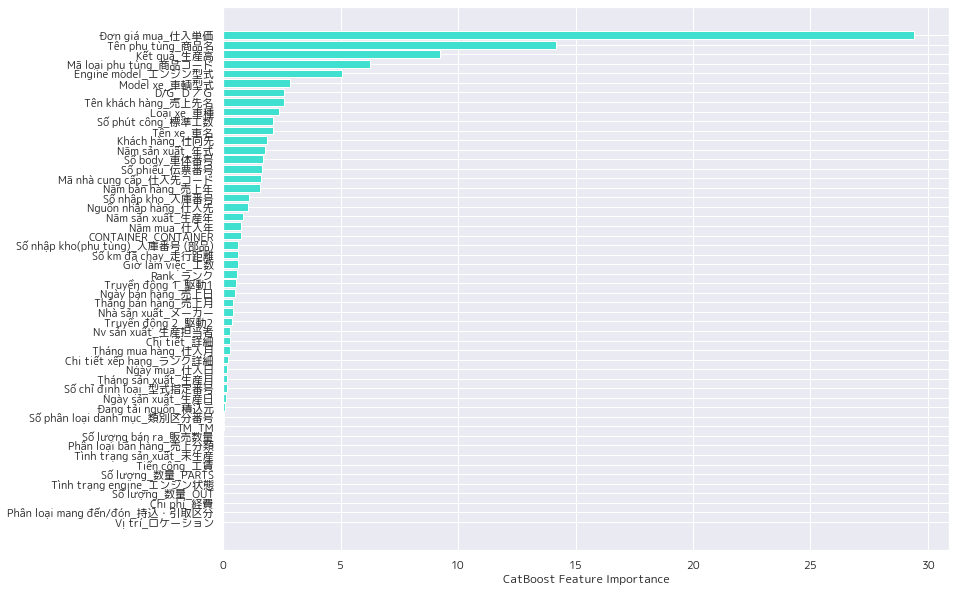

In [210]:
sorted_feature_importance = model.feature_importances_.argsort()
# sorted_feature_importance
plt.figure(figsize=(13,10))
plt.barh(df_scale.columns[sorted_feature_importance], 
        model.feature_importances_[sorted_feature_importance], 
        color='turquoise')
plt.xlabel("CatBoost Feature Importance")

In [211]:
df.columns[sorted_feature_importance[-10:]]

Index(['Rank_ランク', 'Kết quả_生産高', 'Truyền động 1_駆動1', 'TM_TM',
       'Tên phụ tùng_商品名', 'Số nhập kho(phụ tùng)_入庫番号 (部品)',
       'Nv sản xuất_生産担当者', 'Loại xe_車種', 'Số nhập kho_入庫番号',
       'Giờ làm việc_工数'],
      dtype='object')

In [214]:
df_feature_importance = df_scale[df_scale.columns[sorted_feature_importance[-10:]]]

In [215]:
df_feature_importance

,Số phút công_標準工数,Loại xe_車種,Tên khách hàng_売上先名,D/G_Ｄ／Ｇ,Model xe_車輌型式,Engine model_エンジン型式,Mã loại phụ tùng_商品コード,Kết quả_生産高,Tên phụ tùng_商品名,Đơn giá mua_仕入単価
0,-1.305972,-0.584226,1.046165,0.273187,-0.759955,1.168644,1.852361,-0.920594,1.208287,-0.758551
1,0.374511,-0.584226,1.244081,0.273187,-1.406283,-0.329707,-0.247516,0.466135,-0.522983,0.053448
2,-1.305972,-0.584226,1.244081,0.273187,-1.406283,-0.329707,1.852361,-0.920594,1.208287,-0.596151
3,-1.305972,-0.584226,0.980193,0.273187,0.759907,0.178429,1.852361,-0.920594,1.208287,-0.732242
4,-1.305972,1.143361,0.980193,0.273187,-1.556284,1.748440,1.852361,-0.920594,1.208287,-0.732242
...,...,...,...,...,...,...,...,...,...,...
19652,1.634873,-0.584226,0.980193,0.273187,1.179027,1.396654,-0.247516,1.506182,-0.522983,0.053448
19653,0.374511,1.143361,0.980193,0.273187,0.912113,0.536731,-0.247516,0.466135,-0.522983,-0.108952
19654,-0.465730,-0.584226,0.980193,0.273187,0.404757,-1.176601,-0.247516,-0.227230,-0.522983,0.215847
19655,-1.305972,-0.584226,-0.932995,0.273187,1.073144,-0.870416,1.852361,-0.920594,1.208287,-0.719453


In [218]:
x_train, x_test, y_train, y_test = train_test_split(df_feature_importance.values, df_target,test_size=0.3,random_state=42)

In [219]:
rmse = []
mape = []
r_squared = []
for  model in models:
    model.fit(x_train, y_train)
    y_pred  = model.predict(x_test)
#     print(y_pred)
    rmse_score = mean_squared_error(y_test, y_pred,squared=False)
    mape_score = np.mean(np.abs((y_test.values - y_pred)/y_test.values)*100)
    print(mape_score)
#     mape_score = mean_absolute_percentage_error(y_test,y_pred)
    r_squared_score  = model.score(x_test,y_test)
    r_squared.append(r_squared_score)
    rmse.append(rmse_score)
    mape.append(mape_score)

19.300989683260237
23.421536134159584
12.81479246955052
12.901099670092632
14.895338229932381
16.06252103644426


# Using TabNet

In [302]:
df.drop(columns = ['Thành tích bán ra_販売実績','Đơn giá bán hàng_売上単価','Sản lượng bán ra_売上金額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額','Ước tính giá bán ra tại thời điểm sản xuất_生産時販売予測額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額.1','Tổng giá nhập_仕入合計'],inplace=True)

In [344]:
df.columns

Index(['Vị trí_ロケーション', 'Ngày sản xuất_生産日', 'Tháng sản xuất_生産月',
       'Năm sản xuất_生産年', 'Nv sản xuất_生産担当者', 'Số nhập kho_入庫番号',
       'Nguồn nhập hàng_仕入先', 'Mã loại phụ tùng_商品コード', 'Tên phụ tùng_商品名',
       'Số nhập kho(phụ tùng)_入庫番号 (部品)', 'Tên xe_車名', 'Model xe_車輌型式',
       'Engine model_エンジン型式', 'Số lượng_数量_PARTS', 'Tổng giá nhập_仕入合計',
       'Số phút công_標準工数', 'Kết quả_生産高',
       'Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額',
       'Ước tính giá bán ra tại thời điểm sản xuất_生産時販売予測額',
       'Số lượng bán ra_販売数量', 'Thành tích bán ra_販売実績', 'Khách hàng_仕向先',
       'Truyền động 1_駆動1', 'TM_TM', 'Truyền động 2_駆動2', 'Chi tiết_詳細',
       'Số km đã chạy_走行距離', 'Năm sản xuất_年式', 'Tình trạng engine_エンジン状態',
       'Rank_ランク', 'Loại xe_車種', 'Tình trạng sản xuất_未生産',
       'Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額.1',
       'Số chỉ định loại_型式指定番号', 'Số phân loại danh mục_類別区分番号',
       'Đơn giá mua_仕入単価', 'Nhà sản xuất_メーカー', 'Giờ làm việc

In [335]:
target = ['Thành tích bán ra_販売実績','Đơn giá bán hàng_売上単価','Sản lượng bán ra_売上金額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額','Ước tính giá bán ra tại thời điểm sản xuất_生産時販売予測額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額.1','Tổng giá nhập_仕入合計']
df["Set"] = np.random.choice(["train", "valid", "test"], p =[.8, .1, .1], size=(df.shape[0],))
train_indices = df[df.Set=="train"].index
valid_indices = df[df.Set=="valid"].index
test_indices = df[df.Set=="test"].index

In [336]:
df["Set"]

0        valid
1        valid
2        train
3        train
4        train
         ...  
20401    train
20402     test
20403    train
20405    train
20423    train
Name: Set, Length: 19657, dtype: object

In [328]:
len(train_indices)

15829

In [337]:
categorical_columns = []
categorical_dims =  {}
for col in df.columns[df.dtypes == object]:
    print(col, df[col].nunique())
    l_enc = LabelEncoder()
    df[col] = df[col].fillna("unknown")
    df[col] = l_enc.fit_transform(df[col].values)
    categorical_columns.append(col)
    categorical_dims[col] = len(l_enc.classes_)

for col in df.columns[df.dtypes == 'float64']:
    df.fillna(df.loc[train_indices,col].mean(), inplace=True)

Set 3


In [342]:
unused_feat = ['Set']

features = [ col for col in df.columns if col not in unused_feat + target] 

cat_idxs = [ i for i, f in enumerate(features) if f in categorical_columns]

cat_dims = [ categorical_dims[f] for i, f in enumerate(features) if f in categorical_columns]

# define your embedding sizes : here just a random choice
cat_emb_dim = [5, 4, 3, 6, 2, 2, 1, 10]

In [343]:
features

['Vị trí_ロケーション',
 'Ngày sản xuất_生産日',
 'Tháng sản xuất_生産月',
 'Năm sản xuất_生産年',
 'Nv sản xuất_生産担当者',
 'Số nhập kho_入庫番号',
 'Nguồn nhập hàng_仕入先',
 'Mã loại phụ tùng_商品コード',
 'Tên phụ tùng_商品名',
 'Số nhập kho(phụ tùng)_入庫番号 (部品)',
 'Tên xe_車名',
 'Model xe_車輌型式',
 'Engine model_エンジン型式',
 'Số lượng_数量_PARTS',
 'Số phút công_標準工数',
 'Kết quả_生産高',
 'Số lượng bán ra_販売数量',
 'Khách hàng_仕向先',
 'Truyền động 1_駆動1',
 'TM_TM',
 'Truyền động 2_駆動2',
 'Chi tiết_詳細',
 'Số km đã chạy_走行距離',
 'Năm sản xuất_年式',
 'Tình trạng engine_エンジン状態',
 'Rank_ランク',
 'Loại xe_車種',
 'Tình trạng sản xuất_未生産',
 'Số chỉ định loại_型式指定番号',
 'Số phân loại danh mục_類別区分番号',
 'Đơn giá mua_仕入単価',
 'Nhà sản xuất_メーカー',
 'Giờ làm việc_工数',
 'Số lượng_数量_OUT',
 'Ngày bán hàng_売上日',
 'Tháng bán hàng_売上月',
 'Năm bán hàng_売上年',
 'Chi phí_経費',
 'Ngày mua_仕入日',
 'Tháng mua hàng_仕入月',
 'Năm mua_仕入年',
 'Chi tiết xếp hạng_ランク詳細',
 'Số phiếu_伝票番号',
 'Mã nhà cung cấp_仕入先コード',
 'Số body_車体番号',
 'CONTAINER_CONTAINER',
 'Tên khách 

In [366]:
clf = TabNetRegressor(cat_dims=cat_dims, cat_emb_dim=cat_emb_dim, cat_idxs=cat_idxs,
                      )

Device used : cpu


In [367]:
X_train = df[features].loc[train_indices].values
y_train = df_target.loc[train_indices].values.reshape(-1, 1)

X_valid = df[features].loc[valid_indices].values
y_valid = df_target.loc[valid_indices].values.reshape(-1, 1)

X_test = df[features].loc[test_indices].values
y_test = df_target.loc[test_indices].values.reshape(-1, 1)

In [368]:
max_epochs = 1000 if not os.getenv("CI", False) else 2


In [369]:
clf.fit(
    X_train=X_train, y_train=y_train,
    eval_set=[(X_train, y_train), (X_valid, y_valid)],
    eval_name=['train', 'valid'],
    eval_metric=['rmsle', 'mae', 'rmse'],
    max_epochs=max_epochs,
    patience=50,
    batch_size=512, virtual_batch_size=128,
    num_workers=0,
    drop_last=False
) 

epoch 0  | loss: 2787727668.07276| train_rmsle: 64.56102| train_mae: 38178.30067| train_rmse: 52787.09939| valid_rmsle: 64.76778| valid_mae: 38880.32483| valid_rmse: 52604.63029|  0:00:01s
epoch 1  | loss: 2785508762.52487| train_rmsle: 46.18571| train_mae: 38163.40067| train_rmse: 52775.99865| valid_rmsle: 46.53534| valid_mae: 38864.39666| valid_rmse: 52590.29771|  0:00:02s
epoch 2  | loss: 2780264623.5624| train_rmsle: 37.09723| train_mae: 38124.30906| train_rmse: 52727.38982| valid_rmsle: 37.25557| valid_mae: 38824.62983| valid_rmse: 52541.16915|  0:00:04s
epoch 3  | loss: 2770789159.69775| train_rmsle: 24.76309| train_mae: 37980.42441| train_rmse: 52606.52443| valid_rmsle: 24.92158| valid_mae: 38680.69641| valid_rmse: 52422.58865|  0:00:05s
epoch 4  | loss: 2758321424.80397| train_rmsle: 23.24327| train_mae: 37940.57425| train_rmse: 52547.40533| valid_rmsle: 23.34232| valid_mae: 38639.35386| valid_rmse: 52357.94931|  0:00:06s
epoch 5  | loss: 2742606234.32947| train_rmsle: 16.79655

epoch 44 | loss: 1050031449.87355| train_rmsle: 0.75624 | train_mae: 20266.54236| train_rmse: 29938.5997| valid_rmsle: 0.75817 | valid_mae: 20772.82697| valid_rmse: 29908.44964|  0:01:00s
epoch 45 | loss: 1000906236.39333| train_rmsle: 0.83853 | train_mae: 21550.31958| train_rmse: 30920.79377| valid_rmsle: 0.84184 | valid_mae: 22045.96978| valid_rmse: 31020.48606|  0:01:01s
epoch 46 | loss: 954956195.68401| train_rmsle: 0.66428 | train_mae: 20065.21045| train_rmse: 29871.01228| valid_rmsle: 0.66931 | valid_mae: 20549.76682| valid_rmse: 29933.8091|  0:01:02s
epoch 47 | loss: 907755316.08091| train_rmsle: 0.73022 | train_mae: 20267.42244| train_rmse: 29138.54229| valid_rmsle: 0.73578 | valid_mae: 20784.52746| valid_rmse: 29202.75696|  0:01:04s
epoch 48 | loss: 858953849.56825| train_rmsle: 0.62294 | train_mae: 19749.77769| train_rmse: 29333.75665| valid_rmsle: 0.62834 | valid_mae: 20231.04027| valid_rmse: 29561.8244|  0:01:05s
epoch 49 | loss: 827775898.86681| train_rmsle: 0.58111 | trai

KeyboardInterrupt: 

In [357]:
preds = clf.predict(X_test)

y_true = y_test

mean_absolute_percentage_error(y_test,preds)

0.25589420267452656

# Select all accessories

In [484]:
df_copy = df_all.copy()

In [485]:
for col in df_copy.columns[df_copy.dtypes == object]:
    print(col, df_copy[col].nunique())
    l_enc = LabelEncoder()
    df_copy[col] = df_copy[col].fillna("unknown")
    df_copy[col] = l_enc.fit_transform(df_copy[col].values)

for col in df_copy.columns[df_copy.dtypes == 'float64']:
    df_copy[col].fillna(value = 0, inplace=True)

Vị trí_ロケーション 3
Nv sản xuất_生産担当者 46
Số nhập kho_入庫番号 18377
Nguồn nhập hàng_仕入先 2852
Mã loại phụ tùng_商品コード 12
Tên phụ tùng_商品名 12
Số nhập kho(phụ tùng)_入庫番号 (部品) 20428
Tên xe_車名 496
Model xe_車輌型式 1587
Engine model_エンジン型式 536
Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額 163
Khách hàng_仕向先 102
Truyền động 1_駆動1 4
TM_TM 3
Truyền động 2_駆動2 3
Chi tiết_詳細 2235
Rank_ランク 12
Loại xe_車種 8
Tình trạng sản xuất_未生産 1
Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額.1 162
Nhà sản xuất_メーカー 27
Chi tiết xếp hạng_ランク詳細 1728
Số body_車体番号 18090
CONTAINER_CONTAINER 3
Tên khách hàng_売上先名 45
D/G_Ｄ／Ｇ 2
Đang tải nguồn_積込元 5


In [486]:
df_copy.isnull().sum()

Vị trí_ロケーション                                             0
Ngày sản xuất_生産日                                         0
Tháng sản xuất_生産月                                        0
Năm sản xuất_生産年                                          0
Nv sản xuất_生産担当者                                         0
Số nhập kho_入庫番号                                          0
Nguồn nhập hàng_仕入先                                       0
Mã loại phụ tùng_商品コード                                    0
Tên phụ tùng_商品名                                          0
Số nhập kho(phụ tùng)_入庫番号 (部品)                           0
Tên xe_車名                                                 0
Model xe_車輌型式                                             0
Engine model_エンジン型式                                       0
Số lượng_数量_PARTS                                         0
Tổng giá nhập_仕入合計                                        0
Số phút công_標準工数                                         0
Kết quả_生産高                             

In [487]:
target = df_copy['Thành tích bán ra_販売実績']

In [488]:
df_copy.drop(columns = ['Thành tích bán ra_販売実績','Đơn giá bán hàng_売上単価','Sản lượng bán ra_売上金額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額','Ước tính giá bán ra tại thời điểm sản xuất_生産時販売予測額','Ước tính giá bán ra tại thời điểm nhập hàng_仕入時販売予測額.1','Tổng giá nhập_仕入合計'],inplace=True)

# Without Scaler

In [489]:
X_train, X_test, y_train, y_test = train_test_split (df_copy, target, test_size=0.3, random_state=42)

In [490]:
rmse = []
mape = []
r_squared = []
for  model in models:
    model.fit(X_train, y_train)
    y_pred  = model.predict(X_test)
#     print(y_pred)
    rmse_score = mean_squared_error(y_test, y_pred,squared=False)
    mape_score = np.mean(np.abs((y_test.values - y_pred)/y_test.values)*100)
    print(mape_score)
#     mape_score = mean_absolute_percentage_error(y_test,y_pred)
    r_squared_score  = model.score(X_test,y_test)
    r_squared.append(r_squared_score)
    rmse.append(rmse_score)
    mape.append(mape_score)

21.03990041609036
24.054391160144508
13.194505095248187
13.719854647000949
16.51686742283183
16.641176273728668


# With Scaler

In [491]:
df_target = df_all[['Thành tích bán ra_販売実績']]
target = ss.fit_transform(df_target)
target = target.flatten()
target.shape

(20428,)

In [492]:
df_copy.columns

Index(['Vị trí_ロケーション', 'Ngày sản xuất_生産日', 'Tháng sản xuất_生産月',
       'Năm sản xuất_生産年', 'Nv sản xuất_生産担当者', 'Số nhập kho_入庫番号',
       'Nguồn nhập hàng_仕入先', 'Mã loại phụ tùng_商品コード', 'Tên phụ tùng_商品名',
       'Số nhập kho(phụ tùng)_入庫番号 (部品)', 'Tên xe_車名', 'Model xe_車輌型式',
       'Engine model_エンジン型式', 'Số lượng_数量_PARTS', 'Số phút công_標準工数',
       'Kết quả_生産高', 'Số lượng bán ra_販売数量', 'Khách hàng_仕向先',
       'Truyền động 1_駆動1', 'TM_TM', 'Truyền động 2_駆動2', 'Chi tiết_詳細',
       'Số km đã chạy_走行距離', 'Năm sản xuất_年式', 'Tình trạng engine_エンジン状態',
       'Rank_ランク', 'Loại xe_車種', 'Tình trạng sản xuất_未生産',
       'Số chỉ định loại_型式指定番号', 'Số phân loại danh mục_類別区分番号',
       'Đơn giá mua_仕入単価', 'Nhà sản xuất_メーカー', 'Giờ làm việc_工数',
       'Số lượng_数量_OUT', 'Ngày bán hàng_売上日', 'Tháng bán hàng_売上月',
       'Năm bán hàng_売上年', 'Chi phí_経費', 'Ngày mua_仕入日', 'Tháng mua hàng_仕入月',
       'Năm mua_仕入年', 'Chi tiết xếp hạng_ランク詳細', 'Số phiếu_伝票番号',
       'Mã nhà cung cấp_仕

In [493]:
df_scale = pd.DataFrame(ss.fit_transform(df_copy),columns=df_copy.columns)

In [494]:
df_scale

,Vị trí_ロケーション,Ngày sản xuất_生産日,Tháng sản xuất_生産月,Năm sản xuất_生産年,Nv sản xuất_生産担当者,Số nhập kho_入庫番号,Nguồn nhập hàng_仕入先,Mã loại phụ tùng_商品コード,Tên phụ tùng_商品名,Số nhập kho(phụ tùng)_入庫番号 (部品),...,Số phiếu_伝票番号,Mã nhà cung cấp_仕入先コード,Số body_車体番号,CONTAINER_CONTAINER,Tên khách hàng_売上先名,Phân loại mang đến/đón_持込・引取区分,Tiền công_工賃,D/G_Ｄ／Ｇ,Phân loại bán hàng_売上分類,Đang tải nguồn_積込元
0,0.0,0.077325,1.384939,-0.137708,0.164541,-1.010681,1.410203,0.994744,0.018787,1.035856,...,0.289860,1.838572,-0.013999,1.848286,1.066581,0.0,0.0,0.286258,0.0,-0.10053
1,0.0,-1.544907,-1.363116,-0.137708,-1.147358,-0.989579,1.750591,-0.302580,-0.389047,0.796923,...,-0.541213,1.838537,1.478821,0.919025,1.264716,0.0,0.0,0.286258,0.0,-0.10053
2,0.0,-1.544907,-1.363116,-0.137708,0.781905,-0.989579,1.750591,0.994744,0.018787,0.768773,...,-0.541213,1.838537,1.478821,0.919025,1.264716,0.0,0.0,0.286258,0.0,-0.10053
3,0.0,-1.313159,-1.363116,-0.137708,1.785122,-0.704514,1.696845,0.994744,0.018787,0.789971,...,-0.540060,-0.498864,0.729456,0.919025,1.000536,0.0,0.0,0.286258,0.0,-0.10053
4,0.0,1.004314,-1.363116,-0.137708,-0.838676,-0.583365,-0.340216,0.994744,0.018787,0.801502,...,-0.515832,-0.886164,-0.085694,0.919025,1.000536,0.0,0.0,0.286258,0.0,-0.10053
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20423,0.0,-0.733791,0.774260,-1.116748,-0.915847,-1.129191,1.143583,0.994744,0.018787,-0.198489,...,-1.116221,-1.226032,-0.658110,-0.939496,0.538221,0.0,0.0,0.286258,0.0,-0.10053
20424,0.0,1.236061,0.468921,-1.116748,-0.221312,-1.118452,1.696845,2.940728,3.689285,-0.153382,...,-1.118875,-0.498864,-1.328534,-0.939496,-0.914770,0.0,0.0,-3.455056,0.0,-0.10053
20425,0.0,0.772567,0.468921,-1.116748,1.630781,-1.110539,1.393341,2.940728,3.689285,-0.745881,...,-1.118875,1.838572,0.071997,-0.939496,-0.914770,0.0,0.0,-3.455056,0.0,-0.10053
20426,0.0,-1.197286,1.384939,-1.116748,-0.221312,-1.050624,-1.014669,3.589390,4.097118,-0.121671,...,-1.079995,-1.142329,-1.505484,-0.939496,-0.914770,0.0,0.0,-3.455056,0.0,-0.10053


In [495]:
X_train, X_test, y_train, y_test = train_test_split (df_copy, target, test_size=0.3, random_state=42)

In [496]:
rmse = []
mape = []
r_squared = []
for  model in models:
    model.fit(X_train, y_train)
    y_pred  = model.predict(X_test)
#     print(y_pred)
    rmse_score = mean_squared_error(y_test, y_pred,squared=False)
    mape_score = np.mean(np.abs((y_test - y_pred)/y_test)*100)
    print(mape_score)
#     mape_score = mean_absolute_percentage_error(y_test,y_pred)
    r_squared_score  = model.score(X_test,y_test)
    r_squared.append(r_squared_score)
    rmse.append(rmse_score)
    mape.append(mape_score)

70.87980127753717
83.48493598066972


KeyboardInterrupt: 